In [168]:
from datetime import datetime
import math
import sys

import matplotlib.pyplot as plt
import numpy as np
import scipy
from scipy import linalg
import torch
from torch.func import jacrev
import torch.nn as nn

import seaborn as sns

## Model and function definitions

In [169]:
class PolynomialRegression:
    
    def __init__(self, coef_lb, coef_ub, degree):
        self.coef_arr = np.random.uniform(coef_lb, coef_ub, degree + 1)

    def __call__(self, x):
        return np.sum([coef * x ** i for i, coef in enumerate(self.coef_arr)], axis=0)

In [170]:
class TwoLayerNet(nn.Module):
    
    def __init__(self, d0, d1, d2):
        super(TwoLayerNet, self).__init__()
        
        layers = []
        
        lin_layer1 = nn.Linear(d0, d1)        
        torch.nn.init.normal_(lin_layer1.bias, mean=0., std=np.sqrt(2. / d0))        
        torch.nn.init.kaiming_normal_(lin_layer1.weight, nonlinearity='relu')
        layers.append(lin_layer1)
        layers.append(nn.ReLU())
        
        lin_layer2 = nn.Linear(d1, d2, bias=False)
        torch.nn.init.normal_(lin_layer2.weight, mean=0., std=np.sqrt(1. / d1))
        # Freeze the weights in the last layer
        lin_layer2.weight.requires_grad = False
        layers.append(lin_layer2)
        
        self.layers = nn.ModuleList(layers)

    def forward(self, x):
        for layer in self.layers:
            x = layer(x)
        return x

In [171]:
def get_spectrum_ntk(model, x):
    jacobian = []
    for one_x in x:
        model(one_x).backward()        
        grads = [param.grad.view(-1) for param in model.parameters() if param.grad is not None]
        jacobian.append(torch.cat(grads).numpy())
        
    jacobian = np.asarray(jacobian)
    ntk = jacobian.T@jacobian
    spectrum = scipy.linalg.svdvals(jacobian)
    return spectrum

In [172]:
def get_rank_A(model):
    out1 = model.layers[0](x).detach().numpy()
    pattern = out1 > 0
    rank = np.linalg.matrix_rank(pattern.astype(np.float64))    
    return rank

In [179]:
def train(model, optimizer, loss_fn, x, y, n, epochs_num, spectrum_epochs,loss_epochs, get_spectra=False):   
    losses = []
    ntk_spectra= []
    for e_id in range(epochs_num+1):
        model.train(True)
        
        # We use full-batch gradient descent
        optimizer.zero_grad()

        pred_y = model(x)
        loss = loss_fn(pred_y, y)    

        print(f'Epoch {e_id + 1}. Loss: {loss.item()}')
        
        if e_id in spectrum_epochs and get_spectra:
            ntk_spectra.append(get_spectrum_ntk(model, x))
            
        if e_id in loss_epochs:
            losses.append(loss.item())
            
        loss.backward()
        optimizer.step() 
            
    return np.array(losses), np.array(ntk_spectra)

In [174]:
def get_gaussian_data(d0, data_size, target_fn):
    x = np.random.normal(size=(data_size, d0))
    y = target_fn(x)
    return x, y

## Spectrum of NTK at points during training

In [113]:
# Fixed parameters
D0 = 1
D1 = 200
LR = .1

DATA_SIZE = 200
DEGREE = 2

EPOCHS_NUM = 1000
loss_epochs = np.arange(50, EPOCHS_NUM+1, 50)
spectrum_epochs = [10, 50, 100, 250, 500, 900]

TRIALS = 10

In [114]:
model = TwoLayerNet(d0=1, d1=D1, d2=1)
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=LR)


# Generate data
gen_x, gen_y = get_gaussian_data(d0=1, data_size=DATA_SIZE,
                 target_fn=PolynomialRegression(coef_lb=-1., coef_ub=1., degree=DEGREE))
x = torch.tensor(gen_x, dtype=torch.float)
y = torch.tensor(gen_y, dtype=torch.float)

loss_arr, ntk_arr = train(model, optimizer, loss_fn, x, y, DATA_SIZE, EPOCHS_NUM, spectrum_epochs, loss_epochs, get_spectra=True)

Epoch 1. Loss: 6.038173675537109
Epoch 2. Loss: 3.5177924633026123
Epoch 3. Loss: 2.264704942703247
Epoch 4. Loss: 1.820730447769165
Epoch 5. Loss: 1.6856346130371094
Epoch 6. Loss: 1.5441519021987915
Epoch 7. Loss: 1.3042564392089844
Epoch 8. Loss: 1.0031914710998535
Epoch 9. Loss: 0.7315809726715088
Epoch 10. Loss: 0.572813868522644
Epoch 11. Loss: 0.5562670230865479
Epoch 12. Loss: 0.6467101573944092
Epoch 13. Loss: 0.7585567235946655
Epoch 14. Loss: 0.8105371594429016
Epoch 15. Loss: 0.7733126878738403
Epoch 16. Loss: 0.6715499758720398
Epoch 17. Loss: 0.5545393228530884
Epoch 18. Loss: 0.46453532576560974
Epoch 19. Loss: 0.4172590672969818
Epoch 20. Loss: 0.40307196974754333
Epoch 21. Loss: 0.39559921622276306
Epoch 22. Loss: 0.3714604079723358
Epoch 23. Loss: 0.32259970903396606
Epoch 24. Loss: 0.2589866518974304
Epoch 25. Loss: 0.20039647817611694
Epoch 26. Loss: 0.16441255807876587
Epoch 27. Loss: 0.1581641584634781
Epoch 28. Loss: 0.17429547011852264
Epoch 29. Loss: 0.19546817

Epoch 318. Loss: 0.0068824272602796555
Epoch 319. Loss: 0.006849629804491997
Epoch 320. Loss: 0.006816998589783907
Epoch 321. Loss: 0.006784525699913502
Epoch 322. Loss: 0.006752199027687311
Epoch 323. Loss: 0.006720026023685932
Epoch 324. Loss: 0.0066880579106509686
Epoch 325. Loss: 0.006656253710389137
Epoch 326. Loss: 0.00662462692707777
Epoch 327. Loss: 0.006593178492039442
Epoch 328. Loss: 0.00656186044216156
Epoch 329. Loss: 0.0065306867472827435
Epoch 330. Loss: 0.006499653682112694
Epoch 331. Loss: 0.006468889769166708
Epoch 332. Loss: 0.006438302341848612
Epoch 333. Loss: 0.006407856475561857
Epoch 334. Loss: 0.006377574987709522
Epoch 335. Loss: 0.006347473245114088
Epoch 336. Loss: 0.006317521445453167
Epoch 337. Loss: 0.006287681870162487
Epoch 338. Loss: 0.006258023902773857
Epoch 339. Loss: 0.006228512618690729
Epoch 340. Loss: 0.006199145223945379
Epoch 341. Loss: 0.006169846747070551
Epoch 342. Loss: 0.006140699610114098
Epoch 343. Loss: 0.006111662369221449
Epoch 344. 

Epoch 786. Loss: 0.0008101023267954588
Epoch 787. Loss: 0.0008072860073298216
Epoch 788. Loss: 0.0008044706773944199
Epoch 789. Loss: 0.0008016888168640435
Epoch 790. Loss: 0.0007989090518094599
Epoch 791. Loss: 0.0007961522205732763
Epoch 792. Loss: 0.0007934061577543616
Epoch 793. Loss: 0.0007906652754172683
Epoch 794. Loss: 0.0007879501790739596
Epoch 795. Loss: 0.0007852464914321899
Epoch 796. Loss: 0.0007825514767318964
Epoch 797. Loss: 0.0007798766600899398
Epoch 798. Loss: 0.0007772105163894594
Epoch 799. Loss: 0.0007745629409328103
Epoch 800. Loss: 0.0007719304412603378
Epoch 801. Loss: 0.0007693039369769394
Epoch 802. Loss: 0.0007666987949050963
Epoch 803. Loss: 0.0007641009869985282
Epoch 804. Loss: 0.0007615223294124007
Epoch 805. Loss: 0.0007589494343847036
Epoch 806. Loss: 0.0007563917897641659
Epoch 807. Loss: 0.0007538461941294372
Epoch 808. Loss: 0.000751314393710345
Epoch 809. Loss: 0.0007487859693355858
Epoch 810. Loss: 0.000746286241337657
Epoch 811. Loss: 0.00074379

Epoch 999. Loss: 0.0004196304944343865
Epoch 1000. Loss: 0.00041849835542961955
Epoch 1001. Loss: 0.0004173587658442557


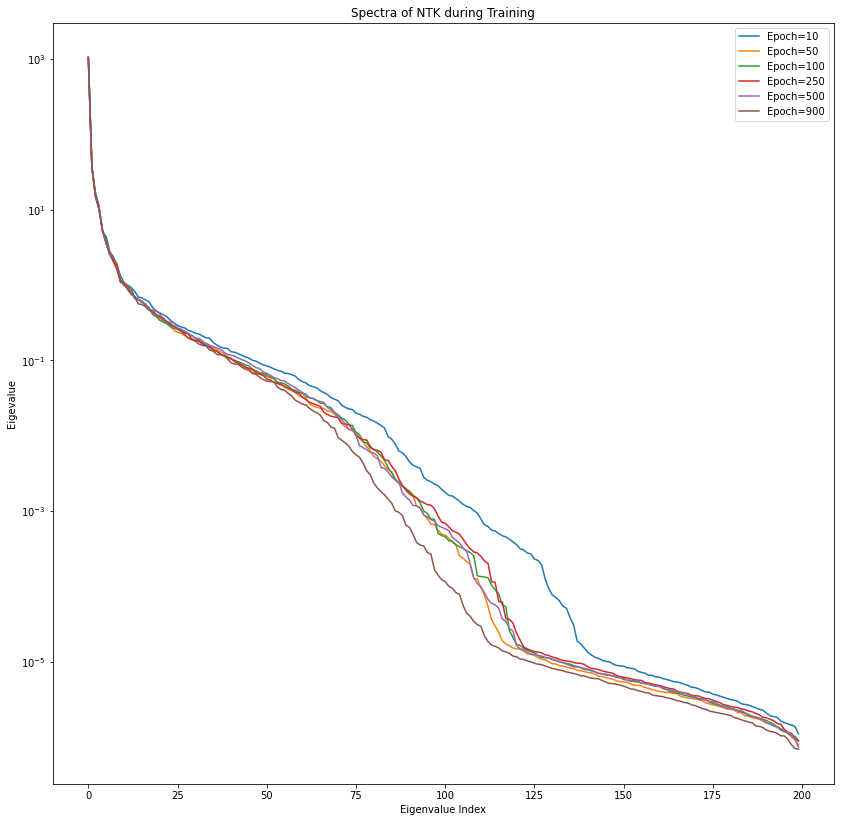

In [72]:
fig,ax = plt.subplots(figsize=(14, 14))
for i in range(ntk_arr.shape[0]):
    ax.plot(ntk_arr[i], label="Epoch="+str(spectrum_epochs[i]))

plt.xlabel("Eigenvalue Index")
plt.ylabel("Eigevalue")
plt.title("Spectra of NTK during Training")
plt.yscale("log")
plt.legend()

## Relationship between rank of A at initialization, overparameterization and training

### D0=1 

In [203]:
# Fixed parameters
D0 = 1
D1 = np.arange(50,801,50)
LR = .001

DATA_SIZE = 100
DEGREE = 2

EPOCHS_NUM = 1000
loss_epochs = np.arange(5, EPOCHS_NUM+1, 5)

TRIALS = 20

In [204]:
av_loss_epochs_vs_m = np.zeros((len(loss_epochs), len(D1)))
av_rank_A_init = np.zeros(len(D1))

for i in range(len(D1)):
    for t in range(TRIALS):
        # Define mode
        model = TwoLayerNet(d0=1, d1=D1[i], d2=1)
        av_rank_A_init[i] += get_rank_A(model)
        
        loss_fn = nn.MSELoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=LR)
        
        
        # Generate data
        gen_x, gen_y = get_gaussian_data(d0=1, data_size=DATA_SIZE,
                         target_fn=PolynomialRegression(coef_lb=-1., coef_ub=1., degree=DEGREE))
        x = torch.tensor(gen_x, dtype=torch.float)
        y = torch.tensor(gen_y, dtype=torch.float)
        
        losses, _ = train(model, optimizer, 
                                  loss_fn, x, y, DATA_SIZE, EPOCHS_NUM, 
                                  spectrum_epochs, loss_epochs, get_spectra=True)
        print(losses)
        av_loss_epochs_vs_m[:,i] += losses
        
av_rank_A_init =  100*av_rank_A_init/(TRIALS*DATA_SIZE)
av_loss_epochs_vs_m = av_loss_epochs_vs_m/(TRIALS)
        

Epoch 1. Loss: 6.506964683532715
Epoch 2. Loss: 6.485482215881348
Epoch 3. Loss: 6.463922023773193
Epoch 4. Loss: 6.442310333251953
Epoch 5. Loss: 6.420680999755859
Epoch 6. Loss: 6.3990912437438965
Epoch 7. Loss: 6.377542495727539
Epoch 8. Loss: 6.356037616729736
Epoch 9. Loss: 6.334576606750488
Epoch 10. Loss: 6.3131103515625
Epoch 11. Loss: 6.29165506362915
Epoch 12. Loss: 6.295394420623779
Epoch 13. Loss: 6.2979841232299805
Epoch 14. Loss: 6.299554347991943
Epoch 15. Loss: 6.3002142906188965
Epoch 16. Loss: 6.300055980682373
Epoch 17. Loss: 6.299159526824951
Epoch 18. Loss: 6.297595977783203
Epoch 19. Loss: 6.295423984527588
Epoch 20. Loss: 6.292699813842773
Epoch 21. Loss: 6.289454460144043
Epoch 22. Loss: 6.285720348358154
Epoch 23. Loss: 6.281520366668701
Epoch 24. Loss: 6.27688455581665
Epoch 25. Loss: 6.271852016448975
Epoch 26. Loss: 6.266435146331787
Epoch 27. Loss: 6.2606892585754395
Epoch 28. Loss: 6.254638671875
Epoch 29. Loss: 6.248306751251221
Epoch 30. Loss: 6.24171638

Epoch 272. Loss: 4.5228776931762695
Epoch 273. Loss: 4.51693868637085
Epoch 274. Loss: 4.5108418464660645
Epoch 275. Loss: 4.504603385925293
Epoch 276. Loss: 4.498236179351807
Epoch 277. Loss: 4.491754055023193
Epoch 278. Loss: 4.485168933868408
Epoch 279. Loss: 4.478491306304932
Epoch 280. Loss: 4.471729278564453
Epoch 281. Loss: 4.464892387390137
Epoch 282. Loss: 4.457989692687988
Epoch 283. Loss: 4.451025485992432
Epoch 284. Loss: 4.4440083503723145
Epoch 285. Loss: 4.436943531036377
Epoch 286. Loss: 4.429836273193359
Epoch 287. Loss: 4.4226908683776855
Epoch 288. Loss: 4.415512561798096
Epoch 289. Loss: 4.408306121826172
Epoch 290. Loss: 4.401072978973389
Epoch 291. Loss: 4.39381742477417
Epoch 292. Loss: 4.386541366577148
Epoch 293. Loss: 4.379247188568115
Epoch 294. Loss: 4.3719377517700195
Epoch 295. Loss: 4.3646135330200195
Epoch 296. Loss: 4.357276439666748
Epoch 297. Loss: 4.3499298095703125
Epoch 298. Loss: 4.342573642730713
Epoch 299. Loss: 4.335210800170898
Epoch 300. Loss

Epoch 685. Loss: 2.202666759490967
Epoch 686. Loss: 2.1983840465545654
Epoch 687. Loss: 2.1941089630126953
Epoch 688. Loss: 2.1898412704467773
Epoch 689. Loss: 2.1855812072753906
Epoch 690. Loss: 2.181328535079956
Epoch 691. Loss: 2.1770832538604736
Epoch 692. Loss: 2.1728458404541016
Epoch 693. Loss: 2.1686158180236816
Epoch 694. Loss: 2.1643929481506348
Epoch 695. Loss: 2.160177230834961
Epoch 696. Loss: 2.15596866607666
Epoch 697. Loss: 2.151768207550049
Epoch 698. Loss: 2.147576332092285
Epoch 699. Loss: 2.1433911323547363
Epoch 700. Loss: 2.1392133235931396
Epoch 701. Loss: 2.135043144226074
Epoch 702. Loss: 2.130880832672119
Epoch 703. Loss: 2.126725435256958
Epoch 704. Loss: 2.122577428817749
Epoch 705. Loss: 2.1184370517730713
Epoch 706. Loss: 2.1143035888671875
Epoch 707. Loss: 2.110177993774414
Epoch 708. Loss: 2.1060593128204346
Epoch 709. Loss: 2.1019458770751953
Epoch 710. Loss: 2.097839117050171
Epoch 711. Loss: 2.0937399864196777
Epoch 712. Loss: 2.0896477699279785
Epoch

Epoch 52. Loss: 2.740212917327881
Epoch 53. Loss: 2.742504835128784
Epoch 54. Loss: 2.744480848312378
Epoch 55. Loss: 2.7461676597595215
Epoch 56. Loss: 2.7475879192352295
Epoch 57. Loss: 2.748765230178833
Epoch 58. Loss: 2.749720811843872
Epoch 59. Loss: 2.750473737716675
Epoch 60. Loss: 2.751041889190674
Epoch 61. Loss: 2.7514405250549316
Epoch 62. Loss: 2.7516846656799316
Epoch 63. Loss: 2.7517876625061035
Epoch 64. Loss: 2.751763105392456
Epoch 65. Loss: 2.751620292663574
Epoch 66. Loss: 2.7513692378997803
Epoch 67. Loss: 2.751019239425659
Epoch 68. Loss: 2.750579595565796
Epoch 69. Loss: 2.750056266784668
Epoch 70. Loss: 2.749457359313965
Epoch 71. Loss: 2.7487893104553223
Epoch 72. Loss: 2.7480576038360596
Epoch 73. Loss: 2.747267246246338
Epoch 74. Loss: 2.7464237213134766
Epoch 75. Loss: 2.745530605316162
Epoch 76. Loss: 2.7445926666259766
Epoch 77. Loss: 2.7436130046844482
Epoch 78. Loss: 2.7425949573516846
Epoch 79. Loss: 2.7415413856506348
Epoch 80. Loss: 2.7404556274414062


Epoch 436. Loss: 2.2870960235595703
Epoch 437. Loss: 2.285386562347412
Epoch 438. Loss: 2.283676862716675
Epoch 439. Loss: 2.2819666862487793
Epoch 440. Loss: 2.280256986618042
Epoch 441. Loss: 2.2785465717315674
Epoch 442. Loss: 2.2768361568450928
Epoch 443. Loss: 2.275125503540039
Epoch 444. Loss: 2.2734146118164062
Epoch 445. Loss: 2.2717037200927734
Epoch 446. Loss: 2.269990921020508
Epoch 447. Loss: 2.2682762145996094
Epoch 448. Loss: 2.2665607929229736
Epoch 449. Loss: 2.264845609664917
Epoch 450. Loss: 2.2631282806396484
Epoch 451. Loss: 2.261410713195801
Epoch 452. Loss: 2.259692430496216
Epoch 453. Loss: 2.2579736709594727
Epoch 454. Loss: 2.256254196166992
Epoch 455. Loss: 2.2545340061187744
Epoch 456. Loss: 2.252812147140503
Epoch 457. Loss: 2.2510886192321777
Epoch 458. Loss: 2.2493643760681152
Epoch 459. Loss: 2.2476391792297363
Epoch 460. Loss: 2.2459142208099365
Epoch 461. Loss: 2.2441883087158203
Epoch 462. Loss: 2.242461919784546
Epoch 463. Loss: 2.2407350540161133
Epo

Epoch 859. Loss: 1.688643455505371
Epoch 860. Loss: 1.6872128248214722
Epoch 861. Loss: 1.6857829093933105
Epoch 862. Loss: 1.6843535900115967
Epoch 863. Loss: 1.682924509048462
Epoch 864. Loss: 1.6814950704574585
Epoch 865. Loss: 1.6800665855407715
Epoch 866. Loss: 1.6786383390426636
Epoch 867. Loss: 1.6772106885910034
Epoch 868. Loss: 1.6757839918136597
Epoch 869. Loss: 1.6743582487106323
Epoch 870. Loss: 1.6729333400726318
Epoch 871. Loss: 1.6715091466903687
Epoch 872. Loss: 1.6700860261917114
Epoch 873. Loss: 1.668663740158081
Epoch 874. Loss: 1.667242407798767
Epoch 875. Loss: 1.6658220291137695
Epoch 876. Loss: 1.6644024848937988
Epoch 877. Loss: 1.6629847288131714
Epoch 878. Loss: 1.6615686416625977
Epoch 879. Loss: 1.6601530313491821
Epoch 880. Loss: 1.6587387323379517
Epoch 881. Loss: 1.6573253870010376
Epoch 882. Loss: 1.6559131145477295
Epoch 883. Loss: 1.6545013189315796
Epoch 884. Loss: 1.6530908346176147
Epoch 885. Loss: 1.6516809463500977
Epoch 886. Loss: 1.6502716541290

Epoch 164. Loss: 0.9078465104103088
Epoch 165. Loss: 0.9071922898292542
Epoch 166. Loss: 0.9065369367599487
Epoch 167. Loss: 0.905880331993103
Epoch 168. Loss: 0.9052222967147827
Epoch 169. Loss: 0.9045631289482117
Epoch 170. Loss: 0.9039027690887451
Epoch 171. Loss: 0.9032410383224487
Epoch 172. Loss: 0.9025783538818359
Epoch 173. Loss: 0.9019142985343933
Epoch 174. Loss: 0.9012492299079895
Epoch 175. Loss: 0.900583028793335
Epoch 176. Loss: 0.8999159336090088
Epoch 177. Loss: 0.8992475867271423
Epoch 178. Loss: 0.8985781669616699
Epoch 179. Loss: 0.8979080319404602
Epoch 180. Loss: 0.8972365856170654
Epoch 181. Loss: 0.8965644836425781
Epoch 182. Loss: 0.8958912491798401
Epoch 183. Loss: 0.8952171206474304
Epoch 184. Loss: 0.8945422172546387
Epoch 185. Loss: 0.8938664197921753
Epoch 186. Loss: 0.893189549446106
Epoch 187. Loss: 0.8925119042396545
Epoch 188. Loss: 0.8918334245681763
Epoch 189. Loss: 0.8911541700363159
Epoch 190. Loss: 0.8904740214347839
Epoch 191. Loss: 0.889792859554

Epoch 537. Loss: 0.7139472961425781
Epoch 538. Loss: 0.7134158611297607
Epoch 539. Loss: 0.7128772139549255
Epoch 540. Loss: 0.712332010269165
Epoch 541. Loss: 0.711780846118927
Epoch 542. Loss: 0.7112247347831726
Epoch 543. Loss: 0.7106636762619019
Epoch 544. Loss: 0.7100985050201416
Epoch 545. Loss: 0.7095296382904053
Epoch 546. Loss: 0.7089573740959167
Epoch 547. Loss: 0.7083818316459656
Epoch 548. Loss: 0.70780348777771
Epoch 549. Loss: 0.7072227597236633
Epoch 550. Loss: 0.7066398859024048
Epoch 551. Loss: 0.7060549855232239
Epoch 552. Loss: 0.7054685950279236
Epoch 553. Loss: 0.7048805952072144
Epoch 554. Loss: 0.7042914032936096
Epoch 555. Loss: 0.7037009596824646
Epoch 556. Loss: 0.7031095027923584
Epoch 557. Loss: 0.7025172710418701
Epoch 558. Loss: 0.701924204826355
Epoch 559. Loss: 0.7013307809829712
Epoch 560. Loss: 0.700736939907074
Epoch 561. Loss: 0.7001424431800842
Epoch 562. Loss: 0.6995476484298706
Epoch 563. Loss: 0.6989524960517883
Epoch 564. Loss: 0.698356866836547

Epoch 953. Loss: 0.5221426486968994
Epoch 954. Loss: 0.5217164158821106
Epoch 955. Loss: 0.5212893486022949
Epoch 956. Loss: 0.5208614468574524
Epoch 957. Loss: 0.5204329490661621
Epoch 958. Loss: 0.5200039148330688
Epoch 959. Loss: 0.5195742845535278
Epoch 960. Loss: 0.5191444158554077
Epoch 961. Loss: 0.5187141299247742
Epoch 962. Loss: 0.5182837247848511
Epoch 963. Loss: 0.5178530812263489
Epoch 964. Loss: 0.5174223184585571
Epoch 965. Loss: 0.5169914364814758
Epoch 966. Loss: 0.5165606141090393
Epoch 967. Loss: 0.5161296725273132
Epoch 968. Loss: 0.5156989097595215
Epoch 969. Loss: 0.515268087387085
Epoch 970. Loss: 0.5148375034332275
Epoch 971. Loss: 0.5144069194793701
Epoch 972. Loss: 0.5139765739440918
Epoch 973. Loss: 0.513546347618103
Epoch 974. Loss: 0.5131164789199829
Epoch 975. Loss: 0.5126866698265076
Epoch 976. Loss: 0.5122572183609009
Epoch 977. Loss: 0.511827826499939
Epoch 978. Loss: 0.5113988518714905
Epoch 979. Loss: 0.5109701752662659
Epoch 980. Loss: 0.510541617870

Epoch 256. Loss: 2.0678091049194336
Epoch 257. Loss: 2.061267137527466
Epoch 258. Loss: 2.0551557540893555
Epoch 259. Loss: 2.049433946609497
Epoch 260. Loss: 2.044064998626709
Epoch 261. Loss: 2.039016008377075
Epoch 262. Loss: 2.034255027770996
Epoch 263. Loss: 2.0297534465789795
Epoch 264. Loss: 2.025484561920166
Epoch 265. Loss: 2.0214264392852783
Epoch 266. Loss: 2.017556667327881
Epoch 267. Loss: 2.013856887817383
Epoch 268. Loss: 2.0103094577789307
Epoch 269. Loss: 2.006898880004883
Epoch 270. Loss: 2.0036122798919678
Epoch 271. Loss: 2.0004360675811768
Epoch 272. Loss: 1.9973591566085815
Epoch 273. Loss: 1.9943715333938599
Epoch 274. Loss: 1.9914653301239014
Epoch 275. Loss: 1.988632321357727
Epoch 276. Loss: 1.9858664274215698
Epoch 277. Loss: 1.983160376548767
Epoch 278. Loss: 1.9805068969726562
Epoch 279. Loss: 1.9779009819030762
Epoch 280. Loss: 1.9753379821777344
Epoch 281. Loss: 1.9728138446807861
Epoch 282. Loss: 1.9703253507614136
Epoch 283. Loss: 1.967867374420166
Epoc

Epoch 663. Loss: 1.1339222192764282
Epoch 664. Loss: 1.132298231124878
Epoch 665. Loss: 1.1306747198104858
Epoch 666. Loss: 1.1290526390075684
Epoch 667. Loss: 1.1274305582046509
Epoch 668. Loss: 1.1258100271224976
Epoch 669. Loss: 1.1241904497146606
Epoch 670. Loss: 1.1225717067718506
Epoch 671. Loss: 1.120954155921936
Epoch 672. Loss: 1.119337797164917
Epoch 673. Loss: 1.117722511291504
Epoch 674. Loss: 1.1161082983016968
Epoch 675. Loss: 1.114494800567627
Epoch 676. Loss: 1.112882137298584
Epoch 677. Loss: 1.111270546913147
Epoch 678. Loss: 1.1096599102020264
Epoch 679. Loss: 1.10805082321167
Epoch 680. Loss: 1.1064426898956299
Epoch 681. Loss: 1.1048355102539062
Epoch 682. Loss: 1.1032297611236572
Epoch 683. Loss: 1.1016252040863037
Epoch 684. Loss: 1.1000221967697144
Epoch 685. Loss: 1.0984199047088623
Epoch 686. Loss: 1.0968167781829834
Epoch 687. Loss: 1.0952147245407104
Epoch 688. Loss: 1.0936126708984375
Epoch 689. Loss: 1.09201180934906
Epoch 690. Loss: 1.0904120206832886
Epo

Epoch 15. Loss: 6.117166042327881
Epoch 16. Loss: 6.117331027984619
Epoch 17. Loss: 6.116739273071289
Epoch 18. Loss: 6.115466117858887
Epoch 19. Loss: 6.113574028015137
Epoch 20. Loss: 6.111132621765137
Epoch 21. Loss: 6.108184814453125
Epoch 22. Loss: 6.104769229888916
Epoch 23. Loss: 6.100927352905273
Epoch 24. Loss: 6.096692085266113
Epoch 25. Loss: 6.092097759246826
Epoch 26. Loss: 6.0871710777282715
Epoch 27. Loss: 6.081937789916992
Epoch 28. Loss: 6.076423168182373
Epoch 29. Loss: 6.070592880249023
Epoch 30. Loss: 6.064505577087402
Epoch 31. Loss: 6.058188438415527
Epoch 32. Loss: 6.051657676696777
Epoch 33. Loss: 6.044929027557373
Epoch 34. Loss: 6.038015365600586
Epoch 35. Loss: 6.030927658081055
Epoch 36. Loss: 6.023679733276367
Epoch 37. Loss: 6.01628303527832
Epoch 38. Loss: 6.008744716644287
Epoch 39. Loss: 6.001074314117432
Epoch 40. Loss: 5.993281841278076
Epoch 41. Loss: 5.985377788543701
Epoch 42. Loss: 5.9773664474487305
Epoch 43. Loss: 5.969257354736328
Epoch 44. Los

Epoch 319. Loss: 4.259805202484131
Epoch 320. Loss: 4.253045558929443
Epoch 321. Loss: 4.246287822723389
Epoch 322. Loss: 4.239535331726074
Epoch 323. Loss: 4.232785701751709
Epoch 324. Loss: 4.226039886474609
Epoch 325. Loss: 4.219299793243408
Epoch 326. Loss: 4.212563991546631
Epoch 327. Loss: 4.205831050872803
Epoch 328. Loss: 4.199102878570557
Epoch 329. Loss: 4.192378044128418
Epoch 330. Loss: 4.1856584548950195
Epoch 331. Loss: 4.178947925567627
Epoch 332. Loss: 4.172243118286133
Epoch 333. Loss: 4.165544033050537
Epoch 334. Loss: 4.158851623535156
Epoch 335. Loss: 4.152163505554199
Epoch 336. Loss: 4.145481109619141
Epoch 337. Loss: 4.138803482055664
Epoch 338. Loss: 4.132131099700928
Epoch 339. Loss: 4.125462532043457
Epoch 340. Loss: 4.118799209594727
Epoch 341. Loss: 4.112141132354736
Epoch 342. Loss: 4.105486869812012
Epoch 343. Loss: 4.098837375640869
Epoch 344. Loss: 4.092192649841309
Epoch 345. Loss: 4.085552215576172
Epoch 346. Loss: 4.078917026519775
Epoch 347. Loss: 4.

Epoch 739. Loss: 2.1339163780212402
Epoch 740. Loss: 2.1298015117645264
Epoch 741. Loss: 2.1256916522979736
Epoch 742. Loss: 2.121586799621582
Epoch 743. Loss: 2.117485284805298
Epoch 744. Loss: 2.113387107849121
Epoch 745. Loss: 2.1092939376831055
Epoch 746. Loss: 2.105205774307251
Epoch 747. Loss: 2.1011223793029785
Epoch 748. Loss: 2.0970442295074463
Epoch 749. Loss: 2.092970609664917
Epoch 750. Loss: 2.088902235031128
Epoch 751. Loss: 2.084838628768921
Epoch 752. Loss: 2.080780029296875
Epoch 753. Loss: 2.0767250061035156
Epoch 754. Loss: 2.0726723670959473
Epoch 755. Loss: 2.0686194896698
Epoch 756. Loss: 2.064572334289551
Epoch 757. Loss: 2.0605309009552
Epoch 758. Loss: 2.0564944744110107
Epoch 759. Loss: 2.052462577819824
Epoch 760. Loss: 2.0484354496002197
Epoch 761. Loss: 2.044412612915039
Epoch 762. Loss: 2.0403950214385986
Epoch 763. Loss: 2.036381959915161
Epoch 764. Loss: 2.032374382019043
Epoch 765. Loss: 2.0283725261688232
Epoch 766. Loss: 2.024369478225708
Epoch 767. L

Epoch 67. Loss: 17.705333709716797
Epoch 68. Loss: 17.684667587280273
Epoch 69. Loss: 17.664209365844727
Epoch 70. Loss: 17.643939971923828
Epoch 71. Loss: 17.62383270263672
Epoch 72. Loss: 17.603870391845703
Epoch 73. Loss: 17.584030151367188
Epoch 74. Loss: 17.56430435180664
Epoch 75. Loss: 17.544666290283203
Epoch 76. Loss: 17.525115966796875
Epoch 77. Loss: 17.505630493164062
Epoch 78. Loss: 17.48619842529297
Epoch 79. Loss: 17.466815948486328
Epoch 80. Loss: 17.447465896606445
Epoch 81. Loss: 17.428150177001953
Epoch 82. Loss: 17.408863067626953
Epoch 83. Loss: 17.389598846435547
Epoch 84. Loss: 17.370349884033203
Epoch 85. Loss: 17.351106643676758
Epoch 86. Loss: 17.331871032714844
Epoch 87. Loss: 17.312637329101562
Epoch 88. Loss: 17.29339599609375
Epoch 89. Loss: 17.274137496948242
Epoch 90. Loss: 17.254867553710938
Epoch 91. Loss: 17.23558807373047
Epoch 92. Loss: 17.216293334960938
Epoch 93. Loss: 17.196983337402344
Epoch 94. Loss: 17.177654266357422
Epoch 95. Loss: 17.158306

Epoch 438. Loss: 11.041925430297852
Epoch 439. Loss: 11.0267915725708
Epoch 440. Loss: 11.011667251586914
Epoch 441. Loss: 10.996548652648926
Epoch 442. Loss: 10.981423377990723
Epoch 443. Loss: 10.966304779052734
Epoch 444. Loss: 10.951197624206543
Epoch 445. Loss: 10.9360990524292
Epoch 446. Loss: 10.921008110046387
Epoch 447. Loss: 10.905925750732422
Epoch 448. Loss: 10.890854835510254
Epoch 449. Loss: 10.8757905960083
Epoch 450. Loss: 10.860738754272461
Epoch 451. Loss: 10.845694541931152
Epoch 452. Loss: 10.830662727355957
Epoch 453. Loss: 10.815644264221191
Epoch 454. Loss: 10.800638198852539
Epoch 455. Loss: 10.78564167022705
Epoch 456. Loss: 10.770657539367676
Epoch 457. Loss: 10.755667686462402
Epoch 458. Loss: 10.740675926208496
Epoch 459. Loss: 10.725696563720703
Epoch 460. Loss: 10.710724830627441
Epoch 461. Loss: 10.695761680603027
Epoch 462. Loss: 10.680810928344727
Epoch 463. Loss: 10.665867805480957
Epoch 464. Loss: 10.650934219360352
Epoch 465. Loss: 10.63602066040039


Epoch 847. Loss: 6.020492076873779
Epoch 848. Loss: 6.0110907554626465
Epoch 849. Loss: 6.001699924468994
Epoch 850. Loss: 5.992321014404297
Epoch 851. Loss: 5.982952117919922
Epoch 852. Loss: 5.97359561920166
Epoch 853. Loss: 5.9642462730407715
Epoch 854. Loss: 5.954907417297363
Epoch 855. Loss: 5.945580005645752
Epoch 856. Loss: 5.936261177062988
Epoch 857. Loss: 5.926950454711914
Epoch 858. Loss: 5.917654037475586
Epoch 859. Loss: 5.908366680145264
Epoch 860. Loss: 5.899090766906738
Epoch 861. Loss: 5.889824390411377
Epoch 862. Loss: 5.880569934844971
Epoch 863. Loss: 5.871325492858887
Epoch 864. Loss: 5.8620924949646
Epoch 865. Loss: 5.852870464324951
Epoch 866. Loss: 5.843658924102783
Epoch 867. Loss: 5.834458827972412
Epoch 868. Loss: 5.8252692222595215
Epoch 869. Loss: 5.816092014312744
Epoch 870. Loss: 5.8069257736206055
Epoch 871. Loss: 5.7977705001831055
Epoch 872. Loss: 5.788626670837402
Epoch 873. Loss: 5.779493808746338
Epoch 874. Loss: 5.77037239074707
Epoch 875. Loss: 5.

Epoch 158. Loss: 8.362990379333496
Epoch 159. Loss: 8.348734855651855
Epoch 160. Loss: 8.33447551727295
Epoch 161. Loss: 8.320213317871094
Epoch 162. Loss: 8.305949211120605
Epoch 163. Loss: 8.291666030883789
Epoch 164. Loss: 8.277361869812012
Epoch 165. Loss: 8.263053894042969
Epoch 166. Loss: 8.24874496459961
Epoch 167. Loss: 8.23440933227539
Epoch 168. Loss: 8.22004222869873
Epoch 169. Loss: 8.205671310424805
Epoch 170. Loss: 8.191263198852539
Epoch 171. Loss: 8.176831245422363
Epoch 172. Loss: 8.162395477294922
Epoch 173. Loss: 8.147956848144531
Epoch 174. Loss: 8.133517265319824
Epoch 175. Loss: 8.119075775146484
Epoch 176. Loss: 8.104630470275879
Epoch 177. Loss: 8.090143203735352
Epoch 178. Loss: 8.07559585571289
Epoch 179. Loss: 8.061036109924316
Epoch 180. Loss: 8.04647445678711
Epoch 181. Loss: 8.031908988952637
Epoch 182. Loss: 8.017322540283203
Epoch 183. Loss: 8.002669334411621
Epoch 184. Loss: 7.988010883331299
Epoch 185. Loss: 7.973349571228027
Epoch 186. Loss: 7.9586877

Epoch 537. Loss: 3.525455951690674
Epoch 538. Loss: 3.5174059867858887
Epoch 539. Loss: 3.5094027519226074
Epoch 540. Loss: 3.5014421939849854
Epoch 541. Loss: 3.4935214519500732
Epoch 542. Loss: 3.485637903213501
Epoch 543. Loss: 3.4777884483337402
Epoch 544. Loss: 3.469970941543579
Epoch 545. Loss: 3.4621846675872803
Epoch 546. Loss: 3.4544262886047363
Epoch 547. Loss: 3.4466946125030518
Epoch 548. Loss: 3.438988447189331
Epoch 549. Loss: 3.4313061237335205
Epoch 550. Loss: 3.423647165298462
Epoch 551. Loss: 3.4160094261169434
Epoch 552. Loss: 3.4083924293518066
Epoch 553. Loss: 3.4007959365844727
Epoch 554. Loss: 3.3932199478149414
Epoch 555. Loss: 3.3856635093688965
Epoch 556. Loss: 3.3781237602233887
Epoch 557. Loss: 3.370601177215576
Epoch 558. Loss: 3.363095760345459
Epoch 559. Loss: 3.3556063175201416
Epoch 560. Loss: 3.3481314182281494
Epoch 561. Loss: 3.340669870376587
Epoch 562. Loss: 3.333216667175293
Epoch 563. Loss: 3.325777053833008
Epoch 564. Loss: 3.3183510303497314
Ep

Epoch 962. Loss: 1.172971248626709
Epoch 963. Loss: 1.1702593564987183
Epoch 964. Loss: 1.1675552129745483
Epoch 965. Loss: 1.1648585796356201
Epoch 966. Loss: 1.1621685028076172
Epoch 967. Loss: 1.159485936164856
Epoch 968. Loss: 1.1568098068237305
Epoch 969. Loss: 1.154140591621399
Epoch 970. Loss: 1.1514781713485718
Epoch 971. Loss: 1.1488231420516968
Epoch 972. Loss: 1.1461745500564575
Epoch 973. Loss: 1.1435322761535645
Epoch 974. Loss: 1.140896201133728
Epoch 975. Loss: 1.1382660865783691
Epoch 976. Loss: 1.1356422901153564
Epoch 977. Loss: 1.13302481174469
Epoch 978. Loss: 1.1304130554199219
Epoch 979. Loss: 1.127807378768921
Epoch 980. Loss: 1.1252079010009766
Epoch 981. Loss: 1.1226142644882202
Epoch 982. Loss: 1.1200268268585205
Epoch 983. Loss: 1.1174451112747192
Epoch 984. Loss: 1.1148697137832642
Epoch 985. Loss: 1.1123005151748657
Epoch 986. Loss: 1.1097369194030762
Epoch 987. Loss: 1.1071792840957642
Epoch 988. Loss: 1.1046274900436401
Epoch 989. Loss: 1.102081060409546


Epoch 272. Loss: 1.4120007753372192
Epoch 273. Loss: 1.4111130237579346
Epoch 274. Loss: 1.4101653099060059
Epoch 275. Loss: 1.4091637134552002
Epoch 276. Loss: 1.4081131219863892
Epoch 277. Loss: 1.4070183038711548
Epoch 278. Loss: 1.4058836698532104
Epoch 279. Loss: 1.4047130346298218
Epoch 280. Loss: 1.4035098552703857
Epoch 281. Loss: 1.4022773504257202
Epoch 282. Loss: 1.4010183811187744
Epoch 283. Loss: 1.399735689163208
Epoch 284. Loss: 1.3984320163726807
Epoch 285. Loss: 1.3971110582351685
Epoch 286. Loss: 1.3957728147506714
Epoch 287. Loss: 1.3944191932678223
Epoch 288. Loss: 1.3930517435073853
Epoch 289. Loss: 1.3916722536087036
Epoch 290. Loss: 1.390281319618225
Epoch 291. Loss: 1.3888802528381348
Epoch 292. Loss: 1.3874696493148804
Epoch 293. Loss: 1.386051058769226
Epoch 294. Loss: 1.3846246004104614
Epoch 295. Loss: 1.3831913471221924
Epoch 296. Loss: 1.381752371788025
Epoch 297. Loss: 1.3803077936172485
Epoch 298. Loss: 1.3788577318191528
Epoch 299. Loss: 1.3774036169052

Epoch 696. Loss: 0.913475751876831
Epoch 697. Loss: 0.912362813949585
Epoch 698. Loss: 0.9112510085105896
Epoch 699. Loss: 0.910139262676239
Epoch 700. Loss: 0.9090271592140198
Epoch 701. Loss: 0.9079156517982483
Epoch 702. Loss: 0.9068047404289246
Epoch 703. Loss: 0.9056947827339172
Epoch 704. Loss: 0.9045851230621338
Epoch 705. Loss: 0.9034765362739563
Epoch 706. Loss: 0.9023683667182922
Epoch 707. Loss: 0.9012608528137207
Epoch 708. Loss: 0.900154173374176
Epoch 709. Loss: 0.8990479111671448
Epoch 710. Loss: 0.8979426622390747
Epoch 711. Loss: 0.8968379497528076
Epoch 712. Loss: 0.8957340121269226
Epoch 713. Loss: 0.894631028175354
Epoch 714. Loss: 0.8935288190841675
Epoch 715. Loss: 0.8924272656440735
Epoch 716. Loss: 0.8913267254829407
Epoch 717. Loss: 0.8902267217636108
Epoch 718. Loss: 0.8891274333000183
Epoch 719. Loss: 0.8880290389060974
Epoch 720. Loss: 0.886931300163269
Epoch 721. Loss: 0.885834276676178
Epoch 722. Loss: 0.8847382068634033
Epoch 723. Loss: 0.8836430311203003

Epoch 52. Loss: 3.160341501235962
Epoch 53. Loss: 3.1625449657440186
Epoch 54. Loss: 3.164418935775757
Epoch 55. Loss: 3.1659913063049316
Epoch 56. Loss: 3.1672873497009277
Epoch 57. Loss: 3.1683349609375
Epoch 58. Loss: 3.1691503524780273
Epoch 59. Loss: 3.1697542667388916
Epoch 60. Loss: 3.1701645851135254
Epoch 61. Loss: 3.1703972816467285
Epoch 62. Loss: 3.170468330383301
Epoch 63. Loss: 3.1703908443450928
Epoch 64. Loss: 3.170177698135376
Epoch 65. Loss: 3.169839859008789
Epoch 66. Loss: 3.1693880558013916
Epoch 67. Loss: 3.168833017349243
Epoch 68. Loss: 3.168182134628296
Epoch 69. Loss: 3.1674442291259766
Epoch 70. Loss: 3.1666259765625
Epoch 71. Loss: 3.16573429107666
Epoch 72. Loss: 3.1647756099700928
Epoch 73. Loss: 3.163754463195801
Epoch 74. Loss: 3.162677526473999
Epoch 75. Loss: 3.1615476608276367
Epoch 76. Loss: 3.1603708267211914
Epoch 77. Loss: 3.159151315689087
Epoch 78. Loss: 3.1578927040100098
Epoch 79. Loss: 3.1565966606140137
Epoch 80. Loss: 3.1552658081054688
Epo

Epoch 438. Loss: 2.6450061798095703
Epoch 439. Loss: 2.6433141231536865
Epoch 440. Loss: 2.641622304916382
Epoch 441. Loss: 2.63992977142334
Epoch 442. Loss: 2.638237714767456
Epoch 443. Loss: 2.636543035507202
Epoch 444. Loss: 2.6348483562469482
Epoch 445. Loss: 2.6331536769866943
Epoch 446. Loss: 2.631460189819336
Epoch 447. Loss: 2.629767417907715
Epoch 448. Loss: 2.6280758380889893
Epoch 449. Loss: 2.626384973526001
Epoch 450. Loss: 2.624694585800171
Epoch 451. Loss: 2.62300443649292
Epoch 452. Loss: 2.621314764022827
Epoch 453. Loss: 2.6196253299713135
Epoch 454. Loss: 2.617936134338379
Epoch 455. Loss: 2.6162471771240234
Epoch 456. Loss: 2.6145589351654053
Epoch 457. Loss: 2.6128721237182617
Epoch 458. Loss: 2.611185312271118
Epoch 459. Loss: 2.6094985008239746
Epoch 460. Loss: 2.6078124046325684
Epoch 461. Loss: 2.6061270236968994
Epoch 462. Loss: 2.604443073272705
Epoch 463. Loss: 2.602761745452881
Epoch 464. Loss: 2.6010818481445312
Epoch 465. Loss: 2.599402666091919
Epoch 466

Epoch 860. Loss: 2.081735849380493
Epoch 861. Loss: 2.0804123878479004
Epoch 862. Loss: 2.0790886878967285
Epoch 863. Loss: 2.077765464782715
Epoch 864. Loss: 2.0764427185058594
Epoch 865. Loss: 2.075119733810425
Epoch 866. Loss: 2.0737972259521484
Epoch 867. Loss: 2.0724751949310303
Epoch 868. Loss: 2.0711536407470703
Epoch 869. Loss: 2.0698320865631104
Epoch 870. Loss: 2.0685110092163086
Epoch 871. Loss: 2.067190170288086
Epoch 872. Loss: 2.0658698081970215
Epoch 873. Loss: 2.0645499229431152
Epoch 874. Loss: 2.063230276107788
Epoch 875. Loss: 2.061911106109619
Epoch 876. Loss: 2.06059193611145
Epoch 877. Loss: 2.0592708587646484
Epoch 878. Loss: 2.057950258255005
Epoch 879. Loss: 2.0566294193267822
Epoch 880. Loss: 2.0553090572357178
Epoch 881. Loss: 2.0539889335632324
Epoch 882. Loss: 2.052669048309326
Epoch 883. Loss: 2.051349401473999
Epoch 884. Loss: 2.050029993057251
Epoch 885. Loss: 2.0487124919891357
Epoch 886. Loss: 2.047396421432495
Epoch 887. Loss: 2.0460808277130127
Epoch

Epoch 165. Loss: 0.8048945665359497
Epoch 166. Loss: 0.802502453327179
Epoch 167. Loss: 0.800113320350647
Epoch 168. Loss: 0.797727108001709
Epoch 169. Loss: 0.7953441739082336
Epoch 170. Loss: 0.7929644584655762
Epoch 171. Loss: 0.7905874848365784
Epoch 172. Loss: 0.7882137894630432
Epoch 173. Loss: 0.7858383655548096
Epoch 174. Loss: 0.7834651470184326
Epoch 175. Loss: 0.7810946702957153
Epoch 176. Loss: 0.7787268757820129
Epoch 177. Loss: 0.7763626575469971
Epoch 178. Loss: 0.7740011811256409
Epoch 179. Loss: 0.7716430425643921
Epoch 180. Loss: 0.7692882418632507
Epoch 181. Loss: 0.7669368982315063
Epoch 182. Loss: 0.7645887732505798
Epoch 183. Loss: 0.7622442841529846
Epoch 184. Loss: 0.7598928809165955
Epoch 185. Loss: 0.757541835308075
Epoch 186. Loss: 0.7551932334899902
Epoch 187. Loss: 0.7528474926948547
Epoch 188. Loss: 0.7505043148994446
Epoch 189. Loss: 0.7481639981269836
Epoch 190. Loss: 0.7458269000053406
Epoch 191. Loss: 0.7434930205345154
Epoch 192. Loss: 0.7411624193191

Epoch 538. Loss: 0.2091338038444519
Epoch 539. Loss: 0.2083926945924759
Epoch 540. Loss: 0.20765599608421326
Epoch 541. Loss: 0.2069234699010849
Epoch 542. Loss: 0.2061949223279953
Epoch 543. Loss: 0.2054702341556549
Epoch 544. Loss: 0.20474931597709656
Epoch 545. Loss: 0.20403198897838593
Epoch 546. Loss: 0.20331820845603943
Epoch 547. Loss: 0.20260776579380035
Epoch 548. Loss: 0.2019006311893463
Epoch 549. Loss: 0.20119673013687134
Epoch 550. Loss: 0.20049621164798737
Epoch 551. Loss: 0.19979898631572723
Epoch 552. Loss: 0.19910520315170288
Epoch 553. Loss: 0.19841451942920685
Epoch 554. Loss: 0.19772666692733765
Epoch 555. Loss: 0.1970418095588684
Epoch 556. Loss: 0.19635985791683197
Epoch 557. Loss: 0.1956806629896164
Epoch 558. Loss: 0.19500420987606049
Epoch 559. Loss: 0.1943306028842926
Epoch 560. Loss: 0.19365966320037842
Epoch 561. Loss: 0.19299139082431793
Epoch 562. Loss: 0.19232597947120667
Epoch 563. Loss: 0.19166338443756104
Epoch 564. Loss: 0.19100333750247955
Epoch 565.

Epoch 943. Loss: 0.056109342724084854
Epoch 944. Loss: 0.05597909539937973
Epoch 945. Loss: 0.05584971606731415
Epoch 946. Loss: 0.055721133947372437
Epoch 947. Loss: 0.05559339374303818
Epoch 948. Loss: 0.055466409772634506
Epoch 949. Loss: 0.05534016713500023
Epoch 950. Loss: 0.05521465465426445
Epoch 951. Loss: 0.05508984252810478
Epoch 952. Loss: 0.054965730756521225
Epoch 953. Loss: 0.054842278361320496
Epoch 954. Loss: 0.054719477891922
Epoch 955. Loss: 0.05459727346897125
Epoch 956. Loss: 0.05447574704885483
Epoch 957. Loss: 0.05435483902692795
Epoch 958. Loss: 0.05423450469970703
Epoch 959. Loss: 0.05411477014422417
Epoch 960. Loss: 0.05399562045931816
Epoch 961. Loss: 0.05387706682085991
Epoch 962. Loss: 0.05375909432768822
Epoch 963. Loss: 0.053641658276319504
Epoch 964. Loss: 0.05352478474378586
Epoch 965. Loss: 0.053408458828926086
Epoch 966. Loss: 0.05329269915819168
Epoch 967. Loss: 0.05317745730280876
Epoch 968. Loss: 0.05306275188922882
Epoch 969. Loss: 0.05294857919216

Epoch 252. Loss: 5.606019496917725
Epoch 253. Loss: 5.58719539642334
Epoch 254. Loss: 5.569546699523926
Epoch 255. Loss: 5.552966117858887
Epoch 256. Loss: 5.537331581115723
Epoch 257. Loss: 5.522546291351318
Epoch 258. Loss: 5.508535861968994
Epoch 259. Loss: 5.495226860046387
Epoch 260. Loss: 5.482534885406494
Epoch 261. Loss: 5.470402717590332
Epoch 262. Loss: 5.458785533905029
Epoch 263. Loss: 5.4476318359375
Epoch 264. Loss: 5.436891555786133
Epoch 265. Loss: 5.426522254943848
Epoch 266. Loss: 5.416484832763672
Epoch 267. Loss: 5.406746864318848
Epoch 268. Loss: 5.397277355194092
Epoch 269. Loss: 5.38804817199707
Epoch 270. Loss: 5.3790364265441895
Epoch 271. Loss: 5.370222091674805
Epoch 272. Loss: 5.361588954925537
Epoch 273. Loss: 5.353114128112793
Epoch 274. Loss: 5.344781875610352
Epoch 275. Loss: 5.336578845977783
Epoch 276. Loss: 5.328488349914551
Epoch 277. Loss: 5.320501327514648
Epoch 278. Loss: 5.312607288360596
Epoch 279. Loss: 5.304798603057861
Epoch 280. Loss: 5.2970

Epoch 646. Loss: 2.9049432277679443
Epoch 647. Loss: 2.9001388549804688
Epoch 648. Loss: 2.8953380584716797
Epoch 649. Loss: 2.8905420303344727
Epoch 650. Loss: 2.8857498168945312
Epoch 651. Loss: 2.8809614181518555
Epoch 652. Loss: 2.8761770725250244
Epoch 653. Loss: 2.871397018432617
Epoch 654. Loss: 2.866621732711792
Epoch 655. Loss: 2.8618526458740234
Epoch 656. Loss: 2.8570876121520996
Epoch 657. Loss: 2.852327346801758
Epoch 658. Loss: 2.8475711345672607
Epoch 659. Loss: 2.842819929122925
Epoch 660. Loss: 2.8380701541900635
Epoch 661. Loss: 2.8333237171173096
Epoch 662. Loss: 2.828580379486084
Epoch 663. Loss: 2.823840856552124
Epoch 664. Loss: 2.819105863571167
Epoch 665. Loss: 2.8143649101257324
Epoch 666. Loss: 2.8096230030059814
Epoch 667. Loss: 2.80489444732666
Epoch 668. Loss: 2.8001694679260254
Epoch 669. Loss: 2.795448064804077
Epoch 670. Loss: 2.7907304763793945
Epoch 671. Loss: 2.7860164642333984
Epoch 672. Loss: 2.781306743621826
Epoch 673. Loss: 2.776602268218994
Epoc

Epoch 17. Loss: 3.6838197708129883
Epoch 18. Loss: 3.6841037273406982
Epoch 19. Loss: 3.68402099609375
Epoch 20. Loss: 3.683598041534424
Epoch 21. Loss: 3.6828746795654297
Epoch 22. Loss: 3.6818761825561523
Epoch 23. Loss: 3.6806271076202393
Epoch 24. Loss: 3.679147720336914
Epoch 25. Loss: 3.677457332611084
Epoch 26. Loss: 3.675572395324707
Epoch 27. Loss: 3.67350697517395
Epoch 28. Loss: 3.671276569366455
Epoch 29. Loss: 3.668891668319702
Epoch 30. Loss: 3.6663644313812256
Epoch 31. Loss: 3.663705348968506
Epoch 32. Loss: 3.6609244346618652
Epoch 33. Loss: 3.658029556274414
Epoch 34. Loss: 3.655029058456421
Epoch 35. Loss: 3.6519296169281006
Epoch 36. Loss: 3.648737907409668
Epoch 37. Loss: 3.645460605621338
Epoch 38. Loss: 3.6421027183532715
Epoch 39. Loss: 3.638669967651367
Epoch 40. Loss: 3.635166645050049
Epoch 41. Loss: 3.6315972805023193
Epoch 42. Loss: 3.6279730796813965
Epoch 43. Loss: 3.6243033409118652
Epoch 44. Loss: 3.620602607727051
Epoch 45. Loss: 3.6168506145477295
Epo

Epoch 368. Loss: 2.7256484031677246
Epoch 369. Loss: 2.7224884033203125
Epoch 370. Loss: 2.719329595565796
Epoch 371. Loss: 2.716174602508545
Epoch 372. Loss: 2.7130239009857178
Epoch 373. Loss: 2.7098782062530518
Epoch 374. Loss: 2.7067389488220215
Epoch 375. Loss: 2.703601360321045
Epoch 376. Loss: 2.700465679168701
Epoch 377. Loss: 2.697331428527832
Epoch 378. Loss: 2.6941983699798584
Epoch 379. Loss: 2.6910665035247803
Epoch 380. Loss: 2.687936305999756
Epoch 381. Loss: 2.684807062149048
Epoch 382. Loss: 2.681680679321289
Epoch 383. Loss: 2.6785552501678467
Epoch 384. Loss: 2.675431489944458
Epoch 385. Loss: 2.6723108291625977
Epoch 386. Loss: 2.6691901683807373
Epoch 387. Loss: 2.6660704612731934
Epoch 388. Loss: 2.662951707839966
Epoch 389. Loss: 2.659834623336792
Epoch 390. Loss: 2.6567177772521973
Epoch 391. Loss: 2.6536026000976562
Epoch 392. Loss: 2.6504876613616943
Epoch 393. Loss: 2.647373914718628
Epoch 394. Loss: 2.644260883331299
Epoch 395. Loss: 2.6411490440368652
Epoch

Epoch 788. Loss: 1.691957712173462
Epoch 789. Loss: 1.6897213459014893
Epoch 790. Loss: 1.6874865293502808
Epoch 791. Loss: 1.685253620147705
Epoch 792. Loss: 1.683021903038025
Epoch 793. Loss: 1.680791974067688
Epoch 794. Loss: 1.6785637140274048
Epoch 795. Loss: 1.6763378381729126
Epoch 796. Loss: 1.6741135120391846
Epoch 797. Loss: 1.6718908548355103
Epoch 798. Loss: 1.6696696281433105
Epoch 799. Loss: 1.6674504280090332
Epoch 800. Loss: 1.6652328968048096
Epoch 801. Loss: 1.66301691532135
Epoch 802. Loss: 1.6608033180236816
Epoch 803. Loss: 1.6585910320281982
Epoch 804. Loss: 1.656380295753479
Epoch 805. Loss: 1.6541715860366821
Epoch 806. Loss: 1.6519649028778076
Epoch 807. Loss: 1.6497595310211182
Epoch 808. Loss: 1.647555947303772
Epoch 809. Loss: 1.6453542709350586
Epoch 810. Loss: 1.6431540250778198
Epoch 811. Loss: 1.6409554481506348
Epoch 812. Loss: 1.6387584209442139
Epoch 813. Loss: 1.6365630626678467
Epoch 814. Loss: 1.6343696117401123
Epoch 815. Loss: 1.6321772336959839


Epoch 102. Loss: 3.3701517581939697
Epoch 103. Loss: 3.373321771621704
Epoch 104. Loss: 3.3759267330169678
Epoch 105. Loss: 3.37801456451416
Epoch 106. Loss: 3.379629611968994
Epoch 107. Loss: 3.38081693649292
Epoch 108. Loss: 3.3816165924072266
Epoch 109. Loss: 3.382061719894409
Epoch 110. Loss: 3.3821871280670166
Epoch 111. Loss: 3.3820221424102783
Epoch 112. Loss: 3.3815925121307373
Epoch 113. Loss: 3.380922794342041
Epoch 114. Loss: 3.380035638809204
Epoch 115. Loss: 3.3789498805999756
Epoch 116. Loss: 3.3776848316192627
Epoch 117. Loss: 3.376255512237549
Epoch 118. Loss: 3.3746774196624756
Epoch 119. Loss: 3.372962713241577
Epoch 120. Loss: 3.3711252212524414
Epoch 121. Loss: 3.369175434112549
Epoch 122. Loss: 3.3671233654022217
Epoch 123. Loss: 3.364978551864624
Epoch 124. Loss: 3.3627493381500244
Epoch 125. Loss: 3.360442876815796
Epoch 126. Loss: 3.3580660820007324
Epoch 127. Loss: 3.355625629425049
Epoch 128. Loss: 3.353125810623169
Epoch 129. Loss: 3.3505730628967285
Epoch 13

Epoch 502. Loss: 2.3010358810424805
Epoch 503. Loss: 2.3068060874938965
Epoch 504. Loss: 2.311779499053955
Epoch 505. Loss: 2.3160409927368164
Epoch 506. Loss: 2.319648265838623
Epoch 507. Loss: 2.322653293609619
Epoch 508. Loss: 2.3251171112060547
Epoch 509. Loss: 2.327101230621338
Epoch 510. Loss: 2.328644037246704
Epoch 511. Loss: 2.329785108566284
Epoch 512. Loss: 2.3305625915527344
Epoch 513. Loss: 2.3310115337371826
Epoch 514. Loss: 2.3311636447906494
Epoch 515. Loss: 2.3310470581054688
Epoch 516. Loss: 2.330688238143921
Epoch 517. Loss: 2.3301100730895996
Epoch 518. Loss: 2.3293356895446777
Epoch 519. Loss: 2.328383684158325
Epoch 520. Loss: 2.327270269393921
Epoch 521. Loss: 2.326012372970581
Epoch 522. Loss: 2.3246238231658936
Epoch 523. Loss: 2.323117733001709
Epoch 524. Loss: 2.321505308151245
Epoch 525. Loss: 2.319798231124878
Epoch 526. Loss: 2.3180043697357178
Epoch 527. Loss: 2.316133737564087
Epoch 528. Loss: 2.3141932487487793
Epoch 529. Loss: 2.3121891021728516
Epoch 

Epoch 902. Loss: 1.4736645221710205
Epoch 903. Loss: 1.47943913936615
Epoch 904. Loss: 1.4845083951950073
Epoch 905. Loss: 1.4889434576034546
Epoch 906. Loss: 1.4927879571914673
Epoch 907. Loss: 1.4960997104644775
Epoch 908. Loss: 1.498927354812622
Epoch 909. Loss: 1.5013186931610107
Epoch 910. Loss: 1.503310203552246
Epoch 911. Loss: 1.504938006401062
Epoch 912. Loss: 1.506234884262085
Epoch 913. Loss: 1.5072320699691772
Epoch 914. Loss: 1.507957100868225
Epoch 915. Loss: 1.5084381103515625
Epoch 916. Loss: 1.508698582649231
Epoch 917. Loss: 1.508759617805481
Epoch 918. Loss: 1.508641004562378
Epoch 919. Loss: 1.508360743522644
Epoch 920. Loss: 1.5079336166381836
Epoch 921. Loss: 1.5073744058609009
Epoch 922. Loss: 1.5066962242126465
Epoch 923. Loss: 1.505910038948059
Epoch 924. Loss: 1.505027413368225
Epoch 925. Loss: 1.5040576457977295
Epoch 926. Loss: 1.5030092000961304
Epoch 927. Loss: 1.5018903017044067
Epoch 928. Loss: 1.5007078647613525
Epoch 929. Loss: 1.499468207359314
Epoch 

Epoch 244. Loss: 2.044642448425293
Epoch 245. Loss: 2.0406155586242676
Epoch 246. Loss: 2.036587953567505
Epoch 247. Loss: 2.0325610637664795
Epoch 248. Loss: 2.028534173965454
Epoch 249. Loss: 2.024507999420166
Epoch 250. Loss: 2.0204830169677734
Epoch 251. Loss: 2.016458749771118
Epoch 252. Loss: 2.022641181945801
Epoch 253. Loss: 2.0278923511505127
Epoch 254. Loss: 2.0322980880737305
Epoch 255. Loss: 2.0359373092651367
Epoch 256. Loss: 2.038879156112671
Epoch 257. Loss: 2.0411903858184814
Epoch 258. Loss: 2.0429306030273438
Epoch 259. Loss: 2.044154405593872
Epoch 260. Loss: 2.0449106693267822
Epoch 261. Loss: 2.045243978500366
Epoch 262. Loss: 2.045194387435913
Epoch 263. Loss: 2.0447981357574463
Epoch 264. Loss: 2.0440900325775146
Epoch 265. Loss: 2.0430991649627686
Epoch 266. Loss: 2.0418529510498047
Epoch 267. Loss: 2.0403761863708496
Epoch 268. Loss: 2.038691759109497
Epoch 269. Loss: 2.0368192195892334
Epoch 270. Loss: 2.0347771644592285
Epoch 271. Loss: 2.0325820446014404
Epo

Epoch 540. Loss: 1.263788104057312
Epoch 541. Loss: 1.261308193206787
Epoch 542. Loss: 1.2588129043579102
Epoch 543. Loss: 1.2563045024871826
Epoch 544. Loss: 1.2537841796875
Epoch 545. Loss: 1.2512542009353638
Epoch 546. Loss: 1.2487155199050903
Epoch 547. Loss: 1.2461695671081543
Epoch 548. Loss: 1.2436165809631348
Epoch 549. Loss: 1.2410584688186646
Epoch 550. Loss: 1.2384957075119019
Epoch 551. Loss: 1.235929012298584
Epoch 552. Loss: 1.2333590984344482
Epoch 553. Loss: 1.230786919593811
Epoch 554. Loss: 1.2282130718231201
Epoch 555. Loss: 1.2256379127502441
Epoch 556. Loss: 1.2230618000030518
Epoch 557. Loss: 1.2204855680465698
Epoch 558. Loss: 1.2179092168807983
Epoch 559. Loss: 1.215332269668579
Epoch 560. Loss: 1.2127559185028076
Epoch 561. Loss: 1.2101809978485107
Epoch 562. Loss: 1.207607388496399
Epoch 563. Loss: 1.2050355672836304
Epoch 564. Loss: 1.2024638652801514
Epoch 565. Loss: 1.199893832206726
Epoch 566. Loss: 1.1973259449005127
Epoch 567. Loss: 1.1947603225708008
Ep

Epoch 913. Loss: 0.5801986455917358
Epoch 914. Loss: 0.5813755989074707
Epoch 915. Loss: 0.5823085308074951
Epoch 916. Loss: 0.5830204486846924
Epoch 917. Loss: 0.5835327506065369
Epoch 918. Loss: 0.5838645696640015
Epoch 919. Loss: 0.5840336084365845
Epoch 920. Loss: 0.5840556025505066
Epoch 921. Loss: 0.5839449763298035
Epoch 922. Loss: 0.5837148427963257
Epoch 923. Loss: 0.5833770632743835
Epoch 924. Loss: 0.5829421877861023
Epoch 925. Loss: 0.5824201703071594
Epoch 926. Loss: 0.5818193554878235
Epoch 927. Loss: 0.5811476111412048
Epoch 928. Loss: 0.5804123878479004
Epoch 929. Loss: 0.5796200037002563
Epoch 930. Loss: 0.5787764191627502
Epoch 931. Loss: 0.5778869390487671
Epoch 932. Loss: 0.5769560933113098
Epoch 933. Loss: 0.5759885311126709
Epoch 934. Loss: 0.5749881863594055
Epoch 935. Loss: 0.5739582777023315
Epoch 936. Loss: 0.5729020237922668
Epoch 937. Loss: 0.5718222260475159
Epoch 938. Loss: 0.5707216262817383
Epoch 939. Loss: 0.5696023106575012
Epoch 940. Loss: 0.568466544

Epoch 238. Loss: 1.5117357969284058
Epoch 239. Loss: 1.5093668699264526
Epoch 240. Loss: 1.5070027112960815
Epoch 241. Loss: 1.5046420097351074
Epoch 242. Loss: 1.502286434173584
Epoch 243. Loss: 1.4999356269836426
Epoch 244. Loss: 1.4975897073745728
Epoch 245. Loss: 1.4952491521835327
Epoch 246. Loss: 1.4929137229919434
Epoch 247. Loss: 1.4905799627304077
Epoch 248. Loss: 1.4882484674453735
Epoch 249. Loss: 1.4859211444854736
Epoch 250. Loss: 1.4835988283157349
Epoch 251. Loss: 1.4812811613082886
Epoch 252. Loss: 1.4759327173233032
Epoch 253. Loss: 1.4709564447402954
Epoch 254. Loss: 1.4663095474243164
Epoch 255. Loss: 1.4619553089141846
Epoch 256. Loss: 1.4578611850738525
Epoch 257. Loss: 1.4539986848831177
Epoch 258. Loss: 1.450343370437622
Epoch 259. Loss: 1.4468721151351929
Epoch 260. Loss: 1.443566083908081
Epoch 261. Loss: 1.4404058456420898
Epoch 262. Loss: 1.4373782873153687
Epoch 263. Loss: 1.4344695806503296
Epoch 264. Loss: 1.4316680431365967
Epoch 265. Loss: 1.428963065147

Epoch 548. Loss: 1.009691834449768
Epoch 549. Loss: 1.0088095664978027
Epoch 550. Loss: 1.0079295635223389
Epoch 551. Loss: 1.007051706314087
Epoch 552. Loss: 1.0061758756637573
Epoch 553. Loss: 1.0053021907806396
Epoch 554. Loss: 1.0044302940368652
Epoch 555. Loss: 1.0035603046417236
Epoch 556. Loss: 1.0026921033859253
Epoch 557. Loss: 1.0018254518508911
Epoch 558. Loss: 1.000960350036621
Epoch 559. Loss: 1.0000970363616943
Epoch 560. Loss: 0.999235212802887
Epoch 561. Loss: 0.9983749389648438
Epoch 562. Loss: 0.9975160956382751
Epoch 563. Loss: 0.9966586232185364
Epoch 564. Loss: 0.9958025217056274
Epoch 565. Loss: 0.9949477910995483
Epoch 566. Loss: 0.9940943121910095
Epoch 567. Loss: 0.9932422637939453
Epoch 568. Loss: 0.9923912882804871
Epoch 569. Loss: 0.9915417432785034
Epoch 570. Loss: 0.9906936883926392
Epoch 571. Loss: 0.9898464679718018
Epoch 572. Loss: 0.9890007972717285
Epoch 573. Loss: 0.988156259059906
Epoch 574. Loss: 0.9873130321502686
Epoch 575. Loss: 0.98647081851959

Epoch 917. Loss: 0.7498155832290649
Epoch 918. Loss: 0.7493639588356018
Epoch 919. Loss: 0.7489111423492432
Epoch 920. Loss: 0.7484568953514099
Epoch 921. Loss: 0.7480006217956543
Epoch 922. Loss: 0.7475419640541077
Epoch 923. Loss: 0.7470810413360596
Epoch 924. Loss: 0.7466179132461548
Epoch 925. Loss: 0.7461523413658142
Epoch 926. Loss: 0.745684802532196
Epoch 927. Loss: 0.7452151775360107
Epoch 928. Loss: 0.7447435259819031
Epoch 929. Loss: 0.7442699670791626
Epoch 930. Loss: 0.7437945604324341
Epoch 931. Loss: 0.7433174252510071
Epoch 932. Loss: 0.7428387999534607
Epoch 933. Loss: 0.7423588037490845
Epoch 934. Loss: 0.7418774366378784
Epoch 935. Loss: 0.7413948774337769
Epoch 936. Loss: 0.7409111261367798
Epoch 937. Loss: 0.7404263019561768
Epoch 938. Loss: 0.7399406433105469
Epoch 939. Loss: 0.7394542694091797
Epoch 940. Loss: 0.7389670610427856
Epoch 941. Loss: 0.7384790778160095
Epoch 942. Loss: 0.7379904985427856
Epoch 943. Loss: 0.7375012040138245
Epoch 944. Loss: 0.7370115518

Epoch 218. Loss: 6.092060089111328
Epoch 219. Loss: 6.084283351898193
Epoch 220. Loss: 6.076512336730957
Epoch 221. Loss: 6.068756103515625
Epoch 222. Loss: 6.061001777648926
Epoch 223. Loss: 6.053246021270752
Epoch 224. Loss: 6.045488357543945
Epoch 225. Loss: 6.037728309631348
Epoch 226. Loss: 6.029969692230225
Epoch 227. Loss: 6.0222086906433105
Epoch 228. Loss: 6.014447212219238
Epoch 229. Loss: 6.006679534912109
Epoch 230. Loss: 5.998910427093506
Epoch 231. Loss: 5.991135120391846
Epoch 232. Loss: 5.983359336853027
Epoch 233. Loss: 5.975584030151367
Epoch 234. Loss: 5.967809677124023
Epoch 235. Loss: 5.960032939910889
Epoch 236. Loss: 5.9522552490234375
Epoch 237. Loss: 5.944477558135986
Epoch 238. Loss: 5.9367146492004395
Epoch 239. Loss: 5.928956985473633
Epoch 240. Loss: 5.921199798583984
Epoch 241. Loss: 5.913443565368652
Epoch 242. Loss: 5.90568733215332
Epoch 243. Loss: 5.897930145263672
Epoch 244. Loss: 5.89017391204834
Epoch 245. Loss: 5.882417678833008
Epoch 246. Loss: 5.

Epoch 588. Loss: 3.8617920875549316
Epoch 589. Loss: 3.856374502182007
Epoch 590. Loss: 3.850965976715088
Epoch 591. Loss: 3.8455629348754883
Epoch 592. Loss: 3.840165376663208
Epoch 593. Loss: 3.834771156311035
Epoch 594. Loss: 3.8293850421905518
Epoch 595. Loss: 3.8240039348602295
Epoch 596. Loss: 3.8186278343200684
Epoch 597. Loss: 3.813258647918701
Epoch 598. Loss: 3.807894229888916
Epoch 599. Loss: 3.8025338649749756
Epoch 600. Loss: 3.7971811294555664
Epoch 601. Loss: 3.7918334007263184
Epoch 602. Loss: 3.7864913940429688
Epoch 603. Loss: 3.7811548709869385
Epoch 604. Loss: 3.775822639465332
Epoch 605. Loss: 3.7704946994781494
Epoch 606. Loss: 3.7651734352111816
Epoch 607. Loss: 3.7598559856414795
Epoch 608. Loss: 3.7545440196990967
Epoch 609. Loss: 3.7492384910583496
Epoch 610. Loss: 3.7439370155334473
Epoch 611. Loss: 3.7386419773101807
Epoch 612. Loss: 3.73335337638855
Epoch 613. Loss: 3.728074550628662
Epoch 614. Loss: 3.7228002548217773
Epoch 615. Loss: 3.717531204223633
Epo

Epoch 992. Loss: 2.2414097785949707
Epoch 993. Loss: 2.2383337020874023
Epoch 994. Loss: 2.235264301300049
Epoch 995. Loss: 2.2321970462799072
Epoch 996. Loss: 2.2291316986083984
Epoch 997. Loss: 2.226069211959839
Epoch 998. Loss: 2.2230122089385986
Epoch 999. Loss: 2.219959020614624
Epoch 1000. Loss: 2.216909170150757
Epoch 1001. Loss: 2.213862180709839
[7.35792255 7.25439215 7.26958656 7.26555681 7.24947023 7.22551537
 7.19609451 7.16271973 7.12641001 7.08785057 7.09706545 7.08947802
 7.07113838 7.04586411 7.01660013 6.98463392 6.95063543 6.91512823
 6.87842178 6.84079123 6.85282183 6.84642458 6.82863092 6.80375862
 6.77444029 6.7423296  6.70841074 6.67341042 6.63773918 6.60159969
 6.56501389 6.52805662 6.49079037 6.45324898 6.41548109 6.37747192
 6.33927727 6.30091906 6.26241446 6.22377872 6.18514729 6.1464119
 6.10760307 6.0687561  6.02996969 5.99113512 5.95225525 5.91344357
 5.87466002 5.83584452 5.85478783 5.85195208 5.8360405  5.81200981
 5.78300428 5.75103521 5.71728086 5.68242

Epoch 286. Loss: 5.196029186248779
Epoch 287. Loss: 5.187738418579102
Epoch 288. Loss: 5.179403781890869
Epoch 289. Loss: 5.171026229858398
Epoch 290. Loss: 5.162612438201904
Epoch 291. Loss: 5.154166221618652
Epoch 292. Loss: 5.145689487457275
Epoch 293. Loss: 5.13718318939209
Epoch 294. Loss: 5.128649711608887
Epoch 295. Loss: 5.120095252990723
Epoch 296. Loss: 5.1115241050720215
Epoch 297. Loss: 5.102932929992676
Epoch 298. Loss: 5.094329357147217
Epoch 299. Loss: 5.08571195602417
Epoch 300. Loss: 5.077083587646484
Epoch 301. Loss: 5.06843900680542
Epoch 302. Loss: 5.05978536605835
Epoch 303. Loss: 5.051122188568115
Epoch 304. Loss: 5.042449474334717
Epoch 305. Loss: 5.033772945404053
Epoch 306. Loss: 5.025088310241699
Epoch 307. Loss: 5.016412258148193
Epoch 308. Loss: 5.007732391357422
Epoch 309. Loss: 4.999041557312012
Epoch 310. Loss: 4.9903459548950195
Epoch 311. Loss: 4.9816508293151855
Epoch 312. Loss: 4.972951889038086
Epoch 313. Loss: 4.964262962341309
Epoch 314. Loss: 4.95

Epoch 707. Loss: 2.3141984939575195
Epoch 708. Loss: 2.3088386058807373
Epoch 709. Loss: 2.3034873008728027
Epoch 710. Loss: 2.2981433868408203
Epoch 711. Loss: 2.2928073406219482
Epoch 712. Loss: 2.2874796390533447
Epoch 713. Loss: 2.2821600437164307
Epoch 714. Loss: 2.276848793029785
Epoch 715. Loss: 2.271545648574829
Epoch 716. Loss: 2.2662508487701416
Epoch 717. Loss: 2.260962963104248
Epoch 718. Loss: 2.255680561065674
Epoch 719. Loss: 2.2504074573516846
Epoch 720. Loss: 2.245144844055176
Epoch 721. Loss: 2.2398903369903564
Epoch 722. Loss: 2.234645128250122
Epoch 723. Loss: 2.229407787322998
Epoch 724. Loss: 2.2241790294647217
Epoch 725. Loss: 2.218958616256714
Epoch 726. Loss: 2.2137467861175537
Epoch 727. Loss: 2.208544969558716
Epoch 728. Loss: 2.2033543586730957
Epoch 729. Loss: 2.1981723308563232
Epoch 730. Loss: 2.1929993629455566
Epoch 731. Loss: 2.1878347396850586
Epoch 732. Loss: 2.18267822265625
Epoch 733. Loss: 2.177530288696289
Epoch 734. Loss: 2.1723897457122803
Epoc

Epoch 55. Loss: 3.1643118858337402
Epoch 56. Loss: 3.1644535064697266
Epoch 57. Loss: 3.1641879081726074
Epoch 58. Loss: 3.1635525226593018
Epoch 59. Loss: 3.162576913833618
Epoch 60. Loss: 3.1612908840179443
Epoch 61. Loss: 3.1597201824188232
Epoch 62. Loss: 3.1578896045684814
Epoch 63. Loss: 3.155820846557617
Epoch 64. Loss: 3.1535346508026123
Epoch 65. Loss: 3.151048183441162
Epoch 66. Loss: 3.1483805179595947
Epoch 67. Loss: 3.1455488204956055
Epoch 68. Loss: 3.142563819885254
Epoch 69. Loss: 3.1394383907318115
Epoch 70. Loss: 3.1361846923828125
Epoch 71. Loss: 3.1328125
Epoch 72. Loss: 3.1293327808380127
Epoch 73. Loss: 3.1257576942443848
Epoch 74. Loss: 3.122091054916382
Epoch 75. Loss: 3.118338108062744
Epoch 76. Loss: 3.114506721496582
Epoch 77. Loss: 3.1106042861938477
Epoch 78. Loss: 3.1066346168518066
Epoch 79. Loss: 3.1026036739349365
Epoch 80. Loss: 3.0985159873962402
Epoch 81. Loss: 3.0943808555603027
Epoch 82. Loss: 3.090198278427124
Epoch 83. Loss: 3.085970878601074
Epo

Epoch 432. Loss: 1.776697039604187
Epoch 433. Loss: 1.7730625867843628
Epoch 434. Loss: 1.769431710243225
Epoch 435. Loss: 1.7658047676086426
Epoch 436. Loss: 1.7621817588806152
Epoch 437. Loss: 1.7585622072219849
Epoch 438. Loss: 1.7549493312835693
Epoch 439. Loss: 1.7513421773910522
Epoch 440. Loss: 1.7477388381958008
Epoch 441. Loss: 1.7441394329071045
Epoch 442. Loss: 1.7405434846878052
Epoch 443. Loss: 1.7369517087936401
Epoch 444. Loss: 1.7333636283874512
Epoch 445. Loss: 1.7297788858413696
Epoch 446. Loss: 1.7261978387832642
Epoch 447. Loss: 1.7226208448410034
Epoch 448. Loss: 1.7190475463867188
Epoch 449. Loss: 1.7154780626296997
Epoch 450. Loss: 1.7119126319885254
Epoch 451. Loss: 1.7083529233932495
Epoch 452. Loss: 1.7048025131225586
Epoch 453. Loss: 1.7012563943862915
Epoch 454. Loss: 1.6977150440216064
Epoch 455. Loss: 1.6941779851913452
Epoch 456. Loss: 1.6906450986862183
Epoch 457. Loss: 1.6871167421340942
Epoch 458. Loss: 1.6835925579071045
Epoch 459. Loss: 1.68007349967

Epoch 836. Loss: 0.8277038335800171
Epoch 837. Loss: 0.8258833289146423
Epoch 838. Loss: 0.824065625667572
Epoch 839. Loss: 0.8222506046295166
Epoch 840. Loss: 0.8204402327537537
Epoch 841. Loss: 0.8186326026916504
Epoch 842. Loss: 0.8168278336524963
Epoch 843. Loss: 0.8150262236595154
Epoch 844. Loss: 0.8132274150848389
Epoch 845. Loss: 0.8114315867424011
Epoch 846. Loss: 0.809638500213623
Epoch 847. Loss: 0.8078484535217285
Epoch 848. Loss: 0.8060611486434937
Epoch 849. Loss: 0.8042768239974976
Epoch 850. Loss: 0.8024952411651611
Epoch 851. Loss: 0.8007168769836426
Epoch 852. Loss: 0.7989442348480225
Epoch 853. Loss: 0.7971749305725098
Epoch 854. Loss: 0.7954086065292358
Epoch 855. Loss: 0.7936453223228455
Epoch 856. Loss: 0.7918851971626282
Epoch 857. Loss: 0.7901275753974915
Epoch 858. Loss: 0.7883726358413696
Epoch 859. Loss: 0.7866206169128418
Epoch 860. Loss: 0.784871518611908
Epoch 861. Loss: 0.7831254601478577
Epoch 862. Loss: 0.7813825011253357
Epoch 863. Loss: 0.779642343521

Epoch 126. Loss: 0.567318856716156
Epoch 127. Loss: 0.5667857527732849
Epoch 128. Loss: 0.5662164688110352
Epoch 129. Loss: 0.5656141042709351
Epoch 130. Loss: 0.5649816989898682
Epoch 131. Loss: 0.5643219947814941
Epoch 132. Loss: 0.5636374950408936
Epoch 133. Loss: 0.5629303455352783
Epoch 134. Loss: 0.5622022747993469
Epoch 135. Loss: 0.561455249786377
Epoch 136. Loss: 0.5606910586357117
Epoch 137. Loss: 0.5599112510681152
Epoch 138. Loss: 0.5591170787811279
Epoch 139. Loss: 0.5583097338676453
Epoch 140. Loss: 0.5574904680252075
Epoch 141. Loss: 0.556659996509552
Epoch 142. Loss: 0.5558194518089294
Epoch 143. Loss: 0.5549697875976562
Epoch 144. Loss: 0.5541115403175354
Epoch 145. Loss: 0.5532453656196594
Epoch 146. Loss: 0.5523720383644104
Epoch 147. Loss: 0.5514919757843018
Epoch 148. Loss: 0.5506060123443604
Epoch 149. Loss: 0.5497148036956787
Epoch 150. Loss: 0.5488182306289673
Epoch 151. Loss: 0.5479167699813843
Epoch 152. Loss: 0.5470108389854431
Epoch 153. Loss: 0.546100556850

Epoch 502. Loss: 0.2855519652366638
Epoch 503. Loss: 0.28975796699523926
Epoch 504. Loss: 0.2935096025466919
Epoch 505. Loss: 0.29684433341026306
Epoch 506. Loss: 0.2997974157333374
Epoch 507. Loss: 0.30240118503570557
Epoch 508. Loss: 0.30468693375587463
Epoch 509. Loss: 0.30668288469314575
Epoch 510. Loss: 0.30841532349586487
Epoch 511. Loss: 0.30990803241729736
Epoch 512. Loss: 0.31118321418762207
Epoch 513. Loss: 0.31226134300231934
Epoch 514. Loss: 0.31316128373146057
Epoch 515. Loss: 0.3138989806175232
Epoch 516. Loss: 0.31448981165885925
Epoch 517. Loss: 0.3149476945400238
Epoch 518. Loss: 0.31528544425964355
Epoch 519. Loss: 0.31551462411880493
Epoch 520. Loss: 0.31564587354660034
Epoch 521. Loss: 0.31568872928619385
Epoch 522. Loss: 0.31565186381340027
Epoch 523. Loss: 0.315542995929718
Epoch 524. Loss: 0.3153691291809082
Epoch 525. Loss: 0.3151368498802185
Epoch 526. Loss: 0.31485188007354736
Epoch 527. Loss: 0.31451964378356934
Epoch 528. Loss: 0.314144492149353
Epoch 529. L

Epoch 915. Loss: 0.13776689767837524
Epoch 916. Loss: 0.13848495483398438
Epoch 917. Loss: 0.13909634947776794
Epoch 918. Loss: 0.13961069285869598
Epoch 919. Loss: 0.1400371491909027
Epoch 920. Loss: 0.1403840184211731
Epoch 921. Loss: 0.14065879583358765
Epoch 922. Loss: 0.14086836576461792
Epoch 923. Loss: 0.14101894199848175
Epoch 924. Loss: 0.14111636579036713
Epoch 925. Loss: 0.141165629029274
Epoch 926. Loss: 0.14117154479026794
Epoch 927. Loss: 0.1411384642124176
Epoch 928. Loss: 0.14107008278369904
Epoch 929. Loss: 0.14097000658512115
Epoch 930. Loss: 0.1408413201570511
Epoch 931. Loss: 0.14068692922592163
Epoch 932. Loss: 0.14050956070423126
Epoch 933. Loss: 0.14031149446964264
Epoch 934. Loss: 0.1400947868824005
Epoch 935. Loss: 0.13986138999462128
Epoch 936. Loss: 0.13961295783519745
Epoch 937. Loss: 0.13935118913650513
Epoch 938. Loss: 0.13907748460769653
Epoch 939. Loss: 0.13879317045211792
Epoch 940. Loss: 0.1384991705417633
Epoch 941. Loss: 0.1381966471672058
Epoch 942.

Epoch 228. Loss: 5.374646186828613
Epoch 229. Loss: 5.369054794311523
Epoch 230. Loss: 5.363457679748535
Epoch 231. Loss: 5.357855319976807
Epoch 232. Loss: 5.3522539138793945
Epoch 233. Loss: 5.346652030944824
Epoch 234. Loss: 5.341046333312988
Epoch 235. Loss: 5.33543586730957
Epoch 236. Loss: 5.329822540283203
Epoch 237. Loss: 5.3242034912109375
Epoch 238. Loss: 5.3185811042785645
Epoch 239. Loss: 5.312953948974609
Epoch 240. Loss: 5.3073225021362305
Epoch 241. Loss: 5.301685810089111
Epoch 242. Loss: 5.296046257019043
Epoch 243. Loss: 5.290400981903076
Epoch 244. Loss: 5.284752368927002
Epoch 245. Loss: 5.279098987579346
Epoch 246. Loss: 5.273442268371582
Epoch 247. Loss: 5.267782688140869
Epoch 248. Loss: 5.262122631072998
Epoch 249. Loss: 5.256461143493652
Epoch 250. Loss: 5.250795364379883
Epoch 251. Loss: 5.245125770568848
Epoch 252. Loss: 5.2298383712768555
Epoch 253. Loss: 5.215585708618164
Epoch 254. Loss: 5.202264785766602
Epoch 255. Loss: 5.189782619476318
Epoch 256. Loss:

Epoch 592. Loss: 3.395535469055176
Epoch 593. Loss: 3.391458511352539
Epoch 594. Loss: 3.3873822689056396
Epoch 595. Loss: 3.3833069801330566
Epoch 596. Loss: 3.379232168197632
Epoch 597. Loss: 3.375159978866577
Epoch 598. Loss: 3.371089458465576
Epoch 599. Loss: 3.3670215606689453
Epoch 600. Loss: 3.3629543781280518
Epoch 601. Loss: 3.358889579772949
Epoch 602. Loss: 3.3548247814178467
Epoch 603. Loss: 3.350762128829956
Epoch 604. Loss: 3.346700668334961
Epoch 605. Loss: 3.342641592025757
Epoch 606. Loss: 3.3385837078094482
Epoch 607. Loss: 3.334527015686035
Epoch 608. Loss: 3.3304755687713623
Epoch 609. Loss: 3.326427698135376
Epoch 610. Loss: 3.3223819732666016
Epoch 611. Loss: 3.3183376789093018
Epoch 612. Loss: 3.314295768737793
Epoch 613. Loss: 3.3102550506591797
Epoch 614. Loss: 3.306211233139038
Epoch 615. Loss: 3.302168846130371
Epoch 616. Loss: 3.298128128051758
Epoch 617. Loss: 3.2940895557403564
Epoch 618. Loss: 3.2900550365448
Epoch 619. Loss: 3.2860212326049805
Epoch 620.

Epoch 990. Loss: 1.9087774753570557
Epoch 991. Loss: 1.9062198400497437
Epoch 992. Loss: 1.903664231300354
Epoch 993. Loss: 1.9011108875274658
Epoch 994. Loss: 1.8985589742660522
Epoch 995. Loss: 1.896008014678955
Epoch 996. Loss: 1.8934575319290161
Epoch 997. Loss: 1.8909096717834473
Epoch 998. Loss: 1.8883635997772217
Epoch 999. Loss: 1.8858195543289185
Epoch 1000. Loss: 1.8832777738571167
Epoch 1001. Loss: 1.8807382583618164
[6.79480886 6.70560265 6.65674019 6.6184926  6.58575916 6.55582285
 6.52709389 6.49866581 6.46998453 6.44078207 6.38628864 6.34400558
 6.30900335 6.27816772 6.24965286 6.22233582 6.19553518 6.16883898
 6.1419692  6.11480522 6.05636358 6.01197529 5.97587395 5.94464111
 5.91623545 5.88941288 5.86345768 5.83792257 5.8125248  5.78710938
 5.76158714 5.73589897 5.71002483 5.68394709 5.65769291 5.63125324
 5.60462666 5.57781935 5.55080938 5.52365112 5.4963603  5.46893263
 5.44135666 5.41364384 5.38581228 5.35785532 5.32982254 5.30168581
 5.27344227 5.24512577 5.1780571

Epoch 288. Loss: 1.8667857646942139
Epoch 289. Loss: 1.8606475591659546
Epoch 290. Loss: 1.8545432090759277
Epoch 291. Loss: 1.8484702110290527
Epoch 292. Loss: 1.8424270153045654
Epoch 293. Loss: 1.8364111185073853
Epoch 294. Loss: 1.830422043800354
Epoch 295. Loss: 1.824456810951233
Epoch 296. Loss: 1.8185148239135742
Epoch 297. Loss: 1.8125958442687988
Epoch 298. Loss: 1.8066983222961426
Epoch 299. Loss: 1.8008238077163696
Epoch 300. Loss: 1.7949711084365845
Epoch 301. Loss: 1.789137601852417
Epoch 302. Loss: 1.7833231687545776
Epoch 303. Loss: 1.7775269746780396
Epoch 304. Loss: 1.771748661994934
Epoch 305. Loss: 1.7659884691238403
Epoch 306. Loss: 1.7602455615997314
Epoch 307. Loss: 1.754518985748291
Epoch 308. Loss: 1.7488082647323608
Epoch 309. Loss: 1.7431129217147827
Epoch 310. Loss: 1.7374320030212402
Epoch 311. Loss: 1.7317723035812378
Epoch 312. Loss: 1.7261323928833008
Epoch 313. Loss: 1.7205076217651367
Epoch 314. Loss: 1.7148981094360352
Epoch 315. Loss: 1.70930385589599

Epoch 711. Loss: 0.36585044860839844
Epoch 712. Loss: 0.3645254969596863
Epoch 713. Loss: 0.3632056415081024
Epoch 714. Loss: 0.36189138889312744
Epoch 715. Loss: 0.36058223247528076
Epoch 716. Loss: 0.3592780828475952
Epoch 717. Loss: 0.3579789996147156
Epoch 718. Loss: 0.3566851317882538
Epoch 719. Loss: 0.35539641976356506
Epoch 720. Loss: 0.35411253571510315
Epoch 721. Loss: 0.3528337776660919
Epoch 722. Loss: 0.3515598177909851
Epoch 723. Loss: 0.3502908945083618
Epoch 724. Loss: 0.3490268588066101
Epoch 725. Loss: 0.3477676808834076
Epoch 726. Loss: 0.3465133309364319
Epoch 727. Loss: 0.34526386857032776
Epoch 728. Loss: 0.34401920437812805
Epoch 729. Loss: 0.34277939796447754
Epoch 730. Loss: 0.34154433012008667
Epoch 731. Loss: 0.34031394124031067
Epoch 732. Loss: 0.33908843994140625
Epoch 733. Loss: 0.33786770701408386
Epoch 734. Loss: 0.3366515338420868
Epoch 735. Loss: 0.33544009923934937
Epoch 736. Loss: 0.3342334032058716
Epoch 737. Loss: 0.33303138613700867
Epoch 738. Los

Epoch 42. Loss: 7.947448253631592
Epoch 43. Loss: 7.93011474609375
Epoch 44. Loss: 7.91259765625
Epoch 45. Loss: 7.894906997680664
Epoch 46. Loss: 7.877057075500488
Epoch 47. Loss: 7.859065055847168
Epoch 48. Loss: 7.840930938720703
Epoch 49. Loss: 7.822664737701416
Epoch 50. Loss: 7.80427360534668
Epoch 51. Loss: 7.785770416259766
Epoch 52. Loss: 7.788969039916992
Epoch 53. Loss: 7.790396690368652
Epoch 54. Loss: 7.790205478668213
Epoch 55. Loss: 7.788536548614502
Epoch 56. Loss: 7.785518169403076
Epoch 57. Loss: 7.781267166137695
Epoch 58. Loss: 7.775890350341797
Epoch 59. Loss: 7.769488334655762
Epoch 60. Loss: 7.762151718139648
Epoch 61. Loss: 7.753962993621826
Epoch 62. Loss: 7.744993209838867
Epoch 63. Loss: 7.735311508178711
Epoch 64. Loss: 7.724976062774658
Epoch 65. Loss: 7.714048385620117
Epoch 66. Loss: 7.702577114105225
Epoch 67. Loss: 7.690609931945801
Epoch 68. Loss: 7.678187847137451
Epoch 69. Loss: 7.665351390838623
Epoch 70. Loss: 7.652136325836182
Epoch 71. Loss: 7.63

Epoch 359. Loss: 3.8982107639312744
Epoch 360. Loss: 3.886603593826294
Epoch 361. Loss: 3.875016450881958
Epoch 362. Loss: 3.863449811935425
Epoch 363. Loss: 3.8519039154052734
Epoch 364. Loss: 3.8403797149658203
Epoch 365. Loss: 3.8288750648498535
Epoch 366. Loss: 3.8173913955688477
Epoch 367. Loss: 3.805929660797119
Epoch 368. Loss: 3.7944881916046143
Epoch 369. Loss: 3.783066749572754
Epoch 370. Loss: 3.7716586589813232
Epoch 371. Loss: 3.760270118713379
Epoch 372. Loss: 3.7489013671875
Epoch 373. Loss: 3.7375502586364746
Epoch 374. Loss: 3.726210355758667
Epoch 375. Loss: 3.714888334274292
Epoch 376. Loss: 3.7035837173461914
Epoch 377. Loss: 3.692303419113159
Epoch 378. Loss: 3.6810414791107178
Epoch 379. Loss: 3.669787645339966
Epoch 380. Loss: 3.658555030822754
Epoch 381. Loss: 3.6473419666290283
Epoch 382. Loss: 3.6361474990844727
Epoch 383. Loss: 3.6249663829803467
Epoch 384. Loss: 3.6138036251068115
Epoch 385. Loss: 3.602656841278076
Epoch 386. Loss: 3.591522455215454
Epoch 38

Epoch 753. Loss: 1.122551441192627
Epoch 754. Loss: 1.1183542013168335
Epoch 755. Loss: 1.1141698360443115
Epoch 756. Loss: 1.109998345375061
Epoch 757. Loss: 1.105839729309082
Epoch 758. Loss: 1.1016937494277954
Epoch 759. Loss: 1.097557783126831
Epoch 760. Loss: 1.0934340953826904
Epoch 761. Loss: 1.0893229246139526
Epoch 762. Loss: 1.0852247476577759
Epoch 763. Loss: 1.0811392068862915
Epoch 764. Loss: 1.07706618309021
Epoch 765. Loss: 1.0730060338974
Epoch 766. Loss: 1.0689584016799927
Epoch 767. Loss: 1.0649235248565674
Epoch 768. Loss: 1.0609010457992554
Epoch 769. Loss: 1.056891679763794
Epoch 770. Loss: 1.0528963804244995
Epoch 771. Loss: 1.0489132404327393
Epoch 772. Loss: 1.0449429750442505
Epoch 773. Loss: 1.0409855842590332
Epoch 774. Loss: 1.0370413064956665
Epoch 775. Loss: 1.0331100225448608
Epoch 776. Loss: 1.029191493988037
Epoch 777. Loss: 1.0252858400344849
Epoch 778. Loss: 1.0213910341262817
Epoch 779. Loss: 1.0175095796585083
Epoch 780. Loss: 1.0136429071426392
Epo

Epoch 65. Loss: 2.20737361907959
Epoch 66. Loss: 2.2002625465393066
Epoch 67. Loss: 2.193270683288574
Epoch 68. Loss: 2.1863853931427
Epoch 69. Loss: 2.179598569869995
Epoch 70. Loss: 2.1729013919830322
Epoch 71. Loss: 2.166282892227173
Epoch 72. Loss: 2.159736394882202
Epoch 73. Loss: 2.1532540321350098
Epoch 74. Loss: 2.1468303203582764
Epoch 75. Loss: 2.140458583831787
Epoch 76. Loss: 2.1341350078582764
Epoch 77. Loss: 2.127854824066162
Epoch 78. Loss: 2.121614933013916
Epoch 79. Loss: 2.115410327911377
Epoch 80. Loss: 2.1092422008514404
Epoch 81. Loss: 2.1031012535095215
Epoch 82. Loss: 2.096984386444092
Epoch 83. Loss: 2.0908918380737305
Epoch 84. Loss: 2.0848228931427
Epoch 85. Loss: 2.0787739753723145
Epoch 86. Loss: 2.072742223739624
Epoch 87. Loss: 2.066725969314575
Epoch 88. Loss: 2.0607237815856934
Epoch 89. Loss: 2.054736852645874
Epoch 90. Loss: 2.048762559890747
Epoch 91. Loss: 2.042799472808838
Epoch 92. Loss: 2.0368471145629883
Epoch 93. Loss: 2.0309042930603027
Epoch 9

Epoch 431. Loss: 0.6164578199386597
Epoch 432. Loss: 0.614189863204956
Epoch 433. Loss: 0.6119293570518494
Epoch 434. Loss: 0.6096761226654053
Epoch 435. Loss: 0.6074302792549133
Epoch 436. Loss: 0.6051902174949646
Epoch 437. Loss: 0.6029571294784546
Epoch 438. Loss: 0.6007312536239624
Epoch 439. Loss: 0.5985124707221985
Epoch 440. Loss: 0.5963010191917419
Epoch 441. Loss: 0.594097912311554
Epoch 442. Loss: 0.591901957988739
Epoch 443. Loss: 0.5897130966186523
Epoch 444. Loss: 0.587531328201294
Epoch 445. Loss: 0.5853567123413086
Epoch 446. Loss: 0.5831891894340515
Epoch 447. Loss: 0.5810287594795227
Epoch 448. Loss: 0.5788753032684326
Epoch 449. Loss: 0.5767285227775574
Epoch 450. Loss: 0.5745878219604492
Epoch 451. Loss: 0.5724533796310425
Epoch 452. Loss: 0.5703259706497192
Epoch 453. Loss: 0.5682052969932556
Epoch 454. Loss: 0.5660910606384277
Epoch 455. Loss: 0.5639835596084595
Epoch 456. Loss: 0.5618826150894165
Epoch 457. Loss: 0.5597884058952332
Epoch 458. Loss: 0.5577010512351

Epoch 836. Loss: 0.1204938292503357
Epoch 837. Loss: 0.12006084620952606
Epoch 838. Loss: 0.11962951719760895
Epoch 839. Loss: 0.11919979751110077
Epoch 840. Loss: 0.11877157539129257
Epoch 841. Loss: 0.11834485083818436
Epoch 842. Loss: 0.1179194226861
Epoch 843. Loss: 0.11749551445245743
Epoch 844. Loss: 0.11707323789596558
Epoch 845. Loss: 0.11665237694978714
Epoch 846. Loss: 0.1162329763174057
Epoch 847. Loss: 0.11581515520811081
Epoch 848. Loss: 0.11539891362190247
Epoch 849. Loss: 0.11498422920703888
Epoch 850. Loss: 0.11457109451293945
Epoch 851. Loss: 0.1141594871878624
Epoch 852. Loss: 0.11374939978122711
Epoch 853. Loss: 0.11334031075239182
Epoch 854. Loss: 0.11293268948793411
Epoch 855. Loss: 0.11252658069133759
Epoch 856. Loss: 0.11212202161550522
Epoch 857. Loss: 0.11171893030405045
Epoch 858. Loss: 0.11131729930639267
Epoch 859. Loss: 0.11091722548007965
Epoch 860. Loss: 0.11051860451698303
Epoch 861. Loss: 0.1101214811205864
Epoch 862. Loss: 0.10972589254379272
Epoch 863

Epoch 115. Loss: 1.328372597694397
Epoch 116. Loss: 1.3251153230667114
Epoch 117. Loss: 1.3218393325805664
Epoch 118. Loss: 1.3185445070266724
Epoch 119. Loss: 1.3152328729629517
Epoch 120. Loss: 1.3119065761566162
Epoch 121. Loss: 1.308567762374878
Epoch 122. Loss: 1.30521821975708
Epoch 123. Loss: 1.3018591403961182
Epoch 124. Loss: 1.2984923124313354
Epoch 125. Loss: 1.295119047164917
Epoch 126. Loss: 1.2917404174804688
Epoch 127. Loss: 1.2883574962615967
Epoch 128. Loss: 1.284972071647644
Epoch 129. Loss: 1.281584620475769
Epoch 130. Loss: 1.278195858001709
Epoch 131. Loss: 1.2748068571090698
Epoch 132. Loss: 1.2714178562164307
Epoch 133. Loss: 1.268030047416687
Epoch 134. Loss: 1.2646437883377075
Epoch 135. Loss: 1.2612597942352295
Epoch 136. Loss: 1.257878303527832
Epoch 137. Loss: 1.2544997930526733
Epoch 138. Loss: 1.2511193752288818
Epoch 139. Loss: 1.2477349042892456
Epoch 140. Loss: 1.244357705116272
Epoch 141. Loss: 1.240990161895752
Epoch 142. Loss: 1.2376245260238647
Epoc

Epoch 502. Loss: 0.5341705083847046
Epoch 503. Loss: 0.5338229537010193
Epoch 504. Loss: 0.5334837436676025
Epoch 505. Loss: 0.5331413745880127
Epoch 506. Loss: 0.532784104347229
Epoch 507. Loss: 0.5324062705039978
Epoch 508. Loss: 0.5320044159889221
Epoch 509. Loss: 0.5315766334533691
Epoch 510. Loss: 0.5311216115951538
Epoch 511. Loss: 0.5306385159492493
Epoch 512. Loss: 0.5301277041435242
Epoch 513. Loss: 0.5295900106430054
Epoch 514. Loss: 0.5290263891220093
Epoch 515. Loss: 0.5284383893013
Epoch 516. Loss: 0.5278274416923523
Epoch 517. Loss: 0.5271950960159302
Epoch 518. Loss: 0.5265428423881531
Epoch 519. Loss: 0.5258723497390747
Epoch 520. Loss: 0.5251850485801697
Epoch 521. Loss: 0.5244824290275574
Epoch 522. Loss: 0.5237661004066467
Epoch 523. Loss: 0.5230371356010437
Epoch 524. Loss: 0.5222971439361572
Epoch 525. Loss: 0.5215471386909485
Epoch 526. Loss: 0.5207882523536682
Epoch 527. Loss: 0.5200214385986328
Epoch 528. Loss: 0.519247829914093
Epoch 529. Loss: 0.51846814155578

Epoch 903. Loss: 0.3233097791671753
Epoch 904. Loss: 0.32361701130867004
Epoch 905. Loss: 0.32394105195999146
Epoch 906. Loss: 0.3242652118206024
Epoch 907. Loss: 0.32457831501960754
Epoch 908. Loss: 0.324869841337204
Epoch 909. Loss: 0.3251344561576843
Epoch 910. Loss: 0.32536834478378296
Epoch 911. Loss: 0.3255693018436432
Epoch 912. Loss: 0.32573622465133667
Epoch 913. Loss: 0.32586896419525146
Epoch 914. Loss: 0.32596802711486816
Epoch 915. Loss: 0.3260345458984375
Epoch 916. Loss: 0.32606953382492065
Epoch 917. Loss: 0.3260747790336609
Epoch 918. Loss: 0.3260524272918701
Epoch 919. Loss: 0.3260037302970886
Epoch 920. Loss: 0.3259304165840149
Epoch 921. Loss: 0.32583439350128174
Epoch 922. Loss: 0.32571732997894287
Epoch 923. Loss: 0.32558128237724304
Epoch 924. Loss: 0.3254275918006897
Epoch 925. Loss: 0.3252575993537903
Epoch 926. Loss: 0.3250728249549866
Epoch 927. Loss: 0.324874609708786
Epoch 928. Loss: 0.3246641159057617
Epoch 929. Loss: 0.3244428336620331
Epoch 930. Loss: 0.

Epoch 228. Loss: 4.774957656860352
Epoch 229. Loss: 4.763821125030518
Epoch 230. Loss: 4.752695083618164
Epoch 231. Loss: 4.7415852546691895
Epoch 232. Loss: 4.730485916137695
Epoch 233. Loss: 4.719398498535156
Epoch 234. Loss: 4.708323955535889
Epoch 235. Loss: 4.697261333465576
Epoch 236. Loss: 4.686211109161377
Epoch 237. Loss: 4.675172805786133
Epoch 238. Loss: 4.6641435623168945
Epoch 239. Loss: 4.6531267166137695
Epoch 240. Loss: 4.642120838165283
Epoch 241. Loss: 4.631130218505859
Epoch 242. Loss: 4.620152473449707
Epoch 243. Loss: 4.609185695648193
Epoch 244. Loss: 4.59822940826416
Epoch 245. Loss: 4.587286949157715
Epoch 246. Loss: 4.576357364654541
Epoch 247. Loss: 4.565439701080322
Epoch 248. Loss: 4.554530620574951
Epoch 249. Loss: 4.543635368347168
Epoch 250. Loss: 4.532754898071289
Epoch 251. Loss: 4.521885395050049
Epoch 252. Loss: 4.495162487030029
Epoch 253. Loss: 4.47019100189209
Epoch 254. Loss: 4.4467926025390625
Epoch 255. Loss: 4.424809455871582
Epoch 256. Loss: 4

Epoch 609. Loss: 1.7425521612167358
Epoch 610. Loss: 1.7384459972381592
Epoch 611. Loss: 1.7343471050262451
Epoch 612. Loss: 1.7302557229995728
Epoch 613. Loss: 1.7261723279953003
Epoch 614. Loss: 1.7220966815948486
Epoch 615. Loss: 1.718029499053955
Epoch 616. Loss: 1.7139703035354614
Epoch 617. Loss: 1.7099190950393677
Epoch 618. Loss: 1.7058758735656738
Epoch 619. Loss: 1.7018409967422485
Epoch 620. Loss: 1.69781494140625
Epoch 621. Loss: 1.693796992301941
Epoch 622. Loss: 1.6897873878479004
Epoch 623. Loss: 1.6857867240905762
Epoch 624. Loss: 1.681795358657837
Epoch 625. Loss: 1.6778126955032349
Epoch 626. Loss: 1.6738392114639282
Epoch 627. Loss: 1.6698734760284424
Epoch 628. Loss: 1.6659164428710938
Epoch 629. Loss: 1.6619672775268555
Epoch 630. Loss: 1.658026099205017
Epoch 631. Loss: 1.6540929079055786
Epoch 632. Loss: 1.6501678228378296
Epoch 633. Loss: 1.6462528705596924
Epoch 634. Loss: 1.642345905303955
Epoch 635. Loss: 1.6384475231170654
Epoch 636. Loss: 1.6345568895339966

[8.08584118 7.89981222 7.78517342 7.68925953 7.6029954  7.52165413
 7.44263172 7.36443901 7.2861104  7.20727062 7.08519173 6.9856801
 6.8996644  6.82155037 6.74807882 6.67725658 6.60782909 6.53913307
 6.47073078 6.40232038 6.28047323 6.18398142 6.10256052 6.03023052
 5.96335411 5.8997426  5.83811283 5.7776866  5.71813965 5.65913868
 5.60042715 5.54192877 5.48359108 5.42540264 5.36732721 5.30940199
 5.25164509 5.19404364 5.13666248 5.0795145  5.02263165 4.96594381
 4.90946674 4.85323143 4.79726696 4.74158525 4.68621111 4.63113022
 4.57635736 4.5218854  4.40409374 4.31553936 4.24435949 4.18360329
 4.12915707 4.07853508 4.03032637 3.98366427 3.93802834 3.89312267
 3.84880042 3.80494261 3.76150036 3.71840858 3.67566919 3.63331056
 3.59128046 3.54956961 3.5081768  3.46711588 3.426368   3.38593411
 3.34580564 3.30599689 3.26651311 3.22735524 3.18852353 3.1500299
 3.11184764 3.07398772 3.03661871 2.99967766 2.96309543 2.92689824
 2.89104795 2.85560966 2.82055855 2.78588033 2.75152707 2.717482

Epoch 283. Loss: 2.7106990814208984
Epoch 284. Loss: 2.706634521484375
Epoch 285. Loss: 2.7026097774505615
Epoch 286. Loss: 2.698622226715088
Epoch 287. Loss: 2.694667100906372
Epoch 288. Loss: 2.690741539001465
Epoch 289. Loss: 2.686843156814575
Epoch 290. Loss: 2.682969093322754
Epoch 291. Loss: 2.6791162490844727
Epoch 292. Loss: 2.675283432006836
Epoch 293. Loss: 2.6714682579040527
Epoch 294. Loss: 2.6676697731018066
Epoch 295. Loss: 2.6638858318328857
Epoch 296. Loss: 2.6601150035858154
Epoch 297. Loss: 2.656355857849121
Epoch 298. Loss: 2.6526074409484863
Epoch 299. Loss: 2.6488687992095947
Epoch 300. Loss: 2.6451385021209717
Epoch 301. Loss: 2.6414170265197754
Epoch 302. Loss: 2.637702226638794
Epoch 303. Loss: 2.6339941024780273
Epoch 304. Loss: 2.63029146194458
Epoch 305. Loss: 2.6265945434570312
Epoch 306. Loss: 2.622901201248169
Epoch 307. Loss: 2.6192123889923096
Epoch 308. Loss: 2.6155285835266113
Epoch 309. Loss: 2.611849069595337
Epoch 310. Loss: 2.6081743240356445
Epoch

Epoch 664. Loss: 1.4373477697372437
Epoch 665. Loss: 1.4351376295089722
Epoch 666. Loss: 1.4329301118850708
Epoch 667. Loss: 1.43072509765625
Epoch 668. Loss: 1.4285224676132202
Epoch 669. Loss: 1.426322340965271
Epoch 670. Loss: 1.4241247177124023
Epoch 671. Loss: 1.421929955482483
Epoch 672. Loss: 1.4197373390197754
Epoch 673. Loss: 1.4175474643707275
Epoch 674. Loss: 1.4153599739074707
Epoch 675. Loss: 1.4131752252578735
Epoch 676. Loss: 1.4109926223754883
Epoch 677. Loss: 1.4088122844696045
Epoch 678. Loss: 1.4066345691680908
Epoch 679. Loss: 1.4044597148895264
Epoch 680. Loss: 1.402287244796753
Epoch 681. Loss: 1.4001176357269287
Epoch 682. Loss: 1.3979504108428955
Epoch 683. Loss: 1.3957858085632324
Epoch 684. Loss: 1.39362370967865
Epoch 685. Loss: 1.391464114189148
Epoch 686. Loss: 1.389306902885437
Epoch 687. Loss: 1.3871521949768066
Epoch 688. Loss: 1.3850001096725464
Epoch 689. Loss: 1.3828506469726562
Epoch 690. Loss: 1.3807040452957153
Epoch 691. Loss: 1.3785606622695923
E

Epoch 22. Loss: 2.873333692550659
Epoch 23. Loss: 2.8684568405151367
Epoch 24. Loss: 2.863637685775757
Epoch 25. Loss: 2.858867883682251
Epoch 26. Loss: 2.8541383743286133
Epoch 27. Loss: 2.849438190460205
Epoch 28. Loss: 2.8447632789611816
Epoch 29. Loss: 2.8401107788085938
Epoch 30. Loss: 2.8354761600494385
Epoch 31. Loss: 2.830850839614868
Epoch 32. Loss: 2.826228141784668
Epoch 33. Loss: 2.82161021232605
Epoch 34. Loss: 2.816995859146118
Epoch 35. Loss: 2.812382221221924
Epoch 36. Loss: 2.807766914367676
Epoch 37. Loss: 2.803157329559326
Epoch 38. Loss: 2.7985548973083496
Epoch 39. Loss: 2.793947219848633
Epoch 40. Loss: 2.789332628250122
Epoch 41. Loss: 2.7847256660461426
Epoch 42. Loss: 2.78011417388916
Epoch 43. Loss: 2.7754950523376465
Epoch 44. Loss: 2.7708661556243896
Epoch 45. Loss: 2.7662265300750732
Epoch 46. Loss: 2.7615723609924316
Epoch 47. Loss: 2.756903648376465
Epoch 48. Loss: 2.7522192001342773
Epoch 49. Loss: 2.747520685195923
Epoch 50. Loss: 2.7428083419799805
Epo

Epoch 347. Loss: 1.5404053926467896
Epoch 348. Loss: 1.537377953529358
Epoch 349. Loss: 1.5343552827835083
Epoch 350. Loss: 1.5313377380371094
Epoch 351. Loss: 1.5283255577087402
Epoch 352. Loss: 1.525317668914795
Epoch 353. Loss: 1.5223149061203003
Epoch 354. Loss: 1.5193177461624146
Epoch 355. Loss: 1.5163259506225586
Epoch 356. Loss: 1.5133401155471802
Epoch 357. Loss: 1.5103600025177002
Epoch 358. Loss: 1.5073858499526978
Epoch 359. Loss: 1.504417896270752
Epoch 360. Loss: 1.5014556646347046
Epoch 361. Loss: 1.4984993934631348
Epoch 362. Loss: 1.4955496788024902
Epoch 363. Loss: 1.4926055669784546
Epoch 364. Loss: 1.4896669387817383
Epoch 365. Loss: 1.4867331981658936
Epoch 366. Loss: 1.4838058948516846
Epoch 367. Loss: 1.4808841943740845
Epoch 368. Loss: 1.4779677391052246
Epoch 369. Loss: 1.475056767463684
Epoch 370. Loss: 1.4721511602401733
Epoch 371. Loss: 1.4692517518997192
Epoch 372. Loss: 1.4663589000701904
Epoch 373. Loss: 1.463472604751587
Epoch 374. Loss: 1.46059155464172

Epoch 754. Loss: 0.7469122409820557
Epoch 755. Loss: 0.7458984851837158
Epoch 756. Loss: 0.7448874711990356
Epoch 757. Loss: 0.7438786029815674
Epoch 758. Loss: 0.7428724765777588
Epoch 759. Loss: 0.7418687343597412
Epoch 760. Loss: 0.7408673763275146
Epoch 761. Loss: 0.7398683428764343
Epoch 762. Loss: 0.7388720512390137
Epoch 763. Loss: 0.7378782033920288
Epoch 764. Loss: 0.7368866801261902
Epoch 765. Loss: 0.7358976006507874
Epoch 766. Loss: 0.7349107265472412
Epoch 767. Loss: 0.7339262366294861
Epoch 768. Loss: 0.7329443097114563
Epoch 769. Loss: 0.7319647073745728
Epoch 770. Loss: 0.7309873700141907
Epoch 771. Loss: 0.7300124168395996
Epoch 772. Loss: 0.7290396094322205
Epoch 773. Loss: 0.728069543838501
Epoch 774. Loss: 0.7271020412445068
Epoch 775. Loss: 0.7261369824409485
Epoch 776. Loss: 0.7251743078231812
Epoch 777. Loss: 0.7242137789726257
Epoch 778. Loss: 0.7232556939125061
Epoch 779. Loss: 0.7222999334335327
Epoch 780. Loss: 0.721346378326416
Epoch 781. Loss: 0.72039496898

Epoch 77. Loss: 4.219467639923096
Epoch 78. Loss: 4.211740016937256
Epoch 79. Loss: 4.204049110412598
Epoch 80. Loss: 4.1963911056518555
Epoch 81. Loss: 4.18876314163208
Epoch 82. Loss: 4.1811604499816895
Epoch 83. Loss: 4.173578262329102
Epoch 84. Loss: 4.166013717651367
Epoch 85. Loss: 4.158463001251221
Epoch 86. Loss: 4.1509222984313965
Epoch 87. Loss: 4.143389701843262
Epoch 88. Loss: 4.135863780975342
Epoch 89. Loss: 4.128341197967529
Epoch 90. Loss: 4.120819568634033
Epoch 91. Loss: 4.113298416137695
Epoch 92. Loss: 4.105771541595459
Epoch 93. Loss: 4.098240852355957
Epoch 94. Loss: 4.090705871582031
Epoch 95. Loss: 4.083158016204834
Epoch 96. Loss: 4.075599193572998
Epoch 97. Loss: 4.068033218383789
Epoch 98. Loss: 4.060454368591309
Epoch 99. Loss: 4.052867412567139
Epoch 100. Loss: 4.045271396636963
Epoch 101. Loss: 4.0376667976379395
Epoch 102. Loss: 4.021969795227051
Epoch 103. Loss: 4.007185459136963
Epoch 104. Loss: 3.9932167530059814
Epoch 105. Loss: 3.979982376098633
Epoc

Epoch 430. Loss: 1.8770729303359985
Epoch 431. Loss: 1.8724365234375
Epoch 432. Loss: 1.8678072690963745
Epoch 433. Loss: 1.8631874322891235
Epoch 434. Loss: 1.8585742712020874
Epoch 435. Loss: 1.8539681434631348
Epoch 436. Loss: 1.8493694067001343
Epoch 437. Loss: 1.8447762727737427
Epoch 438. Loss: 1.8401892185211182
Epoch 439. Loss: 1.835607886314392
Epoch 440. Loss: 1.831032156944275
Epoch 441. Loss: 1.8264614343643188
Epoch 442. Loss: 1.8218977451324463
Epoch 443. Loss: 1.8173409700393677
Epoch 444. Loss: 1.8127903938293457
Epoch 445. Loss: 1.8082467317581177
Epoch 446. Loss: 1.8037095069885254
Epoch 447. Loss: 1.7991786003112793
Epoch 448. Loss: 1.7946548461914062
Epoch 449. Loss: 1.7901372909545898
Epoch 450. Loss: 1.785628318786621
Epoch 451. Loss: 1.7811291217803955
Epoch 452. Loss: 1.7766375541687012
Epoch 453. Loss: 1.772153615951538
Epoch 454. Loss: 1.7676771879196167
Epoch 455. Loss: 1.7632081508636475
Epoch 456. Loss: 1.7587471008300781
Epoch 457. Loss: 1.754292607307434


Epoch 803. Loss: 0.6592922806739807
Epoch 804. Loss: 0.6574063301086426
Epoch 805. Loss: 0.6555244326591492
Epoch 806. Loss: 0.6536470651626587
Epoch 807. Loss: 0.6517742276191711
Epoch 808. Loss: 0.649905800819397
Epoch 809. Loss: 0.6480419039726257
Epoch 810. Loss: 0.6461827754974365
Epoch 811. Loss: 0.6443281769752502
Epoch 812. Loss: 0.6424782276153564
Epoch 813. Loss: 0.6406328678131104
Epoch 814. Loss: 0.6387917399406433
Epoch 815. Loss: 0.6369553208351135
Epoch 816. Loss: 0.6351227760314941
Epoch 817. Loss: 0.633294939994812
Epoch 818. Loss: 0.6314712762832642
Epoch 819. Loss: 0.6296518445014954
Epoch 820. Loss: 0.6278369426727295
Epoch 821. Loss: 0.6260260939598083
Epoch 822. Loss: 0.6242190599441528
Epoch 823. Loss: 0.6224162578582764
Epoch 824. Loss: 0.6206178665161133
Epoch 825. Loss: 0.6188235282897949
Epoch 826. Loss: 0.6170334815979004
Epoch 827. Loss: 0.6152478456497192
Epoch 828. Loss: 0.6134663224220276
Epoch 829. Loss: 0.611689031124115
Epoch 830. Loss: 0.609915494918

Epoch 94. Loss: 20.54488754272461
Epoch 95. Loss: 20.51126480102539
Epoch 96. Loss: 20.477582931518555
Epoch 97. Loss: 20.443811416625977
Epoch 98. Loss: 20.409963607788086
Epoch 99. Loss: 20.376089096069336
Epoch 100. Loss: 20.342151641845703
Epoch 101. Loss: 20.308147430419922
Epoch 102. Loss: 20.307825088500977
Epoch 103. Loss: 20.30455780029297
Epoch 104. Loss: 20.298593521118164
Epoch 105. Loss: 20.29020118713379
Epoch 106. Loss: 20.27960777282715
Epoch 107. Loss: 20.267026901245117
Epoch 108. Loss: 20.252643585205078
Epoch 109. Loss: 20.23661994934082
Epoch 110. Loss: 20.219106674194336
Epoch 111. Loss: 20.200237274169922
Epoch 112. Loss: 20.1801700592041
Epoch 113. Loss: 20.159015655517578
Epoch 114. Loss: 20.136892318725586
Epoch 115. Loss: 20.113868713378906
Epoch 116. Loss: 20.090028762817383
Epoch 117. Loss: 20.065448760986328
Epoch 118. Loss: 20.040199279785156
Epoch 119. Loss: 20.01434898376465
Epoch 120. Loss: 19.987934112548828
Epoch 121. Loss: 19.96100616455078
Epoch 12

Epoch 445. Loss: 11.229198455810547
Epoch 446. Loss: 11.206320762634277
Epoch 447. Loss: 11.183477401733398
Epoch 448. Loss: 11.160667419433594
Epoch 449. Loss: 11.137892723083496
Epoch 450. Loss: 11.115154266357422
Epoch 451. Loss: 11.092469215393066
Epoch 452. Loss: 11.069819450378418
Epoch 453. Loss: 11.047207832336426
Epoch 454. Loss: 11.024628639221191
Epoch 455. Loss: 11.002079963684082
Epoch 456. Loss: 10.979570388793945
Epoch 457. Loss: 10.957098007202148
Epoch 458. Loss: 10.934661865234375
Epoch 459. Loss: 10.912259101867676
Epoch 460. Loss: 10.88988971710205
Epoch 461. Loss: 10.86755657196045
Epoch 462. Loss: 10.845254898071289
Epoch 463. Loss: 10.822989463806152
Epoch 464. Loss: 10.800759315490723
Epoch 465. Loss: 10.778559684753418
Epoch 466. Loss: 10.756392478942871
Epoch 467. Loss: 10.734257698059082
Epoch 468. Loss: 10.712162971496582
Epoch 469. Loss: 10.690129280090332
Epoch 470. Loss: 10.66812515258789
Epoch 471. Loss: 10.646149635314941
Epoch 472. Loss: 10.62421417236

Epoch 839. Loss: 5.116743564605713
Epoch 840. Loss: 5.1054863929748535
Epoch 841. Loss: 5.094254493713379
Epoch 842. Loss: 5.0830464363098145
Epoch 843. Loss: 5.07186222076416
Epoch 844. Loss: 5.06069803237915
Epoch 845. Loss: 5.049558162689209
Epoch 846. Loss: 5.038439750671387
Epoch 847. Loss: 5.027342796325684
Epoch 848. Loss: 5.016267776489258
Epoch 849. Loss: 5.005214691162109
Epoch 850. Loss: 4.99417781829834
Epoch 851. Loss: 4.9831624031066895
Epoch 852. Loss: 4.972168922424316
Epoch 853. Loss: 4.961203098297119
Epoch 854. Loss: 4.950257778167725
Epoch 855. Loss: 4.939332962036133
Epoch 856. Loss: 4.9284281730651855
Epoch 857. Loss: 4.917544841766357
Epoch 858. Loss: 4.906691074371338
Epoch 859. Loss: 4.895857334136963
Epoch 860. Loss: 4.885053634643555
Epoch 861. Loss: 4.874272346496582
Epoch 862. Loss: 4.8635125160217285
Epoch 863. Loss: 4.852773189544678
Epoch 864. Loss: 4.8420538902282715
Epoch 865. Loss: 4.831354141235352
Epoch 866. Loss: 4.820673942565918
Epoch 867. Loss: 

Epoch 111. Loss: 2.1129348278045654
Epoch 112. Loss: 2.1109321117401123
Epoch 113. Loss: 2.108630657196045
Epoch 114. Loss: 2.1060588359832764
Epoch 115. Loss: 2.1032397747039795
Epoch 116. Loss: 2.1001956462860107
Epoch 117. Loss: 2.096949577331543
Epoch 118. Loss: 2.0935213565826416
Epoch 119. Loss: 2.0899269580841064
Epoch 120. Loss: 2.086184024810791
Epoch 121. Loss: 2.082306146621704
Epoch 122. Loss: 2.078305959701538
Epoch 123. Loss: 2.074195623397827
Epoch 124. Loss: 2.069993257522583
Epoch 125. Loss: 2.0657029151916504
Epoch 126. Loss: 2.0613319873809814
Epoch 127. Loss: 2.0568833351135254
Epoch 128. Loss: 2.0523691177368164
Epoch 129. Loss: 2.0477914810180664
Epoch 130. Loss: 2.043158531188965
Epoch 131. Loss: 2.038480281829834
Epoch 132. Loss: 2.0337626934051514
Epoch 133. Loss: 2.029006242752075
Epoch 134. Loss: 2.0242154598236084
Epoch 135. Loss: 2.0193932056427
Epoch 136. Loss: 2.0145435333251953
Epoch 137. Loss: 2.009669780731201
Epoch 138. Loss: 2.0047807693481445
Epoch 

Epoch 482. Loss: 0.7635778784751892
Epoch 483. Loss: 0.7609167695045471
Epoch 484. Loss: 0.7582621574401855
Epoch 485. Loss: 0.7556138038635254
Epoch 486. Loss: 0.752972424030304
Epoch 487. Loss: 0.7503364682197571
Epoch 488. Loss: 0.7477095127105713
Epoch 489. Loss: 0.7450903058052063
Epoch 490. Loss: 0.7424795031547546
Epoch 491. Loss: 0.7398754358291626
Epoch 492. Loss: 0.7372785806655884
Epoch 493. Loss: 0.7346885204315186
Epoch 494. Loss: 0.7321054339408875
Epoch 495. Loss: 0.7295237183570862
Epoch 496. Loss: 0.726947009563446
Epoch 497. Loss: 0.7243764996528625
Epoch 498. Loss: 0.7218116521835327
Epoch 499. Loss: 0.7192527055740356
Epoch 500. Loss: 0.7167003154754639
Epoch 501. Loss: 0.7141544222831726
Epoch 502. Loss: 0.721733570098877
Epoch 503. Loss: 0.7283976674079895
Epoch 504. Loss: 0.7342227101325989
Epoch 505. Loss: 0.7392807006835938
Epoch 506. Loss: 0.7436389327049255
Epoch 507. Loss: 0.7473596334457397
Epoch 508. Loss: 0.7505018711090088
Epoch 509. Loss: 0.753117680549

Epoch 861. Loss: 0.22998544573783875
Epoch 862. Loss: 0.22907544672489166
Epoch 863. Loss: 0.22816869616508484
Epoch 864. Loss: 0.22726529836654663
Epoch 865. Loss: 0.22636504471302032
Epoch 866. Loss: 0.22546790540218353
Epoch 867. Loss: 0.22457271814346313
Epoch 868. Loss: 0.22368036210536957
Epoch 869. Loss: 0.22279107570648193
Epoch 870. Loss: 0.2219049036502838
Epoch 871. Loss: 0.22102195024490356
Epoch 872. Loss: 0.22014206647872925
Epoch 873. Loss: 0.21926537156105042
Epoch 874. Loss: 0.21839195489883423
Epoch 875. Loss: 0.21752193570137024
Epoch 876. Loss: 0.21665513515472412
Epoch 877. Loss: 0.21579144895076752
Epoch 878. Loss: 0.2149309515953064
Epoch 879. Loss: 0.21407359838485718
Epoch 880. Loss: 0.21321934461593628
Epoch 881. Loss: 0.2123681902885437
Epoch 882. Loss: 0.21152028441429138
Epoch 883. Loss: 0.2106754630804062
Epoch 884. Loss: 0.2098338007926941
Epoch 885. Loss: 0.20899522304534912
Epoch 886. Loss: 0.20815974473953247
Epoch 887. Loss: 0.2073274552822113
Epoch 8

Epoch 153. Loss: 0.5620406270027161
Epoch 154. Loss: 0.5614098906517029
Epoch 155. Loss: 0.5607801079750061
Epoch 156. Loss: 0.5601509213447571
Epoch 157. Loss: 0.559522271156311
Epoch 158. Loss: 0.5588942170143127
Epoch 159. Loss: 0.5582665205001831
Epoch 160. Loss: 0.5576390027999878
Epoch 161. Loss: 0.5570118427276611
Epoch 162. Loss: 0.556384801864624
Epoch 163. Loss: 0.5557579398155212
Epoch 164. Loss: 0.5551310777664185
Epoch 165. Loss: 0.5545040369033813
Epoch 166. Loss: 0.553877055644989
Epoch 167. Loss: 0.5532499551773071
Epoch 168. Loss: 0.5526227355003357
Epoch 169. Loss: 0.5519954562187195
Epoch 170. Loss: 0.5513681173324585
Epoch 171. Loss: 0.5507404804229736
Epoch 172. Loss: 0.5501126646995544
Epoch 173. Loss: 0.5494844317436218
Epoch 174. Loss: 0.5488560199737549
Epoch 175. Loss: 0.5482276082038879
Epoch 176. Loss: 0.5475989580154419
Epoch 177. Loss: 0.546970009803772
Epoch 178. Loss: 0.5463407635688782
Epoch 179. Loss: 0.5457112789154053
Epoch 180. Loss: 0.5450814366340

Epoch 505. Loss: 0.3358170986175537
Epoch 506. Loss: 0.3334712088108063
Epoch 507. Loss: 0.33135291934013367
Epoch 508. Loss: 0.3294350802898407
Epoch 509. Loss: 0.3276955783367157
Epoch 510. Loss: 0.32611215114593506
Epoch 511. Loss: 0.32466545701026917
Epoch 512. Loss: 0.3233400285243988
Epoch 513. Loss: 0.3221226632595062
Epoch 514. Loss: 0.32100144028663635
Epoch 515. Loss: 0.31996527314186096
Epoch 516. Loss: 0.31900498270988464
Epoch 517. Loss: 0.31811219453811646
Epoch 518. Loss: 0.317279577255249
Epoch 519. Loss: 0.31650087237358093
Epoch 520. Loss: 0.3157701790332794
Epoch 521. Loss: 0.3150825798511505
Epoch 522. Loss: 0.3144334852695465
Epoch 523. Loss: 0.31381887197494507
Epoch 524. Loss: 0.3132351040840149
Epoch 525. Loss: 0.3126789331436157
Epoch 526. Loss: 0.3121475875377655
Epoch 527. Loss: 0.3116385340690613
Epoch 528. Loss: 0.31114959716796875
Epoch 529. Loss: 0.31067875027656555
Epoch 530. Loss: 0.3102240264415741
Epoch 531. Loss: 0.30978402495384216
Epoch 532. Loss: 

Epoch 906. Loss: 0.1973697543144226
Epoch 907. Loss: 0.19621342420578003
Epoch 908. Loss: 0.19519273936748505
Epoch 909. Loss: 0.19428768754005432
Epoch 910. Loss: 0.19348131120204926
Epoch 911. Loss: 0.19275911152362823
Epoch 912. Loss: 0.19210904836654663
Epoch 913. Loss: 0.19152192771434784
Epoch 914. Loss: 0.19098861515522003
Epoch 915. Loss: 0.19050121307373047
Epoch 916. Loss: 0.1900532841682434
Epoch 917. Loss: 0.18963977694511414
Epoch 918. Loss: 0.18925593793392181
Epoch 919. Loss: 0.18889807164669037
Epoch 920. Loss: 0.18856260180473328
Epoch 921. Loss: 0.1882467120885849
Epoch 922. Loss: 0.18794803321361542
Epoch 923. Loss: 0.18766458332538605
Epoch 924. Loss: 0.18739448487758636
Epoch 925. Loss: 0.18713615834712982
Epoch 926. Loss: 0.18688826262950897
Epoch 927. Loss: 0.18664951622486115
Epoch 928. Loss: 0.18641895055770874
Epoch 929. Loss: 0.18619555234909058
Epoch 930. Loss: 0.18597862124443054
Epoch 931. Loss: 0.18576736748218536
Epoch 932. Loss: 0.18556125462055206
Epoc

Epoch 246. Loss: 2.771911382675171
Epoch 247. Loss: 2.7651445865631104
Epoch 248. Loss: 2.7584173679351807
Epoch 249. Loss: 2.7517035007476807
Epoch 250. Loss: 2.7450013160705566
Epoch 251. Loss: 2.7383110523223877
Epoch 252. Loss: 2.722628116607666
Epoch 253. Loss: 2.7079479694366455
Epoch 254. Loss: 2.694167137145996
Epoch 255. Loss: 2.6811904907226562
Epoch 256. Loss: 2.6689348220825195
Epoch 257. Loss: 2.657327175140381
Epoch 258. Loss: 2.6463005542755127
Epoch 259. Loss: 2.6357953548431396
Epoch 260. Loss: 2.6257598400115967
Epoch 261. Loss: 2.6161468029022217
Epoch 262. Loss: 2.60691499710083
Epoch 263. Loss: 2.5980255603790283
Epoch 264. Loss: 2.5894455909729004
Epoch 265. Loss: 2.5811562538146973
Epoch 266. Loss: 2.573119878768921
Epoch 267. Loss: 2.5653107166290283
Epoch 268. Loss: 2.557706594467163
Epoch 269. Loss: 2.550288438796997
Epoch 270. Loss: 2.5430386066436768
Epoch 271. Loss: 2.535940408706665
Epoch 272. Loss: 2.528980255126953
Epoch 273. Loss: 2.5221447944641113
Epo

Epoch 607. Loss: 1.0262341499328613
Epoch 608. Loss: 1.0236783027648926
Epoch 609. Loss: 1.0211371183395386
Epoch 610. Loss: 1.0186041593551636
Epoch 611. Loss: 1.0160777568817139
Epoch 612. Loss: 1.0135573148727417
Epoch 613. Loss: 1.0110431909561157
Epoch 614. Loss: 1.0085352659225464
Epoch 615. Loss: 1.006033182144165
Epoch 616. Loss: 1.0035374164581299
Epoch 617. Loss: 1.0010473728179932
Epoch 618. Loss: 0.9985634088516235
Epoch 619. Loss: 0.996085524559021
Epoch 620. Loss: 0.9936134219169617
Epoch 621. Loss: 0.991146981716156
Epoch 622. Loss: 0.9886865019798279
Epoch 623. Loss: 0.9862319827079773
Epoch 624. Loss: 0.9837831854820251
Epoch 625. Loss: 0.9813399314880371
Epoch 626. Loss: 0.9789024591445923
Epoch 627. Loss: 0.976470410823822
Epoch 628. Loss: 0.9740412831306458
Epoch 629. Loss: 0.9716176390647888
Epoch 630. Loss: 0.969199538230896
Epoch 631. Loss: 0.9667866230010986
Epoch 632. Loss: 0.9643792510032654
Epoch 633. Loss: 0.9619773030281067
Epoch 634. Loss: 0.95958083868026

Epoch 1. Loss: 7.079796314239502
Epoch 2. Loss: 7.050477504730225
Epoch 3. Loss: 7.021234035491943
Epoch 4. Loss: 6.992065906524658
Epoch 5. Loss: 6.962984085083008
Epoch 6. Loss: 6.933974742889404
Epoch 7. Loss: 6.905001163482666
Epoch 8. Loss: 6.876062393188477
Epoch 9. Loss: 6.847226619720459
Epoch 10. Loss: 6.81845760345459
Epoch 11. Loss: 6.789768218994141
Epoch 12. Loss: 6.7963080406188965
Epoch 13. Loss: 6.8011016845703125
Epoch 14. Loss: 6.80435037612915
Epoch 15. Loss: 6.8062238693237305
Epoch 16. Loss: 6.8068623542785645
Epoch 17. Loss: 6.806391716003418
Epoch 18. Loss: 6.804917812347412
Epoch 19. Loss: 6.802534103393555
Epoch 20. Loss: 6.7993245124816895
Epoch 21. Loss: 6.795360565185547
Epoch 22. Loss: 6.790709018707275
Epoch 23. Loss: 6.785426139831543
Epoch 24. Loss: 6.779565334320068
Epoch 25. Loss: 6.773176193237305
Epoch 26. Loss: 6.766298294067383
Epoch 27. Loss: 6.758962631225586
Epoch 28. Loss: 6.751205921173096
Epoch 29. Loss: 6.743051528930664
Epoch 30. Loss: 6.73

Epoch 268. Loss: 4.64933967590332
Epoch 269. Loss: 4.643103122711182
Epoch 270. Loss: 4.636577606201172
Epoch 271. Loss: 4.629793167114258
Epoch 272. Loss: 4.622776508331299
Epoch 273. Loss: 4.61555290222168
Epoch 274. Loss: 4.60814094543457
Epoch 275. Loss: 4.600560188293457
Epoch 276. Loss: 4.592827796936035
Epoch 277. Loss: 4.584960460662842
Epoch 278. Loss: 4.576971530914307
Epoch 279. Loss: 4.568873882293701
Epoch 280. Loss: 4.5606794357299805
Epoch 281. Loss: 4.552398204803467
Epoch 282. Loss: 4.544039726257324
Epoch 283. Loss: 4.535613536834717
Epoch 284. Loss: 4.527125358581543
Epoch 285. Loss: 4.518583297729492
Epoch 286. Loss: 4.509993553161621
Epoch 287. Loss: 4.501359462738037
Epoch 288. Loss: 4.492688179016113
Epoch 289. Loss: 4.483984470367432
Epoch 290. Loss: 4.475252628326416
Epoch 291. Loss: 4.466495513916016
Epoch 292. Loss: 4.457706451416016
Epoch 293. Loss: 4.448897838592529
Epoch 294. Loss: 4.4400715827941895
Epoch 295. Loss: 4.431231498718262
Epoch 296. Loss: 4.42

Epoch 653. Loss: 2.1082000732421875
Epoch 654. Loss: 2.103309392929077
Epoch 655. Loss: 2.09842848777771
Epoch 656. Loss: 2.093557357788086
Epoch 657. Loss: 2.0886952877044678
Epoch 658. Loss: 2.083843469619751
Epoch 659. Loss: 2.079000949859619
Epoch 660. Loss: 2.0741679668426514
Epoch 661. Loss: 2.0693442821502686
Epoch 662. Loss: 2.064530849456787
Epoch 663. Loss: 2.0597269535064697
Epoch 664. Loss: 2.0549328327178955
Epoch 665. Loss: 2.050147771835327
Epoch 666. Loss: 2.045372247695923
Epoch 667. Loss: 2.0406064987182617
Epoch 668. Loss: 2.0358502864837646
Epoch 669. Loss: 2.0311050415039062
Epoch 670. Loss: 2.026369571685791
Epoch 671. Loss: 2.021643877029419
Epoch 672. Loss: 2.016922950744629
Epoch 673. Loss: 2.0122108459472656
Epoch 674. Loss: 2.0075087547302246
Epoch 675. Loss: 2.0028178691864014
Epoch 676. Loss: 1.9981366395950317
Epoch 677. Loss: 1.993464708328247
Epoch 678. Loss: 1.9888012409210205
Epoch 679. Loss: 1.984146237373352
Epoch 680. Loss: 1.9794974327087402
Epoch 

Epoch 22. Loss: 3.053469657897949
Epoch 23. Loss: 3.0485587120056152
Epoch 24. Loss: 3.04351806640625
Epoch 25. Loss: 3.0383565425872803
Epoch 26. Loss: 3.0330810546875
Epoch 27. Loss: 3.0276966094970703
Epoch 28. Loss: 3.022209405899048
Epoch 29. Loss: 3.0166268348693848
Epoch 30. Loss: 3.010955572128296
Epoch 31. Loss: 3.005197525024414
Epoch 32. Loss: 2.9993598461151123
Epoch 33. Loss: 2.993446111679077
Epoch 34. Loss: 2.987459182739258
Epoch 35. Loss: 2.9814016819000244
Epoch 36. Loss: 2.975278854370117
Epoch 37. Loss: 2.96909761428833
Epoch 38. Loss: 2.962864637374878
Epoch 39. Loss: 2.9565775394439697
Epoch 40. Loss: 2.950237989425659
Epoch 41. Loss: 2.94384765625
Epoch 42. Loss: 2.937410593032837
Epoch 43. Loss: 2.93092679977417
Epoch 44. Loss: 2.9243996143341064
Epoch 45. Loss: 2.917832136154175
Epoch 46. Loss: 2.911224365234375
Epoch 47. Loss: 2.9045703411102295
Epoch 48. Loss: 2.8978660106658936
Epoch 49. Loss: 2.891125202178955
Epoch 50. Loss: 2.8843507766723633
Epoch 51. Lo

Epoch 354. Loss: 1.3983235359191895
Epoch 355. Loss: 1.3942620754241943
Epoch 356. Loss: 1.3902077674865723
Epoch 357. Loss: 1.386161208152771
Epoch 358. Loss: 1.3821219205856323
Epoch 359. Loss: 1.378088355064392
Epoch 360. Loss: 1.3740565776824951
Epoch 361. Loss: 1.3700315952301025
Epoch 362. Loss: 1.3660142421722412
Epoch 363. Loss: 1.362004280090332
Epoch 364. Loss: 1.358000636100769
Epoch 365. Loss: 1.3540040254592896
Epoch 366. Loss: 1.3500068187713623
Epoch 367. Loss: 1.3460166454315186
Epoch 368. Loss: 1.3420337438583374
Epoch 369. Loss: 1.3380577564239502
Epoch 370. Loss: 1.3340890407562256
Epoch 371. Loss: 1.3301281929016113
Epoch 372. Loss: 1.3261749744415283
Epoch 373. Loss: 1.3222289085388184
Epoch 374. Loss: 1.3182907104492188
Epoch 375. Loss: 1.3143599033355713
Epoch 376. Loss: 1.3104361295700073
Epoch 377. Loss: 1.3065205812454224
Epoch 378. Loss: 1.3026127815246582
Epoch 379. Loss: 1.2987126111984253
Epoch 380. Loss: 1.2948133945465088
Epoch 381. Loss: 1.2909216880798

Epoch 767. Loss: 0.42924728989601135
Epoch 768. Loss: 0.4279650151729584
Epoch 769. Loss: 0.42668616771698
Epoch 770. Loss: 0.42541083693504333
Epoch 771. Loss: 0.42413920164108276
Epoch 772. Loss: 0.42287102341651917
Epoch 773. Loss: 0.42160624265670776
Epoch 774. Loss: 0.4203450381755829
Epoch 775. Loss: 0.41908732056617737
Epoch 776. Loss: 0.417833149433136
Epoch 777. Loss: 0.41658228635787964
Epoch 778. Loss: 0.415334552526474
Epoch 779. Loss: 0.41408970952033997
Epoch 780. Loss: 0.4128493368625641
Epoch 781. Loss: 0.4116123616695404
Epoch 782. Loss: 0.4103779196739197
Epoch 783. Loss: 0.40914681553840637
Epoch 784. Loss: 0.4079189598560333
Epoch 785. Loss: 0.4066945016384125
Epoch 786. Loss: 0.40547311305999756
Epoch 787. Loss: 0.40425506234169006
Epoch 788. Loss: 0.40304034948349
Epoch 789. Loss: 0.4018290638923645
Epoch 790. Loss: 0.40062111616134644
Epoch 791. Loss: 0.3994165062904358
Epoch 792. Loss: 0.3982154130935669
Epoch 793. Loss: 0.39701762795448303
Epoch 794. Loss: 0.39

Epoch 89. Loss: 2.535971164703369
Epoch 90. Loss: 2.5316572189331055
Epoch 91. Loss: 2.527351140975952
Epoch 92. Loss: 2.5230515003204346
Epoch 93. Loss: 2.5187571048736572
Epoch 94. Loss: 2.514467239379883
Epoch 95. Loss: 2.5101804733276367
Epoch 96. Loss: 2.5058956146240234
Epoch 97. Loss: 2.501612901687622
Epoch 98. Loss: 2.497323751449585
Epoch 99. Loss: 2.493032217025757
Epoch 100. Loss: 2.488743782043457
Epoch 101. Loss: 2.4844748973846436
Epoch 102. Loss: 2.4729158878326416
Epoch 103. Loss: 2.4621496200561523
Epoch 104. Loss: 2.4520959854125977
Epoch 105. Loss: 2.442683696746826
Epoch 106. Loss: 2.433847427368164
Epoch 107. Loss: 2.4255311489105225
Epoch 108. Loss: 2.417681932449341
Epoch 109. Loss: 2.410243511199951
Epoch 110. Loss: 2.403184652328491
Epoch 111. Loss: 2.396467447280884
Epoch 112. Loss: 2.3900582790374756
Epoch 113. Loss: 2.3839266300201416
Epoch 114. Loss: 2.378044605255127
Epoch 115. Loss: 2.3723878860473633
Epoch 116. Loss: 2.366934299468994
Epoch 117. Loss: 2

Epoch 457. Loss: 1.2452547550201416
Epoch 458. Loss: 1.243133783340454
Epoch 459. Loss: 1.2410162687301636
Epoch 460. Loss: 1.2389026880264282
Epoch 461. Loss: 1.2367925643920898
Epoch 462. Loss: 1.2346861362457275
Epoch 463. Loss: 1.2325835227966309
Epoch 464. Loss: 1.2304846048355103
Epoch 465. Loss: 1.2283895015716553
Epoch 466. Loss: 1.2262977361679077
Epoch 467. Loss: 1.2242096662521362
Epoch 468. Loss: 1.2221252918243408
Epoch 469. Loss: 1.220044493675232
Epoch 470. Loss: 1.2179670333862305
Epoch 471. Loss: 1.2158931493759155
Epoch 472. Loss: 1.2138230800628662
Epoch 473. Loss: 1.2117562294006348
Epoch 474. Loss: 1.209693193435669
Epoch 475. Loss: 1.207633376121521
Epoch 476. Loss: 1.2055771350860596
Epoch 477. Loss: 1.2035242319107056
Epoch 478. Loss: 1.2014750242233276
Epoch 479. Loss: 1.1994290351867676
Epoch 480. Loss: 1.1973867416381836
Epoch 481. Loss: 1.195347785949707
Epoch 482. Loss: 1.1933122873306274
Epoch 483. Loss: 1.1912823915481567
Epoch 484. Loss: 1.18925976753234

Epoch 853. Loss: 0.6789789795875549
Epoch 854. Loss: 0.6781548857688904
Epoch 855. Loss: 0.6773326396942139
Epoch 856. Loss: 0.6765117049217224
Epoch 857. Loss: 0.6756921410560608
Epoch 858. Loss: 0.6748738288879395
Epoch 859. Loss: 0.6740567684173584
Epoch 860. Loss: 0.673241376876831
Epoch 861. Loss: 0.6724269986152649
Epoch 862. Loss: 0.6716141700744629
Epoch 863. Loss: 0.6708025336265564
Epoch 864. Loss: 0.6699921488761902
Epoch 865. Loss: 0.6691830158233643
Epoch 866. Loss: 0.6683753132820129
Epoch 867. Loss: 0.6675689220428467
Epoch 868. Loss: 0.6667638421058655
Epoch 869. Loss: 0.6659603714942932
Epoch 870. Loss: 0.6651578545570374
Epoch 871. Loss: 0.6643569469451904
Epoch 872. Loss: 0.6635570526123047
Epoch 873. Loss: 0.6627584099769592
Epoch 874. Loss: 0.6619609594345093
Epoch 875. Loss: 0.6611647009849548
Epoch 876. Loss: 0.6603696942329407
Epoch 877. Loss: 0.659575879573822
Epoch 878. Loss: 0.6587835550308228
Epoch 879. Loss: 0.6579957604408264
Epoch 880. Loss: 0.65721029043

Epoch 106. Loss: 0.5741844773292542
Epoch 107. Loss: 0.5714423656463623
Epoch 108. Loss: 0.5688652992248535
Epoch 109. Loss: 0.5664359927177429
Epoch 110. Loss: 0.564139187335968
Epoch 111. Loss: 0.5619610548019409
Epoch 112. Loss: 0.5598894953727722
Epoch 113. Loss: 0.5579135417938232
Epoch 114. Loss: 0.5560236573219299
Epoch 115. Loss: 0.5542112588882446
Epoch 116. Loss: 0.5524685382843018
Epoch 117. Loss: 0.5507886409759521
Epoch 118. Loss: 0.5491653680801392
Epoch 119. Loss: 0.5475931763648987
Epoch 120. Loss: 0.5460670590400696
Epoch 121. Loss: 0.5445824861526489
Epoch 122. Loss: 0.5431357026100159
Epoch 123. Loss: 0.5417228937149048
Epoch 124. Loss: 0.5403408408164978
Epoch 125. Loss: 0.5389867424964905
Epoch 126. Loss: 0.5376572608947754
Epoch 127. Loss: 0.5363475680351257
Epoch 128. Loss: 0.5350583791732788
Epoch 129. Loss: 0.5337879657745361
Epoch 130. Loss: 0.532534658908844
Epoch 131. Loss: 0.5312966704368591
Epoch 132. Loss: 0.5300748348236084
Epoch 133. Loss: 0.52886855602

Epoch 480. Loss: 0.2738586664199829
Epoch 481. Loss: 0.2735048234462738
Epoch 482. Loss: 0.2731517255306244
Epoch 483. Loss: 0.27279940247535706
Epoch 484. Loss: 0.272447794675827
Epoch 485. Loss: 0.27209702134132385
Epoch 486. Loss: 0.27174702286720276
Epoch 487. Loss: 0.2713976204395294
Epoch 488. Loss: 0.2710490822792053
Epoch 489. Loss: 0.27070125937461853
Epoch 490. Loss: 0.27035418152809143
Epoch 491. Loss: 0.270007848739624
Epoch 492. Loss: 0.2696622312068939
Epoch 493. Loss: 0.26931726932525635
Epoch 494. Loss: 0.26897308230400085
Epoch 495. Loss: 0.26862961053848267
Epoch 496. Loss: 0.2682868242263794
Epoch 497. Loss: 0.26794472336769104
Epoch 498. Loss: 0.2676033675670624
Epoch 499. Loss: 0.26726260781288147
Epoch 500. Loss: 0.2669225037097931
Epoch 501. Loss: 0.26658305525779724
Epoch 502. Loss: 0.2650584578514099
Epoch 503. Loss: 0.2637367844581604
Epoch 504. Loss: 0.2625851333141327
Epoch 505. Loss: 0.2615731358528137
Epoch 506. Loss: 0.2606780230998993
Epoch 507. Loss: 0.

Epoch 850. Loss: 0.1829218715429306
Epoch 851. Loss: 0.18272334337234497
Epoch 852. Loss: 0.18252497911453247
Epoch 853. Loss: 0.18232665956020355
Epoch 854. Loss: 0.1821284294128418
Epoch 855. Loss: 0.1819303184747696
Epoch 856. Loss: 0.18173232674598694
Epoch 857. Loss: 0.18153437972068787
Epoch 858. Loss: 0.18133655190467834
Epoch 859. Loss: 0.1811387687921524
Epoch 860. Loss: 0.18093961477279663
Epoch 861. Loss: 0.18074023723602295
Epoch 862. Loss: 0.18054088950157166
Epoch 863. Loss: 0.1803414225578308
Epoch 864. Loss: 0.1801416426897049
Epoch 865. Loss: 0.17994169890880585
Epoch 866. Loss: 0.179741770029068
Epoch 867. Loss: 0.17954181134700775
Epoch 868. Loss: 0.1793418824672699
Epoch 869. Loss: 0.1791420578956604
Epoch 870. Loss: 0.1789422184228897
Epoch 871. Loss: 0.17874246835708618
Epoch 872. Loss: 0.17854270339012146
Epoch 873. Loss: 0.1783429980278015
Epoch 874. Loss: 0.1781434416770935
Epoch 875. Loss: 0.17794391512870789
Epoch 876. Loss: 0.17774444818496704
Epoch 877. Los

Epoch 108. Loss: 1.0335136651992798
Epoch 109. Loss: 1.034196138381958
Epoch 110. Loss: 1.0346814393997192
Epoch 111. Loss: 1.0349873304367065
Epoch 112. Loss: 1.035130262374878
Epoch 113. Loss: 1.0351260900497437
Epoch 114. Loss: 1.0349887609481812
Epoch 115. Loss: 1.0347293615341187
Epoch 116. Loss: 1.034359335899353
Epoch 117. Loss: 1.033888816833496
Epoch 118. Loss: 1.0333266258239746
Epoch 119. Loss: 1.0326813459396362
Epoch 120. Loss: 1.031960129737854
Epoch 121. Loss: 1.03117036819458
Epoch 122. Loss: 1.0303199291229248
Epoch 123. Loss: 1.0294134616851807
Epoch 124. Loss: 1.0284552574157715
Epoch 125. Loss: 1.0274500846862793
Epoch 126. Loss: 1.0264019966125488
Epoch 127. Loss: 1.0253112316131592
Epoch 128. Loss: 1.024183988571167
Epoch 129. Loss: 1.0230237245559692
Epoch 130. Loss: 1.0218337774276733
Epoch 131. Loss: 1.0206161737442017
Epoch 132. Loss: 1.0193731784820557
Epoch 133. Loss: 1.0181076526641846
Epoch 134. Loss: 1.0168211460113525
Epoch 135. Loss: 1.0155177116394043


Epoch 496. Loss: 0.548440158367157
Epoch 497. Loss: 0.547197699546814
Epoch 498. Loss: 0.545957088470459
Epoch 499. Loss: 0.5447170734405518
Epoch 500. Loss: 0.5434775352478027
Epoch 501. Loss: 0.5422418713569641
Epoch 502. Loss: 0.5468993782997131
Epoch 503. Loss: 0.551043689250946
Epoch 504. Loss: 0.554715633392334
Epoch 505. Loss: 0.5579519867897034
Epoch 506. Loss: 0.5607879757881165
Epoch 507. Loss: 0.5632584095001221
Epoch 508. Loss: 0.5653946399688721
Epoch 509. Loss: 0.5672256946563721
Epoch 510. Loss: 0.5687786340713501
Epoch 511. Loss: 0.5700783729553223
Epoch 512. Loss: 0.5711478590965271
Epoch 513. Loss: 0.5720080733299255
Epoch 514. Loss: 0.5726786255836487
Epoch 515. Loss: 0.5731770992279053
Epoch 516. Loss: 0.5735198259353638
Epoch 517. Loss: 0.5737214684486389
Epoch 518. Loss: 0.5737956166267395
Epoch 519. Loss: 0.5737543106079102
Epoch 520. Loss: 0.5736088752746582
Epoch 521. Loss: 0.5733692049980164
Epoch 522. Loss: 0.5730453729629517
Epoch 523. Loss: 0.57264554500579

Epoch 902. Loss: 0.2673075795173645
Epoch 903. Loss: 0.2706563472747803
Epoch 904. Loss: 0.27370163798332214
Epoch 905. Loss: 0.2764574885368347
Epoch 906. Loss: 0.27893972396850586
Epoch 907. Loss: 0.28116482496261597
Epoch 908. Loss: 0.2831500470638275
Epoch 909. Loss: 0.28491267561912537
Epoch 910. Loss: 0.28646939992904663
Epoch 911. Loss: 0.28783896565437317
Epoch 912. Loss: 0.28903311491012573
Epoch 913. Loss: 0.2900664210319519
Epoch 914. Loss: 0.290952205657959
Epoch 915. Loss: 0.29170358180999756
Epoch 916. Loss: 0.29233235120773315
Epoch 917. Loss: 0.29284942150115967
Epoch 918. Loss: 0.29326483607292175
Epoch 919. Loss: 0.29358798265457153
Epoch 920. Loss: 0.2938274145126343
Epoch 921. Loss: 0.2939908504486084
Epoch 922. Loss: 0.29408562183380127
Epoch 923. Loss: 0.29411837458610535
Epoch 924. Loss: 0.2940947711467743
Epoch 925. Loss: 0.2940206527709961
Epoch 926. Loss: 0.29390057921409607
Epoch 927. Loss: 0.29373908042907715
Epoch 928. Loss: 0.2935403287410736
Epoch 929. Lo

Epoch 220. Loss: 1.4780460596084595
Epoch 221. Loss: 1.474576473236084
Epoch 222. Loss: 1.471107840538025
Epoch 223. Loss: 1.4676389694213867
Epoch 224. Loss: 1.4641709327697754
Epoch 225. Loss: 1.4607036113739014
Epoch 226. Loss: 1.457236647605896
Epoch 227. Loss: 1.453770637512207
Epoch 228. Loss: 1.4503052234649658
Epoch 229. Loss: 1.446832537651062
Epoch 230. Loss: 1.4433581829071045
Epoch 231. Loss: 1.4398835897445679
Epoch 232. Loss: 1.436409592628479
Epoch 233. Loss: 1.4329360723495483
Epoch 234. Loss: 1.4294629096984863
Epoch 235. Loss: 1.4259904623031616
Epoch 236. Loss: 1.4225187301635742
Epoch 237. Loss: 1.4190467596054077
Epoch 238. Loss: 1.4155758619308472
Epoch 239. Loss: 1.4121061563491821
Epoch 240. Loss: 1.4086380004882812
Epoch 241. Loss: 1.4051709175109863
Epoch 242. Loss: 1.4017055034637451
Epoch 243. Loss: 1.3982415199279785
Epoch 244. Loss: 1.394779086112976
Epoch 245. Loss: 1.391318678855896
Epoch 246. Loss: 1.3878599405288696
Epoch 247. Loss: 1.384403109550476
E

Epoch 583. Loss: 0.4577822983264923
Epoch 584. Loss: 0.4565339982509613
Epoch 585. Loss: 0.4552886486053467
Epoch 586. Loss: 0.45404621958732605
Epoch 587. Loss: 0.4528067111968994
Epoch 588. Loss: 0.4515701234340668
Epoch 589. Loss: 0.45033642649650574
Epoch 590. Loss: 0.4491056501865387
Epoch 591. Loss: 0.44787779450416565
Epoch 592. Loss: 0.44665294885635376
Epoch 593. Loss: 0.4454308748245239
Epoch 594. Loss: 0.44421178102493286
Epoch 595. Loss: 0.4429955780506134
Epoch 596. Loss: 0.4417821168899536
Epoch 597. Loss: 0.4405696988105774
Epoch 598. Loss: 0.4393600523471832
Epoch 599. Loss: 0.4381532371044159
Epoch 600. Loss: 0.4369491934776306
Epoch 601. Loss: 0.4357479512691498
Epoch 602. Loss: 0.43454959988594055
Epoch 603. Loss: 0.4333539605140686
Epoch 604. Loss: 0.4321610629558563
Epoch 605. Loss: 0.4309711456298828
Epoch 606. Loss: 0.4297846853733063
Epoch 607. Loss: 0.42860111594200134
Epoch 608. Loss: 0.427420437335968
Epoch 609. Loss: 0.4262426495552063
Epoch 610. Loss: 0.425

Epoch 992. Loss: 0.12196829915046692
Epoch 993. Loss: 0.1217469871044159
Epoch 994. Loss: 0.12152662128210068
Epoch 995. Loss: 0.1213071420788765
Epoch 996. Loss: 0.12108854949474335
Epoch 997. Loss: 0.12087083607912064
Epoch 998. Loss: 0.12065404653549194
Epoch 999. Loss: 0.12043807655572891
Epoch 1000. Loss: 0.12022297829389572
Epoch 1001. Loss: 0.12000858038663864
[2.57589531 2.46874666 2.41925383 2.38284731 2.35348201 2.32799125
 2.30453229 2.28202772 2.25981903 2.23753667 2.18459749 2.14593911
 2.11575842 2.09054995 2.06816459 2.04735923 2.02739668 2.00784612
 1.98843551 1.96900821 1.9145962  1.87591338 1.84646153 1.82242203
 1.80156493 1.78256047 1.76462007 1.74727452 1.73024464 1.71336639
 1.69654632 1.67974091 1.66290545 1.64603221 1.62911224 1.61214972
 1.5951277  1.578071   1.56096172 1.5437721  1.52652121 1.50924253
 1.49192381 1.47457647 1.45723665 1.43988359 1.42251873 1.40517092
 1.38785994 1.37059665 1.31285083 1.27360785 1.24497867 1.22254348
 1.20375407 1.18714535 1.17

Epoch 276. Loss: 2.8600997924804688
Epoch 277. Loss: 2.8536536693573
Epoch 278. Loss: 2.847241163253784
Epoch 279. Loss: 2.8408594131469727
Epoch 280. Loss: 2.8345062732696533
Epoch 281. Loss: 2.828179121017456
Epoch 282. Loss: 2.8218700885772705
Epoch 283. Loss: 2.815580129623413
Epoch 284. Loss: 2.809309720993042
Epoch 285. Loss: 2.80305814743042
Epoch 286. Loss: 2.7968244552612305
Epoch 287. Loss: 2.79060697555542
Epoch 288. Loss: 2.7844042778015137
Epoch 289. Loss: 2.7782163619995117
Epoch 290. Loss: 2.7720415592193604
Epoch 291. Loss: 2.765878915786743
Epoch 292. Loss: 2.7597286701202393
Epoch 293. Loss: 2.7535905838012695
Epoch 294. Loss: 2.7474637031555176
Epoch 295. Loss: 2.7413482666015625
Epoch 296. Loss: 2.7352468967437744
Epoch 297. Loss: 2.7291555404663086
Epoch 298. Loss: 2.7230727672576904
Epoch 299. Loss: 2.7170000076293945
Epoch 300. Loss: 2.7109344005584717
Epoch 301. Loss: 2.7048754692077637
Epoch 302. Loss: 2.6988260746002197
Epoch 303. Loss: 2.6927850246429443
Epoc

Epoch 680. Loss: 1.0202500820159912
Epoch 681. Loss: 1.017515778541565
Epoch 682. Loss: 1.0147870779037476
Epoch 683. Loss: 1.0120640993118286
Epoch 684. Loss: 1.0093467235565186
Epoch 685. Loss: 1.0066351890563965
Epoch 686. Loss: 1.0039290189743042
Epoch 687. Loss: 1.0012319087982178
Epoch 688. Loss: 0.998542845249176
Epoch 689. Loss: 0.9958600401878357
Epoch 690. Loss: 0.9931833148002625
Epoch 691. Loss: 0.9905122518539429
Epoch 692. Loss: 0.9878471493721008
Epoch 693. Loss: 0.9851880073547363
Epoch 694. Loss: 0.9825344681739807
Epoch 695. Loss: 0.9798867106437683
Epoch 696. Loss: 0.9772445559501648
Epoch 697. Loss: 0.9746081829071045
Epoch 698. Loss: 0.9719775319099426
Epoch 699. Loss: 0.9693527817726135
Epoch 700. Loss: 0.9667333364486694
Epoch 701. Loss: 0.9641199707984924
Epoch 702. Loss: 0.9615123867988586
Epoch 703. Loss: 0.958910346031189
Epoch 704. Loss: 0.9563138484954834
Epoch 705. Loss: 0.9537227749824524
Epoch 706. Loss: 0.951137363910675
Epoch 707. Loss: 0.9485574364662

Epoch 21. Loss: 3.8167550563812256
Epoch 22. Loss: 3.815189838409424
Epoch 23. Loss: 3.813164472579956
Epoch 24. Loss: 3.810717821121216
Epoch 25. Loss: 3.80788516998291
Epoch 26. Loss: 3.8046679496765137
Epoch 27. Loss: 3.8011069297790527
Epoch 28. Loss: 3.7972376346588135
Epoch 29. Loss: 3.7930829524993896
Epoch 30. Loss: 3.788675308227539
Epoch 31. Loss: 3.7840282917022705
Epoch 32. Loss: 3.7791576385498047
Epoch 33. Loss: 3.7740793228149414
Epoch 34. Loss: 3.7688074111938477
Epoch 35. Loss: 3.7633557319641113
Epoch 36. Loss: 3.7577364444732666
Epoch 37. Loss: 3.7519619464874268
Epoch 38. Loss: 3.746042490005493
Epoch 39. Loss: 3.7399866580963135
Epoch 40. Loss: 3.7338035106658936
Epoch 41. Loss: 3.727501153945923
Epoch 42. Loss: 3.7210869789123535
Epoch 43. Loss: 3.7145323753356934
Epoch 44. Loss: 3.707876682281494
Epoch 45. Loss: 3.7011239528656006
Epoch 46. Loss: 3.694281578063965
Epoch 47. Loss: 3.6873559951782227
Epoch 48. Loss: 3.6803500652313232
Epoch 49. Loss: 3.673277616500

Epoch 363. Loss: 2.1270217895507812
Epoch 364. Loss: 2.1217572689056396
Epoch 365. Loss: 2.1164917945861816
Epoch 366. Loss: 2.1112325191497803
Epoch 367. Loss: 2.1059794425964355
Epoch 368. Loss: 2.1007328033447266
Epoch 369. Loss: 2.0954933166503906
Epoch 370. Loss: 2.0902531147003174
Epoch 371. Loss: 2.085017204284668
Epoch 372. Loss: 2.0797877311706543
Epoch 373. Loss: 2.0745646953582764
Epoch 374. Loss: 2.0693483352661133
Epoch 375. Loss: 2.064138650894165
Epoch 376. Loss: 2.058936357498169
Epoch 377. Loss: 2.053740978240967
Epoch 378. Loss: 2.0485527515411377
Epoch 379. Loss: 2.043372392654419
Epoch 380. Loss: 2.0381994247436523
Epoch 381. Loss: 2.033033609390259
Epoch 382. Loss: 2.0278759002685547
Epoch 383. Loss: 2.02272629737854
Epoch 384. Loss: 2.0175843238830566
Epoch 385. Loss: 2.012444496154785
Epoch 386. Loss: 2.0073091983795166
Epoch 387. Loss: 2.0021815299987793
Epoch 388. Loss: 1.9970614910125732
Epoch 389. Loss: 1.9919532537460327
Epoch 390. Loss: 1.9868360757827759
E

Epoch 769. Loss: 0.7861952185630798
Epoch 770. Loss: 0.783974826335907
Epoch 771. Loss: 0.7817599773406982
Epoch 772. Loss: 0.7795508503913879
Epoch 773. Loss: 0.7773468494415283
Epoch 774. Loss: 0.7751465439796448
Epoch 775. Loss: 0.7729516625404358
Epoch 776. Loss: 0.7707622647285461
Epoch 777. Loss: 0.768578290939331
Epoch 778. Loss: 0.7664000988006592
Epoch 779. Loss: 0.7642274498939514
Epoch 780. Loss: 0.7620603442192078
Epoch 781. Loss: 0.7598972320556641
Epoch 782. Loss: 0.7577384114265442
Epoch 783. Loss: 0.7555848956108093
Epoch 784. Loss: 0.7534369826316833
Epoch 785. Loss: 0.7512945532798767
Epoch 786. Loss: 0.7491574287414551
Epoch 787. Loss: 0.7470255494117737
Epoch 788. Loss: 0.7448976635932922
Epoch 789. Loss: 0.7427752017974854
Epoch 790. Loss: 0.7406579852104187
Epoch 791. Loss: 0.7385463118553162
Epoch 792. Loss: 0.7364398837089539
Epoch 793. Loss: 0.7343391180038452
Epoch 794. Loss: 0.7322436571121216
Epoch 795. Loss: 0.7301533222198486
Epoch 796. Loss: 0.72806841135

Epoch 59. Loss: 1.2139441967010498
Epoch 60. Loss: 1.209243655204773
Epoch 61. Loss: 1.2047975063323975
Epoch 62. Loss: 1.2005800008773804
Epoch 63. Loss: 1.1965687274932861
Epoch 64. Loss: 1.1927430629730225
Epoch 65. Loss: 1.1890852451324463
Epoch 66. Loss: 1.1855785846710205
Epoch 67. Loss: 1.1822072267532349
Epoch 68. Loss: 1.1789581775665283
Epoch 69. Loss: 1.175818920135498
Epoch 70. Loss: 1.172778606414795
Epoch 71. Loss: 1.1698267459869385
Epoch 72. Loss: 1.166954517364502
Epoch 73. Loss: 1.164156198501587
Epoch 74. Loss: 1.1614227294921875
Epoch 75. Loss: 1.158746600151062
Epoch 76. Loss: 1.156123161315918
Epoch 77. Loss: 1.1535475254058838
Epoch 78. Loss: 1.1510131359100342
Epoch 79. Loss: 1.1485151052474976
Epoch 80. Loss: 1.1460492610931396
Epoch 81. Loss: 1.143612265586853
Epoch 82. Loss: 1.1412006616592407
Epoch 83. Loss: 1.1388112306594849
Epoch 84. Loss: 1.1364415884017944
Epoch 85. Loss: 1.1340889930725098
Epoch 86. Loss: 1.131751537322998
Epoch 87. Loss: 1.12942647933

Epoch 375. Loss: 0.5043127536773682
Epoch 376. Loss: 0.5030229091644287
Epoch 377. Loss: 0.5017346739768982
Epoch 378. Loss: 0.5004485249519348
Epoch 379. Loss: 0.4991642236709595
Epoch 380. Loss: 0.49788179993629456
Epoch 381. Loss: 0.49660125374794006
Epoch 382. Loss: 0.495322585105896
Epoch 383. Loss: 0.4940459132194519
Epoch 384. Loss: 0.49277105927467346
Epoch 385. Loss: 0.49149808287620544
Epoch 386. Loss: 0.4902270436286926
Epoch 387. Loss: 0.4889579117298126
Epoch 388. Loss: 0.487690806388855
Epoch 389. Loss: 0.4864255487918854
Epoch 390. Loss: 0.4851619005203247
Epoch 391. Loss: 0.48390018939971924
Epoch 392. Loss: 0.48264044523239136
Epoch 393. Loss: 0.4813827574253082
Epoch 394. Loss: 0.4801267981529236
Epoch 395. Loss: 0.4788728952407837
Epoch 396. Loss: 0.47762107849121094
Epoch 397. Loss: 0.47637125849723816
Epoch 398. Loss: 0.4751233756542206
Epoch 399. Loss: 0.47387754917144775
Epoch 400. Loss: 0.47263360023498535
Epoch 401. Loss: 0.4713916480541229
Epoch 402. Loss: 0.4

Epoch 734. Loss: 0.1597352921962738
Epoch 735. Loss: 0.15929152071475983
Epoch 736. Loss: 0.1588488221168518
Epoch 737. Loss: 0.15840722620487213
Epoch 738. Loss: 0.15796665847301483
Epoch 739. Loss: 0.15752717852592468
Epoch 740. Loss: 0.15708881616592407
Epoch 741. Loss: 0.1566515862941742
Epoch 742. Loss: 0.1562153846025467
Epoch 743. Loss: 0.1557803750038147
Epoch 744. Loss: 0.15534664690494537
Epoch 745. Loss: 0.15491408109664917
Epoch 746. Loss: 0.1544826477766037
Epoch 747. Loss: 0.15405234694480896
Epoch 748. Loss: 0.1536230593919754
Epoch 749. Loss: 0.15319491922855377
Epoch 750. Loss: 0.15276794135570526
Epoch 751. Loss: 0.15234220027923584
Epoch 752. Loss: 0.15191760659217834
Epoch 753. Loss: 0.1514940708875656
Epoch 754. Loss: 0.15107163786888123
Epoch 755. Loss: 0.1506502777338028
Epoch 756. Loss: 0.15023010969161987
Epoch 757. Loss: 0.14981110394001007
Epoch 758. Loss: 0.14939317107200623
Epoch 759. Loss: 0.14897634088993073
Epoch 760. Loss: 0.1485605686903
Epoch 761. Los

Epoch 52. Loss: 11.145132064819336
Epoch 53. Loss: 11.143327713012695
Epoch 54. Loss: 11.139421463012695
Epoch 55. Loss: 11.1336088180542
Epoch 56. Loss: 11.126051902770996
Epoch 57. Loss: 11.116903305053711
Epoch 58. Loss: 11.106300354003906
Epoch 59. Loss: 11.094369888305664
Epoch 60. Loss: 11.081233978271484
Epoch 61. Loss: 11.066997528076172
Epoch 62. Loss: 11.05176067352295
Epoch 63. Loss: 11.035594940185547
Epoch 64. Loss: 11.018586158752441
Epoch 65. Loss: 11.000816345214844
Epoch 66. Loss: 10.982352256774902
Epoch 67. Loss: 10.963231086730957
Epoch 68. Loss: 10.943530082702637
Epoch 69. Loss: 10.923296928405762
Epoch 70. Loss: 10.902579307556152
Epoch 71. Loss: 10.881425857543945
Epoch 72. Loss: 10.85986614227295
Epoch 73. Loss: 10.837930679321289
Epoch 74. Loss: 10.815655708312988
Epoch 75. Loss: 10.793078422546387
Epoch 76. Loss: 10.770228385925293
Epoch 77. Loss: 10.747101783752441
Epoch 78. Loss: 10.72374153137207
Epoch 79. Loss: 10.700169563293457
Epoch 80. Loss: 10.676417

Epoch 375. Loss: 5.020082473754883
Epoch 376. Loss: 5.004047870635986
Epoch 377. Loss: 4.988050937652588
Epoch 378. Loss: 4.972088813781738
Epoch 379. Loss: 4.956161975860596
Epoch 380. Loss: 4.9402689933776855
Epoch 381. Loss: 4.92440128326416
Epoch 382. Loss: 4.908568859100342
Epoch 383. Loss: 4.892772674560547
Epoch 384. Loss: 4.877013206481934
Epoch 385. Loss: 4.861288070678711
Epoch 386. Loss: 4.845595359802246
Epoch 387. Loss: 4.829922199249268
Epoch 388. Loss: 4.8142805099487305
Epoch 389. Loss: 4.79867696762085
Epoch 390. Loss: 4.783111095428467
Epoch 391. Loss: 4.767579555511475
Epoch 392. Loss: 4.752075672149658
Epoch 393. Loss: 4.736595630645752
Epoch 394. Loss: 4.721137523651123
Epoch 395. Loss: 4.705703258514404
Epoch 396. Loss: 4.690298080444336
Epoch 397. Loss: 4.674911022186279
Epoch 398. Loss: 4.659550666809082
Epoch 399. Loss: 4.644221305847168
Epoch 400. Loss: 4.62892484664917
Epoch 401. Loss: 4.613674163818359
Epoch 402. Loss: 4.598455905914307
Epoch 403. Loss: 4.58

Epoch 713. Loss: 1.7029414176940918
Epoch 714. Loss: 1.696679949760437
Epoch 715. Loss: 1.6904374361038208
Epoch 716. Loss: 1.6842139959335327
Epoch 717. Loss: 1.6780108213424683
Epoch 718. Loss: 1.671826958656311
Epoch 719. Loss: 1.6656625270843506
Epoch 720. Loss: 1.6595170497894287
Epoch 721. Loss: 1.6533900499343872
Epoch 722. Loss: 1.6472811698913574
Epoch 723. Loss: 1.641191005706787
Epoch 724. Loss: 1.635119915008545
Epoch 725. Loss: 1.629067063331604
Epoch 726. Loss: 1.6230322122573853
Epoch 727. Loss: 1.6170165538787842
Epoch 728. Loss: 1.6110197305679321
Epoch 729. Loss: 1.6050420999526978
Epoch 730. Loss: 1.5990833044052124
Epoch 731. Loss: 1.593143105506897
Epoch 732. Loss: 1.5872223377227783
Epoch 733. Loss: 1.5813196897506714
Epoch 734. Loss: 1.5754361152648926
Epoch 735. Loss: 1.5695720911026
Epoch 736. Loss: 1.5637269020080566
Epoch 737. Loss: 1.5579004287719727
Epoch 738. Loss: 1.5520925521850586
Epoch 739. Loss: 1.5463037490844727
Epoch 740. Loss: 1.5405337810516357
E

Epoch 21. Loss: 3.336273431777954
Epoch 22. Loss: 3.328533887863159
Epoch 23. Loss: 3.321073055267334
Epoch 24. Loss: 3.3138587474823
Epoch 25. Loss: 3.306861639022827
Epoch 26. Loss: 3.3000543117523193
Epoch 27. Loss: 3.293417453765869
Epoch 28. Loss: 3.286931037902832
Epoch 29. Loss: 3.280576467514038
Epoch 30. Loss: 3.27433705329895
Epoch 31. Loss: 3.2681984901428223
Epoch 32. Loss: 3.262146234512329
Epoch 33. Loss: 3.2561697959899902
Epoch 34. Loss: 3.2502591609954834
Epoch 35. Loss: 3.2444043159484863
Epoch 36. Loss: 3.238595962524414
Epoch 37. Loss: 3.232825517654419
Epoch 38. Loss: 3.2270867824554443
Epoch 39. Loss: 3.2213733196258545
Epoch 40. Loss: 3.2156782150268555
Epoch 41. Loss: 3.20999813079834
Epoch 42. Loss: 3.2043280601501465
Epoch 43. Loss: 3.198662757873535
Epoch 44. Loss: 3.1929988861083984
Epoch 45. Loss: 3.1873323917388916
Epoch 46. Loss: 3.1816587448120117
Epoch 47. Loss: 3.1759722232818604
Epoch 48. Loss: 3.170274257659912
Epoch 49. Loss: 3.164559841156006
Epoch

Epoch 287. Loss: 1.8118003606796265
Epoch 288. Loss: 1.8079802989959717
Epoch 289. Loss: 1.8041892051696777
Epoch 290. Loss: 1.800425410270691
Epoch 291. Loss: 1.7966864109039307
Epoch 292. Loss: 1.7929701805114746
Epoch 293. Loss: 1.7892773151397705
Epoch 294. Loss: 1.7856062650680542
Epoch 295. Loss: 1.7819525003433228
Epoch 296. Loss: 1.7783159017562866
Epoch 297. Loss: 1.7746919393539429
Epoch 298. Loss: 1.7710814476013184
Epoch 299. Loss: 1.767484426498413
Epoch 300. Loss: 1.763899803161621
Epoch 301. Loss: 1.7603254318237305
Epoch 302. Loss: 1.756760597229004
Epoch 303. Loss: 1.753204345703125
Epoch 304. Loss: 1.7496552467346191
Epoch 305. Loss: 1.7461148500442505
Epoch 306. Loss: 1.7425822019577026
Epoch 307. Loss: 1.7390528917312622
Epoch 308. Loss: 1.7355259656906128
Epoch 309. Loss: 1.732003927230835
Epoch 310. Loss: 1.7284865379333496
Epoch 311. Loss: 1.724973440170288
Epoch 312. Loss: 1.7214645147323608
Epoch 313. Loss: 1.7179598808288574
Epoch 314. Loss: 1.7144638299942017

Epoch 634. Loss: 0.7662413120269775
Epoch 635. Loss: 0.7645588517189026
Epoch 636. Loss: 0.7628793120384216
Epoch 637. Loss: 0.7612032294273376
Epoch 638. Loss: 0.7595312595367432
Epoch 639. Loss: 0.7578639388084412
Epoch 640. Loss: 0.7562007904052734
Epoch 641. Loss: 0.7545408606529236
Epoch 642. Loss: 0.7528839111328125
Epoch 643. Loss: 0.7512302398681641
Epoch 644. Loss: 0.7495796084403992
Epoch 645. Loss: 0.747931957244873
Epoch 646. Loss: 0.7462874054908752
Epoch 647. Loss: 0.7446466088294983
Epoch 648. Loss: 0.7430089712142944
Epoch 649. Loss: 0.7413743734359741
Epoch 650. Loss: 0.7397427558898926
Epoch 651. Loss: 0.7381144762039185
Epoch 652. Loss: 0.7364906072616577
Epoch 653. Loss: 0.7348698377609253
Epoch 654. Loss: 0.7332521677017212
Epoch 655. Loss: 0.731637716293335
Epoch 656. Loss: 0.7300267219543457
Epoch 657. Loss: 0.7284187078475952
Epoch 658. Loss: 0.7268139719963074
Epoch 659. Loss: 0.7252122759819031
Epoch 660. Loss: 0.7236137390136719
Epoch 661. Loss: 0.72201812267

Epoch 987. Loss: 0.3195875883102417
Epoch 988. Loss: 0.3190747797489166
Epoch 989. Loss: 0.3185631036758423
Epoch 990. Loss: 0.3180525600910187
Epoch 991. Loss: 0.3175431191921234
Epoch 992. Loss: 0.3170347213745117
Epoch 993. Loss: 0.31652748584747314
Epoch 994. Loss: 0.3160213530063629
Epoch 995. Loss: 0.31551629304885864
Epoch 996. Loss: 0.31501224637031555
Epoch 997. Loss: 0.31450942158699036
Epoch 998. Loss: 0.31400758028030396
Epoch 999. Loss: 0.31350672245025635
Epoch 1000. Loss: 0.3130069077014923
Epoch 1001. Loss: 0.3125080466270447
[3.55806708 3.4400301  3.38058281 3.33627343 3.30005431 3.26819849
 3.23859596 3.20999813 3.18165874 3.15308404 3.08883524 3.04141116
 3.00397134 2.97243142 2.94439626 2.91833782 2.89330935 2.86875367
 2.844347   2.81989861 2.75433326 2.70717263 2.67089272 2.64099193
 2.61491704 2.59104061 2.56845498 2.54656839 2.52503181 2.5036428
 2.48229623 2.4609344  2.43943548 2.41783333 2.39613032 2.37432122
 2.35241461 2.33043218 2.30836201 2.28619695 2.2639

Epoch 252. Loss: 0.17209239304065704
Epoch 253. Loss: 0.168643519282341
Epoch 254. Loss: 0.1655483990907669
Epoch 255. Loss: 0.1627645343542099
Epoch 256. Loss: 0.1602553427219391
Epoch 257. Loss: 0.15798889100551605
Epoch 258. Loss: 0.15593723952770233
Epoch 259. Loss: 0.15407580137252808
Epoch 260. Loss: 0.1523836851119995
Epoch 261. Loss: 0.1508418470621109
Epoch 262. Loss: 0.1494336575269699
Epoch 263. Loss: 0.14814431965351105
Epoch 264. Loss: 0.14696086943149567
Epoch 265. Loss: 0.14587220549583435
Epoch 266. Loss: 0.14486828446388245
Epoch 267. Loss: 0.14393988251686096
Epoch 268. Loss: 0.14307920634746552
Epoch 269. Loss: 0.14227944612503052
Epoch 270. Loss: 0.14153428375720978
Epoch 271. Loss: 0.140838161110878
Epoch 272. Loss: 0.14018605649471283
Epoch 273. Loss: 0.1395736038684845
Epoch 274. Loss: 0.1389966905117035
Epoch 275. Loss: 0.13845181465148926
Epoch 276. Loss: 0.13793586194515228
Epoch 277. Loss: 0.1374458372592926
Epoch 278. Loss: 0.13697929680347443
Epoch 279. Los

Epoch 597. Loss: 0.060466136783361435
Epoch 598. Loss: 0.06039762124419212
Epoch 599. Loss: 0.06032916158437729
Epoch 600. Loss: 0.06026077643036842
Epoch 601. Loss: 0.060192469507455826
Epoch 602. Loss: 0.060124244540929794
Epoch 603. Loss: 0.060056108981370926
Epoch 604. Loss: 0.05998803302645683
Epoch 605. Loss: 0.05992000922560692
Epoch 606. Loss: 0.05985209345817566
Epoch 607. Loss: 0.05978422984480858
Epoch 608. Loss: 0.059716444462537766
Epoch 609. Loss: 0.05964871495962143
Epoch 610. Loss: 0.059581078588962555
Epoch 611. Loss: 0.05951351299881935
Epoch 612. Loss: 0.05944599211215973
Epoch 613. Loss: 0.05937854200601578
Epoch 614. Loss: 0.05931117385625839
Epoch 615. Loss: 0.05924389511346817
Epoch 616. Loss: 0.05917665362358093
Epoch 617. Loss: 0.05910949781537056
Epoch 618. Loss: 0.05904238298535347
Epoch 619. Loss: 0.05897536128759384
Epoch 620. Loss: 0.05890838801860809
Epoch 621. Loss: 0.05884150415658951
Epoch 622. Loss: 0.058774664998054504
Epoch 623. Loss: 0.058707933872

Epoch 964. Loss: 0.03696710243821144
Epoch 965. Loss: 0.03692932054400444
Epoch 966. Loss: 0.036891497671604156
Epoch 967. Loss: 0.036853667348623276
Epoch 968. Loss: 0.0368158333003521
Epoch 969. Loss: 0.03677796199917793
Epoch 970. Loss: 0.03674010559916496
Epoch 971. Loss: 0.0367022305727005
Epoch 972. Loss: 0.03666434809565544
Epoch 973. Loss: 0.03662645444273949
Epoch 974. Loss: 0.03658859431743622
Epoch 975. Loss: 0.03655073046684265
Epoch 976. Loss: 0.03651288151741028
Epoch 977. Loss: 0.03647506237030029
Epoch 978. Loss: 0.036437276750802994
Epoch 979. Loss: 0.03639949485659599
Epoch 980. Loss: 0.03636176884174347
Epoch 981. Loss: 0.03632406145334244
Epoch 982. Loss: 0.03628639131784439
Epoch 983. Loss: 0.03624873608350754
Epoch 984. Loss: 0.03621111065149307
Epoch 985. Loss: 0.03617353364825249
Epoch 986. Loss: 0.036135993897914886
Epoch 987. Loss: 0.03609848394989967
Epoch 988. Loss: 0.03606104478240013
Epoch 989. Loss: 0.03602362796664238
Epoch 990. Loss: 0.03598624095320701

Epoch 240. Loss: 1.6910079717636108
Epoch 241. Loss: 1.6872776746749878
Epoch 242. Loss: 1.68355131149292
Epoch 243. Loss: 1.6798287630081177
Epoch 244. Loss: 1.6761107444763184
Epoch 245. Loss: 1.6723966598510742
Epoch 246. Loss: 1.668687343597412
Epoch 247. Loss: 1.664982557296753
Epoch 248. Loss: 1.661281704902649
Epoch 249. Loss: 1.6575837135314941
Epoch 250. Loss: 1.653893232345581
Epoch 251. Loss: 1.6502065658569336
Epoch 252. Loss: 1.6409542560577393
Epoch 253. Loss: 1.632354736328125
Epoch 254. Loss: 1.6243351697921753
Epoch 255. Loss: 1.6168304681777954
Epoch 256. Loss: 1.6097842454910278
Epoch 257. Loss: 1.6031471490859985
Epoch 258. Loss: 1.5968736410140991
Epoch 259. Loss: 1.5909277200698853
Epoch 260. Loss: 1.58527410030365
Epoch 261. Loss: 1.5798817873001099
Epoch 262. Loss: 1.5747243165969849
Epoch 263. Loss: 1.5697773694992065
Epoch 264. Loss: 1.5650194883346558
Epoch 265. Loss: 1.560431957244873
Epoch 266. Loss: 1.555997371673584
Epoch 267. Loss: 1.5517010688781738
Epo

Epoch 529. Loss: 0.8586595058441162
Epoch 530. Loss: 0.8569322228431702
Epoch 531. Loss: 0.8552301526069641
Epoch 532. Loss: 0.8535510897636414
Epoch 533. Loss: 0.8518930673599243
Epoch 534. Loss: 0.850254237651825
Epoch 535. Loss: 0.8486330509185791
Epoch 536. Loss: 0.8470281958580017
Epoch 537. Loss: 0.8454384803771973
Epoch 538. Loss: 0.8438619375228882
Epoch 539. Loss: 0.8422979712486267
Epoch 540. Loss: 0.8407453894615173
Epoch 541. Loss: 0.8392035961151123
Epoch 542. Loss: 0.8376716375350952
Epoch 543. Loss: 0.8361490368843079
Epoch 544. Loss: 0.8346362113952637
Epoch 545. Loss: 0.8331311941146851
Epoch 546. Loss: 0.8316335082054138
Epoch 547. Loss: 0.8301405906677246
Epoch 548. Loss: 0.8286543488502502
Epoch 549. Loss: 0.8271739482879639
Epoch 550. Loss: 0.8256993293762207
Epoch 551. Loss: 0.8242304921150208
Epoch 552. Loss: 0.8227670788764954
Epoch 553. Loss: 0.8213086724281311
Epoch 554. Loss: 0.8198550939559937
Epoch 555. Loss: 0.8184061646461487
Epoch 556. Loss: 0.8169618248

Epoch 902. Loss: 0.4773755669593811
Epoch 903. Loss: 0.4752075672149658
Epoch 904. Loss: 0.47331634163856506
Epoch 905. Loss: 0.4716562032699585
Epoch 906. Loss: 0.470187783241272
Epoch 907. Loss: 0.4688776135444641
Epoch 908. Loss: 0.46769675612449646
Epoch 909. Loss: 0.46662217378616333
Epoch 910. Loss: 0.4656369388103485
Epoch 911. Loss: 0.46472659707069397
Epoch 912. Loss: 0.4638780653476715
Epoch 913. Loss: 0.46308067440986633
Epoch 914. Loss: 0.4623264670372009
Epoch 915. Loss: 0.46160852909088135
Epoch 916. Loss: 0.46092137694358826
Epoch 917. Loss: 0.4602601230144501
Epoch 918. Loss: 0.45962098240852356
Epoch 919. Loss: 0.45900049805641174
Epoch 920. Loss: 0.45839613676071167
Epoch 921. Loss: 0.4578056037425995
Epoch 922. Loss: 0.4572269022464752
Epoch 923. Loss: 0.4566584825515747
Epoch 924. Loss: 0.4560989737510681
Epoch 925. Loss: 0.45554718375205994
Epoch 926. Loss: 0.45500221848487854
Epoch 927. Loss: 0.4544631838798523
Epoch 928. Loss: 0.45392945408821106
Epoch 929. Loss:

Epoch 162. Loss: 1.4568889141082764
Epoch 163. Loss: 1.4539618492126465
Epoch 164. Loss: 1.4510438442230225
Epoch 165. Loss: 1.4481346607208252
Epoch 166. Loss: 1.4452354907989502
Epoch 167. Loss: 1.4423457384109497
Epoch 168. Loss: 1.439465045928955
Epoch 169. Loss: 1.4365928173065186
Epoch 170. Loss: 1.4337290525436401
Epoch 171. Loss: 1.4308743476867676
Epoch 172. Loss: 1.428027629852295
Epoch 173. Loss: 1.4251896142959595
Epoch 174. Loss: 1.4223604202270508
Epoch 175. Loss: 1.419538974761963
Epoch 176. Loss: 1.4167277812957764
Epoch 177. Loss: 1.413926362991333
Epoch 178. Loss: 1.4111335277557373
Epoch 179. Loss: 1.4083514213562012
Epoch 180. Loss: 1.4055774211883545
Epoch 181. Loss: 1.4028117656707764
Epoch 182. Loss: 1.4000537395477295
Epoch 183. Loss: 1.3973067998886108
Epoch 184. Loss: 1.3945683240890503
Epoch 185. Loss: 1.3918379545211792
Epoch 186. Loss: 1.3891159296035767
Epoch 187. Loss: 1.3864020109176636
Epoch 188. Loss: 1.3836960792541504
Epoch 189. Loss: 1.3809981346130

Epoch 408. Loss: 0.9520421028137207
Epoch 409. Loss: 0.9507648348808289
Epoch 410. Loss: 0.9494906663894653
Epoch 411. Loss: 0.9482196569442749
Epoch 412. Loss: 0.946951687335968
Epoch 413. Loss: 0.9456866979598999
Epoch 414. Loss: 0.9444248676300049
Epoch 415. Loss: 0.9431660175323486
Epoch 416. Loss: 0.9419103264808655
Epoch 417. Loss: 0.940657377243042
Epoch 418. Loss: 0.9394074082374573
Epoch 419. Loss: 0.9381605386734009
Epoch 420. Loss: 0.9369165301322937
Epoch 421. Loss: 0.9356753826141357
Epoch 422. Loss: 0.9344373345375061
Epoch 423. Loss: 0.9332051873207092
Epoch 424. Loss: 0.9319759607315063
Epoch 425. Loss: 0.9307498931884766
Epoch 426. Loss: 0.9295267462730408
Epoch 427. Loss: 0.928306519985199
Epoch 428. Loss: 0.9270883798599243
Epoch 429. Loss: 0.9258728623390198
Epoch 430. Loss: 0.9246602058410645
Epoch 431. Loss: 0.923450231552124
Epoch 432. Loss: 0.9222429394721985
Epoch 433. Loss: 0.9210382699966431
Epoch 434. Loss: 0.9198362827301025
Epoch 435. Loss: 0.9186371564865

Epoch 758. Loss: 0.6349377036094666
Epoch 759. Loss: 0.634294867515564
Epoch 760. Loss: 0.6336525082588196
Epoch 761. Loss: 0.6330109238624573
Epoch 762. Loss: 0.6323700547218323
Epoch 763. Loss: 0.6317297220230103
Epoch 764. Loss: 0.6310899257659912
Epoch 765. Loss: 0.6304507255554199
Epoch 766. Loss: 0.6298120021820068
Epoch 767. Loss: 0.6291736364364624
Epoch 768. Loss: 0.6285359263420105
Epoch 769. Loss: 0.6278984546661377
Epoch 770. Loss: 0.6272615194320679
Epoch 771. Loss: 0.626625120639801
Epoch 772. Loss: 0.6259891390800476
Epoch 773. Loss: 0.6253535151481628
Epoch 774. Loss: 0.6247181296348572
Epoch 775. Loss: 0.6240831613540649
Epoch 776. Loss: 0.6234485507011414
Epoch 777. Loss: 0.6228145956993103
Epoch 778. Loss: 0.6221809387207031
Epoch 779. Loss: 0.6215477585792542
Epoch 780. Loss: 0.6209149956703186
Epoch 781. Loss: 0.620282769203186
Epoch 782. Loss: 0.6196509003639221
Epoch 783. Loss: 0.6190193295478821
Epoch 784. Loss: 0.6183882355690002
Epoch 785. Loss: 0.617757439613

Epoch 12. Loss: 5.023489952087402
Epoch 13. Loss: 5.026827812194824
Epoch 14. Loss: 5.028684616088867
Epoch 15. Loss: 5.029218673706055
Epoch 16. Loss: 5.028566360473633
Epoch 17. Loss: 5.026844024658203
Epoch 18. Loss: 5.024155139923096
Epoch 19. Loss: 5.0205864906311035
Epoch 20. Loss: 5.01621675491333
Epoch 21. Loss: 5.011118412017822
Epoch 22. Loss: 5.005352020263672
Epoch 23. Loss: 4.998971939086914
Epoch 24. Loss: 4.992028713226318
Epoch 25. Loss: 4.984565258026123
Epoch 26. Loss: 4.976624011993408
Epoch 27. Loss: 4.968242168426514
Epoch 28. Loss: 4.959453582763672
Epoch 29. Loss: 4.950289726257324
Epoch 30. Loss: 4.9407758712768555
Epoch 31. Loss: 4.930943489074707
Epoch 32. Loss: 4.920811653137207
Epoch 33. Loss: 4.910406112670898
Epoch 34. Loss: 4.899744987487793
Epoch 35. Loss: 4.8888444900512695
Epoch 36. Loss: 4.877729892730713
Epoch 37. Loss: 4.866424083709717
Epoch 38. Loss: 4.854930877685547
Epoch 39. Loss: 4.843264579772949
Epoch 40. Loss: 4.831432342529297
Epoch 41. Lo

Epoch 271. Loss: 2.9081532955169678
Epoch 272. Loss: 2.9022936820983887
Epoch 273. Loss: 2.8962268829345703
Epoch 274. Loss: 2.8899741172790527
Epoch 275. Loss: 2.883554697036743
Epoch 276. Loss: 2.876986503601074
Epoch 277. Loss: 2.870285749435425
Epoch 278. Loss: 2.863466262817383
Epoch 279. Loss: 2.856541633605957
Epoch 280. Loss: 2.8495235443115234
Epoch 281. Loss: 2.842423915863037
Epoch 282. Loss: 2.835251569747925
Epoch 283. Loss: 2.828012466430664
Epoch 284. Loss: 2.8207154273986816
Epoch 285. Loss: 2.813368797302246
Epoch 286. Loss: 2.8059780597686768
Epoch 287. Loss: 2.798548936843872
Epoch 288. Loss: 2.7910876274108887
Epoch 289. Loss: 2.7835986614227295
Epoch 290. Loss: 2.7760839462280273
Epoch 291. Loss: 2.768547773361206
Epoch 292. Loss: 2.760995864868164
Epoch 293. Loss: 2.7534313201904297
Epoch 294. Loss: 2.7458560466766357
Epoch 295. Loss: 2.7382724285125732
Epoch 296. Loss: 2.7306809425354004
Epoch 297. Loss: 2.7230846881866455
Epoch 298. Loss: 2.715487480163574
Epoch

Epoch 583. Loss: 1.288968563079834
Epoch 584. Loss: 1.2852650880813599
Epoch 585. Loss: 1.281570315361023
Epoch 586. Loss: 1.277885913848877
Epoch 587. Loss: 1.2742111682891846
Epoch 588. Loss: 1.2705458402633667
Epoch 589. Loss: 1.266890287399292
Epoch 590. Loss: 1.2632449865341187
Epoch 591. Loss: 1.2596087455749512
Epoch 592. Loss: 1.255982518196106
Epoch 593. Loss: 1.2523674964904785
Epoch 594. Loss: 1.2487622499465942
Epoch 595. Loss: 1.2451666593551636
Epoch 596. Loss: 1.241580843925476
Epoch 597. Loss: 1.2380048036575317
Epoch 598. Loss: 1.2344387769699097
Epoch 599. Loss: 1.2308827638626099
Epoch 600. Loss: 1.227337121963501
Epoch 601. Loss: 1.2238012552261353
Epoch 602. Loss: 1.2202752828598022
Epoch 603. Loss: 1.216758370399475
Epoch 604. Loss: 1.2132515907287598
Epoch 605. Loss: 1.2097543478012085
Epoch 606. Loss: 1.2062658071517944
Epoch 607. Loss: 1.2027870416641235
Epoch 608. Loss: 1.1993176937103271
Epoch 609. Loss: 1.1958578824996948
Epoch 610. Loss: 1.192407488822937
E

Epoch 1. Loss: 0.486868292093277
Epoch 2. Loss: 0.47679996490478516
Epoch 3. Loss: 0.4668644964694977
Epoch 4. Loss: 0.45706313848495483
Epoch 5. Loss: 0.4473969340324402
Epoch 6. Loss: 0.4378686845302582
Epoch 7. Loss: 0.4284798502922058
Epoch 8. Loss: 0.4192318320274353
Epoch 9. Loss: 0.4101301431655884
Epoch 10. Loss: 0.40117496252059937
Epoch 11. Loss: 0.39236709475517273
Epoch 12. Loss: 0.39522475004196167
Epoch 13. Loss: 0.39772316813468933
Epoch 14. Loss: 0.39989951252937317
Epoch 15. Loss: 0.4017854630947113
Epoch 16. Loss: 0.4034082293510437
Epoch 17. Loss: 0.40479186177253723
Epoch 18. Loss: 0.4059576392173767
Epoch 19. Loss: 0.40692421793937683
Epoch 20. Loss: 0.40770846605300903
Epoch 21. Loss: 0.4083258807659149
Epoch 22. Loss: 0.4087910056114197
Epoch 23. Loss: 0.409115195274353
Epoch 24. Loss: 0.40930992364883423
Epoch 25. Loss: 0.4093853235244751
Epoch 26. Loss: 0.4093521535396576
Epoch 27. Loss: 0.40921828150749207
Epoch 28. Loss: 0.4089914560317993
Epoch 29. Loss: 0.4

Epoch 252. Loss: 0.2759324908256531
Epoch 253. Loss: 0.27964121103286743
Epoch 254. Loss: 0.2829572558403015
Epoch 255. Loss: 0.28590869903564453
Epoch 256. Loss: 0.28852152824401855
Epoch 257. Loss: 0.2908213436603546
Epoch 258. Loss: 0.2928345203399658
Epoch 259. Loss: 0.29458531737327576
Epoch 260. Loss: 0.29609498381614685
Epoch 261. Loss: 0.29738369584083557
Epoch 262. Loss: 0.2984708547592163
Epoch 263. Loss: 0.2993742823600769
Epoch 264. Loss: 0.30011042952537537
Epoch 265. Loss: 0.30069422721862793
Epoch 266. Loss: 0.3011397421360016
Epoch 267. Loss: 0.30146002769470215
Epoch 268. Loss: 0.3016667068004608
Epoch 269. Loss: 0.3017705976963043
Epoch 270. Loss: 0.3017815351486206
Epoch 271. Loss: 0.301708459854126
Epoch 272. Loss: 0.30155953764915466
Epoch 273. Loss: 0.3013421595096588
Epoch 274. Loss: 0.30106300115585327
Epoch 275. Loss: 0.30072885751724243
Epoch 276. Loss: 0.3003457486629486
Epoch 277. Loss: 0.29991787672042847
Epoch 278. Loss: 0.2994496524333954
Epoch 279. Loss:

Epoch 617. Loss: 0.16875995695590973
Epoch 618. Loss: 0.16839073598384857
Epoch 619. Loss: 0.1680227518081665
Epoch 620. Loss: 0.16765601933002472
Epoch 621. Loss: 0.16729050874710083
Epoch 622. Loss: 0.16692626476287842
Epoch 623. Loss: 0.16656318306922913
Epoch 624. Loss: 0.1662013828754425
Epoch 625. Loss: 0.1658407598733902
Epoch 626. Loss: 0.1654813438653946
Epoch 627. Loss: 0.16512319445610046
Epoch 628. Loss: 0.16476623713970184
Epoch 629. Loss: 0.16441050171852112
Epoch 630. Loss: 0.1640559583902359
Epoch 631. Loss: 0.1637026071548462
Epoch 632. Loss: 0.16335037350654602
Epoch 633. Loss: 0.16299933195114136
Epoch 634. Loss: 0.16264943778514862
Epoch 635. Loss: 0.16230067610740662
Epoch 636. Loss: 0.16195301711559296
Epoch 637. Loss: 0.1616065353155136
Epoch 638. Loss: 0.16126114130020142
Epoch 639. Loss: 0.16091686487197876
Epoch 640. Loss: 0.16057373583316803
Epoch 641. Loss: 0.1602317839860916
Epoch 642. Loss: 0.15989096462726593
Epoch 643. Loss: 0.1595512330532074
Epoch 644.

Epoch 992. Loss: 0.113609179854393
Epoch 993. Loss: 0.11336252838373184
Epoch 994. Loss: 0.11311668157577515
Epoch 995. Loss: 0.11287151277065277
Epoch 996. Loss: 0.11262709647417068
Epoch 997. Loss: 0.11238344013690948
Epoch 998. Loss: 0.11214059591293335
Epoch 999. Loss: 0.1118985190987587
Epoch 1000. Loss: 0.11165720969438553
Epoch 1001. Loss: 0.11141665279865265
[0.43786868 0.39236709 0.40340823 0.40832588 0.40935215 0.40782273
 0.40458485 0.40020713 0.39505714 0.38937703 0.40073118 0.40591216
 0.40702906 0.40553001 0.40236795 0.39815772 0.39329913 0.38804206
 0.38253704 0.37688327 0.39015424 0.39634401 0.39799184 0.3968024
 0.39386857 0.38987851 0.38525659 0.38026389 0.37506241 0.36975005
 0.3643887  0.35901999 0.35366702 0.34834462 0.34306389 0.33783227
 0.3326551  0.32754609 0.32250717 0.3175438  0.31264859 0.3078256
 0.30307391 0.29839328 0.29378319 0.289242   0.28477299 0.28037599
 0.27605298 0.2718032  0.28852153 0.2973837  0.30113974 0.30170846
 0.30034575 0.29784247 0.29468

Epoch 252. Loss: 1.4545718431472778
Epoch 253. Loss: 1.4410134553909302
Epoch 254. Loss: 1.4285516738891602
Epoch 255. Loss: 1.4170702695846558
Epoch 256. Loss: 1.4064688682556152
Epoch 257. Loss: 1.3966563940048218
Epoch 258. Loss: 1.3875517845153809
Epoch 259. Loss: 1.3790919780731201
Epoch 260. Loss: 1.3712036609649658
Epoch 261. Loss: 1.3638273477554321
Epoch 262. Loss: 1.3569117784500122
Epoch 263. Loss: 1.3504090309143066
Epoch 264. Loss: 1.3442798852920532
Epoch 265. Loss: 1.3384850025177002
Epoch 266. Loss: 1.3329908847808838
Epoch 267. Loss: 1.3277678489685059
Epoch 268. Loss: 1.3227888345718384
Epoch 269. Loss: 1.3180292844772339
Epoch 270. Loss: 1.3134685754776
Epoch 271. Loss: 1.3090859651565552
Epoch 272. Loss: 1.3048641681671143
Epoch 273. Loss: 1.3007878065109253
Epoch 274. Loss: 1.296839952468872
Epoch 275. Loss: 1.2930091619491577
Epoch 276. Loss: 1.2892847061157227
Epoch 277. Loss: 1.285654902458191
Epoch 278. Loss: 1.2821121215820312
Epoch 279. Loss: 1.27865171432495

Epoch 597. Loss: 0.4977823495864868
Epoch 598. Loss: 0.4965612292289734
Epoch 599. Loss: 0.49534332752227783
Epoch 600. Loss: 0.4941270351409912
Epoch 601. Loss: 0.49291306734085083
Epoch 602. Loss: 0.49170148372650146
Epoch 603. Loss: 0.49049341678619385
Epoch 604. Loss: 0.48928776383399963
Epoch 605. Loss: 0.4880842864513397
Epoch 606. Loss: 0.4868830740451813
Epoch 607. Loss: 0.48568496108055115
Epoch 608. Loss: 0.4844891428947449
Epoch 609. Loss: 0.48329541087150574
Epoch 610. Loss: 0.48210522532463074
Epoch 611. Loss: 0.4809172451496124
Epoch 612. Loss: 0.4797316789627075
Epoch 613. Loss: 0.47854873538017273
Epoch 614. Loss: 0.4773682653903961
Epoch 615. Loss: 0.47619059681892395
Epoch 616. Loss: 0.475015252828598
Epoch 617. Loss: 0.47384315729141235
Epoch 618. Loss: 0.47267305850982666
Epoch 619. Loss: 0.47150474786758423
Epoch 620. Loss: 0.47033917903900146
Epoch 621. Loss: 0.4691765308380127
Epoch 622. Loss: 0.46801620721817017
Epoch 623. Loss: 0.4668586850166321
Epoch 624. Los

Epoch 964. Loss: 0.1749282330274582
Epoch 965. Loss: 0.17469458281993866
Epoch 966. Loss: 0.17446206510066986
Epoch 967. Loss: 0.1742304563522339
Epoch 968. Loss: 0.1739998757839203
Epoch 969. Loss: 0.1737705022096634
Epoch 970. Loss: 0.17354173958301544
Epoch 971. Loss: 0.17331387102603912
Epoch 972. Loss: 0.1730870008468628
Epoch 973. Loss: 0.17286087572574615
Epoch 974. Loss: 0.17263548076152802
Epoch 975. Loss: 0.172410786151886
Epoch 976. Loss: 0.17218683660030365
Epoch 977. Loss: 0.17196360230445862
Epoch 978. Loss: 0.1717417687177658
Epoch 979. Loss: 0.17152084410190582
Epoch 980. Loss: 0.1713002324104309
Epoch 981. Loss: 0.17107999324798584
Epoch 982. Loss: 0.17085999250411987
Epoch 983. Loss: 0.17064130306243896
Epoch 984. Loss: 0.17042338848114014
Epoch 985. Loss: 0.1702059805393219
Epoch 986. Loss: 0.16998904943466187
Epoch 987. Loss: 0.16977305710315704
Epoch 988. Loss: 0.16955812275409698
Epoch 989. Loss: 0.16934382915496826
Epoch 990. Loss: 0.1691301465034485
Epoch 991. L

Epoch 192. Loss: 7.7842841148376465
Epoch 193. Loss: 7.766871929168701
Epoch 194. Loss: 7.749460220336914
Epoch 195. Loss: 7.732054233551025
Epoch 196. Loss: 7.714654922485352
Epoch 197. Loss: 7.697261333465576
Epoch 198. Loss: 7.679872989654541
Epoch 199. Loss: 7.662489414215088
Epoch 200. Loss: 7.645113468170166
Epoch 201. Loss: 7.627745151519775
Epoch 202. Loss: 7.610379695892334
Epoch 203. Loss: 7.593019008636475
Epoch 204. Loss: 7.5756683349609375
Epoch 205. Loss: 7.558323860168457
Epoch 206. Loss: 7.540988922119141
Epoch 207. Loss: 7.523659706115723
Epoch 208. Loss: 7.506341934204102
Epoch 209. Loss: 7.489035606384277
Epoch 210. Loss: 7.471739292144775
Epoch 211. Loss: 7.454452037811279
Epoch 212. Loss: 7.437169075012207
Epoch 213. Loss: 7.419893741607666
Epoch 214. Loss: 7.402629852294922
Epoch 215. Loss: 7.385377407073975
Epoch 216. Loss: 7.368129253387451
Epoch 217. Loss: 7.350889205932617
Epoch 218. Loss: 7.3336615562438965
Epoch 219. Loss: 7.316443920135498
Epoch 220. Loss: 

Epoch 503. Loss: 3.7435696125030518
Epoch 504. Loss: 3.7526166439056396
Epoch 505. Loss: 3.75982666015625
Epoch 506. Loss: 3.765373468399048
Epoch 507. Loss: 3.7694180011749268
Epoch 508. Loss: 3.772103786468506
Epoch 509. Loss: 3.7735636234283447
Epoch 510. Loss: 3.7739174365997314
Epoch 511. Loss: 3.7732737064361572
Epoch 512. Loss: 3.771728754043579
Epoch 513. Loss: 3.7693731784820557
Epoch 514. Loss: 3.7662863731384277
Epoch 515. Loss: 3.7625417709350586
Epoch 516. Loss: 3.758204460144043
Epoch 517. Loss: 3.7533342838287354
Epoch 518. Loss: 3.747985601425171
Epoch 519. Loss: 3.742206335067749
Epoch 520. Loss: 3.7360401153564453
Epoch 521. Loss: 3.7295289039611816
Epoch 522. Loss: 3.7227118015289307
Epoch 523. Loss: 3.7156167030334473
Epoch 524. Loss: 3.7082724571228027
Epoch 525. Loss: 3.7007033824920654
Epoch 526. Loss: 3.6929354667663574
Epoch 527. Loss: 3.684988021850586
Epoch 528. Loss: 3.676882266998291
Epoch 529. Loss: 3.6686346530914307
Epoch 530. Loss: 3.6602602005004883
Ep

Epoch 888. Loss: 1.2798584699630737
Epoch 889. Loss: 1.2757749557495117
Epoch 890. Loss: 1.2717032432556152
Epoch 891. Loss: 1.2676440477371216
Epoch 892. Loss: 1.263597846031189
Epoch 893. Loss: 1.2595642805099487
Epoch 894. Loss: 1.2555431127548218
Epoch 895. Loss: 1.2515361309051514
Epoch 896. Loss: 1.247542381286621
Epoch 897. Loss: 1.2435609102249146
Epoch 898. Loss: 1.2395907640457153
Epoch 899. Loss: 1.235632300376892
Epoch 900. Loss: 1.231685757637024
Epoch 901. Loss: 1.2277506589889526
Epoch 902. Loss: 1.2394459247589111
Epoch 903. Loss: 1.2496963739395142
Epoch 904. Loss: 1.2586272954940796
Epoch 905. Loss: 1.2663553953170776
Epoch 906. Loss: 1.2729883193969727
Epoch 907. Loss: 1.2786264419555664
Epoch 908. Loss: 1.2833610773086548
Epoch 909. Loss: 1.2872754335403442
Epoch 910. Loss: 1.2904462814331055
Epoch 911. Loss: 1.2929437160491943
Epoch 912. Loss: 1.2948317527770996
Epoch 913. Loss: 1.2961689233779907
Epoch 914. Loss: 1.2970088720321655
Epoch 915. Loss: 1.2973991632461

Epoch 102. Loss: 5.640707492828369
Epoch 103. Loss: 5.645273208618164
Epoch 104. Loss: 5.6481218338012695
Epoch 105. Loss: 5.649409294128418
Epoch 106. Loss: 5.649283409118652
Epoch 107. Loss: 5.64787483215332
Epoch 108. Loss: 5.645303249359131
Epoch 109. Loss: 5.641679286956787
Epoch 110. Loss: 5.637102127075195
Epoch 111. Loss: 5.631661891937256
Epoch 112. Loss: 5.625438213348389
Epoch 113. Loss: 5.618506908416748
Epoch 114. Loss: 5.610934257507324
Epoch 115. Loss: 5.602780342102051
Epoch 116. Loss: 5.594104766845703
Epoch 117. Loss: 5.584957122802734
Epoch 118. Loss: 5.575379848480225
Epoch 119. Loss: 5.5654168128967285
Epoch 120. Loss: 5.555102348327637
Epoch 121. Loss: 5.544425010681152
Epoch 122. Loss: 5.533455848693848
Epoch 123. Loss: 5.522222995758057
Epoch 124. Loss: 5.510753631591797
Epoch 125. Loss: 5.499074935913086
Epoch 126. Loss: 5.487204551696777
Epoch 127. Loss: 5.475157260894775
Epoch 128. Loss: 5.462953567504883
Epoch 129. Loss: 5.45060920715332
Epoch 130. Loss: 5.4

Epoch 442. Loss: 2.3849709033966064
Epoch 443. Loss: 2.377760648727417
Epoch 444. Loss: 2.3705666065216064
Epoch 445. Loss: 2.3633899688720703
Epoch 446. Loss: 2.356229782104492
Epoch 447. Loss: 2.3490874767303467
Epoch 448. Loss: 2.3419618606567383
Epoch 449. Loss: 2.3348517417907715
Epoch 450. Loss: 2.327758550643921
Epoch 451. Loss: 2.3206820487976074
Epoch 452. Loss: 2.31362247467041
Epoch 453. Loss: 2.306579828262329
Epoch 454. Loss: 2.2995548248291016
Epoch 455. Loss: 2.292546272277832
Epoch 456. Loss: 2.2855539321899414
Epoch 457. Loss: 2.278578758239746
Epoch 458. Loss: 2.2716214656829834
Epoch 459. Loss: 2.264680862426758
Epoch 460. Loss: 2.257756233215332
Epoch 461. Loss: 2.2508480548858643
Epoch 462. Loss: 2.2439568042755127
Epoch 463. Loss: 2.237091064453125
Epoch 464. Loss: 2.2302443981170654
Epoch 465. Loss: 2.2234151363372803
Epoch 466. Loss: 2.2166028022766113
Epoch 467. Loss: 2.2098069190979004
Epoch 468. Loss: 2.2030282020568848
Epoch 469. Loss: 2.1962666511535645
Epo

Epoch 767. Loss: 0.9828159809112549
Epoch 768. Loss: 0.979668378829956
Epoch 769. Loss: 0.9765300154685974
Epoch 770. Loss: 0.973400890827179
Epoch 771. Loss: 0.9702805280685425
Epoch 772. Loss: 0.9671691656112671
Epoch 773. Loss: 0.9640666246414185
Epoch 774. Loss: 0.9609731435775757
Epoch 775. Loss: 0.9578884840011597
Epoch 776. Loss: 0.9548125267028809
Epoch 777. Loss: 0.9517459273338318
Epoch 778. Loss: 0.9486882090568542
Epoch 779. Loss: 0.9456392526626587
Epoch 780. Loss: 0.9425991773605347
Epoch 781. Loss: 0.9395681023597717
Epoch 782. Loss: 0.9365455508232117
Epoch 783. Loss: 0.9335318803787231
Epoch 784. Loss: 0.9305269122123718
Epoch 785. Loss: 0.9275302290916443
Epoch 786. Loss: 0.9245425462722778
Epoch 787. Loss: 0.9215635061264038
Epoch 788. Loss: 0.918593168258667
Epoch 789. Loss: 0.9156313538551331
Epoch 790. Loss: 0.912678062915802
Epoch 791. Loss: 0.9097339510917664
Epoch 792. Loss: 0.906798779964447
Epoch 793. Loss: 0.9038699865341187
Epoch 794. Loss: 0.90094739198684

Epoch 52. Loss: 0.3539823889732361
Epoch 53. Loss: 0.35631871223449707
Epoch 54. Loss: 0.358408123254776
Epoch 55. Loss: 0.3602696359157562
Epoch 56. Loss: 0.3619208037853241
Epoch 57. Loss: 0.36337870359420776
Epoch 58. Loss: 0.36465832591056824
Epoch 59. Loss: 0.3657737970352173
Epoch 60. Loss: 0.3667390048503876
Epoch 61. Loss: 0.36756598949432373
Epoch 62. Loss: 0.36826634407043457
Epoch 63. Loss: 0.368850976228714
Epoch 64. Loss: 0.3693290948867798
Epoch 65. Loss: 0.3697098195552826
Epoch 66. Loss: 0.37000128626823425
Epoch 67. Loss: 0.37021106481552124
Epoch 68. Loss: 0.37034615874290466
Epoch 69. Loss: 0.37041300535202026
Epoch 70. Loss: 0.3704177439212799
Epoch 71. Loss: 0.37036553025245667
Epoch 72. Loss: 0.3702610731124878
Epoch 73. Loss: 0.37010902166366577
Epoch 74. Loss: 0.36991333961486816
Epoch 75. Loss: 0.36967772245407104
Epoch 76. Loss: 0.36940544843673706
Epoch 77. Loss: 0.3690999150276184
Epoch 78. Loss: 0.3687640130519867
Epoch 79. Loss: 0.36840003728866577
Epoch 8

Epoch 337. Loss: 0.28314927220344543
Epoch 338. Loss: 0.28246769309043884
Epoch 339. Loss: 0.28178632259368896
Epoch 340. Loss: 0.2811054587364197
Epoch 341. Loss: 0.2804250419139862
Epoch 342. Loss: 0.27974510192871094
Epoch 343. Loss: 0.2790657579898834
Epoch 344. Loss: 0.2783870995044708
Epoch 345. Loss: 0.27770915627479553
Epoch 346. Loss: 0.2770317792892456
Epoch 347. Loss: 0.27635514736175537
Epoch 348. Loss: 0.27567896246910095
Epoch 349. Loss: 0.2750036120414734
Epoch 350. Loss: 0.2743290662765503
Epoch 351. Loss: 0.2736557722091675
Epoch 352. Loss: 0.2729831635951996
Epoch 353. Loss: 0.2723113000392914
Epoch 354. Loss: 0.2716391980648041
Epoch 355. Loss: 0.2709665298461914
Epoch 356. Loss: 0.27029192447662354
Epoch 357. Loss: 0.2696170210838318
Epoch 358. Loss: 0.26894018054008484
Epoch 359. Loss: 0.2682618200778961
Epoch 360. Loss: 0.26758289337158203
Epoch 361. Loss: 0.2669040858745575
Epoch 362. Loss: 0.26622554659843445
Epoch 363. Loss: 0.2655473053455353
Epoch 364. Loss: 

Epoch 684. Loss: 0.14321765303611755
Epoch 685. Loss: 0.14284349977970123
Epoch 686. Loss: 0.14247040450572968
Epoch 687. Loss: 0.14209847152233124
Epoch 688. Loss: 0.14172761142253876
Epoch 689. Loss: 0.14135774970054626
Epoch 690. Loss: 0.14098896086215973
Epoch 691. Loss: 0.14062120020389557
Epoch 692. Loss: 0.14025449752807617
Epoch 693. Loss: 0.13988888263702393
Epoch 694. Loss: 0.13952423632144928
Epoch 695. Loss: 0.1391606628894806
Epoch 696. Loss: 0.13879801332950592
Epoch 697. Loss: 0.1384364515542984
Epoch 698. Loss: 0.13807590305805206
Epoch 699. Loss: 0.1377163827419281
Epoch 700. Loss: 0.13735780119895935
Epoch 701. Loss: 0.13700023293495178
Epoch 702. Loss: 0.1366436779499054
Epoch 703. Loss: 0.13628818094730377
Epoch 704. Loss: 0.13593365252017975
Epoch 705. Loss: 0.13558000326156616
Epoch 706. Loss: 0.13522735238075256
Epoch 707. Loss: 0.13487571477890015
Epoch 708. Loss: 0.1345246434211731
Epoch 709. Loss: 0.1341744363307953
Epoch 710. Loss: 0.13382519781589508
Epoch 7

Epoch 12. Loss: 1.0290488004684448
Epoch 13. Loss: 1.0231962203979492
Epoch 14. Loss: 1.0178109407424927
Epoch 15. Loss: 1.0128343105316162
Epoch 16. Loss: 1.0082159042358398
Epoch 17. Loss: 1.0039132833480835
Epoch 18. Loss: 0.9998904466629028
Epoch 19. Loss: 0.9961159229278564
Epoch 20. Loss: 0.9925625324249268
Epoch 21. Loss: 0.9892067909240723
Epoch 22. Loss: 0.9860274791717529
Epoch 23. Loss: 0.9830057621002197
Epoch 24. Loss: 0.9801250696182251
Epoch 25. Loss: 0.9773707389831543
Epoch 26. Loss: 0.9747298359870911
Epoch 27. Loss: 0.9721904993057251
Epoch 28. Loss: 0.9697420001029968
Epoch 29. Loss: 0.9673755764961243
Epoch 30. Loss: 0.9650822281837463
Epoch 31. Loss: 0.9628541469573975
Epoch 32. Loss: 0.9606848359107971
Epoch 33. Loss: 0.9585675001144409
Epoch 34. Loss: 0.9564969539642334
Epoch 35. Loss: 0.9544681310653687
Epoch 36. Loss: 0.9524767398834229
Epoch 37. Loss: 0.9505179524421692
Epoch 38. Loss: 0.9485881328582764
Epoch 39. Loss: 0.9466842412948608
Epoch 40. Loss: 0.94

Epoch 276. Loss: 0.5422773361206055
Epoch 277. Loss: 0.5412433743476868
Epoch 278. Loss: 0.5402463674545288
Epoch 279. Loss: 0.5392827391624451
Epoch 280. Loss: 0.5383492708206177
Epoch 281. Loss: 0.5374428629875183
Epoch 282. Loss: 0.5365610718727112
Epoch 283. Loss: 0.5357012748718262
Epoch 284. Loss: 0.5348614454269409
Epoch 285. Loss: 0.5340398550033569
Epoch 286. Loss: 0.5332343578338623
Epoch 287. Loss: 0.5324435234069824
Epoch 288. Loss: 0.5316659808158875
Epoch 289. Loss: 0.530900239944458
Epoch 290. Loss: 0.5301455855369568
Epoch 291. Loss: 0.529400646686554
Epoch 292. Loss: 0.5286644697189331
Epoch 293. Loss: 0.5279363989830017
Epoch 294. Loss: 0.5272156000137329
Epoch 295. Loss: 0.5265012979507446
Epoch 296. Loss: 0.5257931351661682
Epoch 297. Loss: 0.5250903367996216
Epoch 298. Loss: 0.5243924856185913
Epoch 299. Loss: 0.5236992835998535
Epoch 300. Loss: 0.5230100154876709
Epoch 301. Loss: 0.5223243832588196
Epoch 302. Loss: 0.5216421484947205
Epoch 303. Loss: 0.52096277475

Epoch 592. Loss: 0.32688668370246887
Epoch 593. Loss: 0.32651251554489136
Epoch 594. Loss: 0.32613861560821533
Epoch 595. Loss: 0.32576480507850647
Epoch 596. Loss: 0.32539117336273193
Epoch 597. Loss: 0.32501769065856934
Epoch 598. Loss: 0.3246443271636963
Epoch 599. Loss: 0.32427117228507996
Epoch 600. Loss: 0.323898047208786
Epoch 601. Loss: 0.323525071144104
Epoch 602. Loss: 0.32315218448638916
Epoch 603. Loss: 0.32277950644493103
Epoch 604. Loss: 0.3224068880081177
Epoch 605. Loss: 0.32203447818756104
Epoch 606. Loss: 0.32166212797164917
Epoch 607. Loss: 0.3212900459766388
Epoch 608. Loss: 0.3209175169467926
Epoch 609. Loss: 0.320544958114624
Epoch 610. Loss: 0.3201725482940674
Epoch 611. Loss: 0.31980013847351074
Epoch 612. Loss: 0.31942784786224365
Epoch 613. Loss: 0.31905558705329895
Epoch 614. Loss: 0.3186835050582886
Epoch 615. Loss: 0.3183113932609558
Epoch 616. Loss: 0.3179439604282379
Epoch 617. Loss: 0.31758153438568115
Epoch 618. Loss: 0.31721922755241394
Epoch 619. Loss

Epoch 926. Loss: 0.20629434287548065
Epoch 927. Loss: 0.20605400204658508
Epoch 928. Loss: 0.205815851688385
Epoch 929. Loss: 0.20557942986488342
Epoch 930. Loss: 0.20534448325634003
Epoch 931. Loss: 0.2051108479499817
Epoch 932. Loss: 0.20487825572490692
Epoch 933. Loss: 0.20464646816253662
Epoch 934. Loss: 0.20441533625125885
Epoch 935. Loss: 0.20418506860733032
Epoch 936. Loss: 0.20395563542842865
Epoch 937. Loss: 0.2037266194820404
Epoch 938. Loss: 0.20349803566932678
Epoch 939. Loss: 0.20326977968215942
Epoch 940. Loss: 0.20304180681705475
Epoch 941. Loss: 0.20281417667865753
Epoch 942. Loss: 0.20258678495883942
Epoch 943. Loss: 0.20235954225063324
Epoch 944. Loss: 0.20213252305984497
Epoch 945. Loss: 0.20190566778182983
Epoch 946. Loss: 0.2016790509223938
Epoch 947. Loss: 0.2014525830745697
Epoch 948. Loss: 0.20122624933719635
Epoch 949. Loss: 0.20100003480911255
Epoch 950. Loss: 0.20077399909496307
Epoch 951. Loss: 0.20054809749126434
Epoch 952. Loss: 0.2003224790096283
Epoch 95

Epoch 186. Loss: 1.788205862045288
Epoch 187. Loss: 1.7838003635406494
Epoch 188. Loss: 1.7793965339660645
Epoch 189. Loss: 1.7749937772750854
Epoch 190. Loss: 1.7705926895141602
Epoch 191. Loss: 1.7661939859390259
Epoch 192. Loss: 1.7617981433868408
Epoch 193. Loss: 1.7574055194854736
Epoch 194. Loss: 1.753016710281372
Epoch 195. Loss: 1.7486323118209839
Epoch 196. Loss: 1.7442498207092285
Epoch 197. Loss: 1.7398691177368164
Epoch 198. Loss: 1.7354917526245117
Epoch 199. Loss: 1.7311183214187622
Epoch 200. Loss: 1.7267471551895142
Epoch 201. Loss: 1.7223776578903198
Epoch 202. Loss: 1.718010663986206
Epoch 203. Loss: 1.7136462926864624
Epoch 204. Loss: 1.7092840671539307
Epoch 205. Loss: 1.7049245834350586
Epoch 206. Loss: 1.7005671262741089
Epoch 207. Loss: 1.696215033531189
Epoch 208. Loss: 1.6918667554855347
Epoch 209. Loss: 1.6875187158584595
Epoch 210. Loss: 1.683173656463623
Epoch 211. Loss: 1.6788320541381836
Epoch 212. Loss: 1.6744935512542725
Epoch 213. Loss: 1.67016291618347

Epoch 502. Loss: 0.8347311615943909
Epoch 503. Loss: 0.8418587446212769
Epoch 504. Loss: 0.848131000995636
Epoch 505. Loss: 0.8536183834075928
Epoch 506. Loss: 0.8583852648735046
Epoch 507. Loss: 0.8624916672706604
Epoch 508. Loss: 0.8659943342208862
Epoch 509. Loss: 0.8689453601837158
Epoch 510. Loss: 0.8713947534561157
Epoch 511. Loss: 0.8733879327774048
Epoch 512. Loss: 0.8749665021896362
Epoch 513. Loss: 0.8761687278747559
Epoch 514. Loss: 0.8770295977592468
Epoch 515. Loss: 0.877581000328064
Epoch 516. Loss: 0.8778525590896606
Epoch 517. Loss: 0.8778707385063171
Epoch 518. Loss: 0.8776599764823914
Epoch 519. Loss: 0.8772423267364502
Epoch 520. Loss: 0.8766384720802307
Epoch 521. Loss: 0.8758661150932312
Epoch 522. Loss: 0.8749422430992126
Epoch 523. Loss: 0.8738825917243958
Epoch 524. Loss: 0.8726997971534729
Epoch 525. Loss: 0.8714067339897156
Epoch 526. Loss: 0.8700143694877625
Epoch 527. Loss: 0.8685334920883179
Epoch 528. Loss: 0.8669723272323608
Epoch 529. Loss: 0.86534017324

Epoch 865. Loss: 0.34719589352607727
Epoch 866. Loss: 0.3463105261325836
Epoch 867. Loss: 0.34542834758758545
Epoch 868. Loss: 0.3445492684841156
Epoch 869. Loss: 0.3436731696128845
Epoch 870. Loss: 0.3428000509738922
Epoch 871. Loss: 0.341930091381073
Epoch 872. Loss: 0.34106311202049255
Epoch 873. Loss: 0.34019988775253296
Epoch 874. Loss: 0.33933955430984497
Epoch 875. Loss: 0.3384822607040405
Epoch 876. Loss: 0.33762791752815247
Epoch 877. Loss: 0.33677637577056885
Epoch 878. Loss: 0.3359278738498688
Epoch 879. Loss: 0.335082083940506
Epoch 880. Loss: 0.3342391848564148
Epoch 881. Loss: 0.3333992063999176
Epoch 882. Loss: 0.33256199955940247
Epoch 883. Loss: 0.3317279815673828
Epoch 884. Loss: 0.33089691400527954
Epoch 885. Loss: 0.330068439245224
Epoch 886. Loss: 0.3292427062988281
Epoch 887. Loss: 0.32841983437538147
Epoch 888. Loss: 0.32759976387023926
Epoch 889. Loss: 0.32678234577178955
Epoch 890. Loss: 0.3259677588939667
Epoch 891. Loss: 0.32515594363212585
Epoch 892. Loss: 0

Epoch 77. Loss: 1.227351427078247
Epoch 78. Loss: 1.2253873348236084
Epoch 79. Loss: 1.2234320640563965
Epoch 80. Loss: 1.2214845418930054
Epoch 81. Loss: 1.219543218612671
Epoch 82. Loss: 1.2176073789596558
Epoch 83. Loss: 1.2156764268875122
Epoch 84. Loss: 1.2137492895126343
Epoch 85. Loss: 1.2118247747421265
Epoch 86. Loss: 1.2099013328552246
Epoch 87. Loss: 1.2079801559448242
Epoch 88. Loss: 1.206060767173767
Epoch 89. Loss: 1.204142451286316
Epoch 90. Loss: 1.2022252082824707
Epoch 91. Loss: 1.2003090381622314
Epoch 92. Loss: 1.1983931064605713
Epoch 93. Loss: 1.1964774131774902
Epoch 94. Loss: 1.1945620775222778
Epoch 95. Loss: 1.1926442384719849
Epoch 96. Loss: 1.1907211542129517
Epoch 97. Loss: 1.188797116279602
Epoch 98. Loss: 1.1868726015090942
Epoch 99. Loss: 1.184946894645691
Epoch 100. Loss: 1.183019995689392
Epoch 101. Loss: 1.1810916662216187
Epoch 102. Loss: 1.1777639389038086
Epoch 103. Loss: 1.1746307611465454
Epoch 104. Loss: 1.1716712713241577
Epoch 105. Loss: 1.168

Epoch 370. Loss: 0.787758469581604
Epoch 371. Loss: 0.786773145198822
Epoch 372. Loss: 0.7857902646064758
Epoch 373. Loss: 0.7848101854324341
Epoch 374. Loss: 0.7838303446769714
Epoch 375. Loss: 0.7828516960144043
Epoch 376. Loss: 0.7818750143051147
Epoch 377. Loss: 0.7808996438980103
Epoch 378. Loss: 0.7799261212348938
Epoch 379. Loss: 0.778954029083252
Epoch 380. Loss: 0.7779837846755981
Epoch 381. Loss: 0.7770179510116577
Epoch 382. Loss: 0.7760540843009949
Epoch 383. Loss: 0.7750917673110962
Epoch 384. Loss: 0.7741312980651855
Epoch 385. Loss: 0.7731726169586182
Epoch 386. Loss: 0.7722154259681702
Epoch 387. Loss: 0.7712600827217102
Epoch 388. Loss: 0.7703062295913696
Epoch 389. Loss: 0.7693539261817932
Epoch 390. Loss: 0.7684032917022705
Epoch 391. Loss: 0.767454206943512
Epoch 392. Loss: 0.7665063738822937
Epoch 393. Loss: 0.7655601501464844
Epoch 394. Loss: 0.764615535736084
Epoch 395. Loss: 0.7636724710464478
Epoch 396. Loss: 0.7627308368682861
Epoch 397. Loss: 0.76179087162017

Epoch 711. Loss: 0.5537163019180298
Epoch 712. Loss: 0.5531452298164368
Epoch 713. Loss: 0.552574634552002
Epoch 714. Loss: 0.5520040988922119
Epoch 715. Loss: 0.5514339208602905
Epoch 716. Loss: 0.5508639216423035
Epoch 717. Loss: 0.5502941608428955
Epoch 718. Loss: 0.5497246980667114
Epoch 719. Loss: 0.5491554141044617
Epoch 720. Loss: 0.5485864281654358
Epoch 721. Loss: 0.5480176210403442
Epoch 722. Loss: 0.5474488735198975
Epoch 723. Loss: 0.546880304813385
Epoch 724. Loss: 0.5463119745254517
Epoch 725. Loss: 0.5457437634468079
Epoch 726. Loss: 0.5451757311820984
Epoch 727. Loss: 0.5446080565452576
Epoch 728. Loss: 0.5440405011177063
Epoch 729. Loss: 0.5434732437133789
Epoch 730. Loss: 0.5429061651229858
Epoch 731. Loss: 0.5423395037651062
Epoch 732. Loss: 0.5417727828025818
Epoch 733. Loss: 0.5412063002586365
Epoch 734. Loss: 0.5406400561332703
Epoch 735. Loss: 0.5400738716125488
Epoch 736. Loss: 0.5395078063011169
Epoch 737. Loss: 0.5389420390129089
Epoch 738. Loss: 0.53837651014

Epoch 28. Loss: 7.7412109375
Epoch 29. Loss: 7.723153114318848
Epoch 30. Loss: 7.70467472076416
Epoch 31. Loss: 7.6858086585998535
Epoch 32. Loss: 7.666584491729736
Epoch 33. Loss: 7.6470627784729
Epoch 34. Loss: 7.627246856689453
Epoch 35. Loss: 7.607223987579346
Epoch 36. Loss: 7.586953639984131
Epoch 37. Loss: 7.566457748413086
Epoch 38. Loss: 7.5457539558410645
Epoch 39. Loss: 7.524850845336914
Epoch 40. Loss: 7.503775119781494
Epoch 41. Loss: 7.482541561126709
Epoch 42. Loss: 7.461158275604248
Epoch 43. Loss: 7.439647197723389
Epoch 44. Loss: 7.418023109436035
Epoch 45. Loss: 7.396302700042725
Epoch 46. Loss: 7.374521255493164
Epoch 47. Loss: 7.352653980255127
Epoch 48. Loss: 7.330707550048828
Epoch 49. Loss: 7.308685779571533
Epoch 50. Loss: 7.286596775054932
Epoch 51. Loss: 7.264446258544922
Epoch 52. Loss: 7.263584613800049
Epoch 53. Loss: 7.260968208312988
Epoch 54. Loss: 7.256750106811523
Epoch 55. Loss: 7.251070976257324
Epoch 56. Loss: 7.244062423706055
Epoch 57. Loss: 7.23

Epoch 305. Loss: 3.821876287460327
Epoch 306. Loss: 3.8104636669158936
Epoch 307. Loss: 3.7990682125091553
Epoch 308. Loss: 3.787705183029175
Epoch 309. Loss: 3.7763760089874268
Epoch 310. Loss: 3.7650656700134277
Epoch 311. Loss: 3.7537786960601807
Epoch 312. Loss: 3.742514133453369
Epoch 313. Loss: 3.7312746047973633
Epoch 314. Loss: 3.7200589179992676
Epoch 315. Loss: 3.708866834640503
Epoch 316. Loss: 3.697706937789917
Epoch 317. Loss: 3.686572551727295
Epoch 318. Loss: 3.675462245941162
Epoch 319. Loss: 3.6643764972686768
Epoch 320. Loss: 3.6533172130584717
Epoch 321. Loss: 3.6422829627990723
Epoch 322. Loss: 3.6312761306762695
Epoch 323. Loss: 3.6202948093414307
Epoch 324. Loss: 3.6093392372131348
Epoch 325. Loss: 3.5984115600585938
Epoch 326. Loss: 3.5875110626220703
Epoch 327. Loss: 3.5766379833221436
Epoch 328. Loss: 3.5657904148101807
Epoch 329. Loss: 3.5549700260162354
Epoch 330. Loss: 3.544189214706421
Epoch 331. Loss: 3.533435583114624
Epoch 332. Loss: 3.5227091312408447
E

Epoch 667. Loss: 1.4433802366256714
Epoch 668. Loss: 1.4395434856414795
Epoch 669. Loss: 1.4357185363769531
Epoch 670. Loss: 1.4319061040878296
Epoch 671. Loss: 1.4281054735183716
Epoch 672. Loss: 1.4243167638778687
Epoch 673. Loss: 1.4205392599105835
Epoch 674. Loss: 1.4167732000350952
Epoch 675. Loss: 1.4130189418792725
Epoch 676. Loss: 1.4092764854431152
Epoch 677. Loss: 1.4055453538894653
Epoch 678. Loss: 1.401826024055481
Epoch 679. Loss: 1.398117184638977
Epoch 680. Loss: 1.3944177627563477
Epoch 681. Loss: 1.390731930732727
Epoch 682. Loss: 1.3870593309402466
Epoch 683. Loss: 1.3833976984024048
Epoch 684. Loss: 1.3797471523284912
Epoch 685. Loss: 1.3761080503463745
Epoch 686. Loss: 1.3724794387817383
Epoch 687. Loss: 1.3688642978668213
Epoch 688. Loss: 1.3652621507644653
Epoch 689. Loss: 1.3616703748703003
Epoch 690. Loss: 1.358089804649353
Epoch 691. Loss: 1.3545200824737549
Epoch 692. Loss: 1.3509626388549805
Epoch 693. Loss: 1.3474165201187134
Epoch 694. Loss: 1.3438796997070

Epoch 12. Loss: 14.677138328552246
Epoch 13. Loss: 14.649256706237793
Epoch 14. Loss: 14.622267723083496
Epoch 15. Loss: 14.596038818359375
Epoch 16. Loss: 14.570459365844727
Epoch 17. Loss: 14.545427322387695
Epoch 18. Loss: 14.520874977111816
Epoch 19. Loss: 14.496725082397461
Epoch 20. Loss: 14.472918510437012
Epoch 21. Loss: 14.449409484863281
Epoch 22. Loss: 14.426138877868652
Epoch 23. Loss: 14.403075218200684
Epoch 24. Loss: 14.380182266235352
Epoch 25. Loss: 14.357438087463379
Epoch 26. Loss: 14.334813117980957
Epoch 27. Loss: 14.312285423278809
Epoch 28. Loss: 14.289837837219238
Epoch 29. Loss: 14.267437934875488
Epoch 30. Loss: 14.245081901550293
Epoch 31. Loss: 14.222759246826172
Epoch 32. Loss: 14.200451850891113
Epoch 33. Loss: 14.178156852722168
Epoch 34. Loss: 14.155861854553223
Epoch 35. Loss: 14.133556365966797
Epoch 36. Loss: 14.111230850219727
Epoch 37. Loss: 14.088884353637695
Epoch 38. Loss: 14.066506385803223
Epoch 39. Loss: 14.04410171508789
Epoch 40. Loss: 14.02

Epoch 265. Loss: 9.163025856018066
Epoch 266. Loss: 9.142064094543457
Epoch 267. Loss: 9.121487617492676
Epoch 268. Loss: 9.101261138916016
Epoch 269. Loss: 9.08134937286377
Epoch 270. Loss: 9.061723709106445
Epoch 271. Loss: 9.042359352111816
Epoch 272. Loss: 9.023229598999023
Epoch 273. Loss: 9.004314422607422
Epoch 274. Loss: 8.985593795776367
Epoch 275. Loss: 8.967052459716797
Epoch 276. Loss: 8.948670387268066
Epoch 277. Loss: 8.930437088012695
Epoch 278. Loss: 8.91234302520752
Epoch 279. Loss: 8.894372940063477
Epoch 280. Loss: 8.87651538848877
Epoch 281. Loss: 8.858763694763184
Epoch 282. Loss: 8.841071128845215
Epoch 283. Loss: 8.823415756225586
Epoch 284. Loss: 8.805837631225586
Epoch 285. Loss: 8.78833293914795
Epoch 286. Loss: 8.770905494689941
Epoch 287. Loss: 8.753536224365234
Epoch 288. Loss: 8.736222267150879
Epoch 289. Loss: 8.71895980834961
Epoch 290. Loss: 8.701736450195312
Epoch 291. Loss: 8.68455982208252
Epoch 292. Loss: 8.667426109313965
Epoch 293. Loss: 8.6503305

Epoch 609. Loss: 4.294119834899902
Epoch 610. Loss: 4.285159111022949
Epoch 611. Loss: 4.276215076446533
Epoch 612. Loss: 4.267291069030762
Epoch 613. Loss: 4.258383750915527
Epoch 614. Loss: 4.2494940757751465
Epoch 615. Loss: 4.240621566772461
Epoch 616. Loss: 4.231767654418945
Epoch 617. Loss: 4.222933769226074
Epoch 618. Loss: 4.214117050170898
Epoch 619. Loss: 4.205317974090576
Epoch 620. Loss: 4.196537017822266
Epoch 621. Loss: 4.187775135040283
Epoch 622. Loss: 4.179032802581787
Epoch 623. Loss: 4.170309066772461
Epoch 624. Loss: 4.161602020263672
Epoch 625. Loss: 4.152913570404053
Epoch 626. Loss: 4.144241809844971
Epoch 627. Loss: 4.135587692260742
Epoch 628. Loss: 4.126950740814209
Epoch 629. Loss: 4.118331432342529
Epoch 630. Loss: 4.109728813171387
Epoch 631. Loss: 4.101147174835205
Epoch 632. Loss: 4.092581272125244
Epoch 633. Loss: 4.084033012390137
Epoch 634. Loss: 4.075501918792725
Epoch 635. Loss: 4.066987991333008
Epoch 636. Loss: 4.0584917068481445
Epoch 637. Loss: 4

Epoch 928. Loss: 2.188530683517456
Epoch 929. Loss: 2.1843132972717285
Epoch 930. Loss: 2.1801559925079346
Epoch 931. Loss: 2.176054000854492
Epoch 932. Loss: 2.1720023155212402
Epoch 933. Loss: 2.167996883392334
Epoch 934. Loss: 2.164043664932251
Epoch 935. Loss: 2.1601290702819824
Epoch 936. Loss: 2.1562509536743164
Epoch 937. Loss: 2.152407169342041
Epoch 938. Loss: 2.1485941410064697
Epoch 939. Loss: 2.144808769226074
Epoch 940. Loss: 2.141049861907959
Epoch 941. Loss: 2.137315034866333
Epoch 942. Loss: 2.133603572845459
Epoch 943. Loss: 2.1299123764038086
Epoch 944. Loss: 2.1262412071228027
Epoch 945. Loss: 2.122589111328125
Epoch 946. Loss: 2.118955135345459
Epoch 947. Loss: 2.115337610244751
Epoch 948. Loss: 2.1117355823516846
Epoch 949. Loss: 2.108147382736206
Epoch 950. Loss: 2.1045734882354736
Epoch 951. Loss: 2.1010141372680664
Epoch 952. Loss: 2.097470283508301
Epoch 953. Loss: 2.0939383506774902
Epoch 954. Loss: 2.0904183387756348
Epoch 955. Loss: 2.086909770965576
Epoch 9

Epoch 199. Loss: 0.0939834862947464
Epoch 200. Loss: 0.0938771441578865
Epoch 201. Loss: 0.09377145767211914
Epoch 202. Loss: 0.09366641193628311
Epoch 203. Loss: 0.09356202930212021
Epoch 204. Loss: 0.09345824271440506
Epoch 205. Loss: 0.09335511177778244
Epoch 206. Loss: 0.09325256198644638
Epoch 207. Loss: 0.09315059334039688
Epoch 208. Loss: 0.09304922819137573
Epoch 209. Loss: 0.09294842928647995
Epoch 210. Loss: 0.09284815937280655
Epoch 211. Loss: 0.09274843335151672
Epoch 212. Loss: 0.09264926612377167
Epoch 213. Loss: 0.0925506204366684
Epoch 214. Loss: 0.09245248138904572
Epoch 215. Loss: 0.09235484898090363
Epoch 216. Loss: 0.09225767850875854
Epoch 217. Loss: 0.09216096252202988
Epoch 218. Loss: 0.09206466376781464
Epoch 219. Loss: 0.09196887910366058
Epoch 220. Loss: 0.09187350422143936
Epoch 221. Loss: 0.09177853912115097
Epoch 222. Loss: 0.09168402850627899
Epoch 223. Loss: 0.09158989042043686
Epoch 224. Loss: 0.09149618446826935
Epoch 225. Loss: 0.09140288084745407
Epoc

Epoch 504. Loss: 0.06888885796070099
Epoch 505. Loss: 0.0688849464058876
Epoch 506. Loss: 0.06892836838960648
Epoch 507. Loss: 0.0690051019191742
Epoch 508. Loss: 0.06910313665866852
Epoch 509. Loss: 0.06921392679214478
Epoch 510. Loss: 0.06933122873306274
Epoch 511. Loss: 0.06944989413022995
Epoch 512. Loss: 0.06956683844327927
Epoch 513. Loss: 0.06967897713184357
Epoch 514. Loss: 0.06978423148393631
Epoch 515. Loss: 0.06988141685724258
Epoch 516. Loss: 0.06996971368789673
Epoch 517. Loss: 0.0700487494468689
Epoch 518. Loss: 0.07011839002370834
Epoch 519. Loss: 0.07017877697944641
Epoch 520. Loss: 0.07023024559020996
Epoch 521. Loss: 0.07027308642864227
Epoch 522. Loss: 0.07030772417783737
Epoch 523. Loss: 0.07033458352088928
Epoch 524. Loss: 0.07035422325134277
Epoch 525. Loss: 0.07036707550287247
Epoch 526. Loss: 0.07037364691495895
Epoch 527. Loss: 0.07037445902824402
Epoch 528. Loss: 0.07036996632814407
Epoch 529. Loss: 0.07036065310239792
Epoch 530. Loss: 0.07034692168235779
Epoc

Epoch 885. Loss: 0.05437091737985611
Epoch 886. Loss: 0.05432660132646561
Epoch 887. Loss: 0.054282303899526596
Epoch 888. Loss: 0.054237984120845795
Epoch 889. Loss: 0.054193705320358276
Epoch 890. Loss: 0.05414944514632225
Epoch 891. Loss: 0.054105207324028015
Epoch 892. Loss: 0.054060958325862885
Epoch 893. Loss: 0.054016731679439545
Epoch 894. Loss: 0.05397249385714531
Epoch 895. Loss: 0.05392827093601227
Epoch 896. Loss: 0.053884051740169525
Epoch 897. Loss: 0.05383985489606857
Epoch 898. Loss: 0.053795646876096725
Epoch 899. Loss: 0.05375148728489876
Epoch 900. Loss: 0.05370737612247467
Epoch 901. Loss: 0.053663305938243866
Epoch 902. Loss: 0.0542692095041275
Epoch 903. Loss: 0.054962385445833206
Epoch 904. Loss: 0.05570463836193085
Epoch 905. Loss: 0.056465715169906616
Epoch 906. Loss: 0.0572250634431839
Epoch 907. Loss: 0.05796807259321213
Epoch 908. Loss: 0.058683186769485474
Epoch 909. Loss: 0.0593622550368309
Epoch 910. Loss: 0.060000285506248474
Epoch 911. Loss: 0.060594320

Epoch 102. Loss: 3.3573708534240723
Epoch 103. Loss: 3.342728614807129
Epoch 104. Loss: 3.3286406993865967
Epoch 105. Loss: 3.315047025680542
Epoch 106. Loss: 3.301893711090088
Epoch 107. Loss: 3.2891385555267334
Epoch 108. Loss: 3.276747941970825
Epoch 109. Loss: 3.2646894454956055
Epoch 110. Loss: 3.252924919128418
Epoch 111. Loss: 3.241426467895508
Epoch 112. Loss: 3.2301676273345947
Epoch 113. Loss: 3.2191247940063477
Epoch 114. Loss: 3.2082772254943848
Epoch 115. Loss: 3.1976068019866943
Epoch 116. Loss: 3.187096357345581
Epoch 117. Loss: 3.176731586456299
Epoch 118. Loss: 3.1664962768554688
Epoch 119. Loss: 3.156379461288452
Epoch 120. Loss: 3.1463732719421387
Epoch 121. Loss: 3.1364781856536865
Epoch 122. Loss: 3.1266791820526123
Epoch 123. Loss: 3.1169638633728027
Epoch 124. Loss: 3.1073248386383057
Epoch 125. Loss: 3.0977535247802734
Epoch 126. Loss: 3.0882372856140137
Epoch 127. Loss: 3.0787811279296875
Epoch 128. Loss: 3.0693788528442383
Epoch 129. Loss: 3.060025930404663
Ep

Epoch 472. Loss: 0.9221802353858948
Epoch 473. Loss: 0.9188025593757629
Epoch 474. Loss: 0.915435791015625
Epoch 475. Loss: 0.9120798707008362
Epoch 476. Loss: 0.9087362885475159
Epoch 477. Loss: 0.9054044485092163
Epoch 478. Loss: 0.9020838737487793
Epoch 479. Loss: 0.8987754583358765
Epoch 480. Loss: 0.8954805731773376
Epoch 481. Loss: 0.8921969532966614
Epoch 482. Loss: 0.888924777507782
Epoch 483. Loss: 0.8856634497642517
Epoch 484. Loss: 0.8824131488800049
Epoch 485. Loss: 0.8791740536689758
Epoch 486. Loss: 0.8759466409683228
Epoch 487. Loss: 0.872730553150177
Epoch 488. Loss: 0.8695265054702759
Epoch 489. Loss: 0.866334080696106
Epoch 490. Loss: 0.8631527423858643
Epoch 491. Loss: 0.8599823713302612
Epoch 492. Loss: 0.8568229675292969
Epoch 493. Loss: 0.8536744117736816
Epoch 494. Loss: 0.850536584854126
Epoch 495. Loss: 0.8474084734916687
Epoch 496. Loss: 0.8442891836166382
Epoch 497. Loss: 0.8411805033683777
Epoch 498. Loss: 0.838082492351532
Epoch 499. Loss: 0.834993898868560

Epoch 834. Loss: 0.2344525158405304
Epoch 835. Loss: 0.23364323377609253
Epoch 836. Loss: 0.2328367680311203
Epoch 837. Loss: 0.23203343152999878
Epoch 838. Loss: 0.23123319447040558
Epoch 839. Loss: 0.23043610155582428
Epoch 840. Loss: 0.2296421229839325
Epoch 841. Loss: 0.22885127365589142
Epoch 842. Loss: 0.22806352376937866
Epoch 843. Loss: 0.22727876901626587
Epoch 844. Loss: 0.22649703919887543
Epoch 845. Loss: 0.22571848332881927
Epoch 846. Loss: 0.22494296729564667
Epoch 847. Loss: 0.2241705358028412
Epoch 848. Loss: 0.2234010100364685
Epoch 849. Loss: 0.2226339727640152
Epoch 850. Loss: 0.22186987102031708
Epoch 851. Loss: 0.22110868990421295
Epoch 852. Loss: 0.22035041451454163
Epoch 853. Loss: 0.21959491074085236
Epoch 854. Loss: 0.2188422828912735
Epoch 855. Loss: 0.21809257566928864
Epoch 856. Loss: 0.21734577417373657
Epoch 857. Loss: 0.2166019082069397
Epoch 858. Loss: 0.21586096286773682
Epoch 859. Loss: 0.2151229977607727
Epoch 860. Loss: 0.2143879532814026
Epoch 861. 

Epoch 102. Loss: 2.0769052505493164
Epoch 103. Loss: 2.063894271850586
Epoch 104. Loss: 2.0514681339263916
Epoch 105. Loss: 2.039562940597534
Epoch 106. Loss: 2.0281260013580322
Epoch 107. Loss: 2.017120599746704
Epoch 108. Loss: 2.0064992904663086
Epoch 109. Loss: 1.9962249994277954
Epoch 110. Loss: 1.9862605333328247
Epoch 111. Loss: 1.976579189300537
Epoch 112. Loss: 1.9671496152877808
Epoch 113. Loss: 1.9579434394836426
Epoch 114. Loss: 1.9489319324493408
Epoch 115. Loss: 1.9401066303253174
Epoch 116. Loss: 1.9314494132995605
Epoch 117. Loss: 1.9229425191879272
Epoch 118. Loss: 1.914575219154358
Epoch 119. Loss: 1.9063382148742676
Epoch 120. Loss: 1.8982188701629639
Epoch 121. Loss: 1.8902068138122559
Epoch 122. Loss: 1.8822762966156006
Epoch 123. Loss: 1.87442946434021
Epoch 124. Loss: 1.8666633367538452
Epoch 125. Loss: 1.858967900276184
Epoch 126. Loss: 1.851332664489746
Epoch 127. Loss: 1.8437559604644775
Epoch 128. Loss: 1.83623468875885
Epoch 129. Loss: 1.828763723373413
Epoc

Epoch 446. Loss: 0.35154739022254944
Epoch 447. Loss: 0.34948864579200745
Epoch 448. Loss: 0.34744012355804443
Epoch 449. Loss: 0.34540191292762756
Epoch 450. Loss: 0.3433743715286255
Epoch 451. Loss: 0.34135714173316956
Epoch 452. Loss: 0.33935028314590454
Epoch 453. Loss: 0.3373555839061737
Epoch 454. Loss: 0.3353724777698517
Epoch 455. Loss: 0.3333991765975952
Epoch 456. Loss: 0.3314339518547058
Epoch 457. Loss: 0.32947853207588196
Epoch 458. Loss: 0.32753315567970276
Epoch 459. Loss: 0.3255976736545563
Epoch 460. Loss: 0.3236718773841858
Epoch 461. Loss: 0.3217558264732361
Epoch 462. Loss: 0.3198494017124176
Epoch 463. Loss: 0.31795239448547363
Epoch 464. Loss: 0.3160647451877594
Epoch 465. Loss: 0.3141855001449585
Epoch 466. Loss: 0.31231582164764404
Epoch 467. Loss: 0.31045567989349365
Epoch 468. Loss: 0.30860447883605957
Epoch 469. Loss: 0.3067625164985657
Epoch 470. Loss: 0.3049296736717224
Epoch 471. Loss: 0.3031052350997925
Epoch 472. Loss: 0.30129075050354004
Epoch 473. Loss

Epoch 826. Loss: 0.04168442264199257
Epoch 827. Loss: 0.04153428599238396
Epoch 828. Loss: 0.0413852259516716
Epoch 829. Loss: 0.041237302124500275
Epoch 830. Loss: 0.04109048470854759
Epoch 831. Loss: 0.04094475135207176
Epoch 832. Loss: 0.04080010578036308
Epoch 833. Loss: 0.04065653309226036
Epoch 834. Loss: 0.040514037013053894
Epoch 835. Loss: 0.04037259891629219
Epoch 836. Loss: 0.040232229977846146
Epoch 837. Loss: 0.04009289667010307
Epoch 838. Loss: 0.03995462507009506
Epoch 839. Loss: 0.03981740027666092
Epoch 840. Loss: 0.03968118503689766
Epoch 841. Loss: 0.03954599052667618
Epoch 842. Loss: 0.03941180184483528
Epoch 843. Loss: 0.03927863761782646
Epoch 844. Loss: 0.039146460592746735
Epoch 845. Loss: 0.03901529312133789
Epoch 846. Loss: 0.03888510540127754
Epoch 847. Loss: 0.03875591605901718
Epoch 848. Loss: 0.038627684116363525
Epoch 849. Loss: 0.03850043565034866
Epoch 850. Loss: 0.03837413713335991
Epoch 851. Loss: 0.03824879974126816
Epoch 852. Loss: 0.038124397397041

Epoch 87. Loss: 1.1016944646835327
Epoch 88. Loss: 1.0965479612350464
Epoch 89. Loss: 1.091407299041748
Epoch 90. Loss: 1.0862733125686646
Epoch 91. Loss: 1.081146001815796
Epoch 92. Loss: 1.0760257244110107
Epoch 93. Loss: 1.0709131956100464
Epoch 94. Loss: 1.065811038017273
Epoch 95. Loss: 1.0607181787490845
Epoch 96. Loss: 1.0556262731552124
Epoch 97. Loss: 1.0505417585372925
Epoch 98. Loss: 1.0454658269882202
Epoch 99. Loss: 1.0403989553451538
Epoch 100. Loss: 1.0353459119796753
Epoch 101. Loss: 1.030308723449707
Epoch 102. Loss: 1.0263152122497559
Epoch 103. Loss: 1.0223101377487183
Epoch 104. Loss: 1.018287181854248
Epoch 105. Loss: 1.0142443180084229
Epoch 106. Loss: 1.010178565979004
Epoch 107. Loss: 1.0060874223709106
Epoch 108. Loss: 1.0019822120666504
Epoch 109. Loss: 0.9978556036949158
Epoch 110. Loss: 0.9937068819999695
Epoch 111. Loss: 0.9895362854003906
Epoch 112. Loss: 0.9853459000587463
Epoch 113. Loss: 0.9811385273933411
Epoch 114. Loss: 0.9769144654273987
Epoch 115. 

Epoch 367. Loss: 0.24768276512622833
Epoch 368. Loss: 0.24618378281593323
Epoch 369. Loss: 0.24469301104545593
Epoch 370. Loss: 0.24321049451828003
Epoch 371. Loss: 0.24173608422279358
Epoch 372. Loss: 0.2402697503566742
Epoch 373. Loss: 0.23881150782108307
Epoch 374. Loss: 0.23736083507537842
Epoch 375. Loss: 0.2359180897474289
Epoch 376. Loss: 0.23448316752910614
Epoch 377. Loss: 0.2330559343099594
Epoch 378. Loss: 0.23163658380508423
Epoch 379. Loss: 0.23022517561912537
Epoch 380. Loss: 0.22882112860679626
Epoch 381. Loss: 0.22742508351802826
Epoch 382. Loss: 0.22603707015514374
Epoch 383. Loss: 0.2246571034193039
Epoch 384. Loss: 0.2232854813337326
Epoch 385. Loss: 0.22192174196243286
Epoch 386. Loss: 0.22056575119495392
Epoch 387. Loss: 0.219217449426651
Epoch 388. Loss: 0.2178771197795868
Epoch 389. Loss: 0.21654430031776428
Epoch 390. Loss: 0.21521911025047302
Epoch 391. Loss: 0.2139015942811966
Epoch 392. Loss: 0.21259169280529022
Epoch 393. Loss: 0.21128910779953003
Epoch 394.

Epoch 692. Loss: 0.05321717634797096
Epoch 693. Loss: 0.05300578102469444
Epoch 694. Loss: 0.05279570072889328
Epoch 695. Loss: 0.052586883306503296
Epoch 696. Loss: 0.05237936973571777
Epoch 697. Loss: 0.05217313766479492
Epoch 698. Loss: 0.05196814984083176
Epoch 699. Loss: 0.05176444351673126
Epoch 700. Loss: 0.05156201496720314
Epoch 701. Loss: 0.051360826939344406
Epoch 702. Loss: 0.05116086080670357
Epoch 703. Loss: 0.05096210539340973
Epoch 704. Loss: 0.050764571875333786
Epoch 705. Loss: 0.05056823417544365
Epoch 706. Loss: 0.050373099744319916
Epoch 707. Loss: 0.05017918720841408
Epoch 708. Loss: 0.04998645931482315
Epoch 709. Loss: 0.049794912338256836
Epoch 710. Loss: 0.04960451275110245
Epoch 711. Loss: 0.04941530153155327
Epoch 712. Loss: 0.04922718182206154
Epoch 713. Loss: 0.049040183424949646
Epoch 714. Loss: 0.048854339867830276
Epoch 715. Loss: 0.04866958037018776
Epoch 716. Loss: 0.048485927283763885
Epoch 717. Loss: 0.04830338805913925
Epoch 718. Loss: 0.04812198132

Epoch 12. Loss: 6.476643085479736
Epoch 13. Loss: 6.4526848793029785
Epoch 14. Loss: 6.43014669418335
Epoch 15. Loss: 6.408835411071777
Epoch 16. Loss: 6.38859748840332
Epoch 17. Loss: 6.369299411773682
Epoch 18. Loss: 6.350825786590576
Epoch 19. Loss: 6.3330769538879395
Epoch 20. Loss: 6.315962314605713
Epoch 21. Loss: 6.299410343170166
Epoch 22. Loss: 6.28334903717041
Epoch 23. Loss: 6.267719268798828
Epoch 24. Loss: 6.252467155456543
Epoch 25. Loss: 6.237546443939209
Epoch 26. Loss: 6.222917556762695
Epoch 27. Loss: 6.208542346954346
Epoch 28. Loss: 6.194386005401611
Epoch 29. Loss: 6.180419921875
Epoch 30. Loss: 6.166614532470703
Epoch 31. Loss: 6.152947425842285
Epoch 32. Loss: 6.139397144317627
Epoch 33. Loss: 6.125941276550293
Epoch 34. Loss: 6.112558364868164
Epoch 35. Loss: 6.099236965179443
Epoch 36. Loss: 6.085963249206543
Epoch 37. Loss: 6.072729110717773
Epoch 38. Loss: 6.059520721435547
Epoch 39. Loss: 6.046323776245117
Epoch 40. Loss: 6.033130645751953
Epoch 41. Loss: 6.

Epoch 264. Loss: 3.1907708644866943
Epoch 265. Loss: 3.1773183345794678
Epoch 266. Loss: 3.1644299030303955
Epoch 267. Loss: 3.1520473957061768
Epoch 268. Loss: 3.1401162147521973
Epoch 269. Loss: 3.1285970211029053
Epoch 270. Loss: 3.117448329925537
Epoch 271. Loss: 3.1066317558288574
Epoch 272. Loss: 3.09611439704895
Epoch 273. Loss: 3.0858659744262695
Epoch 274. Loss: 3.0758614540100098
Epoch 275. Loss: 3.0660791397094727
Epoch 276. Loss: 3.0564968585968018
Epoch 277. Loss: 3.0470972061157227
Epoch 278. Loss: 3.0378611087799072
Epoch 279. Loss: 3.028776168823242
Epoch 280. Loss: 3.019829034805298
Epoch 281. Loss: 3.0110039710998535
Epoch 282. Loss: 3.002289056777954
Epoch 283. Loss: 2.993675470352173
Epoch 284. Loss: 2.9851534366607666
Epoch 285. Loss: 2.976715087890625
Epoch 286. Loss: 2.9683544635772705
Epoch 287. Loss: 2.9600629806518555
Epoch 288. Loss: 2.9518349170684814
Epoch 289. Loss: 2.9436652660369873
Epoch 290. Loss: 2.935548782348633
Epoch 291. Loss: 2.9274814128875732
E

Epoch 606. Loss: 0.9996656179428101
Epoch 607. Loss: 0.9966123700141907
Epoch 608. Loss: 0.9935672879219055
Epoch 609. Loss: 0.9905300736427307
Epoch 610. Loss: 0.9875011444091797
Epoch 611. Loss: 0.9844804406166077
Epoch 612. Loss: 0.9814676642417908
Epoch 613. Loss: 0.9784632325172424
Epoch 614. Loss: 0.975466787815094
Epoch 615. Loss: 0.9724783301353455
Epoch 616. Loss: 0.9694979786872864
Epoch 617. Loss: 0.9665258526802063
Epoch 618. Loss: 0.9635618329048157
Epoch 619. Loss: 0.9606055617332458
Epoch 620. Loss: 0.9576573371887207
Epoch 621. Loss: 0.9547168016433716
Epoch 622. Loss: 0.9517830014228821
Epoch 623. Loss: 0.9488566517829895
Epoch 624. Loss: 0.9459381103515625
Epoch 625. Loss: 0.9430269598960876
Epoch 626. Loss: 0.9401239156723022
Epoch 627. Loss: 0.9372288584709167
Epoch 628. Loss: 0.9343419075012207
Epoch 629. Loss: 0.9314624667167664
Epoch 630. Loss: 0.9285919070243835
Epoch 631. Loss: 0.9257291555404663
Epoch 632. Loss: 0.9228735566139221
Epoch 633. Loss: 0.9200258851

Epoch 948. Loss: 0.2815197706222534
Epoch 949. Loss: 0.2808533310890198
Epoch 950. Loss: 0.28019410371780396
Epoch 951. Loss: 0.2795414924621582
Epoch 952. Loss: 0.2788948714733124
Epoch 953. Loss: 0.2782540023326874
Epoch 954. Loss: 0.27761831879615784
Epoch 955. Loss: 0.27698758244514465
Epoch 956. Loss: 0.27636149525642395
Epoch 957. Loss: 0.27573972940444946
Epoch 958. Loss: 0.27512219548225403
Epoch 959. Loss: 0.2745087742805481
Epoch 960. Loss: 0.2738988995552063
Epoch 961. Loss: 0.27329254150390625
Epoch 962. Loss: 0.2726895213127136
Epoch 963. Loss: 0.2720896005630493
Epoch 964. Loss: 0.27149271965026855
Epoch 965. Loss: 0.27089884877204895
Epoch 966. Loss: 0.270307719707489
Epoch 967. Loss: 0.26971930265426636
Epoch 968. Loss: 0.26913344860076904
Epoch 969. Loss: 0.2685500979423523
Epoch 970. Loss: 0.26796919107437134
Epoch 971. Loss: 0.26739072799682617
Epoch 972. Loss: 0.2668145000934601
Epoch 973. Loss: 0.2662404775619507
Epoch 974. Loss: 0.2656686007976532
Epoch 975. Loss:

Epoch 189. Loss: 1.2799477577209473
Epoch 190. Loss: 1.2758570909500122
Epoch 191. Loss: 1.27177095413208
Epoch 192. Loss: 1.267689824104309
Epoch 193. Loss: 1.263613224029541
Epoch 194. Loss: 1.2595421075820923
Epoch 195. Loss: 1.2554748058319092
Epoch 196. Loss: 1.2514113187789917
Epoch 197. Loss: 1.2473570108413696
Epoch 198. Loss: 1.2433099746704102
Epoch 199. Loss: 1.2392674684524536
Epoch 200. Loss: 1.2352302074432373
Epoch 201. Loss: 1.2311979532241821
Epoch 202. Loss: 1.227170705795288
Epoch 203. Loss: 1.2231470346450806
Epoch 204. Loss: 1.2191286087036133
Epoch 205. Loss: 1.215116024017334
Epoch 206. Loss: 1.2111097574234009
Epoch 207. Loss: 1.2071095705032349
Epoch 208. Loss: 1.2031142711639404
Epoch 209. Loss: 1.199131727218628
Epoch 210. Loss: 1.1951568126678467
Epoch 211. Loss: 1.1911873817443848
Epoch 212. Loss: 1.1872248649597168
Epoch 213. Loss: 1.1832698583602905
Epoch 214. Loss: 1.1793220043182373
Epoch 215. Loss: 1.1753822565078735
Epoch 216. Loss: 1.1714495420455933

Epoch 508. Loss: 0.4062720537185669
Epoch 509. Loss: 0.4024532735347748
Epoch 510. Loss: 0.3989797532558441
Epoch 511. Loss: 0.39580994844436646
Epoch 512. Loss: 0.3929082155227661
Epoch 513. Loss: 0.39024388790130615
Epoch 514. Loss: 0.3877910375595093
Epoch 515. Loss: 0.38552460074424744
Epoch 516. Loss: 0.38342398405075073
Epoch 517. Loss: 0.3814709186553955
Epoch 518. Loss: 0.3796490430831909
Epoch 519. Loss: 0.3779442608356476
Epoch 520. Loss: 0.37634390592575073
Epoch 521. Loss: 0.37483692169189453
Epoch 522. Loss: 0.3734138607978821
Epoch 523. Loss: 0.37206554412841797
Epoch 524. Loss: 0.37078437209129333
Epoch 525. Loss: 0.36956337094306946
Epoch 526. Loss: 0.36839646100997925
Epoch 527. Loss: 0.36727824807167053
Epoch 528. Loss: 0.3662036657333374
Epoch 529. Loss: 0.3651684820652008
Epoch 530. Loss: 0.3641689419746399
Epoch 531. Loss: 0.3632014989852905
Epoch 532. Loss: 0.3622666895389557
Epoch 533. Loss: 0.3613605499267578
Epoch 534. Loss: 0.36047840118408203
Epoch 535. Loss:

Epoch 870. Loss: 0.2185736894607544
Epoch 871. Loss: 0.21832379698753357
Epoch 872. Loss: 0.21807420253753662
Epoch 873. Loss: 0.21782542765140533
Epoch 874. Loss: 0.21757717430591583
Epoch 875. Loss: 0.2173297256231308
Epoch 876. Loss: 0.21708276867866516
Epoch 877. Loss: 0.21683639287948608
Epoch 878. Loss: 0.21659082174301147
Epoch 879. Loss: 0.21634584665298462
Epoch 880. Loss: 0.21610116958618164
Epoch 881. Loss: 0.21585723757743835
Epoch 882. Loss: 0.21561385691165924
Epoch 883. Loss: 0.2153710126876831
Epoch 884. Loss: 0.21512876451015472
Epoch 885. Loss: 0.21488715708255768
Epoch 886. Loss: 0.21464592218399048
Epoch 887. Loss: 0.214405357837677
Epoch 888. Loss: 0.21416525542736053
Epoch 889. Loss: 0.21392583847045898
Epoch 890. Loss: 0.2136867642402649
Epoch 891. Loss: 0.21344847977161407
Epoch 892. Loss: 0.21321037411689758
Epoch 893. Loss: 0.21297307312488556
Epoch 894. Loss: 0.21273626387119293
Epoch 895. Loss: 0.21250000596046448
Epoch 896. Loss: 0.212264284491539
Epoch 897

Epoch 103. Loss: 2.3136768341064453
Epoch 104. Loss: 2.2995407581329346
Epoch 105. Loss: 2.286374568939209
Epoch 106. Loss: 2.274078607559204
Epoch 107. Loss: 2.2625646591186523
Epoch 108. Loss: 2.2517542839050293
Epoch 109. Loss: 2.2415754795074463
Epoch 110. Loss: 2.231964349746704
Epoch 111. Loss: 2.222867012023926
Epoch 112. Loss: 2.2142341136932373
Epoch 113. Loss: 2.2060155868530273
Epoch 114. Loss: 2.1981706619262695
Epoch 115. Loss: 2.1906626224517822
Epoch 116. Loss: 2.183457374572754
Epoch 117. Loss: 2.176525354385376
Epoch 118. Loss: 2.169839382171631
Epoch 119. Loss: 2.163372278213501
Epoch 120. Loss: 2.1571011543273926
Epoch 121. Loss: 2.151010513305664
Epoch 122. Loss: 2.1450870037078857
Epoch 123. Loss: 2.1393120288848877
Epoch 124. Loss: 2.1336705684661865
Epoch 125. Loss: 2.1281514167785645
Epoch 126. Loss: 2.122738838195801
Epoch 127. Loss: 2.1174232959747314
Epoch 128. Loss: 2.1121938228607178
Epoch 129. Loss: 2.1070425510406494
Epoch 130. Loss: 2.10196590423584
Epoc

Epoch 436. Loss: 0.9340398907661438
Epoch 437. Loss: 0.9317626953125
Epoch 438. Loss: 0.929490327835083
Epoch 439. Loss: 0.9272239208221436
Epoch 440. Loss: 0.9249631762504578
Epoch 441. Loss: 0.9227077960968018
Epoch 442. Loss: 0.9204602241516113
Epoch 443. Loss: 0.9182209968566895
Epoch 444. Loss: 0.9159873723983765
Epoch 445. Loss: 0.9137594103813171
Epoch 446. Loss: 0.9115373492240906
Epoch 447. Loss: 0.9093208909034729
Epoch 448. Loss: 0.9071099758148193
Epoch 449. Loss: 0.904904305934906
Epoch 450. Loss: 0.9027037620544434
Epoch 451. Loss: 0.9005091786384583
Epoch 452. Loss: 0.8983194828033447
Epoch 453. Loss: 0.8961347937583923
Epoch 454. Loss: 0.8939552903175354
Epoch 455. Loss: 0.8917811512947083
Epoch 456. Loss: 0.8896122574806213
Epoch 457. Loss: 0.8874487280845642
Epoch 458. Loss: 0.8852906823158264
Epoch 459. Loss: 0.8831378221511841
Epoch 460. Loss: 0.8809906244277954
Epoch 461. Loss: 0.8788512349128723
Epoch 462. Loss: 0.8767163753509521
Epoch 463. Loss: 0.87458682060241

Epoch 761. Loss: 0.44854992628097534
Epoch 762. Loss: 0.44779422879219055
Epoch 763. Loss: 0.44704025983810425
Epoch 764. Loss: 0.44628775119781494
Epoch 765. Loss: 0.44553688168525696
Epoch 766. Loss: 0.4447874128818512
Epoch 767. Loss: 0.4440397322177887
Epoch 768. Loss: 0.44329360127449036
Epoch 769. Loss: 0.44254910945892334
Epoch 770. Loss: 0.44180601835250854
Epoch 771. Loss: 0.44106417894363403
Epoch 772. Loss: 0.44032397866249084
Epoch 773. Loss: 0.43958503007888794
Epoch 774. Loss: 0.43884772062301636
Epoch 775. Loss: 0.438111811876297
Epoch 776. Loss: 0.43737658858299255
Epoch 777. Loss: 0.43664273619651794
Epoch 778. Loss: 0.4359101951122284
Epoch 779. Loss: 0.435179203748703
Epoch 780. Loss: 0.43444961309432983
Epoch 781. Loss: 0.4337214529514313
Epoch 782. Loss: 0.4329948127269745
Epoch 783. Loss: 0.4322696924209595
Epoch 784. Loss: 0.43154606223106384
Epoch 785. Loss: 0.4308234453201294
Epoch 786. Loss: 0.43010222911834717
Epoch 787. Loss: 0.4293825626373291
Epoch 788. Lo

Epoch 41. Loss: 0.4681016206741333
Epoch 42. Loss: 0.46649065613746643
Epoch 43. Loss: 0.46487754583358765
Epoch 44. Loss: 0.463262140750885
Epoch 45. Loss: 0.46164461970329285
Epoch 46. Loss: 0.46002262830734253
Epoch 47. Loss: 0.45839759707450867
Epoch 48. Loss: 0.45676887035369873
Epoch 49. Loss: 0.4551369845867157
Epoch 50. Loss: 0.45350199937820435
Epoch 51. Loss: 0.4518623352050781
Epoch 52. Loss: 0.4494588375091553
Epoch 53. Loss: 0.44719836115837097
Epoch 54. Loss: 0.4450611174106598
Epoch 55. Loss: 0.44303062558174133
Epoch 56. Loss: 0.4410938322544098
Epoch 57. Loss: 0.43923747539520264
Epoch 58. Loss: 0.43745100498199463
Epoch 59. Loss: 0.43572700023651123
Epoch 60. Loss: 0.4340568482875824
Epoch 61. Loss: 0.43243393301963806
Epoch 62. Loss: 0.43085238337516785
Epoch 63. Loss: 0.4293072819709778
Epoch 64. Loss: 0.4277938902378082
Epoch 65. Loss: 0.4263090491294861
Epoch 66. Loss: 0.424848735332489
Epoch 67. Loss: 0.42340943217277527
Epoch 68. Loss: 0.42198875546455383
Epoch 

Epoch 304. Loss: 0.2005988508462906
Epoch 305. Loss: 0.20002759993076324
Epoch 306. Loss: 0.19945833086967468
Epoch 307. Loss: 0.1988905370235443
Epoch 308. Loss: 0.19832439720630646
Epoch 309. Loss: 0.19775977730751038
Epoch 310. Loss: 0.19719667732715607
Epoch 311. Loss: 0.1966353952884674
Epoch 312. Loss: 0.19607551395893097
Epoch 313. Loss: 0.19551748037338257
Epoch 314. Loss: 0.19496093690395355
Epoch 315. Loss: 0.1944061666727066
Epoch 316. Loss: 0.19385311007499695
Epoch 317. Loss: 0.1933017373085022
Epoch 318. Loss: 0.19275201857089996
Epoch 319. Loss: 0.19220392405986786
Epoch 320. Loss: 0.19165773689746857
Epoch 321. Loss: 0.1911131739616394
Epoch 322. Loss: 0.19057036936283112
Epoch 323. Loss: 0.19002927839756012
Epoch 324. Loss: 0.18948990106582642
Epoch 325. Loss: 0.1889522522687912
Epoch 326. Loss: 0.18841665983200073
Epoch 327. Loss: 0.18788310885429382
Epoch 328. Loss: 0.18735137581825256
Epoch 329. Loss: 0.1868213266134262
Epoch 330. Loss: 0.1862931251525879
Epoch 331.

Epoch 629. Loss: 0.10185634344816208
Epoch 630. Loss: 0.10166116058826447
Epoch 631. Loss: 0.10146652162075043
Epoch 632. Loss: 0.10127250850200653
Epoch 633. Loss: 0.1010790765285492
Epoch 634. Loss: 0.10088630020618439
Epoch 635. Loss: 0.10069403797388077
Epoch 636. Loss: 0.1005023866891861
Epoch 637. Loss: 0.100311279296875
Epoch 638. Loss: 0.10012074559926987
Epoch 639. Loss: 0.09993080794811249
Epoch 640. Loss: 0.09974132478237152
Epoch 641. Loss: 0.09955226629972458
Epoch 642. Loss: 0.0993637815117836
Epoch 643. Loss: 0.09917641431093216
Epoch 644. Loss: 0.09898962825536728
Epoch 645. Loss: 0.09880347549915314
Epoch 646. Loss: 0.09861785173416138
Epoch 647. Loss: 0.0984327420592308
Epoch 648. Loss: 0.09824811667203903
Epoch 649. Loss: 0.09806420654058456
Epoch 650. Loss: 0.09788087010383606
Epoch 651. Loss: 0.09769797325134277
Epoch 652. Loss: 0.09751570969820023
Epoch 653. Loss: 0.09733397513628006
Epoch 654. Loss: 0.09715275466442108
Epoch 655. Loss: 0.09697218984365463
Epoch 6

Epoch 940. Loss: 0.07923180609941483
Epoch 941. Loss: 0.07911130785942078
Epoch 942. Loss: 0.07898565381765366
Epoch 943. Loss: 0.07885545492172241
Epoch 944. Loss: 0.07872112095355988
Epoch 945. Loss: 0.07858316600322723
Epoch 946. Loss: 0.07844197005033493
Epoch 947. Loss: 0.07829789072275162
Epoch 948. Loss: 0.07815133035182953
Epoch 949. Loss: 0.07800248265266418
Epoch 950. Loss: 0.07785173505544662
Epoch 951. Loss: 0.07769931107759476
Epoch 952. Loss: 0.0775454193353653
Epoch 953. Loss: 0.07739018648862839
Epoch 954. Loss: 0.07723391056060791
Epoch 955. Loss: 0.07707668840885162
Epoch 956. Loss: 0.07691863179206848
Epoch 957. Loss: 0.07676001638174057
Epoch 958. Loss: 0.07660078257322311
Epoch 959. Loss: 0.0764412134885788
Epoch 960. Loss: 0.07628121972084045
Epoch 961. Loss: 0.07612106204032898
Epoch 962. Loss: 0.07596071064472198
Epoch 963. Loss: 0.075800321996212
Epoch 964. Loss: 0.07563983649015427
Epoch 965. Loss: 0.07547939568758011
Epoch 966. Loss: 0.07531905919313431
Epoch

Epoch 323. Loss: 2.2530906200408936
Epoch 324. Loss: 2.2501559257507324
Epoch 325. Loss: 2.247220993041992
Epoch 326. Loss: 2.2442867755889893
Epoch 327. Loss: 2.2413532733917236
Epoch 328. Loss: 2.2384209632873535
Epoch 329. Loss: 2.2354888916015625
Epoch 330. Loss: 2.2325568199157715
Epoch 331. Loss: 2.2296252250671387
Epoch 332. Loss: 2.226693868637085
Epoch 333. Loss: 2.223763942718506
Epoch 334. Loss: 2.220834255218506
Epoch 335. Loss: 2.217905044555664
Epoch 336. Loss: 2.2149763107299805
Epoch 337. Loss: 2.212048292160034
Epoch 338. Loss: 2.209120988845825
Epoch 339. Loss: 2.2061939239501953
Epoch 340. Loss: 2.203268051147461
Epoch 341. Loss: 2.2003417015075684
Epoch 342. Loss: 2.197415828704834
Epoch 343. Loss: 2.1944894790649414
Epoch 344. Loss: 2.191563367843628
Epoch 345. Loss: 2.1886377334594727
Epoch 346. Loss: 2.1857125759124756
Epoch 347. Loss: 2.182788372039795
Epoch 348. Loss: 2.1798651218414307
Epoch 349. Loss: 2.1769425868988037
Epoch 350. Loss: 2.174020290374756
Epoc

Epoch 646. Loss: 1.4954040050506592
Epoch 647. Loss: 1.4931044578552246
Epoch 648. Loss: 1.4908075332641602
Epoch 649. Loss: 1.4885128736495972
Epoch 650. Loss: 1.4862205982208252
Epoch 651. Loss: 1.4839307069778442
Epoch 652. Loss: 1.4816431999206543
Epoch 653. Loss: 1.4793579578399658
Epoch 654. Loss: 1.4770748615264893
Epoch 655. Loss: 1.4747939109802246
Epoch 656. Loss: 1.4725152254104614
Epoch 657. Loss: 1.4702389240264893
Epoch 658. Loss: 1.4679646492004395
Epoch 659. Loss: 1.4656922817230225
Epoch 660. Loss: 1.4634220600128174
Epoch 661. Loss: 1.4611544609069824
Epoch 662. Loss: 1.4588894844055176
Epoch 663. Loss: 1.4566272497177124
Epoch 664. Loss: 1.4543675184249878
Epoch 665. Loss: 1.4521102905273438
Epoch 666. Loss: 1.4498558044433594
Epoch 667. Loss: 1.447603702545166
Epoch 668. Loss: 1.4453543424606323
Epoch 669. Loss: 1.4431074857711792
Epoch 670. Loss: 1.4408628940582275
Epoch 671. Loss: 1.4386205673217773
Epoch 672. Loss: 1.436381220817566
Epoch 673. Loss: 1.43414425849

Epoch 937. Loss: 1.0078754425048828
Epoch 938. Loss: 1.006445050239563
Epoch 939. Loss: 1.0049949884414673
Epoch 940. Loss: 1.003528118133545
Epoch 941. Loss: 1.0020463466644287
Epoch 942. Loss: 1.0005515813827515
Epoch 943. Loss: 0.9990451335906982
Epoch 944. Loss: 0.9975283741950989
Epoch 945. Loss: 0.996002733707428
Epoch 946. Loss: 0.9944694638252258
Epoch 947. Loss: 0.9929289817810059
Epoch 948. Loss: 0.9913826584815979
Epoch 949. Loss: 0.9898314476013184
Epoch 950. Loss: 0.9882758855819702
Epoch 951. Loss: 0.9867170453071594
Epoch 952. Loss: 0.9851551055908203
Epoch 953. Loss: 0.983590304851532
Epoch 954. Loss: 0.9820234775543213
Epoch 955. Loss: 0.9804551601409912
Epoch 956. Loss: 0.9788858890533447
Epoch 957. Loss: 0.9773159027099609
Epoch 958. Loss: 0.9757459163665771
Epoch 959. Loss: 0.9741756916046143
Epoch 960. Loss: 0.9726055264472961
Epoch 961. Loss: 0.971035897731781
Epoch 962. Loss: 0.9694669246673584
Epoch 963. Loss: 0.9678986072540283
Epoch 964. Loss: 0.96633148193359

Epoch 185. Loss: 0.5604081749916077
Epoch 186. Loss: 0.5568450093269348
Epoch 187. Loss: 0.5532990097999573
Epoch 188. Loss: 0.5497701168060303
Epoch 189. Loss: 0.5462588667869568
Epoch 190. Loss: 0.54276442527771
Epoch 191. Loss: 0.5392870903015137
Epoch 192. Loss: 0.5358270406723022
Epoch 193. Loss: 0.5323843955993652
Epoch 194. Loss: 0.5289589166641235
Epoch 195. Loss: 0.5255507826805115
Epoch 196. Loss: 0.5221601128578186
Epoch 197. Loss: 0.518785834312439
Epoch 198. Loss: 0.5154285430908203
Epoch 199. Loss: 0.5120883584022522
Epoch 200. Loss: 0.508765459060669
Epoch 201. Loss: 0.5054596662521362
Epoch 202. Loss: 0.5021702647209167
Epoch 203. Loss: 0.49889764189720154
Epoch 204. Loss: 0.49564024806022644
Epoch 205. Loss: 0.49239906668663025
Epoch 206. Loss: 0.48917442560195923
Epoch 207. Loss: 0.48596546053886414
Epoch 208. Loss: 0.4827730655670166
Epoch 209. Loss: 0.4795975387096405
Epoch 210. Loss: 0.47643887996673584
Epoch 211. Loss: 0.47329673171043396
Epoch 212. Loss: 0.470171

Epoch 502. Loss: 0.08164893835783005
Epoch 503. Loss: 0.0823153406381607
Epoch 504. Loss: 0.08300412446260452
Epoch 505. Loss: 0.08369141817092896
Epoch 506. Loss: 0.0843578353524208
Epoch 507. Loss: 0.08499060571193695
Epoch 508. Loss: 0.08558051288127899
Epoch 509. Loss: 0.08612189441919327
Epoch 510. Loss: 0.08661157637834549
Epoch 511. Loss: 0.0870479941368103
Epoch 512. Loss: 0.08743109554052353
Epoch 513. Loss: 0.08776181191205978
Epoch 514. Loss: 0.08804197609424591
Epoch 515. Loss: 0.08827362209558487
Epoch 516. Loss: 0.08845970779657364
Epoch 517. Loss: 0.08860273659229279
Epoch 518. Loss: 0.08870550245046616
Epoch 519. Loss: 0.08877100050449371
Epoch 520. Loss: 0.08880192041397095
Epoch 521. Loss: 0.08880101889371872
Epoch 522. Loss: 0.08877084404230118
Epoch 523. Loss: 0.08871357887983322
Epoch 524. Loss: 0.08863173425197601
Epoch 525. Loss: 0.08852765709161758
Epoch 526. Loss: 0.08840338885784149
Epoch 527. Loss: 0.08826086670160294
Epoch 528. Loss: 0.08810185641050339
Epoc

Epoch 862. Loss: 0.036375656723976135
Epoch 863. Loss: 0.03630669414997101
Epoch 864. Loss: 0.03623803332448006
Epoch 865. Loss: 0.036169614642858505
Epoch 866. Loss: 0.03610145300626755
Epoch 867. Loss: 0.036033567041158676
Epoch 868. Loss: 0.035965897142887115
Epoch 869. Loss: 0.035898491740226746
Epoch 870. Loss: 0.03583136200904846
Epoch 871. Loss: 0.035764530301094055
Epoch 872. Loss: 0.03569794073700905
Epoch 873. Loss: 0.035631608217954636
Epoch 874. Loss: 0.03556553274393082
Epoch 875. Loss: 0.035499703139066696
Epoch 876. Loss: 0.03543412685394287
Epoch 877. Loss: 0.03536878898739815
Epoch 878. Loss: 0.03530370816588402
Epoch 879. Loss: 0.03523886576294899
Epoch 880. Loss: 0.03517424687743187
Epoch 881. Loss: 0.03510989993810654
Epoch 882. Loss: 0.03504578024148941
Epoch 883. Loss: 0.03498189523816109
Epoch 884. Loss: 0.034918226301670074
Epoch 885. Loss: 0.03485478460788727
Epoch 886. Loss: 0.03479160740971565
Epoch 887. Loss: 0.03472863882780075
Epoch 888. Loss: 0.0346659123

Epoch 52. Loss: 1.0330880880355835
Epoch 53. Loss: 1.0380891561508179
Epoch 54. Loss: 1.0425267219543457
Epoch 55. Loss: 1.0464421510696411
Epoch 56. Loss: 1.0498766899108887
Epoch 57. Loss: 1.0528675317764282
Epoch 58. Loss: 1.0554509162902832
Epoch 59. Loss: 1.0576585531234741
Epoch 60. Loss: 1.0595210790634155
Epoch 61. Loss: 1.0610662698745728
Epoch 62. Loss: 1.0623211860656738
Epoch 63. Loss: 1.0633084774017334
Epoch 64. Loss: 1.0640511512756348
Epoch 65. Loss: 1.0645699501037598
Epoch 66. Loss: 1.064883828163147
Epoch 67. Loss: 1.0650091171264648
Epoch 68. Loss: 1.0649631023406982
Epoch 69. Loss: 1.0647605657577515
Epoch 70. Loss: 1.0644149780273438
Epoch 71. Loss: 1.063938856124878
Epoch 72. Loss: 1.0633430480957031
Epoch 73. Loss: 1.062638521194458
Epoch 74. Loss: 1.0618326663970947
Epoch 75. Loss: 1.060935616493225
Epoch 76. Loss: 1.059955358505249
Epoch 77. Loss: 1.0588988065719604
Epoch 78. Loss: 1.0577723979949951
Epoch 79. Loss: 1.0565822124481201
Epoch 80. Loss: 1.0553340

Epoch 337. Loss: 0.7989016175270081
Epoch 338. Loss: 0.7973496317863464
Epoch 339. Loss: 0.7958008646965027
Epoch 340. Loss: 0.7942553162574768
Epoch 341. Loss: 0.7927126288414001
Epoch 342. Loss: 0.7911732196807861
Epoch 343. Loss: 0.7896372079849243
Epoch 344. Loss: 0.788104236125946
Epoch 345. Loss: 0.786574125289917
Epoch 346. Loss: 0.7850473523139954
Epoch 347. Loss: 0.7835240364074707
Epoch 348. Loss: 0.7820029258728027
Epoch 349. Loss: 0.780484139919281
Epoch 350. Loss: 0.7789686322212219
Epoch 351. Loss: 0.7774564623832703
Epoch 352. Loss: 0.7759486436843872
Epoch 353. Loss: 0.7744439840316772
Epoch 354. Loss: 0.7729424834251404
Epoch 355. Loss: 0.7714440226554871
Epoch 356. Loss: 0.7699486613273621
Epoch 357. Loss: 0.7684566974639893
Epoch 358. Loss: 0.7669680714607239
Epoch 359. Loss: 0.7654825448989868
Epoch 360. Loss: 0.7640004754066467
Epoch 361. Loss: 0.7625216841697693
Epoch 362. Loss: 0.7610458135604858
Epoch 363. Loss: 0.7595734596252441
Epoch 364. Loss: 0.758104145526

Epoch 668. Loss: 0.49374017119407654
Epoch 669. Loss: 0.4928516447544098
Epoch 670. Loss: 0.4919653832912445
Epoch 671. Loss: 0.49108120799064636
Epoch 672. Loss: 0.4901992082595825
Epoch 673. Loss: 0.4893190264701843
Epoch 674. Loss: 0.48844096064567566
Epoch 675. Loss: 0.4875650107860565
Epoch 676. Loss: 0.48669129610061646
Epoch 677. Loss: 0.48581963777542114
Epoch 678. Loss: 0.4849499464035034
Epoch 679. Loss: 0.4840816259384155
Epoch 680. Loss: 0.48321521282196045
Epoch 681. Loss: 0.48235058784484863
Epoch 682. Loss: 0.48148787021636963
Epoch 683. Loss: 0.4806272089481354
Epoch 684. Loss: 0.47976818680763245
Epoch 685. Loss: 0.4789111316204071
Epoch 686. Loss: 0.47805607318878174
Epoch 687. Loss: 0.47720277309417725
Epoch 688. Loss: 0.4763513207435608
Epoch 689. Loss: 0.4755017161369324
Epoch 690. Loss: 0.47465384006500244
Epoch 691. Loss: 0.47380802035331726
Epoch 692. Loss: 0.4729641079902649
Epoch 693. Loss: 0.472121924161911
Epoch 694. Loss: 0.47128164768218994
Epoch 695. Loss

Epoch 989. Loss: 0.33557143807411194
Epoch 990. Loss: 0.3349350392818451
Epoch 991. Loss: 0.3343006372451782
Epoch 992. Loss: 0.333668053150177
Epoch 993. Loss: 0.33303752541542053
Epoch 994. Loss: 0.33240875601768494
Epoch 995. Loss: 0.33178189396858215
Epoch 996. Loss: 0.33115702867507935
Epoch 997. Loss: 0.33053410053253174
Epoch 998. Loss: 0.3299129009246826
Epoch 999. Loss: 0.3292936384677887
Epoch 1000. Loss: 0.3286762535572052
Epoch 1001. Loss: 0.32806074619293213
[1.08763468 1.01689935 1.03812671 1.04868579 1.05248499 1.05182791
 1.04819584 1.0425421  1.03549421 1.02748013 1.04987669 1.06106627
 1.06488383 1.06393886 1.05995536 1.05403304 1.04687238 1.03891671
 1.03043926 1.02161252 1.04730487 1.05994689 1.06422412 1.06325221
 1.05902624 1.05280232 1.04535854 1.03717053 1.02852774 1.01961672
 1.01054645 1.00138891 0.99219453 0.98299682 0.97381127 0.96464598
 0.95550734 0.94641387 0.93736476 0.92835253 0.91939163 0.91048646
 0.90164167 0.89285612 0.88413286 0.87546778 0.86687064

Epoch 236. Loss: 1.5286288261413574
Epoch 237. Loss: 1.5230650901794434
Epoch 238. Loss: 1.5175087451934814
Epoch 239. Loss: 1.5119601488113403
Epoch 240. Loss: 1.5064194202423096
Epoch 241. Loss: 1.5008867979049683
Epoch 242. Loss: 1.4953608512878418
Epoch 243. Loss: 1.489842414855957
Epoch 244. Loss: 1.4843316078186035
Epoch 245. Loss: 1.478830099105835
Epoch 246. Loss: 1.4733372926712036
Epoch 247. Loss: 1.4678518772125244
Epoch 248. Loss: 1.4623745679855347
Epoch 249. Loss: 1.456905484199524
Epoch 250. Loss: 1.4514448642730713
Epoch 251. Loss: 1.445994257926941
Epoch 252. Loss: 1.4241647720336914
Epoch 253. Loss: 1.4041715860366821
Epoch 254. Loss: 1.3858169317245483
Epoch 255. Loss: 1.3689268827438354
Epoch 256. Loss: 1.3533453941345215
Epoch 257. Loss: 1.338936448097229
Epoch 258. Loss: 1.3255795240402222
Epoch 259. Loss: 1.3131654262542725
Epoch 260. Loss: 1.3015855550765991
Epoch 261. Loss: 1.290764570236206
Epoch 262. Loss: 1.280626654624939
Epoch 263. Loss: 1.271103024482727


Epoch 502. Loss: 0.4485074579715729
Epoch 503. Loss: 0.43565478920936584
Epoch 504. Loss: 0.4240708649158478
Epoch 505. Loss: 0.41360828280448914
Epoch 506. Loss: 0.4041374921798706
Epoch 507. Loss: 0.3955436050891876
Epoch 508. Loss: 0.3877273499965668
Epoch 509. Loss: 0.3806011974811554
Epoch 510. Loss: 0.37408873438835144
Epoch 511. Loss: 0.3681219816207886
Epoch 512. Loss: 0.36264243721961975
Epoch 513. Loss: 0.3575984537601471
Epoch 514. Loss: 0.35294273495674133
Epoch 515. Loss: 0.3486337661743164
Epoch 516. Loss: 0.3446350395679474
Epoch 517. Loss: 0.34091460704803467
Epoch 518. Loss: 0.3374429941177368
Epoch 519. Loss: 0.3341953754425049
Epoch 520. Loss: 0.33114874362945557
Epoch 521. Loss: 0.3282829225063324
Epoch 522. Loss: 0.32557886838912964
Epoch 523. Loss: 0.323020339012146
Epoch 524. Loss: 0.3205920457839966
Epoch 525. Loss: 0.3182828426361084
Epoch 526. Loss: 0.31608060002326965
Epoch 527. Loss: 0.31397461891174316
Epoch 528. Loss: 0.3119555413722992
Epoch 529. Loss: 0.

Epoch 856. Loss: 0.06703903526067734
Epoch 857. Loss: 0.06671953946352005
Epoch 858. Loss: 0.06640163064002991
Epoch 859. Loss: 0.06608543545007706
Epoch 860. Loss: 0.06577081978321075
Epoch 861. Loss: 0.06545791029930115
Epoch 862. Loss: 0.06514658033847809
Epoch 863. Loss: 0.06483688950538635
Epoch 864. Loss: 0.06452882289886475
Epoch 865. Loss: 0.06422235071659088
Epoch 866. Loss: 0.06391757726669312
Epoch 867. Loss: 0.06361434608697891
Epoch 868. Loss: 0.06331273913383484
Epoch 869. Loss: 0.06301270425319672
Epoch 870. Loss: 0.0627143383026123
Epoch 871. Loss: 0.06241744011640549
Epoch 872. Loss: 0.0621221698820591
Epoch 873. Loss: 0.06182839348912239
Epoch 874. Loss: 0.06153622269630432
Epoch 875. Loss: 0.06124559044837952
Epoch 876. Loss: 0.0609564445912838
Epoch 877. Loss: 0.060668930411338806
Epoch 878. Loss: 0.060382865369319916
Epoch 879. Loss: 0.060098372399806976
Epoch 880. Loss: 0.05981533229351044
Epoch 881. Loss: 0.059533849358558655
Epoch 882. Loss: 0.05925384536385536


Epoch 102. Loss: 3.1741034984588623
Epoch 103. Loss: 3.1666383743286133
Epoch 104. Loss: 3.159280300140381
Epoch 105. Loss: 3.1520144939422607
Epoch 106. Loss: 3.1448278427124023
Epoch 107. Loss: 3.1377105712890625
Epoch 108. Loss: 3.1306514739990234
Epoch 109. Loss: 3.1236443519592285
Epoch 110. Loss: 3.1166799068450928
Epoch 111. Loss: 3.1097521781921387
Epoch 112. Loss: 3.1028547286987305
Epoch 113. Loss: 3.0959842205047607
Epoch 114. Loss: 3.0891363620758057
Epoch 115. Loss: 3.082308292388916
Epoch 116. Loss: 3.0755012035369873
Epoch 117. Loss: 3.068709373474121
Epoch 118. Loss: 3.06192684173584
Epoch 119. Loss: 3.0551562309265137
Epoch 120. Loss: 3.048396587371826
Epoch 121. Loss: 3.0416486263275146
Epoch 122. Loss: 3.034909725189209
Epoch 123. Loss: 3.028177261352539
Epoch 124. Loss: 3.0214507579803467
Epoch 125. Loss: 3.0147323608398438
Epoch 126. Loss: 3.0080182552337646
Epoch 127. Loss: 3.001307964324951
Epoch 128. Loss: 2.994600296020508
Epoch 129. Loss: 2.987896203994751
Epo

Epoch 431. Loss: 1.41562819480896
Epoch 432. Loss: 1.4121315479278564
Epoch 433. Loss: 1.408644437789917
Epoch 434. Loss: 1.4051672220230103
Epoch 435. Loss: 1.4017000198364258
Epoch 436. Loss: 1.3982428312301636
Epoch 437. Loss: 1.394795536994934
Epoch 438. Loss: 1.3913581371307373
Epoch 439. Loss: 1.3879314661026
Epoch 440. Loss: 1.384515404701233
Epoch 441. Loss: 1.3811094760894775
Epoch 442. Loss: 1.377713918685913
Epoch 443. Loss: 1.374329686164856
Epoch 444. Loss: 1.3709579706192017
Epoch 445. Loss: 1.367592453956604
Epoch 446. Loss: 1.3642375469207764
Epoch 447. Loss: 1.3608922958374023
Epoch 448. Loss: 1.3575575351715088
Epoch 449. Loss: 1.3542331457138062
Epoch 450. Loss: 1.3509182929992676
Epoch 451. Loss: 1.3476141691207886
Epoch 452. Loss: 1.344319462776184
Epoch 453. Loss: 1.3410351276397705
Epoch 454. Loss: 1.3377605676651
Epoch 455. Loss: 1.3344961404800415
Epoch 456. Loss: 1.3312422037124634
Epoch 457. Loss: 1.3279979228973389
Epoch 458. Loss: 1.3247637748718262
Epoch 4

Epoch 742. Loss: 0.7590121626853943
Epoch 743. Loss: 0.7576625347137451
Epoch 744. Loss: 0.756316065788269
Epoch 745. Loss: 0.7549729347229004
Epoch 746. Loss: 0.7536327838897705
Epoch 747. Loss: 0.7522956132888794
Epoch 748. Loss: 0.7509613037109375
Epoch 749. Loss: 0.7496302723884583
Epoch 750. Loss: 0.7483024597167969
Epoch 751. Loss: 0.7469775676727295
Epoch 752. Loss: 0.7456556558609009
Epoch 753. Loss: 0.7443367838859558
Epoch 754. Loss: 0.7430212497711182
Epoch 755. Loss: 0.7417086958885193
Epoch 756. Loss: 0.7403991222381592
Epoch 757. Loss: 0.7390924096107483
Epoch 758. Loss: 0.7377889156341553
Epoch 759. Loss: 0.7364886403083801
Epoch 760. Loss: 0.7351914048194885
Epoch 761. Loss: 0.7338970899581909
Epoch 762. Loss: 0.7326058149337769
Epoch 763. Loss: 0.7313175797462463
Epoch 764. Loss: 0.7300322651863098
Epoch 765. Loss: 0.7287499308586121
Epoch 766. Loss: 0.7274705767631531
Epoch 767. Loss: 0.7261941432952881
Epoch 768. Loss: 0.7249206304550171
Epoch 769. Loss: 0.7236502766

Epoch 16. Loss: 26.460582733154297
Epoch 17. Loss: 26.400381088256836
Epoch 18. Loss: 26.341501235961914
Epoch 19. Loss: 26.283729553222656
Epoch 20. Loss: 26.226943969726562
Epoch 21. Loss: 26.171009063720703
Epoch 22. Loss: 26.11578369140625
Epoch 23. Loss: 26.061166763305664
Epoch 24. Loss: 26.007028579711914
Epoch 25. Loss: 25.953319549560547
Epoch 26. Loss: 25.89996910095215
Epoch 27. Loss: 25.846899032592773
Epoch 28. Loss: 25.794069290161133
Epoch 29. Loss: 25.741411209106445
Epoch 30. Loss: 25.688901901245117
Epoch 31. Loss: 25.636457443237305
Epoch 32. Loss: 25.58407974243164
Epoch 33. Loss: 25.531766891479492
Epoch 34. Loss: 25.479473114013672
Epoch 35. Loss: 25.427160263061523
Epoch 36. Loss: 25.37481117248535
Epoch 37. Loss: 25.322410583496094
Epoch 38. Loss: 25.269920349121094
Epoch 39. Loss: 25.217361450195312
Epoch 40. Loss: 25.16470718383789
Epoch 41. Loss: 25.1119327545166
Epoch 42. Loss: 25.059066772460938
Epoch 43. Loss: 25.006092071533203
Epoch 44. Loss: 24.95292282

Epoch 252. Loss: 14.982555389404297
Epoch 253. Loss: 14.907980918884277
Epoch 254. Loss: 14.837291717529297
Epoch 255. Loss: 14.77010726928711
Epoch 256. Loss: 14.70608139038086
Epoch 257. Loss: 14.644866943359375
Epoch 258. Loss: 14.586203575134277
Epoch 259. Loss: 14.529809951782227
Epoch 260. Loss: 14.475493431091309
Epoch 261. Loss: 14.423051834106445
Epoch 262. Loss: 14.372304916381836
Epoch 263. Loss: 14.323084831237793
Epoch 264. Loss: 14.275246620178223
Epoch 265. Loss: 14.22866439819336
Epoch 266. Loss: 14.183216094970703
Epoch 267. Loss: 14.138794898986816
Epoch 268. Loss: 14.095296859741211
Epoch 269. Loss: 14.052643775939941
Epoch 270. Loss: 14.010746955871582
Epoch 271. Loss: 13.9695405960083
Epoch 272. Loss: 13.928959846496582
Epoch 273. Loss: 13.88894271850586
Epoch 274. Loss: 13.849430084228516
Epoch 275. Loss: 13.810368537902832
Epoch 276. Loss: 13.771720886230469
Epoch 277. Loss: 13.733463287353516
Epoch 278. Loss: 13.695578575134277
Epoch 279. Loss: 13.65804100036621

Epoch 573. Loss: 5.373406887054443
Epoch 574. Loss: 5.356166839599609
Epoch 575. Loss: 5.338971138000488
Epoch 576. Loss: 5.321819305419922
Epoch 577. Loss: 5.304709434509277
Epoch 578. Loss: 5.287639617919922
Epoch 579. Loss: 5.2706122398376465
Epoch 580. Loss: 5.253622055053711
Epoch 581. Loss: 5.236672401428223
Epoch 582. Loss: 5.21976375579834
Epoch 583. Loss: 5.202898979187012
Epoch 584. Loss: 5.186072826385498
Epoch 585. Loss: 5.16928243637085
Epoch 586. Loss: 5.152533531188965
Epoch 587. Loss: 5.135824680328369
Epoch 588. Loss: 5.119157791137695
Epoch 589. Loss: 5.1025309562683105
Epoch 590. Loss: 5.0859456062316895
Epoch 591. Loss: 5.069400787353516
Epoch 592. Loss: 5.0528974533081055
Epoch 593. Loss: 5.036434650421143
Epoch 594. Loss: 5.020009994506836
Epoch 595. Loss: 5.003627777099609
Epoch 596. Loss: 4.987287521362305
Epoch 597. Loss: 4.970988750457764
Epoch 598. Loss: 4.954733371734619
Epoch 599. Loss: 4.938518047332764
Epoch 600. Loss: 4.9223432540893555
Epoch 601. Loss: 

Epoch 902. Loss: 1.62628173828125
Epoch 903. Loss: 1.6010245084762573
Epoch 904. Loss: 1.577917218208313
Epoch 905. Loss: 1.5567278861999512
Epoch 906. Loss: 1.5372477769851685
Epoch 907. Loss: 1.5192956924438477
Epoch 908. Loss: 1.5027096271514893
Epoch 909. Loss: 1.4873456954956055
Epoch 910. Loss: 1.473075270652771
Epoch 911. Loss: 1.459783911705017
Epoch 912. Loss: 1.4473702907562256
Epoch 913. Loss: 1.435746431350708
Epoch 914. Loss: 1.4248310327529907
Epoch 915. Loss: 1.414551854133606
Epoch 916. Loss: 1.4048473834991455
Epoch 917. Loss: 1.3956598043441772
Epoch 918. Loss: 1.3869361877441406
Epoch 919. Loss: 1.378631591796875
Epoch 920. Loss: 1.3707053661346436
Epoch 921. Loss: 1.3631199598312378
Epoch 922. Loss: 1.3558424711227417
Epoch 923. Loss: 1.3488430976867676
Epoch 924. Loss: 1.342095136642456
Epoch 925. Loss: 1.335574984550476
Epoch 926. Loss: 1.3292608261108398
Epoch 927. Loss: 1.3231333494186401
Epoch 928. Loss: 1.3171740770339966
Epoch 929. Loss: 1.3113681077957153
Ep

Epoch 137. Loss: 4.582240104675293
Epoch 138. Loss: 4.570379734039307
Epoch 139. Loss: 4.558567047119141
Epoch 140. Loss: 4.546794891357422
Epoch 141. Loss: 4.535055160522461
Epoch 142. Loss: 4.523343563079834
Epoch 143. Loss: 4.511664390563965
Epoch 144. Loss: 4.500023365020752
Epoch 145. Loss: 4.488407135009766
Epoch 146. Loss: 4.4768147468566895
Epoch 147. Loss: 4.465246200561523
Epoch 148. Loss: 4.453704357147217
Epoch 149. Loss: 4.442183017730713
Epoch 150. Loss: 4.430678844451904
Epoch 151. Loss: 4.419191360473633
Epoch 152. Loss: 4.407719612121582
Epoch 153. Loss: 4.3962626457214355
Epoch 154. Loss: 4.384820938110352
Epoch 155. Loss: 4.373391151428223
Epoch 156. Loss: 4.361973285675049
Epoch 157. Loss: 4.350566387176514
Epoch 158. Loss: 4.339174270629883
Epoch 159. Loss: 4.327804088592529
Epoch 160. Loss: 4.316445350646973
Epoch 161. Loss: 4.305096626281738
Epoch 162. Loss: 4.293759822845459
Epoch 163. Loss: 4.282436370849609
Epoch 164. Loss: 4.271121025085449
Epoch 165. Loss: 4

Epoch 428. Loss: 1.8258110284805298
Epoch 429. Loss: 1.8198133707046509
Epoch 430. Loss: 1.8138306140899658
Epoch 431. Loss: 1.8078627586364746
Epoch 432. Loss: 1.8019107580184937
Epoch 433. Loss: 1.795973300933838
Epoch 434. Loss: 1.7900506258010864
Epoch 435. Loss: 1.784142017364502
Epoch 436. Loss: 1.7782477140426636
Epoch 437. Loss: 1.7723677158355713
Epoch 438. Loss: 1.7665013074874878
Epoch 439. Loss: 1.760649561882019
Epoch 440. Loss: 1.754811406135559
Epoch 441. Loss: 1.748988389968872
Epoch 442. Loss: 1.7431788444519043
Epoch 443. Loss: 1.7373833656311035
Epoch 444. Loss: 1.731602430343628
Epoch 445. Loss: 1.7258349657058716
Epoch 446. Loss: 1.7200818061828613
Epoch 447. Loss: 1.7143439054489136
Epoch 448. Loss: 1.7086219787597656
Epoch 449. Loss: 1.7029194831848145
Epoch 450. Loss: 1.6972318887710571
Epoch 451. Loss: 1.6915589570999146
Epoch 452. Loss: 1.685899257659912
Epoch 453. Loss: 1.68025541305542
Epoch 454. Loss: 1.674627661705017
Epoch 455. Loss: 1.6690160036087036
Ep

Epoch 751. Loss: 0.5746269226074219
Epoch 752. Loss: 0.5727782845497131
Epoch 753. Loss: 0.5709356069564819
Epoch 754. Loss: 0.569098949432373
Epoch 755. Loss: 0.5672680139541626
Epoch 756. Loss: 0.5654433965682983
Epoch 757. Loss: 0.5636248588562012
Epoch 758. Loss: 0.561812162399292
Epoch 759. Loss: 0.5600050091743469
Epoch 760. Loss: 0.5582038760185242
Epoch 761. Loss: 0.556408703327179
Epoch 762. Loss: 0.5546193718910217
Epoch 763. Loss: 0.5528358221054077
Epoch 764. Loss: 0.551058292388916
Epoch 765. Loss: 0.5492866039276123
Epoch 766. Loss: 0.5475206971168518
Epoch 767. Loss: 0.5457607507705688
Epoch 768. Loss: 0.5440064072608948
Epoch 769. Loss: 0.5422579050064087
Epoch 770. Loss: 0.5405154228210449
Epoch 771. Loss: 0.5387784838676453
Epoch 772. Loss: 0.5370475649833679
Epoch 773. Loss: 0.5353221893310547
Epoch 774. Loss: 0.5336023569107056
Epoch 775. Loss: 0.5318880677223206
Epoch 776. Loss: 0.530179500579834
Epoch 777. Loss: 0.5284766554832458
Epoch 778. Loss: 0.52677953243255

Epoch 12. Loss: 1.4465419054031372
Epoch 13. Loss: 1.4446475505828857
Epoch 14. Loss: 1.4425653219223022
Epoch 15. Loss: 1.4403090476989746
Epoch 16. Loss: 1.4378905296325684
Epoch 17. Loss: 1.4353214502334595
Epoch 18. Loss: 1.4326167106628418
Epoch 19. Loss: 1.4297795295715332
Epoch 20. Loss: 1.42681884765625
Epoch 21. Loss: 1.4237432479858398
Epoch 22. Loss: 1.420560598373413
Epoch 23. Loss: 1.4172786474227905
Epoch 24. Loss: 1.4139024019241333
Epoch 25. Loss: 1.4104375839233398
Epoch 26. Loss: 1.4068909883499146
Epoch 27. Loss: 1.4032673835754395
Epoch 28. Loss: 1.399571418762207
Epoch 29. Loss: 1.3958079814910889
Epoch 30. Loss: 1.3919755220413208
Epoch 31. Loss: 1.3880828619003296
Epoch 32. Loss: 1.3841346502304077
Epoch 33. Loss: 1.380134105682373
Epoch 34. Loss: 1.376084804534912
Epoch 35. Loss: 1.37199068069458
Epoch 36. Loss: 1.3678544759750366
Epoch 37. Loss: 1.3636783361434937
Epoch 38. Loss: 1.3594658374786377
Epoch 39. Loss: 1.355218768119812
Epoch 40. Loss: 1.35093891620

Epoch 252. Loss: 0.7583904266357422
Epoch 253. Loss: 0.7608362436294556
Epoch 254. Loss: 0.7629129886627197
Epoch 255. Loss: 0.7646416425704956
Epoch 256. Loss: 0.7660478949546814
Epoch 257. Loss: 0.7671558856964111
Epoch 258. Loss: 0.7679899334907532
Epoch 259. Loss: 0.7685710191726685
Epoch 260. Loss: 0.7689206004142761
Epoch 261. Loss: 0.7690582871437073
Epoch 262. Loss: 0.7690029144287109
Epoch 263. Loss: 0.7687721848487854
Epoch 264. Loss: 0.7683812975883484
Epoch 265. Loss: 0.7678448557853699
Epoch 266. Loss: 0.7671762704849243
Epoch 267. Loss: 0.7663881182670593
Epoch 268. Loss: 0.7654914259910583
Epoch 269. Loss: 0.764496922492981
Epoch 270. Loss: 0.763413667678833
Epoch 271. Loss: 0.7622506618499756
Epoch 272. Loss: 0.7610160112380981
Epoch 273. Loss: 0.7597169280052185
Epoch 274. Loss: 0.7583598494529724
Epoch 275. Loss: 0.7569507360458374
Epoch 276. Loss: 0.7554952502250671
Epoch 277. Loss: 0.7539980411529541
Epoch 278. Loss: 0.752463698387146
Epoch 279. Loss: 0.750896275043

Epoch 571. Loss: 0.4407518804073334
Epoch 572. Loss: 0.43986251950263977
Epoch 573. Loss: 0.43897467851638794
Epoch 574. Loss: 0.4380880296230316
Epoch 575. Loss: 0.43720299005508423
Epoch 576. Loss: 0.4363194704055786
Epoch 577. Loss: 0.43543756008148193
Epoch 578. Loss: 0.43455711007118225
Epoch 579. Loss: 0.43367835879325867
Epoch 580. Loss: 0.43280160427093506
Epoch 581. Loss: 0.4319264888763428
Epoch 582. Loss: 0.4310530424118042
Epoch 583. Loss: 0.4301813542842865
Epoch 584. Loss: 0.42931121587753296
Epoch 585. Loss: 0.4284428358078003
Epoch 586. Loss: 0.4275761544704437
Epoch 587. Loss: 0.4267108142375946
Epoch 588. Loss: 0.42584723234176636
Epoch 589. Loss: 0.4249853193759918
Epoch 590. Loss: 0.42412513494491577
Epoch 591. Loss: 0.42326658964157104
Epoch 592. Loss: 0.42241019010543823
Epoch 593. Loss: 0.42155542969703674
Epoch 594. Loss: 0.4207025468349457
Epoch 595. Loss: 0.41985130310058594
Epoch 596. Loss: 0.4190017580986023
Epoch 597. Loss: 0.4181540310382843
Epoch 598. Los

Epoch 902. Loss: 0.23126763105392456
Epoch 903. Loss: 0.23514802753925323
Epoch 904. Loss: 0.23875150084495544
Epoch 905. Loss: 0.24207457900047302
Epoch 906. Loss: 0.24512000381946564
Epoch 907. Loss: 0.24789775907993317
Epoch 908. Loss: 0.25041624903678894
Epoch 909. Loss: 0.25268590450286865
Epoch 910. Loss: 0.2547214925289154
Epoch 911. Loss: 0.25653645396232605
Epoch 912. Loss: 0.25814610719680786
Epoch 913. Loss: 0.2595643103122711
Epoch 914. Loss: 0.26080527901649475
Epoch 915. Loss: 0.2618826925754547
Epoch 916. Loss: 0.26280975341796875
Epoch 917. Loss: 0.26359888911247253
Epoch 918. Loss: 0.2642613649368286
Epoch 919. Loss: 0.26480814814567566
Epoch 920. Loss: 0.2652493417263031
Epoch 921. Loss: 0.2655942142009735
Epoch 922. Loss: 0.2658517360687256
Epoch 923. Loss: 0.2660297453403473
Epoch 924. Loss: 0.2661358416080475
Epoch 925. Loss: 0.2661767303943634
Epoch 926. Loss: 0.26615846157073975
Epoch 927. Loss: 0.26608672738075256
Epoch 928. Loss: 0.2659666836261749
Epoch 929. L

Epoch 136. Loss: 1.9444670677185059
Epoch 137. Loss: 1.9384502172470093
Epoch 138. Loss: 1.9324734210968018
Epoch 139. Loss: 1.9265333414077759
Epoch 140. Loss: 1.920623779296875
Epoch 141. Loss: 1.9147394895553589
Epoch 142. Loss: 1.9088797569274902
Epoch 143. Loss: 1.9030449390411377
Epoch 144. Loss: 1.8972320556640625
Epoch 145. Loss: 1.891442060470581
Epoch 146. Loss: 1.8856741189956665
Epoch 147. Loss: 1.8799253702163696
Epoch 148. Loss: 1.8741947412490845
Epoch 149. Loss: 1.868481159210205
Epoch 150. Loss: 1.862783670425415
Epoch 151. Loss: 1.857101559638977
Epoch 152. Loss: 1.851433515548706
Epoch 153. Loss: 1.8457794189453125
Epoch 154. Loss: 1.8401378393173218
Epoch 155. Loss: 1.8345085382461548
Epoch 156. Loss: 1.828890323638916
Epoch 157. Loss: 1.823285698890686
Epoch 158. Loss: 1.8176935911178589
Epoch 159. Loss: 1.8121140003204346
Epoch 160. Loss: 1.8065475225448608
Epoch 161. Loss: 1.800991415977478
Epoch 162. Loss: 1.7954455614089966
Epoch 163. Loss: 1.789910078048706
Ep

Epoch 452. Loss: 0.6290615200996399
Epoch 453. Loss: 0.6270111799240112
Epoch 454. Loss: 0.6249673366546631
Epoch 455. Loss: 0.6229304671287537
Epoch 456. Loss: 0.6209003925323486
Epoch 457. Loss: 0.6188767552375793
Epoch 458. Loss: 0.6168596744537354
Epoch 459. Loss: 0.6148484945297241
Epoch 460. Loss: 0.61284339427948
Epoch 461. Loss: 0.6108449697494507
Epoch 462. Loss: 0.6088530421257019
Epoch 463. Loss: 0.6068677306175232
Epoch 464. Loss: 0.6048892140388489
Epoch 465. Loss: 0.6029172539710999
Epoch 466. Loss: 0.600951611995697
Epoch 467. Loss: 0.5989929437637329
Epoch 468. Loss: 0.5970408916473389
Epoch 469. Loss: 0.5950953960418701
Epoch 470. Loss: 0.5931562781333923
Epoch 471. Loss: 0.5912235379219055
Epoch 472. Loss: 0.5892975926399231
Epoch 473. Loss: 0.5873781442642212
Epoch 474. Loss: 0.5854647159576416
Epoch 475. Loss: 0.583558201789856
Epoch 476. Loss: 0.581658124923706
Epoch 477. Loss: 0.5797644853591919
Epoch 478. Loss: 0.5778769254684448
Epoch 479. Loss: 0.57599580287933

Epoch 764. Loss: 0.23094196617603302
Epoch 765. Loss: 0.23044805228710175
Epoch 766. Loss: 0.22995562851428986
Epoch 767. Loss: 0.22946472465991974
Epoch 768. Loss: 0.22897543013095856
Epoch 769. Loss: 0.22848764061927795
Epoch 770. Loss: 0.2280014008283615
Epoch 771. Loss: 0.227516770362854
Epoch 772. Loss: 0.22703354060649872
Epoch 773. Loss: 0.2265520542860031
Epoch 774. Loss: 0.22607219219207764
Epoch 775. Loss: 0.22559386491775513
Epoch 776. Loss: 0.22511698305606842
Epoch 777. Loss: 0.2246415764093399
Epoch 778. Loss: 0.2241678088903427
Epoch 779. Loss: 0.22369536757469177
Epoch 780. Loss: 0.2232246994972229
Epoch 781. Loss: 0.2227555215358734
Epoch 782. Loss: 0.22228778898715973
Epoch 783. Loss: 0.2218216359615326
Epoch 784. Loss: 0.22135692834854126
Epoch 785. Loss: 0.22089380025863647
Epoch 786. Loss: 0.2204320877790451
Epoch 787. Loss: 0.2199719250202179
Epoch 788. Loss: 0.2195131927728653
Epoch 789. Loss: 0.21905577182769775
Epoch 790. Loss: 0.21859987080097198
Epoch 791. Lo

Epoch 19. Loss: 0.4532334506511688
Epoch 20. Loss: 0.45397675037384033
Epoch 21. Loss: 0.45461010932922363
Epoch 22. Loss: 0.45514217019081116
Epoch 23. Loss: 0.4555812478065491
Epoch 24. Loss: 0.45593422651290894
Epoch 25. Loss: 0.4562082290649414
Epoch 26. Loss: 0.45640963315963745
Epoch 27. Loss: 0.4565439522266388
Epoch 28. Loss: 0.4566164016723633
Epoch 29. Loss: 0.4566318392753601
Epoch 30. Loss: 0.45659422874450684
Epoch 31. Loss: 0.45650777220726013
Epoch 32. Loss: 0.4563761055469513
Epoch 33. Loss: 0.45620301365852356
Epoch 34. Loss: 0.4559911787509918
Epoch 35. Loss: 0.4557436406612396
Epoch 36. Loss: 0.4554629921913147
Epoch 37. Loss: 0.4551515579223633
Epoch 38. Loss: 0.4548115134239197
Epoch 39. Loss: 0.45444393157958984
Epoch 40. Loss: 0.45405077934265137
Epoch 41. Loss: 0.4536344110965729
Epoch 42. Loss: 0.45319661498069763
Epoch 43. Loss: 0.4527387320995331
Epoch 44. Loss: 0.452262282371521
Epoch 45. Loss: 0.45176827907562256
Epoch 46. Loss: 0.4512578248977661
Epoch 47.

Epoch 253. Loss: 0.39003998041152954
Epoch 254. Loss: 0.39279067516326904
Epoch 255. Loss: 0.3952426612377167
Epoch 256. Loss: 0.3974175751209259
Epoch 257. Loss: 0.39933642745018005
Epoch 258. Loss: 0.40102195739746094
Epoch 259. Loss: 0.40248963236808777
Epoch 260. Loss: 0.40375733375549316
Epoch 261. Loss: 0.4048422574996948
Epoch 262. Loss: 0.4057597815990448
Epoch 263. Loss: 0.40652480721473694
Epoch 264. Loss: 0.40715187788009644
Epoch 265. Loss: 0.4076520502567291
Epoch 266. Loss: 0.40803664922714233
Epoch 267. Loss: 0.40831616520881653
Epoch 268. Loss: 0.4085003733634949
Epoch 269. Loss: 0.4085979461669922
Epoch 270. Loss: 0.40861713886260986
Epoch 271. Loss: 0.4085651636123657
Epoch 272. Loss: 0.4084489941596985
Epoch 273. Loss: 0.40827447175979614
Epoch 274. Loss: 0.40804731845855713
Epoch 275. Loss: 0.40777263045310974
Epoch 276. Loss: 0.40745487809181213
Epoch 277. Loss: 0.4070981740951538
Epoch 278. Loss: 0.406706303358078
Epoch 279. Loss: 0.4062829315662384
Epoch 280. Los

Epoch 571. Loss: 0.27016377449035645
Epoch 572. Loss: 0.26961615681648254
Epoch 573. Loss: 0.26906928420066833
Epoch 574. Loss: 0.268523246049881
Epoch 575. Loss: 0.26797807216644287
Epoch 576. Loss: 0.26743370294570923
Epoch 577. Loss: 0.2668903172016144
Epoch 578. Loss: 0.2663477659225464
Epoch 579. Loss: 0.26580628752708435
Epoch 580. Loss: 0.2652660012245178
Epoch 581. Loss: 0.2647266685962677
Epoch 582. Loss: 0.2641884684562683
Epoch 583. Loss: 0.26365116238594055
Epoch 584. Loss: 0.26311495900154114
Epoch 585. Loss: 0.2625798285007477
Epoch 586. Loss: 0.2620457112789154
Epoch 587. Loss: 0.2615126371383667
Epoch 588. Loss: 0.26098060607910156
Epoch 589. Loss: 0.26044970750808716
Epoch 590. Loss: 0.25991976261138916
Epoch 591. Loss: 0.2593907117843628
Epoch 592. Loss: 0.2588626444339752
Epoch 593. Loss: 0.2583357095718384
Epoch 594. Loss: 0.2578098475933075
Epoch 595. Loss: 0.25728505849838257
Epoch 596. Loss: 0.2567614018917084
Epoch 597. Loss: 0.2562386989593506
Epoch 598. Loss: 

Epoch 907. Loss: 0.1526615172624588
Epoch 908. Loss: 0.15410888195037842
Epoch 909. Loss: 0.15542931854724884
Epoch 910. Loss: 0.15662527084350586
Epoch 911. Loss: 0.1577012985944748
Epoch 912. Loss: 0.15866270661354065
Epoch 913. Loss: 0.15951591730117798
Epoch 914. Loss: 0.160267636179924
Epoch 915. Loss: 0.16092462837696075
Epoch 916. Loss: 0.1614936888217926
Epoch 917. Loss: 0.16198132932186127
Epoch 918. Loss: 0.16239376366138458
Epoch 919. Loss: 0.162737175822258
Epoch 920. Loss: 0.16301721334457397
Epoch 921. Loss: 0.16323912143707275
Epoch 922. Loss: 0.1634080559015274
Epoch 923. Loss: 0.16352862119674683
Epoch 924. Loss: 0.1636052131652832
Epoch 925. Loss: 0.16364188492298126
Epoch 926. Loss: 0.1636422872543335
Epoch 927. Loss: 0.16360978782176971
Epoch 928. Loss: 0.16354763507843018
Epoch 929. Loss: 0.16345855593681335
Epoch 930. Loss: 0.16334524750709534
Epoch 931. Loss: 0.16321004927158356
Epoch 932. Loss: 0.1630551517009735
Epoch 933. Loss: 0.16288253664970398
Epoch 934. L

Epoch 173. Loss: 8.49186897277832
Epoch 174. Loss: 8.46897029876709
Epoch 175. Loss: 8.446076393127441
Epoch 176. Loss: 8.42319107055664
Epoch 177. Loss: 8.400311470031738
Epoch 178. Loss: 8.377437591552734
Epoch 179. Loss: 8.354567527770996
Epoch 180. Loss: 8.331709861755371
Epoch 181. Loss: 8.308859825134277
Epoch 182. Loss: 8.286006927490234
Epoch 183. Loss: 8.263162612915039
Epoch 184. Loss: 8.240325927734375
Epoch 185. Loss: 8.217504501342773
Epoch 186. Loss: 8.194696426391602
Epoch 187. Loss: 8.171894073486328
Epoch 188. Loss: 8.149123191833496
Epoch 189. Loss: 8.126372337341309
Epoch 190. Loss: 8.103641510009766
Epoch 191. Loss: 8.080926895141602
Epoch 192. Loss: 8.05823040008545
Epoch 193. Loss: 8.035540580749512
Epoch 194. Loss: 8.01285171508789
Epoch 195. Loss: 7.990177631378174
Epoch 196. Loss: 7.967517852783203
Epoch 197. Loss: 7.944869518280029
Epoch 198. Loss: 7.922226428985596
Epoch 199. Loss: 7.899598598480225
Epoch 200. Loss: 7.87698221206665
Epoch 201. Loss: 7.8543839

Epoch 502. Loss: 3.126347064971924
Epoch 503. Loss: 3.141334295272827
Epoch 504. Loss: 3.1538379192352295
Epoch 505. Loss: 3.1640865802764893
Epoch 506. Loss: 3.172297477722168
Epoch 507. Loss: 3.1786670684814453
Epoch 508. Loss: 3.1833608150482178
Epoch 509. Loss: 3.186537742614746
Epoch 510. Loss: 3.188342809677124
Epoch 511. Loss: 3.188908338546753
Epoch 512. Loss: 3.1883556842803955
Epoch 513. Loss: 3.1867945194244385
Epoch 514. Loss: 3.1843230724334717
Epoch 515. Loss: 3.1810317039489746
Epoch 516. Loss: 3.177002191543579
Epoch 517. Loss: 3.1723077297210693
Epoch 518. Loss: 3.167019844055176
Epoch 519. Loss: 3.1611931324005127
Epoch 520. Loss: 3.1548807621002197
Epoch 521. Loss: 3.148134231567383
Epoch 522. Loss: 3.1409995555877686
Epoch 523. Loss: 3.1335175037384033
Epoch 524. Loss: 3.1257245540618896
Epoch 525. Loss: 3.117647409439087
Epoch 526. Loss: 3.109318256378174
Epoch 527. Loss: 3.100769281387329
Epoch 528. Loss: 3.0920276641845703
Epoch 529. Loss: 3.0831122398376465
Epoc

Epoch 883. Loss: 0.7784960865974426
Epoch 884. Loss: 0.7752580046653748
Epoch 885. Loss: 0.7720330953598022
Epoch 886. Loss: 0.7688214182853699
Epoch 887. Loss: 0.7656227946281433
Epoch 888. Loss: 0.7624372839927673
Epoch 889. Loss: 0.759264349937439
Epoch 890. Loss: 0.7561033368110657
Epoch 891. Loss: 0.7529559135437012
Epoch 892. Loss: 0.7498211860656738
Epoch 893. Loss: 0.7466978430747986
Epoch 894. Loss: 0.7435861229896545
Epoch 895. Loss: 0.7404870390892029
Epoch 896. Loss: 0.7374009490013123
Epoch 897. Loss: 0.7343271374702454
Epoch 898. Loss: 0.731265664100647
Epoch 899. Loss: 0.7282174825668335
Epoch 900. Loss: 0.7251815795898438
Epoch 901. Loss: 0.7221583724021912
Epoch 902. Loss: 0.7349554300308228
Epoch 903. Loss: 0.7463741302490234
Epoch 904. Loss: 0.7565125823020935
Epoch 905. Loss: 0.7654678821563721
Epoch 906. Loss: 0.7733342051506042
Epoch 907. Loss: 0.7802002429962158
Epoch 908. Loss: 0.7861477136611938
Epoch 909. Loss: 0.7912617325782776
Epoch 910. Loss: 0.79561036825

Epoch 102. Loss: 1.4569714069366455
Epoch 103. Loss: 1.4636608362197876
Epoch 104. Loss: 1.4694286584854126
Epoch 105. Loss: 1.474354863166809
Epoch 106. Loss: 1.478511929512024
Epoch 107. Loss: 1.4819684028625488
Epoch 108. Loss: 1.484786033630371
Epoch 109. Loss: 1.487022042274475
Epoch 110. Loss: 1.4887290000915527
Epoch 111. Loss: 1.489953875541687
Epoch 112. Loss: 1.4907406568527222
Epoch 113. Loss: 1.4911301136016846
Epoch 114. Loss: 1.49115788936615
Epoch 115. Loss: 1.4908565282821655
Epoch 116. Loss: 1.4902561902999878
Epoch 117. Loss: 1.4893841743469238
Epoch 118. Loss: 1.4882655143737793
Epoch 119. Loss: 1.4869228601455688
Epoch 120. Loss: 1.4853768348693848
Epoch 121. Loss: 1.4836459159851074
Epoch 122. Loss: 1.4817477464675903
Epoch 123. Loss: 1.47969651222229
Epoch 124. Loss: 1.4775054454803467
Epoch 125. Loss: 1.4752017259597778
Epoch 126. Loss: 1.4727885723114014
Epoch 127. Loss: 1.470271110534668
Epoch 128. Loss: 1.4676594734191895
Epoch 129. Loss: 1.4649627208709717
Ep

Epoch 426. Loss: 0.6486445665359497
Epoch 427. Loss: 0.6461453437805176
Epoch 428. Loss: 0.6436535120010376
Epoch 429. Loss: 0.6411693692207336
Epoch 430. Loss: 0.6386924386024475
Epoch 431. Loss: 0.6362225413322449
Epoch 432. Loss: 0.6337600350379944
Epoch 433. Loss: 0.6313046216964722
Epoch 434. Loss: 0.6288561820983887
Epoch 435. Loss: 0.6264151930809021
Epoch 436. Loss: 0.6239815950393677
Epoch 437. Loss: 0.621555507183075
Epoch 438. Loss: 0.6191366314888
Epoch 439. Loss: 0.6167253851890564
Epoch 440. Loss: 0.614321768283844
Epoch 441. Loss: 0.6119237542152405
Epoch 442. Loss: 0.609531581401825
Epoch 443. Loss: 0.6071465015411377
Epoch 444. Loss: 0.6047685742378235
Epoch 445. Loss: 0.6023983359336853
Epoch 446. Loss: 0.6000350117683411
Epoch 447. Loss: 0.5976789593696594
Epoch 448. Loss: 0.5953304171562195
Epoch 449. Loss: 0.5929882526397705
Epoch 450. Loss: 0.5906535983085632
Epoch 451. Loss: 0.5883259773254395
Epoch 452. Loss: 0.5860055685043335
Epoch 453. Loss: 0.583691060543060

Epoch 744. Loss: 0.2418881058692932
Epoch 745. Loss: 0.2409784197807312
Epoch 746. Loss: 0.24007250368595123
Epoch 747. Loss: 0.2391701489686966
Epoch 748. Loss: 0.23827171325683594
Epoch 749. Loss: 0.23737704753875732
Epoch 750. Loss: 0.23648607730865479
Epoch 751. Loss: 0.23559865355491638
Epoch 752. Loss: 0.23471471667289734
Epoch 753. Loss: 0.2338343858718872
Epoch 754. Loss: 0.23295769095420837
Epoch 755. Loss: 0.23208440840244293
Epoch 756. Loss: 0.23121492564678192
Epoch 757. Loss: 0.23034900426864624
Epoch 758. Loss: 0.22948616743087769
Epoch 759. Loss: 0.22862687706947327
Epoch 760. Loss: 0.22777119278907776
Epoch 761. Loss: 0.22691863775253296
Epoch 762. Loss: 0.2260694056749344
Epoch 763. Loss: 0.2252238392829895
Epoch 764. Loss: 0.2243817150592804
Epoch 765. Loss: 0.223543182015419
Epoch 766. Loss: 0.2227080911397934
Epoch 767. Loss: 0.22187653183937073
Epoch 768. Loss: 0.22104862332344055
Epoch 769. Loss: 0.22022412717342377
Epoch 770. Loss: 0.21940311789512634
Epoch 771. 

Epoch 30. Loss: 6.975089073181152
Epoch 31. Loss: 6.956014633178711
Epoch 32. Loss: 6.936625957489014
Epoch 33. Loss: 6.9169416427612305
Epoch 34. Loss: 6.896981716156006
Epoch 35. Loss: 6.876772880554199
Epoch 36. Loss: 6.8563408851623535
Epoch 37. Loss: 6.835697174072266
Epoch 38. Loss: 6.814847946166992
Epoch 39. Loss: 6.793812274932861
Epoch 40. Loss: 6.772606372833252
Epoch 41. Loss: 6.751240253448486
Epoch 42. Loss: 6.729726791381836
Epoch 43. Loss: 6.708078384399414
Epoch 44. Loss: 6.686302661895752
Epoch 45. Loss: 6.664412975311279
Epoch 46. Loss: 6.642414569854736
Epoch 47. Loss: 6.6203179359436035
Epoch 48. Loss: 6.5981125831604
Epoch 49. Loss: 6.575817108154297
Epoch 50. Loss: 6.55344295501709
Epoch 51. Loss: 6.53099250793457
Epoch 52. Loss: 6.525701999664307
Epoch 53. Loss: 6.519084453582764
Epoch 54. Loss: 6.511258602142334
Epoch 55. Loss: 6.502333164215088
Epoch 56. Loss: 6.4923930168151855
Epoch 57. Loss: 6.481529712677002
Epoch 58. Loss: 6.469820022583008
Epoch 59. Loss

Epoch 285. Loss: 3.0663580894470215
Epoch 286. Loss: 3.054511785507202
Epoch 287. Loss: 3.0426409244537354
Epoch 288. Loss: 3.030749559402466
Epoch 289. Loss: 3.018848180770874
Epoch 290. Loss: 3.006943702697754
Epoch 291. Loss: 2.995037317276001
Epoch 292. Loss: 2.9831345081329346
Epoch 293. Loss: 2.971237897872925
Epoch 294. Loss: 2.9593496322631836
Epoch 295. Loss: 2.9474709033966064
Epoch 296. Loss: 2.935606002807617
Epoch 297. Loss: 2.9237561225891113
Epoch 298. Loss: 2.911923885345459
Epoch 299. Loss: 2.9001102447509766
Epoch 300. Loss: 2.888317584991455
Epoch 301. Loss: 2.8765430450439453
Epoch 302. Loss: 2.864790678024292
Epoch 303. Loss: 2.853062629699707
Epoch 304. Loss: 2.8413591384887695
Epoch 305. Loss: 2.8296821117401123
Epoch 306. Loss: 2.8180315494537354
Epoch 307. Loss: 2.806408405303955
Epoch 308. Loss: 2.7948129177093506
Epoch 309. Loss: 2.7832467555999756
Epoch 310. Loss: 2.771704912185669
Epoch 311. Loss: 2.760192632675171
Epoch 312. Loss: 2.7487094402313232
Epoch 

Epoch 613. Loss: 0.7687476873397827
Epoch 614. Loss: 0.7649808526039124
Epoch 615. Loss: 0.7612299919128418
Epoch 616. Loss: 0.7574948668479919
Epoch 617. Loss: 0.7537754774093628
Epoch 618. Loss: 0.7500714063644409
Epoch 619. Loss: 0.7463831305503845
Epoch 620. Loss: 0.7427103519439697
Epoch 621. Loss: 0.7390528917312622
Epoch 622. Loss: 0.7354110479354858
Epoch 623. Loss: 0.7317842841148376
Epoch 624. Loss: 0.7281726598739624
Epoch 625. Loss: 0.7245765924453735
Epoch 626. Loss: 0.7209987640380859
Epoch 627. Loss: 0.7174421548843384
Epoch 628. Loss: 0.7139012813568115
Epoch 629. Loss: 0.7103760242462158
Epoch 630. Loss: 0.7068669199943542
Epoch 631. Loss: 0.7033734917640686
Epoch 632. Loss: 0.6998953223228455
Epoch 633. Loss: 0.69643235206604
Epoch 634. Loss: 0.6929845213890076
Epoch 635. Loss: 0.6895517706871033
Epoch 636. Loss: 0.686134397983551
Epoch 637. Loss: 0.6827324032783508
Epoch 638. Loss: 0.6793449521064758
Epoch 639. Loss: 0.6759722828865051
Epoch 640. Loss: 0.672614574432

Epoch 938. Loss: 0.21725837886333466
Epoch 939. Loss: 0.21641765534877777
Epoch 940. Loss: 0.21556037664413452
Epoch 941. Loss: 0.21468856930732727
Epoch 942. Loss: 0.2138042002916336
Epoch 943. Loss: 0.21290956437587738
Epoch 944. Loss: 0.21200716495513916
Epoch 945. Loss: 0.21109694242477417
Epoch 946. Loss: 0.2101801633834839
Epoch 947. Loss: 0.2092578113079071
Epoch 948. Loss: 0.2083309143781662
Epoch 949. Loss: 0.20740047097206116
Epoch 950. Loss: 0.20646736025810242
Epoch 951. Loss: 0.20553207397460938
Epoch 952. Loss: 0.20459529757499695
Epoch 953. Loss: 0.20365768671035767
Epoch 954. Loss: 0.2027195543050766
Epoch 955. Loss: 0.20178160071372986
Epoch 956. Loss: 0.2008441537618637
Epoch 957. Loss: 0.19990752637386322
Epoch 958. Loss: 0.19897207617759705
Epoch 959. Loss: 0.19803814589977264
Epoch 960. Loss: 0.19710616767406464
Epoch 961. Loss: 0.19617632031440735
Epoch 962. Loss: 0.1952487975358963
Epoch 963. Loss: 0.19432389736175537
Epoch 964. Loss: 0.1934015303850174
Epoch 965

Epoch 190. Loss: 0.7120909690856934
Epoch 191. Loss: 0.7107739448547363
Epoch 192. Loss: 0.709458589553833
Epoch 193. Loss: 0.7081437110900879
Epoch 194. Loss: 0.706830620765686
Epoch 195. Loss: 0.7055194973945618
Epoch 196. Loss: 0.7042103409767151
Epoch 197. Loss: 0.702903151512146
Epoch 198. Loss: 0.7015979290008545
Epoch 199. Loss: 0.7002949714660645
Epoch 200. Loss: 0.6989938616752625
Epoch 201. Loss: 0.6976948380470276
Epoch 202. Loss: 0.696398138999939
Epoch 203. Loss: 0.6951045989990234
Epoch 204. Loss: 0.6938140392303467
Epoch 205. Loss: 0.6925245523452759
Epoch 206. Loss: 0.691236674785614
Epoch 207. Loss: 0.6899508833885193
Epoch 208. Loss: 0.6886672973632812
Epoch 209. Loss: 0.6873857975006104
Epoch 210. Loss: 0.6861065626144409
Epoch 211. Loss: 0.6848292350769043
Epoch 212. Loss: 0.6835529208183289
Epoch 213. Loss: 0.6822782754898071
Epoch 214. Loss: 0.6810057759284973
Epoch 215. Loss: 0.6797352433204651
Epoch 216. Loss: 0.6784668564796448
Epoch 217. Loss: 0.67720085382461

Epoch 502. Loss: 0.41255661845207214
Epoch 503. Loss: 0.41022488474845886
Epoch 504. Loss: 0.40819576382637024
Epoch 505. Loss: 0.40641871094703674
Epoch 506. Loss: 0.40485262870788574
Epoch 507. Loss: 0.40346503257751465
Epoch 508. Loss: 0.40222716331481934
Epoch 509. Loss: 0.40111246705055237
Epoch 510. Loss: 0.400105357170105
Epoch 511. Loss: 0.3991890847682953
Epoch 512. Loss: 0.39834555983543396
Epoch 513. Loss: 0.39756542444229126
Epoch 514. Loss: 0.39683836698532104
Epoch 515. Loss: 0.39615702629089355
Epoch 516. Loss: 0.3955143690109253
Epoch 517. Loss: 0.3949049711227417
Epoch 518. Loss: 0.3943238854408264
Epoch 519. Loss: 0.3937671184539795
Epoch 520. Loss: 0.3932318091392517
Epoch 521. Loss: 0.39271464943885803
Epoch 522. Loss: 0.3922135531902313
Epoch 523. Loss: 0.3917263150215149
Epoch 524. Loss: 0.3912511467933655
Epoch 525. Loss: 0.390786737203598
Epoch 526. Loss: 0.3903316557407379
Epoch 527. Loss: 0.38988471031188965
Epoch 528. Loss: 0.3894449472427368
Epoch 529. Loss:

Epoch 860. Loss: 0.27475565671920776
Epoch 861. Loss: 0.2744501233100891
Epoch 862. Loss: 0.27414470911026
Epoch 863. Loss: 0.27383953332901
Epoch 864. Loss: 0.27353477478027344
Epoch 865. Loss: 0.27323025465011597
Epoch 866. Loss: 0.27292582392692566
Epoch 867. Loss: 0.2726218104362488
Epoch 868. Loss: 0.2723188102245331
Epoch 869. Loss: 0.2720159888267517
Epoch 870. Loss: 0.27171361446380615
Epoch 871. Loss: 0.2714114785194397
Epoch 872. Loss: 0.27110961079597473
Epoch 873. Loss: 0.2708081007003784
Epoch 874. Loss: 0.27050673961639404
Epoch 875. Loss: 0.27020561695098877
Epoch 876. Loss: 0.26990464329719543
Epoch 877. Loss: 0.269603967666626
Epoch 878. Loss: 0.26930341124534607
Epoch 879. Loss: 0.26900309324264526
Epoch 880. Loss: 0.26870301365852356
Epoch 881. Loss: 0.2684036195278168
Epoch 882. Loss: 0.26810547709465027
Epoch 883. Loss: 0.2678075432777405
Epoch 884. Loss: 0.26750990748405457
Epoch 885. Loss: 0.2672126889228821
Epoch 886. Loss: 0.26691561937332153
Epoch 887. Loss: 0

Epoch 95. Loss: 4.2478556632995605
Epoch 96. Loss: 4.235354423522949
Epoch 97. Loss: 4.222867488861084
Epoch 98. Loss: 4.210397720336914
Epoch 99. Loss: 4.197943687438965
Epoch 100. Loss: 4.185505390167236
Epoch 101. Loss: 4.173084259033203
Epoch 102. Loss: 4.168702602386475
Epoch 103. Loss: 4.163679599761963
Epoch 104. Loss: 4.158071041107178
Epoch 105. Loss: 4.151928901672363
Epoch 106. Loss: 4.1453022956848145
Epoch 107. Loss: 4.138234615325928
Epoch 108. Loss: 4.130768299102783
Epoch 109. Loss: 4.122941493988037
Epoch 110. Loss: 4.114788055419922
Epoch 111. Loss: 4.10633659362793
Epoch 112. Loss: 4.0976104736328125
Epoch 113. Loss: 4.088629722595215
Epoch 114. Loss: 4.079431533813477
Epoch 115. Loss: 4.070037364959717
Epoch 116. Loss: 4.06047248840332
Epoch 117. Loss: 4.050756454467773
Epoch 118. Loss: 4.0409040451049805
Epoch 119. Loss: 4.030928134918213
Epoch 120. Loss: 4.020843505859375
Epoch 121. Loss: 4.010663032531738
Epoch 122. Loss: 4.000414848327637
Epoch 123. Loss: 3.9900

Epoch 354. Loss: 2.2082626819610596
Epoch 355. Loss: 2.2028920650482178
Epoch 356. Loss: 2.197545051574707
Epoch 357. Loss: 2.1922178268432617
Epoch 358. Loss: 2.186912775039673
Epoch 359. Loss: 2.181631565093994
Epoch 360. Loss: 2.1763696670532227
Epoch 361. Loss: 2.1711270809173584
Epoch 362. Loss: 2.1659040451049805
Epoch 363. Loss: 2.160700798034668
Epoch 364. Loss: 2.1555168628692627
Epoch 365. Loss: 2.1503512859344482
Epoch 366. Loss: 2.145202875137329
Epoch 367. Loss: 2.140073299407959
Epoch 368. Loss: 2.134962797164917
Epoch 369. Loss: 2.129871129989624
Epoch 370. Loss: 2.124798536300659
Epoch 371. Loss: 2.119744062423706
Epoch 372. Loss: 2.114708662033081
Epoch 373. Loss: 2.1096935272216797
Epoch 374. Loss: 2.104702949523926
Epoch 375. Loss: 2.0997350215911865
Epoch 376. Loss: 2.094792127609253
Epoch 377. Loss: 2.0898685455322266
Epoch 378. Loss: 2.084963798522949
Epoch 379. Loss: 2.080082893371582
Epoch 380. Loss: 2.0752227306365967
Epoch 381. Loss: 2.0703821182250977
Epoch 3

Epoch 686. Loss: 1.2063997983932495
Epoch 687. Loss: 1.204502820968628
Epoch 688. Loss: 1.2026103734970093
Epoch 689. Loss: 1.200722336769104
Epoch 690. Loss: 1.1988388299942017
Epoch 691. Loss: 1.1969598531723022
Epoch 692. Loss: 1.195085048675537
Epoch 693. Loss: 1.193214774131775
Epoch 694. Loss: 1.191348910331726
Epoch 695. Loss: 1.189487099647522
Epoch 696. Loss: 1.1876295804977417
Epoch 697. Loss: 1.1857762336730957
Epoch 698. Loss: 1.1839271783828735
Epoch 699. Loss: 1.1820825338363647
Epoch 700. Loss: 1.1802434921264648
Epoch 701. Loss: 1.1784090995788574
Epoch 702. Loss: 1.1765789985656738
Epoch 703. Loss: 1.1747533082962036
Epoch 704. Loss: 1.1729321479797363
Epoch 705. Loss: 1.1711149215698242
Epoch 706. Loss: 1.1693018674850464
Epoch 707. Loss: 1.1674925088882446
Epoch 708. Loss: 1.1656872034072876
Epoch 709. Loss: 1.163886308670044
Epoch 710. Loss: 1.162089467048645
Epoch 711. Loss: 1.1602964401245117
Epoch 712. Loss: 1.1585077047348022
Epoch 713. Loss: 1.1567225456237793


Epoch 1001. Loss: 0.7980018854141235
[5.39020252 5.23992109 5.20751143 5.15752602 5.09729528 5.03078127
 4.96069908 4.88880873 4.81564617 4.74188375 4.7057476  4.65839338
 4.60415649 4.54586315 4.48517513 4.42315817 4.36063528 4.29795694
 4.23535442 4.17308426 4.1453023  4.10633659 4.06047249 4.01066303
 3.9587543  3.90554404 3.85177135 3.79794073 3.74436593 3.69112062
 3.63871336 3.5869751  3.53590178 3.48551321 3.43584442 3.38694644
 3.33892393 3.29160833 3.24502635 3.19925785 3.15427279 3.11002707
 3.0665307  3.02373862 2.98162723 2.94030833 2.8996942  2.85978508
 2.8205564  2.78200078 2.7750144  2.75731325 2.73299813 2.70479488
 2.67443705 2.64300466 2.6111505  2.57927251 2.5475843  2.51626539
 2.48522329 2.45458984 2.42444324 2.39470363 2.3653338  2.33641267
 2.3079412  2.2797401  2.25195074 2.22449112 2.19754505 2.17112708
 2.14520288 2.11974406 2.09479213 2.07038212 2.04640508 2.02289343
 1.99982667 1.977175   1.95488954 1.93298936 1.91146791 1.8903259
 1.86956024 1.84914887 1.8

Epoch 184. Loss: 1.0693318843841553
Epoch 185. Loss: 1.0671621561050415
Epoch 186. Loss: 1.064992904663086
Epoch 187. Loss: 1.0628241300582886
Epoch 188. Loss: 1.0606552362442017
Epoch 189. Loss: 1.0584861040115356
Epoch 190. Loss: 1.0563201904296875
Epoch 191. Loss: 1.0541568994522095
Epoch 192. Loss: 1.051993727684021
Epoch 193. Loss: 1.0498303174972534
Epoch 194. Loss: 1.0476677417755127
Epoch 195. Loss: 1.0455098152160645
Epoch 196. Loss: 1.0433557033538818
Epoch 197. Loss: 1.0412019491195679
Epoch 198. Loss: 1.0390485525131226
Epoch 199. Loss: 1.036895751953125
Epoch 200. Loss: 1.034741997718811
Epoch 201. Loss: 1.0325884819030762
Epoch 202. Loss: 1.0304359197616577
Epoch 203. Loss: 1.028283715248108
Epoch 204. Loss: 1.0261317491531372
Epoch 205. Loss: 1.0239835977554321
Epoch 206. Loss: 1.0218369960784912
Epoch 207. Loss: 1.0196908712387085
Epoch 208. Loss: 1.0175442695617676
Epoch 209. Loss: 1.0154032707214355
Epoch 210. Loss: 1.0132628679275513
Epoch 211. Loss: 1.01112270355224

Epoch 502. Loss: 0.5787097811698914
Epoch 503. Loss: 0.5833983421325684
Epoch 504. Loss: 0.5876079797744751
Epoch 505. Loss: 0.5913623571395874
Epoch 506. Loss: 0.5946872234344482
Epoch 507. Loss: 0.5976108312606812
Epoch 508. Loss: 0.6001604795455933
Epoch 509. Loss: 0.6023622751235962
Epoch 510. Loss: 0.6042420268058777
Epoch 511. Loss: 0.605824887752533
Epoch 512. Loss: 0.6071346998214722
Epoch 513. Loss: 0.6081941723823547
Epoch 514. Loss: 0.6090245246887207
Epoch 515. Loss: 0.6096457242965698
Epoch 516. Loss: 0.6100763082504272
Epoch 517. Loss: 0.6103332042694092
Epoch 518. Loss: 0.6104322075843811
Epoch 519. Loss: 0.6103883385658264
Epoch 520. Loss: 0.6102148294448853
Epoch 521. Loss: 0.6099240183830261
Epoch 522. Loss: 0.6095269322395325
Epoch 523. Loss: 0.6090339422225952
Epoch 524. Loss: 0.6084540486335754
Epoch 525. Loss: 0.6077960133552551
Epoch 526. Loss: 0.6070675849914551
Epoch 527. Loss: 0.6062754988670349
Epoch 528. Loss: 0.6054263114929199
Epoch 529. Loss: 0.6045255064

Epoch 857. Loss: 0.2991866171360016
Epoch 858. Loss: 0.29860442876815796
Epoch 859. Loss: 0.2980237603187561
Epoch 860. Loss: 0.29744458198547363
Epoch 861. Loss: 0.2968662679195404
Epoch 862. Loss: 0.2962891161441803
Epoch 863. Loss: 0.29571375250816345
Epoch 864. Loss: 0.29513970017433167
Epoch 865. Loss: 0.29456719756126404
Epoch 866. Loss: 0.29399603605270386
Epoch 867. Loss: 0.2934263348579407
Epoch 868. Loss: 0.2928582727909088
Epoch 869. Loss: 0.2922916114330292
Epoch 870. Loss: 0.29172688722610474
Epoch 871. Loss: 0.29116344451904297
Epoch 872. Loss: 0.29060107469558716
Epoch 873. Loss: 0.2900402247905731
Epoch 874. Loss: 0.2894810140132904
Epoch 875. Loss: 0.28892308473587036
Epoch 876. Loss: 0.2883665859699249
Epoch 877. Loss: 0.2878122627735138
Epoch 878. Loss: 0.2872592508792877
Epoch 879. Loss: 0.28670763969421387
Epoch 880. Loss: 0.2861575186252594
Epoch 881. Loss: 0.28560885787010193
Epoch 882. Loss: 0.28506165742874146
Epoch 883. Loss: 0.284515917301178
Epoch 884. Loss:

Epoch 86. Loss: 1.389763593673706
Epoch 87. Loss: 1.3841445446014404
Epoch 88. Loss: 1.3784937858581543
Epoch 89. Loss: 1.3728158473968506
Epoch 90. Loss: 1.3671140670776367
Epoch 91. Loss: 1.3613896369934082
Epoch 92. Loss: 1.355639934539795
Epoch 93. Loss: 1.3498867750167847
Epoch 94. Loss: 1.3441215753555298
Epoch 95. Loss: 1.3383451700210571
Epoch 96. Loss: 1.3325603008270264
Epoch 97. Loss: 1.3267674446105957
Epoch 98. Loss: 1.3209573030471802
Epoch 99. Loss: 1.3151429891586304
Epoch 100. Loss: 1.3093267679214478
Epoch 101. Loss: 1.3035136461257935
Epoch 102. Loss: 1.309189796447754
Epoch 103. Loss: 1.3138604164123535
Epoch 104. Loss: 1.3176112174987793
Epoch 105. Loss: 1.3205227851867676
Epoch 106. Loss: 1.3226693868637085
Epoch 107. Loss: 1.324120044708252
Epoch 108. Loss: 1.324937105178833
Epoch 109. Loss: 1.3251805305480957
Epoch 110. Loss: 1.3249037265777588
Epoch 111. Loss: 1.324152946472168
Epoch 112. Loss: 1.3229727745056152
Epoch 113. Loss: 1.3214030265808105
Epoch 114. L

Epoch 557. Loss: 0.30302461981773376
Epoch 558. Loss: 0.30185362696647644
Epoch 559. Loss: 0.3006845712661743
Epoch 560. Loss: 0.29951760172843933
Epoch 561. Loss: 0.29835328459739685
Epoch 562. Loss: 0.2971915304660797
Epoch 563. Loss: 0.29603254795074463
Epoch 564. Loss: 0.29487693309783936
Epoch 565. Loss: 0.29372477531433105
Epoch 566. Loss: 0.29257604479789734
Epoch 567. Loss: 0.29143086075782776
Epoch 568. Loss: 0.2902892231941223
Epoch 569. Loss: 0.28915154933929443
Epoch 570. Loss: 0.28801777958869934
Epoch 571. Loss: 0.2868877947330475
Epoch 572. Loss: 0.28576189279556274
Epoch 573. Loss: 0.2846399247646332
Epoch 574. Loss: 0.2835220694541931
Epoch 575. Loss: 0.28240832686424255
Epoch 576. Loss: 0.28129878640174866
Epoch 577. Loss: 0.2801935076713562
Epoch 578. Loss: 0.2790924906730652
Epoch 579. Loss: 0.2779957354068756
Epoch 580. Loss: 0.27690330147743225
Epoch 581. Loss: 0.27581503987312317
Epoch 582. Loss: 0.2747311592102051
Epoch 583. Loss: 0.27365168929100037
Epoch 584. 

Epoch 902. Loss: 0.0922565758228302
Epoch 903. Loss: 0.0961676687002182
Epoch 904. Loss: 0.09985842555761337
Epoch 905. Loss: 0.1033104807138443
Epoch 906. Loss: 0.10651850700378418
Epoch 907. Loss: 0.10947490483522415
Epoch 908. Loss: 0.11218252778053284
Epoch 909. Loss: 0.11464852094650269
Epoch 910. Loss: 0.11688275635242462
Epoch 911. Loss: 0.11889640986919403
Epoch 912. Loss: 0.12070172280073166
Epoch 913. Loss: 0.12231145054101944
Epoch 914. Loss: 0.12373876571655273
Epoch 915. Loss: 0.12499663978815079
Epoch 916. Loss: 0.1260976493358612
Epoch 917. Loss: 0.12705405056476593
Epoch 918. Loss: 0.12787745893001556
Epoch 919. Loss: 0.12857890129089355
Epoch 920. Loss: 0.12916894257068634
Epoch 921. Loss: 0.12965726852416992
Epoch 922. Loss: 0.13005287945270538
Epoch 923. Loss: 0.13036413490772247
Epoch 924. Loss: 0.13059881329536438
Epoch 925. Loss: 0.1307639628648758
Epoch 926. Loss: 0.13086624443531036
Epoch 927. Loss: 0.13091163337230682
Epoch 928. Loss: 0.13090553879737854
Epoch 

Epoch 150. Loss: 1.161084532737732
Epoch 151. Loss: 1.1567275524139404
Epoch 152. Loss: 1.152377963066101
Epoch 153. Loss: 1.1480417251586914
Epoch 154. Loss: 1.1437169313430786
Epoch 155. Loss: 1.1394014358520508
Epoch 156. Loss: 1.1350948810577393
Epoch 157. Loss: 1.1307984590530396
Epoch 158. Loss: 1.1265121698379517
Epoch 159. Loss: 1.1222400665283203
Epoch 160. Loss: 1.117982029914856
Epoch 161. Loss: 1.113735556602478
Epoch 162. Loss: 1.1095010042190552
Epoch 163. Loss: 1.1052781343460083
Epoch 164. Loss: 1.101067066192627
Epoch 165. Loss: 1.0968677997589111
Epoch 166. Loss: 1.0926803350448608
Epoch 167. Loss: 1.0885100364685059
Epoch 168. Loss: 1.0843520164489746
Epoch 169. Loss: 1.080206274986267
Epoch 170. Loss: 1.0760730504989624
Epoch 171. Loss: 1.07195246219635
Epoch 172. Loss: 1.0678447484970093
Epoch 173. Loss: 1.0637495517730713
Epoch 174. Loss: 1.0596671104431152
Epoch 175. Loss: 1.0555975437164307
Epoch 176. Loss: 1.0515402555465698
Epoch 177. Loss: 1.0474966764450073


Epoch 465. Loss: 0.4191436767578125
Epoch 466. Loss: 0.4176999628543854
Epoch 467. Loss: 0.4162615239620209
Epoch 468. Loss: 0.41482847929000854
Epoch 469. Loss: 0.41339945793151855
Epoch 470. Loss: 0.41197454929351807
Epoch 471. Loss: 0.4105548858642578
Epoch 472. Loss: 0.409140408039093
Epoch 473. Loss: 0.4077308773994446
Epoch 474. Loss: 0.40632668137550354
Epoch 475. Loss: 0.4049278199672699
Epoch 476. Loss: 0.4035341143608093
Epoch 477. Loss: 0.4021456241607666
Epoch 478. Loss: 0.40076231956481934
Epoch 479. Loss: 0.3993839919567108
Epoch 480. Loss: 0.39801084995269775
Epoch 481. Loss: 0.39664292335510254
Epoch 482. Loss: 0.39528098702430725
Epoch 483. Loss: 0.39392444491386414
Epoch 484. Loss: 0.39257290959358215
Epoch 485. Loss: 0.3912264108657837
Epoch 486. Loss: 0.3898852467536926
Epoch 487. Loss: 0.38854897022247314
Epoch 488. Loss: 0.3872178792953491
Epoch 489. Loss: 0.3858919143676758
Epoch 490. Loss: 0.38457098603248596
Epoch 491. Loss: 0.38325509428977966
Epoch 492. Loss:

Epoch 767. Loss: 0.2003297209739685
Epoch 768. Loss: 0.1997673660516739
Epoch 769. Loss: 0.1992073953151703
Epoch 770. Loss: 0.1986495852470398
Epoch 771. Loss: 0.19809414446353912
Epoch 772. Loss: 0.19754081964492798
Epoch 773. Loss: 0.19698981940746307
Epoch 774. Loss: 0.19644102454185486
Epoch 775. Loss: 0.195894256234169
Epoch 776. Loss: 0.1953498125076294
Epoch 777. Loss: 0.19480760395526886
Epoch 778. Loss: 0.19426752626895905
Epoch 779. Loss: 0.19372959434986115
Epoch 780. Loss: 0.19319351017475128
Epoch 781. Loss: 0.1926596313714981
Epoch 782. Loss: 0.19212812185287476
Epoch 783. Loss: 0.19159887731075287
Epoch 784. Loss: 0.19107185304164886
Epoch 785. Loss: 0.1905469298362732
Epoch 786. Loss: 0.19002412259578705
Epoch 787. Loss: 0.18950340151786804
Epoch 788. Loss: 0.18898488581180573
Epoch 789. Loss: 0.18846844136714935
Epoch 790. Loss: 0.1879540979862213
Epoch 791. Loss: 0.1874418407678604
Epoch 792. Loss: 0.18693165481090546
Epoch 793. Loss: 0.18642359972000122
Epoch 794. L

Epoch 40. Loss: 6.753788471221924
Epoch 41. Loss: 6.7329487800598145
Epoch 42. Loss: 6.711944580078125
Epoch 43. Loss: 6.690790176391602
Epoch 44. Loss: 6.669475555419922
Epoch 45. Loss: 6.648050308227539
Epoch 46. Loss: 6.626562595367432
Epoch 47. Loss: 6.604978561401367
Epoch 48. Loss: 6.583286762237549
Epoch 49. Loss: 6.561492443084717
Epoch 50. Loss: 6.539614677429199
Epoch 51. Loss: 6.5176801681518555
Epoch 52. Loss: 6.517279148101807
Epoch 53. Loss: 6.515129566192627
Epoch 54. Loss: 6.511377334594727
Epoch 55. Loss: 6.506165027618408
Epoch 56. Loss: 6.4996185302734375
Epoch 57. Loss: 6.491854667663574
Epoch 58. Loss: 6.4829864501953125
Epoch 59. Loss: 6.473109722137451
Epoch 60. Loss: 6.46230936050415
Epoch 61. Loss: 6.4506707191467285
Epoch 62. Loss: 6.438271999359131
Epoch 63. Loss: 6.425175189971924
Epoch 64. Loss: 6.411445140838623
Epoch 65. Loss: 6.397131443023682
Epoch 66. Loss: 6.382293701171875
Epoch 67. Loss: 6.366978168487549
Epoch 68. Loss: 6.351223945617676
Epoch 69. 

Epoch 284. Loss: 3.3461217880249023
Epoch 285. Loss: 3.3351755142211914
Epoch 286. Loss: 3.324190616607666
Epoch 287. Loss: 3.313181161880493
Epoch 288. Loss: 3.3021578788757324
Epoch 289. Loss: 3.29111909866333
Epoch 290. Loss: 3.280085802078247
Epoch 291. Loss: 3.269043207168579
Epoch 292. Loss: 3.2579967975616455
Epoch 293. Loss: 3.2469642162323
Epoch 294. Loss: 3.2359418869018555
Epoch 295. Loss: 3.2249274253845215
Epoch 296. Loss: 3.213931083679199
Epoch 297. Loss: 3.2029550075531006
Epoch 298. Loss: 3.192000389099121
Epoch 299. Loss: 3.181061029434204
Epoch 300. Loss: 3.170140027999878
Epoch 301. Loss: 3.159237861633301
Epoch 302. Loss: 3.148355722427368
Epoch 303. Loss: 3.1374950408935547
Epoch 304. Loss: 3.126657009124756
Epoch 305. Loss: 3.115842342376709
Epoch 306. Loss: 3.1050503253936768
Epoch 307. Loss: 3.094289541244507
Epoch 308. Loss: 3.0835680961608887
Epoch 309. Loss: 3.0728752613067627
Epoch 310. Loss: 3.062209367752075
Epoch 311. Loss: 3.0515716075897217
Epoch 312. 

Epoch 604. Loss: 1.2165179252624512
Epoch 605. Loss: 1.212478518486023
Epoch 606. Loss: 1.2084531784057617
Epoch 607. Loss: 1.204441785812378
Epoch 608. Loss: 1.2004481554031372
Epoch 609. Loss: 1.1964706182479858
Epoch 610. Loss: 1.1925054788589478
Epoch 611. Loss: 1.1885547637939453
Epoch 612. Loss: 1.1846178770065308
Epoch 613. Loss: 1.1806946992874146
Epoch 614. Loss: 1.176784873008728
Epoch 615. Loss: 1.1728887557983398
Epoch 616. Loss: 1.1690067052841187
Epoch 617. Loss: 1.1651381254196167
Epoch 618. Loss: 1.161283016204834
Epoch 619. Loss: 1.157441258430481
Epoch 620. Loss: 1.153613567352295
Epoch 621. Loss: 1.1497994661331177
Epoch 622. Loss: 1.1459987163543701
Epoch 623. Loss: 1.1422111988067627
Epoch 624. Loss: 1.1384371519088745
Epoch 625. Loss: 1.1346766948699951
Epoch 626. Loss: 1.1309294700622559
Epoch 627. Loss: 1.1271979808807373
Epoch 628. Loss: 1.1234854459762573
Epoch 629. Loss: 1.119787573814392
Epoch 630. Loss: 1.116105318069458
Epoch 631. Loss: 1.1124387979507446


Epoch 933. Loss: 0.5277173519134521
Epoch 934. Loss: 0.5265787243843079
Epoch 935. Loss: 0.5254090428352356
Epoch 936. Loss: 0.5242117643356323
Epoch 937. Loss: 0.5229900479316711
Epoch 938. Loss: 0.5217467546463013
Epoch 939. Loss: 0.520483672618866
Epoch 940. Loss: 0.5192039012908936
Epoch 941. Loss: 0.5179096460342407
Epoch 942. Loss: 0.516602635383606
Epoch 943. Loss: 0.5152848958969116
Epoch 944. Loss: 0.5139578580856323
Epoch 945. Loss: 0.5126227736473083
Epoch 946. Loss: 0.5112809538841248
Epoch 947. Loss: 0.5099337697029114
Epoch 948. Loss: 0.5085819959640503
Epoch 949. Loss: 0.5072267055511475
Epoch 950. Loss: 0.505868673324585
Epoch 951. Loss: 0.504508376121521
Epoch 952. Loss: 0.503146767616272
Epoch 953. Loss: 0.5017849802970886
Epoch 954. Loss: 0.5004233121871948
Epoch 955. Loss: 0.49906256794929504
Epoch 956. Loss: 0.49770259857177734
Epoch 957. Loss: 0.496343731880188
Epoch 958. Loss: 0.494986355304718
Epoch 959. Loss: 0.493630588054657
Epoch 960. Loss: 0.492277026176452

Epoch 102. Loss: 0.776896595954895
Epoch 103. Loss: 0.7673557996749878
Epoch 104. Loss: 0.7585023641586304
Epoch 105. Loss: 0.7502667307853699
Epoch 106. Loss: 0.7425854206085205
Epoch 107. Loss: 0.7354022264480591
Epoch 108. Loss: 0.7286660671234131
Epoch 109. Loss: 0.7223306894302368
Epoch 110. Loss: 0.7163557410240173
Epoch 111. Loss: 0.7107067704200745
Epoch 112. Loss: 0.7053582668304443
Epoch 113. Loss: 0.7002732157707214
Epoch 114. Loss: 0.6954272985458374
Epoch 115. Loss: 0.6907974481582642
Epoch 116. Loss: 0.6863632798194885
Epoch 117. Loss: 0.6821054816246033
Epoch 118. Loss: 0.6780074238777161
Epoch 119. Loss: 0.6740542054176331
Epoch 120. Loss: 0.6702331304550171
Epoch 121. Loss: 0.6665319204330444
Epoch 122. Loss: 0.6629396677017212
Epoch 123. Loss: 0.6594464778900146
Epoch 124. Loss: 0.6560434699058533
Epoch 125. Loss: 0.6527227163314819
Epoch 126. Loss: 0.6494766473770142
Epoch 127. Loss: 0.6462986469268799
Epoch 128. Loss: 0.6431832313537598
Epoch 129. Loss: 0.6401246786

Epoch 353. Loss: 0.21037952601909637
Epoch 354. Loss: 0.20963409543037415
Epoch 355. Loss: 0.20889192819595337
Epoch 356. Loss: 0.20815284550189972
Epoch 357. Loss: 0.20741693675518036
Epoch 358. Loss: 0.20668409764766693
Epoch 359. Loss: 0.20595434308052063
Epoch 360. Loss: 0.2052275687456131
Epoch 361. Loss: 0.20450431108474731
Epoch 362. Loss: 0.20378564298152924
Epoch 363. Loss: 0.20307010412216187
Epoch 364. Loss: 0.20235756039619446
Epoch 365. Loss: 0.20164793729782104
Epoch 366. Loss: 0.20094133913516998
Epoch 367. Loss: 0.2002377063035965
Epoch 368. Loss: 0.1995369791984558
Epoch 369. Loss: 0.1988389790058136
Epoch 370. Loss: 0.19814381003379822
Epoch 371. Loss: 0.19745157659053802
Epoch 372. Loss: 0.19676212966442108
Epoch 373. Loss: 0.19607551395893097
Epoch 374. Loss: 0.19539178907871246
Epoch 375. Loss: 0.1947108507156372
Epoch 376. Loss: 0.19403274357318878
Epoch 377. Loss: 0.19335781037807465
Epoch 378. Loss: 0.19268588721752167
Epoch 379. Loss: 0.1920165866613388
Epoch 3

Epoch 665. Loss: 0.05914096534252167
Epoch 666. Loss: 0.05903917923569679
Epoch 667. Loss: 0.05893772095441818
Epoch 668. Loss: 0.05883660167455673
Epoch 669. Loss: 0.058735791593790054
Epoch 670. Loss: 0.05863528326153755
Epoch 671. Loss: 0.05853511020541191
Epoch 672. Loss: 0.05843524634838104
Epoch 673. Loss: 0.05833571404218674
Epoch 674. Loss: 0.05823644623160362
Epoch 675. Loss: 0.05813753977417946
Epoch 676. Loss: 0.05803893133997917
Epoch 677. Loss: 0.05794064700603485
Epoch 678. Loss: 0.05784264951944351
Epoch 679. Loss: 0.05774492770433426
Epoch 680. Loss: 0.05764754116535187
Epoch 681. Loss: 0.05755046382546425
Epoch 682. Loss: 0.0574536994099617
Epoch 683. Loss: 0.05735726282000542
Epoch 684. Loss: 0.05726107209920883
Epoch 685. Loss: 0.05716516450047493
Epoch 686. Loss: 0.0570695735514164
Epoch 687. Loss: 0.05697431042790413
Epoch 688. Loss: 0.05687936395406723
Epoch 689. Loss: 0.05678466707468033
Epoch 690. Loss: 0.0566902719438076
Epoch 691. Loss: 0.05659615620970726
Epo

Epoch 982. Loss: 0.03835507482290268
Epoch 983. Loss: 0.03831799328327179
Epoch 984. Loss: 0.03828100860118866
Epoch 985. Loss: 0.03824406489729881
Epoch 986. Loss: 0.038207247853279114
Epoch 987. Loss: 0.0381704680621624
Epoch 988. Loss: 0.03813377022743225
Epoch 989. Loss: 0.03809713199734688
Epoch 990. Loss: 0.038060594350099564
Epoch 991. Loss: 0.03802415728569031
Epoch 992. Loss: 0.037987805902957916
Epoch 993. Loss: 0.0379515215754509
Epoch 994. Loss: 0.037915296852588654
Epoch 995. Loss: 0.03787918761372566
Epoch 996. Loss: 0.037843164056539536
Epoch 997. Loss: 0.03780720755457878
Epoch 998. Loss: 0.037771377712488174
Epoch 999. Loss: 0.03773555904626846
Epoch 1000. Loss: 0.0376998595893383
Epoch 1001. Loss: 0.037664175033569336
[1.39880311 1.2936089  1.24422717 1.20550048 1.1727972  1.14364481
 1.11662626 1.09091461 1.06607926 1.04183042 0.99324721 0.95667487
 0.92735487 0.90249687 0.88040316 0.86006719 0.84087747 0.82247055
 0.8046242  0.78720641 0.74258542 0.71070677 0.686363

Epoch 222. Loss: 0.4845049977302551
Epoch 223. Loss: 0.4829646348953247
Epoch 224. Loss: 0.48142996430397034
Epoch 225. Loss: 0.47990089654922485
Epoch 226. Loss: 0.47837719321250916
Epoch 227. Loss: 0.47685950994491577
Epoch 228. Loss: 0.475345253944397
Epoch 229. Loss: 0.47383570671081543
Epoch 230. Loss: 0.47233161330223083
Epoch 231. Loss: 0.4708332121372223
Epoch 232. Loss: 0.4693400263786316
Epoch 233. Loss: 0.4678521752357483
Epoch 234. Loss: 0.4663698971271515
Epoch 235. Loss: 0.4648931920528412
Epoch 236. Loss: 0.46342217922210693
Epoch 237. Loss: 0.4619567096233368
Epoch 238. Loss: 0.4604969322681427
Epoch 239. Loss: 0.45904281735420227
Epoch 240. Loss: 0.4575943052768707
Epoch 241. Loss: 0.4561522305011749
Epoch 242. Loss: 0.4547172784805298
Epoch 243. Loss: 0.4532893896102905
Epoch 244. Loss: 0.4518675208091736
Epoch 245. Loss: 0.4504516124725342
Epoch 246. Loss: 0.4490419626235962
Epoch 247. Loss: 0.4476384222507477
Epoch 248. Loss: 0.4462393820285797
Epoch 249. Loss: 0.44

Epoch 502. Loss: 0.26098692417144775
Epoch 503. Loss: 0.26344412565231323
Epoch 504. Loss: 0.2657114863395691
Epoch 505. Loss: 0.26778560876846313
Epoch 506. Loss: 0.2696685791015625
Epoch 507. Loss: 0.27136436104774475
Epoch 508. Loss: 0.2728779911994934
Epoch 509. Loss: 0.2742190361022949
Epoch 510. Loss: 0.27539679408073425
Epoch 511. Loss: 0.27642104029655457
Epoch 512. Loss: 0.2773019075393677
Epoch 513. Loss: 0.2780493199825287
Epoch 514. Loss: 0.2786729335784912
Epoch 515. Loss: 0.27918264269828796
Epoch 516. Loss: 0.2795872390270233
Epoch 517. Loss: 0.2798953950405121
Epoch 518. Loss: 0.2801152169704437
Epoch 519. Loss: 0.2802545428276062
Epoch 520. Loss: 0.2803201973438263
Epoch 521. Loss: 0.28031912446022034
Epoch 522. Loss: 0.2802571952342987
Epoch 523. Loss: 0.2801401615142822
Epoch 524. Loss: 0.2799731492996216
Epoch 525. Loss: 0.27976080775260925
Epoch 526. Loss: 0.2795076072216034
Epoch 527. Loss: 0.27921760082244873
Epoch 528. Loss: 0.278894305229187
Epoch 529. Loss: 0.

Epoch 866. Loss: 0.14217814803123474
Epoch 867. Loss: 0.14193004369735718
Epoch 868. Loss: 0.14168258011341095
Epoch 869. Loss: 0.1414356827735901
Epoch 870. Loss: 0.14118938148021698
Epoch 871. Loss: 0.14094367623329163
Epoch 872. Loss: 0.14069856703281403
Epoch 873. Loss: 0.1404539942741394
Epoch 874. Loss: 0.14021004736423492
Epoch 875. Loss: 0.13996674120426178
Epoch 876. Loss: 0.13972392678260803
Epoch 877. Loss: 0.1394818276166916
Epoch 878. Loss: 0.13924044370651245
Epoch 879. Loss: 0.13899952173233032
Epoch 880. Loss: 0.1387593001127243
Epoch 881. Loss: 0.1385195255279541
Epoch 882. Loss: 0.13828040659427643
Epoch 883. Loss: 0.13804177939891815
Epoch 884. Loss: 0.1378038078546524
Epoch 885. Loss: 0.13756629824638367
Epoch 886. Loss: 0.13732944428920746
Epoch 887. Loss: 0.13709312677383423
Epoch 888. Loss: 0.13685740530490875
Epoch 889. Loss: 0.13662222027778625
Epoch 890. Loss: 0.13638760149478912
Epoch 891. Loss: 0.1361536681652069
Epoch 892. Loss: 0.13592024147510529
Epoch 89

Epoch 80. Loss: 5.385732650756836
Epoch 81. Loss: 5.367541313171387
Epoch 82. Loss: 5.349325180053711
Epoch 83. Loss: 5.331091403961182
Epoch 84. Loss: 5.312844753265381
Epoch 85. Loss: 5.294583797454834
Epoch 86. Loss: 5.276312828063965
Epoch 87. Loss: 5.258033275604248
Epoch 88. Loss: 5.239752292633057
Epoch 89. Loss: 5.221460342407227
Epoch 90. Loss: 5.203166961669922
Epoch 91. Loss: 5.18487548828125
Epoch 92. Loss: 5.166590690612793
Epoch 93. Loss: 5.148327827453613
Epoch 94. Loss: 5.130072116851807
Epoch 95. Loss: 5.111822605133057
Epoch 96. Loss: 5.093578338623047
Epoch 97. Loss: 5.075343608856201
Epoch 98. Loss: 5.057126998901367
Epoch 99. Loss: 5.0389323234558105
Epoch 100. Loss: 5.020752429962158
Epoch 101. Loss: 5.002592086791992
Epoch 102. Loss: 4.991575241088867
Epoch 103. Loss: 4.980063438415527
Epoch 104. Loss: 4.968101978302002
Epoch 105. Loss: 4.9557366371154785
Epoch 106. Loss: 4.942978382110596
Epoch 107. Loss: 4.929876327514648
Epoch 108. Loss: 4.91646146774292
Epoch

Epoch 346. Loss: 1.9738937616348267
Epoch 347. Loss: 1.9654173851013184
Epoch 348. Loss: 1.9569697380065918
Epoch 349. Loss: 1.9485523700714111
Epoch 350. Loss: 1.9401649236679077
Epoch 351. Loss: 1.9318066835403442
Epoch 352. Loss: 1.923478126525879
Epoch 353. Loss: 1.9151787757873535
Epoch 354. Loss: 1.9069087505340576
Epoch 355. Loss: 1.8986738920211792
Epoch 356. Loss: 1.8904709815979004
Epoch 357. Loss: 1.8822996616363525
Epoch 358. Loss: 1.8741587400436401
Epoch 359. Loss: 1.8660478591918945
Epoch 360. Loss: 1.8579685688018799
Epoch 361. Loss: 1.8499236106872559
Epoch 362. Loss: 1.8419086933135986
Epoch 363. Loss: 1.8339232206344604
Epoch 364. Loss: 1.8259665966033936
Epoch 365. Loss: 1.8180400133132935
Epoch 366. Loss: 1.8101415634155273
Epoch 367. Loss: 1.802273154258728
Epoch 368. Loss: 1.7944352626800537
Epoch 369. Loss: 1.7866294384002686
Epoch 370. Loss: 1.778853416442871
Epoch 371. Loss: 1.771106243133545
Epoch 372. Loss: 1.7633886337280273
Epoch 373. Loss: 1.7556997537612

Epoch 672. Loss: 0.5115854144096375
Epoch 673. Loss: 0.509509265422821
Epoch 674. Loss: 0.5074428915977478
Epoch 675. Loss: 0.505386471748352
Epoch 676. Loss: 0.5033402442932129
Epoch 677. Loss: 0.5013037919998169
Epoch 678. Loss: 0.4992769956588745
Epoch 679. Loss: 0.4972602128982544
Epoch 680. Loss: 0.495253324508667
Epoch 681. Loss: 0.49325695633888245
Epoch 682. Loss: 0.4912702143192291
Epoch 683. Loss: 0.4892931282520294
Epoch 684. Loss: 0.4873257875442505
Epoch 685. Loss: 0.4853680729866028
Epoch 686. Loss: 0.48341992497444153
Epoch 687. Loss: 0.4814811646938324
Epoch 688. Loss: 0.47955185174942017
Epoch 689. Loss: 0.47763198614120483
Epoch 690. Loss: 0.4757216274738312
Epoch 691. Loss: 0.473820298910141
Epoch 692. Loss: 0.47192856669425964
Epoch 693. Loss: 0.47004595398902893
Epoch 694. Loss: 0.46817272901535034
Epoch 695. Loss: 0.46630847454071045
Epoch 696. Loss: 0.4644533395767212
Epoch 697. Loss: 0.46260741353034973
Epoch 698. Loss: 0.46077048778533936
Epoch 699. Loss: 0.458

Epoch 995. Loss: 0.2105950117111206
Epoch 996. Loss: 0.21007421612739563
Epoch 997. Loss: 0.20955589413642883
Epoch 998. Loss: 0.20903989672660828
Epoch 999. Loss: 0.20852617919445038
Epoch 1000. Loss: 0.2080148458480835
Epoch 1001. Loss: 0.20750577747821808
[6.80622625 6.59636593 6.53209639 6.45345259 6.36573601 6.27188921
 6.17378473 6.07275391 5.96968699 5.8653264  5.79627371 5.71832848
 5.63469839 5.5474968  5.45813847 5.36754131 5.27631283 5.18487549
 5.09357834 5.00259209 4.94297838 4.87461281 4.80086327 4.72403145
 4.64569616 4.56664228 4.48739815 4.4083457  4.32962751 4.25143528
 4.17379904 4.09672785 4.02036047 3.94457436 3.86953425 3.79530406
 3.72195554 3.64946413 3.57784367 3.50712276 3.43731284 3.36847901
 3.30078554 3.23409176 3.16838074 3.10358572 3.0397253  2.97680664
 2.91482615 2.85378575 2.82266593 2.78267527 2.73725796 2.6887219
 2.63859749 2.58783865 2.53701401 2.48652148 2.43646216 2.38694024
 2.33808279 2.28991842 2.24248981 2.1957984  2.14986062 2.10470819
 2.06

Epoch 485. Loss: 1.0574754476547241
Epoch 486. Loss: 1.0543606281280518
Epoch 487. Loss: 1.0512607097625732
Epoch 488. Loss: 1.0481748580932617
Epoch 489. Loss: 1.0451037883758545
Epoch 490. Loss: 1.0420470237731934
Epoch 491. Loss: 1.0390040874481201
Epoch 492. Loss: 1.0359753370285034
Epoch 493. Loss: 1.0329605340957642
Epoch 494. Loss: 1.0299599170684814
Epoch 495. Loss: 1.026973009109497
Epoch 496. Loss: 1.0240000486373901
Epoch 497. Loss: 1.021040678024292
Epoch 498. Loss: 1.0180952548980713
Epoch 499. Loss: 1.0151622295379639
Epoch 500. Loss: 1.0122400522232056
Epoch 501. Loss: 1.009331464767456
Epoch 502. Loss: 1.0163521766662598
Epoch 503. Loss: 1.0226106643676758
Epoch 504. Loss: 1.0281357765197754
Epoch 505. Loss: 1.0329633951187134
Epoch 506. Loss: 1.0371372699737549
Epoch 507. Loss: 1.040698528289795
Epoch 508. Loss: 1.0436885356903076
Epoch 509. Loss: 1.0461498498916626
Epoch 510. Loss: 1.0481224060058594
Epoch 511. Loss: 1.049644947052002
Epoch 512. Loss: 1.05075490474700

Epoch 803. Loss: 0.5516718626022339
Epoch 804. Loss: 0.5506166815757751
Epoch 805. Loss: 0.5495643019676208
Epoch 806. Loss: 0.5485151410102844
Epoch 807. Loss: 0.5474690794944763
Epoch 808. Loss: 0.5464256405830383
Epoch 809. Loss: 0.5453847646713257
Epoch 810. Loss: 0.5443469285964966
Epoch 811. Loss: 0.5433126091957092
Epoch 812. Loss: 0.5422808527946472
Epoch 813. Loss: 0.5412521362304688
Epoch 814. Loss: 0.5402262806892395
Epoch 815. Loss: 0.5392031073570251
Epoch 816. Loss: 0.5381826758384705
Epoch 817. Loss: 0.5371649861335754
Epoch 818. Loss: 0.5361500382423401
Epoch 819. Loss: 0.535137951374054
Epoch 820. Loss: 0.5341284871101379
Epoch 821. Loss: 0.533122181892395
Epoch 822. Loss: 0.532118558883667
Epoch 823. Loss: 0.5311176776885986
Epoch 824. Loss: 0.5301194787025452
Epoch 825. Loss: 0.5291237831115723
Epoch 826. Loss: 0.5281307101249695
Epoch 827. Loss: 0.5271401405334473
Epoch 828. Loss: 0.5261520147323608
Epoch 829. Loss: 0.525166392326355
Epoch 830. Loss: 0.5241833329200

Epoch 52. Loss: 1.5173187255859375
Epoch 53. Loss: 1.5181056261062622
Epoch 54. Loss: 1.5184524059295654
Epoch 55. Loss: 1.5183933973312378
Epoch 56. Loss: 1.5179613828659058
Epoch 57. Loss: 1.5171864032745361
Epoch 58. Loss: 1.516096830368042
Epoch 59. Loss: 1.5147197246551514
Epoch 60. Loss: 1.5130791664123535
Epoch 61. Loss: 1.5111982822418213
Epoch 62. Loss: 1.5090985298156738
Epoch 63. Loss: 1.506803274154663
Epoch 64. Loss: 1.5043295621871948
Epoch 65. Loss: 1.5016906261444092
Epoch 66. Loss: 1.4989019632339478
Epoch 67. Loss: 1.4959772825241089
Epoch 68. Loss: 1.4929293394088745
Epoch 69. Loss: 1.4897704124450684
Epoch 70. Loss: 1.4865132570266724
Epoch 71. Loss: 1.4831647872924805
Epoch 72. Loss: 1.4797343015670776
Epoch 73. Loss: 1.476230502128601
Epoch 74. Loss: 1.4726629257202148
Epoch 75. Loss: 1.4690361022949219
Epoch 76. Loss: 1.465355634689331
Epoch 77. Loss: 1.4616278409957886
Epoch 78. Loss: 1.457868218421936
Epoch 79. Loss: 1.4540711641311646
Epoch 80. Loss: 1.4502406

Epoch 346. Loss: 0.8388630747795105
Epoch 347. Loss: 0.8369967937469482
Epoch 348. Loss: 0.8351348638534546
Epoch 349. Loss: 0.8332774639129639
Epoch 350. Loss: 0.8314279913902283
Epoch 351. Loss: 0.8295836448669434
Epoch 352. Loss: 0.8277445435523987
Epoch 353. Loss: 0.8259099721908569
Epoch 354. Loss: 0.824080228805542
Epoch 355. Loss: 0.8222554922103882
Epoch 356. Loss: 0.8204361796379089
Epoch 357. Loss: 0.8186218738555908
Epoch 358. Loss: 0.8168120384216309
Epoch 359. Loss: 0.8150067329406738
Epoch 360. Loss: 0.8132051229476929
Epoch 361. Loss: 0.8114048838615417
Epoch 362. Loss: 0.809609055519104
Epoch 363. Loss: 0.8078177571296692
Epoch 364. Loss: 0.806030809879303
Epoch 365. Loss: 0.8042482137680054
Epoch 366. Loss: 0.802470326423645
Epoch 367. Loss: 0.8006969690322876
Epoch 368. Loss: 0.7989277839660645
Epoch 369. Loss: 0.797163188457489
Epoch 370. Loss: 0.7954028844833374
Epoch 371. Loss: 0.7936442494392395
Epoch 372. Loss: 0.7918903231620789
Epoch 373. Loss: 0.79014045000076

Epoch 675. Loss: 0.47042304277420044
Epoch 676. Loss: 0.46951979398727417
Epoch 677. Loss: 0.4686177968978882
Epoch 678. Loss: 0.4677177667617798
Epoch 679. Loss: 0.4668196737766266
Epoch 680. Loss: 0.46592357754707336
Epoch 681. Loss: 0.4650295376777649
Epoch 682. Loss: 0.46413734555244446
Epoch 683. Loss: 0.463247150182724
Epoch 684. Loss: 0.4623590409755707
Epoch 685. Loss: 0.461472749710083
Epoch 686. Loss: 0.4605883061885834
Epoch 687. Loss: 0.4597058892250061
Epoch 688. Loss: 0.4588252902030945
Epoch 689. Loss: 0.4579470157623291
Epoch 690. Loss: 0.4570704698562622
Epoch 691. Loss: 0.4561960995197296
Epoch 692. Loss: 0.45532360672950745
Epoch 693. Loss: 0.4544530510902405
Epoch 694. Loss: 0.45358455181121826
Epoch 695. Loss: 0.45271700620651245
Epoch 696. Loss: 0.45184969902038574
Epoch 697. Loss: 0.45098409056663513
Epoch 698. Loss: 0.450120210647583
Epoch 699. Loss: 0.4492582380771637
Epoch 700. Loss: 0.4483983516693115
Epoch 701. Loss: 0.4475402534008026
Epoch 702. Loss: 0.446

Epoch 949. Loss: 0.3224344253540039
Epoch 950. Loss: 0.32186949253082275
Epoch 951. Loss: 0.3213025629520416
Epoch 952. Loss: 0.32073378562927246
Epoch 953. Loss: 0.3201635777950287
Epoch 954. Loss: 0.31959232687950134
Epoch 955. Loss: 0.31902018189430237
Epoch 956. Loss: 0.318447470664978
Epoch 957. Loss: 0.31787440180778503
Epoch 958. Loss: 0.31730109453201294
Epoch 959. Loss: 0.31672775745391846
Epoch 960. Loss: 0.31615445017814636
Epoch 961. Loss: 0.3155812621116638
Epoch 962. Loss: 0.3150085508823395
Epoch 963. Loss: 0.3144363462924957
Epoch 964. Loss: 0.3138647973537445
Epoch 965. Loss: 0.3132938742637634
Epoch 966. Loss: 0.3127237558364868
Epoch 967. Loss: 0.31215450167655945
Epoch 968. Loss: 0.3115863502025604
Epoch 969. Loss: 0.3110197186470032
Epoch 970. Loss: 0.31045424938201904
Epoch 971. Loss: 0.30988970398902893
Epoch 972. Loss: 0.3093263804912567
Epoch 973. Loss: 0.30876410007476807
Epoch 974. Loss: 0.3082028329372406
Epoch 975. Loss: 0.30764254927635193
Epoch 976. Loss:

Epoch 144. Loss: 1.1435085535049438
Epoch 145. Loss: 1.1405272483825684
Epoch 146. Loss: 1.1375383138656616
Epoch 147. Loss: 1.134543776512146
Epoch 148. Loss: 1.1315447092056274
Epoch 149. Loss: 1.1285423040390015
Epoch 150. Loss: 1.1255407333374023
Epoch 151. Loss: 1.1225446462631226
Epoch 152. Loss: 1.1195478439331055
Epoch 153. Loss: 1.1165512800216675
Epoch 154. Loss: 1.1135565042495728
Epoch 155. Loss: 1.1105623245239258
Epoch 156. Loss: 1.1075711250305176
Epoch 157. Loss: 1.104585886001587
Epoch 158. Loss: 1.1016061305999756
Epoch 159. Loss: 1.098629355430603
Epoch 160. Loss: 1.0956562757492065
Epoch 161. Loss: 1.0926871299743652
Epoch 162. Loss: 1.0897220373153687
Epoch 163. Loss: 1.086761474609375
Epoch 164. Loss: 1.0838059186935425
Epoch 165. Loss: 1.0808546543121338
Epoch 166. Loss: 1.0779058933258057
Epoch 167. Loss: 1.0749611854553223
Epoch 168. Loss: 1.0720211267471313
Epoch 169. Loss: 1.0690853595733643
Epoch 170. Loss: 1.0661541223526
Epoch 171. Loss: 1.063227891921997


Epoch 427. Loss: 0.579759418964386
Epoch 428. Loss: 0.5782050490379333
Epoch 429. Loss: 0.5766558051109314
Epoch 430. Loss: 0.5751113295555115
Epoch 431. Loss: 0.5735718011856079
Epoch 432. Loss: 0.572036862373352
Epoch 433. Loss: 0.5705046653747559
Epoch 434. Loss: 0.5689762830734253
Epoch 435. Loss: 0.567452073097229
Epoch 436. Loss: 0.5659359097480774
Epoch 437. Loss: 0.5644252896308899
Epoch 438. Loss: 0.562919020652771
Epoch 439. Loss: 0.5614176392555237
Epoch 440. Loss: 0.5599207282066345
Epoch 441. Loss: 0.5584285259246826
Epoch 442. Loss: 0.5569396018981934
Epoch 443. Loss: 0.5554546117782593
Epoch 444. Loss: 0.5539738535881042
Epoch 445. Loss: 0.5524972081184387
Epoch 446. Loss: 0.5510244965553284
Epoch 447. Loss: 0.5495562553405762
Epoch 448. Loss: 0.5480921268463135
Epoch 449. Loss: 0.5466322898864746
Epoch 450. Loss: 0.5451765656471252
Epoch 451. Loss: 0.5437250733375549
Epoch 452. Loss: 0.5422777533531189
Epoch 453. Loss: 0.5408341884613037
Epoch 454. Loss: 0.5393944382667

Epoch 755. Loss: 0.2912790775299072
Epoch 756. Loss: 0.2906288802623749
Epoch 757. Loss: 0.2899806797504425
Epoch 758. Loss: 0.2893345057964325
Epoch 759. Loss: 0.288690447807312
Epoch 760. Loss: 0.2880483567714691
Epoch 761. Loss: 0.28740817308425903
Epoch 762. Loss: 0.28676968812942505
Epoch 763. Loss: 0.2861330509185791
Epoch 764. Loss: 0.2854982316493988
Epoch 765. Loss: 0.28486502170562744
Epoch 766. Loss: 0.2842337489128113
Epoch 767. Loss: 0.28360405564308167
Epoch 768. Loss: 0.2829762399196625
Epoch 769. Loss: 0.28235024213790894
Epoch 770. Loss: 0.2817261815071106
Epoch 771. Loss: 0.28110358119010925
Epoch 772. Loss: 0.2804824709892273
Epoch 773. Loss: 0.279863178730011
Epoch 774. Loss: 0.27924537658691406
Epoch 775. Loss: 0.2786296308040619
Epoch 776. Loss: 0.2780154347419739
Epoch 777. Loss: 0.2774030566215515
Epoch 778. Loss: 0.27679234743118286
Epoch 779. Loss: 0.276183158159256
Epoch 780. Loss: 0.27557575702667236
Epoch 781. Loss: 0.27497008442878723
Epoch 782. Loss: 0.27

Epoch 12. Loss: 3.565342903137207
Epoch 13. Loss: 3.5531439781188965
Epoch 14. Loss: 3.5410799980163574
Epoch 15. Loss: 3.5291292667388916
Epoch 16. Loss: 3.517271041870117
Epoch 17. Loss: 3.505488395690918
Epoch 18. Loss: 3.4937734603881836
Epoch 19. Loss: 3.4821135997772217
Epoch 20. Loss: 3.4705004692077637
Epoch 21. Loss: 3.4589269161224365
Epoch 22. Loss: 3.4473824501037598
Epoch 23. Loss: 3.4358620643615723
Epoch 24. Loss: 3.424363374710083
Epoch 25. Loss: 3.4128828048706055
Epoch 26. Loss: 3.4014127254486084
Epoch 27. Loss: 3.3899495601654053
Epoch 28. Loss: 3.3784844875335693
Epoch 29. Loss: 3.3670220375061035
Epoch 30. Loss: 3.355560064315796
Epoch 31. Loss: 3.3440966606140137
Epoch 32. Loss: 3.3326303958892822
Epoch 33. Loss: 3.321162700653076
Epoch 34. Loss: 3.3096930980682373
Epoch 35. Loss: 3.2982265949249268
Epoch 36. Loss: 3.2867541313171387
Epoch 37. Loss: 3.2752785682678223
Epoch 38. Loss: 3.263795852661133
Epoch 39. Loss: 3.2523081302642822
Epoch 40. Loss: 3.240812778

Epoch 256. Loss: 1.547395944595337
Epoch 257. Loss: 1.5408525466918945
Epoch 258. Loss: 1.5345890522003174
Epoch 259. Loss: 1.528571605682373
Epoch 260. Loss: 1.522770643234253
Epoch 261. Loss: 1.5171605348587036
Epoch 262. Loss: 1.5117192268371582
Epoch 263. Loss: 1.5064295530319214
Epoch 264. Loss: 1.5012742280960083
Epoch 265. Loss: 1.4962375164031982
Epoch 266. Loss: 1.491308569908142
Epoch 267. Loss: 1.4864780902862549
Epoch 268. Loss: 1.4817373752593994
Epoch 269. Loss: 1.4770780801773071
Epoch 270. Loss: 1.4724922180175781
Epoch 271. Loss: 1.4679739475250244
Epoch 272. Loss: 1.4635167121887207
Epoch 273. Loss: 1.4591163396835327
Epoch 274. Loss: 1.4547686576843262
Epoch 275. Loss: 1.4504705667495728
Epoch 276. Loss: 1.4462189674377441
Epoch 277. Loss: 1.4420093297958374
Epoch 278. Loss: 1.4378395080566406
Epoch 279. Loss: 1.4337064027786255
Epoch 280. Loss: 1.4296081066131592
Epoch 281. Loss: 1.4255424737930298
Epoch 282. Loss: 1.4215089082717896
Epoch 283. Loss: 1.4175064563751

Epoch 556. Loss: 0.74297034740448
Epoch 557. Loss: 0.7416341304779053
Epoch 558. Loss: 0.7403017282485962
Epoch 559. Loss: 0.7389724254608154
Epoch 560. Loss: 0.7376466989517212
Epoch 561. Loss: 0.7363238334655762
Epoch 562. Loss: 0.7350034117698669
Epoch 563. Loss: 0.7336859703063965
Epoch 564. Loss: 0.7323715090751648
Epoch 565. Loss: 0.7310602068901062
Epoch 566. Loss: 0.7297515869140625
Epoch 567. Loss: 0.7284461855888367
Epoch 568. Loss: 0.7271437048912048
Epoch 569. Loss: 0.7258440256118774
Epoch 570. Loss: 0.7245472073554993
Epoch 571. Loss: 0.723253071308136
Epoch 572. Loss: 0.7219617962837219
Epoch 573. Loss: 0.7206735014915466
Epoch 574. Loss: 0.7193876504898071
Epoch 575. Loss: 0.7181046009063721
Epoch 576. Loss: 0.716824471950531
Epoch 577. Loss: 0.7155470252037048
Epoch 578. Loss: 0.7142724394798279
Epoch 579. Loss: 0.7130001187324524
Epoch 580. Loss: 0.7117303609848022
Epoch 581. Loss: 0.7104631662368774
Epoch 582. Loss: 0.7091988921165466
Epoch 583. Loss: 0.7079368829727

Epoch 902. Loss: 0.3865063786506653
Epoch 903. Loss: 0.3845173716545105
Epoch 904. Loss: 0.38292014598846436
Epoch 905. Loss: 0.38162508606910706
Epoch 906. Loss: 0.3805663287639618
Epoch 907. Loss: 0.3796826899051666
Epoch 908. Loss: 0.3789311945438385
Epoch 909. Loss: 0.37827712297439575
Epoch 910. Loss: 0.3776929974555969
Epoch 911. Loss: 0.3771570920944214
Epoch 912. Loss: 0.37665289640426636
Epoch 913. Loss: 0.37616756558418274
Epoch 914. Loss: 0.3756914436817169
Epoch 915. Loss: 0.37521830201148987
Epoch 916. Loss: 0.3747420907020569
Epoch 917. Loss: 0.3742581307888031
Epoch 918. Loss: 0.37376323342323303
Epoch 919. Loss: 0.3732566833496094
Epoch 920. Loss: 0.37273719906806946
Epoch 921. Loss: 0.37220442295074463
Epoch 922. Loss: 0.3716582953929901
Epoch 923. Loss: 0.3710988163948059
Epoch 924. Loss: 0.3705265522003174
Epoch 925. Loss: 0.36994197964668274
Epoch 926. Loss: 0.36934566497802734
Epoch 927. Loss: 0.36873844265937805
Epoch 928. Loss: 0.3681211769580841
Epoch 929. Loss:

Epoch 125. Loss: 4.534359455108643
Epoch 126. Loss: 4.52140998840332
Epoch 127. Loss: 4.508326053619385
Epoch 128. Loss: 4.495123386383057
Epoch 129. Loss: 4.481817245483398
Epoch 130. Loss: 4.468420505523682
Epoch 131. Loss: 4.454941272735596
Epoch 132. Loss: 4.441387176513672
Epoch 133. Loss: 4.427766799926758
Epoch 134. Loss: 4.414088249206543
Epoch 135. Loss: 4.400357723236084
Epoch 136. Loss: 4.386582851409912
Epoch 137. Loss: 4.372766494750977
Epoch 138. Loss: 4.358912467956543
Epoch 139. Loss: 4.3450236320495605
Epoch 140. Loss: 4.331108570098877
Epoch 141. Loss: 4.317172050476074
Epoch 142. Loss: 4.303218841552734
Epoch 143. Loss: 4.289251804351807
Epoch 144. Loss: 4.2752766609191895
Epoch 145. Loss: 4.261286735534668
Epoch 146. Loss: 4.247289657592773
Epoch 147. Loss: 4.233283519744873
Epoch 148. Loss: 4.219275951385498
Epoch 149. Loss: 4.205266952514648
Epoch 150. Loss: 4.191258430480957
Epoch 151. Loss: 4.177252769470215
Epoch 152. Loss: 4.163253307342529
Epoch 153. Loss: 4.

Epoch 463. Loss: 1.4176263809204102
Epoch 464. Loss: 1.412235140800476
Epoch 465. Loss: 1.406864047050476
Epoch 466. Loss: 1.4015132188796997
Epoch 467. Loss: 1.3961842060089111
Epoch 468. Loss: 1.3908747434616089
Epoch 469. Loss: 1.385583758354187
Epoch 470. Loss: 1.3803133964538574
Epoch 471. Loss: 1.3750628232955933
Epoch 472. Loss: 1.3698327541351318
Epoch 473. Loss: 1.3646256923675537
Epoch 474. Loss: 1.359439730644226
Epoch 475. Loss: 1.3542743921279907
Epoch 476. Loss: 1.3491299152374268
Epoch 477. Loss: 1.3440049886703491
Epoch 478. Loss: 1.338900089263916
Epoch 479. Loss: 1.3338141441345215
Epoch 480. Loss: 1.3287473917007446
Epoch 481. Loss: 1.3237000703811646
Epoch 482. Loss: 1.3186728954315186
Epoch 483. Loss: 1.3136652708053589
Epoch 484. Loss: 1.3086775541305542
Epoch 485. Loss: 1.303707242012024
Epoch 486. Loss: 1.2987525463104248
Epoch 487. Loss: 1.2938170433044434
Epoch 488. Loss: 1.288903832435608
Epoch 489. Loss: 1.2840144634246826
Epoch 490. Loss: 1.279144525527954


Epoch 774. Loss: 0.5764318108558655
Epoch 775. Loss: 0.5746655464172363
Epoch 776. Loss: 0.5729060769081116
Epoch 777. Loss: 0.571152925491333
Epoch 778. Loss: 0.5694060325622559
Epoch 779. Loss: 0.5676655769348145
Epoch 780. Loss: 0.5659313797950745
Epoch 781. Loss: 0.5642038583755493
Epoch 782. Loss: 0.562482476234436
Epoch 783. Loss: 0.5607678294181824
Epoch 784. Loss: 0.5590596199035645
Epoch 785. Loss: 0.5573578476905823
Epoch 786. Loss: 0.5556625723838806
Epoch 787. Loss: 0.5539735555648804
Epoch 788. Loss: 0.5522904396057129
Epoch 789. Loss: 0.5506136417388916
Epoch 790. Loss: 0.548943042755127
Epoch 791. Loss: 0.5472787022590637
Epoch 792. Loss: 0.5456206798553467
Epoch 793. Loss: 0.5439692139625549
Epoch 794. Loss: 0.5423240661621094
Epoch 795. Loss: 0.5406852960586548
Epoch 796. Loss: 0.5390527248382568
Epoch 797. Loss: 0.5374261140823364
Epoch 798. Loss: 0.5358060598373413
Epoch 799. Loss: 0.5341925024986267
Epoch 800. Loss: 0.5325853228569031
Epoch 801. Loss: 0.530984103679

Epoch 52. Loss: 13.612010955810547
Epoch 53. Loss: 13.61634635925293
Epoch 54. Loss: 13.617449760437012
Epoch 55. Loss: 13.615596771240234
Epoch 56. Loss: 13.611044883728027
Epoch 57. Loss: 13.604029655456543
Epoch 58. Loss: 13.594756126403809
Epoch 59. Loss: 13.583425521850586
Epoch 60. Loss: 13.570215225219727
Epoch 61. Loss: 13.555285453796387
Epoch 62. Loss: 13.53879165649414
Epoch 63. Loss: 13.520864486694336
Epoch 64. Loss: 13.501626014709473
Epoch 65. Loss: 13.481184005737305
Epoch 66. Loss: 13.459643363952637
Epoch 67. Loss: 13.437106132507324
Epoch 68. Loss: 13.413661003112793
Epoch 69. Loss: 13.389378547668457
Epoch 70. Loss: 13.364331245422363
Epoch 71. Loss: 13.338574409484863
Epoch 72. Loss: 13.312173843383789
Epoch 73. Loss: 13.285192489624023
Epoch 74. Loss: 13.257672309875488
Epoch 75. Loss: 13.229647636413574
Epoch 76. Loss: 13.201154708862305
Epoch 77. Loss: 13.172235488891602
Epoch 78. Loss: 13.142919540405273
Epoch 79. Loss: 13.113245010375977
Epoch 80. Loss: 13.083

Epoch 327. Loss: 6.8997626304626465
Epoch 328. Loss: 6.877011299133301
Epoch 329. Loss: 6.854287624359131
Epoch 330. Loss: 6.831599235534668
Epoch 331. Loss: 6.808957576751709
Epoch 332. Loss: 6.78636360168457
Epoch 333. Loss: 6.7638163566589355
Epoch 334. Loss: 6.741317272186279
Epoch 335. Loss: 6.718864917755127
Epoch 336. Loss: 6.696456432342529
Epoch 337. Loss: 6.674104690551758
Epoch 338. Loss: 6.651803016662598
Epoch 339. Loss: 6.629553318023682
Epoch 340. Loss: 6.60734748840332
Epoch 341. Loss: 6.585190296173096
Epoch 342. Loss: 6.563083648681641
Epoch 343. Loss: 6.541027069091797
Epoch 344. Loss: 6.519023895263672
Epoch 345. Loss: 6.4970703125
Epoch 346. Loss: 6.47515869140625
Epoch 347. Loss: 6.453298568725586
Epoch 348. Loss: 6.431483268737793
Epoch 349. Loss: 6.409713268280029
Epoch 350. Loss: 6.387991428375244
Epoch 351. Loss: 6.366311073303223
Epoch 352. Loss: 6.344682693481445
Epoch 353. Loss: 6.3231048583984375
Epoch 354. Loss: 6.301576137542725
Epoch 355. Loss: 6.280097

Epoch 648. Loss: 2.3395302295684814
Epoch 649. Loss: 2.330564498901367
Epoch 650. Loss: 2.32163143157959
Epoch 651. Loss: 2.312729835510254
Epoch 652. Loss: 2.303858757019043
Epoch 653. Loss: 2.295018196105957
Epoch 654. Loss: 2.2862091064453125
Epoch 655. Loss: 2.2774298191070557
Epoch 656. Loss: 2.268681287765503
Epoch 657. Loss: 2.2599620819091797
Epoch 658. Loss: 2.2512712478637695
Epoch 659. Loss: 2.2426090240478516
Epoch 660. Loss: 2.233977794647217
Epoch 661. Loss: 2.2253754138946533
Epoch 662. Loss: 2.216801643371582
Epoch 663. Loss: 2.2082560062408447
Epoch 664. Loss: 2.1997385025024414
Epoch 665. Loss: 2.191249132156372
Epoch 666. Loss: 2.182788610458374
Epoch 667. Loss: 2.174356460571289
Epoch 668. Loss: 2.165952205657959
Epoch 669. Loss: 2.1575772762298584
Epoch 670. Loss: 2.1492319107055664
Epoch 671. Loss: 2.1409153938293457
Epoch 672. Loss: 2.1326279640197754
Epoch 673. Loss: 2.1243696212768555
Epoch 674. Loss: 2.116138219833374
Epoch 675. Loss: 2.1079351902008057
Epoch 

Epoch 903. Loss: 0.8895923495292664
Epoch 904. Loss: 0.9009333252906799
Epoch 905. Loss: 0.9109736084938049
Epoch 906. Loss: 0.9198076725006104
Epoch 907. Loss: 0.9275301098823547
Epoch 908. Loss: 0.9342247843742371
Epoch 909. Loss: 0.9399781227111816
Epoch 910. Loss: 0.9448707699775696
Epoch 911. Loss: 0.9489800930023193
Epoch 912. Loss: 0.9523710608482361
Epoch 913. Loss: 0.9551069736480713
Epoch 914. Loss: 0.9572479128837585
Epoch 915. Loss: 0.9588481187820435
Epoch 916. Loss: 0.9599581360816956
Epoch 917. Loss: 0.9606239795684814
Epoch 918. Loss: 0.9608879089355469
Epoch 919. Loss: 0.9607885479927063
Epoch 920. Loss: 0.9603612422943115
Epoch 921. Loss: 0.9596384167671204
Epoch 922. Loss: 0.9586495757102966
Epoch 923. Loss: 0.9574212431907654
Epoch 924. Loss: 0.9559773206710815
Epoch 925. Loss: 0.9543400406837463
Epoch 926. Loss: 0.9525290131568909
Epoch 927. Loss: 0.950562596321106
Epoch 928. Loss: 0.9484571218490601
Epoch 929. Loss: 0.9462274312973022
Epoch 930. Loss: 0.9438866972

Epoch 107. Loss: 1.0111445188522339
Epoch 108. Loss: 1.0077242851257324
Epoch 109. Loss: 1.0045233964920044
Epoch 110. Loss: 1.0015175342559814
Epoch 111. Loss: 0.9986865520477295
Epoch 112. Loss: 0.9960117340087891
Epoch 113. Loss: 0.9934766888618469
Epoch 114. Loss: 0.9910669922828674
Epoch 115. Loss: 0.9887693524360657
Epoch 116. Loss: 0.9865726232528687
Epoch 117. Loss: 0.9844662547111511
Epoch 118. Loss: 0.9824414253234863
Epoch 119. Loss: 0.9804893732070923
Epoch 120. Loss: 0.9786030054092407
Epoch 121. Loss: 0.9767753481864929
Epoch 122. Loss: 0.9750003218650818
Epoch 123. Loss: 0.9732725620269775
Epoch 124. Loss: 0.9715873599052429
Epoch 125. Loss: 0.969940185546875
Epoch 126. Loss: 0.9683274030685425
Epoch 127. Loss: 0.9667457342147827
Epoch 128. Loss: 0.9651917219161987
Epoch 129. Loss: 0.9636631011962891
Epoch 130. Loss: 0.962157130241394
Epoch 131. Loss: 0.9606712460517883
Epoch 132. Loss: 0.9592038989067078
Epoch 133. Loss: 0.9577524662017822
Epoch 134. Loss: 0.95631599426

Epoch 439. Loss: 0.5897552967071533
Epoch 440. Loss: 0.5889225602149963
Epoch 441. Loss: 0.5880906581878662
Epoch 442. Loss: 0.5872592926025391
Epoch 443. Loss: 0.5864286422729492
Epoch 444. Loss: 0.5855986475944519
Epoch 445. Loss: 0.584769070148468
Epoch 446. Loss: 0.5839402079582214
Epoch 447. Loss: 0.5831115245819092
Epoch 448. Loss: 0.5822831988334656
Epoch 449. Loss: 0.581455409526825
Epoch 450. Loss: 0.5806282162666321
Epoch 451. Loss: 0.579801619052887
Epoch 452. Loss: 0.5789750814437866
Epoch 453. Loss: 0.578148603439331
Epoch 454. Loss: 0.5773224830627441
Epoch 455. Loss: 0.5764970183372498
Epoch 456. Loss: 0.5756720900535583
Epoch 457. Loss: 0.5748476982116699
Epoch 458. Loss: 0.5740240216255188
Epoch 459. Loss: 0.5732008218765259
Epoch 460. Loss: 0.5723783373832703
Epoch 461. Loss: 0.5715562701225281
Epoch 462. Loss: 0.5707348585128784
Epoch 463. Loss: 0.5699141025543213
Epoch 464. Loss: 0.5690939426422119
Epoch 465. Loss: 0.5682744383811951
Epoch 466. Loss: 0.5674555301666

Epoch 753. Loss: 0.3611922860145569
Epoch 754. Loss: 0.36066126823425293
Epoch 755. Loss: 0.36013081669807434
Epoch 756. Loss: 0.3596007227897644
Epoch 757. Loss: 0.35907116532325745
Epoch 758. Loss: 0.3585420250892639
Epoch 759. Loss: 0.35801342129707336
Epoch 760. Loss: 0.35748526453971863
Epoch 761. Loss: 0.35695767402648926
Epoch 762. Loss: 0.3564304709434509
Epoch 763. Loss: 0.3559038043022156
Epoch 764. Loss: 0.355377733707428
Epoch 765. Loss: 0.3548518121242523
Epoch 766. Loss: 0.35432639718055725
Epoch 767. Loss: 0.35380157828330994
Epoch 768. Loss: 0.3532772362232208
Epoch 769. Loss: 0.3527531027793884
Epoch 770. Loss: 0.3522290289402008
Epoch 771. Loss: 0.35170531272888184
Epoch 772. Loss: 0.35118210315704346
Epoch 773. Loss: 0.3506593406200409
Epoch 774. Loss: 0.35013705492019653
Epoch 775. Loss: 0.34961479902267456
Epoch 776. Loss: 0.34909266233444214
Epoch 777. Loss: 0.34857118129730225
Epoch 778. Loss: 0.3480502963066101
Epoch 779. Loss: 0.3475300073623657
Epoch 780. Loss

Epoch 17. Loss: 0.3869834542274475
Epoch 18. Loss: 0.3854222893714905
Epoch 19. Loss: 0.3839500844478607
Epoch 20. Loss: 0.38255491852760315
Epoch 21. Loss: 0.3812269866466522
Epoch 22. Loss: 0.37995806336402893
Epoch 23. Loss: 0.37874048948287964
Epoch 24. Loss: 0.37756800651550293
Epoch 25. Loss: 0.3764353096485138
Epoch 26. Loss: 0.3753376007080078
Epoch 27. Loss: 0.3742707073688507
Epoch 28. Loss: 0.37323108315467834
Epoch 29. Loss: 0.3722151815891266
Epoch 30. Loss: 0.37122049927711487
Epoch 31. Loss: 0.37024441361427307
Epoch 32. Loss: 0.3692847192287445
Epoch 33. Loss: 0.36833950877189636
Epoch 34. Loss: 0.3674074113368988
Epoch 35. Loss: 0.36648690700531006
Epoch 36. Loss: 0.36557677388191223
Epoch 37. Loss: 0.3646756410598755
Epoch 38. Loss: 0.36378228664398193
Epoch 39. Loss: 0.36289581656455994
Epoch 40. Loss: 0.36201468110084534
Epoch 41. Loss: 0.3611387014389038
Epoch 42. Loss: 0.3602673411369324
Epoch 43. Loss: 0.35940006375312805
Epoch 44. Loss: 0.3585364520549774
Epoch 

Epoch 249. Loss: 0.24129804968833923
Epoch 250. Loss: 0.24097993969917297
Epoch 251. Loss: 0.24066263437271118
Epoch 252. Loss: 0.23998217284679413
Epoch 253. Loss: 0.23946170508861542
Epoch 254. Loss: 0.239064022898674
Epoch 255. Loss: 0.2387591004371643
Epoch 256. Loss: 0.23852196335792542
Epoch 257. Loss: 0.23833438754081726
Epoch 258. Loss: 0.23818151652812958
Epoch 259. Loss: 0.23805198073387146
Epoch 260. Loss: 0.23793715238571167
Epoch 261. Loss: 0.2378302961587906
Epoch 262. Loss: 0.23772677779197693
Epoch 263. Loss: 0.23762260377407074
Epoch 264. Loss: 0.23751504719257355
Epoch 265. Loss: 0.23740258812904358
Epoch 266. Loss: 0.23728321492671967
Epoch 267. Loss: 0.23715625703334808
Epoch 268. Loss: 0.23702122271060944
Epoch 269. Loss: 0.23687785863876343
Epoch 270. Loss: 0.23672613501548767
Epoch 271. Loss: 0.23656627535820007
Epoch 272. Loss: 0.23639848828315735
Epoch 273. Loss: 0.2362232655286789
Epoch 274. Loss: 0.23604092001914978
Epoch 275. Loss: 0.2358519434928894
Epoch 2

Epoch 513. Loss: 0.19510512053966522
Epoch 514. Loss: 0.19560492038726807
Epoch 515. Loss: 0.19604812562465668
Epoch 516. Loss: 0.19643722474575043
Epoch 517. Loss: 0.19677475094795227
Epoch 518. Loss: 0.19706374406814575
Epoch 519. Loss: 0.197307288646698
Epoch 520. Loss: 0.1975083351135254
Epoch 521. Loss: 0.19767005741596222
Epoch 522. Loss: 0.19779545068740845
Epoch 523. Loss: 0.19788746535778046
Epoch 524. Loss: 0.1979486346244812
Epoch 525. Loss: 0.1979815512895584
Epoch 526. Loss: 0.19798864424228668
Epoch 527. Loss: 0.1979721486568451
Epoch 528. Loss: 0.1979340761899948
Epoch 529. Loss: 0.19787640869617462
Epoch 530. Loss: 0.19780093431472778
Epoch 531. Loss: 0.19770930707454681
Epoch 532. Loss: 0.1976030319929123
Epoch 533. Loss: 0.19748349487781525
Epoch 534. Loss: 0.19735188782215118
Epoch 535. Loss: 0.1972094178199768
Epoch 536. Loss: 0.19705712795257568
Epoch 537. Loss: 0.19689612090587616
Epoch 538. Loss: 0.19672709703445435
Epoch 539. Loss: 0.19655096530914307
Epoch 540.

Epoch 869. Loss: 0.1291848123073578
Epoch 870. Loss: 0.12900735437870026
Epoch 871. Loss: 0.12883014976978302
Epoch 872. Loss: 0.12865306437015533
Epoch 873. Loss: 0.12847617268562317
Epoch 874. Loss: 0.12829943001270294
Epoch 875. Loss: 0.12812289595603943
Epoch 876. Loss: 0.12794660031795502
Epoch 877. Loss: 0.12777046859264374
Epoch 878. Loss: 0.12759453058242798
Epoch 879. Loss: 0.12741880118846893
Epoch 880. Loss: 0.12724320590496063
Epoch 881. Loss: 0.1270676851272583
Epoch 882. Loss: 0.1268923133611679
Epoch 883. Loss: 0.12671710550785065
Epoch 884. Loss: 0.1265420764684677
Epoch 885. Loss: 0.12636719644069672
Epoch 886. Loss: 0.12619248032569885
Epoch 887. Loss: 0.12601801753044128
Epoch 888. Loss: 0.12584373354911804
Epoch 889. Loss: 0.12566961348056793
Epoch 890. Loss: 0.12549570202827454
Epoch 891. Loss: 0.12532185018062592
Epoch 892. Loss: 0.1251482367515564
Epoch 893. Loss: 0.12497478723526001
Epoch 894. Loss: 0.12480145692825317
Epoch 895. Loss: 0.12462833523750305
Epoch 

Epoch 68. Loss: 0.3978334367275238
Epoch 69. Loss: 0.3975253701210022
Epoch 70. Loss: 0.3971109688282013
Epoch 71. Loss: 0.39660003781318665
Epoch 72. Loss: 0.39600083231925964
Epoch 73. Loss: 0.3953215777873993
Epoch 74. Loss: 0.39456915855407715
Epoch 75. Loss: 0.39375045895576477
Epoch 76. Loss: 0.3928711712360382
Epoch 77. Loss: 0.3919369578361511
Epoch 78. Loss: 0.3909526765346527
Epoch 79. Loss: 0.38992300629615784
Epoch 80. Loss: 0.38885194063186646
Epoch 81. Loss: 0.3877432942390442
Epoch 82. Loss: 0.38660064339637756
Epoch 83. Loss: 0.38542723655700684
Epoch 84. Loss: 0.3842258155345917
Epoch 85. Loss: 0.38299912214279175
Epoch 86. Loss: 0.3817487955093384
Epoch 87. Loss: 0.3804774880409241
Epoch 88. Loss: 0.3791874349117279
Epoch 89. Loss: 0.3778802454471588
Epoch 90. Loss: 0.37655770778656006
Epoch 91. Loss: 0.37522152066230774
Epoch 92. Loss: 0.37387263774871826
Epoch 93. Loss: 0.3725128173828125
Epoch 94. Loss: 0.37114280462265015
Epoch 95. Loss: 0.3697637915611267
Epoch 9

Epoch 342. Loss: 0.22385016083717346
Epoch 343. Loss: 0.22298093140125275
Epoch 344. Loss: 0.22211463749408722
Epoch 345. Loss: 0.22125118970870972
Epoch 346. Loss: 0.22039054334163666
Epoch 347. Loss: 0.21953284740447998
Epoch 348. Loss: 0.21867793798446655
Epoch 349. Loss: 0.21782587468624115
Epoch 350. Loss: 0.21697673201560974
Epoch 351. Loss: 0.21613046526908875
Epoch 352. Loss: 0.21528708934783936
Epoch 353. Loss: 0.2144465446472168
Epoch 354. Loss: 0.21360868215560913
Epoch 355. Loss: 0.2127736508846283
Epoch 356. Loss: 0.21194151043891907
Epoch 357. Loss: 0.21111217141151428
Epoch 358. Loss: 0.2102852612733841
Epoch 359. Loss: 0.20946115255355835
Epoch 360. Loss: 0.20864005386829376
Epoch 361. Loss: 0.20782193541526794
Epoch 362. Loss: 0.20700663328170776
Epoch 363. Loss: 0.20619404315948486
Epoch 364. Loss: 0.20538386702537537
Epoch 365. Loss: 0.20457644760608673
Epoch 366. Loss: 0.20377185940742493
Epoch 367. Loss: 0.20297008752822876
Epoch 368. Loss: 0.2021714448928833
Epoch

Epoch 648. Loss: 0.10672705620527267
Epoch 649. Loss: 0.10629908740520477
Epoch 650. Loss: 0.1058725044131279
Epoch 651. Loss: 0.10544746369123459
Epoch 652. Loss: 0.10502399504184723
Epoch 653. Loss: 0.10460199415683746
Epoch 654. Loss: 0.10418146848678589
Epoch 655. Loss: 0.10376255959272385
Epoch 656. Loss: 0.10334505885839462
Epoch 657. Loss: 0.10292905569076538
Epoch 658. Loss: 0.10251463204622269
Epoch 659. Loss: 0.1021016538143158
Epoch 660. Loss: 0.10169012099504471
Epoch 661. Loss: 0.10128013789653778
Epoch 662. Loss: 0.10087163001298904
Epoch 663. Loss: 0.10046455264091492
Epoch 664. Loss: 0.10005906969308853
Epoch 665. Loss: 0.09965498000383377
Epoch 666. Loss: 0.09925220161676407
Epoch 667. Loss: 0.09885089844465256
Epoch 668. Loss: 0.09845083206892014
Epoch 669. Loss: 0.09805233031511307
Epoch 670. Loss: 0.09765522181987762
Epoch 671. Loss: 0.09725955873727798
Epoch 672. Loss: 0.09686549007892609
Epoch 673. Loss: 0.09647277742624283
Epoch 674. Loss: 0.09608151763677597
Epo

Epoch 902. Loss: 0.040521688759326935
Epoch 903. Loss: 0.0440061055123806
Epoch 904. Loss: 0.04729965701699257
Epoch 905. Loss: 0.05038497596979141
Epoch 906. Loss: 0.05325331166386604
Epoch 907. Loss: 0.05590297654271126
Epoch 908. Loss: 0.05833746865391731
Epoch 909. Loss: 0.060562316328287125
Epoch 910. Loss: 0.06258582323789597
Epoch 911. Loss: 0.06441786885261536
Epoch 912. Loss: 0.06606914848089218
Epoch 913. Loss: 0.06755075603723526
Epoch 914. Loss: 0.06887398660182953
Epoch 915. Loss: 0.07005009055137634
Epoch 916. Loss: 0.07109014689922333
Epoch 917. Loss: 0.0720050111413002
Epoch 918. Loss: 0.07280442863702774
Epoch 919. Loss: 0.07349799573421478
Epoch 920. Loss: 0.07409501075744629
Epoch 921. Loss: 0.07460372895002365
Epoch 922. Loss: 0.07503204047679901
Epoch 923. Loss: 0.07538700848817825
Epoch 924. Loss: 0.07567549496889114
Epoch 925. Loss: 0.07590363919734955
Epoch 926. Loss: 0.07607702165842056
Epoch 927. Loss: 0.07620089501142502
Epoch 928. Loss: 0.07627993822097778
E

Epoch 117. Loss: 0.7841458320617676
Epoch 118. Loss: 0.7826031446456909
Epoch 119. Loss: 0.7811337113380432
Epoch 120. Loss: 0.7797302007675171
Epoch 121. Loss: 0.7783852219581604
Epoch 122. Loss: 0.7770932912826538
Epoch 123. Loss: 0.7758488655090332
Epoch 124. Loss: 0.7746468186378479
Epoch 125. Loss: 0.7734832167625427
Epoch 126. Loss: 0.7723536491394043
Epoch 127. Loss: 0.7712548971176147
Epoch 128. Loss: 0.7701837420463562
Epoch 129. Loss: 0.7691370248794556
Epoch 130. Loss: 0.7681125402450562
Epoch 131. Loss: 0.7671079039573669
Epoch 132. Loss: 0.7661209106445312
Epoch 133. Loss: 0.7651492357254028
Epoch 134. Loss: 0.7641918063163757
Epoch 135. Loss: 0.7632467746734619
Epoch 136. Loss: 0.7623129487037659
Epoch 137. Loss: 0.7613890171051025
Epoch 138. Loss: 0.7604737281799316
Epoch 139. Loss: 0.7595673203468323
Epoch 140. Loss: 0.7586680054664612
Epoch 141. Loss: 0.7577751278877258
Epoch 142. Loss: 0.7568873763084412
Epoch 143. Loss: 0.7560043334960938
Epoch 144. Loss: 0.755125582

Epoch 437. Loss: 0.48270416259765625
Epoch 438. Loss: 0.4819744825363159
Epoch 439. Loss: 0.48124557733535767
Epoch 440. Loss: 0.4805179834365845
Epoch 441. Loss: 0.4797910451889038
Epoch 442. Loss: 0.4790644347667694
Epoch 443. Loss: 0.4783381223678589
Epoch 444. Loss: 0.4776119887828827
Epoch 445. Loss: 0.47688621282577515
Epoch 446. Loss: 0.47616058588027954
Epoch 447. Loss: 0.4754352569580078
Epoch 448. Loss: 0.47470995783805847
Epoch 449. Loss: 0.47398507595062256
Epoch 450. Loss: 0.47326043248176575
Epoch 451. Loss: 0.4725361168384552
Epoch 452. Loss: 0.47181206941604614
Epoch 453. Loss: 0.4710884392261505
Epoch 454. Loss: 0.4703652858734131
Epoch 455. Loss: 0.4696422219276428
Epoch 456. Loss: 0.46891945600509644
Epoch 457. Loss: 0.46819695830345154
Epoch 458. Loss: 0.4674747884273529
Epoch 459. Loss: 0.46675288677215576
Epoch 460. Loss: 0.46603137254714966
Epoch 461. Loss: 0.465310275554657
Epoch 462. Loss: 0.46458929777145386
Epoch 463. Loss: 0.46386879682540894
Epoch 464. Loss

Epoch 729. Loss: 0.2959447205066681
Epoch 730. Loss: 0.29547119140625
Epoch 731. Loss: 0.29499807953834534
Epoch 732. Loss: 0.29452550411224365
Epoch 733. Loss: 0.2940532863140106
Epoch 734. Loss: 0.29358163475990295
Epoch 735. Loss: 0.2931104600429535
Epoch 736. Loss: 0.292639821767807
Epoch 737. Loss: 0.2921697497367859
Epoch 738. Loss: 0.2917000651359558
Epoch 739. Loss: 0.29123079776763916
Epoch 740. Loss: 0.29076194763183594
Epoch 741. Loss: 0.29029345512390137
Epoch 742. Loss: 0.28982535004615784
Epoch 743. Loss: 0.2893580496311188
Epoch 744. Loss: 0.2888909876346588
Epoch 745. Loss: 0.2884243428707123
Epoch 746. Loss: 0.2879580855369568
Epoch 747. Loss: 0.28749221563339233
Epoch 748. Loss: 0.2870267927646637
Epoch 749. Loss: 0.2865617275238037
Epoch 750. Loss: 0.28609707951545715
Epoch 751. Loss: 0.2856355905532837
Epoch 752. Loss: 0.28517523407936096
Epoch 753. Loss: 0.2847152054309845
Epoch 754. Loss: 0.2842556834220886
Epoch 755. Loss: 0.28379660844802856
Epoch 756. Loss: 0.2

Epoch 12. Loss: 7.467289924621582
Epoch 13. Loss: 7.434808254241943
Epoch 14. Loss: 7.4038286209106445
Epoch 15. Loss: 7.374147891998291
Epoch 16. Loss: 7.345597743988037
Epoch 17. Loss: 7.318032741546631
Epoch 18. Loss: 7.291331768035889
Epoch 19. Loss: 7.2653913497924805
Epoch 20. Loss: 7.2401204109191895
Epoch 21. Loss: 7.215441703796387
Epoch 22. Loss: 7.191281795501709
Epoch 23. Loss: 7.167587757110596
Epoch 24. Loss: 7.1442952156066895
Epoch 25. Loss: 7.121345043182373
Epoch 26. Loss: 7.098703384399414
Epoch 27. Loss: 7.076345443725586
Epoch 28. Loss: 7.054215908050537
Epoch 29. Loss: 7.03227424621582
Epoch 30. Loss: 7.010488986968994
Epoch 31. Loss: 6.988831043243408
Epoch 32. Loss: 6.967297554016113
Epoch 33. Loss: 6.945876598358154
Epoch 34. Loss: 6.924545764923096
Epoch 35. Loss: 6.903289794921875
Epoch 36. Loss: 6.882091045379639
Epoch 37. Loss: 6.860944747924805
Epoch 38. Loss: 6.839840888977051
Epoch 39. Loss: 6.8187713623046875
Epoch 40. Loss: 6.797724723815918
Epoch 41. 

Epoch 268. Loss: 2.8006560802459717
Epoch 269. Loss: 2.786973237991333
Epoch 270. Loss: 2.7736804485321045
Epoch 271. Loss: 2.7607412338256836
Epoch 272. Loss: 2.748121976852417
Epoch 273. Loss: 2.7357940673828125
Epoch 274. Loss: 2.723731756210327
Epoch 275. Loss: 2.7119104862213135
Epoch 276. Loss: 2.700308322906494
Epoch 277. Loss: 2.688905954360962
Epoch 278. Loss: 2.6776862144470215
Epoch 279. Loss: 2.666632890701294
Epoch 280. Loss: 2.6557319164276123
Epoch 281. Loss: 2.6449694633483887
Epoch 282. Loss: 2.634336233139038
Epoch 283. Loss: 2.6238203048706055
Epoch 284. Loss: 2.613412857055664
Epoch 285. Loss: 2.6031055450439453
Epoch 286. Loss: 2.5928900241851807
Epoch 287. Loss: 2.582760810852051
Epoch 288. Loss: 2.57271146774292
Epoch 289. Loss: 2.5627362728118896
Epoch 290. Loss: 2.552830219268799
Epoch 291. Loss: 2.5429892539978027
Epoch 292. Loss: 2.5332088470458984
Epoch 293. Loss: 2.5234813690185547
Epoch 294. Loss: 2.513800621032715
Epoch 295. Loss: 2.504169464111328
Epoch 

Epoch 587. Loss: 0.6219921708106995
Epoch 588. Loss: 0.6193322539329529
Epoch 589. Loss: 0.6166821718215942
Epoch 590. Loss: 0.6140405535697937
Epoch 591. Loss: 0.6114087104797363
Epoch 592. Loss: 0.6087872385978699
Epoch 593. Loss: 0.6061753630638123
Epoch 594. Loss: 0.6035733819007874
Epoch 595. Loss: 0.6009805798530579
Epoch 596. Loss: 0.5983971357345581
Epoch 597. Loss: 0.5958230495452881
Epoch 598. Loss: 0.593258798122406
Epoch 599. Loss: 0.5907037258148193
Epoch 600. Loss: 0.5881584286689758
Epoch 601. Loss: 0.5856227874755859
Epoch 602. Loss: 0.5830962061882019
Epoch 603. Loss: 0.5805789232254028
Epoch 604. Loss: 0.5780710577964783
Epoch 605. Loss: 0.5755724310874939
Epoch 606. Loss: 0.5730833411216736
Epoch 607. Loss: 0.5706032514572144
Epoch 608. Loss: 0.5681324601173401
Epoch 609. Loss: 0.5656710267066956
Epoch 610. Loss: 0.563218891620636
Epoch 611. Loss: 0.5607756972312927
Epoch 612. Loss: 0.5583415031433105
Epoch 613. Loss: 0.5559165477752686
Epoch 614. Loss: 0.55350065231

Epoch 935. Loss: 0.07917583733797073
Epoch 936. Loss: 0.07879836112260818
Epoch 937. Loss: 0.0784362182021141
Epoch 938. Loss: 0.07808788865804672
Epoch 939. Loss: 0.07775208353996277
Epoch 940. Loss: 0.07742764800786972
Epoch 941. Loss: 0.07711351662874222
Epoch 942. Loss: 0.07680875062942505
Epoch 943. Loss: 0.07651251554489136
Epoch 944. Loss: 0.07622402161359787
Epoch 945. Loss: 0.07594261318445206
Epoch 946. Loss: 0.07566769421100616
Epoch 947. Loss: 0.07539870589971542
Epoch 948. Loss: 0.07513511180877686
Epoch 949. Loss: 0.07487649470567703
Epoch 950. Loss: 0.07462245225906372
Epoch 951. Loss: 0.07437270879745483
Epoch 952. Loss: 0.07412690669298172
Epoch 953. Loss: 0.07388466596603394
Epoch 954. Loss: 0.07364581525325775
Epoch 955. Loss: 0.07341005653142929
Epoch 956. Loss: 0.07317721098661423
Epoch 957. Loss: 0.07294701039791107
Epoch 958. Loss: 0.07271934300661087
Epoch 959. Loss: 0.07249405980110168
Epoch 960. Loss: 0.0722709596157074
Epoch 961. Loss: 0.07204995304346085
Epo

Epoch 171. Loss: 0.24943046271800995
Epoch 172. Loss: 0.24917539954185486
Epoch 173. Loss: 0.24892008304595947
Epoch 174. Loss: 0.2486644685268402
Epoch 175. Loss: 0.2484087198972702
Epoch 176. Loss: 0.2481527328491211
Epoch 177. Loss: 0.2478964477777481
Epoch 178. Loss: 0.2476399838924408
Epoch 179. Loss: 0.24738329648971558
Epoch 180. Loss: 0.24712631106376648
Epoch 181. Loss: 0.2468690276145935
Epoch 182. Loss: 0.24661163985729218
Epoch 183. Loss: 0.24635396897792816
Epoch 184. Loss: 0.24609607458114624
Epoch 185. Loss: 0.24583791196346283
Epoch 186. Loss: 0.24557949602603912
Epoch 187. Loss: 0.2453208863735199
Epoch 188. Loss: 0.2450619637966156
Epoch 189. Loss: 0.2448028326034546
Epoch 190. Loss: 0.24454337358474731
Epoch 191. Loss: 0.24428366124629974
Epoch 192. Loss: 0.24402371048927307
Epoch 193. Loss: 0.24376346170902252
Epoch 194. Loss: 0.24350307881832123
Epoch 195. Loss: 0.24324241280555725
Epoch 196. Loss: 0.24298138916492462
Epoch 197. Loss: 0.24272018671035767
Epoch 198.

Epoch 473. Loss: 0.1647631675004959
Epoch 474. Loss: 0.16453778743743896
Epoch 475. Loss: 0.164312481880188
Epoch 476. Loss: 0.16408725082874298
Epoch 477. Loss: 0.16386201977729797
Epoch 478. Loss: 0.16363702714443207
Epoch 479. Loss: 0.16341209411621094
Epoch 480. Loss: 0.16318723559379578
Epoch 481. Loss: 0.16296249628067017
Epoch 482. Loss: 0.16273780167102814
Epoch 483. Loss: 0.16251321136951447
Epoch 484. Loss: 0.1622885763645172
Epoch 485. Loss: 0.16206413507461548
Epoch 486. Loss: 0.16183967888355255
Epoch 487. Loss: 0.1616152971982956
Epoch 488. Loss: 0.1613909900188446
Epoch 489. Loss: 0.16116675734519958
Epoch 490. Loss: 0.16094256937503815
Epoch 491. Loss: 0.16071845591068268
Epoch 492. Loss: 0.16049441695213318
Epoch 493. Loss: 0.16027042269706726
Epoch 494. Loss: 0.1600465029478073
Epoch 495. Loss: 0.15982267260551453
Epoch 496. Loss: 0.15959887206554413
Epoch 497. Loss: 0.1593751460313797
Epoch 498. Loss: 0.15915150940418243
Epoch 499. Loss: 0.15892793238162994
Epoch 500

Epoch 741. Loss: 0.10886641591787338
Epoch 742. Loss: 0.10868321359157562
Epoch 743. Loss: 0.10850026458501816
Epoch 744. Loss: 0.10831756889820099
Epoch 745. Loss: 0.10813507437705994
Epoch 746. Loss: 0.10795285552740097
Epoch 747. Loss: 0.10777086019515991
Epoch 748. Loss: 0.10758907347917557
Epoch 749. Loss: 0.10740762948989868
Epoch 750. Loss: 0.10722632706165314
Epoch 751. Loss: 0.10704527050256729
Epoch 752. Loss: 0.10686445236206055
Epoch 753. Loss: 0.10668392479419708
Epoch 754. Loss: 0.10650355368852615
Epoch 755. Loss: 0.10632343590259552
Epoch 756. Loss: 0.10614354908466339
Epoch 757. Loss: 0.10596387088298798
Epoch 758. Loss: 0.10578444600105286
Epoch 759. Loss: 0.10560525208711624
Epoch 760. Loss: 0.10542624443769455
Epoch 761. Loss: 0.10524749010801315
Epoch 762. Loss: 0.10506896674633026
Epoch 763. Loss: 0.10489065945148468
Epoch 764. Loss: 0.1047125905752182
Epoch 765. Loss: 0.10453468561172485
Epoch 766. Loss: 0.10435707122087479
Epoch 767. Loss: 0.10417969524860382
Ep

Epoch 13. Loss: 1.9869767427444458
Epoch 14. Loss: 1.9938162565231323
Epoch 15. Loss: 1.999670386314392
Epoch 16. Loss: 2.004636287689209
Epoch 17. Loss: 2.0088000297546387
Epoch 18. Loss: 2.012235403060913
Epoch 19. Loss: 2.0150089263916016
Epoch 20. Loss: 2.0171780586242676
Epoch 21. Loss: 2.0187950134277344
Epoch 22. Loss: 2.019906520843506
Epoch 23. Loss: 2.0205538272857666
Epoch 24. Loss: 2.020775079727173
Epoch 25. Loss: 2.020604372024536
Epoch 26. Loss: 2.0200726985931396
Epoch 27. Loss: 2.019207715988159
Epoch 28. Loss: 2.0180351734161377
Epoch 29. Loss: 2.0165793895721436
Epoch 30. Loss: 2.0148606300354004
Epoch 31. Loss: 2.012899160385132
Epoch 32. Loss: 2.0107126235961914
Epoch 33. Loss: 2.0083184242248535
Epoch 34. Loss: 2.0057311058044434
Epoch 35. Loss: 2.002964496612549
Epoch 36. Loss: 2.000030755996704
Epoch 37. Loss: 1.9969426393508911
Epoch 38. Loss: 1.993709921836853
Epoch 39. Loss: 1.9903438091278076
Epoch 40. Loss: 1.9868518114089966
Epoch 41. Loss: 1.9832427501678

Epoch 536. Loss: 0.7938197255134583
Epoch 537. Loss: 0.7918502688407898
Epoch 538. Loss: 0.7898477911949158
Epoch 539. Loss: 0.7878156900405884
Epoch 540. Loss: 0.7857574224472046
Epoch 541. Loss: 0.7836761474609375
Epoch 542. Loss: 0.7815751433372498
Epoch 543. Loss: 0.779456615447998
Epoch 544. Loss: 0.7773233652114868
Epoch 545. Loss: 0.7751777768135071
Epoch 546. Loss: 0.7730215191841125
Epoch 547. Loss: 0.7708561420440674
Epoch 548. Loss: 0.7686831951141357
Epoch 549. Loss: 0.7665037512779236
Epoch 550. Loss: 0.764319658279419
Epoch 551. Loss: 0.7621315121650696
Epoch 552. Loss: 0.7599406242370605
Epoch 553. Loss: 0.7577476501464844
Epoch 554. Loss: 0.755553662776947
Epoch 555. Loss: 0.7533596754074097
Epoch 556. Loss: 0.7511659860610962
Epoch 557. Loss: 0.7489731311798096
Epoch 558. Loss: 0.746781587600708
Epoch 559. Loss: 0.7445918321609497
Epoch 560. Loss: 0.7424041628837585
Epoch 561. Loss: 0.7402191162109375
Epoch 562. Loss: 0.738036572933197
Epoch 563. Loss: 0.73585706949234

Epoch 902. Loss: 0.2842444181442261
Epoch 903. Loss: 0.2905040979385376
Epoch 904. Loss: 0.29624640941619873
Epoch 905. Loss: 0.3014844059944153
Epoch 906. Loss: 0.30623677372932434
Epoch 907. Loss: 0.31052911281585693
Epoch 908. Loss: 0.3143869936466217
Epoch 909. Loss: 0.3178364932537079
Epoch 910. Loss: 0.3209057152271271
Epoch 911. Loss: 0.32362186908721924
Epoch 912. Loss: 0.326011061668396
Epoch 913. Loss: 0.3280979096889496
Epoch 914. Loss: 0.32990649342536926
Epoch 915. Loss: 0.3314596116542816
Epoch 916. Loss: 0.3327793478965759
Epoch 917. Loss: 0.33388596773147583
Epoch 918. Loss: 0.3347979784011841
Epoch 919. Loss: 0.3355325758457184
Epoch 920. Loss: 0.33610644936561584
Epoch 921. Loss: 0.33653441071510315
Epoch 922. Loss: 0.3368300199508667
Epoch 923. Loss: 0.3370059132575989
Epoch 924. Loss: 0.33707356452941895
Epoch 925. Loss: 0.33704307675361633
Epoch 926. Loss: 0.33692431449890137
Epoch 927. Loss: 0.33672595024108887
Epoch 928. Loss: 0.3364558517932892
Epoch 929. Loss: 

Epoch 104. Loss: 3.227466106414795
Epoch 105. Loss: 3.2343320846557617
Epoch 106. Loss: 3.2395620346069336
Epoch 107. Loss: 3.2433056831359863
Epoch 108. Loss: 3.2456982135772705
Epoch 109. Loss: 3.24686336517334
Epoch 110. Loss: 3.2469146251678467
Epoch 111. Loss: 3.245950937271118
Epoch 112. Loss: 3.2440695762634277
Epoch 113. Loss: 3.2413697242736816
Epoch 114. Loss: 3.2379181385040283
Epoch 115. Loss: 3.2337820529937744
Epoch 116. Loss: 3.22902774810791
Epoch 117. Loss: 3.223712205886841
Epoch 118. Loss: 3.217890977859497
Epoch 119. Loss: 3.2116098403930664
Epoch 120. Loss: 3.204909086227417
Epoch 121. Loss: 3.1978325843811035
Epoch 122. Loss: 3.1904146671295166
Epoch 123. Loss: 3.1826906204223633
Epoch 124. Loss: 3.1746933460235596
Epoch 125. Loss: 3.166444778442383
Epoch 126. Loss: 3.157968521118164
Epoch 127. Loss: 3.149289608001709
Epoch 128. Loss: 3.1404266357421875
Epoch 129. Loss: 3.1313977241516113
Epoch 130. Loss: 3.1222193241119385
Epoch 131. Loss: 3.1128969192504883
Epoc

Epoch 421. Loss: 1.0271079540252686
Epoch 422. Loss: 1.022050380706787
Epoch 423. Loss: 1.017013430595398
Epoch 424. Loss: 1.0119967460632324
Epoch 425. Loss: 1.0070000886917114
Epoch 426. Loss: 1.0020233392715454
Epoch 427. Loss: 0.9970660209655762
Epoch 428. Loss: 0.9921323657035828
Epoch 429. Loss: 0.9872185587882996
Epoch 430. Loss: 0.9823243021965027
Epoch 431. Loss: 0.9774503111839294
Epoch 432. Loss: 0.9725964069366455
Epoch 433. Loss: 0.9677627086639404
Epoch 434. Loss: 0.9629486799240112
Epoch 435. Loss: 0.9581546187400818
Epoch 436. Loss: 0.9533814787864685
Epoch 437. Loss: 0.9486280083656311
Epoch 438. Loss: 0.9438925981521606
Epoch 439. Loss: 0.9391760230064392
Epoch 440. Loss: 0.9344773888587952
Epoch 441. Loss: 0.9297964572906494
Epoch 442. Loss: 0.9251339435577393
Epoch 443. Loss: 0.9204904437065125
Epoch 444. Loss: 0.9158663153648376
Epoch 445. Loss: 0.9112666249275208
Epoch 446. Loss: 0.906686544418335
Epoch 447. Loss: 0.9021263122558594
Epoch 448. Loss: 0.897582530975

Epoch 747. Loss: 0.26776283979415894
Epoch 748. Loss: 0.2664651870727539
Epoch 749. Loss: 0.265174001455307
Epoch 750. Loss: 0.2638898491859436
Epoch 751. Loss: 0.26261255145072937
Epoch 752. Loss: 0.26134192943573
Epoch 753. Loss: 0.26007744669914246
Epoch 754. Loss: 0.2588198781013489
Epoch 755. Loss: 0.25756874680519104
Epoch 756. Loss: 0.2563247084617615
Epoch 757. Loss: 0.2550869882106781
Epoch 758. Loss: 0.2538560628890991
Epoch 759. Loss: 0.2526314854621887
Epoch 760. Loss: 0.2514134347438812
Epoch 761. Loss: 0.2502017319202423
Epoch 762. Loss: 0.2489963173866272
Epoch 763. Loss: 0.24779674410820007
Epoch 764. Loss: 0.24660347402095795
Epoch 765. Loss: 0.24541643261909485
Epoch 766. Loss: 0.24423564970493317
Epoch 767. Loss: 0.24306093156337738
Epoch 768. Loss: 0.2418925166130066
Epoch 769. Loss: 0.24073033034801483
Epoch 770. Loss: 0.23957455158233643
Epoch 771. Loss: 0.23842476308345795
Epoch 772. Loss: 0.2372812032699585
Epoch 773. Loss: 0.23614388704299927
Epoch 774. Loss: 0

Epoch 13. Loss: 4.305879592895508
Epoch 14. Loss: 4.289062023162842
Epoch 15. Loss: 4.272017955780029
Epoch 16. Loss: 4.254760265350342
Epoch 17. Loss: 4.237311363220215
Epoch 18. Loss: 4.219675064086914
Epoch 19. Loss: 4.201867580413818
Epoch 20. Loss: 4.183905124664307
Epoch 21. Loss: 4.165792465209961
Epoch 22. Loss: 4.147533893585205
Epoch 23. Loss: 4.129142761230469
Epoch 24. Loss: 4.110631942749023
Epoch 25. Loss: 4.092010498046875
Epoch 26. Loss: 4.07328987121582
Epoch 27. Loss: 4.054473876953125
Epoch 28. Loss: 4.035569667816162
Epoch 29. Loss: 4.0165863037109375
Epoch 30. Loss: 3.9975314140319824
Epoch 31. Loss: 3.9784088134765625
Epoch 32. Loss: 3.9592161178588867
Epoch 33. Loss: 3.9399609565734863
Epoch 34. Loss: 3.9206554889678955
Epoch 35. Loss: 3.9013102054595947
Epoch 36. Loss: 3.881929874420166
Epoch 37. Loss: 3.862520456314087
Epoch 38. Loss: 3.8430798053741455
Epoch 39. Loss: 3.8236279487609863
Epoch 40. Loss: 3.804180383682251
Epoch 41. Loss: 3.784719228744507
Epoch 

Epoch 253. Loss: 1.2917245626449585
Epoch 254. Loss: 1.288811445236206
Epoch 255. Loss: 1.2856777906417847
Epoch 256. Loss: 1.2823306322097778
Epoch 257. Loss: 1.278782844543457
Epoch 258. Loss: 1.2750463485717773
Epoch 259. Loss: 1.2711344957351685
Epoch 260. Loss: 1.267062783241272
Epoch 261. Loss: 1.262844443321228
Epoch 262. Loss: 1.2584935426712036
Epoch 263. Loss: 1.2540197372436523
Epoch 264. Loss: 1.2494357824325562
Epoch 265. Loss: 1.2447549104690552
Epoch 266. Loss: 1.2399852275848389
Epoch 267. Loss: 1.2351384162902832
Epoch 268. Loss: 1.2302230596542358
Epoch 269. Loss: 1.2252479791641235
Epoch 270. Loss: 1.2202215194702148
Epoch 271. Loss: 1.2151517868041992
Epoch 272. Loss: 1.2100439071655273
Epoch 273. Loss: 1.2049046754837036
Epoch 274. Loss: 1.1997402906417847
Epoch 275. Loss: 1.1945561170578003
Epoch 276. Loss: 1.1893566846847534
Epoch 277. Loss: 1.1841464042663574
Epoch 278. Loss: 1.1789288520812988
Epoch 279. Loss: 1.173707127571106
Epoch 280. Loss: 1.16848528385162

Epoch 502. Loss: 0.5050086379051208
Epoch 503. Loss: 0.5076718330383301
Epoch 504. Loss: 0.5101030468940735
Epoch 505. Loss: 0.512295663356781
Epoch 506. Loss: 0.5142465829849243
Epoch 507. Loss: 0.5159599184989929
Epoch 508. Loss: 0.5174408555030823
Epoch 509. Loss: 0.5187005996704102
Epoch 510. Loss: 0.5197485089302063
Epoch 511. Loss: 0.5205974578857422
Epoch 512. Loss: 0.5212604403495789
Epoch 513. Loss: 0.5217503905296326
Epoch 514. Loss: 0.5220808982849121
Epoch 515. Loss: 0.5222625732421875
Epoch 516. Loss: 0.5223081111907959
Epoch 517. Loss: 0.522228479385376
Epoch 518. Loss: 0.5220345258712769
Epoch 519. Loss: 0.5217361450195312
Epoch 520. Loss: 0.5213431715965271
Epoch 521. Loss: 0.5208642482757568
Epoch 522. Loss: 0.520307183265686
Epoch 523. Loss: 0.5196793079376221
Epoch 524. Loss: 0.5189881324768066
Epoch 525. Loss: 0.5182393789291382
Epoch 526. Loss: 0.5174393653869629
Epoch 527. Loss: 0.5165931582450867
Epoch 528. Loss: 0.5157058238983154
Epoch 529. Loss: 0.514781832695

Epoch 847. Loss: 0.2698447108268738
Epoch 848. Loss: 0.26934248208999634
Epoch 849. Loss: 0.2688411474227905
Epoch 850. Loss: 0.26834097504615784
Epoch 851. Loss: 0.2678438127040863
Epoch 852. Loss: 0.2673478424549103
Epoch 853. Loss: 0.26685282588005066
Epoch 854. Loss: 0.26635876297950745
Epoch 855. Loss: 0.2658657431602478
Epoch 856. Loss: 0.2653738260269165
Epoch 857. Loss: 0.26488301157951355
Epoch 858. Loss: 0.2643934190273285
Epoch 859. Loss: 0.2639048099517822
Epoch 860. Loss: 0.2634173631668091
Epoch 861. Loss: 0.26293089985847473
Epoch 862. Loss: 0.2624453604221344
Epoch 863. Loss: 0.26196080446243286
Epoch 864. Loss: 0.26147711277008057
Epoch 865. Loss: 0.2609943151473999
Epoch 866. Loss: 0.2605123817920685
Epoch 867. Loss: 0.2600313425064087
Epoch 868. Loss: 0.25955116748809814
Epoch 869. Loss: 0.25907182693481445
Epoch 870. Loss: 0.25859344005584717
Epoch 871. Loss: 0.2581161558628082
Epoch 872. Loss: 0.25763973593711853
Epoch 873. Loss: 0.25716444849967957
Epoch 874. Loss

Epoch 55. Loss: 1.1926891803741455
Epoch 56. Loss: 1.185707449913025
Epoch 57. Loss: 1.179229974746704
Epoch 58. Loss: 1.1732066869735718
Epoch 59. Loss: 1.1675928831100464
Epoch 60. Loss: 1.1623480319976807
Epoch 61. Loss: 1.157435655593872
Epoch 62. Loss: 1.1528220176696777
Epoch 63. Loss: 1.1484774351119995
Epoch 64. Loss: 1.144375205039978
Epoch 65. Loss: 1.1404905319213867
Epoch 66. Loss: 1.1368032693862915
Epoch 67. Loss: 1.133293867111206
Epoch 68. Loss: 1.1299448013305664
Epoch 69. Loss: 1.1267398595809937
Epoch 70. Loss: 1.1236644983291626
Epoch 71. Loss: 1.1207066774368286
Epoch 72. Loss: 1.1178544759750366
Epoch 73. Loss: 1.1150976419448853
Epoch 74. Loss: 1.1124266386032104
Epoch 75. Loss: 1.1098326444625854
Epoch 76. Loss: 1.1073075532913208
Epoch 77. Loss: 1.1048444509506226
Epoch 78. Loss: 1.1024367809295654
Epoch 79. Loss: 1.1000800132751465
Epoch 80. Loss: 1.0977683067321777
Epoch 81. Loss: 1.0954967737197876
Epoch 82. Loss: 1.09326171875
Epoch 83. Loss: 1.091059207916

Epoch 319. Loss: 0.6084339022636414
Epoch 320. Loss: 0.6074142456054688
Epoch 321. Loss: 0.6063957214355469
Epoch 322. Loss: 0.6053783297538757
Epoch 323. Loss: 0.6043617129325867
Epoch 324. Loss: 0.6033463478088379
Epoch 325. Loss: 0.6023318767547607
Epoch 326. Loss: 0.6013184189796448
Epoch 327. Loss: 0.6003057360649109
Epoch 328. Loss: 0.5992940664291382
Epoch 329. Loss: 0.598283052444458
Epoch 330. Loss: 0.5972728133201599
Epoch 331. Loss: 0.5962634682655334
Epoch 332. Loss: 0.5952547788619995
Epoch 333. Loss: 0.5942468643188477
Epoch 334. Loss: 0.5932397246360779
Epoch 335. Loss: 0.592233419418335
Epoch 336. Loss: 0.5912277698516846
Epoch 337. Loss: 0.5902228951454163
Epoch 338. Loss: 0.5892186760902405
Epoch 339. Loss: 0.5882154703140259
Epoch 340. Loss: 0.5872129201889038
Epoch 341. Loss: 0.5862112045288086
Epoch 342. Loss: 0.5852101445198059
Epoch 343. Loss: 0.5842096209526062
Epoch 344. Loss: 0.5832098126411438
Epoch 345. Loss: 0.5822106599807739
Epoch 346. Loss: 0.58121216297

Epoch 573. Loss: 0.35012131929397583
Epoch 574. Loss: 0.34953203797340393
Epoch 575. Loss: 0.34894344210624695
Epoch 576. Loss: 0.34835565090179443
Epoch 577. Loss: 0.34776854515075684
Epoch 578. Loss: 0.34718212485313416
Epoch 579. Loss: 0.3465964198112488
Epoch 580. Loss: 0.34601128101348877
Epoch 581. Loss: 0.34542685747146606
Epoch 582. Loss: 0.34484291076660156
Epoch 583. Loss: 0.34425967931747437
Epoch 584. Loss: 0.3436771035194397
Epoch 585. Loss: 0.34309500455856323
Epoch 586. Loss: 0.34251388907432556
Epoch 587. Loss: 0.3419340252876282
Epoch 588. Loss: 0.341354638338089
Epoch 589. Loss: 0.3407759368419647
Epoch 590. Loss: 0.34019792079925537
Epoch 591. Loss: 0.3396204710006714
Epoch 592. Loss: 0.3390437662601471
Epoch 593. Loss: 0.3384675085544586
Epoch 594. Loss: 0.33789193630218506
Epoch 595. Loss: 0.33731696009635925
Epoch 596. Loss: 0.3367422819137573
Epoch 597. Loss: 0.33616819977760315
Epoch 598. Loss: 0.33559471368789673
Epoch 599. Loss: 0.33502206206321716
Epoch 600. 

Epoch 902. Loss: 0.1865096539258957
Epoch 903. Loss: 0.18455983698368073
Epoch 904. Loss: 0.18306078016757965
Epoch 905. Loss: 0.18191343545913696
Epoch 906. Loss: 0.18103855848312378
Epoch 907. Loss: 0.18037162721157074
Epoch 908. Loss: 0.17986290156841278
Epoch 909. Loss: 0.17947202920913696
Epoch 910. Loss: 0.17916786670684814
Epoch 911. Loss: 0.17892508208751678
Epoch 912. Loss: 0.17872463166713715
Epoch 913. Loss: 0.1785515546798706
Epoch 914. Loss: 0.1783938854932785
Epoch 915. Loss: 0.17824327945709229
Epoch 916. Loss: 0.17809315025806427
Epoch 917. Loss: 0.17793871462345123
Epoch 918. Loss: 0.1777765452861786
Epoch 919. Loss: 0.17760427296161652
Epoch 920. Loss: 0.17742042243480682
Epoch 921. Loss: 0.17722396552562714
Epoch 922. Loss: 0.17701461911201477
Epoch 923. Loss: 0.17679250240325928
Epoch 924. Loss: 0.17655782401561737
Epoch 925. Loss: 0.17631086707115173
Epoch 926. Loss: 0.17605234682559967
Epoch 927. Loss: 0.1757829487323761
Epoch 928. Loss: 0.17550332844257355
Epoch 

Epoch 128. Loss: 0.7757099270820618
Epoch 129. Loss: 0.7709169983863831
Epoch 130. Loss: 0.7661066651344299
Epoch 131. Loss: 0.7612829804420471
Epoch 132. Loss: 0.7564491033554077
Epoch 133. Loss: 0.7516081929206848
Epoch 134. Loss: 0.7467637658119202
Epoch 135. Loss: 0.7419191002845764
Epoch 136. Loss: 0.7370773553848267
Epoch 137. Loss: 0.732239842414856
Epoch 138. Loss: 0.7274082899093628
Epoch 139. Loss: 0.7225847840309143
Epoch 140. Loss: 0.7177727222442627
Epoch 141. Loss: 0.7129736542701721
Epoch 142. Loss: 0.7081875801086426
Epoch 143. Loss: 0.7034141421318054
Epoch 144. Loss: 0.6986550092697144
Epoch 145. Loss: 0.693911612033844
Epoch 146. Loss: 0.6891847848892212
Epoch 147. Loss: 0.6844754815101624
Epoch 148. Loss: 0.6797856092453003
Epoch 149. Loss: 0.6751152873039246
Epoch 150. Loss: 0.670464038848877
Epoch 151. Loss: 0.6658327579498291
Epoch 152. Loss: 0.6612221598625183
Epoch 153. Loss: 0.6566334366798401
Epoch 154. Loss: 0.6520661115646362
Epoch 155. Loss: 0.647520124912

Epoch 446. Loss: 0.11544480174779892
Epoch 447. Loss: 0.11480202525854111
Epoch 448. Loss: 0.11416450142860413
Epoch 449. Loss: 0.11353234201669693
Epoch 450. Loss: 0.11290489137172699
Epoch 451. Loss: 0.11228210479021072
Epoch 452. Loss: 0.11166398227214813
Epoch 453. Loss: 0.11105036735534668
Epoch 454. Loss: 0.11044135689735413
Epoch 455. Loss: 0.10983681678771973
Epoch 456. Loss: 0.1092367172241211
Epoch 457. Loss: 0.10864131897687912
Epoch 458. Loss: 0.10805028676986694
Epoch 459. Loss: 0.10746366530656815
Epoch 460. Loss: 0.10688140243291855
Epoch 461. Loss: 0.1063033789396286
Epoch 462. Loss: 0.10572962462902069
Epoch 463. Loss: 0.10515999048948288
Epoch 464. Loss: 0.10459458082914352
Epoch 465. Loss: 0.10403327643871307
Epoch 466. Loss: 0.1034759059548378
Epoch 467. Loss: 0.10292261093854904
Epoch 468. Loss: 0.10237331688404083
Epoch 469. Loss: 0.10182803869247437
Epoch 470. Loss: 0.10128664970397949
Epoch 471. Loss: 0.10074927657842636
Epoch 472. Loss: 0.10021556168794632
Epoc

Epoch 776. Loss: 0.04984048008918762
Epoch 777. Loss: 0.049673501402139664
Epoch 778. Loss: 0.04950741305947304
Epoch 779. Loss: 0.04934225231409073
Epoch 780. Loss: 0.04917794093489647
Epoch 781. Loss: 0.04901450127363205
Epoch 782. Loss: 0.04885193333029747
Epoch 783. Loss: 0.04869027063250542
Epoch 784. Loss: 0.048529431223869324
Epoch 785. Loss: 0.04836944118142128
Epoch 786. Loss: 0.04821033403277397
Epoch 787. Loss: 0.04805203899741173
Epoch 788. Loss: 0.047894567251205444
Epoch 789. Loss: 0.04773795232176781
Epoch 790. Loss: 0.04758215323090553
Epoch 791. Loss: 0.04742725193500519
Epoch 792. Loss: 0.047273095697164536
Epoch 793. Loss: 0.04711981862783432
Epoch 794. Loss: 0.046967364847660065
Epoch 795. Loss: 0.04681570455431938
Epoch 796. Loss: 0.04666488245129585
Epoch 797. Loss: 0.0465148501098156
Epoch 798. Loss: 0.04636562988162041
Epoch 799. Loss: 0.0462171733379364
Epoch 800. Loss: 0.04606953635811806
Epoch 801. Loss: 0.04592267423868179
Epoch 802. Loss: 0.0457766354084014

Epoch 19. Loss: 7.672800064086914
Epoch 20. Loss: 7.649864673614502
Epoch 21. Loss: 7.627657413482666
Epoch 22. Loss: 7.6060895919799805
Epoch 23. Loss: 7.585080146789551
Epoch 24. Loss: 7.564566612243652
Epoch 25. Loss: 7.54448127746582
Epoch 26. Loss: 7.524771690368652
Epoch 27. Loss: 7.505392074584961
Epoch 28. Loss: 7.486299991607666
Epoch 29. Loss: 7.467453479766846
Epoch 30. Loss: 7.448808670043945
Epoch 31. Loss: 7.430341720581055
Epoch 32. Loss: 7.41202449798584
Epoch 33. Loss: 7.393832206726074
Epoch 34. Loss: 7.375738620758057
Epoch 35. Loss: 7.357725143432617
Epoch 36. Loss: 7.339773654937744
Epoch 37. Loss: 7.32187032699585
Epoch 38. Loss: 7.303997993469238
Epoch 39. Loss: 7.286145210266113
Epoch 40. Loss: 7.268293380737305
Epoch 41. Loss: 7.250442028045654
Epoch 42. Loss: 7.232577323913574
Epoch 43. Loss: 7.214691162109375
Epoch 44. Loss: 7.196770191192627
Epoch 45. Loss: 7.178814888000488
Epoch 46. Loss: 7.160819053649902
Epoch 47. Loss: 7.142782211303711
Epoch 48. Loss: 

Epoch 578. Loss: 1.0708394050598145
Epoch 579. Loss: 1.066978096961975
Epoch 580. Loss: 1.063128113746643
Epoch 581. Loss: 1.0592892169952393
Epoch 582. Loss: 1.0554614067077637
Epoch 583. Loss: 1.0516446828842163
Epoch 584. Loss: 1.047838568687439
Epoch 585. Loss: 1.0440424680709839
Epoch 586. Loss: 1.040257453918457
Epoch 587. Loss: 1.0364830493927002
Epoch 588. Loss: 1.0327186584472656
Epoch 589. Loss: 1.0289645195007324
Epoch 590. Loss: 1.0252207517623901
Epoch 591. Loss: 1.0214871168136597
Epoch 592. Loss: 1.0177650451660156
Epoch 593. Loss: 1.0140544176101685
Epoch 594. Loss: 1.0103541612625122
Epoch 595. Loss: 1.0066646337509155
Epoch 596. Loss: 1.0029857158660889
Epoch 597. Loss: 0.9993168711662292
Epoch 598. Loss: 0.9956583976745605
Epoch 599. Loss: 0.9920104146003723
Epoch 600. Loss: 0.9883705973625183
Epoch 601. Loss: 0.9847406148910522
Epoch 602. Loss: 0.9811208248138428
Epoch 603. Loss: 0.9775108098983765
Epoch 604. Loss: 0.9739109873771667
Epoch 605. Loss: 0.9703214764595

Epoch 902. Loss: 0.2801239788532257
Epoch 903. Loss: 0.2706754803657532
Epoch 904. Loss: 0.26234883069992065
Epoch 905. Loss: 0.25499188899993896
Epoch 906. Loss: 0.24846136569976807
Epoch 907. Loss: 0.2426459938287735
Epoch 908. Loss: 0.23745079338550568
Epoch 909. Loss: 0.2327917069196701
Epoch 910. Loss: 0.22859954833984375
Epoch 911. Loss: 0.2248152792453766
Epoch 912. Loss: 0.22138690948486328
Epoch 913. Loss: 0.2182704210281372
Epoch 914. Loss: 0.2154279351234436
Epoch 915. Loss: 0.21282634139060974
Epoch 916. Loss: 0.21043701469898224
Epoch 917. Loss: 0.20823517441749573
Epoch 918. Loss: 0.20619887113571167
Epoch 919. Loss: 0.20430919528007507
Epoch 920. Loss: 0.20254959166049957
Epoch 921. Loss: 0.20090574026107788
Epoch 922. Loss: 0.19936488568782806
Epoch 923. Loss: 0.19791585206985474
Epoch 924. Loss: 0.19654887914657593
Epoch 925. Loss: 0.19525499641895294
Epoch 926. Loss: 0.19402667880058289
Epoch 927. Loss: 0.19285739958286285
Epoch 928. Loss: 0.1917410045862198
Epoch 929

Epoch 148. Loss: 0.2093113511800766
Epoch 149. Loss: 0.20845632255077362
Epoch 150. Loss: 0.20760822296142578
Epoch 151. Loss: 0.20676633715629578
Epoch 152. Loss: 0.20593050122261047
Epoch 153. Loss: 0.20510023832321167
Epoch 154. Loss: 0.2042752057313919
Epoch 155. Loss: 0.20345526933670044
Epoch 156. Loss: 0.20264001190662384
Epoch 157. Loss: 0.2018292099237442
Epoch 158. Loss: 0.20102262496948242
Epoch 159. Loss: 0.20022012293338776
Epoch 160. Loss: 0.19942104816436768
Epoch 161. Loss: 0.19862563908100128
Epoch 162. Loss: 0.19783392548561096
Epoch 163. Loss: 0.19704599678516388
Epoch 164. Loss: 0.19626136124134064
Epoch 165. Loss: 0.19547991454601288
Epoch 166. Loss: 0.19470149278640747
Epoch 167. Loss: 0.19392608106136322
Epoch 168. Loss: 0.19315356016159058
Epoch 169. Loss: 0.1923838108778
Epoch 170. Loss: 0.19161686301231384
Epoch 171. Loss: 0.1908525824546814
Epoch 172. Loss: 0.19009087979793549
Epoch 173. Loss: 0.1893312782049179
Epoch 174. Loss: 0.18857413530349731
Epoch 175.

Epoch 460. Loss: 0.03253268823027611
Epoch 461. Loss: 0.03237871825695038
Epoch 462. Loss: 0.03222537040710449
Epoch 463. Loss: 0.032072585076093674
Epoch 464. Loss: 0.03192044794559479
Epoch 465. Loss: 0.031768929213285446
Epoch 466. Loss: 0.03161802142858505
Epoch 467. Loss: 0.03146769106388092
Epoch 468. Loss: 0.031317953020334244
Epoch 469. Loss: 0.031168818473815918
Epoch 470. Loss: 0.031020348891615868
Epoch 471. Loss: 0.030872441828250885
Epoch 472. Loss: 0.03072514943778515
Epoch 473. Loss: 0.03057841956615448
Epoch 474. Loss: 0.030432341620326042
Epoch 475. Loss: 0.030286850407719612
Epoch 476. Loss: 0.03014192171394825
Epoch 477. Loss: 0.029997635632753372
Epoch 478. Loss: 0.02985391393303871
Epoch 479. Loss: 0.029710784554481506
Epoch 480. Loss: 0.029568271711468697
Epoch 481. Loss: 0.02942635491490364
Epoch 482. Loss: 0.029285037890076637
Epoch 483. Loss: 0.029144270345568657
Epoch 484. Loss: 0.02900412492454052
Epoch 485. Loss: 0.028864596039056778
Epoch 486. Loss: 0.02872

Epoch 779. Loss: 0.0037664335686713457
Epoch 780. Loss: 0.003763841465115547
Epoch 781. Loss: 0.0037612628657370806
Epoch 782. Loss: 0.0037586877588182688
Epoch 783. Loss: 0.0037561228964477777
Epoch 784. Loss: 0.003753563854843378
Epoch 785. Loss: 0.003751015290617943
Epoch 786. Loss: 0.0037484720814973116
Epoch 787. Loss: 0.003745944704860449
Epoch 788. Loss: 0.003743427339941263
Epoch 789. Loss: 0.0037409064825624228
Epoch 790. Loss: 0.003738410072401166
Epoch 791. Loss: 0.003735910402610898
Epoch 792. Loss: 0.0037334272637963295
Epoch 793. Loss: 0.0037309371400624514
Epoch 794. Loss: 0.0037284702993929386
Epoch 795. Loss: 0.003726003225892782
Epoch 796. Loss: 0.0037235503550618887
Epoch 797. Loss: 0.0037211060989648104
Epoch 798. Loss: 0.0037186655681580305
Epoch 799. Loss: 0.0037162364460527897
Epoch 800. Loss: 0.0037138129118829966
Epoch 801. Loss: 0.0037113972939550877
Epoch 802. Loss: 0.003708992851898074
Epoch 803. Loss: 0.003706593532115221
Epoch 804. Loss: 0.0037042044568806

Epoch 52. Loss: 2.058685302734375
Epoch 53. Loss: 2.0424001216888428
Epoch 54. Loss: 2.027228355407715
Epoch 55. Loss: 2.013063669204712
Epoch 56. Loss: 1.999808669090271
Epoch 57. Loss: 1.9873749017715454
Epoch 58. Loss: 1.9756840467453003
Epoch 59. Loss: 1.9646658897399902
Epoch 60. Loss: 1.954256296157837
Epoch 61. Loss: 1.9443966150283813
Epoch 62. Loss: 1.935041069984436
Epoch 63. Loss: 1.9261401891708374
Epoch 64. Loss: 1.9176455736160278
Epoch 65. Loss: 1.9095180034637451
Epoch 66. Loss: 1.901723027229309
Epoch 67. Loss: 1.894228458404541
Epoch 68. Loss: 1.88700532913208
Epoch 69. Loss: 1.8800266981124878
Epoch 70. Loss: 1.873268723487854
Epoch 71. Loss: 1.8667117357254028
Epoch 72. Loss: 1.8603366613388062
Epoch 73. Loss: 1.8541243076324463
Epoch 74. Loss: 1.8480595350265503
Epoch 75. Loss: 1.8421276807785034
Epoch 76. Loss: 1.8363152742385864
Epoch 77. Loss: 1.8306095600128174
Epoch 78. Loss: 1.8249998092651367
Epoch 79. Loss: 1.8194769620895386
Epoch 80. Loss: 1.8140331506729

Epoch 351. Loss: 0.6791752576828003
Epoch 352. Loss: 0.6771796941757202
Epoch 353. Loss: 0.675188422203064
Epoch 354. Loss: 0.6732009649276733
Epoch 355. Loss: 0.6712175011634827
Epoch 356. Loss: 0.6692382097244263
Epoch 357. Loss: 0.6672630906105042
Epoch 358. Loss: 0.6652916073799133
Epoch 359. Loss: 0.6633241772651672
Epoch 360. Loss: 0.6613603234291077
Epoch 361. Loss: 0.6594005823135376
Epoch 362. Loss: 0.6574445962905884
Epoch 363. Loss: 0.6554928421974182
Epoch 364. Loss: 0.653545081615448
Epoch 365. Loss: 0.6516015529632568
Epoch 366. Loss: 0.6496621966362
Epoch 367. Loss: 0.6477271914482117
Epoch 368. Loss: 0.6457964181900024
Epoch 369. Loss: 0.6438698768615723
Epoch 370. Loss: 0.6419475078582764
Epoch 371. Loss: 0.6400293707847595
Epoch 372. Loss: 0.6381157040596008
Epoch 373. Loss: 0.6362061500549316
Epoch 374. Loss: 0.6343005299568176
Epoch 375. Loss: 0.6323991417884827
Epoch 376. Loss: 0.6305020451545715
Epoch 377. Loss: 0.6286089420318604
Epoch 378. Loss: 0.62672001123428

Epoch 662. Loss: 0.226985365152359
Epoch 663. Loss: 0.2264486700296402
Epoch 664. Loss: 0.22591324150562286
Epoch 665. Loss: 0.22537904977798462
Epoch 666. Loss: 0.2248460352420807
Epoch 667. Loss: 0.22431430220603943
Epoch 668. Loss: 0.2237839549779892
Epoch 669. Loss: 0.2232547551393509
Epoch 670. Loss: 0.22272686660289764
Epoch 671. Loss: 0.22220014035701752
Epoch 672. Loss: 0.2216748297214508
Epoch 673. Loss: 0.22115081548690796
Epoch 674. Loss: 0.2206280529499054
Epoch 675. Loss: 0.22010664641857147
Epoch 676. Loss: 0.21958650648593903
Epoch 677. Loss: 0.21906764805316925
Epoch 678. Loss: 0.21855008602142334
Epoch 679. Loss: 0.2180337905883789
Epoch 680. Loss: 0.21751873195171356
Epoch 681. Loss: 0.21700498461723328
Epoch 682. Loss: 0.21649256348609924
Epoch 683. Loss: 0.2159813642501831
Epoch 684. Loss: 0.215471550822258
Epoch 685. Loss: 0.21496303379535675
Epoch 686. Loss: 0.2144557386636734
Epoch 687. Loss: 0.2139497995376587
Epoch 688. Loss: 0.21344517171382904
Epoch 689. Loss

Epoch 987. Loss: 0.09393955022096634
Epoch 988. Loss: 0.09378937631845474
Epoch 989. Loss: 0.09363938122987747
Epoch 990. Loss: 0.09348958730697632
Epoch 991. Loss: 0.09333999454975128
Epoch 992. Loss: 0.09319056570529938
Epoch 993. Loss: 0.0930413231253624
Epoch 994. Loss: 0.09289226680994034
Epoch 995. Loss: 0.09274332970380783
Epoch 996. Loss: 0.09259451925754547
Epoch 997. Loss: 0.09244592487812042
Epoch 998. Loss: 0.09229748696088791
Epoch 999. Loss: 0.09214921295642853
Epoch 1000. Loss: 0.09200113266706467
Epoch 1001. Loss: 0.09185318648815155
[2.57423425 2.42298675 2.34797359 2.29239058 2.24757767 2.20892143
 2.17375326 2.14047718 2.1081512  2.07620311 1.99980867 1.94439662
 1.90172303 1.86671174 1.83631527 1.80866003 1.78262544 1.75752759
 1.73297942 1.70874143 1.63480473 1.58337772 1.54525602 1.51505566
 1.48960435 1.4670105  1.44614697 1.42634296 1.40718603 1.38842738
 1.36992538 1.35160077 1.33340073 1.31529176 1.29727018 1.27933204
 1.26147366 1.24370337 1.22602177 1.208435

Epoch 197. Loss: 1.6794898509979248
Epoch 198. Loss: 1.6761828660964966
Epoch 199. Loss: 1.672886610031128
Epoch 200. Loss: 1.669601321220398
Epoch 201. Loss: 1.6663298606872559
Epoch 202. Loss: 1.6630795001983643
Epoch 203. Loss: 1.6598610877990723
Epoch 204. Loss: 1.6566537618637085
Epoch 205. Loss: 1.6534572839736938
Epoch 206. Loss: 1.6502711772918701
Epoch 207. Loss: 1.6470947265625
Epoch 208. Loss: 1.643929123878479
Epoch 209. Loss: 1.640773057937622
Epoch 210. Loss: 1.6376267671585083
Epoch 211. Loss: 1.6344908475875854
Epoch 212. Loss: 1.6313649415969849
Epoch 213. Loss: 1.628248929977417
Epoch 214. Loss: 1.6251429319381714
Epoch 215. Loss: 1.6220470666885376
Epoch 216. Loss: 1.618961215019226
Epoch 217. Loss: 1.6158854961395264
Epoch 218. Loss: 1.6128202676773071
Epoch 219. Loss: 1.6097650527954102
Epoch 220. Loss: 1.6067211627960205
Epoch 221. Loss: 1.6036871671676636
Epoch 222. Loss: 1.6006722450256348
Epoch 223. Loss: 1.5976762771606445
Epoch 224. Loss: 1.5946906805038452
E

Epoch 502. Loss: 1.108737587928772
Epoch 503. Loss: 1.1127562522888184
Epoch 504. Loss: 1.11636221408844
Epoch 505. Loss: 1.1195751428604126
Epoch 506. Loss: 1.1224150657653809
Epoch 507. Loss: 1.1248979568481445
Epoch 508. Loss: 1.127047061920166
Epoch 509. Loss: 1.1288868188858032
Epoch 510. Loss: 1.1304353475570679
Epoch 511. Loss: 1.1317143440246582
Epoch 512. Loss: 1.1327450275421143
Epoch 513. Loss: 1.1335464715957642
Epoch 514. Loss: 1.1341372728347778
Epoch 515. Loss: 1.1345354318618774
Epoch 516. Loss: 1.1347575187683105
Epoch 517. Loss: 1.1348196268081665
Epoch 518. Loss: 1.1347355842590332
Epoch 519. Loss: 1.1345188617706299
Epoch 520. Loss: 1.1341817378997803
Epoch 521. Loss: 1.1337347030639648
Epoch 522. Loss: 1.1331911087036133
Epoch 523. Loss: 1.132557988166809
Epoch 524. Loss: 1.1318433284759521
Epoch 525. Loss: 1.1310551166534424
Epoch 526. Loss: 1.1302002668380737
Epoch 527. Loss: 1.1292855739593506
Epoch 528. Loss: 1.12831711769104
Epoch 529. Loss: 1.1272999048233032

Epoch 880. Loss: 0.71086585521698
Epoch 881. Loss: 0.7098957300186157
Epoch 882. Loss: 0.7089260816574097
Epoch 883. Loss: 0.7079588174819946
Epoch 884. Loss: 0.7069932818412781
Epoch 885. Loss: 0.7060286998748779
Epoch 886. Loss: 0.7050649523735046
Epoch 887. Loss: 0.7041023373603821
Epoch 888. Loss: 0.7031407952308655
Epoch 889. Loss: 0.7021803855895996
Epoch 890. Loss: 0.701221227645874
Epoch 891. Loss: 0.7002631425857544
Epoch 892. Loss: 0.6993062496185303
Epoch 893. Loss: 0.6983506679534912
Epoch 894. Loss: 0.6973955631256104
Epoch 895. Loss: 0.6964419484138489
Epoch 896. Loss: 0.6954895257949829
Epoch 897. Loss: 0.6945381760597229
Epoch 898. Loss: 0.6935878992080688
Epoch 899. Loss: 0.6926384568214417
Epoch 900. Loss: 0.6916903853416443
Epoch 901. Loss: 0.6907435059547424
Epoch 902. Loss: 0.6942680478096008
Epoch 903. Loss: 0.6976181268692017
Epoch 904. Loss: 0.7007560133934021
Epoch 905. Loss: 0.703665018081665
Epoch 906. Loss: 0.7063328623771667
Epoch 907. Loss: 0.7087541222572

Epoch 102. Loss: 0.3618943691253662
Epoch 103. Loss: 0.3596659004688263
Epoch 104. Loss: 0.357692152261734
Epoch 105. Loss: 0.3559378683567047
Epoch 106. Loss: 0.35437241196632385
Epoch 107. Loss: 0.35297027230262756
Epoch 108. Loss: 0.35170936584472656
Epoch 109. Loss: 0.3505713939666748
Epoch 110. Loss: 0.34954026341438293
Epoch 111. Loss: 0.34860238432884216
Epoch 112. Loss: 0.34774619340896606
Epoch 113. Loss: 0.3469615578651428
Epoch 114. Loss: 0.34623953700065613
Epoch 115. Loss: 0.34557265043258667
Epoch 116. Loss: 0.34495437145233154
Epoch 117. Loss: 0.3443790376186371
Epoch 118. Loss: 0.34384143352508545
Epoch 119. Loss: 0.3433373272418976
Epoch 120. Loss: 0.34286290407180786
Epoch 121. Loss: 0.3424146771430969
Epoch 122. Loss: 0.34198975563049316
Epoch 123. Loss: 0.34158554673194885
Epoch 124. Loss: 0.34119972586631775
Epoch 125. Loss: 0.3408302366733551
Epoch 126. Loss: 0.34047532081604004
Epoch 127. Loss: 0.3401333689689636
Epoch 128. Loss: 0.33980298042297363
Epoch 129. Lo

Epoch 436. Loss: 0.2545553147792816
Epoch 437. Loss: 0.2542973458766937
Epoch 438. Loss: 0.2540394067764282
Epoch 439. Loss: 0.25378134846687317
Epoch 440. Loss: 0.2535231411457062
Epoch 441. Loss: 0.253264844417572
Epoch 442. Loss: 0.2530064880847931
Epoch 443. Loss: 0.2527480721473694
Epoch 444. Loss: 0.2524895966053009
Epoch 445. Loss: 0.25223103165626526
Epoch 446. Loss: 0.2519724369049072
Epoch 447. Loss: 0.2517137825489044
Epoch 448. Loss: 0.25145506858825684
Epoch 449. Loss: 0.25119635462760925
Epoch 450. Loss: 0.2509375512599945
Epoch 451. Loss: 0.2506786584854126
Epoch 452. Loss: 0.2504197955131531
Epoch 453. Loss: 0.2501608729362488
Epoch 454. Loss: 0.2499018907546997
Epoch 455. Loss: 0.24964286386966705
Epoch 456. Loss: 0.2493838369846344
Epoch 457. Loss: 0.24912481009960175
Epoch 458. Loss: 0.24886582791805267
Epoch 459. Loss: 0.2486068308353424
Epoch 460. Loss: 0.2483476996421814
Epoch 461. Loss: 0.24808856844902039
Epoch 462. Loss: 0.2478293776512146
Epoch 463. Loss: 0.24

Epoch 764. Loss: 0.17911170423030853
Epoch 765. Loss: 0.17887474596500397
Epoch 766. Loss: 0.1786380559206009
Epoch 767. Loss: 0.17840160429477692
Epoch 768. Loss: 0.17816536128520966
Epoch 769. Loss: 0.1779293566942215
Epoch 770. Loss: 0.17769365012645721
Epoch 771. Loss: 0.17745821177959442
Epoch 772. Loss: 0.17722299695014954
Epoch 773. Loss: 0.17698806524276733
Epoch 774. Loss: 0.17675350606441498
Epoch 775. Loss: 0.1765192151069641
Epoch 776. Loss: 0.17628522217273712
Epoch 777. Loss: 0.17605143785476685
Epoch 778. Loss: 0.17581792175769806
Epoch 779. Loss: 0.17558470368385315
Epoch 780. Loss: 0.17535169422626495
Epoch 781. Loss: 0.17511898279190063
Epoch 782. Loss: 0.1748865842819214
Epoch 783. Loss: 0.17465440928936005
Epoch 784. Loss: 0.17442253232002258
Epoch 785. Loss: 0.1741909384727478
Epoch 786. Loss: 0.17395955324172974
Epoch 787. Loss: 0.1737285554409027
Epoch 788. Loss: 0.1734977513551712
Epoch 789. Loss: 0.17326727509498596
Epoch 790. Loss: 0.17303699254989624
Epoch 79

Epoch 52. Loss: 1.1127402782440186
Epoch 53. Loss: 1.1164155006408691
Epoch 54. Loss: 1.119551181793213
Epoch 55. Loss: 1.122187614440918
Epoch 56. Loss: 1.1243624687194824
Epoch 57. Loss: 1.1261128187179565
Epoch 58. Loss: 1.127469778060913
Epoch 59. Loss: 1.1284655332565308
Epoch 60. Loss: 1.1291285753250122
Epoch 61. Loss: 1.1294865608215332
Epoch 62. Loss: 1.129563808441162
Epoch 63. Loss: 1.1293843984603882
Epoch 64. Loss: 1.128969669342041
Epoch 65. Loss: 1.1283392906188965
Epoch 66. Loss: 1.1275107860565186
Epoch 67. Loss: 1.1265008449554443
Epoch 68. Loss: 1.125325083732605
Epoch 69. Loss: 1.1239969730377197
Epoch 70. Loss: 1.1225296258926392
Epoch 71. Loss: 1.1209347248077393
Epoch 72. Loss: 1.1192227602005005
Epoch 73. Loss: 1.1174043416976929
Epoch 74. Loss: 1.115487813949585
Epoch 75. Loss: 1.1134806871414185
Epoch 76. Loss: 1.1113903522491455
Epoch 77. Loss: 1.1092246770858765
Epoch 78. Loss: 1.1069897413253784
Epoch 79. Loss: 1.1046913862228394
Epoch 80. Loss: 1.102334499

Epoch 357. Loss: 0.5951418876647949
Epoch 358. Loss: 0.5930588245391846
Epoch 359. Loss: 0.590980052947998
Epoch 360. Loss: 0.5889056921005249
Epoch 361. Loss: 0.5868356823921204
Epoch 362. Loss: 0.5847699642181396
Epoch 363. Loss: 0.5827088356018066
Epoch 364. Loss: 0.5806522965431213
Epoch 365. Loss: 0.578600287437439
Epoch 366. Loss: 0.5765531063079834
Epoch 367. Loss: 0.5745107531547546
Epoch 368. Loss: 0.5724733471870422
Epoch 369. Loss: 0.5704394578933716
Epoch 370. Loss: 0.5684090256690979
Epoch 371. Loss: 0.566382884979248
Epoch 372. Loss: 0.5643610954284668
Epoch 373. Loss: 0.5623438954353333
Epoch 374. Loss: 0.5603310465812683
Epoch 375. Loss: 0.5583232045173645
Epoch 376. Loss: 0.5563209056854248
Epoch 377. Loss: 0.5543232560157776
Epoch 378. Loss: 0.5523311495780945
Epoch 379. Loss: 0.5503435730934143
Epoch 380. Loss: 0.5483607649803162
Epoch 381. Loss: 0.5463825464248657
Epoch 382. Loss: 0.544408917427063
Epoch 383. Loss: 0.5424400568008423
Epoch 384. Loss: 0.5404756665229

Epoch 688. Loss: 0.22099067270755768
Epoch 689. Loss: 0.22009572386741638
Epoch 690. Loss: 0.21920408308506012
Epoch 691. Loss: 0.21831531822681427
Epoch 692. Loss: 0.21742969751358032
Epoch 693. Loss: 0.21654731035232544
Epoch 694. Loss: 0.21566811203956604
Epoch 695. Loss: 0.21479205787181854
Epoch 696. Loss: 0.2139192372560501
Epoch 697. Loss: 0.21304962038993835
Epoch 698. Loss: 0.2121831327676773
Epoch 699. Loss: 0.21131984889507294
Epoch 700. Loss: 0.21045970916748047
Epoch 701. Loss: 0.20960265398025513
Epoch 702. Loss: 0.20874880254268646
Epoch 703. Loss: 0.20789799094200134
Epoch 704. Loss: 0.20705027878284454
Epoch 705. Loss: 0.20620572566986084
Epoch 706. Loss: 0.2053641527891159
Epoch 707. Loss: 0.20452575385570526
Epoch 708. Loss: 0.20369048416614532
Epoch 709. Loss: 0.20285837352275848
Epoch 710. Loss: 0.20202937722206116
Epoch 711. Loss: 0.20120327174663544
Epoch 712. Loss: 0.20038045942783356
Epoch 713. Loss: 0.19956070184707642
Epoch 714. Loss: 0.198743999004364
Epoch 

Epoch 1. Loss: 0.3826543688774109
Epoch 2. Loss: 0.3689761757850647
Epoch 3. Loss: 0.3555589020252228
Epoch 4. Loss: 0.3424065113067627
Epoch 5. Loss: 0.32952797412872314
Epoch 6. Loss: 0.3169322609901428
Epoch 7. Loss: 0.30461445450782776
Epoch 8. Loss: 0.29258057475090027
Epoch 9. Loss: 0.2808322608470917
Epoch 10. Loss: 0.2693762183189392
Epoch 11. Loss: 0.25821518898010254
Epoch 12. Loss: 0.2527054250240326
Epoch 13. Loss: 0.24774900078773499
Epoch 14. Loss: 0.2432684749364853
Epoch 15. Loss: 0.2392016053199768
Epoch 16. Loss: 0.23549599945545197
Epoch 17. Loss: 0.2321075052022934
Epoch 18. Loss: 0.22899845242500305
Epoch 19. Loss: 0.2261372059583664
Epoch 20. Loss: 0.22349542379379272
Epoch 21. Loss: 0.22104930877685547
Epoch 22. Loss: 0.218777596950531
Epoch 23. Loss: 0.21666191518306732
Epoch 24. Loss: 0.21468618512153625
Epoch 25. Loss: 0.21283604204654694
Epoch 26. Loss: 0.21109896898269653
Epoch 27. Loss: 0.2094634771347046
Epoch 28. Loss: 0.2079194188117981
Epoch 29. Loss: 0

Epoch 252. Loss: 0.04340365529060364
Epoch 253. Loss: 0.040502432733774185
Epoch 254. Loss: 0.03800493851304054
Epoch 255. Loss: 0.03584929555654526
Epoch 256. Loss: 0.033982791006565094
Epoch 257. Loss: 0.0323619470000267
Epoch 258. Loss: 0.030950186774134636
Epoch 259. Loss: 0.029716404154896736
Epoch 260. Loss: 0.02863471582531929
Epoch 261. Loss: 0.027683312073349953
Epoch 262. Loss: 0.026843871921300888
Epoch 263. Loss: 0.026100732386112213
Epoch 264. Loss: 0.02544075809419155
Epoch 265. Loss: 0.024852784350514412
Epoch 266. Loss: 0.02432728372514248
Epoch 267. Loss: 0.023856086656451225
Epoch 268. Loss: 0.023432238027453423
Epoch 269. Loss: 0.023049820214509964
Epoch 270. Loss: 0.022703614085912704
Epoch 271. Loss: 0.0223892442882061
Epoch 272. Loss: 0.022102877497673035
Epoch 273. Loss: 0.021841173991560936
Epoch 274. Loss: 0.021601250395178795
Epoch 275. Loss: 0.021380629390478134
Epoch 276. Loss: 0.021177127957344055
Epoch 277. Loss: 0.02098882384598255
Epoch 278. Loss: 0.0208

Epoch 556. Loss: 0.01344932708889246
Epoch 557. Loss: 0.01341390609741211
Epoch 558. Loss: 0.013378165662288666
Epoch 559. Loss: 0.013342179358005524
Epoch 560. Loss: 0.01330602914094925
Epoch 561. Loss: 0.013269738294184208
Epoch 562. Loss: 0.013233347795903683
Epoch 563. Loss: 0.013196904212236404
Epoch 564. Loss: 0.013160444796085358
Epoch 565. Loss: 0.013124006800353527
Epoch 566. Loss: 0.013087601400911808
Epoch 567. Loss: 0.013051258400082588
Epoch 568. Loss: 0.013015015982091427
Epoch 569. Loss: 0.012978893704712391
Epoch 570. Loss: 0.012942876666784286
Epoch 571. Loss: 0.01290701050311327
Epoch 572. Loss: 0.012871294282376766
Epoch 573. Loss: 0.01283574104309082
Epoch 574. Loss: 0.012800376862287521
Epoch 575. Loss: 0.012765183113515377
Epoch 576. Loss: 0.012730195187032223
Epoch 577. Loss: 0.01269540749490261
Epoch 578. Loss: 0.012660810723900795
Epoch 579. Loss: 0.012626436538994312
Epoch 580. Loss: 0.012592272832989693
Epoch 581. Loss: 0.01255832239985466
Epoch 582. Loss: 0.

Epoch 902. Loss: 0.008130451664328575
Epoch 903. Loss: 0.009225122630596161
Epoch 904. Loss: 0.010532948188483715
Epoch 905. Loss: 0.011970914900302887
Epoch 906. Loss: 0.01347371470183134
Epoch 907. Loss: 0.014992186799645424
Epoch 908. Loss: 0.01649066060781479
Epoch 909. Loss: 0.01794334128499031
Epoch 910. Loss: 0.01933174580335617
Epoch 911. Loss: 0.02064370922744274
Epoch 912. Loss: 0.021871499717235565
Epoch 913. Loss: 0.023011012002825737
Epoch 914. Loss: 0.02406102605164051
Epoch 915. Loss: 0.02502209134399891
Epoch 916. Loss: 0.025896189734339714
Epoch 917. Loss: 0.026686593890190125
Epoch 918. Loss: 0.027397198602557182
Epoch 919. Loss: 0.02803228609263897
Epoch 920. Loss: 0.028596535325050354
Epoch 921. Loss: 0.02909456007182598
Epoch 922. Loss: 0.02953106351196766
Epoch 923. Loss: 0.029910650104284286
Epoch 924. Loss: 0.03023773618042469
Epoch 925. Loss: 0.03051663003861904
Epoch 926. Loss: 0.030751356855034828
Epoch 927. Loss: 0.03094569221138954
Epoch 928. Loss: 0.031103

Epoch 142. Loss: 0.4634932279586792
Epoch 143. Loss: 0.46156662702560425
Epoch 144. Loss: 0.45963355898857117
Epoch 145. Loss: 0.45769545435905457
Epoch 146. Loss: 0.4557534456253052
Epoch 147. Loss: 0.4538082778453827
Epoch 148. Loss: 0.45186108350753784
Epoch 149. Loss: 0.4499131441116333
Epoch 150. Loss: 0.44796475768089294
Epoch 151. Loss: 0.44601675868034363
Epoch 152. Loss: 0.44406989216804504
Epoch 153. Loss: 0.44212523102760315
Epoch 154. Loss: 0.440184086561203
Epoch 155. Loss: 0.43824654817581177
Epoch 156. Loss: 0.4363122582435608
Epoch 157. Loss: 0.4343816339969635
Epoch 158. Loss: 0.4324546754360199
Epoch 159. Loss: 0.43053215742111206
Epoch 160. Loss: 0.4286153316497803
Epoch 161. Loss: 0.42670348286628723
Epoch 162. Loss: 0.4247966408729553
Epoch 163. Loss: 0.42289552092552185
Epoch 164. Loss: 0.420999675989151
Epoch 165. Loss: 0.41910964250564575
Epoch 166. Loss: 0.4172256588935852
Epoch 167. Loss: 0.4153476357460022
Epoch 168. Loss: 0.41347575187683105
Epoch 169. Loss:

Epoch 468. Loss: 0.1410578191280365
Epoch 469. Loss: 0.14033745229244232
Epoch 470. Loss: 0.13962006568908691
Epoch 471. Loss: 0.1389056146144867
Epoch 472. Loss: 0.13819433748722076
Epoch 473. Loss: 0.13748584687709808
Epoch 474. Loss: 0.13678045570850372
Epoch 475. Loss: 0.136077880859375
Epoch 476. Loss: 0.13537830114364624
Epoch 477. Loss: 0.13468168675899506
Epoch 478. Loss: 0.13398802280426025
Epoch 479. Loss: 0.13329721987247467
Epoch 480. Loss: 0.1326095312833786
Epoch 481. Loss: 0.13192464411258698
Epoch 482. Loss: 0.13124260306358337
Epoch 483. Loss: 0.1305636167526245
Epoch 484. Loss: 0.1298874467611313
Epoch 485. Loss: 0.1292141079902649
Epoch 486. Loss: 0.12854363024234772
Epoch 487. Loss: 0.12787604331970215
Epoch 488. Loss: 0.1272112876176834
Epoch 489. Loss: 0.12654946744441986
Epoch 490. Loss: 0.12589043378829956
Epoch 491. Loss: 0.12523433566093445
Epoch 492. Loss: 0.12458106130361557
Epoch 493. Loss: 0.12393069267272949
Epoch 494. Loss: 0.12328318506479263
Epoch 495.

Epoch 803. Loss: 0.04455481469631195
Epoch 804. Loss: 0.044320035725831985
Epoch 805. Loss: 0.04408663138747215
Epoch 806. Loss: 0.04385456070303917
Epoch 807. Loss: 0.04362378269433975
Epoch 808. Loss: 0.04339434951543808
Epoch 809. Loss: 0.04316619411110878
Epoch 810. Loss: 0.04293937236070633
Epoch 811. Loss: 0.042713798582553864
Epoch 812. Loss: 0.04248955845832825
Epoch 813. Loss: 0.04226655140519142
Epoch 814. Loss: 0.04204484820365906
Epoch 815. Loss: 0.04182438924908638
Epoch 816. Loss: 0.041605278849601746
Epoch 817. Loss: 0.041387371718883514
Epoch 818. Loss: 0.041170768439769745
Epoch 819. Loss: 0.04095536842942238
Epoch 820. Loss: 0.040741223841905594
Epoch 821. Loss: 0.040528297424316406
Epoch 822. Loss: 0.0403166189789772
Epoch 823. Loss: 0.040106162428855896
Epoch 824. Loss: 0.03989697992801666
Epoch 825. Loss: 0.03968898206949234
Epoch 826. Loss: 0.03948222100734711
Epoch 827. Loss: 0.0392766147851944
Epoch 828. Loss: 0.03907221928238869
Epoch 829. Loss: 0.0388689823448

Epoch 52. Loss: 1.4290013313293457
Epoch 53. Loss: 1.432753324508667
Epoch 54. Loss: 1.4358859062194824
Epoch 55. Loss: 1.4384480714797974
Epoch 56. Loss: 1.4404857158660889
Epoch 57. Loss: 1.4420415163040161
Epoch 58. Loss: 1.4431548118591309
Epoch 59. Loss: 1.443862795829773
Epoch 60. Loss: 1.4442006349563599
Epoch 61. Loss: 1.4441993236541748
Epoch 62. Loss: 1.4438880681991577
Epoch 63. Loss: 1.4432940483093262
Epoch 64. Loss: 1.442441701889038
Epoch 65. Loss: 1.4413539171218872
Epoch 66. Loss: 1.4400523900985718
Epoch 67. Loss: 1.4385573863983154
Epoch 68. Loss: 1.436887264251709
Epoch 69. Loss: 1.435056209564209
Epoch 70. Loss: 1.4330792427062988
Epoch 71. Loss: 1.4309695959091187
Epoch 72. Loss: 1.4287409782409668
Epoch 73. Loss: 1.4264044761657715
Epoch 74. Loss: 1.4239698648452759
Epoch 75. Loss: 1.421445608139038
Epoch 76. Loss: 1.4188424348831177
Epoch 77. Loss: 1.4161672592163086
Epoch 78. Loss: 1.4134269952774048
Epoch 79. Loss: 1.4106277227401733
Epoch 80. Loss: 1.40777599

Epoch 347. Loss: 0.9749933481216431
Epoch 348. Loss: 0.9733889698982239
Epoch 349. Loss: 0.9717887043952942
Epoch 350. Loss: 0.9701921939849854
Epoch 351. Loss: 0.9685993790626526
Epoch 352. Loss: 0.9670107960700989
Epoch 353. Loss: 0.9654258489608765
Epoch 354. Loss: 0.963844895362854
Epoch 355. Loss: 0.9622676372528076
Epoch 356. Loss: 0.9606944918632507
Epoch 357. Loss: 0.9591253399848938
Epoch 358. Loss: 0.9575595855712891
Epoch 359. Loss: 0.9559980034828186
Epoch 360. Loss: 0.9544399976730347
Epoch 361. Loss: 0.9528855681419373
Epoch 362. Loss: 0.9513348937034607
Epoch 363. Loss: 0.9497878551483154
Epoch 364. Loss: 0.9482442736625671
Epoch 365. Loss: 0.946704089641571
Epoch 366. Loss: 0.9451677203178406
Epoch 367. Loss: 0.9436346292495728
Epoch 368. Loss: 0.9421056509017944
Epoch 369. Loss: 0.9405801296234131
Epoch 370. Loss: 0.9390583038330078
Epoch 371. Loss: 0.9375399947166443
Epoch 372. Loss: 0.9360253810882568
Epoch 373. Loss: 0.9345144033432007
Epoch 374. Loss: 0.93300676345

Epoch 679. Loss: 0.6404694318771362
Epoch 680. Loss: 0.6394684910774231
Epoch 681. Loss: 0.6384689807891846
Epoch 682. Loss: 0.6374714374542236
Epoch 683. Loss: 0.6364753842353821
Epoch 684. Loss: 0.6354809403419495
Epoch 685. Loss: 0.6344879269599915
Epoch 686. Loss: 0.6334965229034424
Epoch 687. Loss: 0.6325067281723022
Epoch 688. Loss: 0.6315183043479919
Epoch 689. Loss: 0.6305314898490906
Epoch 690. Loss: 0.6295462846755981
Epoch 691. Loss: 0.6285625696182251
Epoch 692. Loss: 0.6275802850723267
Epoch 693. Loss: 0.6265997290611267
Epoch 694. Loss: 0.6256207823753357
Epoch 695. Loss: 0.624643087387085
Epoch 696. Loss: 0.6236674189567566
Epoch 697. Loss: 0.6226934790611267
Epoch 698. Loss: 0.6217212080955505
Epoch 699. Loss: 0.6207503080368042
Epoch 700. Loss: 0.6197808980941772
Epoch 701. Loss: 0.618813157081604
Epoch 702. Loss: 0.6178470253944397
Epoch 703. Loss: 0.6168825030326843
Epoch 704. Loss: 0.6159194707870483
Epoch 705. Loss: 0.6149581074714661
Epoch 706. Loss: 0.61399835348

Epoch 998. Loss: 0.43947887420654297
Epoch 999. Loss: 0.43873393535614014
Epoch 1000. Loss: 0.4379907250404358
Epoch 1001. Loss: 0.43724900484085083
[1.58409739 1.4900825  1.50580907 1.50841999 1.50284362 1.49199224
 1.47770464 1.4612112  1.44331479 1.42458165 1.44048572 1.44419932
 1.44005239 1.4309696  1.41884243 1.40487707 1.38984478 1.37423491
 1.35836399 1.34241581 1.36258686 1.36944973 1.36792314 1.36125195
 1.35148168 1.3399049  1.32730579 1.31416762 1.30079305 1.28736615
 1.27399576 1.26074111 1.24764514 1.23472583 1.22199035 1.20944965
 1.19710994 1.18497312 1.17304087 1.16131222 1.14978468 1.13845527
 1.12732637 1.11638677 1.1056304  1.0950532  1.08465481 1.07442927
 1.06436348 1.05445659 1.0813818  1.09448957 1.09870696 1.09742773
 1.09283221 1.0862813  1.07860696 1.07031751 1.06170666 1.05295825
 1.04417574 1.03542125 1.0267309  1.01812398 1.00961673 1.00121212
 0.99290842 0.98470569 0.97660208 0.96859938 0.96069449 0.95288557
 0.94516772 0.93753999 0.93000162 0.92254639 0.

Epoch 222. Loss: 1.9396438598632812
Epoch 223. Loss: 1.935060977935791
Epoch 224. Loss: 1.9304819107055664
Epoch 225. Loss: 1.9259064197540283
Epoch 226. Loss: 1.921333909034729
Epoch 227. Loss: 1.9167656898498535
Epoch 228. Loss: 1.9122002124786377
Epoch 229. Loss: 1.907637596130371
Epoch 230. Loss: 1.9030790328979492
Epoch 231. Loss: 1.898524522781372
Epoch 232. Loss: 1.89397394657135
Epoch 233. Loss: 1.8894277811050415
Epoch 234. Loss: 1.8848856687545776
Epoch 235. Loss: 1.8803461790084839
Epoch 236. Loss: 1.8758105039596558
Epoch 237. Loss: 1.8712800741195679
Epoch 238. Loss: 1.8667526245117188
Epoch 239. Loss: 1.862229585647583
Epoch 240. Loss: 1.8577096462249756
Epoch 241. Loss: 1.853193998336792
Epoch 242. Loss: 1.8486825227737427
Epoch 243. Loss: 1.8441755771636963
Epoch 244. Loss: 1.8396737575531006
Epoch 245. Loss: 1.8351768255233765
Epoch 246. Loss: 1.8306851387023926
Epoch 247. Loss: 1.8261984586715698
Epoch 248. Loss: 1.8217169046401978
Epoch 249. Loss: 1.8172398805618286


Epoch 502. Loss: 0.9200884103775024
Epoch 503. Loss: 0.9078798890113831
Epoch 504. Loss: 0.8968780040740967
Epoch 505. Loss: 0.8869356513023376
Epoch 506. Loss: 0.877928614616394
Epoch 507. Loss: 0.8697487711906433
Epoch 508. Loss: 0.8622928857803345
Epoch 509. Loss: 0.8554810285568237
Epoch 510. Loss: 0.8492401242256165
Epoch 511. Loss: 0.8435044884681702
Epoch 512. Loss: 0.8382188677787781
Epoch 513. Loss: 0.8333336710929871
Epoch 514. Loss: 0.8288036584854126
Epoch 515. Loss: 0.8245909810066223
Epoch 516. Loss: 0.8206614851951599
Epoch 517. Loss: 0.8169854879379272
Epoch 518. Loss: 0.8135345578193665
Epoch 519. Loss: 0.8102856278419495
Epoch 520. Loss: 0.8072182536125183
Epoch 521. Loss: 0.8043133020401001
Epoch 522. Loss: 0.8015545010566711
Epoch 523. Loss: 0.7989257574081421
Epoch 524. Loss: 0.7964137196540833
Epoch 525. Loss: 0.7940068244934082
Epoch 526. Loss: 0.791694700717926
Epoch 527. Loss: 0.7894678711891174
Epoch 528. Loss: 0.7873178720474243
Epoch 529. Loss: 0.78523713350

Epoch 871. Loss: 0.3916870057582855
Epoch 872. Loss: 0.39085105061531067
Epoch 873. Loss: 0.39001670479774475
Epoch 874. Loss: 0.38918372988700867
Epoch 875. Loss: 0.38835230469703674
Epoch 876. Loss: 0.3875223398208618
Epoch 877. Loss: 0.3866937756538391
Epoch 878. Loss: 0.3858666718006134
Epoch 879. Loss: 0.3850412368774414
Epoch 880. Loss: 0.38421735167503357
Epoch 881. Loss: 0.3833948075771332
Epoch 882. Loss: 0.382573664188385
Epoch 883. Loss: 0.3817540407180786
Epoch 884. Loss: 0.38093581795692444
Epoch 885. Loss: 0.3801189363002777
Epoch 886. Loss: 0.37930363416671753
Epoch 887. Loss: 0.37848952412605286
Epoch 888. Loss: 0.3776768445968628
Epoch 889. Loss: 0.3768656253814697
Epoch 890. Loss: 0.37605568766593933
Epoch 891. Loss: 0.3752472400665283
Epoch 892. Loss: 0.3744400143623352
Epoch 893. Loss: 0.3736339509487152
Epoch 894. Loss: 0.3728293478488922
Epoch 895. Loss: 0.37202614545822144
Epoch 896. Loss: 0.37122440338134766
Epoch 897. Loss: 0.3704241216182709
Epoch 898. Loss: 0

Epoch 83. Loss: 0.38261497020721436
Epoch 84. Loss: 0.382019579410553
Epoch 85. Loss: 0.38142433762550354
Epoch 86. Loss: 0.38082924485206604
Epoch 87. Loss: 0.380234956741333
Epoch 88. Loss: 0.3796415627002716
Epoch 89. Loss: 0.3790491819381714
Epoch 90. Loss: 0.3784581124782562
Epoch 91. Loss: 0.3778682351112366
Epoch 92. Loss: 0.3772798478603363
Epoch 93. Loss: 0.3766930401325226
Epoch 94. Loss: 0.37610793113708496
Epoch 95. Loss: 0.3755243718624115
Epoch 96. Loss: 0.37494248151779175
Epoch 97. Loss: 0.3743622303009033
Epoch 98. Loss: 0.3737839162349701
Epoch 99. Loss: 0.3732072710990906
Epoch 100. Loss: 0.3726324141025543
Epoch 101. Loss: 0.3720594048500061
Epoch 102. Loss: 0.37225645780563354
Epoch 103. Loss: 0.37244701385498047
Epoch 104. Loss: 0.3726200759410858
Epoch 105. Loss: 0.372768372297287
Epoch 106. Loss: 0.3728865683078766
Epoch 107. Loss: 0.3729711174964905
Epoch 108. Loss: 0.373020201921463
Epoch 109. Loss: 0.37303316593170166
Epoch 110. Loss: 0.37300994992256165
Epoc

Epoch 332. Loss: 0.2857392132282257
Epoch 333. Loss: 0.2852344214916229
Epoch 334. Loss: 0.28473109006881714
Epoch 335. Loss: 0.2842283844947815
Epoch 336. Loss: 0.28372642397880554
Epoch 337. Loss: 0.2832249402999878
Epoch 338. Loss: 0.28272369503974915
Epoch 339. Loss: 0.2822228670120239
Epoch 340. Loss: 0.28172141313552856
Epoch 341. Loss: 0.28121891617774963
Epoch 342. Loss: 0.2807167172431946
Epoch 343. Loss: 0.28021466732025146
Epoch 344. Loss: 0.2797127664089203
Epoch 345. Loss: 0.2792099714279175
Epoch 346. Loss: 0.27870726585388184
Epoch 347. Loss: 0.2782047986984253
Epoch 348. Loss: 0.2777024209499359
Epoch 349. Loss: 0.2772003412246704
Epoch 350. Loss: 0.2766984701156616
Epoch 351. Loss: 0.27619677782058716
Epoch 352. Loss: 0.2756955325603485
Epoch 353. Loss: 0.2751935124397278
Epoch 354. Loss: 0.2746911942958832
Epoch 355. Loss: 0.2741883397102356
Epoch 356. Loss: 0.27368584275245667
Epoch 357. Loss: 0.2731833755970001
Epoch 358. Loss: 0.27267998456954956
Epoch 359. Loss: 0

Epoch 624. Loss: 0.17645610868930817
Epoch 625. Loss: 0.1760556846857071
Epoch 626. Loss: 0.17565609514713287
Epoch 627. Loss: 0.17525722086429596
Epoch 628. Loss: 0.17485909163951874
Epoch 629. Loss: 0.17446230351924896
Epoch 630. Loss: 0.17406640946865082
Epoch 631. Loss: 0.1736714392900467
Epoch 632. Loss: 0.17327739298343658
Epoch 633. Loss: 0.1728840470314026
Epoch 634. Loss: 0.17249153554439545
Epoch 635. Loss: 0.1720999777317047
Epoch 636. Loss: 0.17170925438404083
Epoch 637. Loss: 0.1713194102048874
Epoch 638. Loss: 0.17093046009540558
Epoch 639. Loss: 0.1705423891544342
Epoch 640. Loss: 0.17015522718429565
Epoch 641. Loss: 0.16976886987686157
Epoch 642. Loss: 0.1693834364414215
Epoch 643. Loss: 0.16899876296520233
Epoch 644. Loss: 0.16861450672149658
Epoch 645. Loss: 0.16823112964630127
Epoch 646. Loss: 0.16784854233264923
Epoch 647. Loss: 0.16746681928634644
Epoch 648. Loss: 0.1670859158039093
Epoch 649. Loss: 0.1667059361934662
Epoch 650. Loss: 0.16632677614688873
Epoch 651.

Epoch 902. Loss: 0.09450357407331467
Epoch 903. Loss: 0.09541366249322891
Epoch 904. Loss: 0.09647759795188904
Epoch 905. Loss: 0.09762860089540482
Epoch 906. Loss: 0.09881439805030823
Epoch 907. Loss: 0.0999973714351654
Epoch 908. Loss: 0.10114949196577072
Epoch 909. Loss: 0.10224952548742294
Epoch 910. Loss: 0.10328397154808044
Epoch 911. Loss: 0.10424430668354034
Epoch 912. Loss: 0.10512541979551315
Epoch 913. Loss: 0.1059248149394989
Epoch 914. Loss: 0.10664185881614685
Epoch 915. Loss: 0.10727851837873459
Epoch 916. Loss: 0.10783740878105164
Epoch 917. Loss: 0.10832194983959198
Epoch 918. Loss: 0.10873613506555557
Epoch 919. Loss: 0.10908395797014236
Epoch 920. Loss: 0.10936984419822693
Epoch 921. Loss: 0.10959829390048981
Epoch 922. Loss: 0.10977339744567871
Epoch 923. Loss: 0.10989951342344284
Epoch 924. Loss: 0.10998067259788513
Epoch 925. Loss: 0.11002067476511002
Epoch 926. Loss: 0.11002321541309357
Epoch 927. Loss: 0.10999172925949097
Epoch 928. Loss: 0.10992936789989471
Epo

Epoch 115. Loss: 0.8061602711677551
Epoch 116. Loss: 0.8031084537506104
Epoch 117. Loss: 0.8002066612243652
Epoch 118. Loss: 0.7974420785903931
Epoch 119. Loss: 0.7948006391525269
Epoch 120. Loss: 0.7922720909118652
Epoch 121. Loss: 0.7898441553115845
Epoch 122. Loss: 0.7875069379806519
Epoch 123. Loss: 0.7852514386177063
Epoch 124. Loss: 0.7830696105957031
Epoch 125. Loss: 0.7809544205665588
Epoch 126. Loss: 0.7788993716239929
Epoch 127. Loss: 0.7768990397453308
Epoch 128. Loss: 0.7749477624893188
Epoch 129. Loss: 0.7730419635772705
Epoch 130. Loss: 0.7711765766143799
Epoch 131. Loss: 0.7693477869033813
Epoch 132. Loss: 0.7675522565841675
Epoch 133. Loss: 0.7657871246337891
Epoch 134. Loss: 0.7640492916107178
Epoch 135. Loss: 0.7623366713523865
Epoch 136. Loss: 0.7606467604637146
Epoch 137. Loss: 0.7589786648750305
Epoch 138. Loss: 0.7573297619819641
Epoch 139. Loss: 0.7556992173194885
Epoch 140. Loss: 0.75408536195755
Epoch 141. Loss: 0.7524857521057129
Epoch 142. Loss: 0.75089776515

Epoch 412. Loss: 0.4484775960445404
Epoch 413. Loss: 0.44789108633995056
Epoch 414. Loss: 0.447305291891098
Epoch 415. Loss: 0.44672027230262756
Epoch 416. Loss: 0.4461361765861511
Epoch 417. Loss: 0.4455525279045105
Epoch 418. Loss: 0.4449697434902191
Epoch 419. Loss: 0.44438767433166504
Epoch 420. Loss: 0.44380611181259155
Epoch 421. Loss: 0.44322532415390015
Epoch 422. Loss: 0.44264617562294006
Epoch 423. Loss: 0.4420677125453949
Epoch 424. Loss: 0.4414900243282318
Epoch 425. Loss: 0.4409135580062866
Epoch 426. Loss: 0.44033774733543396
Epoch 427. Loss: 0.43976280093193054
Epoch 428. Loss: 0.4391884207725525
Epoch 429. Loss: 0.4386148750782013
Epoch 430. Loss: 0.43804195523262024
Epoch 431. Loss: 0.4374697804450989
Epoch 432. Loss: 0.436898410320282
Epoch 433. Loss: 0.4363289773464203
Epoch 434. Loss: 0.43576115369796753
Epoch 435. Loss: 0.43519437313079834
Epoch 436. Loss: 0.43462830781936646
Epoch 437. Loss: 0.43406444787979126
Epoch 438. Loss: 0.4335015118122101
Epoch 439. Loss: 

Epoch 709. Loss: 0.3209536671638489
Epoch 710. Loss: 0.32061564922332764
Epoch 711. Loss: 0.3202776312828064
Epoch 712. Loss: 0.3199400305747986
Epoch 713. Loss: 0.3196023404598236
Epoch 714. Loss: 0.31926506757736206
Epoch 715. Loss: 0.3189280033111572
Epoch 716. Loss: 0.31859108805656433
Epoch 717. Loss: 0.3182544708251953
Epoch 718. Loss: 0.31791800260543823
Epoch 719. Loss: 0.3175816833972931
Epoch 720. Loss: 0.31724560260772705
Epoch 721. Loss: 0.3169100284576416
Epoch 722. Loss: 0.3165750503540039
Epoch 723. Loss: 0.31624025106430054
Epoch 724. Loss: 0.3159058094024658
Epoch 725. Loss: 0.3155716061592102
Epoch 726. Loss: 0.31523749232292175
Epoch 727. Loss: 0.3149036467075348
Epoch 728. Loss: 0.3145700693130493
Epoch 729. Loss: 0.3142366111278534
Epoch 730. Loss: 0.3139033019542694
Epoch 731. Loss: 0.3135702610015869
Epoch 732. Loss: 0.31323736906051636
Epoch 733. Loss: 0.3129047155380249
Epoch 734. Loss: 0.3125721216201782
Epoch 735. Loss: 0.3122396767139435
Epoch 736. Loss: 0.3

Epoch 990. Loss: 0.26129353046417236
Epoch 991. Loss: 0.2609626054763794
Epoch 992. Loss: 0.2606324851512909
Epoch 993. Loss: 0.2603033483028412
Epoch 994. Loss: 0.259974867105484
Epoch 995. Loss: 0.25964727997779846
Epoch 996. Loss: 0.2593204379081726
Epoch 997. Loss: 0.2589944005012512
Epoch 998. Loss: 0.2586691975593567
Epoch 999. Loss: 0.258344829082489
Epoch 1000. Loss: 0.2580212354660034
Epoch 1001. Loss: 0.25769832730293274
[1.34281492 1.25317192 1.20986605 1.17871594 1.15413082 1.1333189
 1.11467636 1.0971272  1.08020175 1.06361604 1.02258885 0.99374437
 0.97206038 0.95466441 0.93982226 0.92650986 0.91413391 0.90234178
 0.89091271 0.87973982 0.84413207 0.82026619 0.80310845 0.78984416
 0.77889937 0.76934779 0.76064676 0.75248575 0.74465293 0.73704034
 0.72958618 0.72225171 0.71501136 0.70783943 0.70074189 0.69374204
 0.68682134 0.67997384 0.67317408 0.66644406 0.65979677 0.65322006
 0.646698   0.64023727 0.63384414 0.62752062 0.62126398 0.61509776
 0.60902584 0.60304087 0.57775

Epoch 428. Loss: 0.12256213277578354
Epoch 429. Loss: 0.12197497487068176
Epoch 430. Loss: 0.12138932198286057
Epoch 431. Loss: 0.12080568075180054
Epoch 432. Loss: 0.12022396922111511
Epoch 433. Loss: 0.11964419484138489
Epoch 434. Loss: 0.11906662583351135
Epoch 435. Loss: 0.11849130690097809
Epoch 436. Loss: 0.11791780591011047
Epoch 437. Loss: 0.11734633147716522
Epoch 438. Loss: 0.11677835136651993
Epoch 439. Loss: 0.11621555685997009
Epoch 440. Loss: 0.11565466970205307
Epoch 441. Loss: 0.11509565263986588
Epoch 442. Loss: 0.11453884840011597
Epoch 443. Loss: 0.1139841377735138
Epoch 444. Loss: 0.11343152076005936
Epoch 445. Loss: 0.11288100481033325
Epoch 446. Loss: 0.11233258247375488
Epoch 447. Loss: 0.11178634315729141
Epoch 448. Loss: 0.11124209314584732
Epoch 449. Loss: 0.11070003360509872
Epoch 450. Loss: 0.11016010493040085
Epoch 451. Loss: 0.10962224751710892
Epoch 452. Loss: 0.10908647626638412
Epoch 453. Loss: 0.10855276137590408
Epoch 454. Loss: 0.10802123695611954
Ep

Epoch 694. Loss: 0.060451723635196686
Epoch 695. Loss: 0.06014811620116234
Epoch 696. Loss: 0.059846021234989166
Epoch 697. Loss: 0.05954541638493538
Epoch 698. Loss: 0.05924633517861366
Epoch 699. Loss: 0.05894876644015312
Epoch 700. Loss: 0.058652687817811966
Epoch 701. Loss: 0.05835816264152527
Epoch 702. Loss: 0.058065105229616165
Epoch 703. Loss: 0.05777352303266525
Epoch 704. Loss: 0.05748343840241432
Epoch 705. Loss: 0.057194747030735016
Epoch 706. Loss: 0.05690738186240196
Epoch 707. Loss: 0.056621480733156204
Epoch 708. Loss: 0.05633705481886864
Epoch 709. Loss: 0.05605404078960419
Epoch 710. Loss: 0.055772457271814346
Epoch 711. Loss: 0.05549236759543419
Epoch 712. Loss: 0.05521368607878685
Epoch 713. Loss: 0.054936476051807404
Epoch 714. Loss: 0.054660696536302567
Epoch 715. Loss: 0.05438632890582085
Epoch 716. Loss: 0.05411343276500702
Epoch 717. Loss: 0.05384189262986183
Epoch 718. Loss: 0.05357186868786812
Epoch 719. Loss: 0.05330320820212364
Epoch 720. Loss: 0.0530359186

Epoch 969. Loss: 0.04983062669634819
Epoch 970. Loss: 0.049567218869924545
Epoch 971. Loss: 0.049304865300655365
Epoch 972. Loss: 0.049043603241443634
Epoch 973. Loss: 0.04878346621990204
Epoch 974. Loss: 0.04852423071861267
Epoch 975. Loss: 0.048266150057315826
Epoch 976. Loss: 0.04800930619239807
Epoch 977. Loss: 0.04775365814566612
Epoch 978. Loss: 0.047499168664216995
Epoch 979. Loss: 0.047245945781469345
Epoch 980. Loss: 0.046994004398584366
Epoch 981. Loss: 0.04674338921904564
Epoch 982. Loss: 0.046494077891111374
Epoch 983. Loss: 0.04624609649181366
Epoch 984. Loss: 0.045999426394701004
Epoch 985. Loss: 0.045754071325063705
Epoch 986. Loss: 0.045510031282901764
Epoch 987. Loss: 0.045267291367053986
Epoch 988. Loss: 0.045025959610939026
Epoch 989. Loss: 0.04478592425584793
Epoch 990. Loss: 0.04454726353287697
Epoch 991. Loss: 0.044309958815574646
Epoch 992. Loss: 0.04407399147748947
Epoch 993. Loss: 0.043839406222105026
Epoch 994. Loss: 0.04360616207122803
Epoch 995. Loss: 0.0433

Epoch 385. Loss: 0.5184358954429626
Epoch 386. Loss: 0.517656147480011
Epoch 387. Loss: 0.5168777108192444
Epoch 388. Loss: 0.5161007046699524
Epoch 389. Loss: 0.515324592590332
Epoch 390. Loss: 0.5145480632781982
Epoch 391. Loss: 0.5137726068496704
Epoch 392. Loss: 0.5129979252815247
Epoch 393. Loss: 0.5122241377830505
Epoch 394. Loss: 0.5114513635635376
Epoch 395. Loss: 0.5106794834136963
Epoch 396. Loss: 0.5099084377288818
Epoch 397. Loss: 0.5091383457183838
Epoch 398. Loss: 0.5083690881729126
Epoch 399. Loss: 0.5076010227203369
Epoch 400. Loss: 0.5068338513374329
Epoch 401. Loss: 0.5060677528381348
Epoch 402. Loss: 0.5053022503852844
Epoch 403. Loss: 0.5045378804206848
Epoch 404. Loss: 0.5037748217582703
Epoch 405. Loss: 0.5030126571655273
Epoch 406. Loss: 0.5022515654563904
Epoch 407. Loss: 0.5014916062355042
Epoch 408. Loss: 0.5007323622703552
Epoch 409. Loss: 0.4999741017818451
Epoch 410. Loss: 0.4992164373397827
Epoch 411. Loss: 0.4984595477581024
Epoch 412. Loss: 0.49770346283

Epoch 686. Loss: 0.3209700882434845
Epoch 687. Loss: 0.32049015164375305
Epoch 688. Loss: 0.3200100362300873
Epoch 689. Loss: 0.3195302486419678
Epoch 690. Loss: 0.31905102729797363
Epoch 691. Loss: 0.31857240200042725
Epoch 692. Loss: 0.31809407472610474
Epoch 693. Loss: 0.3176161050796509
Epoch 694. Loss: 0.31713852286338806
Epoch 695. Loss: 0.3166612982749939
Epoch 696. Loss: 0.31618452072143555
Epoch 697. Loss: 0.31570807099342346
Epoch 698. Loss: 0.3152320981025696
Epoch 699. Loss: 0.31475645303726196
Epoch 700. Loss: 0.3142812252044678
Epoch 701. Loss: 0.3138062357902527
Epoch 702. Loss: 0.31333163380622864
Epoch 703. Loss: 0.3128575384616852
Epoch 704. Loss: 0.3123844563961029
Epoch 705. Loss: 0.3119118809700012
Epoch 706. Loss: 0.3114398717880249
Epoch 707. Loss: 0.31096845865249634
Epoch 708. Loss: 0.310497522354126
Epoch 709. Loss: 0.31002703309059143
Epoch 710. Loss: 0.3095569610595703
Epoch 711. Loss: 0.3090873658657074
Epoch 712. Loss: 0.308618426322937
Epoch 713. Loss: 0.

Epoch 978. Loss: 0.2097627967596054
Epoch 979. Loss: 0.20937694609165192
Epoch 980. Loss: 0.20899221301078796
Epoch 981. Loss: 0.20860840380191803
Epoch 982. Loss: 0.20822560787200928
Epoch 983. Loss: 0.20784397423267365
Epoch 984. Loss: 0.20746344327926636
Epoch 985. Loss: 0.20708392560482025
Epoch 986. Loss: 0.206705704331398
Epoch 987. Loss: 0.2063283920288086
Epoch 988. Loss: 0.2059522122144699
Epoch 989. Loss: 0.2055770456790924
Epoch 990. Loss: 0.2052030712366104
Epoch 991. Loss: 0.20483003556728363
Epoch 992. Loss: 0.20445798337459564
Epoch 993. Loss: 0.20408713817596436
Epoch 994. Loss: 0.20371752977371216
Epoch 995. Loss: 0.2033487856388092
Epoch 996. Loss: 0.20298126339912415
Epoch 997. Loss: 0.20261487364768982
Epoch 998. Loss: 0.20224958658218384
Epoch 999. Loss: 0.20188529789447784
Epoch 1000. Loss: 0.2015220671892166
Epoch 1001. Loss: 0.2011599987745285
[1.3793745  1.28637707 1.25568497 1.23119807 1.20995092 1.19052076
 1.17213392 1.15437138 1.13701642 1.11993337 1.089864

Epoch 163. Loss: 3.5156705379486084
Epoch 164. Loss: 3.5047545433044434
Epoch 165. Loss: 3.493833303451538
Epoch 166. Loss: 3.482905864715576
Epoch 167. Loss: 3.471972942352295
Epoch 168. Loss: 3.4610373973846436
Epoch 169. Loss: 3.4500997066497803
Epoch 170. Loss: 3.439159631729126
Epoch 171. Loss: 3.4282195568084717
Epoch 172. Loss: 3.4172778129577637
Epoch 173. Loss: 3.4063374996185303
Epoch 174. Loss: 3.395404577255249
Epoch 175. Loss: 3.384476900100708
Epoch 176. Loss: 3.3735511302948
Epoch 177. Loss: 3.3626232147216797
Epoch 178. Loss: 3.3516976833343506
Epoch 179. Loss: 3.340773582458496
Epoch 180. Loss: 3.329852342605591
Epoch 181. Loss: 3.3189337253570557
Epoch 182. Loss: 3.308016777038574
Epoch 183. Loss: 3.297105312347412
Epoch 184. Loss: 3.286198377609253
Epoch 185. Loss: 3.2752938270568848
Epoch 186. Loss: 3.2643966674804688
Epoch 187. Loss: 3.253504991531372
Epoch 188. Loss: 3.2426209449768066
Epoch 189. Loss: 3.2317442893981934
Epoch 190. Loss: 3.220872163772583
Epoch 19

Epoch 465. Loss: 1.2075073719024658
Epoch 466. Loss: 1.2019033432006836
Epoch 467. Loss: 1.1963191032409668
Epoch 468. Loss: 1.1907548904418945
Epoch 469. Loss: 1.1852097511291504
Epoch 470. Loss: 1.1796846389770508
Epoch 471. Loss: 1.1741783618927002
Epoch 472. Loss: 1.1686915159225464
Epoch 473. Loss: 1.1632227897644043
Epoch 474. Loss: 1.1577708721160889
Epoch 475. Loss: 1.1523380279541016
Epoch 476. Loss: 1.1469244956970215
Epoch 477. Loss: 1.141530156135559
Epoch 478. Loss: 1.1361546516418457
Epoch 479. Loss: 1.1307973861694336
Epoch 480. Loss: 1.1254594326019287
Epoch 481. Loss: 1.1201399564743042
Epoch 482. Loss: 1.1148390769958496
Epoch 483. Loss: 1.1095563173294067
Epoch 484. Loss: 1.1042920351028442
Epoch 485. Loss: 1.099046230316162
Epoch 486. Loss: 1.09381902217865
Epoch 487. Loss: 1.0886112451553345
Epoch 488. Loss: 1.083422303199768
Epoch 489. Loss: 1.0782524347305298
Epoch 490. Loss: 1.0731011629104614
Epoch 491. Loss: 1.0679690837860107
Epoch 492. Loss: 1.06285595893859

Epoch 732. Loss: 0.4191570281982422
Epoch 733. Loss: 0.41699615120887756
Epoch 734. Loss: 0.41484516859054565
Epoch 735. Loss: 0.41270363330841064
Epoch 736. Loss: 0.41057145595550537
Epoch 737. Loss: 0.4084490239620209
Epoch 738. Loss: 0.4063359797000885
Epoch 739. Loss: 0.4042326807975769
Epoch 740. Loss: 0.4021387994289398
Epoch 741. Loss: 0.4000542461872101
Epoch 742. Loss: 0.39797908067703247
Epoch 743. Loss: 0.3959132730960846
Epoch 744. Loss: 0.39385703206062317
Epoch 745. Loss: 0.3918101191520691
Epoch 746. Loss: 0.38977232575416565
Epoch 747. Loss: 0.38774368166923523
Epoch 748. Loss: 0.38572433590888977
Epoch 749. Loss: 0.3837142586708069
Epoch 750. Loss: 0.38171327114105225
Epoch 751. Loss: 0.37972140312194824
Epoch 752. Loss: 0.3777387738227844
Epoch 753. Loss: 0.3757650852203369
Epoch 754. Loss: 0.3738005757331848
Epoch 755. Loss: 0.3718452751636505
Epoch 756. Loss: 0.36989903450012207
Epoch 757. Loss: 0.36796149611473083
Epoch 758. Loss: 0.3660328686237335
Epoch 759. Loss

Epoch 12. Loss: 1.7115259170532227
Epoch 13. Loss: 1.7137084007263184
Epoch 14. Loss: 1.7151645421981812
Epoch 15. Loss: 1.715968370437622
Epoch 16. Loss: 1.7161825895309448
Epoch 17. Loss: 1.7158615589141846
Epoch 18. Loss: 1.7150551080703735
Epoch 19. Loss: 1.7138073444366455
Epoch 20. Loss: 1.7121559381484985
Epoch 21. Loss: 1.710135817527771
Epoch 22. Loss: 1.707774043083191
Epoch 23. Loss: 1.7051019668579102
Epoch 24. Loss: 1.7021428346633911
Epoch 25. Loss: 1.6989212036132812
Epoch 26. Loss: 1.6954584121704102
Epoch 27. Loss: 1.6917768716812134
Epoch 28. Loss: 1.6878912448883057
Epoch 29. Loss: 1.6838244199752808
Epoch 30. Loss: 1.679589033126831
Epoch 31. Loss: 1.675195336341858
Epoch 32. Loss: 1.6706582307815552
Epoch 33. Loss: 1.665989875793457
Epoch 34. Loss: 1.6612013578414917
Epoch 35. Loss: 1.6563000679016113
Epoch 36. Loss: 1.6512842178344727
Epoch 37. Loss: 1.6461727619171143
Epoch 38. Loss: 1.6409775018692017
Epoch 39. Loss: 1.635694980621338
Epoch 40. Loss: 1.630342960

Epoch 252. Loss: 0.9582299590110779
Epoch 253. Loss: 0.9654025435447693
Epoch 254. Loss: 0.9716876745223999
Epoch 255. Loss: 0.9771527051925659
Epoch 256. Loss: 0.9818620085716248
Epoch 257. Loss: 0.9858776926994324
Epoch 258. Loss: 0.9892567992210388
Epoch 259. Loss: 0.9920536875724792
Epoch 260. Loss: 0.9943098425865173
Epoch 261. Loss: 0.9960763454437256
Epoch 262. Loss: 0.9974000453948975
Epoch 263. Loss: 0.9983206987380981
Epoch 264. Loss: 0.9988754391670227
Epoch 265. Loss: 0.9991053938865662
Epoch 266. Loss: 0.9990372657775879
Epoch 267. Loss: 0.9987011551856995
Epoch 268. Loss: 0.9981187582015991
Epoch 269. Loss: 0.9973139762878418
Epoch 270. Loss: 0.9963080883026123
Epoch 271. Loss: 0.9951196312904358
Epoch 272. Loss: 0.9937633275985718
Epoch 273. Loss: 0.9922588467597961
Epoch 274. Loss: 0.9906209707260132
Epoch 275. Loss: 0.9888627529144287
Epoch 276. Loss: 0.9869972467422485
Epoch 277. Loss: 0.9850351214408875
Epoch 278. Loss: 0.9829860925674438
Epoch 279. Loss: 0.980859279

Epoch 559. Loss: 0.5147736668586731
Epoch 560. Loss: 0.5133094191551208
Epoch 561. Loss: 0.5118475556373596
Epoch 562. Loss: 0.5103886723518372
Epoch 563. Loss: 0.5089327096939087
Epoch 564. Loss: 0.5074796676635742
Epoch 565. Loss: 0.5060297250747681
Epoch 566. Loss: 0.5045832395553589
Epoch 567. Loss: 0.5031407475471497
Epoch 568. Loss: 0.5017024278640747
Epoch 569. Loss: 0.5002684593200684
Epoch 570. Loss: 0.4988384246826172
Epoch 571. Loss: 0.49741217494010925
Epoch 572. Loss: 0.4959898293018341
Epoch 573. Loss: 0.4945715069770813
Epoch 574. Loss: 0.49315735697746277
Epoch 575. Loss: 0.49174749851226807
Epoch 576. Loss: 0.4903418719768524
Epoch 577. Loss: 0.48894065618515015
Epoch 578. Loss: 0.487543523311615
Epoch 579. Loss: 0.48615074157714844
Epoch 580. Loss: 0.4847622811794281
Epoch 581. Loss: 0.48337823152542114
Epoch 582. Loss: 0.4819987416267395
Epoch 583. Loss: 0.4806239604949951
Epoch 584. Loss: 0.4792536199092865
Epoch 585. Loss: 0.47788792848587036
Epoch 586. Loss: 0.476

Epoch 898. Loss: 0.22423473000526428
Epoch 899. Loss: 0.22380252182483673
Epoch 900. Loss: 0.22337189316749573
Epoch 901. Loss: 0.2229425460100174
Epoch 902. Loss: 0.22601521015167236
Epoch 903. Loss: 0.22908464074134827
Epoch 904. Loss: 0.23208153247833252
Epoch 905. Loss: 0.2349551022052765
Epoch 906. Loss: 0.23767097294330597
Epoch 907. Loss: 0.2402082085609436
Epoch 908. Loss: 0.24255506694316864
Epoch 909. Loss: 0.2447061389684677
Epoch 910. Loss: 0.2466609627008438
Epoch 911. Loss: 0.24842283129692078
Epoch 912. Loss: 0.2499975562095642
Epoch 913. Loss: 0.25139328837394714
Epoch 914. Loss: 0.2526191771030426
Epoch 915. Loss: 0.25368496775627136
Epoch 916. Loss: 0.25460100173950195
Epoch 917. Loss: 0.2553773522377014
Epoch 918. Loss: 0.2560245990753174
Epoch 919. Loss: 0.2565523386001587
Epoch 920. Loss: 0.25696998834609985
Epoch 921. Loss: 0.25728678703308105
Epoch 922. Loss: 0.2575112283229828
Epoch 923. Loss: 0.2576512098312378
Epoch 924. Loss: 0.2577143907546997
Epoch 925. Los

Epoch 282. Loss: 0.4771741032600403
Epoch 283. Loss: 0.47607311606407166
Epoch 284. Loss: 0.47499319911003113
Epoch 285. Loss: 0.4739319980144501
Epoch 286. Loss: 0.47288772463798523
Epoch 287. Loss: 0.4718588590621948
Epoch 288. Loss: 0.47084295749664307
Epoch 289. Loss: 0.4698396921157837
Epoch 290. Loss: 0.4688476324081421
Epoch 291. Loss: 0.4678657650947571
Epoch 292. Loss: 0.4668934643268585
Epoch 293. Loss: 0.46592971682548523
Epoch 294. Loss: 0.4649737477302551
Epoch 295. Loss: 0.4640250504016876
Epoch 296. Loss: 0.4630827009677887
Epoch 297. Loss: 0.46214595437049866
Epoch 298. Loss: 0.46121442317962646
Epoch 299. Loss: 0.4602879583835602
Epoch 300. Loss: 0.4593660235404968
Epoch 301. Loss: 0.45844945311546326
Epoch 302. Loss: 0.4575367867946625
Epoch 303. Loss: 0.45662760734558105
Epoch 304. Loss: 0.4557220935821533
Epoch 305. Loss: 0.45481953024864197
Epoch 306. Loss: 0.4539200961589813
Epoch 307. Loss: 0.45302337408065796
Epoch 308. Loss: 0.4521309733390808
Epoch 309. Loss: 

Epoch 511. Loss: 0.2851462960243225
Epoch 512. Loss: 0.2841232419013977
Epoch 513. Loss: 0.2831849753856659
Epoch 514. Loss: 0.28231894969940186
Epoch 515. Loss: 0.28151431679725647
Epoch 516. Loss: 0.2807621359825134
Epoch 517. Loss: 0.28005480766296387
Epoch 518. Loss: 0.279386430978775
Epoch 519. Loss: 0.27875080704689026
Epoch 520. Loss: 0.2781437337398529
Epoch 521. Loss: 0.2775615155696869
Epoch 522. Loss: 0.2770008146762848
Epoch 523. Loss: 0.2764590382575989
Epoch 524. Loss: 0.2759336233139038
Epoch 525. Loss: 0.2754225432872772
Epoch 526. Loss: 0.274924099445343
Epoch 527. Loss: 0.2744366526603699
Epoch 528. Loss: 0.27395907044410706
Epoch 529. Loss: 0.27349013090133667
Epoch 530. Loss: 0.27302876114845276
Epoch 531. Loss: 0.27257421612739563
Epoch 532. Loss: 0.2721264958381653
Epoch 533. Loss: 0.2716849446296692
Epoch 534. Loss: 0.2712482213973999
Epoch 535. Loss: 0.2708159387111664
Epoch 536. Loss: 0.27038756012916565
Epoch 537. Loss: 0.2699629068374634
Epoch 538. Loss: 0.26

Epoch 753. Loss: 0.19378593564033508
Epoch 754. Loss: 0.19347849488258362
Epoch 755. Loss: 0.19317175447940826
Epoch 756. Loss: 0.19286543130874634
Epoch 757. Loss: 0.19255967438220978
Epoch 758. Loss: 0.19225387275218964
Epoch 759. Loss: 0.19194833934307098
Epoch 760. Loss: 0.1916429102420807
Epoch 761. Loss: 0.1913381963968277
Epoch 762. Loss: 0.19103388488292694
Epoch 763. Loss: 0.19072984158992767
Epoch 764. Loss: 0.19042642414569855
Epoch 765. Loss: 0.19012397527694702
Epoch 766. Loss: 0.1898217648267746
Epoch 767. Loss: 0.18952006101608276
Epoch 768. Loss: 0.18921877443790436
Epoch 769. Loss: 0.18891754746437073
Epoch 770. Loss: 0.18861670792102814
Epoch 771. Loss: 0.18831655383110046
Epoch 772. Loss: 0.1880171000957489
Epoch 773. Loss: 0.18771779537200928
Epoch 774. Loss: 0.18741855025291443
Epoch 775. Loss: 0.1871194690465927
Epoch 776. Loss: 0.18682104349136353
Epoch 777. Loss: 0.18652349710464478
Epoch 778. Loss: 0.18622644245624542
Epoch 779. Loss: 0.18592964112758636
Epoch 

Epoch 986. Loss: 0.14924591779708862
Epoch 987. Loss: 0.14899353682994843
Epoch 988. Loss: 0.14874160289764404
Epoch 989. Loss: 0.14849014580249786
Epoch 990. Loss: 0.14823907613754272
Epoch 991. Loss: 0.1479884535074234
Epoch 992. Loss: 0.1477382779121399
Epoch 993. Loss: 0.14748850464820862
Epoch 994. Loss: 0.14723922312259674
Epoch 995. Loss: 0.14699029922485352
Epoch 996. Loss: 0.1467418223619461
Epoch 997. Loss: 0.14649377763271332
Epoch 998. Loss: 0.14624625444412231
Epoch 999. Loss: 0.14599914848804474
Epoch 1000. Loss: 0.1457524299621582
Epoch 1001. Loss: 0.1455061286687851
[1.25795591 1.17588115 1.13736331 1.11004591 1.08884525 1.07109284
 1.05528092 1.04053581 1.02627981 1.01220095 0.97405851 0.94747388
 0.92768455 0.91193008 0.89857054 0.88663346 0.87553084 0.86490631
 0.85456985 0.84441847 0.80953252 0.78610647 0.76925761 0.75624579
 0.7454986  0.736085   0.72746575 0.71933115 0.7114889  0.70380926
 0.69623208 0.68873268 0.68129385 0.67389435 0.66652262 0.65916908
 0.651839

Epoch 304. Loss: 0.7849014401435852
Epoch 305. Loss: 0.7829104065895081
Epoch 306. Loss: 0.7809224128723145
Epoch 307. Loss: 0.7789406776428223
Epoch 308. Loss: 0.776964545249939
Epoch 309. Loss: 0.7749935388565063
Epoch 310. Loss: 0.7730276584625244
Epoch 311. Loss: 0.771067202091217
Epoch 312. Loss: 0.769112229347229
Epoch 313. Loss: 0.7671602368354797
Epoch 314. Loss: 0.765209972858429
Epoch 315. Loss: 0.7632626295089722
Epoch 316. Loss: 0.7613151669502258
Epoch 317. Loss: 0.7593708038330078
Epoch 318. Loss: 0.7574304342269897
Epoch 319. Loss: 0.755491316318512
Epoch 320. Loss: 0.7535508871078491
Epoch 321. Loss: 0.7516129016876221
Epoch 322. Loss: 0.7496780157089233
Epoch 323. Loss: 0.7477458119392395
Epoch 324. Loss: 0.7458144426345825
Epoch 325. Loss: 0.7438850402832031
Epoch 326. Loss: 0.7419559955596924
Epoch 327. Loss: 0.7400299906730652
Epoch 328. Loss: 0.7381069660186768
Epoch 329. Loss: 0.7361871600151062
Epoch 330. Loss: 0.7342657446861267
Epoch 331. Loss: 0.73234724998474

Epoch 804. Loss: 0.2596440315246582
Epoch 805. Loss: 0.25930818915367126
Epoch 806. Loss: 0.25897276401519775
Epoch 807. Loss: 0.25863757729530334
Epoch 808. Loss: 0.2583028972148895
Epoch 809. Loss: 0.2579686641693115
Epoch 810. Loss: 0.25763481855392456
Epoch 811. Loss: 0.2573014795780182
Epoch 812. Loss: 0.2569688856601715
Epoch 813. Loss: 0.25663670897483826
Epoch 814. Loss: 0.25630518794059753
Epoch 815. Loss: 0.25597426295280457
Epoch 816. Loss: 0.2556438744068146
Epoch 817. Loss: 0.2553141415119171
Epoch 818. Loss: 0.25498494505882263
Epoch 819. Loss: 0.2546563446521759
Epoch 820. Loss: 0.25432831048965454
Epoch 821. Loss: 0.25400108098983765
Epoch 822. Loss: 0.2536742687225342
Epoch 823. Loss: 0.25334808230400085
Epoch 824. Loss: 0.2530224323272705
Epoch 825. Loss: 0.25269755721092224
Epoch 826. Loss: 0.2523731589317322
Epoch 827. Loss: 0.2520495355129242
Epoch 828. Loss: 0.25172650814056396
Epoch 829. Loss: 0.25140416622161865
Epoch 830. Loss: 0.25108233094215393
Epoch 831. Lo

Epoch 9. Loss: 6.420291900634766
Epoch 10. Loss: 6.374614715576172
Epoch 11. Loss: 6.329251766204834
Epoch 12. Loss: 6.300875663757324
Epoch 13. Loss: 6.274353504180908
Epoch 14. Loss: 6.249420166015625
Epoch 15. Loss: 6.225866317749023
Epoch 16. Loss: 6.203517436981201
Epoch 17. Loss: 6.182220458984375
Epoch 18. Loss: 6.161839485168457
Epoch 19. Loss: 6.142270565032959
Epoch 20. Loss: 6.123408317565918
Epoch 21. Loss: 6.105177402496338
Epoch 22. Loss: 6.087496280670166
Epoch 23. Loss: 6.070312023162842
Epoch 24. Loss: 6.053565502166748
Epoch 25. Loss: 6.037211894989014
Epoch 26. Loss: 6.021190166473389
Epoch 27. Loss: 6.005451679229736
Epoch 28. Loss: 5.989973068237305
Epoch 29. Loss: 5.974711894989014
Epoch 30. Loss: 5.959640026092529
Epoch 31. Loss: 5.944754123687744
Epoch 32. Loss: 5.929994106292725
Epoch 33. Loss: 5.915359973907471
Epoch 34. Loss: 5.900832653045654
Epoch 35. Loss: 5.8863911628723145
Epoch 36. Loss: 5.872036933898926
Epoch 37. Loss: 5.857753753662109
Epoch 38. Loss

Epoch 423. Loss: 2.1690948009490967
Epoch 424. Loss: 2.1645500659942627
Epoch 425. Loss: 2.160017251968384
Epoch 426. Loss: 2.1554956436157227
Epoch 427. Loss: 2.1509854793548584
Epoch 428. Loss: 2.1464858055114746
Epoch 429. Loss: 2.1419975757598877
Epoch 430. Loss: 2.137521266937256
Epoch 431. Loss: 2.1330554485321045
Epoch 432. Loss: 2.1286003589630127
Epoch 433. Loss: 2.1241562366485596
Epoch 434. Loss: 2.119723320007324
Epoch 435. Loss: 2.1153016090393066
Epoch 436. Loss: 2.1108908653259277
Epoch 437. Loss: 2.1064913272857666
Epoch 438. Loss: 2.102102756500244
Epoch 439. Loss: 2.097724437713623
Epoch 440. Loss: 2.0933573246002197
Epoch 441. Loss: 2.089000940322876
Epoch 442. Loss: 2.084655284881592
Epoch 443. Loss: 2.080320358276367
Epoch 444. Loss: 2.0759971141815186
Epoch 445. Loss: 2.071688413619995
Epoch 446. Loss: 2.067389726638794
Epoch 447. Loss: 2.063101291656494
Epoch 448. Loss: 2.058828353881836
Epoch 449. Loss: 2.0545687675476074
Epoch 450. Loss: 2.0503199100494385
Epoc

Epoch 662. Loss: 1.3740246295928955
Epoch 663. Loss: 1.3720300197601318
Epoch 664. Loss: 1.3700392246246338
Epoch 665. Loss: 1.3680518865585327
Epoch 666. Loss: 1.3660686016082764
Epoch 667. Loss: 1.364088773727417
Epoch 668. Loss: 1.3621129989624023
Epoch 669. Loss: 1.3601402044296265
Epoch 670. Loss: 1.3581715822219849
Epoch 671. Loss: 1.356205701828003
Epoch 672. Loss: 1.3542436361312866
Epoch 673. Loss: 1.3522844314575195
Epoch 674. Loss: 1.3503286838531494
Epoch 675. Loss: 1.3483760356903076
Epoch 676. Loss: 1.3464267253875732
Epoch 677. Loss: 1.3444803953170776
Epoch 678. Loss: 1.3425374031066895
Epoch 679. Loss: 1.3405975103378296
Epoch 680. Loss: 1.3386605978012085
Epoch 681. Loss: 1.3367265462875366
Epoch 682. Loss: 1.3347959518432617
Epoch 683. Loss: 1.3328686952590942
Epoch 684. Loss: 1.330946445465088
Epoch 685. Loss: 1.3290318250656128
Epoch 686. Loss: 1.3271199464797974
Epoch 687. Loss: 1.325212001800537
Epoch 688. Loss: 1.323306918144226
Epoch 689. Loss: 1.32140588760375

Epoch 911. Loss: 0.9695785045623779
Epoch 912. Loss: 0.9690523743629456
Epoch 913. Loss: 0.9685189127922058
Epoch 914. Loss: 0.9679683446884155
Epoch 915. Loss: 0.9673960208892822
Epoch 916. Loss: 0.9668055772781372
Epoch 917. Loss: 0.9661865830421448
Epoch 918. Loss: 0.9655300974845886
Epoch 919. Loss: 0.9648361802101135
Epoch 920. Loss: 0.9641077518463135
Epoch 921. Loss: 0.9633527994155884
Epoch 922. Loss: 0.962567150592804
Epoch 923. Loss: 0.9617533087730408
Epoch 924. Loss: 0.9609130620956421
Epoch 925. Loss: 0.9600478410720825
Epoch 926. Loss: 0.9591590166091919
Epoch 927. Loss: 0.9582512378692627
Epoch 928. Loss: 0.9573245048522949
Epoch 929. Loss: 0.9563800096511841
Epoch 930. Loss: 0.9554190635681152
Epoch 931. Loss: 0.9544438123703003
Epoch 932. Loss: 0.9534552693367004
Epoch 933. Loss: 0.9524552822113037
Epoch 934. Loss: 0.9514452219009399
Epoch 935. Loss: 0.9504263401031494
Epoch 936. Loss: 0.9493993520736694
Epoch 937. Loss: 0.9483654499053955
Epoch 938. Loss: 0.9473251104

Epoch 102. Loss: 0.7026321887969971
Epoch 103. Loss: 0.6918849349021912
Epoch 104. Loss: 0.6820957660675049
Epoch 105. Loss: 0.6731633543968201
Epoch 106. Loss: 0.6649948358535767
Epoch 107. Loss: 0.6575083136558533
Epoch 108. Loss: 0.6506319642066956
Epoch 109. Loss: 0.6443015336990356
Epoch 110. Loss: 0.6384610533714294
Epoch 111. Loss: 0.6330591440200806
Epoch 112. Loss: 0.6280511617660522
Epoch 113. Loss: 0.6233969926834106
Epoch 114. Loss: 0.6190606355667114
Epoch 115. Loss: 0.615010142326355
Epoch 116. Loss: 0.6112163662910461
Epoch 117. Loss: 0.6076532602310181
Epoch 118. Loss: 0.6042975783348083
Epoch 119. Loss: 0.6011286973953247
Epoch 120. Loss: 0.5981283783912659
Epoch 121. Loss: 0.5952804684638977
Epoch 122. Loss: 0.5925694108009338
Epoch 123. Loss: 0.5899818539619446
Epoch 124. Loss: 0.5875051617622375
Epoch 125. Loss: 0.5851290225982666
Epoch 126. Loss: 0.5828434228897095
Epoch 127. Loss: 0.5806393623352051
Epoch 128. Loss: 0.5785086154937744
Epoch 129. Loss: 0.5764439702

Epoch 556. Loss: 0.12552011013031006
Epoch 557. Loss: 0.1253429651260376
Epoch 558. Loss: 0.12516659498214722
Epoch 559. Loss: 0.12499086558818817
Epoch 560. Loss: 0.12481589615345001
Epoch 561. Loss: 0.12464144080877304
Epoch 562. Loss: 0.12446743994951248
Epoch 563. Loss: 0.12429405003786087
Epoch 564. Loss: 0.1241210550069809
Epoch 565. Loss: 0.12394850701093674
Epoch 566. Loss: 0.12377624213695526
Epoch 567. Loss: 0.12360434234142303
Epoch 568. Loss: 0.12343280017375946
Epoch 569. Loss: 0.12326142191886902
Epoch 570. Loss: 0.12309040874242783
Epoch 571. Loss: 0.12291967123746872
Epoch 572. Loss: 0.12274918705224991
Epoch 573. Loss: 0.12257891893386841
Epoch 574. Loss: 0.12240884453058243
Epoch 575. Loss: 0.12223903834819794
Epoch 576. Loss: 0.12206941843032837
Epoch 577. Loss: 0.12189988046884537
Epoch 578. Loss: 0.12173040211200714
Epoch 579. Loss: 0.12156099081039429
Epoch 580. Loss: 0.12139175087213516
Epoch 581. Loss: 0.12122267484664917
Epoch 582. Loss: 0.12105375528335571
Epo

Epoch 814. Loss: 0.0856039971113205
Epoch 815. Loss: 0.08546832203865051
Epoch 816. Loss: 0.08533282577991486
Epoch 817. Loss: 0.08519751578569412
Epoch 818. Loss: 0.08506230264902115
Epoch 819. Loss: 0.0849272757768631
Epoch 820. Loss: 0.08479239791631699
Epoch 821. Loss: 0.08465767651796341
Epoch 822. Loss: 0.08452307432889938
Epoch 823. Loss: 0.08438867330551147
Epoch 824. Loss: 0.08425435423851013
Epoch 825. Loss: 0.0841202437877655
Epoch 826. Loss: 0.0839863047003746
Epoch 827. Loss: 0.08385259658098221
Epoch 828. Loss: 0.08371932804584503
Epoch 829. Loss: 0.0835862085223198
Epoch 830. Loss: 0.08345327526330948
Epoch 831. Loss: 0.08332052081823349
Epoch 832. Loss: 0.08318791538476944
Epoch 833. Loss: 0.08305542916059494
Epoch 834. Loss: 0.08292312920093536
Epoch 835. Loss: 0.08279098570346832
Epoch 836. Loss: 0.08265899866819382
Epoch 837. Loss: 0.08252722024917603
Epoch 838. Loss: 0.08239544183015823
Epoch 839. Loss: 0.08226380497217178
Epoch 840. Loss: 0.08213233202695847
Epoch 

Epoch 37. Loss: 1.9622594118118286
Epoch 38. Loss: 1.9568848609924316
Epoch 39. Loss: 1.9513417482376099
Epoch 40. Loss: 1.945643424987793
Epoch 41. Loss: 1.939801812171936
Epoch 42. Loss: 1.9338279962539673
Epoch 43. Loss: 1.9277316331863403
Epoch 44. Loss: 1.9215208292007446
Epoch 45. Loss: 1.9152051210403442
Epoch 46. Loss: 1.9087920188903809
Epoch 47. Loss: 1.9022886753082275
Epoch 48. Loss: 1.8957034349441528
Epoch 49. Loss: 1.8890411853790283
Epoch 50. Loss: 1.882308840751648
Epoch 51. Loss: 1.875510573387146
Epoch 52. Loss: 1.886365532875061
Epoch 53. Loss: 1.895744800567627
Epoch 54. Loss: 1.9037675857543945
Epoch 55. Loss: 1.910544991493225
Epoch 56. Loss: 1.9161816835403442
Epoch 57. Loss: 1.9207724332809448
Epoch 58. Loss: 1.9244056940078735
Epoch 59. Loss: 1.9271632432937622
Epoch 60. Loss: 1.92911958694458
Epoch 61. Loss: 1.9303432703018188
Epoch 62. Loss: 1.9308987855911255
Epoch 63. Loss: 1.930844783782959
Epoch 64. Loss: 1.9302340745925903
Epoch 65. Loss: 1.929114937782

Epoch 495. Loss: 0.4659681022167206
Epoch 496. Loss: 0.46375083923339844
Epoch 497. Loss: 0.46154332160949707
Epoch 498. Loss: 0.45934540033340454
Epoch 499. Loss: 0.45715653896331787
Epoch 500. Loss: 0.4549773931503296
Epoch 501. Loss: 0.45280778408050537
Epoch 502. Loss: 0.4653147757053375
Epoch 503. Loss: 0.47658053040504456
Epoch 504. Loss: 0.4866853356361389
Epoch 505. Loss: 0.4957062900066376
Epoch 506. Loss: 0.5037203431129456
Epoch 507. Loss: 0.510802149772644
Epoch 508. Loss: 0.517024576663971
Epoch 509. Loss: 0.5224566459655762
Epoch 510. Loss: 0.5271645784378052
Epoch 511. Loss: 0.5312092304229736
Epoch 512. Loss: 0.5346477627754211
Epoch 513. Loss: 0.5375332236289978
Epoch 514. Loss: 0.5399153232574463
Epoch 515. Loss: 0.5418395400047302
Epoch 516. Loss: 0.5433481335639954
Epoch 517. Loss: 0.5444799661636353
Epoch 518. Loss: 0.5452704429626465
Epoch 519. Loss: 0.5457522869110107
Epoch 520. Loss: 0.5459549427032471
Epoch 521. Loss: 0.545905590057373
Epoch 522. Loss: 0.545628

Epoch 752. Loss: 0.2022932469844818
Epoch 753. Loss: 0.20141610503196716
Epoch 754. Loss: 0.20054325461387634
Epoch 755. Loss: 0.1996746063232422
Epoch 756. Loss: 0.19881011545658112
Epoch 757. Loss: 0.19794994592666626
Epoch 758. Loss: 0.19709403812885284
Epoch 759. Loss: 0.1962423324584961
Epoch 760. Loss: 0.1953948736190796
Epoch 761. Loss: 0.1945515275001526
Epoch 762. Loss: 0.19371230900287628
Epoch 763. Loss: 0.19287723302841187
Epoch 764. Loss: 0.19204621016979218
Epoch 765. Loss: 0.19121940433979034
Epoch 766. Loss: 0.1903967708349228
Epoch 767. Loss: 0.189578115940094
Epoch 768. Loss: 0.1887635588645935
Epoch 769. Loss: 0.18795298039913177
Epoch 770. Loss: 0.18714639544487
Epoch 771. Loss: 0.1863437294960022
Epoch 772. Loss: 0.18554502725601196
Epoch 773. Loss: 0.18475030362606049
Epoch 774. Loss: 0.18395955860614777
Epoch 775. Loss: 0.18317264318466187
Epoch 776. Loss: 0.18238964676856995
Epoch 777. Loss: 0.18161046504974365
Epoch 778. Loss: 0.18083520233631134
Epoch 779. Los

Epoch 985. Loss: 0.13995608687400818
Epoch 986. Loss: 0.13935156166553497
Epoch 987. Loss: 0.13875016570091248
Epoch 988. Loss: 0.13815189898014069
Epoch 989. Loss: 0.1375565379858017
Epoch 990. Loss: 0.13696421682834625
Epoch 991. Loss: 0.13637502491474152
Epoch 992. Loss: 0.13578876852989197
Epoch 993. Loss: 0.13520552217960358
Epoch 994. Loss: 0.13462528586387634
Epoch 995. Loss: 0.1340479999780655
Epoch 996. Loss: 0.13347364962100983
Epoch 997. Loss: 0.1329023241996765
Epoch 998. Loss: 0.1323339343070984
Epoch 999. Loss: 0.13176840543746948
Epoch 1000. Loss: 0.13120578229427338
Epoch 1001. Loss: 0.13064610958099365
[2.12141252 1.95518816 1.99622524 2.00943422 2.00537729 1.99012744
 1.96745205 1.93980181 1.90879202 1.87551057 1.91618168 1.93034327
 1.92753184 1.91397059 1.8936218  1.86902666 1.8417908  1.81291819
 1.78303874 1.75255644 1.79984832 1.81792688 1.81777334 1.80637908
 1.78812444 1.76570988 1.7408061  1.71442246 1.68718171 1.6594609
 1.63148928 1.60342419 1.5753628  1.547

Epoch 159. Loss: 1.2801016569137573
Epoch 160. Loss: 1.2757055759429932
Epoch 161. Loss: 1.2713217735290527
Epoch 162. Loss: 1.266950011253357
Epoch 163. Loss: 1.2625911235809326
Epoch 164. Loss: 1.258245587348938
Epoch 165. Loss: 1.2539132833480835
Epoch 166. Loss: 1.2495940923690796
Epoch 167. Loss: 1.2452887296676636
Epoch 168. Loss: 1.2409969568252563
Epoch 169. Loss: 1.2367198467254639
Epoch 170. Loss: 1.232457160949707
Epoch 171. Loss: 1.2282086610794067
Epoch 172. Loss: 1.2239744663238525
Epoch 173. Loss: 1.2197545766830444
Epoch 174. Loss: 1.2155489921569824
Epoch 175. Loss: 1.2113583087921143
Epoch 176. Loss: 1.20718252658844
Epoch 177. Loss: 1.2030216455459595
Epoch 178. Loss: 1.198875904083252
Epoch 179. Loss: 1.1947444677352905
Epoch 180. Loss: 1.1906284093856812
Epoch 181. Loss: 1.1865264177322388
Epoch 182. Loss: 1.1824382543563843
Epoch 183. Loss: 1.178362250328064
Epoch 184. Loss: 1.174300193786621
Epoch 185. Loss: 1.1702519655227661
Epoch 186. Loss: 1.1662180423736572


Epoch 582. Loss: 0.48597434163093567
Epoch 583. Loss: 0.4844500720500946
Epoch 584. Loss: 0.48293057084083557
Epoch 585. Loss: 0.48141616582870483
Epoch 586. Loss: 0.47990667819976807
Epoch 587. Loss: 0.4784022271633148
Epoch 588. Loss: 0.47690266370773315
Epoch 589. Loss: 0.4754081666469574
Epoch 590. Loss: 0.47391846776008606
Epoch 591. Loss: 0.47243404388427734
Epoch 592. Loss: 0.47095444798469543
Epoch 593. Loss: 0.4694799482822418
Epoch 594. Loss: 0.4680105447769165
Epoch 595. Loss: 0.46654602885246277
Epoch 596. Loss: 0.46508657932281494
Epoch 597. Loss: 0.46363207697868347
Epoch 598. Loss: 0.4621827006340027
Epoch 599. Loss: 0.46073800325393677
Epoch 600. Loss: 0.459298312664032
Epoch 601. Loss: 0.45786380767822266
Epoch 602. Loss: 0.45643386244773865
Epoch 603. Loss: 0.45500895380973816
Epoch 604. Loss: 0.45358893275260925
Epoch 605. Loss: 0.4521740674972534
Epoch 606. Loss: 0.45076414942741394
Epoch 607. Loss: 0.44935911893844604
Epoch 608. Loss: 0.4479590654373169
Epoch 609. 

Epoch 822. Loss: 0.23873655498027802
Epoch 823. Loss: 0.23808661103248596
Epoch 824. Loss: 0.23743894696235657
Epoch 825. Loss: 0.23679347336292267
Epoch 826. Loss: 0.23615038394927979
Epoch 827. Loss: 0.23550933599472046
Epoch 828. Loss: 0.23487061262130737
Epoch 829. Loss: 0.23423410952091217
Epoch 830. Loss: 0.23359979689121246
Epoch 831. Loss: 0.2329677790403366
Epoch 832. Loss: 0.2323378026485443
Epoch 833. Loss: 0.2317100316286087
Epoch 834. Loss: 0.23108452558517456
Epoch 835. Loss: 0.2304610013961792
Epoch 836. Loss: 0.22983971238136292
Epoch 837. Loss: 0.22922058403491974
Epoch 838. Loss: 0.2286035567522049
Epoch 839. Loss: 0.22798886895179749
Epoch 840. Loss: 0.22737634181976318
Epoch 841. Loss: 0.22676584124565125
Epoch 842. Loss: 0.2261575162410736
Epoch 843. Loss: 0.22555118799209595
Epoch 844. Loss: 0.2249470353126526
Epoch 845. Loss: 0.22434502840042114
Epoch 846. Loss: 0.22374512255191803
Epoch 847. Loss: 0.22314727306365967
Epoch 848. Loss: 0.2225516140460968
Epoch 849

Epoch 12. Loss: 1.7805242538452148
Epoch 13. Loss: 1.7695395946502686
Epoch 14. Loss: 1.7588603496551514
Epoch 15. Loss: 1.7484394311904907
Epoch 16. Loss: 1.7382336854934692
Epoch 17. Loss: 1.7282097339630127
Epoch 18. Loss: 1.718339443206787
Epoch 19. Loss: 1.7086001634597778
Epoch 20. Loss: 1.6989734172821045
Epoch 21. Loss: 1.6894409656524658
Epoch 22. Loss: 1.679988980293274
Epoch 23. Loss: 1.6706081628799438
Epoch 24. Loss: 1.6612865924835205
Epoch 25. Loss: 1.652016043663025
Epoch 26. Loss: 1.6427897214889526
Epoch 27. Loss: 1.633601427078247
Epoch 28. Loss: 1.6244463920593262
Epoch 29. Loss: 1.615320086479187
Epoch 30. Loss: 1.6062196493148804
Epoch 31. Loss: 1.5971423387527466
Epoch 32. Loss: 1.5880848169326782
Epoch 33. Loss: 1.5790438652038574
Epoch 34. Loss: 1.570019245147705
Epoch 35. Loss: 1.5610089302062988
Epoch 36. Loss: 1.5520117282867432
Epoch 37. Loss: 1.5430269241333008
Epoch 38. Loss: 1.5340538024902344
Epoch 39. Loss: 1.5250921249389648
Epoch 40. Loss: 1.51614153

Epoch 462. Loss: 0.21968434751033783
Epoch 463. Loss: 0.2190493792295456
Epoch 464. Loss: 0.21841758489608765
Epoch 465. Loss: 0.21778921782970428
Epoch 466. Loss: 0.2171640396118164
Epoch 467. Loss: 0.21654203534126282
Epoch 468. Loss: 0.2159234583377838
Epoch 469. Loss: 0.21530789136886597
Epoch 470. Loss: 0.2146955132484436
Epoch 471. Loss: 0.21408627927303314
Epoch 472. Loss: 0.21348024904727936
Epoch 473. Loss: 0.2128772884607315
Epoch 474. Loss: 0.2122776359319687
Epoch 475. Loss: 0.21168102324008942
Epoch 476. Loss: 0.21108752489089966
Epoch 477. Loss: 0.21049702167510986
Epoch 478. Loss: 0.20990966260433197
Epoch 479. Loss: 0.2093251794576645
Epoch 480. Loss: 0.20874378085136414
Epoch 481. Loss: 0.20816536247730255
Epoch 482. Loss: 0.20758987963199615
Epoch 483. Loss: 0.20701734721660614
Epoch 484. Loss: 0.2064477503299713
Epoch 485. Loss: 0.2058809995651245
Epoch 486. Loss: 0.20531544089317322
Epoch 487. Loss: 0.20475269854068756
Epoch 488. Loss: 0.2041926383972168
Epoch 489. 

Epoch 711. Loss: 0.1403694599866867
Epoch 712. Loss: 0.14004090428352356
Epoch 713. Loss: 0.1397133469581604
Epoch 714. Loss: 0.13938690721988678
Epoch 715. Loss: 0.13906143605709076
Epoch 716. Loss: 0.13873691856861115
Epoch 717. Loss: 0.13841339945793152
Epoch 718. Loss: 0.1380908042192459
Epoch 719. Loss: 0.13776904344558716
Epoch 720. Loss: 0.13744813203811646
Epoch 721. Loss: 0.1371283233165741
Epoch 722. Loss: 0.13680939376354218
Epoch 723. Loss: 0.13649149239063263
Epoch 724. Loss: 0.13617472350597382
Epoch 725. Loss: 0.13585874438285828
Epoch 726. Loss: 0.1355436146259308
Epoch 727. Loss: 0.13522924482822418
Epoch 728. Loss: 0.13491591811180115
Epoch 729. Loss: 0.13460354506969452
Epoch 730. Loss: 0.13429208099842072
Epoch 731. Loss: 0.13398146629333496
Epoch 732. Loss: 0.1336718499660492
Epoch 733. Loss: 0.13336314260959625
Epoch 734. Loss: 0.13305550813674927
Epoch 735. Loss: 0.1327490210533142
Epoch 736. Loss: 0.13244351744651794
Epoch 737. Loss: 0.1321389228105545
Epoch 738

Epoch 952. Loss: 0.11335746943950653
Epoch 953. Loss: 0.11300801485776901
Epoch 954. Loss: 0.11265715956687927
Epoch 955. Loss: 0.11230514198541641
Epoch 956. Loss: 0.11195231229066849
Epoch 957. Loss: 0.11159902811050415
Epoch 958. Loss: 0.11124541610479355
Epoch 959. Loss: 0.11089179664850235
Epoch 960. Loss: 0.11053825169801712
Epoch 961. Loss: 0.11018507182598114
Epoch 962. Loss: 0.10983224213123322
Epoch 963. Loss: 0.10948005318641663
Epoch 964. Loss: 0.10912854224443436
Epoch 965. Loss: 0.10877779126167297
Epoch 966. Loss: 0.1084279790520668
Epoch 967. Loss: 0.10807932168245316
Epoch 968. Loss: 0.10773181915283203
Epoch 969. Loss: 0.10738550871610641
Epoch 970. Loss: 0.10704031586647034
Epoch 971. Loss: 0.10669642686843872
Epoch 972. Loss: 0.10635378211736679
Epoch 973. Loss: 0.10601251572370529
Epoch 974. Loss: 0.10567257553339005
Epoch 975. Loss: 0.10533400624990463
Epoch 976. Loss: 0.10499708354473114
Epoch 977. Loss: 0.10466161370277405
Epoch 978. Loss: 0.10432758927345276
Ep

Epoch 367. Loss: 0.3839656412601471
Epoch 368. Loss: 0.3821030855178833
Epoch 369. Loss: 0.38025322556495667
Epoch 370. Loss: 0.3784160315990448
Epoch 371. Loss: 0.3765915036201477
Epoch 372. Loss: 0.37478020787239075
Epoch 373. Loss: 0.3729812502861023
Epoch 374. Loss: 0.37119466066360474
Epoch 375. Loss: 0.36942028999328613
Epoch 376. Loss: 0.36765819787979126
Epoch 377. Loss: 0.3659082353115082
Epoch 378. Loss: 0.3641704320907593
Epoch 379. Loss: 0.3624447286128998
Epoch 380. Loss: 0.3607308566570282
Epoch 381. Loss: 0.3590289056301117
Epoch 382. Loss: 0.35733890533447266
Epoch 383. Loss: 0.35566067695617676
Epoch 384. Loss: 0.3539939820766449
Epoch 385. Loss: 0.35233891010284424
Epoch 386. Loss: 0.35069534182548523
Epoch 387. Loss: 0.3490631878376007
Epoch 388. Loss: 0.3474429249763489
Epoch 389. Loss: 0.34583476185798645
Epoch 390. Loss: 0.3442380428314209
Epoch 391. Loss: 0.3426525890827179
Epoch 392. Loss: 0.3410784602165222
Epoch 393. Loss: 0.3395153880119324
Epoch 394. Loss: 0

Epoch 622. Loss: 0.1842934787273407
Epoch 623. Loss: 0.18390466272830963
Epoch 624. Loss: 0.1835176646709442
Epoch 625. Loss: 0.18313242495059967
Epoch 626. Loss: 0.182748943567276
Epoch 627. Loss: 0.182367205619812
Epoch 628. Loss: 0.1819872260093689
Epoch 629. Loss: 0.18160896003246307
Epoch 630. Loss: 0.1812325119972229
Epoch 631. Loss: 0.18085774779319763
Epoch 632. Loss: 0.18048465251922607
Epoch 633. Loss: 0.18011322617530823
Epoch 634. Loss: 0.17974348366260529
Epoch 635. Loss: 0.17937535047531128
Epoch 636. Loss: 0.17900888621807098
Epoch 637. Loss: 0.1786440908908844
Epoch 638. Loss: 0.17828083038330078
Epoch 639. Loss: 0.17791925370693207
Epoch 640. Loss: 0.17755919694900513
Epoch 641. Loss: 0.1772008091211319
Epoch 642. Loss: 0.17684392631053925
Epoch 643. Loss: 0.17648865282535553
Epoch 644. Loss: 0.17613478004932404
Epoch 645. Loss: 0.17578250169754028
Epoch 646. Loss: 0.17543171346187592
Epoch 647. Loss: 0.17508241534233093
Epoch 648. Loss: 0.17473463714122772
Epoch 649. 

Epoch 859. Loss: 0.12193608283996582
Epoch 860. Loss: 0.12174540758132935
Epoch 861. Loss: 0.12155484408140182
Epoch 862. Loss: 0.12136442959308624
Epoch 863. Loss: 0.12117433547973633
Epoch 864. Loss: 0.12098457664251328
Epoch 865. Loss: 0.12079501897096634
Epoch 866. Loss: 0.12060581147670746
Epoch 867. Loss: 0.12041694670915604
Epoch 868. Loss: 0.12022839486598969
Epoch 869. Loss: 0.1200401708483696
Epoch 870. Loss: 0.1198522299528122
Epoch 871. Loss: 0.11966463178396225
Epoch 872. Loss: 0.1194773018360138
Epoch 873. Loss: 0.1192903220653534
Epoch 874. Loss: 0.11910366266965866
Epoch 875. Loss: 0.11891726404428482
Epoch 876. Loss: 0.11873115599155426
Epoch 877. Loss: 0.11854535341262817
Epoch 878. Loss: 0.11835980415344238
Epoch 879. Loss: 0.11817462742328644
Epoch 880. Loss: 0.11798981577157974
Epoch 881. Loss: 0.11780528724193573
Epoch 882. Loss: 0.11762107908725739
Epoch 883. Loss: 0.11743716150522232
Epoch 884. Loss: 0.11725356429815292
Epoch 885. Loss: 0.1170702651143074
Epoch 

Epoch 241. Loss: 0.8915941119194031
Epoch 242. Loss: 0.8871093988418579
Epoch 243. Loss: 0.8826375007629395
Epoch 244. Loss: 0.8781754374504089
Epoch 245. Loss: 0.8737229108810425
Epoch 246. Loss: 0.8692840337753296
Epoch 247. Loss: 0.8648605942726135
Epoch 248. Loss: 0.860451877117157
Epoch 249. Loss: 0.8560576438903809
Epoch 250. Loss: 0.8516787886619568
Epoch 251. Loss: 0.8473131060600281
Epoch 252. Loss: 0.8265812397003174
Epoch 253. Loss: 0.8077810406684875
Epoch 254. Loss: 0.7906896471977234
Epoch 255. Loss: 0.7751157879829407
Epoch 256. Loss: 0.7608919739723206
Epoch 257. Loss: 0.7478706240653992
Epoch 258. Loss: 0.7359204292297363
Epoch 259. Loss: 0.7249264717102051
Epoch 260. Loss: 0.7147862315177917
Epoch 261. Loss: 0.7054105401039124
Epoch 262. Loss: 0.6967185735702515
Epoch 263. Loss: 0.6886408925056458
Epoch 264. Loss: 0.6811137199401855
Epoch 265. Loss: 0.6740807890892029
Epoch 266. Loss: 0.6674914360046387
Epoch 267. Loss: 0.6612999439239502
Epoch 268. Loss: 0.6554679870

Epoch 697. Loss: 0.04335389286279678
Epoch 698. Loss: 0.043126653879880905
Epoch 699. Loss: 0.04290047287940979
Epoch 700. Loss: 0.042675234377384186
Epoch 701. Loss: 0.04245099052786827
Epoch 702. Loss: 0.04222773388028145
Epoch 703. Loss: 0.04200546815991402
Epoch 704. Loss: 0.041784171015024185
Epoch 705. Loss: 0.04156386852264404
Epoch 706. Loss: 0.041344575583934784
Epoch 707. Loss: 0.04112622141838074
Epoch 708. Loss: 0.04090891405940056
Epoch 709. Loss: 0.040692493319511414
Epoch 710. Loss: 0.04047705978155136
Epoch 711. Loss: 0.04026259109377861
Epoch 712. Loss: 0.04004906490445137
Epoch 713. Loss: 0.03983651474118233
Epoch 714. Loss: 0.039624910801649094
Epoch 715. Loss: 0.03941424936056137
Epoch 716. Loss: 0.039204586297273636
Epoch 717. Loss: 0.03899585083127022
Epoch 718. Loss: 0.03878802806138992
Epoch 719. Loss: 0.038581155240535736
Epoch 720. Loss: 0.038375239819288254
Epoch 721. Loss: 0.0381702221930027
Epoch 722. Loss: 0.03796614706516266
Epoch 723. Loss: 0.03776299208

Epoch 920. Loss: 0.00931767001748085
Epoch 921. Loss: 0.009506613947451115
Epoch 922. Loss: 0.009673272259533405
Epoch 923. Loss: 0.009818077087402344
Epoch 924. Loss: 0.009941820986568928
Epoch 925. Loss: 0.010045421309769154
Epoch 926. Loss: 0.01012999378144741
Epoch 927. Loss: 0.010196711868047714
Epoch 928. Loss: 0.010246829129755497
Epoch 929. Loss: 0.010281550697982311
Epoch 930. Loss: 0.01030207984149456
Epoch 931. Loss: 0.010309592820703983
Epoch 932. Loss: 0.010305218398571014
Epoch 933. Loss: 0.010290025733411312
Epoch 934. Loss: 0.010265004821121693
Epoch 935. Loss: 0.010231144726276398
Epoch 936. Loss: 0.01018932368606329
Epoch 937. Loss: 0.010140348225831985
Epoch 938. Loss: 0.010085009038448334
Epoch 939. Loss: 0.010023968294262886
Epoch 940. Loss: 0.009957870468497276
Epoch 941. Loss: 0.009887312538921833
Epoch 942. Loss: 0.00981288030743599
Epoch 943. Loss: 0.00973500870168209
Epoch 944. Loss: 0.00965416431427002
Epoch 945. Loss: 0.009570777416229248
Epoch 946. Loss: 0.

Epoch 94. Loss: 1.1926285028457642
Epoch 95. Loss: 1.1899518966674805
Epoch 96. Loss: 1.1872543096542358
Epoch 97. Loss: 1.1845375299453735
Epoch 98. Loss: 1.18180251121521
Epoch 99. Loss: 1.179050326347351
Epoch 100. Loss: 1.176282525062561
Epoch 101. Loss: 1.1734988689422607
Epoch 102. Loss: 1.1816792488098145
Epoch 103. Loss: 1.1889039278030396
Epoch 104. Loss: 1.1952464580535889
Epoch 105. Loss: 1.2007794380187988
Epoch 106. Loss: 1.205570936203003
Epoch 107. Loss: 1.209683895111084
Epoch 108. Loss: 1.2131752967834473
Epoch 109. Loss: 1.2160993814468384
Epoch 110. Loss: 1.2185059785842896
Epoch 111. Loss: 1.2204400300979614
Epoch 112. Loss: 1.2219438552856445
Epoch 113. Loss: 1.2230557203292847
Epoch 114. Loss: 1.2238105535507202
Epoch 115. Loss: 1.2242408990859985
Epoch 116. Loss: 1.2243760824203491
Epoch 117. Loss: 1.2242426872253418
Epoch 118. Loss: 1.223865032196045
Epoch 119. Loss: 1.2232654094696045
Epoch 120. Loss: 1.2224639654159546
Epoch 121. Loss: 1.2214794158935547
Epoch

Epoch 545. Loss: 0.5207455158233643
Epoch 546. Loss: 0.5192107558250427
Epoch 547. Loss: 0.5176669955253601
Epoch 548. Loss: 0.5161154270172119
Epoch 549. Loss: 0.5145576000213623
Epoch 550. Loss: 0.5129944086074829
Epoch 551. Loss: 0.511427104473114
Epoch 552. Loss: 0.5098563432693481
Epoch 553. Loss: 0.5082828402519226
Epoch 554. Loss: 0.5067076683044434
Epoch 555. Loss: 0.5051314830780029
Epoch 556. Loss: 0.5035548210144043
Epoch 557. Loss: 0.5019781589508057
Epoch 558. Loss: 0.5004022121429443
Epoch 559. Loss: 0.49882715940475464
Epoch 560. Loss: 0.49725353717803955
Epoch 561. Loss: 0.4956817626953125
Epoch 562. Loss: 0.49411216378211975
Epoch 563. Loss: 0.49254485964775085
Epoch 564. Loss: 0.4909803867340088
Epoch 565. Loss: 0.48941853642463684
Epoch 566. Loss: 0.4878598749637604
Epoch 567. Loss: 0.4863041937351227
Epoch 568. Loss: 0.4847521483898163
Epoch 569. Loss: 0.4832034409046173
Epoch 570. Loss: 0.481658399105072
Epoch 571. Loss: 0.4801172614097595
Epoch 572. Loss: 0.478580

Epoch 820. Loss: 0.21743659675121307
Epoch 821. Loss: 0.21677044034004211
Epoch 822. Loss: 0.2161066085100174
Epoch 823. Loss: 0.21544499695301056
Epoch 824. Loss: 0.21478578448295593
Epoch 825. Loss: 0.21412895619869232
Epoch 826. Loss: 0.2134743183851242
Epoch 827. Loss: 0.2128220498561859
Epoch 828. Loss: 0.2121720165014267
Epoch 829. Loss: 0.21152420341968536
Epoch 830. Loss: 0.21087875962257385
Epoch 831. Loss: 0.21023550629615784
Epoch 832. Loss: 0.20959457755088806
Epoch 833. Loss: 0.20895583927631378
Epoch 834. Loss: 0.20831923186779022
Epoch 835. Loss: 0.20768490433692932
Epoch 836. Loss: 0.20705264806747437
Epoch 837. Loss: 0.20642265677452087
Epoch 838. Loss: 0.20579490065574646
Epoch 839. Loss: 0.20516934990882874
Epoch 840. Loss: 0.20454609394073486
Epoch 841. Loss: 0.2039250135421753
Epoch 842. Loss: 0.20330612361431122
Epoch 843. Loss: 0.20268936455249786
Epoch 844. Loss: 0.20207472145557404
Epoch 845. Loss: 0.20146209001541138
Epoch 846. Loss: 0.200851708650589
Epoch 84

Epoch 22. Loss: 3.623875617980957
Epoch 23. Loss: 3.617269992828369
Epoch 24. Loss: 3.6100833415985107
Epoch 25. Loss: 3.6023616790771484
Epoch 26. Loss: 3.5941474437713623
Epoch 27. Loss: 3.5854785442352295
Epoch 28. Loss: 3.57639217376709
Epoch 29. Loss: 3.5669193267822266
Epoch 30. Loss: 3.5570895671844482
Epoch 31. Loss: 3.546926498413086
Epoch 32. Loss: 3.5364532470703125
Epoch 33. Loss: 3.525698661804199
Epoch 34. Loss: 3.514683723449707
Epoch 35. Loss: 3.503432512283325
Epoch 36. Loss: 3.4919586181640625
Epoch 37. Loss: 3.4802803993225098
Epoch 38. Loss: 3.4684109687805176
Epoch 39. Loss: 3.4563651084899902
Epoch 40. Loss: 3.444157600402832
Epoch 41. Loss: 3.4317996501922607
Epoch 42. Loss: 3.4193031787872314
Epoch 43. Loss: 3.406680107116699
Epoch 44. Loss: 3.393937349319458
Epoch 45. Loss: 3.3810853958129883
Epoch 46. Loss: 3.3681344985961914
Epoch 47. Loss: 3.355095148086548
Epoch 48. Loss: 3.341970443725586
Epoch 49. Loss: 3.328766107559204
Epoch 50. Loss: 3.31549072265625
E

Epoch 349. Loss: 1.3903356790542603
Epoch 350. Loss: 1.385095477104187
Epoch 351. Loss: 1.379872441291809
Epoch 352. Loss: 1.3746659755706787
Epoch 353. Loss: 1.3694766759872437
Epoch 354. Loss: 1.3643041849136353
Epoch 355. Loss: 1.3591485023498535
Epoch 356. Loss: 1.354009747505188
Epoch 357. Loss: 1.3488874435424805
Epoch 358. Loss: 1.3437817096710205
Epoch 359. Loss: 1.3386921882629395
Epoch 360. Loss: 1.3336197137832642
Epoch 361. Loss: 1.3285629749298096
Epoch 362. Loss: 1.3235228061676025
Epoch 363. Loss: 1.3184993267059326
Epoch 364. Loss: 1.3134924173355103
Epoch 365. Loss: 1.308503270149231
Epoch 366. Loss: 1.3035305738449097
Epoch 367. Loss: 1.298574686050415
Epoch 368. Loss: 1.293635606765747
Epoch 369. Loss: 1.2887133359909058
Epoch 370. Loss: 1.2838090658187866
Epoch 371. Loss: 1.278921365737915
Epoch 372. Loss: 1.2740498781204224
Epoch 373. Loss: 1.2691950798034668
Epoch 374. Loss: 1.2643566131591797
Epoch 375. Loss: 1.2595351934432983
Epoch 376. Loss: 1.2547301054000854

Epoch 595. Loss: 0.6759616732597351
Epoch 596. Loss: 0.6734599471092224
Epoch 597. Loss: 0.6709679961204529
Epoch 598. Loss: 0.6684856414794922
Epoch 599. Loss: 0.6660128831863403
Epoch 600. Loss: 0.6635496020317078
Epoch 601. Loss: 0.6610954403877258
Epoch 602. Loss: 0.6586505174636841
Epoch 603. Loss: 0.6562145948410034
Epoch 604. Loss: 0.6537880897521973
Epoch 605. Loss: 0.6513707637786865
Epoch 606. Loss: 0.6489627361297607
Epoch 607. Loss: 0.646563708782196
Epoch 608. Loss: 0.6441740393638611
Epoch 609. Loss: 0.6417936086654663
Epoch 610. Loss: 0.6394222378730774
Epoch 611. Loss: 0.6370602250099182
Epoch 612. Loss: 0.6347071528434753
Epoch 613. Loss: 0.6323629021644592
Epoch 614. Loss: 0.6300274133682251
Epoch 615. Loss: 0.6277010440826416
Epoch 616. Loss: 0.625383734703064
Epoch 617. Loss: 0.6230757236480713
Epoch 618. Loss: 0.6207767128944397
Epoch 619. Loss: 0.6184865236282349
Epoch 620. Loss: 0.6162052750587463
Epoch 621. Loss: 0.6139328479766846
Epoch 622. Loss: 0.61166930198

Epoch 881. Loss: 0.24460788071155548
Epoch 882. Loss: 0.2437944859266281
Epoch 883. Loss: 0.24298420548439026
Epoch 884. Loss: 0.24217714369297028
Epoch 885. Loss: 0.24137313663959503
Epoch 886. Loss: 0.24057216942310333
Epoch 887. Loss: 0.23977428674697876
Epoch 888. Loss: 0.23897939920425415
Epoch 889. Loss: 0.23818759620189667
Epoch 890. Loss: 0.23739874362945557
Epoch 891. Loss: 0.236612930893898
Epoch 892. Loss: 0.23583009839057922
Epoch 893. Loss: 0.23505042493343353
Epoch 894. Loss: 0.234273761510849
Epoch 895. Loss: 0.23350006341934204
Epoch 896. Loss: 0.23272930085659027
Epoch 897. Loss: 0.23196157813072205
Epoch 898. Loss: 0.23119674623012543
Epoch 899. Loss: 0.2304348349571228
Epoch 900. Loss: 0.22967571020126343
Epoch 901. Loss: 0.22891956567764282
Epoch 902. Loss: 0.23594455420970917
Epoch 903. Loss: 0.24261115491390228
Epoch 904. Loss: 0.24887171387672424
Epoch 905. Loss: 0.254698246717453
Epoch 906. Loss: 0.260076642036438
Epoch 907. Loss: 0.26500457525253296
Epoch 908. 

Epoch 76. Loss: 0.7859323620796204
Epoch 77. Loss: 0.7835831642150879
Epoch 78. Loss: 0.7812907695770264
Epoch 79. Loss: 0.7790491580963135
Epoch 80. Loss: 0.7768524885177612
Epoch 81. Loss: 0.774696946144104
Epoch 82. Loss: 0.7725780606269836
Epoch 83. Loss: 0.7704918384552002
Epoch 84. Loss: 0.7684351205825806
Epoch 85. Loss: 0.7664042115211487
Epoch 86. Loss: 0.7643969058990479
Epoch 87. Loss: 0.7624101042747498
Epoch 88. Loss: 0.7604419589042664
Epoch 89. Loss: 0.7584901452064514
Epoch 90. Loss: 0.7565531730651855
Epoch 91. Loss: 0.754628598690033
Epoch 92. Loss: 0.7527155876159668
Epoch 93. Loss: 0.7508128881454468
Epoch 94. Loss: 0.7489190101623535
Epoch 95. Loss: 0.7470327019691467
Epoch 96. Loss: 0.7451558709144592
Epoch 97. Loss: 0.7432870268821716
Epoch 98. Loss: 0.7414229512214661
Epoch 99. Loss: 0.7395637035369873
Epoch 100. Loss: 0.7377076148986816
Epoch 101. Loss: 0.7358545064926147
Epoch 102. Loss: 0.7267888784408569
Epoch 103. Loss: 0.7185453176498413
Epoch 104. Loss: 0

Epoch 521. Loss: 0.23622213304042816
Epoch 522. Loss: 0.23593105375766754
Epoch 523. Loss: 0.23564672470092773
Epoch 524. Loss: 0.2353678196668625
Epoch 525. Loss: 0.23509281873703003
Epoch 526. Loss: 0.23482109606266022
Epoch 527. Loss: 0.23455169796943665
Epoch 528. Loss: 0.23428404331207275
Epoch 529. Loss: 0.23401765525341034
Epoch 530. Loss: 0.23375223577022552
Epoch 531. Loss: 0.23348748683929443
Epoch 532. Loss: 0.23322322964668274
Epoch 533. Loss: 0.23295928537845612
Epoch 534. Loss: 0.23269569873809814
Epoch 535. Loss: 0.23243209719657898
Epoch 536. Loss: 0.2321685403585434
Epoch 537. Loss: 0.2319052666425705
Epoch 538. Loss: 0.2316431999206543
Epoch 539. Loss: 0.23138101398944855
Epoch 540. Loss: 0.231119304895401
Epoch 541. Loss: 0.2308579385280609
Epoch 542. Loss: 0.230596661567688
Epoch 543. Loss: 0.23033557832241058
Epoch 544. Loss: 0.23007455468177795
Epoch 545. Loss: 0.22981370985507965
Epoch 546. Loss: 0.22955287992954254
Epoch 547. Loss: 0.22929221391677856
Epoch 548.

Epoch 815. Loss: 0.16870850324630737
Epoch 816. Loss: 0.16850978136062622
Epoch 817. Loss: 0.1683112531900406
Epoch 818. Loss: 0.1681128889322281
Epoch 819. Loss: 0.16791461408138275
Epoch 820. Loss: 0.1677168607711792
Epoch 821. Loss: 0.16751930117607117
Epoch 822. Loss: 0.16732193529605865
Epoch 823. Loss: 0.1671247035264969
Epoch 824. Loss: 0.16692766547203064
Epoch 825. Loss: 0.16673080623149872
Epoch 826. Loss: 0.16653414070606232
Epoch 827. Loss: 0.16633769869804382
Epoch 828. Loss: 0.16614139080047607
Epoch 829. Loss: 0.16594520211219788
Epoch 830. Loss: 0.1657492220401764
Epoch 831. Loss: 0.16555331647396088
Epoch 832. Loss: 0.16535767912864685
Epoch 833. Loss: 0.16516220569610596
Epoch 834. Loss: 0.16496692597866058
Epoch 835. Loss: 0.16477181017398834
Epoch 836. Loss: 0.16457682847976685
Epoch 837. Loss: 0.1643819957971573
Epoch 838. Loss: 0.16418735682964325
Epoch 839. Loss: 0.16399303078651428
Epoch 840. Loss: 0.16379910707473755
Epoch 841. Loss: 0.16360539197921753
Epoch 8

Epoch 35. Loss: 1.6118899583816528
Epoch 36. Loss: 1.607333779335022
Epoch 37. Loss: 1.6027392148971558
Epoch 38. Loss: 1.5981097221374512
Epoch 39. Loss: 1.5934480428695679
Epoch 40. Loss: 1.5887571573257446
Epoch 41. Loss: 1.5840399265289307
Epoch 42. Loss: 1.579298734664917
Epoch 43. Loss: 1.5745360851287842
Epoch 44. Loss: 1.5697529315948486
Epoch 45. Loss: 1.5649529695510864
Epoch 46. Loss: 1.5601377487182617
Epoch 47. Loss: 1.5553088188171387
Epoch 48. Loss: 1.5504670143127441
Epoch 49. Loss: 1.5456151962280273
Epoch 50. Loss: 1.540755271911621
Epoch 51. Loss: 1.5358877182006836
Epoch 52. Loss: 1.535071611404419
Epoch 53. Loss: 1.5340101718902588
Epoch 54. Loss: 1.5327117443084717
Epoch 55. Loss: 1.5311884880065918
Epoch 56. Loss: 1.5294564962387085
Epoch 57. Loss: 1.527529001235962
Epoch 58. Loss: 1.525418996810913
Epoch 59. Loss: 1.5231398344039917
Epoch 60. Loss: 1.5207043886184692
Epoch 61. Loss: 1.5181245803833008
Epoch 62. Loss: 1.5154123306274414
Epoch 63. Loss: 1.51257824

Epoch 502. Loss: 0.6585728526115417
Epoch 503. Loss: 0.663249671459198
Epoch 504. Loss: 0.6675289869308472
Epoch 505. Loss: 0.6714117527008057
Epoch 506. Loss: 0.6749067902565002
Epoch 507. Loss: 0.6780278086662292
Epoch 508. Loss: 0.6807919144630432
Epoch 509. Loss: 0.6832180619239807
Epoch 510. Loss: 0.6853258013725281
Epoch 511. Loss: 0.6871343851089478
Epoch 512. Loss: 0.6886658668518066
Epoch 513. Loss: 0.6899393200874329
Epoch 514. Loss: 0.6909757852554321
Epoch 515. Loss: 0.6917939186096191
Epoch 516. Loss: 0.692412257194519
Epoch 517. Loss: 0.6928465962409973
Epoch 518. Loss: 0.6931119561195374
Epoch 519. Loss: 0.6932231783866882
Epoch 520. Loss: 0.6931936740875244
Epoch 521. Loss: 0.6930369734764099
Epoch 522. Loss: 0.6927647590637207
Epoch 523. Loss: 0.6923868060112
Epoch 524. Loss: 0.6919140815734863
Epoch 525. Loss: 0.6913549900054932
Epoch 526. Loss: 0.6907171010971069
Epoch 527. Loss: 0.6900106072425842
Epoch 528. Loss: 0.6892403960227966
Epoch 529. Loss: 0.68841260671615

Epoch 763. Loss: 0.42710667848587036
Epoch 764. Loss: 0.426192969083786
Epoch 765. Loss: 0.4252816140651703
Epoch 766. Loss: 0.4243718981742859
Epoch 767. Loss: 0.42346394062042236
Epoch 768. Loss: 0.422557532787323
Epoch 769. Loss: 0.4216524064540863
Epoch 770. Loss: 0.4207489788532257
Epoch 771. Loss: 0.41984763741493225
Epoch 772. Loss: 0.41894781589508057
Epoch 773. Loss: 0.41804972290992737
Epoch 774. Loss: 0.41715529561042786
Epoch 775. Loss: 0.41626259684562683
Epoch 776. Loss: 0.41537216305732727
Epoch 777. Loss: 0.41448330879211426
Epoch 778. Loss: 0.41359564661979675
Epoch 779. Loss: 0.41270938515663147
Epoch 780. Loss: 0.4118243157863617
Epoch 781. Loss: 0.4109417796134949
Epoch 782. Loss: 0.410060852766037
Epoch 783. Loss: 0.40918242931365967
Epoch 784. Loss: 0.4083060324192047
Epoch 785. Loss: 0.4074310064315796
Epoch 786. Loss: 0.40655767917633057
Epoch 787. Loss: 0.4056863486766815
Epoch 788. Loss: 0.4048166573047638
Epoch 789. Loss: 0.40394890308380127
Epoch 790. Loss: 

Epoch 10. Loss: 1.535998821258545
Epoch 11. Loss: 1.5176301002502441
Epoch 12. Loss: 1.5112777948379517
Epoch 13. Loss: 1.50533127784729
Epoch 14. Loss: 1.499732494354248
Epoch 15. Loss: 1.4944332838058472
Epoch 16. Loss: 1.4893914461135864
Epoch 17. Loss: 1.484574317932129
Epoch 18. Loss: 1.479952096939087
Epoch 19. Loss: 1.475502610206604
Epoch 20. Loss: 1.4712042808532715
Epoch 21. Loss: 1.4670394659042358
Epoch 22. Loss: 1.4629909992218018
Epoch 23. Loss: 1.4590470790863037
Epoch 24. Loss: 1.4551957845687866
Epoch 25. Loss: 1.4514273405075073
Epoch 26. Loss: 1.44773268699646
Epoch 27. Loss: 1.444102168083191
Epoch 28. Loss: 1.4405306577682495
Epoch 29. Loss: 1.4370118379592896
Epoch 30. Loss: 1.4335404634475708
Epoch 31. Loss: 1.4301050901412964
Epoch 32. Loss: 1.4266788959503174
Epoch 33. Loss: 1.4232838153839111
Epoch 34. Loss: 1.4199166297912598
Epoch 35. Loss: 1.416575312614441
Epoch 36. Loss: 1.4132572412490845
Epoch 37. Loss: 1.4099605083465576
Epoch 38. Loss: 1.4066830873489

Epoch 439. Loss: 0.6772884130477905
Epoch 440. Loss: 0.676239013671875
Epoch 441. Loss: 0.6751904487609863
Epoch 442. Loss: 0.6741423606872559
Epoch 443. Loss: 0.6730949282646179
Epoch 444. Loss: 0.6720468997955322
Epoch 445. Loss: 0.6709984540939331
Epoch 446. Loss: 0.6699509620666504
Epoch 447. Loss: 0.6689039468765259
Epoch 448. Loss: 0.667856752872467
Epoch 449. Loss: 0.6668103933334351
Epoch 450. Loss: 0.6657640933990479
Epoch 451. Loss: 0.6647183299064636
Epoch 452. Loss: 0.6636725068092346
Epoch 453. Loss: 0.6626273989677429
Epoch 454. Loss: 0.6615825891494751
Epoch 455. Loss: 0.6605379581451416
Epoch 456. Loss: 0.6594938039779663
Epoch 457. Loss: 0.6584500074386597
Epoch 458. Loss: 0.657406747341156
Epoch 459. Loss: 0.6563639044761658
Epoch 460. Loss: 0.6553218364715576
Epoch 461. Loss: 0.6542781591415405
Epoch 462. Loss: 0.653232216835022
Epoch 463. Loss: 0.6521864533424377
Epoch 464. Loss: 0.651141345500946
Epoch 465. Loss: 0.650096595287323
Epoch 466. Loss: 0.649051725864410

Epoch 678. Loss: 0.45375460386276245
Epoch 679. Loss: 0.4530330002307892
Epoch 680. Loss: 0.4523123800754547
Epoch 681. Loss: 0.45159247517585754
Epoch 682. Loss: 0.4508732855319977
Epoch 683. Loss: 0.4501548111438751
Epoch 684. Loss: 0.4494370222091675
Epoch 685. Loss: 0.44871997833251953
Epoch 686. Loss: 0.44800326228141785
Epoch 687. Loss: 0.44728755950927734
Epoch 688. Loss: 0.446571946144104
Epoch 689. Loss: 0.4458569288253784
Epoch 690. Loss: 0.4451428949832916
Epoch 691. Loss: 0.4444292485713959
Epoch 692. Loss: 0.44371673464775085
Epoch 693. Loss: 0.44300419092178345
Epoch 694. Loss: 0.44229307770729065
Epoch 695. Loss: 0.4415825605392456
Epoch 696. Loss: 0.44087278842926025
Epoch 697. Loss: 0.44016343355178833
Epoch 698. Loss: 0.4394548833370209
Epoch 699. Loss: 0.4387468993663788
Epoch 700. Loss: 0.43803948163986206
Epoch 701. Loss: 0.43733280897140503
Epoch 702. Loss: 0.4366263449192047
Epoch 703. Loss: 0.4359208345413208
Epoch 704. Loss: 0.4352162480354309
Epoch 705. Loss: 

Epoch 929. Loss: 0.30567479133605957
Epoch 930. Loss: 0.30525457859039307
Epoch 931. Loss: 0.30481964349746704
Epoch 932. Loss: 0.30437153577804565
Epoch 933. Loss: 0.3039117455482483
Epoch 934. Loss: 0.30344128608703613
Epoch 935. Loss: 0.3029614984989166
Epoch 936. Loss: 0.3024734854698181
Epoch 937. Loss: 0.3019784092903137
Epoch 938. Loss: 0.3014768958091736
Epoch 939. Loss: 0.3009699583053589
Epoch 940. Loss: 0.30045831203460693
Epoch 941. Loss: 0.2999425530433655
Epoch 942. Loss: 0.299423485994339
Epoch 943. Loss: 0.29890143871307373
Epoch 944. Loss: 0.298377126455307
Epoch 945. Loss: 0.29785093665122986
Epoch 946. Loss: 0.29732319712638855
Epoch 947. Loss: 0.29679447412490845
Epoch 948. Loss: 0.29626503586769104
Epoch 949. Loss: 0.29573503136634827
Epoch 950. Loss: 0.29520484805107117
Epoch 951. Loss: 0.29467475414276123
Epoch 952. Loss: 0.29414480924606323
Epoch 953. Loss: 0.2936153709888458
Epoch 954. Loss: 0.29308852553367615
Epoch 955. Loss: 0.2925633192062378
Epoch 956. Los

Epoch 103. Loss: 2.9448494911193848
Epoch 104. Loss: 2.935861825942993
Epoch 105. Loss: 2.9270718097686768
Epoch 106. Loss: 2.9184517860412598
Epoch 107. Loss: 2.909977912902832
Epoch 108. Loss: 2.901641845703125
Epoch 109. Loss: 2.893486738204956
Epoch 110. Loss: 2.885434150695801
Epoch 111. Loss: 2.8774704933166504
Epoch 112. Loss: 2.8695878982543945
Epoch 113. Loss: 2.8617775440216064
Epoch 114. Loss: 2.8540308475494385
Epoch 115. Loss: 2.84635066986084
Epoch 116. Loss: 2.8387279510498047
Epoch 117. Loss: 2.8311541080474854
Epoch 118. Loss: 2.8236260414123535
Epoch 119. Loss: 2.816138982772827
Epoch 120. Loss: 2.8086910247802734
Epoch 121. Loss: 2.801273822784424
Epoch 122. Loss: 2.793886661529541
Epoch 123. Loss: 2.7865302562713623
Epoch 124. Loss: 2.7792046070098877
Epoch 125. Loss: 2.771907091140747
Epoch 126. Loss: 2.764633893966675
Epoch 127. Loss: 2.7573821544647217
Epoch 128. Loss: 2.750148296356201
Epoch 129. Loss: 2.74293851852417
Epoch 130. Loss: 2.735752582550049
Epoch 13

Epoch 532. Loss: 1.1973786354064941
Epoch 533. Loss: 1.1954736709594727
Epoch 534. Loss: 1.1935508251190186
Epoch 535. Loss: 1.1916090250015259
Epoch 536. Loss: 1.1896518468856812
Epoch 537. Loss: 1.187680721282959
Epoch 538. Loss: 1.1856950521469116
Epoch 539. Loss: 1.1836975812911987
Epoch 540. Loss: 1.1816908121109009
Epoch 541. Loss: 1.1796748638153076
Epoch 542. Loss: 1.1776511669158936
Epoch 543. Loss: 1.1756198406219482
Epoch 544. Loss: 1.1735830307006836
Epoch 545. Loss: 1.1715445518493652
Epoch 546. Loss: 1.1695047616958618
Epoch 547. Loss: 1.1674598455429077
Epoch 548. Loss: 1.1654090881347656
Epoch 549. Loss: 1.1633535623550415
Epoch 550. Loss: 1.1612956523895264
Epoch 551. Loss: 1.1592391729354858
Epoch 552. Loss: 1.1571801900863647
Epoch 553. Loss: 1.1551226377487183
Epoch 554. Loss: 1.153066635131836
Epoch 555. Loss: 1.1510086059570312
Epoch 556. Loss: 1.1489497423171997
Epoch 557. Loss: 1.146891713142395
Epoch 558. Loss: 1.1448347568511963
Epoch 559. Loss: 1.142778277397

Epoch 818. Loss: 0.6945639252662659
Epoch 819. Loss: 0.6931623220443726
Epoch 820. Loss: 0.6917635202407837
Epoch 821. Loss: 0.6903666853904724
Epoch 822. Loss: 0.6889721751213074
Epoch 823. Loss: 0.6875795125961304
Epoch 824. Loss: 0.6861889362335205
Epoch 825. Loss: 0.6848007440567017
Epoch 826. Loss: 0.6834142208099365
Epoch 827. Loss: 0.6820302605628967
Epoch 828. Loss: 0.6806486248970032
Epoch 829. Loss: 0.6792688965797424
Epoch 830. Loss: 0.6778916120529175
Epoch 831. Loss: 0.6765166521072388
Epoch 832. Loss: 0.6751439571380615
Epoch 833. Loss: 0.6737735867500305
Epoch 834. Loss: 0.6724050045013428
Epoch 835. Loss: 0.671038806438446
Epoch 836. Loss: 0.6696747541427612
Epoch 837. Loss: 0.6683129072189331
Epoch 838. Loss: 0.6669533252716064
Epoch 839. Loss: 0.6655958294868469
Epoch 840. Loss: 0.6642407178878784
Epoch 841. Loss: 0.6628879308700562
Epoch 842. Loss: 0.661537766456604
Epoch 843. Loss: 0.6601898074150085
Epoch 844. Loss: 0.6588442921638489
Epoch 845. Loss: 0.65750092267

Epoch 12. Loss: 13.7891845703125
Epoch 13. Loss: 13.739677429199219
Epoch 14. Loss: 13.69217300415039
Epoch 15. Loss: 13.646393775939941
Epoch 16. Loss: 13.602106094360352
Epoch 17. Loss: 13.559086799621582
Epoch 18. Loss: 13.517194747924805
Epoch 19. Loss: 13.476278305053711
Epoch 20. Loss: 13.4362154006958
Epoch 21. Loss: 13.39689826965332
Epoch 22. Loss: 13.358241081237793
Epoch 23. Loss: 13.320154190063477
Epoch 24. Loss: 13.28256607055664
Epoch 25. Loss: 13.245412826538086
Epoch 26. Loss: 13.20861530303955
Epoch 27. Loss: 13.172127723693848
Epoch 28. Loss: 13.135907173156738
Epoch 29. Loss: 13.099913597106934
Epoch 30. Loss: 13.064109802246094
Epoch 31. Loss: 13.028461456298828
Epoch 32. Loss: 12.992938995361328
Epoch 33. Loss: 12.957523345947266
Epoch 34. Loss: 12.922202110290527
Epoch 35. Loss: 12.886927604675293
Epoch 36. Loss: 12.851692199707031
Epoch 37. Loss: 12.816473007202148
Epoch 38. Loss: 12.781279563903809
Epoch 39. Loss: 12.746068954467773
Epoch 40. Loss: 12.710818290

Epoch 473. Loss: 2.6856143474578857
Epoch 474. Loss: 2.674184560775757
Epoch 475. Loss: 2.662790298461914
Epoch 476. Loss: 2.6514294147491455
Epoch 477. Loss: 2.6401054859161377
Epoch 478. Loss: 2.6288180351257324
Epoch 479. Loss: 2.6175670623779297
Epoch 480. Loss: 2.606351613998413
Epoch 481. Loss: 2.5951738357543945
Epoch 482. Loss: 2.584033489227295
Epoch 483. Loss: 2.572927236557007
Epoch 484. Loss: 2.5618526935577393
Epoch 485. Loss: 2.5508103370666504
Epoch 486. Loss: 2.539801836013794
Epoch 487. Loss: 2.5288279056549072
Epoch 488. Loss: 2.517883777618408
Epoch 489. Loss: 2.506972074508667
Epoch 490. Loss: 2.4960951805114746
Epoch 491. Loss: 2.4852521419525146
Epoch 492. Loss: 2.4744420051574707
Epoch 493. Loss: 2.4636666774749756
Epoch 494. Loss: 2.4529261589050293
Epoch 495. Loss: 2.442220687866211
Epoch 496. Loss: 2.431550979614258
Epoch 497. Loss: 2.4209160804748535
Epoch 498. Loss: 2.410310745239258
Epoch 499. Loss: 2.3997368812561035
Epoch 500. Loss: 2.3891963958740234
Epo

Epoch 732. Loss: 0.7795524001121521
Epoch 733. Loss: 0.7759162187576294
Epoch 734. Loss: 0.772294819355011
Epoch 735. Loss: 0.7686877250671387
Epoch 736. Loss: 0.7650958895683289
Epoch 737. Loss: 0.7615193724632263
Epoch 738. Loss: 0.7579574584960938
Epoch 739. Loss: 0.7544101476669312
Epoch 740. Loss: 0.7508776187896729
Epoch 741. Loss: 0.7473593950271606
Epoch 742. Loss: 0.7438559532165527
Epoch 743. Loss: 0.7403674125671387
Epoch 744. Loss: 0.7368929982185364
Epoch 745. Loss: 0.7334328293800354
Epoch 746. Loss: 0.7299873232841492
Epoch 747. Loss: 0.7265565395355225
Epoch 748. Loss: 0.7231388688087463
Epoch 749. Loss: 0.7197338938713074
Epoch 750. Loss: 0.7163429260253906
Epoch 751. Loss: 0.7129654884338379
Epoch 752. Loss: 0.709601879119873
Epoch 753. Loss: 0.7062525153160095
Epoch 754. Loss: 0.7029163837432861
Epoch 755. Loss: 0.6995940208435059
Epoch 756. Loss: 0.6962848901748657
Epoch 757. Loss: 0.6929885149002075
Epoch 758. Loss: 0.689705491065979
Epoch 759. Loss: 0.686434686183

Epoch 983. Loss: 0.1640274077653885
Epoch 984. Loss: 0.16337934136390686
Epoch 985. Loss: 0.1627345234155655
Epoch 986. Loss: 0.1620929092168808
Epoch 987. Loss: 0.16145439445972443
Epoch 988. Loss: 0.1608191430568695
Epoch 989. Loss: 0.1601870357990265
Epoch 990. Loss: 0.1595580130815506
Epoch 991. Loss: 0.15893208980560303
Epoch 992. Loss: 0.15830907225608826
Epoch 993. Loss: 0.15768909454345703
Epoch 994. Loss: 0.15707211196422577
Epoch 995. Loss: 0.1564580798149109
Epoch 996. Loss: 0.15584705770015717
Epoch 997. Loss: 0.15523885190486908
Epoch 998. Loss: 0.1546335369348526
Epoch 999. Loss: 0.15403112769126892
Epoch 1000. Loss: 0.15343156456947327
Epoch 1001. Loss: 0.15283483266830444
[14.23571396 13.84100246 13.60210609 13.39689827 13.2086153  13.02846146
 12.8516922  12.67552471 12.49831772 12.31951809 12.05966187 11.84476852
 11.65663719 11.48421764 11.32076454 11.16220188 11.00622082 10.8515501
 10.69755173 10.54391003 10.28649807 10.08025551  9.90457916  9.74721241
  9.60080433

Epoch 154. Loss: 0.6453601717948914
Epoch 155. Loss: 0.6443133354187012
Epoch 156. Loss: 0.6432620286941528
Epoch 157. Loss: 0.6422067880630493
Epoch 158. Loss: 0.6411479711532593
Epoch 159. Loss: 0.6400858163833618
Epoch 160. Loss: 0.6390203833580017
Epoch 161. Loss: 0.6379522085189819
Epoch 162. Loss: 0.6368812322616577
Epoch 163. Loss: 0.6358078122138977
Epoch 164. Loss: 0.6347320079803467
Epoch 165. Loss: 0.6336539387702942
Epoch 166. Loss: 0.6325737237930298
Epoch 167. Loss: 0.631491482257843
Epoch 168. Loss: 0.6304075121879578
Epoch 169. Loss: 0.6293219923973083
Epoch 170. Loss: 0.6282350420951843
Epoch 171. Loss: 0.6271466016769409
Epoch 172. Loss: 0.626056969165802
Epoch 173. Loss: 0.6249659061431885
Epoch 174. Loss: 0.6238738298416138
Epoch 175. Loss: 0.6227806806564331
Epoch 176. Loss: 0.6216863989830017
Epoch 177. Loss: 0.6205911040306091
Epoch 178. Loss: 0.6194950342178345
Epoch 179. Loss: 0.6183979511260986
Epoch 180. Loss: 0.6173002123832703
Epoch 181. Loss: 0.61620169878

Epoch 403. Loss: 0.45316725969314575
Epoch 404. Loss: 0.4521583914756775
Epoch 405. Loss: 0.45115140080451965
Epoch 406. Loss: 0.45014631748199463
Epoch 407. Loss: 0.4491428732872009
Epoch 408. Loss: 0.44814106822013855
Epoch 409. Loss: 0.4471411406993866
Epoch 410. Loss: 0.4461429715156555
Epoch 411. Loss: 0.44514647126197815
Epoch 412. Loss: 0.4441518783569336
Epoch 413. Loss: 0.4431588351726532
Epoch 414. Loss: 0.44216787815093994
Epoch 415. Loss: 0.4411785900592804
Epoch 416. Loss: 0.440190851688385
Epoch 417. Loss: 0.43920478224754333
Epoch 418. Loss: 0.4382206201553345
Epoch 419. Loss: 0.4372381865978241
Epoch 420. Loss: 0.43625736236572266
Epoch 421. Loss: 0.43527835607528687
Epoch 422. Loss: 0.43430081009864807
Epoch 423. Loss: 0.43332481384277344
Epoch 424. Loss: 0.4323503375053406
Epoch 425. Loss: 0.43137770891189575
Epoch 426. Loss: 0.43040671944618225
Epoch 427. Loss: 0.42943739891052246
Epoch 428. Loss: 0.4284695088863373
Epoch 429. Loss: 0.42750322818756104
Epoch 430. Los

Epoch 652. Loss: 0.3112143278121948
Epoch 653. Loss: 0.31046387553215027
Epoch 654. Loss: 0.30971550941467285
Epoch 655. Loss: 0.308969110250473
Epoch 656. Loss: 0.3082246482372284
Epoch 657. Loss: 0.3074822425842285
Epoch 658. Loss: 0.3067416250705719
Epoch 659. Loss: 0.3060031831264496
Epoch 660. Loss: 0.3052665591239929
Epoch 661. Loss: 0.30453193187713623
Epoch 662. Loss: 0.30379927158355713
Epoch 663. Loss: 0.3030685484409332
Epoch 664. Loss: 0.3023400604724884
Epoch 665. Loss: 0.3016137480735779
Epoch 666. Loss: 0.3008894920349121
Epoch 667. Loss: 0.30016714334487915
Epoch 668. Loss: 0.29944679141044617
Epoch 669. Loss: 0.2987285852432251
Epoch 670. Loss: 0.2980121970176697
Epoch 671. Loss: 0.29729774594306946
Epoch 672. Loss: 0.29658520221710205
Epoch 673. Loss: 0.29587462544441223
Epoch 674. Loss: 0.29516616463661194
Epoch 675. Loss: 0.29445958137512207
Epoch 676. Loss: 0.2937549650669098
Epoch 677. Loss: 0.29305213689804077
Epoch 678. Loss: 0.2923511862754822
Epoch 679. Loss: 

Epoch 902. Loss: 0.177750363945961
Epoch 903. Loss: 0.18182016909122467
Epoch 904. Loss: 0.18575939536094666
Epoch 905. Loss: 0.18951958417892456
Epoch 906. Loss: 0.19307023286819458
Epoch 907. Loss: 0.19638973474502563
Epoch 908. Loss: 0.19946379959583282
Epoch 909. Loss: 0.20228898525238037
Epoch 910. Loss: 0.204867884516716
Epoch 911. Loss: 0.20720510184764862
Epoch 912. Loss: 0.20930929481983185
Epoch 913. Loss: 0.2111915946006775
Epoch 914. Loss: 0.21286316215991974
Epoch 915. Loss: 0.21433620154857635
Epoch 916. Loss: 0.21562398970127106
Epoch 917. Loss: 0.21673953533172607
Epoch 918. Loss: 0.21769596636295319
Epoch 919. Loss: 0.21850498020648956
Epoch 920. Loss: 0.21917834877967834
Epoch 921. Loss: 0.21972744166851044
Epoch 922. Loss: 0.22016265988349915
Epoch 923. Loss: 0.22049380838871002
Epoch 924. Loss: 0.22073018550872803
Epoch 925. Loss: 0.22088032960891724
Epoch 926. Loss: 0.22095216810703278
Epoch 927. Loss: 0.22095313668251038
Epoch 928. Loss: 0.22088977694511414
Epoch 

Epoch 94. Loss: 0.7873404026031494
Epoch 95. Loss: 0.7852737307548523
Epoch 96. Loss: 0.7831951975822449
Epoch 97. Loss: 0.7811065912246704
Epoch 98. Loss: 0.7790089249610901
Epoch 99. Loss: 0.776903510093689
Epoch 100. Loss: 0.7747911810874939
Epoch 101. Loss: 0.7726728320121765
Epoch 102. Loss: 0.7808123826980591
Epoch 103. Loss: 0.7880612015724182
Epoch 104. Loss: 0.7944866418838501
Epoch 105. Loss: 0.800152063369751
Epoch 106. Loss: 0.8051193356513977
Epoch 107. Loss: 0.8094462752342224
Epoch 108. Loss: 0.8131871819496155
Epoch 109. Loss: 0.8163909316062927
Epoch 110. Loss: 0.8191041350364685
Epoch 111. Loss: 0.8213689923286438
Epoch 112. Loss: 0.8232250809669495
Epoch 113. Loss: 0.8247089385986328
Epoch 114. Loss: 0.825853705406189
Epoch 115. Loss: 0.8266900777816772
Epoch 116. Loss: 0.8272462487220764
Epoch 117. Loss: 0.8275479674339294
Epoch 118. Loss: 0.8276187777519226
Epoch 119. Loss: 0.8274802565574646
Epoch 120. Loss: 0.8271514773368835
Epoch 121. Loss: 0.8266506195068359
E

Epoch 502. Loss: 0.3515768349170685
Epoch 503. Loss: 0.3590838611125946
Epoch 504. Loss: 0.3659462034702301
Epoch 505. Loss: 0.3721843957901001
Epoch 506. Loss: 0.3778257668018341
Epoch 507. Loss: 0.3829018473625183
Epoch 508. Loss: 0.38744547963142395
Epoch 509. Loss: 0.3914896249771118
Epoch 510. Loss: 0.3950684368610382
Epoch 511. Loss: 0.3982163965702057
Epoch 512. Loss: 0.4009653329849243
Epoch 513. Loss: 0.4033468961715698
Epoch 514. Loss: 0.40539124608039856
Epoch 515. Loss: 0.40712618827819824
Epoch 516. Loss: 0.4085780680179596
Epoch 517. Loss: 0.4097713828086853
Epoch 518. Loss: 0.4107292890548706
Epoch 519. Loss: 0.41147297620773315
Epoch 520. Loss: 0.41202205419540405
Epoch 521. Loss: 0.4123944938182831
Epoch 522. Loss: 0.412606805562973
Epoch 523. Loss: 0.41267430782318115
Epoch 524. Loss: 0.4126107096672058
Epoch 525. Loss: 0.4124285876750946
Epoch 526. Loss: 0.4121396243572235
Epoch 527. Loss: 0.4117543399333954
Epoch 528. Loss: 0.4112823009490967
Epoch 529. Loss: 0.4107

Epoch 792. Loss: 0.19339634478092194
Epoch 793. Loss: 0.19287607073783875
Epoch 794. Loss: 0.19235752522945404
Epoch 795. Loss: 0.19184066355228424
Epoch 796. Loss: 0.19132547080516815
Epoch 797. Loss: 0.19081205129623413
Epoch 798. Loss: 0.19030041992664337
Epoch 799. Loss: 0.18979042768478394
Epoch 800. Loss: 0.1892821341753006
Epoch 801. Loss: 0.18877558410167694
Epoch 802. Loss: 0.18827100098133087
Epoch 803. Loss: 0.18776831030845642
Epoch 804. Loss: 0.18726730346679688
Epoch 805. Loss: 0.18676796555519104
Epoch 806. Loss: 0.18627029657363892
Epoch 807. Loss: 0.18577426671981812
Epoch 808. Loss: 0.1852799654006958
Epoch 809. Loss: 0.18478722870349884
Epoch 810. Loss: 0.18429620563983917
Epoch 811. Loss: 0.1838068813085556
Epoch 812. Loss: 0.18331916630268097
Epoch 813. Loss: 0.18283312022686005
Epoch 814. Loss: 0.18234865367412567
Epoch 815. Loss: 0.18186576664447784
Epoch 816. Loss: 0.18138454854488373
Epoch 817. Loss: 0.18090492486953735
Epoch 818. Loss: 0.1804269254207611
Epoch

Epoch 12. Loss: 2.999056339263916
Epoch 13. Loss: 2.9886045455932617
Epoch 14. Loss: 2.9778311252593994
Epoch 15. Loss: 2.96675181388855
Epoch 16. Loss: 2.9553873538970947
Epoch 17. Loss: 2.9437613487243652
Epoch 18. Loss: 2.9318909645080566
Epoch 19. Loss: 2.9197919368743896
Epoch 20. Loss: 2.907480478286743
Epoch 21. Loss: 2.8949737548828125
Epoch 22. Loss: 2.882286787033081
Epoch 23. Loss: 2.8694334030151367
Epoch 24. Loss: 2.8564260005950928
Epoch 25. Loss: 2.8432791233062744
Epoch 26. Loss: 2.8300037384033203
Epoch 27. Loss: 2.8166098594665527
Epoch 28. Loss: 2.8031105995178223
Epoch 29. Loss: 2.789512872695923
Epoch 30. Loss: 2.7758283615112305
Epoch 31. Loss: 2.7620623111724854
Epoch 32. Loss: 2.748223066329956
Epoch 33. Loss: 2.7343149185180664
Epoch 34. Loss: 2.720348596572876
Epoch 35. Loss: 2.7063345909118652
Epoch 36. Loss: 2.692275047302246
Epoch 37. Loss: 2.6781702041625977
Epoch 38. Loss: 2.664027690887451
Epoch 39. Loss: 2.6498498916625977
Epoch 40. Loss: 2.635643720626

Epoch 483. Loss: 0.4580234885215759
Epoch 484. Loss: 0.4568260610103607
Epoch 485. Loss: 0.4556332528591156
Epoch 486. Loss: 0.4544450342655182
Epoch 487. Loss: 0.45326149463653564
Epoch 488. Loss: 0.452082097530365
Epoch 489. Loss: 0.45090755820274353
Epoch 490. Loss: 0.449737548828125
Epoch 491. Loss: 0.4485721290111542
Epoch 492. Loss: 0.44741103053092957
Epoch 493. Loss: 0.44625476002693176
Epoch 494. Loss: 0.4451029300689697
Epoch 495. Loss: 0.44395527243614197
Epoch 496. Loss: 0.4428122639656067
Epoch 497. Loss: 0.44167354702949524
Epoch 498. Loss: 0.44053947925567627
Epoch 499. Loss: 0.4394098222255707
Epoch 500. Loss: 0.43828457593917847
Epoch 501. Loss: 0.43716350197792053
Epoch 502. Loss: 0.43902844190597534
Epoch 503. Loss: 0.4409133791923523
Epoch 504. Loss: 0.4427562355995178
Epoch 505. Loss: 0.4445139765739441
Epoch 506. Loss: 0.4461529552936554
Epoch 507. Loss: 0.44765108823776245
Epoch 508. Loss: 0.4489954710006714
Epoch 509. Loss: 0.4501796364784241
Epoch 510. Loss: 0.

Epoch 731. Loss: 0.2757439911365509
Epoch 732. Loss: 0.27513086795806885
Epoch 733. Loss: 0.27451953291893005
Epoch 734. Loss: 0.27391019463539124
Epoch 735. Loss: 0.27330300211906433
Epoch 736. Loss: 0.2726975381374359
Epoch 737. Loss: 0.27209416031837463
Epoch 738. Loss: 0.27149274945259094
Epoch 739. Loss: 0.27089348435401917
Epoch 740. Loss: 0.2702958285808563
Epoch 741. Loss: 0.26970013976097107
Epoch 742. Loss: 0.26910635828971863
Epoch 743. Loss: 0.26851439476013184
Epoch 744. Loss: 0.26792433857917786
Epoch 745. Loss: 0.26733577251434326
Epoch 746. Loss: 0.266747385263443
Epoch 747. Loss: 0.26616063714027405
Epoch 748. Loss: 0.2655758559703827
Epoch 749. Loss: 0.26499244570732117
Epoch 750. Loss: 0.2644108235836029
Epoch 751. Loss: 0.2638309597969055
Epoch 752. Loss: 0.26325303316116333
Epoch 753. Loss: 0.26267683506011963
Epoch 754. Loss: 0.2621031403541565
Epoch 755. Loss: 0.2615315318107605
Epoch 756. Loss: 0.2609615921974182
Epoch 757. Loss: 0.26039421558380127
Epoch 758. L

Epoch 985. Loss: 0.18506324291229248
Epoch 986. Loss: 0.18458783626556396
Epoch 987. Loss: 0.18411479890346527
Epoch 988. Loss: 0.18364404141902924
Epoch 989. Loss: 0.18317557871341705
Epoch 990. Loss: 0.1827094703912735
Epoch 991. Loss: 0.1822456419467926
Epoch 992. Loss: 0.18178397417068481
Epoch 993. Loss: 0.18132467567920685
Epoch 994. Loss: 0.18086759746074677
Epoch 995. Loss: 0.18041272461414337
Epoch 996. Loss: 0.1799602508544922
Epoch 997. Loss: 0.17951050400733948
Epoch 998. Loss: 0.17906388640403748
Epoch 999. Loss: 0.1786195933818817
Epoch 1000. Loss: 0.1781776398420334
Epoch 1001. Loss: 0.1777377724647522
[3.20229483 3.00917625 2.95538735 2.89497375 2.83000374 2.76206231
 2.69227505 2.62141633 2.55022073 2.47914696 2.43065691 2.37860966
 2.3241415  2.26821089 2.21152496 2.15473437 2.09832573 2.04251122
 1.98748791 1.93338048 1.90136456 1.86462748 1.82486582 1.78342986
 1.74128139 1.69905078 1.65713382 1.61571002 1.57505643 1.53528523
 1.49649048 1.45874548 1.42196977 1.3861

Epoch 157. Loss: 4.786218643188477
Epoch 158. Loss: 4.770472526550293
Epoch 159. Loss: 4.754727840423584
Epoch 160. Loss: 4.738983631134033
Epoch 161. Loss: 4.7232346534729
Epoch 162. Loss: 4.707486629486084
Epoch 163. Loss: 4.691740989685059
Epoch 164. Loss: 4.675999164581299
Epoch 165. Loss: 4.660257816314697
Epoch 166. Loss: 4.644521236419678
Epoch 167. Loss: 4.628786087036133
Epoch 168. Loss: 4.613054275512695
Epoch 169. Loss: 4.5973219871521
Epoch 170. Loss: 4.581602573394775
Epoch 171. Loss: 4.565896511077881
Epoch 172. Loss: 4.550195693969727
Epoch 173. Loss: 4.5345001220703125
Epoch 174. Loss: 4.518816947937012
Epoch 175. Loss: 4.503148555755615
Epoch 176. Loss: 4.487484931945801
Epoch 177. Loss: 4.47182559967041
Epoch 178. Loss: 4.456176280975342
Epoch 179. Loss: 4.440534591674805
Epoch 180. Loss: 4.42491340637207
Epoch 181. Loss: 4.4093146324157715
Epoch 182. Loss: 4.393729209899902
Epoch 183. Loss: 4.378157138824463
Epoch 184. Loss: 4.362598896026611
Epoch 185. Loss: 4.34705

Epoch 416. Loss: 1.8848867416381836
Epoch 417. Loss: 1.8763232231140137
Epoch 418. Loss: 1.8677884340286255
Epoch 419. Loss: 1.859281301498413
Epoch 420. Loss: 1.8508005142211914
Epoch 421. Loss: 1.8423478603363037
Epoch 422. Loss: 1.8339221477508545
Epoch 423. Loss: 1.8255243301391602
Epoch 424. Loss: 1.8171546459197998
Epoch 425. Loss: 1.8088139295578003
Epoch 426. Loss: 1.8005017042160034
Epoch 427. Loss: 1.7922171354293823
Epoch 428. Loss: 1.7839605808258057
Epoch 429. Loss: 1.7757304906845093
Epoch 430. Loss: 1.7675280570983887
Epoch 431. Loss: 1.759354829788208
Epoch 432. Loss: 1.7512097358703613
Epoch 433. Loss: 1.7430925369262695
Epoch 434. Loss: 1.7350033521652222
Epoch 435. Loss: 1.7269428968429565
Epoch 436. Loss: 1.7189123630523682
Epoch 437. Loss: 1.7109107971191406
Epoch 438. Loss: 1.7029379606246948
Epoch 439. Loss: 1.6949920654296875
Epoch 440. Loss: 1.687074899673462
Epoch 441. Loss: 1.679186224937439
Epoch 442. Loss: 1.6713266372680664
Epoch 443. Loss: 1.6634961366653

Epoch 667. Loss: 0.703681468963623
Epoch 668. Loss: 0.7003010511398315
Epoch 669. Loss: 0.6969361901283264
Epoch 670. Loss: 0.6935867071151733
Epoch 671. Loss: 0.6902521252632141
Epoch 672. Loss: 0.6869324445724487
Epoch 673. Loss: 0.683627724647522
Epoch 674. Loss: 0.6803377270698547
Epoch 675. Loss: 0.677062451839447
Epoch 676. Loss: 0.6738016605377197
Epoch 677. Loss: 0.6705554127693176
Epoch 678. Loss: 0.667323887348175
Epoch 679. Loss: 0.6641074419021606
Epoch 680. Loss: 0.6609054803848267
Epoch 681. Loss: 0.6577181816101074
Epoch 682. Loss: 0.6545453071594238
Epoch 683. Loss: 0.6513857841491699
Epoch 684. Loss: 0.6482405066490173
Epoch 685. Loss: 0.6451101899147034
Epoch 686. Loss: 0.6419939994812012
Epoch 687. Loss: 0.6388921737670898
Epoch 688. Loss: 0.6358044743537903
Epoch 689. Loss: 0.6327309608459473
Epoch 690. Loss: 0.6296716332435608
Epoch 691. Loss: 0.62662672996521
Epoch 692. Loss: 0.6235951781272888
Epoch 693. Loss: 0.6205776333808899
Epoch 694. Loss: 0.617573857307434

Epoch 902. Loss: 0.23880331218242645
Epoch 903. Loss: 0.24748840928077698
Epoch 904. Loss: 0.2554253339767456
Epoch 905. Loss: 0.26263871788978577
Epoch 906. Loss: 0.26916342973709106
Epoch 907. Loss: 0.27503684163093567
Epoch 908. Loss: 0.28029677271842957
Epoch 909. Loss: 0.2849835753440857
Epoch 910. Loss: 0.2891358733177185
Epoch 911. Loss: 0.2927931547164917
Epoch 912. Loss: 0.29599329829216003
Epoch 913. Loss: 0.29877302050590515
Epoch 914. Loss: 0.3011668920516968
Epoch 915. Loss: 0.30320748686790466
Epoch 916. Loss: 0.3049255609512329
Epoch 917. Loss: 0.3063488304615021
Epoch 918. Loss: 0.3075038194656372
Epoch 919. Loss: 0.308415025472641
Epoch 920. Loss: 0.3091050088405609
Epoch 921. Loss: 0.30959439277648926
Epoch 922. Loss: 0.30990245938301086
Epoch 923. Loss: 0.31004655361175537
Epoch 924. Loss: 0.31004250049591064
Epoch 925. Loss: 0.3099050223827362
Epoch 926. Loss: 0.30964717268943787
Epoch 927. Loss: 0.3092811703681946
Epoch 928. Loss: 0.30881789326667786
Epoch 929. Los

Epoch 102. Loss: 4.333902359008789
Epoch 103. Loss: 4.34195613861084
Epoch 104. Loss: 4.3474440574646
Epoch 105. Loss: 4.35059928894043
Epoch 106. Loss: 4.351633071899414
Epoch 107. Loss: 4.3507399559021
Epoch 108. Loss: 4.3480916023254395
Epoch 109. Loss: 4.343855857849121
Epoch 110. Loss: 4.33818244934082
Epoch 111. Loss: 4.331203460693359
Epoch 112. Loss: 4.323041915893555
Epoch 113. Loss: 4.313810348510742
Epoch 114. Loss: 4.303613662719727
Epoch 115. Loss: 4.29254674911499
Epoch 116. Loss: 4.2806925773620605
Epoch 117. Loss: 4.268122673034668
Epoch 118. Loss: 4.254915237426758
Epoch 119. Loss: 4.241125106811523
Epoch 120. Loss: 4.226807594299316
Epoch 121. Loss: 4.2120232582092285
Epoch 122. Loss: 4.196812629699707
Epoch 123. Loss: 4.1812214851379395
Epoch 124. Loss: 4.165281772613525
Epoch 125. Loss: 4.149032115936279
Epoch 126. Loss: 4.132505893707275
Epoch 127. Loss: 4.115727424621582
Epoch 128. Loss: 4.098727226257324
Epoch 129. Loss: 4.081520080566406
Epoch 130. Loss: 4.06413

Epoch 368. Loss: 1.2452129125595093
Epoch 369. Loss: 1.2377521991729736
Epoch 370. Loss: 1.230332374572754
Epoch 371. Loss: 1.2229526042938232
Epoch 372. Loss: 1.2156109809875488
Epoch 373. Loss: 1.208308458328247
Epoch 374. Loss: 1.2010447978973389
Epoch 375. Loss: 1.193819284439087
Epoch 376. Loss: 1.1866328716278076
Epoch 377. Loss: 1.1794847249984741
Epoch 378. Loss: 1.1723746061325073
Epoch 379. Loss: 1.165302038192749
Epoch 380. Loss: 1.1582674980163574
Epoch 381. Loss: 1.1512700319290161
Epoch 382. Loss: 1.1443101167678833
Epoch 383. Loss: 1.1373875141143799
Epoch 384. Loss: 1.130501389503479
Epoch 385. Loss: 1.1236505508422852
Epoch 386. Loss: 1.1168358325958252
Epoch 387. Loss: 1.1100578308105469
Epoch 388. Loss: 1.103316307067871
Epoch 389. Loss: 1.0966109037399292
Epoch 390. Loss: 1.0899419784545898
Epoch 391. Loss: 1.0833088159561157
Epoch 392. Loss: 1.076709508895874
Epoch 393. Loss: 1.0701453685760498
Epoch 394. Loss: 1.0636162757873535
Epoch 395. Loss: 1.0571237802505493

Epoch 628. Loss: 0.3602302670478821
Epoch 629. Loss: 0.35815227031707764
Epoch 630. Loss: 0.35608723759651184
Epoch 631. Loss: 0.354035347700119
Epoch 632. Loss: 0.35199692845344543
Epoch 633. Loss: 0.34997084736824036
Epoch 634. Loss: 0.34795719385147095
Epoch 635. Loss: 0.3459559381008148
Epoch 636. Loss: 0.34396687150001526
Epoch 637. Loss: 0.3419899046421051
Epoch 638. Loss: 0.3400252163410187
Epoch 639. Loss: 0.338072806596756
Epoch 640. Loss: 0.33613187074661255
Epoch 641. Loss: 0.33420273661613464
Epoch 642. Loss: 0.3322853446006775
Epoch 643. Loss: 0.33037978410720825
Epoch 644. Loss: 0.32848578691482544
Epoch 645. Loss: 0.3266032338142395
Epoch 646. Loss: 0.3247320055961609
Epoch 647. Loss: 0.32287225127220154
Epoch 648. Loss: 0.32102376222610474
Epoch 649. Loss: 0.31918662786483765
Epoch 650. Loss: 0.31736090779304504
Epoch 651. Loss: 0.31554707884788513
Epoch 652. Loss: 0.31374484300613403
Epoch 653. Loss: 0.3119535744190216
Epoch 654. Loss: 0.3101733922958374
Epoch 655. Los

Epoch 902. Loss: 0.09606000036001205
Epoch 903. Loss: 0.10163272172212601
Epoch 904. Loss: 0.1069631576538086
Epoch 905. Loss: 0.1120014637708664
Epoch 906. Loss: 0.1167188435792923
Epoch 907. Loss: 0.12109749764204025
Epoch 908. Loss: 0.12513136863708496
Epoch 909. Loss: 0.12882201373577118
Epoch 910. Loss: 0.1321769654750824
Epoch 911. Loss: 0.13520774245262146
Epoch 912. Loss: 0.13792961835861206
Epoch 913. Loss: 0.14035892486572266
Epoch 914. Loss: 0.14251306653022766
Epoch 915. Loss: 0.14441007375717163
Epoch 916. Loss: 0.14606806635856628
Epoch 917. Loss: 0.14750461280345917
Epoch 918. Loss: 0.1487368941307068
Epoch 919. Loss: 0.14978110790252686
Epoch 920. Loss: 0.15065298974514008
Epoch 921. Loss: 0.15136736631393433
Epoch 922. Loss: 0.1519378423690796
Epoch 923. Loss: 0.152377650141716
Epoch 924. Loss: 0.1526985466480255
Epoch 925. Loss: 0.15291154384613037
Epoch 926. Loss: 0.15302683413028717
Epoch 927. Loss: 0.15305373072624207
Epoch 928. Loss: 0.15300089120864868
Epoch 929.

Epoch 103. Loss: 4.089935779571533
Epoch 104. Loss: 4.0593180656433105
Epoch 105. Loss: 4.030466079711914
Epoch 106. Loss: 4.003210067749023
Epoch 107. Loss: 3.977390766143799
Epoch 108. Loss: 3.9528677463531494
Epoch 109. Loss: 3.9295132160186768
Epoch 110. Loss: 3.907208204269409
Epoch 111. Loss: 3.8858532905578613
Epoch 112. Loss: 3.8653576374053955
Epoch 113. Loss: 3.8456358909606934
Epoch 114. Loss: 3.826613187789917
Epoch 115. Loss: 3.8082263469696045
Epoch 116. Loss: 3.790415048599243
Epoch 117. Loss: 3.7731270790100098
Epoch 118. Loss: 3.7563116550445557
Epoch 119. Loss: 3.7399237155914307
Epoch 120. Loss: 3.723926305770874
Epoch 121. Loss: 3.7082834243774414
Epoch 122. Loss: 3.692962646484375
Epoch 123. Loss: 3.6779356002807617
Epoch 124. Loss: 3.663174629211426
Epoch 125. Loss: 3.6486589908599854
Epoch 126. Loss: 3.6343677043914795
Epoch 127. Loss: 3.6202802658081055
Epoch 128. Loss: 3.6063780784606934
Epoch 129. Loss: 3.5926477909088135
Epoch 130. Loss: 3.5790724754333496
Ep

Epoch 341. Loss: 1.567293643951416
Epoch 342. Loss: 1.5624221563339233
Epoch 343. Loss: 1.5575679540634155
Epoch 344. Loss: 1.5527302026748657
Epoch 345. Loss: 1.5479097366333008
Epoch 346. Loss: 1.5431053638458252
Epoch 347. Loss: 1.5383175611495972
Epoch 348. Loss: 1.5335460901260376
Epoch 349. Loss: 1.5287907123565674
Epoch 350. Loss: 1.5240520238876343
Epoch 351. Loss: 1.5193302631378174
Epoch 352. Loss: 1.5146249532699585
Epoch 353. Loss: 1.5099358558654785
Epoch 354. Loss: 1.5052639245986938
Epoch 355. Loss: 1.5006096363067627
Epoch 356. Loss: 1.4959710836410522
Epoch 357. Loss: 1.4913493394851685
Epoch 358. Loss: 1.486743450164795
Epoch 359. Loss: 1.4821531772613525
Epoch 360. Loss: 1.4775793552398682
Epoch 361. Loss: 1.473021388053894
Epoch 362. Loss: 1.468479871749878
Epoch 363. Loss: 1.463953971862793
Epoch 364. Loss: 1.4594435691833496
Epoch 365. Loss: 1.4549485445022583
Epoch 366. Loss: 1.4504692554473877
Epoch 367. Loss: 1.4460057020187378
Epoch 368. Loss: 1.44155788421630

Epoch 588. Loss: 0.688963770866394
Epoch 589. Loss: 0.6874194145202637
Epoch 590. Loss: 0.6858785152435303
Epoch 591. Loss: 0.6843408346176147
Epoch 592. Loss: 0.6828067898750305
Epoch 593. Loss: 0.6812760233879089
Epoch 594. Loss: 0.67974853515625
Epoch 595. Loss: 0.6782248020172119
Epoch 596. Loss: 0.6767041683197021
Epoch 597. Loss: 0.6751875281333923
Epoch 598. Loss: 0.6736741662025452
Epoch 599. Loss: 0.6721641421318054
Epoch 600. Loss: 0.6706588268280029
Epoch 601. Loss: 0.6691566705703735
Epoch 602. Loss: 0.6676576137542725
Epoch 603. Loss: 0.6661621928215027
Epoch 604. Loss: 0.6646700501441956
Epoch 605. Loss: 0.663180947303772
Epoch 606. Loss: 0.6616949439048767
Epoch 607. Loss: 0.6602120995521545
Epoch 608. Loss: 0.6587322354316711
Epoch 609. Loss: 0.6572557091712952
Epoch 610. Loss: 0.6557823419570923
Epoch 611. Loss: 0.6543119549751282
Epoch 612. Loss: 0.6528446674346924
Epoch 613. Loss: 0.6513803005218506
Epoch 614. Loss: 0.6499187350273132
Epoch 615. Loss: 0.6484600901603

Epoch 891. Loss: 0.3403853476047516
Epoch 892. Loss: 0.3395542800426483
Epoch 893. Loss: 0.3387249708175659
Epoch 894. Loss: 0.33789727091789246
Epoch 895. Loss: 0.3370710611343384
Epoch 896. Loss: 0.33624666929244995
Epoch 897. Loss: 0.33542364835739136
Epoch 898. Loss: 0.3346022069454193
Epoch 899. Loss: 0.33378228545188904
Epoch 900. Loss: 0.3329640328884125
Epoch 901. Loss: 0.332147479057312
Epoch 902. Loss: 0.3268522024154663
Epoch 903. Loss: 0.3225826025009155
Epoch 904. Loss: 0.319133460521698
Epoch 905. Loss: 0.3163336217403412
Epoch 906. Loss: 0.31405049562454224
Epoch 907. Loss: 0.3121739327907562
Epoch 908. Loss: 0.31061995029449463
Epoch 909. Loss: 0.3093208372592926
Epoch 910. Loss: 0.3082177937030792
Epoch 911. Loss: 0.3072662055492401
Epoch 912. Loss: 0.3064306974411011
Epoch 913. Loss: 0.3056827485561371
Epoch 914. Loss: 0.3050013780593872
Epoch 915. Loss: 0.30436763167381287
Epoch 916. Loss: 0.30376696586608887
Epoch 917. Loss: 0.303189218044281
Epoch 918. Loss: 0.3026

Epoch 269. Loss: 0.11616451293230057
Epoch 270. Loss: 0.11563178151845932
Epoch 271. Loss: 0.11510962247848511
Epoch 272. Loss: 0.11459660530090332
Epoch 273. Loss: 0.11409162729978561
Epoch 274. Loss: 0.11359365284442902
Epoch 275. Loss: 0.11310195922851562
Epoch 276. Loss: 0.11261589825153351
Epoch 277. Loss: 0.11213511228561401
Epoch 278. Loss: 0.1116592139005661
Epoch 279. Loss: 0.1111878901720047
Epoch 280. Loss: 0.11072096228599548
Epoch 281. Loss: 0.11025819182395935
Epoch 282. Loss: 0.10979945957660675
Epoch 283. Loss: 0.10934462398290634
Epoch 284. Loss: 0.1088937371969223
Epoch 285. Loss: 0.10844657570123672
Epoch 286. Loss: 0.10800319910049438
Epoch 287. Loss: 0.10756349563598633
Epoch 288. Loss: 0.10712749511003494
Epoch 289. Loss: 0.10669510811567307
Epoch 290. Loss: 0.10626642405986786
Epoch 291. Loss: 0.10584132373332977
Epoch 292. Loss: 0.10541978478431702
Epoch 293. Loss: 0.10500190407037735
Epoch 294. Loss: 0.10458757728338242
Epoch 295. Loss: 0.10417680442333221
Epoc

Epoch 540. Loss: 0.06696661561727524
Epoch 541. Loss: 0.0668385699391365
Epoch 542. Loss: 0.06670630723237991
Epoch 543. Loss: 0.06657034158706665
Epoch 544. Loss: 0.06643117964267731
Epoch 545. Loss: 0.06628916412591934
Epoch 546. Loss: 0.06614472717046738
Epoch 547. Loss: 0.0659981220960617
Epoch 548. Loss: 0.06584964692592621
Epoch 549. Loss: 0.06569967418909073
Epoch 550. Loss: 0.0655483603477478
Epoch 551. Loss: 0.06539598852396011
Epoch 552. Loss: 0.06524273008108139
Epoch 553. Loss: 0.0650886818766594
Epoch 554. Loss: 0.06493407487869263
Epoch 555. Loss: 0.06477902084589005
Epoch 556. Loss: 0.0646236315369606
Epoch 557. Loss: 0.06446808576583862
Epoch 558. Loss: 0.0643123984336853
Epoch 559. Loss: 0.06415676325559616
Epoch 560. Loss: 0.0640011578798294
Epoch 561. Loss: 0.06384557485580444
Epoch 562. Loss: 0.06368986517190933
Epoch 563. Loss: 0.06353439390659332
Epoch 564. Loss: 0.06337915360927582
Epoch 565. Loss: 0.06322430819272995
Epoch 566. Loss: 0.06306979805231094
Epoch 56

Epoch 815. Loss: 0.03694881498813629
Epoch 816. Loss: 0.03687616437673569
Epoch 817. Loss: 0.03680361062288284
Epoch 818. Loss: 0.0367312915623188
Epoch 819. Loss: 0.036659110337495804
Epoch 820. Loss: 0.036586944013834
Epoch 821. Loss: 0.036514993757009506
Epoch 822. Loss: 0.036443181335926056
Epoch 823. Loss: 0.03637153282761574
Epoch 824. Loss: 0.03630008175969124
Epoch 825. Loss: 0.036228761076927185
Epoch 826. Loss: 0.03615757077932358
Epoch 827. Loss: 0.03608658164739609
Epoch 828. Loss: 0.03601578250527382
Epoch 829. Loss: 0.0359451062977314
Epoch 830. Loss: 0.035874564200639725
Epoch 831. Loss: 0.03580422326922417
Epoch 832. Loss: 0.035734012722969055
Epoch 833. Loss: 0.035663947463035583
Epoch 834. Loss: 0.03559400886297226
Epoch 835. Loss: 0.0355241559445858
Epoch 836. Loss: 0.03545442223548889
Epoch 837. Loss: 0.03538484871387482
Epoch 838. Loss: 0.035315390676259995
Epoch 839. Loss: 0.035245999693870544
Epoch 840. Loss: 0.03517673909664154
Epoch 841. Loss: 0.035107623785734

Epoch 39. Loss: 1.948041558265686
Epoch 40. Loss: 1.9374462366104126
Epoch 41. Loss: 1.9268789291381836
Epoch 42. Loss: 1.9163380861282349
Epoch 43. Loss: 1.9058237075805664
Epoch 44. Loss: 1.8953431844711304
Epoch 45. Loss: 1.884884238243103
Epoch 46. Loss: 1.874444842338562
Epoch 47. Loss: 1.8640285730361938
Epoch 48. Loss: 1.8536345958709717
Epoch 49. Loss: 1.8432626724243164
Epoch 50. Loss: 1.8329108953475952
Epoch 51. Loss: 1.8225817680358887
Epoch 52. Loss: 1.8080239295959473
Epoch 53. Loss: 1.7940999269485474
Epoch 54. Loss: 1.7807408571243286
Epoch 55. Loss: 1.7678861618041992
Epoch 56. Loss: 1.7554832696914673
Epoch 57. Loss: 1.7434860467910767
Epoch 58. Loss: 1.7318531274795532
Epoch 59. Loss: 1.7205455303192139
Epoch 60. Loss: 1.7095354795455933
Epoch 61. Loss: 1.6987948417663574
Epoch 62. Loss: 1.688297986984253
Epoch 63. Loss: 1.6780225038528442
Epoch 64. Loss: 1.6679465770721436
Epoch 65. Loss: 1.6580510139465332
Epoch 66. Loss: 1.648321509361267
Epoch 67. Loss: 1.6387393

Epoch 497. Loss: 0.23048055171966553
Epoch 498. Loss: 0.22991713881492615
Epoch 499. Loss: 0.22935616970062256
Epoch 500. Loss: 0.22879758477210999
Epoch 501. Loss: 0.22824126482009888
Epoch 502. Loss: 0.2255091518163681
Epoch 503. Loss: 0.2233039140701294
Epoch 504. Loss: 0.22152046859264374
Epoch 505. Loss: 0.22007152438163757
Epoch 506. Loss: 0.21888765692710876
Epoch 507. Loss: 0.21791435778141022
Epoch 508. Loss: 0.21710479259490967
Epoch 509. Loss: 0.21642261743545532
Epoch 510. Loss: 0.21584013104438782
Epoch 511. Loss: 0.21533550322055817
Epoch 512. Loss: 0.21488986909389496
Epoch 513. Loss: 0.21448829770088196
Epoch 514. Loss: 0.21411950886249542
Epoch 515. Loss: 0.21377454698085785
Epoch 516. Loss: 0.21344608068466187
Epoch 517. Loss: 0.21312862634658813
Epoch 518. Loss: 0.21281814575195312
Epoch 519. Loss: 0.2125122845172882
Epoch 520. Loss: 0.21220798790454865
Epoch 521. Loss: 0.2119036465883255
Epoch 522. Loss: 0.21159805357456207
Epoch 523. Loss: 0.21129010617733002
Epoch

Epoch 757. Loss: 0.14547601342201233
Epoch 758. Loss: 0.1452452838420868
Epoch 759. Loss: 0.14501477777957916
Epoch 760. Loss: 0.14478462934494019
Epoch 761. Loss: 0.14455480873584747
Epoch 762. Loss: 0.14432522654533386
Epoch 763. Loss: 0.1440960168838501
Epoch 764. Loss: 0.1438671350479126
Epoch 765. Loss: 0.14363853633403778
Epoch 766. Loss: 0.1434101015329361
Epoch 767. Loss: 0.14318199455738068
Epoch 768. Loss: 0.14295415580272675
Epoch 769. Loss: 0.14272655546665192
Epoch 770. Loss: 0.1424991935491562
Epoch 771. Loss: 0.14227212965488434
Epoch 772. Loss: 0.14204534888267517
Epoch 773. Loss: 0.14181892573833466
Epoch 774. Loss: 0.14159278571605682
Epoch 775. Loss: 0.14136697351932526
Epoch 776. Loss: 0.1411413550376892
Epoch 777. Loss: 0.14091604948043823
Epoch 778. Loss: 0.1406908482313156
Epoch 779. Loss: 0.14046591520309448
Epoch 780. Loss: 0.14024120569229126
Epoch 781. Loss: 0.1400168538093567
Epoch 782. Loss: 0.13979274034500122
Epoch 783. Loss: 0.13956886529922485
Epoch 784

Epoch 1000. Loss: 0.12249960005283356
Epoch 1001. Loss: 0.12222614139318466
[2.43324256 2.27874541 2.20914745 2.1472044  2.0894196  2.03402758
 1.98001099 1.92687893 1.87444484 1.82258177 1.75548327 1.69879484
 1.64832151 1.60172606 1.55771077 1.51554859 1.47470248 1.43491423
 1.39599729 1.35794032 1.30196834 1.25665402 1.21754456 1.18216252
 1.14921165 1.11793315 1.08793879 1.05891395 1.03071606 1.00324535
 0.97644472 0.95032072 0.92488557 0.90012747 0.87607658 0.85271341
 0.82999098 0.80789274 0.7864216  0.76556778 0.74532264 0.72565788
 0.7065658  0.68803996 0.67007941 0.65265024 0.63573176 0.61932462
 0.60342634 0.58800697 0.55403513 0.53073633 0.51292944 0.49816981
 0.48524821 0.47349334 0.46255517 0.45224759 0.44243893 0.43304577
 0.42402232 0.41532424 0.40689617 0.39874911 0.39087692 0.38326675
 0.37590981 0.36879849 0.36191899 0.35527647 0.34886083 0.34265748
 0.33666295 0.33087862 0.32528496 0.31987098 0.31463426 0.30956706
 0.30465952 0.29990199 0.29529068 0.29082248 0.286486

Epoch 181. Loss: 0.7730211019515991
Epoch 182. Loss: 0.7702614068984985
Epoch 183. Loss: 0.7675080299377441
Epoch 184. Loss: 0.7647597789764404
Epoch 185. Loss: 0.762016773223877
Epoch 186. Loss: 0.7592779397964478
Epoch 187. Loss: 0.7565443515777588
Epoch 188. Loss: 0.7538151741027832
Epoch 189. Loss: 0.7510921955108643
Epoch 190. Loss: 0.7483746409416199
Epoch 191. Loss: 0.7456616163253784
Epoch 192. Loss: 0.7429517507553101
Epoch 193. Loss: 0.7402467131614685
Epoch 194. Loss: 0.7375469207763672
Epoch 195. Loss: 0.7348520159721375
Epoch 196. Loss: 0.7321633100509644
Epoch 197. Loss: 0.7294796705245972
Epoch 198. Loss: 0.7268025279045105
Epoch 199. Loss: 0.7241308093070984
Epoch 200. Loss: 0.7214646935462952
Epoch 201. Loss: 0.7188041806221008
Epoch 202. Loss: 0.7161483764648438
Epoch 203. Loss: 0.7134978771209717
Epoch 204. Loss: 0.7108527421951294
Epoch 205. Loss: 0.7082129120826721
Epoch 206. Loss: 0.7055786848068237
Epoch 207. Loss: 0.7029498815536499
Epoch 208. Loss: 0.7003253698

Epoch 453. Loss: 0.22872883081436157
Epoch 454. Loss: 0.2278536558151245
Epoch 455. Loss: 0.22698186337947845
Epoch 456. Loss: 0.22611317038536072
Epoch 457. Loss: 0.22524765133857727
Epoch 458. Loss: 0.22438544034957886
Epoch 459. Loss: 0.22352635860443115
Epoch 460. Loss: 0.22267110645771027
Epoch 461. Loss: 0.22181953489780426
Epoch 462. Loss: 0.2209722101688385
Epoch 463. Loss: 0.2201284021139145
Epoch 464. Loss: 0.2192876636981964
Epoch 465. Loss: 0.21845020353794098
Epoch 466. Loss: 0.21761609613895416
Epoch 467. Loss: 0.2167852371931076
Epoch 468. Loss: 0.2159576565027237
Epoch 469. Loss: 0.2151331901550293
Epoch 470. Loss: 0.21431194245815277
Epoch 471. Loss: 0.2134934812784195
Epoch 472. Loss: 0.21267876029014587
Epoch 473. Loss: 0.2118672877550125
Epoch 474. Loss: 0.21105900406837463
Epoch 475. Loss: 0.2102539837360382
Epoch 476. Loss: 0.2094520628452301
Epoch 477. Loss: 0.20865333080291748
Epoch 478. Loss: 0.20785780251026154
Epoch 479. Loss: 0.2070653736591339
Epoch 480. Lo

Epoch 924. Loss: 0.06509757786989212
Epoch 925. Loss: 0.06523201614618301
Epoch 926. Loss: 0.06534799188375473
Epoch 927. Loss: 0.06544686108827591
Epoch 928. Loss: 0.06552992016077042
Epoch 929. Loss: 0.06559830158948898
Epoch 930. Loss: 0.06565319001674652
Epoch 931. Loss: 0.06569573283195496
Epoch 932. Loss: 0.06572694331407547
Epoch 933. Loss: 0.06574788689613342
Epoch 934. Loss: 0.06575942784547806
Epoch 935. Loss: 0.0657624900341034
Epoch 936. Loss: 0.06575791537761688
Epoch 937. Loss: 0.06574634462594986
Epoch 938. Loss: 0.0657285749912262
Epoch 939. Loss: 0.06570523977279663
Epoch 940. Loss: 0.06567685306072235
Epoch 941. Loss: 0.06564394384622574
Epoch 942. Loss: 0.06560703366994858
Epoch 943. Loss: 0.06556660681962967
Epoch 944. Loss: 0.06552320718765259
Epoch 945. Loss: 0.06547731161117554
Epoch 946. Loss: 0.06542891263961792
Epoch 947. Loss: 0.06537836790084839
Epoch 948. Loss: 0.06532592326402664
Epoch 949. Loss: 0.06527180969715118
Epoch 950. Loss: 0.06521627306938171
Epo

Epoch 102. Loss: 0.6050771474838257
Epoch 103. Loss: 0.605909526348114
Epoch 104. Loss: 0.6066706776618958
Epoch 105. Loss: 0.6073538064956665
Epoch 106. Loss: 0.6079565286636353
Epoch 107. Loss: 0.6084755063056946
Epoch 108. Loss: 0.6089134812355042
Epoch 109. Loss: 0.6092713475227356
Epoch 110. Loss: 0.6095517873764038
Epoch 111. Loss: 0.6097585558891296
Epoch 112. Loss: 0.6098949909210205
Epoch 113. Loss: 0.6099649667739868
Epoch 114. Loss: 0.6099711656570435
Epoch 115. Loss: 0.6099188327789307
Epoch 116. Loss: 0.6098116040229797
Epoch 117. Loss: 0.6096532344818115
Epoch 118. Loss: 0.6094472408294678
Epoch 119. Loss: 0.6091976761817932
Epoch 120. Loss: 0.6089076399803162
Epoch 121. Loss: 0.6085813641548157
Epoch 122. Loss: 0.6082221269607544
Epoch 123. Loss: 0.6078314781188965
Epoch 124. Loss: 0.6074120998382568
Epoch 125. Loss: 0.6069660782814026
Epoch 126. Loss: 0.6064950823783875
Epoch 127. Loss: 0.6060007214546204
Epoch 128. Loss: 0.6054859757423401
Epoch 129. Loss: 0.6049523949

Epoch 335. Loss: 0.47794148325920105
Epoch 336. Loss: 0.4771480858325958
Epoch 337. Loss: 0.4763554632663727
Epoch 338. Loss: 0.4755626916885376
Epoch 339. Loss: 0.47477036714553833
Epoch 340. Loss: 0.47397804260253906
Epoch 341. Loss: 0.4731866121292114
Epoch 342. Loss: 0.47239574790000916
Epoch 343. Loss: 0.47160476446151733
Epoch 344. Loss: 0.47081393003463745
Epoch 345. Loss: 0.47002366185188293
Epoch 346. Loss: 0.469233900308609
Epoch 347. Loss: 0.4684447944164276
Epoch 348. Loss: 0.4676559865474701
Epoch 349. Loss: 0.466868132352829
Epoch 350. Loss: 0.46608126163482666
Epoch 351. Loss: 0.4652952253818512
Epoch 352. Loss: 0.4645098149776459
Epoch 353. Loss: 0.4637249708175659
Epoch 354. Loss: 0.4629410207271576
Epoch 355. Loss: 0.46215784549713135
Epoch 356. Loss: 0.4613754153251648
Epoch 357. Loss: 0.46059373021125793
Epoch 358. Loss: 0.45981255173683167
Epoch 359. Loss: 0.4590320885181427
Epoch 360. Loss: 0.45825204253196716
Epoch 361. Loss: 0.45747265219688416
Epoch 362. Loss: 

Epoch 590. Loss: 0.3311684727668762
Epoch 591. Loss: 0.33050867915153503
Epoch 592. Loss: 0.3298502266407013
Epoch 593. Loss: 0.3291933536529541
Epoch 594. Loss: 0.32853683829307556
Epoch 595. Loss: 0.327881783246994
Epoch 596. Loss: 0.32722803950309753
Epoch 597. Loss: 0.3265758752822876
Epoch 598. Loss: 0.3259255290031433
Epoch 599. Loss: 0.32527655363082886
Epoch 600. Loss: 0.3246292173862457
Epoch 601. Loss: 0.32398220896720886
Epoch 602. Loss: 0.32333606481552124
Epoch 603. Loss: 0.3226913511753082
Epoch 604. Loss: 0.3220480978488922
Epoch 605. Loss: 0.3214062750339508
Epoch 606. Loss: 0.32076576352119446
Epoch 607. Loss: 0.3201265037059784
Epoch 608. Loss: 0.31948888301849365
Epoch 609. Loss: 0.3188527524471283
Epoch 610. Loss: 0.3182179927825928
Epoch 611. Loss: 0.3175848126411438
Epoch 612. Loss: 0.31695300340652466
Epoch 613. Loss: 0.31632286310195923
Epoch 614. Loss: 0.3156942129135132
Epoch 615. Loss: 0.3150670826435089
Epoch 616. Loss: 0.3144415318965912
Epoch 617. Loss: 0.

Epoch 887. Loss: 0.18733227252960205
Epoch 888. Loss: 0.18698078393936157
Epoch 889. Loss: 0.18662986159324646
Epoch 890. Loss: 0.18627943098545074
Epoch 891. Loss: 0.18592962622642517
Epoch 892. Loss: 0.18558043241500854
Epoch 893. Loss: 0.18523186445236206
Epoch 894. Loss: 0.18488392233848572
Epoch 895. Loss: 0.18453654646873474
Epoch 896. Loss: 0.18418975174427032
Epoch 897. Loss: 0.1838436722755432
Epoch 898. Loss: 0.18349817395210266
Epoch 899. Loss: 0.1831532120704651
Epoch 900. Loss: 0.18280892074108124
Epoch 901. Loss: 0.18246525526046753
Epoch 902. Loss: 0.1830792874097824
Epoch 903. Loss: 0.18404509127140045
Epoch 904. Loss: 0.1852421760559082
Epoch 905. Loss: 0.18657106161117554
Epoch 906. Loss: 0.1879623532295227
Epoch 907. Loss: 0.18936394155025482
Epoch 908. Loss: 0.1907377988100052
Epoch 909. Loss: 0.19205521047115326
Epoch 910. Loss: 0.19329708814620972
Epoch 911. Loss: 0.19445091485977173
Epoch 912. Loss: 0.19550813734531403
Epoch 913. Loss: 0.1964665800333023
Epoch 91

Epoch 67. Loss: 2.0225634574890137
Epoch 68. Loss: 2.020108699798584
Epoch 69. Loss: 2.017302989959717
Epoch 70. Loss: 2.0141782760620117
Epoch 71. Loss: 2.010761022567749
Epoch 72. Loss: 2.007075786590576
Epoch 73. Loss: 2.003148078918457
Epoch 74. Loss: 1.9989984035491943
Epoch 75. Loss: 1.9946457147598267
Epoch 76. Loss: 1.990108609199524
Epoch 77. Loss: 1.9854048490524292
Epoch 78. Loss: 1.9805487394332886
Epoch 79. Loss: 1.975549340248108
Epoch 80. Loss: 1.9704177379608154
Epoch 81. Loss: 1.9651685953140259
Epoch 82. Loss: 1.959812879562378
Epoch 83. Loss: 1.954360008239746
Epoch 84. Loss: 1.9488191604614258
Epoch 85. Loss: 1.9431980848312378
Epoch 86. Loss: 1.9375052452087402
Epoch 87. Loss: 1.9317452907562256
Epoch 88. Loss: 1.9259252548217773
Epoch 89. Loss: 1.9200491905212402
Epoch 90. Loss: 1.914121389389038
Epoch 91. Loss: 1.908145785331726
Epoch 92. Loss: 1.9021272659301758
Epoch 93. Loss: 1.8960700035095215
Epoch 94. Loss: 1.8899757862091064
Epoch 95. Loss: 1.8838436603546

Epoch 546. Loss: 0.4762633144855499
Epoch 547. Loss: 0.47406506538391113
Epoch 548. Loss: 0.4718603491783142
Epoch 549. Loss: 0.46965131163597107
Epoch 550. Loss: 0.4674395024776459
Epoch 551. Loss: 0.46522602438926697
Epoch 552. Loss: 0.46301230788230896
Epoch 553. Loss: 0.460798978805542
Epoch 554. Loss: 0.4585871398448944
Epoch 555. Loss: 0.4563770294189453
Epoch 556. Loss: 0.4541698396205902
Epoch 557. Loss: 0.45196664333343506
Epoch 558. Loss: 0.44976699352264404
Epoch 559. Loss: 0.4475714862346649
Epoch 560. Loss: 0.4453812837600708
Epoch 561. Loss: 0.44319644570350647
Epoch 562. Loss: 0.4410172998905182
Epoch 563. Loss: 0.4388445317745209
Epoch 564. Loss: 0.4366782009601593
Epoch 565. Loss: 0.43451815843582153
Epoch 566. Loss: 0.4323647618293762
Epoch 567. Loss: 0.4302188754081726
Epoch 568. Loss: 0.42808106541633606
Epoch 569. Loss: 0.4259504973888397
Epoch 570. Loss: 0.42382773756980896
Epoch 571. Loss: 0.4217124879360199
Epoch 572. Loss: 0.4196050763130188
Epoch 573. Loss: 0.

Epoch 844. Loss: 0.09298303723335266
Epoch 845. Loss: 0.09243706613779068
Epoch 846. Loss: 0.0918942540884018
Epoch 847. Loss: 0.09135456383228302
Epoch 848. Loss: 0.09081817418336868
Epoch 849. Loss: 0.09028491377830505
Epoch 850. Loss: 0.08975482732057571
Epoch 851. Loss: 0.08922778815031052
Epoch 852. Loss: 0.08870384097099304
Epoch 853. Loss: 0.08818300068378448
Epoch 854. Loss: 0.08766515552997589
Epoch 855. Loss: 0.08715038001537323
Epoch 856. Loss: 0.08663858473300934
Epoch 857. Loss: 0.0861297994852066
Epoch 858. Loss: 0.08562394976615906
Epoch 859. Loss: 0.08512115478515625
Epoch 860. Loss: 0.08462128043174744
Epoch 861. Loss: 0.08412434905767441
Epoch 862. Loss: 0.08363011479377747
Epoch 863. Loss: 0.08313877135515213
Epoch 864. Loss: 0.0826503187417984
Epoch 865. Loss: 0.0821646898984909
Epoch 866. Loss: 0.08168192207813263
Epoch 867. Loss: 0.08120208978652954
Epoch 868. Loss: 0.0807250514626503
Epoch 869. Loss: 0.0802508145570755
Epoch 870. Loss: 0.07977937906980515
Epoch 8

Epoch 52. Loss: 1.0079028606414795
Epoch 53. Loss: 1.0116602182388306
Epoch 54. Loss: 1.0147337913513184
Epoch 55. Loss: 1.0171711444854736
Epoch 56. Loss: 1.0190194845199585
Epoch 57. Loss: 1.0203235149383545
Epoch 58. Loss: 1.021125078201294
Epoch 59. Loss: 1.02146577835083
Epoch 60. Loss: 1.0213836431503296
Epoch 61. Loss: 1.0209110975265503
Epoch 62. Loss: 1.0200799703598022
Epoch 63. Loss: 1.0189208984375
Epoch 64. Loss: 1.0174614191055298
Epoch 65. Loss: 1.0157272815704346
Epoch 66. Loss: 1.013740062713623
Epoch 67. Loss: 1.0115222930908203
Epoch 68. Loss: 1.0090956687927246
Epoch 69. Loss: 1.0064787864685059
Epoch 70. Loss: 1.003689169883728
Epoch 71. Loss: 1.0007423162460327
Epoch 72. Loss: 0.9976524114608765
Epoch 73. Loss: 0.9944326877593994
Epoch 74. Loss: 0.9910953044891357
Epoch 75. Loss: 0.987651526927948
Epoch 76. Loss: 0.9841117858886719
Epoch 77. Loss: 0.9804848432540894
Epoch 78. Loss: 0.9767797589302063
Epoch 79. Loss: 0.9730045199394226
Epoch 80. Loss: 0.96916610002

Epoch 291. Loss: 0.551701545715332
Epoch 292. Loss: 0.5496163368225098
Epoch 293. Loss: 0.5475145578384399
Epoch 294. Loss: 0.5453985333442688
Epoch 295. Loss: 0.5432701706886292
Epoch 296. Loss: 0.5411317348480225
Epoch 297. Loss: 0.5389850735664368
Epoch 298. Loss: 0.5368316173553467
Epoch 299. Loss: 0.5346729755401611
Epoch 300. Loss: 0.532509982585907
Epoch 301. Loss: 0.5303440690040588
Epoch 302. Loss: 0.528175950050354
Epoch 303. Loss: 0.5260064601898193
Epoch 304. Loss: 0.5238370299339294
Epoch 305. Loss: 0.5216678380966187
Epoch 306. Loss: 0.5194998383522034
Epoch 307. Loss: 0.5173340439796448
Epoch 308. Loss: 0.515170693397522
Epoch 309. Loss: 0.5130100250244141
Epoch 310. Loss: 0.510852575302124
Epoch 311. Loss: 0.5086988806724548
Epoch 312. Loss: 0.5065495371818542
Epoch 313. Loss: 0.5044047832489014
Epoch 314. Loss: 0.5022648572921753
Epoch 315. Loss: 0.5001302361488342
Epoch 316. Loss: 0.49800094962120056
Epoch 317. Loss: 0.4958769679069519
Epoch 318. Loss: 0.4937585592269

Epoch 551. Loss: 0.2723366916179657
Epoch 552. Loss: 0.271166056394577
Epoch 553. Loss: 0.26999321579933167
Epoch 554. Loss: 0.26881879568099976
Epoch 555. Loss: 0.2676437497138977
Epoch 556. Loss: 0.26646852493286133
Epoch 557. Loss: 0.2652933597564697
Epoch 558. Loss: 0.26411929726600647
Epoch 559. Loss: 0.2629464864730835
Epoch 560. Loss: 0.26177534461021423
Epoch 561. Loss: 0.2606065273284912
Epoch 562. Loss: 0.259440153837204
Epoch 563. Loss: 0.25827670097351074
Epoch 564. Loss: 0.2571163475513458
Epoch 565. Loss: 0.2559592127799988
Epoch 566. Loss: 0.2548055350780487
Epoch 567. Loss: 0.2536555826663971
Epoch 568. Loss: 0.25250929594039917
Epoch 569. Loss: 0.2513670027256012
Epoch 570. Loss: 0.25022876262664795
Epoch 571. Loss: 0.24909454584121704
Epoch 572. Loss: 0.2479647994041443
Epoch 573. Loss: 0.24683934450149536
Epoch 574. Loss: 0.24571828544139862
Epoch 575. Loss: 0.24460190534591675
Epoch 576. Loss: 0.2434900999069214
Epoch 577. Loss: 0.2423829883337021
Epoch 578. Loss: 0

Epoch 829. Loss: 0.08210646361112595
Epoch 830. Loss: 0.08178728818893433
Epoch 831. Loss: 0.08146967738866806
Epoch 832. Loss: 0.0811535194516182
Epoch 833. Loss: 0.08083884418010712
Epoch 834. Loss: 0.08052574843168259
Epoch 835. Loss: 0.08021405339241028
Epoch 836. Loss: 0.07990388572216034
Epoch 837. Loss: 0.07959506660699844
Epoch 838. Loss: 0.07928772270679474
Epoch 839. Loss: 0.07898181676864624
Epoch 840. Loss: 0.07867733389139175
Epoch 841. Loss: 0.07837435603141785
Epoch 842. Loss: 0.07807274162769318
Epoch 843. Loss: 0.07777257263660431
Epoch 844. Loss: 0.07747378945350647
Epoch 845. Loss: 0.07717645168304443
Epoch 846. Loss: 0.07688041776418686
Epoch 847. Loss: 0.07658577710390091
Epoch 848. Loss: 0.076292484998703
Epoch 849. Loss: 0.07600056380033493
Epoch 850. Loss: 0.0757099911570549
Epoch 851. Loss: 0.07542070746421814
Epoch 852. Loss: 0.0751328244805336
Epoch 853. Loss: 0.07484622299671173
Epoch 854. Loss: 0.07456100732088089
Epoch 855. Loss: 0.07427715510129929
Epoch 

Epoch 12. Loss: 3.1838207244873047
Epoch 13. Loss: 3.162257671356201
Epoch 14. Loss: 3.1416802406311035
Epoch 15. Loss: 3.1219587326049805
Epoch 16. Loss: 3.102989435195923
Epoch 17. Loss: 3.0846872329711914
Epoch 18. Loss: 3.06697154045105
Epoch 19. Loss: 3.049777030944824
Epoch 20. Loss: 3.033048152923584
Epoch 21. Loss: 3.0167360305786133
Epoch 22. Loss: 3.000797986984253
Epoch 23. Loss: 2.9851903915405273
Epoch 24. Loss: 2.9698827266693115
Epoch 25. Loss: 2.9548654556274414
Epoch 26. Loss: 2.940092086791992
Epoch 27. Loss: 2.9255335330963135
Epoch 28. Loss: 2.9111685752868652
Epoch 29. Loss: 2.8969767093658447
Epoch 30. Loss: 2.882939100265503
Epoch 31. Loss: 2.8690378665924072
Epoch 32. Loss: 2.8552584648132324
Epoch 33. Loss: 2.841590642929077
Epoch 34. Loss: 2.828021287918091
Epoch 35. Loss: 2.8145415782928467
Epoch 36. Loss: 2.801143169403076
Epoch 37. Loss: 2.7878177165985107
Epoch 38. Loss: 2.7745678424835205
Epoch 39. Loss: 2.7613744735717773
Epoch 40. Loss: 2.74823427200317

Epoch 428. Loss: 0.32235047221183777
Epoch 429. Loss: 0.3208369314670563
Epoch 430. Loss: 0.31933119893074036
Epoch 431. Loss: 0.31783372163772583
Epoch 432. Loss: 0.3163442611694336
Epoch 433. Loss: 0.3148626685142517
Epoch 434. Loss: 0.313388854265213
Epoch 435. Loss: 0.31192320585250854
Epoch 436. Loss: 0.3104652762413025
Epoch 437. Loss: 0.3090151250362396
Epoch 438. Loss: 0.3075729012489319
Epoch 439. Loss: 0.30613815784454346
Epoch 440. Loss: 0.30471116304397583
Epoch 441. Loss: 0.303291916847229
Epoch 442. Loss: 0.30188053846359253
Epoch 443. Loss: 0.30047717690467834
Epoch 444. Loss: 0.2990819811820984
Epoch 445. Loss: 0.2976943254470825
Epoch 446. Loss: 0.29631415009498596
Epoch 447. Loss: 0.29494160413742065
Epoch 448. Loss: 0.29357632994651794
Epoch 449. Loss: 0.2922183871269226
Epoch 450. Loss: 0.2908680737018585
Epoch 451. Loss: 0.2895253300666809
Epoch 452. Loss: 0.28818997740745544
Epoch 453. Loss: 0.286861777305603
Epoch 454. Loss: 0.2855406701564789
Epoch 455. Loss: 0.

Epoch 662. Loss: 0.0962037444114685
Epoch 663. Loss: 0.09595295041799545
Epoch 664. Loss: 0.09570331871509552
Epoch 665. Loss: 0.0954548642039299
Epoch 666. Loss: 0.09520751237869263
Epoch 667. Loss: 0.09496127814054489
Epoch 668. Loss: 0.09471618384122849
Epoch 669. Loss: 0.0944722592830658
Epoch 670. Loss: 0.09422942250967026
Epoch 671. Loss: 0.09398753196001053
Epoch 672. Loss: 0.09374675154685974
Epoch 673. Loss: 0.09350709617137909
Epoch 674. Loss: 0.09326843917369843
Epoch 675. Loss: 0.09303093701601028
Epoch 676. Loss: 0.0927945151925087
Epoch 677. Loss: 0.09255914390087128
Epoch 678. Loss: 0.09232489764690399
Epoch 679. Loss: 0.09209166467189789
Epoch 680. Loss: 0.09185946732759476
Epoch 681. Loss: 0.0916282907128334
Epoch 682. Loss: 0.09139817953109741
Epoch 683. Loss: 0.0911690816283226
Epoch 684. Loss: 0.0909411832690239
Epoch 685. Loss: 0.09071434289216995
Epoch 686. Loss: 0.09048852324485779
Epoch 687. Loss: 0.090263731777668
Epoch 688. Loss: 0.0900399312376976
Epoch 689. 

Epoch 902. Loss: 0.05542474612593651
Epoch 903. Loss: 0.05372316762804985
Epoch 904. Loss: 0.05248560756444931
Epoch 905. Loss: 0.05160965770483017
Epoch 906. Loss: 0.05101341754198074
Epoch 907. Loss: 0.05063217133283615
Epoch 908. Loss: 0.050414182245731354
Epoch 909. Loss: 0.050318680703639984
Epoch 910. Loss: 0.050313130021095276
Epoch 911. Loss: 0.05037206783890724
Epoch 912. Loss: 0.0504755973815918
Epoch 913. Loss: 0.05060848593711853
Epoch 914. Loss: 0.050758570432662964
Epoch 915. Loss: 0.05091683566570282
Epoch 916. Loss: 0.05107642337679863
Epoch 917. Loss: 0.051232367753982544
Epoch 918. Loss: 0.051381029188632965
Epoch 919. Loss: 0.05151994153857231
Epoch 920. Loss: 0.05164751037955284
Epoch 921. Loss: 0.05176258087158203
Epoch 922. Loss: 0.05186464637517929
Epoch 923. Loss: 0.05195361748337746
Epoch 924. Loss: 0.05202964320778847
Epoch 925. Loss: 0.05209305137395859
Epoch 926. Loss: 0.05214434489607811
Epoch 927. Loss: 0.05218414217233658
Epoch 928. Loss: 0.05221304297447

Epoch 91. Loss: 0.2694297432899475
Epoch 92. Loss: 0.2689896821975708
Epoch 93. Loss: 0.2685489356517792
Epoch 94. Loss: 0.26810771226882935
Epoch 95. Loss: 0.2676657438278198
Epoch 96. Loss: 0.2672231197357178
Epoch 97. Loss: 0.26677975058555603
Epoch 98. Loss: 0.26633569598197937
Epoch 99. Loss: 0.26589101552963257
Epoch 100. Loss: 0.2654455304145813
Epoch 101. Loss: 0.2649994492530823
Epoch 102. Loss: 0.2646077275276184
Epoch 103. Loss: 0.2643207609653473
Epoch 104. Loss: 0.26410973072052
Epoch 105. Loss: 0.26395201683044434
Epoch 106. Loss: 0.2638297975063324
Epoch 107. Loss: 0.26372987031936646
Epoch 108. Loss: 0.2636413276195526
Epoch 109. Loss: 0.26355627179145813
Epoch 110. Loss: 0.26346832513809204
Epoch 111. Loss: 0.26337289810180664
Epoch 112. Loss: 0.263266921043396
Epoch 113. Loss: 0.2631479501724243
Epoch 114. Loss: 0.2630150616168976
Epoch 115. Loss: 0.262868732213974
Epoch 116. Loss: 0.26270657777786255
Epoch 117. Loss: 0.2625296711921692
Epoch 118. Loss: 0.262338578701

Epoch 559. Loss: 0.16717629134655
Epoch 560. Loss: 0.16673403978347778
Epoch 561. Loss: 0.16629193723201752
Epoch 562. Loss: 0.16585105657577515
Epoch 563. Loss: 0.16541093587875366
Epoch 564. Loss: 0.1649712175130844
Epoch 565. Loss: 0.16453203558921814
Epoch 566. Loss: 0.1640934944152832
Epoch 567. Loss: 0.1636561155319214
Epoch 568. Loss: 0.1632210612297058
Epoch 569. Loss: 0.16279004514217377
Epoch 570. Loss: 0.16236239671707153
Epoch 571. Loss: 0.16193710267543793
Epoch 572. Loss: 0.16151347756385803
Epoch 573. Loss: 0.16109085083007812
Epoch 574. Loss: 0.1606694459915161
Epoch 575. Loss: 0.16024905443191528
Epoch 576. Loss: 0.15982981026172638
Epoch 577. Loss: 0.15941181778907776
Epoch 578. Loss: 0.1589948683977127
Epoch 579. Loss: 0.15857909619808197
Epoch 580. Loss: 0.15816454589366913
Epoch 581. Loss: 0.15775103867053986
Epoch 582. Loss: 0.15733875334262848
Epoch 583. Loss: 0.1569276750087738
Epoch 584. Loss: 0.1565176099538803
Epoch 585. Loss: 0.15610873699188232
Epoch 586. L

Epoch 840. Loss: 0.08034482598304749
Epoch 841. Loss: 0.08013374358415604
Epoch 842. Loss: 0.07992319017648697
Epoch 843. Loss: 0.07971305400133133
Epoch 844. Loss: 0.07950351387262344
Epoch 845. Loss: 0.07929454743862152
Epoch 846. Loss: 0.079086072742939
Epoch 847. Loss: 0.07887808978557587
Epoch 848. Loss: 0.07867063581943512
Epoch 849. Loss: 0.07846373319625854
Epoch 850. Loss: 0.07825743407011032
Epoch 851. Loss: 0.07805152982473373
Epoch 852. Loss: 0.07784636318683624
Epoch 853. Loss: 0.07764166593551636
Epoch 854. Loss: 0.07743712514638901
Epoch 855. Loss: 0.07723338901996613
Epoch 856. Loss: 0.07703013718128204
Epoch 857. Loss: 0.07682742923498154
Epoch 858. Loss: 0.07662522047758102
Epoch 859. Loss: 0.07642363756895065
Epoch 860. Loss: 0.0762224793434143
Epoch 861. Loss: 0.07602182030677795
Epoch 862. Loss: 0.07582160830497742
Epoch 863. Loss: 0.07562201470136642
Epoch 864. Loss: 0.07542290538549423
Epoch 865. Loss: 0.07522430270910263
Epoch 866. Loss: 0.07502623647451401
Epoc

Epoch 36. Loss: 1.1599721908569336
Epoch 37. Loss: 1.1521762609481812
Epoch 38. Loss: 1.1444400548934937
Epoch 39. Loss: 1.1367570161819458
Epoch 40. Loss: 1.1291223764419556
Epoch 41. Loss: 1.1215333938598633
Epoch 42. Loss: 1.1139887571334839
Epoch 43. Loss: 1.1064858436584473
Epoch 44. Loss: 1.0990277528762817
Epoch 45. Loss: 1.0916091203689575
Epoch 46. Loss: 1.084228754043579
Epoch 47. Loss: 1.0768862962722778
Epoch 48. Loss: 1.0695799589157104
Epoch 49. Loss: 1.0623128414154053
Epoch 50. Loss: 1.0550827980041504
Epoch 51. Loss: 1.0478870868682861
Epoch 52. Loss: 1.0364964008331299
Epoch 53. Loss: 1.0256754159927368
Epoch 54. Loss: 1.015360951423645
Epoch 55. Loss: 1.00550377368927
Epoch 56. Loss: 0.9960596561431885
Epoch 57. Loss: 0.9869863390922546
Epoch 58. Loss: 0.9782490730285645
Epoch 59. Loss: 0.969816267490387
Epoch 60. Loss: 0.9616574645042419
Epoch 61. Loss: 0.9537484645843506
Epoch 62. Loss: 0.9460662007331848
Epoch 63. Loss: 0.9385898113250732
Epoch 64. Loss: 0.9313016

Epoch 492. Loss: 0.1212376207113266
Epoch 493. Loss: 0.12106238305568695
Epoch 494. Loss: 0.12088795006275177
Epoch 495. Loss: 0.12071432173252106
Epoch 496. Loss: 0.120541512966156
Epoch 497. Loss: 0.12036943435668945
Epoch 498. Loss: 0.12019810080528259
Epoch 499. Loss: 0.12002746760845184
Epoch 500. Loss: 0.11985759437084198
Epoch 501. Loss: 0.11968840658664703
Epoch 502. Loss: 0.11882355064153671
Epoch 503. Loss: 0.11826542764902115
Epoch 504. Loss: 0.11794106662273407
Epoch 505. Loss: 0.11779268085956573
Epoch 506. Loss: 0.11777367442846298
Epoch 507. Loss: 0.11784741282463074
Epoch 508. Loss: 0.11798545718193054
Epoch 509. Loss: 0.11816553771495819
Epoch 510. Loss: 0.11837183684110641
Epoch 511. Loss: 0.11859156936407089
Epoch 512. Loss: 0.11881426721811295
Epoch 513. Loss: 0.11903274804353714
Epoch 514. Loss: 0.11924150586128235
Epoch 515. Loss: 0.1194370836019516
Epoch 516. Loss: 0.11961665749549866
Epoch 517. Loss: 0.11977870017290115
Epoch 518. Loss: 0.11992290616035461
Epoch

Epoch 935. Loss: 0.10505333542823792
Epoch 936. Loss: 0.10496923327445984
Epoch 937. Loss: 0.10486990958452225
Epoch 938. Loss: 0.10475696623325348
Epoch 939. Loss: 0.10463172197341919
Epoch 940. Loss: 0.1044955849647522
Epoch 941. Loss: 0.10434965044260025
Epoch 942. Loss: 0.10419492423534393
Epoch 943. Loss: 0.10403240472078323
Epoch 944. Loss: 0.1038629338145256
Epoch 945. Loss: 0.10368722677230835
Epoch 946. Loss: 0.10350599139928818
Epoch 947. Loss: 0.10331987589597702
Epoch 948. Loss: 0.10312949866056442
Epoch 949. Loss: 0.102935291826725
Epoch 950. Loss: 0.10273777693510056
Epoch 951. Loss: 0.1025373712182045
Epoch 952. Loss: 0.10233457386493683
Epoch 953. Loss: 0.10212953388690948
Epoch 954. Loss: 0.10192257910966873
Epoch 955. Loss: 0.10171409696340561
Epoch 956. Loss: 0.10150419175624847
Epoch 957. Loss: 0.10129319131374359
Epoch 958. Loss: 0.10108122229576111
Epoch 959. Loss: 0.10086856782436371
Epoch 960. Loss: 0.10065534710884094
Epoch 961. Loss: 0.1004415974020958
Epoch 9

Epoch 105. Loss: 0.977736234664917
Epoch 106. Loss: 0.9843562245368958
Epoch 107. Loss: 0.9900360703468323
Epoch 108. Loss: 0.9948558211326599
Epoch 109. Loss: 0.9988908171653748
Epoch 110. Loss: 1.0022088289260864
Epoch 111. Loss: 1.0048727989196777
Epoch 112. Loss: 1.0069408416748047
Epoch 113. Loss: 1.008466362953186
Epoch 114. Loss: 1.0094983577728271
Epoch 115. Loss: 1.0100817680358887
Epoch 116. Loss: 1.010257601737976
Epoch 117. Loss: 1.0100632905960083
Epoch 118. Loss: 1.0095330476760864
Epoch 119. Loss: 1.0086982250213623
Epoch 120. Loss: 1.0075880289077759
Epoch 121. Loss: 1.0062273740768433
Epoch 122. Loss: 1.0046406984329224
Epoch 123. Loss: 1.0028491020202637
Epoch 124. Loss: 1.000872015953064
Epoch 125. Loss: 0.9987272620201111
Epoch 126. Loss: 0.9964321851730347
Epoch 127. Loss: 0.994002103805542
Epoch 128. Loss: 0.9914485812187195
Epoch 129. Loss: 0.9887831211090088
Epoch 130. Loss: 0.9860174059867859
Epoch 131. Loss: 0.9831613302230835
Epoch 132. Loss: 0.98022377490997

Epoch 365. Loss: 0.4500890076160431
Epoch 366. Loss: 0.44791048765182495
Epoch 367. Loss: 0.44574013352394104
Epoch 368. Loss: 0.443577378988266
Epoch 369. Loss: 0.4414235055446625
Epoch 370. Loss: 0.43927857279777527
Epoch 371. Loss: 0.437142938375473
Epoch 372. Loss: 0.4350159466266632
Epoch 373. Loss: 0.4328978359699249
Epoch 374. Loss: 0.4307881295681
Epoch 375. Loss: 0.4286872446537018
Epoch 376. Loss: 0.426595002412796
Epoch 377. Loss: 0.4245114028453827
Epoch 378. Loss: 0.4224367141723633
Epoch 379. Loss: 0.42037078738212585
Epoch 380. Loss: 0.41831448674201965
Epoch 381. Loss: 0.4162684977054596
Epoch 382. Loss: 0.4142318069934845
Epoch 383. Loss: 0.4122036099433899
Epoch 384. Loss: 0.41018304228782654
Epoch 385. Loss: 0.408171147108078
Epoch 386. Loss: 0.4061678349971771
Epoch 387. Loss: 0.40417301654815674
Epoch 388. Loss: 0.4021870791912079
Epoch 389. Loss: 0.4002097249031067
Epoch 390. Loss: 0.3982406556606293
Epoch 391. Loss: 0.39627987146377563
Epoch 392. Loss: 0.39432692

Epoch 849. Loss: 0.08020865172147751
Epoch 850. Loss: 0.07996409386396408
Epoch 851. Loss: 0.07972108572721481
Epoch 852. Loss: 0.07947958260774612
Epoch 853. Loss: 0.07923959940671921
Epoch 854. Loss: 0.07900116592645645
Epoch 855. Loss: 0.07876420021057129
Epoch 856. Loss: 0.0785287469625473
Epoch 857. Loss: 0.0782947838306427
Epoch 858. Loss: 0.07806231081485748
Epoch 859. Loss: 0.0778312161564827
Epoch 860. Loss: 0.0776016041636467
Epoch 861. Loss: 0.07737354934215546
Epoch 862. Loss: 0.07714682817459106
Epoch 863. Loss: 0.07692154496908188
Epoch 864. Loss: 0.07669765502214432
Epoch 865. Loss: 0.07647520303726196
Epoch 866. Loss: 0.07625409215688705
Epoch 867. Loss: 0.07603436708450317
Epoch 868. Loss: 0.07581610232591629
Epoch 869. Loss: 0.07559913396835327
Epoch 870. Loss: 0.07538352906703949
Epoch 871. Loss: 0.07516926527023315
Epoch 872. Loss: 0.07495632767677307
Epoch 873. Loss: 0.07474473863840103
Epoch 874. Loss: 0.07453446835279465
Epoch 875. Loss: 0.07432549446821213
Epoch

Epoch 46. Loss: 0.5588300228118896
Epoch 47. Loss: 0.5580454468727112
Epoch 48. Loss: 0.5572611689567566
Epoch 49. Loss: 0.5564767718315125
Epoch 50. Loss: 0.555692195892334
Epoch 51. Loss: 0.5549068450927734
Epoch 52. Loss: 0.5525837540626526
Epoch 53. Loss: 0.5504885315895081
Epoch 54. Loss: 0.5485896468162537
Epoch 55. Loss: 0.5468598008155823
Epoch 56. Loss: 0.5452756285667419
Epoch 57. Loss: 0.5438178777694702
Epoch 58. Loss: 0.5424695014953613
Epoch 59. Loss: 0.5412163734436035
Epoch 60. Loss: 0.5400451421737671
Epoch 61. Loss: 0.5389461517333984
Epoch 62. Loss: 0.5379096865653992
Epoch 63. Loss: 0.5369279384613037
Epoch 64. Loss: 0.5359939336776733
Epoch 65. Loss: 0.5351019501686096
Epoch 66. Loss: 0.5342466235160828
Epoch 67. Loss: 0.5334236025810242
Epoch 68. Loss: 0.5326279401779175
Epoch 69. Loss: 0.5318564176559448
Epoch 70. Loss: 0.5311065912246704
Epoch 71. Loss: 0.5303758382797241
Epoch 72. Loss: 0.5296616554260254
Epoch 73. Loss: 0.5289619565010071
Epoch 74. Loss: 0.528

Epoch 528. Loss: 0.3238455653190613
Epoch 529. Loss: 0.3235970735549927
Epoch 530. Loss: 0.32332107424736023
Epoch 531. Loss: 0.3230198621749878
Epoch 532. Loss: 0.32269570231437683
Epoch 533. Loss: 0.3223509192466736
Epoch 534. Loss: 0.3219878673553467
Epoch 535. Loss: 0.32160815596580505
Epoch 536. Loss: 0.3212135434150696
Epoch 537. Loss: 0.32080525159835815
Epoch 538. Loss: 0.32038506865501404
Epoch 539. Loss: 0.31995415687561035
Epoch 540. Loss: 0.3195134103298187
Epoch 541. Loss: 0.31906387209892273
Epoch 542. Loss: 0.31860649585723877
Epoch 543. Loss: 0.31814220547676086
Epoch 544. Loss: 0.317671537399292
Epoch 545. Loss: 0.317195326089859
Epoch 546. Loss: 0.3167141377925873
Epoch 547. Loss: 0.316228449344635
Epoch 548. Loss: 0.3157389760017395
Epoch 549. Loss: 0.3152461051940918
Epoch 550. Loss: 0.3147503733634949
Epoch 551. Loss: 0.3142520785331726
Epoch 552. Loss: 0.3137514591217041
Epoch 553. Loss: 0.3132489323616028
Epoch 554. Loss: 0.3127446472644806
Epoch 555. Loss: 0.312

Epoch 804. Loss: 0.20016567409038544
Epoch 805. Loss: 0.19978216290473938
Epoch 806. Loss: 0.19939912855625153
Epoch 807. Loss: 0.19901691377162933
Epoch 808. Loss: 0.19863522052764893
Epoch 809. Loss: 0.19825395941734314
Epoch 810. Loss: 0.19787311553955078
Epoch 811. Loss: 0.19749267399311066
Epoch 812. Loss: 0.19711263477802277
Epoch 813. Loss: 0.19673320651054382
Epoch 814. Loss: 0.19635450839996338
Epoch 815. Loss: 0.19597630202770233
Epoch 816. Loss: 0.1955985426902771
Epoch 817. Loss: 0.19522136449813843
Epoch 818. Loss: 0.19484452903270721
Epoch 819. Loss: 0.19446827471256256
Epoch 820. Loss: 0.19409246742725372
Epoch 821. Loss: 0.19371727108955383
Epoch 822. Loss: 0.19334250688552856
Epoch 823. Loss: 0.19296829402446747
Epoch 824. Loss: 0.19259454309940338
Epoch 825. Loss: 0.19222131371498108
Epoch 826. Loss: 0.19184862077236176
Epoch 827. Loss: 0.19147655367851257
Epoch 828. Loss: 0.19110484421253204
Epoch 829. Loss: 0.19073368608951569
Epoch 830. Loss: 0.1903630495071411
Epo

Epoch 1. Loss: 2.743992328643799
Epoch 2. Loss: 2.71343994140625
Epoch 3. Loss: 2.6832733154296875
Epoch 4. Loss: 2.6534924507141113
Epoch 5. Loss: 2.6241071224212646
Epoch 6. Loss: 2.5951218605041504
Epoch 7. Loss: 2.566538095474243
Epoch 8. Loss: 2.538358211517334
Epoch 9. Loss: 2.510596752166748
Epoch 10. Loss: 2.4833037853240967
Epoch 11. Loss: 2.4564316272735596
Epoch 12. Loss: 2.465634346008301
Epoch 13. Loss: 2.4734385013580322
Epoch 14. Loss: 2.479990005493164
Epoch 15. Loss: 2.4854140281677246
Epoch 16. Loss: 2.4898273944854736
Epoch 17. Loss: 2.4933230876922607
Epoch 18. Loss: 2.4959747791290283
Epoch 19. Loss: 2.4978537559509277
Epoch 20. Loss: 2.499028444290161
Epoch 21. Loss: 2.499556541442871
Epoch 22. Loss: 2.4994916915893555
Epoch 23. Loss: 2.4988813400268555
Epoch 24. Loss: 2.497769355773926
Epoch 25. Loss: 2.4962024688720703
Epoch 26. Loss: 2.49421763420105
Epoch 27. Loss: 2.4918792247772217
Epoch 28. Loss: 2.48918080329895
Epoch 29. Loss: 2.4861481189727783
Epoch 30.

Epoch 428. Loss: 0.9660637378692627
Epoch 429. Loss: 0.9631183743476868
Epoch 430. Loss: 0.9601841568946838
Epoch 431. Loss: 0.9572591185569763
Epoch 432. Loss: 0.9543440341949463
Epoch 433. Loss: 0.9514399766921997
Epoch 434. Loss: 0.9485471248626709
Epoch 435. Loss: 0.9456650614738464
Epoch 436. Loss: 0.9428005814552307
Epoch 437. Loss: 0.9399486780166626
Epoch 438. Loss: 0.9371066093444824
Epoch 439. Loss: 0.9342751502990723
Epoch 440. Loss: 0.9314513206481934
Epoch 441. Loss: 0.9286372661590576
Epoch 442. Loss: 0.9258329272270203
Epoch 443. Loss: 0.92303866147995
Epoch 444. Loss: 0.9202539920806885
Epoch 445. Loss: 0.9174820184707642
Epoch 446. Loss: 0.9147199392318726
Epoch 447. Loss: 0.9119668006896973
Epoch 448. Loss: 0.9092200398445129
Epoch 449. Loss: 0.9064826965332031
Epoch 450. Loss: 0.903754711151123
Epoch 451. Loss: 0.9010369181632996
Epoch 452. Loss: 0.8983274698257446
Epoch 453. Loss: 0.8956276774406433
Epoch 454. Loss: 0.8929370641708374
Epoch 455. Loss: 0.890256345272

Epoch 671. Loss: 0.5546075701713562
Epoch 672. Loss: 0.553190290927887
Epoch 673. Loss: 0.5517783164978027
Epoch 674. Loss: 0.550371527671814
Epoch 675. Loss: 0.5489699840545654
Epoch 676. Loss: 0.5475735664367676
Epoch 677. Loss: 0.5461832284927368
Epoch 678. Loss: 0.5447967648506165
Epoch 679. Loss: 0.5434161424636841
Epoch 680. Loss: 0.5420412421226501
Epoch 681. Loss: 0.5406721830368042
Epoch 682. Loss: 0.5393226146697998
Epoch 683. Loss: 0.5379777550697327
Epoch 684. Loss: 0.5366374850273132
Epoch 685. Loss: 0.5353022813796997
Epoch 686. Loss: 0.5339718461036682
Epoch 687. Loss: 0.5326462388038635
Epoch 688. Loss: 0.5313262343406677
Epoch 689. Loss: 0.5300101637840271
Epoch 690. Loss: 0.5286994576454163
Epoch 691. Loss: 0.5273935198783875
Epoch 692. Loss: 0.5260916352272034
Epoch 693. Loss: 0.5247947573661804
Epoch 694. Loss: 0.5235022902488708
Epoch 695. Loss: 0.5222147107124329
Epoch 696. Loss: 0.5209313035011292
Epoch 697. Loss: 0.5196529030799866
Epoch 698. Loss: 0.51837927103

Epoch 920. Loss: 0.37471282482147217
Epoch 921. Loss: 0.37500718235969543
Epoch 922. Loss: 0.3751802146434784
Epoch 923. Loss: 0.37524235248565674
Epoch 924. Loss: 0.375203400850296
Epoch 925. Loss: 0.37507206201553345
Epoch 926. Loss: 0.3748567998409271
Epoch 927. Loss: 0.3745654821395874
Epoch 928. Loss: 0.37420544028282166
Epoch 929. Loss: 0.3737833499908447
Epoch 930. Loss: 0.3733053207397461
Epoch 931. Loss: 0.3727773427963257
Epoch 932. Loss: 0.3722042739391327
Epoch 933. Loss: 0.37159091234207153
Epoch 934. Loss: 0.370941698551178
Epoch 935. Loss: 0.37026065587997437
Epoch 936. Loss: 0.3695512115955353
Epoch 937. Loss: 0.36881667375564575
Epoch 938. Loss: 0.3680599629878998
Epoch 939. Loss: 0.36728397011756897
Epoch 940. Loss: 0.36649182438850403
Epoch 941. Loss: 0.36568590998649597
Epoch 942. Loss: 0.36486712098121643
Epoch 943. Loss: 0.36403754353523254
Epoch 944. Loss: 0.3631986677646637
Epoch 945. Loss: 0.3623519837856293
Epoch 946. Loss: 0.3614986836910248
Epoch 947. Loss: 

Epoch 102. Loss: 5.905526638031006
Epoch 103. Loss: 5.861208915710449
Epoch 104. Loss: 5.819732189178467
Epoch 105. Loss: 5.780798435211182
Epoch 106. Loss: 5.7441606521606445
Epoch 107. Loss: 5.709592342376709
Epoch 108. Loss: 5.676886081695557
Epoch 109. Loss: 5.645849704742432
Epoch 110. Loss: 5.616320610046387
Epoch 111. Loss: 5.588151931762695
Epoch 112. Loss: 5.561209201812744
Epoch 113. Loss: 5.53537130355835
Epoch 114. Loss: 5.51052713394165
Epoch 115. Loss: 5.486581325531006
Epoch 116. Loss: 5.463438510894775
Epoch 117. Loss: 5.441027641296387
Epoch 118. Loss: 5.419275283813477
Epoch 119. Loss: 5.398116588592529
Epoch 120. Loss: 5.377495288848877
Epoch 121. Loss: 5.357358932495117
Epoch 122. Loss: 5.33765983581543
Epoch 123. Loss: 5.318357944488525
Epoch 124. Loss: 5.299418926239014
Epoch 125. Loss: 5.2808051109313965
Epoch 126. Loss: 5.262484073638916
Epoch 127. Loss: 5.244426727294922
Epoch 128. Loss: 5.226611137390137
Epoch 129. Loss: 5.209012508392334
Epoch 130. Loss: 5.19

Epoch 339. Loss: 2.252027750015259
Epoch 340. Loss: 2.2438104152679443
Epoch 341. Loss: 2.235616683959961
Epoch 342. Loss: 2.227447748184204
Epoch 343. Loss: 2.2193024158477783
Epoch 344. Loss: 2.2111804485321045
Epoch 345. Loss: 2.2030820846557617
Epoch 346. Loss: 2.195007562637329
Epoch 347. Loss: 2.1869568824768066
Epoch 348. Loss: 2.1789286136627197
Epoch 349. Loss: 2.1709249019622803
Epoch 350. Loss: 2.162945032119751
Epoch 351. Loss: 2.1549901962280273
Epoch 352. Loss: 2.1470584869384766
Epoch 353. Loss: 2.139151096343994
Epoch 354. Loss: 2.131267786026001
Epoch 355. Loss: 2.123408555984497
Epoch 356. Loss: 2.1155731678009033
Epoch 357. Loss: 2.107762098312378
Epoch 358. Loss: 2.0999746322631836
Epoch 359. Loss: 2.092211961746216
Epoch 360. Loss: 2.0844733715057373
Epoch 361. Loss: 2.07675838470459
Epoch 362. Loss: 2.0690670013427734
Epoch 363. Loss: 2.0613999366760254
Epoch 364. Loss: 2.0537562370300293
Epoch 365. Loss: 2.0461370944976807
Epoch 366. Loss: 2.038541316986084
Epoch

Epoch 587. Loss: 0.7942747473716736
Epoch 588. Loss: 0.7920197248458862
Epoch 589. Loss: 0.7897727489471436
Epoch 590. Loss: 0.7875338792800903
Epoch 591. Loss: 0.7853028774261475
Epoch 592. Loss: 0.783079206943512
Epoch 593. Loss: 0.7808635234832764
Epoch 594. Loss: 0.7786552309989929
Epoch 595. Loss: 0.776454746723175
Epoch 596. Loss: 0.7742617726325989
Epoch 597. Loss: 0.7720764875411987
Epoch 598. Loss: 0.7698984742164612
Epoch 599. Loss: 0.7677282691001892
Epoch 600. Loss: 0.765565037727356
Epoch 601. Loss: 0.7634091973304749
Epoch 602. Loss: 0.7612607479095459
Epoch 603. Loss: 0.7591198086738586
Epoch 604. Loss: 0.7569863796234131
Epoch 605. Loss: 0.7548604011535645
Epoch 606. Loss: 0.7527415752410889
Epoch 607. Loss: 0.7506300210952759
Epoch 608. Loss: 0.748525857925415
Epoch 609. Loss: 0.7464289665222168
Epoch 610. Loss: 0.7443392872810364
Epoch 611. Loss: 0.7422569394111633
Epoch 612. Loss: 0.7401817440986633
Epoch 613. Loss: 0.7381138801574707
Epoch 614. Loss: 0.7360532879829

Epoch 855. Loss: 0.3965216875076294
Epoch 856. Loss: 0.39558687806129456
Epoch 857. Loss: 0.39465513825416565
Epoch 858. Loss: 0.39372608065605164
Epoch 859. Loss: 0.3927997648715973
Epoch 860. Loss: 0.39187607169151306
Epoch 861. Loss: 0.3909546732902527
Epoch 862. Loss: 0.3900359869003296
Epoch 863. Loss: 0.38911986351013184
Epoch 864. Loss: 0.3882065713405609
Epoch 865. Loss: 0.3872956931591034
Epoch 866. Loss: 0.38638755679130554
Epoch 867. Loss: 0.3854820728302002
Epoch 868. Loss: 0.38457879424095154
Epoch 869. Loss: 0.38367828726768494
Epoch 870. Loss: 0.38278016448020935
Epoch 871. Loss: 0.38188454508781433
Epoch 872. Loss: 0.3809915781021118
Epoch 873. Loss: 0.38010111451148987
Epoch 874. Loss: 0.37921324372291565
Epoch 875. Loss: 0.378327876329422
Epoch 876. Loss: 0.377444863319397
Epoch 877. Loss: 0.3765644133090973
Epoch 878. Loss: 0.3756861984729767
Epoch 879. Loss: 0.37481024861335754
Epoch 880. Loss: 0.3739369213581085
Epoch 881. Loss: 0.3730660378932953
Epoch 882. Loss: 

Epoch 52. Loss: 0.8268893361091614
Epoch 53. Loss: 0.8292959332466125
Epoch 54. Loss: 0.8314002156257629
Epoch 55. Loss: 0.8332195281982422
Epoch 56. Loss: 0.8347723484039307
Epoch 57. Loss: 0.8360763788223267
Epoch 58. Loss: 0.8371491432189941
Epoch 59. Loss: 0.8380082845687866
Epoch 60. Loss: 0.8386690020561218
Epoch 61. Loss: 0.8391465544700623
Epoch 62. Loss: 0.839455246925354
Epoch 63. Loss: 0.8396093845367432
Epoch 64. Loss: 0.8396214246749878
Epoch 65. Loss: 0.8395034670829773
Epoch 66. Loss: 0.8392667174339294
Epoch 67. Loss: 0.8389208912849426
Epoch 68. Loss: 0.8384754657745361
Epoch 69. Loss: 0.8379390835762024
Epoch 70. Loss: 0.8373203873634338
Epoch 71. Loss: 0.8366262912750244
Epoch 72. Loss: 0.8358638286590576
Epoch 73. Loss: 0.8350388407707214
Epoch 74. Loss: 0.8341578841209412
Epoch 75. Loss: 0.8332266807556152
Epoch 76. Loss: 0.8322489261627197
Epoch 77. Loss: 0.8312291502952576
Epoch 78. Loss: 0.8301710486412048
Epoch 79. Loss: 0.8290817737579346
Epoch 80. Loss: 0.827

Epoch 519. Loss: 0.5088764429092407
Epoch 520. Loss: 0.5091055035591125
Epoch 521. Loss: 0.5092045664787292
Epoch 522. Loss: 0.5091862678527832
Epoch 523. Loss: 0.509062647819519
Epoch 524. Loss: 0.508843183517456
Epoch 525. Loss: 0.5085386037826538
Epoch 526. Loss: 0.508155882358551
Epoch 527. Loss: 0.5077047944068909
Epoch 528. Loss: 0.5071905255317688
Epoch 529. Loss: 0.5066187381744385
Epoch 530. Loss: 0.5059951543807983
Epoch 531. Loss: 0.5053251385688782
Epoch 532. Loss: 0.5046142339706421
Epoch 533. Loss: 0.503866970539093
Epoch 534. Loss: 0.5030868053436279
Epoch 535. Loss: 0.5022766590118408
Epoch 536. Loss: 0.5014397501945496
Epoch 537. Loss: 0.5005793571472168
Epoch 538. Loss: 0.49969765543937683
Epoch 539. Loss: 0.4988047480583191
Epoch 540. Loss: 0.49789687991142273
Epoch 541. Loss: 0.49697840213775635
Epoch 542. Loss: 0.4960571229457855
Epoch 543. Loss: 0.49513426423072815
Epoch 544. Loss: 0.49420395493507385
Epoch 545. Loss: 0.49326464533805847
Epoch 546. Loss: 0.4923175

Epoch 794. Loss: 0.2933574914932251
Epoch 795. Loss: 0.2927405536174774
Epoch 796. Loss: 0.29212477803230286
Epoch 797. Loss: 0.29151034355163574
Epoch 798. Loss: 0.2908972501754761
Epoch 799. Loss: 0.2902856171131134
Epoch 800. Loss: 0.28967559337615967
Epoch 801. Loss: 0.2890664041042328
Epoch 802. Loss: 0.288457989692688
Epoch 803. Loss: 0.2878511846065521
Epoch 804. Loss: 0.2872459292411804
Epoch 805. Loss: 0.28664156794548035
Epoch 806. Loss: 0.2860385775566101
Epoch 807. Loss: 0.2854366898536682
Epoch 808. Loss: 0.28483596444129944
Epoch 809. Loss: 0.28423652052879333
Epoch 810. Loss: 0.28363871574401855
Epoch 811. Loss: 0.28304165601730347
Epoch 812. Loss: 0.282446026802063
Epoch 813. Loss: 0.28185170888900757
Epoch 814. Loss: 0.2812582850456238
Epoch 815. Loss: 0.2806663513183594
Epoch 816. Loss: 0.2800756096839905
Epoch 817. Loss: 0.27948588132858276
Epoch 818. Loss: 0.27889740467071533
Epoch 819. Loss: 0.2783101201057434
Epoch 820. Loss: 0.27772387862205505
Epoch 821. Loss: 0

Epoch 16. Loss: 2.0544958114624023
Epoch 17. Loss: 2.04299259185791
Epoch 18. Loss: 2.032155990600586
Epoch 19. Loss: 2.021909475326538
Epoch 20. Loss: 2.012190580368042
Epoch 21. Loss: 2.0029425621032715
Epoch 22. Loss: 1.9941163063049316
Epoch 23. Loss: 1.9856666326522827
Epoch 24. Loss: 1.9775559902191162
Epoch 25. Loss: 1.969750165939331
Epoch 26. Loss: 1.9622180461883545
Epoch 27. Loss: 1.9549332857131958
Epoch 28. Loss: 1.9478718042373657
Epoch 29. Loss: 1.9410090446472168
Epoch 30. Loss: 1.934326171875
Epoch 31. Loss: 1.9278061389923096
Epoch 32. Loss: 1.9214309453964233
Epoch 33. Loss: 1.9151877164840698
Epoch 34. Loss: 1.909062147140503
Epoch 35. Loss: 1.9030436277389526
Epoch 36. Loss: 1.8971213102340698
Epoch 37. Loss: 1.8912849426269531
Epoch 38. Loss: 1.8855270147323608
Epoch 39. Loss: 1.8798388242721558
Epoch 40. Loss: 1.8742135763168335
Epoch 41. Loss: 1.8686453104019165
Epoch 42. Loss: 1.8631290197372437
Epoch 43. Loss: 1.857657790184021
Epoch 44. Loss: 1.85222721099853

Epoch 479. Loss: 0.6205780506134033
Epoch 480. Loss: 0.6192488670349121
Epoch 481. Loss: 0.6179215312004089
Epoch 482. Loss: 0.6165958642959595
Epoch 483. Loss: 0.6152716279029846
Epoch 484. Loss: 0.613949179649353
Epoch 485. Loss: 0.6126283407211304
Epoch 486. Loss: 0.6113091111183167
Epoch 487. Loss: 0.6099920272827148
Epoch 488. Loss: 0.6086761951446533
Epoch 489. Loss: 0.6073620915412903
Epoch 490. Loss: 0.6060495972633362
Epoch 491. Loss: 0.6047385334968567
Epoch 492. Loss: 0.6034292578697205
Epoch 493. Loss: 0.6021214723587036
Epoch 494. Loss: 0.60081547498703
Epoch 495. Loss: 0.5995110273361206
Epoch 496. Loss: 0.5982081294059753
Epoch 497. Loss: 0.5969069600105286
Epoch 498. Loss: 0.5956073999404907
Epoch 499. Loss: 0.5943092107772827
Epoch 500. Loss: 0.5930126905441284
Epoch 501. Loss: 0.5917176604270935
Epoch 502. Loss: 0.5843309164047241
Epoch 503. Loss: 0.5778889656066895
Epoch 504. Loss: 0.5722392797470093
Epoch 505. Loss: 0.5672615170478821
Epoch 506. Loss: 0.562853097915

Epoch 718. Loss: 0.35389643907546997
Epoch 719. Loss: 0.35313156247138977
Epoch 720. Loss: 0.35236766934394836
Epoch 721. Loss: 0.351604700088501
Epoch 722. Loss: 0.3508428931236267
Epoch 723. Loss: 0.35008224844932556
Epoch 724. Loss: 0.3493224084377289
Epoch 725. Loss: 0.3485638499259949
Epoch 726. Loss: 0.3478063642978668
Epoch 727. Loss: 0.34704989194869995
Epoch 728. Loss: 0.3462945222854614
Epoch 729. Loss: 0.3455404043197632
Epoch 730. Loss: 0.3447870910167694
Epoch 731. Loss: 0.34403499960899353
Epoch 732. Loss: 0.3432838022708893
Epoch 733. Loss: 0.3425337076187134
Epoch 734. Loss: 0.34178411960601807
Epoch 735. Loss: 0.34103554487228394
Epoch 736. Loss: 0.34028780460357666
Epoch 737. Loss: 0.33954116702079773
Epoch 738. Loss: 0.33879554271698
Epoch 739. Loss: 0.3380509316921234
Epoch 740. Loss: 0.3373074233531952
Epoch 741. Loss: 0.33656492829322815
Epoch 742. Loss: 0.33582359552383423
Epoch 743. Loss: 0.3350832462310791
Epoch 744. Loss: 0.33434417843818665
Epoch 745. Loss: 0

Epoch 965. Loss: 0.20054489374160767
Epoch 966. Loss: 0.20003370940685272
Epoch 967. Loss: 0.19952388107776642
Epoch 968. Loss: 0.19901548326015472
Epoch 969. Loss: 0.1985088288784027
Epoch 970. Loss: 0.1980036497116089
Epoch 971. Loss: 0.19749990105628967
Epoch 972. Loss: 0.1969974935054779
Epoch 973. Loss: 0.19649705290794373
Epoch 974. Loss: 0.19599811732769012
Epoch 975. Loss: 0.19550111889839172
Epoch 976. Loss: 0.1950056105852127
Epoch 977. Loss: 0.19451174139976501
Epoch 978. Loss: 0.1940194070339203
Epoch 979. Loss: 0.1935286670923233
Epoch 980. Loss: 0.19303946197032928
Epoch 981. Loss: 0.19255179166793823
Epoch 982. Loss: 0.19206573069095612
Epoch 983. Loss: 0.19158129394054413
Epoch 984. Loss: 0.19109849631786346
Epoch 985. Loss: 0.19061721861362457
Epoch 986. Loss: 0.1901375949382782
Epoch 987. Loss: 0.18965938687324524
Epoch 988. Loss: 0.18918268382549286
Epoch 989. Loss: 0.18870756030082703
Epoch 990. Loss: 0.18823403120040894
Epoch 991. Loss: 0.18776193261146545
Epoch 99

Epoch 134. Loss: 0.55853670835495
Epoch 135. Loss: 0.5573524832725525
Epoch 136. Loss: 0.5561842918395996
Epoch 137. Loss: 0.5550292730331421
Epoch 138. Loss: 0.5538879632949829
Epoch 139. Loss: 0.5527582764625549
Epoch 140. Loss: 0.5516396164894104
Epoch 141. Loss: 0.5505301356315613
Epoch 142. Loss: 0.549429178237915
Epoch 143. Loss: 0.5483367443084717
Epoch 144. Loss: 0.5472508072853088
Epoch 145. Loss: 0.5461707711219788
Epoch 146. Loss: 0.5450959801673889
Epoch 147. Loss: 0.5440260171890259
Epoch 148. Loss: 0.542959988117218
Epoch 149. Loss: 0.5418967604637146
Epoch 150. Loss: 0.5408357977867126
Epoch 151. Loss: 0.5397774577140808
Epoch 152. Loss: 0.5387216210365295
Epoch 153. Loss: 0.537667989730835
Epoch 154. Loss: 0.5366161465644836
Epoch 155. Loss: 0.5355660915374756
Epoch 156. Loss: 0.5345175266265869
Epoch 157. Loss: 0.533470094203949
Epoch 158. Loss: 0.5324239134788513
Epoch 159. Loss: 0.5313786864280701
Epoch 160. Loss: 0.5303342938423157
Epoch 161. Loss: 0.529291212558746

Epoch 595. Loss: 0.22137635946273804
Epoch 596. Loss: 0.22103236615657806
Epoch 597. Loss: 0.2206886261701584
Epoch 598. Loss: 0.22034506499767303
Epoch 599. Loss: 0.2200016975402832
Epoch 600. Loss: 0.21965862810611725
Epoch 601. Loss: 0.2193157821893692
Epoch 602. Loss: 0.218973308801651
Epoch 603. Loss: 0.21863092482089996
Epoch 604. Loss: 0.21828889846801758
Epoch 605. Loss: 0.21794714033603668
Epoch 606. Loss: 0.21760541200637817
Epoch 607. Loss: 0.21726416051387787
Epoch 608. Loss: 0.21692301332950592
Epoch 609. Loss: 0.21658211946487427
Epoch 610. Loss: 0.21624144911766052
Epoch 611. Loss: 0.21590110659599304
Epoch 612. Loss: 0.21556097269058228
Epoch 613. Loss: 0.21522101759910583
Epoch 614. Loss: 0.21488137543201447
Epoch 615. Loss: 0.2145419716835022
Epoch 616. Loss: 0.21420283615589142
Epoch 617. Loss: 0.21386392414569855
Epoch 618. Loss: 0.21352529525756836
Epoch 619. Loss: 0.21318693459033966
Epoch 620. Loss: 0.21284884214401245
Epoch 621. Loss: 0.21251094341278076
Epoch 6

Epoch 870. Loss: 0.13935261964797974
Epoch 871. Loss: 0.13910377025604248
Epoch 872. Loss: 0.1388552337884903
Epoch 873. Loss: 0.13860701024532318
Epoch 874. Loss: 0.1383592188358307
Epoch 875. Loss: 0.1381116658449173
Epoch 876. Loss: 0.13786451518535614
Epoch 877. Loss: 0.1376177817583084
Epoch 878. Loss: 0.13737142086029053
Epoch 879. Loss: 0.1371254026889801
Epoch 880. Loss: 0.13687987625598907
Epoch 881. Loss: 0.13663585484027863
Epoch 882. Loss: 0.13639214634895325
Epoch 883. Loss: 0.13614878058433533
Epoch 884. Loss: 0.13590571284294128
Epoch 885. Loss: 0.13566306233406067
Epoch 886. Loss: 0.1354208141565323
Epoch 887. Loss: 0.13517886400222778
Epoch 888. Loss: 0.13493727147579193
Epoch 889. Loss: 0.13469602167606354
Epoch 890. Loss: 0.134455144405365
Epoch 891. Loss: 0.1342146396636963
Epoch 892. Loss: 0.1339743435382843
Epoch 893. Loss: 0.13373449444770813
Epoch 894. Loss: 0.13349497318267822
Epoch 895. Loss: 0.133255735039711
Epoch 896. Loss: 0.13301697373390198
Epoch 897. Lo

Epoch 52. Loss: 0.16956858336925507
Epoch 53. Loss: 0.16449099779129028
Epoch 54. Loss: 0.15989698469638824
Epoch 55. Loss: 0.15573252737522125
Epoch 56. Loss: 0.15195101499557495
Epoch 57. Loss: 0.1485113948583603
Epoch 58. Loss: 0.14537642896175385
Epoch 59. Loss: 0.14251381158828735
Epoch 60. Loss: 0.1398947685956955
Epoch 61. Loss: 0.13749413192272186
Epoch 62. Loss: 0.13528940081596375
Epoch 63. Loss: 0.13326050341129303
Epoch 64. Loss: 0.1313898265361786
Epoch 65. Loss: 0.12966109812259674
Epoch 66. Loss: 0.12806014716625214
Epoch 67. Loss: 0.12657415866851807
Epoch 68. Loss: 0.12519168853759766
Epoch 69. Loss: 0.12390263378620148
Epoch 70. Loss: 0.12269780039787292
Epoch 71. Loss: 0.12156887352466583
Epoch 72. Loss: 0.12050855904817581
Epoch 73. Loss: 0.11951020359992981
Epoch 74. Loss: 0.11856774240732193
Epoch 75. Loss: 0.11767589300870895
Epoch 76. Loss: 0.11682989448308945
Epoch 77. Loss: 0.1160251721739769
Epoch 78. Loss: 0.1152578815817833
Epoch 79. Loss: 0.114524476230144

Epoch 517. Loss: 0.01095652300864458
Epoch 518. Loss: 0.01122529711574316
Epoch 519. Loss: 0.011469765566289425
Epoch 520. Loss: 0.01169038750231266
Epoch 521. Loss: 0.011887919157743454
Epoch 522. Loss: 0.012063383124768734
Epoch 523. Loss: 0.012217903509736061
Epoch 524. Loss: 0.012352772988379002
Epoch 525. Loss: 0.012469269335269928
Epoch 526. Loss: 0.012568708509206772
Epoch 527. Loss: 0.012652401812374592
Epoch 528. Loss: 0.012721595354378223
Epoch 529. Loss: 0.012777518481016159
Epoch 530. Loss: 0.0128213195130229
Epoch 531. Loss: 0.01285408716648817
Epoch 532. Loss: 0.012876820750534534
Epoch 533. Loss: 0.012890485115349293
Epoch 534. Loss: 0.012895945459604263
Epoch 535. Loss: 0.012894063256680965
Epoch 536. Loss: 0.012885539792478085
Epoch 537. Loss: 0.01287111733108759
Epoch 538. Loss: 0.012851354666054249
Epoch 539. Loss: 0.012826873920857906
Epoch 540. Loss: 0.012798197567462921
Epoch 541. Loss: 0.012765830382704735
Epoch 542. Loss: 0.012730210088193417
Epoch 543. Loss: 0.

Epoch 801. Loss: 0.00573941133916378
Epoch 802. Loss: 0.005726753268390894
Epoch 803. Loss: 0.005714152008295059
Epoch 804. Loss: 0.005701610352844
Epoch 805. Loss: 0.00568911898881197
Epoch 806. Loss: 0.0056766970083117485
Epoch 807. Loss: 0.005664323456585407
Epoch 808. Loss: 0.005652004852890968
Epoch 809. Loss: 0.005639738403260708
Epoch 810. Loss: 0.005627536214888096
Epoch 811. Loss: 0.005615378729999065
Epoch 812. Loss: 0.005603279918432236
Epoch 813. Loss: 0.005591234192252159
Epoch 814. Loss: 0.005579242017120123
Epoch 815. Loss: 0.005567307583987713
Epoch 816. Loss: 0.005555425304919481
Epoch 817. Loss: 0.005543608218431473
Epoch 818. Loss: 0.005531831178814173
Epoch 819. Loss: 0.0055201114155352116
Epoch 820. Loss: 0.005508448928594589
Epoch 821. Loss: 0.0054968250915408134
Epoch 822. Loss: 0.005485267844051123
Epoch 823. Loss: 0.005473754834383726
Epoch 824. Loss: 0.0054622916504740715
Epoch 825. Loss: 0.005450887139886618
Epoch 826. Loss: 0.005439521744847298
Epoch 827. Lo

Epoch 13. Loss: 1.0168745517730713
Epoch 14. Loss: 1.0163453817367554
Epoch 15. Loss: 1.0158061981201172
Epoch 16. Loss: 1.0152461528778076
Epoch 17. Loss: 1.014657974243164
Epoch 18. Loss: 1.014038324356079
Epoch 19. Loss: 1.013383150100708
Epoch 20. Loss: 1.0126919746398926
Epoch 21. Loss: 1.0119643211364746
Epoch 22. Loss: 1.0111992359161377
Epoch 23. Loss: 1.0103964805603027
Epoch 24. Loss: 1.0095562934875488
Epoch 25. Loss: 1.0086815357208252
Epoch 26. Loss: 1.007773995399475
Epoch 27. Loss: 1.0068320035934448
Epoch 28. Loss: 1.0058562755584717
Epoch 29. Loss: 1.0048483610153198
Epoch 30. Loss: 1.0038093328475952
Epoch 31. Loss: 1.002740502357483
Epoch 32. Loss: 1.001643180847168
Epoch 33. Loss: 1.0005204677581787
Epoch 34. Loss: 0.9993718862533569
Epoch 35. Loss: 0.9981980919837952
Epoch 36. Loss: 0.9969997406005859
Epoch 37. Loss: 0.995778501033783
Epoch 38. Loss: 0.9945354461669922
Epoch 39. Loss: 0.9932714104652405
Epoch 40. Loss: 0.991987943649292
Epoch 41. Loss: 0.9906861782

Epoch 463. Loss: 0.5757027268409729
Epoch 464. Loss: 0.5747723579406738
Epoch 465. Loss: 0.5738429427146912
Epoch 466. Loss: 0.5729146003723145
Epoch 467. Loss: 0.5719873905181885
Epoch 468. Loss: 0.5710611939430237
Epoch 469. Loss: 0.5701363682746887
Epoch 470. Loss: 0.5692124366760254
Epoch 471. Loss: 0.5682898163795471
Epoch 472. Loss: 0.5673679709434509
Epoch 473. Loss: 0.566450834274292
Epoch 474. Loss: 0.5655348300933838
Epoch 475. Loss: 0.5646204948425293
Epoch 476. Loss: 0.5637071132659912
Epoch 477. Loss: 0.56279456615448
Epoch 478. Loss: 0.5618831515312195
Epoch 479. Loss: 0.5609726905822754
Epoch 480. Loss: 0.560063362121582
Epoch 481. Loss: 0.5591549873352051
Epoch 482. Loss: 0.5582472681999207
Epoch 483. Loss: 0.5573405623435974
Epoch 484. Loss: 0.5564347505569458
Epoch 485. Loss: 0.555529773235321
Epoch 486. Loss: 0.5546258091926575
Epoch 487. Loss: 0.553722620010376
Epoch 488. Loss: 0.5528203845024109
Epoch 489. Loss: 0.551919162273407
Epoch 490. Loss: 0.5510185956954956

Epoch 714. Loss: 0.4147469401359558
Epoch 715. Loss: 0.4140346944332123
Epoch 716. Loss: 0.4133235216140747
Epoch 717. Loss: 0.41261351108551025
Epoch 718. Loss: 0.4119044840335846
Epoch 719. Loss: 0.41119658946990967
Epoch 720. Loss: 0.4104900062084198
Epoch 721. Loss: 0.40978556871414185
Epoch 722. Loss: 0.4090832471847534
Epoch 723. Loss: 0.40838199853897095
Epoch 724. Loss: 0.40768173336982727
Epoch 725. Loss: 0.40698251128196716
Epoch 726. Loss: 0.40628477931022644
Epoch 727. Loss: 0.40558817982673645
Epoch 728. Loss: 0.40489277243614197
Epoch 729. Loss: 0.4041984975337982
Epoch 730. Loss: 0.4035050868988037
Epoch 731. Loss: 0.402812659740448
Epoch 732. Loss: 0.4021211266517639
Epoch 733. Loss: 0.40143057703971863
Epoch 734. Loss: 0.40074101090431213
Epoch 735. Loss: 0.40005236864089966
Epoch 736. Loss: 0.39936476945877075
Epoch 737. Loss: 0.3986782133579254
Epoch 738. Loss: 0.39799270033836365
Epoch 739. Loss: 0.3973080515861511
Epoch 740. Loss: 0.39662444591522217
Epoch 741. Los

Epoch 69. Loss: 4.184439182281494
Epoch 70. Loss: 4.17034387588501
Epoch 71. Loss: 4.156280994415283
Epoch 72. Loss: 4.142247676849365
Epoch 73. Loss: 4.1282639503479
Epoch 74. Loss: 4.114316940307617
Epoch 75. Loss: 4.100400924682617
Epoch 76. Loss: 4.08651065826416
Epoch 77. Loss: 4.072645664215088
Epoch 78. Loss: 4.058803081512451
Epoch 79. Loss: 4.044983863830566
Epoch 80. Loss: 4.031187534332275
Epoch 81. Loss: 4.01741361618042
Epoch 82. Loss: 4.003658771514893
Epoch 83. Loss: 3.989917278289795
Epoch 84. Loss: 3.9761998653411865
Epoch 85. Loss: 3.962505578994751
Epoch 86. Loss: 3.94883394241333
Epoch 87. Loss: 3.9351847171783447
Epoch 88. Loss: 3.9215564727783203
Epoch 89. Loss: 3.907952308654785
Epoch 90. Loss: 3.894373893737793
Epoch 91. Loss: 3.880819082260132
Epoch 92. Loss: 3.867283344268799
Epoch 93. Loss: 3.8537707328796387
Epoch 94. Loss: 3.8402698040008545
Epoch 95. Loss: 3.8267922401428223
Epoch 96. Loss: 3.8133411407470703
Epoch 97. Loss: 3.799915075302124
Epoch 98. Los

Epoch 502. Loss: 1.1910535097122192
Epoch 503. Loss: 1.1866979598999023
Epoch 504. Loss: 1.1828237771987915
Epoch 505. Loss: 1.1793402433395386
Epoch 506. Loss: 1.1761717796325684
Epoch 507. Loss: 1.173256278038025
Epoch 508. Loss: 1.1705422401428223
Epoch 509. Loss: 1.1679881811141968
Epoch 510. Loss: 1.1655648946762085
Epoch 511. Loss: 1.1632466316223145
Epoch 512. Loss: 1.1610116958618164
Epoch 513. Loss: 1.1588419675827026
Epoch 514. Loss: 1.1567250490188599
Epoch 515. Loss: 1.1546491384506226
Epoch 516. Loss: 1.1526058912277222
Epoch 517. Loss: 1.1505886316299438
Epoch 518. Loss: 1.148592472076416
Epoch 519. Loss: 1.1466126441955566
Epoch 520. Loss: 1.1446468830108643
Epoch 521. Loss: 1.1426916122436523
Epoch 522. Loss: 1.1407470703125
Epoch 523. Loss: 1.1388107538223267
Epoch 524. Loss: 1.1368811130523682
Epoch 525. Loss: 1.1349577903747559
Epoch 526. Loss: 1.133039951324463
Epoch 527. Loss: 1.1311278343200684
Epoch 528. Loss: 1.129220724105835
Epoch 529. Loss: 1.1273183822631836

Epoch 761. Loss: 0.8155834078788757
Epoch 762. Loss: 0.8145931363105774
Epoch 763. Loss: 0.8136044144630432
Epoch 764. Loss: 0.8126176595687866
Epoch 765. Loss: 0.811632513999939
Epoch 766. Loss: 0.8106493949890137
Epoch 767. Loss: 0.8096681833267212
Epoch 768. Loss: 0.8086888194084167
Epoch 769. Loss: 0.8077117204666138
Epoch 770. Loss: 0.8067367672920227
Epoch 771. Loss: 0.8057643175125122
Epoch 772. Loss: 0.8047931790351868
Epoch 773. Loss: 0.8038237690925598
Epoch 774. Loss: 0.8028562068939209
Epoch 775. Loss: 0.8018907904624939
Epoch 776. Loss: 0.8009273409843445
Epoch 777. Loss: 0.7999656796455383
Epoch 778. Loss: 0.7990055680274963
Epoch 779. Loss: 0.7980473041534424
Epoch 780. Loss: 0.7970908284187317
Epoch 781. Loss: 0.7961360216140747
Epoch 782. Loss: 0.7951828241348267
Epoch 783. Loss: 0.7942312359809875
Epoch 784. Loss: 0.7932817339897156
Epoch 785. Loss: 0.7923336625099182
Epoch 786. Loss: 0.7913866639137268
Epoch 787. Loss: 0.7904415726661682
Epoch 788. Loss: 0.7894980907

Epoch 97. Loss: 6.448543548583984
Epoch 98. Loss: 6.414843559265137
Epoch 99. Loss: 6.381163120269775
Epoch 100. Loss: 6.347509384155273
Epoch 101. Loss: 6.31389045715332
Epoch 102. Loss: 6.318218231201172
Epoch 103. Loss: 6.319287300109863
Epoch 104. Loss: 6.3173980712890625
Epoch 105. Loss: 6.312824249267578
Epoch 106. Loss: 6.305812835693359
Epoch 107. Loss: 6.296591281890869
Epoch 108. Loss: 6.285362720489502
Epoch 109. Loss: 6.272322177886963
Epoch 110. Loss: 6.257641792297363
Epoch 111. Loss: 6.24147891998291
Epoch 112. Loss: 6.223980903625488
Epoch 113. Loss: 6.205280780792236
Epoch 114. Loss: 6.1854987144470215
Epoch 115. Loss: 6.164738178253174
Epoch 116. Loss: 6.143102645874023
Epoch 117. Loss: 6.120675086975098
Epoch 118. Loss: 6.097543716430664
Epoch 119. Loss: 6.073789596557617
Epoch 120. Loss: 6.049471378326416
Epoch 121. Loss: 6.024655818939209
Epoch 122. Loss: 5.9994025230407715
Epoch 123. Loss: 5.973752498626709
Epoch 124. Loss: 5.947747707366943
Epoch 125. Loss: 5.921

Epoch 502. Loss: 0.7404769659042358
Epoch 503. Loss: 0.7537267208099365
Epoch 504. Loss: 0.7654604315757751
Epoch 505. Loss: 0.7757781147956848
Epoch 506. Loss: 0.784783124923706
Epoch 507. Loss: 0.7925764322280884
Epoch 508. Loss: 0.7992540597915649
Epoch 509. Loss: 0.8049071431159973
Epoch 510. Loss: 0.809621274471283
Epoch 511. Loss: 0.8134781122207642
Epoch 512. Loss: 0.8165522813796997
Epoch 513. Loss: 0.8189144730567932
Epoch 514. Loss: 0.8206294775009155
Epoch 515. Loss: 0.8217577934265137
Epoch 516. Loss: 0.8223550915718079
Epoch 517. Loss: 0.8224716186523438
Epoch 518. Loss: 0.822154700756073
Epoch 519. Loss: 0.8214462399482727
Epoch 520. Loss: 0.8203853368759155
Epoch 521. Loss: 0.8190078735351562
Epoch 522. Loss: 0.8173457980155945
Epoch 523. Loss: 0.8154290914535522
Epoch 524. Loss: 0.8132843971252441
Epoch 525. Loss: 0.8109361529350281
Epoch 526. Loss: 0.8084060549736023
Epoch 527. Loss: 0.8057144284248352
Epoch 528. Loss: 0.8028788566589355
Epoch 529. Loss: 0.799915373325

Epoch 775. Loss: 0.26996350288391113
Epoch 776. Loss: 0.2690531611442566
Epoch 777. Loss: 0.2681483328342438
Epoch 778. Loss: 0.2672489285469055
Epoch 779. Loss: 0.2663552463054657
Epoch 780. Loss: 0.2654668688774109
Epoch 781. Loss: 0.26458388566970825
Epoch 782. Loss: 0.26370611786842346
Epoch 783. Loss: 0.2628336250782013
Epoch 784. Loss: 0.26196619868278503
Epoch 785. Loss: 0.2611039876937866
Epoch 786. Loss: 0.2602469325065613
Epoch 787. Loss: 0.2593948543071747
Epoch 788. Loss: 0.2585478127002716
Epoch 789. Loss: 0.25770583748817444
Epoch 790. Loss: 0.2568686902523041
Epoch 791. Loss: 0.2560364305973053
Epoch 792. Loss: 0.2552090585231781
Epoch 793. Loss: 0.2543865442276001
Epoch 794. Loss: 0.25356873869895935
Epoch 795. Loss: 0.252755731344223
Epoch 796. Loss: 0.2519475221633911
Epoch 797. Loss: 0.2511439323425293
Epoch 798. Loss: 0.2503451108932495
Epoch 799. Loss: 0.24955083429813385
Epoch 800. Loss: 0.24876117706298828
Epoch 801. Loss: 0.24797596037387848
Epoch 802. Loss: 0.2

Epoch 102. Loss: 0.7805150747299194
Epoch 103. Loss: 0.7691811323165894
Epoch 104. Loss: 0.7588405609130859
Epoch 105. Loss: 0.7493813037872314
Epoch 106. Loss: 0.7407081723213196
Epoch 107. Loss: 0.7327364087104797
Epoch 108. Loss: 0.7253835797309875
Epoch 109. Loss: 0.7185884118080139
Epoch 110. Loss: 0.7122939229011536
Epoch 111. Loss: 0.7064473628997803
Epoch 112. Loss: 0.7010024785995483
Epoch 113. Loss: 0.6959179043769836
Epoch 114. Loss: 0.6911571025848389
Epoch 115. Loss: 0.686686098575592
Epoch 116. Loss: 0.6824765801429749
Epoch 117. Loss: 0.6785022020339966
Epoch 118. Loss: 0.674740195274353
Epoch 119. Loss: 0.6711668372154236
Epoch 120. Loss: 0.6677648425102234
Epoch 121. Loss: 0.6645175814628601
Epoch 122. Loss: 0.661409854888916
Epoch 123. Loss: 0.6584306359291077
Epoch 124. Loss: 0.655565619468689
Epoch 125. Loss: 0.6528025269508362
Epoch 126. Loss: 0.6501315832138062
Epoch 127. Loss: 0.6475438475608826
Epoch 128. Loss: 0.64503014087677
Epoch 129. Loss: 0.642582237720489

Epoch 502. Loss: 0.15349321067333221
Epoch 503. Loss: 0.14987707138061523
Epoch 504. Loss: 0.1468481570482254
Epoch 505. Loss: 0.14429906010627747
Epoch 506. Loss: 0.14214536547660828
Epoch 507. Loss: 0.14031749963760376
Epoch 508. Loss: 0.13875827193260193
Epoch 509. Loss: 0.13742107152938843
Epoch 510. Loss: 0.13626672327518463
Epoch 511. Loss: 0.13526403903961182
Epoch 512. Loss: 0.13438662886619568
Epoch 513. Loss: 0.1336122453212738
Epoch 514. Loss: 0.1329234540462494
Epoch 515. Loss: 0.13230574131011963
Epoch 516. Loss: 0.13174688816070557
Epoch 517. Loss: 0.1312372088432312
Epoch 518. Loss: 0.1307685226202011
Epoch 519. Loss: 0.13033415377140045
Epoch 520. Loss: 0.12992854416370392
Epoch 521. Loss: 0.12954726815223694
Epoch 522. Loss: 0.12918627262115479
Epoch 523. Loss: 0.1288425773382187
Epoch 524. Loss: 0.12851379811763763
Epoch 525. Loss: 0.12819747626781464
Epoch 526. Loss: 0.12789183855056763
Epoch 527. Loss: 0.12759535014629364
Epoch 528. Loss: 0.12730678915977478
Epoch 5

Epoch 747. Loss: 0.08559611439704895
Epoch 748. Loss: 0.08543876558542252
Epoch 749. Loss: 0.08528165519237518
Epoch 750. Loss: 0.08512493968009949
Epoch 751. Loss: 0.08496859669685364
Epoch 752. Loss: 0.0848124623298645
Epoch 753. Loss: 0.08465658873319626
Epoch 754. Loss: 0.08450093120336533
Epoch 755. Loss: 0.08434551954269409
Epoch 756. Loss: 0.08419034630060196
Epoch 757. Loss: 0.08403540402650833
Epoch 758. Loss: 0.0838807001709938
Epoch 759. Loss: 0.08372625708580017
Epoch 760. Loss: 0.08357203751802444
Epoch 761. Loss: 0.08341806381940842
Epoch 762. Loss: 0.0832642912864685
Epoch 763. Loss: 0.08311071991920471
Epoch 764. Loss: 0.0829574316740036
Epoch 765. Loss: 0.08280434459447861
Epoch 766. Loss: 0.08265147358179092
Epoch 767. Loss: 0.08249882608652115
Epoch 768. Loss: 0.0823463648557663
Epoch 769. Loss: 0.08219416439533234
Epoch 770. Loss: 0.08204217255115509
Epoch 771. Loss: 0.08189038187265396
Epoch 772. Loss: 0.08173884451389313
Epoch 773. Loss: 0.08158756047487259
Epoch 

Epoch 983. Loss: 0.07709906250238419
Epoch 984. Loss: 0.07687917351722717
Epoch 985. Loss: 0.07666037231683731
Epoch 986. Loss: 0.0764426589012146
Epoch 987. Loss: 0.07622598856687546
Epoch 988. Loss: 0.07601040601730347
Epoch 989. Loss: 0.07579589635133743
Epoch 990. Loss: 0.07558239996433258
Epoch 991. Loss: 0.07537019997835159
Epoch 992. Loss: 0.07515905052423477
Epoch 993. Loss: 0.07494891434907913
Epoch 994. Loss: 0.07473982125520706
Epoch 995. Loss: 0.07453173398971558
Epoch 996. Loss: 0.07432463020086288
Epoch 997. Loss: 0.07411862164735794
Epoch 998. Loss: 0.0739135667681694
Epoch 999. Loss: 0.07370948046445847
Epoch 1000. Loss: 0.0735064297914505
Epoch 1001. Loss: 0.07330428808927536
[1.41082883 1.28100407 1.22075689 1.17859828 1.14637196 1.11984253
 1.09656703 1.07509327 1.0545994  1.03456593 0.97670823 0.93699944
 0.90802491 0.88544744 0.86667037 0.85017222 0.83501315 0.8206169
 0.80665857 0.79295713 0.74070817 0.70644736 0.68247658 0.66451758
 0.65013158 0.63786215 0.626848

Epoch 319. Loss: 0.37484511733055115
Epoch 320. Loss: 0.3728608191013336
Epoch 321. Loss: 0.37088435888290405
Epoch 322. Loss: 0.36891448497772217
Epoch 323. Loss: 0.3669523000717163
Epoch 324. Loss: 0.3649982213973999
Epoch 325. Loss: 0.3630519509315491
Epoch 326. Loss: 0.36111390590667725
Epoch 327. Loss: 0.3591838777065277
Epoch 328. Loss: 0.35726210474967957
Epoch 329. Loss: 0.3553483486175537
Epoch 330. Loss: 0.3534427881240845
Epoch 331. Loss: 0.35154449939727783
Epoch 332. Loss: 0.34965404868125916
Epoch 333. Loss: 0.3477718234062195
Epoch 334. Loss: 0.34589776396751404
Epoch 335. Loss: 0.3440318703651428
Epoch 336. Loss: 0.3421742618083954
Epoch 337. Loss: 0.3403247892856598
Epoch 338. Loss: 0.3384833037853241
Epoch 339. Loss: 0.3366486728191376
Epoch 340. Loss: 0.33482199907302856
Epoch 341. Loss: 0.3330034613609314
Epoch 342. Loss: 0.33119258284568787
Epoch 343. Loss: 0.3293883204460144
Epoch 344. Loss: 0.3275918662548065
Epoch 345. Loss: 0.3258034586906433
Epoch 346. Loss: 0

Epoch 758. Loss: 0.05021907761693001
Epoch 759. Loss: 0.04989852011203766
Epoch 760. Loss: 0.049579981714487076
Epoch 761. Loss: 0.04926348105072975
Epoch 762. Loss: 0.048948951065540314
Epoch 763. Loss: 0.04863647371530533
Epoch 764. Loss: 0.04832594841718674
Epoch 765. Loss: 0.04801742732524872
Epoch 766. Loss: 0.047710832208395004
Epoch 767. Loss: 0.04740619659423828
Epoch 768. Loss: 0.04710354283452034
Epoch 769. Loss: 0.046802815049886703
Epoch 770. Loss: 0.04650403931736946
Epoch 771. Loss: 0.04620720446109772
Epoch 772. Loss: 0.0459122471511364
Epoch 773. Loss: 0.04561920091509819
Epoch 774. Loss: 0.04532801732420921
Epoch 775. Loss: 0.045038774609565735
Epoch 776. Loss: 0.044751301407814026
Epoch 777. Loss: 0.044465746730566025
Epoch 778. Loss: 0.044182077050209045
Epoch 779. Loss: 0.04390023276209831
Epoch 780. Loss: 0.04362025111913681
Epoch 781. Loss: 0.04334206134080887
Epoch 782. Loss: 0.043065670877695084
Epoch 783. Loss: 0.042791109532117844
Epoch 784. Loss: 0.0425182692

Epoch 102. Loss: 0.5209394693374634
Epoch 103. Loss: 0.527783989906311
Epoch 104. Loss: 0.533866822719574
Epoch 105. Loss: 0.5392451286315918
Epoch 106. Loss: 0.5439738631248474
Epoch 107. Loss: 0.5481052398681641
Epoch 108. Loss: 0.5516878366470337
Epoch 109. Loss: 0.5547668933868408
Epoch 110. Loss: 0.5573847889900208
Epoch 111. Loss: 0.5595811009407043
Epoch 112. Loss: 0.5613924264907837
Epoch 113. Loss: 0.5628527998924255
Epoch 114. Loss: 0.563992977142334
Epoch 115. Loss: 0.5648415088653564
Epoch 116. Loss: 0.5654250383377075
Epoch 117. Loss: 0.5657670497894287
Epoch 118. Loss: 0.5658901333808899
Epoch 119. Loss: 0.5658146142959595
Epoch 120. Loss: 0.5655583739280701
Epoch 121. Loss: 0.5651386380195618
Epoch 122. Loss: 0.564570426940918
Epoch 123. Loss: 0.5638681054115295
Epoch 124. Loss: 0.5630452036857605
Epoch 125. Loss: 0.5621120929718018
Epoch 126. Loss: 0.5610796809196472
Epoch 127. Loss: 0.5599574446678162
Epoch 128. Loss: 0.5587542653083801
Epoch 129. Loss: 0.5574774742126

Epoch 538. Loss: 0.20132644474506378
Epoch 539. Loss: 0.2005888968706131
Epoch 540. Loss: 0.19983214139938354
Epoch 541. Loss: 0.1990583837032318
Epoch 542. Loss: 0.1982698291540146
Epoch 543. Loss: 0.1974683701992035
Epoch 544. Loss: 0.19665566086769104
Epoch 545. Loss: 0.19583287835121155
Epoch 546. Loss: 0.1950015425682068
Epoch 547. Loss: 0.19416306912899017
Epoch 548. Loss: 0.19331865012645721
Epoch 549. Loss: 0.19246944785118103
Epoch 550. Loss: 0.1916162520647049
Epoch 551. Loss: 0.19076018035411835
Epoch 552. Loss: 0.1899017095565796
Epoch 553. Loss: 0.18904133141040802
Epoch 554. Loss: 0.18817955255508423
Epoch 555. Loss: 0.18731708824634552
Epoch 556. Loss: 0.1864544302225113
Epoch 557. Loss: 0.18559223413467407
Epoch 558. Loss: 0.18473081290721893
Epoch 559. Loss: 0.18387065827846527
Epoch 560. Loss: 0.1830122023820877
Epoch 561. Loss: 0.18215513229370117
Epoch 562. Loss: 0.1813003569841385
Epoch 563. Loss: 0.18044786155223846
Epoch 564. Loss: 0.1795978546142578
Epoch 565. L

Epoch 791. Loss: 0.06987210363149643
Epoch 792. Loss: 0.06965665519237518
Epoch 793. Loss: 0.06944267451763153
Epoch 794. Loss: 0.0692300796508789
Epoch 795. Loss: 0.06901896744966507
Epoch 796. Loss: 0.06880923360586166
Epoch 797. Loss: 0.06860096752643585
Epoch 798. Loss: 0.06839407235383987
Epoch 799. Loss: 0.06818860024213791
Epoch 800. Loss: 0.06798457354307175
Epoch 801. Loss: 0.06778188049793243
Epoch 802. Loss: 0.06758052110671997
Epoch 803. Loss: 0.0673806294798851
Epoch 804. Loss: 0.06718204915523529
Epoch 805. Loss: 0.0669848844408989
Epoch 806. Loss: 0.06678903847932816
Epoch 807. Loss: 0.06659450381994247
Epoch 808. Loss: 0.06640134006738663
Epoch 809. Loss: 0.06620956212282181
Epoch 810. Loss: 0.06601911038160324
Epoch 811. Loss: 0.06582993268966675
Epoch 812. Loss: 0.0656420886516571
Epoch 813. Loss: 0.06545555591583252
Epoch 814. Loss: 0.06527034193277359
Epoch 815. Loss: 0.0650864988565445
Epoch 816. Loss: 0.06490392982959747
Epoch 817. Loss: 0.06472261250019073
Epoch 

Epoch 6. Loss: 1.9875329732894897
Epoch 7. Loss: 1.9534884691238403
Epoch 8. Loss: 1.9197907447814941
Epoch 9. Loss: 1.886446475982666
Epoch 10. Loss: 1.8534808158874512
Epoch 11. Loss: 1.8208708763122559
Epoch 12. Loss: 1.8333183526992798
Epoch 13. Loss: 1.8440288305282593
Epoch 14. Loss: 1.8531880378723145
Epoch 15. Loss: 1.8609569072723389
Epoch 16. Loss: 1.867472529411316
Epoch 17. Loss: 1.8728545904159546
Epoch 18. Loss: 1.877207636833191
Epoch 19. Loss: 1.880624532699585
Epoch 20. Loss: 1.883186936378479
Epoch 21. Loss: 1.88496732711792
Epoch 22. Loss: 1.8860317468643188
Epoch 23. Loss: 1.8864396810531616
Epoch 24. Loss: 1.886244773864746
Epoch 25. Loss: 1.8854949474334717
Epoch 26. Loss: 1.8842346668243408
Epoch 27. Loss: 1.8825041055679321
Epoch 28. Loss: 1.8803404569625854
Epoch 29. Loss: 1.8777765035629272
Epoch 30. Loss: 1.8748447895050049
Epoch 31. Loss: 1.871572732925415
Epoch 32. Loss: 1.8679862022399902
Epoch 33. Loss: 1.8641090393066406
Epoch 34. Loss: 1.859962582588195

Epoch 385. Loss: 0.6645058393478394
Epoch 386. Loss: 0.6612197160720825
Epoch 387. Loss: 0.6579466462135315
Epoch 388. Loss: 0.6546870470046997
Epoch 389. Loss: 0.6514402031898499
Epoch 390. Loss: 0.6482069492340088
Epoch 391. Loss: 0.6449865102767944
Epoch 392. Loss: 0.6417795419692993
Epoch 393. Loss: 0.6385857462882996
Epoch 394. Loss: 0.6354052424430847
Epoch 395. Loss: 0.6322379112243652
Epoch 396. Loss: 0.6290834546089172
Epoch 397. Loss: 0.625942587852478
Epoch 398. Loss: 0.6228148937225342
Epoch 399. Loss: 0.6197001934051514
Epoch 400. Loss: 0.6165984869003296
Epoch 401. Loss: 0.6135095357894897
Epoch 402. Loss: 0.6104336380958557
Epoch 403. Loss: 0.6073701977729797
Epoch 404. Loss: 0.6043200492858887
Epoch 405. Loss: 0.6012819409370422
Epoch 406. Loss: 0.5982565879821777
Epoch 407. Loss: 0.5952441096305847
Epoch 408. Loss: 0.592244565486908
Epoch 409. Loss: 0.5892578959465027
Epoch 410. Loss: 0.586283802986145
Epoch 411. Loss: 0.5833219289779663
Epoch 412. Loss: 0.580372273921

Epoch 868. Loss: 0.09443559497594833
Epoch 869. Loss: 0.09405508637428284
Epoch 870. Loss: 0.09367667883634567
Epoch 871. Loss: 0.09330034255981445
Epoch 872. Loss: 0.0929260179400444
Epoch 873. Loss: 0.09255377948284149
Epoch 874. Loss: 0.09218356013298035
Epoch 875. Loss: 0.09181532263755798
Epoch 876. Loss: 0.09144909679889679
Epoch 877. Loss: 0.09108484536409378
Epoch 878. Loss: 0.09072252362966537
Epoch 879. Loss: 0.09036223590373993
Epoch 880. Loss: 0.09000395983457565
Epoch 881. Loss: 0.0896475538611412
Epoch 882. Loss: 0.08929310739040375
Epoch 883. Loss: 0.08894062042236328
Epoch 884. Loss: 0.08859004080295563
Epoch 885. Loss: 0.0882413387298584
Epoch 886. Loss: 0.0878944993019104
Epoch 887. Loss: 0.08754952251911163
Epoch 888. Loss: 0.0872063860297203
Epoch 889. Loss: 0.08686508983373642
Epoch 890. Loss: 0.08652567118406296
Epoch 891. Loss: 0.08618797361850739
Epoch 892. Loss: 0.08585204929113388
Epoch 893. Loss: 0.08551792800426483
Epoch 894. Loss: 0.08518561720848083
Epoch 

Epoch 169. Loss: 0.6655529737472534
Epoch 170. Loss: 0.6645333766937256
Epoch 171. Loss: 0.6635167598724365
Epoch 172. Loss: 0.6625041961669922
Epoch 173. Loss: 0.6614922881126404
Epoch 174. Loss: 0.6604803204536438
Epoch 175. Loss: 0.6594688296318054
Epoch 176. Loss: 0.6584570407867432
Epoch 177. Loss: 0.6574459671974182
Epoch 178. Loss: 0.6564350128173828
Epoch 179. Loss: 0.6554254293441772
Epoch 180. Loss: 0.6544162034988403
Epoch 181. Loss: 0.6534076929092407
Epoch 182. Loss: 0.6523990631103516
Epoch 183. Loss: 0.6513911485671997
Epoch 184. Loss: 0.6503830552101135
Epoch 185. Loss: 0.6493756771087646
Epoch 186. Loss: 0.648368775844574
Epoch 187. Loss: 0.6473621129989624
Epoch 188. Loss: 0.6463575959205627
Epoch 189. Loss: 0.6453532576560974
Epoch 190. Loss: 0.6443492770195007
Epoch 191. Loss: 0.6433456540107727
Epoch 192. Loss: 0.6423430442810059
Epoch 193. Loss: 0.6413404941558838
Epoch 194. Loss: 0.6403383612632751
Epoch 195. Loss: 0.6393365263938904
Epoch 196. Loss: 0.6383354067

Epoch 407. Loss: 0.4697203040122986
Epoch 408. Loss: 0.46906936168670654
Epoch 409. Loss: 0.46841922402381897
Epoch 410. Loss: 0.4677693247795105
Epoch 411. Loss: 0.46711957454681396
Epoch 412. Loss: 0.46647021174430847
Epoch 413. Loss: 0.4658212959766388
Epoch 414. Loss: 0.4651726484298706
Epoch 415. Loss: 0.46452441811561584
Epoch 416. Loss: 0.4638766944408417
Epoch 417. Loss: 0.4632297158241272
Epoch 418. Loss: 0.4625830054283142
Epoch 419. Loss: 0.4619368016719818
Epoch 420. Loss: 0.4612910747528076
Epoch 421. Loss: 0.46064549684524536
Epoch 422. Loss: 0.4600001871585846
Epoch 423. Loss: 0.45935505628585815
Epoch 424. Loss: 0.4587113857269287
Epoch 425. Loss: 0.45806804299354553
Epoch 426. Loss: 0.45742514729499817
Epoch 427. Loss: 0.4567823112010956
Epoch 428. Loss: 0.4561396539211273
Epoch 429. Loss: 0.45549777150154114
Epoch 430. Loss: 0.454855740070343
Epoch 431. Loss: 0.4542142450809479
Epoch 432. Loss: 0.45357415080070496
Epoch 433. Loss: 0.4529350697994232
Epoch 434. Loss: 0

Epoch 633. Loss: 0.3690922260284424
Epoch 634. Loss: 0.36857104301452637
Epoch 635. Loss: 0.36805182695388794
Epoch 636. Loss: 0.3675340712070465
Epoch 637. Loss: 0.3670171797275543
Epoch 638. Loss: 0.366501122713089
Epoch 639. Loss: 0.3659857511520386
Epoch 640. Loss: 0.3654715418815613
Epoch 641. Loss: 0.3649578392505646
Epoch 642. Loss: 0.3644445538520813
Epoch 643. Loss: 0.3639323115348816
Epoch 644. Loss: 0.36342087388038635
Epoch 645. Loss: 0.36291009187698364
Epoch 646. Loss: 0.36240002512931824
Epoch 647. Loss: 0.3618905544281006
Epoch 648. Loss: 0.3613814413547516
Epoch 649. Loss: 0.3608732521533966
Epoch 650. Loss: 0.3603658676147461
Epoch 651. Loss: 0.3598588705062866
Epoch 652. Loss: 0.35935264825820923
Epoch 653. Loss: 0.35884708166122437
Epoch 654. Loss: 0.35834208130836487
Epoch 655. Loss: 0.35783812403678894
Epoch 656. Loss: 0.3573349416255951
Epoch 657. Loss: 0.3568325936794281
Epoch 658. Loss: 0.3563312888145447
Epoch 659. Loss: 0.35583049058914185
Epoch 660. Loss: 0.

Epoch 898. Loss: 0.25355422496795654
Epoch 899. Loss: 0.25319385528564453
Epoch 900. Loss: 0.25283384323120117
Epoch 901. Loss: 0.2524741291999817
Epoch 902. Loss: 0.25494515895843506
Epoch 903. Loss: 0.25768086314201355
Epoch 904. Loss: 0.2605423927307129
Epoch 905. Loss: 0.26343175768852234
Epoch 906. Loss: 0.2662753462791443
Epoch 907. Loss: 0.269023060798645
Epoch 908. Loss: 0.2716379463672638
Epoch 909. Loss: 0.27409547567367554
Epoch 910. Loss: 0.27638062834739685
Epoch 911. Loss: 0.27848926186561584
Epoch 912. Loss: 0.280414342880249
Epoch 913. Loss: 0.28215742111206055
Epoch 914. Loss: 0.2837221622467041
Epoch 915. Loss: 0.2851150631904602
Epoch 916. Loss: 0.2863437533378601
Epoch 917. Loss: 0.28741708397865295
Epoch 918. Loss: 0.28834497928619385
Epoch 919. Loss: 0.28913652896881104
Epoch 920. Loss: 0.28980204463005066
Epoch 921. Loss: 0.29035043716430664
Epoch 922. Loss: 0.29079076647758484
Epoch 923. Loss: 0.2911318242549896
Epoch 924. Loss: 0.2913818359375
Epoch 925. Loss: 

Epoch 240. Loss: 2.465317487716675
Epoch 241. Loss: 2.452362537384033
Epoch 242. Loss: 2.4394705295562744
Epoch 243. Loss: 2.4266388416290283
Epoch 244. Loss: 2.413869857788086
Epoch 245. Loss: 2.4011600017547607
Epoch 246. Loss: 2.388510227203369
Epoch 247. Loss: 2.3759193420410156
Epoch 248. Loss: 2.363393545150757
Epoch 249. Loss: 2.3509392738342285
Epoch 250. Loss: 2.3385465145111084
Epoch 251. Loss: 2.326214075088501
Epoch 252. Loss: 2.3381824493408203
Epoch 253. Loss: 2.3480043411254883
Epoch 254. Loss: 2.355863094329834
Epoch 255. Loss: 2.3619344234466553
Epoch 256. Loss: 2.3663744926452637
Epoch 257. Loss: 2.369325637817383
Epoch 258. Loss: 2.37092661857605
Epoch 259. Loss: 2.3713009357452393
Epoch 260. Loss: 2.3705637454986572
Epoch 261. Loss: 2.368816614151001
Epoch 262. Loss: 2.366159439086914
Epoch 263. Loss: 2.3626813888549805
Epoch 264. Loss: 2.358464002609253
Epoch 265. Loss: 2.3535819053649902
Epoch 266. Loss: 2.3481032848358154
Epoch 267. Loss: 2.34208607673645
Epoch 2

Epoch 475. Loss: 0.8598892092704773
Epoch 476. Loss: 0.8557153940200806
Epoch 477. Loss: 0.851564884185791
Epoch 478. Loss: 0.8474396467208862
Epoch 479. Loss: 0.8433369398117065
Epoch 480. Loss: 0.8392563462257385
Epoch 481. Loss: 0.8351985216140747
Epoch 482. Loss: 0.8311631679534912
Epoch 483. Loss: 0.8271498084068298
Epoch 484. Loss: 0.8231582641601562
Epoch 485. Loss: 0.8191896080970764
Epoch 486. Loss: 0.8152425289154053
Epoch 487. Loss: 0.8113169074058533
Epoch 488. Loss: 0.807413637638092
Epoch 489. Loss: 0.8035318851470947
Epoch 490. Loss: 0.7996712327003479
Epoch 491. Loss: 0.7958317399024963
Epoch 492. Loss: 0.792013943195343
Epoch 493. Loss: 0.7882174849510193
Epoch 494. Loss: 0.7844424247741699
Epoch 495. Loss: 0.7806886434555054
Epoch 496. Loss: 0.7769554257392883
Epoch 497. Loss: 0.7732434272766113
Epoch 498. Loss: 0.7695527672767639
Epoch 499. Loss: 0.7658829689025879
Epoch 500. Loss: 0.7622332572937012
Epoch 501. Loss: 0.7586027383804321
Epoch 502. Loss: 0.771205961704

Epoch 913. Loss: 0.24383577704429626
Epoch 914. Loss: 0.24561282992362976
Epoch 915. Loss: 0.2471538484096527
Epoch 916. Loss: 0.24847480654716492
Epoch 917. Loss: 0.24959197640419006
Epoch 918. Loss: 0.25052061676979065
Epoch 919. Loss: 0.251275897026062
Epoch 920. Loss: 0.2518720030784607
Epoch 921. Loss: 0.2523224353790283
Epoch 922. Loss: 0.2526397407054901
Epoch 923. Loss: 0.2528359889984131
Epoch 924. Loss: 0.25292202830314636
Epoch 925. Loss: 0.25290802121162415
Epoch 926. Loss: 0.25280341506004333
Epoch 927. Loss: 0.2526169717311859
Epoch 928. Loss: 0.2523564100265503
Epoch 929. Loss: 0.2520290017127991
Epoch 930. Loss: 0.25164133310317993
Epoch 931. Loss: 0.25119972229003906
Epoch 932. Loss: 0.2507096827030182
Epoch 933. Loss: 0.250176340341568
Epoch 934. Loss: 0.24960428476333618
Epoch 935. Loss: 0.24899759888648987
Epoch 936. Loss: 0.24836017191410065
Epoch 937. Loss: 0.2476954311132431
Epoch 938. Loss: 0.2470063716173172
Epoch 939. Loss: 0.24629615247249603
Epoch 940. Loss:

Epoch 83. Loss: 1.9658570289611816
Epoch 84. Loss: 1.9543023109436035
Epoch 85. Loss: 1.942803978919983
Epoch 86. Loss: 1.9313569068908691
Epoch 87. Loss: 1.9199622869491577
Epoch 88. Loss: 1.9086158275604248
Epoch 89. Loss: 1.8973166942596436
Epoch 90. Loss: 1.8860642910003662
Epoch 91. Loss: 1.8748564720153809
Epoch 92. Loss: 1.8636937141418457
Epoch 93. Loss: 1.8525795936584473
Epoch 94. Loss: 1.8415130376815796
Epoch 95. Loss: 1.8304938077926636
Epoch 96. Loss: 1.8195229768753052
Epoch 97. Loss: 1.8086014986038208
Epoch 98. Loss: 1.7977285385131836
Epoch 99. Loss: 1.7869030237197876
Epoch 100. Loss: 1.776125431060791
Epoch 101. Loss: 1.7653956413269043
Epoch 102. Loss: 1.7520227432250977
Epoch 103. Loss: 1.7391111850738525
Epoch 104. Loss: 1.7266082763671875
Epoch 105. Loss: 1.714461326599121
Epoch 106. Loss: 1.7026276588439941
Epoch 107. Loss: 1.691070556640625
Epoch 108. Loss: 1.6797583103179932
Epoch 109. Loss: 1.6686654090881348
Epoch 110. Loss: 1.6577699184417725
Epoch 111. Lo

Epoch 502. Loss: 0.20011554658412933
Epoch 503. Loss: 0.19687801599502563
Epoch 504. Loss: 0.19418960809707642
Epoch 505. Loss: 0.19194330275058746
Epoch 506. Loss: 0.1900523155927658
Epoch 507. Loss: 0.18844640254974365
Epoch 508. Loss: 0.18706881999969482
Epoch 509. Loss: 0.18587428331375122
Epoch 510. Loss: 0.18482506275177002
Epoch 511. Loss: 0.1838909536600113
Epoch 512. Loss: 0.18304812908172607
Epoch 513. Loss: 0.1822771430015564
Epoch 514. Loss: 0.18156291544437408
Epoch 515. Loss: 0.18089275062084198
Epoch 516. Loss: 0.1802574098110199
Epoch 517. Loss: 0.1796489655971527
Epoch 518. Loss: 0.17906120419502258
Epoch 519. Loss: 0.17848922312259674
Epoch 520. Loss: 0.17792946100234985
Epoch 521. Loss: 0.1773790866136551
Epoch 522. Loss: 0.176835834980011
Epoch 523. Loss: 0.17629791796207428
Epoch 524. Loss: 0.17576412856578827
Epoch 525. Loss: 0.17523357272148132
Epoch 526. Loss: 0.17470555007457733
Epoch 527. Loss: 0.17417968809604645
Epoch 528. Loss: 0.173655703663826
Epoch 529. 

Epoch 758. Loss: 0.10487315058708191
Epoch 759. Loss: 0.10468918830156326
Epoch 760. Loss: 0.10450561344623566
Epoch 761. Loss: 0.10432232916355133
Epoch 762. Loss: 0.10413950681686401
Epoch 763. Loss: 0.10395700484514236
Epoch 764. Loss: 0.10377480834722519
Epoch 765. Loss: 0.10359304398298264
Epoch 766. Loss: 0.10341156274080276
Epoch 767. Loss: 0.10323050618171692
Epoch 768. Loss: 0.10304969549179077
Epoch 769. Loss: 0.10286933183670044
Epoch 770. Loss: 0.10268931090831757
Epoch 771. Loss: 0.10250961035490036
Epoch 772. Loss: 0.10233023762702942
Epoch 773. Loss: 0.10215125232934952
Epoch 774. Loss: 0.10197257995605469
Epoch 775. Loss: 0.10179425030946732
Epoch 776. Loss: 0.10161621123552322
Epoch 777. Loss: 0.10143858194351196
Epoch 778. Loss: 0.1012612134218216
Epoch 779. Loss: 0.10108422487974167
Epoch 780. Loss: 0.10090748965740204
Epoch 781. Loss: 0.10073114186525345
Epoch 782. Loss: 0.10055506974458694
Epoch 783. Loss: 0.10037942975759506
Epoch 784. Loss: 0.10020406544208527
Ep

Epoch 134. Loss: 4.962277412414551
Epoch 135. Loss: 4.944146633148193
Epoch 136. Loss: 4.925955295562744
Epoch 137. Loss: 4.907716274261475
Epoch 138. Loss: 4.889443397521973
Epoch 139. Loss: 4.871136665344238
Epoch 140. Loss: 4.852795600891113
Epoch 141. Loss: 4.834411144256592
Epoch 142. Loss: 4.816003322601318
Epoch 143. Loss: 4.797584056854248
Epoch 144. Loss: 4.779175281524658
Epoch 145. Loss: 4.760763168334961
Epoch 146. Loss: 4.742354869842529
Epoch 147. Loss: 4.7239508628845215
Epoch 148. Loss: 4.705551624298096
Epoch 149. Loss: 4.687162399291992
Epoch 150. Loss: 4.668784141540527
Epoch 151. Loss: 4.650420665740967
Epoch 152. Loss: 4.632077693939209
Epoch 153. Loss: 4.613762855529785
Epoch 154. Loss: 4.595471382141113
Epoch 155. Loss: 4.577200412750244
Epoch 156. Loss: 4.5589518547058105
Epoch 157. Loss: 4.540735244750977
Epoch 158. Loss: 4.522562503814697
Epoch 159. Loss: 4.504425525665283
Epoch 160. Loss: 4.486319065093994
Epoch 161. Loss: 4.468243598937988
Epoch 162. Loss: 4

Epoch 553. Loss: 0.9450505971908569
Epoch 554. Loss: 0.9404866099357605
Epoch 555. Loss: 0.9359311461448669
Epoch 556. Loss: 0.9313852787017822
Epoch 557. Loss: 0.926849901676178
Epoch 558. Loss: 0.9223248362541199
Epoch 559. Loss: 0.9178107380867004
Epoch 560. Loss: 0.9133085608482361
Epoch 561. Loss: 0.9088194370269775
Epoch 562. Loss: 0.9043442606925964
Epoch 563. Loss: 0.8998824954032898
Epoch 564. Loss: 0.8954355120658875
Epoch 565. Loss: 0.891003429889679
Epoch 566. Loss: 0.88658607006073
Epoch 567. Loss: 0.882184624671936
Epoch 568. Loss: 0.8777991533279419
Epoch 569. Loss: 0.8734304904937744
Epoch 570. Loss: 0.8690783977508545
Epoch 571. Loss: 0.8647423386573792
Epoch 572. Loss: 0.8604217767715454
Epoch 573. Loss: 0.856117844581604
Epoch 574. Loss: 0.8518310785293579
Epoch 575. Loss: 0.8475622534751892
Epoch 576. Loss: 0.8433102965354919
Epoch 577. Loss: 0.8390754461288452
Epoch 578. Loss: 0.8348576426506042
Epoch 579. Loss: 0.8306570649147034
Epoch 580. Loss: 0.826474308967590

Epoch 791. Loss: 0.26143333315849304
Epoch 792. Loss: 0.259924978017807
Epoch 793. Loss: 0.2584247291088104
Epoch 794. Loss: 0.2569327652454376
Epoch 795. Loss: 0.255449116230011
Epoch 796. Loss: 0.25397464632987976
Epoch 797. Loss: 0.2525080740451813
Epoch 798. Loss: 0.25104984641075134
Epoch 799. Loss: 0.2495996654033661
Epoch 800. Loss: 0.24815748631954193
Epoch 801. Loss: 0.24672344326972961
Epoch 802. Loss: 0.24529702961444855
Epoch 803. Loss: 0.24387848377227783
Epoch 804. Loss: 0.2424679398536682
Epoch 805. Loss: 0.24106568098068237
Epoch 806. Loss: 0.23967117071151733
Epoch 807. Loss: 0.2382846474647522
Epoch 808. Loss: 0.2369057685136795
Epoch 809. Loss: 0.23553462326526642
Epoch 810. Loss: 0.23417125642299652
Epoch 811. Loss: 0.2328154742717743
Epoch 812. Loss: 0.23146739602088928
Epoch 813. Loss: 0.23012685775756836
Epoch 814. Loss: 0.2287939190864563
Epoch 815. Loss: 0.2274686098098755
Epoch 816. Loss: 0.226150780916214
Epoch 817. Loss: 0.2248402237892151
Epoch 818. Loss: 0

Epoch 12. Loss: 0.27582040429115295
Epoch 13. Loss: 0.27558913826942444
Epoch 14. Loss: 0.27538377046585083
Epoch 15. Loss: 0.275191992521286
Epoch 16. Loss: 0.27500495314598083
Epoch 17. Loss: 0.2748158276081085
Epoch 18. Loss: 0.2746194899082184
Epoch 19. Loss: 0.27441251277923584
Epoch 20. Loss: 0.2741921842098236
Epoch 21. Loss: 0.27395668625831604
Epoch 22. Loss: 0.2737045884132385
Epoch 23. Loss: 0.2734355926513672
Epoch 24. Loss: 0.273149311542511
Epoch 25. Loss: 0.2728457748889923
Epoch 26. Loss: 0.2725251317024231
Epoch 27. Loss: 0.2721879482269287
Epoch 28. Loss: 0.2718344032764435
Epoch 29. Loss: 0.27146533131599426
Epoch 30. Loss: 0.27108168601989746
Epoch 31. Loss: 0.2706841826438904
Epoch 32. Loss: 0.27027302980422974
Epoch 33. Loss: 0.2698489725589752
Epoch 34. Loss: 0.2694128155708313
Epoch 35. Loss: 0.26896509528160095
Epoch 36. Loss: 0.26850661635398865
Epoch 37. Loss: 0.2680380344390869
Epoch 38. Loss: 0.26755985617637634
Epoch 39. Loss: 0.26707279682159424
Epoch 40.

Epoch 386. Loss: 0.19239486753940582
Epoch 387. Loss: 0.19193875789642334
Epoch 388. Loss: 0.19148372113704681
Epoch 389. Loss: 0.19102968275547028
Epoch 390. Loss: 0.1905767321586609
Epoch 391. Loss: 0.19012492895126343
Epoch 392. Loss: 0.18967418372631073
Epoch 393. Loss: 0.1892244666814804
Epoch 394. Loss: 0.18877579271793365
Epoch 395. Loss: 0.18832814693450928
Epoch 396. Loss: 0.18788175284862518
Epoch 397. Loss: 0.18743637204170227
Epoch 398. Loss: 0.18699224293231964
Epoch 399. Loss: 0.18654923141002655
Epoch 400. Loss: 0.18610738217830658
Epoch 401. Loss: 0.18566665053367615
Epoch 402. Loss: 0.18522700667381287
Epoch 403. Loss: 0.18478837609291077
Epoch 404. Loss: 0.18435096740722656
Epoch 405. Loss: 0.1839146465063095
Epoch 406. Loss: 0.1834794282913208
Epoch 407. Loss: 0.18304553627967834
Epoch 408. Loss: 0.18261264264583588
Epoch 409. Loss: 0.18218088150024414
Epoch 410. Loss: 0.18175017833709717
Epoch 411. Loss: 0.1813206821680069
Epoch 412. Loss: 0.18089233338832855
Epoch 

Epoch 786. Loss: 0.0984208881855011
Epoch 787. Loss: 0.09822364896535873
Epoch 788. Loss: 0.0980272889137268
Epoch 789. Loss: 0.0978316217660904
Epoch 790. Loss: 0.09763657301664352
Epoch 791. Loss: 0.09744220972061157
Epoch 792. Loss: 0.0972491055727005
Epoch 793. Loss: 0.09705685824155807
Epoch 794. Loss: 0.09686538577079773
Epoch 795. Loss: 0.0966746062040329
Epoch 796. Loss: 0.09648455679416656
Epoch 797. Loss: 0.09629525244235992
Epoch 798. Loss: 0.096106618642807
Epoch 799. Loss: 0.09591866284608841
Epoch 800. Loss: 0.09573125839233398
Epoch 801. Loss: 0.0955444723367691
Epoch 802. Loss: 0.09535839408636093
Epoch 803. Loss: 0.0951729267835617
Epoch 804. Loss: 0.09498825669288635
Epoch 805. Loss: 0.0948043242096901
Epoch 806. Loss: 0.09462110698223114
Epoch 807. Loss: 0.09443861991167068
Epoch 808. Loss: 0.09425681829452515
Epoch 809. Loss: 0.09407571703195572
Epoch 810. Loss: 0.093895323574543
Epoch 811. Loss: 0.09371557831764221
Epoch 812. Loss: 0.09353645145893097
Epoch 813. Lo

Epoch 102. Loss: 1.2913322448730469
Epoch 103. Loss: 1.2732747793197632
Epoch 104. Loss: 1.2566637992858887
Epoch 105. Loss: 1.2413464784622192
Epoch 106. Loss: 1.2271884679794312
Epoch 107. Loss: 1.2140710353851318
Epoch 108. Loss: 1.2018870115280151
Epoch 109. Loss: 1.1905412673950195
Epoch 110. Loss: 1.179944634437561
Epoch 111. Loss: 1.1700239181518555
Epoch 112. Loss: 1.160713791847229
Epoch 113. Loss: 1.1519557237625122
Epoch 114. Loss: 1.1436922550201416
Epoch 115. Loss: 1.1358742713928223
Epoch 116. Loss: 1.12845778465271
Epoch 117. Loss: 1.1214016675949097
Epoch 118. Loss: 1.1146717071533203
Epoch 119. Loss: 1.1082372665405273
Epoch 120. Loss: 1.1020680665969849
Epoch 121. Loss: 1.0961381196975708
Epoch 122. Loss: 1.0904245376586914
Epoch 123. Loss: 1.0849065780639648
Epoch 124. Loss: 1.079566240310669
Epoch 125. Loss: 1.0743857622146606
Epoch 126. Loss: 1.069349765777588
Epoch 127. Loss: 1.0644450187683105
Epoch 128. Loss: 1.059658408164978
Epoch 129. Loss: 1.0549777746200562

Epoch 527. Loss: 0.14124737679958344
Epoch 528. Loss: 0.14070451259613037
Epoch 529. Loss: 0.14018769562244415
Epoch 530. Loss: 0.13969403505325317
Epoch 531. Loss: 0.1392212212085724
Epoch 532. Loss: 0.13876695930957794
Epoch 533. Loss: 0.138329416513443
Epoch 534. Loss: 0.13790687918663025
Epoch 535. Loss: 0.13749772310256958
Epoch 536. Loss: 0.13710078597068787
Epoch 537. Loss: 0.13671471178531647
Epoch 538. Loss: 0.13633859157562256
Epoch 539. Loss: 0.13597138226032257
Epoch 540. Loss: 0.13561244308948517
Epoch 541. Loss: 0.13526086509227753
Epoch 542. Loss: 0.13491594791412354
Epoch 543. Loss: 0.1345771849155426
Epoch 544. Loss: 0.134243905544281
Epoch 545. Loss: 0.1339157521724701
Epoch 546. Loss: 0.13359245657920837
Epoch 547. Loss: 0.13327383995056152
Epoch 548. Loss: 0.13295911252498627
Epoch 549. Loss: 0.13264809548854828
Epoch 550. Loss: 0.1323404163122177
Epoch 551. Loss: 0.13203585147857666
Epoch 552. Loss: 0.131734237074852
Epoch 553. Loss: 0.13143527507781982
Epoch 554. 

Epoch 769. Loss: 0.08594491332769394
Epoch 770. Loss: 0.08578621596097946
Epoch 771. Loss: 0.08562783896923065
Epoch 772. Loss: 0.08546976745128632
Epoch 773. Loss: 0.08531209826469421
Epoch 774. Loss: 0.08515488356351852
Epoch 775. Loss: 0.0849979966878891
Epoch 776. Loss: 0.08484143018722534
Epoch 777. Loss: 0.08468522131443024
Epoch 778. Loss: 0.08452929556369781
Epoch 779. Loss: 0.08437373489141464
Epoch 780. Loss: 0.08421847224235535
Epoch 781. Loss: 0.08406359702348709
Epoch 782. Loss: 0.0839090645313263
Epoch 783. Loss: 0.08375486731529236
Epoch 784. Loss: 0.0836009606719017
Epoch 785. Loss: 0.08344738185405731
Epoch 786. Loss: 0.0832940936088562
Epoch 787. Loss: 0.08314108103513718
Epoch 788. Loss: 0.08298841118812561
Epoch 789. Loss: 0.08283598721027374
Epoch 790. Loss: 0.08268392831087112
Epoch 791. Loss: 0.08253213763237
Epoch 792. Loss: 0.08238063752651215
Epoch 793. Loss: 0.08222951740026474
Epoch 794. Loss: 0.08207869529724121
Epoch 795. Loss: 0.08192823082208633
Epoch 79

Epoch 105. Loss: 3.461733341217041
Epoch 106. Loss: 3.4679999351501465
Epoch 107. Loss: 3.4729738235473633
Epoch 108. Loss: 3.4767706394195557
Epoch 109. Loss: 3.4794933795928955
Epoch 110. Loss: 3.4812395572662354
Epoch 111. Loss: 3.4820995330810547
Epoch 112. Loss: 3.4821524620056152
Epoch 113. Loss: 3.481472969055176
Epoch 114. Loss: 3.4801323413848877
Epoch 115. Loss: 3.4781885147094727
Epoch 116. Loss: 3.475698232650757
Epoch 117. Loss: 3.472712516784668
Epoch 118. Loss: 3.4692771434783936
Epoch 119. Loss: 3.4654345512390137
Epoch 120. Loss: 3.4612228870391846
Epoch 121. Loss: 3.456676721572876
Epoch 122. Loss: 3.45182728767395
Epoch 123. Loss: 3.446704626083374
Epoch 124. Loss: 3.4413347244262695
Epoch 125. Loss: 3.4357430934906006
Epoch 126. Loss: 3.4299488067626953
Epoch 127. Loss: 3.423971652984619
Epoch 128. Loss: 3.41782808303833
Epoch 129. Loss: 3.4115350246429443
Epoch 130. Loss: 3.405106782913208
Epoch 131. Loss: 3.3985588550567627
Epoch 132. Loss: 3.3919057846069336
Epoc

Epoch 533. Loss: 1.538891315460205
Epoch 534. Loss: 1.535813570022583
Epoch 535. Loss: 1.5326752662658691
Epoch 536. Loss: 1.5294837951660156
Epoch 537. Loss: 1.5262449979782104
Epoch 538. Loss: 1.5229640007019043
Epoch 539. Loss: 1.5196460485458374
Epoch 540. Loss: 1.5162956714630127
Epoch 541. Loss: 1.5129166841506958
Epoch 542. Loss: 1.5095129013061523
Epoch 543. Loss: 1.506088137626648
Epoch 544. Loss: 1.5026458501815796
Epoch 545. Loss: 1.4991894960403442
Epoch 546. Loss: 1.4957205057144165
Epoch 547. Loss: 1.4922412633895874
Epoch 548. Loss: 1.4887536764144897
Epoch 549. Loss: 1.4852596521377563
Epoch 550. Loss: 1.4817602634429932
Epoch 551. Loss: 1.478257179260254
Epoch 552. Loss: 1.474751591682434
Epoch 553. Loss: 1.47124445438385
Epoch 554. Loss: 1.4677376747131348
Epoch 555. Loss: 1.4642316102981567
Epoch 556. Loss: 1.460728406906128
Epoch 557. Loss: 1.457228183746338
Epoch 558. Loss: 1.4537309408187866
Epoch 559. Loss: 1.4502371549606323
Epoch 560. Loss: 1.446747899055481
Ep

Epoch 798. Loss: 0.8228285312652588
Epoch 799. Loss: 0.8209142088890076
Epoch 800. Loss: 0.8190043568611145
Epoch 801. Loss: 0.8170992136001587
Epoch 802. Loss: 0.8151986598968506
Epoch 803. Loss: 0.8133028149604797
Epoch 804. Loss: 0.811411440372467
Epoch 805. Loss: 0.8095242381095886
Epoch 806. Loss: 0.8076417446136475
Epoch 807. Loss: 0.805763304233551
Epoch 808. Loss: 0.8038890361785889
Epoch 809. Loss: 0.8020191788673401
Epoch 810. Loss: 0.8001535534858704
Epoch 811. Loss: 0.7982926964759827
Epoch 812. Loss: 0.7964360117912292
Epoch 813. Loss: 0.7945835590362549
Epoch 814. Loss: 0.7927354574203491
Epoch 815. Loss: 0.7908918261528015
Epoch 816. Loss: 0.7890526056289673
Epoch 817. Loss: 0.7872177362442017
Epoch 818. Loss: 0.7853875160217285
Epoch 819. Loss: 0.7835619449615479
Epoch 820. Loss: 0.7817409038543701
Epoch 821. Loss: 0.7799236178398132
Epoch 822. Loss: 0.7781105637550354
Epoch 823. Loss: 0.7763017416000366
Epoch 824. Loss: 0.7744969129562378
Epoch 825. Loss: 0.77269572019

Epoch 12. Loss: 0.20027686655521393
Epoch 13. Loss: 0.19686204195022583
Epoch 14. Loss: 0.19370786845684052
Epoch 15. Loss: 0.19077757000923157
Epoch 16. Loss: 0.1880413442850113
Epoch 17. Loss: 0.1854749321937561
Epoch 18. Loss: 0.18305818736553192
Epoch 19. Loss: 0.18077366054058075
Epoch 20. Loss: 0.17860707640647888
Epoch 21. Loss: 0.17654594779014587
Epoch 22. Loss: 0.17457833886146545
Epoch 23. Loss: 0.1726963073015213
Epoch 24. Loss: 0.17089194059371948
Epoch 25. Loss: 0.16915836930274963
Epoch 26. Loss: 0.1674889773130417
Epoch 27. Loss: 0.16587863862514496
Epoch 28. Loss: 0.16432273387908936
Epoch 29. Loss: 0.16281741857528687
Epoch 30. Loss: 0.16135889291763306
Epoch 31. Loss: 0.15994387865066528
Epoch 32. Loss: 0.1585695594549179
Epoch 33. Loss: 0.15723393857479095
Epoch 34. Loss: 0.1559339016675949
Epoch 35. Loss: 0.15466727316379547
Epoch 36. Loss: 0.15343227982521057
Epoch 37. Loss: 0.15222711861133575
Epoch 38. Loss: 0.1510501503944397
Epoch 39. Loss: 0.14990003407001495

Epoch 417. Loss: 0.06557746231555939
Epoch 418. Loss: 0.06550160050392151
Epoch 419. Loss: 0.06542577594518661
Epoch 420. Loss: 0.06535016745328903
Epoch 421. Loss: 0.06527472287416458
Epoch 422. Loss: 0.0651993528008461
Epoch 423. Loss: 0.06512393802404404
Epoch 424. Loss: 0.06504848599433899
Epoch 425. Loss: 0.06497305631637573
Epoch 426. Loss: 0.06489766389131546
Epoch 427. Loss: 0.0648222491145134
Epoch 428. Loss: 0.0647469311952591
Epoch 429. Loss: 0.06467156857252121
Epoch 430. Loss: 0.0645962655544281
Epoch 431. Loss: 0.06452096253633499
Epoch 432. Loss: 0.06444571167230606
Epoch 433. Loss: 0.0643705278635025
Epoch 434. Loss: 0.06429535150527954
Epoch 435. Loss: 0.06422019004821777
Epoch 436. Loss: 0.06414502114057541
Epoch 437. Loss: 0.06406994163990021
Epoch 438. Loss: 0.0639948770403862
Epoch 439. Loss: 0.06391984969377518
Epoch 440. Loss: 0.06384485960006714
Epoch 441. Loss: 0.0637698620557785
Epoch 442. Loss: 0.06369490176439285
Epoch 443. Loss: 0.06361996382474899
Epoch 44

Epoch 854. Loss: 0.0445987693965435
Epoch 855. Loss: 0.04452493041753769
Epoch 856. Loss: 0.0444512665271759
Epoch 857. Loss: 0.04437777027487755
Epoch 858. Loss: 0.044304460287094116
Epoch 859. Loss: 0.04423132911324501
Epoch 860. Loss: 0.044158387929201126
Epoch 861. Loss: 0.044085655361413956
Epoch 862. Loss: 0.044013042002916336
Epoch 863. Loss: 0.04394062981009483
Epoch 864. Loss: 0.04386835917830467
Epoch 865. Loss: 0.0437963530421257
Epoch 866. Loss: 0.04372455179691315
Epoch 867. Loss: 0.04365289583802223
Epoch 868. Loss: 0.04358145222067833
Epoch 869. Loss: 0.04351012408733368
Epoch 870. Loss: 0.04343899339437485
Epoch 871. Loss: 0.04336801916360855
Epoch 872. Loss: 0.043297216296195984
Epoch 873. Loss: 0.043226562440395355
Epoch 874. Loss: 0.04315610229969025
Epoch 875. Loss: 0.043085724115371704
Epoch 876. Loss: 0.043015554547309875
Epoch 877. Loss: 0.042945537716150284
Epoch 878. Loss: 0.04287569969892502
Epoch 879. Loss: 0.042806029319763184
Epoch 880. Loss: 0.042736485600

Epoch 43. Loss: 1.0672489404678345
Epoch 44. Loss: 1.0591456890106201
Epoch 45. Loss: 1.0510402917861938
Epoch 46. Loss: 1.0429397821426392
Epoch 47. Loss: 1.0348365306854248
Epoch 48. Loss: 1.026735544204712
Epoch 49. Loss: 1.0186386108398438
Epoch 50. Loss: 1.01054847240448
Epoch 51. Loss: 1.0024681091308594
Epoch 52. Loss: 0.9992291927337646
Epoch 53. Loss: 0.9957525730133057
Epoch 54. Loss: 0.9920467138290405
Epoch 55. Loss: 0.9881194829940796
Epoch 56. Loss: 0.9839842319488525
Epoch 57. Loss: 0.9796524047851562
Epoch 58. Loss: 0.975136399269104
Epoch 59. Loss: 0.9704499244689941
Epoch 60. Loss: 0.9656050801277161
Epoch 61. Loss: 0.9606151580810547
Epoch 62. Loss: 0.955491840839386
Epoch 63. Loss: 0.9502463340759277
Epoch 64. Loss: 0.9448906779289246
Epoch 65. Loss: 0.9394349455833435
Epoch 66. Loss: 0.9338893294334412
Epoch 67. Loss: 0.9282656908035278
Epoch 68. Loss: 0.9225733876228333
Epoch 69. Loss: 0.9168166518211365
Epoch 70. Loss: 0.9110044240951538
Epoch 71. Loss: 0.9051433

Epoch 462. Loss: 0.09447439014911652
Epoch 463. Loss: 0.09395765513181686
Epoch 464. Loss: 0.09344428032636642
Epoch 465. Loss: 0.09293416142463684
Epoch 466. Loss: 0.09242715686559677
Epoch 467. Loss: 0.09192343801259995
Epoch 468. Loss: 0.09142287075519562
Epoch 469. Loss: 0.09092549234628677
Epoch 470. Loss: 0.09043136239051819
Epoch 471. Loss: 0.08994035422801971
Epoch 472. Loss: 0.08945252746343613
Epoch 473. Loss: 0.08896780014038086
Epoch 474. Loss: 0.0884862020611763
Epoch 475. Loss: 0.08800769597291946
Epoch 476. Loss: 0.08753227442502975
Epoch 477. Loss: 0.08705980330705643
Epoch 478. Loss: 0.08659034967422485
Epoch 479. Loss: 0.08612384647130966
Epoch 480. Loss: 0.08566035330295563
Epoch 481. Loss: 0.08519992232322693
Epoch 482. Loss: 0.08474243432283401
Epoch 483. Loss: 0.08428782224655151
Epoch 484. Loss: 0.08383611589670181
Epoch 485. Loss: 0.08338730782270432
Epoch 486. Loss: 0.0829414576292038
Epoch 487. Loss: 0.08249841630458832
Epoch 488. Loss: 0.08205830305814743
Epo

Epoch 689. Loss: 0.05636413395404816
Epoch 690. Loss: 0.05607517063617706
Epoch 691. Loss: 0.05578804388642311
Epoch 692. Loss: 0.05550258979201317
Epoch 693. Loss: 0.05521891638636589
Epoch 694. Loss: 0.05493690073490143
Epoch 695. Loss: 0.05465668812394142
Epoch 696. Loss: 0.05437808111310005
Epoch 697. Loss: 0.05410118028521538
Epoch 698. Loss: 0.053826041519641876
Epoch 699. Loss: 0.05355242267251015
Epoch 700. Loss: 0.05328052118420601
Epoch 701. Loss: 0.0530102476477623
Epoch 702. Loss: 0.052741628140211105
Epoch 703. Loss: 0.052474603056907654
Epoch 704. Loss: 0.05220931023359299
Epoch 705. Loss: 0.05194550380110741
Epoch 706. Loss: 0.05168333649635315
Epoch 707. Loss: 0.051422737538814545
Epoch 708. Loss: 0.051163770258426666
Epoch 709. Loss: 0.05090636759996414
Epoch 710. Loss: 0.05065049231052399
Epoch 711. Loss: 0.05039634555578232
Epoch 712. Loss: 0.05014380067586899
Epoch 713. Loss: 0.04989275336265564
Epoch 714. Loss: 0.04964326694607735
Epoch 715. Loss: 0.049395371228456

Epoch 45. Loss: 1.6660233736038208
Epoch 46. Loss: 1.6601840257644653
Epoch 47. Loss: 1.6543591022491455
Epoch 48. Loss: 1.6485447883605957
Epoch 49. Loss: 1.6427377462387085
Epoch 50. Loss: 1.6369349956512451
Epoch 51. Loss: 1.6311339139938354
Epoch 52. Loss: 1.6132293939590454
Epoch 53. Loss: 1.5966817140579224
Epoch 54. Loss: 1.5813531875610352
Epoch 55. Loss: 1.5671223402023315
Epoch 56. Loss: 1.5538830757141113
Epoch 57. Loss: 1.5415340662002563
Epoch 58. Loss: 1.5299876928329468
Epoch 59. Loss: 1.5191640853881836
Epoch 60. Loss: 1.5089906454086304
Epoch 61. Loss: 1.4994052648544312
Epoch 62. Loss: 1.4903512001037598
Epoch 63. Loss: 1.4817767143249512
Epoch 64. Loss: 1.4736343622207642
Epoch 65. Loss: 1.4658825397491455
Epoch 66. Loss: 1.4584845304489136
Epoch 67. Loss: 1.4514045715332031
Epoch 68. Loss: 1.4446122646331787
Epoch 69. Loss: 1.4380781650543213
Epoch 70. Loss: 1.4317768812179565
Epoch 71. Loss: 1.425686001777649
Epoch 72. Loss: 1.4197839498519897
Epoch 73. Loss: 1.414

Epoch 431. Loss: 0.2997618615627289
Epoch 432. Loss: 0.29868993163108826
Epoch 433. Loss: 0.29762181639671326
Epoch 434. Loss: 0.2965574562549591
Epoch 435. Loss: 0.29549676179885864
Epoch 436. Loss: 0.2944395840167999
Epoch 437. Loss: 0.2933861017227173
Epoch 438. Loss: 0.29233628511428833
Epoch 439. Loss: 0.29128992557525635
Epoch 440. Loss: 0.29024723172187805
Epoch 441. Loss: 0.28920820355415344
Epoch 442. Loss: 0.28817275166511536
Epoch 443. Loss: 0.28714093565940857
Epoch 444. Loss: 0.2861126661300659
Epoch 445. Loss: 0.2850878834724426
Epoch 446. Loss: 0.28406673669815063
Epoch 447. Loss: 0.283049076795578
Epoch 448. Loss: 0.2820351719856262
Epoch 449. Loss: 0.28102463483810425
Epoch 450. Loss: 0.28001755475997925
Epoch 451. Loss: 0.2790142297744751
Epoch 452. Loss: 0.27801433205604553
Epoch 453. Loss: 0.2770180404186249
Epoch 454. Loss: 0.2760252058506012
Epoch 455. Loss: 0.27503570914268494
Epoch 456. Loss: 0.2740497589111328
Epoch 457. Loss: 0.27306729555130005
Epoch 458. Los

Epoch 659. Loss: 0.1111617162823677
Epoch 660. Loss: 0.11091016978025436
Epoch 661. Loss: 0.11065927147865295
Epoch 662. Loss: 0.11040899902582169
Epoch 663. Loss: 0.11015941947698593
Epoch 664. Loss: 0.10991045832633972
Epoch 665. Loss: 0.10966211557388306
Epoch 666. Loss: 0.10941434651613235
Epoch 667. Loss: 0.10916724056005478
Epoch 668. Loss: 0.10892080515623093
Epoch 669. Loss: 0.10867499560117722
Epoch 670. Loss: 0.10842976719141006
Epoch 671. Loss: 0.10818515717983246
Epoch 672. Loss: 0.10794124007225037
Epoch 673. Loss: 0.10769788920879364
Epoch 674. Loss: 0.10745515674352646
Epoch 675. Loss: 0.10721299797296524
Epoch 676. Loss: 0.10697143524885178
Epoch 677. Loss: 0.10673052072525024
Epoch 678. Loss: 0.10649020969867706
Epoch 679. Loss: 0.10625049471855164
Epoch 680. Loss: 0.10601142048835754
Epoch 681. Loss: 0.1057729497551918
Epoch 682. Loss: 0.10553508996963501
Epoch 683. Loss: 0.10529780387878418
Epoch 684. Loss: 0.10506105422973633
Epoch 685. Loss: 0.10482495278120041
Epo

Epoch 903. Loss: 0.0616835318505764
Epoch 904. Loss: 0.060621343553066254
Epoch 905. Loss: 0.05995064601302147
Epoch 906. Loss: 0.059576600790023804
Epoch 907. Loss: 0.059423841536045074
Epoch 908. Loss: 0.05943414568901062
Epoch 909. Loss: 0.05956120789051056
Epoch 910. Loss: 0.059766922146081924
Epoch 911. Loss: 0.06002351641654968
Epoch 912. Loss: 0.06030907481908798
Epoch 913. Loss: 0.060606732964515686
Epoch 914. Loss: 0.06090438365936279
Epoch 915. Loss: 0.061192966997623444
Epoch 916. Loss: 0.061466034501791
Epoch 917. Loss: 0.06171902269124985
Epoch 918. Loss: 0.06194894388318062
Epoch 919. Loss: 0.06215406581759453
Epoch 920. Loss: 0.06233388930559158
Epoch 921. Loss: 0.062488261610269547
Epoch 922. Loss: 0.06261756271123886
Epoch 923. Loss: 0.06272267550230026
Epoch 924. Loss: 0.06280463933944702
Epoch 925. Loss: 0.06286466866731644
Epoch 926. Loss: 0.06290405988693237
Epoch 927. Loss: 0.06292424350976944
Epoch 928. Loss: 0.06292659044265747
Epoch 929. Loss: 0.062912411987781

Epoch 84. Loss: 2.8259401321411133
Epoch 85. Loss: 2.8105945587158203
Epoch 86. Loss: 2.7952468395233154
Epoch 87. Loss: 2.7799017429351807
Epoch 88. Loss: 2.76456356048584
Epoch 89. Loss: 2.749237060546875
Epoch 90. Loss: 2.7339272499084473
Epoch 91. Loss: 2.7186367511749268
Epoch 92. Loss: 2.703367233276367
Epoch 93. Loss: 2.688129186630249
Epoch 94. Loss: 2.6729226112365723
Epoch 95. Loss: 2.6577486991882324
Epoch 96. Loss: 2.6426033973693848
Epoch 97. Loss: 2.627469778060913
Epoch 98. Loss: 2.612379789352417
Epoch 99. Loss: 2.597332239151001
Epoch 100. Loss: 2.582334041595459
Epoch 101. Loss: 2.5673859119415283
Epoch 102. Loss: 2.564753532409668
Epoch 103. Loss: 2.561190128326416
Epoch 104. Loss: 2.556769609451294
Epoch 105. Loss: 2.55155873298645
Epoch 106. Loss: 2.5456268787384033
Epoch 107. Loss: 2.539034366607666
Epoch 108. Loss: 2.531843662261963
Epoch 109. Loss: 2.5241141319274902
Epoch 110. Loss: 2.515887498855591
Epoch 111. Loss: 2.5072073936462402
Epoch 112. Loss: 2.498122

Epoch 526. Loss: 0.4418277442455292
Epoch 527. Loss: 0.4408718943595886
Epoch 528. Loss: 0.4398641288280487
Epoch 529. Loss: 0.43880999088287354
Epoch 530. Loss: 0.43771448731422424
Epoch 531. Loss: 0.4365823268890381
Epoch 532. Loss: 0.4354177713394165
Epoch 533. Loss: 0.43422436714172363
Epoch 534. Loss: 0.4330059289932251
Epoch 535. Loss: 0.4317655861377716
Epoch 536. Loss: 0.43050602078437805
Epoch 537. Loss: 0.42922982573509216
Epoch 538. Loss: 0.4279395639896393
Epoch 539. Loss: 0.4266374111175537
Epoch 540. Loss: 0.4253251254558563
Epoch 541. Loss: 0.42400458455085754
Epoch 542. Loss: 0.4226771891117096
Epoch 543. Loss: 0.42134472727775574
Epoch 544. Loss: 0.42000800371170044
Epoch 545. Loss: 0.4186684787273407
Epoch 546. Loss: 0.417326956987381
Epoch 547. Loss: 0.41598454117774963
Epoch 548. Loss: 0.41464194655418396
Epoch 549. Loss: 0.41329994797706604
Epoch 550. Loss: 0.41195914149284363
Epoch 551. Loss: 0.41062018275260925
Epoch 552. Loss: 0.4092838168144226
Epoch 553. Loss:

Epoch 791. Loss: 0.2177639603614807
Epoch 792. Loss: 0.2172989845275879
Epoch 793. Loss: 0.21683545410633087
Epoch 794. Loss: 0.2163735181093216
Epoch 795. Loss: 0.21591301262378693
Epoch 796. Loss: 0.2154541015625
Epoch 797. Loss: 0.2149965614080429
Epoch 798. Loss: 0.21454070508480072
Epoch 799. Loss: 0.21408626437187195
Epoch 800. Loss: 0.2136332392692566
Epoch 801. Loss: 0.21318158507347107
Epoch 802. Loss: 0.21273130178451538
Epoch 803. Loss: 0.2122824788093567
Epoch 804. Loss: 0.2118351310491562
Epoch 805. Loss: 0.21138904988765717
Epoch 806. Loss: 0.21094445884227753
Epoch 807. Loss: 0.21050114929676056
Epoch 808. Loss: 0.21005922555923462
Epoch 809. Loss: 0.20961864292621613
Epoch 810. Loss: 0.2091793417930603
Epoch 811. Loss: 0.20874154567718506
Epoch 812. Loss: 0.2083050161600113
Epoch 813. Loss: 0.20786987245082855
Epoch 814. Loss: 0.20743604004383087
Epoch 815. Loss: 0.20700347423553467
Epoch 816. Loss: 0.20657223463058472
Epoch 817. Loss: 0.20614221692085266
Epoch 818. Los

Epoch 12. Loss: 2.3005902767181396
Epoch 13. Loss: 2.2821264266967773
Epoch 14. Loss: 2.26493763923645
Epoch 15. Loss: 2.2488603591918945
Epoch 16. Loss: 2.2337534427642822
Epoch 17. Loss: 2.219496965408325
Epoch 18. Loss: 2.2059922218322754
Epoch 19. Loss: 2.1931498050689697
Epoch 20. Loss: 2.180894374847412
Epoch 21. Loss: 2.169160842895508
Epoch 22. Loss: 2.157890558242798
Epoch 23. Loss: 2.1470324993133545
Epoch 24. Loss: 2.136540651321411
Epoch 25. Loss: 2.1263747215270996
Epoch 26. Loss: 2.116499900817871
Epoch 27. Loss: 2.1068828105926514
Epoch 28. Loss: 2.0974953174591064
Epoch 29. Loss: 2.088310956954956
Epoch 30. Loss: 2.0793068408966064
Epoch 31. Loss: 2.070465087890625
Epoch 32. Loss: 2.0617659091949463
Epoch 33. Loss: 2.053191900253296
Epoch 34. Loss: 2.0447282791137695
Epoch 35. Loss: 2.0363590717315674
Epoch 36. Loss: 2.0280709266662598
Epoch 37. Loss: 2.0198543071746826
Epoch 38. Loss: 2.011700391769409
Epoch 39. Loss: 2.003601312637329
Epoch 40. Loss: 1.995545625686645

Epoch 466. Loss: 0.19254569709300995
Epoch 467. Loss: 0.1914656013250351
Epoch 468. Loss: 0.19039054214954376
Epoch 469. Loss: 0.1893206089735031
Epoch 470. Loss: 0.18825572729110718
Epoch 471. Loss: 0.18719573318958282
Epoch 472. Loss: 0.18614089488983154
Epoch 473. Loss: 0.185091033577919
Epoch 474. Loss: 0.18404620885849
Epoch 475. Loss: 0.18300630152225494
Epoch 476. Loss: 0.18197137117385864
Epoch 477. Loss: 0.1809414029121399
Epoch 478. Loss: 0.17991644144058228
Epoch 479. Loss: 0.17889638245105743
Epoch 480. Loss: 0.1778813600540161
Epoch 481. Loss: 0.17687124013900757
Epoch 482. Loss: 0.17586594820022583
Epoch 483. Loss: 0.1748654693365097
Epoch 484. Loss: 0.1738695651292801
Epoch 485. Loss: 0.17287856340408325
Epoch 486. Loss: 0.1718924343585968
Epoch 487. Loss: 0.17091104388237
Epoch 488. Loss: 0.16993454098701477
Epoch 489. Loss: 0.16896280646324158
Epoch 490. Loss: 0.1679958701133728
Epoch 491. Loss: 0.16703365743160248
Epoch 492. Loss: 0.16607612371444702
Epoch 493. Loss: 

Epoch 699. Loss: 0.03466751426458359
Epoch 700. Loss: 0.03452363610267639
Epoch 701. Loss: 0.034380458295345306
Epoch 702. Loss: 0.03423810005187988
Epoch 703. Loss: 0.03409653156995773
Epoch 704. Loss: 0.03395570442080498
Epoch 705. Loss: 0.0338156633079052
Epoch 706. Loss: 0.033676356077194214
Epoch 707. Loss: 0.03353779762983322
Epoch 708. Loss: 0.033400002866983414
Epoch 709. Loss: 0.03326293081045151
Epoch 710. Loss: 0.0331265889108181
Epoch 711. Loss: 0.03299101069569588
Epoch 712. Loss: 0.032856155186891556
Epoch 713. Loss: 0.03272201120853424
Epoch 714. Loss: 0.03258860856294632
Epoch 715. Loss: 0.032455869019031525
Epoch 716. Loss: 0.032323937863111496
Epoch 717. Loss: 0.03219268471002579
Epoch 718. Loss: 0.0320621095597744
Epoch 719. Loss: 0.031932275742292404
Epoch 720. Loss: 0.03180313482880592
Epoch 721. Loss: 0.03167466074228287
Epoch 722. Loss: 0.03154690936207771
Epoch 723. Loss: 0.031419821083545685
Epoch 724. Loss: 0.031293414533138275
Epoch 725. Loss: 0.0311677232384

Epoch 944. Loss: 0.026928894221782684
Epoch 945. Loss: 0.026829274371266365
Epoch 946. Loss: 0.02672566846013069
Epoch 947. Loss: 0.02661866508424282
Epoch 948. Loss: 0.026508672162890434
Epoch 949. Loss: 0.026396198198199272
Epoch 950. Loss: 0.02628158964216709
Epoch 951. Loss: 0.026165291666984558
Epoch 952. Loss: 0.02604755200445652
Epoch 953. Loss: 0.025928659364581108
Epoch 954. Loss: 0.02580893598496914
Epoch 955. Loss: 0.025688566267490387
Epoch 956. Loss: 0.025567805394530296
Epoch 957. Loss: 0.025446778163313866
Epoch 958. Loss: 0.025325654074549675
Epoch 959. Loss: 0.02520463988184929
Epoch 960. Loss: 0.02508380450308323
Epoch 961. Loss: 0.02496328577399254
Epoch 962. Loss: 0.024843214079737663
Epoch 963. Loss: 0.024723723530769348
Epoch 964. Loss: 0.02460484206676483
Epoch 965. Loss: 0.024486646056175232
Epoch 966. Loss: 0.02436913177371025
Epoch 967. Loss: 0.02425246685743332
Epoch 968. Loss: 0.024136554449796677
Epoch 969. Loss: 0.024021504446864128
Epoch 970. Loss: 0.0239

Epoch 338. Loss: 0.2504045367240906
Epoch 339. Loss: 0.24921050667762756
Epoch 340. Loss: 0.24802103638648987
Epoch 341. Loss: 0.246835857629776
Epoch 342. Loss: 0.245655357837677
Epoch 343. Loss: 0.24447956681251526
Epoch 344. Loss: 0.24330849945545197
Epoch 345. Loss: 0.24214202165603638
Epoch 346. Loss: 0.24097992479801178
Epoch 347. Loss: 0.23982200026512146
Epoch 348. Loss: 0.23866544663906097
Epoch 349. Loss: 0.23751327395439148
Epoch 350. Loss: 0.23636552691459656
Epoch 351. Loss: 0.23522216081619263
Epoch 352. Loss: 0.2340831607580185
Epoch 353. Loss: 0.23294848203659058
Epoch 354. Loss: 0.23181837797164917
Epoch 355. Loss: 0.23069259524345398
Epoch 356. Loss: 0.22957094013690948
Epoch 357. Loss: 0.2284538298845291
Epoch 358. Loss: 0.22734130918979645
Epoch 359. Loss: 0.22623330354690552
Epoch 360. Loss: 0.22512935101985931
Epoch 361. Loss: 0.224028542637825
Epoch 362. Loss: 0.22293208539485931
Epoch 363. Loss: 0.22183988988399506
Epoch 364. Loss: 0.2207520306110382
Epoch 365. 

Epoch 572. Loss: 0.13925835490226746
Epoch 573. Loss: 0.13853615522384644
Epoch 574. Loss: 0.13781672716140747
Epoch 575. Loss: 0.13710016012191772
Epoch 576. Loss: 0.13638649880886078
Epoch 577. Loss: 0.13567563891410828
Epoch 578. Loss: 0.1349678486585617
Epoch 579. Loss: 0.13426294922828674
Epoch 580. Loss: 0.13356100022792816
Epoch 581. Loss: 0.13286195695400238
Epoch 582. Loss: 0.13216571509838104
Epoch 583. Loss: 0.1314726024866104
Epoch 584. Loss: 0.13078252971172333
Epoch 585. Loss: 0.13009554147720337
Epoch 586. Loss: 0.12941168248653412
Epoch 587. Loss: 0.1287308931350708
Epoch 588. Loss: 0.12805333733558655
Epoch 589. Loss: 0.1273788958787918
Epoch 590. Loss: 0.12670764327049255
Epoch 591. Loss: 0.12603938579559326
Epoch 592. Loss: 0.12537437677383423
Epoch 593. Loss: 0.12471245974302292
Epoch 594. Loss: 0.12405365705490112
Epoch 595. Loss: 0.12339796870946884
Epoch 596. Loss: 0.12274545431137085
Epoch 597. Loss: 0.12209615111351013
Epoch 598. Loss: 0.12144988030195236
Epoch

Epoch 840. Loss: 0.03470241650938988
Epoch 841. Loss: 0.03454666584730148
Epoch 842. Loss: 0.034391969442367554
Epoch 843. Loss: 0.034238383173942566
Epoch 844. Loss: 0.03408578783273697
Epoch 845. Loss: 0.03393428772687912
Epoch 846. Loss: 0.03378378972411156
Epoch 847. Loss: 0.03363431617617607
Epoch 848. Loss: 0.03348589688539505
Epoch 849. Loss: 0.03333843871951103
Epoch 850. Loss: 0.033192042261362076
Epoch 851. Loss: 0.0330466590821743
Epoch 852. Loss: 0.03290224447846413
Epoch 853. Loss: 0.0327586904168129
Epoch 854. Loss: 0.03261610493063927
Epoch 855. Loss: 0.032474447041749954
Epoch 856. Loss: 0.032333821058273315
Epoch 857. Loss: 0.0321941077709198
Epoch 858. Loss: 0.032055389136075974
Epoch 859. Loss: 0.03191760182380676
Epoch 860. Loss: 0.03178078308701515
Epoch 861. Loss: 0.031644903123378754
Epoch 862. Loss: 0.03150995075702667
Epoch 863. Loss: 0.031375907361507416
Epoch 864. Loss: 0.031242795288562775
Epoch 865. Loss: 0.03111061081290245
Epoch 866. Loss: 0.0309793576598

Epoch 38. Loss: 4.098438739776611
Epoch 39. Loss: 4.082094192504883
Epoch 40. Loss: 4.065808296203613
Epoch 41. Loss: 4.049570560455322
Epoch 42. Loss: 4.033377170562744
Epoch 43. Loss: 4.017206192016602
Epoch 44. Loss: 4.001053810119629
Epoch 45. Loss: 3.9849154949188232
Epoch 46. Loss: 3.968785047531128
Epoch 47. Loss: 3.9526636600494385
Epoch 48. Loss: 3.936542272567749
Epoch 49. Loss: 3.9204013347625732
Epoch 50. Loss: 3.9042463302612305
Epoch 51. Loss: 3.8880796432495117
Epoch 52. Loss: 3.854459285736084
Epoch 53. Loss: 3.8229284286499023
Epoch 54. Loss: 3.7933077812194824
Epoch 55. Loss: 3.7654218673706055
Epoch 56. Loss: 3.7390811443328857
Epoch 57. Loss: 3.7141289710998535
Epoch 58. Loss: 3.6904523372650146
Epoch 59. Loss: 3.667921543121338
Epoch 60. Loss: 3.646414279937744
Epoch 61. Loss: 3.6258392333984375
Epoch 62. Loss: 3.6060950756073
Epoch 63. Loss: 3.587111234664917
Epoch 64. Loss: 3.5688130855560303
Epoch 65. Loss: 3.5511205196380615
Epoch 66. Loss: 3.5339765548706055
E

Epoch 469. Loss: 0.5023151636123657
Epoch 470. Loss: 0.4999329447746277
Epoch 471. Loss: 0.49756190180778503
Epoch 472. Loss: 0.4952021837234497
Epoch 473. Loss: 0.4928533136844635
Epoch 474. Loss: 0.49051573872566223
Epoch 475. Loss: 0.4881892800331116
Epoch 476. Loss: 0.48587366938591003
Epoch 477. Loss: 0.48356959223747253
Epoch 478. Loss: 0.4812764823436737
Epoch 479. Loss: 0.47899433970451355
Epoch 480. Loss: 0.47672316431999207
Epoch 481. Loss: 0.47446316480636597
Epoch 482. Loss: 0.47221431136131287
Epoch 483. Loss: 0.4699762463569641
Epoch 484. Loss: 0.46774905920028687
Epoch 485. Loss: 0.4655325412750244
Epoch 486. Loss: 0.4633268117904663
Epoch 487. Loss: 0.4611320495605469
Epoch 488. Loss: 0.4589477479457855
Epoch 489. Loss: 0.4567742645740509
Epoch 490. Loss: 0.454611599445343
Epoch 491. Loss: 0.45245909690856934
Epoch 492. Loss: 0.4503173828125
Epoch 493. Loss: 0.4481859505176544
Epoch 494. Loss: 0.44606533646583557
Epoch 495. Loss: 0.44395512342453003
Epoch 496. Loss: 0.4

Epoch 717. Loss: 0.16628497838974
Epoch 718. Loss: 0.1658574342727661
Epoch 719. Loss: 0.1654318869113922
Epoch 720. Loss: 0.16500812768936157
Epoch 721. Loss: 0.1645866185426712
Epoch 722. Loss: 0.16416700184345245
Epoch 723. Loss: 0.16374927759170532
Epoch 724. Loss: 0.1633334904909134
Epoch 725. Loss: 0.1629197746515274
Epoch 726. Loss: 0.16250793635845184
Epoch 727. Loss: 0.16209812462329865
Epoch 728. Loss: 0.1616901457309723
Epoch 729. Loss: 0.1612839251756668
Epoch 730. Loss: 0.1608796864748001
Epoch 731. Loss: 0.16047731041908264
Epoch 732. Loss: 0.16007673740386963
Epoch 733. Loss: 0.15967810153961182
Epoch 734. Loss: 0.15928134322166443
Epoch 735. Loss: 0.1588863879442215
Epoch 736. Loss: 0.15849332511425018
Epoch 737. Loss: 0.15810205042362213
Epoch 738. Loss: 0.15771271288394928
Epoch 739. Loss: 0.1573251187801361
Epoch 740. Loss: 0.1569393128156662
Epoch 741. Loss: 0.15655535459518433
Epoch 742. Loss: 0.1561732292175293
Epoch 743. Loss: 0.15579290688037872
Epoch 744. Loss:

Epoch 963. Loss: 0.11110547930002213
Epoch 964. Loss: 0.11097929626703262
Epoch 965. Loss: 0.11085326224565506
Epoch 966. Loss: 0.110727459192276
Epoch 967. Loss: 0.11060189455747604
Epoch 968. Loss: 0.11047659069299698
Epoch 969. Loss: 0.11035159230232239
Epoch 970. Loss: 0.11022676527500153
Epoch 971. Loss: 0.11010239273309708
Epoch 972. Loss: 0.1099783331155777
Epoch 973. Loss: 0.10985448211431503
Epoch 974. Loss: 0.10973110795021057
Epoch 975. Loss: 0.10960806161165237
Epoch 976. Loss: 0.10948561877012253
Epoch 977. Loss: 0.10936366021633148
Epoch 978. Loss: 0.10924220085144043
Epoch 979. Loss: 0.10912112146615982
Epoch 980. Loss: 0.10900037735700607
Epoch 981. Loss: 0.10888027399778366
Epoch 982. Loss: 0.10876041650772095
Epoch 983. Loss: 0.10864104330539703
Epoch 984. Loss: 0.10852207243442535
Epoch 985. Loss: 0.10840360820293427
Epoch 986. Loss: 0.10828563570976257
Epoch 987. Loss: 0.10816801339387894
Epoch 988. Loss: 0.1080508679151535
Epoch 989. Loss: 0.10793416202068329
Epoch

Epoch 336. Loss: 0.5801904797554016
Epoch 337. Loss: 0.5751951336860657
Epoch 338. Loss: 0.5702399611473083
Epoch 339. Loss: 0.565324068069458
Epoch 340. Loss: 0.5604466199874878
Epoch 341. Loss: 0.5556083917617798
Epoch 342. Loss: 0.5508098602294922
Epoch 343. Loss: 0.5460507273674011
Epoch 344. Loss: 0.5413306951522827
Epoch 345. Loss: 0.5366480350494385
Epoch 346. Loss: 0.5320029258728027
Epoch 347. Loss: 0.5274003148078918
Epoch 348. Loss: 0.5228363275527954
Epoch 349. Loss: 0.5183101296424866
Epoch 350. Loss: 0.5138220191001892
Epoch 351. Loss: 0.5093709826469421
Epoch 352. Loss: 0.504956841468811
Epoch 353. Loss: 0.5005798935890198
Epoch 354. Loss: 0.49623915553092957
Epoch 355. Loss: 0.49193474650382996
Epoch 356. Loss: 0.4876661002635956
Epoch 357. Loss: 0.4834330081939697
Epoch 358. Loss: 0.4792349934577942
Epoch 359. Loss: 0.4750720262527466
Epoch 360. Loss: 0.47094401717185974
Epoch 361. Loss: 0.46685054898262024
Epoch 362. Loss: 0.4627918004989624
Epoch 363. Loss: 0.4587669

Epoch 821. Loss: 0.0342261902987957
Epoch 822. Loss: 0.03404681757092476
Epoch 823. Loss: 0.03386867418885231
Epoch 824. Loss: 0.03369181230664253
Epoch 825. Loss: 0.033516135066747665
Epoch 826. Loss: 0.03334173187613487
Epoch 827. Loss: 0.03316850960254669
Epoch 828. Loss: 0.03299654647707939
Epoch 829. Loss: 0.03282569721341133
Epoch 830. Loss: 0.03265611082315445
Epoch 831. Loss: 0.032487642019987106
Epoch 832. Loss: 0.03232042118906975
Epoch 833. Loss: 0.0321543924510479
Epoch 834. Loss: 0.031989458948373795
Epoch 835. Loss: 0.031825724989175797
Epoch 836. Loss: 0.03166307508945465
Epoch 837. Loss: 0.03150159493088722
Epoch 838. Loss: 0.03134116157889366
Epoch 839. Loss: 0.03118189424276352
Epoch 840. Loss: 0.03102365881204605
Epoch 841. Loss: 0.030866578221321106
Epoch 842. Loss: 0.03071056678891182
Epoch 843. Loss: 0.030555641278624535
Epoch 844. Loss: 0.03040175512433052
Epoch 845. Loss: 0.03024895116686821
Epoch 846. Loss: 0.03009716235101223
Epoch 847. Loss: 0.029946435242891

Epoch 12. Loss: 1.5295077562332153
Epoch 13. Loss: 1.5163052082061768
Epoch 14. Loss: 1.5036054849624634
Epoch 15. Loss: 1.4913320541381836
Epoch 16. Loss: 1.4794247150421143
Epoch 17. Loss: 1.4678339958190918
Epoch 18. Loss: 1.4565184116363525
Epoch 19. Loss: 1.445438027381897
Epoch 20. Loss: 1.4345611333847046
Epoch 21. Loss: 1.4238700866699219
Epoch 22. Loss: 1.4133405685424805
Epoch 23. Loss: 1.4029523134231567
Epoch 24. Loss: 1.3926957845687866
Epoch 25. Loss: 1.3825546503067017
Epoch 26. Loss: 1.372511863708496
Epoch 27. Loss: 1.3625595569610596
Epoch 28. Loss: 1.352691650390625
Epoch 29. Loss: 1.3429052829742432
Epoch 30. Loss: 1.333188533782959
Epoch 31. Loss: 1.3235397338867188
Epoch 32. Loss: 1.3139491081237793
Epoch 33. Loss: 1.3044201135635376
Epoch 34. Loss: 1.2949413061141968
Epoch 35. Loss: 1.2855106592178345
Epoch 36. Loss: 1.2761279344558716
Epoch 37. Loss: 1.2667886018753052
Epoch 38. Loss: 1.2574896812438965
Epoch 39. Loss: 1.2482314109802246
Epoch 40. Loss: 1.239018

Epoch 445. Loss: 0.2025129646062851
Epoch 446. Loss: 0.20208747684955597
Epoch 447. Loss: 0.201663076877594
Epoch 448. Loss: 0.2012396603822708
Epoch 449. Loss: 0.2008173167705536
Epoch 450. Loss: 0.2003958821296692
Epoch 451. Loss: 0.19997555017471313
Epoch 452. Loss: 0.1995561271905899
Epoch 453. Loss: 0.1991375982761383
Epoch 454. Loss: 0.19872011244297028
Epoch 455. Loss: 0.19830361008644104
Epoch 456. Loss: 0.1978881061077118
Epoch 457. Loss: 0.19747351109981537
Epoch 458. Loss: 0.19705989956855774
Epoch 459. Loss: 0.1966472566127777
Epoch 460. Loss: 0.1962355375289917
Epoch 461. Loss: 0.19582469761371613
Epoch 462. Loss: 0.19541461765766144
Epoch 463. Loss: 0.19500547647476196
Epoch 464. Loss: 0.19459733366966248
Epoch 465. Loss: 0.1941900998353958
Epoch 466. Loss: 0.19378364086151123
Epoch 467. Loss: 0.19337819516658783
Epoch 468. Loss: 0.1929735243320465
Epoch 469. Loss: 0.1925697773694992
Epoch 470. Loss: 0.19216686487197876
Epoch 471. Loss: 0.19176465272903442
Epoch 472. Loss

Epoch 673. Loss: 0.1529712677001953
Epoch 674. Loss: 0.15259605646133423
Epoch 675. Loss: 0.15222178399562836
Epoch 676. Loss: 0.1518484503030777
Epoch 677. Loss: 0.15147621929645538
Epoch 678. Loss: 0.1511048674583435
Epoch 679. Loss: 0.1507345587015152
Epoch 680. Loss: 0.15036526322364807
Epoch 681. Loss: 0.14999687671661377
Epoch 682. Loss: 0.14962948858737946
Epoch 683. Loss: 0.14926308393478394
Epoch 684. Loss: 0.1488976627588272
Epoch 685. Loss: 0.1485331654548645
Epoch 686. Loss: 0.14816971123218536
Epoch 687. Loss: 0.14780715107917786
Epoch 688. Loss: 0.14744554460048676
Epoch 689. Loss: 0.14708490669727325
Epoch 690. Loss: 0.14672519266605377
Epoch 691. Loss: 0.1463664472103119
Epoch 692. Loss: 0.14600861072540283
Epoch 693. Loss: 0.14565172791481018
Epoch 694. Loss: 0.14529576897621155
Epoch 695. Loss: 0.14494077861309052
Epoch 696. Loss: 0.14458663761615753
Epoch 697. Loss: 0.14423342049121857
Epoch 698. Loss: 0.1438811719417572
Epoch 699. Loss: 0.14352980256080627
Epoch 700

Epoch 908. Loss: 0.11038615554571152
Epoch 909. Loss: 0.11335302144289017
Epoch 910. Loss: 0.11612371355295181
Epoch 911. Loss: 0.11868734657764435
Epoch 912. Loss: 0.1210409551858902
Epoch 913. Loss: 0.12318601459264755
Epoch 914. Loss: 0.12512624263763428
Epoch 915. Loss: 0.12686902284622192
Epoch 916. Loss: 0.12842315435409546
Epoch 917. Loss: 0.1297985464334488
Epoch 918. Loss: 0.13100622594356537
Epoch 919. Loss: 0.13205669820308685
Epoch 920. Loss: 0.13296115398406982
Epoch 921. Loss: 0.13373032212257385
Epoch 922. Loss: 0.13437491655349731
Epoch 923. Loss: 0.13490493595600128
Epoch 924. Loss: 0.1353299617767334
Epoch 925. Loss: 0.13565891981124878
Epoch 926. Loss: 0.1359003186225891
Epoch 927. Loss: 0.13606202602386475
Epoch 928. Loss: 0.13615140318870544
Epoch 929. Loss: 0.13617520034313202
Epoch 930. Loss: 0.13613960146903992
Epoch 931. Loss: 0.1360505074262619
Epoch 932. Loss: 0.13591311872005463
Epoch 933. Loss: 0.13573236763477325
Epoch 934. Loss: 0.135512575507164
Epoch 93

Epoch 100. Loss: 0.3039220869541168
Epoch 101. Loss: 0.3007124662399292
Epoch 102. Loss: 0.2979152202606201
Epoch 103. Loss: 0.2952176332473755
Epoch 104. Loss: 0.2925986349582672
Epoch 105. Loss: 0.2900393307209015
Epoch 106. Loss: 0.287523090839386
Epoch 107. Loss: 0.28503844141960144
Epoch 108. Loss: 0.28257712721824646
Epoch 109. Loss: 0.2801331579685211
Epoch 110. Loss: 0.2777039408683777
Epoch 111. Loss: 0.2752874493598938
Epoch 112. Loss: 0.27288010716438293
Epoch 113. Loss: 0.27048003673553467
Epoch 114. Loss: 0.2680869400501251
Epoch 115. Loss: 0.26570001244544983
Epoch 116. Loss: 0.26331958174705505
Epoch 117. Loss: 0.2609435021877289
Epoch 118. Loss: 0.258574903011322
Epoch 119. Loss: 0.25621479749679565
Epoch 120. Loss: 0.2538638114929199
Epoch 121. Loss: 0.25152289867401123
Epoch 122. Loss: 0.24919289350509644
Epoch 123. Loss: 0.24687460064888
Epoch 124. Loss: 0.2445688247680664
Epoch 125. Loss: 0.24227634072303772
Epoch 126. Loss: 0.23999814689159393
Epoch 127. Loss: 0.23

Epoch 522. Loss: 0.07964255660772324
Epoch 523. Loss: 0.07994602620601654
Epoch 524. Loss: 0.08019409328699112
Epoch 525. Loss: 0.08039151132106781
Epoch 526. Loss: 0.08054281026124954
Epoch 527. Loss: 0.08065210282802582
Epoch 528. Loss: 0.08072329312562943
Epoch 529. Loss: 0.08075985312461853
Epoch 530. Loss: 0.08076504617929459
Epoch 531. Loss: 0.08074185997247696
Epoch 532. Loss: 0.08069302886724472
Epoch 533. Loss: 0.08062101155519485
Epoch 534. Loss: 0.08052826672792435
Epoch 535. Loss: 0.08041667938232422
Epoch 536. Loss: 0.08028814941644669
Epoch 537. Loss: 0.0801444947719574
Epoch 538. Loss: 0.07998723536729813
Epoch 539. Loss: 0.07981780916452408
Epoch 540. Loss: 0.07963750511407852
Epoch 541. Loss: 0.07944750040769577
Epoch 542. Loss: 0.079248808324337
Epoch 543. Loss: 0.07904249429702759
Epoch 544. Loss: 0.07882937788963318
Epoch 545. Loss: 0.07861024141311646
Epoch 546. Loss: 0.07838567346334457
Epoch 547. Loss: 0.07815634459257126
Epoch 548. Loss: 0.07792297750711441
Epoc

Epoch 785. Loss: 0.03819636255502701
Epoch 786. Loss: 0.038106463849544525
Epoch 787. Loss: 0.038016971200704575
Epoch 788. Loss: 0.03792795538902283
Epoch 789. Loss: 0.03783934935927391
Epoch 790. Loss: 0.037751153111457825
Epoch 791. Loss: 0.037663403898477554
Epoch 792. Loss: 0.03757606819272041
Epoch 793. Loss: 0.037489164620637894
Epoch 794. Loss: 0.037402693182229996
Epoch 795. Loss: 0.03731662780046463
Epoch 796. Loss: 0.03723098710179329
Epoch 797. Loss: 0.037145741283893585
Epoch 798. Loss: 0.037060923874378204
Epoch 799. Loss: 0.03697652742266655
Epoch 800. Loss: 0.03689252957701683
Epoch 801. Loss: 0.03680896386504173
Epoch 802. Loss: 0.03672578185796738
Epoch 803. Loss: 0.03664300590753555
Epoch 804. Loss: 0.03656063973903656
Epoch 805. Loss: 0.03647865355014801
Epoch 806. Loss: 0.03639709949493408
Epoch 807. Loss: 0.0363159216940403
Epoch 808. Loss: 0.036235108971595764
Epoch 809. Loss: 0.03615468740463257
Epoch 810. Loss: 0.036074649542570114
Epoch 811. Loss: 0.0359949879

Epoch 12. Loss: 1.4655747413635254
Epoch 13. Loss: 1.4686006307601929
Epoch 14. Loss: 1.470418095588684
Epoch 15. Loss: 1.4711560010910034
Epoch 16. Loss: 1.4709233045578003
Epoch 17. Loss: 1.4698160886764526
Epoch 18. Loss: 1.467918872833252
Epoch 19. Loss: 1.46529221534729
Epoch 20. Loss: 1.4620150327682495
Epoch 21. Loss: 1.4581478834152222
Epoch 22. Loss: 1.4537441730499268
Epoch 23. Loss: 1.4488528966903687
Epoch 24. Loss: 1.4435181617736816
Epoch 25. Loss: 1.4377796649932861
Epoch 26. Loss: 1.4316744804382324
Epoch 27. Loss: 1.4252369403839111
Epoch 28. Loss: 1.4184961318969727
Epoch 29. Loss: 1.411482334136963
Epoch 30. Loss: 1.404222011566162
Epoch 31. Loss: 1.3967344760894775
Epoch 32. Loss: 1.389041781425476
Epoch 33. Loss: 1.381169080734253
Epoch 34. Loss: 1.3731307983398438
Epoch 35. Loss: 1.3649439811706543
Epoch 36. Loss: 1.3566354513168335
Epoch 37. Loss: 1.348209023475647
Epoch 38. Loss: 1.339674949645996
Epoch 39. Loss: 1.3310426473617554
Epoch 40. Loss: 1.322324037551

Epoch 434. Loss: 0.22066953778266907
Epoch 435. Loss: 0.21968580782413483
Epoch 436. Loss: 0.21870778501033783
Epoch 437. Loss: 0.2177356481552124
Epoch 438. Loss: 0.21676917374134064
Epoch 439. Loss: 0.2158084660768509
Epoch 440. Loss: 0.2148534655570984
Epoch 441. Loss: 0.21390405297279358
Epoch 442. Loss: 0.21296018362045288
Epoch 443. Loss: 0.2120218276977539
Epoch 444. Loss: 0.21108917891979218
Epoch 445. Loss: 0.210161954164505
Epoch 446. Loss: 0.20924024283885956
Epoch 447. Loss: 0.208323672413826
Epoch 448. Loss: 0.20741267502307892
Epoch 449. Loss: 0.20650708675384521
Epoch 450. Loss: 0.20560671389102936
Epoch 451. Loss: 0.20471179485321045
Epoch 452. Loss: 0.2038220912218094
Epoch 453. Loss: 0.20293760299682617
Epoch 454. Loss: 0.20205849409103394
Epoch 455. Loss: 0.2011844664812088
Epoch 456. Loss: 0.20031554996967316
Epoch 457. Loss: 0.19945190846920013
Epoch 458. Loss: 0.19859325885772705
Epoch 459. Loss: 0.19773948192596436
Epoch 460. Loss: 0.19689078629016876
Epoch 461. 

Epoch 663. Loss: 0.13100241124629974
Epoch 664. Loss: 0.1304912120103836
Epoch 665. Loss: 0.129983052611351
Epoch 666. Loss: 0.12947772443294525
Epoch 667. Loss: 0.12897531688213348
Epoch 668. Loss: 0.12847602367401123
Epoch 669. Loss: 0.12797942757606506
Epoch 670. Loss: 0.12748588621616364
Epoch 671. Loss: 0.12699513137340546
Epoch 672. Loss: 0.12650710344314575
Epoch 673. Loss: 0.12602216005325317
Epoch 674. Loss: 0.12554004788398743
Epoch 675. Loss: 0.1250612586736679
Epoch 676. Loss: 0.12458526343107224
Epoch 677. Loss: 0.12411212921142578
Epoch 678. Loss: 0.12364169210195541
Epoch 679. Loss: 0.12317395210266113
Epoch 680. Loss: 0.12270892411470413
Epoch 681. Loss: 0.12224681675434113
Epoch 682. Loss: 0.12178739905357361
Epoch 683. Loss: 0.12133107334375381
Epoch 684. Loss: 0.12087753415107727
Epoch 685. Loss: 0.12042664736509323
Epoch 686. Loss: 0.11997856944799423
Epoch 687. Loss: 0.11953316628932953
Epoch 688. Loss: 0.11909035593271255
Epoch 689. Loss: 0.11865013092756271
Epoch

Epoch 902. Loss: 0.06786851584911346
Epoch 903. Loss: 0.070975162088871
Epoch 904. Loss: 0.0742107704281807
Epoch 905. Loss: 0.07747162133455276
Epoch 906. Loss: 0.08068086951971054
Epoch 907. Loss: 0.08378277719020844
Epoch 908. Loss: 0.08673753589391708
Epoch 909. Loss: 0.08951929211616516
Epoch 910. Loss: 0.09211204200983047
Epoch 911. Loss: 0.09450727701187134
Epoch 912. Loss: 0.09670236706733704
Epoch 913. Loss: 0.09869854152202606
Epoch 914. Loss: 0.10050112009048462
Epoch 915. Loss: 0.10211736708879471
Epoch 916. Loss: 0.10355595499277115
Epoch 917. Loss: 0.10482672601938248
Epoch 918. Loss: 0.10593992471694946
Epoch 919. Loss: 0.1069059669971466
Epoch 920. Loss: 0.10773546993732452
Epoch 921. Loss: 0.10843858867883682
Epoch 922. Loss: 0.1090254858136177
Epoch 923. Loss: 0.10950565338134766
Epoch 924. Loss: 0.10988795012235641
Epoch 925. Loss: 0.1101810485124588
Epoch 926. Loss: 0.11039271205663681
Epoch 927. Loss: 0.1105305403470993
Epoch 928. Loss: 0.11060133576393127
Epoch 92

Epoch 88. Loss: 2.751044273376465
Epoch 89. Loss: 2.740128755569458
Epoch 90. Loss: 2.729257106781006
Epoch 91. Loss: 2.7184247970581055
Epoch 92. Loss: 2.707624912261963
Epoch 93. Loss: 2.6968557834625244
Epoch 94. Loss: 2.68611478805542
Epoch 95. Loss: 2.675400733947754
Epoch 96. Loss: 2.664708137512207
Epoch 97. Loss: 2.65403413772583
Epoch 98. Loss: 2.6433773040771484
Epoch 99. Loss: 2.632737636566162
Epoch 100. Loss: 2.622112989425659
Epoch 101. Loss: 2.611509323120117
Epoch 102. Loss: 2.5806398391723633
Epoch 103. Loss: 2.5520434379577637
Epoch 104. Loss: 2.5254905223846436
Epoch 105. Loss: 2.5007691383361816
Epoch 106. Loss: 2.4777050018310547
Epoch 107. Loss: 2.456122636795044
Epoch 108. Loss: 2.435875177383423
Epoch 109. Loss: 2.4168288707733154
Epoch 110. Loss: 2.398864507675171
Epoch 111. Loss: 2.381877899169922
Epoch 112. Loss: 2.3657734394073486
Epoch 113. Loss: 2.350464105606079
Epoch 114. Loss: 2.3358685970306396
Epoch 115. Loss: 2.321913957595825
Epoch 116. Loss: 2.3085

Epoch 525. Loss: 0.14058151841163635
Epoch 526. Loss: 0.1390209048986435
Epoch 527. Loss: 0.13754795491695404
Epoch 528. Loss: 0.13615377247333527
Epoch 529. Loss: 0.13483074307441711
Epoch 530. Loss: 0.13357195258140564
Epoch 531. Loss: 0.132370725274086
Epoch 532. Loss: 0.13122165203094482
Epoch 533. Loss: 0.13011980056762695
Epoch 534. Loss: 0.12906083464622498
Epoch 535. Loss: 0.12804053723812103
Epoch 536. Loss: 0.12705542147159576
Epoch 537. Loss: 0.12610234320163727
Epoch 538. Loss: 0.12517808377742767
Epoch 539. Loss: 0.12428034096956253
Epoch 540. Loss: 0.12340669333934784
Epoch 541. Loss: 0.12255510687828064
Epoch 542. Loss: 0.12172368913888931
Epoch 543. Loss: 0.12091058492660522
Epoch 544. Loss: 0.12011436372995377
Epoch 545. Loss: 0.11933360248804092
Epoch 546. Loss: 0.11856719851493835
Epoch 547. Loss: 0.11781392991542816
Epoch 548. Loss: 0.11707282811403275
Epoch 549. Loss: 0.11634308844804764
Epoch 550. Loss: 0.11562367528676987
Epoch 551. Loss: 0.11491401493549347
Epoc

Epoch 774. Loss: 0.029788672924041748
Epoch 775. Loss: 0.029607553035020828
Epoch 776. Loss: 0.02942766435444355
Epoch 777. Loss: 0.029248952865600586
Epoch 778. Loss: 0.029071347787976265
Epoch 779. Loss: 0.02889496274292469
Epoch 780. Loss: 0.02871972881257534
Epoch 781. Loss: 0.028545675799250603
Epoch 782. Loss: 0.028372786939144135
Epoch 783. Loss: 0.0282010268419981
Epoch 784. Loss: 0.028030389919877052
Epoch 785. Loss: 0.027860932052135468
Epoch 786. Loss: 0.027692541480064392
Epoch 787. Loss: 0.027525262907147408
Epoch 788. Loss: 0.027359135448932648
Epoch 789. Loss: 0.02719411998987198
Epoch 790. Loss: 0.027030158787965775
Epoch 791. Loss: 0.026867330074310303
Epoch 792. Loss: 0.026705574244260788
Epoch 793. Loss: 0.026544904336333275
Epoch 794. Loss: 0.02638528123497963
Epoch 795. Loss: 0.026226749643683434
Epoch 796. Loss: 0.026069259271025658
Epoch 797. Loss: 0.025912880897521973
Epoch 798. Loss: 0.025757482275366783
Epoch 799. Loss: 0.025603175163269043
Epoch 800. Loss: 0.

Epoch 1. Loss: 0.6503779888153076
Epoch 2. Loss: 0.6289409399032593
Epoch 3. Loss: 0.6078889966011047
Epoch 4. Loss: 0.587229311466217
Epoch 5. Loss: 0.5669660568237305
Epoch 6. Loss: 0.5471075177192688
Epoch 7. Loss: 0.5276544690132141
Epoch 8. Loss: 0.508608341217041
Epoch 9. Loss: 0.4899721145629883
Epoch 10. Loss: 0.47174879908561707
Epoch 11. Loss: 0.45393478870391846
Epoch 12. Loss: 0.44459468126296997
Epoch 13. Loss: 0.4361700713634491
Epoch 14. Loss: 0.4285367727279663
Epoch 15. Loss: 0.4215928018093109
Epoch 16. Loss: 0.41525089740753174
Epoch 17. Loss: 0.409438818693161
Epoch 18. Loss: 0.4040953814983368
Epoch 19. Loss: 0.3991665244102478
Epoch 20. Loss: 0.3946071267127991
Epoch 21. Loss: 0.3903771936893463
Epoch 22. Loss: 0.38644057512283325
Epoch 23. Loss: 0.3827676475048065
Epoch 24. Loss: 0.37933099269866943
Epoch 25. Loss: 0.3761065602302551
Epoch 26. Loss: 0.3730733394622803
Epoch 27. Loss: 0.37021204829216003
Epoch 28. Loss: 0.36750492453575134
Epoch 29. Loss: 0.364937

Epoch 407. Loss: 0.021321816369891167
Epoch 408. Loss: 0.021262312307953835
Epoch 409. Loss: 0.021203067153692245
Epoch 410. Loss: 0.021144060418009758
Epoch 411. Loss: 0.021085290238261223
Epoch 412. Loss: 0.021026749163866043
Epoch 413. Loss: 0.020968422293663025
Epoch 414. Loss: 0.020910345017910004
Epoch 415. Loss: 0.02085248753428459
Epoch 416. Loss: 0.020794875919818878
Epoch 417. Loss: 0.020737510174512863
Epoch 418. Loss: 0.020680416375398636
Epoch 419. Loss: 0.020623506978154182
Epoch 420. Loss: 0.020566854625940323
Epoch 421. Loss: 0.02051042951643467
Epoch 422. Loss: 0.020454244688153267
Epoch 423. Loss: 0.020398277789354324
Epoch 424. Loss: 0.02034255489706993
Epoch 425. Loss: 0.0202870424836874
Epoch 426. Loss: 0.02023179829120636
Epoch 427. Loss: 0.020176786929368973
Epoch 428. Loss: 0.020121997222304344
Epoch 429. Loss: 0.020067429170012474
Epoch 430. Loss: 0.020013052970170975
Epoch 431. Loss: 0.01995893195271492
Epoch 432. Loss: 0.019904976710677147
Epoch 433. Loss: 0.

Epoch 642. Loss: 0.013146629557013512
Epoch 643. Loss: 0.01312275417149067
Epoch 644. Loss: 0.013099005445837975
Epoch 645. Loss: 0.01307535171508789
Epoch 646. Loss: 0.013051826506853104
Epoch 647. Loss: 0.013028380461037159
Epoch 648. Loss: 0.013005059212446213
Epoch 649. Loss: 0.012981832027435303
Epoch 650. Loss: 0.012958747334778309
Epoch 651. Loss: 0.012935750186443329
Epoch 652. Loss: 0.012912889942526817
Epoch 653. Loss: 0.012890121899545193
Epoch 654. Loss: 0.012867446057498455
Epoch 655. Loss: 0.012844915501773357
Epoch 656. Loss: 0.012822461314499378
Epoch 657. Loss: 0.012800106778740883
Epoch 658. Loss: 0.01277786772698164
Epoch 659. Loss: 0.012755722738802433
Epoch 660. Loss: 0.012733693234622478
Epoch 661. Loss: 0.012711764313280582
Epoch 662. Loss: 0.012689952738583088
Epoch 663. Loss: 0.01266820915043354
Epoch 664. Loss: 0.012646571733057499
Epoch 665. Loss: 0.012625042349100113
Epoch 666. Loss: 0.01260359212756157
Epoch 667. Loss: 0.01258227601647377
Epoch 668. Loss: 0

Epoch 902. Loss: 0.010313925333321095
Epoch 903. Loss: 0.011619700118899345
Epoch 904. Loss: 0.013223337940871716
Epoch 905. Loss: 0.015011448413133621
Epoch 906. Loss: 0.016897136345505714
Epoch 907. Loss: 0.01881408877670765
Epoch 908. Loss: 0.02071291022002697
Epoch 909. Loss: 0.022558007389307022
Epoch 910. Loss: 0.02432400919497013
Epoch 911. Loss: 0.02599359303712845
Epoch 912. Loss: 0.027555936947464943
Epoch 913. Loss: 0.029005274176597595
Epoch 914. Loss: 0.03033934161067009
Epoch 915. Loss: 0.03155886009335518
Epoch 916. Loss: 0.03266654908657074
Epoch 917. Loss: 0.03366692364215851
Epoch 918. Loss: 0.03456471487879753
Epoch 919. Loss: 0.03536556288599968
Epoch 920. Loss: 0.036075711250305176
Epoch 921. Loss: 0.03670128434896469
Epoch 922. Loss: 0.03724854812026024
Epoch 923. Loss: 0.03772350400686264
Epoch 924. Loss: 0.03813192993402481
Epoch 925. Loss: 0.03847946226596832
Epoch 926. Loss: 0.038771308958530426
Epoch 927. Loss: 0.03901238739490509
Epoch 928. Loss: 0.039207197

Epoch 88. Loss: 9.046656608581543
Epoch 89. Loss: 9.01346206665039
Epoch 90. Loss: 8.980123519897461
Epoch 91. Loss: 8.946645736694336
Epoch 92. Loss: 8.913033485412598
Epoch 93. Loss: 8.879295349121094
Epoch 94. Loss: 8.845458030700684
Epoch 95. Loss: 8.811532974243164
Epoch 96. Loss: 8.7775297164917
Epoch 97. Loss: 8.743453979492188
Epoch 98. Loss: 8.709303855895996
Epoch 99. Loss: 8.67509651184082
Epoch 100. Loss: 8.64083194732666
Epoch 101. Loss: 8.606481552124023
Epoch 102. Loss: 8.621850967407227
Epoch 103. Loss: 8.632859230041504
Epoch 104. Loss: 8.639901161193848
Epoch 105. Loss: 8.643340110778809
Epoch 106. Loss: 8.64350700378418
Epoch 107. Loss: 8.640703201293945
Epoch 108. Loss: 8.63520336151123
Epoch 109. Loss: 8.627259254455566
Epoch 110. Loss: 8.617095947265625
Epoch 111. Loss: 8.604927062988281
Epoch 112. Loss: 8.590940475463867
Epoch 113. Loss: 8.575303077697754
Epoch 114. Loss: 8.558170318603516
Epoch 115. Loss: 8.539690971374512
Epoch 116. Loss: 8.51999282836914
Epoch

Epoch 536. Loss: 1.409609079360962
Epoch 537. Loss: 1.402618408203125
Epoch 538. Loss: 1.395577073097229
Epoch 539. Loss: 1.3884930610656738
Epoch 540. Loss: 1.3813754320144653
Epoch 541. Loss: 1.3742316961288452
Epoch 542. Loss: 1.3670672178268433
Epoch 543. Loss: 1.359887719154358
Epoch 544. Loss: 1.352697730064392
Epoch 545. Loss: 1.3455026149749756
Epoch 546. Loss: 1.3383063077926636
Epoch 547. Loss: 1.3311125040054321
Epoch 548. Loss: 1.3239244222640991
Epoch 549. Loss: 1.3167445659637451
Epoch 550. Loss: 1.3095762729644775
Epoch 551. Loss: 1.3024214506149292
Epoch 552. Loss: 1.2952826023101807
Epoch 553. Loss: 1.288160800933838
Epoch 554. Loss: 1.2810566425323486
Epoch 555. Loss: 1.2739722728729248
Epoch 556. Loss: 1.2669087648391724
Epoch 557. Loss: 1.25986909866333
Epoch 558. Loss: 1.2528573274612427
Epoch 559. Loss: 1.2458724975585938
Epoch 560. Loss: 1.2389140129089355
Epoch 561. Loss: 1.2319822311401367
Epoch 562. Loss: 1.225077748298645
Epoch 563. Loss: 1.218201994895935
Ep

Epoch 808. Loss: 0.2898385524749756
Epoch 809. Loss: 0.28821444511413574
Epoch 810. Loss: 0.28660082817077637
Epoch 811. Loss: 0.284997820854187
Epoch 812. Loss: 0.2834060788154602
Epoch 813. Loss: 0.28182464838027954
Epoch 814. Loss: 0.28025394678115845
Epoch 815. Loss: 0.27869343757629395
Epoch 816. Loss: 0.27714356780052185
Epoch 817. Loss: 0.2756040096282959
Epoch 818. Loss: 0.27407506108283997
Epoch 819. Loss: 0.2725563645362854
Epoch 820. Loss: 0.2710478603839874
Epoch 821. Loss: 0.2695496678352356
Epoch 822. Loss: 0.2680615186691284
Epoch 823. Loss: 0.26658350229263306
Epoch 824. Loss: 0.2651154696941376
Epoch 825. Loss: 0.2636575996875763
Epoch 826. Loss: 0.2622094750404358
Epoch 827. Loss: 0.26077136397361755
Epoch 828. Loss: 0.25934305787086487
Epoch 829. Loss: 0.25792452692985535
Epoch 830. Loss: 0.2565157413482666
Epoch 831. Loss: 0.25511664152145386
Epoch 832. Loss: 0.25372713804244995
Epoch 833. Loss: 0.25234729051589966
Epoch 834. Loss: 0.2509768605232239
Epoch 835. Loss

Epoch 13. Loss: 1.3491259813308716
Epoch 14. Loss: 1.346237301826477
Epoch 15. Loss: 1.3432315587997437
Epoch 16. Loss: 1.3401079177856445
Epoch 17. Loss: 1.3368650674819946
Epoch 18. Loss: 1.333509087562561
Epoch 19. Loss: 1.3300443887710571
Epoch 20. Loss: 1.3264750242233276
Epoch 21. Loss: 1.3228055238723755
Epoch 22. Loss: 1.3190406560897827
Epoch 23. Loss: 1.315184473991394
Epoch 24. Loss: 1.3112421035766602
Epoch 25. Loss: 1.307215929031372
Epoch 26. Loss: 1.3031097650527954
Epoch 27. Loss: 1.2989314794540405
Epoch 28. Loss: 1.2946836948394775
Epoch 29. Loss: 1.290371298789978
Epoch 30. Loss: 1.285997748374939
Epoch 31. Loss: 1.2815648317337036
Epoch 32. Loss: 1.2770859003067017
Epoch 33. Loss: 1.272559404373169
Epoch 34. Loss: 1.2679872512817383
Epoch 35. Loss: 1.2633719444274902
Epoch 36. Loss: 1.2587147951126099
Epoch 37. Loss: 1.254021406173706
Epoch 38. Loss: 1.249294400215149
Epoch 39. Loss: 1.2445359230041504
Epoch 40. Loss: 1.2397494316101074
Epoch 41. Loss: 1.23493492603

Epoch 440. Loss: 0.42550042271614075
Epoch 441. Loss: 0.42429134249687195
Epoch 442. Loss: 0.4230860769748688
Epoch 443. Loss: 0.4218841791152954
Epoch 444. Loss: 0.42068588733673096
Epoch 445. Loss: 0.4194908142089844
Epoch 446. Loss: 0.41829952597618103
Epoch 447. Loss: 0.4171086549758911
Epoch 448. Loss: 0.4159201681613922
Epoch 449. Loss: 0.4147351086139679
Epoch 450. Loss: 0.4135534167289734
Epoch 451. Loss: 0.41237568855285645
Epoch 452. Loss: 0.4112013876438141
Epoch 453. Loss: 0.41003087162971497
Epoch 454. Loss: 0.40886521339416504
Epoch 455. Loss: 0.4077030420303345
Epoch 456. Loss: 0.40654438734054565
Epoch 457. Loss: 0.40538933873176575
Epoch 458. Loss: 0.40423789620399475
Epoch 459. Loss: 0.40309008955955505
Epoch 460. Loss: 0.40194588899612427
Epoch 461. Loss: 0.40080511569976807
Epoch 462. Loss: 0.39966824650764465
Epoch 463. Loss: 0.39853495359420776
Epoch 464. Loss: 0.3974054753780365
Epoch 465. Loss: 0.39627963304519653
Epoch 466. Loss: 0.3951573967933655
Epoch 467. L

Epoch 674. Loss: 0.2606589198112488
Epoch 675. Loss: 0.25994443893432617
Epoch 676. Loss: 0.25923576951026917
Epoch 677. Loss: 0.2585299611091614
Epoch 678. Loss: 0.2578270733356476
Epoch 679. Loss: 0.2571275234222412
Epoch 680. Loss: 0.25643062591552734
Epoch 681. Loss: 0.2557365298271179
Epoch 682. Loss: 0.2550451159477234
Epoch 683. Loss: 0.2543567419052124
Epoch 684. Loss: 0.25367113947868347
Epoch 685. Loss: 0.2529881000518799
Epoch 686. Loss: 0.2523077428340912
Epoch 687. Loss: 0.25162985920906067
Epoch 688. Loss: 0.2509545385837555
Epoch 689. Loss: 0.25028184056282043
Epoch 690. Loss: 0.24961131811141968
Epoch 691. Loss: 0.24894291162490845
Epoch 692. Loss: 0.24827682971954346
Epoch 693. Loss: 0.24761314690113068
Epoch 694. Loss: 0.24695253372192383
Epoch 695. Loss: 0.24629461765289307
Epoch 696. Loss: 0.24563930928707123
Epoch 697. Loss: 0.24498729407787323
Epoch 698. Loss: 0.24433767795562744
Epoch 699. Loss: 0.24369047582149506
Epoch 700. Loss: 0.24304574728012085
Epoch 701. 

Epoch 916. Loss: 0.18051952123641968
Epoch 917. Loss: 0.18146108090877533
Epoch 918. Loss: 0.1822669804096222
Epoch 919. Loss: 0.1829455941915512
Epoch 920. Loss: 0.18350541591644287
Epoch 921. Loss: 0.183955118060112
Epoch 922. Loss: 0.1843028962612152
Epoch 923. Loss: 0.18455688655376434
Epoch 924. Loss: 0.1847248077392578
Epoch 925. Loss: 0.18481406569480896
Epoch 926. Loss: 0.18483152985572815
Epoch 927. Loss: 0.18478374183177948
Epoch 928. Loss: 0.1846768707036972
Epoch 929. Loss: 0.1845162808895111
Epoch 930. Loss: 0.18430738151073456
Epoch 931. Loss: 0.18405471742153168
Epoch 932. Loss: 0.18376289308071136
Epoch 933. Loss: 0.1834355592727661
Epoch 934. Loss: 0.18307679891586304
Epoch 935. Loss: 0.1826898455619812
Epoch 936. Loss: 0.18227800726890564
Epoch 937. Loss: 0.18184441328048706
Epoch 938. Loss: 0.18139110505580902
Epoch 939. Loss: 0.18092042207717896
Epoch 940. Loss: 0.1804344207048416
Epoch 941. Loss: 0.17993515729904175
Epoch 942. Loss: 0.17942605912685394
Epoch 943. L

Epoch 268. Loss: 1.6459486484527588
Epoch 269. Loss: 1.6435626745224
Epoch 270. Loss: 1.6407257318496704
Epoch 271. Loss: 1.6374824047088623
Epoch 272. Loss: 1.6338739395141602
Epoch 273. Loss: 1.6299368143081665
Epoch 274. Loss: 1.6257051229476929
Epoch 275. Loss: 1.621208906173706
Epoch 276. Loss: 1.6164758205413818
Epoch 277. Loss: 1.6115303039550781
Epoch 278. Loss: 1.6063940525054932
Epoch 279. Loss: 1.601088523864746
Epoch 280. Loss: 1.5956320762634277
Epoch 281. Loss: 1.5900410413742065
Epoch 282. Loss: 1.5843311548233032
Epoch 283. Loss: 1.5785150527954102
Epoch 284. Loss: 1.5726057291030884
Epoch 285. Loss: 1.5666131973266602
Epoch 286. Loss: 1.560547947883606
Epoch 287. Loss: 1.5544184446334839
Epoch 288. Loss: 1.548232913017273
Epoch 289. Loss: 1.5419996976852417
Epoch 290. Loss: 1.5357246398925781
Epoch 291. Loss: 1.5294137001037598
Epoch 292. Loss: 1.5230729579925537
Epoch 293. Loss: 1.5167077779769897
Epoch 294. Loss: 1.5103214979171753
Epoch 295. Loss: 1.5039182901382446

Epoch 503. Loss: 0.5701000690460205
Epoch 504. Loss: 0.5822206735610962
Epoch 505. Loss: 0.5930208563804626
Epoch 506. Loss: 0.6025943160057068
Epoch 507. Loss: 0.6110326647758484
Epoch 508. Loss: 0.6184223294258118
Epoch 509. Loss: 0.6248461008071899
Epoch 510. Loss: 0.6303827166557312
Epoch 511. Loss: 0.6351079344749451
Epoch 512. Loss: 0.639090895652771
Epoch 513. Loss: 0.6423971056938171
Epoch 514. Loss: 0.6450866460800171
Epoch 515. Loss: 0.6472156047821045
Epoch 516. Loss: 0.6488355398178101
Epoch 517. Loss: 0.6499941349029541
Epoch 518. Loss: 0.6507348418235779
Epoch 519. Loss: 0.6510972380638123
Epoch 520. Loss: 0.6511180996894836
Epoch 521. Loss: 0.6508303880691528
Epoch 522. Loss: 0.6502646803855896
Epoch 523. Loss: 0.6494484543800354
Epoch 524. Loss: 0.6484072208404541
Epoch 525. Loss: 0.6471635699272156
Epoch 526. Loss: 0.6457383036613464
Epoch 527. Loss: 0.6441500186920166
Epoch 528. Loss: 0.6424160599708557
Epoch 529. Loss: 0.6405516862869263
Epoch 530. Loss: 0.6385709643

Epoch 778. Loss: 0.19637204706668854
Epoch 779. Loss: 0.1954917311668396
Epoch 780. Loss: 0.1946161836385727
Epoch 781. Loss: 0.1937454640865326
Epoch 782. Loss: 0.19287940859794617
Epoch 783. Loss: 0.19201801717281342
Epoch 784. Loss: 0.19116130471229553
Epoch 785. Loss: 0.1903093010187149
Epoch 786. Loss: 0.18946188688278198
Epoch 787. Loss: 0.18861918151378632
Epoch 788. Loss: 0.18778100609779358
Epoch 789. Loss: 0.18694742023944855
Epoch 790. Loss: 0.18611827492713928
Epoch 791. Loss: 0.18529368937015533
Epoch 792. Loss: 0.18447360396385193
Epoch 793. Loss: 0.1836579442024231
Epoch 794. Loss: 0.18284673988819122
Epoch 795. Loss: 0.1820400208234787
Epoch 796. Loss: 0.18123768270015717
Epoch 797. Loss: 0.18043968081474304
Epoch 798. Loss: 0.17964600026607513
Epoch 799. Loss: 0.17885662615299225
Epoch 800. Loss: 0.17807163298130035
Epoch 801. Loss: 0.1772909164428711
Epoch 802. Loss: 0.17651447653770447
Epoch 803. Loss: 0.1757422387599945
Epoch 804. Loss: 0.17497432231903076
Epoch 805

Epoch 12. Loss: 2.4840471744537354
Epoch 13. Loss: 2.4828710556030273
Epoch 14. Loss: 2.4806203842163086
Epoch 15. Loss: 2.4774136543273926
Epoch 16. Loss: 2.473351001739502
Epoch 17. Loss: 2.4685237407684326
Epoch 18. Loss: 2.4630048274993896
Epoch 19. Loss: 2.456871747970581
Epoch 20. Loss: 2.4501793384552
Epoch 21. Loss: 2.442974805831909
Epoch 22. Loss: 2.4353017807006836
Epoch 23. Loss: 2.427210807800293
Epoch 24. Loss: 2.418740749359131
Epoch 25. Loss: 2.4099228382110596
Epoch 26. Loss: 2.400797128677368
Epoch 27. Loss: 2.391390800476074
Epoch 28. Loss: 2.381739377975464
Epoch 29. Loss: 2.37185001373291
Epoch 30. Loss: 2.361746311187744
Epoch 31. Loss: 2.351447105407715
Epoch 32. Loss: 2.3409714698791504
Epoch 33. Loss: 2.33032488822937
Epoch 34. Loss: 2.3195226192474365
Epoch 35. Loss: 2.308586359024048
Epoch 36. Loss: 2.297531843185425
Epoch 37. Loss: 2.286370277404785
Epoch 38. Loss: 2.275113582611084
Epoch 39. Loss: 2.2637720108032227
Epoch 40. Loss: 2.2523555755615234
Epoch 

Epoch 399. Loss: 0.5506664514541626
Epoch 400. Loss: 0.5485031604766846
Epoch 401. Loss: 0.5463503003120422
Epoch 402. Loss: 0.544207751750946
Epoch 403. Loss: 0.5420771241188049
Epoch 404. Loss: 0.5399569869041443
Epoch 405. Loss: 0.5378466248512268
Epoch 406. Loss: 0.5357463359832764
Epoch 407. Loss: 0.5336558818817139
Epoch 408. Loss: 0.5315756797790527
Epoch 409. Loss: 0.5295053720474243
Epoch 410. Loss: 0.5274450778961182
Epoch 411. Loss: 0.5253952741622925
Epoch 412. Loss: 0.5233554244041443
Epoch 413. Loss: 0.521325409412384
Epoch 414. Loss: 0.5193049907684326
Epoch 415. Loss: 0.51729416847229
Epoch 416. Loss: 0.5152926445007324
Epoch 417. Loss: 0.5133008360862732
Epoch 418. Loss: 0.511318564414978
Epoch 419. Loss: 0.5093456506729126
Epoch 420. Loss: 0.5073825120925903
Epoch 421. Loss: 0.5054284334182739
Epoch 422. Loss: 0.5034832954406738
Epoch 423. Loss: 0.5015475749969482
Epoch 424. Loss: 0.49962303042411804
Epoch 425. Loss: 0.49770790338516235
Epoch 426. Loss: 0.495801955461

Epoch 887. Loss: 0.15617112815380096
Epoch 888. Loss: 0.1558580845594406
Epoch 889. Loss: 0.15554620325565338
Epoch 890. Loss: 0.15523748099803925
Epoch 891. Loss: 0.1549307405948639
Epoch 892. Loss: 0.1546252816915512
Epoch 893. Loss: 0.15432101488113403
Epoch 894. Loss: 0.15401791036128998
Epoch 895. Loss: 0.1537162810564041
Epoch 896. Loss: 0.1534157693386078
Epoch 897. Loss: 0.1531166434288025
Epoch 898. Loss: 0.15281882882118225
Epoch 899. Loss: 0.15252217650413513
Epoch 900. Loss: 0.1522267907857895
Epoch 901. Loss: 0.1519325226545334
Epoch 902. Loss: 0.15508705377578735
Epoch 903. Loss: 0.15830303728580475
Epoch 904. Loss: 0.16149228811264038
Epoch 905. Loss: 0.16459102928638458
Epoch 906. Loss: 0.16755510866641998
Epoch 907. Loss: 0.17035415768623352
Epoch 908. Loss: 0.17296962440013885
Epoch 909. Loss: 0.1753896176815033
Epoch 910. Loss: 0.1776096671819687
Epoch 911. Loss: 0.17963001132011414
Epoch 912. Loss: 0.18145471811294556
Epoch 913. Loss: 0.18309059739112854
Epoch 914. 

Epoch 52. Loss: 0.4900650084018707
Epoch 53. Loss: 0.4907153844833374
Epoch 54. Loss: 0.4911591708660126
Epoch 55. Loss: 0.49140313267707825
Epoch 56. Loss: 0.49145516753196716
Epoch 57. Loss: 0.491324245929718
Epoch 58. Loss: 0.491019606590271
Epoch 59. Loss: 0.490550696849823
Epoch 60. Loss: 0.4899279773235321
Epoch 61. Loss: 0.4891609847545624
Epoch 62. Loss: 0.4882586598396301
Epoch 63. Loss: 0.4872312843799591
Epoch 64. Loss: 0.48608818650245667
Epoch 65. Loss: 0.48483797907829285
Epoch 66. Loss: 0.4834893047809601
Epoch 67. Loss: 0.4820495545864105
Epoch 68. Loss: 0.48052626848220825
Epoch 69. Loss: 0.47892606258392334
Epoch 70. Loss: 0.4772557020187378
Epoch 71. Loss: 0.4755204916000366
Epoch 72. Loss: 0.47372686862945557
Epoch 73. Loss: 0.471879780292511
Epoch 74. Loss: 0.4699840545654297
Epoch 75. Loss: 0.4680434465408325
Epoch 76. Loss: 0.46606218814849854
Epoch 77. Loss: 0.46404415369033813
Epoch 78. Loss: 0.4619930684566498
Epoch 79. Loss: 0.45991218090057373
Epoch 80. Loss

Epoch 502. Loss: 0.09514175355434418
Epoch 503. Loss: 0.10079213231801987
Epoch 504. Loss: 0.10609099268913269
Epoch 505. Loss: 0.11101987957954407
Epoch 506. Loss: 0.115572489798069
Epoch 507. Loss: 0.11975136399269104
Epoch 508. Loss: 0.12356482446193695
Epoch 509. Loss: 0.12702564895153046
Epoch 510. Loss: 0.13015064597129822
Epoch 511. Loss: 0.13295695185661316
Epoch 512. Loss: 0.1354633867740631
Epoch 513. Loss: 0.13768917322158813
Epoch 514. Loss: 0.13965366780757904
Epoch 515. Loss: 0.14137616753578186
Epoch 516. Loss: 0.14287547767162323
Epoch 517. Loss: 0.14416907727718353
Epoch 518. Loss: 0.14527380466461182
Epoch 519. Loss: 0.14620545506477356
Epoch 520. Loss: 0.14697906374931335
Epoch 521. Loss: 0.14760836958885193
Epoch 522. Loss: 0.14810626208782196
Epoch 523. Loss: 0.14848478138446808
Epoch 524. Loss: 0.14875486493110657
Epoch 525. Loss: 0.14892685413360596
Epoch 526. Loss: 0.14900976419448853
Epoch 527. Loss: 0.14901234209537506
Epoch 528. Loss: 0.14894229173660278
Epoc

Epoch 737. Loss: 0.05630316585302353
Epoch 738. Loss: 0.056060828268527985
Epoch 739. Loss: 0.05582001805305481
Epoch 740. Loss: 0.0555807463824749
Epoch 741. Loss: 0.05534296855330467
Epoch 742. Loss: 0.05510672554373741
Epoch 743. Loss: 0.054871950298547745
Epoch 744. Loss: 0.05463869124650955
Epoch 745. Loss: 0.054406870156526566
Epoch 746. Loss: 0.05417659133672714
Epoch 747. Loss: 0.05394776910543442
Epoch 748. Loss: 0.05372040718793869
Epoch 749. Loss: 0.05349446460604668
Epoch 750. Loss: 0.05326995998620987
Epoch 751. Loss: 0.053046926856040955
Epoch 752. Loss: 0.05282529443502426
Epoch 753. Loss: 0.05260508134961128
Epoch 754. Loss: 0.05238630250096321
Epoch 755. Loss: 0.052168913185596466
Epoch 756. Loss: 0.05195289105176926
Epoch 757. Loss: 0.05173826590180397
Epoch 758. Loss: 0.05152500793337822
Epoch 759. Loss: 0.0513131320476532
Epoch 760. Loss: 0.05110256373882294
Epoch 761. Loss: 0.05089337378740311
Epoch 762. Loss: 0.050685569643974304
Epoch 763. Loss: 0.050479110330343

Epoch 978. Loss: 0.06475242972373962
Epoch 979. Loss: 0.06440134346485138
Epoch 980. Loss: 0.06405263394117355
Epoch 981. Loss: 0.06370636820793152
Epoch 982. Loss: 0.06336262077093124
Epoch 983. Loss: 0.06302137672901154
Epoch 984. Loss: 0.06268251687288284
Epoch 985. Loss: 0.06234615296125412
Epoch 986. Loss: 0.06201230362057686
Epoch 987. Loss: 0.061680860817432404
Epoch 988. Loss: 0.06135189160704613
Epoch 989. Loss: 0.061025477945804596
Epoch 990. Loss: 0.0607014074921608
Epoch 991. Loss: 0.06037983298301697
Epoch 992. Loss: 0.06006062030792236
Epoch 993. Loss: 0.059743884950876236
Epoch 994. Loss: 0.05942957103252411
Epoch 995. Loss: 0.05911768600344658
Epoch 996. Loss: 0.0588081069290638
Epoch 997. Loss: 0.058500923216342926
Epoch 998. Loss: 0.05819615349173546
Epoch 999. Loss: 0.05789368599653244
Epoch 1000. Loss: 0.05759355425834656
Epoch 1001. Loss: 0.057295769453048706
[0.66077691 0.57280838 0.57080263 0.56483775 0.55589408 0.54479307
 0.53216112 0.51846743 0.50406653 0.4892

Epoch 365. Loss: 0.4766465723514557
Epoch 366. Loss: 0.47518929839134216
Epoch 367. Loss: 0.4737379848957062
Epoch 368. Loss: 0.4722919464111328
Epoch 369. Loss: 0.47085118293762207
Epoch 370. Loss: 0.4694153666496277
Epoch 371. Loss: 0.46798503398895264
Epoch 372. Loss: 0.46655958890914917
Epoch 373. Loss: 0.465139240026474
Epoch 374. Loss: 0.46372362971305847
Epoch 375. Loss: 0.4623127281665802
Epoch 376. Loss: 0.4609068036079407
Epoch 377. Loss: 0.4595056176185608
Epoch 378. Loss: 0.458109050989151
Epoch 379. Loss: 0.4567173421382904
Epoch 380. Loss: 0.45533061027526855
Epoch 381. Loss: 0.4539487063884735
Epoch 382. Loss: 0.45257169008255005
Epoch 383. Loss: 0.45119938254356384
Epoch 384. Loss: 0.44983187317848206
Epoch 385. Loss: 0.4484691619873047
Epoch 386. Loss: 0.4471110999584198
Epoch 387. Loss: 0.44575822353363037
Epoch 388. Loss: 0.4444114565849304
Epoch 389. Loss: 0.44306954741477966
Epoch 390. Loss: 0.44173210859298706
Epoch 391. Loss: 0.4403991401195526
Epoch 392. Loss: 0

Epoch 607. Loss: 0.2782462239265442
Epoch 608. Loss: 0.27738022804260254
Epoch 609. Loss: 0.2765182852745056
Epoch 610. Loss: 0.2756602168083191
Epoch 611. Loss: 0.27480557560920715
Epoch 612. Loss: 0.27395474910736084
Epoch 613. Loss: 0.27310752868652344
Epoch 614. Loss: 0.27226391434669495
Epoch 615. Loss: 0.2714248597621918
Epoch 616. Loss: 0.27059000730514526
Epoch 617. Loss: 0.2697587311267853
Epoch 618. Loss: 0.268930584192276
Epoch 619. Loss: 0.26810574531555176
Epoch 620. Loss: 0.2672845125198364
Epoch 621. Loss: 0.2664671242237091
Epoch 622. Loss: 0.265654057264328
Epoch 623. Loss: 0.2648465037345886
Epoch 624. Loss: 0.2640424072742462
Epoch 625. Loss: 0.26324212551116943
Epoch 626. Loss: 0.2624456286430359
Epoch 627. Loss: 0.26165270805358887
Epoch 628. Loss: 0.2608632743358612
Epoch 629. Loss: 0.2600770592689514
Epoch 630. Loss: 0.2592940032482147
Epoch 631. Loss: 0.2585139870643616
Epoch 632. Loss: 0.25773802399635315
Epoch 633. Loss: 0.25696513056755066
Epoch 634. Loss: 0.

Epoch 883. Loss: 0.13445143401622772
Epoch 884. Loss: 0.13414543867111206
Epoch 885. Loss: 0.1338403820991516
Epoch 886. Loss: 0.133536234498024
Epoch 887. Loss: 0.1332329511642456
Epoch 888. Loss: 0.13293050229549408
Epoch 889. Loss: 0.13262905180454254
Epoch 890. Loss: 0.1323283463716507
Epoch 891. Loss: 0.13202866911888123
Epoch 892. Loss: 0.13173049688339233
Epoch 893. Loss: 0.13143305480480194
Epoch 894. Loss: 0.1311367005109787
Epoch 895. Loss: 0.13084107637405396
Epoch 896. Loss: 0.13054651021957397
Epoch 897. Loss: 0.13025283813476562
Epoch 898. Loss: 0.12996020913124084
Epoch 899. Loss: 0.1296684294939041
Epoch 900. Loss: 0.12937751412391663
Epoch 901. Loss: 0.12908746302127838
Epoch 902. Loss: 0.13027332723140717
Epoch 903. Loss: 0.13195432722568512
Epoch 904. Loss: 0.13396258652210236
Epoch 905. Loss: 0.13615983724594116
Epoch 906. Loss: 0.13844072818756104
Epoch 907. Loss: 0.14073102176189423
Epoch 908. Loss: 0.1429733783006668
Epoch 909. Loss: 0.14512580633163452
Epoch 910

Epoch 52. Loss: 0.7244066596031189
Epoch 53. Loss: 0.7304949164390564
Epoch 54. Loss: 0.7357923984527588
Epoch 55. Loss: 0.7403574585914612
Epoch 56. Loss: 0.7442455291748047
Epoch 57. Loss: 0.7475089430809021
Epoch 58. Loss: 0.7501963973045349
Epoch 59. Loss: 0.7523545622825623
Epoch 60. Loss: 0.7540280222892761
Epoch 61. Loss: 0.7552558183670044
Epoch 62. Loss: 0.7560747265815735
Epoch 63. Loss: 0.75652015209198
Epoch 64. Loss: 0.7566237449645996
Epoch 65. Loss: 0.7564152479171753
Epoch 66. Loss: 0.7559205889701843
Epoch 67. Loss: 0.7551658153533936
Epoch 68. Loss: 0.7541742920875549
Epoch 69. Loss: 0.7529666423797607
Epoch 70. Loss: 0.7515611052513123
Epoch 71. Loss: 0.7499778270721436
Epoch 72. Loss: 0.7482355237007141
Epoch 73. Loss: 0.7463490962982178
Epoch 74. Loss: 0.7443288564682007
Epoch 75. Loss: 0.7421875596046448
Epoch 76. Loss: 0.7399370670318604
Epoch 77. Loss: 0.7375872731208801
Epoch 78. Loss: 0.7351484894752502
Epoch 79. Loss: 0.7326290011405945
Epoch 80. Loss: 0.7300

Epoch 502. Loss: 0.1477852463722229
Epoch 503. Loss: 0.1558956503868103
Epoch 504. Loss: 0.16336500644683838
Epoch 505. Loss: 0.1702030599117279
Epoch 506. Loss: 0.17642688751220703
Epoch 507. Loss: 0.18206098675727844
Epoch 508. Loss: 0.1871352344751358
Epoch 509. Loss: 0.19168096780776978
Epoch 510. Loss: 0.19573067128658295
Epoch 511. Loss: 0.19931749999523163
Epoch 512. Loss: 0.20247431099414825
Epoch 513. Loss: 0.20523382723331451
Epoch 514. Loss: 0.20762722194194794
Epoch 515. Loss: 0.2096841186285019
Epoch 516. Loss: 0.21143226325511932
Epoch 517. Loss: 0.2128981649875641
Epoch 518. Loss: 0.21410617232322693
Epoch 519. Loss: 0.21507973968982697
Epoch 520. Loss: 0.21583984792232513
Epoch 521. Loss: 0.21640606224536896
Epoch 522. Loss: 0.21679651737213135
Epoch 523. Loss: 0.21702781319618225
Epoch 524. Loss: 0.21711520850658417
Epoch 525. Loss: 0.21707256138324738
Epoch 526. Loss: 0.21691294014453888
Epoch 527. Loss: 0.21664771437644958
Epoch 528. Loss: 0.21628735959529877
Epoch 5

Epoch 769. Loss: 0.05807192623615265
Epoch 770. Loss: 0.0577877052128315
Epoch 771. Loss: 0.057505588978528976
Epoch 772. Loss: 0.05722542852163315
Epoch 773. Loss: 0.05694730579853058
Epoch 774. Loss: 0.05667131021618843
Epoch 775. Loss: 0.05639722943305969
Epoch 776. Loss: 0.05612517520785332
Epoch 777. Loss: 0.05585497245192528
Epoch 778. Loss: 0.05558675155043602
Epoch 779. Loss: 0.05532047152519226
Epoch 780. Loss: 0.05505603179335594
Epoch 781. Loss: 0.054793547838926315
Epoch 782. Loss: 0.05453295260667801
Epoch 783. Loss: 0.05427418276667595
Epoch 784. Loss: 0.054017361253499985
Epoch 785. Loss: 0.053762346506118774
Epoch 786. Loss: 0.05350910499691963
Epoch 787. Loss: 0.053257737308740616
Epoch 788. Loss: 0.05300815403461456
Epoch 789. Loss: 0.05276040732860565
Epoch 790. Loss: 0.052514348179101944
Epoch 791. Loss: 0.052270129323005676
Epoch 792. Loss: 0.05202759429812431
Epoch 793. Loss: 0.051786813884973526
Epoch 794. Loss: 0.0515478141605854
Epoch 795. Loss: 0.0513105094432

Epoch 4. Loss: 1.186867117881775
Epoch 5. Loss: 1.166847586631775
Epoch 6. Loss: 1.1471669673919678
Epoch 7. Loss: 1.127824306488037
Epoch 8. Loss: 1.108814001083374
Epoch 9. Loss: 1.090136170387268
Epoch 10. Loss: 1.071802020072937
Epoch 11. Loss: 1.053822636604309
Epoch 12. Loss: 1.0480303764343262
Epoch 13. Loss: 1.0426068305969238
Epoch 14. Loss: 1.0374937057495117
Epoch 15. Loss: 1.0326427221298218
Epoch 16. Loss: 1.0280143022537231
Epoch 17. Loss: 1.0235768556594849
Epoch 18. Loss: 1.019303798675537
Epoch 19. Loss: 1.0151722431182861
Epoch 20. Loss: 1.0111641883850098
Epoch 21. Loss: 1.007263422012329
Epoch 22. Loss: 1.0034565925598145
Epoch 23. Loss: 0.9997327327728271
Epoch 24. Loss: 0.9960814118385315
Epoch 25. Loss: 0.9924943447113037
Epoch 26. Loss: 0.9889637231826782
Epoch 27. Loss: 0.9854831695556641
Epoch 28. Loss: 0.982047438621521
Epoch 29. Loss: 0.9786514043807983
Epoch 30. Loss: 0.9752916097640991
Epoch 31. Loss: 0.9719640612602234
Epoch 32. Loss: 0.968665361404419
Ep

Epoch 406. Loss: 0.4713090658187866
Epoch 407. Loss: 0.4704993963241577
Epoch 408. Loss: 0.46969056129455566
Epoch 409. Loss: 0.46888256072998047
Epoch 410. Loss: 0.4680754840373993
Epoch 411. Loss: 0.4672692120075226
Epoch 412. Loss: 0.4664640724658966
Epoch 413. Loss: 0.46566006541252136
Epoch 414. Loss: 0.46485722064971924
Epoch 415. Loss: 0.4640553295612335
Epoch 416. Loss: 0.46325448155403137
Epoch 417. Loss: 0.46245449781417847
Epoch 418. Loss: 0.4616554379463196
Epoch 419. Loss: 0.46085700392723083
Epoch 420. Loss: 0.4600589871406555
Epoch 421. Loss: 0.45926153659820557
Epoch 422. Loss: 0.4584653377532959
Epoch 423. Loss: 0.45767056941986084
Epoch 424. Loss: 0.456876665353775
Epoch 425. Loss: 0.45608365535736084
Epoch 426. Loss: 0.45529159903526306
Epoch 427. Loss: 0.4545004665851593
Epoch 428. Loss: 0.4537101089954376
Epoch 429. Loss: 0.4529205560684204
Epoch 430. Loss: 0.4521312415599823
Epoch 431. Loss: 0.45134231448173523
Epoch 432. Loss: 0.4505542814731598
Epoch 433. Loss: 

Epoch 649. Loss: 0.32363951206207275
Epoch 650. Loss: 0.3230241537094116
Epoch 651. Loss: 0.32241013646125793
Epoch 652. Loss: 0.32179734110832214
Epoch 653. Loss: 0.3211858868598938
Epoch 654. Loss: 0.3205758333206177
Epoch 655. Loss: 0.31996724009513855
Epoch 656. Loss: 0.31936007738113403
Epoch 657. Loss: 0.3187542259693146
Epoch 658. Loss: 0.31814995408058167
Epoch 659. Loss: 0.31754711270332336
Epoch 660. Loss: 0.3169456422328949
Epoch 661. Loss: 0.3163456320762634
Epoch 662. Loss: 0.31574687361717224
Epoch 663. Loss: 0.31514933705329895
Epoch 664. Loss: 0.3145534098148346
Epoch 665. Loss: 0.3139587640762329
Epoch 666. Loss: 0.3133656978607178
Epoch 667. Loss: 0.312774121761322
Epoch 668. Loss: 0.3121839463710785
Epoch 669. Loss: 0.31159505248069763
Epoch 670. Loss: 0.3110074996948242
Epoch 671. Loss: 0.310421347618103
Epoch 672. Loss: 0.3098364770412445
Epoch 673. Loss: 0.3092529773712158
Epoch 674. Loss: 0.3086707592010498
Epoch 675. Loss: 0.3080899715423584
Epoch 676. Loss: 0.3

Epoch 902. Loss: 0.20531702041625977
Epoch 903. Loss: 0.20613719522953033
Epoch 904. Loss: 0.20728233456611633
Epoch 905. Loss: 0.20862546563148499
Epoch 906. Loss: 0.21008139848709106
Epoch 907. Loss: 0.21158382296562195
Epoch 908. Loss: 0.21308182179927826
Epoch 909. Loss: 0.2145363688468933
Epoch 910. Loss: 0.21592052280902863
Epoch 911. Loss: 0.2172156721353531
Epoch 912. Loss: 0.21840979158878326
Epoch 913. Loss: 0.21949605643749237
Epoch 914. Loss: 0.22047144174575806
Epoch 915. Loss: 0.22133611142635345
Epoch 916. Loss: 0.22209179401397705
Epoch 917. Loss: 0.22274167835712433
Epoch 918. Loss: 0.2232903093099594
Epoch 919. Loss: 0.2237427532672882
Epoch 920. Loss: 0.22410476207733154
Epoch 921. Loss: 0.22438257932662964
Epoch 922. Loss: 0.22458212077617645
Epoch 923. Loss: 0.22470897436141968
Epoch 924. Loss: 0.2247687578201294
Epoch 925. Loss: 0.2247667759656906
Epoch 926. Loss: 0.22470802068710327
Epoch 927. Loss: 0.22459781169891357
Epoch 928. Loss: 0.22444072365760803
Epoch 9

Epoch 95. Loss: 0.44838201999664307
Epoch 96. Loss: 0.4468751847743988
Epoch 97. Loss: 0.4453529119491577
Epoch 98. Loss: 0.443817138671875
Epoch 99. Loss: 0.44226914644241333
Epoch 100. Loss: 0.4407099783420563
Epoch 101. Loss: 0.43914085626602173
Epoch 102. Loss: 0.44749435782432556
Epoch 103. Loss: 0.45499661564826965
Epoch 104. Loss: 0.4617067277431488
Epoch 105. Loss: 0.4676845967769623
Epoch 106. Loss: 0.47298645973205566
Epoch 107. Loss: 0.47766536474227905
Epoch 108. Loss: 0.48177117109298706
Epoch 109. Loss: 0.4853511452674866
Epoch 110. Loss: 0.48844918608665466
Epoch 111. Loss: 0.4911061227321625
Epoch 112. Loss: 0.4933598041534424
Epoch 113. Loss: 0.4952450096607208
Epoch 114. Loss: 0.4967942535877228
Epoch 115. Loss: 0.49803757667541504
Epoch 116. Loss: 0.4990019202232361
Epoch 117. Loss: 0.4997120797634125
Epoch 118. Loss: 0.5001907348632812
Epoch 119. Loss: 0.5004594326019287
Epoch 120. Loss: 0.5005369782447815
Epoch 121. Loss: 0.5004414916038513
Epoch 122. Loss: 0.50018

Epoch 502. Loss: 0.13174808025360107
Epoch 503. Loss: 0.13894148170948029
Epoch 504. Loss: 0.14559775590896606
Epoch 505. Loss: 0.15171779692173004
Epoch 506. Loss: 0.1573127955198288
Epoch 507. Loss: 0.1624004989862442
Epoch 508. Loss: 0.16700224578380585
Epoch 509. Loss: 0.17114326357841492
Epoch 510. Loss: 0.17485058307647705
Epoch 511. Loss: 0.17815105617046356
Epoch 512. Loss: 0.18107298016548157
Epoch 513. Loss: 0.18364377319812775
Epoch 514. Loss: 0.1858900487422943
Epoch 515. Loss: 0.1878374218940735
Epoch 516. Loss: 0.18951022624969482
Epoch 517. Loss: 0.19093164801597595
Epoch 518. Loss: 0.19212286174297333
Epoch 519. Loss: 0.19310422241687775
Epoch 520. Loss: 0.19389434158802032
Epoch 521. Loss: 0.1945105493068695
Epoch 522. Loss: 0.19496895372867584
Epoch 523. Loss: 0.19528424739837646
Epoch 524. Loss: 0.19546984136104584
Epoch 525. Loss: 0.1955384463071823
Epoch 526. Loss: 0.1955011934041977
Epoch 527. Loss: 0.19536848366260529
Epoch 528. Loss: 0.1951497495174408
Epoch 529

Epoch 774. Loss: 0.05991869047284126
Epoch 775. Loss: 0.05966553837060928
Epoch 776. Loss: 0.05941396579146385
Epoch 777. Loss: 0.059164077043533325
Epoch 778. Loss: 0.05891577899456024
Epoch 779. Loss: 0.058669112622737885
Epoch 780. Loss: 0.0584239736199379
Epoch 781. Loss: 0.058180488646030426
Epoch 782. Loss: 0.057938575744628906
Epoch 783. Loss: 0.057698238641023636
Epoch 784. Loss: 0.05745944008231163
Epoch 785. Loss: 0.05722223222255707
Epoch 786. Loss: 0.05698657035827637
Epoch 787. Loss: 0.05675243213772774
Epoch 788. Loss: 0.05651984363794327
Epoch 789. Loss: 0.056288786232471466
Epoch 790. Loss: 0.05605923756957054
Epoch 791. Loss: 0.05583122745156288
Epoch 792. Loss: 0.055604707449674606
Epoch 793. Loss: 0.05537968501448631
Epoch 794. Loss: 0.05515608936548233
Epoch 795. Loss: 0.05493399500846863
Epoch 796. Loss: 0.0547134131193161
Epoch 797. Loss: 0.05449426546692848
Epoch 798. Loss: 0.054276589304208755
Epoch 799. Loss: 0.054060306400060654
Epoch 800. Loss: 0.053845535963

Epoch 1. Loss: 5.6104350090026855
Epoch 2. Loss: 5.547567367553711
Epoch 3. Loss: 5.485093593597412
Epoch 4. Loss: 5.423041343688965
Epoch 5. Loss: 5.361353874206543
Epoch 6. Loss: 5.300029754638672
Epoch 7. Loss: 5.239103317260742
Epoch 8. Loss: 5.178591251373291
Epoch 9. Loss: 5.118518829345703
Epoch 10. Loss: 5.058865547180176
Epoch 11. Loss: 4.99963903427124
Epoch 12. Loss: 4.9626078605651855
Epoch 13. Loss: 4.927882671356201
Epoch 14. Loss: 4.895151138305664
Epoch 15. Loss: 4.864155292510986
Epoch 16. Loss: 4.834672451019287
Epoch 17. Loss: 4.806524753570557
Epoch 18. Loss: 4.77955436706543
Epoch 19. Loss: 4.753628730773926
Epoch 20. Loss: 4.728631496429443
Epoch 21. Loss: 4.704456329345703
Epoch 22. Loss: 4.681018829345703
Epoch 23. Loss: 4.658234119415283
Epoch 24. Loss: 4.636028289794922
Epoch 25. Loss: 4.6143388748168945
Epoch 26. Loss: 4.593108654022217
Epoch 27. Loss: 4.5722880363464355
Epoch 28. Loss: 4.551831245422363
Epoch 29. Loss: 4.531708717346191
Epoch 30. Loss: 4.511

Epoch 389. Loss: 0.6753548979759216
Epoch 390. Loss: 0.6718889474868774
Epoch 391. Loss: 0.668437659740448
Epoch 392. Loss: 0.665001392364502
Epoch 393. Loss: 0.6615802645683289
Epoch 394. Loss: 0.6581737995147705
Epoch 395. Loss: 0.6547819375991821
Epoch 396. Loss: 0.6514041423797607
Epoch 397. Loss: 0.6480407118797302
Epoch 398. Loss: 0.6446892023086548
Epoch 399. Loss: 0.6413503885269165
Epoch 400. Loss: 0.638024091720581
Epoch 401. Loss: 0.6347118616104126
Epoch 402. Loss: 0.6314138174057007
Epoch 403. Loss: 0.6281298995018005
Epoch 404. Loss: 0.6248598694801331
Epoch 405. Loss: 0.6216039061546326
Epoch 406. Loss: 0.6183620095252991
Epoch 407. Loss: 0.6151337623596191
Epoch 408. Loss: 0.6119189858436584
Epoch 409. Loss: 0.6087173223495483
Epoch 410. Loss: 0.6055293679237366
Epoch 411. Loss: 0.602355420589447
Epoch 412. Loss: 0.5991953015327454
Epoch 413. Loss: 0.5960494875907898
Epoch 414. Loss: 0.5929178595542908
Epoch 415. Loss: 0.5898005366325378
Epoch 416. Loss: 0.5866973400115

Epoch 870. Loss: 0.08777882903814316
Epoch 871. Loss: 0.08766549080610275
Epoch 872. Loss: 0.0875527411699295
Epoch 873. Loss: 0.08744072914123535
Epoch 874. Loss: 0.08732932806015015
Epoch 875. Loss: 0.08721867203712463
Epoch 876. Loss: 0.08710874617099762
Epoch 877. Loss: 0.08699939399957657
Epoch 878. Loss: 0.08689071983098984
Epoch 879. Loss: 0.08678273111581802
Epoch 880. Loss: 0.08667547255754471
Epoch 881. Loss: 0.08656883239746094
Epoch 882. Loss: 0.08646287769079208
Epoch 883. Loss: 0.08635753393173218
Epoch 884. Loss: 0.08625278621912003
Epoch 885. Loss: 0.0861487165093422
Epoch 886. Loss: 0.08604524284601212
Epoch 887. Loss: 0.08594241738319397
Epoch 888. Loss: 0.0858401283621788
Epoch 889. Loss: 0.08573848754167557
Epoch 890. Loss: 0.08563748002052307
Epoch 891. Loss: 0.08553706854581833
Epoch 892. Loss: 0.08543723821640015
Epoch 893. Loss: 0.08533795177936554
Epoch 894. Loss: 0.08523937314748764
Epoch 895. Loss: 0.08514121174812317
Epoch 896. Loss: 0.08504384756088257
Epoc

Epoch 52. Loss: 0.7210162281990051
Epoch 53. Loss: 0.7122211456298828
Epoch 54. Loss: 0.7041445374488831
Epoch 55. Loss: 0.6967097520828247
Epoch 56. Loss: 0.6898507475852966
Epoch 57. Loss: 0.6835087537765503
Epoch 58. Loss: 0.6776307821273804
Epoch 59. Loss: 0.6721709966659546
Epoch 60. Loss: 0.6670876145362854
Epoch 61. Loss: 0.6623436808586121
Epoch 62. Loss: 0.6579062938690186
Epoch 63. Loss: 0.6537456512451172
Epoch 64. Loss: 0.6498361229896545
Epoch 65. Loss: 0.6461535692214966
Epoch 66. Loss: 0.6426765322685242
Epoch 67. Loss: 0.6393857002258301
Epoch 68. Loss: 0.6362640857696533
Epoch 69. Loss: 0.6332960724830627
Epoch 70. Loss: 0.6304677128791809
Epoch 71. Loss: 0.6277670860290527
Epoch 72. Loss: 0.6251835823059082
Epoch 73. Loss: 0.6227055191993713
Epoch 74. Loss: 0.6203235387802124
Epoch 75. Loss: 0.6180293560028076
Epoch 76. Loss: 0.6158159375190735
Epoch 77. Loss: 0.6136775016784668
Epoch 78. Loss: 0.6116062998771667
Epoch 79. Loss: 0.609596312046051
Epoch 80. Loss: 0.607

Epoch 502. Loss: 0.2152707725763321
Epoch 503. Loss: 0.21279342472553253
Epoch 504. Loss: 0.2108011245727539
Epoch 505. Loss: 0.2091967761516571
Epoch 506. Loss: 0.2079014927148819
Epoch 507. Loss: 0.2068498283624649
Epoch 508. Loss: 0.20598995685577393
Epoch 509. Loss: 0.20527926087379456
Epoch 510. Loss: 0.20468364655971527
Epoch 511. Loss: 0.2041785567998886
Epoch 512. Loss: 0.2037421613931656
Epoch 513. Loss: 0.20335811376571655
Epoch 514. Loss: 0.2030131220817566
Epoch 515. Loss: 0.20269633829593658
Epoch 516. Loss: 0.20240013301372528
Epoch 517. Loss: 0.20211753249168396
Epoch 518. Loss: 0.20184364914894104
Epoch 519. Loss: 0.20157447457313538
Epoch 520. Loss: 0.20130743086338043
Epoch 521. Loss: 0.20104020833969116
Epoch 522. Loss: 0.20077158510684967
Epoch 523. Loss: 0.20050053298473358
Epoch 524. Loss: 0.2002260833978653
Epoch 525. Loss: 0.1999480426311493
Epoch 526. Loss: 0.19966590404510498
Epoch 527. Loss: 0.1993795931339264
Epoch 528. Loss: 0.19908930361270905
Epoch 529. L

Epoch 773. Loss: 0.12585850059986115
Epoch 774. Loss: 0.1256081908941269
Epoch 775. Loss: 0.12535777688026428
Epoch 776. Loss: 0.12510770559310913
Epoch 777. Loss: 0.12485799193382263
Epoch 778. Loss: 0.12460869550704956
Epoch 779. Loss: 0.12435971200466156
Epoch 780. Loss: 0.1241111159324646
Epoch 781. Loss: 0.12386280298233032
Epoch 782. Loss: 0.12361486256122589
Epoch 783. Loss: 0.1233673021197319
Epoch 784. Loss: 0.12312004715204239
Epoch 785. Loss: 0.12287316471338272
Epoch 786. Loss: 0.12262701243162155
Epoch 787. Loss: 0.12238121032714844
Epoch 788. Loss: 0.12213589996099472
Epoch 789. Loss: 0.12189097702503204
Epoch 790. Loss: 0.12164650857448578
Epoch 791. Loss: 0.12140245735645294
Epoch 792. Loss: 0.12115877866744995
Epoch 793. Loss: 0.1209155023097992
Epoch 794. Loss: 0.12067260593175888
Epoch 795. Loss: 0.12043008208274841
Epoch 796. Loss: 0.12018795311450958
Epoch 797. Loss: 0.11994624882936478
Epoch 798. Loss: 0.11970491707324982
Epoch 799. Loss: 0.11946433037519455
Epoch

Epoch 2. Loss: 1.8989259004592896
Epoch 3. Loss: 1.868256688117981
Epoch 4. Loss: 1.8379113674163818
Epoch 5. Loss: 1.8079066276550293
Epoch 6. Loss: 1.7782325744628906
Epoch 7. Loss: 1.7489110231399536
Epoch 8. Loss: 1.7199220657348633
Epoch 9. Loss: 1.6912918090820312
Epoch 10. Loss: 1.663022756576538
Epoch 11. Loss: 1.6351078748703003
Epoch 12. Loss: 1.6184217929840088
Epoch 13. Loss: 1.6029292345046997
Epoch 14. Loss: 1.5884673595428467
Epoch 15. Loss: 1.5749021768569946
Epoch 16. Loss: 1.5621254444122314
Epoch 17. Loss: 1.5500444173812866
Epoch 18. Loss: 1.5385801792144775
Epoch 19. Loss: 1.5276577472686768
Epoch 20. Loss: 1.5172199010849
Epoch 21. Loss: 1.5072131156921387
Epoch 22. Loss: 1.497590184211731
Epoch 23. Loss: 1.4883121252059937
Epoch 24. Loss: 1.479340672492981
Epoch 25. Loss: 1.4706432819366455
Epoch 26. Loss: 1.4621918201446533
Epoch 27. Loss: 1.4539620876312256
Epoch 28. Loss: 1.4459316730499268
Epoch 29. Loss: 1.4380788803100586
Epoch 30. Loss: 1.4303890466690063


Epoch 392. Loss: 0.2121480107307434
Epoch 393. Loss: 0.2114281803369522
Epoch 394. Loss: 0.21071073412895203
Epoch 395. Loss: 0.20999589562416077
Epoch 396. Loss: 0.209283709526062
Epoch 397. Loss: 0.20857404172420502
Epoch 398. Loss: 0.20786695182323456
Epoch 399. Loss: 0.2071620523929596
Epoch 400. Loss: 0.20645995438098907
Epoch 401. Loss: 0.20576094090938568
Epoch 402. Loss: 0.20506615936756134
Epoch 403. Loss: 0.20437519252300262
Epoch 404. Loss: 0.20368658006191254
Epoch 405. Loss: 0.20300047099590302
Epoch 406. Loss: 0.20231683552265167
Epoch 407. Loss: 0.2016356885433197
Epoch 408. Loss: 0.20095673203468323
Epoch 409. Loss: 0.2002801150083542
Epoch 410. Loss: 0.19960592687129974
Epoch 411. Loss: 0.19893403351306915
Epoch 412. Loss: 0.198264479637146
Epoch 413. Loss: 0.1975974142551422
Epoch 414. Loss: 0.19693267345428467
Epoch 415. Loss: 0.19627025723457336
Epoch 416. Loss: 0.19561012089252472
Epoch 417. Loss: 0.1949523389339447
Epoch 418. Loss: 0.19429685175418854
Epoch 419. L

Epoch 629. Loss: 0.09151826053857803
Epoch 630. Loss: 0.09136693179607391
Epoch 631. Loss: 0.09121575951576233
Epoch 632. Loss: 0.09106485545635223
Epoch 633. Loss: 0.09091410785913467
Epoch 634. Loss: 0.09076361358165741
Epoch 635. Loss: 0.09061326831579208
Epoch 636. Loss: 0.09046319127082825
Epoch 637. Loss: 0.09031329303979874
Epoch 638. Loss: 0.09016357362270355
Epoch 639. Loss: 0.09001404047012329
Epoch 640. Loss: 0.08986475318670273
Epoch 641. Loss: 0.08971560746431351
Epoch 642. Loss: 0.08956673741340637
Epoch 643. Loss: 0.08941811323165894
Epoch 644. Loss: 0.08926963806152344
Epoch 645. Loss: 0.08912145346403122
Epoch 646. Loss: 0.08897338062524796
Epoch 647. Loss: 0.08882550895214081
Epoch 648. Loss: 0.08867797255516052
Epoch 649. Loss: 0.08853060752153397
Epoch 650. Loss: 0.08838342875242233
Epoch 651. Loss: 0.08823639154434204
Epoch 652. Loss: 0.08808963745832443
Epoch 653. Loss: 0.0879431664943695
Epoch 654. Loss: 0.08779702335596085
Epoch 655. Loss: 0.08765105158090591
Ep

Epoch 902. Loss: 0.05823969841003418
Epoch 903. Loss: 0.05876028537750244
Epoch 904. Loss: 0.059573832899332047
Epoch 905. Loss: 0.06058318540453911
Epoch 906. Loss: 0.061714109033346176
Epoch 907. Loss: 0.06290950626134872
Epoch 908. Loss: 0.06412527710199356
Epoch 909. Loss: 0.06533017009496689
Epoch 910. Loss: 0.06650058180093765
Epoch 911. Loss: 0.067620187997818
Epoch 912. Loss: 0.06867805123329163
Epoch 913. Loss: 0.06966707855463028
Epoch 914. Loss: 0.07058297842741013
Epoch 915. Loss: 0.07142386585474014
Epoch 916. Loss: 0.07219021022319794
Epoch 917. Loss: 0.07288375496864319
Epoch 918. Loss: 0.07350685447454453
Epoch 919. Loss: 0.07406257838010788
Epoch 920. Loss: 0.07455448061227798
Epoch 921. Loss: 0.07498658448457718
Epoch 922. Loss: 0.07536258548498154
Epoch 923. Loss: 0.07568633556365967
Epoch 924. Loss: 0.07596170157194138
Epoch 925. Loss: 0.07619243860244751
Epoch 926. Loss: 0.07638213038444519
Epoch 927. Loss: 0.07653417438268661
Epoch 928. Loss: 0.07665189355611801
E

Epoch 99. Loss: 2.488353967666626
Epoch 100. Loss: 2.4787840843200684
Epoch 101. Loss: 2.469228744506836
Epoch 102. Loss: 2.4398012161254883
Epoch 103. Loss: 2.4126055240631104
Epoch 104. Loss: 2.3874106407165527
Epoch 105. Loss: 2.3640105724334717
Epoch 106. Loss: 2.342224597930908
Epoch 107. Loss: 2.321890354156494
Epoch 108. Loss: 2.302859306335449
Epoch 109. Loss: 2.2850029468536377
Epoch 110. Loss: 2.2682101726531982
Epoch 111. Loss: 2.252372980117798
Epoch 112. Loss: 2.2373969554901123
Epoch 113. Loss: 2.2231950759887695
Epoch 114. Loss: 2.209691047668457
Epoch 115. Loss: 2.1968133449554443
Epoch 116. Loss: 2.184504747390747
Epoch 117. Loss: 2.172708749771118
Epoch 118. Loss: 2.161374807357788
Epoch 119. Loss: 2.150460720062256
Epoch 120. Loss: 2.139925479888916
Epoch 121. Loss: 2.1297333240509033
Epoch 122. Loss: 2.1198480129241943
Epoch 123. Loss: 2.1102399826049805
Epoch 124. Loss: 2.1008822917938232
Epoch 125. Loss: 2.091752052307129
Epoch 126. Loss: 2.0828299522399902
Epoch 

Epoch 536. Loss: 0.16538234055042267
Epoch 537. Loss: 0.16439372301101685
Epoch 538. Loss: 0.16343416273593903
Epoch 539. Loss: 0.16250120103359222
Epoch 540. Loss: 0.1615922898054123
Epoch 541. Loss: 0.16070537269115448
Epoch 542. Loss: 0.15983837842941284
Epoch 543. Loss: 0.15899010002613068
Epoch 544. Loss: 0.15815871953964233
Epoch 545. Loss: 0.15734298527240753
Epoch 546. Loss: 0.15654154121875763
Epoch 547. Loss: 0.15575328469276428
Epoch 548. Loss: 0.15497726202011108
Epoch 549. Loss: 0.1542125791311264
Epoch 550. Loss: 0.15345855057239532
Epoch 551. Loss: 0.1527142971754074
Epoch 552. Loss: 0.1519790142774582
Epoch 553. Loss: 0.15125222504138947
Epoch 554. Loss: 0.1505337804555893
Epoch 555. Loss: 0.14982354640960693
Epoch 556. Loss: 0.14912021160125732
Epoch 557. Loss: 0.1484234482049942
Epoch 558. Loss: 0.14773356914520264
Epoch 559. Loss: 0.1470494419336319
Epoch 560. Loss: 0.14637093245983124
Epoch 561. Loss: 0.1456976681947708
Epoch 562. Loss: 0.14502939581871033
Epoch 563

Epoch 802. Loss: 0.05371128022670746
Epoch 803. Loss: 0.05352604016661644
Epoch 804. Loss: 0.05334186181426048
Epoch 805. Loss: 0.05315883457660675
Epoch 806. Loss: 0.05297679081559181
Epoch 807. Loss: 0.05279584974050522
Epoch 808. Loss: 0.05261591076850891
Epoch 809. Loss: 0.05243700370192528
Epoch 810. Loss: 0.05225908383727074
Epoch 811. Loss: 0.05208227038383484
Epoch 812. Loss: 0.051906418055295944
Epoch 813. Loss: 0.05173157528042793
Epoch 814. Loss: 0.051557816565036774
Epoch 815. Loss: 0.051385000348091125
Epoch 816. Loss: 0.05121314153075218
Epoch 817. Loss: 0.051042340695858
Epoch 818. Loss: 0.050872448831796646
Epoch 819. Loss: 0.05070362240076065
Epoch 820. Loss: 0.05053563043475151
Epoch 821. Loss: 0.050368621945381165
Epoch 822. Loss: 0.05020248517394066
Epoch 823. Loss: 0.05003738030791283
Epoch 824. Loss: 0.04987318068742752
Epoch 825. Loss: 0.0497102253139019
Epoch 826. Loss: 0.04954835772514343
Epoch 827. Loss: 0.04938738793134689
Epoch 828. Loss: 0.04922736063599586

Epoch 13. Loss: 2.5552735328674316
Epoch 14. Loss: 2.555065870285034
Epoch 15. Loss: 2.5533487796783447
Epoch 16. Loss: 2.550281286239624
Epoch 17. Loss: 2.5460009574890137
Epoch 18. Loss: 2.540628671646118
Epoch 19. Loss: 2.5342700481414795
Epoch 20. Loss: 2.5270071029663086
Epoch 21. Loss: 2.518929958343506
Epoch 22. Loss: 2.5101168155670166
Epoch 23. Loss: 2.500638961791992
Epoch 24. Loss: 2.4905693531036377
Epoch 25. Loss: 2.479947566986084
Epoch 26. Loss: 2.4688243865966797
Epoch 27. Loss: 2.457245111465454
Epoch 28. Loss: 2.4452478885650635
Epoch 29. Loss: 2.432866096496582
Epoch 30. Loss: 2.4201431274414062
Epoch 31. Loss: 2.407114267349243
Epoch 32. Loss: 2.3938043117523193
Epoch 33. Loss: 2.380244016647339
Epoch 34. Loss: 2.366454839706421
Epoch 35. Loss: 2.3524599075317383
Epoch 36. Loss: 2.3382811546325684
Epoch 37. Loss: 2.3239357471466064
Epoch 38. Loss: 2.309440851211548
Epoch 39. Loss: 2.294816017150879
Epoch 40. Loss: 2.2800772190093994
Epoch 41. Loss: 2.265236139297485

Epoch 447. Loss: 0.23254837095737457
Epoch 448. Loss: 0.2309453934431076
Epoch 449. Loss: 0.2293524146080017
Epoch 450. Loss: 0.22776950895786285
Epoch 451. Loss: 0.22619667649269104
Epoch 452. Loss: 0.22463387250900269
Epoch 453. Loss: 0.2230808436870575
Epoch 454. Loss: 0.22153763473033905
Epoch 455. Loss: 0.22000417113304138
Epoch 456. Loss: 0.21848025918006897
Epoch 457. Loss: 0.21696560084819794
Epoch 458. Loss: 0.2154606282711029
Epoch 459. Loss: 0.2139652967453003
Epoch 460. Loss: 0.2124793976545334
Epoch 461. Loss: 0.21100303530693054
Epoch 462. Loss: 0.2095360904932022
Epoch 463. Loss: 0.2080782651901245
Epoch 464. Loss: 0.20662957429885864
Epoch 465. Loss: 0.20519006252288818
Epoch 466. Loss: 0.20375975966453552
Epoch 467. Loss: 0.20233871042728424
Epoch 468. Loss: 0.20092658698558807
Epoch 469. Loss: 0.19952350854873657
Epoch 470. Loss: 0.19812926650047302
Epoch 471. Loss: 0.19674408435821533
Epoch 472. Loss: 0.19536763429641724
Epoch 473. Loss: 0.19399996101856232
Epoch 474

Epoch 678. Loss: 0.09348604083061218
Epoch 679. Loss: 0.09283319115638733
Epoch 680. Loss: 0.09218454360961914
Epoch 681. Loss: 0.09154006838798523
Epoch 682. Loss: 0.09089978039264679
Epoch 683. Loss: 0.09026364982128143
Epoch 684. Loss: 0.0896315798163414
Epoch 685. Loss: 0.08900351822376251
Epoch 686. Loss: 0.08837959915399551
Epoch 687. Loss: 0.08775974065065384
Epoch 688. Loss: 0.08714385330677032
Epoch 689. Loss: 0.08653191477060318
Epoch 690. Loss: 0.085923932492733
Epoch 691. Loss: 0.08531992882490158
Epoch 692. Loss: 0.0847199410200119
Epoch 693. Loss: 0.08412382006645203
Epoch 694. Loss: 0.08353155851364136
Epoch 695. Loss: 0.08294310420751572
Epoch 696. Loss: 0.08235859870910645
Epoch 697. Loss: 0.08177798241376877
Epoch 698. Loss: 0.08120110630989075
Epoch 699. Loss: 0.08062803000211716
Epoch 700. Loss: 0.08005866408348083
Epoch 701. Loss: 0.07949307560920715
Epoch 702. Loss: 0.07893124222755432
Epoch 703. Loss: 0.07837309688329697
Epoch 704. Loss: 0.07781863212585449
Epoch

Epoch 909. Loss: 0.05144999921321869
Epoch 910. Loss: 0.05459350720047951
Epoch 911. Loss: 0.05747352913022041
Epoch 912. Loss: 0.06009596958756447
Epoch 913. Loss: 0.062469497323036194
Epoch 914. Loss: 0.06460528820753098
Epoch 915. Loss: 0.06651577353477478
Epoch 916. Loss: 0.06821414828300476
Epoch 917. Loss: 0.06971412897109985
Epoch 918. Loss: 0.07102940231561661
Epoch 919. Loss: 0.0721738189458847
Epoch 920. Loss: 0.07316037267446518
Epoch 921. Loss: 0.07400161027908325
Epoch 922. Loss: 0.07470981776714325
Epoch 923. Loss: 0.07529627531766891
Epoch 924. Loss: 0.07577171921730042
Epoch 925. Loss: 0.07614604383707047
Epoch 926. Loss: 0.07642847299575806
Epoch 927. Loss: 0.07662759721279144
Epoch 928. Loss: 0.07675132155418396
Epoch 929. Loss: 0.07680675387382507
Epoch 930. Loss: 0.07680059969425201
Epoch 931. Loss: 0.07673913240432739
Epoch 932. Loss: 0.07662765681743622
Epoch 933. Loss: 0.07647146284580231
Epoch 934. Loss: 0.07627515494823456
Epoch 935. Loss: 0.0760427936911583
Ep

Epoch 87. Loss: 0.15932334959506989
Epoch 88. Loss: 0.1580207347869873
Epoch 89. Loss: 0.15672846138477325
Epoch 90. Loss: 0.15544672310352325
Epoch 91. Loss: 0.15417563915252686
Epoch 92. Loss: 0.1529155671596527
Epoch 93. Loss: 0.15166644752025604
Epoch 94. Loss: 0.1504286229610443
Epoch 95. Loss: 0.14920219779014587
Epoch 96. Loss: 0.14798691868782043
Epoch 97. Loss: 0.14678314328193665
Epoch 98. Loss: 0.1455908715724945
Epoch 99. Loss: 0.14441007375717163
Epoch 100. Loss: 0.1432410478591919
Epoch 101. Loss: 0.14208362996578217
Epoch 102. Loss: 0.142060324549675
Epoch 103. Loss: 0.14201383292675018
Epoch 104. Loss: 0.14193375408649445
Epoch 105. Loss: 0.14181360602378845
Epoch 106. Loss: 0.14164888858795166
Epoch 107. Loss: 0.14143776893615723
Epoch 108. Loss: 0.1411799192428589
Epoch 109. Loss: 0.14087572693824768
Epoch 110. Loss: 0.140526682138443
Epoch 111. Loss: 0.1401347517967224
Epoch 112. Loss: 0.13970217108726501
Epoch 113. Loss: 0.13923166692256927
Epoch 114. Loss: 0.138725

Epoch 494. Loss: 0.05313743278384209
Epoch 495. Loss: 0.05301682651042938
Epoch 496. Loss: 0.05289652943611145
Epoch 497. Loss: 0.052776411175727844
Epoch 498. Loss: 0.05265730991959572
Epoch 499. Loss: 0.05253859609365463
Epoch 500. Loss: 0.0524204783141613
Epoch 501. Loss: 0.05230255424976349
Epoch 502. Loss: 0.05444768816232681
Epoch 503. Loss: 0.05658833682537079
Epoch 504. Loss: 0.058682385832071304
Epoch 505. Loss: 0.06069818511605263
Epoch 506. Loss: 0.06261517852544785
Epoch 507. Loss: 0.06441918015480042
Epoch 508. Loss: 0.06610224395990372
Epoch 509. Loss: 0.06766070425510406
Epoch 510. Loss: 0.06909437477588654
Epoch 511. Loss: 0.07040458917617798
Epoch 512. Loss: 0.07159535586833954
Epoch 513. Loss: 0.07267162203788757
Epoch 514. Loss: 0.0736391618847847
Epoch 515. Loss: 0.07450408488512039
Epoch 516. Loss: 0.0752728283405304
Epoch 517. Loss: 0.07595180720090866
Epoch 518. Loss: 0.07654764503240585
Epoch 519. Loss: 0.07706646621227264
Epoch 520. Loss: 0.07751431316137314
Ep

Epoch 716. Loss: 0.045819252729415894
Epoch 717. Loss: 0.045690201222896576
Epoch 718. Loss: 0.04556170850992203
Epoch 719. Loss: 0.045433804392814636
Epoch 720. Loss: 0.04530642554163933
Epoch 721. Loss: 0.04517955332994461
Epoch 722. Loss: 0.04505329206585884
Epoch 723. Loss: 0.04492754861712456
Epoch 724. Loss: 0.04480239748954773
Epoch 725. Loss: 0.04467775672674179
Epoch 726. Loss: 0.044553667306900024
Epoch 727. Loss: 0.04443012550473213
Epoch 728. Loss: 0.04430693760514259
Epoch 729. Loss: 0.04418423771858215
Epoch 730. Loss: 0.044062063097953796
Epoch 731. Loss: 0.04394044354557991
Epoch 732. Loss: 0.043819304555654526
Epoch 733. Loss: 0.04369877278804779
Epoch 734. Loss: 0.04357866197824478
Epoch 735. Loss: 0.04345908761024475
Epoch 736. Loss: 0.04334000498056412
Epoch 737. Loss: 0.04322146996855736
Epoch 738. Loss: 0.04310332238674164
Epoch 739. Loss: 0.04298564791679382
Epoch 740. Loss: 0.04286842793226242
Epoch 741. Loss: 0.042751744389534
Epoch 742. Loss: 0.042635403573513

Epoch 942. Loss: 0.05810190737247467
Epoch 943. Loss: 0.05792791768908501
Epoch 944. Loss: 0.05774666741490364
Epoch 945. Loss: 0.0575590506196022
Epoch 946. Loss: 0.05736576020717621
Epoch 947. Loss: 0.057167597115039825
Epoch 948. Loss: 0.056965164840221405
Epoch 949. Loss: 0.05675896629691124
Epoch 950. Loss: 0.056549496948719025
Epoch 951. Loss: 0.0563371367752552
Epoch 952. Loss: 0.056122325360774994
Epoch 953. Loss: 0.055905528366565704
Epoch 954. Loss: 0.05568705126643181
Epoch 955. Loss: 0.05546712875366211
Epoch 956. Loss: 0.05524614825844765
Epoch 957. Loss: 0.05502425506711006
Epoch 958. Loss: 0.05480186641216278
Epoch 959. Loss: 0.05457904934883118
Epoch 960. Loss: 0.0543559305369854
Epoch 961. Loss: 0.05413275584578514
Epoch 962. Loss: 0.053909577429294586
Epoch 963. Loss: 0.05368660017848015
Epoch 964. Loss: 0.05346369370818138
Epoch 965. Loss: 0.05324115231633186
Epoch 966. Loss: 0.053019069135189056
Epoch 967. Loss: 0.052797555923461914
Epoch 968. Loss: 0.05257665738463

Epoch 336. Loss: 1.4416112899780273
Epoch 337. Loss: 1.4333282709121704
Epoch 338. Loss: 1.4250824451446533
Epoch 339. Loss: 1.4168732166290283
Epoch 340. Loss: 1.4087005853652954
Epoch 341. Loss: 1.4005659818649292
Epoch 342. Loss: 1.392469048500061
Epoch 343. Loss: 1.3844096660614014
Epoch 344. Loss: 1.376387596130371
Epoch 345. Loss: 1.3684006929397583
Epoch 346. Loss: 1.3604507446289062
Epoch 347. Loss: 1.3525367975234985
Epoch 348. Loss: 1.3446590900421143
Epoch 349. Loss: 1.3368172645568848
Epoch 350. Loss: 1.3290122747421265
Epoch 351. Loss: 1.3212449550628662
Epoch 352. Loss: 1.313514232635498
Epoch 353. Loss: 1.3058195114135742
Epoch 354. Loss: 1.2981611490249634
Epoch 355. Loss: 1.2905397415161133
Epoch 356. Loss: 1.282954216003418
Epoch 357. Loss: 1.2754051685333252
Epoch 358. Loss: 1.2678923606872559
Epoch 359. Loss: 1.260414958000183
Epoch 360. Loss: 1.2529734373092651
Epoch 361. Loss: 1.245566487312317
Epoch 362. Loss: 1.238194465637207
Epoch 363. Loss: 1.2308586835861206

Epoch 813. Loss: 0.12533922493457794
Epoch 814. Loss: 0.1247435063123703
Epoch 815. Loss: 0.12415198236703873
Epoch 816. Loss: 0.1235646903514862
Epoch 817. Loss: 0.12298152595758438
Epoch 818. Loss: 0.12240255624055862
Epoch 819. Loss: 0.12182769179344177
Epoch 820. Loss: 0.12125687301158905
Epoch 821. Loss: 0.12069011479616165
Epoch 822. Loss: 0.12012733519077301
Epoch 823. Loss: 0.11956855654716492
Epoch 824. Loss: 0.11901374161243439
Epoch 825. Loss: 0.11846286058425903
Epoch 826. Loss: 0.11791589856147766
Epoch 827. Loss: 0.11737285554409027
Epoch 828. Loss: 0.11683358252048492
Epoch 829. Loss: 0.1162981241941452
Epoch 830. Loss: 0.11576655507087708
Epoch 831. Loss: 0.11523862183094025
Epoch 832. Loss: 0.11471444368362427
Epoch 833. Loss: 0.11419398337602615
Epoch 834. Loss: 0.11367729306221008
Epoch 835. Loss: 0.11316416412591934
Epoch 836. Loss: 0.11265464872121811
Epoch 837. Loss: 0.11214876174926758
Epoch 838. Loss: 0.11164640635251999
Epoch 839. Loss: 0.1111476719379425
Epoch

Epoch 12. Loss: 0.648379385471344
Epoch 13. Loss: 0.639228343963623
Epoch 14. Loss: 0.6308472156524658
Epoch 15. Loss: 0.6231358051300049
Epoch 16. Loss: 0.6160131096839905
Epoch 17. Loss: 0.6094089150428772
Epoch 18. Loss: 0.6032640933990479
Epoch 19. Loss: 0.5975327491760254
Epoch 20. Loss: 0.5921645164489746
Epoch 21. Loss: 0.5871210098266602
Epoch 22. Loss: 0.5823692679405212
Epoch 23. Loss: 0.5778785943984985
Epoch 24. Loss: 0.5736243724822998
Epoch 25. Loss: 0.569584310054779
Epoch 26. Loss: 0.5657361745834351
Epoch 27. Loss: 0.5620613098144531
Epoch 28. Loss: 0.55854332447052
Epoch 29. Loss: 0.5551672577857971
Epoch 30. Loss: 0.5519212484359741
Epoch 31. Loss: 0.5487919449806213
Epoch 32. Loss: 0.5457689166069031
Epoch 33. Loss: 0.5428420901298523
Epoch 34. Loss: 0.5400027632713318
Epoch 35. Loss: 0.5372435450553894
Epoch 36. Loss: 0.5345566272735596
Epoch 37. Loss: 0.5319358110427856
Epoch 38. Loss: 0.5293752551078796
Epoch 39. Loss: 0.5268687605857849
Epoch 40. Loss: 0.5244117

Epoch 414. Loss: 0.12352875620126724
Epoch 415. Loss: 0.12329436093568802
Epoch 416. Loss: 0.12306022644042969
Epoch 417. Loss: 0.1228264644742012
Epoch 418. Loss: 0.12259303033351898
Epoch 419. Loss: 0.12235992401838303
Epoch 420. Loss: 0.12212719768285751
Epoch 421. Loss: 0.12189481407403946
Epoch 422. Loss: 0.12166275829076767
Epoch 423. Loss: 0.12143102288246155
Epoch 424. Loss: 0.12119980901479721
Epoch 425. Loss: 0.12096894532442093
Epoch 426. Loss: 0.1207384318113327
Epoch 427. Loss: 0.12050830572843552
Epoch 428. Loss: 0.12027861922979355
Epoch 429. Loss: 0.12004924565553665
Epoch 430. Loss: 0.1198202446103096
Epoch 431. Loss: 0.11959157884120941
Epoch 432. Loss: 0.11936333775520325
Epoch 433. Loss: 0.11913549154996872
Epoch 434. Loss: 0.11890798807144165
Epoch 435. Loss: 0.11868082731962204
Epoch 436. Loss: 0.11845404654741287
Epoch 437. Loss: 0.11822754144668579
Epoch 438. Loss: 0.11800139397382736
Epoch 439. Loss: 0.11777560412883759
Epoch 440. Loss: 0.11755017936229706
Epoc

Epoch 638. Loss: 0.08886753767728806
Epoch 639. Loss: 0.08871470391750336
Epoch 640. Loss: 0.08856204897165298
Epoch 641. Loss: 0.08840953558683395
Epoch 642. Loss: 0.08825721591711044
Epoch 643. Loss: 0.08810506761074066
Epoch 644. Loss: 0.08795305341482162
Epoch 645. Loss: 0.08780119568109512
Epoch 646. Loss: 0.08764953911304474
Epoch 647. Loss: 0.08749799430370331
Epoch 648. Loss: 0.08734659105539322
Epoch 649. Loss: 0.08719545602798462
Epoch 650. Loss: 0.08704445511102676
Epoch 651. Loss: 0.08689355105161667
Epoch 652. Loss: 0.08674290776252747
Epoch 653. Loss: 0.08659239858388901
Epoch 654. Loss: 0.08644195646047592
Epoch 655. Loss: 0.08629174530506134
Epoch 656. Loss: 0.08614164590835571
Epoch 657. Loss: 0.08599162846803665
Epoch 658. Loss: 0.08584179729223251
Epoch 659. Loss: 0.0856921374797821
Epoch 660. Loss: 0.08554255217313766
Epoch 661. Loss: 0.08539322763681412
Epoch 662. Loss: 0.08524396270513535
Epoch 663. Loss: 0.08509481698274612
Epoch 664. Loss: 0.084945909678936
Epoc

Epoch 890. Loss: 0.05559207871556282
Epoch 891. Loss: 0.05548109859228134
Epoch 892. Loss: 0.05537030100822449
Epoch 893. Loss: 0.05525970458984375
Epoch 894. Loss: 0.05514926835894585
Epoch 895. Loss: 0.05503906309604645
Epoch 896. Loss: 0.054928962141275406
Epoch 897. Loss: 0.05481903627514839
Epoch 898. Loss: 0.054709259420633316
Epoch 899. Loss: 0.05459968000650406
Epoch 900. Loss: 0.05449025705456734
Epoch 901. Loss: 0.05438099429011345
Epoch 902. Loss: 0.05585502088069916
Epoch 903. Loss: 0.05769307538866997
Epoch 904. Loss: 0.05975955352187157
Epoch 905. Loss: 0.06194913759827614
Epoch 906. Loss: 0.06418296694755554
Epoch 907. Loss: 0.06639999151229858
Epoch 908. Loss: 0.06855689734220505
Epoch 909. Loss: 0.0706230103969574
Epoch 910. Loss: 0.07257705181837082
Epoch 911. Loss: 0.07440610975027084
Epoch 912. Loss: 0.07610248774290085
Epoch 913. Loss: 0.07766253501176834
Epoch 914. Loss: 0.07908697426319122
Epoch 915. Loss: 0.08037836849689484
Epoch 916. Loss: 0.08154106885194778


Epoch 253. Loss: 1.6167227029800415
Epoch 254. Loss: 1.5925068855285645
Epoch 255. Loss: 1.570213794708252
Epoch 256. Loss: 1.5496348142623901
Epoch 257. Loss: 1.5305776596069336
Epoch 258. Loss: 1.5128734111785889
Epoch 259. Loss: 1.4963805675506592
Epoch 260. Loss: 1.480971336364746
Epoch 261. Loss: 1.4665347337722778
Epoch 262. Loss: 1.4529684782028198
Epoch 263. Loss: 1.4401888847351074
Epoch 264. Loss: 1.4281126260757446
Epoch 265. Loss: 1.4166696071624756
Epoch 266. Loss: 1.4057965278625488
Epoch 267. Loss: 1.3954354524612427
Epoch 268. Loss: 1.3855334520339966
Epoch 269. Loss: 1.3760430812835693
Epoch 270. Loss: 1.3669263124465942
Epoch 271. Loss: 1.3581511974334717
Epoch 272. Loss: 1.3496860265731812
Epoch 273. Loss: 1.3415026664733887
Epoch 274. Loss: 1.3335762023925781
Epoch 275. Loss: 1.3258792161941528
Epoch 276. Loss: 1.3183932304382324
Epoch 277. Loss: 1.3110992908477783
Epoch 278. Loss: 1.3039805889129639
Epoch 279. Loss: 1.2970232963562012
Epoch 280. Loss: 1.29021573066

Epoch 502. Loss: 0.5121183395385742
Epoch 503. Loss: 0.5025887489318848
Epoch 504. Loss: 0.4942227900028229
Epoch 505. Loss: 0.4868502914905548
Epoch 506. Loss: 0.480326771736145
Epoch 507. Loss: 0.47453227639198303
Epoch 508. Loss: 0.4693634510040283
Epoch 509. Loss: 0.4647354185581207
Epoch 510. Loss: 0.46057361364364624
Epoch 511. Loss: 0.45681527256965637
Epoch 512. Loss: 0.45340752601623535
Epoch 513. Loss: 0.45030495524406433
Epoch 514. Loss: 0.4474690556526184
Epoch 515. Loss: 0.44486671686172485
Epoch 516. Loss: 0.4424685537815094
Epoch 517. Loss: 0.44024989008903503
Epoch 518. Loss: 0.4381895065307617
Epoch 519. Loss: 0.43626824021339417
Epoch 520. Loss: 0.4344700872898102
Epoch 521. Loss: 0.43278124928474426
Epoch 522. Loss: 0.4311888813972473
Epoch 523. Loss: 0.42968201637268066
Epoch 524. Loss: 0.4282516539096832
Epoch 525. Loss: 0.4268893301486969
Epoch 526. Loss: 0.4255877733230591
Epoch 527. Loss: 0.42434078454971313
Epoch 528. Loss: 0.4231422543525696
Epoch 529. Loss: 0

Epoch 775. Loss: 0.2784440815448761
Epoch 776. Loss: 0.27802538871765137
Epoch 777. Loss: 0.2776075303554535
Epoch 778. Loss: 0.27719059586524963
Epoch 779. Loss: 0.2767742872238159
Epoch 780. Loss: 0.2763589918613434
Epoch 781. Loss: 0.27594447135925293
Epoch 782. Loss: 0.27553096413612366
Epoch 783. Loss: 0.2751181721687317
Epoch 784. Loss: 0.2747063636779785
Epoch 785. Loss: 0.2742951512336731
Epoch 786. Loss: 0.2738851308822632
Epoch 787. Loss: 0.27347567677497864
Epoch 788. Loss: 0.273066908121109
Epoch 789. Loss: 0.2726590931415558
Epoch 790. Loss: 0.2722519040107727
Epoch 791. Loss: 0.2718455493450165
Epoch 792. Loss: 0.27143990993499756
Epoch 793. Loss: 0.2710348963737488
Epoch 794. Loss: 0.27063047885894775
Epoch 795. Loss: 0.2702268064022064
Epoch 796. Loss: 0.2698238492012024
Epoch 797. Loss: 0.26942145824432373
Epoch 798. Loss: 0.2690199017524719
Epoch 799. Loss: 0.2686191201210022
Epoch 800. Loss: 0.26821890473365784
Epoch 801. Loss: 0.2678195536136627
Epoch 802. Loss: 0.2

Epoch 124. Loss: 2.471189498901367
Epoch 125. Loss: 2.4632718563079834
Epoch 126. Loss: 2.455543279647827
Epoch 127. Loss: 2.447985887527466
Epoch 128. Loss: 2.440584421157837
Epoch 129. Loss: 2.4333224296569824
Epoch 130. Loss: 2.426187515258789
Epoch 131. Loss: 2.4191675186157227
Epoch 132. Loss: 2.4122533798217773
Epoch 133. Loss: 2.4054343700408936
Epoch 134. Loss: 2.3987019062042236
Epoch 135. Loss: 2.3920485973358154
Epoch 136. Loss: 2.3854660987854004
Epoch 137. Loss: 2.3789491653442383
Epoch 138. Loss: 2.372490882873535
Epoch 139. Loss: 2.3660876750946045
Epoch 140. Loss: 2.359733819961548
Epoch 141. Loss: 2.3534255027770996
Epoch 142. Loss: 2.3471601009368896
Epoch 143. Loss: 2.3409340381622314
Epoch 144. Loss: 2.3347437381744385
Epoch 145. Loss: 2.3285863399505615
Epoch 146. Loss: 2.322458505630493
Epoch 147. Loss: 2.3163580894470215
Epoch 148. Loss: 2.3102846145629883
Epoch 149. Loss: 2.3042352199554443
Epoch 150. Loss: 2.298208713531494
Epoch 151. Loss: 2.292203903198242
Ep

Epoch 576. Loss: 0.6593015193939209
Epoch 577. Loss: 0.6579747200012207
Epoch 578. Loss: 0.6566503643989563
Epoch 579. Loss: 0.6553278565406799
Epoch 580. Loss: 0.6540072560310364
Epoch 581. Loss: 0.6526888012886047
Epoch 582. Loss: 0.6513723731040955
Epoch 583. Loss: 0.6500579714775085
Epoch 584. Loss: 0.648745596408844
Epoch 585. Loss: 0.6474350094795227
Epoch 586. Loss: 0.646126389503479
Epoch 587. Loss: 0.6448194980621338
Epoch 588. Loss: 0.6435142755508423
Epoch 589. Loss: 0.642210841178894
Epoch 590. Loss: 0.6409093737602234
Epoch 591. Loss: 0.639609694480896
Epoch 592. Loss: 0.6383116841316223
Epoch 593. Loss: 0.6370156407356262
Epoch 594. Loss: 0.6357214450836182
Epoch 595. Loss: 0.6344289779663086
Epoch 596. Loss: 0.6331382393836975
Epoch 597. Loss: 0.6318492889404297
Epoch 598. Loss: 0.6305616497993469
Epoch 599. Loss: 0.6292757987976074
Epoch 600. Loss: 0.627991795539856
Epoch 601. Loss: 0.626709520816803
Epoch 602. Loss: 0.6254289746284485
Epoch 603. Loss: 0.624150454998016

Epoch 839. Loss: 0.36967384815216064
Epoch 840. Loss: 0.36878684163093567
Epoch 841. Loss: 0.3679017722606659
Epoch 842. Loss: 0.367017924785614
Epoch 843. Loss: 0.36613568663597107
Epoch 844. Loss: 0.36525505781173706
Epoch 845. Loss: 0.3643759489059448
Epoch 846. Loss: 0.36349818110466003
Epoch 847. Loss: 0.3626219630241394
Epoch 848. Loss: 0.3617473244667053
Epoch 849. Loss: 0.360874205827713
Epoch 850. Loss: 0.3600026071071625
Epoch 851. Loss: 0.3591325879096985
Epoch 852. Loss: 0.3582639992237091
Epoch 853. Loss: 0.35739704966545105
Epoch 854. Loss: 0.35653170943260193
Epoch 855. Loss: 0.3556680381298065
Epoch 856. Loss: 0.35480597615242004
Epoch 857. Loss: 0.3539452850818634
Epoch 858. Loss: 0.3530862331390381
Epoch 859. Loss: 0.3522288203239441
Epoch 860. Loss: 0.35137322545051575
Epoch 861. Loss: 0.3505187928676605
Epoch 862. Loss: 0.34966620802879333
Epoch 863. Loss: 0.3488154113292694
Epoch 864. Loss: 0.3479660749435425
Epoch 865. Loss: 0.3471178412437439
Epoch 866. Loss: 0.3

Epoch 18. Loss: 0.7019113302230835
Epoch 19. Loss: 0.6960310339927673
Epoch 20. Loss: 0.6903092861175537
Epoch 21. Loss: 0.6847290992736816
Epoch 22. Loss: 0.6792765855789185
Epoch 23. Loss: 0.6739403605461121
Epoch 24. Loss: 0.6687102317810059
Epoch 25. Loss: 0.6635755896568298
Epoch 26. Loss: 0.6585303544998169
Epoch 27. Loss: 0.6535684466362
Epoch 28. Loss: 0.648684024810791
Epoch 29. Loss: 0.6438723206520081
Epoch 30. Loss: 0.6391276717185974
Epoch 31. Loss: 0.6344387531280518
Epoch 32. Loss: 0.6298108696937561
Epoch 33. Loss: 0.6252411007881165
Epoch 34. Loss: 0.6207224130630493
Epoch 35. Loss: 0.6162561774253845
Epoch 36. Loss: 0.6118400692939758
Epoch 37. Loss: 0.60747230052948
Epoch 38. Loss: 0.6031515002250671
Epoch 39. Loss: 0.5988763570785522
Epoch 40. Loss: 0.5946456789970398
Epoch 41. Loss: 0.590462327003479
Epoch 42. Loss: 0.5863156914710999
Epoch 43. Loss: 0.5822091698646545
Epoch 44. Loss: 0.5781418681144714
Epoch 45. Loss: 0.574114203453064
Epoch 46. Loss: 0.5701258182

Epoch 426. Loss: 0.16096219420433044
Epoch 427. Loss: 0.16070163249969482
Epoch 428. Loss: 0.1604410707950592
Epoch 429. Loss: 0.16018050909042358
Epoch 430. Loss: 0.159919872879982
Epoch 431. Loss: 0.15965871512889862
Epoch 432. Loss: 0.15939755737781525
Epoch 433. Loss: 0.15913628041744232
Epoch 434. Loss: 0.1588754504919052
Epoch 435. Loss: 0.1586146503686905
Epoch 436. Loss: 0.15835392475128174
Epoch 437. Loss: 0.15809327363967896
Epoch 438. Loss: 0.15783260762691498
Epoch 439. Loss: 0.15757204592227936
Epoch 440. Loss: 0.15731129050254822
Epoch 441. Loss: 0.1570500135421753
Epoch 442. Loss: 0.15678830444812775
Epoch 443. Loss: 0.15652629733085632
Epoch 444. Loss: 0.15626421570777893
Epoch 445. Loss: 0.15600205957889557
Epoch 446. Loss: 0.1557399332523346
Epoch 447. Loss: 0.15547782182693481
Epoch 448. Loss: 0.15521568059921265
Epoch 449. Loss: 0.15495353937149048
Epoch 450. Loss: 0.15469145774841309
Epoch 451. Loss: 0.1544293910264969
Epoch 452. Loss: 0.15416747331619263
Epoch 453

Epoch 902. Loss: 0.0650576800107956
Epoch 903. Loss: 0.06620492786169052
Epoch 904. Loss: 0.06775695085525513
Epoch 905. Loss: 0.06956744194030762
Epoch 906. Loss: 0.07152502983808517
Epoch 907. Loss: 0.07354602962732315
Epoch 908. Loss: 0.0755658745765686
Epoch 909. Loss: 0.0775374323129654
Epoch 910. Loss: 0.07942661643028259
Epoch 911. Loss: 0.08121027052402496
Epoch 912. Loss: 0.08287341892719269
Epoch 913. Loss: 0.08440670371055603
Epoch 914. Loss: 0.08580592274665833
Epoch 915. Loss: 0.08707062900066376
Epoch 916. Loss: 0.08820277452468872
Epoch 917. Loss: 0.08920670300722122
Epoch 918. Loss: 0.09008786827325821
Epoch 919. Loss: 0.09085254371166229
Epoch 920. Loss: 0.09150771051645279
Epoch 921. Loss: 0.09206054359674454
Epoch 922. Loss: 0.09251827001571655
Epoch 923. Loss: 0.09288807213306427
Epoch 924. Loss: 0.09317705035209656
Epoch 925. Loss: 0.09339193254709244
Epoch 926. Loss: 0.09353916347026825
Epoch 927. Loss: 0.09362491965293884
Epoch 928. Loss: 0.09365496039390564
Epoc

Epoch 83. Loss: 1.1055684089660645
Epoch 84. Loss: 1.1029859781265259
Epoch 85. Loss: 1.1004239320755005
Epoch 86. Loss: 1.0978854894638062
Epoch 87. Loss: 1.0953694581985474
Epoch 88. Loss: 1.09287428855896
Epoch 89. Loss: 1.0903984308242798
Epoch 90. Loss: 1.0879414081573486
Epoch 91. Loss: 1.085502028465271
Epoch 92. Loss: 1.0830788612365723
Epoch 93. Loss: 1.080671787261963
Epoch 94. Loss: 1.0782798528671265
Epoch 95. Loss: 1.0759023427963257
Epoch 96. Loss: 1.073538899421692
Epoch 97. Loss: 1.0711896419525146
Epoch 98. Loss: 1.0688581466674805
Epoch 99. Loss: 1.0665392875671387
Epoch 100. Loss: 1.0642322301864624
Epoch 101. Loss: 1.0619360208511353
Epoch 102. Loss: 1.0559169054031372
Epoch 103. Loss: 1.0504391193389893
Epoch 104. Loss: 1.0454301834106445
Epoch 105. Loss: 1.040827989578247
Epoch 106. Loss: 1.0365806818008423
Epoch 107. Loss: 1.0326420068740845
Epoch 108. Loss: 1.028975248336792
Epoch 109. Loss: 1.025546908378601
Epoch 110. Loss: 1.022327184677124
Epoch 111. Loss: 1

Epoch 503. Loss: 0.587149977684021
Epoch 504. Loss: 0.5883731245994568
Epoch 505. Loss: 0.5896270871162415
Epoch 506. Loss: 0.5908654928207397
Epoch 507. Loss: 0.592052698135376
Epoch 508. Loss: 0.593163251876831
Epoch 509. Loss: 0.5941816568374634
Epoch 510. Loss: 0.5950966477394104
Epoch 511. Loss: 0.5959019660949707
Epoch 512. Loss: 0.5965946316719055
Epoch 513. Loss: 0.5971747636795044
Epoch 514. Loss: 0.5976448655128479
Epoch 515. Loss: 0.5980086326599121
Epoch 516. Loss: 0.5982711315155029
Epoch 517. Loss: 0.5984370708465576
Epoch 518. Loss: 0.5985124111175537
Epoch 519. Loss: 0.5985026955604553
Epoch 520. Loss: 0.5984139442443848
Epoch 521. Loss: 0.5982515215873718
Epoch 522. Loss: 0.5980215668678284
Epoch 523. Loss: 0.5977291464805603
Epoch 524. Loss: 0.5973793268203735
Epoch 525. Loss: 0.5969769358634949
Epoch 526. Loss: 0.5965264439582825
Epoch 527. Loss: 0.5960320830345154
Epoch 528. Loss: 0.5954980850219727
Epoch 529. Loss: 0.5949275493621826
Epoch 530. Loss: 0.594324409961

Epoch 769. Loss: 0.406974196434021
Epoch 770. Loss: 0.40627357363700867
Epoch 771. Loss: 0.4055739641189575
Epoch 772. Loss: 0.4048748016357422
Epoch 773. Loss: 0.4041768014431
Epoch 774. Loss: 0.4034794569015503
Epoch 775. Loss: 0.4027828574180603
Epoch 776. Loss: 0.40208694338798523
Epoch 777. Loss: 0.40139180421829224
Epoch 778. Loss: 0.4006975293159485
Epoch 779. Loss: 0.40000393986701965
Epoch 780. Loss: 0.3993110656738281
Epoch 781. Loss: 0.398619145154953
Epoch 782. Loss: 0.3979277014732361
Epoch 783. Loss: 0.39723721146583557
Epoch 784. Loss: 0.3965478837490082
Epoch 785. Loss: 0.39585888385772705
Epoch 786. Loss: 0.3951703608036041
Epoch 787. Loss: 0.39448291063308716
Epoch 788. Loss: 0.39379653334617615
Epoch 789. Loss: 0.39311087131500244
Epoch 790. Loss: 0.3924258351325989
Epoch 791. Loss: 0.39174166321754456
Epoch 792. Loss: 0.39105841517448425
Epoch 793. Loss: 0.3903755843639374
Epoch 794. Loss: 0.38969364762306213
Epoch 795. Loss: 0.38901278376579285
Epoch 796. Loss: 0.3

Epoch 1000. Loss: 0.31137606501579285
Epoch 1001. Loss: 0.3107275366783142
[1.54449737 1.45015192 1.40653086 1.37361622 1.34636474 1.32234561
 1.30022526 1.27928305 1.25910079 1.23946559 1.20325184 1.17712915
 1.15667272 1.13962209 1.12458849 1.11082065 1.09788549 1.08550203
 1.0735389  1.06193602 1.03658068 1.01929402 1.00624263 0.99552858
 0.98618025 0.97765315 0.96963668 0.96196288 0.95452726 0.94726777
 0.94014287 0.93313617 0.92623717 0.91943544 0.91272378 0.90608686
 0.8995111  0.89299911 0.88655001 0.88015932 0.87382829 0.86755782
 0.86133987 0.85516375 0.84903193 0.8429364  0.83688569 0.83087486
 0.82489747 0.81895095 0.8091495  0.80355126 0.79914045 0.7949701
 0.79079401 0.78652519 0.78216714 0.77773374 0.77324867 0.76873422
 0.76420045 0.7596544  0.75508547 0.75050437 0.74592501 0.74134463
 0.73675478 0.73215532 0.72755152 0.72295296 0.71835917 0.71376371
 0.70917094 0.70460021 0.70001966 0.69543546 0.69083869 0.68623734
 0.6816318  0.67702508 0.67241812 0.66781014 0.66319662

Epoch 341. Loss: 1.128422737121582
Epoch 342. Loss: 1.1236191987991333
Epoch 343. Loss: 1.1188364028930664
Epoch 344. Loss: 1.1140758991241455
Epoch 345. Loss: 1.1093378067016602
Epoch 346. Loss: 1.1046212911605835
Epoch 347. Loss: 1.0999246835708618
Epoch 348. Loss: 1.0952494144439697
Epoch 349. Loss: 1.0905952453613281
Epoch 350. Loss: 1.0859618186950684
Epoch 351. Loss: 1.0813496112823486
Epoch 352. Loss: 1.0767567157745361
Epoch 353. Loss: 1.0721848011016846
Epoch 354. Loss: 1.067633032798767
Epoch 355. Loss: 1.0631015300750732
Epoch 356. Loss: 1.0585906505584717
Epoch 357. Loss: 1.0541003942489624
Epoch 358. Loss: 1.0496293306350708
Epoch 359. Loss: 1.045179009437561
Epoch 360. Loss: 1.040748953819275
Epoch 361. Loss: 1.0363385677337646
Epoch 362. Loss: 1.031948208808899
Epoch 363. Loss: 1.0275789499282837
Epoch 364. Loss: 1.023230791091919
Epoch 365. Loss: 1.0189025402069092
Epoch 366. Loss: 1.0145940780639648
Epoch 367. Loss: 1.010305643081665
Epoch 368. Loss: 1.0060371160507202

Epoch 573. Loss: 0.5521888136863708
Epoch 574. Loss: 0.5501587390899658
Epoch 575. Loss: 0.5481376647949219
Epoch 576. Loss: 0.5461262464523315
Epoch 577. Loss: 0.5441245436668396
Epoch 578. Loss: 0.542131781578064
Epoch 579. Loss: 0.5401480197906494
Epoch 580. Loss: 0.5381724834442139
Epoch 581. Loss: 0.536206066608429
Epoch 582. Loss: 0.534248411655426
Epoch 583. Loss: 0.5322997570037842
Epoch 584. Loss: 0.53035968542099
Epoch 585. Loss: 0.5284289121627808
Epoch 586. Loss: 0.5265070199966431
Epoch 587. Loss: 0.524594247341156
Epoch 588. Loss: 0.5226898789405823
Epoch 589. Loss: 0.5207933187484741
Epoch 590. Loss: 0.518907904624939
Epoch 591. Loss: 0.5170308947563171
Epoch 592. Loss: 0.5151625871658325
Epoch 593. Loss: 0.513302743434906
Epoch 594. Loss: 0.511451244354248
Epoch 595. Loss: 0.5096078515052795
Epoch 596. Loss: 0.5077733993530273
Epoch 597. Loss: 0.5059474110603333
Epoch 598. Loss: 0.5041298866271973
Epoch 599. Loss: 0.5023207068443298
Epoch 600. Loss: 0.5005195736885071
E

Epoch 830. Loss: 0.24867771565914154
Epoch 831. Loss: 0.24806146323680878
Epoch 832. Loss: 0.24744775891304016
Epoch 833. Loss: 0.2468370497226715
Epoch 834. Loss: 0.24622946977615356
Epoch 835. Loss: 0.24562421441078186
Epoch 836. Loss: 0.2450215220451355
Epoch 837. Loss: 0.24442119896411896
Epoch 838. Loss: 0.24382339417934418
Epoch 839. Loss: 0.24322807788848877
Epoch 840. Loss: 0.2426350712776184
Epoch 841. Loss: 0.2420445680618286
Epoch 842. Loss: 0.24145668745040894
Epoch 843. Loss: 0.2408713549375534
Epoch 844. Loss: 0.2402883917093277
Epoch 845. Loss: 0.2397078573703766
Epoch 846. Loss: 0.23913024365901947
Epoch 847. Loss: 0.23855556547641754
Epoch 848. Loss: 0.2379835546016693
Epoch 849. Loss: 0.23741382360458374
Epoch 850. Loss: 0.23684638738632202
Epoch 851. Loss: 0.23628124594688416
Epoch 852. Loss: 0.23571927845478058
Epoch 853. Loss: 0.23516158759593964
Epoch 854. Loss: 0.23460611701011658
Epoch 855. Loss: 0.23405301570892334
Epoch 856. Loss: 0.2335021197795868
Epoch 857.

Epoch 17. Loss: 3.366482734680176
Epoch 18. Loss: 3.3428878784179688
Epoch 19. Loss: 3.3204357624053955
Epoch 20. Loss: 3.298990488052368
Epoch 21. Loss: 3.278446674346924
Epoch 22. Loss: 3.2587058544158936
Epoch 23. Loss: 3.239680767059326
Epoch 24. Loss: 3.2212917804718018
Epoch 25. Loss: 3.203465461730957
Epoch 26. Loss: 3.186142683029175
Epoch 27. Loss: 3.1692721843719482
Epoch 28. Loss: 3.1528029441833496
Epoch 29. Loss: 3.1366918087005615
Epoch 30. Loss: 3.120898485183716
Epoch 31. Loss: 3.1053860187530518
Epoch 32. Loss: 3.0901241302490234
Epoch 33. Loss: 3.0750861167907715
Epoch 34. Loss: 3.0602457523345947
Epoch 35. Loss: 3.0455808639526367
Epoch 36. Loss: 3.031069278717041
Epoch 37. Loss: 3.016693115234375
Epoch 38. Loss: 3.002436876296997
Epoch 39. Loss: 2.988284111022949
Epoch 40. Loss: 2.9742214679718018
Epoch 41. Loss: 2.9602367877960205
Epoch 42. Loss: 2.9463202953338623
Epoch 43. Loss: 2.9324615001678467
Epoch 44. Loss: 2.9186534881591797
Epoch 45. Loss: 2.9048876762390

Epoch 429. Loss: 0.39112892746925354
Epoch 430. Loss: 0.38956910371780396
Epoch 431. Loss: 0.38801589608192444
Epoch 432. Loss: 0.3864690065383911
Epoch 433. Loss: 0.384928435087204
Epoch 434. Loss: 0.383394330739975
Epoch 435. Loss: 0.38186636567115784
Epoch 436. Loss: 0.38034456968307495
Epoch 437. Loss: 0.3788290023803711
Epoch 438. Loss: 0.37731948494911194
Epoch 439. Loss: 0.37581634521484375
Epoch 440. Loss: 0.3743193745613098
Epoch 441. Loss: 0.3728283941745758
Epoch 442. Loss: 0.3713436424732208
Epoch 443. Loss: 0.3698647618293762
Epoch 444. Loss: 0.36839213967323303
Epoch 445. Loss: 0.36692535877227783
Epoch 446. Loss: 0.36546480655670166
Epoch 447. Loss: 0.3640103042125702
Epoch 448. Loss: 0.3625616431236267
Epoch 449. Loss: 0.3611191511154175
Epoch 450. Loss: 0.3596826195716858
Epoch 451. Loss: 0.3582521677017212
Epoch 452. Loss: 0.3568275570869446
Epoch 453. Loss: 0.3554086983203888
Epoch 454. Loss: 0.35399582982063293
Epoch 455. Loss: 0.352588951587677
Epoch 456. Loss: 0.3

Epoch 902. Loss: 0.06816233694553375
Epoch 903. Loss: 0.06681881099939346
Epoch 904. Loss: 0.066158726811409
Epoch 905. Loss: 0.06600639969110489
Epoch 906. Loss: 0.06622336059808731
Epoch 907. Loss: 0.06669896841049194
Epoch 908. Loss: 0.06734876334667206
Epoch 909. Loss: 0.06810671091079712
Epoch 910. Loss: 0.06892237067222595
Epoch 911. Loss: 0.06975704431533813
Epoch 912. Loss: 0.070582814514637
Epoch 913. Loss: 0.07137846201658249
Epoch 914. Loss: 0.07212938368320465
Epoch 915. Loss: 0.07282498478889465
Epoch 916. Loss: 0.07345931231975555
Epoch 917. Loss: 0.0740288570523262
Epoch 918. Loss: 0.07453245669603348
Epoch 919. Loss: 0.07497004419565201
Epoch 920. Loss: 0.0753435268998146
Epoch 921. Loss: 0.07565507292747498
Epoch 922. Loss: 0.07590758800506592
Epoch 923. Loss: 0.07610448449850082
Epoch 924. Loss: 0.07624885439872742
Epoch 925. Loss: 0.0763445571064949
Epoch 926. Loss: 0.07639510929584503
Epoch 927. Loss: 0.07640412449836731
Epoch 928. Loss: 0.07637490332126617
Epoch 92

Epoch 84. Loss: 5.325869560241699
Epoch 85. Loss: 5.300886631011963
Epoch 86. Loss: 5.275848865509033
Epoch 87. Loss: 5.250771522521973
Epoch 88. Loss: 5.225660800933838
Epoch 89. Loss: 5.200534820556641
Epoch 90. Loss: 5.175382614135742
Epoch 91. Loss: 5.1502227783203125
Epoch 92. Loss: 5.125059604644775
Epoch 93. Loss: 5.099915981292725
Epoch 94. Loss: 5.0747761726379395
Epoch 95. Loss: 5.049648284912109
Epoch 96. Loss: 5.024536609649658
Epoch 97. Loss: 4.999444007873535
Epoch 98. Loss: 4.974374771118164
Epoch 99. Loss: 4.949331760406494
Epoch 100. Loss: 4.924322605133057
Epoch 101. Loss: 4.899350643157959
Epoch 102. Loss: 4.905402660369873
Epoch 103. Loss: 4.908808708190918
Epoch 104. Loss: 4.909804344177246
Epoch 105. Loss: 4.908609390258789
Epoch 106. Loss: 4.905419826507568
Epoch 107. Loss: 4.900423049926758
Epoch 108. Loss: 4.8937883377075195
Epoch 109. Loss: 4.8856658935546875
Epoch 110. Loss: 4.876195430755615
Epoch 111. Loss: 4.865509033203125
Epoch 112. Loss: 4.8537254333496

Epoch 502. Loss: 0.6697531342506409
Epoch 503. Loss: 0.6838738322257996
Epoch 504. Loss: 0.696443498134613
Epoch 505. Loss: 0.7075615525245667
Epoch 506. Loss: 0.7173301577568054
Epoch 507. Loss: 0.725848376750946
Epoch 508. Loss: 0.7332121133804321
Epoch 509. Loss: 0.7395133376121521
Epoch 510. Loss: 0.7448390126228333
Epoch 511. Loss: 0.7492719888687134
Epoch 512. Loss: 0.7528889179229736
Epoch 513. Loss: 0.7557620406150818
Epoch 514. Loss: 0.7579582929611206
Epoch 515. Loss: 0.7595392465591431
Epoch 516. Loss: 0.760562002658844
Epoch 517. Loss: 0.7610788941383362
Epoch 518. Loss: 0.7611386775970459
Epoch 519. Loss: 0.7607845067977905
Epoch 520. Loss: 0.760057806968689
Epoch 521. Loss: 0.7589951157569885
Epoch 522. Loss: 0.7576302886009216
Epoch 523. Loss: 0.7559936046600342
Epoch 524. Loss: 0.7541126012802124
Epoch 525. Loss: 0.752014696598053
Epoch 526. Loss: 0.7497212886810303
Epoch 527. Loss: 0.747252881526947
Epoch 528. Loss: 0.7446284294128418
Epoch 529. Loss: 0.741864383220672

Epoch 767. Loss: 0.20006069540977478
Epoch 768. Loss: 0.19904012978076935
Epoch 769. Loss: 0.19802652299404144
Epoch 770. Loss: 0.19701969623565674
Epoch 771. Loss: 0.1960195004940033
Epoch 772. Loss: 0.19502606987953186
Epoch 773. Loss: 0.19403943419456482
Epoch 774. Loss: 0.19305938482284546
Epoch 775. Loss: 0.1920856237411499
Epoch 776. Loss: 0.19111858308315277
Epoch 777. Loss: 0.19015803933143616
Epoch 778. Loss: 0.18920381367206573
Epoch 779. Loss: 0.1882561892271042
Epoch 780. Loss: 0.18731455504894257
Epoch 781. Loss: 0.1863793432712555
Epoch 782. Loss: 0.1854507327079773
Epoch 783. Loss: 0.1845284402370453
Epoch 784. Loss: 0.18361234664916992
Epoch 785. Loss: 0.18270227313041687
Epoch 786. Loss: 0.18179847300052643
Epoch 787. Loss: 0.18090076744556427
Epoch 788. Loss: 0.18000918626785278
Epoch 789. Loss: 0.17912358045578003
Epoch 790. Loss: 0.1782439947128296
Epoch 791. Loss: 0.1773703545331955
Epoch 792. Loss: 0.17650263011455536
Epoch 793. Loss: 0.17564073204994202
Epoch 794

Epoch 993. Loss: 0.1322028487920761
Epoch 994. Loss: 0.1315656304359436
Epoch 995. Loss: 0.13093285262584686
Epoch 996. Loss: 0.13030439615249634
Epoch 997. Loss: 0.12968038022518158
Epoch 998. Loss: 0.1290605515241623
Epoch 999. Loss: 0.12844501435756683
Epoch 1000. Loss: 0.12783373892307281
Epoch 1001. Loss: 0.127226784825325
[7.14436388 6.80489492 6.78742409 6.7170577  6.6145978  6.49206066
 6.35666323 6.21330643 6.06509972 5.91403151 5.89518785 5.83296347
 5.74359751 5.63767767 5.52181101 5.40032339 5.27584887 5.15022278
 5.02453661 4.89935064 4.90541983 4.86550903 4.79759741 4.71303177
 4.6188736  4.51946306 4.41743469 4.31441164 4.21140385 4.10923433
 4.00818539 3.90847874 3.81025267 3.71364951 3.61874032 3.52553129
 3.43393826 3.34396005 3.25563884 3.16903543 3.08419991 3.00111413
 2.91969872 2.83992887 2.76180935 2.68530416 2.61042714 2.53716636
 2.46552944 2.39548302 2.45279074 2.46301508 2.44432974 2.40841866
 2.36256075 2.31122065 2.25708747 2.20176053 2.14620686 2.09101844


Epoch 358. Loss: 1.2901021242141724
Epoch 359. Loss: 1.286636471748352
Epoch 360. Loss: 1.2831796407699585
Epoch 361. Loss: 1.2797305583953857
Epoch 362. Loss: 1.2762893438339233
Epoch 363. Loss: 1.272857666015625
Epoch 364. Loss: 1.2694346904754639
Epoch 365. Loss: 1.2660201787948608
Epoch 366. Loss: 1.2626140117645264
Epoch 367. Loss: 1.2592164278030396
Epoch 368. Loss: 1.25582754611969
Epoch 369. Loss: 1.2524468898773193
Epoch 370. Loss: 1.2490742206573486
Epoch 371. Loss: 1.2457096576690674
Epoch 372. Loss: 1.2423534393310547
Epoch 373. Loss: 1.2390069961547852
Epoch 374. Loss: 1.2356698513031006
Epoch 375. Loss: 1.2323412895202637
Epoch 376. Loss: 1.229021430015564
Epoch 377. Loss: 1.2257099151611328
Epoch 378. Loss: 1.2224065065383911
Epoch 379. Loss: 1.2191113233566284
Epoch 380. Loss: 1.2158242464065552
Epoch 381. Loss: 1.2125461101531982
Epoch 382. Loss: 1.2092764377593994
Epoch 383. Loss: 1.2060145139694214
Epoch 384. Loss: 1.2027610540390015
Epoch 385. Loss: 1.19951581954956

Epoch 589. Loss: 0.8096405863761902
Epoch 590. Loss: 0.8074285387992859
Epoch 591. Loss: 0.8052235245704651
Epoch 592. Loss: 0.8030251860618591
Epoch 593. Loss: 0.8008335828781128
Epoch 594. Loss: 0.798648476600647
Epoch 595. Loss: 0.7964695692062378
Epoch 596. Loss: 0.7942971587181091
Epoch 597. Loss: 0.7921314835548401
Epoch 598. Loss: 0.7899726629257202
Epoch 599. Loss: 0.78782057762146
Epoch 600. Loss: 0.7856752276420593
Epoch 601. Loss: 0.7835361957550049
Epoch 602. Loss: 0.7814037203788757
Epoch 603. Loss: 0.779278039932251
Epoch 604. Loss: 0.7771585583686829
Epoch 605. Loss: 0.7750456929206848
Epoch 606. Loss: 0.7729393839836121
Epoch 607. Loss: 0.770840048789978
Epoch 608. Loss: 0.7687470316886902
Epoch 609. Loss: 0.766660213470459
Epoch 610. Loss: 0.7645798325538635
Epoch 611. Loss: 0.7625058889389038
Epoch 612. Loss: 0.7604378461837769
Epoch 613. Loss: 0.7583760619163513
Epoch 614. Loss: 0.7563207149505615
Epoch 615. Loss: 0.7542715668678284
Epoch 616. Loss: 0.752228915691375

Epoch 859. Loss: 0.3974023461341858
Epoch 860. Loss: 0.39637279510498047
Epoch 861. Loss: 0.39534568786621094
Epoch 862. Loss: 0.3943212926387787
Epoch 863. Loss: 0.39329954981803894
Epoch 864. Loss: 0.39228057861328125
Epoch 865. Loss: 0.391263872385025
Epoch 866. Loss: 0.3902497887611389
Epoch 867. Loss: 0.389238178730011
Epoch 868. Loss: 0.38822898268699646
Epoch 869. Loss: 0.38722237944602966
Epoch 870. Loss: 0.38621804118156433
Epoch 871. Loss: 0.3852161467075348
Epoch 872. Loss: 0.3842167258262634
Epoch 873. Loss: 0.3832200765609741
Epoch 874. Loss: 0.38222572207450867
Epoch 875. Loss: 0.38123393058776855
Epoch 876. Loss: 0.38024452328681946
Epoch 877. Loss: 0.379257470369339
Epoch 878. Loss: 0.3782730996608734
Epoch 879. Loss: 0.3772909939289093
Epoch 880. Loss: 0.37631160020828247
Epoch 881. Loss: 0.3753344714641571
Epoch 882. Loss: 0.37436020374298096
Epoch 883. Loss: 0.3733883202075958
Epoch 884. Loss: 0.37241899967193604
Epoch 885. Loss: 0.3714522421360016
Epoch 886. Loss: 0

Epoch 33. Loss: 1.0201997756958008
Epoch 34. Loss: 1.0179312229156494
Epoch 35. Loss: 1.0154674053192139
Epoch 36. Loss: 1.0128231048583984
Epoch 37. Loss: 1.0100123882293701
Epoch 38. Loss: 1.0070480108261108
Epoch 39. Loss: 1.003941297531128
Epoch 40. Loss: 1.0007033348083496
Epoch 41. Loss: 0.997343897819519
Epoch 42. Loss: 0.9938727617263794
Epoch 43. Loss: 0.9902974963188171
Epoch 44. Loss: 0.9866260290145874
Epoch 45. Loss: 0.9828659892082214
Epoch 46. Loss: 0.9790240526199341
Epoch 47. Loss: 0.975105881690979
Epoch 48. Loss: 0.9711184501647949
Epoch 49. Loss: 0.9670668244361877
Epoch 50. Loss: 0.9629548788070679
Epoch 51. Loss: 0.9587848782539368
Epoch 52. Loss: 0.969554603099823
Epoch 53. Loss: 0.9790682792663574
Epoch 54. Loss: 0.9874215722084045
Epoch 55. Loss: 0.9947065711021423
Epoch 56. Loss: 1.0010069608688354
Epoch 57. Loss: 1.0064011812210083
Epoch 58. Loss: 1.0109628438949585
Epoch 59. Loss: 1.0147602558135986
Epoch 60. Loss: 1.0178570747375488
Epoch 61. Loss: 1.020311

Epoch 445. Loss: 0.23987708985805511
Epoch 446. Loss: 0.238360196352005
Epoch 447. Loss: 0.2368515133857727
Epoch 448. Loss: 0.23535136878490448
Epoch 449. Loss: 0.2338596135377884
Epoch 450. Loss: 0.23237617313861847
Epoch 451. Loss: 0.2309008091688156
Epoch 452. Loss: 0.2294337898492813
Epoch 453. Loss: 0.22797490656375885
Epoch 454. Loss: 0.22652430832386017
Epoch 455. Loss: 0.22508178651332855
Epoch 456. Loss: 0.22364729642868042
Epoch 457. Loss: 0.2222207635641098
Epoch 458. Loss: 0.22080230712890625
Epoch 459. Loss: 0.2193918079137802
Epoch 460. Loss: 0.21798940002918243
Epoch 461. Loss: 0.21659494936466217
Epoch 462. Loss: 0.21520838141441345
Epoch 463. Loss: 0.21382972598075867
Epoch 464. Loss: 0.2124587595462799
Epoch 465. Loss: 0.21109579503536224
Epoch 466. Loss: 0.20974062383174896
Epoch 467. Loss: 0.20839321613311768
Epoch 468. Loss: 0.20705357193946838
Epoch 469. Loss: 0.20572158694267273
Epoch 470. Loss: 0.20439741015434265
Epoch 471. Loss: 0.20308083295822144
Epoch 472.

Epoch 902. Loss: 0.03395326808094978
Epoch 903. Loss: 0.03834369033575058
Epoch 904. Loss: 0.042711518704891205
Epoch 905. Loss: 0.04697181656956673
Epoch 906. Loss: 0.05106388032436371
Epoch 907. Loss: 0.05494438484311104
Epoch 908. Loss: 0.0585877001285553
Epoch 909. Loss: 0.06197761371731758
Epoch 910. Loss: 0.06510763615369797
Epoch 911. Loss: 0.06797736138105392
Epoch 912. Loss: 0.07059182226657867
Epoch 913. Loss: 0.07295859605073929
Epoch 914. Loss: 0.0750884935259819
Epoch 915. Loss: 0.07699339091777802
Epoch 916. Loss: 0.07868669927120209
Epoch 917. Loss: 0.08018167316913605
Epoch 918. Loss: 0.08149203658103943
Epoch 919. Loss: 0.08263134956359863
Epoch 920. Loss: 0.08361267298460007
Epoch 921. Loss: 0.08444850891828537
Epoch 922. Loss: 0.08515077829360962
Epoch 923. Loss: 0.08573099225759506
Epoch 924. Loss: 0.08619987219572067
Epoch 925. Loss: 0.08656730502843857
Epoch 926. Loss: 0.08684264123439789
Epoch 927. Loss: 0.0870344415307045
Epoch 928. Loss: 0.08715060353279114
Epo

Epoch 82. Loss: 0.414010614156723
Epoch 83. Loss: 0.4114932715892792
Epoch 84. Loss: 0.4089679718017578
Epoch 85. Loss: 0.4064374268054962
Epoch 86. Loss: 0.4039030373096466
Epoch 87. Loss: 0.40136611461639404
Epoch 88. Loss: 0.3988281190395355
Epoch 89. Loss: 0.39629021286964417
Epoch 90. Loss: 0.39375296235084534
Epoch 91. Loss: 0.3912176787853241
Epoch 92. Loss: 0.38868531584739685
Epoch 93. Loss: 0.3861570656299591
Epoch 94. Loss: 0.38363492488861084
Epoch 95. Loss: 0.38111886382102966
Epoch 96. Loss: 0.37860894203186035
Epoch 97. Loss: 0.376105397939682
Epoch 98. Loss: 0.3736085891723633
Epoch 99. Loss: 0.3711196184158325
Epoch 100. Loss: 0.36863842606544495
Epoch 101. Loss: 0.3661658465862274
Epoch 102. Loss: 0.36800020933151245
Epoch 103. Loss: 0.36960089206695557
Epoch 104. Loss: 0.3709659278392792
Epoch 105. Loss: 0.3720983564853668
Epoch 106. Loss: 0.3730051815509796
Epoch 107. Loss: 0.3736950159072876
Epoch 108. Loss: 0.3741779327392578
Epoch 109. Loss: 0.37446528673171997
E

Epoch 504. Loss: 0.10791873931884766
Epoch 505. Loss: 0.11295235902070999
Epoch 506. Loss: 0.11763834208250046
Epoch 507. Loss: 0.12196987867355347
Epoch 508. Loss: 0.12594783306121826
Epoch 509. Loss: 0.12957844138145447
Epoch 510. Loss: 0.1328732818365097
Epoch 511. Loss: 0.13584671914577484
Epoch 512. Loss: 0.13851547241210938
Epoch 513. Loss: 0.14089693129062653
Epoch 514. Loss: 0.14300915598869324
Epoch 515. Loss: 0.14487071335315704
Epoch 516. Loss: 0.14649976789951324
Epoch 517. Loss: 0.14791421592235565
Epoch 518. Loss: 0.1491306573152542
Epoch 519. Loss: 0.15016575157642365
Epoch 520. Loss: 0.15103431046009064
Epoch 521. Loss: 0.15175054967403412
Epoch 522. Loss: 0.1523280143737793
Epoch 523. Loss: 0.15277892351150513
Epoch 524. Loss: 0.1531146764755249
Epoch 525. Loss: 0.15334607660770416
Epoch 526. Loss: 0.15348292887210846
Epoch 527. Loss: 0.15353402495384216
Epoch 528. Loss: 0.15350766479969025
Epoch 529. Loss: 0.15341153740882874
Epoch 530. Loss: 0.1532522737979889
Epoch 

Epoch 763. Loss: 0.05479375272989273
Epoch 764. Loss: 0.05457242950797081
Epoch 765. Loss: 0.0543522834777832
Epoch 766. Loss: 0.054133325815200806
Epoch 767. Loss: 0.05391553416848183
Epoch 768. Loss: 0.05369888246059418
Epoch 769. Loss: 0.05348338931798935
Epoch 770. Loss: 0.053269024938344955
Epoch 771. Loss: 0.05305581912398338
Epoch 772. Loss: 0.05284372344613075
Epoch 773. Loss: 0.052632756531238556
Epoch 774. Loss: 0.0524229034781456
Epoch 775. Loss: 0.052214208990335464
Epoch 776. Loss: 0.052006516605615616
Epoch 777. Loss: 0.051799967885017395
Epoch 778. Loss: 0.051594462245702744
Epoch 779. Loss: 0.051390141248703
Epoch 780. Loss: 0.05118688568472862
Epoch 781. Loss: 0.050984736531972885
Epoch 782. Loss: 0.05078359693288803
Epoch 783. Loss: 0.05058358609676361
Epoch 784. Loss: 0.05038462206721306
Epoch 785. Loss: 0.05018666759133339
Epoch 786. Loss: 0.04998978227376938
Epoch 787. Loss: 0.04979391023516655
Epoch 788. Loss: 0.04959914833307266
Epoch 789. Loss: 0.049405317753553

Epoch 987. Loss: 0.06429173797369003
Epoch 988. Loss: 0.06390447169542313
Epoch 989. Loss: 0.06352024525403976
Epoch 990. Loss: 0.06313907355070114
Epoch 991. Loss: 0.06276091188192368
Epoch 992. Loss: 0.062385596334934235
Epoch 993. Loss: 0.06201321259140968
Epoch 994. Loss: 0.06164373829960823
Epoch 995. Loss: 0.06127717345952988
Epoch 996. Loss: 0.06091342493891716
Epoch 997. Loss: 0.06055254861712456
Epoch 998. Loss: 0.06019449234008789
Epoch 999. Loss: 0.05983923375606537
Epoch 1000. Loss: 0.05948667973279953
Epoch 1001. Loss: 0.059136923402547836
[0.71111494 0.60237986 0.59062076 0.57718968 0.56206214 0.54556608
 0.52805758 0.50987637 0.49131152 0.47258461 0.46789563 0.46073464
 0.4514392  0.44063923 0.4288615  0.41651961 0.40390304 0.39121768
 0.37860894 0.36616585 0.37300518 0.37450087 0.37199888 0.36684498
 0.36003792 0.3522689  0.3439807  0.33545601 0.32686532 0.318315
 0.30986816 0.3015646  0.29343817 0.28550011 0.27776447 0.27023205
 0.26290089 0.25577262 0.24884591 0.24211

Epoch 360. Loss: 1.0233280658721924
Epoch 361. Loss: 1.0199779272079468
Epoch 362. Loss: 1.016638159751892
Epoch 363. Loss: 1.0133086442947388
Epoch 364. Loss: 1.0099908113479614
Epoch 365. Loss: 1.0066848993301392
Epoch 366. Loss: 1.0033900737762451
Epoch 367. Loss: 1.000108003616333
Epoch 368. Loss: 0.9968365430831909
Epoch 369. Loss: 0.9935763478279114
Epoch 370. Loss: 0.9903273582458496
Epoch 371. Loss: 0.9870899319648743
Epoch 372. Loss: 0.983864963054657
Epoch 373. Loss: 0.9806517958641052
Epoch 374. Loss: 0.9774494767189026
Epoch 375. Loss: 0.9742586016654968
Epoch 376. Loss: 0.9710789322853088
Epoch 377. Loss: 0.9679112434387207
Epoch 378. Loss: 0.9647537469863892
Epoch 379. Loss: 0.9616084098815918
Epoch 380. Loss: 0.9584742784500122
Epoch 381. Loss: 0.955350935459137
Epoch 382. Loss: 0.9522391557693481
Epoch 383. Loss: 0.9491391777992249
Epoch 384. Loss: 0.9460508227348328
Epoch 385. Loss: 0.942974865436554
Epoch 386. Loss: 0.9399099946022034
Epoch 387. Loss: 0.93685615062713

Epoch 847. Loss: 0.322976291179657
Epoch 848. Loss: 0.32250431180000305
Epoch 849. Loss: 0.3220333158969879
Epoch 850. Loss: 0.321563184261322
Epoch 851. Loss: 0.32109391689300537
Epoch 852. Loss: 0.3206256031990051
Epoch 853. Loss: 0.3201582729816437
Epoch 854. Loss: 0.3196920156478882
Epoch 855. Loss: 0.31922677159309387
Epoch 856. Loss: 0.3187626302242279
Epoch 857. Loss: 0.31829920411109924
Epoch 858. Loss: 0.31783685088157654
Epoch 859. Loss: 0.31737542152404785
Epoch 860. Loss: 0.3169151246547699
Epoch 861. Loss: 0.3164554834365845
Epoch 862. Loss: 0.31599682569503784
Epoch 863. Loss: 0.3155391812324524
Epoch 864. Loss: 0.3150823712348938
Epoch 865. Loss: 0.3146266043186188
Epoch 866. Loss: 0.31417176127433777
Epoch 867. Loss: 0.31372734904289246
Epoch 868. Loss: 0.3132837116718292
Epoch 869. Loss: 0.3128410279750824
Epoch 870. Loss: 0.3123991787433624
Epoch 871. Loss: 0.3119580149650574
Epoch 872. Loss: 0.3115178346633911
Epoch 873. Loss: 0.31107857823371887
Epoch 874. Loss: 0.3

Epoch 27. Loss: 2.7000701427459717
Epoch 28. Loss: 2.6871938705444336
Epoch 29. Loss: 2.673959255218506
Epoch 30. Loss: 2.6603920459747314
Epoch 31. Loss: 2.646514892578125
Epoch 32. Loss: 2.632359027862549
Epoch 33. Loss: 2.6179580688476562
Epoch 34. Loss: 2.6033334732055664
Epoch 35. Loss: 2.588503360748291
Epoch 36. Loss: 2.5734896659851074
Epoch 37. Loss: 2.5583229064941406
Epoch 38. Loss: 2.543006181716919
Epoch 39. Loss: 2.527554988861084
Epoch 40. Loss: 2.5119779109954834
Epoch 41. Loss: 2.4962923526763916
Epoch 42. Loss: 2.4805123805999756
Epoch 43. Loss: 2.464651107788086
Epoch 44. Loss: 2.4487171173095703
Epoch 45. Loss: 2.4327199459075928
Epoch 46. Loss: 2.4166719913482666
Epoch 47. Loss: 2.4005844593048096
Epoch 48. Loss: 2.38446307182312
Epoch 49. Loss: 2.3683135509490967
Epoch 50. Loss: 2.3521454334259033
Epoch 51. Loss: 2.3359694480895996
Epoch 52. Loss: 2.338261127471924
Epoch 53. Loss: 2.339165687561035
Epoch 54. Loss: 2.3387911319732666
Epoch 55. Loss: 2.3372402191162

Epoch 447. Loss: 0.3552277386188507
Epoch 448. Loss: 0.3534161448478699
Epoch 449. Loss: 0.3516152501106262
Epoch 450. Loss: 0.3498254418373108
Epoch 451. Loss: 0.34804585576057434
Epoch 452. Loss: 0.3462769389152527
Epoch 453. Loss: 0.3445185720920563
Epoch 454. Loss: 0.3427705466747284
Epoch 455. Loss: 0.34103286266326904
Epoch 456. Loss: 0.33930543065071106
Epoch 457. Loss: 0.3375883102416992
Epoch 458. Loss: 0.3358813524246216
Epoch 459. Loss: 0.334184467792511
Epoch 460. Loss: 0.332497239112854
Epoch 461. Loss: 0.3308199644088745
Epoch 462. Loss: 0.32915252447128296
Epoch 463. Loss: 0.32749488949775696
Epoch 464. Loss: 0.3258468210697174
Epoch 465. Loss: 0.324208527803421
Epoch 466. Loss: 0.3225797414779663
Epoch 467. Loss: 0.3209607005119324
Epoch 468. Loss: 0.3193511962890625
Epoch 469. Loss: 0.31775131821632385
Epoch 470. Loss: 0.3161609172821045
Epoch 471. Loss: 0.3145800232887268
Epoch 472. Loss: 0.3130083978176117
Epoch 473. Loss: 0.3114461600780487
Epoch 474. Loss: 0.309893

Epoch 673. Loss: 0.18657727539539337
Epoch 674. Loss: 0.18574631214141846
Epoch 675. Loss: 0.18491995334625244
Epoch 676. Loss: 0.18409816920757294
Epoch 677. Loss: 0.18328098952770233
Epoch 678. Loss: 0.18246833980083466
Epoch 679. Loss: 0.18166042864322662
Epoch 680. Loss: 0.18085689842700958
Epoch 681. Loss: 0.18005786836147308
Epoch 682. Loss: 0.17926336824893951
Epoch 683. Loss: 0.1784733384847641
Epoch 684. Loss: 0.17768771946430206
Epoch 685. Loss: 0.17690640687942505
Epoch 686. Loss: 0.176129549741745
Epoch 687. Loss: 0.17535711824893951
Epoch 688. Loss: 0.17458893358707428
Epoch 689. Loss: 0.1738249957561493
Epoch 690. Loss: 0.17306531965732574
Epoch 691. Loss: 0.17230994999408722
Epoch 692. Loss: 0.17155881226062775
Epoch 693. Loss: 0.17081186175346375
Epoch 694. Loss: 0.17006909847259521
Epoch 695. Loss: 0.1693304479122162
Epoch 696. Loss: 0.16859592497348785
Epoch 697. Loss: 0.16786549985408783
Epoch 698. Loss: 0.16713912785053253
Epoch 699. Loss: 0.16641683876514435
Epoch 

Epoch 903. Loss: 0.08590298891067505
Epoch 904. Loss: 0.09079449623823166
Epoch 905. Loss: 0.0955989807844162
Epoch 906. Loss: 0.10023753345012665
Epoch 907. Loss: 0.10465475916862488
Epoch 908. Loss: 0.10881084203720093
Epoch 909. Loss: 0.11268479377031326
Epoch 910. Loss: 0.11626502871513367
Epoch 911. Loss: 0.1195487529039383
Epoch 912. Loss: 0.12253881245851517
Epoch 913. Loss: 0.1252427101135254
Epoch 914. Loss: 0.12767064571380615
Epoch 915. Loss: 0.12983578443527222
Epoch 916. Loss: 0.13175301253795624
Epoch 917. Loss: 0.1334381401538849
Epoch 918. Loss: 0.13490651547908783
Epoch 919. Loss: 0.1361733078956604
Epoch 920. Loss: 0.13725362718105316
Epoch 921. Loss: 0.13816209137439728
Epoch 922. Loss: 0.13891267776489258
Epoch 923. Loss: 0.13951855897903442
Epoch 924. Loss: 0.13999232649803162
Epoch 925. Loss: 0.14034564793109894
Epoch 926. Loss: 0.1405893862247467
Epoch 927. Loss: 0.1407337188720703
Epoch 928. Loss: 0.14078791439533234
Epoch 929. Loss: 0.14076083898544312
Epoch 93

Epoch 81. Loss: 0.16783641278743744
Epoch 82. Loss: 0.16743211448192596
Epoch 83. Loss: 0.1670282483100891
Epoch 84. Loss: 0.16662515699863434
Epoch 85. Loss: 0.16622348129749298
Epoch 86. Loss: 0.16582408547401428
Epoch 87. Loss: 0.16542543470859528
Epoch 88. Loss: 0.16502755880355835
Epoch 89. Loss: 0.16463036835193634
Epoch 90. Loss: 0.164235457777977
Epoch 91. Loss: 0.16384150087833405
Epoch 92. Loss: 0.1634482443332672
Epoch 93. Loss: 0.1630571335554123
Epoch 94. Loss: 0.16266706585884094
Epoch 95. Loss: 0.16227883100509644
Epoch 96. Loss: 0.1618918925523758
Epoch 97. Loss: 0.1615062654018402
Epoch 98. Loss: 0.16112202405929565
Epoch 99. Loss: 0.16073913872241974
Epoch 100. Loss: 0.16035759449005127
Epoch 101. Loss: 0.1599774956703186
Epoch 102. Loss: 0.15980686247348785
Epoch 103. Loss: 0.15971292555332184
Epoch 104. Loss: 0.15967193245887756
Epoch 105. Loss: 0.15966613590717316
Epoch 106. Loss: 0.159679114818573
Epoch 107. Loss: 0.1597006469964981
Epoch 108. Loss: 0.159720972180

Epoch 502. Loss: 0.09826948493719101
Epoch 503. Loss: 0.1004732996225357
Epoch 504. Loss: 0.1026761457324028
Epoch 505. Loss: 0.10483260452747345
Epoch 506. Loss: 0.10690890997648239
Epoch 507. Loss: 0.10888244956731796
Epoch 508. Loss: 0.11073922365903854
Epoch 509. Loss: 0.11246991902589798
Epoch 510. Loss: 0.11407007277011871
Epoch 511. Loss: 0.11553874611854553
Epoch 512. Loss: 0.11687789112329483
Epoch 513. Loss: 0.11809094250202179
Epoch 514. Loss: 0.1191832572221756
Epoch 515. Loss: 0.12016074359416962
Epoch 516. Loss: 0.1210298091173172
Epoch 517. Loss: 0.12179724872112274
Epoch 518. Loss: 0.12246986478567123
Epoch 519. Loss: 0.12305423617362976
Epoch 520. Loss: 0.12355685979127884
Epoch 521. Loss: 0.12398403882980347
Epoch 522. Loss: 0.12434200197458267
Epoch 523. Loss: 0.12463637441396713
Epoch 524. Loss: 0.12487264722585678
Epoch 525. Loss: 0.12505586445331573
Epoch 526. Loss: 0.12519079446792603
Epoch 527. Loss: 0.12528178095817566
Epoch 528. Loss: 0.12533284723758698
Epoch

Epoch 765. Loss: 0.07412736862897873
Epoch 766. Loss: 0.07396714389324188
Epoch 767. Loss: 0.07380730658769608
Epoch 768. Loss: 0.0736478641629219
Epoch 769. Loss: 0.07348880171775818
Epoch 770. Loss: 0.07333019375801086
Epoch 771. Loss: 0.0731719434261322
Epoch 772. Loss: 0.07301408797502518
Epoch 773. Loss: 0.07285665720701218
Epoch 774. Loss: 0.072699636220932
Epoch 775. Loss: 0.07254301756620407
Epoch 776. Loss: 0.07238674908876419
Epoch 777. Loss: 0.07223089784383774
Epoch 778. Loss: 0.07207545638084412
Epoch 779. Loss: 0.07192055881023407
Epoch 780. Loss: 0.07176599651575089
Epoch 781. Loss: 0.0716119036078453
Epoch 782. Loss: 0.07145819813013077
Epoch 783. Loss: 0.07130490243434906
Epoch 784. Loss: 0.07115191221237183
Epoch 785. Loss: 0.07099933922290802
Epoch 786. Loss: 0.07084713876247406
Epoch 787. Loss: 0.07069535553455353
Epoch 788. Loss: 0.07054392993450165
Epoch 789. Loss: 0.07039287686347961
Epoch 790. Loss: 0.0702422633767128
Epoch 791. Loss: 0.07009201496839523
Epoch 7

Epoch 998. Loss: 0.07549356669187546
Epoch 999. Loss: 0.07522600144147873
Epoch 1000. Loss: 0.07495998591184616
Epoch 1001. Loss: 0.07469562441110611
[0.23904519 0.21403021 0.20690246 0.20214488 0.19836903 0.19503398
 0.19191438 0.18890449 0.18595715 0.1830609  0.17882232 0.17613009
 0.17394039 0.17188688 0.16986036 0.16783641 0.16582409 0.1638415
 0.16189189 0.1599775  0.15967911 0.15971307 0.15936911 0.15859054
 0.1574865  0.15616527 0.15471457 0.15320095 0.15166476 0.15013079
 0.14861241 0.14711876 0.14565419 0.14422098 0.14282024 0.14145213
 0.14011598 0.13881083 0.13753399 0.13628417 0.13506091 0.13386363
 0.13269195 0.13155133 0.1304267  0.12931842 0.12823164 0.1271804
 0.12614429 0.12512238 0.12995674 0.13406336 0.13661505 0.13784078
 0.13813405 0.13782556 0.13715068 0.13626188 0.13525201 0.13417828
 0.13307558 0.13196653 0.13086072 0.12976243 0.12867458 0.1276
 0.12653796 0.12548862 0.12445232 0.12342794 0.12241595 0.12141494
 0.12042438 0.11944417 0.11847352 0.11751206 0.11655

Epoch 373. Loss: 0.30313533544540405
Epoch 374. Loss: 0.3005821108818054
Epoch 375. Loss: 0.2980496883392334
Epoch 376. Loss: 0.29553747177124023
Epoch 377. Loss: 0.29304489493370056
Epoch 378. Loss: 0.2905724048614502
Epoch 379. Loss: 0.28811994194984436
Epoch 380. Loss: 0.2856871485710144
Epoch 381. Loss: 0.2832737863063812
Epoch 382. Loss: 0.28087982535362244
Epoch 383. Loss: 0.2785053253173828
Epoch 384. Loss: 0.27614909410476685
Epoch 385. Loss: 0.2738115191459656
Epoch 386. Loss: 0.27149292826652527
Epoch 387. Loss: 0.26919329166412354
Epoch 388. Loss: 0.2669122517108917
Epoch 389. Loss: 0.2646496295928955
Epoch 390. Loss: 0.2624054253101349
Epoch 391. Loss: 0.26017946004867554
Epoch 392. Loss: 0.25797200202941895
Epoch 393. Loss: 0.2557830214500427
Epoch 394. Loss: 0.2536123991012573
Epoch 395. Loss: 0.2514595091342926
Epoch 396. Loss: 0.24932430684566498
Epoch 397. Loss: 0.24720686674118042
Epoch 398. Loss: 0.24510696530342102
Epoch 399. Loss: 0.24302449822425842
Epoch 400. Los

Epoch 601. Loss: 0.027883388102054596
Epoch 602. Loss: 0.02768493816256523
Epoch 603. Loss: 0.027488740161061287
Epoch 604. Loss: 0.027294743806123734
Epoch 605. Loss: 0.027102939784526825
Epoch 606. Loss: 0.026913313195109367
Epoch 607. Loss: 0.02672583796083927
Epoch 608. Loss: 0.026540474966168404
Epoch 609. Loss: 0.02635723166167736
Epoch 610. Loss: 0.02617604285478592
Epoch 611. Loss: 0.025996915996074677
Epoch 612. Loss: 0.025819821283221245
Epoch 613. Loss: 0.02564472146332264
Epoch 614. Loss: 0.0254716444760561
Epoch 615. Loss: 0.025300467386841774
Epoch 616. Loss: 0.025131259113550186
Epoch 617. Loss: 0.024963973090052605
Epoch 618. Loss: 0.02479853667318821
Epoch 619. Loss: 0.024634985253214836
Epoch 620. Loss: 0.0244732778519392
Epoch 621. Loss: 0.024313408881425858
Epoch 622. Loss: 0.02415534108877182
Epoch 623. Loss: 0.023999040946364403
Epoch 624. Loss: 0.02384452149271965
Epoch 625. Loss: 0.023691728711128235
Epoch 626. Loss: 0.02354065142571926
Epoch 627. Loss: 0.023391

Epoch 863. Loss: 0.010424917563796043
Epoch 864. Loss: 0.010407957248389721
Epoch 865. Loss: 0.010391094721853733
Epoch 866. Loss: 0.010374321602284908
Epoch 867. Loss: 0.01035765279084444
Epoch 868. Loss: 0.010341070592403412
Epoch 869. Loss: 0.010324598290026188
Epoch 870. Loss: 0.010308203287422657
Epoch 871. Loss: 0.010291917249560356
Epoch 872. Loss: 0.010275708511471748
Epoch 873. Loss: 0.010259612463414669
Epoch 874. Loss: 0.010243585333228111
Epoch 875. Loss: 0.010227654129266739
Epoch 876. Loss: 0.010211804881691933
Epoch 877. Loss: 0.010196050629019737
Epoch 878. Loss: 0.010180378332734108
Epoch 879. Loss: 0.010164793580770493
Epoch 880. Loss: 0.010149299167096615
Epoch 881. Loss: 0.010133878327906132
Epoch 882. Loss: 0.010118527337908745
Epoch 883. Loss: 0.010103284381330013
Epoch 884. Loss: 0.010088100098073483
Epoch 885. Loss: 0.010073021985590458
Epoch 886. Loss: 0.01005800161510706
Epoch 887. Loss: 0.010043071582913399
Epoch 888. Loss: 0.010028197430074215
Epoch 889. Los

Epoch 40. Loss: 7.0924811363220215
Epoch 41. Loss: 7.063949108123779
Epoch 42. Loss: 7.035443305969238
Epoch 43. Loss: 7.0069580078125
Epoch 44. Loss: 6.978490829467773
Epoch 45. Loss: 6.950043201446533
Epoch 46. Loss: 6.921611309051514
Epoch 47. Loss: 6.893186569213867
Epoch 48. Loss: 6.864752769470215
Epoch 49. Loss: 6.836300849914551
Epoch 50. Loss: 6.807818412780762
Epoch 51. Loss: 6.779292583465576
Epoch 52. Loss: 6.726862907409668
Epoch 53. Loss: 6.677425384521484
Epoch 54. Loss: 6.630665302276611
Epoch 55. Loss: 6.586323261260986
Epoch 56. Loss: 6.544162750244141
Epoch 57. Loss: 6.503971576690674
Epoch 58. Loss: 6.465551853179932
Epoch 59. Loss: 6.428744316101074
Epoch 60. Loss: 6.393401622772217
Epoch 61. Loss: 6.3593668937683105
Epoch 62. Loss: 6.326511859893799
Epoch 63. Loss: 6.294721603393555
Epoch 64. Loss: 6.263891696929932
Epoch 65. Loss: 6.233923435211182
Epoch 66. Loss: 6.2047343254089355
Epoch 67. Loss: 6.176248550415039
Epoch 68. Loss: 6.1483988761901855
Epoch 69. Lo

Epoch 456. Loss: 0.9696110486984253
Epoch 457. Loss: 0.9652461409568787
Epoch 458. Loss: 0.9609017372131348
Epoch 459. Loss: 0.9565778374671936
Epoch 460. Loss: 0.9522735476493835
Epoch 461. Loss: 0.9479907751083374
Epoch 462. Loss: 0.9437301754951477
Epoch 463. Loss: 0.939490556716919
Epoch 464. Loss: 0.9352710843086243
Epoch 465. Loss: 0.9310722947120667
Epoch 466. Loss: 0.9268937706947327
Epoch 467. Loss: 0.9227344393730164
Epoch 468. Loss: 0.9185950756072998
Epoch 469. Loss: 0.9144752025604248
Epoch 470. Loss: 0.9103752374649048
Epoch 471. Loss: 0.9062941074371338
Epoch 472. Loss: 0.902231752872467
Epoch 473. Loss: 0.8981930017471313
Epoch 474. Loss: 0.8941768407821655
Epoch 475. Loss: 0.8901874423027039
Epoch 476. Loss: 0.8862200975418091
Epoch 477. Loss: 0.8822734355926514
Epoch 478. Loss: 0.8783465623855591
Epoch 479. Loss: 0.8744405508041382
Epoch 480. Loss: 0.8705537915229797
Epoch 481. Loss: 0.866686999797821
Epoch 482. Loss: 0.8628411889076233
Epoch 483. Loss: 0.859014332294

Epoch 684. Loss: 0.3856029212474823
Epoch 685. Loss: 0.3846116364002228
Epoch 686. Loss: 0.3836238980293274
Epoch 687. Loss: 0.38263970613479614
Epoch 688. Loss: 0.38165897130966187
Epoch 689. Loss: 0.3806816339492798
Epoch 690. Loss: 0.3797084093093872
Epoch 691. Loss: 0.37873977422714233
Epoch 692. Loss: 0.37777432799339294
Epoch 693. Loss: 0.3768130838871002
Epoch 694. Loss: 0.375855416059494
Epoch 695. Loss: 0.37490200996398926
Epoch 696. Loss: 0.37395283579826355
Epoch 697. Loss: 0.37300726771354675
Epoch 698. Loss: 0.37206482887268066
Epoch 699. Loss: 0.3711260259151459
Epoch 700. Loss: 0.37019044160842896
Epoch 701. Loss: 0.3692580461502075
Epoch 702. Loss: 0.36832913756370544
Epoch 703. Loss: 0.36740347743034363
Epoch 704. Loss: 0.36648231744766235
Epoch 705. Loss: 0.3655647337436676
Epoch 706. Loss: 0.3646501898765564
Epoch 707. Loss: 0.3637391924858093
Epoch 708. Loss: 0.3628312349319458
Epoch 709. Loss: 0.3619270324707031
Epoch 710. Loss: 0.3610256612300873
Epoch 711. Loss: 

Epoch 78. Loss: 0.5656612515449524
Epoch 79. Loss: 0.564786970615387
Epoch 80. Loss: 0.5639342069625854
Epoch 81. Loss: 0.5630996227264404
Epoch 82. Loss: 0.5622798204421997
Epoch 83. Loss: 0.5614731311798096
Epoch 84. Loss: 0.5606781244277954
Epoch 85. Loss: 0.5598933696746826
Epoch 86. Loss: 0.5591174960136414
Epoch 87. Loss: 0.5583495497703552
Epoch 88. Loss: 0.5575888156890869
Epoch 89. Loss: 0.5568344593048096
Epoch 90. Loss: 0.5560855269432068
Epoch 91. Loss: 0.5553432703018188
Epoch 92. Loss: 0.5546060800552368
Epoch 93. Loss: 0.553871750831604
Epoch 94. Loss: 0.5531408786773682
Epoch 95. Loss: 0.5524130463600159
Epoch 96. Loss: 0.5516866445541382
Epoch 97. Loss: 0.5509612560272217
Epoch 98. Loss: 0.5502365827560425
Epoch 99. Loss: 0.5495123267173767
Epoch 100. Loss: 0.5487880706787109
Epoch 101. Loss: 0.5480639934539795
Epoch 102. Loss: 0.5442373156547546
Epoch 103. Loss: 0.5408466458320618
Epoch 104. Loss: 0.5378239154815674
Epoch 105. Loss: 0.5351146459579468
Epoch 106. Loss:

Epoch 503. Loss: 0.2796439826488495
Epoch 504. Loss: 0.2791792154312134
Epoch 505. Loss: 0.27895426750183105
Epoch 506. Loss: 0.2788984775543213
Epoch 507. Loss: 0.27895766496658325
Epoch 508. Loss: 0.27908995747566223
Epoch 509. Loss: 0.27926236391067505
Epoch 510. Loss: 0.2794504463672638
Epoch 511. Loss: 0.2796356678009033
Epoch 512. Loss: 0.2798040211200714
Epoch 513. Loss: 0.27994605898857117
Epoch 514. Loss: 0.28005528450012207
Epoch 515. Loss: 0.2801271080970764
Epoch 516. Loss: 0.28015923500061035
Epoch 517. Loss: 0.28015071153640747
Epoch 518. Loss: 0.2801015079021454
Epoch 519. Loss: 0.2800125479698181
Epoch 520. Loss: 0.27988505363464355
Epoch 521. Loss: 0.27972182631492615
Epoch 522. Loss: 0.27952390909194946
Epoch 523. Loss: 0.2792937457561493
Epoch 524. Loss: 0.27903321385383606
Epoch 525. Loss: 0.27874457836151123
Epoch 526. Loss: 0.27843010425567627
Epoch 527. Loss: 0.2780917286872864
Epoch 528. Loss: 0.2777317464351654
Epoch 529. Loss: 0.2773519456386566
Epoch 530. Los

Epoch 764. Loss: 0.18018190562725067
Epoch 765. Loss: 0.17987650632858276
Epoch 766. Loss: 0.17957167327404022
Epoch 767. Loss: 0.1792675256729126
Epoch 768. Loss: 0.17896394431591034
Epoch 769. Loss: 0.1786610633134842
Epoch 770. Loss: 0.17835882306098938
Epoch 771. Loss: 0.17805711925029755
Epoch 772. Loss: 0.17775602638721466
Epoch 773. Loss: 0.1774555742740631
Epoch 774. Loss: 0.17715567350387573
Epoch 775. Loss: 0.17685644328594208
Epoch 776. Loss: 0.17655780911445618
Epoch 777. Loss: 0.17625972628593445
Epoch 778. Loss: 0.17596226930618286
Epoch 779. Loss: 0.17566543817520142
Epoch 780. Loss: 0.17536917328834534
Epoch 781. Loss: 0.17507348954677582
Epoch 782. Loss: 0.17477837204933167
Epoch 783. Loss: 0.17448385059833527
Epoch 784. Loss: 0.17418983578681946
Epoch 785. Loss: 0.17389650642871857
Epoch 786. Loss: 0.17360371351242065
Epoch 787. Loss: 0.1733115315437317
Epoch 788. Loss: 0.17301996052265167
Epoch 789. Loss: 0.172729030251503
Epoch 790. Loss: 0.1724388748407364
Epoch 79

Epoch 128. Loss: 2.0279488563537598
Epoch 129. Loss: 2.0205047130584717
Epoch 130. Loss: 2.013017177581787
Epoch 131. Loss: 2.005492925643921
Epoch 132. Loss: 1.9979592561721802
Epoch 133. Loss: 1.9904258251190186
Epoch 134. Loss: 1.9828764200210571
Epoch 135. Loss: 1.975314736366272
Epoch 136. Loss: 1.9677457809448242
Epoch 137. Loss: 1.9601731300354004
Epoch 138. Loss: 1.9526007175445557
Epoch 139. Loss: 1.945029616355896
Epoch 140. Loss: 1.9374641180038452
Epoch 141. Loss: 1.9299070835113525
Epoch 142. Loss: 1.922359824180603
Epoch 143. Loss: 1.9148259162902832
Epoch 144. Loss: 1.9073050022125244
Epoch 145. Loss: 1.8997999429702759
Epoch 146. Loss: 1.8923133611679077
Epoch 147. Loss: 1.8848720788955688
Epoch 148. Loss: 1.8774504661560059
Epoch 149. Loss: 1.8700495958328247
Epoch 150. Loss: 1.8626705408096313
Epoch 151. Loss: 1.8553152084350586
Epoch 152. Loss: 1.8479843139648438
Epoch 153. Loss: 1.84067964553833
Epoch 154. Loss: 1.8334001302719116
Epoch 155. Loss: 1.8261467218399048

Epoch 583. Loss: 0.5003242492675781
Epoch 584. Loss: 0.4986952245235443
Epoch 585. Loss: 0.49707290530204773
Epoch 586. Loss: 0.4954565465450287
Epoch 587. Loss: 0.49385184049606323
Epoch 588. Loss: 0.4922553598880768
Epoch 589. Loss: 0.49066221714019775
Epoch 590. Loss: 0.4890742599964142
Epoch 591. Loss: 0.48749014735221863
Epoch 592. Loss: 0.4859156310558319
Epoch 593. Loss: 0.48434963822364807
Epoch 594. Loss: 0.4827885925769806
Epoch 595. Loss: 0.4812352657318115
Epoch 596. Loss: 0.4796893000602722
Epoch 597. Loss: 0.47814956307411194
Epoch 598. Loss: 0.4766153395175934
Epoch 599. Loss: 0.4750886559486389
Epoch 600. Loss: 0.47357261180877686
Epoch 601. Loss: 0.47206294536590576
Epoch 602. Loss: 0.47055941820144653
Epoch 603. Loss: 0.469061940908432
Epoch 604. Loss: 0.46757110953330994
Epoch 605. Loss: 0.46608662605285645
Epoch 606. Loss: 0.46460968255996704
Epoch 607. Loss: 0.46314144134521484
Epoch 608. Loss: 0.46167728304862976
Epoch 609. Loss: 0.46021807193756104
Epoch 610. Los

Epoch 843. Loss: 0.23902277648448944
Epoch 844. Loss: 0.23841628432273865
Epoch 845. Loss: 0.23781222105026245
Epoch 846. Loss: 0.23721013963222504
Epoch 847. Loss: 0.23660919070243835
Epoch 848. Loss: 0.2360103279352188
Epoch 849. Loss: 0.2354130893945694
Epoch 850. Loss: 0.234817773103714
Epoch 851. Loss: 0.2342248409986496
Epoch 852. Loss: 0.2336333841085434
Epoch 853. Loss: 0.2330440878868103
Epoch 854. Loss: 0.23245711624622345
Epoch 855. Loss: 0.23187153041362762
Epoch 856. Loss: 0.23128755390644073
Epoch 857. Loss: 0.23070569336414337
Epoch 858. Loss: 0.23012535274028778
Epoch 859. Loss: 0.2295469343662262
Epoch 860. Loss: 0.22897003591060638
Epoch 861. Loss: 0.22839504480361938
Epoch 862. Loss: 0.22782284021377563
Epoch 863. Loss: 0.2272535115480423
Epoch 864. Loss: 0.22668559849262238
Epoch 865. Loss: 0.22611834108829498
Epoch 866. Loss: 0.22555352747440338
Epoch 867. Loss: 0.2249906361103058
Epoch 868. Loss: 0.22442907094955444
Epoch 869. Loss: 0.22386907041072845
Epoch 870. 

Epoch 12. Loss: 5.568117618560791
Epoch 13. Loss: 5.5246710777282715
Epoch 14. Loss: 5.483493804931641
Epoch 15. Loss: 5.444281101226807
Epoch 16. Loss: 5.406777381896973
Epoch 17. Loss: 5.3707733154296875
Epoch 18. Loss: 5.336094856262207
Epoch 19. Loss: 5.302577495574951
Epoch 20. Loss: 5.270086288452148
Epoch 21. Loss: 5.238504409790039
Epoch 22. Loss: 5.207726955413818
Epoch 23. Loss: 5.177663803100586
Epoch 24. Loss: 5.148228168487549
Epoch 25. Loss: 5.119350910186768
Epoch 26. Loss: 5.090977191925049
Epoch 27. Loss: 5.0630388259887695
Epoch 28. Loss: 5.035495758056641
Epoch 29. Loss: 5.008310317993164
Epoch 30. Loss: 4.981450080871582
Epoch 31. Loss: 4.954875469207764
Epoch 32. Loss: 4.928544044494629
Epoch 33. Loss: 4.902431488037109
Epoch 34. Loss: 4.8765106201171875
Epoch 35. Loss: 4.8507561683654785
Epoch 36. Loss: 4.825160503387451
Epoch 37. Loss: 4.799696445465088
Epoch 38. Loss: 4.774350166320801
Epoch 39. Loss: 4.749112606048584
Epoch 40. Loss: 4.723972797393799
Epoch 41.

Epoch 430. Loss: 0.5947459936141968
Epoch 431. Loss: 0.5926299691200256
Epoch 432. Loss: 0.5905241370201111
Epoch 433. Loss: 0.588428258895874
Epoch 434. Loss: 0.5863421559333801
Epoch 435. Loss: 0.5842655897140503
Epoch 436. Loss: 0.5821990370750427
Epoch 437. Loss: 0.5801421403884888
Epoch 438. Loss: 0.5780948400497437
Epoch 439. Loss: 0.5760572552680969
Epoch 440. Loss: 0.5740291476249695
Epoch 441. Loss: 0.5720105767250061
Epoch 442. Loss: 0.5700010061264038
Epoch 443. Loss: 0.5680007934570312
Epoch 444. Loss: 0.5660098791122437
Epoch 445. Loss: 0.5640280246734619
Epoch 446. Loss: 0.5620548725128174
Epoch 447. Loss: 0.5600910782814026
Epoch 448. Loss: 0.5581360459327698
Epoch 449. Loss: 0.5561899542808533
Epoch 450. Loss: 0.5542529821395874
Epoch 451. Loss: 0.5523248314857483
Epoch 452. Loss: 0.5504056811332703
Epoch 453. Loss: 0.5484952330589294
Epoch 454. Loss: 0.5465931296348572
Epoch 455. Loss: 0.5446996092796326
Epoch 456. Loss: 0.5428142547607422
Epoch 457. Loss: 0.5409376621

Epoch 902. Loss: 0.14442852139472961
Epoch 903. Loss: 0.1425531804561615
Epoch 904. Loss: 0.14136773347854614
Epoch 905. Loss: 0.14070071280002594
Epoch 906. Loss: 0.1404159665107727
Epoch 907. Loss: 0.14040876924991608
Epoch 908. Loss: 0.14059796929359436
Epoch 909. Loss: 0.14091874659061432
Epoch 910. Loss: 0.14132055640220642
Epoch 911. Loss: 0.14176495373249054
Epoch 912. Loss: 0.14222386479377747
Epoch 913. Loss: 0.14267608523368835
Epoch 914. Loss: 0.14310525357723236
Epoch 915. Loss: 0.14350083470344543
Epoch 916. Loss: 0.14385494589805603
Epoch 917. Loss: 0.14416298270225525
Epoch 918. Loss: 0.14442229270935059
Epoch 919. Loss: 0.14463187754154205
Epoch 920. Loss: 0.14479202032089233
Epoch 921. Loss: 0.14490386843681335
Epoch 922. Loss: 0.14496921002864838
Epoch 923. Loss: 0.14498990774154663
Epoch 924. Loss: 0.14496876299381256
Epoch 925. Loss: 0.1449080854654312
Epoch 926. Loss: 0.14481069147586823
Epoch 927. Loss: 0.14467929303646088
Epoch 928. Loss: 0.14451685547828674
Epoc

Epoch 71. Loss: 1.0806440114974976
Epoch 72. Loss: 1.0738338232040405
Epoch 73. Loss: 1.0671945810317993
Epoch 74. Loss: 1.0607115030288696
Epoch 75. Loss: 1.0543729066848755
Epoch 76. Loss: 1.0481672286987305
Epoch 77. Loss: 1.042082667350769
Epoch 78. Loss: 1.0361100435256958
Epoch 79. Loss: 1.0302406549453735
Epoch 80. Loss: 1.024468183517456
Epoch 81. Loss: 1.0187846422195435
Epoch 82. Loss: 1.0131827592849731
Epoch 83. Loss: 1.007657527923584
Epoch 84. Loss: 1.0022032260894775
Epoch 85. Loss: 0.9968149662017822
Epoch 86. Loss: 0.9914878606796265
Epoch 87. Loss: 0.9862180948257446
Epoch 88. Loss: 0.9810028076171875
Epoch 89. Loss: 0.9758381843566895
Epoch 90. Loss: 0.9707211256027222
Epoch 91. Loss: 0.9656502604484558
Epoch 92. Loss: 0.9606224894523621
Epoch 93. Loss: 0.9556361436843872
Epoch 94. Loss: 0.9506890773773193
Epoch 95. Loss: 0.945780873298645
Epoch 96. Loss: 0.940908670425415
Epoch 97. Loss: 0.9360710978507996
Epoch 98. Loss: 0.9312670230865479
Epoch 99. Loss: 0.9264951

Epoch 502. Loss: 0.196465402841568
Epoch 503. Loss: 0.1927201896905899
Epoch 504. Loss: 0.18962211906909943
Epoch 505. Loss: 0.18705223500728607
Epoch 506. Loss: 0.18491260707378387
Epoch 507. Loss: 0.1831216812133789
Epoch 508. Loss: 0.18161529302597046
Epoch 509. Loss: 0.18034033477306366
Epoch 510. Loss: 0.1792542040348053
Epoch 511. Loss: 0.1783222258090973
Epoch 512. Loss: 0.17751464247703552
Epoch 513. Loss: 0.17680783569812775
Epoch 514. Loss: 0.1761828362941742
Epoch 515. Loss: 0.175624281167984
Epoch 516. Loss: 0.17511975765228271
Epoch 517. Loss: 0.17465899884700775
Epoch 518. Loss: 0.17423363029956818
Epoch 519. Loss: 0.1738368272781372
Epoch 520. Loss: 0.1734631210565567
Epoch 521. Loss: 0.17310811579227448
Epoch 522. Loss: 0.17276807129383087
Epoch 523. Loss: 0.17244017124176025
Epoch 524. Loss: 0.1721220463514328
Epoch 525. Loss: 0.17181164026260376
Epoch 526. Loss: 0.1715075522661209
Epoch 527. Loss: 0.171208456158638
Epoch 528. Loss: 0.1709132194519043
Epoch 529. Loss: 

Epoch 760. Loss: 0.1110607460141182
Epoch 761. Loss: 0.11083415150642395
Epoch 762. Loss: 0.11060779541730881
Epoch 763. Loss: 0.11038171499967575
Epoch 764. Loss: 0.11015598475933075
Epoch 765. Loss: 0.10993055254220963
Epoch 766. Loss: 0.10970529913902283
Epoch 767. Loss: 0.1094803437590599
Epoch 768. Loss: 0.10925578325986862
Epoch 769. Loss: 0.10903181880712509
Epoch 770. Loss: 0.10880817472934723
Epoch 771. Loss: 0.10858482122421265
Epoch 772. Loss: 0.10836178809404373
Epoch 773. Loss: 0.1081390306353569
Epoch 774. Loss: 0.10791663825511932
Epoch 775. Loss: 0.1076945811510086
Epoch 776. Loss: 0.10747285932302475
Epoch 777. Loss: 0.10725144296884537
Epoch 778. Loss: 0.10703029483556747
Epoch 779. Loss: 0.10680951923131943
Epoch 780. Loss: 0.10658900439739227
Epoch 781. Loss: 0.106368787586689
Epoch 782. Loss: 0.10614888370037079
Epoch 783. Loss: 0.10592923313379288
Epoch 784. Loss: 0.10570985823869705
Epoch 785. Loss: 0.1054907888174057
Epoch 786. Loss: 0.10527195781469345
Epoch 78

Epoch 995. Loss: 0.08038142323493958
Epoch 996. Loss: 0.08008912205696106
Epoch 997. Loss: 0.07979829609394073
Epoch 998. Loss: 0.07950910180807114
Epoch 999. Loss: 0.0792214423418045
Epoch 1000. Loss: 0.07893526554107666
Epoch 1001. Loss: 0.078650563955307
[1.90039396 1.71628916 1.63018024 1.56443727 1.50987554 1.46188593
 1.41792154 1.37650609 1.33674932 1.29821193 1.22009242 1.16276622
 1.1178956  1.08064401 1.04816723 1.01878464 0.99148786 0.96565026
 0.94090867 0.91704333 0.85240859 0.80795425 0.77516907 0.74932528
 0.72773981 0.70884538 0.69172072 0.67582113 0.66080874 0.6464805
 0.63271385 0.61943048 0.6065805  0.59412998 0.58205628 0.57034546
 0.55898869 0.54797    0.53727782 0.52689767 0.51682007 0.50703406
 0.49752864 0.48829606 0.4793222  0.47059864 0.462118   0.453872
 0.4458524  0.43805015 0.39536855 0.37032565 0.35450149 0.34372398
 0.33581558 0.32958701 0.32436803 0.31977296 0.31557515 0.31164071
 0.30788898 0.30427119 0.30075675 0.29732609 0.29396817 0.29067424
 0.28744

Epoch 378. Loss: 0.29703280329704285
Epoch 379. Loss: 0.29503390192985535
Epoch 380. Loss: 0.2930525541305542
Epoch 381. Loss: 0.2910884916782379
Epoch 382. Loss: 0.28914177417755127
Epoch 383. Loss: 0.28721246123313904
Epoch 384. Loss: 0.28530025482177734
Epoch 385. Loss: 0.28340524435043335
Epoch 386. Loss: 0.28152745962142944
Epoch 387. Loss: 0.2796662449836731
Epoch 388. Loss: 0.27782192826271057
Epoch 389. Loss: 0.2759939730167389
Epoch 390. Loss: 0.27418258786201477
Epoch 391. Loss: 0.2723875939846039
Epoch 392. Loss: 0.2706087529659271
Epoch 393. Loss: 0.268845796585083
Epoch 394. Loss: 0.26709887385368347
Epoch 395. Loss: 0.265367716550827
Epoch 396. Loss: 0.26365214586257935
Epoch 397. Loss: 0.2619522511959076
Epoch 398. Loss: 0.260267972946167
Epoch 399. Loss: 0.25859904289245605
Epoch 400. Loss: 0.2569454610347748
Epoch 401. Loss: 0.2553068995475769
Epoch 402. Loss: 0.25368326902389526
Epoch 403. Loss: 0.25207433104515076
Epoch 404. Loss: 0.25047990679740906
Epoch 405. Loss:

Epoch 604. Loss: 0.10166140645742416
Epoch 605. Loss: 0.10137778520584106
Epoch 606. Loss: 0.10109563916921616
Epoch 607. Loss: 0.10081513226032257
Epoch 608. Loss: 0.1005360409617424
Epoch 609. Loss: 0.1002584844827652
Epoch 610. Loss: 0.09998228400945663
Epoch 611. Loss: 0.09970761090517044
Epoch 612. Loss: 0.09943435341119766
Epoch 613. Loss: 0.09916257113218307
Epoch 614. Loss: 0.09889213740825653
Epoch 615. Loss: 0.09862317889928818
Epoch 616. Loss: 0.09835557639598846
Epoch 617. Loss: 0.09808934479951859
Epoch 618. Loss: 0.09782449901103973
Epoch 619. Loss: 0.09756091982126236
Epoch 620. Loss: 0.09729866683483124
Epoch 621. Loss: 0.09703776985406876
Epoch 622. Loss: 0.09677816182374954
Epoch 623. Loss: 0.0965198203921318
Epoch 624. Loss: 0.09626279026269913
Epoch 625. Loss: 0.09600699692964554
Epoch 626. Loss: 0.09575240314006805
Epoch 627. Loss: 0.09549908339977264
Epoch 628. Loss: 0.09524707496166229
Epoch 629. Loss: 0.09499620646238327
Epoch 630. Loss: 0.09474655985832214
Epoc

Epoch 877. Loss: 0.05343212932348251
Epoch 878. Loss: 0.05331173539161682
Epoch 879. Loss: 0.053191591054201126
Epoch 880. Loss: 0.05307169258594513
Epoch 881. Loss: 0.05295204743742943
Epoch 882. Loss: 0.052832648158073425
Epoch 883. Loss: 0.0527135506272316
Epoch 884. Loss: 0.052594684064388275
Epoch 885. Loss: 0.05247608572244644
Epoch 886. Loss: 0.05235767737030983
Epoch 887. Loss: 0.0522395521402359
Epoch 888. Loss: 0.052121661603450775
Epoch 889. Loss: 0.05200404301285744
Epoch 890. Loss: 0.05188662186264992
Epoch 891. Loss: 0.0517694316804409
Epoch 892. Loss: 0.05165252834558487
Epoch 893. Loss: 0.051535800099372864
Epoch 894. Loss: 0.051419373601675034
Epoch 895. Loss: 0.051303159445524216
Epoch 896. Loss: 0.05118721351027489
Epoch 897. Loss: 0.05107143893837929
Epoch 898. Loss: 0.050955962389707565
Epoch 899. Loss: 0.050840724259614944
Epoch 900. Loss: 0.050725746899843216
Epoch 901. Loss: 0.0506109893321991
Epoch 902. Loss: 0.05079356208443642
Epoch 903. Loss: 0.0515077933669

Epoch 41. Loss: 2.9666411876678467
Epoch 42. Loss: 2.9536492824554443
Epoch 43. Loss: 2.9407031536102295
Epoch 44. Loss: 2.9277939796447754
Epoch 45. Loss: 2.9149117469787598
Epoch 46. Loss: 2.9020509719848633
Epoch 47. Loss: 2.8892102241516113
Epoch 48. Loss: 2.876383066177368
Epoch 49. Loss: 2.8635642528533936
Epoch 50. Loss: 2.8507497310638428
Epoch 51. Loss: 2.837937831878662
Epoch 52. Loss: 2.8058130741119385
Epoch 53. Loss: 2.775944232940674
Epoch 54. Loss: 2.7481000423431396
Epoch 55. Loss: 2.7220916748046875
Epoch 56. Loss: 2.6977345943450928
Epoch 57. Loss: 2.674863815307617
Epoch 58. Loss: 2.653341293334961
Epoch 59. Loss: 2.633038282394409
Epoch 60. Loss: 2.6138312816619873
Epoch 61. Loss: 2.5956122875213623
Epoch 62. Loss: 2.5782852172851562
Epoch 63. Loss: 2.5617644786834717
Epoch 64. Loss: 2.5459728240966797
Epoch 65. Loss: 2.5308356285095215
Epoch 66. Loss: 2.5162923336029053
Epoch 67. Loss: 2.502285957336426
Epoch 68. Loss: 2.488762855529785
Epoch 69. Loss: 2.4756731986

Epoch 447. Loss: 0.2709474563598633
Epoch 448. Loss: 0.26931631565093994
Epoch 449. Loss: 0.2676936388015747
Epoch 450. Loss: 0.2660791873931885
Epoch 451. Loss: 0.2644728720188141
Epoch 452. Loss: 0.2628745436668396
Epoch 453. Loss: 0.2612844407558441
Epoch 454. Loss: 0.25970253348350525
Epoch 455. Loss: 0.2581287622451782
Epoch 456. Loss: 0.2565627694129944
Epoch 457. Loss: 0.25500476360321045
Epoch 458. Loss: 0.25345486402511597
Epoch 459. Loss: 0.251912921667099
Epoch 460. Loss: 0.25037893652915955
Epoch 461. Loss: 0.2488529086112976
Epoch 462. Loss: 0.24733470380306244
Epoch 463. Loss: 0.24582433700561523
Epoch 464. Loss: 0.24432183802127838
Epoch 465. Loss: 0.2428274154663086
Epoch 466. Loss: 0.24134086072444916
Epoch 467. Loss: 0.23986224830150604
Epoch 468. Loss: 0.23839157819747925
Epoch 469. Loss: 0.23692867159843445
Epoch 470. Loss: 0.23547345399856567
Epoch 471. Loss: 0.23402582108974457
Epoch 472. Loss: 0.23258592188358307
Epoch 473. Loss: 0.23115378618240356
Epoch 474. Lo

Epoch 903. Loss: 0.01759948581457138
Epoch 904. Loss: 0.017127232626080513
Epoch 905. Loss: 0.017086485400795937
Epoch 906. Loss: 0.017360825091600418
Epoch 907. Loss: 0.017858704552054405
Epoch 908. Loss: 0.018508819863200188
Epoch 909. Loss: 0.019255395978689194
Epoch 910. Loss: 0.020056210458278656
Epoch 911. Loss: 0.02087864838540554
Epoch 912. Loss: 0.02169857546687126
Epoch 913. Loss: 0.02249830774962902
Epoch 914. Loss: 0.023265032097697258
Epoch 915. Loss: 0.023990025743842125
Epoch 916. Loss: 0.02466784045100212
Epoch 917. Loss: 0.025295084342360497
Epoch 918. Loss: 0.02587026171386242
Epoch 919. Loss: 0.026393355801701546
Epoch 920. Loss: 0.026865238323807716
Epoch 921. Loss: 0.02728758566081524
Epoch 922. Loss: 0.02766258642077446
Epoch 923. Loss: 0.02799278311431408
Epoch 924. Loss: 0.02828081138432026
Epoch 925. Loss: 0.028529513627290726
Epoch 926. Loss: 0.02874176949262619
Epoch 927. Loss: 0.02892022207379341
Epoch 928. Loss: 0.0290677472949028
Epoch 929. Loss: 0.0291868

Epoch 79. Loss: 1.5602449178695679
Epoch 80. Loss: 1.5467511415481567
Epoch 81. Loss: 1.5333622694015503
Epoch 82. Loss: 1.5200951099395752
Epoch 83. Loss: 1.5069317817687988
Epoch 84. Loss: 1.493867039680481
Epoch 85. Loss: 1.480897068977356
Epoch 86. Loss: 1.4680203199386597
Epoch 87. Loss: 1.4552360773086548
Epoch 88. Loss: 1.4425439834594727
Epoch 89. Loss: 1.4299511909484863
Epoch 90. Loss: 1.4174526929855347
Epoch 91. Loss: 1.405032753944397
Epoch 92. Loss: 1.3926994800567627
Epoch 93. Loss: 1.3804527521133423
Epoch 94. Loss: 1.368290901184082
Epoch 95. Loss: 1.3562136888504028
Epoch 96. Loss: 1.3442203998565674
Epoch 97. Loss: 1.3323065042495728
Epoch 98. Loss: 1.3204747438430786
Epoch 99. Loss: 1.308725118637085
Epoch 100. Loss: 1.29705810546875
Epoch 101. Loss: 1.2854819297790527
Epoch 102. Loss: 1.270431399345398
Epoch 103. Loss: 1.2560150623321533
Epoch 104. Loss: 1.2421562671661377
Epoch 105. Loss: 1.2287890911102295
Epoch 106. Loss: 1.2158604860305786
Epoch 107. Loss: 1.20

Epoch 502. Loss: 0.10861403495073318
Epoch 503. Loss: 0.10969829559326172
Epoch 504. Loss: 0.11095919460058212
Epoch 505. Loss: 0.11232200264930725
Epoch 506. Loss: 0.11372914910316467
Epoch 507. Loss: 0.11513678729534149
Epoch 508. Loss: 0.11651362478733063
Epoch 509. Loss: 0.11783603578805923
Epoch 510. Loss: 0.11908835172653198
Epoch 511. Loss: 0.12026102840900421
Epoch 512. Loss: 0.12134746462106705
Epoch 513. Loss: 0.12234460562467575
Epoch 514. Loss: 0.12325158715248108
Epoch 515. Loss: 0.12406980246305466
Epoch 516. Loss: 0.124801866710186
Epoch 517. Loss: 0.1254509687423706
Epoch 518. Loss: 0.1260213404893875
Epoch 519. Loss: 0.1265174001455307
Epoch 520. Loss: 0.12694399058818817
Epoch 521. Loss: 0.12730565667152405
Epoch 522. Loss: 0.12760677933692932
Epoch 523. Loss: 0.1278521865606308
Epoch 524. Loss: 0.1280461549758911
Epoch 525. Loss: 0.12819278240203857
Epoch 526. Loss: 0.1282959133386612
Epoch 527. Loss: 0.12835951149463654
Epoch 528. Loss: 0.12838678061962128
Epoch 529

Epoch 754. Loss: 0.07701437920331955
Epoch 755. Loss: 0.07684271037578583
Epoch 756. Loss: 0.07667159289121628
Epoch 757. Loss: 0.0765010192990303
Epoch 758. Loss: 0.07633076608181
Epoch 759. Loss: 0.07616091519594193
Epoch 760. Loss: 0.07599151879549026
Epoch 761. Loss: 0.07582267373800278
Epoch 762. Loss: 0.0756540596485138
Epoch 763. Loss: 0.0754859670996666
Epoch 764. Loss: 0.07531830668449402
Epoch 765. Loss: 0.0751510038971901
Epoch 766. Loss: 0.07498418539762497
Epoch 767. Loss: 0.07481779903173447
Epoch 768. Loss: 0.07465186715126038
Epoch 769. Loss: 0.07448628544807434
Epoch 770. Loss: 0.0743211880326271
Epoch 771. Loss: 0.07415653020143509
Epoch 772. Loss: 0.0739922821521759
Epoch 773. Loss: 0.07382841408252716
Epoch 774. Loss: 0.07366492599248886
Epoch 775. Loss: 0.073501817882061
Epoch 776. Loss: 0.07333914935588837
Epoch 777. Loss: 0.07317698746919632
Epoch 778. Loss: 0.0730152353644371
Epoch 779. Loss: 0.07285383343696594
Epoch 780. Loss: 0.07269280403852463
Epoch 781. Lo

Epoch 987. Loss: 0.08083519339561462
Epoch 988. Loss: 0.08049876987934113
Epoch 989. Loss: 0.08016423881053925
Epoch 990. Loss: 0.07983177900314331
Epoch 991. Loss: 0.07950134575366974
Epoch 992. Loss: 0.07917279005050659
Epoch 993. Loss: 0.07884632050991058
Epoch 994. Loss: 0.07852176576852798
Epoch 995. Loss: 0.07819914072751999
Epoch 996. Loss: 0.07787849754095078
Epoch 997. Loss: 0.07755979895591736
Epoch 998. Loss: 0.07724311947822571
Epoch 999. Loss: 0.0769285336136818
Epoch 1000. Loss: 0.0766158401966095
Epoch 1001. Loss: 0.07630512863397598
[3.03939342 2.80176067 2.68616271 2.57995057 2.47891521 2.3811841
 2.28590846 2.19278789 2.10159445 2.01237416 1.91386068 1.82693446
 1.74723697 1.67250061 1.6014266  1.53336227 1.46802032 1.40503275
 1.3442204  1.28548193 1.21586049 1.15637422 1.10297108 1.05361509
 1.00725055 0.96330816 0.92142457 0.88132507 0.84279233 0.80578333
 0.77026016 0.73620695 0.70360559 0.67240334 0.6425724  0.61406302
 0.58684182 0.5608725  0.53615487 0.51264298

Epoch 290. Loss: 0.1896238774061203
Epoch 291. Loss: 0.18904584646224976
Epoch 292. Loss: 0.18848146498203278
Epoch 293. Loss: 0.18792937695980072
Epoch 294. Loss: 0.1873883306980133
Epoch 295. Loss: 0.18685747683048248
Epoch 296. Loss: 0.18633584678173065
Epoch 297. Loss: 0.18582256138324738
Epoch 298. Loss: 0.18531681597232819
Epoch 299. Loss: 0.1848181188106537
Epoch 300. Loss: 0.18432582914829254
Epoch 301. Loss: 0.18383952975273132
Epoch 302. Loss: 0.18335846066474915
Epoch 303. Loss: 0.1828824281692505
Epoch 304. Loss: 0.18241094052791595
Epoch 305. Loss: 0.18194393813610077
Epoch 306. Loss: 0.1814807951450348
Epoch 307. Loss: 0.18102121353149414
Epoch 308. Loss: 0.1805649697780609
Epoch 309. Loss: 0.18011216819286346
Epoch 310. Loss: 0.17966216802597046
Epoch 311. Loss: 0.1792149543762207
Epoch 312. Loss: 0.1787702590227127
Epoch 313. Loss: 0.17832785844802856
Epoch 314. Loss: 0.17788779735565186
Epoch 315. Loss: 0.17744989693164825
Epoch 316. Loss: 0.17701414227485657
Epoch 317

Epoch 713. Loss: 0.06747272610664368
Epoch 714. Loss: 0.06735163927078247
Epoch 715. Loss: 0.06723077595233917
Epoch 716. Loss: 0.0671101063489914
Epoch 717. Loss: 0.06698967516422272
Epoch 718. Loss: 0.06686953455209732
Epoch 719. Loss: 0.06674966216087341
Epoch 720. Loss: 0.06662991642951965
Epoch 721. Loss: 0.06651046872138977
Epoch 722. Loss: 0.06639114767313004
Epoch 723. Loss: 0.0662720799446106
Epoch 724. Loss: 0.06615321338176727
Epoch 725. Loss: 0.06603457033634186
Epoch 726. Loss: 0.06591610610485077
Epoch 727. Loss: 0.06579788029193878
Epoch 728. Loss: 0.06567978858947754
Epoch 729. Loss: 0.06556205451488495
Epoch 730. Loss: 0.06544459611177444
Epoch 731. Loss: 0.06532737612724304
Epoch 732. Loss: 0.06521033495664597
Epoch 733. Loss: 0.0650935247540474
Epoch 734. Loss: 0.06497690081596375
Epoch 735. Loss: 0.06486047804355621
Epoch 736. Loss: 0.06474427878856659
Epoch 737. Loss: 0.06462856382131577
Epoch 738. Loss: 0.06451313197612762
Epoch 739. Loss: 0.06439793109893799
Epoc

Epoch 941. Loss: 0.0744217038154602
Epoch 942. Loss: 0.07413763552904129
Epoch 943. Loss: 0.07384321093559265
Epoch 944. Loss: 0.07353978604078293
Epoch 945. Loss: 0.07322881370782852
Epoch 946. Loss: 0.07291144877672195
Epoch 947. Loss: 0.07258906215429306
Epoch 948. Loss: 0.07226219028234482
Epoch 949. Loss: 0.071931391954422
Epoch 950. Loss: 0.07159759104251862
Epoch 951. Loss: 0.0712614506483078
Epoch 952. Loss: 0.07092341035604477
Epoch 953. Loss: 0.07058408111333847
Epoch 954. Loss: 0.0702437236905098
Epoch 955. Loss: 0.06990283727645874
Epoch 956. Loss: 0.06956198066473007
Epoch 957. Loss: 0.06922154128551483
Epoch 958. Loss: 0.06888166815042496
Epoch 959. Loss: 0.06854260712862015
Epoch 960. Loss: 0.06820455938577652
Epoch 961. Loss: 0.06786772608757019
Epoch 962. Loss: 0.06753232330083847
Epoch 963. Loss: 0.06719854474067688
Epoch 964. Loss: 0.0668664425611496
Epoch 965. Loss: 0.06653625518083572
Epoch 966. Loss: 0.06620799750089645
Epoch 967. Loss: 0.0658816322684288
Epoch 96

Epoch 279. Loss: 2.02209210395813
Epoch 280. Loss: 2.0141043663024902
Epoch 281. Loss: 2.0059616565704346
Epoch 282. Loss: 1.9976822137832642
Epoch 283. Loss: 1.989282250404358
Epoch 284. Loss: 1.9807751178741455
Epoch 285. Loss: 1.972174882888794
Epoch 286. Loss: 1.9634939432144165
Epoch 287. Loss: 1.9547441005706787
Epoch 288. Loss: 1.9459335803985596
Epoch 289. Loss: 1.9370678663253784
Epoch 290. Loss: 1.9281588792800903
Epoch 291. Loss: 1.9192129373550415
Epoch 292. Loss: 1.910237431526184
Epoch 293. Loss: 1.901237964630127
Epoch 294. Loss: 1.8922204971313477
Epoch 295. Loss: 1.8831918239593506
Epoch 296. Loss: 1.8741519451141357
Epoch 297. Loss: 1.8651089668273926
Epoch 298. Loss: 1.8560644388198853
Epoch 299. Loss: 1.847021460533142
Epoch 300. Loss: 1.8379825353622437
Epoch 301. Loss: 1.8289499282836914
Epoch 302. Loss: 1.8199257850646973
Epoch 303. Loss: 1.8109138011932373
Epoch 304. Loss: 1.8019156455993652
Epoch 305. Loss: 1.792932391166687
Epoch 306. Loss: 1.7839659452438354


Epoch 705. Loss: 0.23319502174854279
Epoch 706. Loss: 0.23173248767852783
Epoch 707. Loss: 0.23027938604354858
Epoch 708. Loss: 0.22883564233779907
Epoch 709. Loss: 0.22740116715431213
Epoch 710. Loss: 0.22597581148147583
Epoch 711. Loss: 0.2245597094297409
Epoch 712. Loss: 0.22315257787704468
Epoch 713. Loss: 0.22175446152687073
Epoch 714. Loss: 0.22036539018154144
Epoch 715. Loss: 0.21898533403873444
Epoch 716. Loss: 0.21761417388916016
Epoch 717. Loss: 0.21625179052352905
Epoch 718. Loss: 0.21489839255809784
Epoch 719. Loss: 0.21355371177196503
Epoch 720. Loss: 0.21221762895584106
Epoch 721. Loss: 0.21089033782482147
Epoch 722. Loss: 0.20957155525684357
Epoch 723. Loss: 0.2082613706588745
Epoch 724. Loss: 0.20695960521697998
Epoch 725. Loss: 0.20566688477993011
Epoch 726. Loss: 0.20438280701637268
Epoch 727. Loss: 0.20310717821121216
Epoch 728. Loss: 0.20183998346328735
Epoch 729. Loss: 0.20058120787143707
Epoch 730. Loss: 0.19933055341243744
Epoch 731. Loss: 0.19808809459209442
Epo

Epoch 52. Loss: 10.702386856079102
Epoch 53. Loss: 10.628571510314941
Epoch 54. Loss: 10.558455467224121
Epoch 55. Loss: 10.491706848144531
Epoch 56. Loss: 10.427972793579102
Epoch 57. Loss: 10.36694622039795
Epoch 58. Loss: 10.308385848999023
Epoch 59. Loss: 10.252035140991211
Epoch 60. Loss: 10.197683334350586
Epoch 61. Loss: 10.145137786865234
Epoch 62. Loss: 10.094210624694824
Epoch 63. Loss: 10.044766426086426
Epoch 64. Loss: 9.996660232543945
Epoch 65. Loss: 9.94973373413086
Epoch 66. Loss: 9.903873443603516
Epoch 67. Loss: 9.858983039855957
Epoch 68. Loss: 9.814966201782227
Epoch 69. Loss: 9.771737098693848
Epoch 70. Loss: 9.729218482971191
Epoch 71. Loss: 9.687338829040527
Epoch 72. Loss: 9.646017074584961
Epoch 73. Loss: 9.605207443237305
Epoch 74. Loss: 9.564852714538574
Epoch 75. Loss: 9.524909019470215
Epoch 76. Loss: 9.485334396362305
Epoch 77. Loss: 9.446093559265137
Epoch 78. Loss: 9.407151222229004
Epoch 79. Loss: 9.368474960327148
Epoch 80. Loss: 9.330033302307129
Epoc

Epoch 421. Loss: 1.4601229429244995
Epoch 422. Loss: 1.4513440132141113
Epoch 423. Loss: 1.4426085948944092
Epoch 424. Loss: 1.4339172840118408
Epoch 425. Loss: 1.4252686500549316
Epoch 426. Loss: 1.416662573814392
Epoch 427. Loss: 1.40809965133667
Epoch 428. Loss: 1.3995786905288696
Epoch 429. Loss: 1.3910998106002808
Epoch 430. Loss: 1.382663607597351
Epoch 431. Loss: 1.3742691278457642
Epoch 432. Loss: 1.3659167289733887
Epoch 433. Loss: 1.3576072454452515
Epoch 434. Loss: 1.3493412733078003
Epoch 435. Loss: 1.3411189317703247
Epoch 436. Loss: 1.3329391479492188
Epoch 437. Loss: 1.3248013257980347
Epoch 438. Loss: 1.3167048692703247
Epoch 439. Loss: 1.3086497783660889
Epoch 440. Loss: 1.3006361722946167
Epoch 441. Loss: 1.2926619052886963
Epoch 442. Loss: 1.2847272157669067
Epoch 443. Loss: 1.276832938194275
Epoch 444. Loss: 1.268979549407959
Epoch 445. Loss: 1.261167049407959
Epoch 446. Loss: 1.2533950805664062
Epoch 447. Loss: 1.2456632852554321
Epoch 448. Loss: 1.2379721403121948

Epoch 892. Loss: 0.09701243042945862
Epoch 893. Loss: 0.09672798216342926
Epoch 894. Loss: 0.09644564986228943
Epoch 895. Loss: 0.09616544842720032
Epoch 896. Loss: 0.09588724374771118
Epoch 897. Loss: 0.09561106562614441
Epoch 898. Loss: 0.0953369140625
Epoch 899. Loss: 0.09506481140851974
Epoch 900. Loss: 0.09479475021362305
Epoch 901. Loss: 0.09452670812606812
Epoch 902. Loss: 0.08898212760686874
Epoch 903. Loss: 0.08458833396434784
Epoch 904. Loss: 0.08109934628009796
Epoch 905. Loss: 0.07833842933177948
Epoch 906. Loss: 0.07616644352674484
Epoch 907. Loss: 0.07446490228176117
Epoch 908. Loss: 0.07314188778400421
Epoch 909. Loss: 0.07211970537900925
Epoch 910. Loss: 0.07133525609970093
Epoch 911. Loss: 0.07074009627103806
Epoch 912. Loss: 0.07029253244400024
Epoch 913. Loss: 0.06996007263660431
Epoch 914. Loss: 0.06971770524978638
Epoch 915. Loss: 0.06954465806484222
Epoch 916. Loss: 0.06942424178123474
Epoch 917. Loss: 0.0693436935544014
Epoch 918. Loss: 0.06929273903369904
Epoch 

Epoch 52. Loss: 3.9687464237213135
Epoch 53. Loss: 3.9778144359588623
Epoch 54. Loss: 3.9849050045013428
Epoch 55. Loss: 3.9901821613311768
Epoch 56. Loss: 3.993792772293091
Epoch 57. Loss: 3.9958765506744385
Epoch 58. Loss: 3.9965624809265137
Epoch 59. Loss: 3.9959661960601807
Epoch 60. Loss: 3.994197368621826
Epoch 61. Loss: 3.991356134414673
Epoch 62. Loss: 3.9875316619873047
Epoch 63. Loss: 3.9828107357025146
Epoch 64. Loss: 3.9772677421569824
Epoch 65. Loss: 3.9709713459014893
Epoch 66. Loss: 3.9639852046966553
Epoch 67. Loss: 3.9563727378845215
Epoch 68. Loss: 3.948188543319702
Epoch 69. Loss: 3.9394805431365967
Epoch 70. Loss: 3.930293560028076
Epoch 71. Loss: 3.920668840408325
Epoch 72. Loss: 3.910646915435791
Epoch 73. Loss: 3.900261640548706
Epoch 74. Loss: 3.8895506858825684
Epoch 75. Loss: 3.878532648086548
Epoch 76. Loss: 3.867236614227295
Epoch 77. Loss: 3.8556854724884033
Epoch 78. Loss: 3.8439011573791504
Epoch 79. Loss: 3.831904649734497
Epoch 80. Loss: 3.8197090625762

Epoch 502. Loss: 0.6691197752952576
Epoch 503. Loss: 0.6820330619812012
Epoch 504. Loss: 0.6935626864433289
Epoch 505. Loss: 0.7037944793701172
Epoch 506. Loss: 0.7128182053565979
Epoch 507. Loss: 0.7207099795341492
Epoch 508. Loss: 0.7275524735450745
Epoch 509. Loss: 0.7334262728691101
Epoch 510. Loss: 0.7384083271026611
Epoch 511. Loss: 0.7425717711448669
Epoch 512. Loss: 0.7459834218025208
Epoch 513. Loss: 0.748710036277771
Epoch 514. Loss: 0.7508115172386169
Epoch 515. Loss: 0.7523444294929504
Epoch 516. Loss: 0.7533604502677917
Epoch 517. Loss: 0.7539075613021851
Epoch 518. Loss: 0.7540298700332642
Epoch 519. Loss: 0.7537674903869629
Epoch 520. Loss: 0.7531576752662659
Epoch 521. Loss: 0.7522342205047607
Epoch 522. Loss: 0.7510281205177307
Epoch 523. Loss: 0.7495670914649963
Epoch 524. Loss: 0.7478776574134827
Epoch 525. Loss: 0.7459829449653625
Epoch 526. Loss: 0.7439040541648865
Epoch 527. Loss: 0.7416598796844482
Epoch 528. Loss: 0.7392681837081909
Epoch 529. Loss: 0.7367452979

Epoch 757. Loss: 0.2322114109992981
Epoch 758. Loss: 0.23110906779766083
Epoch 759. Loss: 0.2300134301185608
Epoch 760. Loss: 0.22892436385154724
Epoch 761. Loss: 0.22784177958965302
Epoch 762. Loss: 0.22676581144332886
Epoch 763. Loss: 0.22569622099399567
Epoch 764. Loss: 0.22463321685791016
Epoch 765. Loss: 0.2235764116048813
Epoch 766. Loss: 0.2225264012813568
Epoch 767. Loss: 0.2214830070734024
Epoch 768. Loss: 0.22044576704502106
Epoch 769. Loss: 0.21941490471363068
Epoch 770. Loss: 0.21839095652103424
Epoch 771. Loss: 0.21737319231033325
Epoch 772. Loss: 0.21636177599430084
Epoch 773. Loss: 0.2153564840555191
Epoch 774. Loss: 0.21435749530792236
Epoch 775. Loss: 0.21336451172828674
Epoch 776. Loss: 0.212377667427063
Epoch 777. Loss: 0.2113967388868332
Epoch 778. Loss: 0.2104218453168869
Epoch 779. Loss: 0.20945289731025696
Epoch 780. Loss: 0.20848990976810455
Epoch 781. Loss: 0.20753265917301178
Epoch 782. Loss: 0.20658117532730103
Epoch 783. Loss: 0.20563550293445587
Epoch 784. 

Epoch 991. Loss: 0.14313820004463196
Epoch 992. Loss: 0.14246892929077148
Epoch 993. Loss: 0.14180415868759155
Epoch 994. Loss: 0.1411440223455429
Epoch 995. Loss: 0.14048844575881958
Epoch 996. Loss: 0.13983763754367828
Epoch 997. Loss: 0.13919155299663544
Epoch 998. Loss: 0.13854998350143433
Epoch 999. Loss: 0.13791286945343018
Epoch 1000. Loss: 0.13728013634681702
Epoch 1001. Loss: 0.13665179908275604
[4.50473738 4.25187922 4.29532814 4.29572392 4.26906586 4.22456169
 4.16796255 4.10295153 4.03227091 3.9575243  3.99379277 3.99135613
 3.9639852  3.92066884 3.86723661 3.80733728 3.74333119 3.67678094
 3.60865808 3.53951025 3.58440614 3.58743715 3.56429625 3.52503991
 3.47596717 3.42101812 3.36267304 3.30232763 3.24093986 3.17903757
 3.11700082 3.055089   2.99341989 2.93210959 2.87129307 2.8109827
 2.75119638 2.69196224 2.63333106 2.57535458 2.51805401 2.46143103
 2.40557551 2.35045147 2.29608345 2.24244666 2.18956351 2.13742232
 2.08596587 2.03525639 2.09920669 2.12012458 2.11428642 2

Epoch 348. Loss: 0.1435602903366089
Epoch 349. Loss: 0.14323924481868744
Epoch 350. Loss: 0.14291912317276
Epoch 351. Loss: 0.1425996571779251
Epoch 352. Loss: 0.14228114485740662
Epoch 353. Loss: 0.14196337759494781
Epoch 354. Loss: 0.14164644479751587
Epoch 355. Loss: 0.14133012294769287
Epoch 356. Loss: 0.14101473987102509
Epoch 357. Loss: 0.14069995284080505
Epoch 358. Loss: 0.14038605988025665
Epoch 359. Loss: 0.14007285237312317
Epoch 360. Loss: 0.13976037502288818
Epoch 361. Loss: 0.13944892585277557
Epoch 362. Loss: 0.13913802802562714
Epoch 363. Loss: 0.13882800936698914
Epoch 364. Loss: 0.13851869106292725
Epoch 365. Loss: 0.13821019232273102
Epoch 366. Loss: 0.1379024088382721
Epoch 367. Loss: 0.13759535551071167
Epoch 368. Loss: 0.13728918135166168
Epoch 369. Loss: 0.136983722448349
Epoch 370. Loss: 0.13667908310890198
Epoch 371. Loss: 0.13637512922286987
Epoch 372. Loss: 0.13607189059257507
Epoch 373. Loss: 0.13576950132846832
Epoch 374. Loss: 0.13546782732009888
Epoch 375

Epoch 580. Loss: 0.13081368803977966
Epoch 581. Loss: 0.1303863674402237
Epoch 582. Loss: 0.12996086478233337
Epoch 583. Loss: 0.12953735888004303
Epoch 584. Loss: 0.12911579012870789
Epoch 585. Loss: 0.12869612872600555
Epoch 586. Loss: 0.1282784640789032
Epoch 587. Loss: 0.12786272168159485
Epoch 588. Loss: 0.1274489462375641
Epoch 589. Loss: 0.12703709304332733
Epoch 590. Loss: 0.1266271322965622
Epoch 591. Loss: 0.12621906399726868
Epoch 592. Loss: 0.12581294775009155
Epoch 593. Loss: 0.1254088431596756
Epoch 594. Loss: 0.12500645220279694
Epoch 595. Loss: 0.12460607290267944
Epoch 596. Loss: 0.12420771270990372
Epoch 597. Loss: 0.12381114810705185
Epoch 598. Loss: 0.12341659516096115
Epoch 599. Loss: 0.12302383780479431
Epoch 600. Loss: 0.12263311445713043
Epoch 601. Loss: 0.12224408984184265
Epoch 602. Loss: 0.12185706198215485
Epoch 603. Loss: 0.12147187441587448
Epoch 604. Loss: 0.12108859419822693
Epoch 605. Loss: 0.12070714682340622
Epoch 606. Loss: 0.12032748013734818
Epoch 

Epoch 845. Loss: 0.06541909277439117
Epoch 846. Loss: 0.06528424471616745
Epoch 847. Loss: 0.06514991074800491
Epoch 848. Loss: 0.06501605361700058
Epoch 849. Loss: 0.0648827776312828
Epoch 850. Loss: 0.06474989652633667
Epoch 851. Loss: 0.06461749225854874
Epoch 852. Loss: 0.06448564678430557
Epoch 853. Loss: 0.06435414403676987
Epoch 854. Loss: 0.06422309577465057
Epoch 855. Loss: 0.06409251689910889
Epoch 856. Loss: 0.06396236270666122
Epoch 857. Loss: 0.06383264809846878
Epoch 858. Loss: 0.06370338797569275
Epoch 859. Loss: 0.06357458978891373
Epoch 860. Loss: 0.06344615668058395
Epoch 861. Loss: 0.06331808120012283
Epoch 862. Loss: 0.06319059431552887
Epoch 863. Loss: 0.06306341290473938
Epoch 864. Loss: 0.06293677538633347
Epoch 865. Loss: 0.06281052529811859
Epoch 866. Loss: 0.06268464028835297
Epoch 867. Loss: 0.06255926191806793
Epoch 868. Loss: 0.06243433058261871
Epoch 869. Loss: 0.06230979040265083
Epoch 870. Loss: 0.062185630202293396
Epoch 871. Loss: 0.06206192821264267
E

Epoch 14. Loss: 0.7438287138938904
Epoch 15. Loss: 0.7415332198143005
Epoch 16. Loss: 0.7388179898262024
Epoch 17. Loss: 0.7357205152511597
Epoch 18. Loss: 0.7322750091552734
Epoch 19. Loss: 0.7285125851631165
Epoch 20. Loss: 0.7244622111320496
Epoch 21. Loss: 0.7201502919197083
Epoch 22. Loss: 0.7155998945236206
Epoch 23. Loss: 0.7108343243598938
Epoch 24. Loss: 0.705875039100647
Epoch 25. Loss: 0.7007410526275635
Epoch 26. Loss: 0.6954474449157715
Epoch 27. Loss: 0.6900124549865723
Epoch 28. Loss: 0.6844490766525269
Epoch 29. Loss: 0.678770899772644
Epoch 30. Loss: 0.6729902625083923
Epoch 31. Loss: 0.6671191453933716
Epoch 32. Loss: 0.6611679196357727
Epoch 33. Loss: 0.6551446318626404
Epoch 34. Loss: 0.6490609645843506
Epoch 35. Loss: 0.642926037311554
Epoch 36. Loss: 0.6367460489273071
Epoch 37. Loss: 0.6305283904075623
Epoch 38. Loss: 0.6242800354957581
Epoch 39. Loss: 0.618007481098175
Epoch 40. Loss: 0.6117169857025146
Epoch 41. Loss: 0.6054136157035828
Epoch 42. Loss: 0.599101

Epoch 404. Loss: 0.07617338001728058
Epoch 405. Loss: 0.07581833004951477
Epoch 406. Loss: 0.07546573877334595
Epoch 407. Loss: 0.07511571049690247
Epoch 408. Loss: 0.0747680589556694
Epoch 409. Loss: 0.07442280650138855
Epoch 410. Loss: 0.0740799754858017
Epoch 411. Loss: 0.07373952865600586
Epoch 412. Loss: 0.07340137660503387
Epoch 413. Loss: 0.0730656161904335
Epoch 414. Loss: 0.07273212820291519
Epoch 415. Loss: 0.07240095734596252
Epoch 416. Loss: 0.07207205891609192
Epoch 417. Loss: 0.07174533605575562
Epoch 418. Loss: 0.07142087072134018
Epoch 419. Loss: 0.07109864056110382
Epoch 420. Loss: 0.07077853381633759
Epoch 421. Loss: 0.07046061754226685
Epoch 422. Loss: 0.07014495134353638
Epoch 423. Loss: 0.0698312446475029
Epoch 424. Loss: 0.06951968371868134
Epoch 425. Loss: 0.0692102462053299
Epoch 426. Loss: 0.06890285015106201
Epoch 427. Loss: 0.06859748065471649
Epoch 428. Loss: 0.06829409301280975
Epoch 429. Loss: 0.0679926872253418
Epoch 430. Loss: 0.06769317388534546
Epoch 4

Epoch 888. Loss: 0.024086976423859596
Epoch 889. Loss: 0.024019477888941765
Epoch 890. Loss: 0.02395232953131199
Epoch 891. Loss: 0.023885546252131462
Epoch 892. Loss: 0.023819120600819588
Epoch 893. Loss: 0.023753037676215172
Epoch 894. Loss: 0.023687321692705154
Epoch 895. Loss: 0.023621942847967148
Epoch 896. Loss: 0.023556923493742943
Epoch 897. Loss: 0.02349224127829075
Epoch 898. Loss: 0.023427898064255714
Epoch 899. Loss: 0.023363890126347542
Epoch 900. Loss: 0.023300237953662872
Epoch 901. Loss: 0.023236889392137527
Epoch 902. Loss: 0.025971470400691032
Epoch 903. Loss: 0.029089294373989105
Epoch 904. Loss: 0.0324227400124073
Epoch 905. Loss: 0.03584294766187668
Epoch 906. Loss: 0.039253927767276764
Epoch 907. Loss: 0.042586229741573334
Epoch 908. Loss: 0.04578950256109238
Epoch 909. Loss: 0.04882947355508804
Epoch 910. Loss: 0.05168275535106659
Epoch 911. Loss: 0.054335784167051315
Epoch 912. Loss: 0.05678301304578781
Epoch 913. Loss: 0.05902399122714996
Epoch 914. Loss: 0.061

Epoch 52. Loss: 2.1693027019500732
Epoch 53. Loss: 2.143712043762207
Epoch 54. Loss: 2.119720458984375
Epoch 55. Loss: 2.0971789360046387
Epoch 56. Loss: 2.075944423675537
Epoch 57. Loss: 2.055896520614624
Epoch 58. Loss: 2.036917209625244
Epoch 59. Loss: 2.0189032554626465
Epoch 60. Loss: 2.0017614364624023
Epoch 61. Loss: 1.985408067703247
Epoch 62. Loss: 1.9697678089141846
Epoch 63. Loss: 1.9547706842422485
Epoch 64. Loss: 1.940359354019165
Epoch 65. Loss: 1.9264788627624512
Epoch 66. Loss: 1.913083553314209
Epoch 67. Loss: 1.9001253843307495
Epoch 68. Loss: 1.8875559568405151
Epoch 69. Loss: 1.8753423690795898
Epoch 70. Loss: 1.8634494543075562
Epoch 71. Loss: 1.8518496751785278
Epoch 72. Loss: 1.8405169248580933
Epoch 73. Loss: 1.82942795753479
Epoch 74. Loss: 1.8185595273971558
Epoch 75. Loss: 1.8078925609588623
Epoch 76. Loss: 1.7974096536636353
Epoch 77. Loss: 1.7870934009552002
Epoch 78. Loss: 1.7769274711608887
Epoch 79. Loss: 1.7668997049331665
Epoch 80. Loss: 1.756996512413

Epoch 502. Loss: 0.14146830141544342
Epoch 503. Loss: 0.13498570024967194
Epoch 504. Loss: 0.12939944863319397
Epoch 505. Loss: 0.12457013130187988
Epoch 506. Loss: 0.12037994712591171
Epoch 507. Loss: 0.11673333495855331
Epoch 508. Loss: 0.11355062574148178
Epoch 509. Loss: 0.1107633039355278
Epoch 510. Loss: 0.10831329226493835
Epoch 511. Loss: 0.10615207999944687
Epoch 512. Loss: 0.10423887521028519
Epoch 513. Loss: 0.10253923386335373
Epoch 514. Loss: 0.10102348029613495
Epoch 515. Loss: 0.09966692328453064
Epoch 516. Loss: 0.09844854474067688
Epoch 517. Loss: 0.09735057502985
Epoch 518. Loss: 0.09635753929615021
Epoch 519. Loss: 0.09545591473579407
Epoch 520. Loss: 0.09463438391685486
Epoch 521. Loss: 0.09388290345668793
Epoch 522. Loss: 0.09319300949573517
Epoch 523. Loss: 0.09255743771791458
Epoch 524. Loss: 0.09196969866752625
Epoch 525. Loss: 0.09142423421144485
Epoch 526. Loss: 0.09091629087924957
Epoch 527. Loss: 0.09044143557548523
Epoch 528. Loss: 0.08999602496623993
Epoch

Epoch 777. Loss: 0.053495120257139206
Epoch 778. Loss: 0.053405553102493286
Epoch 779. Loss: 0.05331626534461975
Epoch 780. Loss: 0.05322723835706711
Epoch 781. Loss: 0.05313844606280327
Epoch 782. Loss: 0.05304991826415062
Epoch 783. Loss: 0.05296165496110916
Epoch 784. Loss: 0.05287361145019531
Epoch 785. Loss: 0.05278577655553818
Epoch 786. Loss: 0.05269819125533104
Epoch 787. Loss: 0.05261097475886345
Epoch 788. Loss: 0.052523937076330185
Epoch 789. Loss: 0.052437249571084976
Epoch 790. Loss: 0.05235077068209648
Epoch 791. Loss: 0.052264504134655
Epoch 792. Loss: 0.05217850208282471
Epoch 793. Loss: 0.05209272354841232
Epoch 794. Loss: 0.052007149904966354
Epoch 795. Loss: 0.051921796053647995
Epoch 796. Loss: 0.05183674767613411
Epoch 797. Loss: 0.05175209417939186
Epoch 798. Loss: 0.05166768655180931
Epoch 799. Loss: 0.051583431661129
Epoch 800. Loss: 0.051499396562576294
Epoch 801. Loss: 0.05141555145382881
Epoch 802. Loss: 0.05133199319243431
Epoch 803. Loss: 0.0512486472725868

Epoch 5. Loss: 0.7140986919403076
Epoch 6. Loss: 0.6939179301261902
Epoch 7. Loss: 0.6740719676017761
Epoch 8. Loss: 0.6545660495758057
Epoch 9. Loss: 0.6354072690010071
Epoch 10. Loss: 0.6165940761566162
Epoch 11. Loss: 0.5981302857398987
Epoch 12. Loss: 0.5932865142822266
Epoch 13. Loss: 0.5887089371681213
Epoch 14. Loss: 0.5843483805656433
Epoch 15. Loss: 0.5801679491996765
Epoch 16. Loss: 0.5761371850967407
Epoch 17. Loss: 0.5722302198410034
Epoch 18. Loss: 0.5684270262718201
Epoch 19. Loss: 0.5647100210189819
Epoch 20. Loss: 0.5610657930374146
Epoch 21. Loss: 0.5574839115142822
Epoch 22. Loss: 0.5539544820785522
Epoch 23. Loss: 0.5504699945449829
Epoch 24. Loss: 0.5470237135887146
Epoch 25. Loss: 0.5436102151870728
Epoch 26. Loss: 0.540225088596344
Epoch 27. Loss: 0.5368639230728149
Epoch 28. Loss: 0.5335230231285095
Epoch 29. Loss: 0.5301996469497681
Epoch 30. Loss: 0.5268916487693787
Epoch 31. Loss: 0.5235967636108398
Epoch 32. Loss: 0.5203133821487427
Epoch 33. Loss: 0.51704025

Epoch 378. Loss: 0.08144310861825943
Epoch 379. Loss: 0.0812159925699234
Epoch 380. Loss: 0.08099035173654556
Epoch 381. Loss: 0.08076615631580353
Epoch 382. Loss: 0.08054322004318237
Epoch 383. Loss: 0.08032181859016418
Epoch 384. Loss: 0.0801018625497818
Epoch 385. Loss: 0.0798834040760994
Epoch 386. Loss: 0.0796663835644722
Epoch 387. Loss: 0.07945068180561066
Epoch 388. Loss: 0.07923649996519089
Epoch 389. Loss: 0.07902371138334274
Epoch 390. Loss: 0.07881234586238861
Epoch 391. Loss: 0.0786023885011673
Epoch 392. Loss: 0.0783938318490982
Epoch 393. Loss: 0.07818683981895447
Epoch 394. Loss: 0.07798150926828384
Epoch 395. Loss: 0.07777751982212067
Epoch 396. Loss: 0.07757489383220673
Epoch 397. Loss: 0.07737357169389725
Epoch 398. Loss: 0.07717358320951462
Epoch 399. Loss: 0.07697487622499466
Epoch 400. Loss: 0.07677741348743439
Epoch 401. Loss: 0.07658122479915619
Epoch 402. Loss: 0.07638632506132126
Epoch 403. Loss: 0.0761926919221878
Epoch 404. Loss: 0.07600017637014389
Epoch 40

Epoch 608. Loss: 0.05562266334891319
Epoch 609. Loss: 0.05544837564229965
Epoch 610. Loss: 0.055274978280067444
Epoch 611. Loss: 0.05510248988866806
Epoch 612. Loss: 0.05493086203932762
Epoch 613. Loss: 0.0547601543366909
Epoch 614. Loss: 0.05459032207727432
Epoch 615. Loss: 0.054421305656433105
Epoch 616. Loss: 0.05425318703055382
Epoch 617. Loss: 0.05408591777086258
Epoch 618. Loss: 0.05391951650381088
Epoch 619. Loss: 0.05375392362475395
Epoch 620. Loss: 0.05358915403485298
Epoch 621. Loss: 0.05342525988817215
Epoch 622. Loss: 0.053262148052453995
Epoch 623. Loss: 0.053099557757377625
Epoch 624. Loss: 0.05293761193752289
Epoch 625. Loss: 0.05277642607688904
Epoch 626. Loss: 0.05261603742837906
Epoch 627. Loss: 0.05245641618967056
Epoch 628. Loss: 0.05229754000902176
Epoch 629. Loss: 0.05213940516114235
Epoch 630. Loss: 0.05198201537132263
Epoch 631. Loss: 0.051825400441884995
Epoch 632. Loss: 0.05167030170559883
Epoch 633. Loss: 0.05151694640517235
Epoch 634. Loss: 0.051364623010158

Epoch 882. Loss: 0.027593936771154404
Epoch 883. Loss: 0.027532946318387985
Epoch 884. Loss: 0.02747216634452343
Epoch 885. Loss: 0.02741161547601223
Epoch 886. Loss: 0.027351269498467445
Epoch 887. Loss: 0.027291076257824898
Epoch 888. Loss: 0.02723107859492302
Epoch 889. Loss: 0.02717125602066517
Epoch 890. Loss: 0.027111612260341644
Epoch 891. Loss: 0.027052102610468864
Epoch 892. Loss: 0.02699277363717556
Epoch 893. Loss: 0.026933612301945686
Epoch 894. Loss: 0.026874655857682228
Epoch 895. Loss: 0.02681584283709526
Epoch 896. Loss: 0.02675717882812023
Epoch 897. Loss: 0.026698680594563484
Epoch 898. Loss: 0.02664036676287651
Epoch 899. Loss: 0.0265822596848011
Epoch 900. Loss: 0.02652432769536972
Epoch 901. Loss: 0.02646654099225998
Epoch 902. Loss: 0.027151277288794518
Epoch 903. Loss: 0.028337277472019196
Epoch 904. Loss: 0.029863176867365837
Epoch 905. Loss: 0.031603895127773285
Epoch 906. Loss: 0.03346381336450577
Epoch 907. Loss: 0.03537021577358246
Epoch 908. Loss: 0.0372683

Epoch 52. Loss: 1.404089093208313
Epoch 53. Loss: 1.3938376903533936
Epoch 54. Loss: 1.3842486143112183
Epoch 55. Loss: 1.3752496242523193
Epoch 56. Loss: 1.3667724132537842
Epoch 57. Loss: 1.3587628602981567
Epoch 58. Loss: 1.3511688709259033
Epoch 59. Loss: 1.3439465761184692
Epoch 60. Loss: 1.3370568752288818
Epoch 61. Loss: 1.3304650783538818
Epoch 62. Loss: 1.3241380453109741
Epoch 63. Loss: 1.318047285079956
Epoch 64. Loss: 1.312170147895813
Epoch 65. Loss: 1.3064846992492676
Epoch 66. Loss: 1.30097234249115
Epoch 67. Loss: 1.29561448097229
Epoch 68. Loss: 1.2903960943222046
Epoch 69. Loss: 1.2853015661239624
Epoch 70. Loss: 1.2803188562393188
Epoch 71. Loss: 1.2754371166229248
Epoch 72. Loss: 1.270646095275879
Epoch 73. Loss: 1.2659389972686768
Epoch 74. Loss: 1.2613071203231812
Epoch 75. Loss: 1.256742238998413
Epoch 76. Loss: 1.2522391080856323
Epoch 77. Loss: 1.2477914094924927
Epoch 78. Loss: 1.2433940172195435
Epoch 79. Loss: 1.2390422821044922
Epoch 80. Loss: 1.23473262786

Epoch 502. Loss: 0.4151434600353241
Epoch 503. Loss: 0.41427573561668396
Epoch 504. Loss: 0.4137445092201233
Epoch 505. Loss: 0.41345691680908203
Epoch 506. Loss: 0.4133390188217163
Epoch 507. Loss: 0.4133313000202179
Epoch 508. Loss: 0.4133893549442291
Epoch 509. Loss: 0.41347894072532654
Epoch 510. Loss: 0.41357365250587463
Epoch 511. Loss: 0.4136553108692169
Epoch 512. Loss: 0.41371047496795654
Epoch 513. Loss: 0.41372978687286377
Epoch 514. Loss: 0.41370663046836853
Epoch 515. Loss: 0.4136371910572052
Epoch 516. Loss: 0.4135194718837738
Epoch 517. Loss: 0.4133528172969818
Epoch 518. Loss: 0.413137823343277
Epoch 519. Loss: 0.4128747582435608
Epoch 520. Loss: 0.41256609559059143
Epoch 521. Loss: 0.4122145473957062
Epoch 522. Loss: 0.4118224084377289
Epoch 523. Loss: 0.41139212250709534
Epoch 524. Loss: 0.4109262228012085
Epoch 525. Loss: 0.4104273319244385
Epoch 526. Loss: 0.4098978042602539
Epoch 527. Loss: 0.4093402922153473
Epoch 528. Loss: 0.40875694155693054
Epoch 529. Loss: 0.

Epoch 776. Loss: 0.24533386528491974
Epoch 777. Loss: 0.24482502043247223
Epoch 778. Loss: 0.2443171739578247
Epoch 779. Loss: 0.2438105046749115
Epoch 780. Loss: 0.24330468475818634
Epoch 781. Loss: 0.2428000271320343
Epoch 782. Loss: 0.24229639768600464
Epoch 783. Loss: 0.24179382622241974
Epoch 784. Loss: 0.24129228293895721
Epoch 785. Loss: 0.2407919466495514
Epoch 786. Loss: 0.24029254913330078
Epoch 787. Loss: 0.23979420959949493
Epoch 788. Loss: 0.23929695785045624
Epoch 789. Loss: 0.23880091309547424
Epoch 790. Loss: 0.238305926322937
Epoch 791. Loss: 0.23781199753284454
Epoch 792. Loss: 0.2373191863298416
Epoch 793. Loss: 0.2368273138999939
Epoch 794. Loss: 0.2363365739583969
Epoch 795. Loss: 0.23584678769111633
Epoch 796. Loss: 0.23535817861557007
Epoch 797. Loss: 0.23487049341201782
Epoch 798. Loss: 0.23438385128974915
Epoch 799. Loss: 0.2338981032371521
Epoch 800. Loss: 0.23341336846351624
Epoch 801. Loss: 0.23292958736419678
Epoch 802. Loss: 0.23244686424732208
Epoch 803. 

Epoch 117. Loss: 1.185499668121338
Epoch 118. Loss: 1.1776626110076904
Epoch 119. Loss: 1.1700389385223389
Epoch 120. Loss: 1.1626107692718506
Epoch 121. Loss: 1.155360460281372
Epoch 122. Loss: 1.1482735872268677
Epoch 123. Loss: 1.1413359642028809
Epoch 124. Loss: 1.1345359086990356
Epoch 125. Loss: 1.1278634071350098
Epoch 126. Loss: 1.121307373046875
Epoch 127. Loss: 1.1148583889007568
Epoch 128. Loss: 1.1085070371627808
Epoch 129. Loss: 1.1022473573684692
Epoch 130. Loss: 1.0960720777511597
Epoch 131. Loss: 1.089976191520691
Epoch 132. Loss: 1.0839543342590332
Epoch 133. Loss: 1.0779989957809448
Epoch 134. Loss: 1.0721049308776855
Epoch 135. Loss: 1.066271424293518
Epoch 136. Loss: 1.0604944229125977
Epoch 137. Loss: 1.0547707080841064
Epoch 138. Loss: 1.0490971803665161
Epoch 139. Loss: 1.0434714555740356
Epoch 140. Loss: 1.03789222240448
Epoch 141. Loss: 1.0323585271835327
Epoch 142. Loss: 1.0268677473068237
Epoch 143. Loss: 1.0214178562164307
Epoch 144. Loss: 1.0160071849822998

Epoch 569. Loss: 0.17058797180652618
Epoch 570. Loss: 0.17041130363941193
Epoch 571. Loss: 0.17023541033267975
Epoch 572. Loss: 0.17006030678749084
Epoch 573. Loss: 0.16988596320152283
Epoch 574. Loss: 0.16971240937709808
Epoch 575. Loss: 0.16953960061073303
Epoch 576. Loss: 0.16936752200126648
Epoch 577. Loss: 0.16919617354869843
Epoch 578. Loss: 0.16902543604373932
Epoch 579. Loss: 0.1688554584980011
Epoch 580. Loss: 0.168686181306839
Epoch 581. Loss: 0.16851751506328583
Epoch 582. Loss: 0.16834956407546997
Epoch 583. Loss: 0.16818222403526306
Epoch 584. Loss: 0.1680154949426651
Epoch 585. Loss: 0.16784954071044922
Epoch 586. Loss: 0.16768406331539154
Epoch 587. Loss: 0.16751928627490997
Epoch 588. Loss: 0.16735506057739258
Epoch 589. Loss: 0.16719141602516174
Epoch 590. Loss: 0.1670285016298294
Epoch 591. Loss: 0.16686628758907318
Epoch 592. Loss: 0.16670459508895874
Epoch 593. Loss: 0.1665433943271637
Epoch 594. Loss: 0.16638284921646118
Epoch 595. Loss: 0.16622325778007507
Epoch 5

Epoch 834. Loss: 0.13589198887348175
Epoch 835. Loss: 0.13578005135059357
Epoch 836. Loss: 0.13566811382770538
Epoch 837. Loss: 0.13555622100830078
Epoch 838. Loss: 0.13544446229934692
Epoch 839. Loss: 0.13533270359039307
Epoch 840. Loss: 0.13522109389305115
Epoch 841. Loss: 0.1351095587015152
Epoch 842. Loss: 0.13499809801578522
Epoch 843. Loss: 0.13488668203353882
Epoch 844. Loss: 0.1347753405570984
Epoch 845. Loss: 0.13466398417949677
Epoch 846. Loss: 0.13455279171466827
Epoch 847. Loss: 0.13444165885448456
Epoch 848. Loss: 0.13433058559894562
Epoch 849. Loss: 0.13421949744224548
Epoch 850. Loss: 0.1341084986925125
Epoch 851. Loss: 0.13399755954742432
Epoch 852. Loss: 0.13388663530349731
Epoch 853. Loss: 0.13377586007118225
Epoch 854. Loss: 0.13366501033306122
Epoch 855. Loss: 0.13355426490306854
Epoch 856. Loss: 0.13344354927539825
Epoch 857. Loss: 0.13333287835121155
Epoch 858. Loss: 0.13322225213050842
Epoch 859. Loss: 0.133111834526062
Epoch 860. Loss: 0.13300152122974396
Epoch 

Epoch 13. Loss: 2.747248649597168
Epoch 14. Loss: 2.7242515087127686
Epoch 15. Loss: 2.7024166584014893
Epoch 16. Loss: 2.681593894958496
Epoch 17. Loss: 2.661653995513916
Epoch 18. Loss: 2.6424834728240967
Epoch 19. Loss: 2.6239919662475586
Epoch 20. Loss: 2.6061012744903564
Epoch 21. Loss: 2.5887444019317627
Epoch 22. Loss: 2.5718584060668945
Epoch 23. Loss: 2.5553929805755615
Epoch 24. Loss: 2.539297580718994
Epoch 25. Loss: 2.5235321521759033
Epoch 26. Loss: 2.508061170578003
Epoch 27. Loss: 2.492851734161377
Epoch 28. Loss: 2.4778738021850586
Epoch 29. Loss: 2.463102340698242
Epoch 30. Loss: 2.448513984680176
Epoch 31. Loss: 2.4340953826904297
Epoch 32. Loss: 2.4198272228240967
Epoch 33. Loss: 2.4056882858276367
Epoch 34. Loss: 2.3916656970977783
Epoch 35. Loss: 2.377746343612671
Epoch 36. Loss: 2.363919496536255
Epoch 37. Loss: 2.3501763343811035
Epoch 38. Loss: 2.3365061283111572
Epoch 39. Loss: 2.3228979110717773
Epoch 40. Loss: 2.3093421459198
Epoch 41. Loss: 2.295831680297851

Epoch 413. Loss: 0.16861356794834137
Epoch 414. Loss: 0.1677367389202118
Epoch 415. Loss: 0.16686603426933289
Epoch 416. Loss: 0.1660011261701584
Epoch 417. Loss: 0.16514211893081665
Epoch 418. Loss: 0.16428908705711365
Epoch 419. Loss: 0.16344191133975983
Epoch 420. Loss: 0.16260036826133728
Epoch 421. Loss: 0.16176468133926392
Epoch 422. Loss: 0.1609346568584442
Epoch 423. Loss: 0.16011027991771698
Epoch 424. Loss: 0.1592915654182434
Epoch 425. Loss: 0.15847834944725037
Epoch 426. Loss: 0.15767058730125427
Epoch 427. Loss: 0.15686850249767303
Epoch 428. Loss: 0.15607179701328278
Epoch 429. Loss: 0.1552804708480835
Epoch 430. Loss: 0.15449464321136475
Epoch 431. Loss: 0.153714120388031
Epoch 432. Loss: 0.15293888747692108
Epoch 433. Loss: 0.15216900408267975
Epoch 434. Loss: 0.15140429139137268
Epoch 435. Loss: 0.1506446897983551
Epoch 436. Loss: 0.14989031851291656
Epoch 437. Loss: 0.14914098381996155
Epoch 438. Loss: 0.14839671552181244
Epoch 439. Loss: 0.14765754342079163
Epoch 440

Epoch 640. Loss: 0.049735020846128464
Epoch 641. Loss: 0.04962484538555145
Epoch 642. Loss: 0.04951490834355354
Epoch 643. Loss: 0.04940526559948921
Epoch 644. Loss: 0.049295857548713684
Epoch 645. Loss: 0.04918675869703293
Epoch 646. Loss: 0.04907787963747978
Epoch 647. Loss: 0.04896926507353783
Epoch 648. Loss: 0.04886089265346527
Epoch 649. Loss: 0.04875282198190689
Epoch 650. Loss: 0.04864495247602463
Epoch 651. Loss: 0.048537321388721466
Epoch 652. Loss: 0.04843001440167427
Epoch 653. Loss: 0.048322904855012894
Epoch 654. Loss: 0.04821610078215599
Epoch 655. Loss: 0.04810948669910431
Epoch 656. Loss: 0.04800311103463173
Epoch 657. Loss: 0.04789691045880318
Epoch 658. Loss: 0.0477910153567791
Epoch 659. Loss: 0.047685299068689346
Epoch 660. Loss: 0.04757978767156601
Epoch 661. Loss: 0.04747450351715088
Epoch 662. Loss: 0.047369442880153656
Epoch 663. Loss: 0.04726465046405792
Epoch 664. Loss: 0.04716002941131592
Epoch 665. Loss: 0.04705563932657242
Epoch 666. Loss: 0.04695146530866

Epoch 902. Loss: 0.026733092963695526
Epoch 903. Loss: 0.02685859054327011
Epoch 904. Loss: 0.027445463463664055
Epoch 905. Loss: 0.02835526503622532
Epoch 906. Loss: 0.02948063798248768
Epoch 907. Loss: 0.03073906898498535
Epoch 908. Loss: 0.032066717743873596
Epoch 909. Loss: 0.033415768295526505
Epoch 910. Loss: 0.03475072979927063
Epoch 911. Loss: 0.03604584559798241
Epoch 912. Loss: 0.03728184476494789
Epoch 913. Loss: 0.038446612656116486
Epoch 914. Loss: 0.03953233361244202
Epoch 915. Loss: 0.04053468257188797
Epoch 916. Loss: 0.04145215079188347
Epoch 917. Loss: 0.042284995317459106
Epoch 918. Loss: 0.043035078793764114
Epoch 919. Loss: 0.043705377727746964
Epoch 920. Loss: 0.04429928958415985
Epoch 921. Loss: 0.04482099413871765
Epoch 922. Loss: 0.0452747717499733
Epoch 923. Loss: 0.04566509649157524
Epoch 924. Loss: 0.04599646478891373
Epoch 925. Loss: 0.046273209154605865
Epoch 926. Loss: 0.04649961367249489
Epoch 927. Loss: 0.04667968302965164
Epoch 928. Loss: 0.04681741073

Epoch 73. Loss: 0.752116322517395
Epoch 74. Loss: 0.7464883327484131
Epoch 75. Loss: 0.7409790754318237
Epoch 76. Loss: 0.7355806827545166
Epoch 77. Loss: 0.730283796787262
Epoch 78. Loss: 0.7250828742980957
Epoch 79. Loss: 0.7199712991714478
Epoch 80. Loss: 0.7149428725242615
Epoch 81. Loss: 0.7099928259849548
Epoch 82. Loss: 0.7051154971122742
Epoch 83. Loss: 0.7003070712089539
Epoch 84. Loss: 0.6955627202987671
Epoch 85. Loss: 0.6908800005912781
Epoch 86. Loss: 0.686255693435669
Epoch 87. Loss: 0.6816871166229248
Epoch 88. Loss: 0.6771716475486755
Epoch 89. Loss: 0.6727070808410645
Epoch 90. Loss: 0.6682916283607483
Epoch 91. Loss: 0.6639230251312256
Epoch 92. Loss: 0.6595985889434814
Epoch 93. Loss: 0.6553170680999756
Epoch 94. Loss: 0.6510772705078125
Epoch 95. Loss: 0.6468795537948608
Epoch 96. Loss: 0.64272141456604
Epoch 97. Loss: 0.638602077960968
Epoch 98. Loss: 0.6345193386077881
Epoch 99. Loss: 0.6304728388786316
Epoch 100. Loss: 0.6264615654945374
Epoch 101. Loss: 0.622484

Epoch 502. Loss: 0.09543497115373611
Epoch 503. Loss: 0.09266985207796097
Epoch 504. Loss: 0.0904666930437088
Epoch 505. Loss: 0.08871489763259888
Epoch 506. Loss: 0.08732396364212036
Epoch 507. Loss: 0.08622100949287415
Epoch 508. Loss: 0.08534662425518036
Epoch 509. Loss: 0.08465354889631271
Epoch 510. Loss: 0.08410263806581497
Epoch 511. Loss: 0.08366333693265915
Epoch 512. Loss: 0.08331107348203659
Epoch 513. Loss: 0.08302587270736694
Epoch 514. Loss: 0.08279241621494293
Epoch 515. Loss: 0.08259826898574829
Epoch 516. Loss: 0.08243316411972046
Epoch 517. Loss: 0.08228945732116699
Epoch 518. Loss: 0.08216112852096558
Epoch 519. Loss: 0.08204317092895508
Epoch 520. Loss: 0.08193179965019226
Epoch 521. Loss: 0.08182425796985626
Epoch 522. Loss: 0.08171827346086502
Epoch 523. Loss: 0.08161228150129318
Epoch 524. Loss: 0.08150512725114822
Epoch 525. Loss: 0.08139604330062866
Epoch 526. Loss: 0.08128432929515839
Epoch 527. Loss: 0.08116962760686874
Epoch 528. Loss: 0.0810517966747284
Epo

Epoch 756. Loss: 0.04960399493575096
Epoch 757. Loss: 0.04949161037802696
Epoch 758. Loss: 0.04937944933772087
Epoch 759. Loss: 0.049267515540122986
Epoch 760. Loss: 0.04915577918291092
Epoch 761. Loss: 0.04904423654079437
Epoch 762. Loss: 0.04893292486667633
Epoch 763. Loss: 0.048821836709976196
Epoch 764. Loss: 0.048710957169532776
Epoch 765. Loss: 0.04860028252005577
Epoch 766. Loss: 0.048489827662706375
Epoch 767. Loss: 0.04837958514690399
Epoch 768. Loss: 0.04826956242322922
Epoch 769. Loss: 0.04815978929400444
Epoch 770. Loss: 0.04805020987987518
Epoch 771. Loss: 0.04794079437851906
Epoch 772. Loss: 0.04783163592219353
Epoch 773. Loss: 0.047722697257995605
Epoch 774. Loss: 0.0476139634847641
Epoch 775. Loss: 0.04750543087720871
Epoch 776. Loss: 0.04739709943532944
Epoch 777. Loss: 0.047288961708545685
Epoch 778. Loss: 0.047181010246276855
Epoch 779. Loss: 0.04707325994968414
Epoch 780. Loss: 0.046965714544057846
Epoch 781. Loss: 0.04685838147997856
Epoch 782. Loss: 0.046751275658

Epoch 983. Loss: 0.04514940828084946
Epoch 984. Loss: 0.04490600526332855
Epoch 985. Loss: 0.04466424882411957
Epoch 986. Loss: 0.04442417994141579
Epoch 987. Loss: 0.04418566823005676
Epoch 988. Loss: 0.043948832899332047
Epoch 989. Loss: 0.04371356591582298
Epoch 990. Loss: 0.04347994178533554
Epoch 991. Loss: 0.04324796050786972
Epoch 992. Loss: 0.04301755875349045
Epoch 993. Loss: 0.042788732796907425
Epoch 994. Loss: 0.04256156086921692
Epoch 995. Loss: 0.04233590513467789
Epoch 996. Loss: 0.042111873626708984
Epoch 997. Loss: 0.041889384388923645
Epoch 998. Loss: 0.04166845977306366
Epoch 999. Loss: 0.04144905507564545
Epoch 1000. Loss: 0.041231218725442886
Epoch 1001. Loss: 0.04101484641432762
[1.45882428 1.30885816 1.23717809 1.18058765 1.13260698 1.08991563
 1.05066097 1.01374948 0.97852677 0.94462448 0.88134116 0.83383012
 0.79583573 0.76377243 0.73558068 0.70999283 0.68625569 0.66392303
 0.64272141 0.62248403 0.57177061 0.53644103 0.50996161 0.48879978
 0.4709706  0.45532387

Epoch 339. Loss: 2.1034255027770996
Epoch 340. Loss: 2.0976510047912598
Epoch 341. Loss: 2.0918891429901123
Epoch 342. Loss: 2.0861403942108154
Epoch 343. Loss: 2.0804049968719482
Epoch 344. Loss: 2.0746829509735107
Epoch 345. Loss: 2.068974494934082
Epoch 346. Loss: 2.063279151916504
Epoch 347. Loss: 2.057598352432251
Epoch 348. Loss: 2.0519304275512695
Epoch 349. Loss: 2.0462751388549805
Epoch 350. Loss: 2.0406334400177
Epoch 351. Loss: 2.0350046157836914
Epoch 352. Loss: 2.0293893814086914
Epoch 353. Loss: 2.0237877368927
Epoch 354. Loss: 2.0181989669799805
Epoch 355. Loss: 2.0126237869262695
Epoch 356. Loss: 2.0070619583129883
Epoch 357. Loss: 2.0015134811401367
Epoch 358. Loss: 1.995976448059082
Epoch 359. Loss: 1.9904533624649048
Epoch 360. Loss: 1.984944462776184
Epoch 361. Loss: 1.979448676109314
Epoch 362. Loss: 1.973966360092163
Epoch 363. Loss: 1.9684971570968628
Epoch 364. Loss: 1.9630416631698608
Epoch 365. Loss: 1.9576001167297363
Epoch 366. Loss: 1.9521719217300415
Epoch

Epoch 569. Loss: 1.2732712030410767
Epoch 570. Loss: 1.269830584526062
Epoch 571. Loss: 1.2663987874984741
Epoch 572. Loss: 1.2629759311676025
Epoch 573. Loss: 1.2595622539520264
Epoch 574. Loss: 1.2561581134796143
Epoch 575. Loss: 1.252764105796814
Epoch 576. Loss: 1.2493797540664673
Epoch 577. Loss: 1.246004581451416
Epoch 578. Loss: 1.242639183998108
Epoch 579. Loss: 1.2392834424972534
Epoch 580. Loss: 1.2359368801116943
Epoch 581. Loss: 1.232600212097168
Epoch 582. Loss: 1.2292729616165161
Epoch 583. Loss: 1.2259552478790283
Epoch 584. Loss: 1.2226475477218628
Epoch 585. Loss: 1.2193491458892822
Epoch 586. Loss: 1.2160608768463135
Epoch 587. Loss: 1.2127821445465088
Epoch 588. Loss: 1.2095133066177368
Epoch 589. Loss: 1.206254243850708
Epoch 590. Loss: 1.203005313873291
Epoch 591. Loss: 1.1997663974761963
Epoch 592. Loss: 1.196536898612976
Epoch 593. Loss: 1.1933174133300781
Epoch 594. Loss: 1.1901072263717651
Epoch 595. Loss: 1.1869069337844849
Epoch 596. Loss: 1.1837162971496582


Epoch 821. Loss: 0.6628232598304749
Epoch 822. Loss: 0.6611807942390442
Epoch 823. Loss: 0.6595426797866821
Epoch 824. Loss: 0.6579093933105469
Epoch 825. Loss: 0.6562802791595459
Epoch 826. Loss: 0.654655933380127
Epoch 827. Loss: 0.6530358791351318
Epoch 828. Loss: 0.6514197587966919
Epoch 829. Loss: 0.6498078107833862
Epoch 830. Loss: 0.6481999158859253
Epoch 831. Loss: 0.6465965509414673
Epoch 832. Loss: 0.6449971199035645
Epoch 833. Loss: 0.6434018015861511
Epoch 834. Loss: 0.6418107748031616
Epoch 835. Loss: 0.6402235627174377
Epoch 836. Loss: 0.6386405825614929
Epoch 837. Loss: 0.6370645761489868
Epoch 838. Loss: 0.6354923844337463
Epoch 839. Loss: 0.6339244842529297
Epoch 840. Loss: 0.6323603987693787
Epoch 841. Loss: 0.6308000087738037
Epoch 842. Loss: 0.6292442679405212
Epoch 843. Loss: 0.6276925802230835
Epoch 844. Loss: 0.6261450052261353
Epoch 845. Loss: 0.6246013641357422
Epoch 846. Loss: 0.6230612993240356
Epoch 847. Loss: 0.6215248703956604
Epoch 848. Loss: 0.6199924349

Epoch 12. Loss: 3.978480577468872
Epoch 13. Loss: 3.9923763275146484
Epoch 14. Loss: 4.0038228034973145
Epoch 15. Loss: 4.013076305389404
Epoch 16. Loss: 4.020353317260742
Epoch 17. Loss: 4.0258355140686035
Epoch 18. Loss: 4.02969217300415
Epoch 19. Loss: 4.032054901123047
Epoch 20. Loss: 4.033050537109375
Epoch 21. Loss: 4.0327959060668945
Epoch 22. Loss: 4.031392574310303
Epoch 23. Loss: 4.028933525085449
Epoch 24. Loss: 4.025503158569336
Epoch 25. Loss: 4.021183490753174
Epoch 26. Loss: 4.0160417556762695
Epoch 27. Loss: 4.010140419006348
Epoch 28. Loss: 4.003537178039551
Epoch 29. Loss: 3.9962844848632812
Epoch 30. Loss: 3.9884350299835205
Epoch 31. Loss: 3.980039596557617
Epoch 32. Loss: 3.971147060394287
Epoch 33. Loss: 3.961780071258545
Epoch 34. Loss: 3.95196533203125
Epoch 35. Loss: 3.941743850708008
Epoch 36. Loss: 3.931142807006836
Epoch 37. Loss: 3.920191764831543
Epoch 38. Loss: 3.9089016914367676
Epoch 39. Loss: 3.8973162174224854
Epoch 40. Loss: 3.8854355812072754
Epoch 

Epoch 431. Loss: 1.118289589881897
Epoch 432. Loss: 1.1139026880264282
Epoch 433. Loss: 1.10953688621521
Epoch 434. Loss: 1.1051912307739258
Epoch 435. Loss: 1.1008661985397339
Epoch 436. Loss: 1.0965614318847656
Epoch 437. Loss: 1.0922777652740479
Epoch 438. Loss: 1.088015079498291
Epoch 439. Loss: 1.0837723016738892
Epoch 440. Loss: 1.079548716545105
Epoch 441. Loss: 1.075344443321228
Epoch 442. Loss: 1.0711605548858643
Epoch 443. Loss: 1.0669963359832764
Epoch 444. Loss: 1.0628522634506226
Epoch 445. Loss: 1.0587284564971924
Epoch 446. Loss: 1.0546263456344604
Epoch 447. Loss: 1.0505433082580566
Epoch 448. Loss: 1.046480655670166
Epoch 449. Loss: 1.0424398183822632
Epoch 450. Loss: 1.0384188890457153
Epoch 451. Loss: 1.0344173908233643
Epoch 452. Loss: 1.030436396598816
Epoch 453. Loss: 1.0264747142791748
Epoch 454. Loss: 1.0225319862365723
Epoch 455. Loss: 1.0186080932617188
Epoch 456. Loss: 1.0147042274475098
Epoch 457. Loss: 1.0108200311660767
Epoch 458. Loss: 1.006955623626709
E

Epoch 660. Loss: 0.5920838713645935
Epoch 661. Loss: 0.5902578234672546
Epoch 662. Loss: 0.5884409546852112
Epoch 663. Loss: 0.586632490158081
Epoch 664. Loss: 0.5848331451416016
Epoch 665. Loss: 0.5830429792404175
Epoch 666. Loss: 0.5812618136405945
Epoch 667. Loss: 0.5794892311096191
Epoch 668. Loss: 0.5777258276939392
Epoch 669. Loss: 0.5759705901145935
Epoch 670. Loss: 0.5742238759994507
Epoch 671. Loss: 0.5724854469299316
Epoch 672. Loss: 0.5707552433013916
Epoch 673. Loss: 0.5690333247184753
Epoch 674. Loss: 0.5673201680183411
Epoch 675. Loss: 0.5656154751777649
Epoch 676. Loss: 0.5639190077781677
Epoch 677. Loss: 0.5622302889823914
Epoch 678. Loss: 0.5605499148368835
Epoch 679. Loss: 0.5588772892951965
Epoch 680. Loss: 0.5572130084037781
Epoch 681. Loss: 0.5555564165115356
Epoch 682. Loss: 0.5539080500602722
Epoch 683. Loss: 0.5522670745849609
Epoch 684. Loss: 0.5506342053413391
Epoch 685. Loss: 0.5490090847015381
Epoch 686. Loss: 0.5473915338516235
Epoch 687. Loss: 0.5457814931

Epoch 902. Loss: 0.32600921392440796
Epoch 903. Loss: 0.3293440639972687
Epoch 904. Loss: 0.33290791511535645
Epoch 905. Loss: 0.33655068278312683
Epoch 906. Loss: 0.34016022086143494
Epoch 907. Loss: 0.3436548113822937
Epoch 908. Loss: 0.3469770550727844
Epoch 909. Loss: 0.35008716583251953
Epoch 910. Loss: 0.35295990109443665
Epoch 911. Loss: 0.3555801808834076
Epoch 912. Loss: 0.3579420745372772
Epoch 913. Loss: 0.36004579067230225
Epoch 914. Loss: 0.36189642548561096
Epoch 915. Loss: 0.3635023832321167
Epoch 916. Loss: 0.3648744225502014
Epoch 917. Loss: 0.36602479219436646
Epoch 918. Loss: 0.3669666349887848
Epoch 919. Loss: 0.36771366000175476
Epoch 920. Loss: 0.36827972531318665
Epoch 921. Loss: 0.3686785399913788
Epoch 922. Loss: 0.3689233362674713
Epoch 923. Loss: 0.3690269887447357
Epoch 924. Loss: 0.36900150775909424
Epoch 925. Loss: 0.36885833740234375
Epoch 926. Loss: 0.36860838532447815
Epoch 927. Loss: 0.368261456489563
Epoch 928. Loss: 0.36782675981521606
Epoch 929. Los

Epoch 86. Loss: 0.549976110458374
Epoch 87. Loss: 0.5475704669952393
Epoch 88. Loss: 0.545188307762146
Epoch 89. Loss: 0.5428287386894226
Epoch 90. Loss: 0.5404903292655945
Epoch 91. Loss: 0.5381711721420288
Epoch 92. Loss: 0.5358687043190002
Epoch 93. Loss: 0.5335819721221924
Epoch 94. Loss: 0.5313094258308411
Epoch 95. Loss: 0.5290506482124329
Epoch 96. Loss: 0.5268042087554932
Epoch 97. Loss: 0.5245694518089294
Epoch 98. Loss: 0.5223454236984253
Epoch 99. Loss: 0.5201312899589539
Epoch 100. Loss: 0.5179261565208435
Epoch 101. Loss: 0.5157286524772644
Epoch 102. Loss: 0.5056686401367188
Epoch 103. Loss: 0.49652552604675293
Epoch 104. Loss: 0.4881925880908966
Epoch 105. Loss: 0.4805774986743927
Epoch 106. Loss: 0.4735985994338989
Epoch 107. Loss: 0.4671858251094818
Epoch 108. Loss: 0.4612761437892914
Epoch 109. Loss: 0.4558142125606537
Epoch 110. Loss: 0.4507519602775574
Epoch 111. Loss: 0.4460461735725403
Epoch 112. Loss: 0.4416588246822357
Epoch 113. Loss: 0.437556654214859
Epoch 11

Epoch 505. Loss: 0.054137881845235825
Epoch 506. Loss: 0.052791744470596313
Epoch 507. Loss: 0.051728107035160065
Epoch 508. Loss: 0.0508895106613636
Epoch 509. Loss: 0.05023052170872688
Epoch 510. Loss: 0.04971333593130112
Epoch 511. Loss: 0.04930722340941429
Epoch 512. Loss: 0.04898824170231819
Epoch 513. Loss: 0.048737309873104095
Epoch 514. Loss: 0.04853846877813339
Epoch 515. Loss: 0.04837952181696892
Epoch 516. Loss: 0.04825132340192795
Epoch 517. Loss: 0.04814595729112625
Epoch 518. Loss: 0.048056453466415405
Epoch 519. Loss: 0.04797802492976189
Epoch 520. Loss: 0.047907017171382904
Epoch 521. Loss: 0.047840677201747894
Epoch 522. Loss: 0.047776926308870316
Epoch 523. Loss: 0.04771408438682556
Epoch 524. Loss: 0.04765089973807335
Epoch 525. Loss: 0.04758663475513458
Epoch 526. Loss: 0.04752066731452942
Epoch 527. Loss: 0.04745258390903473
Epoch 528. Loss: 0.04738227277994156
Epoch 529. Loss: 0.047309551388025284
Epoch 530. Loss: 0.047234490513801575
Epoch 531. Loss: 0.0471570864

Epoch 765. Loss: 0.03233800083398819
Epoch 766. Loss: 0.03228960558772087
Epoch 767. Loss: 0.032241273671388626
Epoch 768. Loss: 0.03219301253557205
Epoch 769. Loss: 0.032144829630851746
Epoch 770. Loss: 0.03209668770432472
Epoch 771. Loss: 0.03204859793186188
Epoch 772. Loss: 0.03200055658817291
Epoch 773. Loss: 0.03195258975028992
Epoch 774. Loss: 0.03190469741821289
Epoch 775. Loss: 0.031856831163167953
Epoch 776. Loss: 0.03180906921625137
Epoch 777. Loss: 0.03176134452223778
Epoch 778. Loss: 0.03171367943286896
Epoch 779. Loss: 0.03166608884930611
Epoch 780. Loss: 0.031618524342775345
Epoch 781. Loss: 0.03157106041908264
Epoch 782. Loss: 0.031523630023002625
Epoch 783. Loss: 0.031476277858018875
Epoch 784. Loss: 0.031428996473550797
Epoch 785. Loss: 0.03138177469372749
Epoch 786. Loss: 0.031334590166807175
Epoch 787. Loss: 0.03128749132156372
Epoch 788. Loss: 0.031240412965416908
Epoch 789. Loss: 0.03119344636797905
Epoch 790. Loss: 0.031146526336669922
Epoch 791. Loss: 0.031099675

Epoch 994. Loss: 0.04363654926419258
Epoch 995. Loss: 0.0434565506875515
Epoch 996. Loss: 0.04327808693051338
Epoch 997. Loss: 0.04310092329978943
Epoch 998. Loss: 0.04292517155408859
Epoch 999. Loss: 0.042750705033540726
Epoch 1000. Loss: 0.04257750138640404
Epoch 1001. Loss: 0.04240565374493599
[1.03053045 0.91281503 0.86385423 0.82962465 0.80338639 0.78171241
 0.76269579 0.74521357 0.72860169 0.71247476 0.66567421 0.63357359
 0.61001921 0.59153283 0.57608789 0.56247389 0.54997611 0.53817117
 0.52680421 0.51572865 0.4735986  0.44604617 0.42668074 0.41205147
 0.40022942 0.39011002 0.38104698 0.37265265 0.36470786 0.35708266
 0.34968194 0.34244838 0.33535832 0.32839072 0.32153603 0.31479618
 0.30816278 0.30162835 0.29519793 0.28886837 0.28265449 0.27653995
 0.27052268 0.26460364 0.25878048 0.25305939 0.24743198 0.24189848
 0.23645809 0.23110525 0.19776778 0.17863479 0.16673563 0.15871778
 0.15287161 0.14828525 0.14445411 0.14108805 0.13802019 0.13515298
 0.13243023 0.1298164  0.1272864

Epoch 314. Loss: 0.7496674060821533
Epoch 315. Loss: 0.7465959191322327
Epoch 316. Loss: 0.7435367107391357
Epoch 317. Loss: 0.7404904365539551
Epoch 318. Loss: 0.737456738948822
Epoch 319. Loss: 0.7344362139701843
Epoch 320. Loss: 0.7314286828041077
Epoch 321. Loss: 0.7284343242645264
Epoch 322. Loss: 0.7254533171653748
Epoch 323. Loss: 0.7224856615066528
Epoch 324. Loss: 0.7195316553115845
Epoch 325. Loss: 0.7165911793708801
Epoch 326. Loss: 0.713664710521698
Epoch 327. Loss: 0.7107521295547485
Epoch 328. Loss: 0.7078530788421631
Epoch 329. Loss: 0.704968273639679
Epoch 330. Loss: 0.7020969986915588
Epoch 331. Loss: 0.699239194393158
Epoch 332. Loss: 0.6963950991630554
Epoch 333. Loss: 0.6935648918151855
Epoch 334. Loss: 0.6907482743263245
Epoch 335. Loss: 0.6879453063011169
Epoch 336. Loss: 0.6851560473442078
Epoch 337. Loss: 0.6823806166648865
Epoch 338. Loss: 0.6796185374259949
Epoch 339. Loss: 0.6768695712089539
Epoch 340. Loss: 0.6741341352462769
Epoch 341. Loss: 0.6714118719100

Epoch 769. Loss: 0.19995082914829254
Epoch 770. Loss: 0.1993400752544403
Epoch 771. Loss: 0.19873172044754028
Epoch 772. Loss: 0.19812576472759247
Epoch 773. Loss: 0.1975223422050476
Epoch 774. Loss: 0.1969211995601654
Epoch 775. Loss: 0.19632244110107422
Epoch 776. Loss: 0.1957261860370636
Epoch 777. Loss: 0.19513225555419922
Epoch 778. Loss: 0.1945406198501587
Epoch 779. Loss: 0.19395145773887634
Epoch 780. Loss: 0.19336456060409546
Epoch 781. Loss: 0.19277989864349365
Epoch 782. Loss: 0.19219765067100525
Epoch 783. Loss: 0.19161757826805115
Epoch 784. Loss: 0.1910398304462433
Epoch 785. Loss: 0.19046440720558167
Epoch 786. Loss: 0.18989120423793793
Epoch 787. Loss: 0.18932022154331207
Epoch 788. Loss: 0.18875150382518768
Epoch 789. Loss: 0.18818500638008118
Epoch 790. Loss: 0.18762065470218658
Epoch 791. Loss: 0.18705858290195465
Epoch 792. Loss: 0.1864987015724182
Epoch 793. Loss: 0.18594087660312653
Epoch 794. Loss: 0.1853853017091751
Epoch 795. Loss: 0.18483175337314606
Epoch 796

Epoch 103. Loss: 0.864725649356842
Epoch 104. Loss: 0.8694964051246643
Epoch 105. Loss: 0.8734024167060852
Epoch 106. Loss: 0.8765097260475159
Epoch 107. Loss: 0.8788822293281555
Epoch 108. Loss: 0.8805803656578064
Epoch 109. Loss: 0.8816609978675842
Epoch 110. Loss: 0.8821782469749451
Epoch 111. Loss: 0.8821818828582764
Epoch 112. Loss: 0.8817175030708313
Epoch 113. Loss: 0.8808280229568481
Epoch 114. Loss: 0.8795544505119324
Epoch 115. Loss: 0.8779345154762268
Epoch 116. Loss: 0.8760040402412415
Epoch 117. Loss: 0.873797595500946
Epoch 118. Loss: 0.8713381886482239
Epoch 119. Loss: 0.8686521053314209
Epoch 120. Loss: 0.8657634258270264
Epoch 121. Loss: 0.8626861572265625
Epoch 122. Loss: 0.8594475388526917
Epoch 123. Loss: 0.8560666441917419
Epoch 124. Loss: 0.8525584936141968
Epoch 125. Loss: 0.8489388227462769
Epoch 126. Loss: 0.8452103137969971
Epoch 127. Loss: 0.8413953185081482
Epoch 128. Loss: 0.8375052809715271
Epoch 129. Loss: 0.8335475325584412
Epoch 130. Loss: 0.82953178882

Epoch 503. Loss: 0.21790625154972076
Epoch 504. Loss: 0.22362713515758514
Epoch 505. Loss: 0.22899025678634644
Epoch 506. Loss: 0.23396840691566467
Epoch 507. Loss: 0.23854923248291016
Epoch 508. Loss: 0.24273009598255157
Epoch 509. Loss: 0.24651682376861572
Epoch 510. Loss: 0.2499217391014099
Epoch 511. Loss: 0.25295984745025635
Epoch 512. Loss: 0.2556491792201996
Epoch 513. Loss: 0.2580096125602722
Epoch 514. Loss: 0.2600612938404083
Epoch 515. Loss: 0.26182547211647034
Epoch 516. Loss: 0.263322651386261
Epoch 517. Loss: 0.26457300782203674
Epoch 518. Loss: 0.265595942735672
Epoch 519. Loss: 0.266410231590271
Epoch 520. Loss: 0.26703327894210815
Epoch 521. Loss: 0.26748165488243103
Epoch 522. Loss: 0.26777100563049316
Epoch 523. Loss: 0.2679154872894287
Epoch 524. Loss: 0.2679288387298584
Epoch 525. Loss: 0.26782315969467163
Epoch 526. Loss: 0.26760995388031006
Epoch 527. Loss: 0.26729974150657654
Epoch 528. Loss: 0.2669023871421814
Epoch 529. Loss: 0.2664262354373932
Epoch 530. Loss

Epoch 756. Loss: 0.11686573922634125
Epoch 757. Loss: 0.11654714494943619
Epoch 758. Loss: 0.11623039096593857
Epoch 759. Loss: 0.11591540277004242
Epoch 760. Loss: 0.11560235172510147
Epoch 761. Loss: 0.11529102921485901
Epoch 762. Loss: 0.1149815022945404
Epoch 763. Loss: 0.11467377841472626
Epoch 764. Loss: 0.1143677681684494
Epoch 765. Loss: 0.11406347900629044
Epoch 766. Loss: 0.11376160383224487
Epoch 767. Loss: 0.11346142739057541
Epoch 768. Loss: 0.11316309124231339
Epoch 769. Loss: 0.11286643892526627
Epoch 770. Loss: 0.11257150024175644
Epoch 771. Loss: 0.11227835714817047
Epoch 772. Loss: 0.11198713630437851
Epoch 773. Loss: 0.1116977110505104
Epoch 774. Loss: 0.111409991979599
Epoch 775. Loss: 0.11112373322248459
Epoch 776. Loss: 0.11083918809890747
Epoch 777. Loss: 0.11055608093738556
Epoch 778. Loss: 0.11027451604604721
Epoch 779. Loss: 0.10999451577663422
Epoch 780. Loss: 0.10971606522798538
Epoch 781. Loss: 0.10943907499313354
Epoch 782. Loss: 0.10916363447904587
Epoch 

Epoch 102. Loss: 0.48530441522598267
Epoch 103. Loss: 0.48977604508399963
Epoch 104. Loss: 0.49357345700263977
Epoch 105. Loss: 0.49674418568611145
Epoch 106. Loss: 0.49933502078056335
Epoch 107. Loss: 0.5013906955718994
Epoch 108. Loss: 0.5029545426368713
Epoch 109. Loss: 0.5040671825408936
Epoch 110. Loss: 0.5047664046287537
Epoch 111. Loss: 0.5050883293151855
Epoch 112. Loss: 0.50506591796875
Epoch 113. Loss: 0.5047304034233093
Epoch 114. Loss: 0.5041104555130005
Epoch 115. Loss: 0.503232479095459
Epoch 116. Loss: 0.5021209716796875
Epoch 117. Loss: 0.5007985830307007
Epoch 118. Loss: 0.49928605556488037
Epoch 119. Loss: 0.49760228395462036
Epoch 120. Loss: 0.495764821767807
Epoch 121. Loss: 0.49378901720046997
Epoch 122. Loss: 0.4916895031929016
Epoch 123. Loss: 0.48947930335998535
Epoch 124. Loss: 0.48717063665390015
Epoch 125. Loss: 0.48477524518966675
Epoch 126. Loss: 0.4823029637336731
Epoch 127. Loss: 0.47976216673851013
Epoch 128. Loss: 0.4771616458892822
Epoch 129. Loss: 0.4

Epoch 533. Loss: 0.13284392654895782
Epoch 534. Loss: 0.13244639337062836
Epoch 535. Loss: 0.13201351463794708
Epoch 536. Loss: 0.1315491646528244
Epoch 537. Loss: 0.13105665147304535
Epoch 538. Loss: 0.13053935766220093
Epoch 539. Loss: 0.12999996542930603
Epoch 540. Loss: 0.12944108247756958
Epoch 541. Loss: 0.1288650631904602
Epoch 542. Loss: 0.12827394902706146
Epoch 543. Loss: 0.12766966223716736
Epoch 544. Loss: 0.12705391645431519
Epoch 545. Loss: 0.12642818689346313
Epoch 546. Loss: 0.1257939487695694
Epoch 547. Loss: 0.12515251338481903
Epoch 548. Loss: 0.12450489401817322
Epoch 549. Loss: 0.12385207414627075
Epoch 550. Loss: 0.12319494038820267
Epoch 551. Loss: 0.12253448367118835
Epoch 552. Loss: 0.12187133729457855
Epoch 553. Loss: 0.12120608240365982
Epoch 554. Loss: 0.12053947150707245
Epoch 555. Loss: 0.11987199634313583
Epoch 556. Loss: 0.11920413374900818
Epoch 557. Loss: 0.11853627860546112
Epoch 558. Loss: 0.11786894500255585
Epoch 559. Loss: 0.11720235645771027
Epoc

Epoch 777. Loss: 0.035688046365976334
Epoch 778. Loss: 0.03552614524960518
Epoch 779. Loss: 0.03536545857787132
Epoch 780. Loss: 0.0352058969438076
Epoch 781. Loss: 0.03504753112792969
Epoch 782. Loss: 0.034890271723270416
Epoch 783. Loss: 0.034734174609184265
Epoch 784. Loss: 0.03457920253276825
Epoch 785. Loss: 0.03442540019750595
Epoch 786. Loss: 0.03427264839410782
Epoch 787. Loss: 0.03412105515599251
Epoch 788. Loss: 0.03397057205438614
Epoch 789. Loss: 0.033821120858192444
Epoch 790. Loss: 0.033672794699668884
Epoch 791. Loss: 0.03352554515004158
Epoch 792. Loss: 0.033379342406988144
Epoch 793. Loss: 0.033234238624572754
Epoch 794. Loss: 0.033090222626924515
Epoch 795. Loss: 0.03294723108410835
Epoch 796. Loss: 0.03280530869960785
Epoch 797. Loss: 0.032664455473423004
Epoch 798. Loss: 0.03252460062503815
Epoch 799. Loss: 0.03238578140735626
Epoch 800. Loss: 0.03224797546863556
Epoch 801. Loss: 0.03211111202836037
Epoch 802. Loss: 0.03197531774640083
Epoch 803. Loss: 0.03184048831

Epoch 119. Loss: 0.5969640612602234
Epoch 120. Loss: 0.5916769504547119
Epoch 121. Loss: 0.5864255428314209
Epoch 122. Loss: 0.5812097787857056
Epoch 123. Loss: 0.5760290026664734
Epoch 124. Loss: 0.570881724357605
Epoch 125. Loss: 0.5657681226730347
Epoch 126. Loss: 0.5606878399848938
Epoch 127. Loss: 0.555642306804657
Epoch 128. Loss: 0.5506300330162048
Epoch 129. Loss: 0.5456528663635254
Epoch 130. Loss: 0.5407100915908813
Epoch 131. Loss: 0.5358009338378906
Epoch 132. Loss: 0.5309248566627502
Epoch 133. Loss: 0.5260816812515259
Epoch 134. Loss: 0.5212715864181519
Epoch 135. Loss: 0.5164948105812073
Epoch 136. Loss: 0.5117515325546265
Epoch 137. Loss: 0.5070409774780273
Epoch 138. Loss: 0.5023646354675293
Epoch 139. Loss: 0.49772128462791443
Epoch 140. Loss: 0.4931113123893738
Epoch 141. Loss: 0.48853424191474915
Epoch 142. Loss: 0.48399078845977783
Epoch 143. Loss: 0.4794807434082031
Epoch 144. Loss: 0.4750043451786041
Epoch 145. Loss: 0.47056132555007935
Epoch 146. Loss: 0.4661521

Epoch 542. Loss: 0.04764127731323242
Epoch 543. Loss: 0.04748346656560898
Epoch 544. Loss: 0.0473201610147953
Epoch 545. Loss: 0.047152064740657806
Epoch 546. Loss: 0.04697984829545021
Epoch 547. Loss: 0.04680415242910385
Epoch 548. Loss: 0.0466255284845829
Epoch 549. Loss: 0.046444520354270935
Epoch 550. Loss: 0.046261563897132874
Epoch 551. Loss: 0.046077050268650055
Epoch 552. Loss: 0.04589133337140083
Epoch 553. Loss: 0.04570479318499565
Epoch 554. Loss: 0.04551764950156212
Epoch 555. Loss: 0.0453302338719368
Epoch 556. Loss: 0.04514272138476372
Epoch 557. Loss: 0.04495533928275108
Epoch 558. Loss: 0.044768285006284714
Epoch 559. Loss: 0.04458177089691162
Epoch 560. Loss: 0.044395942240953445
Epoch 561. Loss: 0.04421086236834526
Epoch 562. Loss: 0.04402664676308632
Epoch 563. Loss: 0.04384344071149826
Epoch 564. Loss: 0.04366128146648407
Epoch 565. Loss: 0.0434802770614624
Epoch 566. Loss: 0.04330049827694893
Epoch 567. Loss: 0.043122030794620514
Epoch 568. Loss: 0.0429448448121547

Epoch 794. Loss: 0.02468162029981613
Epoch 795. Loss: 0.02464282512664795
Epoch 796. Loss: 0.02460416778922081
Epoch 797. Loss: 0.02456565946340561
Epoch 798. Loss: 0.024527279660105705
Epoch 799. Loss: 0.024489043280482292
Epoch 800. Loss: 0.02445095032453537
Epoch 801. Loss: 0.02441302500665188
Epoch 802. Loss: 0.024375181645154953
Epoch 803. Loss: 0.02433750405907631
Epoch 804. Loss: 0.024299973621964455
Epoch 805. Loss: 0.024262581020593643
Epoch 806. Loss: 0.02422531694173813
Epoch 807. Loss: 0.024188179522752762
Epoch 808. Loss: 0.024151170626282692
Epoch 809. Loss: 0.02411428838968277
Epoch 810. Loss: 0.024077553302049637
Epoch 811. Loss: 0.024040978401899338
Epoch 812. Loss: 0.024004504084587097
Epoch 813. Loss: 0.023968154564499855
Epoch 814. Loss: 0.023931926116347313
Epoch 815. Loss: 0.023895859718322754
Epoch 816. Loss: 0.023859934881329536
Epoch 817. Loss: 0.023824140429496765
Epoch 818. Loss: 0.023788489401340485
Epoch 819. Loss: 0.023752976208925247
Epoch 820. Loss: 0.02

Epoch 3. Loss: 0.20945732295513153
Epoch 4. Loss: 0.19999681413173676
Epoch 5. Loss: 0.19087278842926025
Epoch 6. Loss: 0.1820915937423706
Epoch 7. Loss: 0.17365555465221405
Epoch 8. Loss: 0.1655658781528473
Epoch 9. Loss: 0.15782177448272705
Epoch 10. Loss: 0.1504203826189041
Epoch 11. Loss: 0.1433604508638382
Epoch 12. Loss: 0.14614622294902802
Epoch 13. Loss: 0.14870226383209229
Epoch 14. Loss: 0.1510428488254547
Epoch 15. Loss: 0.15318140387535095
Epoch 16. Loss: 0.15513090789318085
Epoch 17. Loss: 0.15690499544143677
Epoch 18. Loss: 0.15851469337940216
Epoch 19. Loss: 0.15997111797332764
Epoch 20. Loss: 0.16128487884998322
Epoch 21. Loss: 0.16246569156646729
Epoch 22. Loss: 0.1635231077671051
Epoch 23. Loss: 0.16446585953235626
Epoch 24. Loss: 0.16530220210552216
Epoch 25. Loss: 0.166040301322937
Epoch 26. Loss: 0.1666870266199112
Epoch 27. Loss: 0.16724905371665955
Epoch 28. Loss: 0.1677325963973999
Epoch 29. Loss: 0.16814357042312622
Epoch 30. Loss: 0.16848745942115784
Epoch 31.

Epoch 356. Loss: 0.16883645951747894
Epoch 357. Loss: 0.1681888997554779
Epoch 358. Loss: 0.16754350066184998
Epoch 359. Loss: 0.1669003814458847
Epoch 360. Loss: 0.16625937819480896
Epoch 361. Loss: 0.16562046110630035
Epoch 362. Loss: 0.16498374938964844
Epoch 363. Loss: 0.16434921324253082
Epoch 364. Loss: 0.16371694207191467
Epoch 365. Loss: 0.16308675706386566
Epoch 366. Loss: 0.16245880722999573
Epoch 367. Loss: 0.1618330031633377
Epoch 368. Loss: 0.16120925545692444
Epoch 369. Loss: 0.16058772802352905
Epoch 370. Loss: 0.1599683165550232
Epoch 371. Loss: 0.15935109555721283
Epoch 372. Loss: 0.15873610973358154
Epoch 373. Loss: 0.15812325477600098
Epoch 374. Loss: 0.15751242637634277
Epoch 375. Loss: 0.15690389275550842
Epoch 376. Loss: 0.1562974750995636
Epoch 377. Loss: 0.1556932032108307
Epoch 378. Loss: 0.15509098768234253
Epoch 379. Loss: 0.15449093282222748
Epoch 380. Loss: 0.15389302372932434
Epoch 381. Loss: 0.1532972753047943
Epoch 382. Loss: 0.15270352363586426
Epoch 38

Epoch 813. Loss: 0.048148564994335175
Epoch 814. Loss: 0.04796586185693741
Epoch 815. Loss: 0.04778400436043739
Epoch 816. Loss: 0.04760302975773811
Epoch 817. Loss: 0.047422897070646286
Epoch 818. Loss: 0.047243647277355194
Epoch 819. Loss: 0.047065190970897675
Epoch 820. Loss: 0.04688761755824089
Epoch 821. Loss: 0.04671085998415947
Epoch 822. Loss: 0.0465349406003952
Epoch 823. Loss: 0.04635988175868988
Epoch 824. Loss: 0.046185631304979324
Epoch 825. Loss: 0.046012233942747116
Epoch 826. Loss: 0.04583960399031639
Epoch 827. Loss: 0.0456678569316864
Epoch 828. Loss: 0.045496903359889984
Epoch 829. Loss: 0.04532681778073311
Epoch 830. Loss: 0.04515748471021652
Epoch 831. Loss: 0.04498893767595291
Epoch 832. Loss: 0.04482119157910347
Epoch 833. Loss: 0.044654179364442825
Epoch 834. Loss: 0.044487982988357544
Epoch 835. Loss: 0.04432254284620285
Epoch 836. Loss: 0.04415787756443024
Epoch 837. Loss: 0.04399401322007179
Epoch 838. Loss: 0.043830882757902145
Epoch 839. Loss: 0.04366857185

Epoch 12. Loss: 0.10009387880563736
Epoch 13. Loss: 0.10176455229520798
Epoch 14. Loss: 0.10322907567024231
Epoch 15. Loss: 0.10449641197919846
Epoch 16. Loss: 0.1055762991309166
Epoch 17. Loss: 0.10647940635681152
Epoch 18. Loss: 0.10721628367900848
Epoch 19. Loss: 0.10779725760221481
Epoch 20. Loss: 0.10823262482881546
Epoch 21. Loss: 0.10853275656700134
Epoch 22. Loss: 0.1087067499756813
Epoch 23. Loss: 0.10876394063234329
Epoch 24. Loss: 0.10871301591396332
Epoch 25. Loss: 0.10856273770332336
Epoch 26. Loss: 0.10832038521766663
Epoch 27. Loss: 0.10799376666545868
Epoch 28. Loss: 0.10758981853723526
Epoch 29. Loss: 0.10711492598056793
Epoch 30. Loss: 0.10657604038715363
Epoch 31. Loss: 0.1059798151254654
Epoch 32. Loss: 0.10533054172992706
Epoch 33. Loss: 0.1046329140663147
Epoch 34. Loss: 0.1038922369480133
Epoch 35. Loss: 0.1031128317117691
Epoch 36. Loss: 0.10229866206645966
Epoch 37. Loss: 0.10145304352045059
Epoch 38. Loss: 0.10057996958494186
Epoch 39. Loss: 0.0996822938323021

Epoch 383. Loss: 0.07218605279922485
Epoch 384. Loss: 0.07178239524364471
Epoch 385. Loss: 0.07138083130121231
Epoch 386. Loss: 0.07098157703876495
Epoch 387. Loss: 0.07058454304933548
Epoch 388. Loss: 0.07018968462944031
Epoch 389. Loss: 0.06979697942733765
Epoch 390. Loss: 0.0694064050912857
Epoch 391. Loss: 0.06901805102825165
Epoch 392. Loss: 0.06863182038068771
Epoch 393. Loss: 0.06824763864278793
Epoch 394. Loss: 0.06786557286977768
Epoch 395. Loss: 0.06748565286397934
Epoch 396. Loss: 0.06710787117481232
Epoch 397. Loss: 0.06673210859298706
Epoch 398. Loss: 0.06635840982198715
Epoch 399. Loss: 0.06598684936761856
Epoch 400. Loss: 0.06561741232872009
Epoch 401. Loss: 0.06524992734193802
Epoch 402. Loss: 0.06488453596830368
Epoch 403. Loss: 0.06452112644910812
Epoch 404. Loss: 0.06415966153144836
Epoch 405. Loss: 0.06380032002925873
Epoch 406. Loss: 0.0634429082274437
Epoch 407. Loss: 0.06308760493993759
Epoch 408. Loss: 0.06273423880338669
Epoch 409. Loss: 0.062382861971855164
Ep

Epoch 860. Loss: 0.016547026112675667
Epoch 861. Loss: 0.01648661680519581
Epoch 862. Loss: 0.016426706686615944
Epoch 863. Loss: 0.016367191448807716
Epoch 864. Loss: 0.016308177262544632
Epoch 865. Loss: 0.01624956913292408
Epoch 866. Loss: 0.01619141176342964
Epoch 867. Loss: 0.016133690252900124
Epoch 868. Loss: 0.016076387837529182
Epoch 869. Loss: 0.016019508242607117
Epoch 870. Loss: 0.015963062644004822
Epoch 871. Loss: 0.015907032415270805
Epoch 872. Loss: 0.015851395204663277
Epoch 873. Loss: 0.015796178951859474
Epoch 874. Loss: 0.01574138179421425
Epoch 875. Loss: 0.01568695530295372
Epoch 876. Loss: 0.01563298888504505
Epoch 877. Loss: 0.01557939499616623
Epoch 878. Loss: 0.015526178292930126
Epoch 879. Loss: 0.015473389998078346
Epoch 880. Loss: 0.015420935116708279
Epoch 881. Loss: 0.015368904918432236
Epoch 882. Loss: 0.015317247249186039
Epoch 883. Loss: 0.015265967696905136
Epoch 884. Loss: 0.015215106308460236
Epoch 885. Loss: 0.015164591372013092
Epoch 886. Loss: 0.

Epoch 25. Loss: 1.3922849893569946
Epoch 26. Loss: 1.3804473876953125
Epoch 27. Loss: 1.368924617767334
Epoch 28. Loss: 1.3576871156692505
Epoch 29. Loss: 1.3467047214508057
Epoch 30. Loss: 1.3359506130218506
Epoch 31. Loss: 1.3253997564315796
Epoch 32. Loss: 1.3150315284729004
Epoch 33. Loss: 1.3048290014266968
Epoch 34. Loss: 1.294776439666748
Epoch 35. Loss: 1.2848570346832275
Epoch 36. Loss: 1.27505624294281
Epoch 37. Loss: 1.265363335609436
Epoch 38. Loss: 1.2557666301727295
Epoch 39. Loss: 1.2462573051452637
Epoch 40. Loss: 1.2368234395980835
Epoch 41. Loss: 1.22745943069458
Epoch 42. Loss: 1.2181615829467773
Epoch 43. Loss: 1.2089253664016724
Epoch 44. Loss: 1.1997414827346802
Epoch 45. Loss: 1.1906052827835083
Epoch 46. Loss: 1.1815143823623657
Epoch 47. Loss: 1.1724666357040405
Epoch 48. Loss: 1.1634565591812134
Epoch 49. Loss: 1.1544822454452515
Epoch 50. Loss: 1.1455409526824951
Epoch 51. Loss: 1.1366325616836548
Epoch 52. Loss: 1.1147737503051758
Epoch 53. Loss: 1.094516158

Epoch 407. Loss: 0.018036073073744774
Epoch 408. Loss: 0.01787029765546322
Epoch 409. Loss: 0.01770607940852642
Epoch 410. Loss: 0.017543446272611618
Epoch 411. Loss: 0.01738237403333187
Epoch 412. Loss: 0.01722288690507412
Epoch 413. Loss: 0.017064930871129036
Epoch 414. Loss: 0.016908474266529083
Epoch 415. Loss: 0.01675352267920971
Epoch 416. Loss: 0.0166001133620739
Epoch 417. Loss: 0.01644815318286419
Epoch 418. Loss: 0.01629767380654812
Epoch 419. Loss: 0.016148637980222702
Epoch 420. Loss: 0.016001103445887566
Epoch 421. Loss: 0.015854936093091965
Epoch 422. Loss: 0.01571020670235157
Epoch 423. Loss: 0.015566876158118248
Epoch 424. Loss: 0.015424974262714386
Epoch 425. Loss: 0.015284407883882523
Epoch 426. Loss: 0.015145206823945045
Epoch 427. Loss: 0.015007325448095798
Epoch 428. Loss: 0.014870821498334408
Epoch 429. Loss: 0.014735633507370949
Epoch 430. Loss: 0.01460175309330225
Epoch 431. Loss: 0.01446922030299902
Epoch 432. Loss: 0.01433795690536499
Epoch 433. Loss: 0.014207

Epoch 872. Loss: 0.001421228051185608
Epoch 873. Loss: 0.0014167189365252852
Epoch 874. Loss: 0.0014122328720986843
Epoch 875. Loss: 0.0014077967498451471
Epoch 876. Loss: 0.001403380767442286
Epoch 877. Loss: 0.0013990092556923628
Epoch 878. Loss: 0.0013946671970188618
Epoch 879. Loss: 0.0013903549406677485
Epoch 880. Loss: 0.0013860779581591487
Epoch 881. Loss: 0.0013818277511745691
Epoch 882. Loss: 0.0013776130508631468
Epoch 883. Loss: 0.0013734231470152736
Epoch 884. Loss: 0.0013692612992599607
Epoch 885. Loss: 0.0013651431072503328
Epoch 886. Loss: 0.0013610557653009892
Epoch 887. Loss: 0.0013569939183071256
Epoch 888. Loss: 0.0013529622228816152
Epoch 889. Loss: 0.00134896335657686
Epoch 890. Loss: 0.0013449876569211483
Epoch 891. Loss: 0.001341040595434606
Epoch 892. Loss: 0.001337116933427751
Epoch 893. Loss: 0.0013332301750779152
Epoch 894. Loss: 0.0013293665833771229
Epoch 895. Loss: 0.001325527555309236
Epoch 896. Loss: 0.0013217269442975521
Epoch 897. Loss: 0.0013179540401

Epoch 24. Loss: 1.26774001121521
Epoch 25. Loss: 1.2632771730422974
Epoch 26. Loss: 1.2585270404815674
Epoch 27. Loss: 1.2535120248794556
Epoch 28. Loss: 1.2482529878616333
Epoch 29. Loss: 1.2427695989608765
Epoch 30. Loss: 1.2370803356170654
Epoch 31. Loss: 1.2312042713165283
Epoch 32. Loss: 1.2251545190811157
Epoch 33. Loss: 1.2189456224441528
Epoch 34. Loss: 1.2125885486602783
Epoch 35. Loss: 1.206097960472107
Epoch 36. Loss: 1.199485421180725
Epoch 37. Loss: 1.192760944366455
Epoch 38. Loss: 1.1859358549118042
Epoch 39. Loss: 1.1790189743041992
Epoch 40. Loss: 1.1720192432403564
Epoch 41. Loss: 1.1649446487426758
Epoch 42. Loss: 1.157802700996399
Epoch 43. Loss: 1.1506004333496094
Epoch 44. Loss: 1.1433451175689697
Epoch 45. Loss: 1.136041283607483
Epoch 46. Loss: 1.1286948919296265
Epoch 47. Loss: 1.121311068534851
Epoch 48. Loss: 1.1138938665390015
Epoch 49. Loss: 1.1064482927322388
Epoch 50. Loss: 1.0989787578582764
Epoch 51. Loss: 1.0914889574050903
Epoch 52. Loss: 1.0957250595

Epoch 373. Loss: 0.29832497239112854
Epoch 374. Loss: 0.2963429093360901
Epoch 375. Loss: 0.2943710684776306
Epoch 376. Loss: 0.29240959882736206
Epoch 377. Loss: 0.2904583215713501
Epoch 378. Loss: 0.28851714730262756
Epoch 379. Loss: 0.2865860164165497
Epoch 380. Loss: 0.28466489911079407
Epoch 381. Loss: 0.28275394439697266
Epoch 382. Loss: 0.2808523178100586
Epoch 383. Loss: 0.2789607346057892
Epoch 384. Loss: 0.27707913517951965
Epoch 385. Loss: 0.2752074599266052
Epoch 386. Loss: 0.2733456790447235
Epoch 387. Loss: 0.2714938521385193
Epoch 388. Loss: 0.2696515917778015
Epoch 389. Loss: 0.26781925559043884
Epoch 390. Loss: 0.26599687337875366
Epoch 391. Loss: 0.26418423652648926
Epoch 392. Loss: 0.2623811960220337
Epoch 393. Loss: 0.2605877220630646
Epoch 394. Loss: 0.2588040828704834
Epoch 395. Loss: 0.25703051686286926
Epoch 396. Loss: 0.25526663661003113
Epoch 397. Loss: 0.25351259112358093
Epoch 398. Loss: 0.2517682909965515
Epoch 399. Loss: 0.25003382563591003
Epoch 400. Loss

Epoch 832. Loss: 0.021727044135332108
Epoch 833. Loss: 0.02156730927526951
Epoch 834. Loss: 0.02140890806913376
Epoch 835. Loss: 0.021251847967505455
Epoch 836. Loss: 0.021096164360642433
Epoch 837. Loss: 0.020941808819770813
Epoch 838. Loss: 0.020788779482245445
Epoch 839. Loss: 0.02063702419400215
Epoch 840. Loss: 0.020486582070589066
Epoch 841. Loss: 0.020337451249361038
Epoch 842. Loss: 0.020189572125673294
Epoch 843. Loss: 0.020042970776557922
Epoch 844. Loss: 0.01989760808646679
Epoch 845. Loss: 0.019753504544496536
Epoch 846. Loss: 0.019610658288002014
Epoch 847. Loss: 0.019469019025564194
Epoch 848. Loss: 0.019328629598021507
Epoch 849. Loss: 0.019189395010471344
Epoch 850. Loss: 0.01905140094459057
Epoch 851. Loss: 0.01891457289457321
Epoch 852. Loss: 0.018778923898935318
Epoch 853. Loss: 0.01864445023238659
Epoch 854. Loss: 0.018511101603507996
Epoch 855. Loss: 0.018378930166363716
Epoch 856. Loss: 0.01824783906340599
Epoch 857. Loss: 0.01811794564127922
Epoch 858. Loss: 0.01

Epoch 12. Loss: 0.7341144680976868
Epoch 13. Loss: 0.7311215400695801
Epoch 14. Loss: 0.7281384468078613
Epoch 15. Loss: 0.7251520752906799
Epoch 16. Loss: 0.7221526503562927
Epoch 17. Loss: 0.7191334366798401
Epoch 18. Loss: 0.7160896062850952
Epoch 19. Loss: 0.7130184769630432
Epoch 20. Loss: 0.7099194526672363
Epoch 21. Loss: 0.7067925333976746
Epoch 22. Loss: 0.7036380171775818
Epoch 23. Loss: 0.7004576325416565
Epoch 24. Loss: 0.6972527503967285
Epoch 25. Loss: 0.6940252184867859
Epoch 26. Loss: 0.690777599811554
Epoch 27. Loss: 0.687511682510376
Epoch 28. Loss: 0.6842300891876221
Epoch 29. Loss: 0.6809353828430176
Epoch 30. Loss: 0.6776294112205505
Epoch 31. Loss: 0.6743160486221313
Epoch 32. Loss: 0.6709994673728943
Epoch 33. Loss: 0.6676785945892334
Epoch 34. Loss: 0.6643556356430054
Epoch 35. Loss: 0.6610320806503296
Epoch 36. Loss: 0.6577098369598389
Epoch 37. Loss: 0.6543906927108765
Epoch 38. Loss: 0.6510718464851379
Epoch 39. Loss: 0.6477552056312561
Epoch 40. Loss: 0.6444

Epoch 381. Loss: 0.2673693001270294
Epoch 382. Loss: 0.26660794019699097
Epoch 383. Loss: 0.26584845781326294
Epoch 384. Loss: 0.26509106159210205
Epoch 385. Loss: 0.2643355429172516
Epoch 386. Loss: 0.2635820508003235
Epoch 387. Loss: 0.2628312408924103
Epoch 388. Loss: 0.2620830833911896
Epoch 389. Loss: 0.26133814454078674
Epoch 390. Loss: 0.26059603691101074
Epoch 391. Loss: 0.2598559856414795
Epoch 392. Loss: 0.2591177523136139
Epoch 393. Loss: 0.25838157534599304
Epoch 394. Loss: 0.2576477527618408
Epoch 395. Loss: 0.2569166421890259
Epoch 396. Loss: 0.2561878561973572
Epoch 397. Loss: 0.25546133518218994
Epoch 398. Loss: 0.25473687052726746
Epoch 399. Loss: 0.2540142834186554
Epoch 400. Loss: 0.2532934844493866
Epoch 401. Loss: 0.2525746524333954
Epoch 402. Loss: 0.25185784697532654
Epoch 403. Loss: 0.2511430084705353
Epoch 404. Loss: 0.2504299283027649
Epoch 405. Loss: 0.24971860647201538
Epoch 406. Loss: 0.24900908768177032
Epoch 407. Loss: 0.24830171465873718
Epoch 408. Loss:

Epoch 851. Loss: 0.07037507742643356
Epoch 852. Loss: 0.07015633583068848
Epoch 853. Loss: 0.06993831694126129
Epoch 854. Loss: 0.06972109526395798
Epoch 855. Loss: 0.06950469315052032
Epoch 856. Loss: 0.06928897649049759
Epoch 857. Loss: 0.06907397508621216
Epoch 858. Loss: 0.06885981559753418
Epoch 859. Loss: 0.0686463862657547
Epoch 860. Loss: 0.06843364983797073
Epoch 861. Loss: 0.06822162866592407
Epoch 862. Loss: 0.06801033765077591
Epoch 863. Loss: 0.06779978424310684
Epoch 864. Loss: 0.06758995354175568
Epoch 865. Loss: 0.06738091260194778
Epoch 866. Loss: 0.067172572016716
Epoch 867. Loss: 0.0669650137424469
Epoch 868. Loss: 0.0667581558227539
Epoch 869. Loss: 0.06655202805995941
Epoch 870. Loss: 0.06634654849767685
Epoch 871. Loss: 0.06614174693822861
Epoch 872. Loss: 0.06593748927116394
Epoch 873. Loss: 0.06573382019996643
Epoch 874. Loss: 0.06553103029727936
Epoch 875. Loss: 0.06532896310091019
Epoch 876. Loss: 0.06512749940156937
Epoch 877. Loss: 0.06492675095796585
Epoch 

Epoch 15. Loss: 0.6675145626068115
Epoch 16. Loss: 0.6628361344337463
Epoch 17. Loss: 0.6581194996833801
Epoch 18. Loss: 0.6533611416816711
Epoch 19. Loss: 0.6485592126846313
Epoch 20. Loss: 0.6437122821807861
Epoch 21. Loss: 0.6388208866119385
Epoch 22. Loss: 0.6338865160942078
Epoch 23. Loss: 0.628909170627594
Epoch 24. Loss: 0.6238916516304016
Epoch 25. Loss: 0.6188356876373291
Epoch 26. Loss: 0.6137457489967346
Epoch 27. Loss: 0.6086239814758301
Epoch 28. Loss: 0.6034727096557617
Epoch 29. Loss: 0.5982963442802429
Epoch 30. Loss: 0.5931009650230408
Epoch 31. Loss: 0.5878854990005493
Epoch 32. Loss: 0.5826541781425476
Epoch 33. Loss: 0.5774085521697998
Epoch 34. Loss: 0.5721520781517029
Epoch 35. Loss: 0.5668885707855225
Epoch 36. Loss: 0.5616220235824585
Epoch 37. Loss: 0.5563520789146423
Epoch 38. Loss: 0.5510807633399963
Epoch 39. Loss: 0.5458114743232727
Epoch 40. Loss: 0.5405471324920654
Epoch 41. Loss: 0.5352899432182312
Epoch 42. Loss: 0.5300399661064148
Epoch 43. Loss: 0.524

Epoch 387. Loss: 0.07830598950386047
Epoch 388. Loss: 0.07789866626262665
Epoch 389. Loss: 0.07749368995428085
Epoch 390. Loss: 0.0770910233259201
Epoch 391. Loss: 0.07669064402580261
Epoch 392. Loss: 0.07629244029521942
Epoch 393. Loss: 0.07589657604694366
Epoch 394. Loss: 0.07550283521413803
Epoch 395. Loss: 0.07511135935783386
Epoch 396. Loss: 0.07472202926874161
Epoch 397. Loss: 0.07433483749628067
Epoch 398. Loss: 0.07394984364509583
Epoch 399. Loss: 0.07356702536344528
Epoch 400. Loss: 0.07318628579378128
Epoch 401. Loss: 0.07280774414539337
Epoch 402. Loss: 0.07243118435144424
Epoch 403. Loss: 0.0720568299293518
Epoch 404. Loss: 0.0716845765709877
Epoch 405. Loss: 0.07131451368331909
Epoch 406. Loss: 0.07094641029834747
Epoch 407. Loss: 0.07058046013116837
Epoch 408. Loss: 0.07021656632423401
Epoch 409. Loss: 0.069854736328125
Epoch 410. Loss: 0.06949489563703537
Epoch 411. Loss: 0.0691370889544487
Epoch 412. Loss: 0.06878119707107544
Epoch 413. Loss: 0.06842730194330215
Epoch 4

Epoch 856. Loss: 0.015119271352887154
Epoch 857. Loss: 0.01505979336798191
Epoch 858. Loss: 0.015000713057816029
Epoch 859. Loss: 0.014942105859518051
Epoch 860. Loss: 0.014883900992572308
Epoch 861. Loss: 0.014826121740043163
Epoch 862. Loss: 0.014768753200769424
Epoch 863. Loss: 0.01471182145178318
Epoch 864. Loss: 0.014655291102826595
Epoch 865. Loss: 0.014599144458770752
Epoch 866. Loss: 0.014543438330292702
Epoch 867. Loss: 0.014488112181425095
Epoch 868. Loss: 0.014433208853006363
Epoch 869. Loss: 0.014378761872649193
Epoch 870. Loss: 0.014324788004159927
Epoch 871. Loss: 0.014271270483732224
Epoch 872. Loss: 0.014218276366591454
Epoch 873. Loss: 0.014165678061544895
Epoch 874. Loss: 0.01411345973610878
Epoch 875. Loss: 0.014061654917895794
Epoch 876. Loss: 0.01401020959019661
Epoch 877. Loss: 0.013959115371108055
Epoch 878. Loss: 0.013908403925597668
Epoch 879. Loss: 0.013858028687536716
Epoch 880. Loss: 0.013808050192892551
Epoch 881. Loss: 0.013758408837020397
Epoch 882. Loss:

Epoch 16. Loss: 2.8409290313720703
Epoch 17. Loss: 2.815200090408325
Epoch 18. Loss: 2.790377140045166
Epoch 19. Loss: 2.7663586139678955
Epoch 20. Loss: 2.743048906326294
Epoch 21. Loss: 2.720376968383789
Epoch 22. Loss: 2.698274850845337
Epoch 23. Loss: 2.676690101623535
Epoch 24. Loss: 2.6555707454681396
Epoch 25. Loss: 2.6348650455474854
Epoch 26. Loss: 2.6145331859588623
Epoch 27. Loss: 2.5945348739624023
Epoch 28. Loss: 2.5748467445373535
Epoch 29. Loss: 2.5554416179656982
Epoch 30. Loss: 2.536299705505371
Epoch 31. Loss: 2.5173988342285156
Epoch 32. Loss: 2.498710870742798
Epoch 33. Loss: 2.480217218399048
Epoch 34. Loss: 2.461902618408203
Epoch 35. Loss: 2.443753719329834
Epoch 36. Loss: 2.425755023956299
Epoch 37. Loss: 2.4078876972198486
Epoch 38. Loss: 2.390151262283325
Epoch 39. Loss: 2.3725385665893555
Epoch 40. Loss: 2.3550407886505127
Epoch 41. Loss: 2.337653160095215
Epoch 42. Loss: 2.320366144180298
Epoch 43. Loss: 2.303173542022705
Epoch 44. Loss: 2.2860748767852783
E

Epoch 386. Loss: 0.1275169402360916
Epoch 387. Loss: 0.12686704099178314
Epoch 388. Loss: 0.12622222304344177
Epoch 389. Loss: 0.12558241188526154
Epoch 390. Loss: 0.12494755536317825
Epoch 391. Loss: 0.12431777268648148
Epoch 392. Loss: 0.12369291484355927
Epoch 393. Loss: 0.12307289987802505
Epoch 394. Loss: 0.12245771288871765
Epoch 395. Loss: 0.12184729427099228
Epoch 396. Loss: 0.12124169617891312
Epoch 397. Loss: 0.12064069509506226
Epoch 398. Loss: 0.12004438042640686
Epoch 399. Loss: 0.11945264041423798
Epoch 400. Loss: 0.1188654899597168
Epoch 401. Loss: 0.11828290671110153
Epoch 402. Loss: 0.11770473420619965
Epoch 403. Loss: 0.11713109165430069
Epoch 404. Loss: 0.11656178534030914
Epoch 405. Loss: 0.11599690467119217
Epoch 406. Loss: 0.1154361441731453
Epoch 407. Loss: 0.11487973481416702
Epoch 408. Loss: 0.11432923376560211
Epoch 409. Loss: 0.11378338932991028
Epoch 410. Loss: 0.11324181407690048
Epoch 411. Loss: 0.112704336643219
Epoch 412. Loss: 0.11217107623815536
Epoch 

Epoch 850. Loss: 0.036951955407857895
Epoch 851. Loss: 0.036900341510772705
Epoch 852. Loss: 0.03684872016310692
Epoch 853. Loss: 0.03679727390408516
Epoch 854. Loss: 0.0367458276450634
Epoch 855. Loss: 0.036694496870040894
Epoch 856. Loss: 0.03664327412843704
Epoch 857. Loss: 0.03659210354089737
Epoch 858. Loss: 0.036541059613227844
Epoch 859. Loss: 0.036490198224782944
Epoch 860. Loss: 0.03643939271569252
Epoch 861. Loss: 0.036388691514730453
Epoch 862. Loss: 0.03633812442421913
Epoch 863. Loss: 0.0362875759601593
Epoch 864. Loss: 0.036237169057130814
Epoch 865. Loss: 0.0361868254840374
Epoch 866. Loss: 0.03613666445016861
Epoch 867. Loss: 0.03608660027384758
Epoch 868. Loss: 0.03603661432862282
Epoch 869. Loss: 0.03598673641681671
Epoch 870. Loss: 0.03593694418668747
Epoch 871. Loss: 0.03588724508881569
Epoch 872. Loss: 0.03583763167262077
Epoch 873. Loss: 0.035788096487522125
Epoch 874. Loss: 0.03573870658874512
Epoch 875. Loss: 0.035689376294612885
Epoch 876. Loss: 0.0356400869786

Epoch 12. Loss: 1.3051567077636719
Epoch 13. Loss: 1.3130722045898438
Epoch 14. Loss: 1.3200634717941284
Epoch 15. Loss: 1.326217532157898
Epoch 16. Loss: 1.33161199092865
Epoch 17. Loss: 1.3363145589828491
Epoch 18. Loss: 1.3403863906860352
Epoch 19. Loss: 1.3438820838928223
Epoch 20. Loss: 1.3468486070632935
Epoch 21. Loss: 1.349330186843872
Epoch 22. Loss: 1.351365566253662
Epoch 23. Loss: 1.3529908657073975
Epoch 24. Loss: 1.3542377948760986
Epoch 25. Loss: 1.3551361560821533
Epoch 26. Loss: 1.355712890625
Epoch 27. Loss: 1.3559930324554443
Epoch 28. Loss: 1.3559993505477905
Epoch 29. Loss: 1.35575270652771
Epoch 30. Loss: 1.3552720546722412
Epoch 31. Loss: 1.3545753955841064
Epoch 32. Loss: 1.3536787033081055
Epoch 33. Loss: 1.3525974750518799
Epoch 34. Loss: 1.351345181465149
Epoch 35. Loss: 1.349934697151184
Epoch 36. Loss: 1.3483772277832031
Epoch 37. Loss: 1.3466838598251343
Epoch 38. Loss: 1.3448638916015625
Epoch 39. Loss: 1.3429267406463623
Epoch 40. Loss: 1.340880751609802

Epoch 393. Loss: 0.7689015865325928
Epoch 394. Loss: 0.7666693329811096
Epoch 395. Loss: 0.7644441723823547
Epoch 396. Loss: 0.7622255682945251
Epoch 397. Loss: 0.7600135803222656
Epoch 398. Loss: 0.7578083276748657
Epoch 399. Loss: 0.7556098699569702
Epoch 400. Loss: 0.75341796875
Epoch 401. Loss: 0.7512328624725342
Epoch 402. Loss: 0.7490541338920593
Epoch 403. Loss: 0.7468820810317993
Epoch 404. Loss: 0.7447168231010437
Epoch 405. Loss: 0.7425583004951477
Epoch 406. Loss: 0.7404062747955322
Epoch 407. Loss: 0.7382608652114868
Epoch 408. Loss: 0.7361217737197876
Epoch 409. Loss: 0.7339892387390137
Epoch 410. Loss: 0.7318633198738098
Epoch 411. Loss: 0.7297439575195312
Epoch 412. Loss: 0.7276309728622437
Epoch 413. Loss: 0.72552490234375
Epoch 414. Loss: 0.7234252691268921
Epoch 415. Loss: 0.7213321924209595
Epoch 416. Loss: 0.7192455530166626
Epoch 417. Loss: 0.717165470123291
Epoch 418. Loss: 0.7150917649269104
Epoch 419. Loss: 0.7130246758460999
Epoch 420. Loss: 0.7109641432762146


Epoch 841. Loss: 0.2741348147392273
Epoch 842. Loss: 0.2734438478946686
Epoch 843. Loss: 0.2727546989917755
Epoch 844. Loss: 0.2720675468444824
Epoch 845. Loss: 0.2713823616504669
Epoch 846. Loss: 0.27069902420043945
Epoch 847. Loss: 0.2700176239013672
Epoch 848. Loss: 0.2693382501602173
Epoch 849. Loss: 0.26866066455841064
Epoch 850. Loss: 0.26798510551452637
Epoch 851. Loss: 0.26731160283088684
Epoch 852. Loss: 0.26664015650749207
Epoch 853. Loss: 0.26597046852111816
Epoch 854. Loss: 0.2653026878833771
Epoch 855. Loss: 0.2646367847919464
Epoch 856. Loss: 0.263972669839859
Epoch 857. Loss: 0.2633105516433716
Epoch 858. Loss: 0.26265013217926025
Epoch 859. Loss: 0.26199179887771606
Epoch 860. Loss: 0.2613351047039032
Epoch 861. Loss: 0.26068025827407837
Epoch 862. Loss: 0.2600271701812744
Epoch 863. Loss: 0.2593758702278137
Epoch 864. Loss: 0.2587265968322754
Epoch 865. Loss: 0.2580788731575012
Epoch 866. Loss: 0.2574329674243927
Epoch 867. Loss: 0.25678884983062744
Epoch 868. Loss: 0.

Epoch 13. Loss: 2.2476186752319336
Epoch 14. Loss: 2.2240898609161377
Epoch 15. Loss: 2.202232599258423
Epoch 16. Loss: 2.1818416118621826
Epoch 17. Loss: 2.1627309322357178
Epoch 18. Loss: 2.1447575092315674
Epoch 19. Loss: 2.1277921199798584
Epoch 20. Loss: 2.1117217540740967
Epoch 21. Loss: 2.0964479446411133
Epoch 22. Loss: 2.0818827152252197
Epoch 23. Loss: 2.0679454803466797
Epoch 24. Loss: 2.054572820663452
Epoch 25. Loss: 2.041708469390869
Epoch 26. Loss: 2.0292999744415283
Epoch 27. Loss: 2.0172955989837646
Epoch 28. Loss: 2.0056569576263428
Epoch 29. Loss: 1.9943389892578125
Epoch 30. Loss: 1.9833050966262817
Epoch 31. Loss: 1.972525954246521
Epoch 32. Loss: 1.9619765281677246
Epoch 33. Loss: 1.9516327381134033
Epoch 34. Loss: 1.9414700269699097
Epoch 35. Loss: 1.9314656257629395
Epoch 36. Loss: 1.9216042757034302
Epoch 37. Loss: 1.9118667840957642
Epoch 38. Loss: 1.9022384881973267
Epoch 39. Loss: 1.8926987648010254
Epoch 40. Loss: 1.883241891860962
Epoch 41. Loss: 1.8738572

Epoch 373. Loss: 0.17645074427127838
Epoch 374. Loss: 0.17550554871559143
Epoch 375. Loss: 0.17456544935703278
Epoch 376. Loss: 0.1736305207014084
Epoch 377. Loss: 0.17270062863826752
Epoch 378. Loss: 0.17177608609199524
Epoch 379. Loss: 0.17085674405097961
Epoch 380. Loss: 0.16994239389896393
Epoch 381. Loss: 0.16903309524059296
Epoch 382. Loss: 0.16812875866889954
Epoch 383. Loss: 0.16722950339317322
Epoch 384. Loss: 0.166335329413414
Epoch 385. Loss: 0.1654459536075592
Epoch 386. Loss: 0.1645616739988327
Epoch 387. Loss: 0.16368205845355988
Epoch 388. Loss: 0.16280759871006012
Epoch 389. Loss: 0.16193771362304688
Epoch 390. Loss: 0.16107264161109924
Epoch 391. Loss: 0.16021238267421722
Epoch 392. Loss: 0.1593572199344635
Epoch 393. Loss: 0.15850704908370972
Epoch 394. Loss: 0.157662034034729
Epoch 395. Loss: 0.15682190656661987
Epoch 396. Loss: 0.15598733723163605
Epoch 397. Loss: 0.15515783429145813
Epoch 398. Loss: 0.15433330833911896
Epoch 399. Loss: 0.15351338684558868
Epoch 400

Epoch 596. Loss: 0.04919615387916565
Epoch 597. Loss: 0.049148645251989365
Epoch 598. Loss: 0.04910139739513397
Epoch 599. Loss: 0.04905441403388977
Epoch 600. Loss: 0.04900776222348213
Epoch 601. Loss: 0.048961248248815536
Epoch 602. Loss: 0.048915039747953415
Epoch 603. Loss: 0.048869118094444275
Epoch 604. Loss: 0.04882347583770752
Epoch 605. Loss: 0.048777952790260315
Epoch 606. Loss: 0.04873271286487579
Epoch 607. Loss: 0.04868766665458679
Epoch 608. Loss: 0.048642873764038086
Epoch 609. Loss: 0.04859820380806923
Epoch 610. Loss: 0.04855384677648544
Epoch 611. Loss: 0.04850972816348076
Epoch 612. Loss: 0.04846584424376488
Epoch 613. Loss: 0.04842207580804825
Epoch 614. Loss: 0.04837856814265251
Epoch 615. Loss: 0.04833517223596573
Epoch 616. Loss: 0.04829197749495506
Epoch 617. Loss: 0.048249922692775726
Epoch 618. Loss: 0.048207931220531464
Epoch 619. Loss: 0.04816605523228645
Epoch 620. Loss: 0.04812449961900711
Epoch 621. Loss: 0.04808291420340538
Epoch 622. Loss: 0.04804159328

Epoch 852. Loss: 0.04050629585981369
Epoch 853. Loss: 0.040478456765413284
Epoch 854. Loss: 0.04045070707798004
Epoch 855. Loss: 0.040422871708869934
Epoch 856. Loss: 0.040395211428403854
Epoch 857. Loss: 0.04036759212613106
Epoch 858. Loss: 0.04033983126282692
Epoch 859. Loss: 0.04031223803758621
Epoch 860. Loss: 0.040284495800733566
Epoch 861. Loss: 0.040256939828395844
Epoch 862. Loss: 0.04022930562496185
Epoch 863. Loss: 0.04020180180668831
Epoch 864. Loss: 0.0401742160320282
Epoch 865. Loss: 0.04014667496085167
Epoch 866. Loss: 0.04011918976902962
Epoch 867. Loss: 0.04009176418185234
Epoch 868. Loss: 0.04006432369351387
Epoch 869. Loss: 0.04003678262233734
Epoch 870. Loss: 0.040009330958127975
Epoch 871. Loss: 0.03998200595378876
Epoch 872. Loss: 0.03995467722415924
Epoch 873. Loss: 0.03992733359336853
Epoch 874. Loss: 0.03990010917186737
Epoch 875. Loss: 0.03987279534339905
Epoch 876. Loss: 0.0398455485701561
Epoch 877. Loss: 0.039818327873945236
Epoch 878. Loss: 0.03979105874896

Epoch 181. Loss: 0.2426658272743225
Epoch 182. Loss: 0.2419440895318985
Epoch 183. Loss: 0.2412235587835312
Epoch 184. Loss: 0.24050432443618774
Epoch 185. Loss: 0.2397862672805786
Epoch 186. Loss: 0.23906953632831573
Epoch 187. Loss: 0.2383541315793991
Epoch 188. Loss: 0.23764026165008545
Epoch 189. Loss: 0.23692762851715088
Epoch 190. Loss: 0.23621606826782227
Epoch 191. Loss: 0.23550567030906677
Epoch 192. Loss: 0.23479622602462769
Epoch 193. Loss: 0.23408760130405426
Epoch 194. Loss: 0.2333846539258957
Epoch 195. Loss: 0.23268309235572815
Epoch 196. Loss: 0.2319824993610382
Epoch 197. Loss: 0.23128314316272736
Epoch 198. Loss: 0.2305852174758911
Epoch 199. Loss: 0.22988839447498322
Epoch 200. Loss: 0.22919291257858276
Epoch 201. Loss: 0.22849880158901215
Epoch 202. Loss: 0.2278057336807251
Epoch 203. Loss: 0.22711384296417236
Epoch 204. Loss: 0.22642318904399872
Epoch 205. Loss: 0.22573401033878326
Epoch 206. Loss: 0.22504620254039764
Epoch 207. Loss: 0.22435998916625977
Epoch 208.

Epoch 593. Loss: 0.12603318691253662
Epoch 594. Loss: 0.1254774034023285
Epoch 595. Loss: 0.12492535263299942
Epoch 596. Loss: 0.12437690049409866
Epoch 597. Loss: 0.1238320842385292
Epoch 598. Loss: 0.12329073995351791
Epoch 599. Loss: 0.1227530837059021
Epoch 600. Loss: 0.12221893668174744
Epoch 601. Loss: 0.1216883584856987
Epoch 602. Loss: 0.12116126716136932
Epoch 603. Loss: 0.12063774466514587
Epoch 604. Loss: 0.12011764198541641
Epoch 605. Loss: 0.11960115283727646
Epoch 606. Loss: 0.11908844113349915
Epoch 607. Loss: 0.11857904493808746
Epoch 608. Loss: 0.11807318031787872
Epoch 609. Loss: 0.11757060140371323
Epoch 610. Loss: 0.11707130074501038
Epoch 611. Loss: 0.11657531559467316
Epoch 612. Loss: 0.116082563996315
Epoch 613. Loss: 0.11559303104877472
Epoch 614. Loss: 0.11510678380727768
Epoch 615. Loss: 0.11462374031543732
Epoch 616. Loss: 0.11414392292499542
Epoch 617. Loss: 0.11366717517375946
Epoch 618. Loss: 0.11319351196289062
Epoch 619. Loss: 0.11272294074296951
Epoch 6

Epoch 844. Loss: 0.05516446754336357
Epoch 845. Loss: 0.055036116391420364
Epoch 846. Loss: 0.054908379912376404
Epoch 847. Loss: 0.054781246930360794
Epoch 848. Loss: 0.054654769599437714
Epoch 849. Loss: 0.054528865963220596
Epoch 850. Loss: 0.05440354719758034
Epoch 851. Loss: 0.05427874997258186
Epoch 852. Loss: 0.05415459722280502
Epoch 853. Loss: 0.05403094366192818
Epoch 854. Loss: 0.053907934576272964
Epoch 855. Loss: 0.053785473108291626
Epoch 856. Loss: 0.053663596510887146
Epoch 857. Loss: 0.053542304784059525
Epoch 858. Loss: 0.05342143401503563
Epoch 859. Loss: 0.05330104008316994
Epoch 860. Loss: 0.05318133905529976
Epoch 861. Loss: 0.053062066435813904
Epoch 862. Loss: 0.0529433935880661
Epoch 863. Loss: 0.052825212478637695
Epoch 864. Loss: 0.05270764231681824
Epoch 865. Loss: 0.052590638399124146
Epoch 866. Loss: 0.05247408524155617
Epoch 867. Loss: 0.05235818028450012
Epoch 868. Loss: 0.05224265903234482
Epoch 869. Loss: 0.05212778225541115
Epoch 870. Loss: 0.05201329

Epoch 12. Loss: 3.7502496242523193
Epoch 13. Loss: 3.7638933658599854
Epoch 14. Loss: 3.774768590927124
Epoch 15. Loss: 3.7831592559814453
Epoch 16. Loss: 3.7893102169036865
Epoch 17. Loss: 3.7934319972991943
Epoch 18. Loss: 3.795711040496826
Epoch 19. Loss: 3.7963128089904785
Epoch 20. Loss: 3.795383930206299
Epoch 21. Loss: 3.793055772781372
Epoch 22. Loss: 3.789443254470825
Epoch 23. Loss: 3.7846546173095703
Epoch 24. Loss: 3.778787136077881
Epoch 25. Loss: 3.771928310394287
Epoch 26. Loss: 3.764155864715576
Epoch 27. Loss: 3.7555437088012695
Epoch 28. Loss: 3.7461612224578857
Epoch 29. Loss: 3.736063241958618
Epoch 30. Loss: 3.7253005504608154
Epoch 31. Loss: 3.7139344215393066
Epoch 32. Loss: 3.7020180225372314
Epoch 33. Loss: 3.6895861625671387
Epoch 34. Loss: 3.6766738891601562
Epoch 35. Loss: 3.663318395614624
Epoch 36. Loss: 3.6495532989501953
Epoch 37. Loss: 3.635406494140625
Epoch 38. Loss: 3.620910406112671
Epoch 39. Loss: 3.6060919761657715
Epoch 40. Loss: 3.59097719192504

Epoch 388. Loss: 0.8024505376815796
Epoch 389. Loss: 0.7970147728919983
Epoch 390. Loss: 0.7916091084480286
Epoch 391. Loss: 0.786232590675354
Epoch 392. Loss: 0.7808851599693298
Epoch 393. Loss: 0.7755669951438904
Epoch 394. Loss: 0.7702770829200745
Epoch 395. Loss: 0.7650163769721985
Epoch 396. Loss: 0.7597852349281311
Epoch 397. Loss: 0.7545833587646484
Epoch 398. Loss: 0.7494109869003296
Epoch 399. Loss: 0.7442675232887268
Epoch 400. Loss: 0.7391525506973267
Epoch 401. Loss: 0.7340660691261292
Epoch 402. Loss: 0.7290079593658447
Epoch 403. Loss: 0.7239779829978943
Epoch 404. Loss: 0.7189764380455017
Epoch 405. Loss: 0.7140037417411804
Epoch 406. Loss: 0.7090597748756409
Epoch 407. Loss: 0.7041442394256592
Epoch 408. Loss: 0.699258029460907
Epoch 409. Loss: 0.6943995952606201
Epoch 410. Loss: 0.6895697712898254
Epoch 411. Loss: 0.6847688555717468
Epoch 412. Loss: 0.6799952983856201
Epoch 413. Loss: 0.6752502918243408
Epoch 414. Loss: 0.6705332398414612
Epoch 415. Loss: 0.66584396362

Epoch 848. Loss: 0.05074090138077736
Epoch 849. Loss: 0.050418540835380554
Epoch 850. Loss: 0.050098758190870285
Epoch 851. Loss: 0.04978148639202118
Epoch 852. Loss: 0.049466781318187714
Epoch 853. Loss: 0.04915456473827362
Epoch 854. Loss: 0.048844799399375916
Epoch 855. Loss: 0.048537567257881165
Epoch 856. Loss: 0.048232823610305786
Epoch 857. Loss: 0.04793047904968262
Epoch 858. Loss: 0.04763061925768852
Epoch 859. Loss: 0.04733304679393768
Epoch 860. Loss: 0.047037892043590546
Epoch 861. Loss: 0.046745117753744125
Epoch 862. Loss: 0.046454690396785736
Epoch 863. Loss: 0.04616662114858627
Epoch 864. Loss: 0.0458807572722435
Epoch 865. Loss: 0.045597195625305176
Epoch 866. Loss: 0.045315928757190704
Epoch 867. Loss: 0.045036911964416504
Epoch 868. Loss: 0.044760141521692276
Epoch 869. Loss: 0.04448552429676056
Epoch 870. Loss: 0.044213101267814636
Epoch 871. Loss: 0.043942891061306
Epoch 872. Loss: 0.0436747781932354
Epoch 873. Loss: 0.043408870697021484
Epoch 874. Loss: 0.04314498

Epoch 12. Loss: 1.988042950630188
Epoch 13. Loss: 1.9739108085632324
Epoch 14. Loss: 1.9605302810668945
Epoch 15. Loss: 1.947810173034668
Epoch 16. Loss: 1.9356597661972046
Epoch 17. Loss: 1.9240059852600098
Epoch 18. Loss: 1.9127904176712036
Epoch 19. Loss: 1.9019606113433838
Epoch 20. Loss: 1.8914604187011719
Epoch 21. Loss: 1.8812499046325684
Epoch 22. Loss: 1.8713090419769287
Epoch 23. Loss: 1.8616105318069458
Epoch 24. Loss: 1.852128505706787
Epoch 25. Loss: 1.842841625213623
Epoch 26. Loss: 1.833733081817627
Epoch 27. Loss: 1.824784517288208
Epoch 28. Loss: 1.8159823417663574
Epoch 29. Loss: 1.8073161840438843
Epoch 30. Loss: 1.7987743616104126
Epoch 31. Loss: 1.7903369665145874
Epoch 32. Loss: 1.7820041179656982
Epoch 33. Loss: 1.7737725973129272
Epoch 34. Loss: 1.765626072883606
Epoch 35. Loss: 1.7575596570968628
Epoch 36. Loss: 1.749565601348877
Epoch 37. Loss: 1.7416408061981201
Epoch 38. Loss: 1.7337794303894043
Epoch 39. Loss: 1.7259774208068848
Epoch 40. Loss: 1.7182316780

Epoch 404. Loss: 0.6690489053726196
Epoch 405. Loss: 0.6678667664527893
Epoch 406. Loss: 0.6666856408119202
Epoch 407. Loss: 0.665505051612854
Epoch 408. Loss: 0.6643251776695251
Epoch 409. Loss: 0.663145899772644
Epoch 410. Loss: 0.6619670987129211
Epoch 411. Loss: 0.6607892513275146
Epoch 412. Loss: 0.6596124768257141
Epoch 413. Loss: 0.6584364175796509
Epoch 414. Loss: 0.6572611927986145
Epoch 415. Loss: 0.6560870409011841
Epoch 416. Loss: 0.6549142599105835
Epoch 417. Loss: 0.6537418961524963
Epoch 418. Loss: 0.6525704264640808
Epoch 419. Loss: 0.6513993740081787
Epoch 420. Loss: 0.6502295136451721
Epoch 421. Loss: 0.6490601301193237
Epoch 422. Loss: 0.6478918194770813
Epoch 423. Loss: 0.6467244029045105
Epoch 424. Loss: 0.6455576419830322
Epoch 425. Loss: 0.6443919539451599
Epoch 426. Loss: 0.6432266235351562
Epoch 427. Loss: 0.6420629024505615
Epoch 428. Loss: 0.6409012675285339
Epoch 429. Loss: 0.639739990234375
Epoch 430. Loss: 0.6385795474052429
Epoch 431. Loss: 0.637420713901

Epoch 869. Loss: 0.2917373478412628
Epoch 870. Loss: 0.29112330079078674
Epoch 871. Loss: 0.2905100882053375
Epoch 872. Loss: 0.2898980975151062
Epoch 873. Loss: 0.2892872095108032
Epoch 874. Loss: 0.28867700695991516
Epoch 875. Loss: 0.28806769847869873
Epoch 876. Loss: 0.28745943307876587
Epoch 877. Loss: 0.28685224056243896
Epoch 878. Loss: 0.2862459421157837
Epoch 879. Loss: 0.2856408953666687
Epoch 880. Loss: 0.28503692150115967
Epoch 881. Loss: 0.28443387150764465
Epoch 882. Loss: 0.2838321626186371
Epoch 883. Loss: 0.2832314372062683
Epoch 884. Loss: 0.2826322317123413
Epoch 885. Loss: 0.28203389048576355
Epoch 886. Loss: 0.28143659234046936
Epoch 887. Loss: 0.28084051609039307
Epoch 888. Loss: 0.2802456021308899
Epoch 889. Loss: 0.2796516418457031
Epoch 890. Loss: 0.2790588140487671
Epoch 891. Loss: 0.27846699953079224
Epoch 892. Loss: 0.27787619829177856
Epoch 893. Loss: 0.2772865295410156
Epoch 894. Loss: 0.27669796347618103
Epoch 895. Loss: 0.27611055970191956
Epoch 896. Los

Epoch 191. Loss: 0.25802159309387207
Epoch 192. Loss: 0.2568156123161316
Epoch 193. Loss: 0.25561389327049255
Epoch 194. Loss: 0.2544156312942505
Epoch 195. Loss: 0.25322064757347107
Epoch 196. Loss: 0.2520287036895752
Epoch 197. Loss: 0.25083795189857483
Epoch 198. Loss: 0.24964959919452667
Epoch 199. Loss: 0.24846430122852325
Epoch 200. Loss: 0.24728195369243622
Epoch 201. Loss: 0.24610275030136108
Epoch 202. Loss: 0.24492590129375458
Epoch 203. Loss: 0.24375225603580475
Epoch 204. Loss: 0.24258151650428772
Epoch 205. Loss: 0.24141225218772888
Epoch 206. Loss: 0.24024638533592224
Epoch 207. Loss: 0.2390846312046051
Epoch 208. Loss: 0.23792578279972076
Epoch 209. Loss: 0.23677098751068115
Epoch 210. Loss: 0.23561960458755493
Epoch 211. Loss: 0.23447152972221375
Epoch 212. Loss: 0.23332686722278595
Epoch 213. Loss: 0.23218561708927155
Epoch 214. Loss: 0.23104806244373322
Epoch 215. Loss: 0.22991353273391724
Epoch 216. Loss: 0.2287822663784027
Epoch 217. Loss: 0.2276531457901001
Epoch 2

Epoch 598. Loss: 0.04034564644098282
Epoch 599. Loss: 0.04028981551527977
Epoch 600. Loss: 0.04023425653576851
Epoch 601. Loss: 0.04017886519432068
Epoch 602. Loss: 0.040123630315065384
Epoch 603. Loss: 0.040068622678518295
Epoch 604. Loss: 0.040013719350099564
Epoch 605. Loss: 0.039958976209163666
Epoch 606. Loss: 0.03990441933274269
Epoch 607. Loss: 0.039850179105997086
Epoch 608. Loss: 0.03979608789086342
Epoch 609. Loss: 0.039742209017276764
Epoch 610. Loss: 0.03968853875994682
Epoch 611. Loss: 0.039635006338357925
Epoch 612. Loss: 0.03958171233534813
Epoch 613. Loss: 0.03952856361865997
Epoch 614. Loss: 0.03947557881474495
Epoch 615. Loss: 0.03942275419831276
Epoch 616. Loss: 0.039370063692331314
Epoch 617. Loss: 0.0393175445497036
Epoch 618. Loss: 0.03926511108875275
Epoch 619. Loss: 0.03921296447515488
Epoch 620. Loss: 0.03916094824671745
Epoch 621. Loss: 0.03910897672176361
Epoch 622. Loss: 0.03905721753835678
Epoch 623. Loss: 0.03900562599301338
Epoch 624. Loss: 0.038954149931

Epoch 834. Loss: 0.030311740934848785
Epoch 835. Loss: 0.03027842938899994
Epoch 836. Loss: 0.030245235189795494
Epoch 837. Loss: 0.030212033540010452
Epoch 838. Loss: 0.030178971588611603
Epoch 839. Loss: 0.0301459152251482
Epoch 840. Loss: 0.03011295385658741
Epoch 841. Loss: 0.030080102384090424
Epoch 842. Loss: 0.030047278851270676
Epoch 843. Loss: 0.030014539137482643
Epoch 844. Loss: 0.029981868341565132
Epoch 845. Loss: 0.029949257150292397
Epoch 846. Loss: 0.029916686937212944
Epoch 847. Loss: 0.029884185642004013
Epoch 848. Loss: 0.029851725324988365
Epoch 849. Loss: 0.029819324612617493
Epoch 850. Loss: 0.02978699281811714
Epoch 851. Loss: 0.02975470758974552
Epoch 852. Loss: 0.029722489416599274
Epoch 853. Loss: 0.029690314084291458
Epoch 854. Loss: 0.02965819090604782
Epoch 855. Loss: 0.029626252129673958
Epoch 856. Loss: 0.029594432562589645
Epoch 857. Loss: 0.029562678188085556
Epoch 858. Loss: 0.029530994594097137
Epoch 859. Loss: 0.029499344527721405
Epoch 860. Loss: 0.

Epoch 12. Loss: 5.191245079040527
Epoch 13. Loss: 5.15556526184082
Epoch 14. Loss: 5.122079849243164
Epoch 15. Loss: 5.0904951095581055
Epoch 16. Loss: 5.060562610626221
Epoch 17. Loss: 5.032073497772217
Epoch 18. Loss: 5.004850387573242
Epoch 19. Loss: 4.9787445068359375
Epoch 20. Loss: 4.953627586364746
Epoch 21. Loss: 4.929380416870117
Epoch 22. Loss: 4.905901908874512
Epoch 23. Loss: 4.8831000328063965
Epoch 24. Loss: 4.860898494720459
Epoch 25. Loss: 4.8392486572265625
Epoch 26. Loss: 4.818080902099609
Epoch 27. Loss: 4.797327995300293
Epoch 28. Loss: 4.776946544647217
Epoch 29. Loss: 4.756887912750244
Epoch 30. Loss: 4.737105846405029
Epoch 31. Loss: 4.717574119567871
Epoch 32. Loss: 4.698256015777588
Epoch 33. Loss: 4.679116725921631
Epoch 34. Loss: 4.6601409912109375
Epoch 35. Loss: 4.641302108764648
Epoch 36. Loss: 4.6225786209106445
Epoch 37. Loss: 4.603997707366943
Epoch 38. Loss: 4.585483551025391
Epoch 39. Loss: 4.5670342445373535
Epoch 40. Loss: 4.548638343811035
Epoch 41

Epoch 386. Loss: 0.8761870861053467
Epoch 387. Loss: 0.872813880443573
Epoch 388. Loss: 0.8694553971290588
Epoch 389. Loss: 0.866111695766449
Epoch 390. Loss: 0.8627825975418091
Epoch 391. Loss: 0.8594681024551392
Epoch 392. Loss: 0.8561692833900452
Epoch 393. Loss: 0.852884829044342
Epoch 394. Loss: 0.8496145009994507
Epoch 395. Loss: 0.8463587760925293
Epoch 396. Loss: 0.843117356300354
Epoch 397. Loss: 0.8398903012275696
Epoch 398. Loss: 0.8366777300834656
Epoch 399. Loss: 0.8334792256355286
Epoch 400. Loss: 0.8302948474884033
Epoch 401. Loss: 0.8271251916885376
Epoch 402. Loss: 0.8239692449569702
Epoch 403. Loss: 0.8208282589912415
Epoch 404. Loss: 0.8177011013031006
Epoch 405. Loss: 0.8145879507064819
Epoch 406. Loss: 0.8114885091781616
Epoch 407. Loss: 0.8084030151367188
Epoch 408. Loss: 0.805331826210022
Epoch 409. Loss: 0.8022739887237549
Epoch 410. Loss: 0.7992295026779175
Epoch 411. Loss: 0.7961990237236023
Epoch 412. Loss: 0.7931849956512451
Epoch 413. Loss: 0.79018777608871

Epoch 826. Loss: 0.2631813883781433
Epoch 827. Loss: 0.26274266839027405
Epoch 828. Loss: 0.2623050808906555
Epoch 829. Loss: 0.26186829805374146
Epoch 830. Loss: 0.2614322900772095
Epoch 831. Loss: 0.26099735498428345
Epoch 832. Loss: 0.26056328415870667
Epoch 833. Loss: 0.26012974977493286
Epoch 834. Loss: 0.25969767570495605
Epoch 835. Loss: 0.2592664957046509
Epoch 836. Loss: 0.2588360011577606
Epoch 837. Loss: 0.25840675830841064
Epoch 838. Loss: 0.25797808170318604
Epoch 839. Loss: 0.2575504779815674
Epoch 840. Loss: 0.25712376832962036
Epoch 841. Loss: 0.2566979229450226
Epoch 842. Loss: 0.25627297163009644
Epoch 843. Loss: 0.2558489739894867
Epoch 844. Loss: 0.25542569160461426
Epoch 845. Loss: 0.25500354170799255
Epoch 846. Loss: 0.25458183884620667
Epoch 847. Loss: 0.25416117906570435
Epoch 848. Loss: 0.25374162197113037
Epoch 849. Loss: 0.25332289934158325
Epoch 850. Loss: 0.2529051899909973
Epoch 851. Loss: 0.25248828530311584
Epoch 852. Loss: 0.25207197666168213
Epoch 853.

Epoch 12. Loss: 2.1993582248687744
Epoch 13. Loss: 2.1850388050079346
Epoch 14. Loss: 2.171725034713745
Epoch 15. Loss: 2.159285306930542
Epoch 16. Loss: 2.1476056575775146
Epoch 17. Loss: 2.1365907192230225
Epoch 18. Loss: 2.1261608600616455
Epoch 19. Loss: 2.1162467002868652
Epoch 20. Loss: 2.106788396835327
Epoch 21. Loss: 2.09773588180542
Epoch 22. Loss: 2.089045524597168
Epoch 23. Loss: 2.080676794052124
Epoch 24. Loss: 2.0725951194763184
Epoch 25. Loss: 2.064769744873047
Epoch 26. Loss: 2.0571744441986084
Epoch 27. Loss: 2.0497853755950928
Epoch 28. Loss: 2.042579412460327
Epoch 29. Loss: 2.0355372428894043
Epoch 30. Loss: 2.0286433696746826
Epoch 31. Loss: 2.0218803882598877
Epoch 32. Loss: 2.01523494720459
Epoch 33. Loss: 2.008692979812622
Epoch 34. Loss: 2.002244234085083
Epoch 35. Loss: 1.995879054069519
Epoch 36. Loss: 1.989588737487793
Epoch 37. Loss: 1.9833661317825317
Epoch 38. Loss: 1.9772019386291504
Epoch 39. Loss: 1.9710899591445923
Epoch 40. Loss: 1.9650242328643799


Epoch 388. Loss: 0.7598233819007874
Epoch 389. Loss: 0.7583171725273132
Epoch 390. Loss: 0.7568122744560242
Epoch 391. Loss: 0.7553086876869202
Epoch 392. Loss: 0.7538067102432251
Epoch 393. Loss: 0.752305805683136
Epoch 394. Loss: 0.7508060932159424
Epoch 395. Loss: 0.749308168888092
Epoch 396. Loss: 0.7478115558624268
Epoch 397. Loss: 0.7463163137435913
Epoch 398. Loss: 0.7448222637176514
Epoch 399. Loss: 0.7433302998542786
Epoch 400. Loss: 0.7418400049209595
Epoch 401. Loss: 0.7403512001037598
Epoch 402. Loss: 0.7388638854026794
Epoch 403. Loss: 0.737377941608429
Epoch 404. Loss: 0.7358933091163635
Epoch 405. Loss: 0.7344092726707458
Epoch 406. Loss: 0.7329261302947998
Epoch 407. Loss: 0.7314442992210388
Epoch 408. Loss: 0.7299633622169495
Epoch 409. Loss: 0.7284839749336243
Epoch 410. Loss: 0.7270057201385498
Epoch 411. Loss: 0.72552889585495
Epoch 412. Loss: 0.7240540981292725
Epoch 413. Loss: 0.7225807309150696
Epoch 414. Loss: 0.7211077809333801
Epoch 415. Loss: 0.71963602304458

Epoch 851. Loss: 0.2630162537097931
Epoch 852. Loss: 0.26235729455947876
Epoch 853. Loss: 0.26169928908348083
Epoch 854. Loss: 0.2610424757003784
Epoch 855. Loss: 0.26038694381713867
Epoch 856. Loss: 0.2597326338291168
Epoch 857. Loss: 0.2590794861316681
Epoch 858. Loss: 0.2584277391433716
Epoch 859. Loss: 0.2577773332595825
Epoch 860. Loss: 0.2571283280849457
Epoch 861. Loss: 0.25648045539855957
Epoch 862. Loss: 0.25583386421203613
Epoch 863. Loss: 0.2551884353160858
Epoch 864. Loss: 0.25454455614089966
Epoch 865. Loss: 0.25390198826789856
Epoch 866. Loss: 0.2532604932785034
Epoch 867. Loss: 0.2526203393936157
Epoch 868. Loss: 0.25198137760162354
Epoch 869. Loss: 0.25134363770484924
Epoch 870. Loss: 0.2507074475288391
Epoch 871. Loss: 0.2500724792480469
Epoch 872. Loss: 0.24943850934505463
Epoch 873. Loss: 0.24880573153495789
Epoch 874. Loss: 0.2481740415096283
Epoch 875. Loss: 0.24754342436790466
Epoch 876. Loss: 0.24691404402256012
Epoch 877. Loss: 0.24628590047359467
Epoch 878. Los

Epoch 14. Loss: 1.5012178421020508
Epoch 15. Loss: 1.4914193153381348
Epoch 16. Loss: 1.482089877128601
Epoch 17. Loss: 1.473157525062561
Epoch 18. Loss: 1.4645707607269287
Epoch 19. Loss: 1.456294059753418
Epoch 20. Loss: 1.4482907056808472
Epoch 21. Loss: 1.440525770187378
Epoch 22. Loss: 1.4329777956008911
Epoch 23. Loss: 1.4256219863891602
Epoch 24. Loss: 1.4184423685073853
Epoch 25. Loss: 1.4114272594451904
Epoch 26. Loss: 1.4045586585998535
Epoch 27. Loss: 1.3978160619735718
Epoch 28. Loss: 1.3911895751953125
Epoch 29. Loss: 1.3846697807312012
Epoch 30. Loss: 1.3782464265823364
Epoch 31. Loss: 1.3719134330749512
Epoch 32. Loss: 1.3656632900238037
Epoch 33. Loss: 1.3594903945922852
Epoch 34. Loss: 1.353389024734497
Epoch 35. Loss: 1.3473544120788574
Epoch 36. Loss: 1.3413827419281006
Epoch 37. Loss: 1.33547043800354
Epoch 38. Loss: 1.3296126127243042
Epoch 39. Loss: 1.3238067626953125
Epoch 40. Loss: 1.3180499076843262
Epoch 41. Loss: 1.3123401403427124
Epoch 42. Loss: 1.306674003

Epoch 386. Loss: 0.5369303226470947
Epoch 387. Loss: 0.5358235836029053
Epoch 388. Loss: 0.5347177386283875
Epoch 389. Loss: 0.5336126089096069
Epoch 390. Loss: 0.5325087904930115
Epoch 391. Loss: 0.5314063429832458
Epoch 392. Loss: 0.5303049087524414
Epoch 393. Loss: 0.5292053818702698
Epoch 394. Loss: 0.5281072854995728
Epoch 395. Loss: 0.5270101428031921
Epoch 396. Loss: 0.525914192199707
Epoch 397. Loss: 0.5248206853866577
Epoch 398. Loss: 0.5237284302711487
Epoch 399. Loss: 0.5226375460624695
Epoch 400. Loss: 0.5215475559234619
Epoch 401. Loss: 0.5204593539237976
Epoch 402. Loss: 0.5193730592727661
Epoch 403. Loss: 0.5182876586914062
Epoch 404. Loss: 0.5172038078308105
Epoch 405. Loss: 0.5161206126213074
Epoch 406. Loss: 0.5150384306907654
Epoch 407. Loss: 0.5139569640159607
Epoch 408. Loss: 0.512875497341156
Epoch 409. Loss: 0.5117944478988647
Epoch 410. Loss: 0.5107143521308899
Epoch 411. Loss: 0.5096344947814941
Epoch 412. Loss: 0.5085565447807312
Epoch 413. Loss: 0.50747942924

Epoch 856. Loss: 0.20097169280052185
Epoch 857. Loss: 0.2004718780517578
Epoch 858. Loss: 0.19997315108776093
Epoch 859. Loss: 0.19947558641433716
Epoch 860. Loss: 0.19897931814193726
Epoch 861. Loss: 0.1984841227531433
Epoch 862. Loss: 0.19799014925956726
Epoch 863. Loss: 0.19749762117862701
Epoch 864. Loss: 0.19700656831264496
Epoch 865. Loss: 0.19651666283607483
Epoch 866. Loss: 0.19602803885936737
Epoch 867. Loss: 0.195540651679039
Epoch 868. Loss: 0.19505420327186584
Epoch 869. Loss: 0.19456890225410461
Epoch 870. Loss: 0.19408489763736725
Epoch 871. Loss: 0.19360193610191345
Epoch 872. Loss: 0.19312015175819397
Epoch 873. Loss: 0.19263961911201477
Epoch 874. Loss: 0.19216017425060272
Epoch 875. Loss: 0.1916818767786026
Epoch 876. Loss: 0.1912047415971756
Epoch 877. Loss: 0.19072867929935455
Epoch 878. Loss: 0.19025366008281708
Epoch 879. Loss: 0.1897798329591751
Epoch 880. Loss: 0.18930703401565552
Epoch 881. Loss: 0.18883542716503143
Epoch 882. Loss: 0.18836472928524017
Epoch 88

Epoch 21. Loss: 1.235818862915039
Epoch 22. Loss: 1.225911259651184
Epoch 23. Loss: 1.216554045677185
Epoch 24. Loss: 1.2076914310455322
Epoch 25. Loss: 1.1992706060409546
Epoch 26. Loss: 1.1912466287612915
Epoch 27. Loss: 1.1835790872573853
Epoch 28. Loss: 1.1762326955795288
Epoch 29. Loss: 1.169174313545227
Epoch 30. Loss: 1.1623748540878296
Epoch 31. Loss: 1.1558079719543457
Epoch 32. Loss: 1.149450421333313
Epoch 33. Loss: 1.1432795524597168
Epoch 34. Loss: 1.1372761726379395
Epoch 35. Loss: 1.131423830986023
Epoch 36. Loss: 1.125706672668457
Epoch 37. Loss: 1.120110034942627
Epoch 38. Loss: 1.1146209239959717
Epoch 39. Loss: 1.1092280149459839
Epoch 40. Loss: 1.103920340538025
Epoch 41. Loss: 1.0986895561218262
Epoch 42. Loss: 1.0935261249542236
Epoch 43. Loss: 1.088422179222107
Epoch 44. Loss: 1.0833699703216553
Epoch 45. Loss: 1.078364372253418
Epoch 46. Loss: 1.0734000205993652
Epoch 47. Loss: 1.0684714317321777
Epoch 48. Loss: 1.0635743141174316
Epoch 49. Loss: 1.0587046146392

Epoch 386. Loss: 0.17533382773399353
Epoch 387. Loss: 0.17483417689800262
Epoch 388. Loss: 0.17433573305606842
Epoch 389. Loss: 0.1738385409116745
Epoch 390. Loss: 0.17334255576133728
Epoch 391. Loss: 0.1728479266166687
Epoch 392. Loss: 0.1723545491695404
Epoch 393. Loss: 0.1718623787164688
Epoch 394. Loss: 0.17137132585048676
Epoch 395. Loss: 0.17088162899017334
Epoch 396. Loss: 0.17039307951927185
Epoch 397. Loss: 0.1699058562517166
Epoch 398. Loss: 0.1694198101758957
Epoch 399. Loss: 0.16893495619297028
Epoch 400. Loss: 0.16845126450061798
Epoch 401. Loss: 0.1679687649011612
Epoch 402. Loss: 0.16748756170272827
Epoch 403. Loss: 0.16700762510299683
Epoch 404. Loss: 0.1665288358926773
Epoch 405. Loss: 0.16605113446712494
Epoch 406. Loss: 0.16557466983795166
Epoch 407. Loss: 0.16509950160980225
Epoch 408. Loss: 0.16462549567222595
Epoch 409. Loss: 0.16415241360664368
Epoch 410. Loss: 0.16368037462234497
Epoch 411. Loss: 0.16320957243442535
Epoch 412. Loss: 0.16274002194404602
Epoch 413

Epoch 825. Loss: 0.04398403316736221
Epoch 826. Loss: 0.04385111853480339
Epoch 827. Loss: 0.04371856153011322
Epoch 828. Loss: 0.04358639568090439
Epoch 829. Loss: 0.04345462843775749
Epoch 830. Loss: 0.04332326352596283
Epoch 831. Loss: 0.04319225251674652
Epoch 832. Loss: 0.04306163638830185
Epoch 833. Loss: 0.04293147101998329
Epoch 834. Loss: 0.042801640927791595
Epoch 835. Loss: 0.04267224669456482
Epoch 836. Loss: 0.04254322499036789
Epoch 837. Loss: 0.04241456091403961
Epoch 838. Loss: 0.04228629916906357
Epoch 839. Loss: 0.042158447206020355
Epoch 840. Loss: 0.04203096404671669
Epoch 841. Loss: 0.04190383478999138
Epoch 842. Loss: 0.04177699610590935
Epoch 843. Loss: 0.041650548577308655
Epoch 844. Loss: 0.04152444377541542
Epoch 845. Loss: 0.04139869660139084
Epoch 846. Loss: 0.04127320647239685
Epoch 847. Loss: 0.041148122400045395
Epoch 848. Loss: 0.041023410856723785
Epoch 849. Loss: 0.04089905321598053
Epoch 850. Loss: 0.04077503830194473
Epoch 851. Loss: 0.04065143689513

Epoch 11. Loss: 1.1390302181243896
Epoch 12. Loss: 1.126874327659607
Epoch 13. Loss: 1.1157560348510742
Epoch 14. Loss: 1.1055269241333008
Epoch 15. Loss: 1.0960700511932373
Epoch 16. Loss: 1.087283730506897
Epoch 17. Loss: 1.079083800315857
Epoch 18. Loss: 1.071398138999939
Epoch 19. Loss: 1.0641661882400513
Epoch 20. Loss: 1.0573339462280273
Epoch 21. Loss: 1.050855278968811
Epoch 22. Loss: 1.0446925163269043
Epoch 23. Loss: 1.038810133934021
Epoch 24. Loss: 1.0331765413284302
Epoch 25. Loss: 1.0277633666992188
Epoch 26. Loss: 1.0225472450256348
Epoch 27. Loss: 1.0175065994262695
Epoch 28. Loss: 1.0126227140426636
Epoch 29. Loss: 1.0078777074813843
Epoch 30. Loss: 1.0032548904418945
Epoch 31. Loss: 0.9987417459487915
Epoch 32. Loss: 0.9943259954452515
Epoch 33. Loss: 0.9899969696998596
Epoch 34. Loss: 0.9857446551322937
Epoch 35. Loss: 0.9815593957901001
Epoch 36. Loss: 0.9774338603019714
Epoch 37. Loss: 0.973361074924469
Epoch 38. Loss: 0.9693341255187988
Epoch 39. Loss: 0.965347468

Epoch 334. Loss: 0.1650172770023346
Epoch 335. Loss: 0.1641114056110382
Epoch 336. Loss: 0.16321006417274475
Epoch 337. Loss: 0.16231340169906616
Epoch 338. Loss: 0.1614212989807129
Epoch 339. Loss: 0.1605336219072342
Epoch 340. Loss: 0.15965037047863007
Epoch 341. Loss: 0.158771350979805
Epoch 342. Loss: 0.15789677202701569
Epoch 343. Loss: 0.15702635049819946
Epoch 344. Loss: 0.15615957975387573
Epoch 345. Loss: 0.15529704093933105
Epoch 346. Loss: 0.1544388085603714
Epoch 347. Loss: 0.1535850465297699
Epoch 348. Loss: 0.15273550152778625
Epoch 349. Loss: 0.15189026296138763
Epoch 350. Loss: 0.15104925632476807
Epoch 351. Loss: 0.15021251142024994
Epoch 352. Loss: 0.14938001334667206
Epoch 353. Loss: 0.148551806807518
Epoch 354. Loss: 0.14772780239582062
Epoch 355. Loss: 0.1469080150127411
Epoch 356. Loss: 0.14609238505363464
Epoch 357. Loss: 0.14528100192546844
Epoch 358. Loss: 0.14447374641895294
Epoch 359. Loss: 0.14367029070854187
Epoch 360. Loss: 0.1428709477186203
Epoch 361. Lo

Epoch 792. Loss: 0.016901468858122826
Epoch 793. Loss: 0.016877248883247375
Epoch 794. Loss: 0.0168532133102417
Epoch 795. Loss: 0.016829345375299454
Epoch 796. Loss: 0.016805661842226982
Epoch 797. Loss: 0.016782153397798538
Epoch 798. Loss: 0.016758833080530167
Epoch 799. Loss: 0.016735656186938286
Epoch 800. Loss: 0.01671268790960312
Epoch 801. Loss: 0.01668987236917019
Epoch 802. Loss: 0.016667215153574944
Epoch 803. Loss: 0.01664474606513977
Epoch 804. Loss: 0.016622429713606834
Epoch 805. Loss: 0.016600267961621284
Epoch 806. Loss: 0.01657828874886036
Epoch 807. Loss: 0.016556452959775925
Epoch 808. Loss: 0.01653478480875492
Epoch 809. Loss: 0.01651325635612011
Epoch 810. Loss: 0.01649189181625843
Epoch 811. Loss: 0.016470665112137794
Epoch 812. Loss: 0.016449591144919395
Epoch 813. Loss: 0.016428690403699875
Epoch 814. Loss: 0.0164079237729311
Epoch 815. Loss: 0.01638728566467762
Epoch 816. Loss: 0.016366787254810333
Epoch 817. Loss: 0.016346439719200134
Epoch 818. Loss: 0.01632

Epoch 110. Loss: 0.9410090446472168
Epoch 111. Loss: 0.9352536201477051
Epoch 112. Loss: 0.9296431541442871
Epoch 113. Loss: 0.9241622090339661
Epoch 114. Loss: 0.9187972545623779
Epoch 115. Loss: 0.9135371446609497
Epoch 116. Loss: 0.9083734154701233
Epoch 117. Loss: 0.9032955169677734
Epoch 118. Loss: 0.8982977271080017
Epoch 119. Loss: 0.8933740854263306
Epoch 120. Loss: 0.8885189294815063
Epoch 121. Loss: 0.8837282657623291
Epoch 122. Loss: 0.8789975047111511
Epoch 123. Loss: 0.8743234872817993
Epoch 124. Loss: 0.8697062134742737
Epoch 125. Loss: 0.8651400208473206
Epoch 126. Loss: 0.8606224656105042
Epoch 127. Loss: 0.8561693429946899
Epoch 128. Loss: 0.8517738580703735
Epoch 129. Loss: 0.8474202156066895
Epoch 130. Loss: 0.8431074023246765
Epoch 131. Loss: 0.838834822177887
Epoch 132. Loss: 0.8346012234687805
Epoch 133. Loss: 0.8304060101509094
Epoch 134. Loss: 0.8262478709220886
Epoch 135. Loss: 0.8221258521080017
Epoch 136. Loss: 0.8180399537086487
Epoch 137. Loss: 0.8139887452

Epoch 512. Loss: 0.3423958122730255
Epoch 513. Loss: 0.34393253922462463
Epoch 514. Loss: 0.34528395533561707
Epoch 515. Loss: 0.3464587330818176
Epoch 516. Loss: 0.3474668562412262
Epoch 517. Loss: 0.348318874835968
Epoch 518. Loss: 0.34902480244636536
Epoch 519. Loss: 0.3495950400829315
Epoch 520. Loss: 0.3500399887561798
Epoch 521. Loss: 0.35036903619766235
Epoch 522. Loss: 0.35059165954589844
Epoch 523. Loss: 0.3507165014743805
Epoch 524. Loss: 0.35075196623802185
Epoch 525. Loss: 0.3507058322429657
Epoch 526. Loss: 0.35058653354644775
Epoch 527. Loss: 0.3504009544849396
Epoch 528. Loss: 0.3501540720462799
Epoch 529. Loss: 0.34985116124153137
Epoch 530. Loss: 0.3494977056980133
Epoch 531. Loss: 0.3490987718105316
Epoch 532. Loss: 0.3486584424972534
Epoch 533. Loss: 0.34818100929260254
Epoch 534. Loss: 0.34766995906829834
Epoch 535. Loss: 0.3471287488937378
Epoch 536. Loss: 0.34656038880348206
Epoch 537. Loss: 0.34596773982048035
Epoch 538. Loss: 0.3453533947467804
Epoch 539. Loss: 

Epoch 749. Loss: 0.21505776047706604
Epoch 750. Loss: 0.21459659934043884
Epoch 751. Loss: 0.2141370326280594
Epoch 752. Loss: 0.21367843449115753
Epoch 753. Loss: 0.21322101354599
Epoch 754. Loss: 0.21276459097862244
Epoch 755. Loss: 0.21231026947498322
Epoch 756. Loss: 0.21185711026191711
Epoch 757. Loss: 0.21140527725219727
Epoch 758. Loss: 0.2109539806842804
Epoch 759. Loss: 0.2105036973953247
Epoch 760. Loss: 0.2100546658039093
Epoch 761. Loss: 0.20960760116577148
Epoch 762. Loss: 0.20916150510311127
Epoch 763. Loss: 0.20871692895889282
Epoch 764. Loss: 0.20827323198318481
Epoch 765. Loss: 0.2078310251235962
Epoch 766. Loss: 0.2073897421360016
Epoch 767. Loss: 0.20694921910762787
Epoch 768. Loss: 0.20651006698608398
Epoch 769. Loss: 0.20607218146324158
Epoch 770. Loss: 0.20563513040542603
Epoch 771. Loss: 0.2051992416381836
Epoch 772. Loss: 0.20476490259170532
Epoch 773. Loss: 0.20433160662651062
Epoch 774. Loss: 0.2038990557193756
Epoch 775. Loss: 0.20346777141094208
Epoch 776. L

Epoch 89. Loss: 3.4312658309936523
Epoch 90. Loss: 3.4150993824005127
Epoch 91. Loss: 3.398998737335205
Epoch 92. Loss: 3.3829541206359863
Epoch 93. Loss: 3.3669610023498535
Epoch 94. Loss: 3.3510141372680664
Epoch 95. Loss: 3.3351125717163086
Epoch 96. Loss: 3.319253921508789
Epoch 97. Loss: 3.303431749343872
Epoch 98. Loss: 3.287646532058716
Epoch 99. Loss: 3.271890163421631
Epoch 100. Loss: 3.2561614513397217
Epoch 101. Loss: 3.2404634952545166
Epoch 102. Loss: 3.1965837478637695
Epoch 103. Loss: 3.1559455394744873
Epoch 104. Loss: 3.118227005004883
Epoch 105. Loss: 3.0831449031829834
Epoch 106. Loss: 3.0504205226898193
Epoch 107. Loss: 3.0198135375976562
Epoch 108. Loss: 2.991109609603882
Epoch 109. Loss: 2.964114189147949
Epoch 110. Loss: 2.938652276992798
Epoch 111. Loss: 2.9145755767822266
Epoch 112. Loss: 2.8917388916015625
Epoch 113. Loss: 2.870025634765625
Epoch 114. Loss: 2.8493216037750244
Epoch 115. Loss: 2.8295295238494873
Epoch 116. Loss: 2.8105640411376953
Epoch 117. Lo

Epoch 491. Loss: 0.3364904820919037
Epoch 492. Loss: 0.3349226415157318
Epoch 493. Loss: 0.3333646357059479
Epoch 494. Loss: 0.33181723952293396
Epoch 495. Loss: 0.3302799165248871
Epoch 496. Loss: 0.3287523686885834
Epoch 497. Loss: 0.3272353708744049
Epoch 498. Loss: 0.3257286548614502
Epoch 499. Loss: 0.32423150539398193
Epoch 500. Loss: 0.3227440118789673
Epoch 501. Loss: 0.32126617431640625
Epoch 502. Loss: 0.30843374133110046
Epoch 503. Loss: 0.2973250150680542
Epoch 504. Loss: 0.2876622974872589
Epoch 505. Loss: 0.2792297601699829
Epoch 506. Loss: 0.27184414863586426
Epoch 507. Loss: 0.26535722613334656
Epoch 508. Loss: 0.2596401274204254
Epoch 509. Loss: 0.2545841634273529
Epoch 510. Loss: 0.2501029074192047
Epoch 511. Loss: 0.24610990285873413
Epoch 512. Loss: 0.2425389438867569
Epoch 513. Loss: 0.23933444917201996
Epoch 514. Loss: 0.23644885420799255
Epoch 515. Loss: 0.23384135961532593
Epoch 516. Loss: 0.23147699236869812
Epoch 517. Loss: 0.22932523488998413
Epoch 518. Loss:

Epoch 902. Loss: 0.12246227264404297
Epoch 903. Loss: 0.12280609458684921
Epoch 904. Loss: 0.12372775375843048
Epoch 905. Loss: 0.12504877150058746
Epoch 906. Loss: 0.12663234770298004
Epoch 907. Loss: 0.128371462225914
Epoch 908. Loss: 0.1301863044500351
Epoch 909. Loss: 0.13201692700386047
Epoch 910. Loss: 0.13381823897361755
Epoch 911. Loss: 0.1355573982000351
Epoch 912. Loss: 0.1372113823890686
Epoch 913. Loss: 0.13876526057720184
Epoch 914. Loss: 0.1402098536491394
Epoch 915. Loss: 0.1415403038263321
Epoch 916. Loss: 0.14275571703910828
Epoch 917. Loss: 0.14385637640953064
Epoch 918. Loss: 0.14484545588493347
Epoch 919. Loss: 0.14572657644748688
Epoch 920. Loss: 0.146504744887352
Epoch 921. Loss: 0.1471857875585556
Epoch 922. Loss: 0.1477755606174469
Epoch 923. Loss: 0.14828023314476013
Epoch 924. Loss: 0.1487058401107788
Epoch 925. Loss: 0.1490585058927536
Epoch 926. Loss: 0.1493438482284546
Epoch 927. Loss: 0.14956749975681305
Epoch 928. Loss: 0.1497347056865692
Epoch 929. Loss:

Epoch 245. Loss: 1.1079301834106445
Epoch 246. Loss: 1.1046360731124878
Epoch 247. Loss: 1.1013495922088623
Epoch 248. Loss: 1.0980701446533203
Epoch 249. Loss: 1.09479558467865
Epoch 250. Loss: 1.0915287733078003
Epoch 251. Loss: 1.0882700681686401
Epoch 252. Loss: 1.0753082036972046
Epoch 253. Loss: 1.0636941194534302
Epoch 254. Loss: 1.0532382726669312
Epoch 255. Loss: 1.0437883138656616
Epoch 256. Loss: 1.0352071523666382
Epoch 257. Loss: 1.0273762941360474
Epoch 258. Loss: 1.020195484161377
Epoch 259. Loss: 1.0135853290557861
Epoch 260. Loss: 1.0074740648269653
Epoch 261. Loss: 1.0017998218536377
Epoch 262. Loss: 0.9965089559555054
Epoch 263. Loss: 0.991555392742157
Epoch 264. Loss: 0.9868994355201721
Epoch 265. Loss: 0.9825065732002258
Epoch 266. Loss: 0.9783458113670349
Epoch 267. Loss: 0.9743921160697937
Epoch 268. Loss: 0.9706218242645264
Epoch 269. Loss: 0.9670150876045227
Epoch 270. Loss: 0.9635536074638367
Epoch 271. Loss: 0.9602214694023132
Epoch 272. Loss: 0.9570059776306

Epoch 649. Loss: 0.4168177843093872
Epoch 650. Loss: 0.41605809330940247
Epoch 651. Loss: 0.4152996838092804
Epoch 652. Loss: 0.41454219818115234
Epoch 653. Loss: 0.4137851595878601
Epoch 654. Loss: 0.41302937269210815
Epoch 655. Loss: 0.4122747480869293
Epoch 656. Loss: 0.4115211069583893
Epoch 657. Loss: 0.41076862812042236
Epoch 658. Loss: 0.4100172817707062
Epoch 659. Loss: 0.40926700830459595
Epoch 660. Loss: 0.4085179567337036
Epoch 661. Loss: 0.40776991844177246
Epoch 662. Loss: 0.4070229232311249
Epoch 663. Loss: 0.40627723932266235
Epoch 664. Loss: 0.4055326581001282
Epoch 665. Loss: 0.40478911995887756
Epoch 666. Loss: 0.4040468633174896
Epoch 667. Loss: 0.4033060371875763
Epoch 668. Loss: 0.4025663137435913
Epoch 669. Loss: 0.40182724595069885
Epoch 670. Loss: 0.40108951926231384
Epoch 671. Loss: 0.40035292506217957
Epoch 672. Loss: 0.39961758255958557
Epoch 673. Loss: 0.39888322353363037
Epoch 674. Loss: 0.39815056324005127
Epoch 675. Loss: 0.397418737411499
Epoch 676. Loss

Epoch 893. Loss: 0.2630148231983185
Epoch 894. Loss: 0.2625138461589813
Epoch 895. Loss: 0.2620137333869934
Epoch 896. Loss: 0.2615145742893219
Epoch 897. Loss: 0.2610163390636444
Epoch 898. Loss: 0.2605191469192505
Epoch 899. Loss: 0.2600228786468506
Epoch 900. Loss: 0.2595275938510895
Epoch 901. Loss: 0.25903332233428955
Epoch 902. Loss: 0.26055121421813965
Epoch 903. Loss: 0.2626882493495941
Epoch 904. Loss: 0.26521384716033936
Epoch 905. Loss: 0.2679607570171356
Epoch 906. Loss: 0.2708052694797516
Epoch 907. Loss: 0.273652583360672
Epoch 908. Loss: 0.2764347493648529
Epoch 909. Loss: 0.27910053730010986
Epoch 910. Loss: 0.2816160321235657
Epoch 911. Loss: 0.28395721316337585
Epoch 912. Loss: 0.28610947728157043
Epoch 913. Loss: 0.2880658507347107
Epoch 914. Loss: 0.2898264229297638
Epoch 915. Loss: 0.2913971543312073
Epoch 916. Loss: 0.29278090596199036
Epoch 917. Loss: 0.2939895689487457
Epoch 918. Loss: 0.2950246334075928
Epoch 919. Loss: 0.2958940863609314
Epoch 920. Loss: 0.296

Epoch 208. Loss: 0.01542357075959444
Epoch 209. Loss: 0.015359983779489994
Epoch 210. Loss: 0.015296815894544125
Epoch 211. Loss: 0.015234083868563175
Epoch 212. Loss: 0.015171770006418228
Epoch 213. Loss: 0.015109878033399582
Epoch 214. Loss: 0.01504838839173317
Epoch 215. Loss: 0.01498730294406414
Epoch 216. Loss: 0.014926598407328129
Epoch 217. Loss: 0.014866279438138008
Epoch 218. Loss: 0.01480633020401001
Epoch 219. Loss: 0.014746756292879581
Epoch 220. Loss: 0.01468754280358553
Epoch 221. Loss: 0.014628671109676361
Epoch 222. Loss: 0.014570165425539017
Epoch 223. Loss: 0.014512048102915287
Epoch 224. Loss: 0.01445426419377327
Epoch 225. Loss: 0.014396813698112965
Epoch 226. Loss: 0.014339681714773178
Epoch 227. Loss: 0.014282879419624805
Epoch 228. Loss: 0.014226395636796951
Epoch 229. Loss: 0.01417024526745081
Epoch 230. Loss: 0.014114410616457462
Epoch 231. Loss: 0.014058878645300865
Epoch 232. Loss: 0.014003660529851913
Epoch 233. Loss: 0.013948743231594563
Epoch 234. Loss: 0.

Epoch 615. Loss: 0.0220140740275383
Epoch 616. Loss: 0.02185824327170849
Epoch 617. Loss: 0.021703612059354782
Epoch 618. Loss: 0.021550120785832405
Epoch 619. Loss: 0.021397819742560387
Epoch 620. Loss: 0.02124665677547455
Epoch 621. Loss: 0.02109663002192974
Epoch 622. Loss: 0.020947769284248352
Epoch 623. Loss: 0.020800026133656502
Epoch 624. Loss: 0.02065340243279934
Epoch 625. Loss: 0.02050788886845112
Epoch 626. Loss: 0.020363448187708855
Epoch 627. Loss: 0.020220143720507622
Epoch 628. Loss: 0.020077934488654137
Epoch 629. Loss: 0.01993679255247116
Epoch 630. Loss: 0.01979673095047474
Epoch 631. Loss: 0.019657712429761887
Epoch 632. Loss: 0.019519804045557976
Epoch 633. Loss: 0.01938292756676674
Epoch 634. Loss: 0.019247105345129967
Epoch 635. Loss: 0.01911228895187378
Epoch 636. Loss: 0.018978552892804146
Epoch 637. Loss: 0.01884585991501808
Epoch 638. Loss: 0.018714167177677155
Epoch 639. Loss: 0.018583500757813454
Epoch 640. Loss: 0.018453827127814293
Epoch 641. Loss: 0.01832

Epoch 849. Loss: 0.005524266976863146
Epoch 850. Loss: 0.005502352025359869
Epoch 851. Loss: 0.00548061728477478
Epoch 852. Loss: 0.005459070671349764
Epoch 853. Loss: 0.005437721032649279
Epoch 854. Loss: 0.005416550673544407
Epoch 855. Loss: 0.005395588465034962
Epoch 856. Loss: 0.005374808330088854
Epoch 857. Loss: 0.005354198161512613
Epoch 858. Loss: 0.005333784967660904
Epoch 859. Loss: 0.0053135426715016365
Epoch 860. Loss: 0.005293490830808878
Epoch 861. Loss: 0.005273604299873114
Epoch 862. Loss: 0.005253902170807123
Epoch 863. Loss: 0.005234368611127138
Epoch 864. Loss: 0.005215005483478308
Epoch 865. Loss: 0.005195822566747665
Epoch 866. Loss: 0.005176791455596685
Epoch 867. Loss: 0.005157941952347755
Epoch 868. Loss: 0.00513925775885582
Epoch 869. Loss: 0.005120729096233845
Epoch 870. Loss: 0.0051023648120462894
Epoch 871. Loss: 0.0050841583870351315
Epoch 872. Loss: 0.005066106095910072
Epoch 873. Loss: 0.0050482191145420074
Epoch 874. Loss: 0.005030503962188959
Epoch 875.

Epoch 12. Loss: 9.064915657043457
Epoch 13. Loss: 9.0741605758667
Epoch 14. Loss: 9.078968048095703
Epoch 15. Loss: 9.079800605773926
Epoch 16. Loss: 9.07706069946289
Epoch 17. Loss: 9.071088790893555
Epoch 18. Loss: 9.062191009521484
Epoch 19. Loss: 9.050638198852539
Epoch 20. Loss: 9.036669731140137
Epoch 21. Loss: 9.020480155944824
Epoch 22. Loss: 9.002263069152832
Epoch 23. Loss: 8.982194900512695
Epoch 24. Loss: 8.960419654846191
Epoch 25. Loss: 8.937071800231934
Epoch 26. Loss: 8.912302017211914
Epoch 27. Loss: 8.886218070983887
Epoch 28. Loss: 8.858938217163086
Epoch 29. Loss: 8.830528259277344
Epoch 30. Loss: 8.801100730895996
Epoch 31. Loss: 8.770727157592773
Epoch 32. Loss: 8.739472389221191
Epoch 33. Loss: 8.707406044006348
Epoch 34. Loss: 8.674600601196289
Epoch 35. Loss: 8.641103744506836
Epoch 36. Loss: 8.606971740722656
Epoch 37. Loss: 8.572267532348633
Epoch 38. Loss: 8.537014961242676
Epoch 39. Loss: 8.501258850097656
Epoch 40. Loss: 8.465044975280762
Epoch 41. Loss: 8

Epoch 385. Loss: 1.6574841737747192
Epoch 386. Loss: 1.6462761163711548
Epoch 387. Loss: 1.635125756263733
Epoch 388. Loss: 1.6240369081497192
Epoch 389. Loss: 1.6130088567733765
Epoch 390. Loss: 1.6020383834838867
Epoch 391. Loss: 1.5911260843276978
Epoch 392. Loss: 1.5802723169326782
Epoch 393. Loss: 1.5694776773452759
Epoch 394. Loss: 1.5587419271469116
Epoch 395. Loss: 1.5480653047561646
Epoch 396. Loss: 1.537446141242981
Epoch 397. Loss: 1.5268843173980713
Epoch 398. Loss: 1.516380786895752
Epoch 399. Loss: 1.5059353113174438
Epoch 400. Loss: 1.495548963546753
Epoch 401. Loss: 1.4852232933044434
Epoch 402. Loss: 1.4749544858932495
Epoch 403. Loss: 1.4647438526153564
Epoch 404. Loss: 1.4545910358428955
Epoch 405. Loss: 1.4444950819015503
Epoch 406. Loss: 1.4344549179077148
Epoch 407. Loss: 1.4244732856750488
Epoch 408. Loss: 1.4145481586456299
Epoch 409. Loss: 1.404680609703064
Epoch 410. Loss: 1.3948657512664795
Epoch 411. Loss: 1.3851054906845093
Epoch 412. Loss: 1.37540280818939

Epoch 839. Loss: 0.092445507645607
Epoch 840. Loss: 0.09188127517700195
Epoch 841. Loss: 0.09132204949855804
Epoch 842. Loss: 0.09076764434576035
Epoch 843. Loss: 0.09021811187267303
Epoch 844. Loss: 0.08967340737581253
Epoch 845. Loss: 0.0891333743929863
Epoch 846. Loss: 0.08859814703464508
Epoch 847. Loss: 0.08806762099266052
Epoch 848. Loss: 0.08754165470600128
Epoch 849. Loss: 0.08702035993337631
Epoch 850. Loss: 0.08650355041027069
Epoch 851. Loss: 0.08599132299423218
Epoch 852. Loss: 0.0854836255311966
Epoch 853. Loss: 0.0849803164601326
Epoch 854. Loss: 0.08448141068220139
Epoch 855. Loss: 0.08398688584566116
Epoch 856. Loss: 0.08349673449993134
Epoch 857. Loss: 0.08301085233688354
Epoch 858. Loss: 0.082529217004776
Epoch 859. Loss: 0.08205175399780273
Epoch 860. Loss: 0.08157853782176971
Epoch 861. Loss: 0.08110947906970978
Epoch 862. Loss: 0.08064453303813934
Epoch 863. Loss: 0.0801837146282196
Epoch 864. Loss: 0.07972695678472519
Epoch 865. Loss: 0.07927442342042923
Epoch 866

Epoch 12. Loss: 1.0028388500213623
Epoch 13. Loss: 0.9880380034446716
Epoch 14. Loss: 0.9745444655418396
Epoch 15. Loss: 0.9621899127960205
Epoch 16. Loss: 0.9508302807807922
Epoch 17. Loss: 0.9403454661369324
Epoch 18. Loss: 0.9306343793869019
Epoch 19. Loss: 0.9216094017028809
Epoch 20. Loss: 0.9131938815116882
Epoch 21. Loss: 0.9053213596343994
Epoch 22. Loss: 0.8979334831237793
Epoch 23. Loss: 0.8909794092178345
Epoch 24. Loss: 0.8844133019447327
Epoch 25. Loss: 0.8781961798667908
Epoch 26. Loss: 0.8722917437553406
Epoch 27. Loss: 0.8666671514511108
Epoch 28. Loss: 0.8612945675849915
Epoch 29. Loss: 0.8561488389968872
Epoch 30. Loss: 0.851205587387085
Epoch 31. Loss: 0.8464453220367432
Epoch 32. Loss: 0.8418486714363098
Epoch 33. Loss: 0.8373996019363403
Epoch 34. Loss: 0.8330827355384827
Epoch 35. Loss: 0.8288834095001221
Epoch 36. Loss: 0.8247895836830139
Epoch 37. Loss: 0.8207901120185852
Epoch 38. Loss: 0.8168751001358032
Epoch 39. Loss: 0.813035786151886
Epoch 40. Loss: 0.8092

Epoch 378. Loss: 0.11747638881206512
Epoch 379. Loss: 0.11714328080415726
Epoch 380. Loss: 0.11681114137172699
Epoch 381. Loss: 0.11647997796535492
Epoch 382. Loss: 0.11614976823329926
Epoch 383. Loss: 0.11582048237323761
Epoch 384. Loss: 0.11549206078052521
Epoch 385. Loss: 0.11516451090574265
Epoch 386. Loss: 0.11483792215585709
Epoch 387. Loss: 0.11451216787099838
Epoch 388. Loss: 0.1141873449087143
Epoch 389. Loss: 0.11386344581842422
Epoch 390. Loss: 0.11354050040245056
Epoch 391. Loss: 0.11321841180324554
Epoch 392. Loss: 0.11289719492197037
Epoch 393. Loss: 0.11257688701152802
Epoch 394. Loss: 0.11225739121437073
Epoch 395. Loss: 0.11193878948688507
Epoch 396. Loss: 0.11162097752094269
Epoch 397. Loss: 0.1113041341304779
Epoch 398. Loss: 0.11098811030387878
Epoch 399. Loss: 0.11067292839288712
Epoch 400. Loss: 0.11035864800214767
Epoch 401. Loss: 0.11004523187875748
Epoch 402. Loss: 0.10973266512155533
Epoch 403. Loss: 0.10942098498344421
Epoch 404. Loss: 0.10911018401384354
Epo

Epoch 818. Loss: 0.031233815476298332
Epoch 819. Loss: 0.031146004796028137
Epoch 820. Loss: 0.031058399006724358
Epoch 821. Loss: 0.03097103349864483
Epoch 822. Loss: 0.030883898958563805
Epoch 823. Loss: 0.030797021463513374
Epoch 824. Loss: 0.030710391700267792
Epoch 825. Loss: 0.030623972415924072
Epoch 826. Loss: 0.03053777851164341
Epoch 827. Loss: 0.030451763421297073
Epoch 828. Loss: 0.030366018414497375
Epoch 829. Loss: 0.030280455946922302
Epoch 830. Loss: 0.03019515797495842
Epoch 831. Loss: 0.030110029503703117
Epoch 832. Loss: 0.030025174841284752
Epoch 833. Loss: 0.029940538108348846
Epoch 834. Loss: 0.02985612116754055
Epoch 835. Loss: 0.029771924018859863
Epoch 836. Loss: 0.029687969014048576
Epoch 837. Loss: 0.0296042300760746
Epoch 838. Loss: 0.029520777985453606
Epoch 839. Loss: 0.029437551274895668
Epoch 840. Loss: 0.029354572296142578
Epoch 841. Loss: 0.029271813109517097
Epoch 842. Loss: 0.029189269989728928
Epoch 843. Loss: 0.029106931760907173
Epoch 844. Loss: 0

Epoch 1. Loss: 4.14724063873291
Epoch 2. Loss: 4.0969038009643555
Epoch 3. Loss: 4.0470871925354
Epoch 4. Loss: 3.997776508331299
Epoch 5. Loss: 3.948979139328003
Epoch 6. Loss: 3.90071439743042
Epoch 7. Loss: 3.8530499935150146
Epoch 8. Loss: 3.8058886528015137
Epoch 9. Loss: 3.75927734375
Epoch 10. Loss: 3.7132253646850586
Epoch 11. Loss: 3.6677281856536865
Epoch 12. Loss: 3.6391441822052
Epoch 13. Loss: 3.6123175621032715
Epoch 14. Loss: 3.58699893951416
Epoch 15. Loss: 3.5629918575286865
Epoch 16. Loss: 3.5401413440704346
Epoch 17. Loss: 3.518313407897949
Epoch 18. Loss: 3.4973981380462646
Epoch 19. Loss: 3.4772849082946777
Epoch 20. Loss: 3.4578752517700195
Epoch 21. Loss: 3.439095973968506
Epoch 22. Loss: 3.420896530151367
Epoch 23. Loss: 3.4031975269317627
Epoch 24. Loss: 3.3859474658966064
Epoch 25. Loss: 3.3691024780273438
Epoch 26. Loss: 3.3526153564453125
Epoch 27. Loss: 3.33644962310791
Epoch 28. Loss: 3.3205759525299072
Epoch 29. Loss: 3.3049590587615967
Epoch 30. Loss: 3.

Epoch 332. Loss: 0.8277332782745361
Epoch 333. Loss: 0.8249949812889099
Epoch 334. Loss: 0.8222659826278687
Epoch 335. Loss: 0.8195458054542542
Epoch 336. Loss: 0.8168351650238037
Epoch 337. Loss: 0.8141326904296875
Epoch 338. Loss: 0.8114389777183533
Epoch 339. Loss: 0.8087567090988159
Epoch 340. Loss: 0.806084156036377
Epoch 341. Loss: 0.8034201264381409
Epoch 342. Loss: 0.8007640242576599
Epoch 343. Loss: 0.798115611076355
Epoch 344. Loss: 0.7954766154289246
Epoch 345. Loss: 0.7928464412689209
Epoch 346. Loss: 0.7902228832244873
Epoch 347. Loss: 0.7876074910163879
Epoch 348. Loss: 0.7850004434585571
Epoch 349. Loss: 0.7824016809463501
Epoch 350. Loss: 0.7798108458518982
Epoch 351. Loss: 0.7772287130355835
Epoch 352. Loss: 0.7746548652648926
Epoch 353. Loss: 0.7720884680747986
Epoch 354. Loss: 0.7695304751396179
Epoch 355. Loss: 0.7669805884361267
Epoch 356. Loss: 0.7644386291503906
Epoch 357. Loss: 0.7619041204452515
Epoch 358. Loss: 0.7593775987625122
Epoch 359. Loss: 0.75685942173

Epoch 768. Loss: 0.2465040236711502
Epoch 769. Loss: 0.24591436982154846
Epoch 770. Loss: 0.245325967669487
Epoch 771. Loss: 0.24473892152309418
Epoch 772. Loss: 0.2441529631614685
Epoch 773. Loss: 0.2435683310031891
Epoch 774. Loss: 0.24298492074012756
Epoch 775. Loss: 0.24240294098854065
Epoch 776. Loss: 0.24182219803333282
Epoch 777. Loss: 0.24124258756637573
Epoch 778. Loss: 0.2406643033027649
Epoch 779. Loss: 0.24008725583553314
Epoch 780. Loss: 0.23951074481010437
Epoch 781. Loss: 0.23893526196479797
Epoch 782. Loss: 0.2383611500263214
Epoch 783. Loss: 0.237788125872612
Epoch 784. Loss: 0.23721639811992645
Epoch 785. Loss: 0.2366456389427185
Epoch 786. Loss: 0.23607610166072845
Epoch 787. Loss: 0.2355077862739563
Epoch 788. Loss: 0.23494072258472443
Epoch 789. Loss: 0.2343747764825821
Epoch 790. Loss: 0.23381012678146362
Epoch 791. Loss: 0.23324668407440186
Epoch 792. Loss: 0.2326844185590744
Epoch 793. Loss: 0.23212331533432007
Epoch 794. Loss: 0.23156341910362244
Epoch 795. Los

Epoch 102. Loss: 2.2077066898345947
Epoch 103. Loss: 2.1797399520874023
Epoch 104. Loss: 2.1538891792297363
Epoch 105. Loss: 2.1299350261688232
Epoch 106. Loss: 2.10768461227417
Epoch 107. Loss: 2.086968421936035
Epoch 108. Loss: 2.067621946334839
Epoch 109. Loss: 2.0495057106018066
Epoch 110. Loss: 2.032499074935913
Epoch 111. Loss: 2.016488790512085
Epoch 112. Loss: 2.0013747215270996
Epoch 113. Loss: 1.987070918083191
Epoch 114. Loss: 1.973494529724121
Epoch 115. Loss: 1.960574984550476
Epoch 116. Loss: 1.948244333267212
Epoch 117. Loss: 1.9364439249038696
Epoch 118. Loss: 1.925125002861023
Epoch 119. Loss: 1.914239525794983
Epoch 120. Loss: 1.9037466049194336
Epoch 121. Loss: 1.8936069011688232
Epoch 122. Loss: 1.8837840557098389
Epoch 123. Loss: 1.8742483854293823
Epoch 124. Loss: 1.8649715185165405
Epoch 125. Loss: 1.8559293746948242
Epoch 126. Loss: 1.8470960855484009
Epoch 127. Loss: 1.838454246520996
Epoch 128. Loss: 1.8299871683120728
Epoch 129. Loss: 1.82167649269104
Epoch 1

Epoch 521. Loss: 0.18818522989749908
Epoch 522. Loss: 0.18704310059547424
Epoch 523. Loss: 0.18598099052906036
Epoch 524. Loss: 0.18498988449573517
Epoch 525. Loss: 0.1840619593858719
Epoch 526. Loss: 0.1831907331943512
Epoch 527. Loss: 0.18236972391605377
Epoch 528. Loss: 0.18159355223178864
Epoch 529. Loss: 0.18085743486881256
Epoch 530. Loss: 0.18015754222869873
Epoch 531. Loss: 0.17949016392230988
Epoch 532. Loss: 0.17885175347328186
Epoch 533. Loss: 0.17823991179466248
Epoch 534. Loss: 0.17765380442142487
Epoch 535. Loss: 0.1770894080400467
Epoch 536. Loss: 0.17654474079608917
Epoch 537. Loss: 0.1760178804397583
Epoch 538. Loss: 0.17550699412822723
Epoch 539. Loss: 0.17501088976860046
Epoch 540. Loss: 0.17452865839004517
Epoch 541. Loss: 0.17405986785888672
Epoch 542. Loss: 0.17360256612300873
Epoch 543. Loss: 0.17315517365932465
Epoch 544. Loss: 0.17271694540977478
Epoch 545. Loss: 0.17228728532791138
Epoch 546. Loss: 0.17186567187309265
Epoch 547. Loss: 0.17145322263240814
Epoch

Epoch 759. Loss: 0.11745242774486542
Epoch 760. Loss: 0.11727407574653625
Epoch 761. Loss: 0.1170961856842041
Epoch 762. Loss: 0.11691886931657791
Epoch 763. Loss: 0.11674199998378754
Epoch 764. Loss: 0.11656560748815536
Epoch 765. Loss: 0.11639094352722168
Epoch 766. Loss: 0.11621733009815216
Epoch 767. Loss: 0.11604418605566025
Epoch 768. Loss: 0.11587142944335938
Epoch 769. Loss: 0.1156991645693779
Epoch 770. Loss: 0.11552738398313522
Epoch 771. Loss: 0.11535599082708359
Epoch 772. Loss: 0.11518504470586777
Epoch 773. Loss: 0.11501458287239075
Epoch 774. Loss: 0.11484451591968536
Epoch 775. Loss: 0.11467494815587997
Epoch 776. Loss: 0.11450576782226562
Epoch 777. Loss: 0.1143370047211647
Epoch 778. Loss: 0.11416871100664139
Epoch 779. Loss: 0.11400080472230911
Epoch 780. Loss: 0.11383339762687683
Epoch 781. Loss: 0.11366713792085648
Epoch 782. Loss: 0.11350224167108536
Epoch 783. Loss: 0.11333782970905304
Epoch 784. Loss: 0.11317378282546997
Epoch 785. Loss: 0.1130102127790451
Epoch

Epoch 102. Loss: 1.5648001432418823
Epoch 103. Loss: 1.5503795146942139
Epoch 104. Loss: 1.5371294021606445
Epoch 105. Loss: 1.5249229669570923
Epoch 106. Loss: 1.5136466026306152
Epoch 107. Loss: 1.5031994581222534
Epoch 108. Loss: 1.493493676185608
Epoch 109. Loss: 1.4844518899917603
Epoch 110. Loss: 1.4760043621063232
Epoch 111. Loss: 1.4680893421173096
Epoch 112. Loss: 1.4606517553329468
Epoch 113. Loss: 1.4536433219909668
Epoch 114. Loss: 1.4470218420028687
Epoch 115. Loss: 1.4407464265823364
Epoch 116. Loss: 1.4347833395004272
Epoch 117. Loss: 1.4291020631790161
Epoch 118. Loss: 1.4236787557601929
Epoch 119. Loss: 1.4184861183166504
Epoch 120. Loss: 1.4135011434555054
Epoch 121. Loss: 1.4087032079696655
Epoch 122. Loss: 1.404075026512146
Epoch 123. Loss: 1.3996014595031738
Epoch 124. Loss: 1.3952676057815552
Epoch 125. Loss: 1.391060471534729
Epoch 126. Loss: 1.3869684934616089
Epoch 127. Loss: 1.3829814195632935
Epoch 128. Loss: 1.3790887594223022
Epoch 129. Loss: 1.375281572341

Epoch 527. Loss: 0.5123496055603027
Epoch 528. Loss: 0.5112733244895935
Epoch 529. Loss: 0.5102062821388245
Epoch 530. Loss: 0.5091479420661926
Epoch 531. Loss: 0.5080971121788025
Epoch 532. Loss: 0.507052481174469
Epoch 533. Loss: 0.5060135126113892
Epoch 534. Loss: 0.5049794912338257
Epoch 535. Loss: 0.5039499998092651
Epoch 536. Loss: 0.5029245018959045
Epoch 537. Loss: 0.50190269947052
Epoch 538. Loss: 0.5008842349052429
Epoch 539. Loss: 0.499868780374527
Epoch 540. Loss: 0.4988560378551483
Epoch 541. Loss: 0.49784618616104126
Epoch 542. Loss: 0.4968382716178894
Epoch 543. Loss: 0.49583229422569275
Epoch 544. Loss: 0.4948281943798065
Epoch 545. Loss: 0.4938260614871979
Epoch 546. Loss: 0.4928256571292877
Epoch 547. Loss: 0.4918270409107208
Epoch 548. Loss: 0.49083030223846436
Epoch 549. Loss: 0.48983508348464966
Epoch 550. Loss: 0.48884117603302
Epoch 551. Loss: 0.4878486692905426
Epoch 552. Loss: 0.4868578612804413
Epoch 553. Loss: 0.4858694076538086
Epoch 554. Loss: 0.48488226532

Epoch 770. Loss: 0.30056583881378174
Epoch 771. Loss: 0.29984819889068604
Epoch 772. Loss: 0.2991328537464142
Epoch 773. Loss: 0.29841873049736023
Epoch 774. Loss: 0.29770591855049133
Epoch 775. Loss: 0.29699423909187317
Epoch 776. Loss: 0.2962837517261505
Epoch 777. Loss: 0.29557472467422485
Epoch 778. Loss: 0.2948668301105499
Epoch 779. Loss: 0.2941601276397705
Epoch 780. Loss: 0.29345476627349854
Epoch 781. Loss: 0.2927507162094116
Epoch 782. Loss: 0.2920478284358978
Epoch 783. Loss: 0.29134616255760193
Epoch 784. Loss: 0.29064589738845825
Epoch 785. Loss: 0.2899467945098877
Epoch 786. Loss: 0.2892487645149231
Epoch 787. Loss: 0.2885521948337555
Epoch 788. Loss: 0.28785666823387146
Epoch 789. Loss: 0.28716251254081726
Epoch 790. Loss: 0.286469429731369
Epoch 791. Loss: 0.28577759861946106
Epoch 792. Loss: 0.28508657217025757
Epoch 793. Loss: 0.2843971252441406
Epoch 794. Loss: 0.2837088108062744
Epoch 795. Loss: 0.28302180767059326
Epoch 796. Loss: 0.28233611583709717
Epoch 797. Los

Epoch 102. Loss: 0.6848947405815125
Epoch 103. Loss: 0.6837719082832336
Epoch 104. Loss: 0.6827743649482727
Epoch 105. Loss: 0.6818676590919495
Epoch 106. Loss: 0.6810228228569031
Epoch 107. Loss: 0.680217444896698
Epoch 108. Loss: 0.6794344186782837
Epoch 109. Loss: 0.6786608695983887
Epoch 110. Loss: 0.6778860688209534
Epoch 111. Loss: 0.6771044731140137
Epoch 112. Loss: 0.6763108968734741
Epoch 113. Loss: 0.6755003333091736
Epoch 114. Loss: 0.6746703386306763
Epoch 115. Loss: 0.673819363117218
Epoch 116. Loss: 0.6729466319084167
Epoch 117. Loss: 0.6720515489578247
Epoch 118. Loss: 0.6711347699165344
Epoch 119. Loss: 0.6701962351799011
Epoch 120. Loss: 0.6692391037940979
Epoch 121. Loss: 0.6682636141777039
Epoch 122. Loss: 0.6672694683074951
Epoch 123. Loss: 0.6662600636482239
Epoch 124. Loss: 0.6652348041534424
Epoch 125. Loss: 0.6641938090324402
Epoch 126. Loss: 0.6631384491920471
Epoch 127. Loss: 0.66206955909729
Epoch 128. Loss: 0.6609881520271301
Epoch 129. Loss: 0.6598953008651

Epoch 522. Loss: 0.3667280077934265
Epoch 523. Loss: 0.3668173849582672
Epoch 524. Loss: 0.3668064773082733
Epoch 525. Loss: 0.3667038679122925
Epoch 526. Loss: 0.3665178716182709
Epoch 527. Loss: 0.3662561774253845
Epoch 528. Loss: 0.36592569947242737
Epoch 529. Loss: 0.3655330240726471
Epoch 530. Loss: 0.36508408188819885
Epoch 531. Loss: 0.3645842671394348
Epoch 532. Loss: 0.36403870582580566
Epoch 533. Loss: 0.36345192790031433
Epoch 534. Loss: 0.3628281056880951
Epoch 535. Loss: 0.3621710240840912
Epoch 536. Loss: 0.36148425936698914
Epoch 537. Loss: 0.3607708215713501
Epoch 538. Loss: 0.36003386974334717
Epoch 539. Loss: 0.3592757284641266
Epoch 540. Loss: 0.35849887132644653
Epoch 541. Loss: 0.35770538449287415
Epoch 542. Loss: 0.3568972647190094
Epoch 543. Loss: 0.3560762107372284
Epoch 544. Loss: 0.35524365305900574
Epoch 545. Loss: 0.35440120100975037
Epoch 546. Loss: 0.35355010628700256
Epoch 547. Loss: 0.3526914119720459
Epoch 548. Loss: 0.3518262207508087
Epoch 549. Loss: 

Epoch 762. Loss: 0.20290060341358185
Epoch 763. Loss: 0.20238567888736725
Epoch 764. Loss: 0.20187202095985413
Epoch 765. Loss: 0.2013596147298813
Epoch 766. Loss: 0.20084840059280396
Epoch 767. Loss: 0.2003384828567505
Epoch 768. Loss: 0.19982972741127014
Epoch 769. Loss: 0.19932223856449127
Epoch 770. Loss: 0.19881591200828552
Epoch 771. Loss: 0.19831077754497528
Epoch 772. Loss: 0.19780690968036652
Epoch 773. Loss: 0.19730426371097565
Epoch 774. Loss: 0.19680288434028625
Epoch 775. Loss: 0.19630277156829834
Epoch 776. Loss: 0.19580446183681488
Epoch 777. Loss: 0.19530726969242096
Epoch 778. Loss: 0.19481109082698822
Epoch 779. Loss: 0.194316104054451
Epoch 780. Loss: 0.1938222497701645
Epoch 781. Loss: 0.19332954287528992
Epoch 782. Loss: 0.19283810257911682
Epoch 783. Loss: 0.19234775006771088
Epoch 784. Loss: 0.19185855984687805
Epoch 785. Loss: 0.19137068092823029
Epoch 786. Loss: 0.19088385999202728
Epoch 787. Loss: 0.19039826095104218
Epoch 788. Loss: 0.18991383910179138
Epoch 

Epoch 100. Loss: 0.7079383730888367
Epoch 101. Loss: 0.7006805539131165
Epoch 102. Loss: 0.6976585388183594
Epoch 103. Loss: 0.6944697499275208
Epoch 104. Loss: 0.6911100149154663
Epoch 105. Loss: 0.6875818371772766
Epoch 106. Loss: 0.6838870048522949
Epoch 107. Loss: 0.6800316572189331
Epoch 108. Loss: 0.6760237812995911
Epoch 109. Loss: 0.6718729138374329
Epoch 110. Loss: 0.6675910353660583
Epoch 111. Loss: 0.6631878614425659
Epoch 112. Loss: 0.6586737632751465
Epoch 113. Loss: 0.6540595889091492
Epoch 114. Loss: 0.6493535041809082
Epoch 115. Loss: 0.6445693373680115
Epoch 116. Loss: 0.6397159695625305
Epoch 117. Loss: 0.6348026990890503
Epoch 118. Loss: 0.6298367977142334
Epoch 119. Loss: 0.6248258352279663
Epoch 120. Loss: 0.6197781562805176
Epoch 121. Loss: 0.6147000789642334
Epoch 122. Loss: 0.6095995306968689
Epoch 123. Loss: 0.6044846177101135
Epoch 124. Loss: 0.5993587374687195
Epoch 125. Loss: 0.5942273736000061
Epoch 126. Loss: 0.5890951752662659
Epoch 127. Loss: 0.583965778

Epoch 502. Loss: 0.07168442010879517
Epoch 503. Loss: 0.07607068121433258
Epoch 504. Loss: 0.08033417910337448
Epoch 505. Loss: 0.08441666513681412
Epoch 506. Loss: 0.08827744424343109
Epoch 507. Loss: 0.09189161658287048
Epoch 508. Loss: 0.0952458456158638
Epoch 509. Loss: 0.09833481907844543
Epoch 510. Loss: 0.1011594608426094
Epoch 511. Loss: 0.10372518748044968
Epoch 512. Loss: 0.10604045540094376
Epoch 513. Loss: 0.10811632871627808
Epoch 514. Loss: 0.10996536910533905
Epoch 515. Loss: 0.11160098016262054
Epoch 516. Loss: 0.11303697526454926
Epoch 517. Loss: 0.1142871156334877
Epoch 518. Loss: 0.1153649166226387
Epoch 519. Loss: 0.11628369241952896
Epoch 520. Loss: 0.11705609411001205
Epoch 521. Loss: 0.11769413948059082
Epoch 522. Loss: 0.11820918321609497
Epoch 523. Loss: 0.1186118796467781
Epoch 524. Loss: 0.11891215294599533
Epoch 525. Loss: 0.11911933869123459
Epoch 526. Loss: 0.11924188584089279
Epoch 527. Loss: 0.11928778886795044
Epoch 528. Loss: 0.11926437169313431
Epoch 

Epoch 743. Loss: 0.03976862132549286
Epoch 744. Loss: 0.03958951681852341
Epoch 745. Loss: 0.03941163048148155
Epoch 746. Loss: 0.039234984666109085
Epoch 747. Loss: 0.039059583097696304
Epoch 748. Loss: 0.03888537734746933
Epoch 749. Loss: 0.038712453097105026
Epoch 750. Loss: 0.03854067623615265
Epoch 751. Loss: 0.03837006911635399
Epoch 752. Loss: 0.038200702518224716
Epoch 753. Loss: 0.03803250193595886
Epoch 754. Loss: 0.03786533698439598
Epoch 755. Loss: 0.03769921883940697
Epoch 756. Loss: 0.03753424063324928
Epoch 757. Loss: 0.037370387464761734
Epoch 758. Loss: 0.037207651883363724
Epoch 759. Loss: 0.037046078592538834
Epoch 760. Loss: 0.036885540932416916
Epoch 761. Loss: 0.03672615438699722
Epoch 762. Loss: 0.036567822098731995
Epoch 763. Loss: 0.03641064092516899
Epoch 764. Loss: 0.03625448793172836
Epoch 765. Loss: 0.03609947860240936
Epoch 766. Loss: 0.03594552353024483
Epoch 767. Loss: 0.035792697221040726
Epoch 768. Loss: 0.03564091771841049
Epoch 769. Loss: 0.035490233

Epoch 92. Loss: 0.21593371033668518
Epoch 93. Loss: 0.2150043100118637
Epoch 94. Loss: 0.21406717598438263
Epoch 95. Loss: 0.21312397718429565
Epoch 96. Loss: 0.21217559278011322
Epoch 97. Loss: 0.2112228274345398
Epoch 98. Loss: 0.2102666050195694
Epoch 99. Loss: 0.2093077450990677
Epoch 100. Loss: 0.20834679901599884
Epoch 101. Loss: 0.2073846012353897
Epoch 102. Loss: 0.21393142640590668
Epoch 103. Loss: 0.21993151307106018
Epoch 104. Loss: 0.22540131211280823
Epoch 105. Loss: 0.2303624302148819
Epoch 106. Loss: 0.23483909666538239
Epoch 107. Loss: 0.23885799944400787
Epoch 108. Loss: 0.24244603514671326
Epoch 109. Loss: 0.24563127756118774
Epoch 110. Loss: 0.2484411746263504
Epoch 111. Loss: 0.2509026825428009
Epoch 112. Loss: 0.25304165482521057
Epoch 113. Loss: 0.25488319993019104
Epoch 114. Loss: 0.256450891494751
Epoch 115. Loss: 0.25776711106300354
Epoch 116. Loss: 0.2588527202606201
Epoch 117. Loss: 0.2597271800041199
Epoch 118. Loss: 0.26040878891944885
Epoch 119. Loss: 0.26

Epoch 491. Loss: 0.06384348124265671
Epoch 492. Loss: 0.06352096796035767
Epoch 493. Loss: 0.06320085376501083
Epoch 494. Loss: 0.06288312375545502
Epoch 495. Loss: 0.0625678226351738
Epoch 496. Loss: 0.062254905700683594
Epoch 497. Loss: 0.061944380402565
Epoch 498. Loss: 0.06163628399372101
Epoch 499. Loss: 0.06133044883608818
Epoch 500. Loss: 0.06102678179740906
Epoch 501. Loss: 0.06072530150413513
Epoch 502. Loss: 0.06612472236156464
Epoch 503. Loss: 0.07152432948350906
Epoch 504. Loss: 0.07680940628051758
Epoch 505. Loss: 0.0818958729505539
Epoch 506. Loss: 0.08672536164522171
Epoch 507. Loss: 0.09126143157482147
Epoch 508. Loss: 0.09548117965459824
Epoch 509. Loss: 0.09937423467636108
Epoch 510. Loss: 0.10293856263160706
Epoch 511. Loss: 0.10617831349372864
Epoch 512. Loss: 0.10910287499427795
Epoch 513. Loss: 0.11172500252723694
Epoch 514. Loss: 0.11405908316373825
Epoch 515. Loss: 0.1161215603351593
Epoch 516. Loss: 0.11792963743209839
Epoch 517. Loss: 0.11950033158063889
Epoch

Epoch 902. Loss: 0.025077426806092262
Epoch 903. Loss: 0.027982203289866447
Epoch 904. Loss: 0.031361404806375504
Epoch 905. Loss: 0.03501541540026665
Epoch 906. Loss: 0.0387905053794384
Epoch 907. Loss: 0.042571261525154114
Epoch 908. Loss: 0.0462728776037693
Epoch 909. Loss: 0.04983358830213547
Epoch 910. Loss: 0.0532112643122673
Epoch 911. Loss: 0.05637771263718605
Epoch 912. Loss: 0.05931541323661804
Epoch 913. Loss: 0.06201690807938576
Epoch 914. Loss: 0.06448056548833847
Epoch 915. Loss: 0.0667092427611351
Epoch 916. Loss: 0.06870989501476288
Epoch 917. Loss: 0.07049206644296646
Epoch 918. Loss: 0.07206683605909348
Epoch 919. Loss: 0.07344618439674377
Epoch 920. Loss: 0.07464234530925751
Epoch 921. Loss: 0.07566836476325989
Epoch 922. Loss: 0.07653679698705673
Epoch 923. Loss: 0.07725994288921356
Epoch 924. Loss: 0.07784973829984665
Epoch 925. Loss: 0.07831747829914093
Epoch 926. Loss: 0.07867393642663956
Epoch 927. Loss: 0.07892942428588867
Epoch 928. Loss: 0.0790940448641777
Ep

Epoch 252. Loss: 0.5838354229927063
Epoch 253. Loss: 0.5663575530052185
Epoch 254. Loss: 0.550640881061554
Epoch 255. Loss: 0.5364673137664795
Epoch 256. Loss: 0.5236481428146362
Epoch 257. Loss: 0.5120202302932739
Epoch 258. Loss: 0.5014443397521973
Epoch 259. Loss: 0.4917932152748108
Epoch 260. Loss: 0.4829629957675934
Epoch 261. Loss: 0.4748612344264984
Epoch 262. Loss: 0.4674068093299866
Epoch 263. Loss: 0.4605267345905304
Epoch 264. Loss: 0.4541569650173187
Epoch 265. Loss: 0.4482431411743164
Epoch 266. Loss: 0.4427362084388733
Epoch 267. Loss: 0.4375923275947571
Epoch 268. Loss: 0.43277549743652344
Epoch 269. Loss: 0.4282519221305847
Epoch 270. Loss: 0.42399078607559204
Epoch 271. Loss: 0.41996657848358154
Epoch 272. Loss: 0.4161548912525177
Epoch 273. Loss: 0.41253402829170227
Epoch 274. Loss: 0.4090856611728668
Epoch 275. Loss: 0.40579333901405334
Epoch 276. Loss: 0.40264201164245605
Epoch 277. Loss: 0.3996177315711975
Epoch 278. Loss: 0.3967079818248749
Epoch 279. Loss: 0.3939

Epoch 501. Loss: 0.133559450507164
Epoch 502. Loss: 0.12732043862342834
Epoch 503. Loss: 0.12220794707536697
Epoch 504. Loss: 0.11801407486200333
Epoch 505. Loss: 0.11457046866416931
Epoch 506. Loss: 0.11173895746469498
Epoch 507. Loss: 0.10940708965063095
Epoch 508. Loss: 0.10748358815908432
Epoch 509. Loss: 0.10589201748371124
Epoch 510. Loss: 0.10457070171833038
Epoch 511. Loss: 0.10346927493810654
Epoch 512. Loss: 0.10254676640033722
Epoch 513. Loss: 0.10176978260278702
Epoch 514. Loss: 0.10111074149608612
Epoch 515. Loss: 0.10054779052734375
Epoch 516. Loss: 0.10006274282932281
Epoch 517. Loss: 0.09964103996753693
Epoch 518. Loss: 0.09927095472812653
Epoch 519. Loss: 0.09894261509180069
Epoch 520. Loss: 0.09864800423383713
Epoch 521. Loss: 0.0983804315328598
Epoch 522. Loss: 0.09813474863767624
Epoch 523. Loss: 0.097906693816185
Epoch 524. Loss: 0.09769296646118164
Epoch 525. Loss: 0.09749079495668411
Epoch 526. Loss: 0.09729805588722229
Epoch 527. Loss: 0.09711291640996933
Epoch 

Epoch 906. Loss: 0.06667985022068024
Epoch 907. Loss: 0.06935624033212662
Epoch 908. Loss: 0.07202738523483276
Epoch 909. Loss: 0.07463520765304565
Epoch 910. Loss: 0.07713855803012848
Epoch 911. Loss: 0.07950913161039352
Epoch 912. Loss: 0.08172817528247833
Epoch 913. Loss: 0.08378494530916214
Epoch 914. Loss: 0.08567449450492859
Epoch 915. Loss: 0.08739610761404037
Epoch 916. Loss: 0.08895233273506165
Epoch 917. Loss: 0.09034813940525055
Epoch 918. Loss: 0.09159034490585327
Epoch 919. Loss: 0.09268667548894882
Epoch 920. Loss: 0.093645840883255
Epoch 921. Loss: 0.09447655826807022
Epoch 922. Loss: 0.09518777579069138
Epoch 923. Loss: 0.09578851610422134
Epoch 924. Loss: 0.09628728777170181
Epoch 925. Loss: 0.09669236838817596
Epoch 926. Loss: 0.09701170027256012
Epoch 927. Loss: 0.09725291281938553
Epoch 928. Loss: 0.09742290526628494
Epoch 929. Loss: 0.09752828627824783
Epoch 930. Loss: 0.09757525473833084
Epoch 931. Loss: 0.09756942838430405
Epoch 932. Loss: 0.09751608967781067
Epo

Epoch 252. Loss: 0.17235685884952545
Epoch 253. Loss: 0.16975077986717224
Epoch 254. Loss: 0.16747581958770752
Epoch 255. Loss: 0.16546180844306946
Epoch 256. Loss: 0.1636512130498886
Epoch 257. Loss: 0.16199558973312378
Epoch 258. Loss: 0.16046005487442017
Epoch 259. Loss: 0.15901777148246765
Epoch 260. Loss: 0.157646045088768
Epoch 261. Loss: 0.1563272923231125
Epoch 262. Loss: 0.1550481766462326
Epoch 263. Loss: 0.15379750728607178
Epoch 264. Loss: 0.1525658220052719
Epoch 265. Loss: 0.1513495296239853
Epoch 266. Loss: 0.15014462172985077
Epoch 267. Loss: 0.14894716441631317
Epoch 268. Loss: 0.1477549970149994
Epoch 269. Loss: 0.14656668901443481
Epoch 270. Loss: 0.1453814059495926
Epoch 271. Loss: 0.14419862627983093
Epoch 272. Loss: 0.1430179923772812
Epoch 273. Loss: 0.141839861869812
Epoch 274. Loss: 0.1406644582748413
Epoch 275. Loss: 0.13949209451675415
Epoch 276. Loss: 0.1383235603570938
Epoch 277. Loss: 0.13715939223766327
Epoch 278. Loss: 0.13599954545497894
Epoch 279. Loss

Epoch 499. Loss: 0.040976714342832565
Epoch 500. Loss: 0.04086625948548317
Epoch 501. Loss: 0.040756478905677795
Epoch 502. Loss: 0.04126317799091339
Epoch 503. Loss: 0.04215889051556587
Epoch 504. Loss: 0.043320491909980774
Epoch 505. Loss: 0.04465147480368614
Epoch 506. Loss: 0.04607783257961273
Epoch 507. Loss: 0.047543324530124664
Epoch 508. Loss: 0.04900563135743141
Epoch 509. Loss: 0.05043388903141022
Epoch 510. Loss: 0.05180582404136658
Epoch 511. Loss: 0.05310651287436485
Epoch 512. Loss: 0.054326046258211136
Epoch 513. Loss: 0.055458370596170425
Epoch 514. Loss: 0.056500814855098724
Epoch 515. Loss: 0.05745302140712738
Epoch 516. Loss: 0.058316394686698914
Epoch 517. Loss: 0.05909354239702225
Epoch 518. Loss: 0.059787970036268234
Epoch 519. Loss: 0.06040389463305473
Epoch 520. Loss: 0.06094595417380333
Epoch 521. Loss: 0.06141873821616173
Epoch 522. Loss: 0.06182701140642166
Epoch 523. Loss: 0.06217547878623009
Epoch 524. Loss: 0.0624687485396862
Epoch 525. Loss: 0.06271116435

Epoch 902. Loss: 0.024042747914791107
Epoch 903. Loss: 0.026519035920500755
Epoch 904. Loss: 0.029320206493139267
Epoch 905. Loss: 0.03230113908648491
Epoch 906. Loss: 0.03535177558660507
Epoch 907. Loss: 0.03838859871029854
Epoch 908. Loss: 0.041350528597831726
Epoch 909. Loss: 0.04419369250535965
Epoch 910. Loss: 0.046888336539268494
Epoch 911. Loss: 0.049414705485105515
Epoch 912. Loss: 0.05176170915365219
Epoch 913. Loss: 0.053924560546875
Epoch 914. Loss: 0.0559031218290329
Epoch 915. Loss: 0.05770033970475197
Epoch 916. Loss: 0.059321850538253784
Epoch 917. Loss: 0.06077521666884422
Epoch 918. Loss: 0.06206906959414482
Epoch 919. Loss: 0.06321258097887039
Epoch 920. Loss: 0.06421539187431335
Epoch 921. Loss: 0.06508715450763702
Epoch 922. Loss: 0.06583748757839203
Epoch 923. Loss: 0.06647579371929169
Epoch 924. Loss: 0.06701099127531052
Epoch 925. Loss: 0.06745174527168274
Epoch 926. Loss: 0.06780606508255005
Epoch 927. Loss: 0.06808155030012131
Epoch 928. Loss: 0.068285278975963

Epoch 252. Loss: 0.11877235770225525
Epoch 253. Loss: 0.1157132089138031
Epoch 254. Loss: 0.11311337351799011
Epoch 255. Loss: 0.11089225858449936
Epoch 256. Loss: 0.10898321121931076
Epoch 257. Loss: 0.10733195394277573
Epoch 258. Loss: 0.10589363425970078
Epoch 259. Loss: 0.10463226586580276
Epoch 260. Loss: 0.10351765900850296
Epoch 261. Loss: 0.10252488404512405
Epoch 262. Loss: 0.10163336992263794
Epoch 263. Loss: 0.10082664340734482
Epoch 264. Loss: 0.10009071975946426
Epoch 265. Loss: 0.09941398352384567
Epoch 266. Loss: 0.09878694266080856
Epoch 267. Loss: 0.09820196777582169
Epoch 268. Loss: 0.09765253216028214
Epoch 269. Loss: 0.09713311493396759
Epoch 270. Loss: 0.09663937240839005
Epoch 271. Loss: 0.09616763144731522
Epoch 272. Loss: 0.09571480005979538
Epoch 273. Loss: 0.09527835249900818
Epoch 274. Loss: 0.0948561578989029
Epoch 275. Loss: 0.0944463238120079
Epoch 276. Loss: 0.09404730796813965
Epoch 277. Loss: 0.09365793317556381
Epoch 278. Loss: 0.0932772234082222
Epoch

Epoch 493. Loss: 0.05329883471131325
Epoch 494. Loss: 0.05318726599216461
Epoch 495. Loss: 0.05307598039507866
Epoch 496. Loss: 0.0529649592936039
Epoch 497. Loss: 0.05285421386361122
Epoch 498. Loss: 0.052743688225746155
Epoch 499. Loss: 0.05263342335820198
Epoch 500. Loss: 0.0525234118103981
Epoch 501. Loss: 0.05241367965936661
Epoch 502. Loss: 0.052243348211050034
Epoch 503. Loss: 0.052469078451395035
Epoch 504. Loss: 0.05297798663377762
Epoch 505. Loss: 0.05368166044354439
Epoch 506. Loss: 0.05451129004359245
Epoch 507. Loss: 0.05541346222162247
Epoch 508. Loss: 0.05634765326976776
Epoch 509. Loss: 0.057284072041511536
Epoch 510. Loss: 0.058200012892484665
Epoch 511. Loss: 0.05907950922846794
Epoch 512. Loss: 0.059911470860242844
Epoch 513. Loss: 0.0606885626912117
Epoch 514. Loss: 0.06140638515353203
Epoch 515. Loss: 0.06206275895237923
Epoch 516. Loss: 0.06265724450349808
Epoch 517. Loss: 0.06319064646959305
Epoch 518. Loss: 0.06366464495658875
Epoch 519. Loss: 0.0640816017985344

Epoch 902. Loss: 0.022252576425671577
Epoch 903. Loss: 0.02363704703748226
Epoch 904. Loss: 0.025377795100212097
Epoch 905. Loss: 0.02734091319143772
Epoch 906. Loss: 0.02942400984466076
Epoch 907. Loss: 0.03154981508851051
Epoch 908. Loss: 0.033659957349300385
Epoch 909. Loss: 0.035712484270334244
Epoch 910. Loss: 0.03767726942896843
Epoch 911. Loss: 0.039533551782369614
Epoch 912. Loss: 0.04126831889152527
Epoch 913. Loss: 0.04287406802177429
Epoch 914. Loss: 0.04434766620397568
Epoch 915. Loss: 0.04568927735090256
Epoch 916. Loss: 0.046901240944862366
Epoch 917. Loss: 0.04798806831240654
Epoch 918. Loss: 0.048955220729112625
Epoch 919. Loss: 0.049809034913778305
Epoch 920. Loss: 0.05055613070726395
Epoch 921. Loss: 0.05120353773236275
Epoch 922. Loss: 0.05175808444619179
Epoch 923. Loss: 0.05222681909799576
Epoch 924. Loss: 0.05261636897921562
Epoch 925. Loss: 0.052933212369680405
Epoch 926. Loss: 0.0531834252178669
Epoch 927. Loss: 0.05337275192141533
Epoch 928. Loss: 0.05350673571

Epoch 247. Loss: 0.9926509261131287
Epoch 248. Loss: 0.9888148307800293
Epoch 249. Loss: 0.9849905371665955
Epoch 250. Loss: 0.9811782240867615
Epoch 251. Loss: 0.9773778319358826
Epoch 252. Loss: 0.9927991628646851
Epoch 253. Loss: 1.006614327430725
Epoch 254. Loss: 1.0189239978790283
Epoch 255. Loss: 1.0298292636871338
Epoch 256. Loss: 1.0394309759140015
Epoch 257. Loss: 1.0478235483169556
Epoch 258. Loss: 1.0551002025604248
Epoch 259. Loss: 1.0613512992858887
Epoch 260. Loss: 1.0666592121124268
Epoch 261. Loss: 1.071102261543274
Epoch 262. Loss: 1.0747555494308472
Epoch 263. Loss: 1.0776877403259277
Epoch 264. Loss: 1.079962134361267
Epoch 265. Loss: 1.0816376209259033
Epoch 266. Loss: 1.0827691555023193
Epoch 267. Loss: 1.083406686782837
Epoch 268. Loss: 1.0835967063903809
Epoch 269. Loss: 1.0833806991577148
Epoch 270. Loss: 1.082797884941101
Epoch 271. Loss: 1.0818829536437988
Epoch 272. Loss: 1.0806684494018555
Epoch 273. Loss: 1.0791833400726318
Epoch 274. Loss: 1.07745432853698

Epoch 633. Loss: 0.3777462840080261
Epoch 634. Loss: 0.37634724378585815
Epoch 635. Loss: 0.3749544620513916
Epoch 636. Loss: 0.37356802821159363
Epoch 637. Loss: 0.3721877932548523
Epoch 638. Loss: 0.3708139657974243
Epoch 639. Loss: 0.36944645643234253
Epoch 640. Loss: 0.36808520555496216
Epoch 641. Loss: 0.366730272769928
Epoch 642. Loss: 0.3653813600540161
Epoch 643. Loss: 0.3640385866165161
Epoch 644. Loss: 0.36270198225975037
Epoch 645. Loss: 0.3613714277744293
Epoch 646. Loss: 0.3600468337535858
Epoch 647. Loss: 0.3587281107902527
Epoch 648. Loss: 0.35741549730300903
Epoch 649. Loss: 0.35610878467559814
Epoch 650. Loss: 0.35480794310569763
Epoch 651. Loss: 0.35351288318634033
Epoch 652. Loss: 0.352223664522171
Epoch 653. Loss: 0.35094013810157776
Epoch 654. Loss: 0.34966233372688293
Epoch 655. Loss: 0.34839048981666565
Epoch 656. Loss: 0.3471240699291229
Epoch 657. Loss: 0.34586334228515625
Epoch 658. Loss: 0.3446083962917328
Epoch 659. Loss: 0.34335875511169434
Epoch 660. Loss:

Epoch 865. Loss: 0.1705777794122696
Epoch 866. Loss: 0.17002525925636292
Epoch 867. Loss: 0.16947464644908905
Epoch 868. Loss: 0.16892585158348083
Epoch 869. Loss: 0.16837891936302185
Epoch 870. Loss: 0.16783376038074493
Epoch 871. Loss: 0.16729050874710083
Epoch 872. Loss: 0.16674907505512238
Epoch 873. Loss: 0.16620950400829315
Epoch 874. Loss: 0.1656716763973236
Epoch 875. Loss: 0.16513553261756897
Epoch 876. Loss: 0.1646011918783188
Epoch 877. Loss: 0.16406863927841187
Epoch 878. Loss: 0.1635379046201706
Epoch 879. Loss: 0.16300895810127258
Epoch 880. Loss: 0.16248251497745514
Epoch 881. Loss: 0.1619582325220108
Epoch 882. Loss: 0.16143569350242615
Epoch 883. Loss: 0.16091495752334595
Epoch 884. Loss: 0.16039592027664185
Epoch 885. Loss: 0.15987861156463623
Epoch 886. Loss: 0.15936307609081268
Epoch 887. Loss: 0.15884919464588165
Epoch 888. Loss: 0.15833713114261627
Epoch 889. Loss: 0.15782667696475983
Epoch 890. Loss: 0.15731796622276306
Epoch 891. Loss: 0.15681087970733643
Epoch 

Epoch 182. Loss: 5.0685577392578125
Epoch 183. Loss: 5.041313648223877
Epoch 184. Loss: 5.014131546020508
Epoch 185. Loss: 4.987024307250977
Epoch 186. Loss: 4.9599995613098145
Epoch 187. Loss: 4.933053493499756
Epoch 188. Loss: 4.906182289123535
Epoch 189. Loss: 4.879385471343994
Epoch 190. Loss: 4.852673053741455
Epoch 191. Loss: 4.8260321617126465
Epoch 192. Loss: 4.799468517303467
Epoch 193. Loss: 4.772985458374023
Epoch 194. Loss: 4.746586799621582
Epoch 195. Loss: 4.72028112411499
Epoch 196. Loss: 4.694061756134033
Epoch 197. Loss: 4.667931079864502
Epoch 198. Loss: 4.641890048980713
Epoch 199. Loss: 4.61593770980835
Epoch 200. Loss: 4.59007453918457
Epoch 201. Loss: 4.564304351806641
Epoch 202. Loss: 4.53861665725708
Epoch 203. Loss: 4.5130109786987305
Epoch 204. Loss: 4.487493991851807
Epoch 205. Loss: 4.462061882019043
Epoch 206. Loss: 4.436716079711914
Epoch 207. Loss: 4.411448955535889
Epoch 208. Loss: 4.386270046234131
Epoch 209. Loss: 4.361178874969482
Epoch 210. Loss: 4.3

Epoch 583. Loss: 0.6723373532295227
Epoch 584. Loss: 0.6683558821678162
Epoch 585. Loss: 0.6644004583358765
Epoch 586. Loss: 0.6604707837104797
Epoch 587. Loss: 0.6565676927566528
Epoch 588. Loss: 0.6526901125907898
Epoch 589. Loss: 0.6488384008407593
Epoch 590. Loss: 0.645012378692627
Epoch 591. Loss: 0.641211986541748
Epoch 592. Loss: 0.6374379992485046
Epoch 593. Loss: 0.6336905360221863
Epoch 594. Loss: 0.6299682855606079
Epoch 595. Loss: 0.6262711882591248
Epoch 596. Loss: 0.6225992441177368
Epoch 597. Loss: 0.6189526915550232
Epoch 598. Loss: 0.6153308749198914
Epoch 599. Loss: 0.6117340922355652
Epoch 600. Loss: 0.6081621050834656
Epoch 601. Loss: 0.6046144962310791
Epoch 602. Loss: 0.6010909676551819
Epoch 603. Loss: 0.5975915789604187
Epoch 604. Loss: 0.5941160917282104
Epoch 605. Loss: 0.5906652808189392
Epoch 606. Loss: 0.5872384905815125
Epoch 607. Loss: 0.583835780620575
Epoch 608. Loss: 0.580456554889679
Epoch 609. Loss: 0.5771009922027588
Epoch 610. Loss: 0.5737685561180

Epoch 947. Loss: 0.24815210700035095
Epoch 948. Loss: 0.24731069803237915
Epoch 949. Loss: 0.24646452069282532
Epoch 950. Loss: 0.24561433494091034
Epoch 951. Loss: 0.24476169049739838
Epoch 952. Loss: 0.24390733242034912
Epoch 953. Loss: 0.24305228888988495
Epoch 954. Loss: 0.24219731986522675
Epoch 955. Loss: 0.24134334921836853
Epoch 956. Loss: 0.24049079418182373
Epoch 957. Loss: 0.23964019119739532
Epoch 958. Loss: 0.23879240453243256
Epoch 959. Loss: 0.23794758319854736
Epoch 960. Loss: 0.23710618913173676
Epoch 961. Loss: 0.23626859486103058
Epoch 962. Loss: 0.23543521761894226
Epoch 963. Loss: 0.23460625112056732
Epoch 964. Loss: 0.23378203809261322
Epoch 965. Loss: 0.23296289145946503
Epoch 966. Loss: 0.23214860260486603
Epoch 967. Loss: 0.23133960366249084
Epoch 968. Loss: 0.23053616285324097
Epoch 969. Loss: 0.22973789274692535
Epoch 970. Loss: 0.22894547879695892
Epoch 971. Loss: 0.22815865278244019
Epoch 972. Loss: 0.22737745940685272
Epoch 973. Loss: 0.22660213708877563
E

Epoch 254. Loss: 0.12393198162317276
Epoch 255. Loss: 0.12174221873283386
Epoch 256. Loss: 0.11998361349105835
Epoch 257. Loss: 0.11857131868600845
Epoch 258. Loss: 0.11743747442960739
Epoch 259. Loss: 0.11652655899524689
Epoch 260. Loss: 0.11579323559999466
Epoch 261. Loss: 0.11520107090473175
Epoch 262. Loss: 0.11472055315971375
Epoch 263. Loss: 0.1143277958035469
Epoch 264. Loss: 0.1140034943819046
Epoch 265. Loss: 0.1137324646115303
Epoch 266. Loss: 0.11350225657224655
Epoch 267. Loss: 0.11330308020114899
Epoch 268. Loss: 0.11312702298164368
Epoch 269. Loss: 0.11296790093183517
Epoch 270. Loss: 0.11282069981098175
Epoch 271. Loss: 0.11268169432878494
Epoch 272. Loss: 0.1125478520989418
Epoch 273. Loss: 0.11241674423217773
Epoch 274. Loss: 0.11228656768798828
Epoch 275. Loss: 0.11215616017580032
Epoch 276. Loss: 0.11202450841665268
Epoch 277. Loss: 0.11189083009958267
Epoch 278. Loss: 0.1117548868060112
Epoch 279. Loss: 0.11161629855632782
Epoch 280. Loss: 0.1114749014377594
Epoch 2

Epoch 480. Loss: 0.07747050374746323
Epoch 481. Loss: 0.07731545716524124
Epoch 482. Loss: 0.07716057449579239
Epoch 483. Loss: 0.07700588554143906
Epoch 484. Loss: 0.07685129344463348
Epoch 485. Loss: 0.07669694721698761
Epoch 486. Loss: 0.07654276490211487
Epoch 487. Loss: 0.07638867944478989
Epoch 488. Loss: 0.076234832406044
Epoch 489. Loss: 0.07608114928007126
Epoch 490. Loss: 0.07592764496803284
Epoch 491. Loss: 0.07577425241470337
Epoch 492. Loss: 0.0756211057305336
Epoch 493. Loss: 0.07546805590391159
Epoch 494. Loss: 0.07531525194644928
Epoch 495. Loss: 0.07516258209943771
Epoch 496. Loss: 0.07501012831926346
Epoch 497. Loss: 0.07485781610012054
Epoch 498. Loss: 0.07470573484897614
Epoch 499. Loss: 0.07455377280712128
Epoch 500. Loss: 0.07440201193094254
Epoch 501. Loss: 0.07425041496753693
Epoch 502. Loss: 0.07604192942380905
Epoch 503. Loss: 0.07832194119691849
Epoch 504. Loss: 0.08091267943382263
Epoch 505. Loss: 0.08367622643709183
Epoch 506. Loss: 0.086507149040699
Epoch 

Epoch 902. Loss: 0.040896739810705185
Epoch 903. Loss: 0.04431289806962013
Epoch 904. Loss: 0.048268288373947144
Epoch 905. Loss: 0.052533168345689774
Epoch 906. Loss: 0.056931719183921814
Epoch 907. Loss: 0.061330996453762054
Epoch 908. Loss: 0.06563214957714081
Epoch 909. Loss: 0.06976504623889923
Epoch 910. Loss: 0.07368090003728867
Epoch 911. Loss: 0.07734550535678864
Epoch 912. Loss: 0.08073872327804565
Epoch 913. Loss: 0.08385192602872849
Epoch 914. Loss: 0.08668312430381775
Epoch 915. Loss: 0.08923608064651489
Epoch 916. Loss: 0.09151877462863922
Epoch 917. Loss: 0.09354206919670105
Epoch 918. Loss: 0.09531901031732559
Epoch 919. Loss: 0.09686388075351715
Epoch 920. Loss: 0.09819129854440689
Epoch 921. Loss: 0.09931646287441254
Epoch 922. Loss: 0.10025425255298615
Epoch 923. Loss: 0.10101927071809769
Epoch 924. Loss: 0.10162574797868729
Epoch 925. Loss: 0.10208718478679657
Epoch 926. Loss: 0.10241658985614777
Epoch 927. Loss: 0.10262588411569595
Epoch 928. Loss: 0.10272639989852

Epoch 236. Loss: 1.6594176292419434
Epoch 237. Loss: 1.6517142057418823
Epoch 238. Loss: 1.644038438796997
Epoch 239. Loss: 1.6363903284072876
Epoch 240. Loss: 1.628770112991333
Epoch 241. Loss: 1.6211782693862915
Epoch 242. Loss: 1.6136146783828735
Epoch 243. Loss: 1.6060791015625
Epoch 244. Loss: 1.5985710620880127
Epoch 245. Loss: 1.591091275215149
Epoch 246. Loss: 1.5836400985717773
Epoch 247. Loss: 1.5762176513671875
Epoch 248. Loss: 1.568822979927063
Epoch 249. Loss: 1.5614570379257202
Epoch 250. Loss: 1.5541191101074219
Epoch 251. Loss: 1.5468096733093262
Epoch 252. Loss: 1.56772780418396
Epoch 253. Loss: 1.5861659049987793
Epoch 254. Loss: 1.6023118495941162
Epoch 255. Loss: 1.6163450479507446
Epoch 256. Loss: 1.628434419631958
Epoch 257. Loss: 1.6387419700622559
Epoch 258. Loss: 1.6474180221557617
Epoch 259. Loss: 1.654604434967041
Epoch 260. Loss: 1.6604305505752563
Epoch 261. Loss: 1.66501784324646
Epoch 262. Loss: 1.6684781312942505
Epoch 263. Loss: 1.670913815498352
Epoch 

Epoch 601. Loss: 0.5388784408569336
Epoch 602. Loss: 0.5366493463516235
Epoch 603. Loss: 0.5344314575195312
Epoch 604. Loss: 0.5322245359420776
Epoch 605. Loss: 0.5300288200378418
Epoch 606. Loss: 0.5278444290161133
Epoch 607. Loss: 0.5256708264350891
Epoch 608. Loss: 0.5235082507133484
Epoch 609. Loss: 0.5213567614555359
Epoch 610. Loss: 0.5192157626152039
Epoch 611. Loss: 0.5170858502388
Epoch 612. Loss: 0.5149664282798767
Epoch 613. Loss: 0.5128580927848816
Epoch 614. Loss: 0.5107603073120117
Epoch 615. Loss: 0.5086731314659119
Epoch 616. Loss: 0.5065963268280029
Epoch 617. Loss: 0.5045303702354431
Epoch 618. Loss: 0.5024746656417847
Epoch 619. Loss: 0.5004295110702515
Epoch 620. Loss: 0.498394250869751
Epoch 621. Loss: 0.49636951088905334
Epoch 622. Loss: 0.49435463547706604
Epoch 623. Loss: 0.4923498034477234
Epoch 624. Loss: 0.49035507440567017
Epoch 625. Loss: 0.48837050795555115
Epoch 626. Loss: 0.48639610409736633
Epoch 627. Loss: 0.48443135619163513
Epoch 628. Loss: 0.4824765

Epoch 839. Loss: 0.2212066650390625
Epoch 840. Loss: 0.22043506801128387
Epoch 841. Loss: 0.21966633200645447
Epoch 842. Loss: 0.21890048682689667
Epoch 843. Loss: 0.21813733875751495
Epoch 844. Loss: 0.21737700700759888
Epoch 845. Loss: 0.21661949157714844
Epoch 846. Loss: 0.2158646583557129
Epoch 847. Loss: 0.2151126116514206
Epoch 848. Loss: 0.21436314284801483
Epoch 849. Loss: 0.2136165201663971
Epoch 850. Loss: 0.2128724604845047
Epoch 851. Loss: 0.21213093400001526
Epoch 852. Loss: 0.21139214932918549
Epoch 853. Loss: 0.21065612137317657
Epoch 854. Loss: 0.20992279052734375
Epoch 855. Loss: 0.20919205248355865
Epoch 856. Loss: 0.20846395194530487
Epoch 857. Loss: 0.2077384740114212
Epoch 858. Loss: 0.20701545476913452
Epoch 859. Loss: 0.20629487931728363
Epoch 860. Loss: 0.2055768221616745
Epoch 861. Loss: 0.2048613429069519
Epoch 862. Loss: 0.20414823293685913
Epoch 863. Loss: 0.20343774557113647
Epoch 864. Loss: 0.2027297466993332
Epoch 865. Loss: 0.2020241618156433
Epoch 866. 

Epoch 8. Loss: 1.1811975240707397
Epoch 9. Loss: 1.1466807126998901
Epoch 10. Loss: 1.1127837896347046
Epoch 11. Loss: 1.0795130729675293
Epoch 12. Loss: 1.0744889974594116
Epoch 13. Loss: 1.0693053007125854
Epoch 14. Loss: 1.06395423412323
Epoch 15. Loss: 1.0584297180175781
Epoch 16. Loss: 1.0527364015579224
Epoch 17. Loss: 1.0468764305114746
Epoch 18. Loss: 1.0408574342727661
Epoch 19. Loss: 1.0346858501434326
Epoch 20. Loss: 1.0283697843551636
Epoch 21. Loss: 1.0219135284423828
Epoch 22. Loss: 1.0153244733810425
Epoch 23. Loss: 1.0086103677749634
Epoch 24. Loss: 1.0017824172973633
Epoch 25. Loss: 0.9948466420173645
Epoch 26. Loss: 0.9878103733062744
Epoch 27. Loss: 0.9806826710700989
Epoch 28. Loss: 0.9734712243080139
Epoch 29. Loss: 0.9661842584609985
Epoch 30. Loss: 0.9588282704353333
Epoch 31. Loss: 0.9514096975326538
Epoch 32. Loss: 0.9439355731010437
Epoch 33. Loss: 0.9364112615585327
Epoch 34. Loss: 0.9288427829742432
Epoch 35. Loss: 0.921234667301178
Epoch 36. Loss: 0.9135926

Epoch 331. Loss: 0.226231649518013
Epoch 332. Loss: 0.22488433122634888
Epoch 333. Loss: 0.2235434204339981
Epoch 334. Loss: 0.22220870852470398
Epoch 335. Loss: 0.22088049352169037
Epoch 336. Loss: 0.21955867111682892
Epoch 337. Loss: 0.21824310719966888
Epoch 338. Loss: 0.21693405508995056
Epoch 339. Loss: 0.2156311571598053
Epoch 340. Loss: 0.21433477103710175
Epoch 341. Loss: 0.21304476261138916
Epoch 342. Loss: 0.21176113188266754
Epoch 343. Loss: 0.21048404276371002
Epoch 344. Loss: 0.20921333134174347
Epoch 345. Loss: 0.20794901251792908
Epoch 346. Loss: 0.2066912055015564
Epoch 347. Loss: 0.2054395228624344
Epoch 348. Loss: 0.20419436693191528
Epoch 349. Loss: 0.20295551419258118
Epoch 350. Loss: 0.2017230987548828
Epoch 351. Loss: 0.20049697160720825
Epoch 352. Loss: 0.19927701354026794
Epoch 353. Loss: 0.19806338846683502
Epoch 354. Loss: 0.19685600697994232
Epoch 355. Loss: 0.19565506279468536
Epoch 356. Loss: 0.19446004927158356
Epoch 357. Loss: 0.1932714432477951
Epoch 358

Epoch 782. Loss: 0.03262865170836449
Epoch 783. Loss: 0.03244730085134506
Epoch 784. Loss: 0.0322672575712204
Epoch 785. Loss: 0.03208852559328079
Epoch 786. Loss: 0.031911130994558334
Epoch 787. Loss: 0.03173499554395676
Epoch 788. Loss: 0.03156019747257233
Epoch 789. Loss: 0.0313866063952446
Epoch 790. Loss: 0.031214334070682526
Epoch 791. Loss: 0.03104330599308014
Epoch 792. Loss: 0.030873561277985573
Epoch 793. Loss: 0.030704999342560768
Epoch 794. Loss: 0.030537690967321396
Epoch 795. Loss: 0.030371615663170815
Epoch 796. Loss: 0.030206745490431786
Epoch 797. Loss: 0.030043065547943115
Epoch 798. Loss: 0.029880547896027565
Epoch 799. Loss: 0.02971925027668476
Epoch 800. Loss: 0.029559100046753883
Epoch 801. Loss: 0.029400121420621872
Epoch 802. Loss: 0.029242318123579025
Epoch 803. Loss: 0.0290856771171093
Epoch 804. Loss: 0.02893015369772911
Epoch 805. Loss: 0.028775762766599655
Epoch 806. Loss: 0.028622470796108246
Epoch 807. Loss: 0.028470328077673912
Epoch 808. Loss: 0.0283192

Epoch 102. Loss: 2.2413415908813477
Epoch 103. Loss: 2.2530136108398438
Epoch 104. Loss: 2.262664318084717
Epoch 105. Loss: 2.27046537399292
Epoch 106. Loss: 2.2765724658966064
Epoch 107. Loss: 2.2811331748962402
Epoch 108. Loss: 2.284285545349121
Epoch 109. Loss: 2.2861549854278564
Epoch 110. Loss: 2.2868521213531494
Epoch 111. Loss: 2.286482810974121
Epoch 112. Loss: 2.2851505279541016
Epoch 113. Loss: 2.2829465866088867
Epoch 114. Loss: 2.2799510955810547
Epoch 115. Loss: 2.2762386798858643
Epoch 116. Loss: 2.2718770503997803
Epoch 117. Loss: 2.2669289112091064
Epoch 118. Loss: 2.2614505290985107
Epoch 119. Loss: 2.255497694015503
Epoch 120. Loss: 2.249119281768799
Epoch 121. Loss: 2.242351770401001
Epoch 122. Loss: 2.2352399826049805
Epoch 123. Loss: 2.227816104888916
Epoch 124. Loss: 2.2201108932495117
Epoch 125. Loss: 2.212153434753418
Epoch 126. Loss: 2.2039692401885986
Epoch 127. Loss: 2.1955831050872803
Epoch 128. Loss: 2.187019109725952
Epoch 129. Loss: 2.178295135498047
Epoc

Epoch 507. Loss: 0.3908999264240265
Epoch 508. Loss: 0.3978956639766693
Epoch 509. Loss: 0.4040745496749878
Epoch 510. Loss: 0.40949347615242004
Epoch 511. Loss: 0.4142076075077057
Epoch 512. Loss: 0.41827133297920227
Epoch 513. Loss: 0.4217357337474823
Epoch 514. Loss: 0.4246499240398407
Epoch 515. Loss: 0.42706066370010376
Epoch 516. Loss: 0.4290110766887665
Epoch 517. Loss: 0.43054187297821045
Epoch 518. Loss: 0.43169105052948
Epoch 519. Loss: 0.4324932098388672
Epoch 520. Loss: 0.43298080563545227
Epoch 521. Loss: 0.4331835210323334
Epoch 522. Loss: 0.4331289529800415
Epoch 523. Loss: 0.43284207582473755
Epoch 524. Loss: 0.43234577775001526
Epoch 525. Loss: 0.4316610097885132
Epoch 526. Loss: 0.4308067262172699
Epoch 527. Loss: 0.42980071902275085
Epoch 528. Loss: 0.42865845561027527
Epoch 529. Loss: 0.4273943603038788
Epoch 530. Loss: 0.42602139711380005
Epoch 531. Loss: 0.424551397562027
Epoch 532. Loss: 0.422995388507843
Epoch 533. Loss: 0.4213627576828003
Epoch 534. Loss: 0.419

Epoch 747. Loss: 0.14741140604019165
Epoch 748. Loss: 0.14686092734336853
Epoch 749. Loss: 0.14631465077400208
Epoch 750. Loss: 0.14577245712280273
Epoch 751. Loss: 0.1452345848083496
Epoch 752. Loss: 0.14470070600509644
Epoch 753. Loss: 0.1441708356142044
Epoch 754. Loss: 0.1436450034379959
Epoch 755. Loss: 0.14312323927879333
Epoch 756. Loss: 0.14260543882846832
Epoch 757. Loss: 0.14209146797657013
Epoch 758. Loss: 0.14158135652542114
Epoch 759. Loss: 0.14107519388198853
Epoch 760. Loss: 0.14057321846485138
Epoch 761. Loss: 0.1400751918554306
Epoch 762. Loss: 0.13958105444908142
Epoch 763. Loss: 0.13909055292606354
Epoch 764. Loss: 0.13860394060611725
Epoch 765. Loss: 0.13812106847763062
Epoch 766. Loss: 0.13764189183712006
Epoch 767. Loss: 0.1371665745973587
Epoch 768. Loss: 0.1366950422525406
Epoch 769. Loss: 0.136227086186409
Epoch 770. Loss: 0.1357627809047699
Epoch 771. Loss: 0.135301873087883
Epoch 772. Loss: 0.13484467566013336
Epoch 773. Loss: 0.13439089059829712
Epoch 774. L

Epoch 92. Loss: 0.5120833516120911
Epoch 93. Loss: 0.5106261372566223
Epoch 94. Loss: 0.5091772675514221
Epoch 95. Loss: 0.5077385902404785
Epoch 96. Loss: 0.506308376789093
Epoch 97. Loss: 0.5048858523368835
Epoch 98. Loss: 0.5034704804420471
Epoch 99. Loss: 0.5020634531974792
Epoch 100. Loss: 0.5006640553474426
Epoch 101. Loss: 0.4992717504501343
Epoch 102. Loss: 0.4975467026233673
Epoch 103. Loss: 0.4960653781890869
Epoch 104. Loss: 0.49476784467697144
Epoch 105. Loss: 0.493613064289093
Epoch 106. Loss: 0.4925670623779297
Epoch 107. Loss: 0.4916030168533325
Epoch 108. Loss: 0.4906989634037018
Epoch 109. Loss: 0.4898392856121063
Epoch 110. Loss: 0.48901045322418213
Epoch 111. Loss: 0.4882025122642517
Epoch 112. Loss: 0.48740798234939575
Epoch 113. Loss: 0.48662132024765015
Epoch 114. Loss: 0.4858390688896179
Epoch 115. Loss: 0.4850556254386902
Epoch 116. Loss: 0.48426783084869385
Epoch 117. Loss: 0.4834744334220886
Epoch 118. Loss: 0.4826737940311432
Epoch 119. Loss: 0.48186531662940

Epoch 492. Loss: 0.22518090903759003
Epoch 493. Loss: 0.2245440036058426
Epoch 494. Loss: 0.22390802204608917
Epoch 495. Loss: 0.22327305376529694
Epoch 496. Loss: 0.22263896465301514
Epoch 497. Loss: 0.22200606763362885
Epoch 498. Loss: 0.221374049782753
Epoch 499. Loss: 0.22074323892593384
Epoch 500. Loss: 0.22011347115039825
Epoch 501. Loss: 0.21948473155498505
Epoch 502. Loss: 0.22357472777366638
Epoch 503. Loss: 0.2277062088251114
Epoch 504. Loss: 0.23177173733711243
Epoch 505. Loss: 0.235702246427536
Epoch 506. Loss: 0.23944604396820068
Epoch 507. Loss: 0.24296782910823822
Epoch 508. Loss: 0.24624325335025787
Epoch 509. Loss: 0.2492624819278717
Epoch 510. Loss: 0.25201985239982605
Epoch 511. Loss: 0.2545178532600403
Epoch 512. Loss: 0.25676220655441284
Epoch 513. Loss: 0.25876227021217346
Epoch 514. Loss: 0.26052841544151306
Epoch 515. Loss: 0.2620735466480255
Epoch 516. Loss: 0.2634108066558838
Epoch 517. Loss: 0.2645537853240967
Epoch 518. Loss: 0.26551640033721924
Epoch 519. L

Epoch 903. Loss: 0.08564898371696472
Epoch 904. Loss: 0.08985784649848938
Epoch 905. Loss: 0.09414885193109512
Epoch 906. Loss: 0.09840617328882217
Epoch 907. Loss: 0.10254762321710587
Epoch 908. Loss: 0.10651318728923798
Epoch 909. Loss: 0.11026085913181305
Epoch 910. Loss: 0.11376331001520157
Epoch 911. Loss: 0.11700501292943954
Epoch 912. Loss: 0.11998054385185242
Epoch 913. Loss: 0.12269041687250137
Epoch 914. Loss: 0.1251399666070938
Epoch 915. Loss: 0.12733717262744904
Epoch 916. Loss: 0.12929333746433258
Epoch 917. Loss: 0.13102039694786072
Epoch 918. Loss: 0.13253267109394073
Epoch 919. Loss: 0.13384342193603516
Epoch 920. Loss: 0.13496702909469604
Epoch 921. Loss: 0.1359175741672516
Epoch 922. Loss: 0.13670790195465088
Epoch 923. Loss: 0.1373511403799057
Epoch 924. Loss: 0.13785958290100098
Epoch 925. Loss: 0.13824455440044403
Epoch 926. Loss: 0.1385170817375183
Epoch 927. Loss: 0.13868772983551025
Epoch 928. Loss: 0.138766348361969
Epoch 929. Loss: 0.13876110315322876
Epoch 9

Epoch 249. Loss: 0.06992766261100769
Epoch 250. Loss: 0.06950553506612778
Epoch 251. Loss: 0.06908543407917023
Epoch 252. Loss: 0.06273201107978821
Epoch 253. Loss: 0.05732788145542145
Epoch 254. Loss: 0.052721284329891205
Epoch 255. Loss: 0.04878394305706024
Epoch 256. Loss: 0.04541049152612686
Epoch 257. Loss: 0.04251306504011154
Epoch 258. Loss: 0.040016304701566696
Epoch 259. Loss: 0.03785859793424606
Epoch 260. Loss: 0.03598804399371147
Epoch 261. Loss: 0.034361571073532104
Epoch 262. Loss: 0.03294260799884796
Epoch 263. Loss: 0.03170096501708031
Epoch 264. Loss: 0.03061140701174736
Epoch 265. Loss: 0.029652094468474388
Epoch 266. Loss: 0.028805017471313477
Epoch 267. Loss: 0.02805444970726967
Epoch 268. Loss: 0.027387425303459167
Epoch 269. Loss: 0.026792721822857857
Epoch 270. Loss: 0.02626071497797966
Epoch 271. Loss: 0.025783302262425423
Epoch 272. Loss: 0.025353481993079185
Epoch 273. Loss: 0.024965252727270126
Epoch 274. Loss: 0.024613581597805023
Epoch 275. Loss: 0.02429404

Epoch 643. Loss: 0.02015008218586445
Epoch 644. Loss: 0.020070167258381844
Epoch 645. Loss: 0.019990811124444008
Epoch 646. Loss: 0.01991204172372818
Epoch 647. Loss: 0.01983386091887951
Epoch 648. Loss: 0.019756294786930084
Epoch 649. Loss: 0.01967933587729931
Epoch 650. Loss: 0.01960292086005211
Epoch 651. Loss: 0.01952706277370453
Epoch 652. Loss: 0.019451797008514404
Epoch 653. Loss: 0.019377123564481735
Epoch 654. Loss: 0.01930300146341324
Epoch 655. Loss: 0.019229430705308914
Epoch 656. Loss: 0.019156429916620255
Epoch 657. Loss: 0.019083969295024872
Epoch 658. Loss: 0.019012045115232468
Epoch 659. Loss: 0.01894066110253334
Epoch 660. Loss: 0.01886984147131443
Epoch 661. Loss: 0.01879952847957611
Epoch 662. Loss: 0.018729722127318382
Epoch 663. Loss: 0.01866050809621811
Epoch 664. Loss: 0.01859176717698574
Epoch 665. Loss: 0.01852351613342762
Epoch 666. Loss: 0.018455805256962776
Epoch 667. Loss: 0.018388571217656136
Epoch 668. Loss: 0.018321894109249115
Epoch 669. Loss: 0.018255

Epoch 880. Loss: 0.011112218722701073
Epoch 881. Loss: 0.01109637413173914
Epoch 882. Loss: 0.011080622673034668
Epoch 883. Loss: 0.011064935475587845
Epoch 884. Loss: 0.011049327440559864
Epoch 885. Loss: 0.011033815331757069
Epoch 886. Loss: 0.011018412187695503
Epoch 887. Loss: 0.011003044433891773
Epoch 888. Loss: 0.010987771674990654
Epoch 889. Loss: 0.010972565039992332
Epoch 890. Loss: 0.010957440361380577
Epoch 891. Loss: 0.010942424647510052
Epoch 892. Loss: 0.010927469469606876
Epoch 893. Loss: 0.010912563651800156
Epoch 894. Loss: 0.01089776773005724
Epoch 895. Loss: 0.010883019305765629
Epoch 896. Loss: 0.010868352837860584
Epoch 897. Loss: 0.010853711515665054
Epoch 898. Loss: 0.010839216411113739
Epoch 899. Loss: 0.010824772529304028
Epoch 900. Loss: 0.010810361243784428
Epoch 901. Loss: 0.010796045884490013
Epoch 902. Loss: 0.012360227294266224
Epoch 903. Loss: 0.014629005454480648
Epoch 904. Loss: 0.017365384846925735
Epoch 905. Loss: 0.02038579247891903
Epoch 906. Loss

Epoch 193. Loss: 0.3737819790840149
Epoch 194. Loss: 0.3704649806022644
Epoch 195. Loss: 0.36718013882637024
Epoch 196. Loss: 0.3639264404773712
Epoch 197. Loss: 0.3607037365436554
Epoch 198. Loss: 0.35751134157180786
Epoch 199. Loss: 0.35434916615486145
Epoch 200. Loss: 0.35121628642082214
Epoch 201. Loss: 0.34811264276504517
Epoch 202. Loss: 0.3450382351875305
Epoch 203. Loss: 0.341994047164917
Epoch 204. Loss: 0.3389793634414673
Epoch 205. Loss: 0.335994154214859
Epoch 206. Loss: 0.33303773403167725
Epoch 207. Loss: 0.33011001348495483
Epoch 208. Loss: 0.32721081376075745
Epoch 209. Loss: 0.32434001564979553
Epoch 210. Loss: 0.32149749994277954
Epoch 211. Loss: 0.31868430972099304
Epoch 212. Loss: 0.31590014696121216
Epoch 213. Loss: 0.31314361095428467
Epoch 214. Loss: 0.3104148507118225
Epoch 215. Loss: 0.3077138662338257
Epoch 216. Loss: 0.305040180683136
Epoch 217. Loss: 0.3023933470249176
Epoch 218. Loss: 0.29977378249168396
Epoch 219. Loss: 0.29718080163002014
Epoch 220. Loss:

Epoch 579. Loss: 0.11675368994474411
Epoch 580. Loss: 0.1163344457745552
Epoch 581. Loss: 0.11591806262731552
Epoch 582. Loss: 0.11550437659025192
Epoch 583. Loss: 0.11509329825639725
Epoch 584. Loss: 0.11468496173620224
Epoch 585. Loss: 0.11427944153547287
Epoch 586. Loss: 0.11387652158737183
Epoch 587. Loss: 0.1134762391448021
Epoch 588. Loss: 0.11307882517576218
Epoch 589. Loss: 0.11268388479948044
Epoch 590. Loss: 0.11229170113801956
Epoch 591. Loss: 0.1119021400809288
Epoch 592. Loss: 0.1115150898694992
Epoch 593. Loss: 0.11113091558218002
Epoch 594. Loss: 0.11074922233819962
Epoch 595. Loss: 0.11037012189626694
Epoch 596. Loss: 0.10999375581741333
Epoch 597. Loss: 0.10962001979351044
Epoch 598. Loss: 0.10924873501062393
Epoch 599. Loss: 0.10887998342514038
Epoch 600. Loss: 0.10851380228996277
Epoch 601. Loss: 0.10815072059631348
Epoch 602. Loss: 0.10779016464948654
Epoch 603. Loss: 0.10743200033903122
Epoch 604. Loss: 0.10707639902830124
Epoch 605. Loss: 0.10672324895858765
Epoch

Epoch 813. Loss: 0.06837862730026245
Epoch 814. Loss: 0.06829305738210678
Epoch 815. Loss: 0.06820781528949738
Epoch 816. Loss: 0.06812307238578796
Epoch 817. Loss: 0.06803889572620392
Epoch 818. Loss: 0.06795503944158554
Epoch 819. Loss: 0.06787165999412537
Epoch 820. Loss: 0.06778881698846817
Epoch 821. Loss: 0.06770631670951843
Epoch 822. Loss: 0.06762425601482391
Epoch 823. Loss: 0.067542664706707
Epoch 824. Loss: 0.06746158748865128
Epoch 825. Loss: 0.06738095730543137
Epoch 826. Loss: 0.06730078905820847
Epoch 827. Loss: 0.06722086668014526
Epoch 828. Loss: 0.0671415627002716
Epoch 829. Loss: 0.06706264615058899
Epoch 830. Loss: 0.06698404997587204
Epoch 831. Loss: 0.06690587103366852
Epoch 832. Loss: 0.0668281689286232
Epoch 833. Loss: 0.06675092875957489
Epoch 834. Loss: 0.06667400151491165
Epoch 835. Loss: 0.06659750640392303
Epoch 836. Loss: 0.06652146577835083
Epoch 837. Loss: 0.06644579768180847
Epoch 838. Loss: 0.0663711279630661
Epoch 839. Loss: 0.06629689782857895
Epoch 

Epoch 106. Loss: 0.18226492404937744
Epoch 107. Loss: 0.17978301644325256
Epoch 108. Loss: 0.17752686142921448
Epoch 109. Loss: 0.17546436190605164
Epoch 110. Loss: 0.17356880009174347
Epoch 111. Loss: 0.17181743681430817
Epoch 112. Loss: 0.17019100487232208
Epoch 113. Loss: 0.16867299377918243
Epoch 114. Loss: 0.16724954545497894
Epoch 115. Loss: 0.16590851545333862
Epoch 116. Loss: 0.1646399050951004
Epoch 117. Loss: 0.16343478858470917
Epoch 118. Loss: 0.1622852087020874
Epoch 119. Loss: 0.16118504106998444
Epoch 120. Loss: 0.160128653049469
Epoch 121. Loss: 0.15911100804805756
Epoch 122. Loss: 0.15812793374061584
Epoch 123. Loss: 0.15717563033103943
Epoch 124. Loss: 0.15625083446502686
Epoch 125. Loss: 0.15535098314285278
Epoch 126. Loss: 0.15447349846363068
Epoch 127. Loss: 0.15361641347408295
Epoch 128. Loss: 0.15277768671512604
Epoch 129. Loss: 0.15195541083812714
Epoch 130. Loss: 0.15114840865135193
Epoch 131. Loss: 0.15035538375377655
Epoch 132. Loss: 0.14957496523857117
Epoch

Epoch 507. Loss: 0.049511659890413284
Epoch 508. Loss: 0.05106901749968529
Epoch 509. Loss: 0.05259130522608757
Epoch 510. Loss: 0.054054927080869675
Epoch 511. Loss: 0.055443234741687775
Epoch 512. Loss: 0.05674530938267708
Epoch 513. Loss: 0.05795472115278244
Epoch 514. Loss: 0.05906863510608673
Epoch 515. Loss: 0.06008628010749817
Epoch 516. Loss: 0.061008986085653305
Epoch 517. Loss: 0.06183941289782524
Epoch 518. Loss: 0.06258139759302139
Epoch 519. Loss: 0.06323934346437454
Epoch 520. Loss: 0.0638180747628212
Epoch 521. Loss: 0.06432250142097473
Epoch 522. Loss: 0.06475777924060822
Epoch 523. Loss: 0.0651288777589798
Epoch 524. Loss: 0.06544069200754166
Epoch 525. Loss: 0.06569793820381165
Epoch 526. Loss: 0.06590516120195389
Epoch 527. Loss: 0.06606653332710266
Epoch 528. Loss: 0.06618618220090866
Epoch 529. Loss: 0.06626787036657333
Epoch 530. Loss: 0.06631503254175186
Epoch 531. Loss: 0.06633094698190689
Epoch 532. Loss: 0.06631866097450256
Epoch 533. Loss: 0.06628093868494034

Epoch 748. Loss: 0.036406293511390686
Epoch 749. Loss: 0.036329325288534164
Epoch 750. Loss: 0.03625272214412689
Epoch 751. Loss: 0.036176398396492004
Epoch 752. Loss: 0.036100421100854874
Epoch 753. Loss: 0.036024726927280426
Epoch 754. Loss: 0.03594933822751045
Epoch 755. Loss: 0.03587423637509346
Epoch 756. Loss: 0.03579946234822273
Epoch 757. Loss: 0.035724952816963196
Epoch 758. Loss: 0.035650745034217834
Epoch 759. Loss: 0.035576850175857544
Epoch 760. Loss: 0.035503219813108444
Epoch 761. Loss: 0.03542989864945412
Epoch 762. Loss: 0.03535681217908859
Epoch 763. Loss: 0.03528403118252754
Epoch 764. Loss: 0.03521154075860977
Epoch 765. Loss: 0.03513933718204498
Epoch 766. Loss: 0.035067394375801086
Epoch 767. Loss: 0.03499573469161987
Epoch 768. Loss: 0.03492436930537224
Epoch 769. Loss: 0.03485327959060669
Epoch 770. Loss: 0.03478243574500084
Epoch 771. Loss: 0.03471186012029648
Epoch 772. Loss: 0.03464160114526749
Epoch 773. Loss: 0.034571558237075806
Epoch 774. Loss: 0.03450183

Epoch 90. Loss: 5.263216972351074
Epoch 91. Loss: 5.238534450531006
Epoch 92. Loss: 5.213927745819092
Epoch 93. Loss: 5.189390182495117
Epoch 94. Loss: 5.164913177490234
Epoch 95. Loss: 5.140493392944336
Epoch 96. Loss: 5.116127967834473
Epoch 97. Loss: 5.091814994812012
Epoch 98. Loss: 5.067560195922852
Epoch 99. Loss: 5.043349742889404
Epoch 100. Loss: 5.019184112548828
Epoch 101. Loss: 4.995059967041016
Epoch 102. Loss: 4.935728549957275
Epoch 103. Loss: 4.880539417266846
Epoch 104. Loss: 4.829054832458496
Epoch 105. Loss: 4.780887603759766
Epoch 106. Loss: 4.73570442199707
Epoch 107. Loss: 4.693214416503906
Epoch 108. Loss: 4.653134346008301
Epoch 109. Loss: 4.615217685699463
Epoch 110. Loss: 4.5792555809021
Epoch 111. Loss: 4.545053482055664
Epoch 112. Loss: 4.512441635131836
Epoch 113. Loss: 4.481268405914307
Epoch 114. Loss: 4.451375961303711
Epoch 115. Loss: 4.422643184661865
Epoch 116. Loss: 4.394960403442383
Epoch 117. Loss: 4.368225574493408
Epoch 118. Loss: 4.34234476089477

Epoch 498. Loss: 0.43372976779937744
Epoch 499. Loss: 0.4311377704143524
Epoch 500. Loss: 0.4285627007484436
Epoch 501. Loss: 0.42600470781326294
Epoch 502. Loss: 0.40763190388679504
Epoch 503. Loss: 0.39162060618400574
Epoch 504. Loss: 0.37760859727859497
Epoch 505. Loss: 0.36529266834259033
Epoch 506. Loss: 0.3544282913208008
Epoch 507. Loss: 0.34480246901512146
Epoch 508. Loss: 0.33624446392059326
Epoch 509. Loss: 0.3286019265651703
Epoch 510. Loss: 0.32175061106681824
Epoch 511. Loss: 0.31558141112327576
Epoch 512. Loss: 0.3100038468837738
Epoch 513. Loss: 0.30494046211242676
Epoch 514. Loss: 0.30032601952552795
Epoch 515. Loss: 0.2961028814315796
Epoch 516. Loss: 0.2922217547893524
Epoch 517. Loss: 0.2886411249637604
Epoch 518. Loss: 0.2853248715400696
Epoch 519. Loss: 0.2822416424751282
Epoch 520. Loss: 0.279364675283432
Epoch 521. Loss: 0.276669979095459
Epoch 522. Loss: 0.2741372287273407
Epoch 523. Loss: 0.2717483639717102
Epoch 524. Loss: 0.26948797702789307
Epoch 525. Loss: 

Epoch 902. Loss: 0.09192394465208054
Epoch 903. Loss: 0.09085569530725479
Epoch 904. Loss: 0.09073425084352493
Epoch 905. Loss: 0.09130286425352097
Epoch 906. Loss: 0.09236592054367065
Epoch 907. Loss: 0.09376166015863419
Epoch 908. Loss: 0.09536117315292358
Epoch 909. Loss: 0.09707226604223251
Epoch 910. Loss: 0.09882205724716187
Epoch 911. Loss: 0.10055665671825409
Epoch 912. Loss: 0.1022365540266037
Epoch 913. Loss: 0.10383430123329163
Epoch 914. Loss: 0.10533015429973602
Epoch 915. Loss: 0.10671274363994598
Epoch 916. Loss: 0.10797511041164398
Epoch 917. Loss: 0.10911409556865692
Epoch 918. Loss: 0.11013088375329971
Epoch 919. Loss: 0.11102818697690964
Epoch 920. Loss: 0.11181047558784485
Epoch 921. Loss: 0.11248283088207245
Epoch 922. Loss: 0.11305144429206848
Epoch 923. Loss: 0.11352255940437317
Epoch 924. Loss: 0.11390287429094315
Epoch 925. Loss: 0.1141991913318634
Epoch 926. Loss: 0.11441812664270401
Epoch 927. Loss: 0.11456606537103653
Epoch 928. Loss: 0.11464903503656387
Epo

Epoch 252. Loss: 1.1844549179077148
Epoch 253. Loss: 1.2006562948226929
Epoch 254. Loss: 1.2146679162979126
Epoch 255. Loss: 1.2266675233840942
Epoch 256. Loss: 1.2368221282958984
Epoch 257. Loss: 1.2452900409698486
Epoch 258. Loss: 1.2522183656692505
Epoch 259. Loss: 1.2577441930770874
Epoch 260. Loss: 1.2619938850402832
Epoch 261. Loss: 1.2650851011276245
Epoch 262. Loss: 1.2671247720718384
Epoch 263. Loss: 1.2682126760482788
Epoch 264. Loss: 1.2684392929077148
Epoch 265. Loss: 1.267887830734253
Epoch 266. Loss: 1.266634225845337
Epoch 267. Loss: 1.2647463083267212
Epoch 268. Loss: 1.2622885704040527
Epoch 269. Loss: 1.2593209743499756
Epoch 270. Loss: 1.2558956146240234
Epoch 271. Loss: 1.2520580291748047
Epoch 272. Loss: 1.2478532791137695
Epoch 273. Loss: 1.243319034576416
Epoch 274. Loss: 1.2384910583496094
Epoch 275. Loss: 1.233400821685791
Epoch 276. Loss: 1.22807776927948
Epoch 277. Loss: 1.2225499153137207
Epoch 278. Loss: 1.2168400287628174
Epoch 279. Loss: 1.210969924926757

Epoch 493. Loss: 0.29226332902908325
Epoch 494. Loss: 0.2902454435825348
Epoch 495. Loss: 0.2882416546344757
Epoch 496. Loss: 0.28625184297561646
Epoch 497. Loss: 0.2842758893966675
Epoch 498. Loss: 0.28231409192085266
Epoch 499. Loss: 0.28036633133888245
Epoch 500. Loss: 0.2784321904182434
Epoch 501. Loss: 0.2765118479728699
Epoch 502. Loss: 0.29037195444107056
Epoch 503. Loss: 0.3030385673046112
Epoch 504. Loss: 0.3145500719547272
Epoch 505. Loss: 0.3249530494213104
Epoch 506. Loss: 0.3343023657798767
Epoch 507. Loss: 0.34265822172164917
Epoch 508. Loss: 0.3500843048095703
Epoch 509. Loss: 0.35664284229278564
Epoch 510. Loss: 0.3623952865600586
Epoch 511. Loss: 0.3674038052558899
Epoch 512. Loss: 0.37172600626945496
Epoch 513. Loss: 0.3754175901412964
Epoch 514. Loss: 0.37853169441223145
Epoch 515. Loss: 0.38111770153045654
Epoch 516. Loss: 0.38322150707244873
Epoch 517. Loss: 0.38488635420799255
Epoch 518. Loss: 0.3861521780490875
Epoch 519. Loss: 0.3870559632778168
Epoch 520. Loss:

Epoch 902. Loss: 0.05660603567957878
Epoch 903. Loss: 0.06164419278502464
Epoch 904. Loss: 0.06670307368040085
Epoch 905. Loss: 0.07167074084281921
Epoch 906. Loss: 0.07646598666906357
Epoch 907. Loss: 0.08103112876415253
Epoch 908. Loss: 0.0853283628821373
Epoch 909. Loss: 0.08933486044406891
Epoch 910. Loss: 0.09303924441337585
Epoch 911. Loss: 0.09643861651420593
Epoch 912. Loss: 0.09953656047582626
Epoch 913. Loss: 0.10234082490205765
Epoch 914. Loss: 0.1048627570271492
Epoch 915. Loss: 0.10711541771888733
Epoch 916. Loss: 0.10911403596401215
Epoch 917. Loss: 0.11087451130151749
Epoch 918. Loss: 0.11241286247968674
Epoch 919. Loss: 0.11374501138925552
Epoch 920. Loss: 0.11488646268844604
Epoch 921. Loss: 0.115851990878582
Epoch 922. Loss: 0.11665621399879456
Epoch 923. Loss: 0.11731274425983429
Epoch 924. Loss: 0.11783436685800552
Epoch 925. Loss: 0.1182330921292305
Epoch 926. Loss: 0.11852012574672699
Epoch 927. Loss: 0.11870568990707397
Epoch 928. Loss: 0.118799589574337
Epoch 92

Epoch 245. Loss: 0.9448275566101074
Epoch 246. Loss: 0.9426231384277344
Epoch 247. Loss: 0.940422534942627
Epoch 248. Loss: 0.9382255673408508
Epoch 249. Loss: 0.9360334277153015
Epoch 250. Loss: 0.9338452816009521
Epoch 251. Loss: 0.9316608905792236
Epoch 252. Loss: 0.924207866191864
Epoch 253. Loss: 0.9176821112632751
Epoch 254. Loss: 0.9119305610656738
Epoch 255. Loss: 0.9068225622177124
Epoch 256. Loss: 0.9022543430328369
Epoch 257. Loss: 0.8981368541717529
Epoch 258. Loss: 0.8944020867347717
Epoch 259. Loss: 0.8909865617752075
Epoch 260. Loss: 0.887837827205658
Epoch 261. Loss: 0.884914755821228
Epoch 262. Loss: 0.8821823000907898
Epoch 263. Loss: 0.8796114325523376
Epoch 264. Loss: 0.8771774172782898
Epoch 265. Loss: 0.8748605847358704
Epoch 266. Loss: 0.8726438879966736
Epoch 267. Loss: 0.8705127835273743
Epoch 268. Loss: 0.8684546947479248
Epoch 269. Loss: 0.8664600849151611
Epoch 270. Loss: 0.8645198345184326
Epoch 271. Loss: 0.8626269698143005
Epoch 272. Loss: 0.8607753515243

Epoch 640. Loss: 0.44932061433792114
Epoch 641. Loss: 0.44844329357147217
Epoch 642. Loss: 0.44756707549095154
Epoch 643. Loss: 0.4466925859451294
Epoch 644. Loss: 0.4458191692829132
Epoch 645. Loss: 0.4449472725391388
Epoch 646. Loss: 0.44407662749290466
Epoch 647. Loss: 0.4432074725627899
Epoch 648. Loss: 0.4423394501209259
Epoch 649. Loss: 0.4414728879928589
Epoch 650. Loss: 0.44060757756233215
Epoch 651. Loss: 0.43974387645721436
Epoch 652. Loss: 0.43888160586357117
Epoch 653. Loss: 0.4380204379558563
Epoch 654. Loss: 0.43716058135032654
Epoch 655. Loss: 0.43630215525627136
Epoch 656. Loss: 0.4354453384876251
Epoch 657. Loss: 0.4345897436141968
Epoch 658. Loss: 0.4337354898452759
Epoch 659. Loss: 0.4328826665878296
Epoch 660. Loss: 0.43203112483024597
Epoch 661. Loss: 0.431180864572525
Epoch 662. Loss: 0.43033188581466675
Epoch 663. Loss: 0.4294838607311249
Epoch 664. Loss: 0.42863747477531433
Epoch 665. Loss: 0.42779263854026794
Epoch 666. Loss: 0.42694881558418274
Epoch 667. Loss

Epoch 884. Loss: 0.272948682308197
Epoch 885. Loss: 0.27237173914909363
Epoch 886. Loss: 0.2717958092689514
Epoch 887. Loss: 0.2712209224700928
Epoch 888. Loss: 0.2706471383571625
Epoch 889. Loss: 0.27007439732551575
Epoch 890. Loss: 0.26950275897979736
Epoch 891. Loss: 0.2689322233200073
Epoch 892. Loss: 0.26836255192756653
Epoch 893. Loss: 0.2677941918373108
Epoch 894. Loss: 0.2672267556190491
Epoch 895. Loss: 0.2666604518890381
Epoch 896. Loss: 0.2660953104496002
Epoch 897. Loss: 0.2655312120914459
Epoch 898. Loss: 0.2649679481983185
Epoch 899. Loss: 0.26440584659576416
Epoch 900. Loss: 0.26384472846984863
Epoch 901. Loss: 0.2632851302623749
Epoch 902. Loss: 0.26598620414733887
Epoch 903. Loss: 0.2693096101284027
Epoch 904. Loss: 0.27300915122032166
Epoch 905. Loss: 0.27690112590789795
Epoch 906. Loss: 0.2808418869972229
Epoch 907. Loss: 0.28472623229026794
Epoch 908. Loss: 0.28847983479499817
Epoch 909. Loss: 0.29204699397087097
Epoch 910. Loss: 0.2953889071941376
Epoch 911. Loss: 

Epoch 188. Loss: 2.5027854442596436
Epoch 189. Loss: 2.4875500202178955
Epoch 190. Loss: 2.4723751544952393
Epoch 191. Loss: 2.4572572708129883
Epoch 192. Loss: 2.4421958923339844
Epoch 193. Loss: 2.427191734313965
Epoch 194. Loss: 2.412245750427246
Epoch 195. Loss: 2.3973605632781982
Epoch 196. Loss: 2.382535219192505
Epoch 197. Loss: 2.367772102355957
Epoch 198. Loss: 2.3530683517456055
Epoch 199. Loss: 2.3384249210357666
Epoch 200. Loss: 2.3238425254821777
Epoch 201. Loss: 2.309319019317627
Epoch 202. Loss: 2.2948532104492188
Epoch 203. Loss: 2.2804462909698486
Epoch 204. Loss: 2.2660915851593018
Epoch 205. Loss: 2.2517952919006348
Epoch 206. Loss: 2.2375574111938477
Epoch 207. Loss: 2.2233803272247314
Epoch 208. Loss: 2.2092597484588623
Epoch 209. Loss: 2.1951985359191895
Epoch 210. Loss: 2.181196689605713
Epoch 211. Loss: 2.167255163192749
Epoch 212. Loss: 2.153373956680298
Epoch 213. Loss: 2.139552116394043
Epoch 214. Loss: 2.1257894039154053
Epoch 215. Loss: 2.112082004547119
Ep

Epoch 579. Loss: 0.3620968759059906
Epoch 580. Loss: 0.3596401512622833
Epoch 581. Loss: 0.3572008013725281
Epoch 582. Loss: 0.35477882623672485
Epoch 583. Loss: 0.3523743748664856
Epoch 584. Loss: 0.3499873876571655
Epoch 585. Loss: 0.3476179838180542
Epoch 586. Loss: 0.34526556730270386
Epoch 587. Loss: 0.34293001890182495
Epoch 588. Loss: 0.34061169624328613
Epoch 589. Loss: 0.3383101522922516
Epoch 590. Loss: 0.3360254764556885
Epoch 591. Loss: 0.33375751972198486
Epoch 592. Loss: 0.3315058946609497
Epoch 593. Loss: 0.3292708694934845
Epoch 594. Loss: 0.32705315947532654
Epoch 595. Loss: 0.32485511898994446
Epoch 596. Loss: 0.32267293334007263
Epoch 597. Loss: 0.3205069303512573
Epoch 598. Loss: 0.3183569312095642
Epoch 599. Loss: 0.31622305512428284
Epoch 600. Loss: 0.31410494446754456
Epoch 601. Loss: 0.3120023012161255
Epoch 602. Loss: 0.30991533398628235
Epoch 603. Loss: 0.3078439235687256
Epoch 604. Loss: 0.3057880401611328
Epoch 605. Loss: 0.3037472069263458
Epoch 606. Loss: 

Epoch 813. Loss: 0.09320954978466034
Epoch 814. Loss: 0.09280763566493988
Epoch 815. Loss: 0.09240887314081192
Epoch 816. Loss: 0.09201303124427795
Epoch 817. Loss: 0.09162024408578873
Epoch 818. Loss: 0.0912303626537323
Epoch 819. Loss: 0.09084353595972061
Epoch 820. Loss: 0.09045974910259247
Epoch 821. Loss: 0.09007890522480011
Epoch 822. Loss: 0.08970090001821518
Epoch 823. Loss: 0.08932577818632126
Epoch 824. Loss: 0.0889534056186676
Epoch 825. Loss: 0.08858387172222137
Epoch 826. Loss: 0.0882171168923378
Epoch 827. Loss: 0.0878530889749527
Epoch 828. Loss: 0.08749181777238846
Epoch 829. Loss: 0.08713319152593613
Epoch 830. Loss: 0.08677728474140167
Epoch 831. Loss: 0.08642400801181793
Epoch 832. Loss: 0.08607325702905655
Epoch 833. Loss: 0.08572516590356827
Epoch 834. Loss: 0.0853797048330307
Epoch 835. Loss: 0.08503682166337967
Epoch 836. Loss: 0.08469649404287338
Epoch 837. Loss: 0.08435855060815811
Epoch 838. Loss: 0.08402314782142639
Epoch 839. Loss: 0.08369018882513046
Epoch 

Epoch 5. Loss: 0.5173176527023315
Epoch 6. Loss: 0.4972127676010132
Epoch 7. Loss: 0.47769320011138916
Epoch 8. Loss: 0.4587579369544983
Epoch 9. Loss: 0.44041338562965393
Epoch 10. Loss: 0.4226471781730652
Epoch 11. Loss: 0.4054602086544037
Epoch 12. Loss: 0.4076734185218811
Epoch 13. Loss: 0.40932998061180115
Epoch 14. Loss: 0.4104844331741333
Epoch 15. Loss: 0.4111858308315277
Epoch 16. Loss: 0.41147738695144653
Epoch 17. Loss: 0.4113980531692505
Epoch 18. Loss: 0.4109829068183899
Epoch 19. Loss: 0.41026413440704346
Epoch 20. Loss: 0.4092698395252228
Epoch 21. Loss: 0.40802738070487976
Epoch 22. Loss: 0.40656059980392456
Epoch 23. Loss: 0.4048921465873718
Epoch 24. Loss: 0.4030427038669586
Epoch 25. Loss: 0.40103089809417725
Epoch 26. Loss: 0.39887410402297974
Epoch 27. Loss: 0.3965883255004883
Epoch 28. Loss: 0.3941885828971863
Epoch 29. Loss: 0.39168769121170044
Epoch 30. Loss: 0.38909825682640076
Epoch 31. Loss: 0.3864317238330841
Epoch 32. Loss: 0.38369807600975037
Epoch 33. Los

Epoch 330. Loss: 0.21884694695472717
Epoch 331. Loss: 0.21763844788074493
Epoch 332. Loss: 0.21643508970737457
Epoch 333. Loss: 0.21523694694042206
Epoch 334. Loss: 0.21404382586479187
Epoch 335. Loss: 0.21285603940486908
Epoch 336. Loss: 0.21167317032814026
Epoch 337. Loss: 0.21049554646015167
Epoch 338. Loss: 0.20932312309741974
Epoch 339. Loss: 0.20815575122833252
Epoch 340. Loss: 0.2069934457540512
Epoch 341. Loss: 0.20583608746528625
Epoch 342. Loss: 0.20468416810035706
Epoch 343. Loss: 0.2035374790430069
Epoch 344. Loss: 0.20239616930484772
Epoch 345. Loss: 0.2012600302696228
Epoch 346. Loss: 0.2001291662454605
Epoch 347. Loss: 0.1990034431219101
Epoch 348. Loss: 0.19788312911987305
Epoch 349. Loss: 0.19676823914051056
Epoch 350. Loss: 0.1956583857536316
Epoch 351. Loss: 0.1945534646511078
Epoch 352. Loss: 0.19345369935035706
Epoch 353. Loss: 0.1923590451478958
Epoch 354. Loss: 0.19126920402050018
Epoch 355. Loss: 0.19018463790416718
Epoch 356. Loss: 0.18910518288612366
Epoch 357

Epoch 767. Loss: 0.03837971389293671
Epoch 768. Loss: 0.03818769380450249
Epoch 769. Loss: 0.03799718990921974
Epoch 770. Loss: 0.0378081314265728
Epoch 771. Loss: 0.037620458751916885
Epoch 772. Loss: 0.03743419796228409
Epoch 773. Loss: 0.03724939376115799
Epoch 774. Loss: 0.03706599771976471
Epoch 775. Loss: 0.03688402101397514
Epoch 776. Loss: 0.03670349717140198
Epoch 777. Loss: 0.03652431070804596
Epoch 778. Loss: 0.036346592009067535
Epoch 779. Loss: 0.03617016226053238
Epoch 780. Loss: 0.03599511831998825
Epoch 781. Loss: 0.035821426659822464
Epoch 782. Loss: 0.035649046301841736
Epoch 783. Loss: 0.03547804057598114
Epoch 784. Loss: 0.03530828654766083
Epoch 785. Loss: 0.03513992950320244
Epoch 786. Loss: 0.03497281298041344
Epoch 787. Loss: 0.034807007759809494
Epoch 788. Loss: 0.03464244306087494
Epoch 789. Loss: 0.03447923809289932
Epoch 790. Loss: 0.03431724011898041
Epoch 791. Loss: 0.03415650501847267
Epoch 792. Loss: 0.03399708494544029
Epoch 793. Loss: 0.033838830888271

Epoch 102. Loss: 0.6480500102043152
Epoch 103. Loss: 0.6595116257667542
Epoch 104. Loss: 0.6696794033050537
Epoch 105. Loss: 0.6786510944366455
Epoch 106. Loss: 0.6865186095237732
Epoch 107. Loss: 0.6933700442314148
Epoch 108. Loss: 0.6992878913879395
Epoch 109. Loss: 0.7043474316596985
Epoch 110. Loss: 0.7086206674575806
Epoch 111. Loss: 0.7121763825416565
Epoch 112. Loss: 0.7150761485099792
Epoch 113. Loss: 0.7173777222633362
Epoch 114. Loss: 0.7191339731216431
Epoch 115. Loss: 0.72039395570755
Epoch 116. Loss: 0.7212022542953491
Epoch 117. Loss: 0.7216001749038696
Epoch 118. Loss: 0.7216251492500305
Epoch 119. Loss: 0.7213113903999329
Epoch 120. Loss: 0.720690906047821
Epoch 121. Loss: 0.7197922468185425
Epoch 122. Loss: 0.7186412215232849
Epoch 123. Loss: 0.7172620296478271
Epoch 124. Loss: 0.7156761288642883
Epoch 125. Loss: 0.7139036655426025
Epoch 126. Loss: 0.7119625210762024
Epoch 127. Loss: 0.7098687887191772
Epoch 128. Loss: 0.7076377272605896
Epoch 129. Loss: 0.705282747745

Epoch 503. Loss: 0.11170945316553116
Epoch 504. Loss: 0.12000217288732529
Epoch 505. Loss: 0.12769338488578796
Epoch 506. Loss: 0.13477666676044464
Epoch 507. Loss: 0.14125657081604004
Epoch 508. Loss: 0.14714878797531128
Epoch 509. Loss: 0.15247492492198944
Epoch 510. Loss: 0.15726223587989807
Epoch 511. Loss: 0.16153976321220398
Epoch 512. Loss: 0.16533838212490082
Epoch 513. Loss: 0.16869015991687775
Epoch 514. Loss: 0.171626478433609
Epoch 515. Loss: 0.17417766153812408
Epoch 516. Loss: 0.17637386918067932
Epoch 517. Loss: 0.1782437562942505
Epoch 518. Loss: 0.17981447279453278
Epoch 519. Loss: 0.1811113804578781
Epoch 520. Loss: 0.18215851485729218
Epoch 521. Loss: 0.18297834694385529
Epoch 522. Loss: 0.18359123170375824
Epoch 523. Loss: 0.18401627242565155
Epoch 524. Loss: 0.18427139520645142
Epoch 525. Loss: 0.18437272310256958
Epoch 526. Loss: 0.18433509767055511
Epoch 527. Loss: 0.1841721385717392
Epoch 528. Loss: 0.18389640748500824
Epoch 529. Loss: 0.18351934850215912
Epoch 

Epoch 747. Loss: 0.04044356942176819
Epoch 748. Loss: 0.040184278041124344
Epoch 749. Loss: 0.03992718085646629
Epoch 750. Loss: 0.039672113955020905
Epoch 751. Loss: 0.039419207721948624
Epoch 752. Loss: 0.03916839510202408
Epoch 753. Loss: 0.03891966864466667
Epoch 754. Loss: 0.03867298737168312
Epoch 755. Loss: 0.03842834010720253
Epoch 756. Loss: 0.0381857194006443
Epoch 757. Loss: 0.03794512897729874
Epoch 758. Loss: 0.03770656883716583
Epoch 759. Loss: 0.037469927221536636
Epoch 760. Loss: 0.03723525255918503
Epoch 761. Loss: 0.037002597004175186
Epoch 762. Loss: 0.03677181527018547
Epoch 763. Loss: 0.03654293343424797
Epoch 764. Loss: 0.036315955221652985
Epoch 765. Loss: 0.03609084337949753
Epoch 766. Loss: 0.035867586731910706
Epoch 767. Loss: 0.03564620390534401
Epoch 768. Loss: 0.03542662411928177
Epoch 769. Loss: 0.035208895802497864
Epoch 770. Loss: 0.03499297797679901
Epoch 771. Loss: 0.03477882221341133
Epoch 772. Loss: 0.034566476941108704
Epoch 773. Loss: 0.03435587510

Epoch 96. Loss: 2.087252616882324
Epoch 97. Loss: 2.0816609859466553
Epoch 98. Loss: 2.0760726928710938
Epoch 99. Loss: 2.070495367050171
Epoch 100. Loss: 2.0649213790893555
Epoch 101. Loss: 2.059351921081543
Epoch 102. Loss: 2.0434763431549072
Epoch 103. Loss: 2.0288631916046143
Epoch 104. Loss: 2.015364170074463
Epoch 105. Loss: 2.0028557777404785
Epoch 106. Loss: 1.9912246465682983
Epoch 107. Loss: 1.9803744554519653
Epoch 108. Loss: 1.970219612121582
Epoch 109. Loss: 1.9606845378875732
Epoch 110. Loss: 1.9517024755477905
Epoch 111. Loss: 1.9432116746902466
Epoch 112. Loss: 1.9351592063903809
Epoch 113. Loss: 1.9275012016296387
Epoch 114. Loss: 1.9201923608779907
Epoch 115. Loss: 1.9131970405578613
Epoch 116. Loss: 1.906482219696045
Epoch 117. Loss: 1.9000202417373657
Epoch 118. Loss: 1.8937852382659912
Epoch 119. Loss: 1.8877530097961426
Epoch 120. Loss: 1.881904125213623
Epoch 121. Loss: 1.8762140274047852
Epoch 122. Loss: 1.8706737756729126
Epoch 123. Loss: 1.865264892578125
Epoc

Epoch 497. Loss: 0.7284733653068542
Epoch 498. Loss: 0.7267553806304932
Epoch 499. Loss: 0.7250415086746216
Epoch 500. Loss: 0.7233311533927917
Epoch 501. Loss: 0.7216238379478455
Epoch 502. Loss: 0.7192137837409973
Epoch 503. Loss: 0.7173821926116943
Epoch 504. Loss: 0.7159973978996277
Epoch 505. Loss: 0.7149354815483093
Epoch 506. Loss: 0.7141026258468628
Epoch 507. Loss: 0.7134262323379517
Epoch 508. Loss: 0.7128483057022095
Epoch 509. Loss: 0.712327778339386
Epoch 510. Loss: 0.7118350863456726
Epoch 511. Loss: 0.7113469839096069
Epoch 512. Loss: 0.7108480334281921
Epoch 513. Loss: 0.7103241086006165
Epoch 514. Loss: 0.7097645401954651
Epoch 515. Loss: 0.7091649770736694
Epoch 516. Loss: 0.7085227370262146
Epoch 517. Loss: 0.7078356742858887
Epoch 518. Loss: 0.707101583480835
Epoch 519. Loss: 0.706321656703949
Epoch 520. Loss: 0.705497145652771
Epoch 521. Loss: 0.7046295404434204
Epoch 522. Loss: 0.7037209868431091
Epoch 523. Loss: 0.7027738094329834
Epoch 524. Loss: 0.7017906904220

Epoch 902. Loss: 0.31459590792655945
Epoch 903. Loss: 0.31754544377326965
Epoch 904. Loss: 0.32072165608406067
Epoch 905. Loss: 0.3240022361278534
Epoch 906. Loss: 0.3272640109062195
Epoch 907. Loss: 0.33043327927589417
Epoch 908. Loss: 0.33346298336982727
Epoch 909. Loss: 0.3363085985183716
Epoch 910. Loss: 0.338947594165802
Epoch 911. Loss: 0.3413689434528351
Epoch 912. Loss: 0.3435642719268799
Epoch 913. Loss: 0.3455345928668976
Epoch 914. Loss: 0.34728240966796875
Epoch 915. Loss: 0.3488143980503082
Epoch 916. Loss: 0.35013991594314575
Epoch 917. Loss: 0.35126981139183044
Epoch 918. Loss: 0.3522154986858368
Epoch 919. Loss: 0.35298943519592285
Epoch 920. Loss: 0.3536028265953064
Epoch 921. Loss: 0.35406798124313354
Epoch 922. Loss: 0.3543959856033325
Epoch 923. Loss: 0.3545982837677002
Epoch 924. Loss: 0.3546852469444275
Epoch 925. Loss: 0.3546668291091919
Epoch 926. Loss: 0.35455185174942017
Epoch 927. Loss: 0.35434895753860474
Epoch 928. Loss: 0.3540664315223694
Epoch 929. Loss: 

Epoch 236. Loss: 0.7174311876296997
Epoch 237. Loss: 0.7138363718986511
Epoch 238. Loss: 0.7102622389793396
Epoch 239. Loss: 0.7067081928253174
Epoch 240. Loss: 0.7031744122505188
Epoch 241. Loss: 0.6996609568595886
Epoch 242. Loss: 0.6961686015129089
Epoch 243. Loss: 0.692696213722229
Epoch 244. Loss: 0.6892430186271667
Epoch 245. Loss: 0.685809314250946
Epoch 246. Loss: 0.682395339012146
Epoch 247. Loss: 0.6790010929107666
Epoch 248. Loss: 0.675626277923584
Epoch 249. Loss: 0.6722705364227295
Epoch 250. Loss: 0.6689344644546509
Epoch 251. Loss: 0.6656173467636108
Epoch 252. Loss: 0.6478851437568665
Epoch 253. Loss: 0.6319610476493835
Epoch 254. Loss: 0.6176197528839111
Epoch 255. Loss: 0.6046663522720337
Epoch 256. Loss: 0.5929307341575623
Epoch 257. Loss: 0.5822675824165344
Epoch 258. Loss: 0.5725480914115906
Epoch 259. Loss: 0.5636641383171082
Epoch 260. Loss: 0.5555211305618286
Epoch 261. Loss: 0.5480333566665649
Epoch 262. Loss: 0.541128933429718
Epoch 263. Loss: 0.53474408388137

Epoch 618. Loss: 0.12399659305810928
Epoch 619. Loss: 0.12372888624668121
Epoch 620. Loss: 0.12346149235963821
Epoch 621. Loss: 0.12319456040859222
Epoch 622. Loss: 0.12292808294296265
Epoch 623. Loss: 0.12266197800636292
Epoch 624. Loss: 0.12239637970924377
Epoch 625. Loss: 0.12213113903999329
Epoch 626. Loss: 0.12186647206544876
Epoch 627. Loss: 0.1216021254658699
Epoch 628. Loss: 0.12133809924125671
Epoch 629. Loss: 0.12107446789741516
Epoch 630. Loss: 0.12081122398376465
Epoch 631. Loss: 0.120548315346241
Epoch 632. Loss: 0.12028585374355316
Epoch 633. Loss: 0.12002358585596085
Epoch 634. Loss: 0.11976180970668793
Epoch 635. Loss: 0.11950035393238068
Epoch 636. Loss: 0.11923927068710327
Epoch 637. Loss: 0.1189785748720169
Epoch 638. Loss: 0.11871825903654099
Epoch 639. Loss: 0.11845830827951431
Epoch 640. Loss: 0.11819881200790405
Epoch 641. Loss: 0.11793967336416245
Epoch 642. Loss: 0.11768099665641785
Epoch 643. Loss: 0.11742271482944489
Epoch 644. Loss: 0.11716481298208237
Epoch

Epoch 856. Loss: 0.07144957035779953
Epoch 857. Loss: 0.07127363234758377
Epoch 858. Loss: 0.07109760493040085
Epoch 859. Loss: 0.07092173397541046
Epoch 860. Loss: 0.07074617594480515
Epoch 861. Loss: 0.0705709382891655
Epoch 862. Loss: 0.07039594650268555
Epoch 863. Loss: 0.07022134959697723
Epoch 864. Loss: 0.07004699110984802
Epoch 865. Loss: 0.06987306475639343
Epoch 866. Loss: 0.06969951838254929
Epoch 867. Loss: 0.06952637434005737
Epoch 868. Loss: 0.06935367733240128
Epoch 869. Loss: 0.06918130069971085
Epoch 870. Loss: 0.06900934875011444
Epoch 871. Loss: 0.06883768737316132
Epoch 872. Loss: 0.06866639852523804
Epoch 873. Loss: 0.0684954896569252
Epoch 874. Loss: 0.06832495331764221
Epoch 875. Loss: 0.0681549534201622
Epoch 876. Loss: 0.06798535585403442
Epoch 877. Loss: 0.06781605631113052
Epoch 878. Loss: 0.06764710694551468
Epoch 879. Loss: 0.06747853010892868
Epoch 880. Loss: 0.06731035560369492
Epoch 881. Loss: 0.06714250892400742
Epoch 882. Loss: 0.06697508692741394
Epoc

Epoch 174. Loss: 0.5486062169075012
Epoch 175. Loss: 0.5454019904136658
Epoch 176. Loss: 0.5422213673591614
Epoch 177. Loss: 0.5390646457672119
Epoch 178. Loss: 0.5359318256378174
Epoch 179. Loss: 0.5328233242034912
Epoch 180. Loss: 0.5297390222549438
Epoch 181. Loss: 0.5266788601875305
Epoch 182. Loss: 0.5236421227455139
Epoch 183. Loss: 0.5206288695335388
Epoch 184. Loss: 0.5176392197608948
Epoch 185. Loss: 0.5146738290786743
Epoch 186. Loss: 0.5117312073707581
Epoch 187. Loss: 0.5088107585906982
Epoch 188. Loss: 0.5059139132499695
Epoch 189. Loss: 0.5030395984649658
Epoch 190. Loss: 0.5001879334449768
Epoch 191. Loss: 0.4973588287830353
Epoch 192. Loss: 0.49455222487449646
Epoch 193. Loss: 0.49176785349845886
Epoch 194. Loss: 0.48900550603866577
Epoch 195. Loss: 0.4862653315067291
Epoch 196. Loss: 0.48354724049568176
Epoch 197. Loss: 0.48085108399391174
Epoch 198. Loss: 0.4781768321990967
Epoch 199. Loss: 0.475524365901947
Epoch 200. Loss: 0.47288885712623596
Epoch 201. Loss: 0.4702

Epoch 563. Loss: 0.1968739926815033
Epoch 564. Loss: 0.19632194936275482
Epoch 565. Loss: 0.19577205181121826
Epoch 566. Loss: 0.1952245682477951
Epoch 567. Loss: 0.19467933475971222
Epoch 568. Loss: 0.19413654506206512
Epoch 569. Loss: 0.19359613955020905
Epoch 570. Loss: 0.1930582970380783
Epoch 571. Loss: 0.19252312183380127
Epoch 572. Loss: 0.19199058413505554
Epoch 573. Loss: 0.19146068394184113
Epoch 574. Loss: 0.19093364477157593
Epoch 575. Loss: 0.19040946662425995
Epoch 576. Loss: 0.1898881494998932
Epoch 577. Loss: 0.18936963379383087
Epoch 578. Loss: 0.18885385990142822
Epoch 579. Loss: 0.1883409172296524
Epoch 580. Loss: 0.18783077597618103
Epoch 581. Loss: 0.1873234510421753
Epoch 582. Loss: 0.18681879341602325
Epoch 583. Loss: 0.1863170862197876
Epoch 584. Loss: 0.18581804633140564
Epoch 585. Loss: 0.18532168865203857
Epoch 586. Loss: 0.18482832610607147
Epoch 587. Loss: 0.1843375265598297
Epoch 588. Loss: 0.18384942412376404
Epoch 589. Loss: 0.183364138007164
Epoch 590. 

Epoch 802. Loss: 0.11422364413738251
Epoch 803. Loss: 0.11398910731077194
Epoch 804. Loss: 0.1137549877166748
Epoch 805. Loss: 0.11352153867483139
Epoch 806. Loss: 0.1132885068655014
Epoch 807. Loss: 0.11305607110261917
Epoch 808. Loss: 0.11282426118850708
Epoch 809. Loss: 0.11259289085865021
Epoch 810. Loss: 0.11236207187175751
Epoch 811. Loss: 0.11213170737028122
Epoch 812. Loss: 0.11190192401409149
Epoch 813. Loss: 0.11167257279157639
Epoch 814. Loss: 0.11144375056028366
Epoch 815. Loss: 0.11121552437543869
Epoch 816. Loss: 0.11098773777484894
Epoch 817. Loss: 0.1107603907585144
Epoch 818. Loss: 0.1105336919426918
Epoch 819. Loss: 0.1103074923157692
Epoch 820. Loss: 0.11008176952600479
Epoch 821. Loss: 0.10985654592514038
Epoch 822. Loss: 0.10963188856840134
Epoch 823. Loss: 0.1094077005982399
Epoch 824. Loss: 0.10918399691581726
Epoch 825. Loss: 0.10896079242229462
Epoch 826. Loss: 0.1087380051612854
Epoch 827. Loss: 0.10851577669382095
Epoch 828. Loss: 0.1082940399646759
Epoch 829

Epoch 102. Loss: 2.489356756210327
Epoch 103. Loss: 2.4979114532470703
Epoch 104. Loss: 2.5049796104431152
Epoch 105. Loss: 2.5106799602508545
Epoch 106. Loss: 2.515122413635254
Epoch 107. Loss: 2.5184130668640137
Epoch 108. Loss: 2.520646095275879
Epoch 109. Loss: 2.521914005279541
Epoch 110. Loss: 2.52230167388916
Epoch 111. Loss: 2.5218875408172607
Epoch 112. Loss: 2.5207388401031494
Epoch 113. Loss: 2.5189244747161865
Epoch 114. Loss: 2.516507625579834
Epoch 115. Loss: 2.5135440826416016
Epoch 116. Loss: 2.510087251663208
Epoch 117. Loss: 2.506182909011841
Epoch 118. Loss: 2.5018701553344727
Epoch 119. Loss: 2.497191905975342
Epoch 120. Loss: 2.492189884185791
Epoch 121. Loss: 2.4868907928466797
Epoch 122. Loss: 2.481328010559082
Epoch 123. Loss: 2.475532054901123
Epoch 124. Loss: 2.469525098800659
Epoch 125. Loss: 2.4633257389068604
Epoch 126. Loss: 2.456953763961792
Epoch 127. Loss: 2.450425386428833
Epoch 128. Loss: 2.4437596797943115
Epoch 129. Loss: 2.436972141265869
Epoch 130

Epoch 502. Loss: 0.8256580829620361
Epoch 503. Loss: 0.8315356373786926
Epoch 504. Loss: 0.8369946479797363
Epoch 505. Loss: 0.8419955968856812
Epoch 506. Loss: 0.8465150594711304
Epoch 507. Loss: 0.8505479693412781
Epoch 508. Loss: 0.8540995717048645
Epoch 509. Loss: 0.8571785688400269
Epoch 510. Loss: 0.8598031401634216
Epoch 511. Loss: 0.8619935512542725
Epoch 512. Loss: 0.8637738227844238
Epoch 513. Loss: 0.8651688098907471
Epoch 514. Loss: 0.8662040829658508
Epoch 515. Loss: 0.8669049143791199
Epoch 516. Loss: 0.8672967553138733
Epoch 517. Loss: 0.8674047589302063
Epoch 518. Loss: 0.8672512769699097
Epoch 519. Loss: 0.8668582439422607
Epoch 520. Loss: 0.8662471175193787
Epoch 521. Loss: 0.8654370903968811
Epoch 522. Loss: 0.8644459247589111
Epoch 523. Loss: 0.8632908463478088
Epoch 524. Loss: 0.8619874715805054
Epoch 525. Loss: 0.8605499863624573
Epoch 526. Loss: 0.8589922189712524
Epoch 527. Loss: 0.8573262095451355
Epoch 528. Loss: 0.8555629849433899
Epoch 529. Loss: 0.853712677

Epoch 742. Loss: 0.4769207835197449
Epoch 743. Loss: 0.4757586419582367
Epoch 744. Loss: 0.4746004045009613
Epoch 745. Loss: 0.4734458923339844
Epoch 746. Loss: 0.4722953736782074
Epoch 747. Loss: 0.4711484909057617
Epoch 748. Loss: 0.47000518441200256
Epoch 749. Loss: 0.4688655436038971
Epoch 750. Loss: 0.4677298069000244
Epoch 751. Loss: 0.46659794449806213
Epoch 752. Loss: 0.4654690623283386
Epoch 753. Loss: 0.4643441438674927
Epoch 754. Loss: 0.4632227420806885
Epoch 755. Loss: 0.4621044397354126
Epoch 756. Loss: 0.4609898030757904
Epoch 757. Loss: 0.4598786234855652
Epoch 758. Loss: 0.45877087116241455
Epoch 759. Loss: 0.4576664865016937
Epoch 760. Loss: 0.4565654695034027
Epoch 761. Loss: 0.45546767115592957
Epoch 762. Loss: 0.45437347888946533
Epoch 763. Loss: 0.4532826244831085
Epoch 764. Loss: 0.45219507813453674
Epoch 765. Loss: 0.45111083984375
Epoch 766. Loss: 0.45002955198287964
Epoch 767. Loss: 0.44895172119140625
Epoch 768. Loss: 0.44787710905075073
Epoch 769. Loss: 0.44

Epoch 76. Loss: 3.839937448501587
Epoch 77. Loss: 3.8199586868286133
Epoch 78. Loss: 3.800114393234253
Epoch 79. Loss: 3.780397415161133
Epoch 80. Loss: 3.7608020305633545
Epoch 81. Loss: 3.7413201332092285
Epoch 82. Loss: 3.7219512462615967
Epoch 83. Loss: 3.7026822566986084
Epoch 84. Loss: 3.6834957599639893
Epoch 85. Loss: 3.664402484893799
Epoch 86. Loss: 3.6453967094421387
Epoch 87. Loss: 3.6264617443084717
Epoch 88. Loss: 3.607607841491699
Epoch 89. Loss: 3.588834285736084
Epoch 90. Loss: 3.5701425075531006
Epoch 91. Loss: 3.5515260696411133
Epoch 92. Loss: 3.532987117767334
Epoch 93. Loss: 3.514522075653076
Epoch 94. Loss: 3.4961304664611816
Epoch 95. Loss: 3.477813720703125
Epoch 96. Loss: 3.4595704078674316
Epoch 97. Loss: 3.441398859024048
Epoch 98. Loss: 3.4232985973358154
Epoch 99. Loss: 3.405275344848633
Epoch 100. Loss: 3.387326955795288
Epoch 101. Loss: 3.3694472312927246
Epoch 102. Loss: 3.34097957611084
Epoch 103. Loss: 3.3139572143554688
Epoch 104. Loss: 3.28820919990

Epoch 488. Loss: 0.605583131313324
Epoch 489. Loss: 0.6039052605628967
Epoch 490. Loss: 0.6022354364395142
Epoch 491. Loss: 0.6005730628967285
Epoch 492. Loss: 0.5989179015159607
Epoch 493. Loss: 0.5972703099250793
Epoch 494. Loss: 0.5956300497055054
Epoch 495. Loss: 0.5939972996711731
Epoch 496. Loss: 0.5923720002174377
Epoch 497. Loss: 0.5907539129257202
Epoch 498. Loss: 0.5891432762145996
Epoch 499. Loss: 0.5875399708747864
Epoch 500. Loss: 0.5859437584877014
Epoch 501. Loss: 0.5843566656112671
Epoch 502. Loss: 0.5782320499420166
Epoch 503. Loss: 0.5730434060096741
Epoch 504. Loss: 0.568615734577179
Epoch 505. Loss: 0.564812183380127
Epoch 506. Loss: 0.5615195035934448
Epoch 507. Loss: 0.5586413145065308
Epoch 508. Loss: 0.5561003684997559
Epoch 509. Loss: 0.5538341403007507
Epoch 510. Loss: 0.5517879128456116
Epoch 511. Loss: 0.5499234795570374
Epoch 512. Loss: 0.5482065081596375
Epoch 513. Loss: 0.5466102957725525
Epoch 514. Loss: 0.5451123714447021
Epoch 515. Loss: 0.543694317340

Epoch 902. Loss: 0.2664957046508789
Epoch 903. Loss: 0.26801106333732605
Epoch 904. Loss: 0.26989150047302246
Epoch 905. Loss: 0.27198976278305054
Epoch 906. Loss: 0.2741977572441101
Epoch 907. Loss: 0.27643316984176636
Epoch 908. Loss: 0.2786353826522827
Epoch 909. Loss: 0.28075772523880005
Epoch 910. Loss: 0.2827683687210083
Epoch 911. Loss: 0.2846473753452301
Epoch 912. Loss: 0.2863818109035492
Epoch 913. Loss: 0.2879643142223358
Epoch 914. Loss: 0.28939270973205566
Epoch 915. Loss: 0.2906678318977356
Epoch 916. Loss: 0.29179319739341736
Epoch 917. Loss: 0.2927742302417755
Epoch 918. Loss: 0.29361748695373535
Epoch 919. Loss: 0.2943307161331177
Epoch 920. Loss: 0.2949215769767761
Epoch 921. Loss: 0.29539817571640015
Epoch 922. Loss: 0.2957686483860016
Epoch 923. Loss: 0.2960408926010132
Epoch 924. Loss: 0.29622241854667664
Epoch 925. Loss: 0.2963206470012665
Epoch 926. Loss: 0.29634255170822144
Epoch 927. Loss: 0.29629456996917725
Epoch 928. Loss: 0.2961830794811249
Epoch 929. Loss:

Epoch 242. Loss: 0.11102056503295898
Epoch 243. Loss: 0.11045599728822708
Epoch 244. Loss: 0.10989474505186081
Epoch 245. Loss: 0.10933664441108704
Epoch 246. Loss: 0.10878158360719681
Epoch 247. Loss: 0.10822971165180206
Epoch 248. Loss: 0.10768113285303116
Epoch 249. Loss: 0.10713563859462738
Epoch 250. Loss: 0.10659316182136536
Epoch 251. Loss: 0.10605388879776001
Epoch 252. Loss: 0.09858990460634232
Epoch 253. Loss: 0.09218797832727432
Epoch 254. Loss: 0.08668102324008942
Epoch 255. Loss: 0.08193294703960419
Epoch 256. Loss: 0.0778273195028305
Epoch 257. Loss: 0.07426780462265015
Epoch 258. Loss: 0.0711732879281044
Epoch 259. Loss: 0.06847544014453888
Epoch 260. Loss: 0.06611651182174683
Epoch 261. Loss: 0.06404776871204376
Epoch 262. Loss: 0.06222821772098541
Epoch 263. Loss: 0.060623496770858765
Epoch 264. Loss: 0.05920427665114403
Epoch 265. Loss: 0.05794509872794151
Epoch 266. Loss: 0.05682450905442238
Epoch 267. Loss: 0.05582435056567192
Epoch 268. Loss: 0.05492892861366272
Ep

Epoch 625. Loss: 0.03234643489122391
Epoch 626. Loss: 0.03227505832910538
Epoch 627. Loss: 0.0322042778134346
Epoch 628. Loss: 0.032134104520082474
Epoch 629. Loss: 0.0320645272731781
Epoch 630. Loss: 0.031995564699172974
Epoch 631. Loss: 0.0319272056221962
Epoch 632. Loss: 0.03185936063528061
Epoch 633. Loss: 0.03179210051894188
Epoch 634. Loss: 0.031725428998470306
Epoch 635. Loss: 0.031659260392189026
Epoch 636. Loss: 0.031593646854162216
Epoch 637. Loss: 0.03152855858206749
Epoch 638. Loss: 0.03146404027938843
Epoch 639. Loss: 0.03140004724264145
Epoch 640. Loss: 0.03133653476834297
Epoch 641. Loss: 0.031273502856492996
Epoch 642. Loss: 0.03121098130941391
Epoch 643. Loss: 0.03114895336329937
Epoch 644. Loss: 0.031087365001440048
Epoch 645. Loss: 0.031026262789964676
Epoch 646. Loss: 0.030965637415647507
Epoch 647. Loss: 0.030905457213521004
Epoch 648. Loss: 0.030845699831843376
Epoch 649. Loss: 0.030786385759711266
Epoch 650. Loss: 0.030727481469511986
Epoch 651. Loss: 0.030669035

Epoch 862. Loss: 0.02328987419605255
Epoch 863. Loss: 0.023267317563295364
Epoch 864. Loss: 0.023244814947247505
Epoch 865. Loss: 0.023222362622618675
Epoch 866. Loss: 0.02319997362792492
Epoch 867. Loss: 0.023177646100521088
Epoch 868. Loss: 0.02315538190305233
Epoch 869. Loss: 0.023133177310228348
Epoch 870. Loss: 0.0231110118329525
Epoch 871. Loss: 0.02308889850974083
Epoch 872. Loss: 0.023066846653819084
Epoch 873. Loss: 0.023044852539896965
Epoch 874. Loss: 0.023022890090942383
Epoch 875. Loss: 0.023000989109277725
Epoch 876. Loss: 0.022979142144322395
Epoch 877. Loss: 0.022957349196076393
Epoch 878. Loss: 0.02293561026453972
Epoch 879. Loss: 0.02291390672326088
Epoch 880. Loss: 0.02289225533604622
Epoch 881. Loss: 0.022870659828186035
Epoch 882. Loss: 0.02284911647439003
Epoch 883. Loss: 0.02282761037349701
Epoch 884. Loss: 0.022806160151958466
Epoch 885. Loss: 0.022784752771258354
Epoch 886. Loss: 0.022763406857848167
Epoch 887. Loss: 0.022742100059986115
Epoch 888. Loss: 0.0227

Epoch 167. Loss: 2.4871761798858643
Epoch 168. Loss: 2.474860191345215
Epoch 169. Loss: 2.4625754356384277
Epoch 170. Loss: 2.4503273963928223
Epoch 171. Loss: 2.438114643096924
Epoch 172. Loss: 2.425935745239258
Epoch 173. Loss: 2.4137916564941406
Epoch 174. Loss: 2.4016828536987305
Epoch 175. Loss: 2.389611005783081
Epoch 176. Loss: 2.377577543258667
Epoch 177. Loss: 2.3655800819396973
Epoch 178. Loss: 2.3536179065704346
Epoch 179. Loss: 2.341693639755249
Epoch 180. Loss: 2.3298041820526123
Epoch 181. Loss: 2.3179540634155273
Epoch 182. Loss: 2.306144952774048
Epoch 183. Loss: 2.2943756580352783
Epoch 184. Loss: 2.2826452255249023
Epoch 185. Loss: 2.2709543704986572
Epoch 186. Loss: 2.2593064308166504
Epoch 187. Loss: 2.2476940155029297
Epoch 188. Loss: 2.236114025115967
Epoch 189. Loss: 2.224574327468872
Epoch 190. Loss: 2.2130792140960693
Epoch 191. Loss: 2.201648473739624
Epoch 192. Loss: 2.1902658939361572
Epoch 193. Loss: 2.178922653198242
Epoch 194. Loss: 2.1676223278045654
Epo

Epoch 555. Loss: 0.6093316078186035
Epoch 556. Loss: 0.6070014834403992
Epoch 557. Loss: 0.6046802401542664
Epoch 558. Loss: 0.6023681163787842
Epoch 559. Loss: 0.6000689268112183
Epoch 560. Loss: 0.5977809429168701
Epoch 561. Loss: 0.5955041646957397
Epoch 562. Loss: 0.5932384133338928
Epoch 563. Loss: 0.5909842848777771
Epoch 564. Loss: 0.5887422561645508
Epoch 565. Loss: 0.5865126252174377
Epoch 566. Loss: 0.5842954516410828
Epoch 567. Loss: 0.5820924043655396
Epoch 568. Loss: 0.579899787902832
Epoch 569. Loss: 0.5777214169502258
Epoch 570. Loss: 0.5755561590194702
Epoch 571. Loss: 0.5734049081802368
Epoch 572. Loss: 0.5712657570838928
Epoch 573. Loss: 0.5691395998001099
Epoch 574. Loss: 0.5670270323753357
Epoch 575. Loss: 0.5649276971817017
Epoch 576. Loss: 0.5628420114517212
Epoch 577. Loss: 0.5607696771621704
Epoch 578. Loss: 0.558710515499115
Epoch 579. Loss: 0.5566648244857788
Epoch 580. Loss: 0.5546326041221619
Epoch 581. Loss: 0.5526134371757507
Epoch 582. Loss: 0.55060720443

Epoch 788. Loss: 0.33185118436813354
Epoch 789. Loss: 0.33135223388671875
Epoch 790. Loss: 0.33085495233535767
Epoch 791. Loss: 0.3303602635860443
Epoch 792. Loss: 0.32986828684806824
Epoch 793. Loss: 0.329378217458725
Epoch 794. Loss: 0.3288910388946533
Epoch 795. Loss: 0.3284055292606354
Epoch 796. Loss: 0.3279229402542114
Epoch 797. Loss: 0.32744261622428894
Epoch 798. Loss: 0.3269648253917694
Epoch 799. Loss: 0.32648909091949463
Epoch 800. Loss: 0.32601603865623474
Epoch 801. Loss: 0.3255462348461151
Epoch 802. Loss: 0.32507750391960144
Epoch 803. Loss: 0.32461223006248474
Epoch 804. Loss: 0.32414841651916504
Epoch 805. Loss: 0.3236868977546692
Epoch 806. Loss: 0.323228120803833
Epoch 807. Loss: 0.3227713108062744
Epoch 808. Loss: 0.32231661677360535
Epoch 809. Loss: 0.3218642771244049
Epoch 810. Loss: 0.3214140832424164
Epoch 811. Loss: 0.3209662139415741
Epoch 812. Loss: 0.32052016258239746
Epoch 813. Loss: 0.32007643580436707
Epoch 814. Loss: 0.31963488459587097
Epoch 815. Loss:

Epoch 102. Loss: 2.2627880573272705
Epoch 103. Loss: 2.276925802230835
Epoch 104. Loss: 2.288930654525757
Epoch 105. Loss: 2.2989776134490967
Epoch 106. Loss: 2.3072354793548584
Epoch 107. Loss: 2.313859462738037
Epoch 108. Loss: 2.3189923763275146
Epoch 109. Loss: 2.322765827178955
Epoch 110. Loss: 2.325300693511963
Epoch 111. Loss: 2.326709270477295
Epoch 112. Loss: 2.327094554901123
Epoch 113. Loss: 2.326550245285034
Epoch 114. Loss: 2.3251633644104004
Epoch 115. Loss: 2.323012351989746
Epoch 116. Loss: 2.320168972015381
Epoch 117. Loss: 2.3166987895965576
Epoch 118. Loss: 2.3126626014709473
Epoch 119. Loss: 2.308115005493164
Epoch 120. Loss: 2.3031060695648193
Epoch 121. Loss: 2.297680377960205
Epoch 122. Loss: 2.291879415512085
Epoch 123. Loss: 2.2857401371002197
Epoch 124. Loss: 2.2792961597442627
Epoch 125. Loss: 2.2725794315338135
Epoch 126. Loss: 2.2656168937683105
Epoch 127. Loss: 2.258434534072876
Epoch 128. Loss: 2.251055955886841
Epoch 129. Loss: 2.2435011863708496
Epoch 1

Epoch 522. Loss: 0.6548445224761963
Epoch 523. Loss: 0.6544297933578491
Epoch 524. Loss: 0.6537843346595764
Epoch 525. Loss: 0.652930736541748
Epoch 526. Loss: 0.6518897414207458
Epoch 527. Loss: 0.6506800651550293
Epoch 528. Loss: 0.6493200063705444
Epoch 529. Loss: 0.6478244662284851
Epoch 530. Loss: 0.6462075710296631
Epoch 531. Loss: 0.6444823741912842
Epoch 532. Loss: 0.6426604986190796
Epoch 533. Loss: 0.6407527327537537
Epoch 534. Loss: 0.6387689113616943
Epoch 535. Loss: 0.6367176175117493
Epoch 536. Loss: 0.6346064209938049
Epoch 537. Loss: 0.632442831993103
Epoch 538. Loss: 0.6302335262298584
Epoch 539. Loss: 0.6279838681221008
Epoch 540. Loss: 0.6256992220878601
Epoch 541. Loss: 0.623384416103363
Epoch 542. Loss: 0.6210438013076782
Epoch 543. Loss: 0.6186813116073608
Epoch 544. Loss: 0.6163002252578735
Epoch 545. Loss: 0.6139035224914551
Epoch 546. Loss: 0.6114940643310547
Epoch 547. Loss: 0.6090744733810425
Epoch 548. Loss: 0.6066471934318542
Epoch 549. Loss: 0.604213953018

Epoch 759. Loss: 0.2697221338748932
Epoch 760. Loss: 0.2687883973121643
Epoch 761. Loss: 0.2678585946559906
Epoch 762. Loss: 0.26693248748779297
Epoch 763. Loss: 0.26601022481918335
Epoch 764. Loss: 0.2650918960571289
Epoch 765. Loss: 0.26417744159698486
Epoch 766. Loss: 0.263266921043396
Epoch 767. Loss: 0.2623603940010071
Epoch 768. Loss: 0.2614575922489166
Epoch 769. Loss: 0.26055869460105896
Epoch 770. Loss: 0.2596636116504669
Epoch 771. Loss: 0.2587723433971405
Epoch 772. Loss: 0.2578848600387573
Epoch 773. Loss: 0.2570010721683502
Epoch 774. Loss: 0.25612103939056396
Epoch 775. Loss: 0.25524455308914185
Epoch 776. Loss: 0.25437140464782715
Epoch 777. Loss: 0.2535020709037781
Epoch 778. Loss: 0.2526364028453827
Epoch 779. Loss: 0.25177422165870667
Epoch 780. Loss: 0.25091561675071716
Epoch 781. Loss: 0.2500603497028351
Epoch 782. Loss: 0.24920862913131714
Epoch 783. Loss: 0.24836038053035736
Epoch 784. Loss: 0.24751555919647217
Epoch 785. Loss: 0.24667398631572723
Epoch 786. Loss:

Epoch 102. Loss: 2.8113787174224854
Epoch 103. Loss: 2.799546718597412
Epoch 104. Loss: 2.787816047668457
Epoch 105. Loss: 2.776155948638916
Epoch 106. Loss: 2.764540433883667
Epoch 107. Loss: 2.7529540061950684
Epoch 108. Loss: 2.7413828372955322
Epoch 109. Loss: 2.7298192977905273
Epoch 110. Loss: 2.718261480331421
Epoch 111. Loss: 2.7067010402679443
Epoch 112. Loss: 2.6951467990875244
Epoch 113. Loss: 2.683605432510376
Epoch 114. Loss: 2.672067165374756
Epoch 115. Loss: 2.6605417728424072
Epoch 116. Loss: 2.649027109146118
Epoch 117. Loss: 2.6375303268432617
Epoch 118. Loss: 2.626051664352417
Epoch 119. Loss: 2.6146039962768555
Epoch 120. Loss: 2.6031839847564697
Epoch 121. Loss: 2.5917937755584717
Epoch 122. Loss: 2.5804367065429688
Epoch 123. Loss: 2.5691168308258057
Epoch 124. Loss: 2.5578365325927734
Epoch 125. Loss: 2.546595811843872
Epoch 126. Loss: 2.5353994369506836
Epoch 127. Loss: 2.5242671966552734
Epoch 128. Loss: 2.5131850242614746
Epoch 129. Loss: 2.5021560192108154
Ep

Epoch 512. Loss: 0.7583779692649841
Epoch 513. Loss: 0.7573621273040771
Epoch 514. Loss: 0.756294846534729
Epoch 515. Loss: 0.7551692724227905
Epoch 516. Loss: 0.7539814710617065
Epoch 517. Loss: 0.7527298927307129
Epoch 518. Loss: 0.7514141201972961
Epoch 519. Loss: 0.7500352263450623
Epoch 520. Loss: 0.7485975027084351
Epoch 521. Loss: 0.7471032738685608
Epoch 522. Loss: 0.7455537915229797
Epoch 523. Loss: 0.7439538836479187
Epoch 524. Loss: 0.7423069477081299
Epoch 525. Loss: 0.7406164407730103
Epoch 526. Loss: 0.7388861775398254
Epoch 527. Loss: 0.7371193766593933
Epoch 528. Loss: 0.7353197336196899
Epoch 529. Loss: 0.7334902882575989
Epoch 530. Loss: 0.7316348552703857
Epoch 531. Loss: 0.7297561764717102
Epoch 532. Loss: 0.7278554439544678
Epoch 533. Loss: 0.7259361147880554
Epoch 534. Loss: 0.7240007519721985
Epoch 535. Loss: 0.7220510840415955
Epoch 536. Loss: 0.7200891971588135
Epoch 537. Loss: 0.7181181311607361
Epoch 538. Loss: 0.7161390781402588
Epoch 539. Loss: 0.7141535282

Epoch 767. Loss: 0.38173362612724304
Epoch 768. Loss: 0.3807401955127716
Epoch 769. Loss: 0.3797493875026703
Epoch 770. Loss: 0.3787614703178406
Epoch 771. Loss: 0.37777817249298096
Epoch 772. Loss: 0.3767983913421631
Epoch 773. Loss: 0.375821977853775
Epoch 774. Loss: 0.37484800815582275
Epoch 775. Loss: 0.37387701869010925
Epoch 776. Loss: 0.37290894985198975
Epoch 777. Loss: 0.37194374203681946
Epoch 778. Loss: 0.37098121643066406
Epoch 779. Loss: 0.37002137303352356
Epoch 780. Loss: 0.36906424164772034
Epoch 781. Loss: 0.36810988187789917
Epoch 782. Loss: 0.36715757846832275
Epoch 783. Loss: 0.36620810627937317
Epoch 784. Loss: 0.36526161432266235
Epoch 785. Loss: 0.3643173575401306
Epoch 786. Loss: 0.36337631940841675
Epoch 787. Loss: 0.36243778467178345
Epoch 788. Loss: 0.36150193214416504
Epoch 789. Loss: 0.3605687618255615
Epoch 790. Loss: 0.359638512134552
Epoch 791. Loss: 0.358712762594223
Epoch 792. Loss: 0.3577900826931
Epoch 793. Loss: 0.35686954855918884
Epoch 794. Loss: 

Epoch 102. Loss: 1.3690295219421387
Epoch 103. Loss: 1.3579820394515991
Epoch 104. Loss: 1.347804307937622
Epoch 105. Loss: 1.3383820056915283
Epoch 106. Loss: 1.3296177387237549
Epoch 107. Loss: 1.3214362859725952
Epoch 108. Loss: 1.3137620687484741
Epoch 109. Loss: 1.3065334558486938
Epoch 110. Loss: 1.2997006177902222
Epoch 111. Loss: 1.2932181358337402
Epoch 112. Loss: 1.2870476245880127
Epoch 113. Loss: 1.2811542749404907
Epoch 114. Loss: 1.2755084037780762
Epoch 115. Loss: 1.270081639289856
Epoch 116. Loss: 1.264847755432129
Epoch 117. Loss: 1.2597967386245728
Epoch 118. Loss: 1.2549055814743042
Epoch 119. Loss: 1.2501578330993652
Epoch 120. Loss: 1.2455382347106934
Epoch 121. Loss: 1.24103581905365
Epoch 122. Loss: 1.236639142036438
Epoch 123. Loss: 1.2323378324508667
Epoch 124. Loss: 1.2281233072280884
Epoch 125. Loss: 1.2239813804626465
Epoch 126. Loss: 1.219912052154541
Epoch 127. Loss: 1.2159087657928467
Epoch 128. Loss: 1.2119673490524292
Epoch 129. Loss: 1.2080813646316528

Epoch 517. Loss: 0.5121936202049255
Epoch 518. Loss: 0.5127077698707581
Epoch 519. Loss: 0.5130614042282104
Epoch 520. Loss: 0.51326584815979
Epoch 521. Loss: 0.5133323073387146
Epoch 522. Loss: 0.5132710933685303
Epoch 523. Loss: 0.513092577457428
Epoch 524. Loss: 0.5128062963485718
Epoch 525. Loss: 0.5124216675758362
Epoch 526. Loss: 0.5119471549987793
Epoch 527. Loss: 0.5113909840583801
Epoch 528. Loss: 0.5107602477073669
Epoch 529. Loss: 0.510062038898468
Epoch 530. Loss: 0.5093029141426086
Epoch 531. Loss: 0.5084885954856873
Epoch 532. Loss: 0.5076244473457336
Epoch 533. Loss: 0.506715714931488
Epoch 534. Loss: 0.5057665109634399
Epoch 535. Loss: 0.5047831535339355
Epoch 536. Loss: 0.5037676095962524
Epoch 537. Loss: 0.5027228593826294
Epoch 538. Loss: 0.5016522407531738
Epoch 539. Loss: 0.5005585551261902
Epoch 540. Loss: 0.4994443655014038
Epoch 541. Loss: 0.4983121454715729
Epoch 542. Loss: 0.49716436862945557
Epoch 543. Loss: 0.49600258469581604
Epoch 544. Loss: 0.494828194379

Epoch 766. Loss: 0.27414974570274353
Epoch 767. Loss: 0.2734028995037079
Epoch 768. Loss: 0.2726579010486603
Epoch 769. Loss: 0.2719147503376007
Epoch 770. Loss: 0.27117350697517395
Epoch 771. Loss: 0.2704339921474457
Epoch 772. Loss: 0.2696964144706726
Epoch 773. Loss: 0.2689606547355652
Epoch 774. Loss: 0.26822662353515625
Epoch 775. Loss: 0.26749444007873535
Epoch 776. Loss: 0.2667640149593353
Epoch 777. Loss: 0.2660355567932129
Epoch 778. Loss: 0.2653089761734009
Epoch 779. Loss: 0.26458418369293213
Epoch 780. Loss: 0.2638613283634186
Epoch 781. Loss: 0.2631402909755707
Epoch 782. Loss: 0.26242074370384216
Epoch 783. Loss: 0.2617030441761017
Epoch 784. Loss: 0.260987251996994
Epoch 785. Loss: 0.26027342677116394
Epoch 786. Loss: 0.25956103205680847
Epoch 787. Loss: 0.25885066390037537
Epoch 788. Loss: 0.25814205408096313
Epoch 789. Loss: 0.2574349641799927
Epoch 790. Loss: 0.2567298114299774
Epoch 791. Loss: 0.2560265064239502
Epoch 792. Loss: 0.25532522797584534
Epoch 793. Loss: 0

Epoch 102. Loss: 0.5348753929138184
Epoch 103. Loss: 0.5332067608833313
Epoch 104. Loss: 0.5317304730415344
Epoch 105. Loss: 0.5304064750671387
Epoch 106. Loss: 0.529204249382019
Epoch 107. Loss: 0.5280974507331848
Epoch 108. Loss: 0.5270662903785706
Epoch 109. Loss: 0.5260940790176392
Epoch 110. Loss: 0.5251684784889221
Epoch 111. Loss: 0.5242775082588196
Epoch 112. Loss: 0.5234128832817078
Epoch 113. Loss: 0.5225667953491211
Epoch 114. Loss: 0.5217328667640686
Epoch 115. Loss: 0.5209078788757324
Epoch 116. Loss: 0.5200865268707275
Epoch 117. Loss: 0.5192661881446838
Epoch 118. Loss: 0.5184516310691833
Epoch 119. Loss: 0.5176367163658142
Epoch 120. Loss: 0.5168260931968689
Epoch 121. Loss: 0.5160129070281982
Epoch 122. Loss: 0.5151963233947754
Epoch 123. Loss: 0.5143767595291138
Epoch 124. Loss: 0.5135537981987
Epoch 125. Loss: 0.512726902961731
Epoch 126. Loss: 0.5118969678878784
Epoch 127. Loss: 0.5110632181167603
Epoch 128. Loss: 0.510226309299469
Epoch 129. Loss: 0.509385704994201

Epoch 504. Loss: 0.2709209620952606
Epoch 505. Loss: 0.2743561565876007
Epoch 506. Loss: 0.2776199281215668
Epoch 507. Loss: 0.2806827425956726
Epoch 508. Loss: 0.2835250794887543
Epoch 509. Loss: 0.28613823652267456
Epoch 510. Loss: 0.28852134943008423
Epoch 511. Loss: 0.2906763255596161
Epoch 512. Loss: 0.292608380317688
Epoch 513. Loss: 0.2943262457847595
Epoch 514. Loss: 0.29584217071533203
Epoch 515. Loss: 0.2971654236316681
Epoch 516. Loss: 0.2983069121837616
Epoch 517. Loss: 0.2992806136608124
Epoch 518. Loss: 0.30009621381759644
Epoch 519. Loss: 0.3007652759552002
Epoch 520. Loss: 0.3012993335723877
Epoch 521. Loss: 0.30170929431915283
Epoch 522. Loss: 0.30200520157814026
Epoch 523. Loss: 0.30219677090644836
Epoch 524. Loss: 0.30229321122169495
Epoch 525. Loss: 0.302302747964859
Epoch 526. Loss: 0.30223342776298523
Epoch 527. Loss: 0.3020922541618347
Epoch 528. Loss: 0.30188602209091187
Epoch 529. Loss: 0.30162081122398376
Epoch 530. Loss: 0.3013022541999817
Epoch 531. Loss: 0.

Epoch 747. Loss: 0.17500688135623932
Epoch 748. Loss: 0.1745784431695938
Epoch 749. Loss: 0.17415133118629456
Epoch 750. Loss: 0.17372505366802216
Epoch 751. Loss: 0.17329999804496765
Epoch 752. Loss: 0.17287606000900269
Epoch 753. Loss: 0.17245331406593323
Epoch 754. Loss: 0.17203180491924286
Epoch 755. Loss: 0.17161144316196442
Epoch 756. Loss: 0.17119210958480835
Epoch 757. Loss: 0.1707739382982254
Epoch 758. Loss: 0.17035718262195587
Epoch 759. Loss: 0.169941708445549
Epoch 760. Loss: 0.16952767968177795
Epoch 761. Loss: 0.16911473870277405
Epoch 762. Loss: 0.16870242357254028
Epoch 763. Loss: 0.16829141974449158
Epoch 764. Loss: 0.16788163781166077
Epoch 765. Loss: 0.1674732267856598
Epoch 766. Loss: 0.16706575453281403
Epoch 767. Loss: 0.166659414768219
Epoch 768. Loss: 0.16625404357910156
Epoch 769. Loss: 0.16584977507591248
Epoch 770. Loss: 0.1654466688632965
Epoch 771. Loss: 0.1650446057319641
Epoch 772. Loss: 0.1646435558795929
Epoch 773. Loss: 0.1642438918352127
Epoch 774. L

Epoch 88. Loss: 0.8813440203666687
Epoch 89. Loss: 0.8786835670471191
Epoch 90. Loss: 0.8759921193122864
Epoch 91. Loss: 0.8732727766036987
Epoch 92. Loss: 0.8705288171768188
Epoch 93. Loss: 0.8677623867988586
Epoch 94. Loss: 0.8649757504463196
Epoch 95. Loss: 0.8621708750724792
Epoch 96. Loss: 0.8593494296073914
Epoch 97. Loss: 0.856514573097229
Epoch 98. Loss: 0.8536663055419922
Epoch 99. Loss: 0.8508052825927734
Epoch 100. Loss: 0.8479330539703369
Epoch 101. Loss: 0.8450489640235901
Epoch 102. Loss: 0.8535610437393188
Epoch 103. Loss: 0.8611698150634766
Epoch 104. Loss: 0.8679308891296387
Epoch 105. Loss: 0.8738914728164673
Epoch 106. Loss: 0.8791038990020752
Epoch 107. Loss: 0.8836197853088379
Epoch 108. Loss: 0.8874896168708801
Epoch 109. Loss: 0.8907614350318909
Epoch 110. Loss: 0.893481433391571
Epoch 111. Loss: 0.8956923484802246
Epoch 112. Loss: 0.8974363803863525
Epoch 113. Loss: 0.8987517356872559
Epoch 114. Loss: 0.8996754288673401
Epoch 115. Loss: 0.9002413749694824
Epoch 

Epoch 491. Loss: 0.26812735199928284
Epoch 492. Loss: 0.26715943217277527
Epoch 493. Loss: 0.266196608543396
Epoch 494. Loss: 0.265238881111145
Epoch 495. Loss: 0.2642860412597656
Epoch 496. Loss: 0.263338178396225
Epoch 497. Loss: 0.2623954713344574
Epoch 498. Loss: 0.2614579498767853
Epoch 499. Loss: 0.2605251967906952
Epoch 500. Loss: 0.25959712266921997
Epoch 501. Loss: 0.25867384672164917
Epoch 502. Loss: 0.2648310661315918
Epoch 503. Loss: 0.2708410322666168
Epoch 504. Loss: 0.27660462260246277
Epoch 505. Loss: 0.2820539176464081
Epoch 506. Loss: 0.287143349647522
Epoch 507. Loss: 0.2918459177017212
Epoch 508. Loss: 0.29615023732185364
Epoch 509. Loss: 0.30005377531051636
Epoch 510. Loss: 0.3035624921321869
Epoch 511. Loss: 0.30668848752975464
Epoch 512. Loss: 0.3094468414783478
Epoch 513. Loss: 0.3118557035923004
Epoch 514. Loss: 0.31393489241600037
Epoch 515. Loss: 0.3157051205635071
Epoch 516. Loss: 0.31718766689300537
Epoch 517. Loss: 0.3184031546115875
Epoch 518. Loss: 0.319

Epoch 902. Loss: 0.0995476245880127
Epoch 903. Loss: 0.10197657346725464
Epoch 904. Loss: 0.10489628463983536
Epoch 905. Loss: 0.10810793191194534
Epoch 906. Loss: 0.11145772784948349
Epoch 907. Loss: 0.11483161896467209
Epoch 908. Loss: 0.11814358830451965
Epoch 909. Loss: 0.12133142352104187
Epoch 910. Loss: 0.12435223907232285
Epoch 911. Loss: 0.12717752158641815
Epoch 912. Loss: 0.12978868186473846
Epoch 913. Loss: 0.13217653334140778
Epoch 914. Loss: 0.13433897495269775
Epoch 915. Loss: 0.1362781971693039
Epoch 916. Loss: 0.13799981772899628
Epoch 917. Loss: 0.139512300491333
Epoch 918. Loss: 0.1408257633447647
Epoch 919. Loss: 0.1419515162706375
Epoch 920. Loss: 0.14290136098861694
Epoch 921. Loss: 0.14368769526481628
Epoch 922. Loss: 0.14432233572006226
Epoch 923. Loss: 0.14481738209724426
Epoch 924. Loss: 0.14518415927886963
Epoch 925. Loss: 0.14543364942073822
Epoch 926. Loss: 0.14557631313800812
Epoch 927. Loss: 0.14562192559242249
Epoch 928. Loss: 0.14558012783527374
Epoch 9

Epoch 252. Loss: 1.3288708925247192
Epoch 253. Loss: 1.3501182794570923
Epoch 254. Loss: 1.3685868978500366
Epoch 255. Loss: 1.3844963312149048
Epoch 256. Loss: 1.3980597257614136
Epoch 257. Loss: 1.4094706773757935
Epoch 258. Loss: 1.4189144372940063
Epoch 259. Loss: 1.4265631437301636
Epoch 260. Loss: 1.4325755834579468
Epoch 261. Loss: 1.437099575996399
Epoch 262. Loss: 1.4402720928192139
Epoch 263. Loss: 1.44221830368042
Epoch 264. Loss: 1.4430545568466187
Epoch 265. Loss: 1.4428859949111938
Epoch 266. Loss: 1.441808819770813
Epoch 267. Loss: 1.4399105310440063
Epoch 268. Loss: 1.4372735023498535
Epoch 269. Loss: 1.4339710474014282
Epoch 270. Loss: 1.4300711154937744
Epoch 271. Loss: 1.4256336688995361
Epoch 272. Loss: 1.4207137823104858
Epoch 273. Loss: 1.4153623580932617
Epoch 274. Loss: 1.4096249341964722
Epoch 275. Loss: 1.4035433530807495
Epoch 276. Loss: 1.3971545696258545
Epoch 277. Loss: 1.3904926776885986
Epoch 278. Loss: 1.3835870027542114
Epoch 279. Loss: 1.3764674663543

Epoch 496. Loss: 0.25542575120925903
Epoch 497. Loss: 0.2532596290111542
Epoch 498. Loss: 0.2511114180088043
Epoch 499. Loss: 0.24898141622543335
Epoch 500. Loss: 0.24686922132968903
Epoch 501. Loss: 0.24477475881576538
Epoch 502. Loss: 0.26004528999328613
Epoch 503. Loss: 0.2741166353225708
Epoch 504. Loss: 0.28699246048927307
Epoch 505. Loss: 0.2986997663974762
Epoch 506. Loss: 0.30928051471710205
Epoch 507. Loss: 0.3187830448150635
Epoch 508. Loss: 0.3272595703601837
Epoch 509. Loss: 0.3347703814506531
Epoch 510. Loss: 0.341377854347229
Epoch 511. Loss: 0.34714457392692566
Epoch 512. Loss: 0.35213202238082886
Epoch 513. Loss: 0.356399804353714
Epoch 514. Loss: 0.360006183385849
Epoch 515. Loss: 0.363005667924881
Epoch 516. Loss: 0.3654491901397705
Epoch 517. Loss: 0.3673851788043976
Epoch 518. Loss: 0.36885857582092285
Epoch 519. Loss: 0.36991196870803833
Epoch 520. Loss: 0.3705841898918152
Epoch 521. Loss: 0.3709110617637634
Epoch 522. Loss: 0.3709259331226349
Epoch 523. Loss: 0.37

Epoch 902. Loss: 0.039855826646089554
Epoch 903. Loss: 0.04465898871421814
Epoch 904. Loss: 0.049736566841602325
Epoch 905. Loss: 0.05490681156516075
Epoch 906. Loss: 0.060034070163965225
Epoch 907. Loss: 0.06501556187868118
Epoch 908. Loss: 0.06978032737970352
Epoch 909. Loss: 0.0742797926068306
Epoch 910. Loss: 0.07848391681909561
Epoch 911. Loss: 0.08237539976835251
Epoch 912. Loss: 0.08594714850187302
Epoch 913. Loss: 0.08920008689165115
Epoch 914. Loss: 0.09214069694280624
Epoch 915. Loss: 0.0947786420583725
Epoch 916. Loss: 0.09712705761194229
Epoch 917. Loss: 0.0992012768983841
Epoch 918. Loss: 0.1010175347328186
Epoch 919. Loss: 0.10259261727333069
Epoch 920. Loss: 0.10394352674484253
Epoch 921. Loss: 0.10508711636066437
Epoch 922. Loss: 0.10603968799114227
Epoch 923. Loss: 0.10681701451539993
Epoch 924. Loss: 0.10743364691734314
Epoch 925. Loss: 0.10790388286113739
Epoch 926. Loss: 0.10824090987443924
Epoch 927. Loss: 0.10845689475536346
Epoch 928. Loss: 0.10856352746486664
Ep

Epoch 167. Loss: 0.8146770596504211
Epoch 168. Loss: 0.8108654618263245
Epoch 169. Loss: 0.8070788383483887
Epoch 170. Loss: 0.8033178448677063
Epoch 171. Loss: 0.7995831370353699
Epoch 172. Loss: 0.7958741188049316
Epoch 173. Loss: 0.7921906113624573
Epoch 174. Loss: 0.7885347604751587
Epoch 175. Loss: 0.7849080562591553
Epoch 176. Loss: 0.7813065052032471
Epoch 177. Loss: 0.777729868888855
Epoch 178. Loss: 0.774178147315979
Epoch 179. Loss: 0.7706508636474609
Epoch 180. Loss: 0.7671478390693665
Epoch 181. Loss: 0.7636691331863403
Epoch 182. Loss: 0.7602146863937378
Epoch 183. Loss: 0.7567855715751648
Epoch 184. Loss: 0.7533808350563049
Epoch 185. Loss: 0.7500002980232239
Epoch 186. Loss: 0.7466438412666321
Epoch 187. Loss: 0.743307888507843
Epoch 188. Loss: 0.7399947643280029
Epoch 189. Loss: 0.7367047667503357
Epoch 190. Loss: 0.7334364056587219
Epoch 191. Loss: 0.7301878929138184
Epoch 192. Loss: 0.726960301399231
Epoch 193. Loss: 0.7237550616264343
Epoch 194. Loss: 0.7205710411071

Epoch 552. Loss: 0.31487327814102173
Epoch 553. Loss: 0.3142520487308502
Epoch 554. Loss: 0.3136287033557892
Epoch 555. Loss: 0.3130033612251282
Epoch 556. Loss: 0.31237655878067017
Epoch 557. Loss: 0.3117484152317047
Epoch 558. Loss: 0.31111931800842285
Epoch 559. Loss: 0.31048932671546936
Epoch 560. Loss: 0.30985888838768005
Epoch 561. Loss: 0.309227854013443
Epoch 562. Loss: 0.30859681963920593
Epoch 563. Loss: 0.3079657256603241
Epoch 564. Loss: 0.3073345422744751
Epoch 565. Loss: 0.3067035377025604
Epoch 566. Loss: 0.3060728907585144
Epoch 567. Loss: 0.30544254183769226
Epoch 568. Loss: 0.30481287837028503
Epoch 569. Loss: 0.30418384075164795
Epoch 570. Loss: 0.3035554885864258
Epoch 571. Loss: 0.3029276132583618
Epoch 572. Loss: 0.3023013174533844
Epoch 573. Loss: 0.3016761541366577
Epoch 574. Loss: 0.3010518550872803
Epoch 575. Loss: 0.3004284203052521
Epoch 576. Loss: 0.2998058795928955
Epoch 577. Loss: 0.29918429255485535
Epoch 578. Loss: 0.2985638380050659
Epoch 579. Loss: 0.

Epoch 793. Loss: 0.1893024891614914
Epoch 794. Loss: 0.18889258801937103
Epoch 795. Loss: 0.1884835958480835
Epoch 796. Loss: 0.1880752444267273
Epoch 797. Loss: 0.18766778707504272
Epoch 798. Loss: 0.18726091086864471
Epoch 799. Loss: 0.18685488402843475
Epoch 800. Loss: 0.1864495426416397
Epoch 801. Loss: 0.18604515492916107
Epoch 802. Loss: 0.185641348361969
Epoch 803. Loss: 0.18523935973644257
Epoch 804. Loss: 0.18483808636665344
Epoch 805. Loss: 0.1844376176595688
Epoch 806. Loss: 0.1840381622314453
Epoch 807. Loss: 0.18363896012306213
Epoch 808. Loss: 0.18324032425880432
Epoch 809. Loss: 0.1828422099351883
Epoch 810. Loss: 0.18244457244873047
Epoch 811. Loss: 0.1820479780435562
Epoch 812. Loss: 0.18165211379528046
Epoch 813. Loss: 0.1812569946050644
Epoch 814. Loss: 0.18086235225200653
Epoch 815. Loss: 0.18046841025352478
Epoch 816. Loss: 0.18007518351078033
Epoch 817. Loss: 0.1796826422214508
Epoch 818. Loss: 0.17929068207740784
Epoch 819. Loss: 0.17889957129955292
Epoch 820. Lo

Epoch 83. Loss: 5.637078285217285
Epoch 84. Loss: 5.611062049865723
Epoch 85. Loss: 5.5849199295043945
Epoch 86. Loss: 5.5586700439453125
Epoch 87. Loss: 5.532329082489014
Epoch 88. Loss: 5.505904674530029
Epoch 89. Loss: 5.4794087409973145
Epoch 90. Loss: 5.452859401702881
Epoch 91. Loss: 5.426266670227051
Epoch 92. Loss: 5.399648666381836
Epoch 93. Loss: 5.373005390167236
Epoch 94. Loss: 5.34635066986084
Epoch 95. Loss: 5.319692611694336
Epoch 96. Loss: 5.293036460876465
Epoch 97. Loss: 5.266392230987549
Epoch 98. Loss: 5.239762783050537
Epoch 99. Loss: 5.213152885437012
Epoch 100. Loss: 5.1865692138671875
Epoch 101. Loss: 5.160012245178223
Epoch 102. Loss: 5.175325393676758
Epoch 103. Loss: 5.187037944793701
Epoch 104. Loss: 5.195469856262207
Epoch 105. Loss: 5.200916290283203
Epoch 106. Loss: 5.2036452293396
Epoch 107. Loss: 5.203902721405029
Epoch 108. Loss: 5.201915740966797
Epoch 109. Loss: 5.197894096374512
Epoch 110. Loss: 5.1920270919799805
Epoch 111. Loss: 5.184487342834473


Epoch 502. Loss: 0.8041282892227173
Epoch 503. Loss: 0.821575403213501
Epoch 504. Loss: 0.8371756672859192
Epoch 505. Loss: 0.8510452508926392
Epoch 506. Loss: 0.8632957339286804
Epoch 507. Loss: 0.8740444183349609
Epoch 508. Loss: 0.8834033012390137
Epoch 509. Loss: 0.8914797902107239
Epoch 510. Loss: 0.8983759880065918
Epoch 511. Loss: 0.9041911959648132
Epoch 512. Loss: 0.9090168476104736
Epoch 513. Loss: 0.9129390716552734
Epoch 514. Loss: 0.9160382747650146
Epoch 515. Loss: 0.918388843536377
Epoch 516. Loss: 0.9200592041015625
Epoch 517. Loss: 0.921113133430481
Epoch 518. Loss: 0.9216084480285645
Epoch 519. Loss: 0.9215980768203735
Epoch 520. Loss: 0.9211317300796509
Epoch 521. Loss: 0.9202540516853333
Epoch 522. Loss: 0.9190058708190918
Epoch 523. Loss: 0.9174246191978455
Epoch 524. Loss: 0.9155439734458923
Epoch 525. Loss: 0.913394570350647
Epoch 526. Loss: 0.9110044836997986
Epoch 527. Loss: 0.9083992838859558
Epoch 528. Loss: 0.9056022763252258
Epoch 529. Loss: 0.9026337265968

Epoch 741. Loss: 0.33157017827033997
Epoch 742. Loss: 0.3301669657230377
Epoch 743. Loss: 0.32877182960510254
Epoch 744. Loss: 0.3273847699165344
Epoch 745. Loss: 0.3260054290294647
Epoch 746. Loss: 0.32463395595550537
Epoch 747. Loss: 0.32327038049697876
Epoch 748. Loss: 0.32191431522369385
Epoch 749. Loss: 0.32056617736816406
Epoch 750. Loss: 0.3192254304885864
Epoch 751. Loss: 0.31789225339889526
Epoch 752. Loss: 0.3165665864944458
Epoch 753. Loss: 0.3152483105659485
Epoch 754. Loss: 0.3139374852180481
Epoch 755. Loss: 0.31263405084609985
Epoch 756. Loss: 0.3113379180431366
Epoch 757. Loss: 0.3100491464138031
Epoch 758. Loss: 0.3087676763534546
Epoch 759. Loss: 0.3074933588504791
Epoch 760. Loss: 0.3062260150909424
Epoch 761. Loss: 0.30496567487716675
Epoch 762. Loss: 0.3037123382091522
Epoch 763. Loss: 0.30246609449386597
Epoch 764. Loss: 0.3012266159057617
Epoch 765. Loss: 0.2999938726425171
Epoch 766. Loss: 0.2987680733203888
Epoch 767. Loss: 0.2975490093231201
Epoch 768. Loss: 0

Epoch 89. Loss: 0.5951740741729736
Epoch 90. Loss: 0.5928494930267334
Epoch 91. Loss: 0.5904930233955383
Epoch 92. Loss: 0.5881078243255615
Epoch 93. Loss: 0.5856968760490417
Epoch 94. Loss: 0.5832623839378357
Epoch 95. Loss: 0.5808065533638
Epoch 96. Loss: 0.5783318281173706
Epoch 97. Loss: 0.5758398771286011
Epoch 98. Loss: 0.5733324289321899
Epoch 99. Loss: 0.5708109140396118
Epoch 100. Loss: 0.568276584148407
Epoch 101. Loss: 0.5657307505607605
Epoch 102. Loss: 0.5766093134880066
Epoch 103. Loss: 0.586353600025177
Epoch 104. Loss: 0.5950424671173096
Epoch 105. Loss: 0.6027527451515198
Epoch 106. Loss: 0.6095573306083679
Epoch 107. Loss: 0.6155267953872681
Epoch 108. Loss: 0.6207268238067627
Epoch 109. Loss: 0.625219464302063
Epoch 110. Loss: 0.6290624141693115
Epoch 111. Loss: 0.6323103308677673
Epoch 112. Loss: 0.6350140571594238
Epoch 113. Loss: 0.6372204422950745
Epoch 114. Loss: 0.6389728784561157
Epoch 115. Loss: 0.6403108239173889
Epoch 116. Loss: 0.6412711143493652
Epoch 117

Epoch 492. Loss: 0.12509922683238983
Epoch 493. Loss: 0.12432663142681122
Epoch 494. Loss: 0.12355892360210419
Epoch 495. Loss: 0.12279605120420456
Epoch 496. Loss: 0.1220380961894989
Epoch 497. Loss: 0.1212850958108902
Epoch 498. Loss: 0.12053687125444412
Epoch 499. Loss: 0.11979355663061142
Epoch 500. Loss: 0.11905498802661896
Epoch 501. Loss: 0.1183212473988533
Epoch 502. Loss: 0.12739869952201843
Epoch 503. Loss: 0.13594560325145721
Epoch 504. Loss: 0.14392204582691193
Epoch 505. Loss: 0.1513081043958664
Epoch 506. Loss: 0.15809959173202515
Epoch 507. Loss: 0.1643049269914627
Epoch 508. Loss: 0.16994056105613708
Epoch 509. Loss: 0.17502819001674652
Epoch 510. Loss: 0.17959564924240112
Epoch 511. Loss: 0.18367154896259308
Epoch 512. Loss: 0.1872868537902832
Epoch 513. Loss: 0.19047266244888306
Epoch 514. Loss: 0.19325970113277435
Epoch 515. Loss: 0.19567732512950897
Epoch 516. Loss: 0.19775456190109253
Epoch 517. Loss: 0.1995188593864441
Epoch 518. Loss: 0.20099657773971558
Epoch 51

Epoch 902. Loss: 0.029672497883439064
Epoch 903. Loss: 0.033876463770866394
Epoch 904. Loss: 0.03825681656599045
Epoch 905. Loss: 0.04267382621765137
Epoch 906. Loss: 0.04702529311180115
Epoch 907. Loss: 0.051234129816293716
Epoch 908. Loss: 0.055247534066438675
Epoch 909. Loss: 0.059028491377830505
Epoch 910. Loss: 0.0625547245144844
Epoch 911. Loss: 0.06581535190343857
Epoch 912. Loss: 0.06880667805671692
Epoch 913. Loss: 0.07153088599443436
Epoch 914. Loss: 0.07399419695138931
Epoch 915. Loss: 0.07620587944984436
Epoch 916. Loss: 0.07817810773849487
Epoch 917. Loss: 0.07992399483919144
Epoch 918. Loss: 0.08145737648010254
Epoch 919. Loss: 0.08279227465391159
Epoch 920. Loss: 0.08394302427768707
Epoch 921. Loss: 0.08492323011159897
Epoch 922. Loss: 0.08574670553207397
Epoch 923. Loss: 0.08642615377902985
Epoch 924. Loss: 0.08697398006916046
Epoch 925. Loss: 0.08740169554948807
Epoch 926. Loss: 0.08772005140781403
Epoch 927. Loss: 0.08793916553258896
Epoch 928. Loss: 0.088068634271621

Epoch 243. Loss: 0.632153332233429
Epoch 244. Loss: 0.6296888589859009
Epoch 245. Loss: 0.6272312998771667
Epoch 246. Loss: 0.624780535697937
Epoch 247. Loss: 0.622336745262146
Epoch 248. Loss: 0.6198999881744385
Epoch 249. Loss: 0.6174704432487488
Epoch 250. Loss: 0.6150479912757874
Epoch 251. Loss: 0.6126322746276855
Epoch 252. Loss: 0.5961799025535583
Epoch 253. Loss: 0.5815152525901794
Epoch 254. Loss: 0.5684104561805725
Epoch 255. Loss: 0.5566690564155579
Epoch 256. Loss: 0.5461181402206421
Epoch 257. Loss: 0.5366116166114807
Epoch 258. Loss: 0.5280225276947021
Epoch 259. Loss: 0.5202385783195496
Epoch 260. Loss: 0.513164758682251
Epoch 261. Loss: 0.5067179203033447
Epoch 262. Loss: 0.5008257627487183
Epoch 263. Loss: 0.49542436003685
Epoch 264. Loss: 0.49045753479003906
Epoch 265. Loss: 0.48587730526924133
Epoch 266. Loss: 0.4816407263278961
Epoch 267. Loss: 0.4777103662490845
Epoch 268. Loss: 0.4740527272224426
Epoch 269. Loss: 0.47063910961151123
Epoch 270. Loss: 0.467443227767

Epoch 628. Loss: 0.12524250149726868
Epoch 629. Loss: 0.12488610297441483
Epoch 630. Loss: 0.12453041225671768
Epoch 631. Loss: 0.12417545914649963
Epoch 632. Loss: 0.12382114678621292
Epoch 633. Loss: 0.12346721440553665
Epoch 634. Loss: 0.12311393022537231
Epoch 635. Loss: 0.12276133894920349
Epoch 636. Loss: 0.12240949273109436
Epoch 637. Loss: 0.1220584288239479
Epoch 638. Loss: 0.12170800566673279
Epoch 639. Loss: 0.1213582307100296
Epoch 640. Loss: 0.12100878357887268
Epoch 641. Loss: 0.12066003680229187
Epoch 642. Loss: 0.12031203508377075
Epoch 643. Loss: 0.11996433138847351
Epoch 644. Loss: 0.11961729824542999
Epoch 645. Loss: 0.1192709356546402
Epoch 646. Loss: 0.11892534047365189
Epoch 647. Loss: 0.11858031153678894
Epoch 648. Loss: 0.1182360053062439
Epoch 649. Loss: 0.11789243668317795
Epoch 650. Loss: 0.11754921823740005
Epoch 651. Loss: 0.11720667034387589
Epoch 652. Loss: 0.11686468124389648
Epoch 653. Loss: 0.11652340739965439
Epoch 654. Loss: 0.11618272960186005
Epoch

Epoch 866. Loss: 0.05870197340846062
Epoch 867. Loss: 0.05849813297390938
Epoch 868. Loss: 0.05829489603638649
Epoch 869. Loss: 0.05809222534298897
Epoch 870. Loss: 0.05789004638791084
Epoch 871. Loss: 0.05768847092986107
Epoch 872. Loss: 0.05748749151825905
Epoch 873. Loss: 0.05728716030716896
Epoch 874. Loss: 0.05708736553788185
Epoch 875. Loss: 0.05688817799091339
Epoch 876. Loss: 0.05668965354561806
Epoch 877. Loss: 0.0564916655421257
Epoch 878. Loss: 0.056294266134500504
Epoch 879. Loss: 0.05609745904803276
Epoch 880. Loss: 0.05590125173330307
Epoch 881. Loss: 0.05570550262928009
Epoch 882. Loss: 0.05551045387983322
Epoch 883. Loss: 0.0553160086274147
Epoch 884. Loss: 0.05512209236621857
Epoch 885. Loss: 0.054928697645664215
Epoch 886. Loss: 0.05473581328988075
Epoch 887. Loss: 0.054543472826480865
Epoch 888. Loss: 0.05435175076127052
Epoch 889. Loss: 0.054160647094249725
Epoch 890. Loss: 0.0539700947701931
Epoch 891. Loss: 0.05378008261322975
Epoch 892. Loss: 0.05359070375561714


Epoch 173. Loss: 2.288245439529419
Epoch 174. Loss: 2.277894973754883
Epoch 175. Loss: 2.267617702484131
Epoch 176. Loss: 2.2574150562286377
Epoch 177. Loss: 2.247270107269287
Epoch 178. Loss: 2.2371840476989746
Epoch 179. Loss: 2.2271568775177
Epoch 180. Loss: 2.2171874046325684
Epoch 181. Loss: 2.207274913787842
Epoch 182. Loss: 2.197423219680786
Epoch 183. Loss: 2.1876299381256104
Epoch 184. Loss: 2.1778934001922607
Epoch 185. Loss: 2.168213367462158
Epoch 186. Loss: 2.158590316772461
Epoch 187. Loss: 2.149022102355957
Epoch 188. Loss: 2.139510154724121
Epoch 189. Loss: 2.1300551891326904
Epoch 190. Loss: 2.1206560134887695
Epoch 191. Loss: 2.111309766769409
Epoch 192. Loss: 2.102017879486084
Epoch 193. Loss: 2.0927810668945312
Epoch 194. Loss: 2.083606004714966
Epoch 195. Loss: 2.0744850635528564
Epoch 196. Loss: 2.065417766571045
Epoch 197. Loss: 2.056403398513794
Epoch 198. Loss: 2.0474464893341064
Epoch 199. Loss: 2.0385444164276123
Epoch 200. Loss: 2.029693365097046
Epoch 201. 

Epoch 580. Loss: 0.7595133781433105
Epoch 581. Loss: 0.7574756741523743
Epoch 582. Loss: 0.7554466724395752
Epoch 583. Loss: 0.7534257769584656
Epoch 584. Loss: 0.7514129877090454
Epoch 585. Loss: 0.7494091987609863
Epoch 586. Loss: 0.7474139928817749
Epoch 587. Loss: 0.7454272508621216
Epoch 588. Loss: 0.7434483170509338
Epoch 589. Loss: 0.7414774894714355
Epoch 590. Loss: 0.739515483379364
Epoch 591. Loss: 0.7375611066818237
Epoch 592. Loss: 0.7356144785881042
Epoch 593. Loss: 0.7336763143539429
Epoch 594. Loss: 0.7317463159561157
Epoch 595. Loss: 0.7298241257667542
Epoch 596. Loss: 0.7279095649719238
Epoch 597. Loss: 0.72600257396698
Epoch 598. Loss: 0.7241028547286987
Epoch 599. Loss: 0.7222111225128174
Epoch 600. Loss: 0.7203270792961121
Epoch 601. Loss: 0.7184504866600037
Epoch 602. Loss: 0.7165819406509399
Epoch 603. Loss: 0.7147217392921448
Epoch 604. Loss: 0.7128701210021973
Epoch 605. Loss: 0.7110259532928467
Epoch 606. Loss: 0.7091892957687378
Epoch 607. Loss: 0.707360446453

Epoch 816. Loss: 0.4475597143173218
Epoch 817. Loss: 0.4467209577560425
Epoch 818. Loss: 0.4458848536014557
Epoch 819. Loss: 0.445051372051239
Epoch 820. Loss: 0.44422024488449097
Epoch 821. Loss: 0.44339168071746826
Epoch 822. Loss: 0.44256672263145447
Epoch 823. Loss: 0.4417462646961212
Epoch 824. Loss: 0.4409297704696655
Epoch 825. Loss: 0.44011542201042175
Epoch 826. Loss: 0.43930351734161377
Epoch 827. Loss: 0.43849363923072815
Epoch 828. Loss: 0.4376866817474365
Epoch 829. Loss: 0.43688201904296875
Epoch 830. Loss: 0.4360794126987457
Epoch 831. Loss: 0.4352787435054779
Epoch 832. Loss: 0.43448013067245483
Epoch 833. Loss: 0.43368396162986755
Epoch 834. Loss: 0.43289023637771606
Epoch 835. Loss: 0.4320979714393616
Epoch 836. Loss: 0.43130844831466675
Epoch 837. Loss: 0.43052130937576294
Epoch 838. Loss: 0.42973577976226807
Epoch 839. Loss: 0.4289519190788269
Epoch 840. Loss: 0.4281705617904663
Epoch 841. Loss: 0.4273911416530609
Epoch 842. Loss: 0.4266139566898346
Epoch 843. Loss:

Epoch 1. Loss: 4.017877578735352
Epoch 2. Loss: 3.9605648517608643
Epoch 3. Loss: 3.9038522243499756
Epoch 4. Loss: 3.8477377891540527
Epoch 5. Loss: 3.792236328125
Epoch 6. Loss: 3.737362861633301
Epoch 7. Loss: 3.6831107139587402
Epoch 8. Loss: 3.6295080184936523
Epoch 9. Loss: 3.576552391052246
Epoch 10. Loss: 3.524259328842163
Epoch 11. Loss: 3.472641944885254
Epoch 12. Loss: 3.442808151245117
Epoch 13. Loss: 3.414116144180298
Epoch 14. Loss: 3.3863909244537354
Epoch 15. Loss: 3.359499216079712
Epoch 16. Loss: 3.333326816558838
Epoch 17. Loss: 3.307779550552368
Epoch 18. Loss: 3.2827844619750977
Epoch 19. Loss: 3.2582738399505615
Epoch 20. Loss: 3.2341928482055664
Epoch 21. Loss: 3.210498094558716
Epoch 22. Loss: 3.187173843383789
Epoch 23. Loss: 3.1641552448272705
Epoch 24. Loss: 3.141413688659668
Epoch 25. Loss: 3.1189165115356445
Epoch 26. Loss: 3.0966455936431885
Epoch 27. Loss: 3.0745773315429688
Epoch 28. Loss: 3.0527031421661377
Epoch 29. Loss: 3.031002998352051
Epoch 30. Lo

Epoch 332. Loss: 0.5603092312812805
Epoch 333. Loss: 0.5588986873626709
Epoch 334. Loss: 0.5574955940246582
Epoch 335. Loss: 0.5561003684997559
Epoch 336. Loss: 0.5547134876251221
Epoch 337. Loss: 0.5533338189125061
Epoch 338. Loss: 0.5519617795944214
Epoch 339. Loss: 0.5505996346473694
Epoch 340. Loss: 0.5492461919784546
Epoch 341. Loss: 0.5478996634483337
Epoch 342. Loss: 0.5465601086616516
Epoch 343. Loss: 0.5452278256416321
Epoch 344. Loss: 0.5439023375511169
Epoch 345. Loss: 0.5425835251808167
Epoch 346. Loss: 0.5412710905075073
Epoch 347. Loss: 0.5399653911590576
Epoch 348. Loss: 0.5386662483215332
Epoch 349. Loss: 0.5373737215995789
Epoch 350. Loss: 0.5360872149467468
Epoch 351. Loss: 0.5348072648048401
Epoch 352. Loss: 0.5335332751274109
Epoch 353. Loss: 0.5322657227516174
Epoch 354. Loss: 0.5310044288635254
Epoch 355. Loss: 0.5297487378120422
Epoch 356. Loss: 0.52849942445755
Epoch 357. Loss: 0.5272557139396667
Epoch 358. Loss: 0.526017427444458
Epoch 359. Loss: 0.524784684181

Epoch 776. Loss: 0.2541569173336029
Epoch 777. Loss: 0.25367558002471924
Epoch 778. Loss: 0.253195583820343
Epoch 779. Loss: 0.25271642208099365
Epoch 780. Loss: 0.2522379457950592
Epoch 781. Loss: 0.2517603635787964
Epoch 782. Loss: 0.2512838840484619
Epoch 783. Loss: 0.2508087754249573
Epoch 784. Loss: 0.25033441185951233
Epoch 785. Loss: 0.24986042082309723
Epoch 786. Loss: 0.2493879646062851
Epoch 787. Loss: 0.2489166110754013
Epoch 788. Loss: 0.24844597280025482
Epoch 789. Loss: 0.2479766607284546
Epoch 790. Loss: 0.2475079745054245
Epoch 791. Loss: 0.24704048037528992
Epoch 792. Loss: 0.2465737909078598
Epoch 793. Loss: 0.2461080104112625
Epoch 794. Loss: 0.24564309418201447
Epoch 795. Loss: 0.24517951905727386
Epoch 796. Loss: 0.24471789598464966
Epoch 797. Loss: 0.24425746500492096
Epoch 798. Loss: 0.24379749596118927
Epoch 799. Loss: 0.24333873391151428
Epoch 800. Loss: 0.2428807020187378
Epoch 801. Loss: 0.2424238622188568
Epoch 802. Loss: 0.24196761846542358
Epoch 803. Loss:

Epoch 103. Loss: 0.8861802816390991
Epoch 104. Loss: 0.8850751519203186
Epoch 105. Loss: 0.8838543891906738
Epoch 106. Loss: 0.8825104236602783
Epoch 107. Loss: 0.8810388445854187
Epoch 108. Loss: 0.8794389963150024
Epoch 109. Loss: 0.8777115345001221
Epoch 110. Loss: 0.8758623003959656
Epoch 111. Loss: 0.8738976120948792
Epoch 112. Loss: 0.8718234896659851
Epoch 113. Loss: 0.8696469068527222
Epoch 114. Loss: 0.8673759698867798
Epoch 115. Loss: 0.8650186657905579
Epoch 116. Loss: 0.8625826835632324
Epoch 117. Loss: 0.8600748181343079
Epoch 118. Loss: 0.8575020432472229
Epoch 119. Loss: 0.8548709750175476
Epoch 120. Loss: 0.8521901965141296
Epoch 121. Loss: 0.8494641780853271
Epoch 122. Loss: 0.8466982841491699
Epoch 123. Loss: 0.8438958525657654
Epoch 124. Loss: 0.8410620093345642
Epoch 125. Loss: 0.8382022380828857
Epoch 126. Loss: 0.8353208899497986
Epoch 127. Loss: 0.8324219584465027
Epoch 128. Loss: 0.8295090198516846
Epoch 129. Loss: 0.8265852332115173
Epoch 130. Loss: 0.823653638

Epoch 542. Loss: 0.41160956025123596
Epoch 543. Loss: 0.4105514585971832
Epoch 544. Loss: 0.4094783067703247
Epoch 545. Loss: 0.4083924889564514
Epoch 546. Loss: 0.40729573369026184
Epoch 547. Loss: 0.4061892628669739
Epoch 548. Loss: 0.4050748348236084
Epoch 549. Loss: 0.4039534330368042
Epoch 550. Loss: 0.4028264284133911
Epoch 551. Loss: 0.40169480443000793
Epoch 552. Loss: 0.40055954456329346
Epoch 553. Loss: 0.3994213342666626
Epoch 554. Loss: 0.39828118681907654
Epoch 555. Loss: 0.3971395790576935
Epoch 556. Loss: 0.39599716663360596
Epoch 557. Loss: 0.39485466480255127
Epoch 558. Loss: 0.39371222257614136
Epoch 559. Loss: 0.3925704061985016
Epoch 560. Loss: 0.391429603099823
Epoch 561. Loss: 0.3902900218963623
Epoch 562. Loss: 0.38915252685546875
Epoch 563. Loss: 0.38801684975624084
Epoch 564. Loss: 0.38688331842422485
Epoch 565. Loss: 0.38575226068496704
Epoch 566. Loss: 0.3846238851547241
Epoch 567. Loss: 0.3834984600543976
Epoch 568. Loss: 0.3823758065700531
Epoch 569. Loss: 

Epoch 778. Loss: 0.2164345234632492
Epoch 779. Loss: 0.21588340401649475
Epoch 780. Loss: 0.21533386409282684
Epoch 781. Loss: 0.21478596329689026
Epoch 782. Loss: 0.21423952281475067
Epoch 783. Loss: 0.2136947065591812
Epoch 784. Loss: 0.21315130591392517
Epoch 785. Loss: 0.2126096487045288
Epoch 786. Loss: 0.21206960082054138
Epoch 787. Loss: 0.21153102815151215
Epoch 788. Loss: 0.21099399030208588
Epoch 789. Loss: 0.2104584276676178
Epoch 790. Loss: 0.2099243402481079
Epoch 791. Loss: 0.20939180254936218
Epoch 792. Loss: 0.2088606059551239
Epoch 793. Loss: 0.2083311527967453
Epoch 794. Loss: 0.2078031748533249
Epoch 795. Loss: 0.20727677643299103
Epoch 796. Loss: 0.2067517787218094
Epoch 797. Loss: 0.2062283307313919
Epoch 798. Loss: 0.20570625364780426
Epoch 799. Loss: 0.20518580079078674
Epoch 800. Loss: 0.20466674864292145
Epoch 801. Loss: 0.20414917171001434
Epoch 802. Loss: 0.2036331295967102
Epoch 803. Loss: 0.20311832427978516
Epoch 804. Loss: 0.20260509848594666
Epoch 805. L

Epoch 102. Loss: 3.538034677505493
Epoch 103. Loss: 3.5552096366882324
Epoch 104. Loss: 3.569206476211548
Epoch 105. Loss: 3.580301523208618
Epoch 106. Loss: 3.5887420177459717
Epoch 107. Loss: 3.5947680473327637
Epoch 108. Loss: 3.5985939502716064
Epoch 109. Loss: 3.600419521331787
Epoch 110. Loss: 3.6004247665405273
Epoch 111. Loss: 3.598776340484619
Epoch 112. Loss: 3.5956270694732666
Epoch 113. Loss: 3.5911171436309814
Epoch 114. Loss: 3.585376501083374
Epoch 115. Loss: 3.5785224437713623
Epoch 116. Loss: 3.570657968521118
Epoch 117. Loss: 3.561877489089966
Epoch 118. Loss: 3.5522661209106445
Epoch 119. Loss: 3.5419111251831055
Epoch 120. Loss: 3.5308775901794434
Epoch 121. Loss: 3.5192344188690186
Epoch 122. Loss: 3.5070390701293945
Epoch 123. Loss: 3.4943485260009766
Epoch 124. Loss: 3.481215238571167
Epoch 125. Loss: 3.4676826000213623
Epoch 126. Loss: 3.4537885189056396
Epoch 127. Loss: 3.4395716190338135
Epoch 128. Loss: 3.4250640869140625
Epoch 129. Loss: 3.4102988243103027
E

Epoch 507. Loss: 0.4487482011318207
Epoch 508. Loss: 0.45763275027275085
Epoch 509. Loss: 0.4654587507247925
Epoch 510. Loss: 0.47229817509651184
Epoch 511. Loss: 0.4782238304615021
Epoch 512. Loss: 0.4833056926727295
Epoch 513. Loss: 0.4876108467578888
Epoch 514. Loss: 0.49120303988456726
Epoch 515. Loss: 0.4941428303718567
Epoch 516. Loss: 0.4964866638183594
Epoch 517. Loss: 0.4982872009277344
Epoch 518. Loss: 0.49959346652030945
Epoch 519. Loss: 0.5004516839981079
Epoch 520. Loss: 0.5009033679962158
Epoch 521. Loss: 0.5009878277778625
Epoch 522. Loss: 0.5007405877113342
Epoch 523. Loss: 0.5001939535140991
Epoch 524. Loss: 0.49937811493873596
Epoch 525. Loss: 0.4983202815055847
Epoch 526. Loss: 0.49704548716545105
Epoch 527. Loss: 0.49557626247406006
Epoch 528. Loss: 0.4939332902431488
Epoch 529. Loss: 0.49213531613349915
Epoch 530. Loss: 0.4901992380619049
Epoch 531. Loss: 0.4881407618522644
Epoch 532. Loss: 0.4859737753868103
Epoch 533. Loss: 0.4837108552455902
Epoch 534. Loss: 0.4

Epoch 763. Loss: 0.13069576025009155
Epoch 764. Loss: 0.13014863431453705
Epoch 765. Loss: 0.1296059787273407
Epoch 766. Loss: 0.12906748056411743
Epoch 767. Loss: 0.12853337824344635
Epoch 768. Loss: 0.12800350785255432
Epoch 769. Loss: 0.12747792899608612
Epoch 770. Loss: 0.12695661187171936
Epoch 771. Loss: 0.12643945217132568
Epoch 772. Loss: 0.12592631578445435
Epoch 773. Loss: 0.12541738152503967
Epoch 774. Loss: 0.12491244077682495
Epoch 775. Loss: 0.12441157549619675
Epoch 776. Loss: 0.12391477823257446
Epoch 777. Loss: 0.12342194467782974
Epoch 778. Loss: 0.12293300777673721
Epoch 779. Loss: 0.12244805693626404
Epoch 780. Loss: 0.12196704000234604
Epoch 781. Loss: 0.12148977071046829
Epoch 782. Loss: 0.1210164800286293
Epoch 783. Loss: 0.12054691463708878
Epoch 784. Loss: 0.12008105963468552
Epoch 785. Loss: 0.11961883306503296
Epoch 786. Loss: 0.11916041374206543
Epoch 787. Loss: 0.11870551109313965
Epoch 788. Loss: 0.11825427412986755
Epoch 789. Loss: 0.11780664324760437
Epo

Epoch 57. Loss: 0.132178395986557
Epoch 58. Loss: 0.1347811073064804
Epoch 59. Loss: 0.1371142715215683
Epoch 60. Loss: 0.13919557631015778
Epoch 61. Loss: 0.14104197919368744
Epoch 62. Loss: 0.1426699161529541
Epoch 63. Loss: 0.144095778465271
Epoch 64. Loss: 0.14533501863479614
Epoch 65. Loss: 0.14640244841575623
Epoch 66. Loss: 0.14731313288211823
Epoch 67. Loss: 0.1480809897184372
Epoch 68. Loss: 0.14871622622013092
Epoch 69. Loss: 0.14923034608364105
Epoch 70. Loss: 0.14963366091251373
Epoch 71. Loss: 0.1499359905719757
Epoch 72. Loss: 0.15014632046222687
Epoch 73. Loss: 0.15027306973934174
Epoch 74. Loss: 0.15032383799552917
Epoch 75. Loss: 0.15030565857887268
Epoch 76. Loss: 0.1502249836921692
Epoch 77. Loss: 0.1500876396894455
Epoch 78. Loss: 0.14989936351776123
Epoch 79. Loss: 0.149664968252182
Epoch 80. Loss: 0.14938896894454956
Epoch 81. Loss: 0.14907528460025787
Epoch 82. Loss: 0.14872801303863525
Epoch 83. Loss: 0.1483500599861145
Epoch 84. Loss: 0.14794480800628662
Epoch 

Epoch 502. Loss: 0.05818712338805199
Epoch 503. Loss: 0.06407498568296432
Epoch 504. Loss: 0.06976768374443054
Epoch 505. Loss: 0.07519695162773132
Epoch 506. Loss: 0.0803171843290329
Epoch 507. Loss: 0.08509893715381622
Epoch 508. Loss: 0.0895276665687561
Epoch 509. Loss: 0.09359979629516602
Epoch 510. Loss: 0.0973183810710907
Epoch 511. Loss: 0.1006925106048584
Epoch 512. Loss: 0.10373467206954956
Epoch 513. Loss: 0.10646077990531921
Epoch 514. Loss: 0.10888835042715073
Epoch 515. Loss: 0.11103575676679611
Epoch 516. Loss: 0.11292160302400589
Epoch 517. Loss: 0.11456485837697983
Epoch 518. Loss: 0.1159835159778595
Epoch 519. Loss: 0.1171959713101387
Epoch 520. Loss: 0.11821914464235306
Epoch 521. Loss: 0.11906933039426804
Epoch 522. Loss: 0.11976146697998047
Epoch 523. Loss: 0.12030990421772003
Epoch 524. Loss: 0.12072780728340149
Epoch 525. Loss: 0.12102760374546051
Epoch 526. Loss: 0.121220663189888
Epoch 527. Loss: 0.12131715565919876
Epoch 528. Loss: 0.12132691591978073
Epoch 529

Epoch 745. Loss: 0.03694305941462517
Epoch 746. Loss: 0.036783989518880844
Epoch 747. Loss: 0.03662625327706337
Epoch 748. Loss: 0.036469750106334686
Epoch 749. Loss: 0.03631453216075897
Epoch 750. Loss: 0.03616061061620712
Epoch 751. Loss: 0.03600792586803436
Epoch 752. Loss: 0.035856470465660095
Epoch 753. Loss: 0.03570626303553581
Epoch 754. Loss: 0.03555728495121002
Epoch 755. Loss: 0.03540949895977974
Epoch 756. Loss: 0.03526291251182556
Epoch 757. Loss: 0.03511752560734749
Epoch 758. Loss: 0.034973300993442535
Epoch 759. Loss: 0.03483026102185249
Epoch 760. Loss: 0.034688349813222885
Epoch 761. Loss: 0.03454761579632759
Epoch 762. Loss: 0.03440796956419945
Epoch 763. Loss: 0.034269507974386215
Epoch 764. Loss: 0.034132134169340134
Epoch 765. Loss: 0.03399588167667389
Epoch 766. Loss: 0.033860716968774796
Epoch 767. Loss: 0.03372665494680405
Epoch 768. Loss: 0.033593665808439255
Epoch 769. Loss: 0.033461760729551315
Epoch 770. Loss: 0.03333093225955963
Epoch 771. Loss: 0.033201206

Epoch 89. Loss: 2.057546377182007
Epoch 90. Loss: 2.0468573570251465
Epoch 91. Loss: 2.0361557006835938
Epoch 92. Loss: 2.0254507064819336
Epoch 93. Loss: 2.0147438049316406
Epoch 94. Loss: 2.0040383338928223
Epoch 95. Loss: 1.9933369159698486
Epoch 96. Loss: 1.9826436042785645
Epoch 97. Loss: 1.971958041191101
Epoch 98. Loss: 1.961279034614563
Epoch 99. Loss: 1.9506213665008545
Epoch 100. Loss: 1.939988136291504
Epoch 101. Loss: 1.9293720722198486
Epoch 102. Loss: 1.9403131008148193
Epoch 103. Loss: 1.9494149684906006
Epoch 104. Loss: 1.9568240642547607
Epoch 105. Loss: 1.9626777172088623
Epoch 106. Loss: 1.9671062231063843
Epoch 107. Loss: 1.9702295064926147
Epoch 108. Loss: 1.9721599817276
Epoch 109. Loss: 1.9730032682418823
Epoch 110. Loss: 1.972855567932129
Epoch 111. Loss: 1.971806526184082
Epoch 112. Loss: 1.969939112663269
Epoch 113. Loss: 1.9673272371292114
Epoch 114. Loss: 1.9640414714813232
Epoch 115. Loss: 1.9601482152938843
Epoch 116. Loss: 1.9557048082351685
Epoch 117. Lo

Epoch 502. Loss: 0.33618009090423584
Epoch 503. Loss: 0.34298980236053467
Epoch 504. Loss: 0.34935587644577026
Epoch 505. Loss: 0.3552411198616028
Epoch 506. Loss: 0.36062610149383545
Epoch 507. Loss: 0.36550530791282654
Epoch 508. Loss: 0.3698842525482178
Epoch 509. Loss: 0.3737771213054657
Epoch 510. Loss: 0.377202570438385
Epoch 511. Loss: 0.3801833689212799
Epoch 512. Loss: 0.3827451467514038
Epoch 513. Loss: 0.38491469621658325
Epoch 514. Loss: 0.3867183029651642
Epoch 515. Loss: 0.3881829082965851
Epoch 516. Loss: 0.38933131098747253
Epoch 517. Loss: 0.39018845558166504
Epoch 518. Loss: 0.390778511762619
Epoch 519. Loss: 0.39112389087677
Epoch 520. Loss: 0.3912462890148163
Epoch 521. Loss: 0.391165167093277
Epoch 522. Loss: 0.39089953899383545
Epoch 523. Loss: 0.3904666602611542
Epoch 524. Loss: 0.38988199830055237
Epoch 525. Loss: 0.38916099071502686
Epoch 526. Loss: 0.388316810131073
Epoch 527. Loss: 0.38736188411712646
Epoch 528. Loss: 0.3863091766834259
Epoch 529. Loss: 0.385

Epoch 741. Loss: 0.15459398925304413
Epoch 742. Loss: 0.154067263007164
Epoch 743. Loss: 0.15354344248771667
Epoch 744. Loss: 0.1530226171016693
Epoch 745. Loss: 0.15250596404075623
Epoch 746. Loss: 0.15199227631092072
Epoch 747. Loss: 0.15148185193538666
Epoch 748. Loss: 0.1509743630886078
Epoch 749. Loss: 0.15046989917755127
Epoch 750. Loss: 0.1499684900045395
Epoch 751. Loss: 0.14946983754634857
Epoch 752. Loss: 0.14897394180297852
Epoch 753. Loss: 0.14848101139068604
Epoch 754. Loss: 0.14799129962921143
Epoch 755. Loss: 0.14750441908836365
Epoch 756. Loss: 0.1470203995704651
Epoch 757. Loss: 0.146539106965065
Epoch 758. Loss: 0.14606046676635742
Epoch 759. Loss: 0.1455848067998886
Epoch 760. Loss: 0.14511147141456604
Epoch 761. Loss: 0.1446409672498703
Epoch 762. Loss: 0.1441732943058014
Epoch 763. Loss: 0.1437082439661026
Epoch 764. Loss: 0.14324581623077393
Epoch 765. Loss: 0.1427861601114273
Epoch 766. Loss: 0.14232894778251648
Epoch 767. Loss: 0.14187438786029816
Epoch 768. Los

Epoch 95. Loss: 3.558864116668701
Epoch 96. Loss: 3.544222354888916
Epoch 97. Loss: 3.5296075344085693
Epoch 98. Loss: 3.515030860900879
Epoch 99. Loss: 3.5004706382751465
Epoch 100. Loss: 3.4859282970428467
Epoch 101. Loss: 3.4714064598083496
Epoch 102. Loss: 3.432014226913452
Epoch 103. Loss: 3.3954617977142334
Epoch 104. Loss: 3.3614535331726074
Epoch 105. Loss: 3.3297433853149414
Epoch 106. Loss: 3.300086736679077
Epoch 107. Loss: 3.27227783203125
Epoch 108. Loss: 3.2461297512054443
Epoch 109. Loss: 3.221473455429077
Epoch 110. Loss: 3.1981592178344727
Epoch 111. Loss: 3.1760525703430176
Epoch 112. Loss: 3.155029535293579
Epoch 113. Loss: 3.134995222091675
Epoch 114. Loss: 3.1158525943756104
Epoch 115. Loss: 3.097517490386963
Epoch 116. Loss: 3.079902410507202
Epoch 117. Loss: 3.0629467964172363
Epoch 118. Loss: 3.0465753078460693
Epoch 119. Loss: 3.0307323932647705
Epoch 120. Loss: 3.0153653621673584
Epoch 121. Loss: 3.0004279613494873
Epoch 122. Loss: 2.98587703704834
Epoch 123. 

Epoch 502. Loss: 0.43608465790748596
Epoch 503. Loss: 0.42408645153045654
Epoch 504. Loss: 0.4135380685329437
Epoch 505. Loss: 0.4042314291000366
Epoch 506. Loss: 0.39599061012268066
Epoch 507. Loss: 0.3886653780937195
Epoch 508. Loss: 0.38213104009628296
Epoch 509. Loss: 0.3762817084789276
Epoch 510. Loss: 0.3710262179374695
Epoch 511. Loss: 0.36628639698028564
Epoch 512. Loss: 0.36199498176574707
Epoch 513. Loss: 0.35809525847435
Epoch 514. Loss: 0.35453781485557556
Epoch 515. Loss: 0.3512810468673706
Epoch 516. Loss: 0.3482884466648102
Epoch 517. Loss: 0.34552842378616333
Epoch 518. Loss: 0.3429732620716095
Epoch 519. Loss: 0.34059932827949524
Epoch 520. Loss: 0.33838599920272827
Epoch 521. Loss: 0.3363151550292969
Epoch 522. Loss: 0.3343707323074341
Epoch 523. Loss: 0.3325394093990326
Epoch 524. Loss: 0.3308088183403015
Epoch 525. Loss: 0.32916802167892456
Epoch 526. Loss: 0.3276071846485138
Epoch 527. Loss: 0.32611846923828125
Epoch 528. Loss: 0.32469412684440613
Epoch 529. Loss: 

Epoch 755. Loss: 0.18460838496685028
Epoch 756. Loss: 0.1842118501663208
Epoch 757. Loss: 0.18381637334823608
Epoch 758. Loss: 0.18342190980911255
Epoch 759. Loss: 0.18302865326404572
Epoch 760. Loss: 0.18263648450374603
Epoch 761. Loss: 0.18224552273750305
Epoch 762. Loss: 0.18185561895370483
Epoch 763. Loss: 0.18146690726280212
Epoch 764. Loss: 0.1810791939496994
Epoch 765. Loss: 0.180692657828331
Epoch 766. Loss: 0.1803072690963745
Epoch 767. Loss: 0.17992287874221802
Epoch 768. Loss: 0.1795397251844406
Epoch 769. Loss: 0.17915748059749603
Epoch 770. Loss: 0.1787763386964798
Epoch 771. Loss: 0.17839640378952026
Epoch 772. Loss: 0.1780175417661667
Epoch 773. Loss: 0.17763976752758026
Epoch 774. Loss: 0.1772630661725998
Epoch 775. Loss: 0.1768874228000641
Epoch 776. Loss: 0.17651285231113434
Epoch 777. Loss: 0.17613957822322845
Epoch 778. Loss: 0.1757674366235733
Epoch 779. Loss: 0.17539635300636292
Epoch 780. Loss: 0.17502640187740326
Epoch 781. Loss: 0.1746574342250824
Epoch 782. Lo

Epoch 102. Loss: 0.3710741400718689
Epoch 103. Loss: 0.37209025025367737
Epoch 104. Loss: 0.3731010854244232
Epoch 105. Loss: 0.3740800619125366
Epoch 106. Loss: 0.375008761882782
Epoch 107. Loss: 0.37587496638298035
Epoch 108. Loss: 0.37667372822761536
Epoch 109. Loss: 0.3773976266384125
Epoch 110. Loss: 0.37804335355758667
Epoch 111. Loss: 0.3786100149154663
Epoch 112. Loss: 0.3790983557701111
Epoch 113. Loss: 0.37951070070266724
Epoch 114. Loss: 0.37984994053840637
Epoch 115. Loss: 0.38011908531188965
Epoch 116. Loss: 0.380323588848114
Epoch 117. Loss: 0.3804684579372406
Epoch 118. Loss: 0.380554735660553
Epoch 119. Loss: 0.3805864751338959
Epoch 120. Loss: 0.38056689500808716
Epoch 121. Loss: 0.3804999589920044
Epoch 122. Loss: 0.3803890347480774
Epoch 123. Loss: 0.3802376985549927
Epoch 124. Loss: 0.3800501525402069
Epoch 125. Loss: 0.37982821464538574
Epoch 126. Loss: 0.37957459688186646
Epoch 127. Loss: 0.37929171323776245
Epoch 128. Loss: 0.3789823055267334
Epoch 129. Loss: 0.3

Epoch 514. Loss: 0.24834072589874268
Epoch 515. Loss: 0.2500256299972534
Epoch 516. Loss: 0.25149470567703247
Epoch 517. Loss: 0.25276151299476624
Epoch 518. Loss: 0.25384074449539185
Epoch 519. Loss: 0.2547459900379181
Epoch 520. Loss: 0.2554907500743866
Epoch 521. Loss: 0.2560877501964569
Epoch 522. Loss: 0.2565494179725647
Epoch 523. Loss: 0.2568874955177307
Epoch 524. Loss: 0.2571125328540802
Epoch 525. Loss: 0.2572346031665802
Epoch 526. Loss: 0.25726306438446045
Epoch 527. Loss: 0.25720667839050293
Epoch 528. Loss: 0.25707322359085083
Epoch 529. Loss: 0.256870299577713
Epoch 530. Loss: 0.2566043734550476
Epoch 531. Loss: 0.25628167390823364
Epoch 532. Loss: 0.25590789318084717
Epoch 533. Loss: 0.25548815727233887
Epoch 534. Loss: 0.25502708554267883
Epoch 535. Loss: 0.25452908873558044
Epoch 536. Loss: 0.25399792194366455
Epoch 537. Loss: 0.2534370720386505
Epoch 538. Loss: 0.2528499364852905
Epoch 539. Loss: 0.2522391974925995
Epoch 540. Loss: 0.2516075372695923
Epoch 541. Loss:

Epoch 766. Loss: 0.12771958112716675
Epoch 767. Loss: 0.1273636519908905
Epoch 768. Loss: 0.12700887024402618
Epoch 769. Loss: 0.12665535509586334
Epoch 770. Loss: 0.12630286812782288
Epoch 771. Loss: 0.1259515881538391
Epoch 772. Loss: 0.12560151517391205
Epoch 773. Loss: 0.12525252997875214
Epoch 774. Loss: 0.12490463256835938
Epoch 775. Loss: 0.12455787509679794
Epoch 776. Loss: 0.1242123618721962
Epoch 777. Loss: 0.12386789172887802
Epoch 778. Loss: 0.12352464348077774
Epoch 779. Loss: 0.12318239361047745
Epoch 780. Loss: 0.12284131348133087
Epoch 781. Loss: 0.12250124663114548
Epoch 782. Loss: 0.12216241657733917
Epoch 783. Loss: 0.12182456254959106
Epoch 784. Loss: 0.12148779630661011
Epoch 785. Loss: 0.12115208804607391
Epoch 786. Loss: 0.1208173930644989
Epoch 787. Loss: 0.12048385292291641
Epoch 788. Loss: 0.12015127390623093
Epoch 789. Loss: 0.11981980502605438
Epoch 790. Loss: 0.119489386677742
Epoch 791. Loss: 0.11915995925664902
Epoch 792. Loss: 0.11883162707090378
Epoch 7

Epoch 102. Loss: 6.3834357261657715
Epoch 103. Loss: 6.38726806640625
Epoch 104. Loss: 6.388164520263672
Epoch 105. Loss: 6.386385917663574
Epoch 106. Loss: 6.382174491882324
Epoch 107. Loss: 6.375743389129639
Epoch 108. Loss: 6.3672943115234375
Epoch 109. Loss: 6.357018947601318
Epoch 110. Loss: 6.345086097717285
Epoch 111. Loss: 6.3316473960876465
Epoch 112. Loss: 6.316833019256592
Epoch 113. Loss: 6.300775527954102
Epoch 114. Loss: 6.283597946166992
Epoch 115. Loss: 6.265411853790283
Epoch 116. Loss: 6.24631404876709
Epoch 117. Loss: 6.2263946533203125
Epoch 118. Loss: 6.205737113952637
Epoch 119. Loss: 6.184406757354736
Epoch 120. Loss: 6.162474155426025
Epoch 121. Loss: 6.140005588531494
Epoch 122. Loss: 6.117061138153076
Epoch 123. Loss: 6.093685150146484
Epoch 124. Loss: 6.069924354553223
Epoch 125. Loss: 6.045815467834473
Epoch 126. Loss: 6.021399021148682
Epoch 127. Loss: 5.9967122077941895
Epoch 128. Loss: 5.971783638000488
Epoch 129. Loss: 5.94663143157959
Epoch 130. Loss: 5

Epoch 512. Loss: 0.8533592224121094
Epoch 513. Loss: 0.8566100597381592
Epoch 514. Loss: 0.8590317368507385
Epoch 515. Loss: 0.8606998920440674
Epoch 516. Loss: 0.861685037612915
Epoch 517. Loss: 0.8620506525039673
Epoch 518. Loss: 0.8618547320365906
Epoch 519. Loss: 0.8611520528793335
Epoch 520. Loss: 0.8599916100502014
Epoch 521. Loss: 0.8584184050559998
Epoch 522. Loss: 0.8564743995666504
Epoch 523. Loss: 0.8541966080665588
Epoch 524. Loss: 0.8516198992729187
Epoch 525. Loss: 0.8487756848335266
Epoch 526. Loss: 0.8456919193267822
Epoch 527. Loss: 0.8423945903778076
Epoch 528. Loss: 0.8389068841934204
Epoch 529. Loss: 0.8352504968643188
Epoch 530. Loss: 0.831444263458252
Epoch 531. Loss: 0.8275051116943359
Epoch 532. Loss: 0.8234487175941467
Epoch 533. Loss: 0.8192893266677856
Epoch 534. Loss: 0.8150398135185242
Epoch 535. Loss: 0.8107122778892517
Epoch 536. Loss: 0.8063163161277771
Epoch 537. Loss: 0.8018621802330017
Epoch 538. Loss: 0.7973575592041016
Epoch 539. Loss: 0.79281044006

Epoch 759. Loss: 0.17787860333919525
Epoch 760. Loss: 0.1766870617866516
Epoch 761. Loss: 0.17550450563430786
Epoch 762. Loss: 0.17433100938796997
Epoch 763. Loss: 0.17316636443138123
Epoch 764. Loss: 0.1720106154680252
Epoch 765. Loss: 0.1708635836839676
Epoch 766. Loss: 0.16972529888153076
Epoch 767. Loss: 0.16859565675258636
Epoch 768. Loss: 0.16747470200061798
Epoch 769. Loss: 0.16636230051517487
Epoch 770. Loss: 0.16525840759277344
Epoch 771. Loss: 0.16416293382644653
Epoch 772. Loss: 0.16307580471038818
Epoch 773. Loss: 0.16199706494808197
Epoch 774. Loss: 0.1609264314174652
Epoch 775. Loss: 0.1598641723394394
Epoch 776. Loss: 0.15880994498729706
Epoch 777. Loss: 0.1577637791633606
Epoch 778. Loss: 0.1567256599664688
Epoch 779. Loss: 0.15569542348384857
Epoch 780. Loss: 0.1546730250120163
Epoch 781. Loss: 0.1536586582660675
Epoch 782. Loss: 0.15265212953090668
Epoch 783. Loss: 0.151653453707695
Epoch 784. Loss: 0.15066248178482056
Epoch 785. Loss: 0.14967936277389526
Epoch 786. L

Epoch 102. Loss: 0.9260286688804626
Epoch 103. Loss: 0.9038342237472534
Epoch 104. Loss: 0.8835324048995972
Epoch 105. Loss: 0.8649188876152039
Epoch 106. Loss: 0.8478125929832458
Epoch 107. Loss: 0.8320529460906982
Epoch 108. Loss: 0.8174980282783508
Epoch 109. Loss: 0.8040235638618469
Epoch 110. Loss: 0.7915196418762207
Epoch 111. Loss: 0.7798865437507629
Epoch 112. Loss: 0.7690377831459045
Epoch 113. Loss: 0.7588925957679749
Epoch 114. Loss: 0.7493802905082703
Epoch 115. Loss: 0.7404395937919617
Epoch 116. Loss: 0.7320159077644348
Epoch 117. Loss: 0.7240573167800903
Epoch 118. Loss: 0.7165199518203735
Epoch 119. Loss: 0.709362268447876
Epoch 120. Loss: 0.7025476098060608
Epoch 121. Loss: 0.6960437297821045
Epoch 122. Loss: 0.6898217797279358
Epoch 123. Loss: 0.6838555932044983
Epoch 124. Loss: 0.6781216263771057
Epoch 125. Loss: 0.6725987195968628
Epoch 126. Loss: 0.6672682166099548
Epoch 127. Loss: 0.6621110439300537
Epoch 128. Loss: 0.6571124792098999
Epoch 129. Loss: 0.6522592306

Epoch 519. Loss: 0.023473069071769714
Epoch 520. Loss: 0.023461800068616867
Epoch 521. Loss: 0.02345258928835392
Epoch 522. Loss: 0.02344258315861225
Epoch 523. Loss: 0.023429634049534798
Epoch 524. Loss: 0.023412277922034264
Epoch 525. Loss: 0.02338971383869648
Epoch 526. Loss: 0.023361336439847946
Epoch 527. Loss: 0.023326879367232323
Epoch 528. Loss: 0.0232863686978817
Epoch 529. Loss: 0.02323996275663376
Epoch 530. Loss: 0.023187963292002678
Epoch 531. Loss: 0.023130888119339943
Epoch 532. Loss: 0.023069052025675774
Epoch 533. Loss: 0.023002805188298225
Epoch 534. Loss: 0.022932594642043114
Epoch 535. Loss: 0.022858813405036926
Epoch 536. Loss: 0.02278197929263115
Epoch 537. Loss: 0.022702546790242195
Epoch 538. Loss: 0.02262078784406185
Epoch 539. Loss: 0.022537173703312874
Epoch 540. Loss: 0.022452034056186676
Epoch 541. Loss: 0.022365715354681015
Epoch 542. Loss: 0.022278478369116783
Epoch 543. Loss: 0.02219066210091114
Epoch 544. Loss: 0.022102441638708115
Epoch 545. Loss: 0.02

Epoch 771. Loss: 0.01440742053091526
Epoch 772. Loss: 0.01438680849969387
Epoch 773. Loss: 0.01436619646847248
Epoch 774. Loss: 0.014345599338412285
Epoch 775. Loss: 0.014324992895126343
Epoch 776. Loss: 0.014304406940937042
Epoch 777. Loss: 0.014283888041973114
Epoch 778. Loss: 0.014263348653912544
Epoch 779. Loss: 0.014242837205529213
Epoch 780. Loss: 0.014222320169210434
Epoch 781. Loss: 0.014201870188117027
Epoch 782. Loss: 0.014181423932313919
Epoch 783. Loss: 0.01416100189089775
Epoch 784. Loss: 0.014140605926513672
Epoch 785. Loss: 0.014120248146355152
Epoch 786. Loss: 0.014099895022809505
Epoch 787. Loss: 0.014079569838941097
Epoch 788. Loss: 0.01405925489962101
Epoch 789. Loss: 0.014038963243365288
Epoch 790. Loss: 0.014018697664141655
Epoch 791. Loss: 0.013998483307659626
Epoch 792. Loss: 0.013978254981338978
Epoch 793. Loss: 0.013958102092146873
Epoch 794. Loss: 0.013937950134277344
Epoch 795. Loss: 0.013917802833020687
Epoch 796. Loss: 0.013897713273763657
Epoch 797. Loss: 

Text(0.5, 1.0, 'Log - average loss')

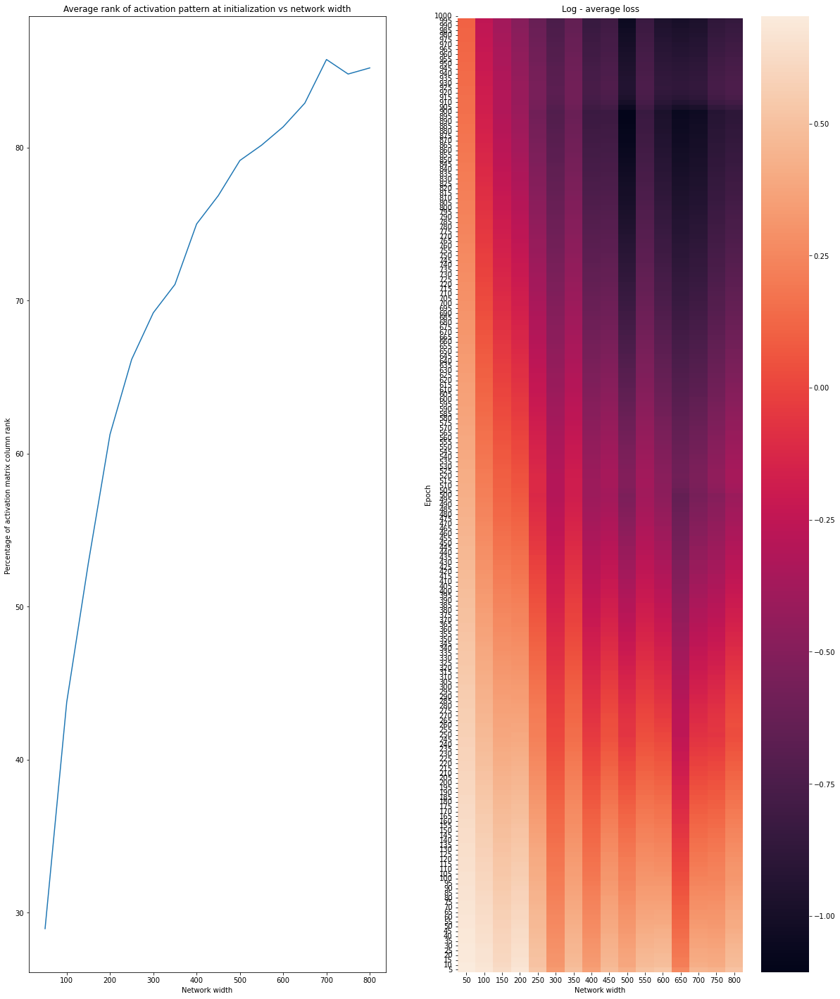

In [205]:
fig,ax = plt.subplots(1,2,figsize=(20,25))
ax[0].plot(D1, av_rank_A_init)
ax[0].set_xlabel("Network width")
ax[0].set_ylabel("Percentage of activation matrix column rank ")
ax[0].set_title("Average rank of activation pattern at initialization vs network width")

row1 = 0
row2 = -1

sns.heatmap(np.log10(av_loss_epochs_vs_m[row1:row2]), ax=ax[1], xticklabels=D1, yticklabels=loss_epochs)
ax[1].invert_yaxis()
ax[1].set_xlabel("Network width")
ax[1].set_ylabel("Epoch")
ax[1].set_title("Log - average loss")

### D0 = 200

In [206]:
# Fixed parameters
D0 = 200
D1 = np.arange(50,801,50)
LR = .001

DATA_SIZE = 100
DEGREE = 2

EPOCHS_NUM = 1000
loss_epochs = np.arange(5, EPOCHS_NUM+1, 5)

TRIALS = 20

In [207]:
av_loss_epochs_vs_m2 = np.zeros((len(loss_epochs), len(D1)))
av_rank_A_init2 = np.zeros(len(D1))

for i in range(len(D1)):
    for t in range(TRIALS):
        # Define mode
        model = TwoLayerNet(d0=1, d1=D1[i], d2=1)
        av_rank_A_init2[i] += get_rank_A(model)
        
        loss_fn = nn.MSELoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=LR)
        
        
        # Generate data
        gen_x, gen_y = get_gaussian_data(d0=1, data_size=DATA_SIZE,
                         target_fn=PolynomialRegression(coef_lb=-1., coef_ub=1., degree=DEGREE))
        x = torch.tensor(gen_x, dtype=torch.float)
        y = torch.tensor(gen_y, dtype=torch.float)
        
        losses, _ = train(model, optimizer, 
                                  loss_fn, x, y, DATA_SIZE, EPOCHS_NUM, 
                                  spectrum_epochs, loss_epochs, get_spectra=True)
        av_loss_epochs_vs_m2[:,i] += losses
        
av_rank_A_init2 =  100*av_rank_A_init2/(TRIALS*DATA_SIZE)
av_loss_epochs_vs_m2 = av_loss_epochs_vs_m2/(TRIALS)
        

Epoch 1. Loss: 14.753406524658203
Epoch 2. Loss: 14.721144676208496
Epoch 3. Loss: 14.688920021057129
Epoch 4. Loss: 14.656729698181152
Epoch 5. Loss: 14.624580383300781
Epoch 6. Loss: 14.592463493347168
Epoch 7. Loss: 14.560321807861328
Epoch 8. Loss: 14.528189659118652
Epoch 9. Loss: 14.49609661102295
Epoch 10. Loss: 14.464028358459473
Epoch 11. Loss: 14.431994438171387
Epoch 12. Loss: 14.408446311950684
Epoch 13. Loss: 14.385810852050781
Epoch 14. Loss: 14.363977432250977
Epoch 15. Loss: 14.342829704284668
Epoch 16. Loss: 14.322266578674316
Epoch 17. Loss: 14.302172660827637
Epoch 18. Loss: 14.282485008239746
Epoch 19. Loss: 14.263165473937988
Epoch 20. Loss: 14.244154930114746
Epoch 21. Loss: 14.225388526916504
Epoch 22. Loss: 14.2068452835083
Epoch 23. Loss: 14.18848991394043
Epoch 24. Loss: 14.1702880859375
Epoch 25. Loss: 14.152209281921387
Epoch 26. Loss: 14.134235382080078
Epoch 27. Loss: 14.116347312927246
Epoch 28. Loss: 14.098526954650879
Epoch 29. Loss: 14.080758094787598


Epoch 307. Loss: 9.177998542785645
Epoch 308. Loss: 9.163126945495605
Epoch 309. Loss: 9.148263931274414
Epoch 310. Loss: 9.133411407470703
Epoch 311. Loss: 9.118566513061523
Epoch 312. Loss: 9.103732109069824
Epoch 313. Loss: 9.088906288146973
Epoch 314. Loss: 9.074088096618652
Epoch 315. Loss: 9.059279441833496
Epoch 316. Loss: 9.044479370117188
Epoch 317. Loss: 9.029687881469727
Epoch 318. Loss: 9.014904975891113
Epoch 319. Loss: 9.00013256072998
Epoch 320. Loss: 8.985370635986328
Epoch 321. Loss: 8.970619201660156
Epoch 322. Loss: 8.955878257751465
Epoch 323. Loss: 8.941156387329102
Epoch 324. Loss: 8.926445960998535
Epoch 325. Loss: 8.911746978759766
Epoch 326. Loss: 8.897063255310059
Epoch 327. Loss: 8.882391929626465
Epoch 328. Loss: 8.867730140686035
Epoch 329. Loss: 8.85307788848877
Epoch 330. Loss: 8.838435173034668
Epoch 331. Loss: 8.823803901672363
Epoch 332. Loss: 8.809185981750488
Epoch 333. Loss: 8.79457950592041
Epoch 334. Loss: 8.7799654006958
Epoch 335. Loss: 8.765362

Epoch 731. Loss: 4.099361896514893
Epoch 732. Loss: 4.0910964012146
Epoch 733. Loss: 4.082841396331787
Epoch 734. Loss: 4.074594020843506
Epoch 735. Loss: 4.06635856628418
Epoch 736. Loss: 4.058138847351074
Epoch 737. Loss: 4.049933910369873
Epoch 738. Loss: 4.0417399406433105
Epoch 739. Loss: 4.033554553985596
Epoch 740. Loss: 4.025379180908203
Epoch 741. Loss: 4.017214775085449
Epoch 742. Loss: 4.009061813354492
Epoch 743. Loss: 4.00092077255249
Epoch 744. Loss: 3.9927902221679688
Epoch 745. Loss: 3.984670400619507
Epoch 746. Loss: 3.976566791534424
Epoch 747. Loss: 3.9684767723083496
Epoch 748. Loss: 3.96040678024292
Epoch 749. Loss: 3.952362060546875
Epoch 750. Loss: 3.9443323612213135
Epoch 751. Loss: 3.9363162517547607
Epoch 752. Loss: 3.9283134937286377
Epoch 753. Loss: 3.920323371887207
Epoch 754. Loss: 3.912346124649048
Epoch 755. Loss: 3.904381036758423
Epoch 756. Loss: 3.8964309692382812
Epoch 757. Loss: 3.8884952068328857
Epoch 758. Loss: 3.880573034286499
Epoch 759. Loss: 

Epoch 64. Loss: 3.123819589614868
Epoch 65. Loss: 3.118283748626709
Epoch 66. Loss: 3.1125993728637695
Epoch 67. Loss: 3.1067817211151123
Epoch 68. Loss: 3.100841760635376
Epoch 69. Loss: 3.0947911739349365
Epoch 70. Loss: 3.0886411666870117
Epoch 71. Loss: 3.082399368286133
Epoch 72. Loss: 3.076075553894043
Epoch 73. Loss: 3.0696768760681152
Epoch 74. Loss: 3.0632104873657227
Epoch 75. Loss: 3.0566835403442383
Epoch 76. Loss: 3.0501010417938232
Epoch 77. Loss: 3.043468713760376
Epoch 78. Loss: 3.0367913246154785
Epoch 79. Loss: 3.0300722122192383
Epoch 80. Loss: 3.023317813873291
Epoch 81. Loss: 3.0165297985076904
Epoch 82. Loss: 3.0097129344940186
Epoch 83. Loss: 3.0028696060180664
Epoch 84. Loss: 2.995999336242676
Epoch 85. Loss: 2.9891128540039062
Epoch 86. Loss: 2.9822075366973877
Epoch 87. Loss: 2.9752883911132812
Epoch 88. Loss: 2.9683563709259033
Epoch 89. Loss: 2.9614133834838867
Epoch 90. Loss: 2.9544594287872314
Epoch 91. Loss: 2.9474966526031494
Epoch 92. Loss: 2.9405255317

Epoch 431. Loss: 1.3877978324890137
Epoch 432. Loss: 1.3842687606811523
Epoch 433. Loss: 1.3807471990585327
Epoch 434. Loss: 1.377231478691101
Epoch 435. Loss: 1.3737231492996216
Epoch 436. Loss: 1.370222568511963
Epoch 437. Loss: 1.3667290210723877
Epoch 438. Loss: 1.3632491827011108
Epoch 439. Loss: 1.3597784042358398
Epoch 440. Loss: 1.3563156127929688
Epoch 441. Loss: 1.352860450744629
Epoch 442. Loss: 1.3494127988815308
Epoch 443. Loss: 1.3459728956222534
Epoch 444. Loss: 1.3425406217575073
Epoch 445. Loss: 1.339116096496582
Epoch 446. Loss: 1.3356988430023193
Epoch 447. Loss: 1.332289457321167
Epoch 448. Loss: 1.3288875818252563
Epoch 449. Loss: 1.3254932165145874
Epoch 450. Loss: 1.3221064805984497
Epoch 451. Loss: 1.3187252283096313
Epoch 452. Loss: 1.3153506517410278
Epoch 453. Loss: 1.311984896659851
Epoch 454. Loss: 1.3086309432983398
Epoch 455. Loss: 1.3052856922149658
Epoch 456. Loss: 1.3019230365753174
Epoch 457. Loss: 1.2985656261444092
Epoch 458. Loss: 1.295213580131530

Epoch 842. Loss: 0.495795339345932
Epoch 843. Loss: 0.4943050444126129
Epoch 844. Loss: 0.4928213357925415
Epoch 845. Loss: 0.4913395643234253
Epoch 846. Loss: 0.4898611903190613
Epoch 847. Loss: 0.48838669061660767
Epoch 848. Loss: 0.48691558837890625
Epoch 849. Loss: 0.4854484498500824
Epoch 850. Loss: 0.4839847683906555
Epoch 851. Loss: 0.48252496123313904
Epoch 852. Loss: 0.4810687005519867
Epoch 853. Loss: 0.47961631417274475
Epoch 854. Loss: 0.47816750407218933
Epoch 855. Loss: 0.4767221212387085
Epoch 856. Loss: 0.47527748346328735
Epoch 857. Loss: 0.4738364815711975
Epoch 858. Loss: 0.4723988473415375
Epoch 859. Loss: 0.47096484899520874
Epoch 860. Loss: 0.4695339500904083
Epoch 861. Loss: 0.46810460090637207
Epoch 862. Loss: 0.466678649187088
Epoch 863. Loss: 0.46525609493255615
Epoch 864. Loss: 0.46383705735206604
Epoch 865. Loss: 0.4624214172363281
Epoch 866. Loss: 0.4610094726085663
Epoch 867. Loss: 0.4596008360385895
Epoch 868. Loss: 0.45819586515426636
Epoch 869. Loss: 0.

Epoch 137. Loss: 1.0089038610458374
Epoch 138. Loss: 1.0076254606246948
Epoch 139. Loss: 1.0063554048538208
Epoch 140. Loss: 1.0050928592681885
Epoch 141. Loss: 1.0038361549377441
Epoch 142. Loss: 1.0025826692581177
Epoch 143. Loss: 1.0013337135314941
Epoch 144. Loss: 1.0000938177108765
Epoch 145. Loss: 0.9988559484481812
Epoch 146. Loss: 0.9976206421852112
Epoch 147. Loss: 0.9963870048522949
Epoch 148. Loss: 0.9951547980308533
Epoch 149. Loss: 0.9939234852790833
Epoch 150. Loss: 0.9926929473876953
Epoch 151. Loss: 0.991462767124176
Epoch 152. Loss: 0.9902326464653015
Epoch 153. Loss: 0.9890024065971375
Epoch 154. Loss: 0.9877724647521973
Epoch 155. Loss: 0.9865425825119019
Epoch 156. Loss: 0.985312283039093
Epoch 157. Loss: 0.9840810894966125
Epoch 158. Loss: 0.9828493595123291
Epoch 159. Loss: 0.9816164374351501
Epoch 160. Loss: 0.9803825616836548
Epoch 161. Loss: 0.9791470170021057
Epoch 162. Loss: 0.9779103994369507
Epoch 163. Loss: 0.9766724109649658
Epoch 164. Loss: 0.97543287277

Epoch 502. Loss: 0.5235692262649536
Epoch 503. Loss: 0.5176593065261841
Epoch 504. Loss: 0.512281060218811
Epoch 505. Loss: 0.5073762536048889
Epoch 506. Loss: 0.5028949975967407
Epoch 507. Loss: 0.4987914562225342
Epoch 508. Loss: 0.495025634765625
Epoch 509. Loss: 0.49156248569488525
Epoch 510. Loss: 0.48837077617645264
Epoch 511. Loss: 0.4854222536087036
Epoch 512. Loss: 0.48269104957580566
Epoch 513. Loss: 0.48015525937080383
Epoch 514. Loss: 0.4777950346469879
Epoch 515. Loss: 0.47559237480163574
Epoch 516. Loss: 0.47353142499923706
Epoch 517. Loss: 0.4715971350669861
Epoch 518. Loss: 0.4697774052619934
Epoch 519. Loss: 0.46806007623672485
Epoch 520. Loss: 0.4664353132247925
Epoch 521. Loss: 0.46489399671554565
Epoch 522. Loss: 0.4634275734424591
Epoch 523. Loss: 0.4620286822319031
Epoch 524. Loss: 0.4606899321079254
Epoch 525. Loss: 0.45940619707107544
Epoch 526. Loss: 0.45817187428474426
Epoch 527. Loss: 0.45698222517967224
Epoch 528. Loss: 0.45583248138427734
Epoch 529. Loss: 0

Epoch 913. Loss: 0.17294204235076904
Epoch 914. Loss: 0.17147736251354218
Epoch 915. Loss: 0.170129656791687
Epoch 916. Loss: 0.16888666152954102
Epoch 917. Loss: 0.16773736476898193
Epoch 918. Loss: 0.1666720062494278
Epoch 919. Loss: 0.16568198800086975
Epoch 920. Loss: 0.16475936770439148
Epoch 921. Loss: 0.1638972908258438
Epoch 922. Loss: 0.16308970749378204
Epoch 923. Loss: 0.1623309701681137
Epoch 924. Loss: 0.16161611676216125
Epoch 925. Loss: 0.16094084084033966
Epoch 926. Loss: 0.1603010594844818
Epoch 927. Loss: 0.15969331562519073
Epoch 928. Loss: 0.15911434590816498
Epoch 929. Loss: 0.1585613638162613
Epoch 930. Loss: 0.15803171694278717
Epoch 931. Loss: 0.15752319991588593
Epoch 932. Loss: 0.15703363716602325
Epoch 933. Loss: 0.15656107664108276
Epoch 934. Loss: 0.15610404312610626
Epoch 935. Loss: 0.1556609719991684
Epoch 936. Loss: 0.1552305668592453
Epoch 937. Loss: 0.15481151640415192
Epoch 938. Loss: 0.15440282225608826
Epoch 939. Loss: 0.15400345623493195
Epoch 940.

Epoch 246. Loss: 3.3586597442626953
Epoch 247. Loss: 3.3529419898986816
Epoch 248. Loss: 3.347229242324829
Epoch 249. Loss: 3.3415215015411377
Epoch 250. Loss: 3.335819721221924
Epoch 251. Loss: 3.330122709274292
Epoch 252. Loss: 3.325587749481201
Epoch 253. Loss: 3.3210010528564453
Epoch 254. Loss: 3.3163650035858154
Epoch 255. Loss: 3.3116824626922607
Epoch 256. Loss: 3.306957721710205
Epoch 257. Loss: 3.3021936416625977
Epoch 258. Loss: 3.2973926067352295
Epoch 259. Loss: 3.2925596237182617
Epoch 260. Loss: 3.2876956462860107
Epoch 261. Loss: 3.282804012298584
Epoch 262. Loss: 3.277885675430298
Epoch 263. Loss: 3.272944688796997
Epoch 264. Loss: 3.267981767654419
Epoch 265. Loss: 3.263000726699829
Epoch 266. Loss: 3.258002519607544
Epoch 267. Loss: 3.2529895305633545
Epoch 268. Loss: 3.2479636669158936
Epoch 269. Loss: 3.2429261207580566
Epoch 270. Loss: 3.2378780841827393
Epoch 271. Loss: 3.232821464538574
Epoch 272. Loss: 3.2277562618255615
Epoch 273. Loss: 3.2226855754852295
Epoc

Epoch 615. Loss: 1.817920207977295
Epoch 616. Loss: 1.8148529529571533
Epoch 617. Loss: 1.811790108680725
Epoch 618. Loss: 1.808732032775879
Epoch 619. Loss: 1.8056787252426147
Epoch 620. Loss: 1.8026297092437744
Epoch 621. Loss: 1.7995855808258057
Epoch 622. Loss: 1.796546220779419
Epoch 623. Loss: 1.7935113906860352
Epoch 624. Loss: 1.7904810905456543
Epoch 625. Loss: 1.7874555587768555
Epoch 626. Loss: 1.7844346761703491
Epoch 627. Loss: 1.781418800354004
Epoch 628. Loss: 1.7784075736999512
Epoch 629. Loss: 1.775400996208191
Epoch 630. Loss: 1.7723989486694336
Epoch 631. Loss: 1.769402027130127
Epoch 632. Loss: 1.7664096355438232
Epoch 633. Loss: 1.7634221315383911
Epoch 634. Loss: 1.7604387998580933
Epoch 635. Loss: 1.7574608325958252
Epoch 636. Loss: 1.7544872760772705
Epoch 637. Loss: 1.751516580581665
Epoch 638. Loss: 1.7485504150390625
Epoch 639. Loss: 1.745589017868042
Epoch 640. Loss: 1.7426320314407349
Epoch 641. Loss: 1.7396798133850098
Epoch 642. Loss: 1.7367323637008667
E

Epoch 12. Loss: 6.799813270568848
Epoch 13. Loss: 6.80255126953125
Epoch 14. Loss: 6.804454326629639
Epoch 15. Loss: 6.805608749389648
Epoch 16. Loss: 6.806088924407959
Epoch 17. Loss: 6.805960655212402
Epoch 18. Loss: 6.8052778244018555
Epoch 19. Loss: 6.804091930389404
Epoch 20. Loss: 6.802444934844971
Epoch 21. Loss: 6.800375938415527
Epoch 22. Loss: 6.797918796539307
Epoch 23. Loss: 6.795101165771484
Epoch 24. Loss: 6.791952610015869
Epoch 25. Loss: 6.788497447967529
Epoch 26. Loss: 6.784759998321533
Epoch 27. Loss: 6.780761241912842
Epoch 28. Loss: 6.776517868041992
Epoch 29. Loss: 6.772049427032471
Epoch 30. Loss: 6.767370700836182
Epoch 31. Loss: 6.762503623962402
Epoch 32. Loss: 6.757453441619873
Epoch 33. Loss: 6.752232551574707
Epoch 34. Loss: 6.746851921081543
Epoch 35. Loss: 6.741321563720703
Epoch 36. Loss: 6.735650062561035
Epoch 37. Loss: 6.729851245880127
Epoch 38. Loss: 6.723929405212402
Epoch 39. Loss: 6.717890739440918
Epoch 40. Loss: 6.711742401123047
Epoch 41. Loss

Epoch 343. Loss: 5.041043758392334
Epoch 344. Loss: 5.034808158874512
Epoch 345. Loss: 5.028573036193848
Epoch 346. Loss: 5.022338390350342
Epoch 347. Loss: 5.016104221343994
Epoch 348. Loss: 5.009871006011963
Epoch 349. Loss: 5.003638744354248
Epoch 350. Loss: 4.997406482696533
Epoch 351. Loss: 4.991175651550293
Epoch 352. Loss: 4.9849419593811035
Epoch 353. Loss: 4.97871208190918
Epoch 354. Loss: 4.972482681274414
Epoch 355. Loss: 4.966253757476807
Epoch 356. Loss: 4.960026741027832
Epoch 357. Loss: 4.953800201416016
Epoch 358. Loss: 4.947575569152832
Epoch 359. Loss: 4.941352367401123
Epoch 360. Loss: 4.9351301193237305
Epoch 361. Loss: 4.928909778594971
Epoch 362. Loss: 4.922689914703369
Epoch 363. Loss: 4.916471481323242
Epoch 364. Loss: 4.91025447845459
Epoch 365. Loss: 4.904041290283203
Epoch 366. Loss: 4.897839069366455
Epoch 367. Loss: 4.891637802124023
Epoch 368. Loss: 4.885440826416016
Epoch 369. Loss: 4.879245758056641
Epoch 370. Loss: 4.8730549812316895
Epoch 371. Loss: 4.

Epoch 749. Loss: 3.0032739639282227
Epoch 750. Loss: 2.9988489151000977
Epoch 751. Loss: 2.994429349899292
Epoch 752. Loss: 2.990013360977173
Epoch 753. Loss: 2.985599994659424
Epoch 754. Loss: 2.981196403503418
Epoch 755. Loss: 2.9768004417419434
Epoch 756. Loss: 2.9724063873291016
Epoch 757. Loss: 2.9680140018463135
Epoch 758. Loss: 2.9636244773864746
Epoch 759. Loss: 2.9592390060424805
Epoch 760. Loss: 2.9548559188842773
Epoch 761. Loss: 2.9504778385162354
Epoch 762. Loss: 2.9461026191711426
Epoch 763. Loss: 2.9417288303375244
Epoch 764. Loss: 2.937359571456909
Epoch 765. Loss: 2.9329986572265625
Epoch 766. Loss: 2.928640365600586
Epoch 767. Loss: 2.9242849349975586
Epoch 768. Loss: 2.9199328422546387
Epoch 769. Loss: 2.915583610534668
Epoch 770. Loss: 2.9112355709075928
Epoch 771. Loss: 2.9068915843963623
Epoch 772. Loss: 2.9025511741638184
Epoch 773. Loss: 2.898219108581543
Epoch 774. Loss: 2.8938913345336914
Epoch 775. Loss: 2.889568567276001
Epoch 776. Loss: 2.8852486610412598
E

Epoch 87. Loss: 3.1135497093200684
Epoch 88. Loss: 3.110922336578369
Epoch 89. Loss: 3.1082663536071777
Epoch 90. Loss: 3.1055846214294434
Epoch 91. Loss: 3.1028783321380615
Epoch 92. Loss: 3.1001486778259277
Epoch 93. Loss: 3.097397565841675
Epoch 94. Loss: 3.0946242809295654
Epoch 95. Loss: 3.091831922531128
Epoch 96. Loss: 3.089020013809204
Epoch 97. Loss: 3.0861902236938477
Epoch 98. Loss: 3.0833425521850586
Epoch 99. Loss: 3.080477714538574
Epoch 100. Loss: 3.077597141265869
Epoch 101. Loss: 3.0747008323669434
Epoch 102. Loss: 3.0784201622009277
Epoch 103. Loss: 3.0815436840057373
Epoch 104. Loss: 3.0841257572174072
Epoch 105. Loss: 3.0862162113189697
Epoch 106. Loss: 3.0878608226776123
Epoch 107. Loss: 3.0891001224517822
Epoch 108. Loss: 3.0899720191955566
Epoch 109. Loss: 3.090510368347168
Epoch 110. Loss: 3.090745210647583
Epoch 111. Loss: 3.090704917907715
Epoch 112. Loss: 3.0904150009155273
Epoch 113. Loss: 3.089898109436035
Epoch 114. Loss: 3.089174747467041
Epoch 115. Loss:

Epoch 456. Loss: 2.1679320335388184
Epoch 457. Loss: 2.1649363040924072
Epoch 458. Loss: 2.1619412899017334
Epoch 459. Loss: 2.1589479446411133
Epoch 460. Loss: 2.1559553146362305
Epoch 461. Loss: 2.1529629230499268
Epoch 462. Loss: 2.149972438812256
Epoch 463. Loss: 2.146982192993164
Epoch 464. Loss: 2.143990993499756
Epoch 465. Loss: 2.1410017013549805
Epoch 466. Loss: 2.138012647628784
Epoch 467. Loss: 2.1350245475769043
Epoch 468. Loss: 2.1320371627807617
Epoch 469. Loss: 2.1290509700775146
Epoch 470. Loss: 2.126065492630005
Epoch 471. Loss: 2.123080253601074
Epoch 472. Loss: 2.120096206665039
Epoch 473. Loss: 2.117112398147583
Epoch 474. Loss: 2.1141269207000732
Epoch 475. Loss: 2.1111419200897217
Epoch 476. Loss: 2.108156442642212
Epoch 477. Loss: 2.105175018310547
Epoch 478. Loss: 2.1021945476531982
Epoch 479. Loss: 2.0992164611816406
Epoch 480. Loss: 2.0962419509887695
Epoch 481. Loss: 2.0932717323303223
Epoch 482. Loss: 2.090303897857666
Epoch 483. Loss: 2.087337017059326
Epoc

Epoch 876. Loss: 1.2171697616577148
Epoch 877. Loss: 1.2151161432266235
Epoch 878. Loss: 1.2130646705627441
Epoch 879. Loss: 1.211016297340393
Epoch 880. Loss: 1.2089701890945435
Epoch 881. Loss: 1.2069263458251953
Epoch 882. Loss: 1.2048847675323486
Epoch 883. Loss: 1.2028452157974243
Epoch 884. Loss: 1.2008076906204224
Epoch 885. Loss: 1.1987723112106323
Epoch 886. Loss: 1.1967395544052124
Epoch 887. Loss: 1.1947087049484253
Epoch 888. Loss: 1.1926803588867188
Epoch 889. Loss: 1.190653681755066
Epoch 890. Loss: 1.1886292695999146
Epoch 891. Loss: 1.186607003211975
Epoch 892. Loss: 1.184587001800537
Epoch 893. Loss: 1.1825693845748901
Epoch 894. Loss: 1.1805522441864014
Epoch 895. Loss: 1.1785366535186768
Epoch 896. Loss: 1.1765228509902954
Epoch 897. Loss: 1.1745123863220215
Epoch 898. Loss: 1.1725047826766968
Epoch 899. Loss: 1.170499324798584
Epoch 900. Loss: 1.1684961318969727
Epoch 901. Loss: 1.1664952039718628
Epoch 902. Loss: 1.1726937294006348
Epoch 903. Loss: 1.17811906337738

Epoch 158. Loss: 2.540695905685425
Epoch 159. Loss: 2.5389552116394043
Epoch 160. Loss: 2.5372121334075928
Epoch 161. Loss: 2.535465955734253
Epoch 162. Loss: 2.5337166786193848
Epoch 163. Loss: 2.5319647789001465
Epoch 164. Loss: 2.530210494995117
Epoch 165. Loss: 2.5284535884857178
Epoch 166. Loss: 2.5266942977905273
Epoch 167. Loss: 2.524932861328125
Epoch 168. Loss: 2.5231690406799316
Epoch 169. Loss: 2.5214028358459473
Epoch 170. Loss: 2.519634485244751
Epoch 171. Loss: 2.5178639888763428
Epoch 172. Loss: 2.5160911083221436
Epoch 173. Loss: 2.5143165588378906
Epoch 174. Loss: 2.5125396251678467
Epoch 175. Loss: 2.5107598304748535
Epoch 176. Loss: 2.5089778900146484
Epoch 177. Loss: 2.5071933269500732
Epoch 178. Loss: 2.5054068565368652
Epoch 179. Loss: 2.503617525100708
Epoch 180. Loss: 2.5018272399902344
Epoch 181. Loss: 2.5000410079956055
Epoch 182. Loss: 2.4982526302337646
Epoch 183. Loss: 2.4964635372161865
Epoch 184. Loss: 2.4946725368499756
Epoch 185. Loss: 2.492880582809448

Epoch 511. Loss: 2.0056653022766113
Epoch 512. Loss: 2.005293369293213
Epoch 513. Loss: 2.004819393157959
Epoch 514. Loss: 2.00425386428833
Epoch 515. Loss: 2.0036051273345947
Epoch 516. Loss: 2.002885103225708
Epoch 517. Loss: 2.0020973682403564
Epoch 518. Loss: 2.001249313354492
Epoch 519. Loss: 2.0003457069396973
Epoch 520. Loss: 1.9993929862976074
Epoch 521. Loss: 1.9983960390090942
Epoch 522. Loss: 1.9973586797714233
Epoch 523. Loss: 1.996289849281311
Epoch 524. Loss: 1.9951988458633423
Epoch 525. Loss: 1.9940783977508545
Epoch 526. Loss: 1.9929325580596924
Epoch 527. Loss: 1.9917635917663574
Epoch 528. Loss: 1.990573525428772
Epoch 529. Loss: 1.9893653392791748
Epoch 530. Loss: 1.9881399869918823
Epoch 531. Loss: 1.9868996143341064
Epoch 532. Loss: 1.9856452941894531
Epoch 533. Loss: 1.9843789339065552
Epoch 534. Loss: 1.9831018447875977
Epoch 535. Loss: 1.9818141460418701
Epoch 536. Loss: 1.9805176258087158
Epoch 537. Loss: 1.9792131185531616
Epoch 538. Loss: 1.9779014587402344


Epoch 919. Loss: 1.5278255939483643
Epoch 920. Loss: 1.5271782875061035
Epoch 921. Loss: 1.5264959335327148
Epoch 922. Loss: 1.525783658027649
Epoch 923. Loss: 1.5250440835952759
Epoch 924. Loss: 1.5242795944213867
Epoch 925. Loss: 1.5234919786453247
Epoch 926. Loss: 1.5226836204528809
Epoch 927. Loss: 1.5218586921691895
Epoch 928. Loss: 1.52101731300354
Epoch 929. Loss: 1.5201611518859863
Epoch 930. Loss: 1.5192909240722656
Epoch 931. Loss: 1.518409013748169
Epoch 932. Loss: 1.517516016960144
Epoch 933. Loss: 1.5166131258010864
Epoch 934. Loss: 1.5157016515731812
Epoch 935. Loss: 1.514782428741455
Epoch 936. Loss: 1.5138555765151978
Epoch 937. Loss: 1.5129225254058838
Epoch 938. Loss: 1.51198410987854
Epoch 939. Loss: 1.5110403299331665
Epoch 940. Loss: 1.5100922584533691
Epoch 941. Loss: 1.509140133857727
Epoch 942. Loss: 1.5081843137741089
Epoch 943. Loss: 1.5072256326675415
Epoch 944. Loss: 1.506264090538025
Epoch 945. Loss: 1.5053000450134277
Epoch 946. Loss: 1.5043338537216187
Ep

Epoch 229. Loss: 0.6079140305519104
Epoch 230. Loss: 0.607123613357544
Epoch 231. Loss: 0.6063340902328491
Epoch 232. Loss: 0.6055446863174438
Epoch 233. Loss: 0.6047552227973938
Epoch 234. Loss: 0.603965699672699
Epoch 235. Loss: 0.6031768321990967
Epoch 236. Loss: 0.6023905277252197
Epoch 237. Loss: 0.6016038656234741
Epoch 238. Loss: 0.6008177399635315
Epoch 239. Loss: 0.6000316739082336
Epoch 240. Loss: 0.5992462038993835
Epoch 241. Loss: 0.5984603762626648
Epoch 242. Loss: 0.5976748466491699
Epoch 243. Loss: 0.5968897938728333
Epoch 244. Loss: 0.5961045622825623
Epoch 245. Loss: 0.5953196883201599
Epoch 246. Loss: 0.5945346355438232
Epoch 247. Loss: 0.5937495827674866
Epoch 248. Loss: 0.5929641127586365
Epoch 249. Loss: 0.592178463935852
Epoch 250. Loss: 0.5913930535316467
Epoch 251. Loss: 0.5906077027320862
Epoch 252. Loss: 0.5935845971107483
Epoch 253. Loss: 0.5962221026420593
Epoch 254. Loss: 0.5985486507415771
Epoch 255. Loss: 0.6005907654762268
Epoch 256. Loss: 0.602372944355

Epoch 593. Loss: 0.43857860565185547
Epoch 594. Loss: 0.43800827860832214
Epoch 595. Loss: 0.43743884563446045
Epoch 596. Loss: 0.43687114119529724
Epoch 597. Loss: 0.43630409240722656
Epoch 598. Loss: 0.43573763966560364
Epoch 599. Loss: 0.4351719617843628
Epoch 600. Loss: 0.43460559844970703
Epoch 601. Loss: 0.4340397119522095
Epoch 602. Loss: 0.4334743618965149
Epoch 603. Loss: 0.4329095184803009
Epoch 604. Loss: 0.4323453903198242
Epoch 605. Loss: 0.4317817986011505
Epoch 606. Loss: 0.43121886253356934
Epoch 607. Loss: 0.43065670132637024
Epoch 608. Loss: 0.4300955832004547
Epoch 609. Loss: 0.4295351803302765
Epoch 610. Loss: 0.42897480726242065
Epoch 611. Loss: 0.4284154772758484
Epoch 612. Loss: 0.42785710096359253
Epoch 613. Loss: 0.4272994101047516
Epoch 614. Loss: 0.42674240469932556
Epoch 615. Loss: 0.4261859655380249
Epoch 616. Loss: 0.42563021183013916
Epoch 617. Loss: 0.4250752329826355
Epoch 618. Loss: 0.4245208501815796
Epoch 619. Loss: 0.42396700382232666
Epoch 620. Los

Epoch 2. Loss: 17.07160186767578
Epoch 3. Loss: 17.02899169921875
Epoch 4. Loss: 16.986440658569336
Epoch 5. Loss: 16.94394874572754
Epoch 6. Loss: 16.901519775390625
Epoch 7. Loss: 16.859148025512695
Epoch 8. Loss: 16.816856384277344
Epoch 9. Loss: 16.774620056152344
Epoch 10. Loss: 16.732446670532227
Epoch 11. Loss: 16.690351486206055
Epoch 12. Loss: 16.680065155029297
Epoch 13. Loss: 16.668231964111328
Epoch 14. Loss: 16.6550350189209
Epoch 15. Loss: 16.6406192779541
Epoch 16. Loss: 16.6251163482666
Epoch 17. Loss: 16.60863494873047
Epoch 18. Loss: 16.591272354125977
Epoch 19. Loss: 16.573108673095703
Epoch 20. Loss: 16.55422592163086
Epoch 21. Loss: 16.534687042236328
Epoch 22. Loss: 16.514537811279297
Epoch 23. Loss: 16.493837356567383
Epoch 24. Loss: 16.472631454467773
Epoch 25. Loss: 16.450956344604492
Epoch 26. Loss: 16.428848266601562
Epoch 27. Loss: 16.406349182128906
Epoch 28. Loss: 16.383481979370117
Epoch 29. Loss: 16.360261917114258
Epoch 30. Loss: 16.336727142333984
Epoc

Epoch 294. Loss: 10.520777702331543
Epoch 295. Loss: 10.500720024108887
Epoch 296. Loss: 10.480670928955078
Epoch 297. Loss: 10.4606294631958
Epoch 298. Loss: 10.440598487854004
Epoch 299. Loss: 10.420574188232422
Epoch 300. Loss: 10.400556564331055
Epoch 301. Loss: 10.380550384521484
Epoch 302. Loss: 10.360546112060547
Epoch 303. Loss: 10.340555191040039
Epoch 304. Loss: 10.320577621459961
Epoch 305. Loss: 10.300615310668945
Epoch 306. Loss: 10.280675888061523
Epoch 307. Loss: 10.260761260986328
Epoch 308. Loss: 10.24087142944336
Epoch 309. Loss: 10.221000671386719
Epoch 310. Loss: 10.201147079467773
Epoch 311. Loss: 10.181324005126953
Epoch 312. Loss: 10.161528587341309
Epoch 313. Loss: 10.141753196716309
Epoch 314. Loss: 10.122000694274902
Epoch 315. Loss: 10.102270126342773
Epoch 316. Loss: 10.082560539245605
Epoch 317. Loss: 10.062871932983398
Epoch 318. Loss: 10.043206214904785
Epoch 319. Loss: 10.023560523986816
Epoch 320. Loss: 10.003931045532227
Epoch 321. Loss: 9.984321594238

Epoch 694. Loss: 4.548725605010986
Epoch 695. Loss: 4.53814172744751
Epoch 696. Loss: 4.527578353881836
Epoch 697. Loss: 4.517035007476807
Epoch 698. Loss: 4.5065107345581055
Epoch 699. Loss: 4.496006011962891
Epoch 700. Loss: 4.485519886016846
Epoch 701. Loss: 4.475053787231445
Epoch 702. Loss: 4.464605808258057
Epoch 703. Loss: 4.454177379608154
Epoch 704. Loss: 4.443768501281738
Epoch 705. Loss: 4.433378219604492
Epoch 706. Loss: 4.423007011413574
Epoch 707. Loss: 4.412654399871826
Epoch 708. Loss: 4.402320861816406
Epoch 709. Loss: 4.3920063972473145
Epoch 710. Loss: 4.3817138671875
Epoch 711. Loss: 4.371438980102539
Epoch 712. Loss: 4.361182689666748
Epoch 713. Loss: 4.350945472717285
Epoch 714. Loss: 4.340726852416992
Epoch 715. Loss: 4.330528259277344
Epoch 716. Loss: 4.320348262786865
Epoch 717. Loss: 4.310186862945557
Epoch 718. Loss: 4.300044059753418
Epoch 719. Loss: 4.289920330047607
Epoch 720. Loss: 4.279815196990967
Epoch 721. Loss: 4.26972770690918
Epoch 722. Loss: 4.259

Epoch 52. Loss: 0.32054516673088074
Epoch 53. Loss: 0.32123005390167236
Epoch 54. Loss: 0.32179656624794006
Epoch 55. Loss: 0.3222542703151703
Epoch 56. Loss: 0.32261204719543457
Epoch 57. Loss: 0.32287824153900146
Epoch 58. Loss: 0.3230606019496918
Epoch 59. Loss: 0.32316604256629944
Epoch 60. Loss: 0.32320117950439453
Epoch 61. Loss: 0.32317185401916504
Epoch 62. Loss: 0.3230834901332855
Epoch 63. Loss: 0.32294127345085144
Epoch 64. Loss: 0.3227497339248657
Epoch 65. Loss: 0.3225129246711731
Epoch 66. Loss: 0.32223498821258545
Epoch 67. Loss: 0.3219192624092102
Epoch 68. Loss: 0.3215690553188324
Epoch 69. Loss: 0.3211873173713684
Epoch 70. Loss: 0.32077670097351074
Epoch 71. Loss: 0.3203396499156952
Epoch 72. Loss: 0.319878488779068
Epoch 73. Loss: 0.31939518451690674
Epoch 74. Loss: 0.318891704082489
Epoch 75. Loss: 0.3183695673942566
Epoch 76. Loss: 0.31783053278923035
Epoch 77. Loss: 0.3172759711742401
Epoch 78. Loss: 0.3167070150375366
Epoch 79. Loss: 0.3161250352859497
Epoch 80.

Epoch 408. Loss: 0.15944063663482666
Epoch 409. Loss: 0.15899121761322021
Epoch 410. Loss: 0.15854285657405853
Epoch 411. Loss: 0.15809547901153564
Epoch 412. Loss: 0.1576492041349411
Epoch 413. Loss: 0.15720388293266296
Epoch 414. Loss: 0.15675966441631317
Epoch 415. Loss: 0.15631645917892456
Epoch 416. Loss: 0.15587426722049713
Epoch 417. Loss: 0.15543313324451447
Epoch 418. Loss: 0.1549929678440094
Epoch 419. Loss: 0.15455353260040283
Epoch 420. Loss: 0.15411481261253357
Epoch 421. Loss: 0.15367703139781952
Epoch 422. Loss: 0.15324020385742188
Epoch 423. Loss: 0.1528044044971466
Epoch 424. Loss: 0.1523696333169937
Epoch 425. Loss: 0.1519358605146408
Epoch 426. Loss: 0.1515030562877655
Epoch 427. Loss: 0.15107126533985138
Epoch 428. Loss: 0.15064047276973724
Epoch 429. Loss: 0.1502106636762619
Epoch 430. Loss: 0.14978186786174774
Epoch 431. Loss: 0.14935408532619476
Epoch 432. Loss: 0.14892733097076416
Epoch 433. Loss: 0.14850158989429474
Epoch 434. Loss: 0.1480768918991089
Epoch 435

Epoch 812. Loss: 0.0658506453037262
Epoch 813. Loss: 0.0656861960887909
Epoch 814. Loss: 0.06552226841449738
Epoch 815. Loss: 0.06535884737968445
Epoch 816. Loss: 0.06519594043493271
Epoch 817. Loss: 0.06503354758024216
Epoch 818. Loss: 0.0648716539144516
Epoch 819. Loss: 0.06471026688814163
Epoch 820. Loss: 0.06454938650131226
Epoch 821. Loss: 0.06438899785280228
Epoch 822. Loss: 0.06422910839319229
Epoch 823. Loss: 0.06406974047422409
Epoch 824. Loss: 0.06391084939241409
Epoch 825. Loss: 0.06375247240066528
Epoch 826. Loss: 0.06359460204839706
Epoch 827. Loss: 0.06343723088502884
Epoch 828. Loss: 0.0632803663611412
Epoch 829. Loss: 0.06312396377325058
Epoch 830. Loss: 0.06296807527542114
Epoch 831. Loss: 0.06281264871358871
Epoch 832. Loss: 0.06265774369239807
Epoch 833. Loss: 0.06250329315662384
Epoch 834. Loss: 0.0623493529856205
Epoch 835. Loss: 0.06219586357474327
Epoch 836. Loss: 0.062042832374572754
Epoch 837. Loss: 0.06189031898975372
Epoch 838. Loss: 0.061738271266222
Epoch 8

Epoch 102. Loss: 0.17684516310691833
Epoch 103. Loss: 0.17497067153453827
Epoch 104. Loss: 0.17325341701507568
Epoch 105. Loss: 0.17167672514915466
Epoch 106. Loss: 0.1702260822057724
Epoch 107. Loss: 0.16888834536075592
Epoch 108. Loss: 0.16765178740024567
Epoch 109. Loss: 0.16650624573230743
Epoch 110. Loss: 0.1654425412416458
Epoch 111. Loss: 0.16445209085941315
Epoch 112. Loss: 0.16352754831314087
Epoch 113. Loss: 0.1626623272895813
Epoch 114. Loss: 0.16185052692890167
Epoch 115. Loss: 0.16108670830726624
Epoch 116. Loss: 0.1603662669658661
Epoch 117. Loss: 0.15968476235866547
Epoch 118. Loss: 0.15903840959072113
Epoch 119. Loss: 0.1584237813949585
Epoch 120. Loss: 0.15783770382404327
Epoch 121. Loss: 0.1572774350643158
Epoch 122. Loss: 0.1567404568195343
Epoch 123. Loss: 0.15622447431087494
Epoch 124. Loss: 0.15572749078273773
Epoch 125. Loss: 0.15524756908416748
Epoch 126. Loss: 0.15478366613388062
Epoch 127. Loss: 0.1543343961238861
Epoch 128. Loss: 0.15389780700206757
Epoch 129

Epoch 502. Loss: 0.06415647268295288
Epoch 503. Loss: 0.06285392493009567
Epoch 504. Loss: 0.0617041140794754
Epoch 505. Loss: 0.06068650633096695
Epoch 506. Loss: 0.059783514589071274
Epoch 507. Loss: 0.05898037552833557
Epoch 508. Loss: 0.05826479569077492
Epoch 509. Loss: 0.057625912129879
Epoch 510. Loss: 0.05705370381474495
Epoch 511. Loss: 0.056540269404649734
Epoch 512. Loss: 0.056078556925058365
Epoch 513. Loss: 0.05566222965717316
Epoch 514. Loss: 0.055286020040512085
Epoch 515. Loss: 0.05494527518749237
Epoch 516. Loss: 0.0546359159052372
Epoch 517. Loss: 0.054354432970285416
Epoch 518. Loss: 0.05409780144691467
Epoch 519. Loss: 0.053863149136304855
Epoch 520. Loss: 0.0536482036113739
Epoch 521. Loss: 0.05345124751329422
Epoch 522. Loss: 0.053269848227500916
Epoch 523. Loss: 0.05310238525271416
Epoch 524. Loss: 0.052947331219911575
Epoch 525. Loss: 0.05280338227748871
Epoch 526. Loss: 0.052669424563646317
Epoch 527. Loss: 0.052544377744197845
Epoch 528. Loss: 0.05242738872766

Epoch 903. Loss: 0.035617440938949585
Epoch 904. Loss: 0.035083942115306854
Epoch 905. Loss: 0.034638114273548126
Epoch 906. Loss: 0.03426475450396538
Epoch 907. Loss: 0.03395037725567818
Epoch 908. Loss: 0.033685144037008286
Epoch 909. Loss: 0.03346008434891701
Epoch 910. Loss: 0.03326811641454697
Epoch 911. Loss: 0.03310355544090271
Epoch 912. Loss: 0.03296167775988579
Epoch 913. Loss: 0.03283865377306938
Epoch 914. Loss: 0.03273161128163338
Epoch 915. Loss: 0.032638028264045715
Epoch 916. Loss: 0.032555244863033295
Epoch 917. Loss: 0.03248148411512375
Epoch 918. Loss: 0.03241507709026337
Epoch 919. Loss: 0.03235514089465141
Epoch 920. Loss: 0.03230058029294014
Epoch 921. Loss: 0.03225052356719971
Epoch 922. Loss: 0.03220422565937042
Epoch 923. Loss: 0.03216113895177841
Epoch 924. Loss: 0.03212077543139458
Epoch 925. Loss: 0.032082706689834595
Epoch 926. Loss: 0.0320466123521328
Epoch 927. Loss: 0.0320122204720974
Epoch 928. Loss: 0.03197925165295601
Epoch 929. Loss: 0.03194754943251

Epoch 224. Loss: 0.6630480885505676
Epoch 225. Loss: 0.6626072525978088
Epoch 226. Loss: 0.6621658802032471
Epoch 227. Loss: 0.6617239117622375
Epoch 228. Loss: 0.6612813472747803
Epoch 229. Loss: 0.6608381867408752
Epoch 230. Loss: 0.6603944301605225
Epoch 231. Loss: 0.6599500775337219
Epoch 232. Loss: 0.6595053672790527
Epoch 233. Loss: 0.6590598821640015
Epoch 234. Loss: 0.658613920211792
Epoch 235. Loss: 0.6581674218177795
Epoch 236. Loss: 0.6577205657958984
Epoch 237. Loss: 0.6572731137275696
Epoch 238. Loss: 0.6568246483802795
Epoch 239. Loss: 0.6563757061958313
Epoch 240. Loss: 0.6559262275695801
Epoch 241. Loss: 0.6554759740829468
Epoch 242. Loss: 0.6550253033638
Epoch 243. Loss: 0.6545741558074951
Epoch 244. Loss: 0.6541222929954529
Epoch 245. Loss: 0.6536698937416077
Epoch 246. Loss: 0.6532182097434998
Epoch 247. Loss: 0.6527666449546814
Epoch 248. Loss: 0.6523146033287048
Epoch 249. Loss: 0.6518622636795044
Epoch 250. Loss: 0.651409387588501
Epoch 251. Loss: 0.65095627307891

Epoch 590. Loss: 0.5197012424468994
Epoch 591. Loss: 0.5193338394165039
Epoch 592. Loss: 0.5189663171768188
Epoch 593. Loss: 0.518598735332489
Epoch 594. Loss: 0.5182315111160278
Epoch 595. Loss: 0.5178641676902771
Epoch 596. Loss: 0.5174968242645264
Epoch 597. Loss: 0.5171294808387756
Epoch 598. Loss: 0.5167627334594727
Epoch 599. Loss: 0.516396164894104
Epoch 600. Loss: 0.5160294771194458
Epoch 601. Loss: 0.5156629681587219
Epoch 602. Loss: 0.515296220779419
Epoch 603. Loss: 0.5149297118186951
Epoch 604. Loss: 0.5145632028579712
Epoch 605. Loss: 0.5141964554786682
Epoch 606. Loss: 0.5138298273086548
Epoch 607. Loss: 0.5134631991386414
Epoch 608. Loss: 0.5130965709686279
Epoch 609. Loss: 0.5127297043800354
Epoch 610. Loss: 0.5123630166053772
Epoch 611. Loss: 0.5119961500167847
Epoch 612. Loss: 0.5116342306137085
Epoch 613. Loss: 0.5112738609313965
Epoch 614. Loss: 0.5109137296676636
Epoch 615. Loss: 0.5105535984039307
Epoch 616. Loss: 0.5101936459541321
Epoch 617. Loss: 0.509834527969

Epoch 997. Loss: 0.3920658230781555
Epoch 998. Loss: 0.3917650282382965
Epoch 999. Loss: 0.39146438241004944
Epoch 1000. Loss: 0.39116406440734863
Epoch 1001. Loss: 0.390863835811615
Epoch 1. Loss: 2.3897643089294434
Epoch 2. Loss: 2.3816449642181396
Epoch 3. Loss: 2.373541831970215
Epoch 4. Loss: 2.36545467376709
Epoch 5. Loss: 2.35740065574646
Epoch 6. Loss: 2.349368095397949
Epoch 7. Loss: 2.3413543701171875
Epoch 8. Loss: 2.333353281021118
Epoch 9. Loss: 2.3253684043884277
Epoch 10. Loss: 2.3174023628234863
Epoch 11. Loss: 2.309455156326294
Epoch 12. Loss: 2.307509183883667
Epoch 13. Loss: 2.30564022064209
Epoch 14. Loss: 2.3038370609283447
Epoch 15. Loss: 2.302090644836426
Epoch 16. Loss: 2.30039119720459
Epoch 17. Loss: 2.2987308502197266
Epoch 18. Loss: 2.297102451324463
Epoch 19. Loss: 2.2955005168914795
Epoch 20. Loss: 2.2939207553863525
Epoch 21. Loss: 2.292358875274658
Epoch 22. Loss: 2.29081130027771
Epoch 23. Loss: 2.2892751693725586
Epoch 24. Loss: 2.287747383117676
Epoch

Epoch 275. Loss: 1.8660099506378174
Epoch 276. Loss: 1.8644065856933594
Epoch 277. Loss: 1.8628143072128296
Epoch 278. Loss: 1.8612322807312012
Epoch 279. Loss: 1.8596593141555786
Epoch 280. Loss: 1.858094334602356
Epoch 281. Loss: 1.8565372228622437
Epoch 282. Loss: 1.854986310005188
Epoch 283. Loss: 1.8534411191940308
Epoch 284. Loss: 1.8519015312194824
Epoch 285. Loss: 1.8503667116165161
Epoch 286. Loss: 1.8488359451293945
Epoch 287. Loss: 1.8473087549209595
Epoch 288. Loss: 1.84578537940979
Epoch 289. Loss: 1.8442645072937012
Epoch 290. Loss: 1.8427473306655884
Epoch 291. Loss: 1.841233253479004
Epoch 292. Loss: 1.8397207260131836
Epoch 293. Loss: 1.8382103443145752
Epoch 294. Loss: 1.8367018699645996
Epoch 295. Loss: 1.8351948261260986
Epoch 296. Loss: 1.8336890935897827
Epoch 297. Loss: 1.8321845531463623
Epoch 298. Loss: 1.8306812047958374
Epoch 299. Loss: 1.829178810119629
Epoch 300. Loss: 1.8276768922805786
Epoch 301. Loss: 1.8261758089065552
Epoch 302. Loss: 1.824675559997558

Epoch 671. Loss: 1.3143692016601562
Epoch 672. Loss: 1.313248872756958
Epoch 673. Loss: 1.312129259109497
Epoch 674. Loss: 1.311010479927063
Epoch 675. Loss: 1.309891939163208
Epoch 676. Loss: 1.3087742328643799
Epoch 677. Loss: 1.30765700340271
Epoch 678. Loss: 1.306540846824646
Epoch 679. Loss: 1.3054249286651611
Epoch 680. Loss: 1.3043102025985718
Epoch 681. Loss: 1.3031960725784302
Epoch 682. Loss: 1.3020821809768677
Epoch 683. Loss: 1.300968885421753
Epoch 684. Loss: 1.2998565435409546
Epoch 685. Loss: 1.298744559288025
Epoch 686. Loss: 1.2976330518722534
Epoch 687. Loss: 1.296522855758667
Epoch 688. Loss: 1.2954134941101074
Epoch 689. Loss: 1.2943048477172852
Epoch 690. Loss: 1.293196439743042
Epoch 691. Loss: 1.2920886278152466
Epoch 692. Loss: 1.290981650352478
Epoch 693. Loss: 1.2898753881454468
Epoch 694. Loss: 1.2887694835662842
Epoch 695. Loss: 1.287664771080017
Epoch 696. Loss: 1.2865604162216187
Epoch 697. Loss: 1.2854565382003784
Epoch 698. Loss: 1.284353494644165
Epoch 

Epoch 38. Loss: 0.26688599586486816
Epoch 39. Loss: 0.2668338418006897
Epoch 40. Loss: 0.26677367091178894
Epoch 41. Loss: 0.26670607924461365
Epoch 42. Loss: 0.2666316628456116
Epoch 43. Loss: 0.2665508985519409
Epoch 44. Loss: 0.26646414399147034
Epoch 45. Loss: 0.26637187600135803
Epoch 46. Loss: 0.26627448201179504
Epoch 47. Loss: 0.26617231965065
Epoch 48. Loss: 0.26606568694114685
Epoch 49. Loss: 0.265954852104187
Epoch 50. Loss: 0.265840083360672
Epoch 51. Loss: 0.2657215893268585
Epoch 52. Loss: 0.2666182219982147
Epoch 53. Loss: 0.26743099093437195
Epoch 54. Loss: 0.2681654095649719
Epoch 55. Loss: 0.2688264548778534
Epoch 56. Loss: 0.26942044496536255
Epoch 57. Loss: 0.26995259523391724
Epoch 58. Loss: 0.2704281508922577
Epoch 59. Loss: 0.27085158228874207
Epoch 60. Loss: 0.27122676372528076
Epoch 61. Loss: 0.27155759930610657
Epoch 62. Loss: 0.2718476951122284
Epoch 63. Loss: 0.2721004784107208
Epoch 64. Loss: 0.272318959236145
Epoch 65. Loss: 0.27250608801841736
Epoch 66. L

Epoch 361. Loss: 0.2572852671146393
Epoch 362. Loss: 0.2570842504501343
Epoch 363. Loss: 0.25688326358795166
Epoch 364. Loss: 0.2566823661327362
Epoch 365. Loss: 0.2564813196659088
Epoch 366. Loss: 0.25628021359443665
Epoch 367. Loss: 0.2560790181159973
Epoch 368. Loss: 0.2558777928352356
Epoch 369. Loss: 0.2556764483451843
Epoch 370. Loss: 0.2554750144481659
Epoch 371. Loss: 0.2552735209465027
Epoch 372. Loss: 0.2550719976425171
Epoch 373. Loss: 0.25487032532691956
Epoch 374. Loss: 0.25466859340667725
Epoch 375. Loss: 0.2544667422771454
Epoch 376. Loss: 0.25426486134529114
Epoch 377. Loss: 0.25406283140182495
Epoch 378. Loss: 0.2538607120513916
Epoch 379. Loss: 0.25365859270095825
Epoch 380. Loss: 0.25345635414123535
Epoch 381. Loss: 0.2532540261745453
Epoch 382. Loss: 0.25305166840553284
Epoch 383. Loss: 0.25284919142723083
Epoch 384. Loss: 0.25264662504196167
Epoch 385. Loss: 0.25244399905204773
Epoch 386. Loss: 0.2522412836551666
Epoch 387. Loss: 0.25203850865364075
Epoch 388. Loss

Epoch 758. Loss: 0.19811159372329712
Epoch 759. Loss: 0.19791050255298615
Epoch 760. Loss: 0.19770950078964233
Epoch 761. Loss: 0.19750860333442688
Epoch 762. Loss: 0.1973077803850174
Epoch 763. Loss: 0.19710710644721985
Epoch 764. Loss: 0.19690649211406708
Epoch 765. Loss: 0.19670602679252625
Epoch 766. Loss: 0.19650563597679138
Epoch 767. Loss: 0.19630536437034607
Epoch 768. Loss: 0.1961052268743515
Epoch 769. Loss: 0.1959051936864853
Epoch 770. Loss: 0.1957051306962967
Epoch 771. Loss: 0.19550496339797974
Epoch 772. Loss: 0.19530491530895233
Epoch 773. Loss: 0.1951049417257309
Epoch 774. Loss: 0.19490501284599304
Epoch 775. Loss: 0.19470520317554474
Epoch 776. Loss: 0.1945054978132248
Epoch 777. Loss: 0.1943059116601944
Epoch 778. Loss: 0.19410638511180878
Epoch 779. Loss: 0.19390691816806793
Epoch 780. Loss: 0.1937071830034256
Epoch 781. Loss: 0.19350753724575043
Epoch 782. Loss: 0.19330792129039764
Epoch 783. Loss: 0.19310840964317322
Epoch 784. Loss: 0.19290895760059357
Epoch 785

Epoch 93. Loss: 1.0292880535125732
Epoch 94. Loss: 1.0283482074737549
Epoch 95. Loss: 1.027405023574829
Epoch 96. Loss: 1.0264583826065063
Epoch 97. Loss: 1.0255088806152344
Epoch 98. Loss: 1.0245572328567505
Epoch 99. Loss: 1.0236036777496338
Epoch 100. Loss: 1.0226479768753052
Epoch 101. Loss: 1.0216907262802124
Epoch 102. Loss: 1.0231250524520874
Epoch 103. Loss: 1.0243480205535889
Epoch 104. Loss: 1.025378704071045
Epoch 105. Loss: 1.0262341499328613
Epoch 106. Loss: 1.0269291400909424
Epoch 107. Loss: 1.0274773836135864
Epoch 108. Loss: 1.0278925895690918
Epoch 109. Loss: 1.0281867980957031
Epoch 110. Loss: 1.0283714532852173
Epoch 111. Loss: 1.0284554958343506
Epoch 112. Loss: 1.028448462486267
Epoch 113. Loss: 1.0283585786819458
Epoch 114. Loss: 1.0281933546066284
Epoch 115. Loss: 1.0279603004455566
Epoch 116. Loss: 1.027665376663208
Epoch 117. Loss: 1.0273144245147705
Epoch 118. Loss: 1.026912808418274
Epoch 119. Loss: 1.0264652967453003
Epoch 120. Loss: 1.025976300239563
Epoch

Epoch 460. Loss: 0.8073801398277283
Epoch 461. Loss: 0.8067407011985779
Epoch 462. Loss: 0.8061016798019409
Epoch 463. Loss: 0.8054631948471069
Epoch 464. Loss: 0.8048250675201416
Epoch 465. Loss: 0.8041872382164001
Epoch 466. Loss: 0.8035499453544617
Epoch 467. Loss: 0.8029126524925232
Epoch 468. Loss: 0.8022757172584534
Epoch 469. Loss: 0.8016390800476074
Epoch 470. Loss: 0.8010029792785645
Epoch 471. Loss: 0.8003671765327454
Epoch 472. Loss: 0.7997317314147949
Epoch 473. Loss: 0.7990968227386475
Epoch 474. Loss: 0.7984622716903687
Epoch 475. Loss: 0.797828197479248
Epoch 476. Loss: 0.7971944212913513
Epoch 477. Loss: 0.7965611219406128
Epoch 478. Loss: 0.7959281802177429
Epoch 479. Loss: 0.795295774936676
Epoch 480. Loss: 0.7946637868881226
Epoch 481. Loss: 0.7940320372581482
Epoch 482. Loss: 0.7934011220932007
Epoch 483. Loss: 0.7927702069282532
Epoch 484. Loss: 0.7921398878097534
Epoch 485. Loss: 0.7915096282958984
Epoch 486. Loss: 0.7908796668052673
Epoch 487. Loss: 0.79025018215

Epoch 862. Loss: 0.6219333410263062
Epoch 863. Loss: 0.6214916110038757
Epoch 864. Loss: 0.6210500597953796
Epoch 865. Loss: 0.6206087470054626
Epoch 866. Loss: 0.6201677918434143
Epoch 867. Loss: 0.6197270154953003
Epoch 868. Loss: 0.6192865967750549
Epoch 869. Loss: 0.6188464164733887
Epoch 870. Loss: 0.6184064149856567
Epoch 871. Loss: 0.6179665923118591
Epoch 872. Loss: 0.6175269484519958
Epoch 873. Loss: 0.6170876026153564
Epoch 874. Loss: 0.6166485548019409
Epoch 875. Loss: 0.6162097454071045
Epoch 876. Loss: 0.6157711148262024
Epoch 877. Loss: 0.615332841873169
Epoch 878. Loss: 0.6148948073387146
Epoch 879. Loss: 0.6144570112228394
Epoch 880. Loss: 0.6140195727348328
Epoch 881. Loss: 0.6135823130607605
Epoch 882. Loss: 0.6131453514099121
Epoch 883. Loss: 0.6127086877822876
Epoch 884. Loss: 0.6122722625732422
Epoch 885. Loss: 0.6118359565734863
Epoch 886. Loss: 0.6113998293876648
Epoch 887. Loss: 0.6109640002250671
Epoch 888. Loss: 0.6105284094810486
Epoch 889. Loss: 0.6100930571

Epoch 152. Loss: 13.827646255493164
Epoch 153. Loss: 13.800192832946777
Epoch 154. Loss: 13.772732734680176
Epoch 155. Loss: 13.745272636413574
Epoch 156. Loss: 13.717806816101074
Epoch 157. Loss: 13.690333366394043
Epoch 158. Loss: 13.662878036499023
Epoch 159. Loss: 13.635446548461914
Epoch 160. Loss: 13.608014106750488
Epoch 161. Loss: 13.580562591552734
Epoch 162. Loss: 13.55312728881836
Epoch 163. Loss: 13.525704383850098
Epoch 164. Loss: 13.49835205078125
Epoch 165. Loss: 13.4710111618042
Epoch 166. Loss: 13.443726539611816
Epoch 167. Loss: 13.416470527648926
Epoch 168. Loss: 13.389239311218262
Epoch 169. Loss: 13.362027168273926
Epoch 170. Loss: 13.334834098815918
Epoch 171. Loss: 13.307690620422363
Epoch 172. Loss: 13.280582427978516
Epoch 173. Loss: 13.25350570678711
Epoch 174. Loss: 13.22644329071045
Epoch 175. Loss: 13.19940185546875
Epoch 176. Loss: 13.172382354736328
Epoch 177. Loss: 13.145393371582031
Epoch 178. Loss: 13.118430137634277
Epoch 179. Loss: 13.09147834777832


Epoch 503. Loss: 6.419959545135498
Epoch 504. Loss: 6.423331260681152
Epoch 505. Loss: 6.424870491027832
Epoch 506. Loss: 6.424755096435547
Epoch 507. Loss: 6.423147201538086
Epoch 508. Loss: 6.420193672180176
Epoch 509. Loss: 6.416027069091797
Epoch 510. Loss: 6.410770416259766
Epoch 511. Loss: 6.404529571533203
Epoch 512. Loss: 6.397405624389648
Epoch 513. Loss: 6.389482021331787
Epoch 514. Loss: 6.3808393478393555
Epoch 515. Loss: 6.371553421020508
Epoch 516. Loss: 6.361688613891602
Epoch 517. Loss: 6.3513078689575195
Epoch 518. Loss: 6.340475082397461
Epoch 519. Loss: 6.329227447509766
Epoch 520. Loss: 6.317607402801514
Epoch 521. Loss: 6.305654525756836
Epoch 522. Loss: 6.293405055999756
Epoch 523. Loss: 6.2808918952941895
Epoch 524. Loss: 6.268138885498047
Epoch 525. Loss: 6.25517463684082
Epoch 526. Loss: 6.2420220375061035
Epoch 527. Loss: 6.2287068367004395
Epoch 528. Loss: 6.215247631072998
Epoch 529. Loss: 6.201655387878418
Epoch 530. Loss: 6.1879472732543945
Epoch 531. Loss

Epoch 905. Loss: 2.3272624015808105
Epoch 906. Loss: 2.3323776721954346
Epoch 907. Loss: 2.3363757133483887
Epoch 908. Loss: 2.339362859725952
Epoch 909. Loss: 2.3414368629455566
Epoch 910. Loss: 2.342686653137207
Epoch 911. Loss: 2.3431923389434814
Epoch 912. Loss: 2.3430275917053223
Epoch 913. Loss: 2.3422582149505615
Epoch 914. Loss: 2.3409435749053955
Epoch 915. Loss: 2.339139461517334
Epoch 916. Loss: 2.3368935585021973
Epoch 917. Loss: 2.3342506885528564
Epoch 918. Loss: 2.331252098083496
Epoch 919. Loss: 2.3279316425323486
Epoch 920. Loss: 2.32432222366333
Epoch 921. Loss: 2.320453405380249
Epoch 922. Loss: 2.3163535594940186
Epoch 923. Loss: 2.3120455741882324
Epoch 924. Loss: 2.3075520992279053
Epoch 925. Loss: 2.3028926849365234
Epoch 926. Loss: 2.298086404800415
Epoch 927. Loss: 2.293147325515747
Epoch 928. Loss: 2.288090229034424
Epoch 929. Loss: 2.282926082611084
Epoch 930. Loss: 2.2776687145233154
Epoch 931. Loss: 2.2723283767700195
Epoch 932. Loss: 2.2669150829315186
Epo

Epoch 236. Loss: 1.3676789999008179
Epoch 237. Loss: 1.3659913539886475
Epoch 238. Loss: 1.3642996549606323
Epoch 239. Loss: 1.3626105785369873
Epoch 240. Loss: 1.36091947555542
Epoch 241. Loss: 1.3592250347137451
Epoch 242. Loss: 1.357527256011963
Epoch 243. Loss: 1.3558355569839478
Epoch 244. Loss: 1.3541407585144043
Epoch 245. Loss: 1.3524454832077026
Epoch 246. Loss: 1.3507579565048218
Epoch 247. Loss: 1.3490698337554932
Epoch 248. Loss: 1.3473864793777466
Epoch 249. Loss: 1.3457003831863403
Epoch 250. Loss: 1.3440120220184326
Epoch 251. Loss: 1.3423254489898682
Epoch 252. Loss: 1.3353902101516724
Epoch 253. Loss: 1.3290166854858398
Epoch 254. Loss: 1.323147177696228
Epoch 255. Loss: 1.317728877067566
Epoch 256. Loss: 1.3127152919769287
Epoch 257. Loss: 1.3080644607543945
Epoch 258. Loss: 1.303740382194519
Epoch 259. Loss: 1.2997097969055176
Epoch 260. Loss: 1.2959426641464233
Epoch 261. Loss: 1.2924124002456665
Epoch 262. Loss: 1.2890950441360474
Epoch 263. Loss: 1.285967826843261

Epoch 616. Loss: 0.7480370998382568
Epoch 617. Loss: 0.7469884753227234
Epoch 618. Loss: 0.7459418773651123
Epoch 619. Loss: 0.7448961138725281
Epoch 620. Loss: 0.7438508868217468
Epoch 621. Loss: 0.7428061962127686
Epoch 622. Loss: 0.7417641282081604
Epoch 623. Loss: 0.7407200336456299
Epoch 624. Loss: 0.7396782040596008
Epoch 625. Loss: 0.7386371493339539
Epoch 626. Loss: 0.7375965714454651
Epoch 627. Loss: 0.7365577220916748
Epoch 628. Loss: 0.7355185151100159
Epoch 629. Loss: 0.7344809174537659
Epoch 630. Loss: 0.7334436774253845
Epoch 631. Loss: 0.7324069738388062
Epoch 632. Loss: 0.731370747089386
Epoch 633. Loss: 0.7303354144096375
Epoch 634. Loss: 0.7293014526367188
Epoch 635. Loss: 0.7282681465148926
Epoch 636. Loss: 0.7272354364395142
Epoch 637. Loss: 0.7262033820152283
Epoch 638. Loss: 0.7251718640327454
Epoch 639. Loss: 0.7241418361663818
Epoch 640. Loss: 0.7231118679046631
Epoch 641. Loss: 0.7220835089683533
Epoch 642. Loss: 0.7210556864738464
Epoch 643. Loss: 0.7200284600

Epoch 12. Loss: 3.832899808883667
Epoch 13. Loss: 3.8238821029663086
Epoch 14. Loss: 3.815481185913086
Epoch 15. Loss: 3.8076171875
Epoch 16. Loss: 3.8002262115478516
Epoch 17. Loss: 3.7932488918304443
Epoch 18. Loss: 3.786637544631958
Epoch 19. Loss: 3.7803497314453125
Epoch 20. Loss: 3.774348258972168
Epoch 21. Loss: 3.7686002254486084
Epoch 22. Loss: 3.7630770206451416
Epoch 23. Loss: 3.757754325866699
Epoch 24. Loss: 3.7526094913482666
Epoch 25. Loss: 3.747634172439575
Epoch 26. Loss: 3.7427968978881836
Epoch 27. Loss: 3.7380902767181396
Epoch 28. Loss: 3.733494281768799
Epoch 29. Loss: 3.728992223739624
Epoch 30. Loss: 3.7245726585388184
Epoch 31. Loss: 3.720224380493164
Epoch 32. Loss: 3.715937852859497
Epoch 33. Loss: 3.711705207824707
Epoch 34. Loss: 3.707517623901367
Epoch 35. Loss: 3.703369140625
Epoch 36. Loss: 3.6992483139038086
Epoch 37. Loss: 3.6951513290405273
Epoch 38. Loss: 3.691075325012207
Epoch 39. Loss: 3.687014579772949
Epoch 40. Loss: 3.6829659938812256
Epoch 41.

Epoch 341. Loss: 2.417886734008789
Epoch 342. Loss: 2.414807081222534
Epoch 343. Loss: 2.4117279052734375
Epoch 344. Loss: 2.4086484909057617
Epoch 345. Loss: 2.4055674076080322
Epoch 346. Loss: 2.402486562728882
Epoch 347. Loss: 2.3994057178497314
Epoch 348. Loss: 2.3963255882263184
Epoch 349. Loss: 2.3932454586029053
Epoch 350. Loss: 2.3901662826538086
Epoch 351. Loss: 2.387087821960449
Epoch 352. Loss: 2.384010076522827
Epoch 353. Loss: 2.380934238433838
Epoch 354. Loss: 2.3778586387634277
Epoch 355. Loss: 2.374783754348755
Epoch 356. Loss: 2.3717093467712402
Epoch 357. Loss: 2.368635654449463
Epoch 358. Loss: 2.3655622005462646
Epoch 359. Loss: 2.3624894618988037
Epoch 360. Loss: 2.359417200088501
Epoch 361. Loss: 2.3563458919525146
Epoch 362. Loss: 2.3532745838165283
Epoch 363. Loss: 2.3502037525177
Epoch 364. Loss: 2.347134828567505
Epoch 365. Loss: 2.344066619873047
Epoch 366. Loss: 2.340998888015747
Epoch 367. Loss: 2.3379316329956055
Epoch 368. Loss: 2.334865093231201
Epoch 36

Epoch 744. Loss: 1.3307570219039917
Epoch 745. Loss: 1.3288965225219727
Epoch 746. Loss: 1.3270381689071655
Epoch 747. Loss: 1.3251816034317017
Epoch 748. Loss: 1.3233270645141602
Epoch 749. Loss: 1.321474552154541
Epoch 750. Loss: 1.3196240663528442
Epoch 751. Loss: 1.3177757263183594
Epoch 752. Loss: 1.3159292936325073
Epoch 753. Loss: 1.3140846490859985
Epoch 754. Loss: 1.3122421503067017
Epoch 755. Loss: 1.3104015588760376
Epoch 756. Loss: 1.3085644245147705
Epoch 757. Loss: 1.3067293167114258
Epoch 758. Loss: 1.3048962354660034
Epoch 759. Loss: 1.303065538406372
Epoch 760. Loss: 1.301236867904663
Epoch 761. Loss: 1.299410104751587
Epoch 762. Loss: 1.2975857257843018
Epoch 763. Loss: 1.2957632541656494
Epoch 764. Loss: 1.293942928314209
Epoch 765. Loss: 1.292124629020691
Epoch 766. Loss: 1.2903082370758057
Epoch 767. Loss: 1.2884939908981323
Epoch 768. Loss: 1.2866817712783813
Epoch 769. Loss: 1.2848719358444214
Epoch 770. Loss: 1.283064603805542
Epoch 771. Loss: 1.281259298324585


Epoch 73. Loss: 8.358317375183105
Epoch 74. Loss: 8.348355293273926
Epoch 75. Loss: 8.338458061218262
Epoch 76. Loss: 8.328617095947266
Epoch 77. Loss: 8.318825721740723
Epoch 78. Loss: 8.309077262878418
Epoch 79. Loss: 8.29936695098877
Epoch 80. Loss: 8.289691925048828
Epoch 81. Loss: 8.280041694641113
Epoch 82. Loss: 8.270417213439941
Epoch 83. Loss: 8.260810852050781
Epoch 84. Loss: 8.251221656799316
Epoch 85. Loss: 8.241645812988281
Epoch 86. Loss: 8.23207950592041
Epoch 87. Loss: 8.222519874572754
Epoch 88. Loss: 8.212976455688477
Epoch 89. Loss: 8.203434944152832
Epoch 90. Loss: 8.193896293640137
Epoch 91. Loss: 8.184358596801758
Epoch 92. Loss: 8.174820899963379
Epoch 93. Loss: 8.165279388427734
Epoch 94. Loss: 8.15573501586914
Epoch 95. Loss: 8.146183013916016
Epoch 96. Loss: 8.136630058288574
Epoch 97. Loss: 8.127067565917969
Epoch 98. Loss: 8.117500305175781
Epoch 99. Loss: 8.107925415039062
Epoch 100. Loss: 8.098341941833496
Epoch 101. Loss: 8.088751792907715
Epoch 102. Loss

Epoch 428. Loss: 5.167543888092041
Epoch 429. Loss: 5.160084247589111
Epoch 430. Loss: 5.152627944946289
Epoch 431. Loss: 5.145176410675049
Epoch 432. Loss: 5.137726306915283
Epoch 433. Loss: 5.130281448364258
Epoch 434. Loss: 5.122839450836182
Epoch 435. Loss: 5.115401744842529
Epoch 436. Loss: 5.107967853546143
Epoch 437. Loss: 5.100538730621338
Epoch 438. Loss: 5.093114852905273
Epoch 439. Loss: 5.085694789886475
Epoch 440. Loss: 5.078278064727783
Epoch 441. Loss: 5.070866107940674
Epoch 442. Loss: 5.0634565353393555
Epoch 443. Loss: 5.0560503005981445
Epoch 444. Loss: 5.048648357391357
Epoch 445. Loss: 5.041250228881836
Epoch 446. Loss: 5.033856391906738
Epoch 447. Loss: 5.0264668464660645
Epoch 448. Loss: 5.019080638885498
Epoch 449. Loss: 5.0116987228393555
Epoch 450. Loss: 5.0043182373046875
Epoch 451. Loss: 4.996941089630127
Epoch 452. Loss: 4.989561080932617
Epoch 453. Loss: 4.982185363769531
Epoch 454. Loss: 4.9748125076293945
Epoch 455. Loss: 4.967444896697998
Epoch 456. Los

Epoch 836. Loss: 2.6413185596466064
Epoch 837. Loss: 2.6366019248962402
Epoch 838. Loss: 2.6318907737731934
Epoch 839. Loss: 2.627185106277466
Epoch 840. Loss: 2.6224842071533203
Epoch 841. Loss: 2.617788791656494
Epoch 842. Loss: 2.61309814453125
Epoch 843. Loss: 2.6084144115448
Epoch 844. Loss: 2.6037371158599854
Epoch 845. Loss: 2.599064588546753
Epoch 846. Loss: 2.594397783279419
Epoch 847. Loss: 2.5897371768951416
Epoch 848. Loss: 2.585081100463867
Epoch 849. Loss: 2.5804312229156494
Epoch 850. Loss: 2.5757861137390137
Epoch 851. Loss: 2.5711474418640137
Epoch 852. Loss: 2.566514015197754
Epoch 853. Loss: 2.561885356903076
Epoch 854. Loss: 2.557262897491455
Epoch 855. Loss: 2.5526459217071533
Epoch 856. Loss: 2.5480339527130127
Epoch 857. Loss: 2.5434272289276123
Epoch 858. Loss: 2.5388262271881104
Epoch 859. Loss: 2.534230947494507
Epoch 860. Loss: 2.5296409130096436
Epoch 861. Loss: 2.5250558853149414
Epoch 862. Loss: 2.5204763412475586
Epoch 863. Loss: 2.515902519226074
Epoch 8

Epoch 135. Loss: 2.2019307613372803
Epoch 136. Loss: 2.1996936798095703
Epoch 137. Loss: 2.197446584701538
Epoch 138. Loss: 2.1951911449432373
Epoch 139. Loss: 2.192927598953247
Epoch 140. Loss: 2.1906561851501465
Epoch 141. Loss: 2.18837833404541
Epoch 142. Loss: 2.1860945224761963
Epoch 143. Loss: 2.183804512023926
Epoch 144. Loss: 2.181509494781494
Epoch 145. Loss: 2.179208993911743
Epoch 146. Loss: 2.1769042015075684
Epoch 147. Loss: 2.1745948791503906
Epoch 148. Loss: 2.172281503677368
Epoch 149. Loss: 2.169964075088501
Epoch 150. Loss: 2.1676435470581055
Epoch 151. Loss: 2.1653196811676025
Epoch 152. Loss: 2.162992238998413
Epoch 153. Loss: 2.160660743713379
Epoch 154. Loss: 2.1583240032196045
Epoch 155. Loss: 2.1559836864471436
Epoch 156. Loss: 2.1536409854888916
Epoch 157. Loss: 2.1512956619262695
Epoch 158. Loss: 2.1489474773406982
Epoch 159. Loss: 2.146596908569336
Epoch 160. Loss: 2.144244909286499
Epoch 161. Loss: 2.1418919563293457
Epoch 162. Loss: 2.139537811279297
Epoch 

Epoch 503. Loss: 1.453710913658142
Epoch 504. Loss: 1.4550738334655762
Epoch 505. Loss: 1.4561457633972168
Epoch 506. Loss: 1.4569528102874756
Epoch 507. Loss: 1.4575177431106567
Epoch 508. Loss: 1.457863450050354
Epoch 509. Loss: 1.4580109119415283
Epoch 510. Loss: 1.4579777717590332
Epoch 511. Loss: 1.4577813148498535
Epoch 512. Loss: 1.45743727684021
Epoch 513. Loss: 1.4569594860076904
Epoch 514. Loss: 1.4563603401184082
Epoch 515. Loss: 1.4556515216827393
Epoch 516. Loss: 1.4548437595367432
Epoch 517. Loss: 1.4539467096328735
Epoch 518. Loss: 1.452968955039978
Epoch 519. Loss: 1.451918363571167
Epoch 520. Loss: 1.4508017301559448
Epoch 521. Loss: 1.4496262073516846
Epoch 522. Loss: 1.4483975172042847
Epoch 523. Loss: 1.4471207857131958
Epoch 524. Loss: 1.4458011388778687
Epoch 525. Loss: 1.4444421529769897
Epoch 526. Loss: 1.443048357963562
Epoch 527. Loss: 1.441623330116272
Epoch 528. Loss: 1.4401702880859375
Epoch 529. Loss: 1.4386916160583496
Epoch 530. Loss: 1.437190294265747
E

Epoch 909. Loss: 0.9091513752937317
Epoch 910. Loss: 0.9098093509674072
Epoch 911. Loss: 0.9103090167045593
Epoch 912. Loss: 0.9106584787368774
Epoch 913. Loss: 0.9108712673187256
Epoch 914. Loss: 0.9109601378440857
Epoch 915. Loss: 0.910936713218689
Epoch 916. Loss: 0.9108113050460815
Epoch 917. Loss: 0.9105938673019409
Epoch 918. Loss: 0.9102931022644043
Epoch 919. Loss: 0.9099169373512268
Epoch 920. Loss: 0.9094727039337158
Epoch 921. Loss: 0.9089668989181519
Epoch 922. Loss: 0.9084057807922363
Epoch 923. Loss: 0.9077938199043274
Epoch 924. Loss: 0.9071363210678101
Epoch 925. Loss: 0.9064379334449768
Epoch 926. Loss: 0.905704140663147
Epoch 927. Loss: 0.9049369692802429
Epoch 928. Loss: 0.9041404128074646
Epoch 929. Loss: 0.9033170342445374
Epoch 930. Loss: 0.9024696946144104
Epoch 931. Loss: 0.9016010165214539
Epoch 932. Loss: 0.900712788105011
Epoch 933. Loss: 0.8998074531555176
Epoch 934. Loss: 0.898886501789093
Epoch 935. Loss: 0.8979517221450806
Epoch 936. Loss: 0.8970047235488

Epoch 224. Loss: 7.398557186126709
Epoch 225. Loss: 7.3859477043151855
Epoch 226. Loss: 7.3733391761779785
Epoch 227. Loss: 7.360731601715088
Epoch 228. Loss: 7.348125457763672
Epoch 229. Loss: 7.335514545440674
Epoch 230. Loss: 7.322899341583252
Epoch 231. Loss: 7.310285568237305
Epoch 232. Loss: 7.297672748565674
Epoch 233. Loss: 7.285057544708252
Epoch 234. Loss: 7.272452354431152
Epoch 235. Loss: 7.259852409362793
Epoch 236. Loss: 7.247257232666016
Epoch 237. Loss: 7.234671115875244
Epoch 238. Loss: 7.222082614898682
Epoch 239. Loss: 7.209501266479492
Epoch 240. Loss: 7.196923732757568
Epoch 241. Loss: 7.184350490570068
Epoch 242. Loss: 7.171781539916992
Epoch 243. Loss: 7.159210205078125
Epoch 244. Loss: 7.146634101867676
Epoch 245. Loss: 7.134063720703125
Epoch 246. Loss: 7.121499538421631
Epoch 247. Loss: 7.108941078186035
Epoch 248. Loss: 7.09638786315918
Epoch 249. Loss: 7.083835601806641
Epoch 250. Loss: 7.071285247802734
Epoch 251. Loss: 7.058740139007568
Epoch 252. Loss: 7.

Epoch 583. Loss: 4.107041835784912
Epoch 584. Loss: 4.09918212890625
Epoch 585. Loss: 4.09132719039917
Epoch 586. Loss: 4.083477973937988
Epoch 587. Loss: 4.075636863708496
Epoch 588. Loss: 4.067805767059326
Epoch 589. Loss: 4.059983730316162
Epoch 590. Loss: 4.05217170715332
Epoch 591. Loss: 4.044369697570801
Epoch 592. Loss: 4.036577224731445
Epoch 593. Loss: 4.028794288635254
Epoch 594. Loss: 4.021020889282227
Epoch 595. Loss: 4.013259410858154
Epoch 596. Loss: 4.005506992340088
Epoch 597. Loss: 3.997762441635132
Epoch 598. Loss: 3.99002742767334
Epoch 599. Loss: 3.9823009967803955
Epoch 600. Loss: 3.9745774269104004
Epoch 601. Loss: 3.9668586254119873
Epoch 602. Loss: 3.9591500759124756
Epoch 603. Loss: 3.951453447341919
Epoch 604. Loss: 3.94376277923584
Epoch 605. Loss: 3.9360711574554443
Epoch 606. Loss: 3.928386926651001
Epoch 607. Loss: 3.9207117557525635
Epoch 608. Loss: 3.913038969039917
Epoch 609. Loss: 3.9053757190704346
Epoch 610. Loss: 3.897721290588379
Epoch 611. Loss: 3

Epoch 981. Loss: 1.914942979812622
Epoch 982. Loss: 1.9110193252563477
Epoch 983. Loss: 1.9071022272109985
Epoch 984. Loss: 1.903191328048706
Epoch 985. Loss: 1.899287462234497
Epoch 986. Loss: 1.8953900337219238
Epoch 987. Loss: 1.8914992809295654
Epoch 988. Loss: 1.8876153230667114
Epoch 989. Loss: 1.883738398551941
Epoch 990. Loss: 1.8798681497573853
Epoch 991. Loss: 1.876004695892334
Epoch 992. Loss: 1.8721483945846558
Epoch 993. Loss: 1.8682982921600342
Epoch 994. Loss: 1.8644556999206543
Epoch 995. Loss: 1.860620141029358
Epoch 996. Loss: 1.8567935228347778
Epoch 997. Loss: 1.85297429561615
Epoch 998. Loss: 1.8491623401641846
Epoch 999. Loss: 1.8453574180603027
Epoch 1000. Loss: 1.8415600061416626
Epoch 1001. Loss: 1.837770700454712
Epoch 1. Loss: 8.62356948852539
Epoch 2. Loss: 8.593833923339844
Epoch 3. Loss: 8.564177513122559
Epoch 4. Loss: 8.534585952758789
Epoch 5. Loss: 8.505049705505371
Epoch 6. Loss: 8.475582122802734
Epoch 7. Loss: 8.44616985321045
Epoch 8. Loss: 8.41681

Epoch 261. Loss: 5.287704944610596
Epoch 262. Loss: 5.275856971740723
Epoch 263. Loss: 5.2642621994018555
Epoch 264. Loss: 5.252885818481445
Epoch 265. Loss: 5.241708278656006
Epoch 266. Loss: 5.230711460113525
Epoch 267. Loss: 5.219876289367676
Epoch 268. Loss: 5.209189414978027
Epoch 269. Loss: 5.198637008666992
Epoch 270. Loss: 5.188199996948242
Epoch 271. Loss: 5.177878379821777
Epoch 272. Loss: 5.167657375335693
Epoch 273. Loss: 5.157529354095459
Epoch 274. Loss: 5.147485256195068
Epoch 275. Loss: 5.137516975402832
Epoch 276. Loss: 5.127619743347168
Epoch 277. Loss: 5.117776870727539
Epoch 278. Loss: 5.107993125915527
Epoch 279. Loss: 5.098264217376709
Epoch 280. Loss: 5.0885844230651855
Epoch 281. Loss: 5.078948974609375
Epoch 282. Loss: 5.069352626800537
Epoch 283. Loss: 5.059790134429932
Epoch 284. Loss: 5.0502610206604
Epoch 285. Loss: 5.040767669677734
Epoch 286. Loss: 5.031306743621826
Epoch 287. Loss: 5.02187442779541
Epoch 288. Loss: 5.012466907501221
Epoch 289. Loss: 5.00

Epoch 649. Loss: 2.47416615486145
Epoch 650. Loss: 2.469682216644287
Epoch 651. Loss: 2.465208053588867
Epoch 652. Loss: 2.4607441425323486
Epoch 653. Loss: 2.4562900066375732
Epoch 654. Loss: 2.451845645904541
Epoch 655. Loss: 2.4474101066589355
Epoch 656. Loss: 2.4429829120635986
Epoch 657. Loss: 2.4385640621185303
Epoch 658. Loss: 2.4341542720794678
Epoch 659. Loss: 2.429753303527832
Epoch 660. Loss: 2.4253616333007812
Epoch 661. Loss: 2.4209775924682617
Epoch 662. Loss: 2.4166014194488525
Epoch 663. Loss: 2.41223406791687
Epoch 664. Loss: 2.4078752994537354
Epoch 665. Loss: 2.4035260677337646
Epoch 666. Loss: 2.399186611175537
Epoch 667. Loss: 2.3948562145233154
Epoch 668. Loss: 2.3905348777770996
Epoch 669. Loss: 2.3862226009368896
Epoch 670. Loss: 2.3819191455841064
Epoch 671. Loss: 2.3776233196258545
Epoch 672. Loss: 2.3733367919921875
Epoch 673. Loss: 2.3690590858459473
Epoch 674. Loss: 2.364790678024292
Epoch 675. Loss: 2.3605306148529053
Epoch 676. Loss: 2.356278419494629
Epo

Epoch 13. Loss: 1.1224101781845093
Epoch 14. Loss: 1.1174161434173584
Epoch 15. Loss: 1.1127972602844238
Epoch 16. Loss: 1.1085081100463867
Epoch 17. Loss: 1.1045113801956177
Epoch 18. Loss: 1.100771188735962
Epoch 19. Loss: 1.0972598791122437
Epoch 20. Loss: 1.0939525365829468
Epoch 21. Loss: 1.0908267498016357
Epoch 22. Loss: 1.0878653526306152
Epoch 23. Loss: 1.0850507020950317
Epoch 24. Loss: 1.0823659896850586
Epoch 25. Loss: 1.0797970294952393
Epoch 26. Loss: 1.0773323774337769
Epoch 27. Loss: 1.0749605894088745
Epoch 28. Loss: 1.0726717710494995
Epoch 29. Loss: 1.070457100868225
Epoch 30. Loss: 1.0683085918426514
Epoch 31. Loss: 1.0662193298339844
Epoch 32. Loss: 1.0641824007034302
Epoch 33. Loss: 1.0621920824050903
Epoch 34. Loss: 1.0602422952651978
Epoch 35. Loss: 1.0583305358886719
Epoch 36. Loss: 1.0564541816711426
Epoch 37. Loss: 1.0546061992645264
Epoch 38. Loss: 1.0527821779251099
Epoch 39. Loss: 1.0509799718856812
Epoch 40. Loss: 1.0491960048675537
Epoch 41. Loss: 1.0474

Epoch 335. Loss: 0.5606326460838318
Epoch 336. Loss: 0.5597621202468872
Epoch 337. Loss: 0.558891773223877
Epoch 338. Loss: 0.5580223202705383
Epoch 339. Loss: 0.5571526288986206
Epoch 340. Loss: 0.5562834739685059
Epoch 341. Loss: 0.5554137229919434
Epoch 342. Loss: 0.5545419454574585
Epoch 343. Loss: 0.5536720752716064
Epoch 344. Loss: 0.5528043508529663
Epoch 345. Loss: 0.5519349575042725
Epoch 346. Loss: 0.551064133644104
Epoch 347. Loss: 0.5501930117607117
Epoch 348. Loss: 0.5493219494819641
Epoch 349. Loss: 0.5484513640403748
Epoch 350. Loss: 0.5475805997848511
Epoch 351. Loss: 0.5467100739479065
Epoch 352. Loss: 0.5458393692970276
Epoch 353. Loss: 0.5449676513671875
Epoch 354. Loss: 0.5440963506698608
Epoch 355. Loss: 0.5432277321815491
Epoch 356. Loss: 0.5423596501350403
Epoch 357. Loss: 0.5414917469024658
Epoch 358. Loss: 0.5406242609024048
Epoch 359. Loss: 0.5397585034370422
Epoch 360. Loss: 0.5388912558555603
Epoch 361. Loss: 0.5380232334136963
Epoch 362. Loss: 0.53715550899

Epoch 733. Loss: 0.30621761083602905
Epoch 734. Loss: 0.30594557523727417
Epoch 735. Loss: 0.3056739568710327
Epoch 736. Loss: 0.3054026663303375
Epoch 737. Loss: 0.30513179302215576
Epoch 738. Loss: 0.3048614263534546
Epoch 739. Loss: 0.3045912981033325
Epoch 740. Loss: 0.3043217062950134
Epoch 741. Loss: 0.3040525019168854
Epoch 742. Loss: 0.30378368496894836
Epoch 743. Loss: 0.3035152554512024
Epoch 744. Loss: 0.30324721336364746
Epoch 745. Loss: 0.3029797077178955
Epoch 746. Loss: 0.30271241068840027
Epoch 747. Loss: 0.3024456202983856
Epoch 748. Loss: 0.30217936635017395
Epoch 749. Loss: 0.3019132912158966
Epoch 750. Loss: 0.30164778232574463
Epoch 751. Loss: 0.30138370394706726
Epoch 752. Loss: 0.3011181950569153
Epoch 753. Loss: 0.3008541762828827
Epoch 754. Loss: 0.30059096217155457
Epoch 755. Loss: 0.30032745003700256
Epoch 756. Loss: 0.3000648021697998
Epoch 757. Loss: 0.29980242252349854
Epoch 758. Loss: 0.2995408773422241
Epoch 759. Loss: 0.29927918314933777
Epoch 760. Loss

Epoch 60. Loss: 2.0840463638305664
Epoch 61. Loss: 2.07266902923584
Epoch 62. Loss: 2.061418056488037
Epoch 63. Loss: 2.0502851009368896
Epoch 64. Loss: 2.0392627716064453
Epoch 65. Loss: 2.028343439102173
Epoch 66. Loss: 2.0175211429595947
Epoch 67. Loss: 2.006788730621338
Epoch 68. Loss: 1.9961413145065308
Epoch 69. Loss: 1.9855746030807495
Epoch 70. Loss: 1.9750831127166748
Epoch 71. Loss: 1.964664340019226
Epoch 72. Loss: 1.9543135166168213
Epoch 73. Loss: 1.9440276622772217
Epoch 74. Loss: 1.9338047504425049
Epoch 75. Loss: 1.9236394166946411
Epoch 76. Loss: 1.9135404825210571
Epoch 77. Loss: 1.9035019874572754
Epoch 78. Loss: 1.893517017364502
Epoch 79. Loss: 1.8835841417312622
Epoch 80. Loss: 1.8737071752548218
Epoch 81. Loss: 1.8638806343078613
Epoch 82. Loss: 1.8541045188903809
Epoch 83. Loss: 1.8443814516067505
Epoch 84. Loss: 1.8347054719924927
Epoch 85. Loss: 1.8250747919082642
Epoch 86. Loss: 1.8154879808425903
Epoch 87. Loss: 1.805944561958313
Epoch 88. Loss: 1.7964432239

Epoch 419. Loss: 0.25544747710227966
Epoch 420. Loss: 0.2540298402309418
Epoch 421. Loss: 0.2526214122772217
Epoch 422. Loss: 0.2512221038341522
Epoch 423. Loss: 0.2498319000005722
Epoch 424. Loss: 0.24845066666603088
Epoch 425. Loss: 0.24707823991775513
Epoch 426. Loss: 0.24571478366851807
Epoch 427. Loss: 0.24436014890670776
Epoch 428. Loss: 0.24301446974277496
Epoch 429. Loss: 0.2416778802871704
Epoch 430. Loss: 0.24035006761550903
Epoch 431. Loss: 0.2390308380126953
Epoch 432. Loss: 0.23772026598453522
Epoch 433. Loss: 0.23641817271709442
Epoch 434. Loss: 0.23512457311153412
Epoch 435. Loss: 0.23383939266204834
Epoch 436. Loss: 0.2325623333454132
Epoch 437. Loss: 0.23129361867904663
Epoch 438. Loss: 0.23003317415714264
Epoch 439. Loss: 0.22878094017505646
Epoch 440. Loss: 0.22753681242465973
Epoch 441. Loss: 0.22630080580711365
Epoch 442. Loss: 0.22507290542125702
Epoch 443. Loss: 0.2238529622554779
Epoch 444. Loss: 0.22264105081558228
Epoch 445. Loss: 0.22143703699111938
Epoch 446

Epoch 820. Loss: 0.035594306886196136
Epoch 821. Loss: 0.035487908869981766
Epoch 822. Loss: 0.03538193181157112
Epoch 823. Loss: 0.03527636453509331
Epoch 824. Loss: 0.0351712666451931
Epoch 825. Loss: 0.035066597163677216
Epoch 826. Loss: 0.03496241942048073
Epoch 827. Loss: 0.034858714789152145
Epoch 828. Loss: 0.0347554087638855
Epoch 829. Loss: 0.03465251624584198
Epoch 830. Loss: 0.034550074487924576
Epoch 831. Loss: 0.034448012709617615
Epoch 832. Loss: 0.034346457570791245
Epoch 833. Loss: 0.034245315939188004
Epoch 834. Loss: 0.03414458781480789
Epoch 835. Loss: 0.034044235944747925
Epoch 836. Loss: 0.033944278955459595
Epoch 837. Loss: 0.03384473919868469
Epoch 838. Loss: 0.03374568372964859
Epoch 839. Loss: 0.03364700451493263
Epoch 840. Loss: 0.03354873135685921
Epoch 841. Loss: 0.033450838178396225
Epoch 842. Loss: 0.03335331752896309
Epoch 843. Loss: 0.033256202936172485
Epoch 844. Loss: 0.03315955772995949
Epoch 845. Loss: 0.03306327015161514
Epoch 846. Loss: 0.032967370

Epoch 103. Loss: 1.9175705909729004
Epoch 104. Loss: 1.9084100723266602
Epoch 105. Loss: 1.8999007940292358
Epoch 106. Loss: 1.8919775485992432
Epoch 107. Loss: 1.8845818042755127
Epoch 108. Loss: 1.8776620626449585
Epoch 109. Loss: 1.8711704015731812
Epoch 110. Loss: 1.8650637865066528
Epoch 111. Loss: 1.8593039512634277
Epoch 112. Loss: 1.8538556098937988
Epoch 113. Loss: 1.8486813306808472
Epoch 114. Loss: 1.8437541723251343
Epoch 115. Loss: 1.8390536308288574
Epoch 116. Loss: 1.8345575332641602
Epoch 117. Loss: 1.8302507400512695
Epoch 118. Loss: 1.8261128664016724
Epoch 119. Loss: 1.822127103805542
Epoch 120. Loss: 1.8182768821716309
Epoch 121. Loss: 1.8145474195480347
Epoch 122. Loss: 1.8109267950057983
Epoch 123. Loss: 1.807403564453125
Epoch 124. Loss: 1.8039677143096924
Epoch 125. Loss: 1.8006094694137573
Epoch 126. Loss: 1.7973222732543945
Epoch 127. Loss: 1.7940995693206787
Epoch 128. Loss: 1.79093337059021
Epoch 129. Loss: 1.7878178358078003
Epoch 130. Loss: 1.7847476005554

Epoch 497. Loss: 0.7857421636581421
Epoch 498. Loss: 0.7837709188461304
Epoch 499. Loss: 0.7818026542663574
Epoch 500. Loss: 0.7798372507095337
Epoch 501. Loss: 0.7778750658035278
Epoch 502. Loss: 0.7675372958183289
Epoch 503. Loss: 0.758140504360199
Epoch 504. Loss: 0.749579668045044
Epoch 505. Loss: 0.7417630553245544
Epoch 506. Loss: 0.7346087694168091
Epoch 507. Loss: 0.7280488610267639
Epoch 508. Loss: 0.7220190167427063
Epoch 509. Loss: 0.7164579629898071
Epoch 510. Loss: 0.7113152146339417
Epoch 511. Loss: 0.7065482139587402
Epoch 512. Loss: 0.7021193504333496
Epoch 513. Loss: 0.6979936957359314
Epoch 514. Loss: 0.6941400170326233
Epoch 515. Loss: 0.6905305981636047
Epoch 516. Loss: 0.6871403455734253
Epoch 517. Loss: 0.6839473247528076
Epoch 518. Loss: 0.6809316277503967
Epoch 519. Loss: 0.6780773997306824
Epoch 520. Loss: 0.6753705739974976
Epoch 521. Loss: 0.6727927923202515
Epoch 522. Loss: 0.6703317761421204
Epoch 523. Loss: 0.6679760813713074
Epoch 524. Loss: 0.66571342945

Epoch 895. Loss: 0.2646090090274811
Epoch 896. Loss: 0.26390692591667175
Epoch 897. Loss: 0.26320627331733704
Epoch 898. Loss: 0.2625073194503784
Epoch 899. Loss: 0.2618100047111511
Epoch 900. Loss: 0.2611142098903656
Epoch 901. Loss: 0.26042014360427856
Epoch 902. Loss: 0.25437942147254944
Epoch 903. Loss: 0.2489892542362213
Epoch 904. Loss: 0.24416667222976685
Epoch 905. Loss: 0.23984207212924957
Epoch 906. Loss: 0.23595398664474487
Epoch 907. Loss: 0.2324492335319519
Epoch 908. Loss: 0.229282945394516
Epoch 909. Loss: 0.2264154553413391
Epoch 910. Loss: 0.22381055355072021
Epoch 911. Loss: 0.22143913805484772
Epoch 912. Loss: 0.21927347779273987
Epoch 913. Loss: 0.21729065477848053
Epoch 914. Loss: 0.21547043323516846
Epoch 915. Loss: 0.21379512548446655
Epoch 916. Loss: 0.21224914491176605
Epoch 917. Loss: 0.21081876754760742
Epoch 918. Loss: 0.209492027759552
Epoch 919. Loss: 0.20825821161270142
Epoch 920. Loss: 0.2071077525615692
Epoch 921. Loss: 0.20603248476982117
Epoch 922. Lo

Epoch 186. Loss: 5.580946445465088
Epoch 187. Loss: 5.571884632110596
Epoch 188. Loss: 5.562819957733154
Epoch 189. Loss: 5.553758144378662
Epoch 190. Loss: 5.544692516326904
Epoch 191. Loss: 5.535626411437988
Epoch 192. Loss: 5.5265583992004395
Epoch 193. Loss: 5.517488956451416
Epoch 194. Loss: 5.508419036865234
Epoch 195. Loss: 5.499351978302002
Epoch 196. Loss: 5.490290641784668
Epoch 197. Loss: 5.481231689453125
Epoch 198. Loss: 5.472172260284424
Epoch 199. Loss: 5.463112831115723
Epoch 200. Loss: 5.4540534019470215
Epoch 201. Loss: 5.4449944496154785
Epoch 202. Loss: 5.435939311981201
Epoch 203. Loss: 5.426886558532715
Epoch 204. Loss: 5.417834281921387
Epoch 205. Loss: 5.408782482147217
Epoch 206. Loss: 5.399731636047363
Epoch 207. Loss: 5.390681743621826
Epoch 208. Loss: 5.381635665893555
Epoch 209. Loss: 5.372593879699707
Epoch 210. Loss: 5.363552093505859
Epoch 211. Loss: 5.354513645172119
Epoch 212. Loss: 5.345477104187012
Epoch 213. Loss: 5.336442470550537
Epoch 214. Loss: 

Epoch 545. Loss: 3.240561008453369
Epoch 546. Loss: 3.2350332736968994
Epoch 547. Loss: 3.229499101638794
Epoch 548. Loss: 3.223961114883423
Epoch 549. Loss: 3.2184205055236816
Epoch 550. Loss: 3.2128822803497314
Epoch 551. Loss: 3.207343101501465
Epoch 552. Loss: 3.201802968978882
Epoch 553. Loss: 3.1962854862213135
Epoch 554. Loss: 3.1907880306243896
Epoch 555. Loss: 3.185296058654785
Epoch 556. Loss: 3.179807424545288
Epoch 557. Loss: 3.174321174621582
Epoch 558. Loss: 3.1688392162323
Epoch 559. Loss: 3.1633615493774414
Epoch 560. Loss: 3.157891035079956
Epoch 561. Loss: 3.1524267196655273
Epoch 562. Loss: 3.146967887878418
Epoch 563. Loss: 3.1415185928344727
Epoch 564. Loss: 3.1360857486724854
Epoch 565. Loss: 3.13066029548645
Epoch 566. Loss: 3.125242233276367
Epoch 567. Loss: 3.1198325157165527
Epoch 568. Loss: 3.1144285202026367
Epoch 569. Loss: 3.1090309619903564
Epoch 570. Loss: 3.1036407947540283
Epoch 571. Loss: 3.0982587337493896
Epoch 572. Loss: 3.0928940773010254
Epoch 57

Epoch 945. Loss: 1.7144683599472046
Epoch 946. Loss: 1.7117664813995361
Epoch 947. Loss: 1.7090586423873901
Epoch 948. Loss: 1.7063461542129517
Epoch 949. Loss: 1.7036296129226685
Epoch 950. Loss: 1.7009103298187256
Epoch 951. Loss: 1.6981889009475708
Epoch 952. Loss: 1.6954656839370728
Epoch 953. Loss: 1.6927413940429688
Epoch 954. Loss: 1.6900171041488647
Epoch 955. Loss: 1.687300682067871
Epoch 956. Loss: 1.684585690498352
Epoch 957. Loss: 1.6818712949752808
Epoch 958. Loss: 1.6791592836380005
Epoch 959. Loss: 1.6764484643936157
Epoch 960. Loss: 1.6737403869628906
Epoch 961. Loss: 1.6710351705551147
Epoch 962. Loss: 1.6683323383331299
Epoch 963. Loss: 1.665634036064148
Epoch 964. Loss: 1.6629409790039062
Epoch 965. Loss: 1.660251498222351
Epoch 966. Loss: 1.657565712928772
Epoch 967. Loss: 1.6548837423324585
Epoch 968. Loss: 1.6522059440612793
Epoch 969. Loss: 1.649533987045288
Epoch 970. Loss: 1.6468673944473267
Epoch 971. Loss: 1.6442058086395264
Epoch 972. Loss: 1.64154851436615


Epoch 252. Loss: 2.764573335647583
Epoch 253. Loss: 2.751427412033081
Epoch 254. Loss: 2.7390012741088867
Epoch 255. Loss: 2.72721791267395
Epoch 256. Loss: 2.7160091400146484
Epoch 257. Loss: 2.7053143978118896
Epoch 258. Loss: 2.695080041885376
Epoch 259. Loss: 2.6852593421936035
Epoch 260. Loss: 2.6758103370666504
Epoch 261. Loss: 2.6667001247406006
Epoch 262. Loss: 2.6579110622406006
Epoch 263. Loss: 2.6493914127349854
Epoch 264. Loss: 2.6411163806915283
Epoch 265. Loss: 2.633060932159424
Epoch 266. Loss: 2.625204563140869
Epoch 267. Loss: 2.617527484893799
Epoch 268. Loss: 2.6100122928619385
Epoch 269. Loss: 2.602644443511963
Epoch 270. Loss: 2.595409870147705
Epoch 271. Loss: 2.5882973670959473
Epoch 272. Loss: 2.5812947750091553
Epoch 273. Loss: 2.5743911266326904
Epoch 274. Loss: 2.567577838897705
Epoch 275. Loss: 2.5608465671539307
Epoch 276. Loss: 2.5541908740997314
Epoch 277. Loss: 2.547603130340576
Epoch 278. Loss: 2.5410797595977783
Epoch 279. Loss: 2.534616231918335
Epoch

Epoch 640. Loss: 1.0531138181686401
Epoch 641. Loss: 1.0509318113327026
Epoch 642. Loss: 1.0487555265426636
Epoch 643. Loss: 1.0465846061706543
Epoch 644. Loss: 1.044419288635254
Epoch 645. Loss: 1.0422589778900146
Epoch 646. Loss: 1.0401031970977783
Epoch 647. Loss: 1.0379527807235718
Epoch 648. Loss: 1.0358073711395264
Epoch 649. Loss: 1.0336675643920898
Epoch 650. Loss: 1.0315330028533936
Epoch 651. Loss: 1.029403567314148
Epoch 652. Loss: 1.0272796154022217
Epoch 653. Loss: 1.0251613855361938
Epoch 654. Loss: 1.023047924041748
Epoch 655. Loss: 1.0209401845932007
Epoch 656. Loss: 1.018837809562683
Epoch 657. Loss: 1.0167407989501953
Epoch 658. Loss: 1.0146496295928955
Epoch 659. Loss: 1.0125616788864136
Epoch 660. Loss: 1.0104789733886719
Epoch 661. Loss: 1.0084011554718018
Epoch 662. Loss: 1.0063284635543823
Epoch 663. Loss: 1.0042610168457031
Epoch 664. Loss: 1.0021986961364746
Epoch 665. Loss: 1.0001417398452759
Epoch 666. Loss: 0.9980904459953308
Epoch 667. Loss: 0.9960443973541

Epoch 12. Loss: 4.534942150115967
Epoch 13. Loss: 4.5400214195251465
Epoch 14. Loss: 4.544057369232178
Epoch 15. Loss: 4.547160625457764
Epoch 16. Loss: 4.549426078796387
Epoch 17. Loss: 4.5509352684021
Epoch 18. Loss: 4.551757335662842
Epoch 19. Loss: 4.551952362060547
Epoch 20. Loss: 4.551578521728516
Epoch 21. Loss: 4.5506815910339355
Epoch 22. Loss: 4.5493059158325195
Epoch 23. Loss: 4.547490119934082
Epoch 24. Loss: 4.545269966125488
Epoch 25. Loss: 4.542675018310547
Epoch 26. Loss: 4.539736270904541
Epoch 27. Loss: 4.536478042602539
Epoch 28. Loss: 4.532924175262451
Epoch 29. Loss: 4.5290961265563965
Epoch 30. Loss: 4.5250139236450195
Epoch 31. Loss: 4.520694732666016
Epoch 32. Loss: 4.516147613525391
Epoch 33. Loss: 4.511394500732422
Epoch 34. Loss: 4.506450653076172
Epoch 35. Loss: 4.5013251304626465
Epoch 36. Loss: 4.496030807495117
Epoch 37. Loss: 4.490580081939697
Epoch 38. Loss: 4.48498010635376
Epoch 39. Loss: 4.479241847991943
Epoch 40. Loss: 4.473370552062988
Epoch 41. L

Epoch 338. Loss: 3.0226988792419434
Epoch 339. Loss: 3.0171215534210205
Epoch 340. Loss: 3.011547565460205
Epoch 341. Loss: 3.0059762001037598
Epoch 342. Loss: 3.000410795211792
Epoch 343. Loss: 2.9948534965515137
Epoch 344. Loss: 2.9893016815185547
Epoch 345. Loss: 2.983755588531494
Epoch 346. Loss: 2.978214740753174
Epoch 347. Loss: 2.9726781845092773
Epoch 348. Loss: 2.9671475887298584
Epoch 349. Loss: 2.9616222381591797
Epoch 350. Loss: 2.9561033248901367
Epoch 351. Loss: 2.9505879878997803
Epoch 352. Loss: 2.945078134536743
Epoch 353. Loss: 2.939572811126709
Epoch 354. Loss: 2.934072971343994
Epoch 355. Loss: 2.928579330444336
Epoch 356. Loss: 2.9230921268463135
Epoch 357. Loss: 2.9176108837127686
Epoch 358. Loss: 2.9121344089508057
Epoch 359. Loss: 2.9066622257232666
Epoch 360. Loss: 2.901193857192993
Epoch 361. Loss: 2.8957395553588867
Epoch 362. Loss: 2.8902950286865234
Epoch 363. Loss: 2.8848578929901123
Epoch 364. Loss: 2.8794262409210205
Epoch 365. Loss: 2.874001979827881
Ep

Epoch 722. Loss: 1.5155932903289795
Epoch 723. Loss: 1.5125013589859009
Epoch 724. Loss: 1.509415626525879
Epoch 725. Loss: 1.506335735321045
Epoch 726. Loss: 1.5032615661621094
Epoch 727. Loss: 1.5001935958862305
Epoch 728. Loss: 1.4971317052841187
Epoch 729. Loss: 1.4940754175186157
Epoch 730. Loss: 1.4910247325897217
Epoch 731. Loss: 1.487980604171753
Epoch 732. Loss: 1.4849421977996826
Epoch 733. Loss: 1.481909990310669
Epoch 734. Loss: 1.4788830280303955
Epoch 735. Loss: 1.4758620262145996
Epoch 736. Loss: 1.4728468656539917
Epoch 737. Loss: 1.4698371887207031
Epoch 738. Loss: 1.466833472251892
Epoch 739. Loss: 1.4638351202011108
Epoch 740. Loss: 1.4608427286148071
Epoch 741. Loss: 1.4578567743301392
Epoch 742. Loss: 1.45487642288208
Epoch 743. Loss: 1.451901912689209
Epoch 744. Loss: 1.4489331245422363
Epoch 745. Loss: 1.445970058441162
Epoch 746. Loss: 1.4430128335952759
Epoch 747. Loss: 1.4400614500045776
Epoch 748. Loss: 1.4371159076690674
Epoch 749. Loss: 1.4341756105422974
E

Epoch 53. Loss: 4.370279312133789
Epoch 54. Loss: 4.356222152709961
Epoch 55. Loss: 4.342757701873779
Epoch 56. Loss: 4.32983922958374
Epoch 57. Loss: 4.317416667938232
Epoch 58. Loss: 4.305446624755859
Epoch 59. Loss: 4.293879985809326
Epoch 60. Loss: 4.282676696777344
Epoch 61. Loss: 4.271801948547363
Epoch 62. Loss: 4.261224269866943
Epoch 63. Loss: 4.250905990600586
Epoch 64. Loss: 4.240830898284912
Epoch 65. Loss: 4.230978965759277
Epoch 66. Loss: 4.221333980560303
Epoch 67. Loss: 4.211869716644287
Epoch 68. Loss: 4.2025675773620605
Epoch 69. Loss: 4.1934099197387695
Epoch 70. Loss: 4.184384346008301
Epoch 71. Loss: 4.175477504730225
Epoch 72. Loss: 4.1666765213012695
Epoch 73. Loss: 4.157971382141113
Epoch 74. Loss: 4.149351596832275
Epoch 75. Loss: 4.140807628631592
Epoch 76. Loss: 4.132330417633057
Epoch 77. Loss: 4.123920440673828
Epoch 78. Loss: 4.115565299987793
Epoch 79. Loss: 4.10725736618042
Epoch 80. Loss: 4.098997116088867
Epoch 81. Loss: 4.090793609619141
Epoch 82. Los

Epoch 395. Loss: 2.026601791381836
Epoch 396. Loss: 2.022197723388672
Epoch 397. Loss: 2.017800807952881
Epoch 398. Loss: 2.0134148597717285
Epoch 399. Loss: 2.0090363025665283
Epoch 400. Loss: 2.0046656131744385
Epoch 401. Loss: 2.0003020763397217
Epoch 402. Loss: 1.995945930480957
Epoch 403. Loss: 1.9915945529937744
Epoch 404. Loss: 1.9872492551803589
Epoch 405. Loss: 1.9829111099243164
Epoch 406. Loss: 1.9785794019699097
Epoch 407. Loss: 1.9742555618286133
Epoch 408. Loss: 1.9699392318725586
Epoch 409. Loss: 1.9656305313110352
Epoch 410. Loss: 1.9613292217254639
Epoch 411. Loss: 1.9570351839065552
Epoch 412. Loss: 1.9527480602264404
Epoch 413. Loss: 1.9484682083129883
Epoch 414. Loss: 1.9441957473754883
Epoch 415. Loss: 1.9399330615997314
Epoch 416. Loss: 1.9356791973114014
Epoch 417. Loss: 1.931433081626892
Epoch 418. Loss: 1.9271936416625977
Epoch 419. Loss: 1.9229625463485718
Epoch 420. Loss: 1.918748378753662
Epoch 421. Loss: 1.9145421981811523
Epoch 422. Loss: 1.910342812538147

Epoch 782. Loss: 0.8642428517341614
Epoch 783. Loss: 0.8625993132591248
Epoch 784. Loss: 0.8609592914581299
Epoch 785. Loss: 0.8593229055404663
Epoch 786. Loss: 0.8576899766921997
Epoch 787. Loss: 0.8560629487037659
Epoch 788. Loss: 0.8544515371322632
Epoch 789. Loss: 0.8528438806533813
Epoch 790. Loss: 0.8512396216392517
Epoch 791. Loss: 0.8496388792991638
Epoch 792. Loss: 0.8480414748191833
Epoch 793. Loss: 0.8464474678039551
Epoch 794. Loss: 0.844856858253479
Epoch 795. Loss: 0.8432698249816895
Epoch 796. Loss: 0.8416862487792969
Epoch 797. Loss: 0.8401062488555908
Epoch 798. Loss: 0.8385300636291504
Epoch 799. Loss: 0.8369570970535278
Epoch 800. Loss: 0.8353877067565918
Epoch 801. Loss: 0.8338218927383423
Epoch 802. Loss: 0.8322595953941345
Epoch 803. Loss: 0.8307007551193237
Epoch 804. Loss: 0.8291452527046204
Epoch 805. Loss: 0.8275933861732483
Epoch 806. Loss: 0.8260449767112732
Epoch 807. Loss: 0.8245001435279846
Epoch 808. Loss: 0.8229583501815796
Epoch 809. Loss: 0.8214201927

Epoch 102. Loss: 6.172186851501465
Epoch 103. Loss: 6.176036834716797
Epoch 104. Loss: 6.1785173416137695
Epoch 105. Loss: 6.179752826690674
Epoch 106. Loss: 6.1798601150512695
Epoch 107. Loss: 6.17894172668457
Epoch 108. Loss: 6.177095413208008
Epoch 109. Loss: 6.174406051635742
Epoch 110. Loss: 6.170952320098877
Epoch 111. Loss: 6.166805267333984
Epoch 112. Loss: 6.162031173706055
Epoch 113. Loss: 6.156685829162598
Epoch 114. Loss: 6.150825023651123
Epoch 115. Loss: 6.144494533538818
Epoch 116. Loss: 6.137739181518555
Epoch 117. Loss: 6.130599498748779
Epoch 118. Loss: 6.123109817504883
Epoch 119. Loss: 6.115302562713623
Epoch 120. Loss: 6.107213020324707
Epoch 121. Loss: 6.098861217498779
Epoch 122. Loss: 6.0902605056762695
Epoch 123. Loss: 6.0814433097839355
Epoch 124. Loss: 6.072430610656738
Epoch 125. Loss: 6.063234806060791
Epoch 126. Loss: 6.053870677947998
Epoch 127. Loss: 6.044344425201416
Epoch 128. Loss: 6.03468132019043
Epoch 129. Loss: 6.02488899230957
Epoch 130. Loss: 6.

Epoch 486. Loss: 2.806534767150879
Epoch 487. Loss: 2.7990660667419434
Epoch 488. Loss: 2.7916088104248047
Epoch 489. Loss: 2.7841641902923584
Epoch 490. Loss: 2.7767324447631836
Epoch 491. Loss: 2.7693145275115967
Epoch 492. Loss: 2.7619106769561768
Epoch 493. Loss: 2.7545206546783447
Epoch 494. Loss: 2.7471444606781006
Epoch 495. Loss: 2.7397823333740234
Epoch 496. Loss: 2.732434034347534
Epoch 497. Loss: 2.725100040435791
Epoch 498. Loss: 2.7177798748016357
Epoch 499. Loss: 2.7104740142822266
Epoch 500. Loss: 2.703176498413086
Epoch 501. Loss: 2.6958932876586914
Epoch 502. Loss: 2.7071728706359863
Epoch 503. Loss: 2.716731071472168
Epoch 504. Loss: 2.724728584289551
Epoch 505. Loss: 2.7313122749328613
Epoch 506. Loss: 2.7366180419921875
Epoch 507. Loss: 2.740767240524292
Epoch 508. Loss: 2.7438721656799316
Epoch 509. Loss: 2.7460317611694336
Epoch 510. Loss: 2.7473387718200684
Epoch 511. Loss: 2.747875452041626
Epoch 512. Loss: 2.7477176189422607
Epoch 513. Loss: 2.7469329833984375


Epoch 891. Loss: 1.014980435371399
Epoch 892. Loss: 1.0120034217834473
Epoch 893. Loss: 1.0090364217758179
Epoch 894. Loss: 1.0060769319534302
Epoch 895. Loss: 1.0031254291534424
Epoch 896. Loss: 1.0001819133758545
Epoch 897. Loss: 0.9972460865974426
Epoch 898. Loss: 0.9943179488182068
Epoch 899. Loss: 0.9913973808288574
Epoch 900. Loss: 0.9884846210479736
Epoch 901. Loss: 0.9855795502662659
Epoch 902. Loss: 0.9952829480171204
Epoch 903. Loss: 1.0038262605667114
Epoch 904. Loss: 1.0113091468811035
Epoch 905. Loss: 1.0178247690200806
Epoch 906. Loss: 1.0234591960906982
Epoch 907. Loss: 1.0282944440841675
Epoch 908. Loss: 1.0324004888534546
Epoch 909. Loss: 1.0358446836471558
Epoch 910. Loss: 1.0386885404586792
Epoch 911. Loss: 1.040988564491272
Epoch 912. Loss: 1.0427967309951782
Epoch 913. Loss: 1.0441592931747437
Epoch 914. Loss: 1.045119047164917
Epoch 915. Loss: 1.045714020729065
Epoch 916. Loss: 1.0459811687469482
Epoch 917. Loss: 1.04595148563385
Epoch 918. Loss: 1.045654654502868

Epoch 172. Loss: 3.816283941268921
Epoch 173. Loss: 3.8086111545562744
Epoch 174. Loss: 3.8009393215179443
Epoch 175. Loss: 3.7932653427124023
Epoch 176. Loss: 3.7855911254882812
Epoch 177. Loss: 3.7779157161712646
Epoch 178. Loss: 3.7702395915985107
Epoch 179. Loss: 3.762563705444336
Epoch 180. Loss: 3.7548863887786865
Epoch 181. Loss: 3.747209072113037
Epoch 182. Loss: 3.739530563354492
Epoch 183. Loss: 3.731851816177368
Epoch 184. Loss: 3.7241716384887695
Epoch 185. Loss: 3.716498613357544
Epoch 186. Loss: 3.7088282108306885
Epoch 187. Loss: 3.701157808303833
Epoch 188. Loss: 3.693488121032715
Epoch 189. Loss: 3.685818672180176
Epoch 190. Loss: 3.678149461746216
Epoch 191. Loss: 3.6704797744750977
Epoch 192. Loss: 3.6628079414367676
Epoch 193. Loss: 3.655136823654175
Epoch 194. Loss: 3.6474649906158447
Epoch 195. Loss: 3.6397922039031982
Epoch 196. Loss: 3.632119655609131
Epoch 197. Loss: 3.624448299407959
Epoch 198. Loss: 3.6167778968811035
Epoch 199. Loss: 3.6091082096099854
Epoch

Epoch 536. Loss: 1.4312711954116821
Epoch 537. Loss: 1.4276444911956787
Epoch 538. Loss: 1.4240598678588867
Epoch 539. Loss: 1.4205135107040405
Epoch 540. Loss: 1.4170022010803223
Epoch 541. Loss: 1.4135231971740723
Epoch 542. Loss: 1.4100738763809204
Epoch 543. Loss: 1.4066516160964966
Epoch 544. Loss: 1.4032542705535889
Epoch 545. Loss: 1.3998799324035645
Epoch 546. Loss: 1.3965266942977905
Epoch 547. Loss: 1.393193006515503
Epoch 548. Loss: 1.3898777961730957
Epoch 549. Loss: 1.386579155921936
Epoch 550. Loss: 1.383294701576233
Epoch 551. Loss: 1.3800246715545654
Epoch 552. Loss: 1.3767684698104858
Epoch 553. Loss: 1.3735255002975464
Epoch 554. Loss: 1.3702946901321411
Epoch 555. Loss: 1.3670754432678223
Epoch 556. Loss: 1.363867998123169
Epoch 557. Loss: 1.360671043395996
Epoch 558. Loss: 1.357483983039856
Epoch 559. Loss: 1.354306697845459
Epoch 560. Loss: 1.3511381149291992
Epoch 561. Loss: 1.3479783535003662
Epoch 562. Loss: 1.3448266983032227
Epoch 563. Loss: 1.341683030128479


Epoch 921. Loss: 0.4697965979576111
Epoch 922. Loss: 0.4677363634109497
Epoch 923. Loss: 0.46578526496887207
Epoch 924. Loss: 0.46393218636512756
Epoch 925. Loss: 0.4621673822402954
Epoch 926. Loss: 0.4604821801185608
Epoch 927. Loss: 0.45886853337287903
Epoch 928. Loss: 0.45731955766677856
Epoch 929. Loss: 0.4558289647102356
Epoch 930. Loss: 0.45439061522483826
Epoch 931. Loss: 0.4529995620250702
Epoch 932. Loss: 0.45165130496025085
Epoch 933. Loss: 0.4503418803215027
Epoch 934. Loss: 0.44906753301620483
Epoch 935. Loss: 0.44782501459121704
Epoch 936. Loss: 0.4466112554073334
Epoch 937. Loss: 0.44542357325553894
Epoch 938. Loss: 0.4442594051361084
Epoch 939. Loss: 0.44311657547950745
Epoch 940. Loss: 0.4419931471347809
Epoch 941. Loss: 0.4408874213695526
Epoch 942. Loss: 0.4397978186607361
Epoch 943. Loss: 0.43872305750846863
Epoch 944. Loss: 0.437661737203598
Epoch 945. Loss: 0.43661266565322876
Epoch 946. Loss: 0.43557488918304443
Epoch 947. Loss: 0.43454739451408386
Epoch 948. Loss

Epoch 224. Loss: 2.865158796310425
Epoch 225. Loss: 2.8589935302734375
Epoch 226. Loss: 2.8528406620025635
Epoch 227. Loss: 2.8466978073120117
Epoch 228. Loss: 2.840564489364624
Epoch 229. Loss: 2.834442138671875
Epoch 230. Loss: 2.8283302783966064
Epoch 231. Loss: 2.82222843170166
Epoch 232. Loss: 2.816129684448242
Epoch 233. Loss: 2.810039758682251
Epoch 234. Loss: 2.8039591312408447
Epoch 235. Loss: 2.7978875637054443
Epoch 236. Loss: 2.791825532913208
Epoch 237. Loss: 2.7857723236083984
Epoch 238. Loss: 2.7797298431396484
Epoch 239. Loss: 2.773696184158325
Epoch 240. Loss: 2.767672538757324
Epoch 241. Loss: 2.7616591453552246
Epoch 242. Loss: 2.7556569576263428
Epoch 243. Loss: 2.749664545059204
Epoch 244. Loss: 2.7436816692352295
Epoch 245. Loss: 2.737708806991577
Epoch 246. Loss: 2.7317464351654053
Epoch 247. Loss: 2.7257933616638184
Epoch 248. Loss: 2.719850778579712
Epoch 249. Loss: 2.7139198780059814
Epoch 250. Loss: 2.7079999446868896
Epoch 251. Loss: 2.7020888328552246
Epoch

Epoch 585. Loss: 1.5064311027526855
Epoch 586. Loss: 1.5035972595214844
Epoch 587. Loss: 1.500769019126892
Epoch 588. Loss: 1.49794602394104
Epoch 589. Loss: 1.4951281547546387
Epoch 590. Loss: 1.4923151731491089
Epoch 591. Loss: 1.4895069599151611
Epoch 592. Loss: 1.4867041110992432
Epoch 593. Loss: 1.4839067459106445
Epoch 594. Loss: 1.4811149835586548
Epoch 595. Loss: 1.4783293008804321
Epoch 596. Loss: 1.4755494594573975
Epoch 597. Loss: 1.4727749824523926
Epoch 598. Loss: 1.4700062274932861
Epoch 599. Loss: 1.4672431945800781
Epoch 600. Loss: 1.464484453201294
Epoch 601. Loss: 1.4617295265197754
Epoch 602. Loss: 1.458979845046997
Epoch 603. Loss: 1.4562355279922485
Epoch 604. Loss: 1.4534968137741089
Epoch 605. Loss: 1.4507637023925781
Epoch 606. Loss: 1.44804048538208
Epoch 607. Loss: 1.4453260898590088
Epoch 608. Loss: 1.4426175355911255
Epoch 609. Loss: 1.4399150609970093
Epoch 610. Loss: 1.4372189044952393
Epoch 611. Loss: 1.4345295429229736
Epoch 612. Loss: 1.4318451881408691

Epoch 981. Loss: 0.8332685828208923
Epoch 982. Loss: 0.8321122527122498
Epoch 983. Loss: 0.8309584259986877
Epoch 984. Loss: 0.8298072218894958
Epoch 985. Loss: 0.8286583423614502
Epoch 986. Loss: 0.8275120258331299
Epoch 987. Loss: 0.8263680338859558
Epoch 988. Loss: 0.8252265453338623
Epoch 989. Loss: 0.8240874409675598
Epoch 990. Loss: 0.8229511976242065
Epoch 991. Loss: 0.8218174576759338
Epoch 992. Loss: 0.8206861019134521
Epoch 993. Loss: 0.8195571899414062
Epoch 994. Loss: 0.8184307217597961
Epoch 995. Loss: 0.8173065781593323
Epoch 996. Loss: 0.816184937953949
Epoch 997. Loss: 0.8150655627250671
Epoch 998. Loss: 0.8139486908912659
Epoch 999. Loss: 0.8128340840339661
Epoch 1000. Loss: 0.8117218017578125
Epoch 1001. Loss: 0.8106122016906738
Epoch 1. Loss: 3.510056972503662
Epoch 2. Loss: 3.4956679344177246
Epoch 3. Loss: 3.4813263416290283
Epoch 4. Loss: 3.4670348167419434
Epoch 5. Loss: 3.4527885913848877
Epoch 6. Loss: 3.438594102859497
Epoch 7. Loss: 3.4244513511657715
Epoch 8

Epoch 269. Loss: 2.9157750606536865
Epoch 270. Loss: 2.9142913818359375
Epoch 271. Loss: 2.9126782417297363
Epoch 272. Loss: 2.910947322845459
Epoch 273. Loss: 2.909109115600586
Epoch 274. Loss: 2.907175302505493
Epoch 275. Loss: 2.905153751373291
Epoch 276. Loss: 2.9030535221099854
Epoch 277. Loss: 2.9008820056915283
Epoch 278. Loss: 2.8986458778381348
Epoch 279. Loss: 2.896350145339966
Epoch 280. Loss: 2.89400053024292
Epoch 281. Loss: 2.8916027545928955
Epoch 282. Loss: 2.8891611099243164
Epoch 283. Loss: 2.8866798877716064
Epoch 284. Loss: 2.884162664413452
Epoch 285. Loss: 2.881612777709961
Epoch 286. Loss: 2.8790338039398193
Epoch 287. Loss: 2.8764281272888184
Epoch 288. Loss: 2.8737986087799072
Epoch 289. Loss: 2.8711471557617188
Epoch 290. Loss: 2.868476152420044
Epoch 291. Loss: 2.8657877445220947
Epoch 292. Loss: 2.86308217048645
Epoch 293. Loss: 2.8603627681732178
Epoch 294. Loss: 2.8576297760009766
Epoch 295. Loss: 2.8548834323883057
Epoch 296. Loss: 2.852126121520996
Epoch

Epoch 676. Loss: 1.9303642511367798
Epoch 677. Loss: 1.9280377626419067
Epoch 678. Loss: 1.92571222782135
Epoch 679. Loss: 1.9233880043029785
Epoch 680. Loss: 1.921065330505371
Epoch 681. Loss: 1.9187440872192383
Epoch 682. Loss: 1.9164239168167114
Epoch 683. Loss: 1.9141061305999756
Epoch 684. Loss: 1.9117894172668457
Epoch 685. Loss: 1.9094743728637695
Epoch 686. Loss: 1.9071605205535889
Epoch 687. Loss: 1.9048484563827515
Epoch 688. Loss: 1.9025381803512573
Epoch 689. Loss: 1.9002292156219482
Epoch 690. Loss: 1.8979219198226929
Epoch 691. Loss: 1.895615577697754
Epoch 692. Loss: 1.893310546875
Epoch 693. Loss: 1.8910069465637207
Epoch 694. Loss: 1.888704776763916
Epoch 695. Loss: 1.8864043951034546
Epoch 696. Loss: 1.8841055631637573
Epoch 697. Loss: 1.8818087577819824
Epoch 698. Loss: 1.8795143365859985
Epoch 699. Loss: 1.8772218227386475
Epoch 700. Loss: 1.874930739402771
Epoch 701. Loss: 1.8726414442062378
Epoch 702. Loss: 1.8703540563583374
Epoch 703. Loss: 1.8680682182312012
Ep

Epoch 41. Loss: 5.9483442306518555
Epoch 42. Loss: 5.931543350219727
Epoch 43. Loss: 5.914605140686035
Epoch 44. Loss: 5.897548675537109
Epoch 45. Loss: 5.880375862121582
Epoch 46. Loss: 5.863091945648193
Epoch 47. Loss: 5.845705986022949
Epoch 48. Loss: 5.828223705291748
Epoch 49. Loss: 5.810670852661133
Epoch 50. Loss: 5.793065071105957
Epoch 51. Loss: 5.775386333465576
Epoch 52. Loss: 5.775061130523682
Epoch 53. Loss: 5.773331165313721
Epoch 54. Loss: 5.770318508148193
Epoch 55. Loss: 5.766136646270752
Epoch 56. Loss: 5.760885715484619
Epoch 57. Loss: 5.754660129547119
Epoch 58. Loss: 5.74754524230957
Epoch 59. Loss: 5.7396159172058105
Epoch 60. Loss: 5.7309489250183105
Epoch 61. Loss: 5.7216081619262695
Epoch 62. Loss: 5.711655139923096
Epoch 63. Loss: 5.701149940490723
Epoch 64. Loss: 5.690168857574463
Epoch 65. Loss: 5.678750514984131
Epoch 66. Loss: 5.666918754577637
Epoch 67. Loss: 5.654727935791016
Epoch 68. Loss: 5.642200946807861
Epoch 69. Loss: 5.629373550415039
Epoch 70. L

Epoch 363. Loss: 2.42270827293396
Epoch 364. Loss: 2.4143521785736084
Epoch 365. Loss: 2.4060206413269043
Epoch 366. Loss: 2.3977103233337402
Epoch 367. Loss: 2.38942289352417
Epoch 368. Loss: 2.381157875061035
Epoch 369. Loss: 2.372912883758545
Epoch 370. Loss: 2.3646910190582275
Epoch 371. Loss: 2.3564908504486084
Epoch 372. Loss: 2.348313331604004
Epoch 373. Loss: 2.3401575088500977
Epoch 374. Loss: 2.3320224285125732
Epoch 375. Loss: 2.323909044265747
Epoch 376. Loss: 2.315816640853882
Epoch 377. Loss: 2.3077476024627686
Epoch 378. Loss: 2.299700975418091
Epoch 379. Loss: 2.291675329208374
Epoch 380. Loss: 2.2836713790893555
Epoch 381. Loss: 2.2756881713867188
Epoch 382. Loss: 2.267726182937622
Epoch 383. Loss: 2.2597861289978027
Epoch 384. Loss: 2.2518672943115234
Epoch 385. Loss: 2.243966579437256
Epoch 386. Loss: 2.23608660697937
Epoch 387. Loss: 2.228226900100708
Epoch 388. Loss: 2.2203872203826904
Epoch 389. Loss: 2.2125673294067383
Epoch 390. Loss: 2.2047677040100098
Epoch 39

Epoch 757. Loss: 0.6469600200653076
Epoch 758. Loss: 0.6445508599281311
Epoch 759. Loss: 0.6421505212783813
Epoch 760. Loss: 0.6397584676742554
Epoch 761. Loss: 0.6373750567436218
Epoch 762. Loss: 0.6349999904632568
Epoch 763. Loss: 0.6326335072517395
Epoch 764. Loss: 0.6302757263183594
Epoch 765. Loss: 0.6279264092445374
Epoch 766. Loss: 0.6255858540534973
Epoch 767. Loss: 0.6232529282569885
Epoch 768. Loss: 0.6209279894828796
Epoch 769. Loss: 0.6186113357543945
Epoch 770. Loss: 0.6163029670715332
Epoch 771. Loss: 0.6140029430389404
Epoch 772. Loss: 0.6117111444473267
Epoch 773. Loss: 0.6094274520874023
Epoch 774. Loss: 0.6071521043777466
Epoch 775. Loss: 0.6048848628997803
Epoch 776. Loss: 0.602625846862793
Epoch 777. Loss: 0.6003748774528503
Epoch 778. Loss: 0.5981320142745972
Epoch 779. Loss: 0.5958979725837708
Epoch 780. Loss: 0.5936723351478577
Epoch 781. Loss: 0.5914546251296997
Epoch 782. Loss: 0.5892452001571655
Epoch 783. Loss: 0.587043821811676
Epoch 784. Loss: 0.58485031127

Epoch 75. Loss: 1.3488775491714478
Epoch 76. Loss: 1.347714900970459
Epoch 77. Loss: 1.3465664386749268
Epoch 78. Loss: 1.3454301357269287
Epoch 79. Loss: 1.3443049192428589
Epoch 80. Loss: 1.3431910276412964
Epoch 81. Loss: 1.3420864343643188
Epoch 82. Loss: 1.340989589691162
Epoch 83. Loss: 1.3398991823196411
Epoch 84. Loss: 1.338814377784729
Epoch 85. Loss: 1.3377342224121094
Epoch 86. Loss: 1.3366577625274658
Epoch 87. Loss: 1.3355848789215088
Epoch 88. Loss: 1.3345146179199219
Epoch 89. Loss: 1.3334468603134155
Epoch 90. Loss: 1.3323806524276733
Epoch 91. Loss: 1.3313162326812744
Epoch 92. Loss: 1.330253005027771
Epoch 93. Loss: 1.3291903734207153
Epoch 94. Loss: 1.3281282186508179
Epoch 95. Loss: 1.32706618309021
Epoch 96. Loss: 1.3260040283203125
Epoch 97. Loss: 1.3249417543411255
Epoch 98. Loss: 1.3238788843154907
Epoch 99. Loss: 1.3228169679641724
Epoch 100. Loss: 1.3217543363571167
Epoch 101. Loss: 1.320690631866455
Epoch 102. Loss: 1.3178191184997559
Epoch 103. Loss: 1.31516

Epoch 430. Loss: 1.0245617628097534
Epoch 431. Loss: 1.0238566398620605
Epoch 432. Loss: 1.0231518745422363
Epoch 433. Loss: 1.022447109222412
Epoch 434. Loss: 1.0217430591583252
Epoch 435. Loss: 1.0210390090942383
Epoch 436. Loss: 1.0203349590301514
Epoch 437. Loss: 1.019631266593933
Epoch 438. Loss: 1.018928050994873
Epoch 439. Loss: 1.0182247161865234
Epoch 440. Loss: 1.0175219774246216
Epoch 441. Loss: 1.0168191194534302
Epoch 442. Loss: 1.0161168575286865
Epoch 443. Loss: 1.0154147148132324
Epoch 444. Loss: 1.0147128105163574
Epoch 445. Loss: 1.014011263847351
Epoch 446. Loss: 1.013310194015503
Epoch 447. Loss: 1.0126091241836548
Epoch 448. Loss: 1.0119085311889648
Epoch 449. Loss: 1.011208176612854
Epoch 450. Loss: 1.0105081796646118
Epoch 451. Loss: 1.0098083019256592
Epoch 452. Loss: 1.0091087818145752
Epoch 453. Loss: 1.0084093809127808
Epoch 454. Loss: 1.007710337638855
Epoch 455. Loss: 1.0070115327835083
Epoch 456. Loss: 1.0063129663467407
Epoch 457. Loss: 1.0056147575378418

Epoch 828. Loss: 0.7982452511787415
Epoch 829. Loss: 0.7977132201194763
Epoch 830. Loss: 0.7971813082695007
Epoch 831. Loss: 0.796649694442749
Epoch 832. Loss: 0.7961179614067078
Epoch 833. Loss: 0.7955862283706665
Epoch 834. Loss: 0.7950546741485596
Epoch 835. Loss: 0.7945234179496765
Epoch 836. Loss: 0.7939918637275696
Epoch 837. Loss: 0.7934606671333313
Epoch 838. Loss: 0.792929470539093
Epoch 839. Loss: 0.7923981547355652
Epoch 840. Loss: 0.7918670177459717
Epoch 841. Loss: 0.7913358211517334
Epoch 842. Loss: 0.790804922580719
Epoch 843. Loss: 0.7902738451957703
Epoch 844. Loss: 0.7897428870201111
Epoch 845. Loss: 0.7892119884490967
Epoch 846. Loss: 0.7886810302734375
Epoch 847. Loss: 0.7881503105163574
Epoch 848. Loss: 0.7876194715499878
Epoch 849. Loss: 0.7870887517929077
Epoch 850. Loss: 0.7865580916404724
Epoch 851. Loss: 0.7860274314880371
Epoch 852. Loss: 0.7854969501495361
Epoch 853. Loss: 0.7849665284156799
Epoch 854. Loss: 0.7844361066818237
Epoch 855. Loss: 0.783905565738

Epoch 105. Loss: 5.667391777038574
Epoch 106. Loss: 5.668270111083984
Epoch 107. Loss: 5.6679205894470215
Epoch 108. Loss: 5.666456699371338
Epoch 109. Loss: 5.663982391357422
Epoch 110. Loss: 5.6605916023254395
Epoch 111. Loss: 5.656370162963867
Epoch 112. Loss: 5.651397228240967
Epoch 113. Loss: 5.6457390785217285
Epoch 114. Loss: 5.639461040496826
Epoch 115. Loss: 5.632622241973877
Epoch 116. Loss: 5.625268459320068
Epoch 117. Loss: 5.617451190948486
Epoch 118. Loss: 5.609216690063477
Epoch 119. Loss: 5.600604057312012
Epoch 120. Loss: 5.591649055480957
Epoch 121. Loss: 5.582383632659912
Epoch 122. Loss: 5.57283878326416
Epoch 123. Loss: 5.5630388259887695
Epoch 124. Loss: 5.553011417388916
Epoch 125. Loss: 5.5427751541137695
Epoch 126. Loss: 5.532352924346924
Epoch 127. Loss: 5.521759033203125
Epoch 128. Loss: 5.511012554168701
Epoch 129. Loss: 5.500126838684082
Epoch 130. Loss: 5.489114284515381
Epoch 131. Loss: 5.4779863357543945
Epoch 132. Loss: 5.46675968170166
Epoch 133. Loss:

Epoch 498. Loss: 2.2122747898101807
Epoch 499. Loss: 2.205942153930664
Epoch 500. Loss: 2.1996254920959473
Epoch 501. Loss: 2.193329095840454
Epoch 502. Loss: 2.205578327178955
Epoch 503. Loss: 2.2161104679107666
Epoch 504. Loss: 2.2250800132751465
Epoch 505. Loss: 2.23262882232666
Epoch 506. Loss: 2.2388880252838135
Epoch 507. Loss: 2.2439770698547363
Epoch 508. Loss: 2.2480063438415527
Epoch 509. Loss: 2.251075029373169
Epoch 510. Loss: 2.2532780170440674
Epoch 511. Loss: 2.254701614379883
Epoch 512. Loss: 2.25541615486145
Epoch 513. Loss: 2.2554895877838135
Epoch 514. Loss: 2.2549848556518555
Epoch 515. Loss: 2.2539591789245605
Epoch 516. Loss: 2.2524635791778564
Epoch 517. Loss: 2.250549077987671
Epoch 518. Loss: 2.248255968093872
Epoch 519. Loss: 2.245621681213379
Epoch 520. Loss: 2.2426817417144775
Epoch 521. Loss: 2.2394652366638184
Epoch 522. Loss: 2.2360007762908936
Epoch 523. Loss: 2.2323148250579834
Epoch 524. Loss: 2.228428602218628
Epoch 525. Loss: 2.224363327026367
Epoch 

Epoch 898. Loss: 0.8648455739021301
Epoch 899. Loss: 0.8628250360488892
Epoch 900. Loss: 0.8608109354972839
Epoch 901. Loss: 0.8588029742240906
Epoch 902. Loss: 0.8676482439041138
Epoch 903. Loss: 0.8755357265472412
Epoch 904. Loss: 0.8825343251228333
Epoch 905. Loss: 0.8887129426002502
Epoch 906. Loss: 0.8941380977630615
Epoch 907. Loss: 0.8988745808601379
Epoch 908. Loss: 0.9029766917228699
Epoch 909. Loss: 0.9064998626708984
Epoch 910. Loss: 0.9094944596290588
Epoch 911. Loss: 0.9120076894760132
Epoch 912. Loss: 0.9140834212303162
Epoch 913. Loss: 0.9157615900039673
Epoch 914. Loss: 0.9170791506767273
Epoch 915. Loss: 0.9180697798728943
Epoch 916. Loss: 0.9187642931938171
Epoch 917. Loss: 0.919191300868988
Epoch 918. Loss: 0.9193763732910156
Epoch 919. Loss: 0.9193429350852966
Epoch 920. Loss: 0.9191123843193054
Epoch 921. Loss: 0.9187041521072388
Epoch 922. Loss: 0.9181355237960815
Epoch 923. Loss: 0.9174227714538574
Epoch 924. Loss: 0.9165803790092468
Epoch 925. Loss: 0.9156212806

Epoch 184. Loss: 0.6515988111495972
Epoch 185. Loss: 0.6503150463104248
Epoch 186. Loss: 0.6490318775177002
Epoch 187. Loss: 0.6477500796318054
Epoch 188. Loss: 0.6464697122573853
Epoch 189. Loss: 0.6451911330223083
Epoch 190. Loss: 0.6439142823219299
Epoch 191. Loss: 0.6426391005516052
Epoch 192. Loss: 0.6413658857345581
Epoch 193. Loss: 0.6400944590568542
Epoch 194. Loss: 0.6388248205184937
Epoch 195. Loss: 0.6375571489334106
Epoch 196. Loss: 0.6362928152084351
Epoch 197. Loss: 0.6350312232971191
Epoch 198. Loss: 0.6337716579437256
Epoch 199. Loss: 0.6325145363807678
Epoch 200. Loss: 0.6312595009803772
Epoch 201. Loss: 0.6300066709518433
Epoch 202. Loss: 0.6287561655044556
Epoch 203. Loss: 0.6275079250335693
Epoch 204. Loss: 0.6262630224227905
Epoch 205. Loss: 0.6250198483467102
Epoch 206. Loss: 0.6237670183181763
Epoch 207. Loss: 0.6225120425224304
Epoch 208. Loss: 0.6212579607963562
Epoch 209. Loss: 0.6200050115585327
Epoch 210. Loss: 0.6187534928321838
Epoch 211. Loss: 0.617503225

Epoch 536. Loss: 0.37642529606819153
Epoch 537. Loss: 0.3759397268295288
Epoch 538. Loss: 0.3754497766494751
Epoch 539. Loss: 0.37495583295822144
Epoch 540. Loss: 0.3744584918022156
Epoch 541. Loss: 0.37395793199539185
Epoch 542. Loss: 0.3734542727470398
Epoch 543. Loss: 0.3729473352432251
Epoch 544. Loss: 0.3724381923675537
Epoch 545. Loss: 0.3719271719455719
Epoch 546. Loss: 0.3714144229888916
Epoch 547. Loss: 0.370900422334671
Epoch 548. Loss: 0.37038519978523254
Epoch 549. Loss: 0.3698689341545105
Epoch 550. Loss: 0.3693517744541168
Epoch 551. Loss: 0.36883413791656494
Epoch 552. Loss: 0.36831599473953247
Epoch 553. Loss: 0.36779746413230896
Epoch 554. Loss: 0.3672787845134735
Epoch 555. Loss: 0.36675986647605896
Epoch 556. Loss: 0.3662410378456116
Epoch 557. Loss: 0.3657222390174866
Epoch 558. Loss: 0.36520349979400635
Epoch 559. Loss: 0.3646850287914276
Epoch 560. Loss: 0.36416885256767273
Epoch 561. Loss: 0.36365410685539246
Epoch 562. Loss: 0.363139808177948
Epoch 563. Loss: 0.

Epoch 944. Loss: 0.23118621110916138
Epoch 945. Loss: 0.23091262578964233
Epoch 946. Loss: 0.23063687980175018
Epoch 947. Loss: 0.2303592711687088
Epoch 948. Loss: 0.2300800383090973
Epoch 949. Loss: 0.22979936003684998
Epoch 950. Loss: 0.22951747477054596
Epoch 951. Loss: 0.22923406958580017
Epoch 952. Loss: 0.22894947230815887
Epoch 953. Loss: 0.22866399586200714
Epoch 954. Loss: 0.22837775945663452
Epoch 955. Loss: 0.22809089720249176
Epoch 956. Loss: 0.2278035581111908
Epoch 957. Loss: 0.22751577198505402
Epoch 958. Loss: 0.22722740471363068
Epoch 959. Loss: 0.22693876922130585
Epoch 960. Loss: 0.2266499102115631
Epoch 961. Loss: 0.2263609766960144
Epoch 962. Loss: 0.22607187926769257
Epoch 963. Loss: 0.22578273713588715
Epoch 964. Loss: 0.22549356520175934
Epoch 965. Loss: 0.2252044677734375
Epoch 966. Loss: 0.22491545975208282
Epoch 967. Loss: 0.22462639212608337
Epoch 968. Loss: 0.2243371605873108
Epoch 969. Loss: 0.22404800355434418
Epoch 970. Loss: 0.2237589955329895
Epoch 971

Epoch 252. Loss: 1.6939204931259155
Epoch 253. Loss: 1.7005057334899902
Epoch 254. Loss: 1.7061610221862793
Epoch 255. Loss: 1.7109713554382324
Epoch 256. Loss: 1.7150137424468994
Epoch 257. Loss: 1.7183598279953003
Epoch 258. Loss: 1.7210735082626343
Epoch 259. Loss: 1.7232128381729126
Epoch 260. Loss: 1.7248324155807495
Epoch 261. Loss: 1.7259817123413086
Epoch 262. Loss: 1.7267050743103027
Epoch 263. Loss: 1.7270427942276
Epoch 264. Loss: 1.7270320653915405
Epoch 265. Loss: 1.726706862449646
Epoch 266. Loss: 1.726096749305725
Epoch 267. Loss: 1.7252299785614014
Epoch 268. Loss: 1.7241311073303223
Epoch 269. Loss: 1.722822666168213
Epoch 270. Loss: 1.721325397491455
Epoch 271. Loss: 1.71965754032135
Epoch 272. Loss: 1.7178362607955933
Epoch 273. Loss: 1.7158812284469604
Epoch 274. Loss: 1.713801622390747
Epoch 275. Loss: 1.7116098403930664
Epoch 276. Loss: 1.7093173265457153
Epoch 277. Loss: 1.7069332599639893
Epoch 278. Loss: 1.7044672966003418
Epoch 279. Loss: 1.7019314765930176
Ep

Epoch 643. Loss: 0.9070741534233093
Epoch 644. Loss: 0.9053434133529663
Epoch 645. Loss: 0.9036166667938232
Epoch 646. Loss: 0.9018933176994324
Epoch 647. Loss: 0.9001736640930176
Epoch 648. Loss: 0.8984575867652893
Epoch 649. Loss: 0.8967451453208923
Epoch 650. Loss: 0.8950363993644714
Epoch 651. Loss: 0.8933314681053162
Epoch 652. Loss: 0.8916299343109131
Epoch 653. Loss: 0.8899326920509338
Epoch 654. Loss: 0.8882399797439575
Epoch 655. Loss: 0.8865508437156677
Epoch 656. Loss: 0.8848658204078674
Epoch 657. Loss: 0.8831846714019775
Epoch 658. Loss: 0.8815073370933533
Epoch 659. Loss: 0.8798336982727051
Epoch 660. Loss: 0.8781638145446777
Epoch 661. Loss: 0.8764978647232056
Epoch 662. Loss: 0.8748359084129333
Epoch 663. Loss: 0.8731774091720581
Epoch 664. Loss: 0.8715227246284485
Epoch 665. Loss: 0.8698718547821045
Epoch 666. Loss: 0.8682240843772888
Epoch 667. Loss: 0.8665797710418701
Epoch 668. Loss: 0.8649351596832275
Epoch 669. Loss: 0.8632910847663879
Epoch 670. Loss: 0.861649930

Epoch 13. Loss: 2.0332891941070557
Epoch 14. Loss: 2.0332388877868652
Epoch 15. Loss: 2.0329761505126953
Epoch 16. Loss: 2.032519578933716
Epoch 17. Loss: 2.031886577606201
Epoch 18. Loss: 2.0310983657836914
Epoch 19. Loss: 2.030165195465088
Epoch 20. Loss: 2.029094934463501
Epoch 21. Loss: 2.027897834777832
Epoch 22. Loss: 2.0265843868255615
Epoch 23. Loss: 2.025162696838379
Epoch 24. Loss: 2.0236425399780273
Epoch 25. Loss: 2.0220303535461426
Epoch 26. Loss: 2.0203328132629395
Epoch 27. Loss: 2.0185558795928955
Epoch 28. Loss: 2.016707181930542
Epoch 29. Loss: 2.0147905349731445
Epoch 30. Loss: 2.012824773788452
Epoch 31. Loss: 2.0108041763305664
Epoch 32. Loss: 2.0087316036224365
Epoch 33. Loss: 2.0066089630126953
Epoch 34. Loss: 2.0044400691986084
Epoch 35. Loss: 2.0022284984588623
Epoch 36. Loss: 1.9999765157699585
Epoch 37. Loss: 1.9976906776428223
Epoch 38. Loss: 1.9953759908676147
Epoch 39. Loss: 1.9930282831192017
Epoch 40. Loss: 1.9906502962112427
Epoch 41. Loss: 1.9882438182

Epoch 323. Loss: 1.5736126899719238
Epoch 324. Loss: 1.5720449686050415
Epoch 325. Loss: 1.5704783201217651
Epoch 326. Loss: 1.568912148475647
Epoch 327. Loss: 1.5673469305038452
Epoch 328. Loss: 1.5657821893692017
Epoch 329. Loss: 1.5642178058624268
Epoch 330. Loss: 1.5626543760299683
Epoch 331. Loss: 1.5610922574996948
Epoch 332. Loss: 1.5595312118530273
Epoch 333. Loss: 1.5579712390899658
Epoch 334. Loss: 1.5564124584197998
Epoch 335. Loss: 1.5548548698425293
Epoch 336. Loss: 1.553301215171814
Epoch 337. Loss: 1.5517486333847046
Epoch 338. Loss: 1.5501976013183594
Epoch 339. Loss: 1.5486472845077515
Epoch 340. Loss: 1.54709792137146
Epoch 341. Loss: 1.5455496311187744
Epoch 342. Loss: 1.544002652168274
Epoch 343. Loss: 1.542456865310669
Epoch 344. Loss: 1.5409131050109863
Epoch 345. Loss: 1.539370059967041
Epoch 346. Loss: 1.5378285646438599
Epoch 347. Loss: 1.536287784576416
Epoch 348. Loss: 1.5347480773925781
Epoch 349. Loss: 1.5332093238830566
Epoch 350. Loss: 1.5316716432571411


Epoch 724. Loss: 1.0920509099960327
Epoch 725. Loss: 1.090871810913086
Epoch 726. Loss: 1.0896954536437988
Epoch 727. Loss: 1.0885200500488281
Epoch 728. Loss: 1.0873454809188843
Epoch 729. Loss: 1.0861715078353882
Epoch 730. Loss: 1.084998607635498
Epoch 731. Loss: 1.0838267803192139
Epoch 732. Loss: 1.0826561450958252
Epoch 733. Loss: 1.0814861059188843
Epoch 734. Loss: 1.0803171396255493
Epoch 735. Loss: 1.079149603843689
Epoch 736. Loss: 1.0779829025268555
Epoch 737. Loss: 1.076817274093628
Epoch 738. Loss: 1.0756523609161377
Epoch 739. Loss: 1.0744884014129639
Epoch 740. Loss: 1.0733256340026855
Epoch 741. Loss: 1.0721641778945923
Epoch 742. Loss: 1.0710034370422363
Epoch 743. Loss: 1.0698438882827759
Epoch 744. Loss: 1.0686852931976318
Epoch 745. Loss: 1.0675276517868042
Epoch 746. Loss: 1.0663708448410034
Epoch 747. Loss: 1.0652152299880981
Epoch 748. Loss: 1.064060926437378
Epoch 749. Loss: 1.0629069805145264
Epoch 750. Loss: 1.061753749847412
Epoch 751. Loss: 1.060601711273193

Epoch 52. Loss: 1.561641812324524
Epoch 53. Loss: 1.5551985502243042
Epoch 54. Loss: 1.549163818359375
Epoch 55. Loss: 1.5434939861297607
Epoch 56. Loss: 1.5381568670272827
Epoch 57. Loss: 1.5331223011016846
Epoch 58. Loss: 1.5283511877059937
Epoch 59. Loss: 1.5238232612609863
Epoch 60. Loss: 1.5195204019546509
Epoch 61. Loss: 1.5154210329055786
Epoch 62. Loss: 1.5115035772323608
Epoch 63. Loss: 1.5077502727508545
Epoch 64. Loss: 1.5041455030441284
Epoch 65. Loss: 1.5006753206253052
Epoch 66. Loss: 1.4973266124725342
Epoch 67. Loss: 1.4940882921218872
Epoch 68. Loss: 1.4909487962722778
Epoch 69. Loss: 1.487898349761963
Epoch 70. Loss: 1.4849281311035156
Epoch 71. Loss: 1.4820293188095093
Epoch 72. Loss: 1.4791955947875977
Epoch 73. Loss: 1.4764204025268555
Epoch 74. Loss: 1.4736977815628052
Epoch 75. Loss: 1.4710224866867065
Epoch 76. Loss: 1.468389630317688
Epoch 77. Loss: 1.4657951593399048
Epoch 78. Loss: 1.4632372856140137
Epoch 79. Loss: 1.4607104063034058
Epoch 80. Loss: 1.458212

Epoch 413. Loss: 0.7598519325256348
Epoch 414. Loss: 0.7584781050682068
Epoch 415. Loss: 0.7571056485176086
Epoch 416. Loss: 0.7557325959205627
Epoch 417. Loss: 0.7543596029281616
Epoch 418. Loss: 0.7529879808425903
Epoch 419. Loss: 0.7516171336174011
Epoch 420. Loss: 0.7502473592758179
Epoch 421. Loss: 0.7488787770271301
Epoch 422. Loss: 0.7475115060806274
Epoch 423. Loss: 0.7461453080177307
Epoch 424. Loss: 0.7447801828384399
Epoch 425. Loss: 0.743416428565979
Epoch 426. Loss: 0.7420534491539001
Epoch 427. Loss: 0.7406917810440063
Epoch 428. Loss: 0.7393316030502319
Epoch 429. Loss: 0.7379717826843262
Epoch 430. Loss: 0.7366126179695129
Epoch 431. Loss: 0.7352546453475952
Epoch 432. Loss: 0.7338976860046387
Epoch 433. Loss: 0.7325427532196045
Epoch 434. Loss: 0.7311887145042419
Epoch 435. Loss: 0.729835569858551
Epoch 436. Loss: 0.7284817695617676
Epoch 437. Loss: 0.7271277904510498
Epoch 438. Loss: 0.7257749438285828
Epoch 439. Loss: 0.7244231700897217
Epoch 440. Loss: 0.72307223081

Epoch 811. Loss: 0.33304187655448914
Epoch 812. Loss: 0.3324100971221924
Epoch 813. Loss: 0.3317793905735016
Epoch 814. Loss: 0.3311499357223511
Epoch 815. Loss: 0.33052149415016174
Epoch 816. Loss: 0.3298942446708679
Epoch 817. Loss: 0.3292681872844696
Epoch 818. Loss: 0.32864320278167725
Epoch 819. Loss: 0.32801932096481323
Epoch 820. Loss: 0.32739657163619995
Epoch 821. Loss: 0.32677504420280457
Epoch 822. Loss: 0.3261544704437256
Epoch 823. Loss: 0.32553499937057495
Epoch 824. Loss: 0.3249166011810303
Epoch 825. Loss: 0.3242993950843811
Epoch 826. Loss: 0.3236832916736603
Epoch 827. Loss: 0.323068231344223
Epoch 828. Loss: 0.3224543035030365
Epoch 829. Loss: 0.32184135913848877
Epoch 830. Loss: 0.3212296664714813
Epoch 831. Loss: 0.32061880826950073
Epoch 832. Loss: 0.3200092017650604
Epoch 833. Loss: 0.31940069794654846
Epoch 834. Loss: 0.3187933564186096
Epoch 835. Loss: 0.31818684935569763
Epoch 836. Loss: 0.3175814151763916
Epoch 837. Loss: 0.3169770836830139
Epoch 838. Loss: 0

Epoch 102. Loss: 1.7739840745925903
Epoch 103. Loss: 1.777172565460205
Epoch 104. Loss: 1.7796728610992432
Epoch 105. Loss: 1.7815438508987427
Epoch 106. Loss: 1.7828400135040283
Epoch 107. Loss: 1.7836111783981323
Epoch 108. Loss: 1.7839033603668213
Epoch 109. Loss: 1.7837693691253662
Epoch 110. Loss: 1.7832627296447754
Epoch 111. Loss: 1.7824006080627441
Epoch 112. Loss: 1.7812139987945557
Epoch 113. Loss: 1.7797307968139648
Epoch 114. Loss: 1.7779760360717773
Epoch 115. Loss: 1.775976538658142
Epoch 116. Loss: 1.773754596710205
Epoch 117. Loss: 1.7713303565979004
Epoch 118. Loss: 1.7687230110168457
Epoch 119. Loss: 1.7659485340118408
Epoch 120. Loss: 1.7630221843719482
Epoch 121. Loss: 1.7599592208862305
Epoch 122. Loss: 1.7567733526229858
Epoch 123. Loss: 1.7534759044647217
Epoch 124. Loss: 1.750077724456787
Epoch 125. Loss: 1.7465872764587402
Epoch 126. Loss: 1.7430140972137451
Epoch 127. Loss: 1.739365577697754
Epoch 128. Loss: 1.7356491088867188
Epoch 129. Loss: 1.73187136650085

Epoch 454. Loss: 0.7317327857017517
Epoch 455. Loss: 0.7293117046356201
Epoch 456. Loss: 0.7268967628479004
Epoch 457. Loss: 0.724487841129303
Epoch 458. Loss: 0.7220850586891174
Epoch 459. Loss: 0.7196882367134094
Epoch 460. Loss: 0.7172979116439819
Epoch 461. Loss: 0.7149147987365723
Epoch 462. Loss: 0.7125377058982849
Epoch 463. Loss: 0.710166871547699
Epoch 464. Loss: 0.707801878452301
Epoch 465. Loss: 0.7054430246353149
Epoch 466. Loss: 0.7030898332595825
Epoch 467. Loss: 0.7007425427436829
Epoch 468. Loss: 0.6984015107154846
Epoch 469. Loss: 0.6960662603378296
Epoch 470. Loss: 0.6937370300292969
Epoch 471. Loss: 0.6914135217666626
Epoch 472. Loss: 0.6890956163406372
Epoch 473. Loss: 0.6867836117744446
Epoch 474. Loss: 0.6844775676727295
Epoch 475. Loss: 0.6821773052215576
Epoch 476. Loss: 0.6798847913742065
Epoch 477. Loss: 0.6775994300842285
Epoch 478. Loss: 0.6753213405609131
Epoch 479. Loss: 0.6730493307113647
Epoch 480. Loss: 0.670783281326294
Epoch 481. Loss: 0.6685215234756

Epoch 792. Loss: 0.2856405973434448
Epoch 793. Loss: 0.2847065031528473
Epoch 794. Loss: 0.2837749421596527
Epoch 795. Loss: 0.28284648060798645
Epoch 796. Loss: 0.2819213569164276
Epoch 797. Loss: 0.28099942207336426
Epoch 798. Loss: 0.2800807058811188
Epoch 799. Loss: 0.2791652977466583
Epoch 800. Loss: 0.2782531678676605
Epoch 801. Loss: 0.27734461426734924
Epoch 802. Loss: 0.27643999457359314
Epoch 803. Loss: 0.27553868293762207
Epoch 804. Loss: 0.27464044094085693
Epoch 805. Loss: 0.27374547719955444
Epoch 806. Loss: 0.2728537321090698
Epoch 807. Loss: 0.2719651460647583
Epoch 808. Loss: 0.2710799276828766
Epoch 809. Loss: 0.2701977789402008
Epoch 810. Loss: 0.26931893825531006
Epoch 811. Loss: 0.26844316720962524
Epoch 812. Loss: 0.26757046580314636
Epoch 813. Loss: 0.266700804233551
Epoch 814. Loss: 0.2658344507217407
Epoch 815. Loss: 0.26497089862823486
Epoch 816. Loss: 0.264110267162323
Epoch 817. Loss: 0.26325279474258423
Epoch 818. Loss: 0.2623983323574066
Epoch 819. Loss: 0

Epoch 52. Loss: 4.014639854431152
Epoch 53. Loss: 4.000188827514648
Epoch 54. Loss: 3.9862256050109863
Epoch 55. Loss: 3.9727137088775635
Epoch 56. Loss: 3.959601402282715
Epoch 57. Loss: 3.9468472003936768
Epoch 58. Loss: 3.9344146251678467
Epoch 59. Loss: 3.92227840423584
Epoch 60. Loss: 3.9104175567626953
Epoch 61. Loss: 3.8987925052642822
Epoch 62. Loss: 3.887381076812744
Epoch 63. Loss: 3.8761582374572754
Epoch 64. Loss: 3.865109920501709
Epoch 65. Loss: 3.8542182445526123
Epoch 66. Loss: 3.8434743881225586
Epoch 67. Loss: 3.8328545093536377
Epoch 68. Loss: 3.822359085083008
Epoch 69. Loss: 3.8119843006134033
Epoch 70. Loss: 3.8017053604125977
Epoch 71. Loss: 3.791510581970215
Epoch 72. Loss: 3.781392812728882
Epoch 73. Loss: 3.7713463306427
Epoch 74. Loss: 3.761367082595825
Epoch 75. Loss: 3.7514472007751465
Epoch 76. Loss: 3.7415971755981445
Epoch 77. Loss: 3.7318170070648193
Epoch 78. Loss: 3.7220847606658936
Epoch 79. Loss: 3.7123935222625732
Epoch 80. Loss: 3.7027387619018555

Epoch 328. Loss: 1.817467212677002
Epoch 329. Loss: 1.8123953342437744
Epoch 330. Loss: 1.8073370456695557
Epoch 331. Loss: 1.8022915124893188
Epoch 332. Loss: 1.7972586154937744
Epoch 333. Loss: 1.7922385931015015
Epoch 334. Loss: 1.7872315645217896
Epoch 335. Loss: 1.7822365760803223
Epoch 336. Loss: 1.7772555351257324
Epoch 337. Loss: 1.7722975015640259
Epoch 338. Loss: 1.7673521041870117
Epoch 339. Loss: 1.7624197006225586
Epoch 340. Loss: 1.7574998140335083
Epoch 341. Loss: 1.7525919675827026
Epoch 342. Loss: 1.7476980686187744
Epoch 343. Loss: 1.7428169250488281
Epoch 344. Loss: 1.7379487752914429
Epoch 345. Loss: 1.733094334602356
Epoch 346. Loss: 1.7282519340515137
Epoch 347. Loss: 1.723425030708313
Epoch 348. Loss: 1.7186098098754883
Epoch 349. Loss: 1.7138071060180664
Epoch 350. Loss: 1.7090158462524414
Epoch 351. Loss: 1.7042367458343506
Epoch 352. Loss: 1.6994693279266357
Epoch 353. Loss: 1.6947131156921387
Epoch 354. Loss: 1.6899687051773071
Epoch 355. Loss: 1.685235738754

Epoch 666. Loss: 0.6957176327705383
Epoch 667. Loss: 0.6939549446105957
Epoch 668. Loss: 0.6921970844268799
Epoch 669. Loss: 0.6904445886611938
Epoch 670. Loss: 0.6886970400810242
Epoch 671. Loss: 0.6869544982910156
Epoch 672. Loss: 0.6852169632911682
Epoch 673. Loss: 0.6834843158721924
Epoch 674. Loss: 0.6817567944526672
Epoch 675. Loss: 0.6800342798233032
Epoch 676. Loss: 0.6783169507980347
Epoch 677. Loss: 0.676605224609375
Epoch 678. Loss: 0.6748983860015869
Epoch 679. Loss: 0.6731966137886047
Epoch 680. Loss: 0.6715000867843628
Epoch 681. Loss: 0.6698079705238342
Epoch 682. Loss: 0.6681208610534668
Epoch 683. Loss: 0.6664384603500366
Epoch 684. Loss: 0.6647607684135437
Epoch 685. Loss: 0.6630886793136597
Epoch 686. Loss: 0.6614224314689636
Epoch 687. Loss: 0.6597616076469421
Epoch 688. Loss: 0.6581050753593445
Epoch 689. Loss: 0.6564541459083557
Epoch 690. Loss: 0.6548078060150146
Epoch 691. Loss: 0.6531668305397034
Epoch 692. Loss: 0.6515325903892517
Epoch 693. Loss: 0.6499030590

Epoch 12. Loss: 2.609184503555298
Epoch 13. Loss: 2.6143627166748047
Epoch 14. Loss: 2.6185996532440186
Epoch 15. Loss: 2.6219940185546875
Epoch 16. Loss: 2.624631881713867
Epoch 17. Loss: 2.6265869140625
Epoch 18. Loss: 2.627923011779785
Epoch 19. Loss: 2.628696918487549
Epoch 20. Loss: 2.6289584636688232
Epoch 21. Loss: 2.6287522315979004
Epoch 22. Loss: 2.628117561340332
Epoch 23. Loss: 2.6270751953125
Epoch 24. Loss: 2.625669479370117
Epoch 25. Loss: 2.623931884765625
Epoch 26. Loss: 2.6218879222869873
Epoch 27. Loss: 2.6195621490478516
Epoch 28. Loss: 2.616976261138916
Epoch 29. Loss: 2.614150285720825
Epoch 30. Loss: 2.6111035346984863
Epoch 31. Loss: 2.607851505279541
Epoch 32. Loss: 2.6044416427612305
Epoch 33. Loss: 2.600888729095459
Epoch 34. Loss: 2.597188949584961
Epoch 35. Loss: 2.593339204788208
Epoch 36. Loss: 2.5893502235412598
Epoch 37. Loss: 2.585231065750122
Epoch 38. Loss: 2.5809900760650635
Epoch 39. Loss: 2.5766353607177734
Epoch 40. Loss: 2.5721750259399414
Epoch

Epoch 281. Loss: 1.7711312770843506
Epoch 282. Loss: 1.7675002813339233
Epoch 283. Loss: 1.7638211250305176
Epoch 284. Loss: 1.7600946426391602
Epoch 285. Loss: 1.756331205368042
Epoch 286. Loss: 1.7525384426116943
Epoch 287. Loss: 1.7487149238586426
Epoch 288. Loss: 1.7448633909225464
Epoch 289. Loss: 1.7409857511520386
Epoch 290. Loss: 1.737080693244934
Epoch 291. Loss: 1.733153223991394
Epoch 292. Loss: 1.7292084693908691
Epoch 293. Loss: 1.7252501249313354
Epoch 294. Loss: 1.7212857007980347
Epoch 295. Loss: 1.7173068523406982
Epoch 296. Loss: 1.7133194208145142
Epoch 297. Loss: 1.709326148033142
Epoch 298. Loss: 1.705325722694397
Epoch 299. Loss: 1.7013200521469116
Epoch 300. Loss: 1.6973093748092651
Epoch 301. Loss: 1.6932955980300903
Epoch 302. Loss: 1.6892799139022827
Epoch 303. Loss: 1.6852655410766602
Epoch 304. Loss: 1.6812505722045898
Epoch 305. Loss: 1.6772358417510986
Epoch 306. Loss: 1.6732208728790283
Epoch 307. Loss: 1.6692063808441162
Epoch 308. Loss: 1.66519153118133

Epoch 621. Loss: 0.8165457248687744
Epoch 622. Loss: 0.8144619464874268
Epoch 623. Loss: 0.8123844861984253
Epoch 624. Loss: 0.8103125691413879
Epoch 625. Loss: 0.808245837688446
Epoch 626. Loss: 0.8061840534210205
Epoch 627. Loss: 0.8041276335716248
Epoch 628. Loss: 0.8020763993263245
Epoch 629. Loss: 0.8000301122665405
Epoch 630. Loss: 0.7979891300201416
Epoch 631. Loss: 0.7959534525871277
Epoch 632. Loss: 0.7939257025718689
Epoch 633. Loss: 0.7919140458106995
Epoch 634. Loss: 0.7899075150489807
Epoch 635. Loss: 0.7879061698913574
Epoch 636. Loss: 0.7859101891517639
Epoch 637. Loss: 0.7839196920394897
Epoch 638. Loss: 0.7819342017173767
Epoch 639. Loss: 0.7799537777900696
Epoch 640. Loss: 0.7779783010482788
Epoch 641. Loss: 0.776007890701294
Epoch 642. Loss: 0.7740426659584045
Epoch 643. Loss: 0.7720822095870972
Epoch 644. Loss: 0.7701264023780823
Epoch 645. Loss: 0.7681759595870972
Epoch 646. Loss: 0.7662303447723389
Epoch 647. Loss: 0.7642895579338074
Epoch 648. Loss: 0.76235300302

Epoch 960. Loss: 0.42316123843193054
Epoch 961. Loss: 0.42229488492012024
Epoch 962. Loss: 0.42142951488494873
Epoch 963. Loss: 0.42056533694267273
Epoch 964. Loss: 0.419702410697937
Epoch 965. Loss: 0.4188409745693207
Epoch 966. Loss: 0.41798099875450134
Epoch 967. Loss: 0.41712257266044617
Epoch 968. Loss: 0.41626593470573425
Epoch 969. Loss: 0.41541099548339844
Epoch 970. Loss: 0.41455787420272827
Epoch 971. Loss: 0.413706511259079
Epoch 972. Loss: 0.41285720467567444
Epoch 973. Loss: 0.4120098054409027
Epoch 974. Loss: 0.41116440296173096
Epoch 975. Loss: 0.4103211462497711
Epoch 976. Loss: 0.4094797372817993
Epoch 977. Loss: 0.4086405634880066
Epoch 978. Loss: 0.4078034460544586
Epoch 979. Loss: 0.4069683849811554
Epoch 980. Loss: 0.40613555908203125
Epoch 981. Loss: 0.405304878950119
Epoch 982. Loss: 0.4044764041900635
Epoch 983. Loss: 0.40365004539489746
Epoch 984. Loss: 0.4028259217739105
Epoch 985. Loss: 0.4020039439201355
Epoch 986. Loss: 0.40118423104286194
Epoch 987. Loss: 

Epoch 215. Loss: 1.969049096107483
Epoch 216. Loss: 1.9624122381210327
Epoch 217. Loss: 1.9557987451553345
Epoch 218. Loss: 1.9492089748382568
Epoch 219. Loss: 1.9426476955413818
Epoch 220. Loss: 1.936112880706787
Epoch 221. Loss: 1.9296023845672607
Epoch 222. Loss: 1.9231148958206177
Epoch 223. Loss: 1.9166377782821655
Epoch 224. Loss: 1.91017746925354
Epoch 225. Loss: 1.9037394523620605
Epoch 226. Loss: 1.8973243236541748
Epoch 227. Loss: 1.890931248664856
Epoch 228. Loss: 1.8845605850219727
Epoch 229. Loss: 1.8782131671905518
Epoch 230. Loss: 1.8718894720077515
Epoch 231. Loss: 1.8655892610549927
Epoch 232. Loss: 1.8593119382858276
Epoch 233. Loss: 1.8530582189559937
Epoch 234. Loss: 1.846827745437622
Epoch 235. Loss: 1.840620756149292
Epoch 236. Loss: 1.8344379663467407
Epoch 237. Loss: 1.828282356262207
Epoch 238. Loss: 1.8221502304077148
Epoch 239. Loss: 1.8160420656204224
Epoch 240. Loss: 1.80995774269104
Epoch 241. Loss: 1.8039021492004395
Epoch 242. Loss: 1.797874093055725
Epo

Epoch 506. Loss: 0.862995445728302
Epoch 507. Loss: 0.8609507083892822
Epoch 508. Loss: 0.8589780330657959
Epoch 509. Loss: 0.8570616841316223
Epoch 510. Loss: 0.8551910519599915
Epoch 511. Loss: 0.8533567786216736
Epoch 512. Loss: 0.8515507578849792
Epoch 513. Loss: 0.8497675061225891
Epoch 514. Loss: 0.8480029106140137
Epoch 515. Loss: 0.8462536334991455
Epoch 516. Loss: 0.8445162773132324
Epoch 517. Loss: 0.8427897691726685
Epoch 518. Loss: 0.841071605682373
Epoch 519. Loss: 0.8393614292144775
Epoch 520. Loss: 0.8376578688621521
Epoch 521. Loss: 0.8359600901603699
Epoch 522. Loss: 0.8342679738998413
Epoch 523. Loss: 0.8325814008712769
Epoch 524. Loss: 0.8308998346328735
Epoch 525. Loss: 0.8292231559753418
Epoch 526. Loss: 0.8275512456893921
Epoch 527. Loss: 0.8258844614028931
Epoch 528. Loss: 0.8242223262786865
Epoch 529. Loss: 0.8225650787353516
Epoch 530. Loss: 0.820912778377533
Epoch 531. Loss: 0.819265604019165
Epoch 532. Loss: 0.8176233172416687
Epoch 533. Loss: 0.8159864544868

Epoch 880. Loss: 0.4743903875350952
Epoch 881. Loss: 0.4737471044063568
Epoch 882. Loss: 0.47310471534729004
Epoch 883. Loss: 0.47246330976486206
Epoch 884. Loss: 0.4718226492404938
Epoch 885. Loss: 0.4711829423904419
Epoch 886. Loss: 0.4705439507961273
Epoch 887. Loss: 0.46990546584129333
Epoch 888. Loss: 0.4692680239677429
Epoch 889. Loss: 0.4686313271522522
Epoch 890. Loss: 0.4679957628250122
Epoch 891. Loss: 0.4673612117767334
Epoch 892. Loss: 0.4667274057865143
Epoch 893. Loss: 0.466094434261322
Epoch 894. Loss: 0.46546241641044617
Epoch 895. Loss: 0.4648312032222748
Epoch 896. Loss: 0.4642002582550049
Epoch 897. Loss: 0.4635700583457947
Epoch 898. Loss: 0.46294066309928894
Epoch 899. Loss: 0.46231183409690857
Epoch 900. Loss: 0.4616839587688446
Epoch 901. Loss: 0.46105659008026123
Epoch 902. Loss: 0.4590664803981781
Epoch 903. Loss: 0.457408607006073
Epoch 904. Loss: 0.4560116231441498
Epoch 905. Loss: 0.4548226296901703
Epoch 906. Loss: 0.45379799604415894
Epoch 907. Loss: 0.452

Epoch 114. Loss: 0.9258355498313904
Epoch 115. Loss: 0.9260671734809875
Epoch 116. Loss: 0.9261174201965332
Epoch 117. Loss: 0.9260024428367615
Epoch 118. Loss: 0.9257373809814453
Epoch 119. Loss: 0.9253358244895935
Epoch 120. Loss: 0.9248093962669373
Epoch 121. Loss: 0.9241673350334167
Epoch 122. Loss: 0.9234225749969482
Epoch 123. Loss: 0.9225842952728271
Epoch 124. Loss: 0.9216611981391907
Epoch 125. Loss: 0.9206610321998596
Epoch 126. Loss: 0.9195935130119324
Epoch 127. Loss: 0.9184654951095581
Epoch 128. Loss: 0.9172804355621338
Epoch 129. Loss: 0.9160428047180176
Epoch 130. Loss: 0.9147576689720154
Epoch 131. Loss: 0.9134294390678406
Epoch 132. Loss: 0.9120602607727051
Epoch 133. Loss: 0.910657525062561
Epoch 134. Loss: 0.9092112183570862
Epoch 135. Loss: 0.9077330231666565
Epoch 136. Loss: 0.9062258005142212
Epoch 137. Loss: 0.9046928882598877
Epoch 138. Loss: 0.903134822845459
Epoch 139. Loss: 0.9015541672706604
Epoch 140. Loss: 0.8999539017677307
Epoch 141. Loss: 0.89833551645

Epoch 454. Loss: 0.4529851973056793
Epoch 455. Loss: 0.45166945457458496
Epoch 456. Loss: 0.450357586145401
Epoch 457. Loss: 0.44904953241348267
Epoch 458. Loss: 0.4477454125881195
Epoch 459. Loss: 0.4464450776576996
Epoch 460. Loss: 0.4451480507850647
Epoch 461. Loss: 0.4438544809818268
Epoch 462. Loss: 0.44256457686424255
Epoch 463. Loss: 0.4412786066532135
Epoch 464. Loss: 0.43999621272087097
Epoch 465. Loss: 0.43871769309043884
Epoch 466. Loss: 0.43744292855262756
Epoch 467. Loss: 0.4361720383167267
Epoch 468. Loss: 0.4349050521850586
Epoch 469. Loss: 0.43364185094833374
Epoch 470. Loss: 0.43238234519958496
Epoch 471. Loss: 0.4311268627643585
Epoch 472. Loss: 0.4298744201660156
Epoch 473. Loss: 0.4286257028579712
Epoch 474. Loss: 0.42738065123558044
Epoch 475. Loss: 0.42613932490348816
Epoch 476. Loss: 0.4249018430709839
Epoch 477. Loss: 0.42366793751716614
Epoch 478. Loss: 0.42243897914886475
Epoch 479. Loss: 0.4212139844894409
Epoch 480. Loss: 0.4199925661087036
Epoch 481. Loss: 

Epoch 784. Loss: 0.2308400273323059
Epoch 785. Loss: 0.23032598197460175
Epoch 786. Loss: 0.22981370985507965
Epoch 787. Loss: 0.22930315136909485
Epoch 788. Loss: 0.22879435122013092
Epoch 789. Loss: 0.22828735411167145
Epoch 790. Loss: 0.22778207063674927
Epoch 791. Loss: 0.2272784411907196
Epoch 792. Loss: 0.22677665948867798
Epoch 793. Loss: 0.22627662122249603
Epoch 794. Loss: 0.22577843070030212
Epoch 795. Loss: 0.22528192400932312
Epoch 796. Loss: 0.22478710114955902
Epoch 797. Loss: 0.22429417073726654
Epoch 798. Loss: 0.22380304336547852
Epoch 799. Loss: 0.2233135998249054
Epoch 800. Loss: 0.22282595932483673
Epoch 801. Loss: 0.22233998775482178
Epoch 802. Loss: 0.22185583412647247
Epoch 803. Loss: 0.2213730812072754
Epoch 804. Loss: 0.22089222073554993
Epoch 805. Loss: 0.2204129844903946
Epoch 806. Loss: 0.2199355661869049
Epoch 807. Loss: 0.21945975720882416
Epoch 808. Loss: 0.21898573637008667
Epoch 809. Loss: 0.21851328015327454
Epoch 810. Loss: 0.21804237365722656
Epoch 8

Epoch 52. Loss: 1.8737854957580566
Epoch 53. Loss: 1.8795976638793945
Epoch 54. Loss: 1.8844516277313232
Epoch 55. Loss: 1.8884278535842896
Epoch 56. Loss: 1.8916014432907104
Epoch 57. Loss: 1.8940415382385254
Epoch 58. Loss: 1.8958109617233276
Epoch 59. Loss: 1.8969670534133911
Epoch 60. Loss: 1.8975629806518555
Epoch 61. Loss: 1.897647738456726
Epoch 62. Loss: 1.8972653150558472
Epoch 63. Loss: 1.8964558839797974
Epoch 64. Loss: 1.8952571153640747
Epoch 65. Loss: 1.893702745437622
Epoch 66. Loss: 1.89182448387146
Epoch 67. Loss: 1.8896502256393433
Epoch 68. Loss: 1.8872065544128418
Epoch 69. Loss: 1.884516954421997
Epoch 70. Loss: 1.881603717803955
Epoch 71. Loss: 1.878486156463623
Epoch 72. Loss: 1.8751819133758545
Epoch 73. Loss: 1.8717079162597656
Epoch 74. Loss: 1.8680787086486816
Epoch 75. Loss: 1.8643096685409546
Epoch 76. Loss: 1.8604116439819336
Epoch 77. Loss: 1.8563960790634155
Epoch 78. Loss: 1.85227370262146
Epoch 79. Loss: 1.8480535745620728
Epoch 80. Loss: 1.84374201297

Epoch 348. Loss: 0.9873049259185791
Epoch 349. Loss: 0.9840571880340576
Epoch 350. Loss: 0.9808163642883301
Epoch 351. Loss: 0.977582573890686
Epoch 352. Loss: 0.9743545651435852
Epoch 353. Loss: 0.9711325168609619
Epoch 354. Loss: 0.9679172039031982
Epoch 355. Loss: 0.964708149433136
Epoch 356. Loss: 0.9615055918693542
Epoch 357. Loss: 0.9583101868629456
Epoch 358. Loss: 0.9551219344139099
Epoch 359. Loss: 0.9519407749176025
Epoch 360. Loss: 0.9487670063972473
Epoch 361. Loss: 0.945600152015686
Epoch 362. Loss: 0.942440927028656
Epoch 363. Loss: 0.939288854598999
Epoch 364. Loss: 0.936144232749939
Epoch 365. Loss: 0.9330071210861206
Epoch 366. Loss: 0.9298771619796753
Epoch 367. Loss: 0.9267538189888
Epoch 368. Loss: 0.9236379265785217
Epoch 369. Loss: 0.9205291867256165
Epoch 370. Loss: 0.9174279570579529
Epoch 371. Loss: 0.9143336415290833
Epoch 372. Loss: 0.9112456440925598
Epoch 373. Loss: 0.908164918422699
Epoch 374. Loss: 0.905089259147644
Epoch 375. Loss: 0.9020205736160278
Epo

Epoch 690. Loss: 0.3594132661819458
Epoch 691. Loss: 0.3580939471721649
Epoch 692. Loss: 0.35677775740623474
Epoch 693. Loss: 0.3554641306400299
Epoch 694. Loss: 0.35415753722190857
Epoch 695. Loss: 0.352855920791626
Epoch 696. Loss: 0.35155823826789856
Epoch 697. Loss: 0.3502645492553711
Epoch 698. Loss: 0.34897473454475403
Epoch 699. Loss: 0.34768909215927124
Epoch 700. Loss: 0.34640735387802124
Epoch 701. Loss: 0.3451296091079712
Epoch 702. Loss: 0.3438558280467987
Epoch 703. Loss: 0.342585951089859
Epoch 704. Loss: 0.3413200378417969
Epoch 705. Loss: 0.3400581479072571
Epoch 706. Loss: 0.33880066871643066
Epoch 707. Loss: 0.33754727244377136
Epoch 708. Loss: 0.3362976312637329
Epoch 709. Loss: 0.33505210280418396
Epoch 710. Loss: 0.3338106572628021
Epoch 711. Loss: 0.33257338404655457
Epoch 712. Loss: 0.331339955329895
Epoch 713. Loss: 0.3301105201244354
Epoch 714. Loss: 0.3288849890232086
Epoch 715. Loss: 0.3276631236076355
Epoch 716. Loss: 0.326445072889328
Epoch 717. Loss: 0.325

Epoch 12. Loss: 1.5722979307174683
Epoch 13. Loss: 1.5712790489196777
Epoch 14. Loss: 1.5701415538787842
Epoch 15. Loss: 1.5688929557800293
Epoch 16. Loss: 1.5675395727157593
Epoch 17. Loss: 1.566087007522583
Epoch 18. Loss: 1.564540982246399
Epoch 19. Loss: 1.5629067420959473
Epoch 20. Loss: 1.5611891746520996
Epoch 21. Loss: 1.5593928098678589
Epoch 22. Loss: 1.5575224161148071
Epoch 23. Loss: 1.5555816888809204
Epoch 24. Loss: 1.5535751581192017
Epoch 25. Loss: 1.5515064001083374
Epoch 26. Loss: 1.5493783950805664
Epoch 27. Loss: 1.547195315361023
Epoch 28. Loss: 1.5449600219726562
Epoch 29. Loss: 1.5426748991012573
Epoch 30. Loss: 1.5403436422348022
Epoch 31. Loss: 1.5379681587219238
Epoch 32. Loss: 1.5355523824691772
Epoch 33. Loss: 1.533097267150879
Epoch 34. Loss: 1.5306049585342407
Epoch 35. Loss: 1.5280777215957642
Epoch 36. Loss: 1.5255171060562134
Epoch 37. Loss: 1.5229246616363525
Epoch 38. Loss: 1.5203027725219727
Epoch 39. Loss: 1.5176526308059692
Epoch 40. Loss: 1.514975

Epoch 276. Loss: 1.0262038707733154
Epoch 277. Loss: 1.0245741605758667
Epoch 278. Loss: 1.022930383682251
Epoch 279. Loss: 1.021274209022522
Epoch 280. Loss: 1.019607424736023
Epoch 281. Loss: 1.0179306268692017
Epoch 282. Loss: 1.0162463188171387
Epoch 283. Loss: 1.0145549774169922
Epoch 284. Loss: 1.0128576755523682
Epoch 285. Loss: 1.0111548900604248
Epoch 286. Loss: 1.0094479322433472
Epoch 287. Loss: 1.0077375173568726
Epoch 288. Loss: 1.0060243606567383
Epoch 289. Loss: 1.004309058189392
Epoch 290. Loss: 1.0025919675827026
Epoch 291. Loss: 1.0008742809295654
Epoch 292. Loss: 0.9991558790206909
Epoch 293. Loss: 0.9974371194839478
Epoch 294. Loss: 0.9957191348075867
Epoch 295. Loss: 0.994001567363739
Epoch 296. Loss: 0.9922848343849182
Epoch 297. Loss: 0.9905694723129272
Epoch 298. Loss: 0.9888551831245422
Epoch 299. Loss: 0.9871428608894348
Epoch 300. Loss: 0.9854327440261841
Epoch 301. Loss: 0.9837243556976318
Epoch 302. Loss: 0.9820185899734497
Epoch 303. Loss: 0.98031508922576

Epoch 624. Loss: 0.6171966195106506
Epoch 625. Loss: 0.6163918375968933
Epoch 626. Loss: 0.6155887842178345
Epoch 627. Loss: 0.6147875189781189
Epoch 628. Loss: 0.6139878630638123
Epoch 629. Loss: 0.6131898760795593
Epoch 630. Loss: 0.6123935580253601
Epoch 631. Loss: 0.6115987300872803
Epoch 632. Loss: 0.6108061075210571
Epoch 633. Loss: 0.6100156307220459
Epoch 634. Loss: 0.6092268228530884
Epoch 635. Loss: 0.608440101146698
Epoch 636. Loss: 0.6076551675796509
Epoch 637. Loss: 0.6068720817565918
Epoch 638. Loss: 0.6060903072357178
Epoch 639. Loss: 0.6053102612495422
Epoch 640. Loss: 0.6045317649841309
Epoch 641. Loss: 0.6037546396255493
Epoch 642. Loss: 0.6029789447784424
Epoch 643. Loss: 0.6022050380706787
Epoch 644. Loss: 0.6014325022697449
Epoch 645. Loss: 0.6006613373756409
Epoch 646. Loss: 0.5998923778533936
Epoch 647. Loss: 0.5991258025169373
Epoch 648. Loss: 0.5983608961105347
Epoch 649. Loss: 0.5975973606109619
Epoch 650. Loss: 0.5968353748321533
Epoch 651. Loss: 0.5960748791

Epoch 975. Loss: 0.42331454157829285
Epoch 976. Loss: 0.42281410098075867
Epoch 977. Loss: 0.4223144054412842
Epoch 978. Loss: 0.42181527614593506
Epoch 979. Loss: 0.4213166832923889
Epoch 980. Loss: 0.4208184778690338
Epoch 981. Loss: 0.4203208088874817
Epoch 982. Loss: 0.4198238253593445
Epoch 983. Loss: 0.41932764649391174
Epoch 984. Loss: 0.41883206367492676
Epoch 985. Loss: 0.4183371067047119
Epoch 986. Loss: 0.4178427457809448
Epoch 987. Loss: 0.417349249124527
Epoch 988. Loss: 0.4168563783168793
Epoch 989. Loss: 0.4163641035556793
Epoch 990. Loss: 0.41587257385253906
Epoch 991. Loss: 0.41538169980049133
Epoch 992. Loss: 0.4148913621902466
Epoch 993. Loss: 0.41440171003341675
Epoch 994. Loss: 0.41391274333000183
Epoch 995. Loss: 0.41342437267303467
Epoch 996. Loss: 0.4129367172718048
Epoch 997. Loss: 0.41244974732398987
Epoch 998. Loss: 0.41196343302726746
Epoch 999. Loss: 0.4114777445793152
Epoch 1000. Loss: 0.41099265217781067
Epoch 1001. Loss: 0.41050824522972107
Epoch 1. Loss

Epoch 244. Loss: 0.02501337230205536
Epoch 245. Loss: 0.024962570518255234
Epoch 246. Loss: 0.024911805987358093
Epoch 247. Loss: 0.02486107312142849
Epoch 248. Loss: 0.024810373783111572
Epoch 249. Loss: 0.024759698659181595
Epoch 250. Loss: 0.024709051474928856
Epoch 251. Loss: 0.024658435955643654
Epoch 252. Loss: 0.02591138891875744
Epoch 253. Loss: 0.027087407186627388
Epoch 254. Loss: 0.02818453498184681
Epoch 255. Loss: 0.029200972989201546
Epoch 256. Loss: 0.030138807371258736
Epoch 257. Loss: 0.031000113114714622
Epoch 258. Loss: 0.03178801387548447
Epoch 259. Loss: 0.03250603750348091
Epoch 260. Loss: 0.0331580750644207
Epoch 261. Loss: 0.03374820575118065
Epoch 262. Loss: 0.03428049758076668
Epoch 263. Loss: 0.034759052097797394
Epoch 264. Loss: 0.035187773406505585
Epoch 265. Loss: 0.0355704203248024
Epoch 266. Loss: 0.035910800099372864
Epoch 267. Loss: 0.036212336272001266
Epoch 268. Loss: 0.03647824376821518
Epoch 269. Loss: 0.03671158477663994
Epoch 270. Loss: 0.0369151

Epoch 547. Loss: 0.03832660987973213
Epoch 548. Loss: 0.03823639079928398
Epoch 549. Loss: 0.03814413771033287
Epoch 550. Loss: 0.038050152361392975
Epoch 551. Loss: 0.037954628467559814
Epoch 552. Loss: 0.037857748568058014
Epoch 553. Loss: 0.03775967285037041
Epoch 554. Loss: 0.037660494446754456
Epoch 555. Loss: 0.03756043314933777
Epoch 556. Loss: 0.037459596991539
Epoch 557. Loss: 0.037358056753873825
Epoch 558. Loss: 0.03725592792034149
Epoch 559. Loss: 0.03715328872203827
Epoch 560. Loss: 0.03705023229122162
Epoch 561. Loss: 0.036946963518857956
Epoch 562. Loss: 0.036843348294496536
Epoch 563. Loss: 0.03673949092626572
Epoch 564. Loss: 0.03663543611764908
Epoch 565. Loss: 0.03653118759393692
Epoch 566. Loss: 0.03642682731151581
Epoch 567. Loss: 0.03632236272096634
Epoch 568. Loss: 0.03621784225106239
Epoch 569. Loss: 0.036113351583480835
Epoch 570. Loss: 0.03600897267460823
Epoch 571. Loss: 0.03590463101863861
Epoch 572. Loss: 0.035800352692604065
Epoch 573. Loss: 0.035696156322

Epoch 903. Loss: 0.016308674588799477
Epoch 904. Loss: 0.017742661759257317
Epoch 905. Loss: 0.019119691103696823
Epoch 906. Loss: 0.020425476133823395
Epoch 907. Loss: 0.02165260724723339
Epoch 908. Loss: 0.022797098383307457
Epoch 909. Loss: 0.023857269436120987
Epoch 910. Loss: 0.02483370341360569
Epoch 911. Loss: 0.02572893165051937
Epoch 912. Loss: 0.02654585801064968
Epoch 913. Loss: 0.027287475764751434
Epoch 914. Loss: 0.027958231046795845
Epoch 915. Loss: 0.02856236882507801
Epoch 916. Loss: 0.029104234650731087
Epoch 917. Loss: 0.029587965458631516
Epoch 918. Loss: 0.0300180334597826
Epoch 919. Loss: 0.03039858303964138
Epoch 920. Loss: 0.030733417719602585
Epoch 921. Loss: 0.031026314944028854
Epoch 922. Loss: 0.03128092736005783
Epoch 923. Loss: 0.0315006859600544
Epoch 924. Loss: 0.03168848156929016
Epoch 925. Loss: 0.03184719756245613
Epoch 926. Loss: 0.03197943791747093
Epoch 927. Loss: 0.03208766505122185
Epoch 928. Loss: 0.03217414394021034
Epoch 929. Loss: 0.032240871

Epoch 173. Loss: 0.4807412028312683
Epoch 174. Loss: 0.48030394315719604
Epoch 175. Loss: 0.47986558079719543
Epoch 176. Loss: 0.47942665219306946
Epoch 177. Loss: 0.4789856970310211
Epoch 178. Loss: 0.4785417318344116
Epoch 179. Loss: 0.47809723019599915
Epoch 180. Loss: 0.4776517450809479
Epoch 181. Loss: 0.477205365896225
Epoch 182. Loss: 0.47675809264183044
Epoch 183. Loss: 0.4763103127479553
Epoch 184. Loss: 0.4758621156215668
Epoch 185. Loss: 0.4754129648208618
Epoch 186. Loss: 0.4749630093574524
Epoch 187. Loss: 0.4745130240917206
Epoch 188. Loss: 0.47406256198883057
Epoch 189. Loss: 0.473611444234848
Epoch 190. Loss: 0.47315964102745056
Epoch 191. Loss: 0.47270721197128296
Epoch 192. Loss: 0.47225421667099
Epoch 193. Loss: 0.471801221370697
Epoch 194. Loss: 0.4713475704193115
Epoch 195. Loss: 0.4708932936191559
Epoch 196. Loss: 0.4704383909702301
Epoch 197. Loss: 0.4699816107749939
Epoch 198. Loss: 0.469524621963501
Epoch 199. Loss: 0.4690670371055603
Epoch 200. Loss: 0.4686089

Epoch 502. Loss: 0.3406554162502289
Epoch 503. Loss: 0.34021931886672974
Epoch 504. Loss: 0.33988553285598755
Epoch 505. Loss: 0.3396288752555847
Epoch 506. Loss: 0.33942899107933044
Epoch 507. Loss: 0.33926963806152344
Epoch 508. Loss: 0.3391371965408325
Epoch 509. Loss: 0.33902204036712646
Epoch 510. Loss: 0.3389156758785248
Epoch 511. Loss: 0.3388121724128723
Epoch 512. Loss: 0.3387073278427124
Epoch 513. Loss: 0.33859843015670776
Epoch 514. Loss: 0.3384833037853241
Epoch 515. Loss: 0.3383605182170868
Epoch 516. Loss: 0.33822914958000183
Epoch 517. Loss: 0.3380884826183319
Epoch 518. Loss: 0.3379385769367218
Epoch 519. Loss: 0.3377796411514282
Epoch 520. Loss: 0.3376113772392273
Epoch 521. Loss: 0.3374341130256653
Epoch 522. Loss: 0.33724796772003174
Epoch 523. Loss: 0.3370533883571625
Epoch 524. Loss: 0.3368513584136963
Epoch 525. Loss: 0.3366418480873108
Epoch 526. Loss: 0.3364255130290985
Epoch 527. Loss: 0.3362026512622833
Epoch 528. Loss: 0.33597397804260254
Epoch 529. Loss: 0.

Epoch 889. Loss: 0.23769554495811462
Epoch 890. Loss: 0.23743486404418945
Epoch 891. Loss: 0.2371743768453598
Epoch 892. Loss: 0.23691381514072418
Epoch 893. Loss: 0.23665332794189453
Epoch 894. Loss: 0.23639297485351562
Epoch 895. Loss: 0.23613274097442627
Epoch 896. Loss: 0.2358725517988205
Epoch 897. Loss: 0.23561251163482666
Epoch 898. Loss: 0.23535257577896118
Epoch 899. Loss: 0.23509259521961212
Epoch 900. Loss: 0.23483268916606903
Epoch 901. Loss: 0.23457275331020355
Epoch 902. Loss: 0.2354714721441269
Epoch 903. Loss: 0.236432746052742
Epoch 904. Loss: 0.2374168336391449
Epoch 905. Loss: 0.23839408159255981
Epoch 906. Loss: 0.23934254050254822
Epoch 907. Loss: 0.24024799466133118
Epoch 908. Loss: 0.24110043048858643
Epoch 909. Loss: 0.2418919801712036
Epoch 910. Loss: 0.24261942505836487
Epoch 911. Loss: 0.2432810217142105
Epoch 912. Loss: 0.24387672543525696
Epoch 913. Loss: 0.24440792202949524
Epoch 914. Loss: 0.24487632513046265
Epoch 915. Loss: 0.24528399109840393
Epoch 916

Epoch 455. Loss: 2.0578176975250244
Epoch 456. Loss: 2.052626848220825
Epoch 457. Loss: 2.0474469661712646
Epoch 458. Loss: 2.0422778129577637
Epoch 459. Loss: 2.0371201038360596
Epoch 460. Loss: 2.031972646713257
Epoch 461. Loss: 2.0268330574035645
Epoch 462. Loss: 2.021702766418457
Epoch 463. Loss: 2.0165798664093018
Epoch 464. Loss: 2.0114645957946777
Epoch 465. Loss: 2.006359577178955
Epoch 466. Loss: 2.001265048980713
Epoch 467. Loss: 1.9961813688278198
Epoch 468. Loss: 1.9911073446273804
Epoch 469. Loss: 1.9860438108444214
Epoch 470. Loss: 1.980989694595337
Epoch 471. Loss: 1.9759424924850464
Epoch 472. Loss: 1.9709036350250244
Epoch 473. Loss: 1.9658743143081665
Epoch 474. Loss: 1.9608545303344727
Epoch 475. Loss: 1.9558444023132324
Epoch 476. Loss: 1.9508448839187622
Epoch 477. Loss: 1.9458551406860352
Epoch 478. Loss: 1.9408749341964722
Epoch 479. Loss: 1.9359055757522583
Epoch 480. Loss: 1.930945873260498
Epoch 481. Loss: 1.9259954690933228
Epoch 482. Loss: 1.9210560321807861

Epoch 811. Loss: 0.9447829723358154
Epoch 812. Loss: 0.9424501061439514
Epoch 813. Loss: 0.9401232004165649
Epoch 814. Loss: 0.9378025531768799
Epoch 815. Loss: 0.9354882836341858
Epoch 816. Loss: 0.9331800937652588
Epoch 817. Loss: 0.9308781623840332
Epoch 818. Loss: 0.9285820126533508
Epoch 819. Loss: 0.9262919425964355
Epoch 820. Loss: 0.9240080118179321
Epoch 821. Loss: 0.9217305183410645
Epoch 822. Loss: 0.9194589257240295
Epoch 823. Loss: 0.9171934723854065
Epoch 824. Loss: 0.9149343967437744
Epoch 825. Loss: 0.9126814007759094
Epoch 826. Loss: 0.9104344248771667
Epoch 827. Loss: 0.9081935882568359
Epoch 828. Loss: 0.9059585332870483
Epoch 829. Loss: 0.9037285447120667
Epoch 830. Loss: 0.9015036821365356
Epoch 831. Loss: 0.8992846608161926
Epoch 832. Loss: 0.8970715403556824
Epoch 833. Loss: 0.8948642611503601
Epoch 834. Loss: 0.8926630616188049
Epoch 835. Loss: 0.8904678225517273
Epoch 836. Loss: 0.8882777690887451
Epoch 837. Loss: 0.8860936164855957
Epoch 838. Loss: 0.883915305

Epoch 81. Loss: 1.560132622718811
Epoch 82. Loss: 1.5547876358032227
Epoch 83. Loss: 1.5494824647903442
Epoch 84. Loss: 1.5442100763320923
Epoch 85. Loss: 1.538968801498413
Epoch 86. Loss: 1.5337527990341187
Epoch 87. Loss: 1.528559923171997
Epoch 88. Loss: 1.5233877897262573
Epoch 89. Loss: 1.5182218551635742
Epoch 90. Loss: 1.513056993484497
Epoch 91. Loss: 1.5079090595245361
Epoch 92. Loss: 1.5027754306793213
Epoch 93. Loss: 1.4976551532745361
Epoch 94. Loss: 1.4925493001937866
Epoch 95. Loss: 1.4874582290649414
Epoch 96. Loss: 1.4823768138885498
Epoch 97. Loss: 1.4773039817810059
Epoch 98. Loss: 1.4722394943237305
Epoch 99. Loss: 1.4671825170516968
Epoch 100. Loss: 1.4621379375457764
Epoch 101. Loss: 1.4571021795272827
Epoch 102. Loss: 1.4451769590377808
Epoch 103. Loss: 1.4340530633926392
Epoch 104. Loss: 1.423643946647644
Epoch 105. Loss: 1.413880467414856
Epoch 106. Loss: 1.4046896696090698
Epoch 107. Loss: 1.3960129022598267
Epoch 108. Loss: 1.3877990245819092
Epoch 109. Loss: 

Epoch 387. Loss: 0.4951785206794739
Epoch 388. Loss: 0.4936622381210327
Epoch 389. Loss: 0.4921523630619049
Epoch 390. Loss: 0.49064791202545166
Epoch 391. Loss: 0.48914918303489685
Epoch 392. Loss: 0.4876558780670166
Epoch 393. Loss: 0.4861677885055542
Epoch 394. Loss: 0.48468518257141113
Epoch 395. Loss: 0.4832078814506531
Epoch 396. Loss: 0.48173603415489197
Epoch 397. Loss: 0.48026958107948303
Epoch 398. Loss: 0.4788084924221039
Epoch 399. Loss: 0.47735270857810974
Epoch 400. Loss: 0.4759021997451782
Epoch 401. Loss: 0.4744569659233093
Epoch 402. Loss: 0.4730168879032135
Epoch 403. Loss: 0.4715820550918579
Epoch 404. Loss: 0.47015249729156494
Epoch 405. Loss: 0.46872803568840027
Epoch 406. Loss: 0.4673087000846863
Epoch 407. Loss: 0.46589452028274536
Epoch 408. Loss: 0.4644855558872223
Epoch 409. Loss: 0.4630816578865051
Epoch 410. Loss: 0.46168288588523865
Epoch 411. Loss: 0.46028923988342285
Epoch 412. Loss: 0.4589000940322876
Epoch 413. Loss: 0.4575158357620239
Epoch 414. Loss: 

Epoch 732. Loss: 0.20459319651126862
Epoch 733. Loss: 0.20423991978168488
Epoch 734. Loss: 0.203887477517128
Epoch 735. Loss: 0.20353573560714722
Epoch 736. Loss: 0.2031848132610321
Epoch 737. Loss: 0.2028345912694931
Epoch 738. Loss: 0.20248514413833618
Epoch 739. Loss: 0.20213638246059418
Epoch 740. Loss: 0.20178835093975067
Epoch 741. Loss: 0.2014411985874176
Epoch 742. Loss: 0.20109480619430542
Epoch 743. Loss: 0.20074911415576935
Epoch 744. Loss: 0.20040421187877655
Epoch 745. Loss: 0.20006000995635986
Epoch 746. Loss: 0.1997164934873581
Epoch 747. Loss: 0.1993737816810608
Epoch 748. Loss: 0.19903209805488586
Epoch 749. Loss: 0.19869111478328705
Epoch 750. Loss: 0.19835083186626434
Epoch 751. Loss: 0.19801130890846252
Epoch 752. Loss: 0.19767244160175323
Epoch 753. Loss: 0.19733400642871857
Epoch 754. Loss: 0.19699612259864807
Epoch 755. Loss: 0.19665873050689697
Epoch 756. Loss: 0.1963220089673996
Epoch 757. Loss: 0.1959860771894455
Epoch 758. Loss: 0.19565092027187347
Epoch 759.

Epoch 30. Loss: 7.378903388977051
Epoch 31. Loss: 7.364288806915283
Epoch 32. Loss: 7.349754810333252
Epoch 33. Loss: 7.335302829742432
Epoch 34. Loss: 7.320957660675049
Epoch 35. Loss: 7.30666971206665
Epoch 36. Loss: 7.292424201965332
Epoch 37. Loss: 7.278203010559082
Epoch 38. Loss: 7.2639923095703125
Epoch 39. Loss: 7.249782562255859
Epoch 40. Loss: 7.235560894012451
Epoch 41. Loss: 7.2213358879089355
Epoch 42. Loss: 7.207089900970459
Epoch 43. Loss: 7.192801475524902
Epoch 44. Loss: 7.178494930267334
Epoch 45. Loss: 7.1642045974731445
Epoch 46. Loss: 7.149873733520508
Epoch 47. Loss: 7.135496139526367
Epoch 48. Loss: 7.121057510375977
Epoch 49. Loss: 7.106565952301025
Epoch 50. Loss: 7.092021465301514
Epoch 51. Loss: 7.0774126052856445
Epoch 52. Loss: 7.049266815185547
Epoch 53. Loss: 7.0227179527282715
Epoch 54. Loss: 6.997598171234131
Epoch 55. Loss: 6.973793983459473
Epoch 56. Loss: 6.95115852355957
Epoch 57. Loss: 6.92957878112793
Epoch 58. Loss: 6.908957481384277
Epoch 59. Lo

Epoch 301. Loss: 3.753976345062256
Epoch 302. Loss: 3.744872808456421
Epoch 303. Loss: 3.7357850074768066
Epoch 304. Loss: 3.726717472076416
Epoch 305. Loss: 3.7176690101623535
Epoch 306. Loss: 3.7086377143859863
Epoch 307. Loss: 3.699620246887207
Epoch 308. Loss: 3.6906087398529053
Epoch 309. Loss: 3.6816093921661377
Epoch 310. Loss: 3.672621965408325
Epoch 311. Loss: 3.6636464595794678
Epoch 312. Loss: 3.6546828746795654
Epoch 313. Loss: 3.6457343101501465
Epoch 314. Loss: 3.6367950439453125
Epoch 315. Loss: 3.627856731414795
Epoch 316. Loss: 3.6189234256744385
Epoch 317. Loss: 3.6099936962127686
Epoch 318. Loss: 3.601074457168579
Epoch 319. Loss: 3.592165946960449
Epoch 320. Loss: 3.583266019821167
Epoch 321. Loss: 3.574375629425049
Epoch 322. Loss: 3.565492630004883
Epoch 323. Loss: 3.556607961654663
Epoch 324. Loss: 3.547731399536133
Epoch 325. Loss: 3.53886342048645
Epoch 326. Loss: 3.5300095081329346
Epoch 327. Loss: 3.5211663246154785
Epoch 328. Loss: 3.5123322010040283
Epoch 3

Epoch 645. Loss: 1.3339070081710815
Epoch 646. Loss: 1.3301024436950684
Epoch 647. Loss: 1.3263064622879028
Epoch 648. Loss: 1.3225212097167969
Epoch 649. Loss: 1.3187445402145386
Epoch 650. Loss: 1.314976453781128
Epoch 651. Loss: 1.3112162351608276
Epoch 652. Loss: 1.3074636459350586
Epoch 653. Loss: 1.303720235824585
Epoch 654. Loss: 1.2999871969223022
Epoch 655. Loss: 1.2962626218795776
Epoch 656. Loss: 1.2925471067428589
Epoch 657. Loss: 1.2888405323028564
Epoch 658. Loss: 1.2851426601409912
Epoch 659. Loss: 1.2814538478851318
Epoch 660. Loss: 1.2777752876281738
Epoch 661. Loss: 1.2741055488586426
Epoch 662. Loss: 1.2704452276229858
Epoch 663. Loss: 1.2667937278747559
Epoch 664. Loss: 1.2631510496139526
Epoch 665. Loss: 1.2595181465148926
Epoch 666. Loss: 1.2558941841125488
Epoch 667. Loss: 1.2522788047790527
Epoch 668. Loss: 1.2486727237701416
Epoch 669. Loss: 1.245072603225708
Epoch 670. Loss: 1.241478681564331
Epoch 671. Loss: 1.2378933429718018
Epoch 672. Loss: 1.2343158721923

Epoch 992. Loss: 0.4336126744747162
Epoch 993. Loss: 0.4327114522457123
Epoch 994. Loss: 0.43181437253952026
Epoch 995. Loss: 0.4309195578098297
Epoch 996. Loss: 0.43002691864967346
Epoch 997. Loss: 0.4291372001171112
Epoch 998. Loss: 0.4282492399215698
Epoch 999. Loss: 0.4273643493652344
Epoch 1000. Loss: 0.4264815151691437
Epoch 1001. Loss: 0.42560210824012756
Epoch 1. Loss: 11.235690116882324
Epoch 2. Loss: 11.182031631469727
Epoch 3. Loss: 11.128514289855957
Epoch 4. Loss: 11.075119972229004
Epoch 5. Loss: 11.021849632263184
Epoch 6. Loss: 10.968735694885254
Epoch 7. Loss: 10.91576862335205
Epoch 8. Loss: 10.862957954406738
Epoch 9. Loss: 10.810283660888672
Epoch 10. Loss: 10.757765769958496
Epoch 11. Loss: 10.705408096313477
Epoch 12. Loss: 10.671123504638672
Epoch 13. Loss: 10.638806343078613
Epoch 14. Loss: 10.60818099975586
Epoch 15. Loss: 10.579017639160156
Epoch 16. Loss: 10.551130294799805
Epoch 17. Loss: 10.524343490600586
Epoch 18. Loss: 10.49852180480957
Epoch 19. Loss: 1

Epoch 248. Loss: 6.164938926696777
Epoch 249. Loss: 6.1490373611450195
Epoch 250. Loss: 6.133133411407471
Epoch 251. Loss: 6.1172356605529785
Epoch 252. Loss: 6.076345443725586
Epoch 253. Loss: 6.038249969482422
Epoch 254. Loss: 6.002668857574463
Epoch 255. Loss: 5.969339370727539
Epoch 256. Loss: 5.938029766082764
Epoch 257. Loss: 5.908543109893799
Epoch 258. Loss: 5.880692958831787
Epoch 259. Loss: 5.85430908203125
Epoch 260. Loss: 5.829260349273682
Epoch 261. Loss: 5.8054118156433105
Epoch 262. Loss: 5.782644748687744
Epoch 263. Loss: 5.76085090637207
Epoch 264. Loss: 5.739930629730225
Epoch 265. Loss: 5.719798564910889
Epoch 266. Loss: 5.700376033782959
Epoch 267. Loss: 5.681591033935547
Epoch 268. Loss: 5.663379669189453
Epoch 269. Loss: 5.645691394805908
Epoch 270. Loss: 5.628470420837402
Epoch 271. Loss: 5.611673355102539
Epoch 272. Loss: 5.595262050628662
Epoch 273. Loss: 5.579199314117432
Epoch 274. Loss: 5.563452243804932
Epoch 275. Loss: 5.547993183135986
Epoch 276. Loss: 5.

Epoch 543. Loss: 2.4412333965301514
Epoch 544. Loss: 2.4341909885406494
Epoch 545. Loss: 2.4271912574768066
Epoch 546. Loss: 2.420231580734253
Epoch 547. Loss: 2.4133100509643555
Epoch 548. Loss: 2.406424045562744
Epoch 549. Loss: 2.399571180343628
Epoch 550. Loss: 2.3927507400512695
Epoch 551. Loss: 2.385960340499878
Epoch 552. Loss: 2.379197359085083
Epoch 553. Loss: 2.3724613189697266
Epoch 554. Loss: 2.365750312805176
Epoch 555. Loss: 2.3590621948242188
Epoch 556. Loss: 2.3523964881896973
Epoch 557. Loss: 2.345752716064453
Epoch 558. Loss: 2.3391318321228027
Epoch 559. Loss: 2.3325319290161133
Epoch 560. Loss: 2.32595157623291
Epoch 561. Loss: 2.319390296936035
Epoch 562. Loss: 2.312847852706909
Epoch 563. Loss: 2.306323289871216
Epoch 564. Loss: 2.2998154163360596
Epoch 565. Loss: 2.2933244705200195
Epoch 566. Loss: 2.286850929260254
Epoch 567. Loss: 2.280391216278076
Epoch 568. Loss: 2.2739479541778564
Epoch 569. Loss: 2.2675206661224365
Epoch 570. Loss: 2.2611074447631836
Epoch 

Epoch 903. Loss: 0.7879415154457092
Epoch 904. Loss: 0.7749293446540833
Epoch 905. Loss: 0.7631471157073975
Epoch 906. Loss: 0.7524579763412476
Epoch 907. Loss: 0.7427403330802917
Epoch 908. Loss: 0.7338809370994568
Epoch 909. Loss: 0.7257839441299438
Epoch 910. Loss: 0.7183650732040405
Epoch 911. Loss: 0.7115510702133179
Epoch 912. Loss: 0.7052757740020752
Epoch 913. Loss: 0.6994820237159729
Epoch 914. Loss: 0.6941182613372803
Epoch 915. Loss: 0.689139187335968
Epoch 916. Loss: 0.6845041513442993
Epoch 917. Loss: 0.6801779866218567
Epoch 918. Loss: 0.6761289834976196
Epoch 919. Loss: 0.6723308563232422
Epoch 920. Loss: 0.6687542200088501
Epoch 921. Loss: 0.6653772592544556
Epoch 922. Loss: 0.6621807813644409
Epoch 923. Loss: 0.6591464281082153
Epoch 924. Loss: 0.656257688999176
Epoch 925. Loss: 0.6535003185272217
Epoch 926. Loss: 0.6508617401123047
Epoch 927. Loss: 0.6483304500579834
Epoch 928. Loss: 0.6458958387374878
Epoch 929. Loss: 0.6435491442680359
Epoch 930. Loss: 0.64128118753

Epoch 153. Loss: 3.1332976818084717
Epoch 154. Loss: 3.125495672225952
Epoch 155. Loss: 3.1176962852478027
Epoch 156. Loss: 3.1098992824554443
Epoch 157. Loss: 3.1021063327789307
Epoch 158. Loss: 3.09431791305542
Epoch 159. Loss: 3.086534023284912
Epoch 160. Loss: 3.078756093978882
Epoch 161. Loss: 3.0709826946258545
Epoch 162. Loss: 3.063215732574463
Epoch 163. Loss: 3.0554561614990234
Epoch 164. Loss: 3.0477075576782227
Epoch 165. Loss: 3.0399630069732666
Epoch 166. Loss: 3.0322155952453613
Epoch 167. Loss: 3.024474859237671
Epoch 168. Loss: 3.0167410373687744
Epoch 169. Loss: 3.009014368057251
Epoch 170. Loss: 3.001293420791626
Epoch 171. Loss: 2.9935803413391113
Epoch 172. Loss: 2.985874652862549
Epoch 173. Loss: 2.9781763553619385
Epoch 174. Loss: 2.9704861640930176
Epoch 175. Loss: 2.9628045558929443
Epoch 176. Loss: 2.9551308155059814
Epoch 177. Loss: 2.947465419769287
Epoch 178. Loss: 2.9398081302642822
Epoch 179. Loss: 2.9321603775024414
Epoch 180. Loss: 2.9245212078094482
Epo

Epoch 497. Loss: 1.284188985824585
Epoch 498. Loss: 1.2805196046829224
Epoch 499. Loss: 1.2768616676330566
Epoch 500. Loss: 1.2732136249542236
Epoch 501. Loss: 1.2695753574371338
Epoch 502. Loss: 1.2769981622695923
Epoch 503. Loss: 1.2834316492080688
Epoch 504. Loss: 1.2889598608016968
Epoch 505. Loss: 1.2936615943908691
Epoch 506. Loss: 1.2976053953170776
Epoch 507. Loss: 1.300858736038208
Epoch 508. Loss: 1.3034837245941162
Epoch 509. Loss: 1.3055357933044434
Epoch 510. Loss: 1.307070016860962
Epoch 511. Loss: 1.3081343173980713
Epoch 512. Loss: 1.3087730407714844
Epoch 513. Loss: 1.3090265989303589
Epoch 514. Loss: 1.3089308738708496
Epoch 515. Loss: 1.3085200786590576
Epoch 516. Loss: 1.3078252077102661
Epoch 517. Loss: 1.3068747520446777
Epoch 518. Loss: 1.3056933879852295
Epoch 519. Loss: 1.3043038845062256
Epoch 520. Loss: 1.302727222442627
Epoch 521. Loss: 1.3009823560714722
Epoch 522. Loss: 1.2990847826004028
Epoch 523. Loss: 1.2970510721206665
Epoch 524. Loss: 1.2948948144912

Epoch 837. Loss: 0.5838341116905212
Epoch 838. Loss: 0.582375168800354
Epoch 839. Loss: 0.5809204578399658
Epoch 840. Loss: 0.5794703364372253
Epoch 841. Loss: 0.5780240893363953
Epoch 842. Loss: 0.576582133769989
Epoch 843. Loss: 0.575144350528717
Epoch 844. Loss: 0.5737106204032898
Epoch 845. Loss: 0.5722810626029968
Epoch 846. Loss: 0.5708554983139038
Epoch 847. Loss: 0.569433867931366
Epoch 848. Loss: 0.5680162906646729
Epoch 849. Loss: 0.5666029453277588
Epoch 850. Loss: 0.5651939511299133
Epoch 851. Loss: 0.5637890100479126
Epoch 852. Loss: 0.5623883008956909
Epoch 853. Loss: 0.5609914660453796
Epoch 854. Loss: 0.5595983266830444
Epoch 855. Loss: 0.5582087635993958
Epoch 856. Loss: 0.556823194026947
Epoch 857. Loss: 0.5554414391517639
Epoch 858. Loss: 0.5540636777877808
Epoch 859. Loss: 0.5526899099349976
Epoch 860. Loss: 0.5513197779655457
Epoch 861. Loss: 0.5499534010887146
Epoch 862. Loss: 0.548590898513794
Epoch 863. Loss: 0.5472321510314941
Epoch 864. Loss: 0.545877277851104

Epoch 97. Loss: 0.7482963800430298
Epoch 98. Loss: 0.7466247081756592
Epoch 99. Loss: 0.7449560761451721
Epoch 100. Loss: 0.7432916760444641
Epoch 101. Loss: 0.7416297793388367
Epoch 102. Loss: 0.7353408932685852
Epoch 103. Loss: 0.7295597791671753
Epoch 104. Loss: 0.7242311835289001
Epoch 105. Loss: 0.7193099856376648
Epoch 106. Loss: 0.714755117893219
Epoch 107. Loss: 0.7105236053466797
Epoch 108. Loss: 0.7065830826759338
Epoch 109. Loss: 0.7029032707214355
Epoch 110. Loss: 0.6994562745094299
Epoch 111. Loss: 0.6962195038795471
Epoch 112. Loss: 0.6931688189506531
Epoch 113. Loss: 0.6902875304222107
Epoch 114. Loss: 0.6875601410865784
Epoch 115. Loss: 0.6849684715270996
Epoch 116. Loss: 0.6824999451637268
Epoch 117. Loss: 0.6801416277885437
Epoch 118. Loss: 0.677883505821228
Epoch 119. Loss: 0.6757156848907471
Epoch 120. Loss: 0.6736297607421875
Epoch 121. Loss: 0.6716169714927673
Epoch 122. Loss: 0.669670581817627
Epoch 123. Loss: 0.6677842736244202
Epoch 124. Loss: 0.665949702262878

Epoch 347. Loss: 0.36204707622528076
Epoch 348. Loss: 0.36125949025154114
Epoch 349. Loss: 0.3604733347892761
Epoch 350. Loss: 0.359688937664032
Epoch 351. Loss: 0.35890740156173706
Epoch 352. Loss: 0.35813045501708984
Epoch 353. Loss: 0.3573552072048187
Epoch 354. Loss: 0.35658127069473267
Epoch 355. Loss: 0.3558090329170227
Epoch 356. Loss: 0.3550384044647217
Epoch 357. Loss: 0.3542691469192505
Epoch 358. Loss: 0.3535016179084778
Epoch 359. Loss: 0.3527355492115021
Epoch 360. Loss: 0.3519710600376129
Epoch 361. Loss: 0.3512080907821655
Epoch 362. Loss: 0.3504472076892853
Epoch 363. Loss: 0.3496890962123871
Epoch 364. Loss: 0.3489329218864441
Epoch 365. Loss: 0.3481782078742981
Epoch 366. Loss: 0.3474251925945282
Epoch 367. Loss: 0.3466738164424896
Epoch 368. Loss: 0.34592345356941223
Epoch 369. Loss: 0.345174640417099
Epoch 370. Loss: 0.34442728757858276
Epoch 371. Loss: 0.3436816334724426
Epoch 372. Loss: 0.34293749928474426
Epoch 373. Loss: 0.3421950042247772
Epoch 374. Loss: 0.341

Epoch 706. Loss: 0.1627868413925171
Epoch 707. Loss: 0.1625562310218811
Epoch 708. Loss: 0.16232606768608093
Epoch 709. Loss: 0.16209636628627777
Epoch 710. Loss: 0.161867156624794
Epoch 711. Loss: 0.16163839399814606
Epoch 712. Loss: 0.1614101231098175
Epoch 713. Loss: 0.16118226945400238
Epoch 714. Loss: 0.16095496714115143
Epoch 715. Loss: 0.1607280671596527
Epoch 716. Loss: 0.16050155460834503
Epoch 717. Loss: 0.1602754145860672
Epoch 718. Loss: 0.16004963219165802
Epoch 719. Loss: 0.15982435643672943
Epoch 720. Loss: 0.15959952771663666
Epoch 721. Loss: 0.15937505662441254
Epoch 722. Loss: 0.1591510772705078
Epoch 723. Loss: 0.15892750024795532
Epoch 724. Loss: 0.158704474568367
Epoch 725. Loss: 0.1584818959236145
Epoch 726. Loss: 0.15825968980789185
Epoch 727. Loss: 0.15803788602352142
Epoch 728. Loss: 0.15781673789024353
Epoch 729. Loss: 0.1575959324836731
Epoch 730. Loss: 0.15737564861774445
Epoch 731. Loss: 0.15715576708316803
Epoch 732. Loss: 0.156936377286911
Epoch 733. Loss

Epoch 19. Loss: 2.2223622798919678
Epoch 20. Loss: 2.2158069610595703
Epoch 21. Loss: 2.209090232849121
Epoch 22. Loss: 2.2022271156311035
Epoch 23. Loss: 2.1952316761016846
Epoch 24. Loss: 2.1881158351898193
Epoch 25. Loss: 2.1808907985687256
Epoch 26. Loss: 2.1735665798187256
Epoch 27. Loss: 2.1661548614501953
Epoch 28. Loss: 2.158661127090454
Epoch 29. Loss: 2.1510939598083496
Epoch 30. Loss: 2.1434590816497803
Epoch 31. Loss: 2.1357617378234863
Epoch 32. Loss: 2.1280057430267334
Epoch 33. Loss: 2.1201975345611572
Epoch 34. Loss: 2.1123452186584473
Epoch 35. Loss: 2.104452133178711
Epoch 36. Loss: 2.096520185470581
Epoch 37. Loss: 2.088547706604004
Epoch 38. Loss: 2.0805416107177734
Epoch 39. Loss: 2.0725042819976807
Epoch 40. Loss: 2.064434051513672
Epoch 41. Loss: 2.0563390254974365
Epoch 42. Loss: 2.0482208728790283
Epoch 43. Loss: 2.0400829315185547
Epoch 44. Loss: 2.031923770904541
Epoch 45. Loss: 2.023747682571411
Epoch 46. Loss: 2.0155563354492188
Epoch 47. Loss: 2.0073482990

Epoch 266. Loss: 0.8065860867500305
Epoch 267. Loss: 0.8034834861755371
Epoch 268. Loss: 0.8003197312355042
Epoch 269. Loss: 0.7971014976501465
Epoch 270. Loss: 0.7938337922096252
Epoch 271. Loss: 0.7905232906341553
Epoch 272. Loss: 0.7871756553649902
Epoch 273. Loss: 0.7837955355644226
Epoch 274. Loss: 0.7803871631622314
Epoch 275. Loss: 0.776955246925354
Epoch 276. Loss: 0.7735070586204529
Epoch 277. Loss: 0.7700443863868713
Epoch 278. Loss: 0.7665693163871765
Epoch 279. Loss: 0.76308274269104
Epoch 280. Loss: 0.7595874667167664
Epoch 281. Loss: 0.7560852766036987
Epoch 282. Loss: 0.7525785565376282
Epoch 283. Loss: 0.7490693926811218
Epoch 284. Loss: 0.7455577850341797
Epoch 285. Loss: 0.742045521736145
Epoch 286. Loss: 0.7385342121124268
Epoch 287. Loss: 0.735027015209198
Epoch 288. Loss: 0.7315248847007751
Epoch 289. Loss: 0.7280270457267761
Epoch 290. Loss: 0.7245346307754517
Epoch 291. Loss: 0.7210482954978943
Epoch 292. Loss: 0.7175689935684204
Epoch 293. Loss: 0.71409761905670

Epoch 611. Loss: 0.14233414828777313
Epoch 612. Loss: 0.14153067767620087
Epoch 613. Loss: 0.14073166251182556
Epoch 614. Loss: 0.1399373859167099
Epoch 615. Loss: 0.13914740085601807
Epoch 616. Loss: 0.13836167752742767
Epoch 617. Loss: 0.13758030533790588
Epoch 618. Loss: 0.13680316507816315
Epoch 619. Loss: 0.13603033125400543
Epoch 620. Loss: 0.13526171445846558
Epoch 621. Loss: 0.13449726998806
Epoch 622. Loss: 0.1337370127439499
Epoch 623. Loss: 0.13298089802265167
Epoch 624. Loss: 0.1322290301322937
Epoch 625. Loss: 0.13148115575313568
Epoch 626. Loss: 0.1307372748851776
Epoch 627. Loss: 0.12999743223190308
Epoch 628. Loss: 0.12926170229911804
Epoch 629. Loss: 0.12852990627288818
Epoch 630. Loss: 0.1278022676706314
Epoch 631. Loss: 0.1270785927772522
Epoch 632. Loss: 0.1263587921857834
Epoch 633. Loss: 0.12564286589622498
Epoch 634. Loss: 0.12493090331554413
Epoch 635. Loss: 0.12422291934490204
Epoch 636. Loss: 0.12351883947849274
Epoch 637. Loss: 0.12281849980354309
Epoch 638. 

Epoch 953. Loss: 0.04708734154701233
Epoch 954. Loss: 0.04691414535045624
Epoch 955. Loss: 0.046740368008613586
Epoch 956. Loss: 0.0465661846101284
Epoch 957. Loss: 0.04639168828725815
Epoch 958. Loss: 0.046216998249292374
Epoch 959. Loss: 0.04604225978255272
Epoch 960. Loss: 0.04586758092045784
Epoch 961. Loss: 0.04569296911358833
Epoch 962. Loss: 0.045518554747104645
Epoch 963. Loss: 0.04534443840384483
Epoch 964. Loss: 0.04517068713903427
Epoch 965. Loss: 0.04499735310673714
Epoch 966. Loss: 0.04482445865869522
Epoch 967. Loss: 0.04465201497077942
Epoch 968. Loss: 0.04448011517524719
Epoch 969. Loss: 0.04430876672267914
Epoch 970. Loss: 0.04413805902004242
Epoch 971. Loss: 0.043967947363853455
Epoch 972. Loss: 0.04379851743578911
Epoch 973. Loss: 0.0436297170817852
Epoch 974. Loss: 0.043461624532938004
Epoch 975. Loss: 0.0432942658662796
Epoch 976. Loss: 0.043127644807100296
Epoch 977. Loss: 0.042961761355400085
Epoch 978. Loss: 0.042796626687049866
Epoch 979. Loss: 0.04263224080204

Epoch 216. Loss: 1.8808153867721558
Epoch 217. Loss: 1.8766582012176514
Epoch 218. Loss: 1.8725048303604126
Epoch 219. Loss: 1.868354082107544
Epoch 220. Loss: 1.8642066717147827
Epoch 221. Loss: 1.8600637912750244
Epoch 222. Loss: 1.8559260368347168
Epoch 223. Loss: 1.851791262626648
Epoch 224. Loss: 1.847662329673767
Epoch 225. Loss: 1.8435407876968384
Epoch 226. Loss: 1.839422583580017
Epoch 227. Loss: 1.8353084325790405
Epoch 228. Loss: 1.8311982154846191
Epoch 229. Loss: 1.8270926475524902
Epoch 230. Loss: 1.8229907751083374
Epoch 231. Loss: 1.8188903331756592
Epoch 232. Loss: 1.8147941827774048
Epoch 233. Loss: 1.8107022047042847
Epoch 234. Loss: 1.8066139221191406
Epoch 235. Loss: 1.8025295734405518
Epoch 236. Loss: 1.7984490394592285
Epoch 237. Loss: 1.7943726778030396
Epoch 238. Loss: 1.790299654006958
Epoch 239. Loss: 1.786231279373169
Epoch 240. Loss: 1.7821664810180664
Epoch 241. Loss: 1.7781060934066772
Epoch 242. Loss: 1.7740501165390015
Epoch 243. Loss: 1.769998192787170

Epoch 509. Loss: 0.8771319389343262
Epoch 510. Loss: 0.8718416094779968
Epoch 511. Loss: 0.8669368624687195
Epoch 512. Loss: 0.862372636795044
Epoch 513. Loss: 0.858112633228302
Epoch 514. Loss: 0.8541257977485657
Epoch 515. Loss: 0.8503825664520264
Epoch 516. Loss: 0.8468591570854187
Epoch 517. Loss: 0.8435328602790833
Epoch 518. Loss: 0.8403826355934143
Epoch 519. Loss: 0.837391197681427
Epoch 520. Loss: 0.8345423936843872
Epoch 521. Loss: 0.8318234086036682
Epoch 522. Loss: 0.8292217254638672
Epoch 523. Loss: 0.8267239332199097
Epoch 524. Loss: 0.824321985244751
Epoch 525. Loss: 0.8220064043998718
Epoch 526. Loss: 0.8197674751281738
Epoch 527. Loss: 0.8176007866859436
Epoch 528. Loss: 0.8154972195625305
Epoch 529. Loss: 0.8134502172470093
Epoch 530. Loss: 0.8114559650421143
Epoch 531. Loss: 0.8095081448554993
Epoch 532. Loss: 0.8076029419898987
Epoch 533. Loss: 0.8057363629341125
Epoch 534. Loss: 0.8039044737815857
Epoch 535. Loss: 0.802107036113739
Epoch 536. Loss: 0.80034005641937

Epoch 881. Loss: 0.41450440883636475
Epoch 882. Loss: 0.4137885570526123
Epoch 883. Loss: 0.413074254989624
Epoch 884. Loss: 0.41236191987991333
Epoch 885. Loss: 0.41165146231651306
Epoch 886. Loss: 0.41094276309013367
Epoch 887. Loss: 0.41023555397987366
Epoch 888. Loss: 0.4095302224159241
Epoch 889. Loss: 0.4088265895843506
Epoch 890. Loss: 0.4081248342990875
Epoch 891. Loss: 0.4074245095252991
Epoch 892. Loss: 0.4067264199256897
Epoch 893. Loss: 0.4060308039188385
Epoch 894. Loss: 0.40533682703971863
Epoch 895. Loss: 0.404644250869751
Epoch 896. Loss: 0.40395355224609375
Epoch 897. Loss: 0.4032648205757141
Epoch 898. Loss: 0.40257784724235535
Epoch 899. Loss: 0.40189263224601746
Epoch 900. Loss: 0.4012092649936676
Epoch 901. Loss: 0.4005275368690491
Epoch 902. Loss: 0.39599815011024475
Epoch 903. Loss: 0.39201992750167847
Epoch 904. Loss: 0.38851040601730347
Epoch 905. Loss: 0.38541653752326965
Epoch 906. Loss: 0.3826533257961273
Epoch 907. Loss: 0.38019850850105286
Epoch 908. Loss:

Epoch 447. Loss: 0.7864640951156616
Epoch 448. Loss: 0.7844762206077576
Epoch 449. Loss: 0.7824913263320923
Epoch 450. Loss: 0.7805097699165344
Epoch 451. Loss: 0.7785314917564392
Epoch 452. Loss: 0.7765567898750305
Epoch 453. Loss: 0.7745857834815979
Epoch 454. Loss: 0.7726184725761414
Epoch 455. Loss: 0.7706549167633057
Epoch 456. Loss: 0.7686947584152222
Epoch 457. Loss: 0.7667386531829834
Epoch 458. Loss: 0.7647861242294312
Epoch 459. Loss: 0.7628361582756042
Epoch 460. Loss: 0.7608895301818848
Epoch 461. Loss: 0.7589433193206787
Epoch 462. Loss: 0.7570006847381592
Epoch 463. Loss: 0.7550604343414307
Epoch 464. Loss: 0.7531237006187439
Epoch 465. Loss: 0.751190185546875
Epoch 466. Loss: 0.7492602467536926
Epoch 467. Loss: 0.747333288192749
Epoch 468. Loss: 0.7454097867012024
Epoch 469. Loss: 0.7434902191162109
Epoch 470. Loss: 0.7415748834609985
Epoch 471. Loss: 0.739661693572998
Epoch 472. Loss: 0.7377511858940125
Epoch 473. Loss: 0.7358428239822388
Epoch 474. Loss: 0.733936071395

Epoch 785. Loss: 0.31682536005973816
Epoch 786. Loss: 0.31612327694892883
Epoch 787. Loss: 0.31542283296585083
Epoch 788. Loss: 0.3147241175174713
Epoch 789. Loss: 0.3140271008014679
Epoch 790. Loss: 0.3133316934108734
Epoch 791. Loss: 0.31263789534568787
Epoch 792. Loss: 0.3119458258152008
Epoch 793. Loss: 0.31125539541244507
Epoch 794. Loss: 0.3105665445327759
Epoch 795. Loss: 0.30987927317619324
Epoch 796. Loss: 0.3091937005519867
Epoch 797. Loss: 0.3085097074508667
Epoch 798. Loss: 0.307827353477478
Epoch 799. Loss: 0.3071466386318207
Epoch 800. Loss: 0.3064674437046051
Epoch 801. Loss: 0.3057900071144104
Epoch 802. Loss: 0.30511415004730225
Epoch 803. Loss: 0.3044399619102478
Epoch 804. Loss: 0.3037671446800232
Epoch 805. Loss: 0.3030959367752075
Epoch 806. Loss: 0.30242645740509033
Epoch 807. Loss: 0.30175864696502686
Epoch 808. Loss: 0.3010924458503723
Epoch 809. Loss: 0.30042779445648193
Epoch 810. Loss: 0.2997647225856781
Epoch 811. Loss: 0.2991032004356384
Epoch 812. Loss: 0.

Epoch 59. Loss: 1.0472838878631592
Epoch 60. Loss: 1.0447190999984741
Epoch 61. Loss: 1.0423063039779663
Epoch 62. Loss: 1.0400298833847046
Epoch 63. Loss: 1.0378761291503906
Epoch 64. Loss: 1.0358328819274902
Epoch 65. Loss: 1.033888816833496
Epoch 66. Loss: 1.032033920288086
Epoch 67. Loss: 1.0302588939666748
Epoch 68. Loss: 1.0285557508468628
Epoch 69. Loss: 1.0269172191619873
Epoch 70. Loss: 1.025336503982544
Epoch 71. Loss: 1.023807406425476
Epoch 72. Loss: 1.0223251581192017
Epoch 73. Loss: 1.0208842754364014
Epoch 74. Loss: 1.0194807052612305
Epoch 75. Loss: 1.0181106328964233
Epoch 76. Loss: 1.0167700052261353
Epoch 77. Loss: 1.015456199645996
Epoch 78. Loss: 1.0141656398773193
Epoch 79. Loss: 1.012895941734314
Epoch 80. Loss: 1.011644721031189
Epoch 81. Loss: 1.0104098320007324
Epoch 82. Loss: 1.009189248085022
Epoch 83. Loss: 1.0079810619354248
Epoch 84. Loss: 1.0067839622497559
Epoch 85. Loss: 1.0055965185165405
Epoch 86. Loss: 1.0044169425964355
Epoch 87. Loss: 1.0032471418

Epoch 351. Loss: 0.6706725358963013
Epoch 352. Loss: 0.6698153614997864
Epoch 353. Loss: 0.668958842754364
Epoch 354. Loss: 0.6681025624275208
Epoch 355. Loss: 0.667246401309967
Epoch 356. Loss: 0.6663905382156372
Epoch 357. Loss: 0.6655351519584656
Epoch 358. Loss: 0.6646799445152283
Epoch 359. Loss: 0.6638251543045044
Epoch 360. Loss: 0.6629706621170044
Epoch 361. Loss: 0.6621164083480835
Epoch 362. Loss: 0.6612624526023865
Epoch 363. Loss: 0.6604092121124268
Epoch 364. Loss: 0.6595561504364014
Epoch 365. Loss: 0.6587034463882446
Epoch 366. Loss: 0.6578510999679565
Epoch 367. Loss: 0.6569990515708923
Epoch 368. Loss: 0.656147301197052
Epoch 369. Loss: 0.6552958488464355
Epoch 370. Loss: 0.6544446349143982
Epoch 371. Loss: 0.653593897819519
Epoch 372. Loss: 0.6527434587478638
Epoch 373. Loss: 0.6518935561180115
Epoch 374. Loss: 0.6510438323020935
Epoch 375. Loss: 0.6501944065093994
Epoch 376. Loss: 0.6493453979492188
Epoch 377. Loss: 0.6484965682029724
Epoch 378. Loss: 0.6476481556892

Epoch 688. Loss: 0.4105983376502991
Epoch 689. Loss: 0.41008567810058594
Epoch 690. Loss: 0.4095740020275116
Epoch 691. Loss: 0.40906283259391785
Epoch 692. Loss: 0.4085526764392853
Epoch 693. Loss: 0.40804287791252136
Epoch 694. Loss: 0.40753355622291565
Epoch 695. Loss: 0.4070247709751129
Epoch 696. Loss: 0.4065166115760803
Epoch 697. Loss: 0.4060087203979492
Epoch 698. Loss: 0.40550148487091064
Epoch 699. Loss: 0.4049946665763855
Epoch 700. Loss: 0.40448829531669617
Epoch 701. Loss: 0.4039825201034546
Epoch 702. Loss: 0.4034769833087921
Epoch 703. Loss: 0.40297213196754456
Epoch 704. Loss: 0.4024678170681
Epoch 705. Loss: 0.40196382999420166
Epoch 706. Loss: 0.401460736989975
Epoch 707. Loss: 0.40095841884613037
Epoch 708. Loss: 0.4004569351673126
Epoch 709. Loss: 0.3999561369419098
Epoch 710. Loss: 0.3994556665420532
Epoch 711. Loss: 0.39895570278167725
Epoch 712. Loss: 0.39845627546310425
Epoch 713. Loss: 0.39795711636543274
Epoch 714. Loss: 0.3974584937095642
Epoch 715. Loss: 0.3

Epoch 13. Loss: 0.7905219793319702
Epoch 14. Loss: 0.7889195084571838
Epoch 15. Loss: 0.787433922290802
Epoch 16. Loss: 0.7860481142997742
Epoch 17. Loss: 0.784749448299408
Epoch 18. Loss: 0.7835262417793274
Epoch 19. Loss: 0.7823706865310669
Epoch 20. Loss: 0.7812714576721191
Epoch 21. Loss: 0.780221700668335
Epoch 22. Loss: 0.7792148590087891
Epoch 23. Loss: 0.7782468199729919
Epoch 24. Loss: 0.7773125171661377
Epoch 25. Loss: 0.7764095067977905
Epoch 26. Loss: 0.7755322456359863
Epoch 27. Loss: 0.7746774554252625
Epoch 28. Loss: 0.7738425731658936
Epoch 29. Loss: 0.7730247974395752
Epoch 30. Loss: 0.7722220420837402
Epoch 31. Loss: 0.7714323401451111
Epoch 32. Loss: 0.7706536650657654
Epoch 33. Loss: 0.7698843479156494
Epoch 34. Loss: 0.7691230177879333
Epoch 35. Loss: 0.768368124961853
Epoch 36. Loss: 0.7676188945770264
Epoch 37. Loss: 0.7668740153312683
Epoch 38. Loss: 0.7661327123641968
Epoch 39. Loss: 0.7653939127922058
Epoch 40. Loss: 0.764657199382782
Epoch 41. Loss: 0.7639219

Epoch 279. Loss: 0.614423394203186
Epoch 280. Loss: 0.6139519810676575
Epoch 281. Loss: 0.6134792566299438
Epoch 282. Loss: 0.6130050420761108
Epoch 283. Loss: 0.6125295758247375
Epoch 284. Loss: 0.612052857875824
Epoch 285. Loss: 0.6115749478340149
Epoch 286. Loss: 0.6110960245132446
Epoch 287. Loss: 0.6106159687042236
Epoch 288. Loss: 0.6101347208023071
Epoch 289. Loss: 0.6096526384353638
Epoch 290. Loss: 0.6091694831848145
Epoch 291. Loss: 0.6086857318878174
Epoch 292. Loss: 0.6082019805908203
Epoch 293. Loss: 0.6077175736427307
Epoch 294. Loss: 0.6072323322296143
Epoch 295. Loss: 0.60674649477005
Epoch 296. Loss: 0.6062600612640381
Epoch 297. Loss: 0.6057730913162231
Epoch 298. Loss: 0.6052854061126709
Epoch 299. Loss: 0.6047971844673157
Epoch 300. Loss: 0.6043083071708679
Epoch 301. Loss: 0.6038190722465515
Epoch 302. Loss: 0.6033290028572083
Epoch 303. Loss: 0.6028385162353516
Epoch 304. Loss: 0.6023478507995605
Epoch 305. Loss: 0.6018565893173218
Epoch 306. Loss: 0.6013649702072

Epoch 630. Loss: 0.45745402574539185
Epoch 631. Loss: 0.45701977610588074
Epoch 632. Loss: 0.45658552646636963
Epoch 633. Loss: 0.45615118741989136
Epoch 634. Loss: 0.45571693778038025
Epoch 635. Loss: 0.45528265833854675
Epoch 636. Loss: 0.45484840869903564
Epoch 637. Loss: 0.4544142186641693
Epoch 638. Loss: 0.45398014783859253
Epoch 639. Loss: 0.45354607701301575
Epoch 640. Loss: 0.45311203598976135
Epoch 641. Loss: 0.45267799496650696
Epoch 642. Loss: 0.45224398374557495
Epoch 643. Loss: 0.4518100321292877
Epoch 644. Loss: 0.4513761103153229
Epoch 645. Loss: 0.45094215869903564
Epoch 646. Loss: 0.4505082070827484
Epoch 647. Loss: 0.45007437467575073
Epoch 648. Loss: 0.4496404528617859
Epoch 649. Loss: 0.4492066204547882
Epoch 650. Loss: 0.448772668838501
Epoch 651. Loss: 0.44833889603614807
Epoch 652. Loss: 0.4479047358036041
Epoch 653. Loss: 0.44747063517570496
Epoch 654. Loss: 0.4470365643501282
Epoch 655. Loss: 0.446602463722229
Epoch 656. Loss: 0.4461683928966522
Epoch 657. Los

Epoch 975. Loss: 0.34120455384254456
Epoch 976. Loss: 0.3408243656158447
Epoch 977. Loss: 0.3404444754123688
Epoch 978. Loss: 0.3400648832321167
Epoch 979. Loss: 0.33968546986579895
Epoch 980. Loss: 0.3393062949180603
Epoch 981. Loss: 0.33892738819122314
Epoch 982. Loss: 0.3385488986968994
Epoch 983. Loss: 0.33817058801651
Epoch 984. Loss: 0.33779266476631165
Epoch 985. Loss: 0.3374151289463043
Epoch 986. Loss: 0.3370378911495209
Epoch 987. Loss: 0.336661159992218
Epoch 988. Loss: 0.3362848162651062
Epoch 989. Loss: 0.33590880036354065
Epoch 990. Loss: 0.33553317189216614
Epoch 991. Loss: 0.335158109664917
Epoch 992. Loss: 0.3347835838794708
Epoch 993. Loss: 0.3344094455242157
Epoch 994. Loss: 0.33403563499450684
Epoch 995. Loss: 0.33366215229034424
Epoch 996. Loss: 0.3332889974117279
Epoch 997. Loss: 0.332916259765625
Epoch 998. Loss: 0.33254390954971313
Epoch 999. Loss: 0.33217185735702515
Epoch 1000. Loss: 0.33180031180381775
Epoch 1001. Loss: 0.331429123878479
Epoch 1. Loss: 2.7530

Epoch 502. Loss: 0.5248799920082092
Epoch 503. Loss: 0.5228732824325562
Epoch 504. Loss: 0.5210229754447937
Epoch 505. Loss: 0.5192970037460327
Epoch 506. Loss: 0.5176675915718079
Epoch 507. Loss: 0.516115128993988
Epoch 508. Loss: 0.5146222114562988
Epoch 509. Loss: 0.5131763219833374
Epoch 510. Loss: 0.5117671489715576
Epoch 511. Loss: 0.5103856325149536
Epoch 512. Loss: 0.5090265274047852
Epoch 513. Loss: 0.5076850652694702
Epoch 514. Loss: 0.5063574314117432
Epoch 515. Loss: 0.5050407648086548
Epoch 516. Loss: 0.503732442855835
Epoch 517. Loss: 0.5024301409721375
Epoch 518. Loss: 0.5011330842971802
Epoch 519. Loss: 0.4998406171798706
Epoch 520. Loss: 0.49855196475982666
Epoch 521. Loss: 0.4972667694091797
Epoch 522. Loss: 0.49598491191864014
Epoch 523. Loss: 0.49470585584640503
Epoch 524. Loss: 0.49342986941337585
Epoch 525. Loss: 0.49215683341026306
Epoch 526. Loss: 0.4908868670463562
Epoch 527. Loss: 0.4896199107170105
Epoch 528. Loss: 0.488356351852417
Epoch 529. Loss: 0.4870959

Epoch 814. Loss: 0.28086209297180176
Epoch 815. Loss: 0.28046363592147827
Epoch 816. Loss: 0.2800656259059906
Epoch 817. Loss: 0.27966856956481934
Epoch 818. Loss: 0.2792724370956421
Epoch 819. Loss: 0.2788773477077484
Epoch 820. Loss: 0.27848315238952637
Epoch 821. Loss: 0.2780899703502655
Epoch 822. Loss: 0.27769774198532104
Epoch 823. Loss: 0.27730658650398254
Epoch 824. Loss: 0.2769162952899933
Epoch 825. Loss: 0.2765272259712219
Epoch 826. Loss: 0.2761390209197998
Epoch 827. Loss: 0.2757519483566284
Epoch 828. Loss: 0.27536576986312866
Epoch 829. Loss: 0.2749806046485901
Epoch 830. Loss: 0.2745963931083679
Epoch 831. Loss: 0.27421316504478455
Epoch 832. Loss: 0.2738308310508728
Epoch 833. Loss: 0.2734493017196655
Epoch 834. Loss: 0.27306878566741943
Epoch 835. Loss: 0.2726891338825226
Epoch 836. Loss: 0.2723104953765869
Epoch 837. Loss: 0.2719328701496124
Epoch 838. Loss: 0.27155616879463196
Epoch 839. Loss: 0.2711804509162903
Epoch 840. Loss: 0.2708057165145874
Epoch 841. Loss: 0

Epoch 44. Loss: 1.7312294244766235
Epoch 45. Loss: 1.7257870435714722
Epoch 46. Loss: 1.7203640937805176
Epoch 47. Loss: 1.714957594871521
Epoch 48. Loss: 1.7095674276351929
Epoch 49. Loss: 1.704190731048584
Epoch 50. Loss: 1.6988253593444824
Epoch 51. Loss: 1.6934715509414673
Epoch 52. Loss: 1.6821190118789673
Epoch 53. Loss: 1.671464443206787
Epoch 54. Loss: 1.6614397764205933
Epoch 55. Loss: 1.651981234550476
Epoch 56. Loss: 1.643033742904663
Epoch 57. Loss: 1.6345467567443848
Epoch 58. Loss: 1.6264758110046387
Epoch 59. Loss: 1.6187803745269775
Epoch 60. Loss: 1.611423134803772
Epoch 61. Loss: 1.6043733358383179
Epoch 62. Loss: 1.5975967645645142
Epoch 63. Loss: 1.591064453125
Epoch 64. Loss: 1.5847586393356323
Epoch 65. Loss: 1.5786575078964233
Epoch 66. Loss: 1.5727431774139404
Epoch 67. Loss: 1.5669982433319092
Epoch 68. Loss: 1.5614101886749268
Epoch 69. Loss: 1.5559622049331665
Epoch 70. Loss: 1.550641655921936
Epoch 71. Loss: 1.545437216758728
Epoch 72. Loss: 1.54033756256103

Epoch 509. Loss: 0.5156701803207397
Epoch 510. Loss: 0.5130464434623718
Epoch 511. Loss: 0.5106542706489563
Epoch 512. Loss: 0.5084669589996338
Epoch 513. Loss: 0.5064599514007568
Epoch 514. Loss: 0.5046107769012451
Epoch 515. Loss: 0.5029012560844421
Epoch 516. Loss: 0.5013149380683899
Epoch 517. Loss: 0.4998372793197632
Epoch 518. Loss: 0.4984559714794159
Epoch 519. Loss: 0.49716079235076904
Epoch 520. Loss: 0.4959419369697571
Epoch 521. Loss: 0.49479103088378906
Epoch 522. Loss: 0.49370047450065613
Epoch 523. Loss: 0.4926639199256897
Epoch 524. Loss: 0.49167540669441223
Epoch 525. Loss: 0.49072977900505066
Epoch 526. Loss: 0.48982247710227966
Epoch 527. Loss: 0.4889497756958008
Epoch 528. Loss: 0.4881075918674469
Epoch 529. Loss: 0.48729321360588074
Epoch 530. Loss: 0.4865038990974426
Epoch 531. Loss: 0.48573681712150574
Epoch 532. Loss: 0.48499003052711487
Epoch 533. Loss: 0.48426133394241333
Epoch 534. Loss: 0.4835488796234131
Epoch 535. Loss: 0.48285138607025146
Epoch 536. Loss: 

Epoch 872. Loss: 0.3141259551048279
Epoch 873. Loss: 0.3136933445930481
Epoch 874. Loss: 0.3132612109184265
Epoch 875. Loss: 0.31282946467399597
Epoch 876. Loss: 0.3123980760574341
Epoch 877. Loss: 0.3119674623012543
Epoch 878. Loss: 0.31153735518455505
Epoch 879. Loss: 0.3111073970794678
Epoch 880. Loss: 0.3106779456138611
Epoch 881. Loss: 0.3102487623691559
Epoch 882. Loss: 0.3098200261592865
Epoch 883. Loss: 0.30939146876335144
Epoch 884. Loss: 0.3089635372161865
Epoch 885. Loss: 0.3085358440876007
Epoch 886. Loss: 0.3081086575984955
Epoch 887. Loss: 0.3076821267604828
Epoch 888. Loss: 0.3072560429573059
Epoch 889. Loss: 0.30683037638664246
Epoch 890. Loss: 0.30640509724617004
Epoch 891. Loss: 0.3059801161289215
Epoch 892. Loss: 0.3055553734302521
Epoch 893. Loss: 0.30513104796409607
Epoch 894. Loss: 0.30470696091651917
Epoch 895. Loss: 0.3042833209037781
Epoch 896. Loss: 0.3038599491119385
Epoch 897. Loss: 0.30343687534332275
Epoch 898. Loss: 0.30301427841186523
Epoch 899. Loss: 0.

Epoch 361. Loss: 0.8968517780303955
Epoch 362. Loss: 0.8940394520759583
Epoch 363. Loss: 0.8912328481674194
Epoch 364. Loss: 0.8884322643280029
Epoch 365. Loss: 0.8856377601623535
Epoch 366. Loss: 0.8828487396240234
Epoch 367. Loss: 0.8800666928291321
Epoch 368. Loss: 0.8772909641265869
Epoch 369. Loss: 0.8745212554931641
Epoch 370. Loss: 0.8717576861381531
Epoch 371. Loss: 0.8690004944801331
Epoch 372. Loss: 0.8662499785423279
Epoch 373. Loss: 0.863504946231842
Epoch 374. Loss: 0.8607649207115173
Epoch 375. Loss: 0.8580295443534851
Epoch 376. Loss: 0.8553003668785095
Epoch 377. Loss: 0.8525775671005249
Epoch 378. Loss: 0.8498611450195312
Epoch 379. Loss: 0.8471502661705017
Epoch 380. Loss: 0.844444990158081
Epoch 381. Loss: 0.8417463898658752
Epoch 382. Loss: 0.8390536308288574
Epoch 383. Loss: 0.8363662958145142
Epoch 384. Loss: 0.8336840271949768
Epoch 385. Loss: 0.8310090899467468
Epoch 386. Loss: 0.8283398151397705
Epoch 387. Loss: 0.8256807923316956
Epoch 388. Loss: 0.82302933931

Epoch 679. Loss: 0.3016016483306885
Epoch 680. Loss: 0.30093061923980713
Epoch 681. Loss: 0.3002614974975586
Epoch 682. Loss: 0.29959505796432495
Epoch 683. Loss: 0.2989308834075928
Epoch 684. Loss: 0.2982690632343292
Epoch 685. Loss: 0.2976098954677582
Epoch 686. Loss: 0.2969522774219513
Epoch 687. Loss: 0.29629695415496826
Epoch 688. Loss: 0.2956438362598419
Epoch 689. Loss: 0.29499292373657227
Epoch 690. Loss: 0.29434439539909363
Epoch 691. Loss: 0.29369762539863586
Epoch 692. Loss: 0.2930533289909363
Epoch 693. Loss: 0.292411744594574
Epoch 694. Loss: 0.29177233576774597
Epoch 695. Loss: 0.2911352813243866
Epoch 696. Loss: 0.290500283241272
Epoch 697. Loss: 0.28986793756484985
Epoch 698. Loss: 0.2892375886440277
Epoch 699. Loss: 0.28860920667648315
Epoch 700. Loss: 0.28798311948776245
Epoch 701. Loss: 0.28735944628715515
Epoch 702. Loss: 0.2867375314235687
Epoch 703. Loss: 0.28611814975738525
Epoch 704. Loss: 0.28550106287002563
Epoch 705. Loss: 0.2848854959011078
Epoch 706. Loss: 

Epoch 1001. Loss: 0.16592562198638916
Epoch 1. Loss: 3.31916880607605
Epoch 2. Loss: 3.2885730266571045
Epoch 3. Loss: 3.258120059967041
Epoch 4. Loss: 3.2278289794921875
Epoch 5. Loss: 3.197671413421631
Epoch 6. Loss: 3.167661666870117
Epoch 7. Loss: 3.1377923488616943
Epoch 8. Loss: 3.108060359954834
Epoch 9. Loss: 3.0784783363342285
Epoch 10. Loss: 3.0490779876708984
Epoch 11. Loss: 3.019838571548462
Epoch 12. Loss: 3.004272699356079
Epoch 13. Loss: 2.9894769191741943
Epoch 14. Loss: 2.9753384590148926
Epoch 15. Loss: 2.961771011352539
Epoch 16. Loss: 2.9486985206604004
Epoch 17. Loss: 2.9360549449920654
Epoch 18. Loss: 2.923785448074341
Epoch 19. Loss: 2.9118499755859375
Epoch 20. Loss: 2.9002089500427246
Epoch 21. Loss: 2.8888251781463623
Epoch 22. Loss: 2.8776695728302
Epoch 23. Loss: 2.8667147159576416
Epoch 24. Loss: 2.8559372425079346
Epoch 25. Loss: 2.8453195095062256
Epoch 26. Loss: 2.8348474502563477
Epoch 27. Loss: 2.824498176574707
Epoch 28. Loss: 2.8142595291137695
Epoch

Epoch 495. Loss: 0.44361791014671326
Epoch 496. Loss: 0.4421577453613281
Epoch 497. Loss: 0.4407038986682892
Epoch 498. Loss: 0.4392564296722412
Epoch 499. Loss: 0.437815397977829
Epoch 500. Loss: 0.43638068437576294
Epoch 501. Loss: 0.4349524974822998
Epoch 502. Loss: 0.4265885055065155
Epoch 503. Loss: 0.4190819263458252
Epoch 504. Loss: 0.4123269319534302
Epoch 505. Loss: 0.40623483061790466
Epoch 506. Loss: 0.4007219672203064
Epoch 507. Loss: 0.3957158327102661
Epoch 508. Loss: 0.39115437865257263
Epoch 509. Loss: 0.3869847059249878
Epoch 510. Loss: 0.3831622302532196
Epoch 511. Loss: 0.379648357629776
Epoch 512. Loss: 0.37640735507011414
Epoch 513. Loss: 0.37340858578681946
Epoch 514. Loss: 0.370624840259552
Epoch 515. Loss: 0.36803460121154785
Epoch 516. Loss: 0.36561650037765503
Epoch 517. Loss: 0.363352507352829
Epoch 518. Loss: 0.3612264394760132
Epoch 519. Loss: 0.3592233955860138
Epoch 520. Loss: 0.3573301434516907
Epoch 521. Loss: 0.35553550720214844
Epoch 522. Loss: 0.3538

Epoch 799. Loss: 0.1832900047302246
Epoch 800. Loss: 0.18292470276355743
Epoch 801. Loss: 0.1825602948665619
Epoch 802. Loss: 0.18219684064388275
Epoch 803. Loss: 0.1818343549966812
Epoch 804. Loss: 0.18147271871566772
Epoch 805. Loss: 0.1811121106147766
Epoch 806. Loss: 0.1807524561882019
Epoch 807. Loss: 0.18039368093013763
Epoch 808. Loss: 0.1800358146429062
Epoch 809. Loss: 0.17967885732650757
Epoch 810. Loss: 0.17932285368442535
Epoch 811. Loss: 0.17896777391433716
Epoch 812. Loss: 0.1786135882139206
Epoch 813. Loss: 0.17826034128665924
Epoch 814. Loss: 0.1779080629348755
Epoch 815. Loss: 0.17755666375160217
Epoch 816. Loss: 0.17720596492290497
Epoch 817. Loss: 0.17685618996620178
Epoch 818. Loss: 0.17650726437568665
Epoch 819. Loss: 0.17615917325019836
Epoch 820. Loss: 0.1758120357990265
Epoch 821. Loss: 0.1754656434059143
Epoch 822. Loss: 0.17512010037899017
Epoch 823. Loss: 0.17477548122406006
Epoch 824. Loss: 0.17443165183067322
Epoch 825. Loss: 0.17408870160579681
Epoch 826. 

Epoch 53. Loss: 1.0279399156570435
Epoch 54. Loss: 1.022605538368225
Epoch 55. Loss: 1.017655611038208
Epoch 56. Loss: 1.0130517482757568
Epoch 57. Loss: 1.0087586641311646
Epoch 58. Loss: 1.0047447681427002
Epoch 59. Loss: 1.0009825229644775
Epoch 60. Loss: 0.997446596622467
Epoch 61. Loss: 0.9941224455833435
Epoch 62. Loss: 0.9909828901290894
Epoch 63. Loss: 0.9880083203315735
Epoch 64. Loss: 0.9851832389831543
Epoch 65. Loss: 0.9824914336204529
Epoch 66. Loss: 0.9799199104309082
Epoch 67. Loss: 0.9774568676948547
Epoch 68. Loss: 0.9750933051109314
Epoch 69. Loss: 0.97281813621521
Epoch 70. Loss: 0.9706206321716309
Epoch 71. Loss: 0.9684932231903076
Epoch 72. Loss: 0.9664292931556702
Epoch 73. Loss: 0.9644227027893066
Epoch 74. Loss: 0.9624680876731873
Epoch 75. Loss: 0.9605597853660583
Epoch 76. Loss: 0.9586926102638245
Epoch 77. Loss: 0.9568644762039185
Epoch 78. Loss: 0.9550871253013611
Epoch 79. Loss: 0.9533413052558899
Epoch 80. Loss: 0.9516236186027527
Epoch 81. Loss: 0.9499343

Epoch 341. Loss: 0.5602036118507385
Epoch 342. Loss: 0.5593634247779846
Epoch 343. Loss: 0.5585238933563232
Epoch 344. Loss: 0.5576851963996887
Epoch 345. Loss: 0.5568476915359497
Epoch 346. Loss: 0.5560108423233032
Epoch 347. Loss: 0.5551745295524597
Epoch 348. Loss: 0.5543389320373535
Epoch 349. Loss: 0.5535047054290771
Epoch 350. Loss: 0.5526706576347351
Epoch 351. Loss: 0.5518367290496826
Epoch 352. Loss: 0.551003098487854
Epoch 353. Loss: 0.5501706004142761
Epoch 354. Loss: 0.5493388772010803
Epoch 355. Loss: 0.5485077500343323
Epoch 356. Loss: 0.5476778745651245
Epoch 357. Loss: 0.5468480587005615
Epoch 358. Loss: 0.5460203289985657
Epoch 359. Loss: 0.5451931953430176
Epoch 360. Loss: 0.5443673133850098
Epoch 361. Loss: 0.5435417294502258
Epoch 362. Loss: 0.5427187085151672
Epoch 363. Loss: 0.5418965816497803
Epoch 364. Loss: 0.5410751104354858
Epoch 365. Loss: 0.5402543544769287
Epoch 366. Loss: 0.5394350290298462
Epoch 367. Loss: 0.5386167764663696
Epoch 368. Loss: 0.5377987027

Epoch 670. Loss: 0.3412296772003174
Epoch 671. Loss: 0.34083789587020874
Epoch 672. Loss: 0.34044650197029114
Epoch 673. Loss: 0.3400556147098541
Epoch 674. Loss: 0.3396647572517395
Epoch 675. Loss: 0.33927422761917114
Epoch 676. Loss: 0.338884174823761
Epoch 677. Loss: 0.33849427103996277
Epoch 678. Loss: 0.3381046652793884
Epoch 679. Loss: 0.33771559596061707
Epoch 680. Loss: 0.3373265862464905
Epoch 681. Loss: 0.3369379937648773
Epoch 682. Loss: 0.33654993772506714
Epoch 683. Loss: 0.3361617922782898
Epoch 684. Loss: 0.33577391505241394
Epoch 685. Loss: 0.3353865444660187
Epoch 686. Loss: 0.33499953150749207
Epoch 687. Loss: 0.3346128463745117
Epoch 688. Loss: 0.3342263102531433
Epoch 689. Loss: 0.3338399827480316
Epoch 690. Loss: 0.33345404267311096
Epoch 691. Loss: 0.33306875824928284
Epoch 692. Loss: 0.3326835334300995
Epoch 693. Loss: 0.33229878544807434
Epoch 694. Loss: 0.3319144546985626
Epoch 695. Loss: 0.33153048157691956
Epoch 696. Loss: 0.33114659786224365
Epoch 697. Loss:

Epoch 1. Loss: 0.1751037836074829
Epoch 2. Loss: 0.1703655868768692
Epoch 3. Loss: 0.16573624312877655
Epoch 4. Loss: 0.16121815145015717
Epoch 5. Loss: 0.15681450068950653
Epoch 6. Loss: 0.1525244414806366
Epoch 7. Loss: 0.14834940433502197
Epoch 8. Loss: 0.14428983628749847
Epoch 9. Loss: 0.14034685492515564
Epoch 10. Loss: 0.1365196257829666
Epoch 11. Loss: 0.13280846178531647
Epoch 12. Loss: 0.13107475638389587
Epoch 13. Loss: 0.12952817976474762
Epoch 14. Loss: 0.12814176082611084
Epoch 15. Loss: 0.12689357995986938
Epoch 16. Loss: 0.12576550245285034
Epoch 17. Loss: 0.12474250793457031
Epoch 18. Loss: 0.12381149083375931
Epoch 19. Loss: 0.1229618564248085
Epoch 20. Loss: 0.12218427658081055
Epoch 21. Loss: 0.12147065252065659
Epoch 22. Loss: 0.12081393599510193
Epoch 23. Loss: 0.12020818889141083
Epoch 24. Loss: 0.11964784562587738
Epoch 25. Loss: 0.11912832409143448
Epoch 26. Loss: 0.11864559352397919
Epoch 27. Loss: 0.1181958019733429
Epoch 28. Loss: 0.11777550727128983
Epoch 2

Epoch 479. Loss: 0.05815141648054123
Epoch 480. Loss: 0.058109454810619354
Epoch 481. Loss: 0.05806756392121315
Epoch 482. Loss: 0.05802556499838829
Epoch 483. Loss: 0.057983532547950745
Epoch 484. Loss: 0.05794154107570648
Epoch 485. Loss: 0.05789951980113983
Epoch 486. Loss: 0.057857491075992584
Epoch 487. Loss: 0.05781541392207146
Epoch 488. Loss: 0.05777334049344063
Epoch 489. Loss: 0.05773129314184189
Epoch 490. Loss: 0.05768923833966255
Epoch 491. Loss: 0.05764716491103172
Epoch 492. Loss: 0.0576050840318203
Epoch 493. Loss: 0.05756296589970589
Epoch 494. Loss: 0.057520922273397446
Epoch 495. Loss: 0.057478830218315125
Epoch 496. Loss: 0.05743670463562012
Epoch 497. Loss: 0.0573946088552475
Epoch 498. Loss: 0.05735249072313309
Epoch 499. Loss: 0.05731036514043808
Epoch 500. Loss: 0.05726821720600128
Epoch 501. Loss: 0.05722604691982269
Epoch 502. Loss: 0.05691954493522644
Epoch 503. Loss: 0.0567476749420166
Epoch 504. Loss: 0.056676797568798065
Epoch 505. Loss: 0.0566805824637413

Epoch 799. Loss: 0.04573525860905647
Epoch 800. Loss: 0.04569061100482941
Epoch 801. Loss: 0.045645952224731445
Epoch 802. Loss: 0.045601390302181244
Epoch 803. Loss: 0.04555686563253403
Epoch 804. Loss: 0.045512352138757706
Epoch 805. Loss: 0.045467883348464966
Epoch 806. Loss: 0.04542345181107521
Epoch 807. Loss: 0.045379020273685455
Epoch 808. Loss: 0.04533464461565018
Epoch 809. Loss: 0.045290280133485794
Epoch 810. Loss: 0.04524596035480499
Epoch 811. Loss: 0.04520171135663986
Epoch 812. Loss: 0.045157480984926224
Epoch 813. Loss: 0.04511329159140587
Epoch 814. Loss: 0.0450691282749176
Epoch 815. Loss: 0.0450250618159771
Epoch 816. Loss: 0.04498090222477913
Epoch 817. Loss: 0.04493679106235504
Epoch 818. Loss: 0.04489273950457573
Epoch 819. Loss: 0.04484873265028
Epoch 820. Loss: 0.04480474814772606
Epoch 821. Loss: 0.0447608083486557
Epoch 822. Loss: 0.04471687227487564
Epoch 823. Loss: 0.044672999531030655
Epoch 824. Loss: 0.04462921991944313
Epoch 825. Loss: 0.04458552226424217

Epoch 52. Loss: 2.5727922916412354
Epoch 53. Loss: 2.5582802295684814
Epoch 54. Loss: 2.5444860458374023
Epoch 55. Loss: 2.531341552734375
Epoch 56. Loss: 2.518784761428833
Epoch 57. Loss: 2.5067577362060547
Epoch 58. Loss: 2.495208740234375
Epoch 59. Loss: 2.48409104347229
Epoch 60. Loss: 2.4733633995056152
Epoch 61. Loss: 2.462989568710327
Epoch 62. Loss: 2.4529356956481934
Epoch 63. Loss: 2.443171739578247
Epoch 64. Loss: 2.433669328689575
Epoch 65. Loss: 2.424402952194214
Epoch 66. Loss: 2.4153504371643066
Epoch 67. Loss: 2.40649151802063
Epoch 68. Loss: 2.3978068828582764
Epoch 69. Loss: 2.389280319213867
Epoch 70. Loss: 2.38089656829834
Epoch 71. Loss: 2.3726422786712646
Epoch 72. Loss: 2.364504814147949
Epoch 73. Loss: 2.356471061706543
Epoch 74. Loss: 2.3485302925109863
Epoch 75. Loss: 2.340674877166748
Epoch 76. Loss: 2.332897424697876
Epoch 77. Loss: 2.3251874446868896
Epoch 78. Loss: 2.3175406455993652
Epoch 79. Loss: 2.3099498748779297
Epoch 80. Loss: 2.302408218383789
Epoc

Epoch 515. Loss: 0.35692450404167175
Epoch 516. Loss: 0.3538494408130646
Epoch 517. Loss: 0.3509635925292969
Epoch 518. Loss: 0.34824642539024353
Epoch 519. Loss: 0.345681369304657
Epoch 520. Loss: 0.34325316548347473
Epoch 521. Loss: 0.3409475088119507
Epoch 522. Loss: 0.3387521803379059
Epoch 523. Loss: 0.33665627241134644
Epoch 524. Loss: 0.33464980125427246
Epoch 525. Loss: 0.3327241539955139
Epoch 526. Loss: 0.3308716118335724
Epoch 527. Loss: 0.329085111618042
Epoch 528. Loss: 0.3273584842681885
Epoch 529. Loss: 0.3256854712963104
Epoch 530. Loss: 0.32406342029571533
Epoch 531. Loss: 0.3224863111972809
Epoch 532. Loss: 0.32094985246658325
Epoch 533. Loss: 0.3194502890110016
Epoch 534. Loss: 0.3179844617843628
Epoch 535. Loss: 0.3165493607521057
Epoch 536. Loss: 0.3151424527168274
Epoch 537. Loss: 0.31376099586486816
Epoch 538. Loss: 0.31240376830101013
Epoch 539. Loss: 0.3110690414905548
Epoch 540. Loss: 0.30975407361984253
Epoch 541. Loss: 0.30845779180526733
Epoch 542. Loss: 0.

Epoch 882. Loss: 0.08653459697961807
Epoch 883. Loss: 0.08623543381690979
Epoch 884. Loss: 0.08593758940696716
Epoch 885. Loss: 0.08564100414514542
Epoch 886. Loss: 0.08534571528434753
Epoch 887. Loss: 0.08505166321992874
Epoch 888. Loss: 0.08475886285305023
Epoch 889. Loss: 0.08446729928255081
Epoch 890. Loss: 0.08417699486017227
Epoch 891. Loss: 0.0838879644870758
Epoch 892. Loss: 0.08360017091035843
Epoch 893. Loss: 0.08331361413002014
Epoch 894. Loss: 0.08302832394838333
Epoch 895. Loss: 0.082744300365448
Epoch 896. Loss: 0.08246149122714996
Epoch 897. Loss: 0.08217988908290863
Epoch 898. Loss: 0.08189946413040161
Epoch 899. Loss: 0.08162030577659607
Epoch 900. Loss: 0.08134227991104126
Epoch 901. Loss: 0.08106550574302673
Epoch 902. Loss: 0.07671564817428589
Epoch 903. Loss: 0.07299293577671051
Epoch 904. Loss: 0.06979654729366302
Epoch 905. Loss: 0.06704358756542206
Epoch 906. Loss: 0.06466533988714218
Epoch 907. Loss: 0.06260223686695099
Epoch 908. Loss: 0.06080704182386398
Epoc

Epoch 418. Loss: 0.9144317507743835
Epoch 419. Loss: 0.9119113683700562
Epoch 420. Loss: 0.9093987941741943
Epoch 421. Loss: 0.9068936109542847
Epoch 422. Loss: 0.9043965935707092
Epoch 423. Loss: 0.9019076824188232
Epoch 424. Loss: 0.8994269371032715
Epoch 425. Loss: 0.8969540596008301
Epoch 426. Loss: 0.8944892883300781
Epoch 427. Loss: 0.8920323252677917
Epoch 428. Loss: 0.8895833492279053
Epoch 429. Loss: 0.8871423602104187
Epoch 430. Loss: 0.8847090005874634
Epoch 431. Loss: 0.882283627986908
Epoch 432. Loss: 0.879865825176239
Epoch 433. Loss: 0.8774560689926147
Epoch 434. Loss: 0.875054121017456
Epoch 435. Loss: 0.8726581335067749
Epoch 436. Loss: 0.8702695369720459
Epoch 437. Loss: 0.8678889274597168
Epoch 438. Loss: 0.8655152320861816
Epoch 439. Loss: 0.8631479144096375
Epoch 440. Loss: 0.8607876300811768
Epoch 441. Loss: 0.8584352135658264
Epoch 442. Loss: 0.8560900688171387
Epoch 443. Loss: 0.8537523746490479
Epoch 444. Loss: 0.8514220714569092
Epoch 445. Loss: 0.849098980426

Epoch 741. Loss: 0.4717370867729187
Epoch 742. Loss: 0.47074806690216064
Epoch 743. Loss: 0.46976256370544434
Epoch 744. Loss: 0.4687802195549011
Epoch 745. Loss: 0.46780112385749817
Epoch 746. Loss: 0.46682530641555786
Epoch 747. Loss: 0.4658525586128235
Epoch 748. Loss: 0.46488308906555176
Epoch 749. Loss: 0.4639165997505188
Epoch 750. Loss: 0.4629533886909485
Epoch 751. Loss: 0.4619933068752289
Epoch 752. Loss: 0.4610365331172943
Epoch 753. Loss: 0.4600827693939209
Epoch 754. Loss: 0.45913180708885193
Epoch 755. Loss: 0.45818424224853516
Epoch 756. Loss: 0.45723968744277954
Epoch 757. Loss: 0.45629799365997314
Epoch 758. Loss: 0.45535945892333984
Epoch 759. Loss: 0.4544239938259125
Epoch 760. Loss: 0.4534915089607239
Epoch 761. Loss: 0.45256221294403076
Epoch 762. Loss: 0.4516356587409973
Epoch 763. Loss: 0.4507123827934265
Epoch 764. Loss: 0.449791818857193
Epoch 765. Loss: 0.44887423515319824
Epoch 766. Loss: 0.4479597210884094
Epoch 767. Loss: 0.4470478296279907
Epoch 768. Loss: 

Epoch 29. Loss: 0.4929777979850769
Epoch 30. Loss: 0.4906710088253021
Epoch 31. Loss: 0.4883836507797241
Epoch 32. Loss: 0.4861181676387787
Epoch 33. Loss: 0.4838826656341553
Epoch 34. Loss: 0.4816628396511078
Epoch 35. Loss: 0.4794573187828064
Epoch 36. Loss: 0.477264940738678
Epoch 37. Loss: 0.4750845730304718
Epoch 38. Loss: 0.47291529178619385
Epoch 39. Loss: 0.47075656056404114
Epoch 40. Loss: 0.4686073660850525
Epoch 41. Loss: 0.4664672613143921
Epoch 42. Loss: 0.4643355906009674
Epoch 43. Loss: 0.46221184730529785
Epoch 44. Loss: 0.4600963592529297
Epoch 45. Loss: 0.4579881727695465
Epoch 46. Loss: 0.45588672161102295
Epoch 47. Loss: 0.45379164814949036
Epoch 48. Loss: 0.4517044126987457
Epoch 49. Loss: 0.4496231973171234
Epoch 50. Loss: 0.4475557804107666
Epoch 51. Loss: 0.4454974830150604
Epoch 52. Loss: 0.4421842098236084
Epoch 53. Loss: 0.439047634601593
Epoch 54. Loss: 0.43606680631637573
Epoch 55. Loss: 0.43322426080703735
Epoch 56. Loss: 0.43050384521484375
Epoch 57. Loss

Epoch 261. Loss: 0.18019555509090424
Epoch 262. Loss: 0.17935943603515625
Epoch 263. Loss: 0.17856763303279877
Epoch 264. Loss: 0.17781418561935425
Epoch 265. Loss: 0.1770942360162735
Epoch 266. Loss: 0.17640365660190582
Epoch 267. Loss: 0.1757391095161438
Epoch 268. Loss: 0.17509759962558746
Epoch 269. Loss: 0.1744765341281891
Epoch 270. Loss: 0.17387372255325317
Epoch 271. Loss: 0.17328733205795288
Epoch 272. Loss: 0.1727156788110733
Epoch 273. Loss: 0.1721581220626831
Epoch 274. Loss: 0.17161373794078827
Epoch 275. Loss: 0.17107897996902466
Epoch 276. Loss: 0.1705530881881714
Epoch 277. Loss: 0.17003612220287323
Epoch 278. Loss: 0.16952747106552124
Epoch 279. Loss: 0.16902637481689453
Epoch 280. Loss: 0.16853214800357819
Epoch 281. Loss: 0.16804470121860504
Epoch 282. Loss: 0.1675632894039154
Epoch 283. Loss: 0.16708768904209137
Epoch 284. Loss: 0.1666175127029419
Epoch 285. Loss: 0.1661524623632431
Epoch 286. Loss: 0.16569221019744873
Epoch 287. Loss: 0.16523654758930206
Epoch 288.

Epoch 580. Loss: 0.10001707822084427
Epoch 581. Loss: 0.09990844875574112
Epoch 582. Loss: 0.09980006515979767
Epoch 583. Loss: 0.09969194233417511
Epoch 584. Loss: 0.09958407282829285
Epoch 585. Loss: 0.0994763970375061
Epoch 586. Loss: 0.09936897456645966
Epoch 587. Loss: 0.09926175326108932
Epoch 588. Loss: 0.0991547480225563
Epoch 589. Loss: 0.09904802590608597
Epoch 590. Loss: 0.09894146770238876
Epoch 591. Loss: 0.09883514046669006
Epoch 592. Loss: 0.09872903674840927
Epoch 593. Loss: 0.09862309694290161
Epoch 594. Loss: 0.09851738810539246
Epoch 595. Loss: 0.09841189533472061
Epoch 596. Loss: 0.09830651432275772
Epoch 597. Loss: 0.09820141643285751
Epoch 598. Loss: 0.09809649735689163
Epoch 599. Loss: 0.09799172729253769
Epoch 600. Loss: 0.09788717329502106
Epoch 601. Loss: 0.09778281301259995
Epoch 602. Loss: 0.09767858684062958
Epoch 603. Loss: 0.09757456928491592
Epoch 604. Loss: 0.0974707305431366
Epoch 605. Loss: 0.0973670482635498
Epoch 606. Loss: 0.09726350009441376
Epoch

Epoch 902. Loss: 0.07114548981189728
Epoch 903. Loss: 0.07185780256986618
Epoch 904. Loss: 0.07263476401567459
Epoch 905. Loss: 0.07344242930412292
Epoch 906. Loss: 0.07425520569086075
Epoch 907. Loss: 0.07505447417497635
Epoch 908. Loss: 0.07582726329565048
Epoch 909. Loss: 0.07656359672546387
Epoch 910. Loss: 0.07725751399993896
Epoch 911. Loss: 0.0779050886631012
Epoch 912. Loss: 0.07850427180528641
Epoch 913. Loss: 0.0790543481707573
Epoch 914. Loss: 0.07955647259950638
Epoch 915. Loss: 0.08001167327165604
Epoch 916. Loss: 0.08042137324810028
Epoch 917. Loss: 0.08078768104314804
Epoch 918. Loss: 0.08111302554607391
Epoch 919. Loss: 0.08139994740486145
Epoch 920. Loss: 0.08165121078491211
Epoch 921. Loss: 0.08186913281679153
Epoch 922. Loss: 0.0820561870932579
Epoch 923. Loss: 0.08221477270126343
Epoch 924. Loss: 0.08234719187021255
Epoch 925. Loss: 0.08245564252138138
Epoch 926. Loss: 0.08254214376211166
Epoch 927. Loss: 0.08260856568813324
Epoch 928. Loss: 0.08265668153762817
Epoc

Epoch 141. Loss: 0.5603353381156921
Epoch 142. Loss: 0.5587206482887268
Epoch 143. Loss: 0.5571141242980957
Epoch 144. Loss: 0.5555155873298645
Epoch 145. Loss: 0.5539245009422302
Epoch 146. Loss: 0.5523406267166138
Epoch 147. Loss: 0.5507638454437256
Epoch 148. Loss: 0.5491936206817627
Epoch 149. Loss: 0.5476298928260803
Epoch 150. Loss: 0.5460718274116516
Epoch 151. Loss: 0.5445196628570557
Epoch 152. Loss: 0.5429735779762268
Epoch 153. Loss: 0.5414330959320068
Epoch 154. Loss: 0.539898157119751
Epoch 155. Loss: 0.5383688807487488
Epoch 156. Loss: 0.5368450284004211
Epoch 157. Loss: 0.5353264808654785
Epoch 158. Loss: 0.5338132381439209
Epoch 159. Loss: 0.532305121421814
Epoch 160. Loss: 0.5308018326759338
Epoch 161. Loss: 0.5293031930923462
Epoch 162. Loss: 0.5278093218803406
Epoch 163. Loss: 0.5263199210166931
Epoch 164. Loss: 0.5248353481292725
Epoch 165. Loss: 0.5233517289161682
Epoch 166. Loss: 0.5218709707260132
Epoch 167. Loss: 0.5203944444656372
Epoch 168. Loss: 0.51892215013

Epoch 457. Loss: 0.2564693093299866
Epoch 458. Loss: 0.256026029586792
Epoch 459. Loss: 0.2555840015411377
Epoch 460. Loss: 0.25514325499534607
Epoch 461. Loss: 0.254703551530838
Epoch 462. Loss: 0.2542651295661926
Epoch 463. Loss: 0.2538279592990875
Epoch 464. Loss: 0.2533920705318451
Epoch 465. Loss: 0.2529573142528534
Epoch 466. Loss: 0.252523809671402
Epoch 467. Loss: 0.2520914375782013
Epoch 468. Loss: 0.2516602575778961
Epoch 469. Loss: 0.2512301504611969
Epoch 470. Loss: 0.2508012652397156
Epoch 471. Loss: 0.2503735423088074
Epoch 472. Loss: 0.24994707107543945
Epoch 473. Loss: 0.24952153861522675
Epoch 474. Loss: 0.24909715354442596
Epoch 475. Loss: 0.24867390096187592
Epoch 476. Loss: 0.24825164675712585
Epoch 477. Loss: 0.24783051013946533
Epoch 478. Loss: 0.247410386800766
Epoch 479. Loss: 0.24699150025844574
Epoch 480. Loss: 0.24657371640205383
Epoch 481. Loss: 0.24615709483623505
Epoch 482. Loss: 0.24574148654937744
Epoch 483. Loss: 0.24532698094844818
Epoch 484. Loss: 0.2

Epoch 773. Loss: 0.16500693559646606
Epoch 774. Loss: 0.16479164361953735
Epoch 775. Loss: 0.1645764708518982
Epoch 776. Loss: 0.16436146199703217
Epoch 777. Loss: 0.1641465723514557
Epoch 778. Loss: 0.16393184661865234
Epoch 779. Loss: 0.16371728479862213
Epoch 780. Loss: 0.16350290179252625
Epoch 781. Loss: 0.16328860819339752
Epoch 782. Loss: 0.16307397186756134
Epoch 783. Loss: 0.1628594994544983
Epoch 784. Loss: 0.16264505684375763
Epoch 785. Loss: 0.16243071854114532
Epoch 786. Loss: 0.16221652925014496
Epoch 787. Loss: 0.16200247406959534
Epoch 788. Loss: 0.16178852319717407
Epoch 789. Loss: 0.16157466173171997
Epoch 790. Loss: 0.16136100888252258
Epoch 791. Loss: 0.16114744544029236
Epoch 792. Loss: 0.16093403100967407
Epoch 793. Loss: 0.1607208102941513
Epoch 794. Loss: 0.1605076640844345
Epoch 795. Loss: 0.16029472649097443
Epoch 796. Loss: 0.1600818783044815
Epoch 797. Loss: 0.1598692089319229
Epoch 798. Loss: 0.15965667366981506
Epoch 799. Loss: 0.15944427251815796
Epoch 80

Epoch 42. Loss: 5.535357475280762
Epoch 43. Loss: 5.523792743682861
Epoch 44. Loss: 5.512209415435791
Epoch 45. Loss: 5.5006022453308105
Epoch 46. Loss: 5.488969802856445
Epoch 47. Loss: 5.477318286895752
Epoch 48. Loss: 5.465632438659668
Epoch 49. Loss: 5.453911781311035
Epoch 50. Loss: 5.442154407501221
Epoch 51. Loss: 5.43035888671875
Epoch 52. Loss: 5.406040191650391
Epoch 53. Loss: 5.383187294006348
Epoch 54. Loss: 5.361654758453369
Epoch 55. Loss: 5.341306686401367
Epoch 56. Loss: 5.322018623352051
Epoch 57. Loss: 5.303691864013672
Epoch 58. Loss: 5.286233901977539
Epoch 59. Loss: 5.269558906555176
Epoch 60. Loss: 5.253598213195801
Epoch 61. Loss: 5.238287925720215
Epoch 62. Loss: 5.223553657531738
Epoch 63. Loss: 5.209341049194336
Epoch 64. Loss: 5.1955976486206055
Epoch 65. Loss: 5.18227481842041
Epoch 66. Loss: 5.169328689575195
Epoch 67. Loss: 5.156721591949463
Epoch 68. Loss: 5.144418716430664
Epoch 69. Loss: 5.132389068603516
Epoch 70. Loss: 5.120601654052734
Epoch 71. Loss

Epoch 279. Loss: 2.929630756378174
Epoch 280. Loss: 2.9216010570526123
Epoch 281. Loss: 2.9136788845062256
Epoch 282. Loss: 2.9058518409729004
Epoch 283. Loss: 2.8981029987335205
Epoch 284. Loss: 2.890430212020874
Epoch 285. Loss: 2.8828234672546387
Epoch 286. Loss: 2.8752808570861816
Epoch 287. Loss: 2.8677971363067627
Epoch 288. Loss: 2.8603668212890625
Epoch 289. Loss: 2.8529858589172363
Epoch 290. Loss: 2.845649003982544
Epoch 291. Loss: 2.8383548259735107
Epoch 292. Loss: 2.8310980796813965
Epoch 293. Loss: 2.8238766193389893
Epoch 294. Loss: 2.816690444946289
Epoch 295. Loss: 2.809532403945923
Epoch 296. Loss: 2.8024017810821533
Epoch 297. Loss: 2.7952966690063477
Epoch 298. Loss: 2.788212537765503
Epoch 299. Loss: 2.7811508178710938
Epoch 300. Loss: 2.7741081714630127
Epoch 301. Loss: 2.7670857906341553
Epoch 302. Loss: 2.760082960128784
Epoch 303. Loss: 2.753098249435425
Epoch 304. Loss: 2.7461295127868652
Epoch 305. Loss: 2.739176034927368
Epoch 306. Loss: 2.732236862182617
Ep

Epoch 601. Loss: 1.053839087486267
Epoch 602. Loss: 1.0507338047027588
Epoch 603. Loss: 1.0476359128952026
Epoch 604. Loss: 1.044545292854309
Epoch 605. Loss: 1.0414619445800781
Epoch 606. Loss: 1.038385033607483
Epoch 607. Loss: 1.0353145599365234
Epoch 608. Loss: 1.032251000404358
Epoch 609. Loss: 1.0291926860809326
Epoch 610. Loss: 1.0261403322219849
Epoch 611. Loss: 1.0230931043624878
Epoch 612. Loss: 1.0200526714324951
Epoch 613. Loss: 1.017018437385559
Epoch 614. Loss: 1.0139893293380737
Epoch 615. Loss: 1.010966181755066
Epoch 616. Loss: 1.0079485177993774
Epoch 617. Loss: 1.0049376487731934
Epoch 618. Loss: 1.0019327402114868
Epoch 619. Loss: 0.9989345669746399
Epoch 620. Loss: 0.9959428310394287
Epoch 621. Loss: 0.9929601550102234
Epoch 622. Loss: 0.9899850487709045
Epoch 623. Loss: 0.9870153665542603
Epoch 624. Loss: 0.984052300453186
Epoch 625. Loss: 0.981095552444458
Epoch 626. Loss: 0.9781453013420105
Epoch 627. Loss: 0.9752016663551331
Epoch 628. Loss: 0.9722646474838257


Epoch 930. Loss: 0.2836918234825134
Epoch 931. Loss: 0.28250667452812195
Epoch 932. Loss: 0.2813642919063568
Epoch 933. Loss: 0.2802608013153076
Epoch 934. Loss: 0.2791922092437744
Epoch 935. Loss: 0.27815553545951843
Epoch 936. Loss: 0.27714747190475464
Epoch 937. Loss: 0.27616557478904724
Epoch 938. Loss: 0.27520740032196045
Epoch 939. Loss: 0.27427077293395996
Epoch 940. Loss: 0.273353636264801
Epoch 941. Loss: 0.2724543809890747
Epoch 942. Loss: 0.2715713083744049
Epoch 943. Loss: 0.2707030773162842
Epoch 944. Loss: 0.26984837651252747
Epoch 945. Loss: 0.26900604367256165
Epoch 946. Loss: 0.26817506551742554
Epoch 947. Loss: 0.2673545181751251
Epoch 948. Loss: 0.26654356718063354
Epoch 949. Loss: 0.2657414674758911
Epoch 950. Loss: 0.26494744420051575
Epoch 951. Loss: 0.26416099071502686
Epoch 952. Loss: 0.26338139176368713
Epoch 953. Loss: 0.26260828971862793
Epoch 954. Loss: 0.2618412375450134
Epoch 955. Loss: 0.2610798180103302
Epoch 956. Loss: 0.2603236138820648
Epoch 957. Loss

Epoch 171. Loss: 0.16924427449703217
Epoch 172. Loss: 0.16791513562202454
Epoch 173. Loss: 0.16659578680992126
Epoch 174. Loss: 0.16528625786304474
Epoch 175. Loss: 0.16398639976978302
Epoch 176. Loss: 0.16269628703594208
Epoch 177. Loss: 0.16141586005687714
Epoch 178. Loss: 0.16014502942562103
Epoch 179. Loss: 0.15888381004333496
Epoch 180. Loss: 0.1576320379972458
Epoch 181. Loss: 0.1563897281885147
Epoch 182. Loss: 0.15515689551830292
Epoch 183. Loss: 0.1539342999458313
Epoch 184. Loss: 0.15272194147109985
Epoch 185. Loss: 0.15151849389076233
Epoch 186. Loss: 0.1503237783908844
Epoch 187. Loss: 0.14913830161094666
Epoch 188. Loss: 0.14796197414398193
Epoch 189. Loss: 0.1467946320772171
Epoch 190. Loss: 0.14563637971878052
Epoch 191. Loss: 0.14448726177215576
Epoch 192. Loss: 0.14334718883037567
Epoch 193. Loss: 0.14221611618995667
Epoch 194. Loss: 0.14109422266483307
Epoch 195. Loss: 0.13998118042945862
Epoch 196. Loss: 0.13887599110603333
Epoch 197. Loss: 0.13777980208396912
Epoch 

Epoch 497. Loss: 0.027689805254340172
Epoch 498. Loss: 0.027646655216813087
Epoch 499. Loss: 0.02760404534637928
Epoch 500. Loss: 0.0275619737803936
Epoch 501. Loss: 0.027520423755049706
Epoch 502. Loss: 0.027553072199225426
Epoch 503. Loss: 0.02771882712841034
Epoch 504. Loss: 0.02797681652009487
Epoch 505. Loss: 0.028296707198023796
Epoch 506. Loss: 0.028655335307121277
Epoch 507. Loss: 0.029033394530415535
Epoch 508. Loss: 0.029417123645544052
Epoch 509. Loss: 0.029796594753861427
Epoch 510. Loss: 0.03016437590122223
Epoch 511. Loss: 0.030515523627400398
Epoch 512. Loss: 0.030846476554870605
Epoch 513. Loss: 0.031154990196228027
Epoch 514. Loss: 0.03143972158432007
Epoch 515. Loss: 0.03170044347643852
Epoch 516. Loss: 0.03193741291761398
Epoch 517. Loss: 0.032151155173778534
Epoch 518. Loss: 0.03234248608350754
Epoch 519. Loss: 0.032512448728084564
Epoch 520. Loss: 0.03266223520040512
Epoch 521. Loss: 0.032793041318655014
Epoch 522. Loss: 0.032906126230955124
Epoch 523. Loss: 0.0330

Epoch 809. Loss: 0.025072120130062103
Epoch 810. Loss: 0.025056863203644753
Epoch 811. Loss: 0.025041654706001282
Epoch 812. Loss: 0.025026468560099602
Epoch 813. Loss: 0.02501133643090725
Epoch 814. Loss: 0.024996256455779076
Epoch 815. Loss: 0.024981195107102394
Epoch 816. Loss: 0.02496618777513504
Epoch 817. Loss: 0.024951208382844925
Epoch 818. Loss: 0.024936290457844734
Epoch 819. Loss: 0.02492140233516693
Epoch 820. Loss: 0.024906564503908157
Epoch 821. Loss: 0.02489175647497177
Epoch 822. Loss: 0.024877000600099564
Epoch 823. Loss: 0.024862254038453102
Epoch 824. Loss: 0.024847574532032013
Epoch 825. Loss: 0.02483293227851391
Epoch 826. Loss: 0.024818310514092445
Epoch 827. Loss: 0.024803755804896355
Epoch 828. Loss: 0.02478923089802265
Epoch 829. Loss: 0.024774739518761635
Epoch 830. Loss: 0.024760274216532707
Epoch 831. Loss: 0.024745864793658257
Epoch 832. Loss: 0.02473149076104164
Epoch 833. Loss: 0.024717144668102264
Epoch 834. Loss: 0.02470284514129162
Epoch 835. Loss: 0.0

Epoch 52. Loss: 1.7956584692001343
Epoch 53. Loss: 1.7852994203567505
Epoch 54. Loss: 1.7756495475769043
Epoch 55. Loss: 1.766640305519104
Epoch 56. Loss: 1.7582162618637085
Epoch 57. Loss: 1.7503046989440918
Epoch 58. Loss: 1.7428582906723022
Epoch 59. Loss: 1.7358369827270508
Epoch 60. Loss: 1.7291955947875977
Epoch 61. Loss: 1.7229007482528687
Epoch 62. Loss: 1.7169184684753418
Epoch 63. Loss: 1.7112175226211548
Epoch 64. Loss: 1.7057709693908691
Epoch 65. Loss: 1.7005529403686523
Epoch 66. Loss: 1.6955418586730957
Epoch 67. Loss: 1.6907172203063965
Epoch 68. Loss: 1.6860603094100952
Epoch 69. Loss: 1.6815544366836548
Epoch 70. Loss: 1.6771847009658813
Epoch 71. Loss: 1.672938346862793
Epoch 72. Loss: 1.6688021421432495
Epoch 73. Loss: 1.6647651195526123
Epoch 74. Loss: 1.6608154773712158
Epoch 75. Loss: 1.6569427251815796
Epoch 76. Loss: 1.6531425714492798
Epoch 77. Loss: 1.6494063138961792
Epoch 78. Loss: 1.6457269191741943
Epoch 79. Loss: 1.6420986652374268
Epoch 80. Loss: 1.6385

Epoch 332. Loss: 0.8076136112213135
Epoch 333. Loss: 0.8056597709655762
Epoch 334. Loss: 0.8037084341049194
Epoch 335. Loss: 0.8017569184303284
Epoch 336. Loss: 0.7998064160346985
Epoch 337. Loss: 0.7978580594062805
Epoch 338. Loss: 0.7959115505218506
Epoch 339. Loss: 0.7939673066139221
Epoch 340. Loss: 0.792026162147522
Epoch 341. Loss: 0.7900870442390442
Epoch 342. Loss: 0.7881507277488708
Epoch 343. Loss: 0.7862164974212646
Epoch 344. Loss: 0.7842845916748047
Epoch 345. Loss: 0.7823550701141357
Epoch 346. Loss: 0.780427873134613
Epoch 347. Loss: 0.778502881526947
Epoch 348. Loss: 0.776579737663269
Epoch 349. Loss: 0.7746587991714478
Epoch 350. Loss: 0.7727393507957458
Epoch 351. Loss: 0.7708223462104797
Epoch 352. Loss: 0.768907368183136
Epoch 353. Loss: 0.7669947743415833
Epoch 354. Loss: 0.7650846838951111
Epoch 355. Loss: 0.7631773352622986
Epoch 356. Loss: 0.7612716555595398
Epoch 357. Loss: 0.759365439414978
Epoch 358. Loss: 0.7574617266654968
Epoch 359. Loss: 0.755559921264648

Epoch 642. Loss: 0.30469655990600586
Epoch 643. Loss: 0.30393216013908386
Epoch 644. Loss: 0.30316901206970215
Epoch 645. Loss: 0.30240726470947266
Epoch 646. Loss: 0.30164727568626404
Epoch 647. Loss: 0.3008890748023987
Epoch 648. Loss: 0.3001324534416199
Epoch 649. Loss: 0.29937756061553955
Epoch 650. Loss: 0.2986243963241577
Epoch 651. Loss: 0.2978726327419281
Epoch 652. Loss: 0.297122597694397
Epoch 653. Loss: 0.29637446999549866
Epoch 654. Loss: 0.2956279218196869
Epoch 655. Loss: 0.2948834002017975
Epoch 656. Loss: 0.2941405475139618
Epoch 657. Loss: 0.2933994233608246
Epoch 658. Loss: 0.2926599383354187
Epoch 659. Loss: 0.2919219136238098
Epoch 660. Loss: 0.29118555784225464
Epoch 661. Loss: 0.2904510200023651
Epoch 662. Loss: 0.2897183299064636
Epoch 663. Loss: 0.28898733854293823
Epoch 664. Loss: 0.2882581055164337
Epoch 665. Loss: 0.28753018379211426
Epoch 666. Loss: 0.28680428862571716
Epoch 667. Loss: 0.286080002784729
Epoch 668. Loss: 0.28535738587379456
Epoch 669. Loss: 0

Epoch 967. Loss: 0.12048311531543732
Epoch 968. Loss: 0.12034011632204056
Epoch 969. Loss: 0.12019774317741394
Epoch 970. Loss: 0.12005597352981567
Epoch 971. Loss: 0.11991479247808456
Epoch 972. Loss: 0.11977404356002808
Epoch 973. Loss: 0.11963354796171188
Epoch 974. Loss: 0.11949372291564941
Epoch 975. Loss: 0.11935421079397202
Epoch 976. Loss: 0.11921504139900208
Epoch 977. Loss: 0.11907656490802765
Epoch 978. Loss: 0.11893857270479202
Epoch 979. Loss: 0.11880112439393997
Epoch 980. Loss: 0.11866392195224762
Epoch 981. Loss: 0.11852709949016571
Epoch 982. Loss: 0.11839059740304947
Epoch 983. Loss: 0.11825454980134964
Epoch 984. Loss: 0.11811882257461548
Epoch 985. Loss: 0.11798344552516937
Epoch 986. Loss: 0.1178484559059143
Epoch 987. Loss: 0.11771377921104431
Epoch 988. Loss: 0.11757951974868774
Epoch 989. Loss: 0.11744553595781326
Epoch 990. Loss: 0.11731190979480743
Epoch 991. Loss: 0.11717864871025085
Epoch 992. Loss: 0.11704561859369278
Epoch 993. Loss: 0.11691293120384216
Ep

Epoch 204. Loss: 0.4936147630214691
Epoch 205. Loss: 0.4912581145763397
Epoch 206. Loss: 0.48890960216522217
Epoch 207. Loss: 0.4865691363811493
Epoch 208. Loss: 0.48423776030540466
Epoch 209. Loss: 0.48191577196121216
Epoch 210. Loss: 0.47960320115089417
Epoch 211. Loss: 0.47730007767677307
Epoch 212. Loss: 0.4750065207481384
Epoch 213. Loss: 0.4727228581905365
Epoch 214. Loss: 0.470448762178421
Epoch 215. Loss: 0.46818217635154724
Epoch 216. Loss: 0.46592262387275696
Epoch 217. Loss: 0.46367159485816956
Epoch 218. Loss: 0.4614305794239044
Epoch 219. Loss: 0.4591992199420929
Epoch 220. Loss: 0.4569774866104126
Epoch 221. Loss: 0.45476558804512024
Epoch 222. Loss: 0.4525635838508606
Epoch 223. Loss: 0.45037123560905457
Epoch 224. Loss: 0.4481890797615051
Epoch 225. Loss: 0.4460168480873108
Epoch 226. Loss: 0.44385451078414917
Epoch 227. Loss: 0.44170233607292175
Epoch 228. Loss: 0.4395601749420166
Epoch 229. Loss: 0.43742817640304565
Epoch 230. Loss: 0.4353080689907074
Epoch 231. Loss:

Epoch 502. Loss: 0.16548022627830505
Epoch 503. Loss: 0.16714391112327576
Epoch 504. Loss: 0.1687142550945282
Epoch 505. Loss: 0.17017391324043274
Epoch 506. Loss: 0.17151504755020142
Epoch 507. Loss: 0.17273229360580444
Epoch 508. Loss: 0.17382681369781494
Epoch 509. Loss: 0.17479993402957916
Epoch 510. Loss: 0.17565511167049408
Epoch 511. Loss: 0.1763969361782074
Epoch 512. Loss: 0.1770312488079071
Epoch 513. Loss: 0.17756421864032745
Epoch 514. Loss: 0.17800229787826538
Epoch 515. Loss: 0.1783520132303238
Epoch 516. Loss: 0.17861977219581604
Epoch 517. Loss: 0.17881187796592712
Epoch 518. Loss: 0.1789345145225525
Epoch 519. Loss: 0.1789933145046234
Epoch 520. Loss: 0.17899389564990997
Epoch 521. Loss: 0.17894123494625092
Epoch 522. Loss: 0.17884021997451782
Epoch 523. Loss: 0.17869533598423004
Epoch 524. Loss: 0.17851081490516663
Epoch 525. Loss: 0.17829030752182007
Epoch 526. Loss: 0.17803741991519928
Epoch 527. Loss: 0.1777554154396057
Epoch 528. Loss: 0.17744719982147217
Epoch 52

Epoch 860. Loss: 0.08678661286830902
Epoch 861. Loss: 0.086648128926754
Epoch 862. Loss: 0.08650993555784225
Epoch 863. Loss: 0.08637211471796036
Epoch 864. Loss: 0.08623460680246353
Epoch 865. Loss: 0.08609741926193237
Epoch 866. Loss: 0.08596038818359375
Epoch 867. Loss: 0.08582361042499542
Epoch 868. Loss: 0.0856870710849762
Epoch 869. Loss: 0.08555085211992264
Epoch 870. Loss: 0.08541489392518997
Epoch 871. Loss: 0.08527922630310059
Epoch 872. Loss: 0.08514384925365448
Epoch 873. Loss: 0.08500874787569046
Epoch 874. Loss: 0.08487394452095032
Epoch 875. Loss: 0.08473937958478928
Epoch 876. Loss: 0.0846051424741745
Epoch 877. Loss: 0.0844712033867836
Epoch 878. Loss: 0.0843375027179718
Epoch 879. Loss: 0.08420412242412567
Epoch 880. Loss: 0.08407102525234222
Epoch 881. Loss: 0.08393816649913788
Epoch 882. Loss: 0.08380559831857681
Epoch 883. Loss: 0.08367331326007843
Epoch 884. Loss: 0.08354129642248154
Epoch 885. Loss: 0.08340957015752792
Epoch 886. Loss: 0.0832781121134758
Epoch 88

Epoch 349. Loss: 0.4104553461074829
Epoch 350. Loss: 0.40902164578437805
Epoch 351. Loss: 0.4075947701931
Epoch 352. Loss: 0.40617483854293823
Epoch 353. Loss: 0.40476158261299133
Epoch 354. Loss: 0.40335533022880554
Epoch 355. Loss: 0.4019559621810913
Epoch 356. Loss: 0.40056321024894714
Epoch 357. Loss: 0.3991772532463074
Epoch 358. Loss: 0.39779818058013916
Epoch 359. Loss: 0.3964257836341858
Epoch 360. Loss: 0.39506062865257263
Epoch 361. Loss: 0.39370307326316833
Epoch 362. Loss: 0.39235228300094604
Epoch 363. Loss: 0.39100825786590576
Epoch 364. Loss: 0.3896709680557251
Epoch 365. Loss: 0.38834014534950256
Epoch 366. Loss: 0.3870161175727844
Epoch 367. Loss: 0.3856984078884125
Epoch 368. Loss: 0.3843871057033539
Epoch 369. Loss: 0.38308221101760864
Epoch 370. Loss: 0.3817843198776245
Epoch 371. Loss: 0.3804931640625
Epoch 372. Loss: 0.3792084753513336
Epoch 373. Loss: 0.377930223941803
Epoch 374. Loss: 0.3766585886478424
Epoch 375. Loss: 0.3753945529460907
Epoch 376. Loss: 0.3741

Epoch 680. Loss: 0.1904170662164688
Epoch 681. Loss: 0.19015054404735565
Epoch 682. Loss: 0.1898847073316574
Epoch 683. Loss: 0.18961955606937408
Epoch 684. Loss: 0.1893550455570221
Epoch 685. Loss: 0.18909116089344025
Epoch 686. Loss: 0.18882806599140167
Epoch 687. Loss: 0.18856555223464966
Epoch 688. Loss: 0.18830373883247375
Epoch 689. Loss: 0.18804264068603516
Epoch 690. Loss: 0.1877821981906891
Epoch 691. Loss: 0.18752235174179077
Epoch 692. Loss: 0.1872631460428238
Epoch 693. Loss: 0.18700462579727173
Epoch 694. Loss: 0.1867467314004898
Epoch 695. Loss: 0.1864895224571228
Epoch 696. Loss: 0.18623295426368713
Epoch 697. Loss: 0.1859770268201828
Epoch 698. Loss: 0.1857217252254486
Epoch 699. Loss: 0.18546709418296814
Epoch 700. Loss: 0.18521299958229065
Epoch 701. Loss: 0.18495960533618927
Epoch 702. Loss: 0.1847068816423416
Epoch 703. Loss: 0.1844547837972641
Epoch 704. Loss: 0.18420326709747314
Epoch 705. Loss: 0.18395240604877472
Epoch 706. Loss: 0.18370212614536285
Epoch 707. L

Epoch 3. Loss: 6.356314182281494
Epoch 4. Loss: 6.319789886474609
Epoch 5. Loss: 6.283385753631592
Epoch 6. Loss: 6.247115612030029
Epoch 7. Loss: 6.210967540740967
Epoch 8. Loss: 6.174969673156738
Epoch 9. Loss: 6.139102935791016
Epoch 10. Loss: 6.103366851806641
Epoch 11. Loss: 6.0677595138549805
Epoch 12. Loss: 6.0782389640808105
Epoch 13. Loss: 6.0867180824279785
Epoch 14. Loss: 6.093411445617676
Epoch 15. Loss: 6.098506927490234
Epoch 16. Loss: 6.102163791656494
Epoch 17. Loss: 6.104519844055176
Epoch 18. Loss: 6.1056928634643555
Epoch 19. Loss: 6.105791091918945
Epoch 20. Loss: 6.104907035827637
Epoch 21. Loss: 6.103123664855957
Epoch 22. Loss: 6.100513935089111
Epoch 23. Loss: 6.097144603729248
Epoch 24. Loss: 6.093074798583984
Epoch 25. Loss: 6.088359355926514
Epoch 26. Loss: 6.083047389984131
Epoch 27. Loss: 6.077186107635498
Epoch 28. Loss: 6.070811748504639
Epoch 29. Loss: 6.063962459564209
Epoch 30. Loss: 6.056671142578125
Epoch 31. Loss: 6.048968315124512
Epoch 32. Loss: 6

Epoch 520. Loss: 2.1529791355133057
Epoch 521. Loss: 2.149613857269287
Epoch 522. Loss: 2.145977258682251
Epoch 523. Loss: 2.142096519470215
Epoch 524. Loss: 2.1379964351654053
Epoch 525. Loss: 2.133699417114258
Epoch 526. Loss: 2.1292266845703125
Epoch 527. Loss: 2.124596357345581
Epoch 528. Loss: 2.1198248863220215
Epoch 529. Loss: 2.114927291870117
Epoch 530. Loss: 2.109919786453247
Epoch 531. Loss: 2.1048145294189453
Epoch 532. Loss: 2.099621534347534
Epoch 533. Loss: 2.0943503379821777
Epoch 534. Loss: 2.0890088081359863
Epoch 535. Loss: 2.0836055278778076
Epoch 536. Loss: 2.0781471729278564
Epoch 537. Loss: 2.0726406574249268
Epoch 538. Loss: 2.0670909881591797
Epoch 539. Loss: 2.0615038871765137
Epoch 540. Loss: 2.0558834075927734
Epoch 541. Loss: 2.0502359867095947
Epoch 542. Loss: 2.0445644855499268
Epoch 543. Loss: 2.0388731956481934
Epoch 544. Loss: 2.03316593170166
Epoch 545. Loss: 2.0274460315704346
Epoch 546. Loss: 2.0217151641845703
Epoch 547. Loss: 2.015974998474121
Epo

Epoch 884. Loss: 0.6600662469863892
Epoch 885. Loss: 0.6576985716819763
Epoch 886. Loss: 0.6553388237953186
Epoch 887. Loss: 0.6529871225357056
Epoch 888. Loss: 0.6506432294845581
Epoch 889. Loss: 0.6483074426651001
Epoch 890. Loss: 0.6459792256355286
Epoch 891. Loss: 0.6436594128608704
Epoch 892. Loss: 0.6413475871086121
Epoch 893. Loss: 0.6390434503555298
Epoch 894. Loss: 0.6367471814155579
Epoch 895. Loss: 0.6344588994979858
Epoch 896. Loss: 0.6321781277656555
Epoch 897. Loss: 0.6299054622650146
Epoch 898. Loss: 0.6276407837867737
Epoch 899. Loss: 0.6253841519355774
Epoch 900. Loss: 0.6231349110603333
Epoch 901. Loss: 0.620893657207489
Epoch 902. Loss: 0.6311352252960205
Epoch 903. Loss: 0.6403089165687561
Epoch 904. Loss: 0.6484864950180054
Epoch 905. Loss: 0.6557409763336182
Epoch 906. Loss: 0.6621407866477966
Epoch 907. Loss: 0.667752742767334
Epoch 908. Loss: 0.672640860080719
Epoch 909. Loss: 0.6768662929534912
Epoch 910. Loss: 0.6804851293563843
Epoch 911. Loss: 0.683550119400

Epoch 338. Loss: 1.4991775751113892
Epoch 339. Loss: 1.4953210353851318
Epoch 340. Loss: 1.491471767425537
Epoch 341. Loss: 1.487625002861023
Epoch 342. Loss: 1.4837836027145386
Epoch 343. Loss: 1.479947805404663
Epoch 344. Loss: 1.4761176109313965
Epoch 345. Loss: 1.4722926616668701
Epoch 346. Loss: 1.468473196029663
Epoch 347. Loss: 1.4646605253219604
Epoch 348. Loss: 1.4608547687530518
Epoch 349. Loss: 1.4570536613464355
Epoch 350. Loss: 1.453258991241455
Epoch 351. Loss: 1.4494704008102417
Epoch 352. Loss: 1.4456901550292969
Epoch 353. Loss: 1.4419159889221191
Epoch 354. Loss: 1.4381475448608398
Epoch 355. Loss: 1.4343851804733276
Epoch 356. Loss: 1.4306281805038452
Epoch 357. Loss: 1.4268778562545776
Epoch 358. Loss: 1.4231332540512085
Epoch 359. Loss: 1.4193936586380005
Epoch 360. Loss: 1.4156599044799805
Epoch 361. Loss: 1.4119329452514648
Epoch 362. Loss: 1.4082121849060059
Epoch 363. Loss: 1.404497504234314
Epoch 364. Loss: 1.4007879495620728
Epoch 365. Loss: 1.397085070610046

Epoch 652. Loss: 0.5803238749504089
Epoch 653. Loss: 0.5789072513580322
Epoch 654. Loss: 0.5774939656257629
Epoch 655. Loss: 0.5760840773582458
Epoch 656. Loss: 0.5746781826019287
Epoch 657. Loss: 0.5732749104499817
Epoch 658. Loss: 0.5718754529953003
Epoch 659. Loss: 0.57048100233078
Epoch 660. Loss: 0.5690902471542358
Epoch 661. Loss: 0.5677030086517334
Epoch 662. Loss: 0.5663195252418518
Epoch 663. Loss: 0.5649394989013672
Epoch 664. Loss: 0.5635634660720825
Epoch 665. Loss: 0.5621907711029053
Epoch 666. Loss: 0.5608218908309937
Epoch 667. Loss: 0.5594567656517029
Epoch 668. Loss: 0.5580951571464539
Epoch 669. Loss: 0.5567371249198914
Epoch 670. Loss: 0.5553827881813049
Epoch 671. Loss: 0.5540323257446289
Epoch 672. Loss: 0.5526849627494812
Epoch 673. Loss: 0.5513414740562439
Epoch 674. Loss: 0.5500015020370483
Epoch 675. Loss: 0.5486652255058289
Epoch 676. Loss: 0.5473325252532959
Epoch 677. Loss: 0.5460034012794495
Epoch 678. Loss: 0.5446784496307373
Epoch 679. Loss: 0.54335600137

Epoch 977. Loss: 0.25859972834587097
Epoch 978. Loss: 0.2582968771457672
Epoch 979. Loss: 0.2579945921897888
Epoch 980. Loss: 0.2576930522918701
Epoch 981. Loss: 0.25739216804504395
Epoch 982. Loss: 0.25709185004234314
Epoch 983. Loss: 0.25679224729537964
Epoch 984. Loss: 0.25649315118789673
Epoch 985. Loss: 0.25619468092918396
Epoch 986. Loss: 0.25589677691459656
Epoch 987. Loss: 0.2555994689464569
Epoch 988. Loss: 0.2553028166294098
Epoch 989. Loss: 0.2550066411495209
Epoch 990. Loss: 0.25471118092536926
Epoch 991. Loss: 0.25441622734069824
Epoch 992. Loss: 0.254121869802475
Epoch 993. Loss: 0.2538280189037323
Epoch 994. Loss: 0.25353479385375977
Epoch 995. Loss: 0.25324204564094543
Epoch 996. Loss: 0.25294989347457886
Epoch 997. Loss: 0.2526582181453705
Epoch 998. Loss: 0.2523671090602875
Epoch 999. Loss: 0.2520765960216522
Epoch 1000. Loss: 0.25178661942481995
Epoch 1001. Loss: 0.2514970898628235
Epoch 1. Loss: 6.575791835784912
Epoch 2. Loss: 6.53175163269043
Epoch 3. Loss: 6.4878

Epoch 502. Loss: 1.2099738121032715
Epoch 503. Loss: 1.1915239095687866
Epoch 504. Loss: 1.1746639013290405
Epoch 505. Loss: 1.1592274904251099
Epoch 506. Loss: 1.145066261291504
Epoch 507. Loss: 1.1320332288742065
Epoch 508. Loss: 1.120008111000061
Epoch 509. Loss: 1.1088852882385254
Epoch 510. Loss: 1.0985698699951172
Epoch 511. Loss: 1.0889800786972046
Epoch 512. Loss: 1.0800387859344482
Epoch 513. Loss: 1.071679949760437
Epoch 514. Loss: 1.0638434886932373
Epoch 515. Loss: 1.0564768314361572
Epoch 516. Loss: 1.0495352745056152
Epoch 517. Loss: 1.0429768562316895
Epoch 518. Loss: 1.0367599725723267
Epoch 519. Loss: 1.030852198600769
Epoch 520. Loss: 1.0252232551574707
Epoch 521. Loss: 1.0198441743850708
Epoch 522. Loss: 1.0146911144256592
Epoch 523. Loss: 1.0097403526306152
Epoch 524. Loss: 1.0049734115600586
Epoch 525. Loss: 1.0003724098205566
Epoch 526. Loss: 0.9959214925765991
Epoch 527. Loss: 0.9916062951087952
Epoch 528. Loss: 0.9874140024185181
Epoch 529. Loss: 0.9833325743675

Epoch 867. Loss: 0.29837650060653687
Epoch 868. Loss: 0.29728907346725464
Epoch 869. Loss: 0.29620561003685
Epoch 870. Loss: 0.2951260209083557
Epoch 871. Loss: 0.294050395488739
Epoch 872. Loss: 0.2929786741733551
Epoch 873. Loss: 0.29191073775291443
Epoch 874. Loss: 0.2908467948436737
Epoch 875. Loss: 0.2897866666316986
Epoch 876. Loss: 0.2887304723262787
Epoch 877. Loss: 0.28767868876457214
Epoch 878. Loss: 0.28663086891174316
Epoch 879. Loss: 0.2855870723724365
Epoch 880. Loss: 0.284546822309494
Epoch 881. Loss: 0.2835107147693634
Epoch 882. Loss: 0.28247833251953125
Epoch 883. Loss: 0.28144970536231995
Epoch 884. Loss: 0.2804250121116638
Epoch 885. Loss: 0.2794039249420166
Epoch 886. Loss: 0.2783866226673126
Epoch 887. Loss: 0.27737316489219666
Epoch 888. Loss: 0.2763635218143463
Epoch 889. Loss: 0.27535775303840637
Epoch 890. Loss: 0.2743555009365082
Epoch 891. Loss: 0.27335724234580994
Epoch 892. Loss: 0.27236267924308777
Epoch 893. Loss: 0.27137187123298645
Epoch 894. Loss: 0.2

Epoch 359. Loss: 0.2121019959449768
Epoch 360. Loss: 0.21142719686031342
Epoch 361. Loss: 0.21075411140918732
Epoch 362. Loss: 0.21008209884166718
Epoch 363. Loss: 0.20941118896007538
Epoch 364. Loss: 0.20874175429344177
Epoch 365. Loss: 0.20807315409183502
Epoch 366. Loss: 0.20740552246570587
Epoch 367. Loss: 0.20673927664756775
Epoch 368. Loss: 0.20607435703277588
Epoch 369. Loss: 0.2054109424352646
Epoch 370. Loss: 0.2047484964132309
Epoch 371. Loss: 0.20408745110034943
Epoch 372. Loss: 0.2034277766942978
Epoch 373. Loss: 0.20276953279972076
Epoch 374. Loss: 0.20211276412010193
Epoch 375. Loss: 0.2014574408531189
Epoch 376. Loss: 0.20080363750457764
Epoch 377. Loss: 0.20015119016170502
Epoch 378. Loss: 0.19950033724308014
Epoch 379. Loss: 0.19885088503360748
Epoch 380. Loss: 0.19820286333560944
Epoch 381. Loss: 0.19755594432353973
Epoch 382. Loss: 0.19691063463687897
Epoch 383. Loss: 0.1962670534849167
Epoch 384. Loss: 0.19562500715255737
Epoch 385. Loss: 0.19498436152935028
Epoch 3

Epoch 676. Loss: 0.09831199795007706
Epoch 677. Loss: 0.09794258326292038
Epoch 678. Loss: 0.09757457673549652
Epoch 679. Loss: 0.09720798581838608
Epoch 680. Loss: 0.09684295952320099
Epoch 681. Loss: 0.09647931158542633
Epoch 682. Loss: 0.09611702710390091
Epoch 683. Loss: 0.09575607627630234
Epoch 684. Loss: 0.09539654105901718
Epoch 685. Loss: 0.09503835439682007
Epoch 686. Loss: 0.09468154609203339
Epoch 687. Loss: 0.09432613104581833
Epoch 688. Loss: 0.09397205710411072
Epoch 689. Loss: 0.09361937642097473
Epoch 690. Loss: 0.09326798468828201
Epoch 691. Loss: 0.09291797876358032
Epoch 692. Loss: 0.0925692766904831
Epoch 693. Loss: 0.09222198277711868
Epoch 694. Loss: 0.09187598526477814
Epoch 695. Loss: 0.09153138101100922
Epoch 696. Loss: 0.09118812531232834
Epoch 697. Loss: 0.09084650129079819
Epoch 698. Loss: 0.0905061736702919
Epoch 699. Loss: 0.09016694873571396
Epoch 700. Loss: 0.08982906490564346
Epoch 701. Loss: 0.08949249982833862
Epoch 702. Loss: 0.08915723115205765
Epo

Epoch 984. Loss: 0.05822756141424179
Epoch 985. Loss: 0.05798079073429108
Epoch 986. Loss: 0.05773506313562393
Epoch 987. Loss: 0.057490378618240356
Epoch 988. Loss: 0.057246800512075424
Epoch 989. Loss: 0.05700429528951645
Epoch 990. Loss: 0.05676287040114403
Epoch 991. Loss: 0.05652252584695816
Epoch 992. Loss: 0.05628325417637825
Epoch 993. Loss: 0.05604507774114609
Epoch 994. Loss: 0.05580803006887436
Epoch 995. Loss: 0.055572014302015305
Epoch 996. Loss: 0.055337175726890564
Epoch 997. Loss: 0.055103398859500885
Epoch 998. Loss: 0.05487072467803955
Epoch 999. Loss: 0.05463910475373268
Epoch 1000. Loss: 0.05440858006477356
Epoch 1001. Loss: 0.05417916178703308
Epoch 1. Loss: 2.236178398132324
Epoch 2. Loss: 2.212885618209839
Epoch 3. Loss: 2.189725875854492
Epoch 4. Loss: 2.1667048931121826
Epoch 5. Loss: 2.143826484680176
Epoch 6. Loss: 2.1210927963256836
Epoch 7. Loss: 2.098505973815918
Epoch 8. Loss: 2.0760719776153564
Epoch 9. Loss: 2.053788185119629
Epoch 10. Loss: 2.031653404

Epoch 228. Loss: 1.0656355619430542
Epoch 229. Loss: 1.0627933740615845
Epoch 230. Loss: 1.0599526166915894
Epoch 231. Loss: 1.0571131706237793
Epoch 232. Loss: 1.0542752742767334
Epoch 233. Loss: 1.0514394044876099
Epoch 234. Loss: 1.0486055612564087
Epoch 235. Loss: 1.0457743406295776
Epoch 236. Loss: 1.042945146560669
Epoch 237. Loss: 1.0401183366775513
Epoch 238. Loss: 1.0372940301895142
Epoch 239. Loss: 1.0344722270965576
Epoch 240. Loss: 1.0316524505615234
Epoch 241. Loss: 1.0288351774215698
Epoch 242. Loss: 1.0260204076766968
Epoch 243. Loss: 1.0232082605361938
Epoch 244. Loss: 1.0203990936279297
Epoch 245. Loss: 1.017592430114746
Epoch 246. Loss: 1.0147892236709595
Epoch 247. Loss: 1.0119885206222534
Epoch 248. Loss: 1.0091909170150757
Epoch 249. Loss: 1.0063962936401367
Epoch 250. Loss: 1.0036050081253052
Epoch 251. Loss: 1.000816822052002
Epoch 252. Loss: 0.9874886274337769
Epoch 253. Loss: 0.9753503203392029
Epoch 254. Loss: 0.9642731547355652
Epoch 255. Loss: 0.954141974449

Epoch 508. Loss: 0.40133553743362427
Epoch 509. Loss: 0.3966419994831085
Epoch 510. Loss: 0.3923623561859131
Epoch 511. Loss: 0.388449490070343
Epoch 512. Loss: 0.3848610818386078
Epoch 513. Loss: 0.38156014680862427
Epoch 514. Loss: 0.378515362739563
Epoch 515. Loss: 0.3757001459598541
Epoch 516. Loss: 0.37308967113494873
Epoch 517. Loss: 0.3706618547439575
Epoch 518. Loss: 0.3683972954750061
Epoch 519. Loss: 0.3662797212600708
Epoch 520. Loss: 0.3642929196357727
Epoch 521. Loss: 0.362423300743103
Epoch 522. Loss: 0.36065873503685
Epoch 523. Loss: 0.35898852348327637
Epoch 524. Loss: 0.35740306973457336
Epoch 525. Loss: 0.35589373111724854
Epoch 526. Loss: 0.3544529974460602
Epoch 527. Loss: 0.35307392477989197
Epoch 528. Loss: 0.35175034403800964
Epoch 529. Loss: 0.35047686100006104
Epoch 530. Loss: 0.3492484986782074
Epoch 531. Loss: 0.3480609953403473
Epoch 532. Loss: 0.34691038727760315
Epoch 533. Loss: 0.34579306840896606
Epoch 534. Loss: 0.34470582008361816
Epoch 535. Loss: 0.34

Epoch 863. Loss: 0.15434321761131287
Epoch 864. Loss: 0.15399061143398285
Epoch 865. Loss: 0.1536390632390976
Epoch 866. Loss: 0.15328854322433472
Epoch 867. Loss: 0.1529390662908554
Epoch 868. Loss: 0.15259064733982086
Epoch 869. Loss: 0.15224319696426392
Epoch 870. Loss: 0.15189677476882935
Epoch 871. Loss: 0.15155139565467834
Epoch 872. Loss: 0.1512070745229721
Epoch 873. Loss: 0.15086373686790466
Epoch 874. Loss: 0.15052135288715363
Epoch 875. Loss: 0.150179922580719
Epoch 876. Loss: 0.14983946084976196
Epoch 877. Loss: 0.1495000272989273
Epoch 878. Loss: 0.14916154742240906
Epoch 879. Loss: 0.148824080824852
Epoch 880. Loss: 0.14848756790161133
Epoch 881. Loss: 0.14815206825733185
Epoch 882. Loss: 0.14781753718852997
Epoch 883. Loss: 0.1474839448928833
Epoch 884. Loss: 0.14715135097503662
Epoch 885. Loss: 0.14681974053382874
Epoch 886. Loss: 0.14648905396461487
Epoch 887. Loss: 0.1461593508720398
Epoch 888. Loss: 0.14583058655261993
Epoch 889. Loss: 0.14550285041332245
Epoch 890. 

Epoch 358. Loss: 0.35182303190231323
Epoch 359. Loss: 0.35111168026924133
Epoch 360. Loss: 0.35040146112442017
Epoch 361. Loss: 0.34969210624694824
Epoch 362. Loss: 0.34898388385772705
Epoch 363. Loss: 0.34827667474746704
Epoch 364. Loss: 0.34757065773010254
Epoch 365. Loss: 0.34686556458473206
Epoch 366. Loss: 0.3461615741252899
Epoch 367. Loss: 0.3454586863517761
Epoch 368. Loss: 0.34475672245025635
Epoch 369. Loss: 0.3440559506416321
Epoch 370. Loss: 0.34335625171661377
Epoch 371. Loss: 0.34265777468681335
Epoch 372. Loss: 0.34196025133132935
Epoch 373. Loss: 0.34126386046409607
Epoch 374. Loss: 0.3405684232711792
Epoch 375. Loss: 0.3398740887641907
Epoch 376. Loss: 0.3391807973384857
Epoch 377. Loss: 0.3384883403778076
Epoch 378. Loss: 0.33779701590538025
Epoch 379. Loss: 0.33710673451423645
Epoch 380. Loss: 0.3364175856113434
Epoch 381. Loss: 0.3357294201850891
Epoch 382. Loss: 0.33504223823547363
Epoch 383. Loss: 0.3343559205532074
Epoch 384. Loss: 0.33367064595222473
Epoch 385. 

Epoch 680. Loss: 0.22271034121513367
Epoch 681. Loss: 0.22222357988357544
Epoch 682. Loss: 0.22173811495304108
Epoch 683. Loss: 0.22125385701656342
Epoch 684. Loss: 0.2207707166671753
Epoch 685. Loss: 0.22028884291648865
Epoch 686. Loss: 0.21980811655521393
Epoch 687. Loss: 0.21932873129844666
Epoch 688. Loss: 0.2188505232334137
Epoch 689. Loss: 0.21837349236011505
Epoch 690. Loss: 0.21789754927158356
Epoch 691. Loss: 0.2174227386713028
Epoch 692. Loss: 0.21694913506507874
Epoch 693. Loss: 0.216476708650589
Epoch 694. Loss: 0.21600553393363953
Epoch 695. Loss: 0.2155354917049408
Epoch 696. Loss: 0.21506662666797638
Epoch 697. Loss: 0.2145988494157791
Epoch 698. Loss: 0.21413229405879974
Epoch 699. Loss: 0.21366699039936066
Epoch 700. Loss: 0.2132028043270111
Epoch 701. Loss: 0.2127397656440735
Epoch 702. Loss: 0.2122778743505478
Epoch 703. Loss: 0.21181713044643402
Epoch 704. Loss: 0.21135760843753815
Epoch 705. Loss: 0.2108992338180542
Epoch 706. Loss: 0.21044208109378815
Epoch 707. L

Epoch 997. Loss: 0.15516020357608795
Epoch 998. Loss: 0.15478162467479706
Epoch 999. Loss: 0.1544043868780136
Epoch 1000. Loss: 0.15402843058109283
Epoch 1001. Loss: 0.15365374088287354
Epoch 1. Loss: 0.9084693789482117
Epoch 2. Loss: 0.8940492868423462
Epoch 3. Loss: 0.8798273205757141
Epoch 4. Loss: 0.8658127784729004
Epoch 5. Loss: 0.8520066738128662
Epoch 6. Loss: 0.8384186029434204
Epoch 7. Loss: 0.8250441551208496
Epoch 8. Loss: 0.8118858933448792
Epoch 9. Loss: 0.7989470958709717
Epoch 10. Loss: 0.7862266302108765
Epoch 11. Loss: 0.7737271189689636
Epoch 12. Loss: 0.7722324132919312
Epoch 13. Loss: 0.7705708146095276
Epoch 14. Loss: 0.7687548995018005
Epoch 15. Loss: 0.7667964696884155
Epoch 16. Loss: 0.7647063732147217
Epoch 17. Loss: 0.7624942660331726
Epoch 18. Loss: 0.7601699233055115
Epoch 19. Loss: 0.7577424645423889
Epoch 20. Loss: 0.7552200555801392
Epoch 21. Loss: 0.752610445022583
Epoch 22. Loss: 0.7499212026596069
Epoch 23. Loss: 0.7471585869789124
Epoch 24. Loss: 0.7

Epoch 409. Loss: 0.30477577447891235
Epoch 410. Loss: 0.30419135093688965
Epoch 411. Loss: 0.3036087155342102
Epoch 412. Loss: 0.3030271828174591
Epoch 413. Loss: 0.3024468719959259
Epoch 414. Loss: 0.3018679916858673
Epoch 415. Loss: 0.3012906014919281
Epoch 416. Loss: 0.3007146120071411
Epoch 417. Loss: 0.3001396954059601
Epoch 418. Loss: 0.29956603050231934
Epoch 419. Loss: 0.29899367690086365
Epoch 420. Loss: 0.29842257499694824
Epoch 421. Loss: 0.29785284399986267
Epoch 422. Loss: 0.2972842752933502
Epoch 423. Loss: 0.29671719670295715
Epoch 424. Loss: 0.2961505651473999
Epoch 425. Loss: 0.29558518528938293
Epoch 426. Loss: 0.2950209379196167
Epoch 427. Loss: 0.29445773363113403
Epoch 428. Loss: 0.29389500617980957
Epoch 429. Loss: 0.29333335161209106
Epoch 430. Loss: 0.2927730977535248
Epoch 431. Loss: 0.2922142744064331
Epoch 432. Loss: 0.2916567325592041
Epoch 433. Loss: 0.29110047221183777
Epoch 434. Loss: 0.2905462384223938
Epoch 435. Loss: 0.28999343514442444
Epoch 436. Loss

Epoch 725. Loss: 0.20120441913604736
Epoch 726. Loss: 0.20085448026657104
Epoch 727. Loss: 0.20050552487373352
Epoch 728. Loss: 0.20015749335289001
Epoch 729. Loss: 0.19981028139591217
Epoch 730. Loss: 0.19946378469467163
Epoch 731. Loss: 0.19911807775497437
Epoch 732. Loss: 0.19877329468727112
Epoch 733. Loss: 0.19842945039272308
Epoch 734. Loss: 0.19808654487133026
Epoch 735. Loss: 0.19774465262889862
Epoch 736. Loss: 0.19740363955497742
Epoch 737. Loss: 0.19706358015537262
Epoch 738. Loss: 0.19672437012195587
Epoch 739. Loss: 0.19638603925704956
Epoch 740. Loss: 0.1960485577583313
Epoch 741. Loss: 0.19571194052696228
Epoch 742. Loss: 0.19537624716758728
Epoch 743. Loss: 0.19504129886627197
Epoch 744. Loss: 0.1947072148323059
Epoch 745. Loss: 0.19437403976917267
Epoch 746. Loss: 0.19404181838035583
Epoch 747. Loss: 0.19371040165424347
Epoch 748. Loss: 0.19337992370128632
Epoch 749. Loss: 0.19305020570755005
Epoch 750. Loss: 0.192721426486969
Epoch 751. Loss: 0.19239364564418793
Epoch

Epoch 13. Loss: 2.6867635250091553
Epoch 14. Loss: 2.690892219543457
Epoch 15. Loss: 2.6940619945526123
Epoch 16. Loss: 2.696368455886841
Epoch 17. Loss: 2.697894811630249
Epoch 18. Loss: 2.6987152099609375
Epoch 19. Loss: 2.6988935470581055
Epoch 20. Loss: 2.6984806060791016
Epoch 21. Loss: 2.6975271701812744
Epoch 22. Loss: 2.6960840225219727
Epoch 23. Loss: 2.6941912174224854
Epoch 24. Loss: 2.691887140274048
Epoch 25. Loss: 2.689204454421997
Epoch 26. Loss: 2.686173915863037
Epoch 27. Loss: 2.6828229427337646
Epoch 28. Loss: 2.6791741847991943
Epoch 29. Loss: 2.675252914428711
Epoch 30. Loss: 2.6710805892944336
Epoch 31. Loss: 2.6666758060455322
Epoch 32. Loss: 2.6620514392852783
Epoch 33. Loss: 2.657228708267212
Epoch 34. Loss: 2.6522223949432373
Epoch 35. Loss: 2.6470465660095215
Epoch 36. Loss: 2.6417136192321777
Epoch 37. Loss: 2.636234998703003
Epoch 38. Loss: 2.6306204795837402
Epoch 39. Loss: 2.6248810291290283
Epoch 40. Loss: 2.6190240383148193
Epoch 41. Loss: 2.61305761337

Epoch 253. Loss: 1.7028065919876099
Epoch 254. Loss: 1.7105351686477661
Epoch 255. Loss: 1.7170841693878174
Epoch 256. Loss: 1.7225581407546997
Epoch 257. Loss: 1.7270538806915283
Epoch 258. Loss: 1.730660080909729
Epoch 259. Loss: 1.7334593534469604
Epoch 260. Loss: 1.7355259656906128
Epoch 261. Loss: 1.7369285821914673
Epoch 262. Loss: 1.7377291917800903
Epoch 263. Loss: 1.7379851341247559
Epoch 264. Loss: 1.7377475500106812
Epoch 265. Loss: 1.7370636463165283
Epoch 266. Loss: 1.7359766960144043
Epoch 267. Loss: 1.7345257997512817
Epoch 268. Loss: 1.7327466011047363
Epoch 269. Loss: 1.7306715250015259
Epoch 270. Loss: 1.7283271551132202
Epoch 271. Loss: 1.7257413864135742
Epoch 272. Loss: 1.7229374647140503
Epoch 273. Loss: 1.7199337482452393
Epoch 274. Loss: 1.7167514562606812
Epoch 275. Loss: 1.7134088277816772
Epoch 276. Loss: 1.709924340248108
Epoch 277. Loss: 1.7063093185424805
Epoch 278. Loss: 1.7025749683380127
Epoch 279. Loss: 1.6987358331680298
Epoch 280. Loss: 1.69480144977

Epoch 567. Loss: 0.7509433031082153
Epoch 568. Loss: 0.7483341693878174
Epoch 569. Loss: 0.7457310557365417
Epoch 570. Loss: 0.7431338429450989
Epoch 571. Loss: 0.7405431866645813
Epoch 572. Loss: 0.7379572987556458
Epoch 573. Loss: 0.7353762984275818
Epoch 574. Loss: 0.7328023314476013
Epoch 575. Loss: 0.7302348613739014
Epoch 576. Loss: 0.7276736497879028
Epoch 577. Loss: 0.7251186966896057
Epoch 578. Loss: 0.7225699424743652
Epoch 579. Loss: 0.7200278639793396
Epoch 580. Loss: 0.7174939513206482
Epoch 581. Loss: 0.7149674892425537
Epoch 582. Loss: 0.7124473452568054
Epoch 583. Loss: 0.709934413433075
Epoch 584. Loss: 0.707429051399231
Epoch 585. Loss: 0.7049306631088257
Epoch 586. Loss: 0.7024399042129517
Epoch 587. Loss: 0.6999558806419373
Epoch 588. Loss: 0.6974794864654541
Epoch 589. Loss: 0.695010244846344
Epoch 590. Loss: 0.6925491094589233
Epoch 591. Loss: 0.690095067024231
Epoch 592. Loss: 0.6876484155654907
Epoch 593. Loss: 0.6852092146873474
Epoch 594. Loss: 0.6827778816223

Epoch 903. Loss: 0.23296409845352173
Epoch 904. Loss: 0.23792491853237152
Epoch 905. Loss: 0.24246391654014587
Epoch 906. Loss: 0.24659116566181183
Epoch 907. Loss: 0.25032222270965576
Epoch 908. Loss: 0.25367531180381775
Epoch 909. Loss: 0.25667160749435425
Epoch 910. Loss: 0.25933268666267395
Epoch 911. Loss: 0.2616809606552124
Epoch 912. Loss: 0.263738751411438
Epoch 913. Loss: 0.26552727818489075
Epoch 914. Loss: 0.2670673429965973
Epoch 915. Loss: 0.2683790922164917
Epoch 916. Loss: 0.2694813013076782
Epoch 917. Loss: 0.2703917324542999
Epoch 918. Loss: 0.27112704515457153
Epoch 919. Loss: 0.2717028558254242
Epoch 920. Loss: 0.27213340997695923
Epoch 921. Loss: 0.2724321484565735
Epoch 922. Loss: 0.2726110517978668
Epoch 923. Loss: 0.2726816236972809
Epoch 924. Loss: 0.272654265165329
Epoch 925. Loss: 0.27253833413124084
Epoch 926. Loss: 0.2723422646522522
Epoch 927. Loss: 0.2720740735530853
Epoch 928. Loss: 0.27174121141433716
Epoch 929. Loss: 0.2713497281074524
Epoch 930. Loss: 

Epoch 135. Loss: 8.41334342956543
Epoch 136. Loss: 8.390434265136719
Epoch 137. Loss: 8.367504119873047
Epoch 138. Loss: 8.344552993774414
Epoch 139. Loss: 8.321584701538086
Epoch 140. Loss: 8.298606872558594
Epoch 141. Loss: 8.27562427520752
Epoch 142. Loss: 8.252676010131836
Epoch 143. Loss: 8.229761123657227
Epoch 144. Loss: 8.206863403320312
Epoch 145. Loss: 8.183980941772461
Epoch 146. Loss: 8.161089897155762
Epoch 147. Loss: 8.138206481933594
Epoch 148. Loss: 8.115340232849121
Epoch 149. Loss: 8.092494010925293
Epoch 150. Loss: 8.069685935974121
Epoch 151. Loss: 8.046954154968262
Epoch 152. Loss: 8.024288177490234
Epoch 153. Loss: 8.001704216003418
Epoch 154. Loss: 7.979169845581055
Epoch 155. Loss: 7.95667839050293
Epoch 156. Loss: 7.934223651885986
Epoch 157. Loss: 7.911808490753174
Epoch 158. Loss: 7.889430522918701
Epoch 159. Loss: 7.867093563079834
Epoch 160. Loss: 7.844803333282471
Epoch 161. Loss: 7.8225555419921875
Epoch 162. Loss: 7.800348281860352
Epoch 163. Loss: 7.778

Epoch 449. Loss: 3.4922640323638916
Epoch 450. Loss: 3.4820821285247803
Epoch 451. Loss: 3.4719314575195312
Epoch 452. Loss: 3.46181058883667
Epoch 453. Loss: 3.4517147541046143
Epoch 454. Loss: 3.441653251647949
Epoch 455. Loss: 3.4316205978393555
Epoch 456. Loss: 3.4216177463531494
Epoch 457. Loss: 3.411644697189331
Epoch 458. Loss: 3.4017016887664795
Epoch 459. Loss: 3.3917877674102783
Epoch 460. Loss: 3.3819026947021484
Epoch 461. Loss: 3.3720476627349854
Epoch 462. Loss: 3.362222194671631
Epoch 463. Loss: 3.3524258136749268
Epoch 464. Loss: 3.3426597118377686
Epoch 465. Loss: 3.332921028137207
Epoch 466. Loss: 3.3232131004333496
Epoch 467. Loss: 3.313533067703247
Epoch 468. Loss: 3.3038830757141113
Epoch 469. Loss: 3.294262170791626
Epoch 470. Loss: 3.284670114517212
Epoch 471. Loss: 3.2751076221466064
Epoch 472. Loss: 3.265570640563965
Epoch 473. Loss: 3.256061315536499
Epoch 474. Loss: 3.246579647064209
Epoch 475. Loss: 3.237123489379883
Epoch 476. Loss: 3.227693796157837
Epoch 

Epoch 753. Loss: 1.6535564661026
Epoch 754. Loss: 1.6496576070785522
Epoch 755. Loss: 1.6457706689834595
Epoch 756. Loss: 1.6418964862823486
Epoch 757. Loss: 1.6380343437194824
Epoch 758. Loss: 1.6341845989227295
Epoch 759. Loss: 1.630347490310669
Epoch 760. Loss: 1.626522183418274
Epoch 761. Loss: 1.622709035873413
Epoch 762. Loss: 1.6189075708389282
Epoch 763. Loss: 1.6151179075241089
Epoch 764. Loss: 1.6113390922546387
Epoch 765. Loss: 1.6075717210769653
Epoch 766. Loss: 1.603816032409668
Epoch 767. Loss: 1.6000721454620361
Epoch 768. Loss: 1.596340298652649
Epoch 769. Loss: 1.592619776725769
Epoch 770. Loss: 1.5889108180999756
Epoch 771. Loss: 1.5852117538452148
Epoch 772. Loss: 1.58152437210083
Epoch 773. Loss: 1.577848196029663
Epoch 774. Loss: 1.5741833448410034
Epoch 775. Loss: 1.5705292224884033
Epoch 776. Loss: 1.5668858289718628
Epoch 777. Loss: 1.5632532835006714
Epoch 778. Loss: 1.5596320629119873
Epoch 779. Loss: 1.5560215711593628
Epoch 780. Loss: 1.5524219274520874
Epoc

Epoch 13. Loss: 2.5329973697662354
Epoch 14. Loss: 2.5371837615966797
Epoch 15. Loss: 2.5402677059173584
Epoch 16. Loss: 2.5423576831817627
Epoch 17. Loss: 2.543548107147217
Epoch 18. Loss: 2.5439207553863525
Epoch 19. Loss: 2.543548822402954
Epoch 20. Loss: 2.542496681213379
Epoch 21. Loss: 2.5408213138580322
Epoch 22. Loss: 2.5385754108428955
Epoch 23. Loss: 2.5358054637908936
Epoch 24. Loss: 2.532552719116211
Epoch 25. Loss: 2.5288569927215576
Epoch 26. Loss: 2.5247511863708496
Epoch 27. Loss: 2.520268201828003
Epoch 28. Loss: 2.5154364109039307
Epoch 29. Loss: 2.5102832317352295
Epoch 30. Loss: 2.5048325061798096
Epoch 31. Loss: 2.499105930328369
Epoch 32. Loss: 2.493124008178711
Epoch 33. Loss: 2.4869067668914795
Epoch 34. Loss: 2.4804720878601074
Epoch 35. Loss: 2.4738380908966064
Epoch 36. Loss: 2.4670135974884033
Epoch 37. Loss: 2.4600141048431396
Epoch 38. Loss: 2.4528515338897705
Epoch 39. Loss: 2.4455385208129883
Epoch 40. Loss: 2.4380834102630615
Epoch 41. Loss: 2.430496931

Epoch 252. Loss: 1.3253395557403564
Epoch 253. Loss: 1.3356101512908936
Epoch 254. Loss: 1.3444561958312988
Epoch 255. Loss: 1.3520007133483887
Epoch 256. Loss: 1.3583579063415527
Epoch 257. Loss: 1.3636325597763062
Epoch 258. Loss: 1.3679227828979492
Epoch 259. Loss: 1.3713183403015137
Epoch 260. Loss: 1.3739014863967896
Epoch 261. Loss: 1.375749945640564
Epoch 262. Loss: 1.376929759979248
Epoch 263. Loss: 1.3775051832199097
Epoch 264. Loss: 1.3775336742401123
Epoch 265. Loss: 1.3770681619644165
Epoch 266. Loss: 1.376155972480774
Epoch 267. Loss: 1.3748397827148438
Epoch 268. Loss: 1.3731597661972046
Epoch 269. Loss: 1.3711504936218262
Epoch 270. Loss: 1.3688448667526245
Epoch 271. Loss: 1.3662729263305664
Epoch 272. Loss: 1.3634612560272217
Epoch 273. Loss: 1.3604340553283691
Epoch 274. Loss: 1.3572132587432861
Epoch 275. Loss: 1.3538190126419067
Epoch 276. Loss: 1.3502696752548218
Epoch 277. Loss: 1.3465789556503296
Epoch 278. Loss: 1.3427625894546509
Epoch 279. Loss: 1.338834404945

Epoch 570. Loss: 0.48406505584716797
Epoch 571. Loss: 0.4818041920661926
Epoch 572. Loss: 0.4795491099357605
Epoch 573. Loss: 0.4772995710372925
Epoch 574. Loss: 0.47505688667297363
Epoch 575. Loss: 0.4728212356567383
Epoch 576. Loss: 0.4705926775932312
Epoch 577. Loss: 0.4683712124824524
Epoch 578. Loss: 0.46615731716156006
Epoch 579. Loss: 0.4639507234096527
Epoch 580. Loss: 0.4617513418197632
Epoch 581. Loss: 0.45955947041511536
Epoch 582. Loss: 0.45737528800964355
Epoch 583. Loss: 0.4551987051963806
Epoch 584. Loss: 0.453029602766037
Epoch 585. Loss: 0.45086780190467834
Epoch 586. Loss: 0.4487135410308838
Epoch 587. Loss: 0.4465668201446533
Epoch 588. Loss: 0.4444277286529541
Epoch 589. Loss: 0.44229641556739807
Epoch 590. Loss: 0.44017264246940613
Epoch 591. Loss: 0.4380565881729126
Epoch 592. Loss: 0.435947984457016
Epoch 593. Loss: 0.43384701013565063
Epoch 594. Loss: 0.4317537248134613
Epoch 595. Loss: 0.4296680688858032
Epoch 596. Loss: 0.4275899827480316
Epoch 597. Loss: 0.42

Epoch 902. Loss: 0.08249781280755997
Epoch 903. Loss: 0.08866173774003983
Epoch 904. Loss: 0.09437866508960724
Epoch 905. Loss: 0.09964729100465775
Epoch 906. Loss: 0.10447441786527634
Epoch 907. Loss: 0.10887327790260315
Epoch 908. Loss: 0.11286222189664841
Epoch 909. Loss: 0.11646202951669693
Epoch 910. Loss: 0.11969480663537979
Epoch 911. Loss: 0.1225835382938385
Epoch 912. Loss: 0.12515144050121307
Epoch 913. Loss: 0.12742173671722412
Epoch 914. Loss: 0.12941692769527435
Epoch 915. Loss: 0.1311584860086441
Epoch 916. Loss: 0.13266710937023163
Epoch 917. Loss: 0.13396210968494415
Epoch 918. Loss: 0.13506190478801727
Epoch 919. Loss: 0.13598352670669556
Epoch 920. Loss: 0.13674281537532806
Epoch 921. Loss: 0.1373545527458191
Epoch 922. Loss: 0.1378323882818222
Epoch 923. Loss: 0.1381886899471283
Epoch 924. Loss: 0.13843496143817902
Epoch 925. Loss: 0.13858170807361603
Epoch 926. Loss: 0.13863858580589294
Epoch 927. Loss: 0.13861443102359772
Epoch 928. Loss: 0.1385170817375183
Epoch 9

Epoch 141. Loss: 0.45557427406311035
Epoch 142. Loss: 0.4542533755302429
Epoch 143. Loss: 0.45292067527770996
Epoch 144. Loss: 0.45157748460769653
Epoch 145. Loss: 0.45022499561309814
Epoch 146. Loss: 0.4488644003868103
Epoch 147. Loss: 0.4474969804286957
Epoch 148. Loss: 0.4461233615875244
Epoch 149. Loss: 0.44474563002586365
Epoch 150. Loss: 0.4433639645576477
Epoch 151. Loss: 0.4419783055782318
Epoch 152. Loss: 0.44058966636657715
Epoch 153. Loss: 0.4391986131668091
Epoch 154. Loss: 0.4378056824207306
Epoch 155. Loss: 0.4364112913608551
Epoch 156. Loss: 0.43501582741737366
Epoch 157. Loss: 0.43362000584602356
Epoch 158. Loss: 0.4322245121002197
Epoch 159. Loss: 0.43082934617996216
Epoch 160. Loss: 0.42943453788757324
Epoch 161. Loss: 0.4280405342578888
Epoch 162. Loss: 0.42664676904678345
Epoch 163. Loss: 0.42525413632392883
Epoch 164. Loss: 0.4238624572753906
Epoch 165. Loss: 0.4224710166454315
Epoch 166. Loss: 0.421081006526947
Epoch 167. Loss: 0.41969215869903564
Epoch 168. Loss:

Epoch 451. Loss: 0.20312589406967163
Epoch 452. Loss: 0.2023797482252121
Epoch 453. Loss: 0.20163626968860626
Epoch 454. Loss: 0.2008955031633377
Epoch 455. Loss: 0.20015746355056763
Epoch 456. Loss: 0.19942203164100647
Epoch 457. Loss: 0.19868940114974976
Epoch 458. Loss: 0.19795937836170197
Epoch 459. Loss: 0.19723190367221832
Epoch 460. Loss: 0.19650715589523315
Epoch 461. Loss: 0.19578498601913452
Epoch 462. Loss: 0.1950654834508896
Epoch 463. Loss: 0.19434873759746552
Epoch 464. Loss: 0.19363456964492798
Epoch 465. Loss: 0.19292308390140533
Epoch 466. Loss: 0.19221414625644684
Epoch 467. Loss: 0.19150803983211517
Epoch 468. Loss: 0.19080443680286407
Epoch 469. Loss: 0.19010348618030548
Epoch 470. Loss: 0.18940524756908417
Epoch 471. Loss: 0.18870948255062103
Epoch 472. Loss: 0.18801642954349518
Epoch 473. Loss: 0.18732602894306183
Epoch 474. Loss: 0.18663807213306427
Epoch 475. Loss: 0.18595285713672638
Epoch 476. Loss: 0.1852703094482422
Epoch 477. Loss: 0.1845903843641281
Epoch 

Epoch 761. Loss: 0.10303341597318649
Epoch 762. Loss: 0.10270790755748749
Epoch 763. Loss: 0.10238377749919891
Epoch 764. Loss: 0.10206124186515808
Epoch 765. Loss: 0.10174014419317245
Epoch 766. Loss: 0.10142049938440323
Epoch 767. Loss: 0.10110238194465637
Epoch 768. Loss: 0.10078569501638412
Epoch 769. Loss: 0.1004704087972641
Epoch 770. Loss: 0.10015668720006943
Epoch 771. Loss: 0.09984432905912399
Epoch 772. Loss: 0.09953349083662033
Epoch 773. Loss: 0.09922400116920471
Epoch 774. Loss: 0.09891607612371445
Epoch 775. Loss: 0.09860945492982864
Epoch 776. Loss: 0.09830430895090103
Epoch 777. Loss: 0.09800058603286743
Epoch 778. Loss: 0.09769824147224426
Epoch 779. Loss: 0.09739726036787033
Epoch 780. Loss: 0.09709774702787399
Epoch 781. Loss: 0.09679961949586868
Epoch 782. Loss: 0.09650290757417679
Epoch 783. Loss: 0.09620754420757294
Epoch 784. Loss: 0.09591361880302429
Epoch 785. Loss: 0.0956210345029831
Epoch 786. Loss: 0.09532985091209412
Epoch 787. Loss: 0.09503991901874542
Epo

Epoch 37. Loss: 1.7061843872070312
Epoch 38. Loss: 1.6984682083129883
Epoch 39. Loss: 1.6906867027282715
Epoch 40. Loss: 1.6828478574752808
Epoch 41. Loss: 1.6749567985534668
Epoch 42. Loss: 1.6670223474502563
Epoch 43. Loss: 1.6590471267700195
Epoch 44. Loss: 1.6510345935821533
Epoch 45. Loss: 1.6429901123046875
Epoch 46. Loss: 1.6349213123321533
Epoch 47. Loss: 1.6268326044082642
Epoch 48. Loss: 1.618721604347229
Epoch 49. Loss: 1.6105908155441284
Epoch 50. Loss: 1.6024432182312012
Epoch 51. Loss: 1.5942813158035278
Epoch 52. Loss: 1.594171404838562
Epoch 53. Loss: 1.5934675931930542
Epoch 54. Loss: 1.5922166109085083
Epoch 55. Loss: 1.5904624462127686
Epoch 56. Loss: 1.5882468223571777
Epoch 57. Loss: 1.5856071710586548
Epoch 58. Loss: 1.582579493522644
Epoch 59. Loss: 1.5791969299316406
Epoch 60. Loss: 1.5754897594451904
Epoch 61. Loss: 1.5714870691299438
Epoch 62. Loss: 1.5672149658203125
Epoch 63. Loss: 1.562697172164917
Epoch 64. Loss: 1.557956576347351
Epoch 65. Loss: 1.5530128

Epoch 270. Loss: 0.7261380553245544
Epoch 271. Loss: 0.7245403528213501
Epoch 272. Loss: 0.7228012084960938
Epoch 273. Loss: 0.7209355235099792
Epoch 274. Loss: 0.7189565300941467
Epoch 275. Loss: 0.7168759107589722
Epoch 276. Loss: 0.7147050499916077
Epoch 277. Loss: 0.7124537825584412
Epoch 278. Loss: 0.7101308703422546
Epoch 279. Loss: 0.7077444195747375
Epoch 280. Loss: 0.7053020000457764
Epoch 281. Loss: 0.7028098106384277
Epoch 282. Loss: 0.7002738118171692
Epoch 283. Loss: 0.6976993680000305
Epoch 284. Loss: 0.6950917840003967
Epoch 285. Loss: 0.692455530166626
Epoch 286. Loss: 0.6897929310798645
Epoch 287. Loss: 0.6871082782745361
Epoch 288. Loss: 0.6844044327735901
Epoch 289. Loss: 0.6816847920417786
Epoch 290. Loss: 0.6789515614509583
Epoch 291. Loss: 0.6762071847915649
Epoch 292. Loss: 0.6734540462493896
Epoch 293. Loss: 0.6706941723823547
Epoch 294. Loss: 0.6679306626319885
Epoch 295. Loss: 0.6651646494865417
Epoch 296. Loss: 0.6623961925506592
Epoch 297. Loss: 0.6596269011

Epoch 601. Loss: 0.23418189585208893
Epoch 602. Loss: 0.23310960829257965
Epoch 603. Loss: 0.23204128444194794
Epoch 604. Loss: 0.23097680509090424
Epoch 605. Loss: 0.22991622984409332
Epoch 606. Loss: 0.22885940968990326
Epoch 607. Loss: 0.22780610620975494
Epoch 608. Loss: 0.22675642371177673
Epoch 609. Loss: 0.22571046650409698
Epoch 610. Loss: 0.22466856241226196
Epoch 611. Loss: 0.22363051772117615
Epoch 612. Loss: 0.22259628772735596
Epoch 613. Loss: 0.22156564891338348
Epoch 614. Loss: 0.22053875029087067
Epoch 615. Loss: 0.2195155769586563
Epoch 616. Loss: 0.21849611401557922
Epoch 617. Loss: 0.21748033165931702
Epoch 618. Loss: 0.21646839380264282
Epoch 619. Loss: 0.21546022593975067
Epoch 620. Loss: 0.21445566415786743
Epoch 621. Loss: 0.21345481276512146
Epoch 622. Loss: 0.21245764195919037
Epoch 623. Loss: 0.21146415174007416
Epoch 624. Loss: 0.21047423779964447
Epoch 625. Loss: 0.2094879150390625
Epoch 626. Loss: 0.20850524306297302
Epoch 627. Loss: 0.20752614736557007
Epo

Epoch 923. Loss: 0.09718996286392212
Epoch 924. Loss: 0.09747181832790375
Epoch 925. Loss: 0.09767702221870422
Epoch 926. Loss: 0.09781280159950256
Epoch 927. Loss: 0.09788578748703003
Epoch 928. Loss: 0.09790212661027908
Epoch 929. Loss: 0.09786729514598846
Epoch 930. Loss: 0.09778647124767303
Epoch 931. Loss: 0.09766411781311035
Epoch 932. Loss: 0.09750459343194962
Epoch 933. Loss: 0.09731151908636093
Epoch 934. Loss: 0.09708838164806366
Epoch 935. Loss: 0.09683827310800552
Epoch 936. Loss: 0.09656412899494171
Epoch 937. Loss: 0.09626834839582443
Epoch 938. Loss: 0.09595339000225067
Epoch 939. Loss: 0.09562160819768906
Epoch 940. Loss: 0.09527475386857986
Epoch 941. Loss: 0.09491436928510666
Epoch 942. Loss: 0.09454207122325897
Epoch 943. Loss: 0.09415929019451141
Epoch 944. Loss: 0.09376716613769531
Epoch 945. Loss: 0.09336689859628677
Epoch 946. Loss: 0.09295949339866638
Epoch 947. Loss: 0.09254592657089233
Epoch 948. Loss: 0.09212694317102432
Epoch 949. Loss: 0.09170331805944443
E

Epoch 168. Loss: 2.8006720542907715
Epoch 169. Loss: 2.791238307952881
Epoch 170. Loss: 2.7818167209625244
Epoch 171. Loss: 2.772407293319702
Epoch 172. Loss: 2.7630116939544678
Epoch 173. Loss: 2.753629684448242
Epoch 174. Loss: 2.744260549545288
Epoch 175. Loss: 2.7348992824554443
Epoch 176. Loss: 2.7255282402038574
Epoch 177. Loss: 2.7161571979522705
Epoch 178. Loss: 2.706794023513794
Epoch 179. Loss: 2.697436809539795
Epoch 180. Loss: 2.6880884170532227
Epoch 181. Loss: 2.6787519454956055
Epoch 182. Loss: 2.6694235801696777
Epoch 183. Loss: 2.6601083278656006
Epoch 184. Loss: 2.6508069038391113
Epoch 185. Loss: 2.641519546508789
Epoch 186. Loss: 2.632248640060425
Epoch 187. Loss: 2.6229944229125977
Epoch 188. Loss: 2.613740921020508
Epoch 189. Loss: 2.6045033931732178
Epoch 190. Loss: 2.5952792167663574
Epoch 191. Loss: 2.5860707759857178
Epoch 192. Loss: 2.576878547668457
Epoch 193. Loss: 2.5677061080932617
Epoch 194. Loss: 2.5585520267486572
Epoch 195. Loss: 2.5494184494018555
Ep

Epoch 490. Loss: 0.8598567843437195
Epoch 491. Loss: 0.8560981750488281
Epoch 492. Loss: 0.8523544073104858
Epoch 493. Loss: 0.8486255407333374
Epoch 494. Loss: 0.8449118137359619
Epoch 495. Loss: 0.8412121534347534
Epoch 496. Loss: 0.8375274538993835
Epoch 497. Loss: 0.8338577151298523
Epoch 498. Loss: 0.8302022814750671
Epoch 499. Loss: 0.8265626430511475
Epoch 500. Loss: 0.822938859462738
Epoch 501. Loss: 0.8193258047103882
Epoch 502. Loss: 0.8293454051017761
Epoch 503. Loss: 0.8381799459457397
Epoch 504. Loss: 0.8459213972091675
Epoch 505. Loss: 0.8526548147201538
Epoch 506. Loss: 0.8584616184234619
Epoch 507. Loss: 0.8634182810783386
Epoch 508. Loss: 0.8675966858863831
Epoch 509. Loss: 0.8710632920265198
Epoch 510. Loss: 0.8738805651664734
Epoch 511. Loss: 0.8761074542999268
Epoch 512. Loss: 0.8777970671653748
Epoch 513. Loss: 0.8789985775947571
Epoch 514. Loss: 0.8797576427459717
Epoch 515. Loss: 0.8801155090332031
Epoch 516. Loss: 0.8801116943359375
Epoch 517. Loss: 0.8797804117

Epoch 797. Loss: 0.30506670475006104
Epoch 798. Loss: 0.30397045612335205
Epoch 799. Loss: 0.3028796315193176
Epoch 800. Loss: 0.30179405212402344
Epoch 801. Loss: 0.3007136583328247
Epoch 802. Loss: 0.29963845014572144
Epoch 803. Loss: 0.29856783151626587
Epoch 804. Loss: 0.29750221967697144
Epoch 805. Loss: 0.29644152522087097
Epoch 806. Loss: 0.2953861653804779
Epoch 807. Loss: 0.2943359613418579
Epoch 808. Loss: 0.2932906746864319
Epoch 809. Loss: 0.29225048422813416
Epoch 810. Loss: 0.291215181350708
Epoch 811. Loss: 0.29018494486808777
Epoch 812. Loss: 0.28915950655937195
Epoch 813. Loss: 0.2881389856338501
Epoch 814. Loss: 0.2871233820915222
Epoch 815. Loss: 0.2861129343509674
Epoch 816. Loss: 0.28510764241218567
Epoch 817. Loss: 0.28410711884498596
Epoch 818. Loss: 0.2831118404865265
Epoch 819. Loss: 0.2821214199066162
Epoch 820. Loss: 0.2811358571052551
Epoch 821. Loss: 0.2801552712917328
Epoch 822. Loss: 0.2791796624660492
Epoch 823. Loss: 0.2782090902328491
Epoch 824. Loss: 

Epoch 53. Loss: 0.2888513505458832
Epoch 54. Loss: 0.28755125403404236
Epoch 55. Loss: 0.286361962556839
Epoch 56. Loss: 0.2852698564529419
Epoch 57. Loss: 0.28426045179367065
Epoch 58. Loss: 0.2833225131034851
Epoch 59. Loss: 0.2824459969997406
Epoch 60. Loss: 0.2816234827041626
Epoch 61. Loss: 0.2808482348918915
Epoch 62. Loss: 0.28011420369148254
Epoch 63. Loss: 0.27941644191741943
Epoch 64. Loss: 0.2787500321865082
Epoch 65. Loss: 0.2781114876270294
Epoch 66. Loss: 0.27749738097190857
Epoch 67. Loss: 0.2769046425819397
Epoch 68. Loss: 0.2763306200504303
Epoch 69. Loss: 0.2757728397846222
Epoch 70. Loss: 0.27522921562194824
Epoch 71. Loss: 0.2746983766555786
Epoch 72. Loss: 0.2741791903972626
Epoch 73. Loss: 0.2736700773239136
Epoch 74. Loss: 0.2731701135635376
Epoch 75. Loss: 0.2726781964302063
Epoch 76. Loss: 0.2721933424472809
Epoch 77. Loss: 0.27171480655670166
Epoch 78. Loss: 0.2712418735027313
Epoch 79. Loss: 0.2707737982273102
Epoch 80. Loss: 0.27031010389328003
Epoch 81. Los

Epoch 322. Loss: 0.19230197370052338
Epoch 323. Loss: 0.1920732706785202
Epoch 324. Loss: 0.1918448656797409
Epoch 325. Loss: 0.19161678850650787
Epoch 326. Loss: 0.19138912856578827
Epoch 327. Loss: 0.19116181135177612
Epoch 328. Loss: 0.19093479216098785
Epoch 329. Loss: 0.19070817530155182
Epoch 330. Loss: 0.19048191606998444
Epoch 331. Loss: 0.19025620818138123
Epoch 332. Loss: 0.19003090262413025
Epoch 333. Loss: 0.18980593979358673
Epoch 334. Loss: 0.18958137929439545
Epoch 335. Loss: 0.18935714662075043
Epoch 336. Loss: 0.18913331627845764
Epoch 337. Loss: 0.18890982866287231
Epoch 338. Loss: 0.18868675827980042
Epoch 339. Loss: 0.18846407532691956
Epoch 340. Loss: 0.18824170529842377
Epoch 341. Loss: 0.188019797205925
Epoch 342. Loss: 0.18779821693897247
Epoch 343. Loss: 0.18757691979408264
Epoch 344. Loss: 0.1873561441898346
Epoch 345. Loss: 0.18713589012622833
Epoch 346. Loss: 0.18691600859165192
Epoch 347. Loss: 0.18669652938842773
Epoch 348. Loss: 0.18647736310958862
Epoch 

Epoch 646. Loss: 0.14539100229740143
Epoch 647. Loss: 0.14521069824695587
Epoch 648. Loss: 0.14503063261508942
Epoch 649. Loss: 0.14485067129135132
Epoch 650. Loss: 0.1446709781885147
Epoch 651. Loss: 0.14449141919612885
Epoch 652. Loss: 0.1443120688199997
Epoch 653. Loss: 0.14413292706012726
Epoch 654. Loss: 0.14395396411418915
Epoch 655. Loss: 0.14377516508102417
Epoch 656. Loss: 0.1435965895652771
Epoch 657. Loss: 0.14341817796230316
Epoch 658. Loss: 0.14323998987674713
Epoch 659. Loss: 0.14306198060512543
Epoch 660. Loss: 0.14288415014743805
Epoch 661. Loss: 0.14270655810832977
Epoch 662. Loss: 0.1425292193889618
Epoch 663. Loss: 0.14235205948352814
Epoch 664. Loss: 0.1421751230955124
Epoch 665. Loss: 0.14199833571910858
Epoch 666. Loss: 0.1418217271566391
Epoch 667. Loss: 0.1416453868150711
Epoch 668. Loss: 0.14146916568279266
Epoch 669. Loss: 0.14129312336444855
Epoch 670. Loss: 0.14111727476119995
Epoch 671. Loss: 0.1409415751695633
Epoch 672. Loss: 0.14076605439186096
Epoch 673

Epoch 978. Loss: 0.1190633773803711
Epoch 979. Loss: 0.11884269118309021
Epoch 980. Loss: 0.1186225637793541
Epoch 981. Loss: 0.11840300261974335
Epoch 982. Loss: 0.11818408966064453
Epoch 983. Loss: 0.11796572059392929
Epoch 984. Loss: 0.11774793267250061
Epoch 985. Loss: 0.11753077805042267
Epoch 986. Loss: 0.11731424182653427
Epoch 987. Loss: 0.11709842830896378
Epoch 988. Loss: 0.11688318103551865
Epoch 989. Loss: 0.11666855216026306
Epoch 990. Loss: 0.11645457148551941
Epoch 991. Loss: 0.11624118685722351
Epoch 992. Loss: 0.11602842062711716
Epoch 993. Loss: 0.11581622064113617
Epoch 994. Loss: 0.11560464650392532
Epoch 995. Loss: 0.115393728017807
Epoch 996. Loss: 0.11518344283103943
Epoch 997. Loss: 0.1149737760424614
Epoch 998. Loss: 0.11476472020149231
Epoch 999. Loss: 0.11455628275871277
Epoch 1000. Loss: 0.11434847861528397
Epoch 1001. Loss: 0.11414125561714172
Epoch 1. Loss: 1.0313414335250854
Epoch 2. Loss: 1.0226659774780273
Epoch 3. Loss: 1.0141191482543945
Epoch 4. Loss

Epoch 211. Loss: 0.6910078525543213
Epoch 212. Loss: 0.6902195811271667
Epoch 213. Loss: 0.6894311308860779
Epoch 214. Loss: 0.6886425018310547
Epoch 215. Loss: 0.6878534555435181
Epoch 216. Loss: 0.6870642900466919
Epoch 217. Loss: 0.6862724423408508
Epoch 218. Loss: 0.6854774355888367
Epoch 219. Loss: 0.68468177318573
Epoch 220. Loss: 0.6838852763175964
Epoch 221. Loss: 0.6830883026123047
Epoch 222. Loss: 0.6822907328605652
Epoch 223. Loss: 0.6814927458763123
Epoch 224. Loss: 0.680694043636322
Epoch 225. Loss: 0.6798946857452393
Epoch 226. Loss: 0.6790949106216431
Epoch 227. Loss: 0.6782956123352051
Epoch 228. Loss: 0.6774960160255432
Epoch 229. Loss: 0.676696240901947
Epoch 230. Loss: 0.6758957505226135
Epoch 231. Loss: 0.6750951409339905
Epoch 232. Loss: 0.674294114112854
Epoch 233. Loss: 0.6734929084777832
Epoch 234. Loss: 0.6726914048194885
Epoch 235. Loss: 0.6718894839286804
Epoch 236. Loss: 0.6710872650146484
Epoch 237. Loss: 0.6702847480773926
Epoch 238. Loss: 0.66948157548904

Epoch 502. Loss: 0.4898289144039154
Epoch 503. Loss: 0.48951491713523865
Epoch 504. Loss: 0.48929935693740845
Epoch 505. Loss: 0.4891532063484192
Epoch 506. Loss: 0.4890642464160919
Epoch 507. Loss: 0.48899635672569275
Epoch 508. Loss: 0.4889344274997711
Epoch 509. Loss: 0.4888685941696167
Epoch 510. Loss: 0.4887906312942505
Epoch 511. Loss: 0.4886954426765442
Epoch 512. Loss: 0.48857948184013367
Epoch 513. Loss: 0.48844024538993835
Epoch 514. Loss: 0.48827630281448364
Epoch 515. Loss: 0.4880872368812561
Epoch 516. Loss: 0.4878729283809662
Epoch 517. Loss: 0.4876343011856079
Epoch 518. Loss: 0.4873720109462738
Epoch 519. Loss: 0.48708733916282654
Epoch 520. Loss: 0.48678138852119446
Epoch 521. Loss: 0.4864555299282074
Epoch 522. Loss: 0.4861108064651489
Epoch 523. Loss: 0.4857487976551056
Epoch 524. Loss: 0.48537173867225647
Epoch 525. Loss: 0.48497965931892395
Epoch 526. Loss: 0.4845738112926483
Epoch 527. Loss: 0.4841556251049042
Epoch 528. Loss: 0.4837261438369751
Epoch 529. Loss: 0

Epoch 865. Loss: 0.319499671459198
Epoch 866. Loss: 0.3190547823905945
Epoch 867. Loss: 0.3186102509498596
Epoch 868. Loss: 0.31816601753234863
Epoch 869. Loss: 0.3177222013473511
Epoch 870. Loss: 0.3172786831855774
Epoch 871. Loss: 0.3168354630470276
Epoch 872. Loss: 0.31639254093170166
Epoch 873. Loss: 0.3159499764442444
Epoch 874. Loss: 0.31550782918930054
Epoch 875. Loss: 0.31506577134132385
Epoch 876. Loss: 0.3146241009235382
Epoch 877. Loss: 0.31418362259864807
Epoch 878. Loss: 0.31374606490135193
Epoch 879. Loss: 0.31330907344818115
Epoch 880. Loss: 0.3128724992275238
Epoch 881. Loss: 0.31243640184402466
Epoch 882. Loss: 0.31200075149536133
Epoch 883. Loss: 0.3115655183792114
Epoch 884. Loss: 0.3111307621002197
Epoch 885. Loss: 0.3106963336467743
Epoch 886. Loss: 0.31026238203048706
Epoch 887. Loss: 0.30982863903045654
Epoch 888. Loss: 0.30939555168151855
Epoch 889. Loss: 0.30896300077438354
Epoch 890. Loss: 0.3085308074951172
Epoch 891. Loss: 0.3080989718437195
Epoch 892. Loss:

Epoch 94. Loss: 13.067688941955566
Epoch 95. Loss: 13.02890396118164
Epoch 96. Loss: 12.990006446838379
Epoch 97. Loss: 12.951005935668945
Epoch 98. Loss: 12.911931991577148
Epoch 99. Loss: 12.872785568237305
Epoch 100. Loss: 12.833564758300781
Epoch 101. Loss: 12.794241905212402
Epoch 102. Loss: 12.803409576416016
Epoch 103. Loss: 12.80836296081543
Epoch 104. Loss: 12.809467315673828
Epoch 105. Loss: 12.807080268859863
Epoch 106. Loss: 12.801521301269531
Epoch 107. Loss: 12.793107986450195
Epoch 108. Loss: 12.782088279724121
Epoch 109. Loss: 12.76870346069336
Epoch 110. Loss: 12.753170013427734
Epoch 111. Loss: 12.735694885253906
Epoch 112. Loss: 12.716449737548828
Epoch 113. Loss: 12.695610046386719
Epoch 114. Loss: 12.673335075378418
Epoch 115. Loss: 12.649763107299805
Epoch 116. Loss: 12.625004768371582
Epoch 117. Loss: 12.599170684814453
Epoch 118. Loss: 12.572370529174805
Epoch 119. Loss: 12.544692039489746
Epoch 120. Loss: 12.516241073608398
Epoch 121. Loss: 12.487082481384277
E

Epoch 367. Loss: 5.525312423706055
Epoch 368. Loss: 5.5027947425842285
Epoch 369. Loss: 5.480342864990234
Epoch 370. Loss: 5.457953453063965
Epoch 371. Loss: 5.435629844665527
Epoch 372. Loss: 5.413371562957764
Epoch 373. Loss: 5.391175746917725
Epoch 374. Loss: 5.369038105010986
Epoch 375. Loss: 5.346963882446289
Epoch 376. Loss: 5.324954986572266
Epoch 377. Loss: 5.303008556365967
Epoch 378. Loss: 5.281127452850342
Epoch 379. Loss: 5.259309768676758
Epoch 380. Loss: 5.237551689147949
Epoch 381. Loss: 5.215855121612549
Epoch 382. Loss: 5.194222927093506
Epoch 383. Loss: 5.172657012939453
Epoch 384. Loss: 5.151153564453125
Epoch 385. Loss: 5.129716396331787
Epoch 386. Loss: 5.108339786529541
Epoch 387. Loss: 5.087029933929443
Epoch 388. Loss: 5.065779209136963
Epoch 389. Loss: 5.044590950012207
Epoch 390. Loss: 5.023471355438232
Epoch 391. Loss: 5.002424716949463
Epoch 392. Loss: 4.981441497802734
Epoch 393. Loss: 4.960519790649414
Epoch 394. Loss: 4.939657688140869
Epoch 395. Loss: 4.

Epoch 682. Loss: 1.5115346908569336
Epoch 683. Loss: 1.5043199062347412
Epoch 684. Loss: 1.4971355199813843
Epoch 685. Loss: 1.4899829626083374
Epoch 686. Loss: 1.4828593730926514
Epoch 687. Loss: 1.475765585899353
Epoch 688. Loss: 1.4687018394470215
Epoch 689. Loss: 1.4616676568984985
Epoch 690. Loss: 1.4546635150909424
Epoch 691. Loss: 1.4476896524429321
Epoch 692. Loss: 1.440745234489441
Epoch 693. Loss: 1.4338295459747314
Epoch 694. Loss: 1.4269436597824097
Epoch 695. Loss: 1.4200868606567383
Epoch 696. Loss: 1.4132596254348755
Epoch 697. Loss: 1.406462550163269
Epoch 698. Loss: 1.399694561958313
Epoch 699. Loss: 1.3929568529129028
Epoch 700. Loss: 1.3862483501434326
Epoch 701. Loss: 1.3795679807662964
Epoch 702. Loss: 1.3729143142700195
Epoch 703. Loss: 1.3662893772125244
Epoch 704. Loss: 1.3596936464309692
Epoch 705. Loss: 1.353127121925354
Epoch 706. Loss: 1.3465895652770996
Epoch 707. Loss: 1.340079665184021
Epoch 708. Loss: 1.3335990905761719
Epoch 709. Loss: 1.327148556709289

Epoch 1000. Loss: 0.4470643103122711
Epoch 1001. Loss: 0.4451015591621399
Epoch 1. Loss: 2.5309038162231445
Epoch 2. Loss: 2.5010123252868652
Epoch 3. Loss: 2.471306800842285
Epoch 4. Loss: 2.4417991638183594
Epoch 5. Loss: 2.4124796390533447
Epoch 6. Loss: 2.3833560943603516
Epoch 7. Loss: 2.3544280529022217
Epoch 8. Loss: 2.3256962299346924
Epoch 9. Loss: 2.2971677780151367
Epoch 10. Loss: 2.268848180770874
Epoch 11. Loss: 2.240739345550537
Epoch 12. Loss: 2.251042366027832
Epoch 13. Loss: 2.259793519973755
Epoch 14. Loss: 2.2671663761138916
Epoch 15. Loss: 2.273305892944336
Epoch 16. Loss: 2.278334617614746
Epoch 17. Loss: 2.2823598384857178
Epoch 18. Loss: 2.2854745388031006
Epoch 19. Loss: 2.2877609729766846
Epoch 20. Loss: 2.2892913818359375
Epoch 21. Loss: 2.290130853652954
Epoch 22. Loss: 2.2903385162353516
Epoch 23. Loss: 2.2899649143218994
Epoch 24. Loss: 2.2890584468841553
Epoch 25. Loss: 2.2876622676849365
Epoch 26. Loss: 2.28581166267395
Epoch 27. Loss: 2.2835440635681152


Epoch 502. Loss: 0.5509212613105774
Epoch 503. Loss: 0.561150074005127
Epoch 504. Loss: 0.5702407956123352
Epoch 505. Loss: 0.5782798528671265
Epoch 506. Loss: 0.5853502750396729
Epoch 507. Loss: 0.5915327668190002
Epoch 508. Loss: 0.5969046950340271
Epoch 509. Loss: 0.6015336513519287
Epoch 510. Loss: 0.6054838299751282
Epoch 511. Loss: 0.608815610408783
Epoch 512. Loss: 0.6115843057632446
Epoch 513. Loss: 0.6138411164283752
Epoch 514. Loss: 0.6156337261199951
Epoch 515. Loss: 0.6170070767402649
Epoch 516. Loss: 0.6180006265640259
Epoch 517. Loss: 0.6186488270759583
Epoch 518. Loss: 0.6189849376678467
Epoch 519. Loss: 0.6190389394760132
Epoch 520. Loss: 0.6188390254974365
Epoch 521. Loss: 0.6184103488922119
Epoch 522. Loss: 0.6177744269371033
Epoch 523. Loss: 0.616952121257782
Epoch 524. Loss: 0.6159618496894836
Epoch 525. Loss: 0.6148210763931274
Epoch 526. Loss: 0.613544762134552
Epoch 527. Loss: 0.6121472716331482
Epoch 528. Loss: 0.6106411218643188
Epoch 529. Loss: 0.6090376377105

Epoch 850. Loss: 0.15184882283210754
Epoch 851. Loss: 0.1512177437543869
Epoch 852. Loss: 0.15059049427509308
Epoch 853. Loss: 0.14996758103370667
Epoch 854. Loss: 0.14934787154197693
Epoch 855. Loss: 0.14873160421848297
Epoch 856. Loss: 0.1481190174818039
Epoch 857. Loss: 0.14750972390174866
Epoch 858. Loss: 0.14690376818180084
Epoch 859. Loss: 0.14630113542079926
Epoch 860. Loss: 0.14570175111293793
Epoch 861. Loss: 0.14510561525821686
Epoch 862. Loss: 0.1445126086473465
Epoch 863. Loss: 0.14392289519309998
Epoch 864. Loss: 0.14333635568618774
Epoch 865. Loss: 0.14275309443473816
Epoch 866. Loss: 0.1421729475259781
Epoch 867. Loss: 0.14159582555294037
Epoch 868. Loss: 0.14102187752723694
Epoch 869. Loss: 0.1404510736465454
Epoch 870. Loss: 0.1398833692073822
Epoch 871. Loss: 0.13931871950626373
Epoch 872. Loss: 0.13875712454319
Epoch 873. Loss: 0.13819852471351624
Epoch 874. Loss: 0.13764305412769318
Epoch 875. Loss: 0.1370905339717865
Epoch 876. Loss: 0.13654100894927979
Epoch 877. 

Epoch 346. Loss: 2.038365125656128
Epoch 347. Loss: 2.031463146209717
Epoch 348. Loss: 2.0245871543884277
Epoch 349. Loss: 2.0177359580993652
Epoch 350. Loss: 2.010909080505371
Epoch 351. Loss: 2.00410795211792
Epoch 352. Loss: 1.9973318576812744
Epoch 353. Loss: 1.990580439567566
Epoch 354. Loss: 1.9838546514511108
Epoch 355. Loss: 1.9771538972854614
Epoch 356. Loss: 1.97047758102417
Epoch 357. Loss: 1.963826298713684
Epoch 358. Loss: 1.9571994543075562
Epoch 359. Loss: 1.950598120689392
Epoch 360. Loss: 1.9440219402313232
Epoch 361. Loss: 1.9374715089797974
Epoch 362. Loss: 1.9309473037719727
Epoch 363. Loss: 1.9244492053985596
Epoch 364. Loss: 1.917976975440979
Epoch 365. Loss: 1.9115300178527832
Epoch 366. Loss: 1.905107855796814
Epoch 367. Loss: 1.8987103700637817
Epoch 368. Loss: 1.8923382759094238
Epoch 369. Loss: 1.8859912157058716
Epoch 370. Loss: 1.8796693086624146
Epoch 371. Loss: 1.873372197151184
Epoch 372. Loss: 1.867099642753601
Epoch 373. Loss: 1.860851764678955
Epoch 3

Epoch 677. Loss: 0.8443809747695923
Epoch 678. Loss: 0.8426061868667603
Epoch 679. Loss: 0.8408387899398804
Epoch 680. Loss: 0.8390775918960571
Epoch 681. Loss: 0.8373229503631592
Epoch 682. Loss: 0.8355743885040283
Epoch 683. Loss: 0.8338319659233093
Epoch 684. Loss: 0.8320958018302917
Epoch 685. Loss: 0.8303658962249756
Epoch 686. Loss: 0.828641951084137
Epoch 687. Loss: 0.826924204826355
Epoch 688. Loss: 0.8252124786376953
Epoch 689. Loss: 0.8235065937042236
Epoch 690. Loss: 0.8218068480491638
Epoch 691. Loss: 0.8201127052307129
Epoch 692. Loss: 0.81842440366745
Epoch 693. Loss: 0.8167420029640198
Epoch 694. Loss: 0.8150659203529358
Epoch 695. Loss: 0.8133967518806458
Epoch 696. Loss: 0.8117333054542542
Epoch 697. Loss: 0.8100758194923401
Epoch 698. Loss: 0.808423638343811
Epoch 699. Loss: 0.8067766427993774
Epoch 700. Loss: 0.8051351308822632
Epoch 701. Loss: 0.8034992218017578
Epoch 702. Loss: 0.8018684387207031
Epoch 703. Loss: 0.800243079662323
Epoch 704. Loss: 0.798622727394104

Epoch 993. Loss: 0.5221791863441467
Epoch 994. Loss: 0.521354079246521
Epoch 995. Loss: 0.5205308794975281
Epoch 996. Loss: 0.5197095274925232
Epoch 997. Loss: 0.5188905596733093
Epoch 998. Loss: 0.518073558807373
Epoch 999. Loss: 0.5172584652900696
Epoch 1000. Loss: 0.5164453983306885
Epoch 1001. Loss: 0.5156345963478088
Epoch 1. Loss: 1.277509331703186
Epoch 2. Loss: 1.2585417032241821
Epoch 3. Loss: 1.2397558689117432
Epoch 4. Loss: 1.221147894859314
Epoch 5. Loss: 1.2027299404144287
Epoch 6. Loss: 1.1844958066940308
Epoch 7. Loss: 1.1664373874664307
Epoch 8. Loss: 1.1485611200332642
Epoch 9. Loss: 1.1308835744857788
Epoch 10. Loss: 1.1134055852890015
Epoch 11. Loss: 1.0961335897445679
Epoch 12. Loss: 1.0879547595977783
Epoch 13. Loss: 1.0803041458129883
Epoch 14. Loss: 1.0730981826782227
Epoch 15. Loss: 1.0662791728973389
Epoch 16. Loss: 1.059797763824463
Epoch 17. Loss: 1.053612470626831
Epoch 18. Loss: 1.0476863384246826
Epoch 19. Loss: 1.041986107826233
Epoch 20. Loss: 1.0364820

Epoch 502. Loss: 0.12164787203073502
Epoch 503. Loss: 0.11802520602941513
Epoch 504. Loss: 0.1148955449461937
Epoch 505. Loss: 0.11218087375164032
Epoch 506. Loss: 0.10981979221105576
Epoch 507. Loss: 0.10775764286518097
Epoch 508. Loss: 0.10594967007637024
Epoch 509. Loss: 0.10435779392719269
Epoch 510. Loss: 0.10294979810714722
Epoch 511. Loss: 0.10170072317123413
Epoch 512. Loss: 0.10058692842721939
Epoch 513. Loss: 0.09958890825510025
Epoch 514. Loss: 0.098690927028656
Epoch 515. Loss: 0.09787921607494354
Epoch 516. Loss: 0.09714241325855255
Epoch 517. Loss: 0.09647056460380554
Epoch 518. Loss: 0.0958552360534668
Epoch 519. Loss: 0.09528925269842148
Epoch 520. Loss: 0.09476641565561295
Epoch 521. Loss: 0.09428146481513977
Epoch 522. Loss: 0.09382987022399902
Epoch 523. Loss: 0.09340760111808777
Epoch 524. Loss: 0.09301120787858963
Epoch 525. Loss: 0.09263776987791061
Epoch 526. Loss: 0.09228459000587463
Epoch 527. Loss: 0.09194966405630112
Epoch 528. Loss: 0.09163086116313934
Epoch

Epoch 831. Loss: 0.05620894581079483
Epoch 832. Loss: 0.05613335594534874
Epoch 833. Loss: 0.05605785921216011
Epoch 834. Loss: 0.05598253384232521
Epoch 835. Loss: 0.05590731278061867
Epoch 836. Loss: 0.055832233279943466
Epoch 837. Loss: 0.0557573027908802
Epoch 838. Loss: 0.055682506412267685
Epoch 839. Loss: 0.055607814341783524
Epoch 840. Loss: 0.05553330481052399
Epoch 841. Loss: 0.05545888841152191
Epoch 842. Loss: 0.05538460239768028
Epoch 843. Loss: 0.0553104393184185
Epoch 844. Loss: 0.05523640289902687
Epoch 845. Loss: 0.05516251176595688
Epoch 846. Loss: 0.055088743567466736
Epoch 847. Loss: 0.05501509830355644
Epoch 848. Loss: 0.05494158715009689
Epoch 849. Loss: 0.05486822500824928
Epoch 850. Loss: 0.054794929921627045
Epoch 851. Loss: 0.05472178012132645
Epoch 852. Loss: 0.0546487532556057
Epoch 853. Loss: 0.05457587167620659
Epoch 854. Loss: 0.05450307950377464
Epoch 855. Loss: 0.05443044751882553
Epoch 856. Loss: 0.05435789003968239
Epoch 857. Loss: 0.0542854443192482


Epoch 55. Loss: 2.3339591026306152
Epoch 56. Loss: 2.3191468715667725
Epoch 57. Loss: 2.304872989654541
Epoch 58. Loss: 2.2910890579223633
Epoch 59. Loss: 2.27774715423584
Epoch 60. Loss: 2.264805793762207
Epoch 61. Loss: 2.2522287368774414
Epoch 62. Loss: 2.239985942840576
Epoch 63. Loss: 2.2280447483062744
Epoch 64. Loss: 2.216377019882202
Epoch 65. Loss: 2.204958915710449
Epoch 66. Loss: 2.193767786026001
Epoch 67. Loss: 2.1827850341796875
Epoch 68. Loss: 2.1719913482666016
Epoch 69. Loss: 2.1613717079162598
Epoch 70. Loss: 2.150913953781128
Epoch 71. Loss: 2.1406099796295166
Epoch 72. Loss: 2.130441665649414
Epoch 73. Loss: 2.1204068660736084
Epoch 74. Loss: 2.110487222671509
Epoch 75. Loss: 2.100675106048584
Epoch 76. Loss: 2.090963125228882
Epoch 77. Loss: 2.0813417434692383
Epoch 78. Loss: 2.0717971324920654
Epoch 79. Loss: 2.062321662902832
Epoch 80. Loss: 2.052917242050171
Epoch 81. Loss: 2.0435800552368164
Epoch 82. Loss: 2.0343050956726074
Epoch 83. Loss: 2.0250890254974365


Epoch 331. Loss: 0.5758564472198486
Epoch 332. Loss: 0.5734253525733948
Epoch 333. Loss: 0.571006178855896
Epoch 334. Loss: 0.5685992240905762
Epoch 335. Loss: 0.5662041306495667
Epoch 336. Loss: 0.5638211965560913
Epoch 337. Loss: 0.561450183391571
Epoch 338. Loss: 0.5590915679931641
Epoch 339. Loss: 0.5567447543144226
Epoch 340. Loss: 0.5544098019599915
Epoch 341. Loss: 0.5520876049995422
Epoch 342. Loss: 0.5497782826423645
Epoch 343. Loss: 0.5474807024002075
Epoch 344. Loss: 0.5451950430870056
Epoch 345. Loss: 0.5429211854934692
Epoch 346. Loss: 0.5406593680381775
Epoch 347. Loss: 0.5384091734886169
Epoch 348. Loss: 0.5361706018447876
Epoch 349. Loss: 0.5339429974555969
Epoch 350. Loss: 0.5317266583442688
Epoch 351. Loss: 0.529521644115448
Epoch 352. Loss: 0.5273277759552002
Epoch 353. Loss: 0.5251427292823792
Epoch 354. Loss: 0.5229679346084595
Epoch 355. Loss: 0.5208041071891785
Epoch 356. Loss: 0.5186508297920227
Epoch 357. Loss: 0.5165084600448608
Epoch 358. Loss: 0.514376878738

Epoch 647. Loss: 0.16786248981952667
Epoch 648. Loss: 0.1674974113702774
Epoch 649. Loss: 0.16713359951972961
Epoch 650. Loss: 0.16677115857601166
Epoch 651. Loss: 0.16641002893447876
Epoch 652. Loss: 0.16605018079280853
Epoch 653. Loss: 0.16569165885448456
Epoch 654. Loss: 0.16533444821834564
Epoch 655. Loss: 0.16497841477394104
Epoch 656. Loss: 0.16462360322475433
Epoch 657. Loss: 0.16427001357078552
Epoch 658. Loss: 0.163917675614357
Epoch 659. Loss: 0.1635667383670807
Epoch 660. Loss: 0.16321700811386108
Epoch 661. Loss: 0.1628684252500534
Epoch 662. Loss: 0.16252100467681885
Epoch 663. Loss: 0.162174791097641
Epoch 664. Loss: 0.161829873919487
Epoch 665. Loss: 0.16148605942726135
Epoch 666. Loss: 0.1611434370279312
Epoch 667. Loss: 0.1608019769191742
Epoch 668. Loss: 0.16046161949634552
Epoch 669. Loss: 0.16012243926525116
Epoch 670. Loss: 0.15978412330150604
Epoch 671. Loss: 0.15944689512252808
Epoch 672. Loss: 0.15911071002483368
Epoch 673. Loss: 0.15877559781074524
Epoch 674. L

Epoch 958. Loss: 0.09791671484708786
Epoch 959. Loss: 0.09781405329704285
Epoch 960. Loss: 0.09771118313074112
Epoch 961. Loss: 0.09760792553424835
Epoch 962. Loss: 0.09750448167324066
Epoch 963. Loss: 0.09740086644887924
Epoch 964. Loss: 0.09729702025651932
Epoch 965. Loss: 0.09719306230545044
Epoch 966. Loss: 0.09708897769451141
Epoch 967. Loss: 0.09698479622602463
Epoch 968. Loss: 0.09688056260347366
Epoch 969. Loss: 0.09677623957395554
Epoch 970. Loss: 0.09667181223630905
Epoch 971. Loss: 0.0965673178434372
Epoch 972. Loss: 0.09646281599998474
Epoch 973. Loss: 0.09635826200246811
Epoch 974. Loss: 0.09625370055437088
Epoch 975. Loss: 0.09614913165569305
Epoch 976. Loss: 0.0960446372628212
Epoch 977. Loss: 0.09594010561704636
Epoch 978. Loss: 0.0958356261253357
Epoch 979. Loss: 0.09573132544755936
Epoch 980. Loss: 0.0956270694732666
Epoch 981. Loss: 0.09552288055419922
Epoch 982. Loss: 0.09541875869035721
Epoch 983. Loss: 0.09531465172767639
Epoch 984. Loss: 0.09521066397428513
Epoch

Epoch 501. Loss: 1.4409434795379639
Epoch 502. Loss: 1.4591195583343506
Epoch 503. Loss: 1.4750187397003174
Epoch 504. Loss: 1.4888333082199097
Epoch 505. Loss: 1.5007448196411133
Epoch 506. Loss: 1.5109200477600098
Epoch 507. Loss: 1.5195128917694092
Epoch 508. Loss: 1.5266653299331665
Epoch 509. Loss: 1.5325089693069458
Epoch 510. Loss: 1.537164330482483
Epoch 511. Loss: 1.5407415628433228
Epoch 512. Loss: 1.5433429479599
Epoch 513. Loss: 1.545060396194458
Epoch 514. Loss: 1.5459794998168945
Epoch 515. Loss: 1.5461764335632324
Epoch 516. Loss: 1.5457218885421753
Epoch 517. Loss: 1.544680118560791
Epoch 518. Loss: 1.5431089401245117
Epoch 519. Loss: 1.541061282157898
Epoch 520. Loss: 1.538584589958191
Epoch 521. Loss: 1.5357232093811035
Epoch 522. Loss: 1.532515525817871
Epoch 523. Loss: 1.5289970636367798
Epoch 524. Loss: 1.525200366973877
Epoch 525. Loss: 1.521154522895813
Epoch 526. Loss: 1.5168858766555786
Epoch 527. Loss: 1.5124177932739258
Epoch 528. Loss: 1.5077723264694214
Epo

Epoch 807. Loss: 0.4143184423446655
Epoch 808. Loss: 0.4122878313064575
Epoch 809. Loss: 0.410267174243927
Epoch 810. Loss: 0.40825650095939636
Epoch 811. Loss: 0.40625572204589844
Epoch 812. Loss: 0.404264897108078
Epoch 813. Loss: 0.4022836983203888
Epoch 814. Loss: 0.4003123939037323
Epoch 815. Loss: 0.3983514904975891
Epoch 816. Loss: 0.39640045166015625
Epoch 817. Loss: 0.39445915818214417
Epoch 818. Loss: 0.3925272226333618
Epoch 819. Loss: 0.3906049430370331
Epoch 820. Loss: 0.38869234919548035
Epoch 821. Loss: 0.3867892026901245
Epoch 822. Loss: 0.38489556312561035
Epoch 823. Loss: 0.3830113708972931
Epoch 824. Loss: 0.38113662600517273
Epoch 825. Loss: 0.3792717754840851
Epoch 826. Loss: 0.37741637229919434
Epoch 827. Loss: 0.3755701780319214
Epoch 828. Loss: 0.373733252286911
Epoch 829. Loss: 0.37190577387809753
Epoch 830. Loss: 0.37008753418922424
Epoch 831. Loss: 0.3682783544063568
Epoch 832. Loss: 0.3664786219596863
Epoch 833. Loss: 0.36468809843063354
Epoch 834. Loss: 0.3

Epoch 52. Loss: 8.308818817138672
Epoch 53. Loss: 8.276622772216797
Epoch 54. Loss: 8.246125221252441
Epoch 55. Loss: 8.21716022491455
Epoch 56. Loss: 8.189567565917969
Epoch 57. Loss: 8.163204193115234
Epoch 58. Loss: 8.137956619262695
Epoch 59. Loss: 8.113680839538574
Epoch 60. Loss: 8.09030818939209
Epoch 61. Loss: 8.067748069763184
Epoch 62. Loss: 8.04592227935791
Epoch 63. Loss: 8.024779319763184
Epoch 64. Loss: 8.004266738891602
Epoch 65. Loss: 7.984294414520264
Epoch 66. Loss: 7.9648003578186035
Epoch 67. Loss: 7.945734977722168
Epoch 68. Loss: 7.927053928375244
Epoch 69. Loss: 7.90870475769043
Epoch 70. Loss: 7.89066219329834
Epoch 71. Loss: 7.872890472412109
Epoch 72. Loss: 7.8553643226623535
Epoch 73. Loss: 7.838047027587891
Epoch 74. Loss: 7.82090950012207
Epoch 75. Loss: 7.8039398193359375
Epoch 76. Loss: 7.787116527557373
Epoch 77. Loss: 7.770425319671631
Epoch 78. Loss: 7.753847599029541
Epoch 79. Loss: 7.737368583679199
Epoch 80. Loss: 7.720972061157227
Epoch 81. Loss: 7

Epoch 345. Loss: 3.7694649696350098
Epoch 346. Loss: 3.758958101272583
Epoch 347. Loss: 3.748467206954956
Epoch 348. Loss: 3.7380032539367676
Epoch 349. Loss: 3.727564811706543
Epoch 350. Loss: 3.7171409130096436
Epoch 351. Loss: 3.706733465194702
Epoch 352. Loss: 3.6963412761688232
Epoch 353. Loss: 3.685965061187744
Epoch 354. Loss: 3.675602912902832
Epoch 355. Loss: 3.6652567386627197
Epoch 356. Loss: 3.6549243927001953
Epoch 357. Loss: 3.6445958614349365
Epoch 358. Loss: 3.6342785358428955
Epoch 359. Loss: 3.623969078063965
Epoch 360. Loss: 3.6136717796325684
Epoch 361. Loss: 3.603386878967285
Epoch 362. Loss: 3.593111038208008
Epoch 363. Loss: 3.5828452110290527
Epoch 364. Loss: 3.572591781616211
Epoch 365. Loss: 3.5623536109924316
Epoch 366. Loss: 3.552128791809082
Epoch 367. Loss: 3.5419178009033203
Epoch 368. Loss: 3.5317206382751465
Epoch 369. Loss: 3.521538019180298
Epoch 370. Loss: 3.5113701820373535
Epoch 371. Loss: 3.501215934753418
Epoch 372. Loss: 3.4910759925842285
Epoch

Epoch 659. Loss: 1.2750709056854248
Epoch 660. Loss: 1.2707270383834839
Epoch 661. Loss: 1.2663944959640503
Epoch 662. Loss: 1.2620731592178345
Epoch 663. Loss: 1.257761001586914
Epoch 664. Loss: 1.2534606456756592
Epoch 665. Loss: 1.2491735219955444
Epoch 666. Loss: 1.2448970079421997
Epoch 667. Loss: 1.2406284809112549
Epoch 668. Loss: 1.23637056350708
Epoch 669. Loss: 1.2321239709854126
Epoch 670. Loss: 1.2278896570205688
Epoch 671. Loss: 1.2236675024032593
Epoch 672. Loss: 1.2194563150405884
Epoch 673. Loss: 1.2152563333511353
Epoch 674. Loss: 1.2110652923583984
Epoch 675. Loss: 1.2068862915039062
Epoch 676. Loss: 1.2027208805084229
Epoch 677. Loss: 1.1985688209533691
Epoch 678. Loss: 1.1944284439086914
Epoch 679. Loss: 1.190299391746521
Epoch 680. Loss: 1.1861810684204102
Epoch 681. Loss: 1.1820746660232544
Epoch 682. Loss: 1.1779789924621582
Epoch 683. Loss: 1.1738927364349365
Epoch 684. Loss: 1.1698170900344849
Epoch 685. Loss: 1.1657524108886719
Epoch 686. Loss: 1.1616977453231

Epoch 986. Loss: 0.31831324100494385
Epoch 987. Loss: 0.3173360228538513
Epoch 988. Loss: 0.31636226177215576
Epoch 989. Loss: 0.3153923749923706
Epoch 990. Loss: 0.314426064491272
Epoch 991. Loss: 0.31346380710601807
Epoch 992. Loss: 0.3125053942203522
Epoch 993. Loss: 0.31155067682266235
Epoch 994. Loss: 0.31059977412223816
Epoch 995. Loss: 0.30965179204940796
Epoch 996. Loss: 0.30870747566223145
Epoch 997. Loss: 0.30776625871658325
Epoch 998. Loss: 0.30682826042175293
Epoch 999. Loss: 0.30589330196380615
Epoch 1000. Loss: 0.304961621761322
Epoch 1001. Loss: 0.304033100605011
Epoch 1. Loss: 1.3266335725784302
Epoch 2. Loss: 1.3065016269683838
Epoch 3. Loss: 1.2865922451019287
Epoch 4. Loss: 1.266903281211853
Epoch 5. Loss: 1.2474339008331299
Epoch 6. Loss: 1.22818124294281
Epoch 7. Loss: 1.209154486656189
Epoch 8. Loss: 1.1903529167175293
Epoch 9. Loss: 1.1717900037765503
Epoch 10. Loss: 1.153477430343628
Epoch 11. Loss: 1.1354047060012817
Epoch 12. Loss: 1.1415796279907227
Epoch 13.

Epoch 502. Loss: 0.30632689595222473
Epoch 503. Loss: 0.3117856979370117
Epoch 504. Loss: 0.3167715072631836
Epoch 505. Loss: 0.32129329442977905
Epoch 506. Loss: 0.32536929845809937
Epoch 507. Loss: 0.32901978492736816
Epoch 508. Loss: 0.33226802945137024
Epoch 509. Loss: 0.3351387679576874
Epoch 510. Loss: 0.33765602111816406
Epoch 511. Loss: 0.3398452401161194
Epoch 512. Loss: 0.341730535030365
Epoch 513. Loss: 0.3433355391025543
Epoch 514. Loss: 0.344682514667511
Epoch 515. Loss: 0.3457931578159332
Epoch 516. Loss: 0.3466871976852417
Epoch 517. Loss: 0.3473835289478302
Epoch 518. Loss: 0.34789952635765076
Epoch 519. Loss: 0.3482515215873718
Epoch 520. Loss: 0.34845438599586487
Epoch 521. Loss: 0.34852221608161926
Epoch 522. Loss: 0.3484676778316498
Epoch 523. Loss: 0.34830233454704285
Epoch 524. Loss: 0.34803712368011475
Epoch 525. Loss: 0.3476817309856415
Epoch 526. Loss: 0.3472450375556946
Epoch 527. Loss: 0.3467351794242859
Epoch 528. Loss: 0.34615957736968994
Epoch 529. Loss: 0

Epoch 854. Loss: 0.13734646141529083
Epoch 855. Loss: 0.13702794909477234
Epoch 856. Loss: 0.13671055436134338
Epoch 857. Loss: 0.13639424741268158
Epoch 858. Loss: 0.13607898354530334
Epoch 859. Loss: 0.13576485216617584
Epoch 860. Loss: 0.1354518085718155
Epoch 861. Loss: 0.1351398229598999
Epoch 862. Loss: 0.13482892513275146
Epoch 863. Loss: 0.1345190554857254
Epoch 864. Loss: 0.1342102736234665
Epoch 865. Loss: 0.13390256464481354
Epoch 866. Loss: 0.13359591364860535
Epoch 867. Loss: 0.13329026103019714
Epoch 868. Loss: 0.1329856514930725
Epoch 869. Loss: 0.13268215954303741
Epoch 870. Loss: 0.13237963616847992
Epoch 871. Loss: 0.13207818567752838
Epoch 872. Loss: 0.13177771866321564
Epoch 873. Loss: 0.13147832453250885
Epoch 874. Loss: 0.1311800330877304
Epoch 875. Loss: 0.13088272511959076
Epoch 876. Loss: 0.1305864453315735
Epoch 877. Loss: 0.13029120862483978
Epoch 878. Loss: 0.12999695539474487
Epoch 879. Loss: 0.12970367074012756
Epoch 880. Loss: 0.12941113114356995
Epoch 88

Epoch 341. Loss: 1.611087441444397
Epoch 342. Loss: 1.607326626777649
Epoch 343. Loss: 1.6035760641098022
Epoch 344. Loss: 1.5998382568359375
Epoch 345. Loss: 1.5961134433746338
Epoch 346. Loss: 1.5924010276794434
Epoch 347. Loss: 1.588710069656372
Epoch 348. Loss: 1.5850350856781006
Epoch 349. Loss: 1.5813727378845215
Epoch 350. Loss: 1.577722430229187
Epoch 351. Loss: 1.5740840435028076
Epoch 352. Loss: 1.570457935333252
Epoch 353. Loss: 1.5668442249298096
Epoch 354. Loss: 1.5632426738739014
Epoch 355. Loss: 1.5596531629562378
Epoch 356. Loss: 1.5560756921768188
Epoch 357. Loss: 1.552510380744934
Epoch 358. Loss: 1.548957109451294
Epoch 359. Loss: 1.5454157590866089
Epoch 360. Loss: 1.541886568069458
Epoch 361. Loss: 1.5383731126785278
Epoch 362. Loss: 1.5348718166351318
Epoch 363. Loss: 1.531382441520691
Epoch 364. Loss: 1.5279048681259155
Epoch 365. Loss: 1.5244392156600952
Epoch 366. Loss: 1.5209851264953613
Epoch 367. Loss: 1.517542839050293
Epoch 368. Loss: 1.5141122341156006
Ep

Epoch 667. Loss: 0.8568211197853088
Epoch 668. Loss: 0.8556538224220276
Epoch 669. Loss: 0.8544881939888
Epoch 670. Loss: 0.8533245325088501
Epoch 671. Loss: 0.85216224193573
Epoch 672. Loss: 0.8510017991065979
Epoch 673. Loss: 0.8498428463935852
Epoch 674. Loss: 0.8486839532852173
Epoch 675. Loss: 0.8475263714790344
Epoch 676. Loss: 0.8463704586029053
Epoch 677. Loss: 0.8452160358428955
Epoch 678. Loss: 0.8440636396408081
Epoch 679. Loss: 0.842912495136261
Epoch 680. Loss: 0.8417636156082153
Epoch 681. Loss: 0.8406162261962891
Epoch 682. Loss: 0.839470624923706
Epoch 683. Loss: 0.8383262753486633
Epoch 684. Loss: 0.8371835947036743
Epoch 685. Loss: 0.8360426425933838
Epoch 686. Loss: 0.8349031209945679
Epoch 687. Loss: 0.8337650895118713
Epoch 688. Loss: 0.8326287865638733
Epoch 689. Loss: 0.831494152545929
Epoch 690. Loss: 0.8303611278533936
Epoch 691. Loss: 0.8292298316955566
Epoch 692. Loss: 0.8281001448631287
Epoch 693. Loss: 0.8269726037979126
Epoch 694. Loss: 0.8258464932441711


Epoch 975. Loss: 0.5826298594474792
Epoch 976. Loss: 0.5819642543792725
Epoch 977. Loss: 0.5813015103340149
Epoch 978. Loss: 0.5806393623352051
Epoch 979. Loss: 0.579977810382843
Epoch 980. Loss: 0.5793167352676392
Epoch 981. Loss: 0.5786564350128174
Epoch 982. Loss: 0.5779967308044434
Epoch 983. Loss: 0.5773375034332275
Epoch 984. Loss: 0.5766788721084595
Epoch 985. Loss: 0.5760208964347839
Epoch 986. Loss: 0.5753634572029114
Epoch 987. Loss: 0.5747066140174866
Epoch 988. Loss: 0.5740501880645752
Epoch 989. Loss: 0.5733944177627563
Epoch 990. Loss: 0.5727394223213196
Epoch 991. Loss: 0.5720850229263306
Epoch 992. Loss: 0.5714309215545654
Epoch 993. Loss: 0.5707771182060242
Epoch 994. Loss: 0.5701240301132202
Epoch 995. Loss: 0.5694712996482849
Epoch 996. Loss: 0.5688192844390869
Epoch 997. Loss: 0.5681676268577576
Epoch 998. Loss: 0.5675164461135864
Epoch 999. Loss: 0.5668657422065735
Epoch 1000. Loss: 0.5662155151367188
Epoch 1001. Loss: 0.5655657649040222
Epoch 1. Loss: 5.3781523704

Epoch 502. Loss: 0.5075509548187256
Epoch 503. Loss: 0.49566155672073364
Epoch 504. Loss: 0.4849572777748108
Epoch 505. Loss: 0.4752839207649231
Epoch 506. Loss: 0.4665184020996094
Epoch 507. Loss: 0.458552747964859
Epoch 508. Loss: 0.4512939453125
Epoch 509. Loss: 0.44465941190719604
Epoch 510. Loss: 0.43857845664024353
Epoch 511. Loss: 0.4329893887042999
Epoch 512. Loss: 0.427837610244751
Epoch 513. Loss: 0.4230750799179077
Epoch 514. Loss: 0.41865959763526917
Epoch 515. Loss: 0.41455796360969543
Epoch 516. Loss: 0.41073426604270935
Epoch 517. Loss: 0.40715789794921875
Epoch 518. Loss: 0.4038027226924896
Epoch 519. Loss: 0.40064629912376404
Epoch 520. Loss: 0.39766788482666016
Epoch 521. Loss: 0.3948498070240021
Epoch 522. Loss: 0.39217591285705566
Epoch 523. Loss: 0.3896314203739166
Epoch 524. Loss: 0.3872036635875702
Epoch 525. Loss: 0.3848801851272583
Epoch 526. Loss: 0.3826518952846527
Epoch 527. Loss: 0.3805093467235565
Epoch 528. Loss: 0.3784450888633728
Epoch 529. Loss: 0.3764

Epoch 861. Loss: 0.12644973397254944
Epoch 862. Loss: 0.12613093852996826
Epoch 863. Loss: 0.12581342458724976
Epoch 864. Loss: 0.12549729645252228
Epoch 865. Loss: 0.1251825988292694
Epoch 866. Loss: 0.12486907839775085
Epoch 867. Loss: 0.12455688416957855
Epoch 868. Loss: 0.12424615770578384
Epoch 869. Loss: 0.12393663078546524
Epoch 870. Loss: 0.12362844496965408
Epoch 871. Loss: 0.1233215406537056
Epoch 872. Loss: 0.12301592528820038
Epoch 873. Loss: 0.12271162122488022
Epoch 874. Loss: 0.12240851670503616
Epoch 875. Loss: 0.12210661172866821
Epoch 876. Loss: 0.12180601805448532
Epoch 877. Loss: 0.12150683999061584
Epoch 878. Loss: 0.12120874226093292
Epoch 879. Loss: 0.12091214209794998
Epoch 880. Loss: 0.12061646580696106
Epoch 881. Loss: 0.12032219022512436
Epoch 882. Loss: 0.12002910673618317
Epoch 883. Loss: 0.11973727494478226
Epoch 884. Loss: 0.11944662779569626
Epoch 885. Loss: 0.11915720254182816
Epoch 886. Loss: 0.11886891722679138
Epoch 887. Loss: 0.11858198046684265
Epo

Epoch 344. Loss: 0.39690226316452026
Epoch 345. Loss: 0.3960722088813782
Epoch 346. Loss: 0.3952447175979614
Epoch 347. Loss: 0.39441990852355957
Epoch 348. Loss: 0.3935976028442383
Epoch 349. Loss: 0.3927779495716095
Epoch 350. Loss: 0.3919609487056732
Epoch 351. Loss: 0.3911464214324951
Epoch 352. Loss: 0.39033451676368713
Epoch 353. Loss: 0.38952526450157166
Epoch 354. Loss: 0.3887185752391815
Epoch 355. Loss: 0.3879139721393585
Epoch 356. Loss: 0.3871118128299713
Epoch 357. Loss: 0.38631218671798706
Epoch 358. Loss: 0.3855150640010834
Epoch 359. Loss: 0.38472041487693787
Epoch 360. Loss: 0.3839281499385834
Epoch 361. Loss: 0.3831382393836975
Epoch 362. Loss: 0.38235095143318176
Epoch 363. Loss: 0.3815660774707794
Epoch 364. Loss: 0.38078346848487854
Epoch 365. Loss: 0.3800033926963806
Epoch 366. Loss: 0.3792257010936737
Epoch 367. Loss: 0.3784504234790802
Epoch 368. Loss: 0.3776775002479553
Epoch 369. Loss: 0.3769066631793976
Epoch 370. Loss: 0.37613818049430847
Epoch 371. Loss: 0.

Epoch 648. Loss: 0.21234022080898285
Epoch 649. Loss: 0.21195144951343536
Epoch 650. Loss: 0.21156324446201324
Epoch 651. Loss: 0.21117572486400604
Epoch 652. Loss: 0.21078884601593018
Epoch 653. Loss: 0.2104025036096573
Epoch 654. Loss: 0.21001678705215454
Epoch 655. Loss: 0.2096317708492279
Epoch 656. Loss: 0.20924732089042664
Epoch 657. Loss: 0.20886346697807312
Epoch 658. Loss: 0.20848026871681213
Epoch 659. Loss: 0.20809759199619293
Epoch 660. Loss: 0.2077152281999588
Epoch 661. Loss: 0.20733338594436646
Epoch 662. Loss: 0.20695209503173828
Epoch 663. Loss: 0.2065713256597519
Epoch 664. Loss: 0.20619121193885803
Epoch 665. Loss: 0.20581156015396118
Epoch 666. Loss: 0.20543256402015686
Epoch 667. Loss: 0.2050541639328003
Epoch 668. Loss: 0.2046763002872467
Epoch 669. Loss: 0.20429882407188416
Epoch 670. Loss: 0.20392204821109772
Epoch 671. Loss: 0.2035456895828247
Epoch 672. Loss: 0.20316994190216064
Epoch 673. Loss: 0.20279473066329956
Epoch 674. Loss: 0.20242008566856384
Epoch 67

Epoch 965. Loss: 0.11974739283323288
Epoch 966. Loss: 0.11945077031850815
Epoch 967. Loss: 0.11915478110313416
Epoch 968. Loss: 0.11885953694581985
Epoch 969. Loss: 0.11856502294540405
Epoch 970. Loss: 0.11827124655246735
Epoch 971. Loss: 0.11797799170017242
Epoch 972. Loss: 0.11768551170825958
Epoch 973. Loss: 0.11739370226860046
Epoch 974. Loss: 0.11710288375616074
Epoch 975. Loss: 0.11681278049945831
Epoch 976. Loss: 0.11652354896068573
Epoch 977. Loss: 0.1162351593375206
Epoch 978. Loss: 0.1159476637840271
Epoch 979. Loss: 0.11566100269556046
Epoch 980. Loss: 0.11537523567676544
Epoch 981. Loss: 0.11509054899215698
Epoch 982. Loss: 0.1148068904876709
Epoch 983. Loss: 0.11452403664588928
Epoch 984. Loss: 0.11424198746681213
Epoch 985. Loss: 0.11396076530218124
Epoch 986. Loss: 0.11368051171302795
Epoch 987. Loss: 0.11340116709470749
Epoch 988. Loss: 0.1131228432059288
Epoch 989. Loss: 0.11284548044204712
Epoch 990. Loss: 0.11256906390190125
Epoch 991. Loss: 0.11229352653026581
Epoch

Epoch 480. Loss: 1.2697340250015259
Epoch 481. Loss: 1.2630170583724976
Epoch 482. Loss: 1.2563294172286987
Epoch 483. Loss: 1.249670386314392
Epoch 484. Loss: 1.2430408000946045
Epoch 485. Loss: 1.2364405393600464
Epoch 486. Loss: 1.2298672199249268
Epoch 487. Loss: 1.2233222723007202
Epoch 488. Loss: 1.216806173324585
Epoch 489. Loss: 1.2103180885314941
Epoch 490. Loss: 1.2038564682006836
Epoch 491. Loss: 1.1974232196807861
Epoch 492. Loss: 1.1910181045532227
Epoch 493. Loss: 1.1846413612365723
Epoch 494. Loss: 1.1782927513122559
Epoch 495. Loss: 1.1719715595245361
Epoch 496. Loss: 1.1656781435012817
Epoch 497. Loss: 1.1594128608703613
Epoch 498. Loss: 1.1531749963760376
Epoch 499. Loss: 1.1469662189483643
Epoch 500. Loss: 1.1407859325408936
Epoch 501. Loss: 1.134634256362915
Epoch 502. Loss: 1.1519343852996826
Epoch 503. Loss: 1.167137622833252
Epoch 504. Loss: 1.1804091930389404
Epoch 505. Loss: 1.1919063329696655
Epoch 506. Loss: 1.201777696609497
Epoch 507. Loss: 1.21016621589660

Epoch 793. Loss: 0.29391244053840637
Epoch 794. Loss: 0.2922172546386719
Epoch 795. Loss: 0.2905312478542328
Epoch 796. Loss: 0.28885436058044434
Epoch 797. Loss: 0.2871864438056946
Epoch 798. Loss: 0.2855274975299835
Epoch 799. Loss: 0.2838774025440216
Epoch 800. Loss: 0.2822360396385193
Epoch 801. Loss: 0.28060322999954224
Epoch 802. Loss: 0.27897903323173523
Epoch 803. Loss: 0.2773634195327759
Epoch 804. Loss: 0.2757565975189209
Epoch 805. Loss: 0.27415844798088074
Epoch 806. Loss: 0.27256879210472107
Epoch 807. Loss: 0.2709876596927643
Epoch 808. Loss: 0.26941508054733276
Epoch 809. Loss: 0.2678511440753937
Epoch 810. Loss: 0.2662957012653351
Epoch 811. Loss: 0.26474881172180176
Epoch 812. Loss: 0.2632101774215698
Epoch 813. Loss: 0.2616799771785736
Epoch 814. Loss: 0.26015815138816833
Epoch 815. Loss: 0.2586447596549988
Epoch 816. Loss: 0.25713950395584106
Epoch 817. Loss: 0.25564277172088623
Epoch 818. Loss: 0.25415417551994324
Epoch 819. Loss: 0.25267380475997925
Epoch 820. Loss

Epoch 52. Loss: 10.222198486328125
Epoch 53. Loss: 10.174225807189941
Epoch 54. Loss: 10.128673553466797
Epoch 55. Loss: 10.085295677185059
Epoch 56. Loss: 10.043878555297852
Epoch 57. Loss: 10.004230499267578
Epoch 58. Loss: 9.966179847717285
Epoch 59. Loss: 9.929573059082031
Epoch 60. Loss: 9.89426040649414
Epoch 61. Loss: 9.860118865966797
Epoch 62. Loss: 9.8270263671875
Epoch 63. Loss: 9.794883728027344
Epoch 64. Loss: 9.763585090637207
Epoch 65. Loss: 9.733050346374512
Epoch 66. Loss: 9.703202247619629
Epoch 67. Loss: 9.673962593078613
Epoch 68. Loss: 9.645271301269531
Epoch 69. Loss: 9.617070198059082
Epoch 70. Loss: 9.589302062988281
Epoch 71. Loss: 9.561923027038574
Epoch 72. Loss: 9.534893035888672
Epoch 73. Loss: 9.508176803588867
Epoch 74. Loss: 9.481744766235352
Epoch 75. Loss: 9.455562591552734
Epoch 76. Loss: 9.429605484008789
Epoch 77. Loss: 9.40384292602539
Epoch 78. Loss: 9.378253936767578
Epoch 79. Loss: 9.352814674377441
Epoch 80. Loss: 9.327505111694336
Epoch 81. Lo

Epoch 321. Loss: 4.103227615356445
Epoch 322. Loss: 4.089576244354248
Epoch 323. Loss: 4.075952053070068
Epoch 324. Loss: 4.062358379364014
Epoch 325. Loss: 4.048791408538818
Epoch 326. Loss: 4.035251140594482
Epoch 327. Loss: 4.021737575531006
Epoch 328. Loss: 4.008248805999756
Epoch 329. Loss: 3.994788885116577
Epoch 330. Loss: 3.981353998184204
Epoch 331. Loss: 3.967944860458374
Epoch 332. Loss: 3.9545624256134033
Epoch 333. Loss: 3.9412078857421875
Epoch 334. Loss: 3.9278807640075684
Epoch 335. Loss: 3.9145820140838623
Epoch 336. Loss: 3.9013113975524902
Epoch 337. Loss: 3.8880715370178223
Epoch 338. Loss: 3.874859571456909
Epoch 339. Loss: 3.861677646636963
Epoch 340. Loss: 3.8485231399536133
Epoch 341. Loss: 3.8353960514068604
Epoch 342. Loss: 3.822298049926758
Epoch 343. Loss: 3.809230327606201
Epoch 344. Loss: 3.7961862087249756
Epoch 345. Loss: 3.783167839050293
Epoch 346. Loss: 3.7701754570007324
Epoch 347. Loss: 3.7572085857391357
Epoch 348. Loss: 3.744272232055664
Epoch 349

Epoch 640. Loss: 1.1271116733551025
Epoch 641. Loss: 1.1229989528656006
Epoch 642. Loss: 1.1189004182815552
Epoch 643. Loss: 1.1148159503936768
Epoch 644. Loss: 1.1107456684112549
Epoch 645. Loss: 1.1066893339157104
Epoch 646. Loss: 1.1026474237442017
Epoch 647. Loss: 1.0986192226409912
Epoch 648. Loss: 1.0946048498153687
Epoch 649. Loss: 1.0906049013137817
Epoch 650. Loss: 1.0866189002990723
Epoch 651. Loss: 1.0826470851898193
Epoch 652. Loss: 1.0786885023117065
Epoch 653. Loss: 1.074743628501892
Epoch 654. Loss: 1.0708128213882446
Epoch 655. Loss: 1.0668957233428955
Epoch 656. Loss: 1.062992811203003
Epoch 657. Loss: 1.0591038465499878
Epoch 658. Loss: 1.0552282333374023
Epoch 659. Loss: 1.0513660907745361
Epoch 660. Loss: 1.0475172996520996
Epoch 661. Loss: 1.0436819791793823
Epoch 662. Loss: 1.0398601293563843
Epoch 663. Loss: 1.0360517501831055
Epoch 664. Loss: 1.032256841659546
Epoch 665. Loss: 1.0284756422042847
Epoch 666. Loss: 1.024707555770874
Epoch 667. Loss: 1.0209529399871

Epoch 956. Loss: 0.30016806721687317
Epoch 957. Loss: 0.29950085282325745
Epoch 958. Loss: 0.29883843660354614
Epoch 959. Loss: 0.298180490732193
Epoch 960. Loss: 0.29752689599990845
Epoch 961. Loss: 0.29687726497650146
Epoch 962. Loss: 0.2962314486503601
Epoch 963. Loss: 0.29558926820755005
Epoch 964. Loss: 0.29495057463645935
Epoch 965. Loss: 0.2943152189254761
Epoch 966. Loss: 0.29368290305137634
Epoch 967. Loss: 0.293053537607193
Epoch 968. Loss: 0.2924271821975708
Epoch 969. Loss: 0.29180365800857544
Epoch 970. Loss: 0.29118281602859497
Epoch 971. Loss: 0.29056471586227417
Epoch 972. Loss: 0.28994911909103394
Epoch 973. Loss: 0.28933605551719666
Epoch 974. Loss: 0.2887254059314728
Epoch 975. Loss: 0.2881171405315399
Epoch 976. Loss: 0.28751125931739807
Epoch 977. Loss: 0.28690770268440247
Epoch 978. Loss: 0.28630635142326355
Epoch 979. Loss: 0.2857072055339813
Epoch 980. Loss: 0.285110205411911
Epoch 981. Loss: 0.28451526165008545
Epoch 982. Loss: 0.28392237424850464
Epoch 983. Lo

Epoch 473. Loss: 0.514640748500824
Epoch 474. Loss: 0.5139506459236145
Epoch 475. Loss: 0.5132609009742737
Epoch 476. Loss: 0.5125716328620911
Epoch 477. Loss: 0.5118825435638428
Epoch 478. Loss: 0.5111938714981079
Epoch 479. Loss: 0.5105053186416626
Epoch 480. Loss: 0.5098173022270203
Epoch 481. Loss: 0.5091297626495361
Epoch 482. Loss: 0.5084425210952759
Epoch 483. Loss: 0.507755696773529
Epoch 484. Loss: 0.5070692896842957
Epoch 485. Loss: 0.5063831806182861
Epoch 486. Loss: 0.50569748878479
Epoch 487. Loss: 0.5050122141838074
Epoch 488. Loss: 0.5043274164199829
Epoch 489. Loss: 0.5036429762840271
Epoch 490. Loss: 0.5029588937759399
Epoch 491. Loss: 0.5022752285003662
Epoch 492. Loss: 0.5015920400619507
Epoch 493. Loss: 0.5009092092514038
Epoch 494. Loss: 0.5002267956733704
Epoch 495. Loss: 0.49954482913017273
Epoch 496. Loss: 0.4988630712032318
Epoch 497. Loss: 0.4981817901134491
Epoch 498. Loss: 0.4975009262561798
Epoch 499. Loss: 0.4968200623989105
Epoch 500. Loss: 0.496139436960

Epoch 767. Loss: 0.37655720114707947
Epoch 768. Loss: 0.3760031759738922
Epoch 769. Loss: 0.3754497468471527
Epoch 770. Loss: 0.37489697337150574
Epoch 771. Loss: 0.37434473633766174
Epoch 772. Loss: 0.37379321455955505
Epoch 773. Loss: 0.3732423484325409
Epoch 774. Loss: 0.3726919889450073
Epoch 775. Loss: 0.37214234471321106
Epoch 776. Loss: 0.37159374356269836
Epoch 777. Loss: 0.3710460662841797
Epoch 778. Loss: 0.37049904465675354
Epoch 779. Loss: 0.3699527382850647
Epoch 780. Loss: 0.3694069981575012
Epoch 781. Loss: 0.3688620328903198
Epoch 782. Loss: 0.36831769347190857
Epoch 783. Loss: 0.36777403950691223
Epoch 784. Loss: 0.3672311305999756
Epoch 785. Loss: 0.36668872833251953
Epoch 786. Loss: 0.36614692211151123
Epoch 787. Loss: 0.365605890750885
Epoch 788. Loss: 0.36506548523902893
Epoch 789. Loss: 0.364525705575943
Epoch 790. Loss: 0.3639865517616272
Epoch 791. Loss: 0.36344796419143677
Epoch 792. Loss: 0.36291009187698364
Epoch 793. Loss: 0.36237284541130066
Epoch 794. Loss

Epoch 34. Loss: 8.589936256408691
Epoch 35. Loss: 8.564068794250488
Epoch 36. Loss: 8.538263320922852
Epoch 37. Loss: 8.51250171661377
Epoch 38. Loss: 8.486771583557129
Epoch 39. Loss: 8.461063385009766
Epoch 40. Loss: 8.435371398925781
Epoch 41. Loss: 8.40968132019043
Epoch 42. Loss: 8.383994102478027
Epoch 43. Loss: 8.358338356018066
Epoch 44. Loss: 8.332661628723145
Epoch 45. Loss: 8.30696964263916
Epoch 46. Loss: 8.281266212463379
Epoch 47. Loss: 8.255552291870117
Epoch 48. Loss: 8.229813575744629
Epoch 49. Loss: 8.204050064086914
Epoch 50. Loss: 8.178256034851074
Epoch 51. Loss: 8.1524076461792
Epoch 52. Loss: 8.110149383544922
Epoch 53. Loss: 8.069927215576172
Epoch 54. Loss: 8.031537055969238
Epoch 55. Loss: 7.994805335998535
Epoch 56. Loss: 7.959568977355957
Epoch 57. Loss: 7.925683498382568
Epoch 58. Loss: 7.893021106719971
Epoch 59. Loss: 7.861456394195557
Epoch 60. Loss: 7.830873489379883
Epoch 61. Loss: 7.801184177398682
Epoch 62. Loss: 7.77230167388916
Epoch 63. Loss: 7.74

Epoch 569. Loss: 0.8112943172454834
Epoch 570. Loss: 0.8076672554016113
Epoch 571. Loss: 0.804056704044342
Epoch 572. Loss: 0.8004615306854248
Epoch 573. Loss: 0.7968814373016357
Epoch 574. Loss: 0.7933161854743958
Epoch 575. Loss: 0.7897658348083496
Epoch 576. Loss: 0.7862304449081421
Epoch 577. Loss: 0.7827101945877075
Epoch 578. Loss: 0.7792047262191772
Epoch 579. Loss: 0.7757138609886169
Epoch 580. Loss: 0.7722374796867371
Epoch 581. Loss: 0.7687753438949585
Epoch 582. Loss: 0.7653277516365051
Epoch 583. Loss: 0.7618944644927979
Epoch 584. Loss: 0.7584754824638367
Epoch 585. Loss: 0.7550705075263977
Epoch 586. Loss: 0.751679003238678
Epoch 587. Loss: 0.7483007907867432
Epoch 588. Loss: 0.7449367642402649
Epoch 589. Loss: 0.7415868639945984
Epoch 590. Loss: 0.7382509708404541
Epoch 591. Loss: 0.7349290251731873
Epoch 592. Loss: 0.7316207885742188
Epoch 593. Loss: 0.7283260226249695
Epoch 594. Loss: 0.725044846534729
Epoch 595. Loss: 0.7217764258384705
Epoch 596. Loss: 0.718521654605

Epoch 903. Loss: 0.15690329670906067
Epoch 904. Loss: 0.1507634073495865
Epoch 905. Loss: 0.14537516236305237
Epoch 906. Loss: 0.14063230156898499
Epoch 907. Loss: 0.13644525408744812
Epoch 908. Loss: 0.1327378898859024
Epoch 909. Loss: 0.12944605946540833
Epoch 910. Loss: 0.12651440501213074
Epoch 911. Loss: 0.12389639765024185
Epoch 912. Loss: 0.12155155092477798
Epoch 913. Loss: 0.11944502592086792
Epoch 914. Loss: 0.11754697561264038
Epoch 915. Loss: 0.11583182960748672
Epoch 916. Loss: 0.11427731812000275
Epoch 917. Loss: 0.11286429315805435
Epoch 918. Loss: 0.11157610267400742
Epoch 919. Loss: 0.11039824783802032
Epoch 920. Loss: 0.10931804776191711
Epoch 921. Loss: 0.10832441598176956
Epoch 922. Loss: 0.10740761458873749
Epoch 923. Loss: 0.10655930638313293
Epoch 924. Loss: 0.10577190667390823
Epoch 925. Loss: 0.10503888130187988
Epoch 926. Loss: 0.10435432195663452
Epoch 927. Loss: 0.10371320694684982
Epoch 928. Loss: 0.10311087965965271
Epoch 929. Loss: 0.10254332423210144
Epo

Epoch 431. Loss: 0.7470827698707581
Epoch 432. Loss: 0.7450029253959656
Epoch 433. Loss: 0.7429313659667969
Epoch 434. Loss: 0.7408682107925415
Epoch 435. Loss: 0.7388131618499756
Epoch 436. Loss: 0.7367663383483887
Epoch 437. Loss: 0.7347275614738464
Epoch 438. Loss: 0.7326967120170593
Epoch 439. Loss: 0.7306738495826721
Epoch 440. Loss: 0.7286591529846191
Epoch 441. Loss: 0.726652204990387
Epoch 442. Loss: 0.724653959274292
Epoch 443. Loss: 0.7226637005805969
Epoch 444. Loss: 0.720681369304657
Epoch 445. Loss: 0.7187069058418274
Epoch 446. Loss: 0.7167404294013977
Epoch 447. Loss: 0.7147817015647888
Epoch 448. Loss: 0.7128298878669739
Epoch 449. Loss: 0.7108855247497559
Epoch 450. Loss: 0.7089491486549377
Epoch 451. Loss: 0.707020103931427
Epoch 452. Loss: 0.7050986289978027
Epoch 453. Loss: 0.7031846642494202
Epoch 454. Loss: 0.7012779116630554
Epoch 455. Loss: 0.699378490447998
Epoch 456. Loss: 0.697486400604248
Epoch 457. Loss: 0.6956017017364502
Epoch 458. Loss: 0.693724572658538

Epoch 731. Loss: 0.35183101892471313
Epoch 732. Loss: 0.3511671721935272
Epoch 733. Loss: 0.35050421953201294
Epoch 734. Loss: 0.3498421907424927
Epoch 735. Loss: 0.3491811454296112
Epoch 736. Loss: 0.348520964384079
Epoch 737. Loss: 0.34786173701286316
Epoch 738. Loss: 0.34720364212989807
Epoch 739. Loss: 0.3465461730957031
Epoch 740. Loss: 0.3458898067474365
Epoch 741. Loss: 0.3452342748641968
Epoch 742. Loss: 0.3445799946784973
Epoch 743. Loss: 0.34392669796943665
Epoch 744. Loss: 0.3432743549346924
Epoch 745. Loss: 0.342622846364975
Epoch 746. Loss: 0.34197232127189636
Epoch 747. Loss: 0.34132280945777893
Epoch 748. Loss: 0.34067416191101074
Epoch 749. Loss: 0.3400263488292694
Epoch 750. Loss: 0.3393794596195221
Epoch 751. Loss: 0.33873337507247925
Epoch 752. Loss: 0.3380883038043976
Epoch 753. Loss: 0.3374442756175995
Epoch 754. Loss: 0.3368009924888611
Epoch 755. Loss: 0.3361586332321167
Epoch 756. Loss: 0.3355172276496887
Epoch 757. Loss: 0.3348765969276428
Epoch 758. Loss: 0.33

Epoch 12. Loss: 0.9450256824493408
Epoch 13. Loss: 0.9473708271980286
Epoch 14. Loss: 0.9494048357009888
Epoch 15. Loss: 0.9511538743972778
Epoch 16. Loss: 0.9526419043540955
Epoch 17. Loss: 0.9538903832435608
Epoch 18. Loss: 0.9549182653427124
Epoch 19. Loss: 0.9557433128356934
Epoch 20. Loss: 0.9563825726509094
Epoch 21. Loss: 0.9568487405776978
Epoch 22. Loss: 0.9571555852890015
Epoch 23. Loss: 0.9573143720626831
Epoch 24. Loss: 0.9573369026184082
Epoch 25. Loss: 0.9572332501411438
Epoch 26. Loss: 0.9570126533508301
Epoch 27. Loss: 0.9566835165023804
Epoch 28. Loss: 0.9562544822692871
Epoch 29. Loss: 0.9557321667671204
Epoch 30. Loss: 0.9551217555999756
Epoch 31. Loss: 0.9544308185577393
Epoch 32. Loss: 0.9536653757095337
Epoch 33. Loss: 0.952830970287323
Epoch 34. Loss: 0.9519321918487549
Epoch 35. Loss: 0.9509739875793457
Epoch 36. Loss: 0.9499606490135193
Epoch 37. Loss: 0.9488956928253174
Epoch 38. Loss: 0.9477828145027161
Epoch 39. Loss: 0.9466249346733093
Epoch 40. Loss: 0.945

Epoch 253. Loss: 0.7357107400894165
Epoch 254. Loss: 0.7390216588973999
Epoch 255. Loss: 0.7419602274894714
Epoch 256. Loss: 0.7445365786552429
Epoch 257. Loss: 0.7467684745788574
Epoch 258. Loss: 0.7486851215362549
Epoch 259. Loss: 0.7503044009208679
Epoch 260. Loss: 0.75164794921875
Epoch 261. Loss: 0.7527368068695068
Epoch 262. Loss: 0.7535909414291382
Epoch 263. Loss: 0.7542290687561035
Epoch 264. Loss: 0.7546696662902832
Epoch 265. Loss: 0.7549290657043457
Epoch 266. Loss: 0.7550223469734192
Epoch 267. Loss: 0.7549647688865662
Epoch 268. Loss: 0.7547733187675476
Epoch 269. Loss: 0.7544571757316589
Epoch 270. Loss: 0.754027247428894
Epoch 271. Loss: 0.7534946203231812
Epoch 272. Loss: 0.75286865234375
Epoch 273. Loss: 0.7521583437919617
Epoch 274. Loss: 0.7513716220855713
Epoch 275. Loss: 0.7505157589912415
Epoch 276. Loss: 0.7496010065078735
Epoch 277. Loss: 0.7486296892166138
Epoch 278. Loss: 0.7476082444190979
Epoch 279. Loss: 0.7465381026268005
Epoch 280. Loss: 0.74542665481567

Epoch 574. Loss: 0.4405399560928345
Epoch 575. Loss: 0.43957555294036865
Epoch 576. Loss: 0.4386133551597595
Epoch 577. Loss: 0.437653124332428
Epoch 578. Loss: 0.436695396900177
Epoch 579. Loss: 0.43574023246765137
Epoch 580. Loss: 0.4347873330116272
Epoch 581. Loss: 0.4338366687297821
Epoch 582. Loss: 0.4328875243663788
Epoch 583. Loss: 0.43194279074668884
Epoch 584. Loss: 0.4310055077075958
Epoch 585. Loss: 0.4300706088542938
Epoch 586. Loss: 0.4291380047798157
Epoch 587. Loss: 0.4282073974609375
Epoch 588. Loss: 0.4272790551185608
Epoch 589. Loss: 0.42635300755500793
Epoch 590. Loss: 0.4254293143749237
Epoch 591. Loss: 0.424508273601532
Epoch 592. Loss: 0.4235893487930298
Epoch 593. Loss: 0.4226731061935425
Epoch 594. Loss: 0.4217590391635895
Epoch 595. Loss: 0.4208473861217499
Epoch 596. Loss: 0.41994065046310425
Epoch 597. Loss: 0.41903576254844666
Epoch 598. Loss: 0.4181327819824219
Epoch 599. Loss: 0.41723233461380005
Epoch 600. Loss: 0.4163331091403961
Epoch 601. Loss: 0.41543

Epoch 902. Loss: 0.2369653880596161
Epoch 903. Loss: 0.23862983286380768
Epoch 904. Loss: 0.24040022492408752
Epoch 905. Loss: 0.24221281707286835
Epoch 906. Loss: 0.24400997161865234
Epoch 907. Loss: 0.245747372508049
Epoch 908. Loss: 0.24739789962768555
Epoch 909. Loss: 0.2489434778690338
Epoch 910. Loss: 0.2503719627857208
Epoch 911. Loss: 0.25167664885520935
Epoch 912. Loss: 0.2528550624847412
Epoch 913. Loss: 0.2539081275463104
Epoch 914. Loss: 0.2548384666442871
Epoch 915. Loss: 0.2556505501270294
Epoch 916. Loss: 0.2563496232032776
Epoch 917. Loss: 0.2569418251514435
Epoch 918. Loss: 0.25743332505226135
Epoch 919. Loss: 0.2578311860561371
Epoch 920. Loss: 0.2581416070461273
Epoch 921. Loss: 0.2583712935447693
Epoch 922. Loss: 0.25852668285369873
Epoch 923. Loss: 0.2586137056350708
Epoch 924. Loss: 0.25863826274871826
Epoch 925. Loss: 0.25860559940338135
Epoch 926. Loss: 0.2585209012031555
Epoch 927. Loss: 0.2583887577056885
Epoch 928. Loss: 0.2582137882709503
Epoch 929. Loss: 0.

Epoch 419. Loss: 0.8896636366844177
Epoch 420. Loss: 0.8853050470352173
Epoch 421. Loss: 0.8809640407562256
Epoch 422. Loss: 0.8766413331031799
Epoch 423. Loss: 0.872337281703949
Epoch 424. Loss: 0.8680522441864014
Epoch 425. Loss: 0.8637843132019043
Epoch 426. Loss: 0.8595352172851562
Epoch 427. Loss: 0.8553050756454468
Epoch 428. Loss: 0.851093053817749
Epoch 429. Loss: 0.8468995094299316
Epoch 430. Loss: 0.8427242040634155
Epoch 431. Loss: 0.8385675549507141
Epoch 432. Loss: 0.8344290852546692
Epoch 433. Loss: 0.830308198928833
Epoch 434. Loss: 0.8262050151824951
Epoch 435. Loss: 0.8221197724342346
Epoch 436. Loss: 0.8180525302886963
Epoch 437. Loss: 0.8140032887458801
Epoch 438. Loss: 0.8099700808525085
Epoch 439. Loss: 0.8059558868408203
Epoch 440. Loss: 0.8019607663154602
Epoch 441. Loss: 0.7979836463928223
Epoch 442. Loss: 0.7940245270729065
Epoch 443. Loss: 0.7900834679603577
Epoch 444. Loss: 0.7861595153808594
Epoch 445. Loss: 0.7822533249855042
Epoch 446. Loss: 0.778364539146

Epoch 715. Loss: 0.19202551245689392
Epoch 716. Loss: 0.19136369228363037
Epoch 717. Loss: 0.1907052993774414
Epoch 718. Loss: 0.19005031883716583
Epoch 719. Loss: 0.18939867615699768
Epoch 720. Loss: 0.18875044584274292
Epoch 721. Loss: 0.1881054937839508
Epoch 722. Loss: 0.1874638795852661
Epoch 723. Loss: 0.18682554364204407
Epoch 724. Loss: 0.18619047105312347
Epoch 725. Loss: 0.18555867671966553
Epoch 726. Loss: 0.18493014574050903
Epoch 727. Loss: 0.1843048632144928
Epoch 728. Loss: 0.18368284404277802
Epoch 729. Loss: 0.18306390941143036
Epoch 730. Loss: 0.18244816362857819
Epoch 731. Loss: 0.18183565139770508
Epoch 732. Loss: 0.18122625350952148
Epoch 733. Loss: 0.18062007427215576
Epoch 734. Loss: 0.18001699447631836
Epoch 735. Loss: 0.17941701412200928
Epoch 736. Loss: 0.1788201481103897
Epoch 737. Loss: 0.17822647094726562
Epoch 738. Loss: 0.17763586342334747
Epoch 739. Loss: 0.17704834043979645
Epoch 740. Loss: 0.17646382749080658
Epoch 741. Loss: 0.175882488489151
Epoch 74

Epoch 12. Loss: 4.2463603019714355
Epoch 13. Loss: 4.222692966461182
Epoch 14. Loss: 4.2005534172058105
Epoch 15. Loss: 4.179754734039307
Epoch 16. Loss: 4.160140037536621
Epoch 17. Loss: 4.1415486335754395
Epoch 18. Loss: 4.12385368347168
Epoch 19. Loss: 4.106950759887695
Epoch 20. Loss: 4.090748310089111
Epoch 21. Loss: 4.075166702270508
Epoch 22. Loss: 4.060136795043945
Epoch 23. Loss: 4.045594215393066
Epoch 24. Loss: 4.031489849090576
Epoch 25. Loss: 4.017773151397705
Epoch 26. Loss: 4.004394054412842
Epoch 27. Loss: 3.9913156032562256
Epoch 28. Loss: 3.9784979820251465
Epoch 29. Loss: 3.9659111499786377
Epoch 30. Loss: 3.953526020050049
Epoch 31. Loss: 3.9413187503814697
Epoch 32. Loss: 3.9292685985565186
Epoch 33. Loss: 3.917367935180664
Epoch 34. Loss: 3.9055848121643066
Epoch 35. Loss: 3.8938987255096436
Epoch 36. Loss: 3.882295608520508
Epoch 37. Loss: 3.8707642555236816
Epoch 38. Loss: 3.8592939376831055
Epoch 39. Loss: 3.847872734069824
Epoch 40. Loss: 3.8364899158477783
Ep

Epoch 253. Loss: 1.8172850608825684
Epoch 254. Loss: 1.7979660034179688
Epoch 255. Loss: 1.7801916599273682
Epoch 256. Loss: 1.763791799545288
Epoch 257. Loss: 1.7486191987991333
Epoch 258. Loss: 1.734545111656189
Epoch 259. Loss: 1.7214562892913818
Epoch 260. Loss: 1.7092479467391968
Epoch 261. Loss: 1.697828769683838
Epoch 262. Loss: 1.6871148347854614
Epoch 263. Loss: 1.6770329475402832
Epoch 264. Loss: 1.667518973350525
Epoch 265. Loss: 1.6585081815719604
Epoch 266. Loss: 1.6499534845352173
Epoch 267. Loss: 1.641810655593872
Epoch 268. Loss: 1.634037733078003
Epoch 269. Loss: 1.6265954971313477
Epoch 270. Loss: 1.619452714920044
Epoch 271. Loss: 1.6125813722610474
Epoch 272. Loss: 1.605955958366394
Epoch 273. Loss: 1.5995516777038574
Epoch 274. Loss: 1.5933473110198975
Epoch 275. Loss: 1.587324857711792
Epoch 276. Loss: 1.5814670324325562
Epoch 277. Loss: 1.5757575035095215
Epoch 278. Loss: 1.5701829195022583
Epoch 279. Loss: 1.5647333860397339
Epoch 280. Loss: 1.5594024658203125
E

Epoch 551. Loss: 0.6499671936035156
Epoch 552. Loss: 0.6486832499504089
Epoch 553. Loss: 0.647408664226532
Epoch 554. Loss: 0.646141529083252
Epoch 555. Loss: 0.6448811292648315
Epoch 556. Loss: 0.6436274647712708
Epoch 557. Loss: 0.6423797607421875
Epoch 558. Loss: 0.6411380171775818
Epoch 559. Loss: 0.6399016380310059
Epoch 560. Loss: 0.6386706829071045
Epoch 561. Loss: 0.6374446153640747
Epoch 562. Loss: 0.6362234354019165
Epoch 563. Loss: 0.6350067853927612
Epoch 564. Loss: 0.6337946653366089
Epoch 565. Loss: 0.6325867772102356
Epoch 566. Loss: 0.6313830018043518
Epoch 567. Loss: 0.6301831603050232
Epoch 568. Loss: 0.6289872527122498
Epoch 569. Loss: 0.6277951002120972
Epoch 570. Loss: 0.6266067028045654
Epoch 571. Loss: 0.6254218220710754
Epoch 572. Loss: 0.624239444732666
Epoch 573. Loss: 0.6230605840682983
Epoch 574. Loss: 0.6218847632408142
Epoch 575. Loss: 0.620712399482727
Epoch 576. Loss: 0.6195432543754578
Epoch 577. Loss: 0.618377149105072
Epoch 578. Loss: 0.61721420288085

Epoch 892. Loss: 0.3653180003166199
Epoch 893. Loss: 0.3647797703742981
Epoch 894. Loss: 0.36424270272254944
Epoch 895. Loss: 0.36370667815208435
Epoch 896. Loss: 0.36317169666290283
Epoch 897. Loss: 0.36263805627822876
Epoch 898. Loss: 0.3621053397655487
Epoch 899. Loss: 0.36157387495040894
Epoch 900. Loss: 0.3610434830188751
Epoch 901. Loss: 0.36051419377326965
Epoch 902. Loss: 0.35861462354660034
Epoch 903. Loss: 0.35726067423820496
Epoch 904. Loss: 0.3563253879547119
Epoch 905. Loss: 0.3557073175907135
Epoch 906. Loss: 0.35532528162002563
Epoch 907. Loss: 0.355116605758667
Epoch 908. Loss: 0.35503241419792175
Epoch 909. Loss: 0.3550308346748352
Epoch 910. Loss: 0.35508275032043457
Epoch 911. Loss: 0.35516512393951416
Epoch 912. Loss: 0.35526204109191895
Epoch 913. Loss: 0.3553604781627655
Epoch 914. Loss: 0.35545027256011963
Epoch 915. Loss: 0.35552486777305603
Epoch 916. Loss: 0.35557830333709717
Epoch 917. Loss: 0.3556075990200043
Epoch 918. Loss: 0.3556108772754669
Epoch 919. Lo

Epoch 355. Loss: 3.2462375164031982
Epoch 356. Loss: 3.2342498302459717
Epoch 357. Loss: 3.222287178039551
Epoch 358. Loss: 3.21035099029541
Epoch 359. Loss: 3.1984403133392334
Epoch 360. Loss: 3.1865551471710205
Epoch 361. Loss: 3.174696683883667
Epoch 362. Loss: 3.162865400314331
Epoch 363. Loss: 3.151060104370117
Epoch 364. Loss: 3.139281988143921
Epoch 365. Loss: 3.127531051635742
Epoch 366. Loss: 3.1158056259155273
Epoch 367. Loss: 3.1041083335876465
Epoch 368. Loss: 3.092437982559204
Epoch 369. Loss: 3.080793857574463
Epoch 370. Loss: 3.06917667388916
Epoch 371. Loss: 3.0575876235961914
Epoch 372. Loss: 3.046027183532715
Epoch 373. Loss: 3.0344948768615723
Epoch 374. Loss: 3.0229907035827637
Epoch 375. Loss: 3.0115134716033936
Epoch 376. Loss: 3.000063180923462
Epoch 377. Loss: 2.9886395931243896
Epoch 378. Loss: 2.9772393703460693
Epoch 379. Loss: 2.9658660888671875
Epoch 380. Loss: 2.9545211791992188
Epoch 381. Loss: 2.9432079792022705
Epoch 382. Loss: 2.931922674179077
Epoch 3

Epoch 664. Loss: 1.019100546836853
Epoch 665. Loss: 1.0143769979476929
Epoch 666. Loss: 1.0096704959869385
Epoch 667. Loss: 1.004981517791748
Epoch 668. Loss: 1.0003085136413574
Epoch 669. Loss: 0.9956517219543457
Epoch 670. Loss: 0.9910123944282532
Epoch 671. Loss: 0.9863901734352112
Epoch 672. Loss: 0.9817851185798645
Epoch 673. Loss: 0.9771974086761475
Epoch 674. Loss: 0.9726274013519287
Epoch 675. Loss: 0.9680745005607605
Epoch 676. Loss: 0.9635382294654846
Epoch 677. Loss: 0.9590185284614563
Epoch 678. Loss: 0.9545159339904785
Epoch 679. Loss: 0.9500308036804199
Epoch 680. Loss: 0.9455628395080566
Epoch 681. Loss: 0.9411116242408752
Epoch 682. Loss: 0.936677098274231
Epoch 683. Loss: 0.9322601556777954
Epoch 684. Loss: 0.9278595447540283
Epoch 685. Loss: 0.9234756231307983
Epoch 686. Loss: 0.9191084504127502
Epoch 687. Loss: 0.9147579669952393
Epoch 688. Loss: 0.9104236364364624
Epoch 689. Loss: 0.9061059355735779
Epoch 690. Loss: 0.9018046855926514
Epoch 691. Loss: 0.897519886493

Epoch 971. Loss: 0.3165624737739563
Epoch 972. Loss: 0.3149748742580414
Epoch 973. Loss: 0.31339356303215027
Epoch 974. Loss: 0.31181883811950684
Epoch 975. Loss: 0.310250461101532
Epoch 976. Loss: 0.30868884921073914
Epoch 977. Loss: 0.3071337342262268
Epoch 978. Loss: 0.3055850863456726
Epoch 979. Loss: 0.304043173789978
Epoch 980. Loss: 0.30250784754753113
Epoch 981. Loss: 0.3009791076183319
Epoch 982. Loss: 0.29945698380470276
Epoch 983. Loss: 0.29794153571128845
Epoch 984. Loss: 0.29643264412879944
Epoch 985. Loss: 0.294930100440979
Epoch 986. Loss: 0.29343417286872864
Epoch 987. Loss: 0.2919449210166931
Epoch 988. Loss: 0.29046252369880676
Epoch 989. Loss: 0.2889868915081024
Epoch 990. Loss: 0.2875179052352905
Epoch 991. Loss: 0.2860555946826935
Epoch 992. Loss: 0.2845999002456665
Epoch 993. Loss: 0.28315088152885437
Epoch 994. Loss: 0.28170835971832275
Epoch 995. Loss: 0.28027257323265076
Epoch 996. Loss: 0.2788432836532593
Epoch 997. Loss: 0.2774205505847931
Epoch 998. Loss: 0.

Epoch 478. Loss: 1.4918347597122192
Epoch 479. Loss: 1.4887051582336426
Epoch 480. Loss: 1.4855836629867554
Epoch 481. Loss: 1.4824665784835815
Epoch 482. Loss: 1.479354739189148
Epoch 483. Loss: 1.4762468338012695
Epoch 484. Loss: 1.4731438159942627
Epoch 485. Loss: 1.4700452089309692
Epoch 486. Loss: 1.4669537544250488
Epoch 487. Loss: 1.4638664722442627
Epoch 488. Loss: 1.460782527923584
Epoch 489. Loss: 1.4577025175094604
Epoch 490. Loss: 1.4546265602111816
Epoch 491. Loss: 1.451554775238037
Epoch 492. Loss: 1.4484869241714478
Epoch 493. Loss: 1.4454236030578613
Epoch 494. Loss: 1.4423644542694092
Epoch 495. Loss: 1.4393113851547241
Epoch 496. Loss: 1.436262845993042
Epoch 497. Loss: 1.4332178831100464
Epoch 498. Loss: 1.4301775693893433
Epoch 499. Loss: 1.427141547203064
Epoch 500. Loss: 1.424109935760498
Epoch 501. Loss: 1.421082615852356
Epoch 502. Loss: 1.429888129234314
Epoch 503. Loss: 1.4377331733703613
Epoch 504. Loss: 1.4446772336959839
Epoch 505. Loss: 1.4507741928100586


Epoch 782. Loss: 0.8568722605705261
Epoch 783. Loss: 0.8549567461013794
Epoch 784. Loss: 0.853044867515564
Epoch 785. Loss: 0.851137101650238
Epoch 786. Loss: 0.8492328524589539
Epoch 787. Loss: 0.8473320007324219
Epoch 788. Loss: 0.8454345464706421
Epoch 789. Loss: 0.8435406684875488
Epoch 790. Loss: 0.8416500687599182
Epoch 791. Loss: 0.8397628664970398
Epoch 792. Loss: 0.8378793597221375
Epoch 793. Loss: 0.8359993100166321
Epoch 794. Loss: 0.8341224789619446
Epoch 795. Loss: 0.8322489857673645
Epoch 796. Loss: 0.8303788900375366
Epoch 797. Loss: 0.8285121321678162
Epoch 798. Loss: 0.8266486525535583
Epoch 799. Loss: 0.824788510799408
Epoch 800. Loss: 0.8229318857192993
Epoch 801. Loss: 0.8210789561271667
Epoch 802. Loss: 0.8192293047904968
Epoch 803. Loss: 0.8173832893371582
Epoch 804. Loss: 0.8155404925346375
Epoch 805. Loss: 0.8137010931968689
Epoch 806. Loss: 0.8118650913238525
Epoch 807. Loss: 0.8100321888923645
Epoch 808. Loss: 0.8082028031349182
Epoch 809. Loss: 0.806376695632

Epoch 48. Loss: 0.3929957449436188
Epoch 49. Loss: 0.3916212320327759
Epoch 50. Loss: 0.39025744795799255
Epoch 51. Loss: 0.3889033794403076
Epoch 52. Loss: 0.3824988603591919
Epoch 53. Loss: 0.37665367126464844
Epoch 54. Loss: 0.3713091015815735
Epoch 55. Loss: 0.36641407012939453
Epoch 56. Loss: 0.3619229793548584
Epoch 57. Loss: 0.3577941656112671
Epoch 58. Loss: 0.3539901077747345
Epoch 59. Loss: 0.3504793643951416
Epoch 60. Loss: 0.3472326695919037
Epoch 61. Loss: 0.3442237079143524
Epoch 62. Loss: 0.34142932295799255
Epoch 63. Loss: 0.3388282358646393
Epoch 64. Loss: 0.3364015519618988
Epoch 65. Loss: 0.3341323435306549
Epoch 66. Loss: 0.3320056200027466
Epoch 67. Loss: 0.3300078213214874
Epoch 68. Loss: 0.32812613248825073
Epoch 69. Loss: 0.3263489902019501
Epoch 70. Loss: 0.32466641068458557
Epoch 71. Loss: 0.3230692744255066
Epoch 72. Loss: 0.32154956459999084
Epoch 73. Loss: 0.32009968161582947
Epoch 74. Loss: 0.3187130093574524
Epoch 75. Loss: 0.3173834979534149
Epoch 76. Lo

Epoch 579. Loss: 0.06353290379047394
Epoch 580. Loss: 0.0635012835264206
Epoch 581. Loss: 0.0634697750210762
Epoch 582. Loss: 0.0634383037686348
Epoch 583. Loss: 0.06340691447257996
Epoch 584. Loss: 0.06337565183639526
Epoch 585. Loss: 0.06334465742111206
Epoch 586. Loss: 0.063313789665699
Epoch 587. Loss: 0.06328301131725311
Epoch 588. Loss: 0.06325226277112961
Epoch 589. Loss: 0.06322165578603745
Epoch 590. Loss: 0.06319108605384827
Epoch 591. Loss: 0.06316058337688446
Epoch 592. Loss: 0.06313014030456543
Epoch 593. Loss: 0.06309971958398819
Epoch 594. Loss: 0.06306938081979752
Epoch 595. Loss: 0.06303908675909042
Epoch 596. Loss: 0.06300882995128632
Epoch 597. Loss: 0.06297864019870758
Epoch 598. Loss: 0.0629485473036766
Epoch 599. Loss: 0.06291844695806503
Epoch 600. Loss: 0.06288837641477585
Epoch 601. Loss: 0.06285836547613144
Epoch 602. Loss: 0.06282838433980942
Epoch 603. Loss: 0.062798410654068
Epoch 604. Loss: 0.06276853382587433
Epoch 605. Loss: 0.06273861229419708
Epoch 606

Epoch 902. Loss: 0.054294653236866
Epoch 903. Loss: 0.054483022540807724
Epoch 904. Loss: 0.054887548089027405
Epoch 905. Loss: 0.055441468954086304
Epoch 906. Loss: 0.056093085557222366
Epoch 907. Loss: 0.05680651217699051
Epoch 908. Loss: 0.057545579969882965
Epoch 909. Loss: 0.05828820541501045
Epoch 910. Loss: 0.059016771614551544
Epoch 911. Loss: 0.05971881374716759
Epoch 912. Loss: 0.060385528951883316
Epoch 913. Loss: 0.06101144850254059
Epoch 914. Loss: 0.06159330531954765
Epoch 915. Loss: 0.06212949380278587
Epoch 916. Loss: 0.06261976063251495
Epoch 917. Loss: 0.06306472420692444
Epoch 918. Loss: 0.06346573680639267
Epoch 919. Loss: 0.06382443755865097
Epoch 920. Loss: 0.06414322555065155
Epoch 921. Loss: 0.06442474573850632
Epoch 922. Loss: 0.0646720752120018
Epoch 923. Loss: 0.06488653272390366
Epoch 924. Loss: 0.06507053971290588
Epoch 925. Loss: 0.06522650271654129
Epoch 926. Loss: 0.06535661965608597
Epoch 927. Loss: 0.065463125705719
Epoch 928. Loss: 0.06554798781871796

Epoch 428. Loss: 2.6931402683258057
Epoch 429. Loss: 2.682391405105591
Epoch 430. Loss: 2.671670913696289
Epoch 431. Loss: 2.660982131958008
Epoch 432. Loss: 2.6503303050994873
Epoch 433. Loss: 2.639707565307617
Epoch 434. Loss: 2.629117012023926
Epoch 435. Loss: 2.618558883666992
Epoch 436. Loss: 2.6080322265625
Epoch 437. Loss: 2.5975372791290283
Epoch 438. Loss: 2.5870745182037354
Epoch 439. Loss: 2.576643466949463
Epoch 440. Loss: 2.566241979598999
Epoch 441. Loss: 2.555872678756714
Epoch 442. Loss: 2.545534133911133
Epoch 443. Loss: 2.535231113433838
Epoch 444. Loss: 2.5249640941619873
Epoch 445. Loss: 2.5147299766540527
Epoch 446. Loss: 2.5045266151428223
Epoch 447. Loss: 2.4943580627441406
Epoch 448. Loss: 2.4842209815979004
Epoch 449. Loss: 2.4741158485412598
Epoch 450. Loss: 2.4640419483184814
Epoch 451. Loss: 2.4539995193481445
Epoch 452. Loss: 2.4439895153045654
Epoch 453. Loss: 2.434009313583374
Epoch 454. Loss: 2.4240610599517822
Epoch 455. Loss: 2.4141478538513184
Epoch 4

Epoch 727. Loss: 0.7159478664398193
Epoch 728. Loss: 0.7129737138748169
Epoch 729. Loss: 0.71001136302948
Epoch 730. Loss: 0.7070608735084534
Epoch 731. Loss: 0.704122006893158
Epoch 732. Loss: 0.7011948227882385
Epoch 733. Loss: 0.6982795596122742
Epoch 734. Loss: 0.6953760385513306
Epoch 735. Loss: 0.692484438419342
Epoch 736. Loss: 0.6896057724952698
Epoch 737. Loss: 0.6867391467094421
Epoch 738. Loss: 0.6838842630386353
Epoch 739. Loss: 0.6810410022735596
Epoch 740. Loss: 0.6782093048095703
Epoch 741. Loss: 0.6753896474838257
Epoch 742. Loss: 0.6725816130638123
Epoch 743. Loss: 0.6697862148284912
Epoch 744. Loss: 0.6670024991035461
Epoch 745. Loss: 0.6642301678657532
Epoch 746. Loss: 0.6614693999290466
Epoch 747. Loss: 0.6587203145027161
Epoch 748. Loss: 0.6559823751449585
Epoch 749. Loss: 0.6532559990882874
Epoch 750. Loss: 0.650540828704834
Epoch 751. Loss: 0.6478413343429565
Epoch 752. Loss: 0.645159900188446
Epoch 753. Loss: 0.6424918174743652
Epoch 754. Loss: 0.639835298061370

Epoch 12. Loss: 2.2481343746185303
Epoch 13. Loss: 2.2504329681396484
Epoch 14. Loss: 2.2518482208251953
Epoch 15. Loss: 2.252476692199707
Epoch 16. Loss: 2.252392053604126
Epoch 17. Loss: 2.251661539077759
Epoch 18. Loss: 2.25034499168396
Epoch 19. Loss: 2.248495101928711
Epoch 20. Loss: 2.2461583614349365
Epoch 21. Loss: 2.243377447128296
Epoch 22. Loss: 2.240190267562866
Epoch 23. Loss: 2.236630916595459
Epoch 24. Loss: 2.2327311038970947
Epoch 25. Loss: 2.2285187244415283
Epoch 26. Loss: 2.224017858505249
Epoch 27. Loss: 2.2192540168762207
Epoch 28. Loss: 2.2142534255981445
Epoch 29. Loss: 2.2090330123901367
Epoch 30. Loss: 2.2036101818084717
Epoch 31. Loss: 2.197998285293579
Epoch 32. Loss: 2.192209482192993
Epoch 33. Loss: 2.1862542629241943
Epoch 34. Loss: 2.1801607608795166
Epoch 35. Loss: 2.173935890197754
Epoch 36. Loss: 2.167590379714966
Epoch 37. Loss: 2.161134719848633
Epoch 38. Loss: 2.15457820892334
Epoch 39. Loss: 2.1479177474975586
Epoch 40. Loss: 2.1411523818969727
Ep

Epoch 252. Loss: 1.248102068901062
Epoch 253. Loss: 1.2562834024429321
Epoch 254. Loss: 1.2633979320526123
Epoch 255. Loss: 1.2695269584655762
Epoch 256. Loss: 1.2747485637664795
Epoch 257. Loss: 1.279138207435608
Epoch 258. Loss: 1.2827656269073486
Epoch 259. Loss: 1.2856956720352173
Epoch 260. Loss: 1.287989616394043
Epoch 261. Loss: 1.2897034883499146
Epoch 262. Loss: 1.2908883094787598
Epoch 263. Loss: 1.291593074798584
Epoch 264. Loss: 1.2918621301651
Epoch 265. Loss: 1.2917360067367554
Epoch 266. Loss: 1.2912520170211792
Epoch 267. Loss: 1.290443778038025
Epoch 268. Loss: 1.2893425226211548
Epoch 269. Loss: 1.2879773378372192
Epoch 270. Loss: 1.2863737344741821
Epoch 271. Loss: 1.2845549583435059
Epoch 272. Loss: 1.2825416326522827
Epoch 273. Loss: 1.2803528308868408
Epoch 274. Loss: 1.2780063152313232
Epoch 275. Loss: 1.2755180597305298
Epoch 276. Loss: 1.272902250289917
Epoch 277. Loss: 1.2701715230941772
Epoch 278. Loss: 1.2673383951187134
Epoch 279. Loss: 1.2644137144088745
E

Epoch 563. Loss: 0.6254775524139404
Epoch 564. Loss: 0.6236257553100586
Epoch 565. Loss: 0.6217782497406006
Epoch 566. Loss: 0.6199355125427246
Epoch 567. Loss: 0.6180977821350098
Epoch 568. Loss: 0.616265058517456
Epoch 569. Loss: 0.6144363880157471
Epoch 570. Loss: 0.612612783908844
Epoch 571. Loss: 0.6107948422431946
Epoch 572. Loss: 0.6089818477630615
Epoch 573. Loss: 0.6071750521659851
Epoch 574. Loss: 0.6053731441497803
Epoch 575. Loss: 0.6035764813423157
Epoch 576. Loss: 0.6017854809761047
Epoch 577. Loss: 0.6000003814697266
Epoch 578. Loss: 0.5982208251953125
Epoch 579. Loss: 0.5964471697807312
Epoch 580. Loss: 0.5946794152259827
Epoch 581. Loss: 0.5929176211357117
Epoch 582. Loss: 0.5911617875099182
Epoch 583. Loss: 0.5894119143486023
Epoch 584. Loss: 0.587668240070343
Epoch 585. Loss: 0.5859306454658508
Epoch 586. Loss: 0.5841990113258362
Epoch 587. Loss: 0.582473635673523
Epoch 588. Loss: 0.5807542204856873
Epoch 589. Loss: 0.5790408849716187
Epoch 590. Loss: 0.5773335099220

Epoch 902. Loss: 0.26916706562042236
Epoch 903. Loss: 0.27217042446136475
Epoch 904. Loss: 0.2751368284225464
Epoch 905. Loss: 0.278006374835968
Epoch 906. Loss: 0.2807368338108063
Epoch 907. Loss: 0.28329962491989136
Epoch 908. Loss: 0.2856774926185608
Epoch 909. Loss: 0.2878608703613281
Epoch 910. Loss: 0.28984612226486206
Epoch 911. Loss: 0.2916339933872223
Epoch 912. Loss: 0.2932293117046356
Epoch 913. Loss: 0.2946387827396393
Epoch 914. Loss: 0.29587021470069885
Epoch 915. Loss: 0.2969336211681366
Epoch 916. Loss: 0.29783904552459717
Epoch 917. Loss: 0.29859668016433716
Epoch 918. Loss: 0.29921719431877136
Epoch 919. Loss: 0.29971083998680115
Epoch 920. Loss: 0.30008742213249207
Epoch 921. Loss: 0.30035650730133057
Epoch 922. Loss: 0.3005271255970001
Epoch 923. Loss: 0.30060768127441406
Epoch 924. Loss: 0.3006061017513275
Epoch 925. Loss: 0.30052971839904785
Epoch 926. Loss: 0.3003855049610138
Epoch 927. Loss: 0.300179660320282
Epoch 928. Loss: 0.2999184727668762
Epoch 929. Loss: 

Epoch 438. Loss: 1.6875083446502686
Epoch 439. Loss: 1.684664249420166
Epoch 440. Loss: 1.6818251609802246
Epoch 441. Loss: 1.6789922714233398
Epoch 442. Loss: 1.6761654615402222
Epoch 443. Loss: 1.6733431816101074
Epoch 444. Loss: 1.6705249547958374
Epoch 445. Loss: 1.6677117347717285
Epoch 446. Loss: 1.6649034023284912
Epoch 447. Loss: 1.6621001958847046
Epoch 448. Loss: 1.6593021154403687
Epoch 449. Loss: 1.656508445739746
Epoch 450. Loss: 1.653720498085022
Epoch 451. Loss: 1.6509379148483276
Epoch 452. Loss: 1.648160457611084
Epoch 453. Loss: 1.6453875303268433
Epoch 454. Loss: 1.6426186561584473
Epoch 455. Loss: 1.6398547887802124
Epoch 456. Loss: 1.6370952129364014
Epoch 457. Loss: 1.6343399286270142
Epoch 458. Loss: 1.6315886974334717
Epoch 459. Loss: 1.6288429498672485
Epoch 460. Loss: 1.6261013746261597
Epoch 461. Loss: 1.6233646869659424
Epoch 462. Loss: 1.6206327676773071
Epoch 463. Loss: 1.6179052591323853
Epoch 464. Loss: 1.6151819229125977
Epoch 465. Loss: 1.6124632358551

Epoch 736. Loss: 1.0936203002929688
Epoch 737. Loss: 1.0917316675186157
Epoch 738. Loss: 1.0898454189300537
Epoch 739. Loss: 1.0879610776901245
Epoch 740. Loss: 1.0860790014266968
Epoch 741. Loss: 1.0841989517211914
Epoch 742. Loss: 1.082321286201477
Epoch 743. Loss: 1.0804457664489746
Epoch 744. Loss: 1.0785735845565796
Epoch 745. Loss: 1.0767042636871338
Epoch 746. Loss: 1.0748370885849
Epoch 747. Loss: 1.0729725360870361
Epoch 748. Loss: 1.0711098909378052
Epoch 749. Loss: 1.0692498683929443
Epoch 750. Loss: 1.0673922300338745
Epoch 751. Loss: 1.0655361413955688
Epoch 752. Loss: 1.0636813640594482
Epoch 753. Loss: 1.0618290901184082
Epoch 754. Loss: 1.05997896194458
Epoch 755. Loss: 1.0581307411193848
Epoch 756. Loss: 1.0562845468521118
Epoch 757. Loss: 1.0544402599334717
Epoch 758. Loss: 1.052598237991333
Epoch 759. Loss: 1.0507581233978271
Epoch 760. Loss: 1.0489205121994019
Epoch 761. Loss: 1.047084927558899
Epoch 762. Loss: 1.045251727104187
Epoch 763. Loss: 1.0434211492538452
E

Epoch 13. Loss: 1.853643536567688
Epoch 14. Loss: 1.8575817346572876
Epoch 15. Loss: 1.860498070716858
Epoch 16. Loss: 1.8624975681304932
Epoch 17. Loss: 1.8636683225631714
Epoch 18. Loss: 1.864090085029602
Epoch 19. Loss: 1.8638321161270142
Epoch 20. Loss: 1.8629590272903442
Epoch 21. Loss: 1.861527442932129
Epoch 22. Loss: 1.8595870733261108
Epoch 23. Loss: 1.8571805953979492
Epoch 24. Loss: 1.8543462753295898
Epoch 25. Loss: 1.8511207103729248
Epoch 26. Loss: 1.847542405128479
Epoch 27. Loss: 1.8436356782913208
Epoch 28. Loss: 1.8394274711608887
Epoch 29. Loss: 1.8349419832229614
Epoch 30. Loss: 1.830204963684082
Epoch 31. Loss: 1.825233817100525
Epoch 32. Loss: 1.8200478553771973
Epoch 33. Loss: 1.814663290977478
Epoch 34. Loss: 1.809095859527588
Epoch 35. Loss: 1.803358793258667
Epoch 36. Loss: 1.7974661588668823
Epoch 37. Loss: 1.7914332151412964
Epoch 38. Loss: 1.7852752208709717
Epoch 39. Loss: 1.7789983749389648
Epoch 40. Loss: 1.7726107835769653
Epoch 41. Loss: 1.766121983528

Epoch 252. Loss: 0.9026647210121155
Epoch 253. Loss: 0.9111076593399048
Epoch 254. Loss: 0.9184335470199585
Epoch 255. Loss: 0.9247374534606934
Epoch 256. Loss: 0.9301074147224426
Epoch 257. Loss: 0.9346259832382202
Epoch 258. Loss: 0.9383695721626282
Epoch 259. Loss: 0.941408097743988
Epoch 260. Loss: 0.9438051581382751
Epoch 261. Loss: 0.9456207156181335
Epoch 262. Loss: 0.9469084143638611
Epoch 263. Loss: 0.9477183818817139
Epoch 264. Loss: 0.9480961561203003
Epoch 265. Loss: 0.9480836391448975
Epoch 266. Loss: 0.9477183818817139
Epoch 267. Loss: 0.9470348954200745
Epoch 268. Loss: 0.9460641741752625
Epoch 269. Loss: 0.9448356032371521
Epoch 270. Loss: 0.9433751106262207
Epoch 271. Loss: 0.9417054653167725
Epoch 272. Loss: 0.939848005771637
Epoch 273. Loss: 0.9378218054771423
Epoch 274. Loss: 0.9356441497802734
Epoch 275. Loss: 0.9333316087722778
Epoch 276. Loss: 0.93089759349823
Epoch 277. Loss: 0.9283553957939148
Epoch 278. Loss: 0.9257166385650635
Epoch 279. Loss: 0.9229919314384

Epoch 535. Loss: 0.447148859500885
Epoch 536. Loss: 0.4459294378757477
Epoch 537. Loss: 0.4446794390678406
Epoch 538. Loss: 0.4434024691581726
Epoch 539. Loss: 0.44210174679756165
Epoch 540. Loss: 0.4407801032066345
Epoch 541. Loss: 0.43944019079208374
Epoch 542. Loss: 0.438084214925766
Epoch 543. Loss: 0.4367144703865051
Epoch 544. Loss: 0.4353330135345459
Epoch 545. Loss: 0.43394148349761963
Epoch 546. Loss: 0.4325414299964905
Epoch 547. Loss: 0.4311341941356659
Epoch 548. Loss: 0.4297211170196533
Epoch 549. Loss: 0.4283033013343811
Epoch 550. Loss: 0.4268817901611328
Epoch 551. Loss: 0.4254573583602905
Epoch 552. Loss: 0.424031138420105
Epoch 553. Loss: 0.4226036071777344
Epoch 554. Loss: 0.4211757779121399
Epoch 555. Loss: 0.4197480380535126
Epoch 556. Loss: 0.4183209240436554
Epoch 557. Loss: 0.4168947637081146
Epoch 558. Loss: 0.4154701232910156
Epoch 559. Loss: 0.41404739022254944
Epoch 560. Loss: 0.41262686252593994
Epoch 561. Loss: 0.4112094044685364
Epoch 562. Loss: 0.4097946

Epoch 892. Loss: 0.14214357733726501
Epoch 893. Loss: 0.14173850417137146
Epoch 894. Loss: 0.1413349062204361
Epoch 895. Loss: 0.1409328281879425
Epoch 896. Loss: 0.14053219556808472
Epoch 897. Loss: 0.14013302326202393
Epoch 898. Loss: 0.1397353708744049
Epoch 899. Loss: 0.1393391638994217
Epoch 900. Loss: 0.1389443725347519
Epoch 901. Loss: 0.13855108618736267
Epoch 902. Loss: 0.14384925365447998
Epoch 903. Loss: 0.14882615208625793
Epoch 904. Loss: 0.1534663736820221
Epoch 905. Loss: 0.15776236355304718
Epoch 906. Loss: 0.16171468794345856
Epoch 907. Loss: 0.1653311848640442
Epoch 908. Loss: 0.1686229258775711
Epoch 909. Loss: 0.17160263657569885
Epoch 910. Loss: 0.17428657412528992
Epoch 911. Loss: 0.1766922026872635
Epoch 912. Loss: 0.1788371503353119
Epoch 913. Loss: 0.18073955178260803
Epoch 914. Loss: 0.18241719901561737
Epoch 915. Loss: 0.18388696014881134
Epoch 916. Loss: 0.18516544997692108
Epoch 917. Loss: 0.18626821041107178
Epoch 918. Loss: 0.18720979988574982
Epoch 919. 

Epoch 287. Loss: 0.4523649513721466
Epoch 288. Loss: 0.45002755522727966
Epoch 289. Loss: 0.4477229416370392
Epoch 290. Loss: 0.4454488754272461
Epoch 291. Loss: 0.44320404529571533
Epoch 292. Loss: 0.44098564982414246
Epoch 293. Loss: 0.4387916326522827
Epoch 294. Loss: 0.4366205930709839
Epoch 295. Loss: 0.43447089195251465
Epoch 296. Loss: 0.4323408603668213
Epoch 297. Loss: 0.43022918701171875
Epoch 298. Loss: 0.4281350076198578
Epoch 299. Loss: 0.4260578453540802
Epoch 300. Loss: 0.4239966571331024
Epoch 301. Loss: 0.42195114493370056
Epoch 302. Loss: 0.4199202358722687
Epoch 303. Loss: 0.4179031252861023
Epoch 304. Loss: 0.41589945554733276
Epoch 305. Loss: 0.41390857100486755
Epoch 306. Loss: 0.41193023324012756
Epoch 307. Loss: 0.40996384620666504
Epoch 308. Loss: 0.4080090820789337
Epoch 309. Loss: 0.4060654938220978
Epoch 310. Loss: 0.4041329622268677
Epoch 311. Loss: 0.4022110402584076
Epoch 312. Loss: 0.4002995193004608
Epoch 313. Loss: 0.3983982801437378
Epoch 314. Loss: 0

Epoch 585. Loss: 0.08283737301826477
Epoch 586. Loss: 0.08262486755847931
Epoch 587. Loss: 0.08241354674100876
Epoch 588. Loss: 0.08220343291759491
Epoch 589. Loss: 0.08199449628591537
Epoch 590. Loss: 0.08178672194480896
Epoch 591. Loss: 0.08158006519079208
Epoch 592. Loss: 0.08137454837560654
Epoch 593. Loss: 0.08117019385099411
Epoch 594. Loss: 0.08096697181463242
Epoch 595. Loss: 0.08076469600200653
Epoch 596. Loss: 0.08056361973285675
Epoch 597. Loss: 0.08036360889673233
Epoch 598. Loss: 0.08016464859247208
Epoch 599. Loss: 0.07996673882007599
Epoch 600. Loss: 0.07976991683244705
Epoch 601. Loss: 0.07957414537668228
Epoch 602. Loss: 0.07937941700220108
Epoch 603. Loss: 0.07918571680784225
Epoch 604. Loss: 0.07899308204650879
Epoch 605. Loss: 0.0788014605641365
Epoch 606. Loss: 0.0786108747124672
Epoch 607. Loss: 0.07842129468917847
Epoch 608. Loss: 0.07823272049427032
Epoch 609. Loss: 0.07804515212774277
Epoch 610. Loss: 0.07785861939191818
Epoch 611. Loss: 0.0776730552315712
Epoc

Epoch 903. Loss: 0.04686862975358963
Epoch 904. Loss: 0.046276845037937164
Epoch 905. Loss: 0.04595864936709404
Epoch 906. Loss: 0.04584541916847229
Epoch 907. Loss: 0.04588251933455467
Epoch 908. Loss: 0.04602952301502228
Epoch 909. Loss: 0.04625343158841133
Epoch 910. Loss: 0.046528663486242294
Epoch 911. Loss: 0.046835172921419144
Epoch 912. Loss: 0.047158077359199524
Epoch 913. Loss: 0.04748629033565521
Epoch 914. Loss: 0.04781121388077736
Epoch 915. Loss: 0.0481267124414444
Epoch 916. Loss: 0.048428505659103394
Epoch 917. Loss: 0.0487135648727417
Epoch 918. Loss: 0.048980046063661575
Epoch 919. Loss: 0.049226876348257065
Epoch 920. Loss: 0.04945334419608116
Epoch 921. Loss: 0.049659937620162964
Epoch 922. Loss: 0.04984711483120918
Epoch 923. Loss: 0.05001554638147354
Epoch 924. Loss: 0.050165995955467224
Epoch 925. Loss: 0.05029946193099022
Epoch 926. Loss: 0.0504169836640358
Epoch 927. Loss: 0.05051952973008156
Epoch 928. Loss: 0.05060819536447525
Epoch 929. Loss: 0.0506839528679

Epoch 394. Loss: 0.5669278502464294
Epoch 395. Loss: 0.5658246278762817
Epoch 396. Loss: 0.5647231936454773
Epoch 397. Loss: 0.5636234879493713
Epoch 398. Loss: 0.5625256299972534
Epoch 399. Loss: 0.5614294409751892
Epoch 400. Loss: 0.5603348612785339
Epoch 401. Loss: 0.5592420101165771
Epoch 402. Loss: 0.5581509470939636
Epoch 403. Loss: 0.5570613741874695
Epoch 404. Loss: 0.5559735298156738
Epoch 405. Loss: 0.5548874139785767
Epoch 406. Loss: 0.5538030862808228
Epoch 407. Loss: 0.5527204871177673
Epoch 408. Loss: 0.551643431186676
Epoch 409. Loss: 0.5505703091621399
Epoch 410. Loss: 0.5494993329048157
Epoch 411. Loss: 0.548430323600769
Epoch 412. Loss: 0.5473634600639343
Epoch 413. Loss: 0.5462985038757324
Epoch 414. Loss: 0.5452354550361633
Epoch 415. Loss: 0.5441744327545166
Epoch 416. Loss: 0.5431154370307922
Epoch 417. Loss: 0.5420585870742798
Epoch 418. Loss: 0.5410036444664001
Epoch 419. Loss: 0.5399507880210876
Epoch 420. Loss: 0.5388996601104736
Epoch 421. Loss: 0.53785032033

Epoch 696. Loss: 0.3006187677383423
Epoch 697. Loss: 0.30014142394065857
Epoch 698. Loss: 0.29966458678245544
Epoch 699. Loss: 0.29918843507766724
Epoch 700. Loss: 0.2987125813961029
Epoch 701. Loss: 0.29823726415634155
Epoch 702. Loss: 0.297762393951416
Epoch 703. Loss: 0.2972879707813263
Epoch 704. Loss: 0.29681396484375
Epoch 705. Loss: 0.2963404953479767
Epoch 706. Loss: 0.2958674132823944
Epoch 707. Loss: 0.2953949272632599
Epoch 708. Loss: 0.2949228584766388
Epoch 709. Loss: 0.29445135593414307
Epoch 710. Loss: 0.29398030042648315
Epoch 711. Loss: 0.29350972175598145
Epoch 712. Loss: 0.29303961992263794
Epoch 713. Loss: 0.29256942868232727
Epoch 714. Loss: 0.29209885001182556
Epoch 715. Loss: 0.2916286587715149
Epoch 716. Loss: 0.29115891456604004
Epoch 717. Loss: 0.2906893789768219
Epoch 718. Loss: 0.29022037982940674
Epoch 719. Loss: 0.2897516191005707
Epoch 720. Loss: 0.2892831861972809
Epoch 721. Loss: 0.28881514072418213
Epoch 722. Loss: 0.2883474826812744
Epoch 723. Loss: 0

Epoch 983. Loss: 0.18045715987682343
Epoch 984. Loss: 0.18016663193702698
Epoch 985. Loss: 0.17987658083438873
Epoch 986. Loss: 0.17958702147006989
Epoch 987. Loss: 0.17929793894290924
Epoch 988. Loss: 0.1790093630552292
Epoch 989. Loss: 0.17872120440006256
Epoch 990. Loss: 0.17843332886695862
Epoch 991. Loss: 0.17814606428146362
Epoch 992. Loss: 0.17785929143428802
Epoch 993. Loss: 0.1775730550289154
Epoch 994. Loss: 0.17728732526302338
Epoch 995. Loss: 0.17700210213661194
Epoch 996. Loss: 0.17671741545200348
Epoch 997. Loss: 0.17643314599990845
Epoch 998. Loss: 0.17614948749542236
Epoch 999. Loss: 0.1758662462234497
Epoch 1000. Loss: 0.17558345198631287
Epoch 1001. Loss: 0.175301194190979
Epoch 1. Loss: 14.054433822631836
Epoch 2. Loss: 13.982765197753906
Epoch 3. Loss: 13.911324501037598
Epoch 4. Loss: 13.840113639831543
Epoch 5. Loss: 13.769133567810059
Epoch 6. Loss: 13.698345184326172
Epoch 7. Loss: 13.627742767333984
Epoch 8. Loss: 13.557394027709961
Epoch 9. Loss: 13.4872827529

Epoch 476. Loss: 2.561964988708496
Epoch 477. Loss: 2.5515530109405518
Epoch 478. Loss: 2.5411746501922607
Epoch 479. Loss: 2.530829668045044
Epoch 480. Loss: 2.5205140113830566
Epoch 481. Loss: 2.510232448577881
Epoch 482. Loss: 2.499985694885254
Epoch 483. Loss: 2.4897713661193848
Epoch 484. Loss: 2.4795894622802734
Epoch 485. Loss: 2.4694411754608154
Epoch 486. Loss: 2.459325075149536
Epoch 487. Loss: 2.4492416381835938
Epoch 488. Loss: 2.439190149307251
Epoch 489. Loss: 2.4291722774505615
Epoch 490. Loss: 2.4191863536834717
Epoch 491. Loss: 2.409235954284668
Epoch 492. Loss: 2.3993189334869385
Epoch 493. Loss: 2.389435052871704
Epoch 494. Loss: 2.3795807361602783
Epoch 495. Loss: 2.3697597980499268
Epoch 496. Loss: 2.359971284866333
Epoch 497. Loss: 2.35021710395813
Epoch 498. Loss: 2.340498208999634
Epoch 499. Loss: 2.3308098316192627
Epoch 500. Loss: 2.3211536407470703
Epoch 501. Loss: 2.3115286827087402
Epoch 502. Loss: 2.2830982208251953
Epoch 503. Loss: 2.256866216659546
Epoch

Epoch 707. Loss: 0.9264717698097229
Epoch 708. Loss: 0.9226676821708679
Epoch 709. Loss: 0.9188795685768127
Epoch 710. Loss: 0.9151063561439514
Epoch 711. Loss: 0.9113481044769287
Epoch 712. Loss: 0.907604992389679
Epoch 713. Loss: 0.903877317905426
Epoch 714. Loss: 0.9001644849777222
Epoch 715. Loss: 0.8964744806289673
Epoch 716. Loss: 0.8928043246269226
Epoch 717. Loss: 0.8891509771347046
Epoch 718. Loss: 0.8855153918266296
Epoch 719. Loss: 0.8818950653076172
Epoch 720. Loss: 0.8782904148101807
Epoch 721. Loss: 0.8747004866600037
Epoch 722. Loss: 0.8711252808570862
Epoch 723. Loss: 0.8675645589828491
Epoch 724. Loss: 0.8640183806419373
Epoch 725. Loss: 0.8604868054389954
Epoch 726. Loss: 0.8569694757461548
Epoch 727. Loss: 0.8534660935401917
Epoch 728. Loss: 0.8499769568443298
Epoch 729. Loss: 0.8465015888214111
Epoch 730. Loss: 0.843040406703949
Epoch 731. Loss: 0.8395929932594299
Epoch 732. Loss: 0.8361592292785645
Epoch 733. Loss: 0.8327398896217346
Epoch 734. Loss: 0.829334318637

Epoch 12. Loss: 0.8151721954345703
Epoch 13. Loss: 0.8057972192764282
Epoch 14. Loss: 0.7972173094749451
Epoch 15. Loss: 0.7893312573432922
Epoch 16. Loss: 0.7820549607276917
Epoch 17. Loss: 0.7753167152404785
Epoch 18. Loss: 0.7690551280975342
Epoch 19. Loss: 0.7632173299789429
Epoch 20. Loss: 0.7577567100524902
Epoch 21. Loss: 0.752632737159729
Epoch 22. Loss: 0.7478107213973999
Epoch 23. Loss: 0.7432593703269958
Epoch 24. Loss: 0.7389517426490784
Epoch 25. Loss: 0.7348616719245911
Epoch 26. Loss: 0.7309669256210327
Epoch 27. Loss: 0.727247953414917
Epoch 28. Loss: 0.7236867547035217
Epoch 29. Loss: 0.7202671766281128
Epoch 30. Loss: 0.7169744968414307
Epoch 31. Loss: 0.7137962579727173
Epoch 32. Loss: 0.7107203006744385
Epoch 33. Loss: 0.7077361345291138
Epoch 34. Loss: 0.7048342823982239
Epoch 35. Loss: 0.7020056843757629
Epoch 36. Loss: 0.6992429494857788
Epoch 37. Loss: 0.6965383887290955
Epoch 38. Loss: 0.6938862800598145
Epoch 39. Loss: 0.6912798881530762
Epoch 40. Loss: 0.6887

Epoch 252. Loss: 0.2458065152168274
Epoch 253. Loss: 0.2381364107131958
Epoch 254. Loss: 0.2312617152929306
Epoch 255. Loss: 0.22508689761161804
Epoch 256. Loss: 0.21952824294567108
Epoch 257. Loss: 0.21451398730278015
Epoch 258. Loss: 0.20998066663742065
Epoch 259. Loss: 0.2058730274438858
Epoch 260. Loss: 0.2021428346633911
Epoch 261. Loss: 0.1987471729516983
Epoch 262. Loss: 0.19564937055110931
Epoch 263. Loss: 0.19281700253486633
Epoch 264. Loss: 0.19022075831890106
Epoch 265. Loss: 0.18783530592918396
Epoch 266. Loss: 0.18563786149024963
Epoch 267. Loss: 0.18360871076583862
Epoch 268. Loss: 0.1817300021648407
Epoch 269. Loss: 0.1799858659505844
Epoch 270. Loss: 0.17836208641529083
Epoch 271. Loss: 0.17684654891490936
Epoch 272. Loss: 0.175428107380867
Epoch 273. Loss: 0.17409685254096985
Epoch 274. Loss: 0.17284388840198517
Epoch 275. Loss: 0.1716613620519638
Epoch 276. Loss: 0.17054210603237152
Epoch 277. Loss: 0.16947992146015167
Epoch 278. Loss: 0.16846923530101776
Epoch 279. L

Epoch 567. Loss: 0.02608340233564377
Epoch 568. Loss: 0.02600627951323986
Epoch 569. Loss: 0.025929810479283333
Epoch 570. Loss: 0.025853963568806648
Epoch 571. Loss: 0.025778722018003464
Epoch 572. Loss: 0.025704067200422287
Epoch 573. Loss: 0.025629986077547073
Epoch 574. Loss: 0.02555643580853939
Epoch 575. Loss: 0.025483394041657448
Epoch 576. Loss: 0.025410884991288185
Epoch 577. Loss: 0.025338852778077126
Epoch 578. Loss: 0.02526731975376606
Epoch 579. Loss: 0.025196218863129616
Epoch 580. Loss: 0.02512557990849018
Epoch 581. Loss: 0.02505539171397686
Epoch 582. Loss: 0.024985643103718758
Epoch 583. Loss: 0.02491629123687744
Epoch 584. Loss: 0.024847354739904404
Epoch 585. Loss: 0.024778837338089943
Epoch 586. Loss: 0.02471071295440197
Epoch 587. Loss: 0.024642987176775932
Epoch 588. Loss: 0.024575626477599144
Epoch 589. Loss: 0.024508647620677948
Epoch 590. Loss: 0.024442048743367195
Epoch 591. Loss: 0.024375805631279945
Epoch 592. Loss: 0.02430996112525463
Epoch 593. Loss: 0.02

Epoch 903. Loss: 0.011708077974617481
Epoch 904. Loss: 0.01151631586253643
Epoch 905. Loss: 0.011556156910955906
Epoch 906. Loss: 0.011763980612158775
Epoch 907. Loss: 0.012089920230209827
Epoch 908. Loss: 0.012494700029492378
Epoch 909. Loss: 0.012947874143719673
Epoch 910. Loss: 0.013426541350781918
Epoch 911. Loss: 0.013913817703723907
Epoch 912. Loss: 0.01439668145030737
Epoch 913. Loss: 0.014865703880786896
Epoch 914. Loss: 0.015314235351979733
Epoch 915. Loss: 0.015737758949398994
Epoch 916. Loss: 0.01613342948257923
Epoch 917. Loss: 0.016499675810337067
Epoch 918. Loss: 0.016835909336805344
Epoch 919. Loss: 0.01714218221604824
Epoch 920. Loss: 0.017419179901480675
Epoch 921. Loss: 0.017667973414063454
Epoch 922. Loss: 0.017889827489852905
Epoch 923. Loss: 0.01808628812432289
Epoch 924. Loss: 0.01825881563127041
Epoch 925. Loss: 0.018409017473459244
Epoch 926. Loss: 0.018538478761911392
Epoch 927. Loss: 0.01864880882203579
Epoch 928. Loss: 0.01874149963259697
Epoch 929. Loss: 0.0

Epoch 350. Loss: 0.5247238278388977
Epoch 351. Loss: 0.5239650011062622
Epoch 352. Loss: 0.5232062339782715
Epoch 353. Loss: 0.5224478840827942
Epoch 354. Loss: 0.5216893553733826
Epoch 355. Loss: 0.5209307670593262
Epoch 356. Loss: 0.5201721787452698
Epoch 357. Loss: 0.5194138884544373
Epoch 358. Loss: 0.5186556577682495
Epoch 359. Loss: 0.5178973078727722
Epoch 360. Loss: 0.517139196395874
Epoch 361. Loss: 0.5163811445236206
Epoch 362. Loss: 0.5156230926513672
Epoch 363. Loss: 0.5148651003837585
Epoch 364. Loss: 0.5141072273254395
Epoch 365. Loss: 0.5133492946624756
Epoch 366. Loss: 0.5125913023948669
Epoch 367. Loss: 0.511833906173706
Epoch 368. Loss: 0.5110762715339661
Epoch 369. Loss: 0.5103188157081604
Epoch 370. Loss: 0.50956130027771
Epoch 371. Loss: 0.5088038444519043
Epoch 372. Loss: 0.5080465078353882
Epoch 373. Loss: 0.5072891712188721
Epoch 374. Loss: 0.5065318942070007
Epoch 375. Loss: 0.505774736404419
Epoch 376. Loss: 0.5050176382064819
Epoch 377. Loss: 0.50426054000854

Epoch 596. Loss: 0.3438540995121002
Epoch 597. Loss: 0.34328463673591614
Epoch 598. Loss: 0.34271571040153503
Epoch 599. Loss: 0.34214743971824646
Epoch 600. Loss: 0.3415798246860504
Epoch 601. Loss: 0.3410130739212036
Epoch 602. Loss: 0.3404468894004822
Epoch 603. Loss: 0.3398815095424652
Epoch 604. Loss: 0.3393170237541199
Epoch 605. Loss: 0.33875370025634766
Epoch 606. Loss: 0.3381917178630829
Epoch 607. Loss: 0.3376309275627136
Epoch 608. Loss: 0.3370707333087921
Epoch 609. Loss: 0.336511492729187
Epoch 610. Loss: 0.3359532058238983
Epoch 611. Loss: 0.3353956937789917
Epoch 612. Loss: 0.33483874797821045
Epoch 613. Loss: 0.3342820405960083
Epoch 614. Loss: 0.33372604846954346
Epoch 615. Loss: 0.33317071199417114
Epoch 616. Loss: 0.3326158821582794
Epoch 617. Loss: 0.33206185698509216
Epoch 618. Loss: 0.3315080404281616
Epoch 619. Loss: 0.33095479011535645
Epoch 620. Loss: 0.3304024636745453
Epoch 621. Loss: 0.32985085248947144
Epoch 622. Loss: 0.32930001616477966
Epoch 623. Loss: 0

Epoch 868. Loss: 0.21379819512367249
Epoch 869. Loss: 0.21341079473495483
Epoch 870. Loss: 0.21302418410778046
Epoch 871. Loss: 0.2126379907131195
Epoch 872. Loss: 0.2122524082660675
Epoch 873. Loss: 0.2118673473596573
Epoch 874. Loss: 0.2114834189414978
Epoch 875. Loss: 0.21110019087791443
Epoch 876. Loss: 0.21071749925613403
Epoch 877. Loss: 0.21033529937267303
Epoch 878. Loss: 0.20995379984378815
Epoch 879. Loss: 0.20957279205322266
Epoch 880. Loss: 0.20919235050678253
Epoch 881. Loss: 0.20881256461143494
Epoch 882. Loss: 0.20843347907066345
Epoch 883. Loss: 0.20805488526821136
Epoch 884. Loss: 0.20767679810523987
Epoch 885. Loss: 0.20729924738407135
Epoch 886. Loss: 0.20692233741283417
Epoch 887. Loss: 0.20654602348804474
Epoch 888. Loss: 0.2061702013015747
Epoch 889. Loss: 0.20579476654529572
Epoch 890. Loss: 0.20542000234127045
Epoch 891. Loss: 0.20504577457904816
Epoch 892. Loss: 0.20467214286327362
Epoch 893. Loss: 0.20429906249046326
Epoch 894. Loss: 0.20392648875713348
Epoch 

Epoch 277. Loss: 2.1843326091766357
Epoch 278. Loss: 2.176457166671753
Epoch 279. Loss: 2.168426036834717
Epoch 280. Loss: 2.1602609157562256
Epoch 281. Loss: 2.1519761085510254
Epoch 282. Loss: 2.1435868740081787
Epoch 283. Loss: 2.1351070404052734
Epoch 284. Loss: 2.1265480518341064
Epoch 285. Loss: 2.1179211139678955
Epoch 286. Loss: 2.109234571456909
Epoch 287. Loss: 2.1004979610443115
Epoch 288. Loss: 2.091722011566162
Epoch 289. Loss: 2.082914113998413
Epoch 290. Loss: 2.0740785598754883
Epoch 291. Loss: 2.0652213096618652
Epoch 292. Loss: 2.0563483238220215
Epoch 293. Loss: 2.0474700927734375
Epoch 294. Loss: 2.0385897159576416
Epoch 295. Loss: 2.0297062397003174
Epoch 296. Loss: 2.020824432373047
Epoch 297. Loss: 2.0119469165802
Epoch 298. Loss: 2.0030767917633057
Epoch 299. Loss: 1.9942145347595215
Epoch 300. Loss: 1.9853637218475342
Epoch 301. Loss: 1.9765270948410034
Epoch 302. Loss: 1.9677058458328247
Epoch 303. Loss: 1.9589011669158936
Epoch 304. Loss: 1.950114130973816
Ep

Epoch 526. Loss: 0.8160966634750366
Epoch 527. Loss: 0.8137337565422058
Epoch 528. Loss: 0.8112283945083618
Epoch 529. Loss: 0.8085959553718567
Epoch 530. Loss: 0.8058503866195679
Epoch 531. Loss: 0.8030040264129639
Epoch 532. Loss: 0.8000684380531311
Epoch 533. Loss: 0.7970535159111023
Epoch 534. Loss: 0.7939674258232117
Epoch 535. Loss: 0.7908188104629517
Epoch 536. Loss: 0.7876162528991699
Epoch 537. Loss: 0.7843666076660156
Epoch 538. Loss: 0.7810758948326111
Epoch 539. Loss: 0.7777495384216309
Epoch 540. Loss: 0.7743920683860779
Epoch 541. Loss: 0.7710086703300476
Epoch 542. Loss: 0.7676032781600952
Epoch 543. Loss: 0.7641789317131042
Epoch 544. Loss: 0.7607394456863403
Epoch 545. Loss: 0.7572871446609497
Epoch 546. Loss: 0.7538245320320129
Epoch 547. Loss: 0.7503553032875061
Epoch 548. Loss: 0.7468814253807068
Epoch 549. Loss: 0.7434043884277344
Epoch 550. Loss: 0.7399261593818665
Epoch 551. Loss: 0.7364488244056702
Epoch 552. Loss: 0.7329733967781067
Epoch 553. Loss: 0.729501128

Epoch 805. Loss: 0.20151889324188232
Epoch 806. Loss: 0.20050860941410065
Epoch 807. Loss: 0.19950418174266815
Epoch 808. Loss: 0.19850553572177887
Epoch 809. Loss: 0.19751274585723877
Epoch 810. Loss: 0.19652563333511353
Epoch 811. Loss: 0.19554424285888672
Epoch 812. Loss: 0.19456851482391357
Epoch 813. Loss: 0.1935984194278717
Epoch 814. Loss: 0.19263409078121185
Epoch 815. Loss: 0.19167527556419373
Epoch 816. Loss: 0.19072218239307404
Epoch 817. Loss: 0.18977473676204681
Epoch 818. Loss: 0.1888328492641449
Epoch 819. Loss: 0.1878965049982071
Epoch 820. Loss: 0.1869657188653946
Epoch 821. Loss: 0.1860402226448059
Epoch 822. Loss: 0.18512015044689178
Epoch 823. Loss: 0.18420539796352386
Epoch 824. Loss: 0.18329620361328125
Epoch 825. Loss: 0.18239237368106842
Epoch 826. Loss: 0.1814938336610794
Epoch 827. Loss: 0.18060073256492615
Epoch 828. Loss: 0.17971299588680267
Epoch 829. Loss: 0.17883075773715973
Epoch 830. Loss: 0.1779537945985794
Epoch 831. Loss: 0.17708204686641693
Epoch 83

Epoch 219. Loss: 1.8460689783096313
Epoch 220. Loss: 1.8386051654815674
Epoch 221. Loss: 1.8311580419540405
Epoch 222. Loss: 1.8237273693084717
Epoch 223. Loss: 1.8163131475448608
Epoch 224. Loss: 1.808915615081787
Epoch 225. Loss: 1.8015344142913818
Epoch 226. Loss: 1.7941707372665405
Epoch 227. Loss: 1.7868244647979736
Epoch 228. Loss: 1.7794955968856812
Epoch 229. Loss: 1.772184133529663
Epoch 230. Loss: 1.7648898363113403
Epoch 231. Loss: 1.7576125860214233
Epoch 232. Loss: 1.750353217124939
Epoch 233. Loss: 1.7431124448776245
Epoch 234. Loss: 1.7358862161636353
Epoch 235. Loss: 1.7286732196807861
Epoch 236. Loss: 1.7214744091033936
Epoch 237. Loss: 1.714292287826538
Epoch 238. Loss: 1.7071281671524048
Epoch 239. Loss: 1.699979543685913
Epoch 240. Loss: 1.6928447484970093
Epoch 241. Loss: 1.6857261657714844
Epoch 242. Loss: 1.6786246299743652
Epoch 243. Loss: 1.671539306640625
Epoch 244. Loss: 1.664472222328186
Epoch 245. Loss: 1.6574225425720215
Epoch 246. Loss: 1.6503856182098389

Epoch 460. Loss: 0.582462728023529
Epoch 461. Loss: 0.5797092914581299
Epoch 462. Loss: 0.5769670605659485
Epoch 463. Loss: 0.5742360353469849
Epoch 464. Loss: 0.5715159773826599
Epoch 465. Loss: 0.5688070058822632
Epoch 466. Loss: 0.5661088824272156
Epoch 467. Loss: 0.5634216070175171
Epoch 468. Loss: 0.5607466101646423
Epoch 469. Loss: 0.5580835342407227
Epoch 470. Loss: 0.5554313063621521
Epoch 471. Loss: 0.5527905821800232
Epoch 472. Loss: 0.5501603484153748
Epoch 473. Loss: 0.5475408434867859
Epoch 474. Loss: 0.5449337959289551
Epoch 475. Loss: 0.542337954044342
Epoch 476. Loss: 0.539752721786499
Epoch 477. Loss: 0.5371779799461365
Epoch 478. Loss: 0.534614086151123
Epoch 479. Loss: 0.5320610404014587
Epoch 480. Loss: 0.5295189023017883
Epoch 481. Loss: 0.5269872546195984
Epoch 482. Loss: 0.5244664549827576
Epoch 483. Loss: 0.5219566822052002
Epoch 484. Loss: 0.5194589495658875
Epoch 485. Loss: 0.5169720649719238
Epoch 486. Loss: 0.5144978165626526
Epoch 487. Loss: 0.5120339989662

Epoch 703. Loss: 0.16160230338573456
Epoch 704. Loss: 0.16102279722690582
Epoch 705. Loss: 0.16044621169567108
Epoch 706. Loss: 0.1598724126815796
Epoch 707. Loss: 0.15930144488811493
Epoch 708. Loss: 0.1587332785129547
Epoch 709. Loss: 0.15816785395145416
Epoch 710. Loss: 0.1576053500175476
Epoch 711. Loss: 0.15704558789730072
Epoch 712. Loss: 0.1564885377883911
Epoch 713. Loss: 0.15593428909778595
Epoch 714. Loss: 0.15538285672664642
Epoch 715. Loss: 0.15483415126800537
Epoch 716. Loss: 0.1542881280183792
Epoch 717. Loss: 0.15374481678009033
Epoch 718. Loss: 0.15320417284965515
Epoch 719. Loss: 0.15266616642475128
Epoch 720. Loss: 0.15213093161582947
Epoch 721. Loss: 0.15159820020198822
Epoch 722. Loss: 0.1510683000087738
Epoch 723. Loss: 0.15054108202457428
Epoch 724. Loss: 0.15001624822616577
Epoch 725. Loss: 0.14949417114257812
Epoch 726. Loss: 0.1489747315645218
Epoch 727. Loss: 0.14845801889896393
Epoch 728. Loss: 0.14794376492500305
Epoch 729. Loss: 0.1474321335554123
Epoch 730

Epoch 952. Loss: 0.0656939148902893
Epoch 953. Loss: 0.06565908342599869
Epoch 954. Loss: 0.06562451273202896
Epoch 955. Loss: 0.06559015810489655
Epoch 956. Loss: 0.06555606424808502
Epoch 957. Loss: 0.06552217900753021
Epoch 958. Loss: 0.06548842787742615
Epoch 959. Loss: 0.06545497477054596
Epoch 960. Loss: 0.0654216930270195
Epoch 961. Loss: 0.06538858264684677
Epoch 962. Loss: 0.06535565108060837
Epoch 963. Loss: 0.0653233751654625
Epoch 964. Loss: 0.06529131531715393
Epoch 965. Loss: 0.06525946408510208
Epoch 966. Loss: 0.06522776931524277
Epoch 967. Loss: 0.0651962012052536
Epoch 968. Loss: 0.06516493856906891
Epoch 969. Loss: 0.06513378769159317
Epoch 970. Loss: 0.06510277837514877
Epoch 971. Loss: 0.06507192552089691
Epoch 972. Loss: 0.06504127383232117
Epoch 973. Loss: 0.06501077860593796
Epoch 974. Loss: 0.0649803876876831
Epoch 975. Loss: 0.06495021283626556
Epoch 976. Loss: 0.06492013484239578
Epoch 977. Loss: 0.06489020586013794
Epoch 978. Loss: 0.06486040353775024
Epoch 

Epoch 374. Loss: 0.8660120368003845
Epoch 375. Loss: 0.8633131384849548
Epoch 376. Loss: 0.8606281280517578
Epoch 377. Loss: 0.8579558730125427
Epoch 378. Loss: 0.8552965521812439
Epoch 379. Loss: 0.8526502251625061
Epoch 380. Loss: 0.8500169515609741
Epoch 381. Loss: 0.8473962545394897
Epoch 382. Loss: 0.8447883129119873
Epoch 383. Loss: 0.8421928882598877
Epoch 384. Loss: 0.8396105170249939
Epoch 385. Loss: 0.8370406627655029
Epoch 386. Loss: 0.8344830274581909
Epoch 387. Loss: 0.8319374322891235
Epoch 388. Loss: 0.8294042348861694
Epoch 389. Loss: 0.8268826007843018
Epoch 390. Loss: 0.8243732452392578
Epoch 391. Loss: 0.8218753933906555
Epoch 392. Loss: 0.8193895220756531
Epoch 393. Loss: 0.8169155120849609
Epoch 394. Loss: 0.814453125
Epoch 395. Loss: 0.8120027780532837
Epoch 396. Loss: 0.8095639944076538
Epoch 397. Loss: 0.8071367144584656
Epoch 398. Loss: 0.8047212362289429
Epoch 399. Loss: 0.8023178577423096
Epoch 400. Loss: 0.7999260425567627
Epoch 401. Loss: 0.7975456118583679

Epoch 621. Loss: 0.45259422063827515
Epoch 622. Loss: 0.4517108201980591
Epoch 623. Loss: 0.4508303105831146
Epoch 624. Loss: 0.4499526619911194
Epoch 625. Loss: 0.4490777850151062
Epoch 626. Loss: 0.44820550084114075
Epoch 627. Loss: 0.4473356306552887
Epoch 628. Loss: 0.4464684724807739
Epoch 629. Loss: 0.4456038773059845
Epoch 630. Loss: 0.44474169611930847
Epoch 631. Loss: 0.44388216733932495
Epoch 632. Loss: 0.443025141954422
Epoch 633. Loss: 0.4421705901622772
Epoch 634. Loss: 0.44131848216056824
Epoch 635. Loss: 0.4404689073562622
Epoch 636. Loss: 0.4396221935749054
Epoch 637. Loss: 0.4387776851654053
Epoch 638. Loss: 0.43793565034866333
Epoch 639. Loss: 0.4370960295200348
Epoch 640. Loss: 0.4362587034702301
Epoch 641. Loss: 0.4354238212108612
Epoch 642. Loss: 0.4345912039279938
Epoch 643. Loss: 0.43376100063323975
Epoch 644. Loss: 0.4329330325126648
Epoch 645. Loss: 0.43210741877555847
Epoch 646. Loss: 0.4312839210033417
Epoch 647. Loss: 0.43046268820762634
Epoch 648. Loss: 0.4

Epoch 902. Loss: 0.26956936717033386
Epoch 903. Loss: 0.2678172290325165
Epoch 904. Loss: 0.2664709985256195
Epoch 905. Loss: 0.26543736457824707
Epoch 906. Loss: 0.26464471220970154
Epoch 907. Loss: 0.2640342712402344
Epoch 908. Loss: 0.26355811953544617
Epoch 909. Loss: 0.26318150758743286
Epoch 910. Loss: 0.26287463307380676
Epoch 911. Loss: 0.2626161277294159
Epoch 912. Loss: 0.26238927245140076
Epoch 913. Loss: 0.2621808350086212
Epoch 914. Loss: 0.26198089122772217
Epoch 915. Loss: 0.2617820203304291
Epoch 916. Loss: 0.2615787386894226
Epoch 917. Loss: 0.26136723160743713
Epoch 918. Loss: 0.26114460825920105
Epoch 919. Loss: 0.2609095275402069
Epoch 920. Loss: 0.26066070795059204
Epoch 921. Loss: 0.2603977918624878
Epoch 922. Loss: 0.2601205110549927
Epoch 923. Loss: 0.25982901453971863
Epoch 924. Loss: 0.25952398777008057
Epoch 925. Loss: 0.2592058777809143
Epoch 926. Loss: 0.25887545943260193
Epoch 927. Loss: 0.25853344798088074
Epoch 928. Loss: 0.2581806480884552
Epoch 929. Lo

Epoch 353. Loss: 1.7568750381469727
Epoch 354. Loss: 1.7484277486801147
Epoch 355. Loss: 1.7400094270706177
Epoch 356. Loss: 1.7316219806671143
Epoch 357. Loss: 1.7232656478881836
Epoch 358. Loss: 1.714941143989563
Epoch 359. Loss: 1.7066482305526733
Epoch 360. Loss: 1.698386549949646
Epoch 361. Loss: 1.6901508569717407
Epoch 362. Loss: 1.6819425821304321
Epoch 363. Loss: 1.6737570762634277
Epoch 364. Loss: 1.6655997037887573
Epoch 365. Loss: 1.657469630241394
Epoch 366. Loss: 1.6493735313415527
Epoch 367. Loss: 1.6413064002990723
Epoch 368. Loss: 1.6332697868347168
Epoch 369. Loss: 1.6252636909484863
Epoch 370. Loss: 1.617287039756775
Epoch 371. Loss: 1.6093348264694214
Epoch 372. Loss: 1.6014102697372437
Epoch 373. Loss: 1.593510627746582
Epoch 374. Loss: 1.5856398344039917
Epoch 375. Loss: 1.5777981281280518
Epoch 376. Loss: 1.5699877738952637
Epoch 377. Loss: 1.5622072219848633
Epoch 378. Loss: 1.5544555187225342
Epoch 379. Loss: 1.5467350482940674
Epoch 380. Loss: 1.53904664516448

Epoch 598. Loss: 0.3897591829299927
Epoch 599. Loss: 0.3876393437385559
Epoch 600. Loss: 0.38552963733673096
Epoch 601. Loss: 0.3834300935268402
Epoch 602. Loss: 0.3813405930995941
Epoch 603. Loss: 0.37926119565963745
Epoch 604. Loss: 0.37719154357910156
Epoch 605. Loss: 0.3751317262649536
Epoch 606. Loss: 0.3730820417404175
Epoch 607. Loss: 0.37104228138923645
Epoch 608. Loss: 0.3690125346183777
Epoch 609. Loss: 0.36699268221855164
Epoch 610. Loss: 0.3649827837944031
Epoch 611. Loss: 0.36298277974128723
Epoch 612. Loss: 0.3609926104545593
Epoch 613. Loss: 0.35901233553886414
Epoch 614. Loss: 0.3570419251918793
Epoch 615. Loss: 0.3550809621810913
Epoch 616. Loss: 0.3531297743320465
Epoch 617. Loss: 0.3511882722377777
Epoch 618. Loss: 0.3492565453052521
Epoch 619. Loss: 0.3473344147205353
Epoch 620. Loss: 0.3454219102859497
Epoch 621. Loss: 0.3435189425945282
Epoch 622. Loss: 0.34162598848342896
Epoch 623. Loss: 0.3397424817085266
Epoch 624. Loss: 0.33786851167678833
Epoch 625. Loss: 0.

Epoch 880. Loss: 0.07711488753557205
Epoch 881. Loss: 0.0766695961356163
Epoch 882. Loss: 0.07622704654932022
Epoch 883. Loss: 0.07578732073307037
Epoch 884. Loss: 0.07535027712583542
Epoch 885. Loss: 0.07491599768400192
Epoch 886. Loss: 0.07448434084653854
Epoch 887. Loss: 0.07405545562505722
Epoch 888. Loss: 0.0736292153596878
Epoch 889. Loss: 0.07320568710565567
Epoch 890. Loss: 0.07278470695018768
Epoch 891. Loss: 0.0723663866519928
Epoch 892. Loss: 0.07195073366165161
Epoch 893. Loss: 0.07153763622045517
Epoch 894. Loss: 0.07112714648246765
Epoch 895. Loss: 0.07071926444768906
Epoch 896. Loss: 0.0703139528632164
Epoch 897. Loss: 0.06991107761859894
Epoch 898. Loss: 0.06951078772544861
Epoch 899. Loss: 0.06911303848028183
Epoch 900. Loss: 0.06871780008077621
Epoch 901. Loss: 0.06832504272460938
Epoch 902. Loss: 0.06218516454100609
Epoch 903. Loss: 0.056966882199048996
Epoch 904. Loss: 0.052519816905260086
Epoch 905. Loss: 0.048718780279159546
Epoch 906. Loss: 0.04546084254980087
Ep

Epoch 269. Loss: 1.0392463207244873
Epoch 270. Loss: 1.0330898761749268
Epoch 271. Loss: 1.0271912813186646
Epoch 272. Loss: 1.0215259790420532
Epoch 273. Loss: 1.01607084274292
Epoch 274. Loss: 1.0108050107955933
Epoch 275. Loss: 1.0057110786437988
Epoch 276. Loss: 1.0007717609405518
Epoch 277. Loss: 0.995973527431488
Epoch 278. Loss: 0.9913030862808228
Epoch 279. Loss: 0.9867482781410217
Epoch 280. Loss: 0.9822986125946045
Epoch 281. Loss: 0.9779444932937622
Epoch 282. Loss: 0.9736766219139099
Epoch 283. Loss: 0.9694864749908447
Epoch 284. Loss: 0.9653682112693787
Epoch 285. Loss: 0.9613160490989685
Epoch 286. Loss: 0.9573235511779785
Epoch 287. Loss: 0.9533855319023132
Epoch 288. Loss: 0.9494975805282593
Epoch 289. Loss: 0.9456607699394226
Epoch 290. Loss: 0.9418689012527466
Epoch 291. Loss: 0.9381160736083984
Epoch 292. Loss: 0.9343995451927185
Epoch 293. Loss: 0.9307165741920471
Epoch 294. Loss: 0.9270641803741455
Epoch 295. Loss: 0.9234409332275391
Epoch 296. Loss: 0.919844210147

Epoch 518. Loss: 0.2646695673465729
Epoch 519. Loss: 0.26181313395500183
Epoch 520. Loss: 0.25914451479911804
Epoch 521. Loss: 0.2566441595554352
Epoch 522. Loss: 0.25429511070251465
Epoch 523. Loss: 0.25208190083503723
Epoch 524. Loss: 0.2499910593032837
Epoch 525. Loss: 0.24801009893417358
Epoch 526. Loss: 0.2461281269788742
Epoch 527. Loss: 0.24433542788028717
Epoch 528. Loss: 0.24262337386608124
Epoch 529. Loss: 0.24098405241966248
Epoch 530. Loss: 0.23941044509410858
Epoch 531. Loss: 0.2378963828086853
Epoch 532. Loss: 0.23643611371517181
Epoch 533. Loss: 0.2350243330001831
Epoch 534. Loss: 0.23365673422813416
Epoch 535. Loss: 0.23232950270175934
Epoch 536. Loss: 0.23103871941566467
Epoch 537. Loss: 0.22978127002716064
Epoch 538. Loss: 0.2285541296005249
Epoch 539. Loss: 0.22735470533370972
Epoch 540. Loss: 0.22618040442466736
Epoch 541. Loss: 0.22502925992012024
Epoch 542. Loss: 0.22389927506446838
Epoch 543. Loss: 0.22278863191604614
Epoch 544. Loss: 0.22169585525989532
Epoch 54

Epoch 791. Loss: 0.07130642980337143
Epoch 792. Loss: 0.07097690552473068
Epoch 793. Loss: 0.07064905017614365
Epoch 794. Loss: 0.07032275944948196
Epoch 795. Loss: 0.06999815255403519
Epoch 796. Loss: 0.06967508047819138
Epoch 797. Loss: 0.06935364007949829
Epoch 798. Loss: 0.06903372704982758
Epoch 799. Loss: 0.06871539354324341
Epoch 800. Loss: 0.06839857995510101
Epoch 801. Loss: 0.06808339804410934
Epoch 802. Loss: 0.06776981055736542
Epoch 803. Loss: 0.06745782494544983
Epoch 804. Loss: 0.06714743375778198
Epoch 805. Loss: 0.06683853268623352
Epoch 806. Loss: 0.0665312260389328
Epoch 807. Loss: 0.06622540205717087
Epoch 808. Loss: 0.0659211054444313
Epoch 809. Loss: 0.06561832129955292
Epoch 810. Loss: 0.0653170645236969
Epoch 811. Loss: 0.0650172233581543
Epoch 812. Loss: 0.06471892446279526
Epoch 813. Loss: 0.06442210078239441
Epoch 814. Loss: 0.06412678956985474
Epoch 815. Loss: 0.06383297592401505
Epoch 816. Loss: 0.06354065984487534
Epoch 817. Loss: 0.06324975192546844
Epoch

Epoch 12. Loss: 5.556957244873047
Epoch 13. Loss: 5.567096710205078
Epoch 14. Loss: 5.574539661407471
Epoch 15. Loss: 5.579578876495361
Epoch 16. Loss: 5.582456111907959
Epoch 17. Loss: 5.583383560180664
Epoch 18. Loss: 5.582547664642334
Epoch 19. Loss: 5.580108165740967
Epoch 20. Loss: 5.57621955871582
Epoch 21. Loss: 5.570999622344971
Epoch 22. Loss: 5.564565658569336
Epoch 23. Loss: 5.557019233703613
Epoch 24. Loss: 5.5484538078308105
Epoch 25. Loss: 5.5389509201049805
Epoch 26. Loss: 5.528585910797119
Epoch 27. Loss: 5.517429351806641
Epoch 28. Loss: 5.505544662475586
Epoch 29. Loss: 5.492980480194092
Epoch 30. Loss: 5.479796886444092
Epoch 31. Loss: 5.466053485870361
Epoch 32. Loss: 5.451783657073975
Epoch 33. Loss: 5.4370269775390625
Epoch 34. Loss: 5.421826362609863
Epoch 35. Loss: 5.406210422515869
Epoch 36. Loss: 5.390212535858154
Epoch 37. Loss: 5.373858451843262
Epoch 38. Loss: 5.357171058654785
Epoch 39. Loss: 5.340176582336426
Epoch 40. Loss: 5.322897434234619
Epoch 41. Lo

Epoch 467. Loss: 1.178513765335083
Epoch 468. Loss: 1.1724870204925537
Epoch 469. Loss: 1.1664844751358032
Epoch 470. Loss: 1.160505771636963
Epoch 471. Loss: 1.1545522212982178
Epoch 472. Loss: 1.1486234664916992
Epoch 473. Loss: 1.1427189111709595
Epoch 474. Loss: 1.136838436126709
Epoch 475. Loss: 1.1309829950332642
Epoch 476. Loss: 1.1251518726348877
Epoch 477. Loss: 1.1193456649780273
Epoch 478. Loss: 1.1135642528533936
Epoch 479. Loss: 1.107806921005249
Epoch 480. Loss: 1.1020737886428833
Epoch 481. Loss: 1.0963658094406128
Epoch 482. Loss: 1.0906826257705688
Epoch 483. Loss: 1.0850242376327515
Epoch 484. Loss: 1.0793917179107666
Epoch 485. Loss: 1.0737838745117188
Epoch 486. Loss: 1.0682011842727661
Epoch 487. Loss: 1.06264328956604
Epoch 488. Loss: 1.0571112632751465
Epoch 489. Loss: 1.0516037940979004
Epoch 490. Loss: 1.0461208820343018
Epoch 491. Loss: 1.040663480758667
Epoch 492. Loss: 1.0352298021316528
Epoch 493. Loss: 1.0298209190368652
Epoch 494. Loss: 1.0244351625442505

Epoch 712. Loss: 0.4438735842704773
Epoch 713. Loss: 0.4416588544845581
Epoch 714. Loss: 0.43945547938346863
Epoch 715. Loss: 0.43726304173469543
Epoch 716. Loss: 0.43508148193359375
Epoch 717. Loss: 0.4329110085964203
Epoch 718. Loss: 0.4307522177696228
Epoch 719. Loss: 0.4286041259765625
Epoch 720. Loss: 0.42646682262420654
Epoch 721. Loss: 0.4243406653404236
Epoch 722. Loss: 0.4222255051136017
Epoch 723. Loss: 0.4201212227344513
Epoch 724. Loss: 0.4180278480052948
Epoch 725. Loss: 0.41594547033309937
Epoch 726. Loss: 0.4138740301132202
Epoch 727. Loss: 0.4118131697177887
Epoch 728. Loss: 0.4097629189491272
Epoch 729. Loss: 0.4077232778072357
Epoch 730. Loss: 0.4056943655014038
Epoch 731. Loss: 0.40367594361305237
Epoch 732. Loss: 0.40166836977005005
Epoch 733. Loss: 0.3996715545654297
Epoch 734. Loss: 0.3976850211620331
Epoch 735. Loss: 0.3957088887691498
Epoch 736. Loss: 0.3937436044216156
Epoch 737. Loss: 0.3917883336544037
Epoch 738. Loss: 0.3898434042930603
Epoch 739. Loss: 0.38

Epoch 965. Loss: 0.22727809846401215
Epoch 966. Loss: 0.22626487910747528
Epoch 967. Loss: 0.22525547444820404
Epoch 968. Loss: 0.22424978017807007
Epoch 969. Loss: 0.22324828803539276
Epoch 970. Loss: 0.22225086390972137
Epoch 971. Loss: 0.22125770151615143
Epoch 972. Loss: 0.2202690690755844
Epoch 973. Loss: 0.21928489208221436
Epoch 974. Loss: 0.21830523014068604
Epoch 975. Loss: 0.2173299938440323
Epoch 976. Loss: 0.21635933220386505
Epoch 977. Loss: 0.21539315581321716
Epoch 978. Loss: 0.2144317626953125
Epoch 979. Loss: 0.2134750932455063
Epoch 980. Loss: 0.21252323687076569
Epoch 981. Loss: 0.21157604455947876
Epoch 982. Loss: 0.2106335312128067
Epoch 983. Loss: 0.20969580113887787
Epoch 984. Loss: 0.2087627649307251
Epoch 985. Loss: 0.20783457159996033
Epoch 986. Loss: 0.20691116154193878
Epoch 987. Loss: 0.20599251985549927
Epoch 988. Loss: 0.2050786018371582
Epoch 989. Loss: 0.20416948199272156
Epoch 990. Loss: 0.20326507091522217
Epoch 991. Loss: 0.2023654729127884
Epoch 992

Epoch 371. Loss: 0.6464737057685852
Epoch 372. Loss: 0.6437740325927734
Epoch 373. Loss: 0.641090452671051
Epoch 374. Loss: 0.6384229063987732
Epoch 375. Loss: 0.6357710361480713
Epoch 376. Loss: 0.633134663105011
Epoch 377. Loss: 0.6305137872695923
Epoch 378. Loss: 0.6279083490371704
Epoch 379. Loss: 0.6253182291984558
Epoch 380. Loss: 0.6227436065673828
Epoch 381. Loss: 0.6201837658882141
Epoch 382. Loss: 0.6176398992538452
Epoch 383. Loss: 0.6151130199432373
Epoch 384. Loss: 0.612601101398468
Epoch 385. Loss: 0.610103964805603
Epoch 386. Loss: 0.6076213717460632
Epoch 387. Loss: 0.6051532626152039
Epoch 388. Loss: 0.6027001738548279
Epoch 389. Loss: 0.6002617478370667
Epoch 390. Loss: 0.5978364944458008
Epoch 391. Loss: 0.5954240560531616
Epoch 392. Loss: 0.5930256843566895
Epoch 393. Loss: 0.5906412601470947
Epoch 394. Loss: 0.5882712006568909
Epoch 395. Loss: 0.5859149694442749
Epoch 396. Loss: 0.5835726857185364
Epoch 397. Loss: 0.5812441110610962
Epoch 398. Loss: 0.5789290666580

Epoch 613. Loss: 0.3090757727622986
Epoch 614. Loss: 0.30839788913726807
Epoch 615. Loss: 0.3077227473258972
Epoch 616. Loss: 0.30705034732818604
Epoch 617. Loss: 0.30638065934181213
Epoch 618. Loss: 0.3057134449481964
Epoch 619. Loss: 0.3050485849380493
Epoch 620. Loss: 0.30438676476478577
Epoch 621. Loss: 0.30372855067253113
Epoch 622. Loss: 0.30307307839393616
Epoch 623. Loss: 0.30242034792900085
Epoch 624. Loss: 0.30177009105682373
Epoch 625. Loss: 0.3011223375797272
Epoch 626. Loss: 0.30047714710235596
Epoch 627. Loss: 0.2998344302177429
Epoch 628. Loss: 0.29919418692588806
Epoch 629. Loss: 0.298556387424469
Epoch 630. Loss: 0.2979210913181305
Epoch 631. Loss: 0.29728808999061584
Epoch 632. Loss: 0.2966574430465698
Epoch 633. Loss: 0.296029269695282
Epoch 634. Loss: 0.2954035997390747
Epoch 635. Loss: 0.2947802245616913
Epoch 636. Loss: 0.2941591739654541
Epoch 637. Loss: 0.29354041814804077
Epoch 638. Loss: 0.2929238975048065
Epoch 639. Loss: 0.2923096716403961
Epoch 640. Loss: 0

Epoch 889. Loss: 0.18247011303901672
Epoch 890. Loss: 0.18213766813278198
Epoch 891. Loss: 0.1818058043718338
Epoch 892. Loss: 0.18147441744804382
Epoch 893. Loss: 0.1811436265707016
Epoch 894. Loss: 0.18081329762935638
Epoch 895. Loss: 0.18048352003097534
Epoch 896. Loss: 0.1801542043685913
Epoch 897. Loss: 0.17982548475265503
Epoch 898. Loss: 0.17949724197387695
Epoch 899. Loss: 0.17916953563690186
Epoch 900. Loss: 0.17884235084056854
Epoch 901. Loss: 0.17851564288139343
Epoch 902. Loss: 0.17984294891357422
Epoch 903. Loss: 0.18139329552650452
Epoch 904. Loss: 0.18306997418403625
Epoch 905. Loss: 0.18480075895786285
Epoch 906. Loss: 0.18653114140033722
Epoch 907. Loss: 0.1882219761610031
Epoch 908. Loss: 0.18984520435333252
Epoch 909. Loss: 0.19137993454933167
Epoch 910. Loss: 0.1928134560585022
Epoch 911. Loss: 0.19413898885250092
Epoch 912. Loss: 0.1953526735305786
Epoch 913. Loss: 0.1964530348777771
Epoch 914. Loss: 0.19744201004505157
Epoch 915. Loss: 0.19832316040992737
Epoch 91

Epoch 269. Loss: 0.3889455497264862
Epoch 270. Loss: 0.38898926973342896
Epoch 271. Loss: 0.38891133666038513
Epoch 272. Loss: 0.38872307538986206
Epoch 273. Loss: 0.3884352743625641
Epoch 274. Loss: 0.38805729150772095
Epoch 275. Loss: 0.3875977694988251
Epoch 276. Loss: 0.38706469535827637
Epoch 277. Loss: 0.3864654302597046
Epoch 278. Loss: 0.38580626249313354
Epoch 279. Loss: 0.3850933015346527
Epoch 280. Loss: 0.38433197140693665
Epoch 281. Loss: 0.38352715969085693
Epoch 282. Loss: 0.38268324732780457
Epoch 283. Loss: 0.38180434703826904
Epoch 284. Loss: 0.3808940649032593
Epoch 285. Loss: 0.37995558977127075
Epoch 286. Loss: 0.3789920508861542
Epoch 287. Loss: 0.37800610065460205
Epoch 288. Loss: 0.37700027227401733
Epoch 289. Loss: 0.3759765326976776
Epoch 290. Loss: 0.37493714690208435
Epoch 291. Loss: 0.37388375401496887
Epoch 292. Loss: 0.37281808257102966
Epoch 293. Loss: 0.37174156308174133
Epoch 294. Loss: 0.370655357837677
Epoch 295. Loss: 0.3695610761642456
Epoch 296. L

Epoch 519. Loss: 0.23871484398841858
Epoch 520. Loss: 0.2393297553062439
Epoch 521. Loss: 0.23980584740638733
Epoch 522. Loss: 0.2401559203863144
Epoch 523. Loss: 0.2403915971517563
Epoch 524. Loss: 0.24052393436431885
Epoch 525. Loss: 0.2405625581741333
Epoch 526. Loss: 0.24051637947559357
Epoch 527. Loss: 0.24039383232593536
Epoch 528. Loss: 0.24020229279994965
Epoch 529. Loss: 0.23994863033294678
Epoch 530. Loss: 0.23963887989521027
Epoch 531. Loss: 0.23927883803844452
Epoch 532. Loss: 0.2388734221458435
Epoch 533. Loss: 0.23842748999595642
Epoch 534. Loss: 0.2379450798034668
Epoch 535. Loss: 0.23742987215518951
Epoch 536. Loss: 0.2368854284286499
Epoch 537. Loss: 0.2363148331642151
Epoch 538. Loss: 0.2357209026813507
Epoch 539. Loss: 0.23510608077049255
Epoch 540. Loss: 0.2344728261232376
Epoch 541. Loss: 0.2338230460882187
Epoch 542. Loss: 0.23315870761871338
Epoch 543. Loss: 0.23248159885406494
Epoch 544. Loss: 0.23179301619529724
Epoch 545. Loss: 0.23109455406665802
Epoch 546. L

Epoch 797. Loss: 0.09938836842775345
Epoch 798. Loss: 0.09908295422792435
Epoch 799. Loss: 0.09877881407737732
Epoch 800. Loss: 0.09847593307495117
Epoch 801. Loss: 0.0981743112206459
Epoch 802. Loss: 0.0978739857673645
Epoch 803. Loss: 0.09757484495639801
Epoch 804. Loss: 0.0972769632935524
Epoch 805. Loss: 0.09698032587766647
Epoch 806. Loss: 0.09668492525815964
Epoch 807. Loss: 0.09639076143503189
Epoch 808. Loss: 0.09609781205654144
Epoch 809. Loss: 0.09580616652965546
Epoch 810. Loss: 0.09551562368869781
Epoch 811. Loss: 0.09522628039121628
Epoch 812. Loss: 0.09493806958198547
Epoch 813. Loss: 0.09465109556913376
Epoch 814. Loss: 0.09436529874801636
Epoch 815. Loss: 0.09408070892095566
Epoch 816. Loss: 0.09379727393388748
Epoch 817. Loss: 0.09351500868797302
Epoch 818. Loss: 0.09323388338088989
Epoch 819. Loss: 0.09295383095741272
Epoch 820. Loss: 0.09267497807741165
Epoch 821. Loss: 0.09239723533391953
Epoch 822. Loss: 0.09212064743041992
Epoch 823. Loss: 0.09184512495994568
Epoc

Epoch 207. Loss: 0.23734234273433685
Epoch 208. Loss: 0.23543120920658112
Epoch 209. Loss: 0.2335374504327774
Epoch 210. Loss: 0.23166105151176453
Epoch 211. Loss: 0.22980152070522308
Epoch 212. Loss: 0.22795863449573517
Epoch 213. Loss: 0.22613266110420227
Epoch 214. Loss: 0.2243235558271408
Epoch 215. Loss: 0.22253116965293884
Epoch 216. Loss: 0.2207554429769516
Epoch 217. Loss: 0.21899622678756714
Epoch 218. Loss: 0.21725375950336456
Epoch 219. Loss: 0.21552768349647522
Epoch 220. Loss: 0.2138177752494812
Epoch 221. Loss: 0.21212391555309296
Epoch 222. Loss: 0.2104446440935135
Epoch 223. Loss: 0.20877905189990997
Epoch 224. Loss: 0.20712941884994507
Epoch 225. Loss: 0.20549547672271729
Epoch 226. Loss: 0.20387689769268036
Epoch 227. Loss: 0.20227296650409698
Epoch 228. Loss: 0.20068424940109253
Epoch 229. Loss: 0.19911010563373566
Epoch 230. Loss: 0.19755050539970398
Epoch 231. Loss: 0.19600582122802734
Epoch 232. Loss: 0.19447465240955353
Epoch 233. Loss: 0.19295728206634521
Epoch 

Epoch 442. Loss: 0.08088325709104538
Epoch 443. Loss: 0.0805220976471901
Epoch 444. Loss: 0.08016333729028702
Epoch 445. Loss: 0.07980689406394958
Epoch 446. Loss: 0.0794527679681778
Epoch 447. Loss: 0.07910092175006866
Epoch 448. Loss: 0.07875125110149384
Epoch 449. Loss: 0.07840370386838913
Epoch 450. Loss: 0.07805837690830231
Epoch 451. Loss: 0.07771521806716919
Epoch 452. Loss: 0.07737410813570023
Epoch 453. Loss: 0.07703506201505661
Epoch 454. Loss: 0.07669809460639954
Epoch 455. Loss: 0.07636328041553497
Epoch 456. Loss: 0.07603060454130173
Epoch 457. Loss: 0.07569997012615204
Epoch 458. Loss: 0.07537142187356949
Epoch 459. Loss: 0.07504498213529587
Epoch 460. Loss: 0.07472039759159088
Epoch 461. Loss: 0.07439782470464706
Epoch 462. Loss: 0.07407726347446442
Epoch 463. Loss: 0.07375864684581757
Epoch 464. Loss: 0.07344204187393188
Epoch 465. Loss: 0.07312740385532379
Epoch 466. Loss: 0.0728147104382515
Epoch 467. Loss: 0.07250398397445679
Epoch 468. Loss: 0.07219520211219788
Epoc

Epoch 680. Loss: 0.05210193246603012
Epoch 681. Loss: 0.051884725689888
Epoch 682. Loss: 0.05166881904006004
Epoch 683. Loss: 0.051454104483127594
Epoch 684. Loss: 0.05124065279960632
Epoch 685. Loss: 0.051028404384851456
Epoch 686. Loss: 0.05081738531589508
Epoch 687. Loss: 0.05060768127441406
Epoch 688. Loss: 0.050399113446474075
Epoch 689. Loss: 0.05019178241491318
Epoch 690. Loss: 0.04998565837740898
Epoch 691. Loss: 0.0497807115316391
Epoch 692. Loss: 0.049576930701732635
Epoch 693. Loss: 0.04937425255775452
Epoch 694. Loss: 0.04917280748486519
Epoch 695. Loss: 0.04897257685661316
Epoch 696. Loss: 0.048773474991321564
Epoch 697. Loss: 0.04857557639479637
Epoch 698. Loss: 0.048378780484199524
Epoch 699. Loss: 0.04818320646882057
Epoch 700. Loss: 0.04798877239227295
Epoch 701. Loss: 0.04779553413391113
Epoch 702. Loss: 0.04760346934199333
Epoch 703. Loss: 0.04741251841187477
Epoch 704. Loss: 0.047222644090652466
Epoch 705. Loss: 0.047033943235874176
Epoch 706. Loss: 0.04684631526470

Epoch 933. Loss: 0.0591435432434082
Epoch 934. Loss: 0.05904830992221832
Epoch 935. Loss: 0.058929193764925
Epoch 936. Loss: 0.058788686990737915
Epoch 937. Loss: 0.058629006147384644
Epoch 938. Loss: 0.05845233425498009
Epoch 939. Loss: 0.05826050788164139
Epoch 940. Loss: 0.05805530026555061
Epoch 941. Loss: 0.05783819034695625
Epoch 942. Loss: 0.05761071294546127
Epoch 943. Loss: 0.057374048978090286
Epoch 944. Loss: 0.057129353284835815
Epoch 945. Loss: 0.05687766522169113
Epoch 946. Loss: 0.05661993473768234
Epoch 947. Loss: 0.05635708197951317
Epoch 948. Loss: 0.056089792400598526
Epoch 949. Loss: 0.05581879988312721
Epoch 950. Loss: 0.055544715374708176
Epoch 951. Loss: 0.055268049240112305
Epoch 952. Loss: 0.05498935282230377
Epoch 953. Loss: 0.05470900237560272
Epoch 954. Loss: 0.054427385330200195
Epoch 955. Loss: 0.054145000874996185
Epoch 956. Loss: 0.05386202782392502
Epoch 957. Loss: 0.05357886850833893
Epoch 958. Loss: 0.05329570919275284
Epoch 959. Loss: 0.0530128292739

Epoch 343. Loss: 0.8173288106918335
Epoch 344. Loss: 0.8135413527488708
Epoch 345. Loss: 0.809766948223114
Epoch 346. Loss: 0.8060077428817749
Epoch 347. Loss: 0.8022618889808655
Epoch 348. Loss: 0.7985290288925171
Epoch 349. Loss: 0.7948085069656372
Epoch 350. Loss: 0.7910997271537781
Epoch 351. Loss: 0.7874022722244263
Epoch 352. Loss: 0.7837170362472534
Epoch 353. Loss: 0.7800447344779968
Epoch 354. Loss: 0.7763849496841431
Epoch 355. Loss: 0.7727375030517578
Epoch 356. Loss: 0.7691026926040649
Epoch 357. Loss: 0.7654802203178406
Epoch 358. Loss: 0.7618702054023743
Epoch 359. Loss: 0.7582730054855347
Epoch 360. Loss: 0.7546882629394531
Epoch 361. Loss: 0.7511157989501953
Epoch 362. Loss: 0.7475556135177612
Epoch 363. Loss: 0.7440081834793091
Epoch 364. Loss: 0.7404730319976807
Epoch 365. Loss: 0.736950695514679
Epoch 366. Loss: 0.7334404587745667
Epoch 367. Loss: 0.7299426794052124
Epoch 368. Loss: 0.726458728313446
Epoch 369. Loss: 0.7229874134063721
Epoch 370. Loss: 0.719528496265

Epoch 583. Loss: 0.17867954075336456
Epoch 584. Loss: 0.17793259024620056
Epoch 585. Loss: 0.17718921601772308
Epoch 586. Loss: 0.17644909024238586
Epoch 587. Loss: 0.17571236193180084
Epoch 588. Loss: 0.17497901618480682
Epoch 589. Loss: 0.1742486208677292
Epoch 590. Loss: 0.1735215187072754
Epoch 591. Loss: 0.17279787361621857
Epoch 592. Loss: 0.1720775067806244
Epoch 593. Loss: 0.17136022448539734
Epoch 594. Loss: 0.17064601182937622
Epoch 595. Loss: 0.1699352115392685
Epoch 596. Loss: 0.1692274510860443
Epoch 597. Loss: 0.1685228943824768
Epoch 598. Loss: 0.16782128810882568
Epoch 599. Loss: 0.16712290048599243
Epoch 600. Loss: 0.1664276272058487
Epoch 601. Loss: 0.16573545336723328
Epoch 602. Loss: 0.16504639387130737
Epoch 603. Loss: 0.1643601655960083
Epoch 604. Loss: 0.16367702186107635
Epoch 605. Loss: 0.16299694776535034
Epoch 606. Loss: 0.16231977939605713
Epoch 607. Loss: 0.16164571046829224
Epoch 608. Loss: 0.1609746813774109
Epoch 609. Loss: 0.16030652821063995
Epoch 610.

Epoch 857. Loss: 0.06516463309526443
Epoch 858. Loss: 0.06497971713542938
Epoch 859. Loss: 0.0647958517074585
Epoch 860. Loss: 0.06461312621831894
Epoch 861. Loss: 0.0644313395023346
Epoch 862. Loss: 0.06425046920776367
Epoch 863. Loss: 0.06407066434621811
Epoch 864. Loss: 0.06389158964157104
Epoch 865. Loss: 0.06371356546878815
Epoch 866. Loss: 0.06353648006916046
Epoch 867. Loss: 0.06336039304733276
Epoch 868. Loss: 0.06318522244691849
Epoch 869. Loss: 0.06301100552082062
Epoch 870. Loss: 0.06283757090568542
Epoch 871. Loss: 0.06266505271196365
Epoch 872. Loss: 0.06249340996146202
Epoch 873. Loss: 0.062322746962308884
Epoch 874. Loss: 0.06215282902121544
Epoch 875. Loss: 0.06198379397392273
Epoch 876. Loss: 0.061815567314624786
Epoch 877. Loss: 0.06164832413196564
Epoch 878. Loss: 0.06148190051317215
Epoch 879. Loss: 0.06131638213992119
Epoch 880. Loss: 0.06115168705582619
Epoch 881. Loss: 0.060987792909145355
Epoch 882. Loss: 0.06082466244697571
Epoch 883. Loss: 0.06066262349486351


Epoch 274. Loss: 0.11877430975437164
Epoch 275. Loss: 0.11791478097438812
Epoch 276. Loss: 0.11710359901189804
Epoch 277. Loss: 0.11633558571338654
Epoch 278. Loss: 0.1156066507101059
Epoch 279. Loss: 0.11491288989782333
Epoch 280. Loss: 0.11425069719552994
Epoch 281. Loss: 0.11361698061227798
Epoch 282. Loss: 0.1130089983344078
Epoch 283. Loss: 0.11242423206567764
Epoch 284. Loss: 0.11186052113771439
Epoch 285. Loss: 0.11131586134433746
Epoch 286. Loss: 0.11078847944736481
Epoch 287. Loss: 0.11027674376964569
Epoch 288. Loss: 0.10977960377931595
Epoch 289. Loss: 0.10929525643587112
Epoch 290. Loss: 0.10882272571325302
Epoch 291. Loss: 0.10836097598075867
Epoch 292. Loss: 0.10790929943323135
Epoch 293. Loss: 0.10746670514345169
Epoch 294. Loss: 0.10703218728303909
Epoch 295. Loss: 0.106605164706707
Epoch 296. Loss: 0.10618499666452408
Epoch 297. Loss: 0.10577091574668884
Epoch 298. Loss: 0.10536257922649384
Epoch 299. Loss: 0.10495965927839279
Epoch 300. Loss: 0.10456159710884094
Epoch

Epoch 511. Loss: 0.037092678248882294
Epoch 512. Loss: 0.03663533553481102
Epoch 513. Loss: 0.03625079244375229
Epoch 514. Loss: 0.035925570875406265
Epoch 515. Loss: 0.03564869984984398
Epoch 516. Loss: 0.035411249846220016
Epoch 517. Loss: 0.035205863416194916
Epoch 518. Loss: 0.035026613622903824
Epoch 519. Loss: 0.03486867994070053
Epoch 520. Loss: 0.034728191792964935
Epoch 521. Loss: 0.03460194915533066
Epoch 522. Loss: 0.034487318247556686
Epoch 523. Loss: 0.03438221290707588
Epoch 524. Loss: 0.03428502753376961
Epoch 525. Loss: 0.03419424220919609
Epoch 526. Loss: 0.03410880267620087
Epoch 527. Loss: 0.034027766436338425
Epoch 528. Loss: 0.03395045921206474
Epoch 529. Loss: 0.033876266330480576
Epoch 530. Loss: 0.03380468860268593
Epoch 531. Loss: 0.03373536840081215
Epoch 532. Loss: 0.03366803005337715
Epoch 533. Loss: 0.033602386713027954
Epoch 534. Loss: 0.033538226038217545
Epoch 535. Loss: 0.03347543999552727
Epoch 536. Loss: 0.0334138385951519
Epoch 537. Loss: 0.033353365

Epoch 791. Loss: 0.025582144036889076
Epoch 792. Loss: 0.025558708235621452
Epoch 793. Loss: 0.02553529106080532
Epoch 794. Loss: 0.025511914864182472
Epoch 795. Loss: 0.025488562881946564
Epoch 796. Loss: 0.025465216487646103
Epoch 797. Loss: 0.02544192597270012
Epoch 798. Loss: 0.025418639183044434
Epoch 799. Loss: 0.025395384058356285
Epoch 800. Loss: 0.025372132658958435
Epoch 801. Loss: 0.02534894458949566
Epoch 802. Loss: 0.025325749069452286
Epoch 803. Loss: 0.0253025870770216
Epoch 804. Loss: 0.025279438123106956
Epoch 805. Loss: 0.025256317108869553
Epoch 806. Loss: 0.025233231484889984
Epoch 807. Loss: 0.02521016076207161
Epoch 808. Loss: 0.025187140330672264
Epoch 809. Loss: 0.025164108723402023
Epoch 810. Loss: 0.025141114369034767
Epoch 811. Loss: 0.025118140503764153
Epoch 812. Loss: 0.02509518340229988
Epoch 813. Loss: 0.0250722486525774
Epoch 814. Loss: 0.025049343705177307
Epoch 815. Loss: 0.025026464834809303
Epoch 816. Loss: 0.025003597140312195
Epoch 817. Loss: 0.02

Epoch 13. Loss: 2.3548495769500732
Epoch 14. Loss: 2.3386263847351074
Epoch 15. Loss: 2.3235201835632324
Epoch 16. Loss: 2.3093926906585693
Epoch 17. Loss: 2.2961254119873047
Epoch 18. Loss: 2.283616542816162
Epoch 19. Loss: 2.2717790603637695
Epoch 20. Loss: 2.2605361938476562
Epoch 21. Loss: 2.249823808670044
Epoch 22. Loss: 2.2395823001861572
Epoch 23. Loss: 2.2297606468200684
Epoch 24. Loss: 2.2203142642974854
Epoch 25. Loss: 2.21120023727417
Epoch 26. Loss: 2.2023844718933105
Epoch 27. Loss: 2.193831205368042
Epoch 28. Loss: 2.1855108737945557
Epoch 29. Loss: 2.1773979663848877
Epoch 30. Loss: 2.1694681644439697
Epoch 31. Loss: 2.1617014408111572
Epoch 32. Loss: 2.1540777683258057
Epoch 33. Loss: 2.146580219268799
Epoch 34. Loss: 2.139195203781128
Epoch 35. Loss: 2.1319148540496826
Epoch 36. Loss: 2.12471866607666
Epoch 37. Loss: 2.1175954341888428
Epoch 38. Loss: 2.1105360984802246
Epoch 39. Loss: 2.1035311222076416
Epoch 40. Loss: 2.096574068069458
Epoch 41. Loss: 2.089662075042

Epoch 459. Loss: 0.3402230143547058
Epoch 460. Loss: 0.33883655071258545
Epoch 461. Loss: 0.33745521306991577
Epoch 462. Loss: 0.33607935905456543
Epoch 463. Loss: 0.334708571434021
Epoch 464. Loss: 0.33334290981292725
Epoch 465. Loss: 0.33198270201683044
Epoch 466. Loss: 0.33062753081321716
Epoch 467. Loss: 0.32927754521369934
Epoch 468. Loss: 0.3279328942298889
Epoch 469. Loss: 0.32659322023391724
Epoch 470. Loss: 0.32525894045829773
Epoch 471. Loss: 0.3239298164844513
Epoch 472. Loss: 0.3226057291030884
Epoch 473. Loss: 0.3212868869304657
Epoch 474. Loss: 0.3199732303619385
Epoch 475. Loss: 0.31866464018821716
Epoch 476. Loss: 0.31736132502555847
Epoch 477. Loss: 0.3160637617111206
Epoch 478. Loss: 0.3147714138031006
Epoch 479. Loss: 0.3134843409061432
Epoch 480. Loss: 0.31220269203186035
Epoch 481. Loss: 0.31092631816864014
Epoch 482. Loss: 0.30965468287467957
Epoch 483. Loss: 0.30838751792907715
Epoch 484. Loss: 0.3071255087852478
Epoch 485. Loss: 0.30586865544319153
Epoch 486. Lo

Epoch 698. Loss: 0.12113352119922638
Epoch 699. Loss: 0.12084222584962845
Epoch 700. Loss: 0.12055210024118423
Epoch 701. Loss: 0.12026304006576538
Epoch 702. Loss: 0.11997498571872711
Epoch 703. Loss: 0.11968806385993958
Epoch 704. Loss: 0.11940216273069382
Epoch 705. Loss: 0.1191173642873764
Epoch 706. Loss: 0.11883369088172913
Epoch 707. Loss: 0.11855141818523407
Epoch 708. Loss: 0.1182703971862793
Epoch 709. Loss: 0.11799042671918869
Epoch 710. Loss: 0.11771158874034882
Epoch 711. Loss: 0.11743378639221191
Epoch 712. Loss: 0.11715702712535858
Epoch 713. Loss: 0.11688154190778732
Epoch 714. Loss: 0.11660699546337128
Epoch 715. Loss: 0.11633358895778656
Epoch 716. Loss: 0.11606123298406601
Epoch 717. Loss: 0.11578984558582306
Epoch 718. Loss: 0.11551956832408905
Epoch 719. Loss: 0.11525022238492966
Epoch 720. Loss: 0.11498192697763443
Epoch 721. Loss: 0.11471474915742874
Epoch 722. Loss: 0.1144484430551529
Epoch 723. Loss: 0.11418328434228897
Epoch 724. Loss: 0.11391901969909668
Epoc

Epoch 944. Loss: 0.07804609835147858
Epoch 945. Loss: 0.07793910801410675
Epoch 946. Loss: 0.07783042639493942
Epoch 947. Loss: 0.0777202695608139
Epoch 948. Loss: 0.07760892063379288
Epoch 949. Loss: 0.07749651372432709
Epoch 950. Loss: 0.07738320529460907
Epoch 951. Loss: 0.07726941257715225
Epoch 952. Loss: 0.07715517282485962
Epoch 953. Loss: 0.07704053819179535
Epoch 954. Loss: 0.0769258439540863
Epoch 955. Loss: 0.07681111991405487
Epoch 956. Loss: 0.07669650763273239
Epoch 957. Loss: 0.07658205926418304
Epoch 958. Loss: 0.07646786421537399
Epoch 959. Loss: 0.07635398209095001
Epoch 960. Loss: 0.07624053210020065
Epoch 961. Loss: 0.0761275663971901
Epoch 962. Loss: 0.07601513713598251
Epoch 963. Loss: 0.07590323686599731
Epoch 964. Loss: 0.07579188048839569
Epoch 965. Loss: 0.07568121701478958
Epoch 966. Loss: 0.07557115703821182
Epoch 967. Loss: 0.07546181976795197
Epoch 968. Loss: 0.0753532275557518
Epoch 969. Loss: 0.07524532824754715
Epoch 970. Loss: 0.07513812184333801
Epoch

Epoch 360. Loss: 1.7129364013671875
Epoch 361. Loss: 1.7054980993270874
Epoch 362. Loss: 1.6980831623077393
Epoch 363. Loss: 1.6906930208206177
Epoch 364. Loss: 1.6833274364471436
Epoch 365. Loss: 1.6759873628616333
Epoch 366. Loss: 1.668673038482666
Epoch 367. Loss: 1.6613835096359253
Epoch 368. Loss: 1.6541197299957275
Epoch 369. Loss: 1.6468805074691772
Epoch 370. Loss: 1.6396667957305908
Epoch 371. Loss: 1.6324777603149414
Epoch 372. Loss: 1.625312089920044
Epoch 373. Loss: 1.618170976638794
Epoch 374. Loss: 1.6110548973083496
Epoch 375. Loss: 1.6039631366729736
Epoch 376. Loss: 1.5968976020812988
Epoch 377. Loss: 1.5898568630218506
Epoch 378. Loss: 1.5828423500061035
Epoch 379. Loss: 1.5758538246154785
Epoch 380. Loss: 1.568891167640686
Epoch 381. Loss: 1.5619524717330933
Epoch 382. Loss: 1.5550364255905151
Epoch 383. Loss: 1.5481446981430054
Epoch 384. Loss: 1.541277289390564
Epoch 385. Loss: 1.5344345569610596
Epoch 386. Loss: 1.527616262435913
Epoch 387. Loss: 1.520822882652282

Epoch 606. Loss: 0.4645404815673828
Epoch 607. Loss: 0.46266597509384155
Epoch 608. Loss: 0.4607999920845032
Epoch 609. Loss: 0.45894232392311096
Epoch 610. Loss: 0.457093209028244
Epoch 611. Loss: 0.45525237917900085
Epoch 612. Loss: 0.453419953584671
Epoch 613. Loss: 0.4515959918498993
Epoch 614. Loss: 0.4497807025909424
Epoch 615. Loss: 0.4479736089706421
Epoch 616. Loss: 0.4461745321750641
Epoch 617. Loss: 0.4443841874599457
Epoch 618. Loss: 0.44260212779045105
Epoch 619. Loss: 0.4408280849456787
Epoch 620. Loss: 0.4390622079372406
Epoch 621. Loss: 0.43730422854423523
Epoch 622. Loss: 0.43555450439453125
Epoch 623. Loss: 0.4338127374649048
Epoch 624. Loss: 0.43207889795303345
Epoch 625. Loss: 0.4303530156612396
Epoch 626. Loss: 0.4286349415779114
Epoch 627. Loss: 0.4269249439239502
Epoch 628. Loss: 0.4252225458621979
Epoch 629. Loss: 0.4235282242298126
Epoch 630. Loss: 0.4218418598175049
Epoch 631. Loss: 0.4201633334159851
Epoch 632. Loss: 0.4184924364089966
Epoch 633. Loss: 0.4168

Epoch 886. Loss: 0.17653429508209229
Epoch 887. Loss: 0.17608000338077545
Epoch 888. Loss: 0.17562837898731232
Epoch 889. Loss: 0.17517919838428497
Epoch 890. Loss: 0.17473246157169342
Epoch 891. Loss: 0.17428813874721527
Epoch 892. Loss: 0.17384633421897888
Epoch 893. Loss: 0.17340698838233948
Epoch 894. Loss: 0.17297004163265228
Epoch 895. Loss: 0.17253553867340088
Epoch 896. Loss: 0.17210333049297333
Epoch 897. Loss: 0.1716734915971756
Epoch 898. Loss: 0.1712459921836853
Epoch 899. Loss: 0.1708209067583084
Epoch 900. Loss: 0.17039817571640015
Epoch 901. Loss: 0.16997770965099335
Epoch 902. Loss: 0.1633242666721344
Epoch 903. Loss: 0.15770070254802704
Epoch 904. Loss: 0.15293671190738678
Epoch 905. Loss: 0.148890882730484
Epoch 906. Loss: 0.1454450637102127
Epoch 907. Loss: 0.14250007271766663
Epoch 908. Loss: 0.13997450470924377
Epoch 909. Loss: 0.1378016620874405
Epoch 910. Loss: 0.13592636585235596
Epoch 911. Loss: 0.1343018114566803
Epoch 912. Loss: 0.13288883864879608
Epoch 913.

Epoch 260. Loss: 1.9560785293579102
Epoch 261. Loss: 1.9578063488006592
Epoch 262. Loss: 1.959084153175354
Epoch 263. Loss: 1.9599539041519165
Epoch 264. Loss: 1.9604510068893433
Epoch 265. Loss: 1.9606108665466309
Epoch 266. Loss: 1.9604641199111938
Epoch 267. Loss: 1.9600396156311035
Epoch 268. Loss: 1.9593636989593506
Epoch 269. Loss: 1.958459734916687
Epoch 270. Loss: 1.9573498964309692
Epoch 271. Loss: 1.9560537338256836
Epoch 272. Loss: 1.9545892477035522
Epoch 273. Loss: 1.9529725313186646
Epoch 274. Loss: 1.9512183666229248
Epoch 275. Loss: 1.9493398666381836
Epoch 276. Loss: 1.9473488330841064
Epoch 277. Loss: 1.945255994796753
Epoch 278. Loss: 1.9430721998214722
Epoch 279. Loss: 1.9408059120178223
Epoch 280. Loss: 1.9384652376174927
Epoch 281. Loss: 1.936057686805725
Epoch 282. Loss: 1.9335898160934448
Epoch 283. Loss: 1.9310680627822876
Epoch 284. Loss: 1.9284982681274414
Epoch 285. Loss: 1.9258841276168823
Epoch 286. Loss: 1.923230767250061
Epoch 287. Loss: 1.92054212093353

Epoch 509. Loss: 1.378149390220642
Epoch 510. Loss: 1.3807941675186157
Epoch 511. Loss: 1.382973074913025
Epoch 512. Loss: 1.3847254514694214
Epoch 513. Loss: 1.3860892057418823
Epoch 514. Loss: 1.3870978355407715
Epoch 515. Loss: 1.3877837657928467
Epoch 516. Loss: 1.3881765604019165
Epoch 517. Loss: 1.3883033990859985
Epoch 518. Loss: 1.3881877660751343
Epoch 519. Loss: 1.3878531455993652
Epoch 520. Loss: 1.3873203992843628
Epoch 521. Loss: 1.386608600616455
Epoch 522. Loss: 1.385735034942627
Epoch 523. Loss: 1.384714961051941
Epoch 524. Loss: 1.38356351852417
Epoch 525. Loss: 1.3822925090789795
Epoch 526. Loss: 1.3809148073196411
Epoch 527. Loss: 1.379440188407898
Epoch 528. Loss: 1.3778784275054932
Epoch 529. Loss: 1.3762383460998535
Epoch 530. Loss: 1.3745296001434326
Epoch 531. Loss: 1.3727575540542603
Epoch 532. Loss: 1.3709291219711304
Epoch 533. Loss: 1.3690497875213623
Epoch 534. Loss: 1.367125391960144
Epoch 535. Loss: 1.3651604652404785
Epoch 536. Loss: 1.3631595373153687
E

Epoch 790. Loss: 0.8759254217147827
Epoch 791. Loss: 0.8743784427642822
Epoch 792. Loss: 0.8728337287902832
Epoch 793. Loss: 0.8712918162345886
Epoch 794. Loss: 0.8697523474693298
Epoch 795. Loss: 0.868215799331665
Epoch 796. Loss: 0.8666819930076599
Epoch 797. Loss: 0.8651509881019592
Epoch 798. Loss: 0.8636226058006287
Epoch 799. Loss: 0.8620970249176025
Epoch 800. Loss: 0.8605737090110779
Epoch 801. Loss: 0.8590528964996338
Epoch 802. Loss: 0.8575343489646912
Epoch 803. Loss: 0.8560182452201843
Epoch 804. Loss: 0.854504406452179
Epoch 805. Loss: 0.8529929518699646
Epoch 806. Loss: 0.8514837026596069
Epoch 807. Loss: 0.8499771952629089
Epoch 808. Loss: 0.8484729528427124
Epoch 809. Loss: 0.8469712138175964
Epoch 810. Loss: 0.8454718589782715
Epoch 811. Loss: 0.8439750671386719
Epoch 812. Loss: 0.8424804210662842
Epoch 813. Loss: 0.8409886360168457
Epoch 814. Loss: 0.8394991159439087
Epoch 815. Loss: 0.8380122184753418
Epoch 816. Loss: 0.8365276455879211
Epoch 817. Loss: 0.83504557609

Epoch 211. Loss: 3.301830530166626
Epoch 212. Loss: 3.2884557247161865
Epoch 213. Loss: 3.275108575820923
Epoch 214. Loss: 3.2617833614349365
Epoch 215. Loss: 3.2484829425811768
Epoch 216. Loss: 3.2352161407470703
Epoch 217. Loss: 3.2219738960266113
Epoch 218. Loss: 3.2087583541870117
Epoch 219. Loss: 3.195570468902588
Epoch 220. Loss: 3.1824097633361816
Epoch 221. Loss: 3.1692755222320557
Epoch 222. Loss: 3.156170606613159
Epoch 223. Loss: 3.143094062805176
Epoch 224. Loss: 3.1300547122955322
Epoch 225. Loss: 3.1170480251312256
Epoch 226. Loss: 3.1040706634521484
Epoch 227. Loss: 3.0911192893981934
Epoch 228. Loss: 3.0781965255737305
Epoch 229. Loss: 3.0653021335601807
Epoch 230. Loss: 3.052438259124756
Epoch 231. Loss: 3.039604425430298
Epoch 232. Loss: 3.026796340942383
Epoch 233. Loss: 3.014016628265381
Epoch 234. Loss: 3.0012643337249756
Epoch 235. Loss: 2.988541841506958
Epoch 236. Loss: 2.9758505821228027
Epoch 237. Loss: 2.9631881713867188
Epoch 238. Loss: 2.9505558013916016
Ep

Epoch 675. Loss: 0.5230161547660828
Epoch 676. Loss: 0.5202805399894714
Epoch 677. Loss: 0.5175573229789734
Epoch 678. Loss: 0.5148471593856812
Epoch 679. Loss: 0.5121497511863708
Epoch 680. Loss: 0.5094645619392395
Epoch 681. Loss: 0.5067914724349976
Epoch 682. Loss: 0.5041304230690002
Epoch 683. Loss: 0.5014816522598267
Epoch 684. Loss: 0.4988447427749634
Epoch 685. Loss: 0.4962201416492462
Epoch 686. Loss: 0.49360761046409607
Epoch 687. Loss: 0.4910070300102234
Epoch 688. Loss: 0.4884183406829834
Epoch 689. Loss: 0.4858415126800537
Epoch 690. Loss: 0.48327675461769104
Epoch 691. Loss: 0.48072367906570435
Epoch 692. Loss: 0.4781824052333832
Epoch 693. Loss: 0.4756530821323395
Epoch 694. Loss: 0.4731355309486389
Epoch 695. Loss: 0.4706295132637024
Epoch 696. Loss: 0.4681354761123657
Epoch 697. Loss: 0.4656531810760498
Epoch 698. Loss: 0.4631827175617218
Epoch 699. Loss: 0.46072351932525635
Epoch 700. Loss: 0.45827603340148926
Epoch 701. Loss: 0.45583972334861755
Epoch 702. Loss: 0.453

Epoch 918. Loss: 0.2249716967344284
Epoch 919. Loss: 0.2259032279253006
Epoch 920. Loss: 0.22662898898124695
Epoch 921. Loss: 0.22716788947582245
Epoch 922. Loss: 0.22753767669200897
Epoch 923. Loss: 0.22775425016880035
Epoch 924. Loss: 0.22783233225345612
Epoch 925. Loss: 0.22778566181659698
Epoch 926. Loss: 0.22762645781040192
Epoch 927. Loss: 0.22736601531505585
Epoch 928. Loss: 0.2270144522190094
Epoch 929. Loss: 0.2265811711549759
Epoch 930. Loss: 0.22607454657554626
Epoch 931. Loss: 0.22550223767757416
Epoch 932. Loss: 0.22487133741378784
Epoch 933. Loss: 0.22418810427188873
Epoch 934. Loss: 0.22345833480358124
Epoch 935. Loss: 0.2226870357990265
Epoch 936. Loss: 0.22187906503677368
Epoch 937. Loss: 0.22103852033615112
Epoch 938. Loss: 0.220169335603714
Epoch 939. Loss: 0.21927499771118164
Epoch 940. Loss: 0.21835853159427643
Epoch 941. Loss: 0.217422753572464
Epoch 942. Loss: 0.2164701670408249
Epoch 943. Loss: 0.21550296247005463
Epoch 944. Loss: 0.2145233005285263
Epoch 945. L

Epoch 345. Loss: 4.089027404785156
Epoch 346. Loss: 4.071895599365234
Epoch 347. Loss: 4.054818630218506
Epoch 348. Loss: 4.0377960205078125
Epoch 349. Loss: 4.020825386047363
Epoch 350. Loss: 4.003908157348633
Epoch 351. Loss: 3.9870476722717285
Epoch 352. Loss: 3.9702494144439697
Epoch 353. Loss: 3.95351505279541
Epoch 354. Loss: 3.936842441558838
Epoch 355. Loss: 3.920236587524414
Epoch 356. Loss: 3.903683662414551
Epoch 357. Loss: 3.8871853351593018
Epoch 358. Loss: 3.8707382678985596
Epoch 359. Loss: 3.854342460632324
Epoch 360. Loss: 3.8380038738250732
Epoch 361. Loss: 3.8217225074768066
Epoch 362. Loss: 3.805495262145996
Epoch 363. Loss: 3.7893176078796387
Epoch 364. Loss: 3.7731945514678955
Epoch 365. Loss: 3.7571210861206055
Epoch 366. Loss: 3.741101026535034
Epoch 367. Loss: 3.7251336574554443
Epoch 368. Loss: 3.7092208862304688
Epoch 369. Loss: 3.693361282348633
Epoch 370. Loss: 3.677553653717041
Epoch 371. Loss: 3.661799669265747
Epoch 372. Loss: 3.6460988521575928
Epoch 37

Epoch 591. Loss: 1.5925999879837036
Epoch 592. Loss: 1.58559250831604
Epoch 593. Loss: 1.5786126852035522
Epoch 594. Loss: 1.5716612339019775
Epoch 595. Loss: 1.5647372007369995
Epoch 596. Loss: 1.5578408241271973
Epoch 597. Loss: 1.5509731769561768
Epoch 598. Loss: 1.544132947921753
Epoch 599. Loss: 1.5373198986053467
Epoch 600. Loss: 1.5305343866348267
Epoch 601. Loss: 1.5237758159637451
Epoch 602. Loss: 1.5170447826385498
Epoch 603. Loss: 1.5103402137756348
Epoch 604. Loss: 1.5036624670028687
Epoch 605. Loss: 1.497011661529541
Epoch 606. Loss: 1.490389108657837
Epoch 607. Loss: 1.4837936162948608
Epoch 608. Loss: 1.4772239923477173
Epoch 609. Loss: 1.470680832862854
Epoch 610. Loss: 1.4641646146774292
Epoch 611. Loss: 1.4576749801635742
Epoch 612. Loss: 1.4512121677398682
Epoch 613. Loss: 1.4447760581970215
Epoch 614. Loss: 1.4383665323257446
Epoch 615. Loss: 1.4319833517074585
Epoch 616. Loss: 1.4256255626678467
Epoch 617. Loss: 1.4192935228347778
Epoch 618. Loss: 1.412987709045410

Epoch 862. Loss: 0.4736308753490448
Epoch 863. Loss: 0.4715976417064667
Epoch 864. Loss: 0.4695742726325989
Epoch 865. Loss: 0.46756118535995483
Epoch 866. Loss: 0.4655580222606659
Epoch 867. Loss: 0.46356531977653503
Epoch 868. Loss: 0.46158215403556824
Epoch 869. Loss: 0.4596090614795685
Epoch 870. Loss: 0.45764586329460144
Epoch 871. Loss: 0.45569247007369995
Epoch 872. Loss: 0.45374882221221924
Epoch 873. Loss: 0.45181456208229065
Epoch 874. Loss: 0.4498898983001709
Epoch 875. Loss: 0.4479745030403137
Epoch 876. Loss: 0.44606879353523254
Epoch 877. Loss: 0.44417259097099304
Epoch 878. Loss: 0.44228580594062805
Epoch 879. Loss: 0.44040828943252563
Epoch 880. Loss: 0.43854019045829773
Epoch 881. Loss: 0.43668144941329956
Epoch 882. Loss: 0.4348319172859192
Epoch 883. Loss: 0.43299180269241333
Epoch 884. Loss: 0.43116092681884766
Epoch 885. Loss: 0.42933887243270874
Epoch 886. Loss: 0.4275255501270294
Epoch 887. Loss: 0.4257214367389679
Epoch 888. Loss: 0.42392635345458984
Epoch 889. 

Epoch 279. Loss: 1.5408837795257568
Epoch 280. Loss: 1.5357609987258911
Epoch 281. Loss: 1.5305160284042358
Epoch 282. Loss: 1.5251624584197998
Epoch 283. Loss: 1.5197129249572754
Epoch 284. Loss: 1.5141781568527222
Epoch 285. Loss: 1.5085690021514893
Epoch 286. Loss: 1.5028939247131348
Epoch 287. Loss: 1.4971603155136108
Epoch 288. Loss: 1.4913750886917114
Epoch 289. Loss: 1.4855459928512573
Epoch 290. Loss: 1.4796792268753052
Epoch 291. Loss: 1.473779559135437
Epoch 292. Loss: 1.4678508043289185
Epoch 293. Loss: 1.4618977308273315
Epoch 294. Loss: 1.4559249877929688
Epoch 295. Loss: 1.4499362707138062
Epoch 296. Loss: 1.4439347982406616
Epoch 297. Loss: 1.4379233121871948
Epoch 298. Loss: 1.4319032430648804
Epoch 299. Loss: 1.425875186920166
Epoch 300. Loss: 1.4198448657989502
Epoch 301. Loss: 1.4138123989105225
Epoch 302. Loss: 1.4077808856964111
Epoch 303. Loss: 1.4017517566680908
Epoch 304. Loss: 1.3957253694534302
Epoch 305. Loss: 1.3897017240524292
Epoch 306. Loss: 1.38368499279

Epoch 526. Loss: 0.6217533946037292
Epoch 527. Loss: 0.620198667049408
Epoch 528. Loss: 0.6185069680213928
Epoch 529. Loss: 0.6166930198669434
Epoch 530. Loss: 0.6147698760032654
Epoch 531. Loss: 0.6127491593360901
Epoch 532. Loss: 0.6106417775154114
Epoch 533. Loss: 0.6084575057029724
Epoch 534. Loss: 0.6062050461769104
Epoch 535. Loss: 0.60389244556427
Epoch 536. Loss: 0.6015267372131348
Epoch 537. Loss: 0.5991140007972717
Epoch 538. Loss: 0.5966603755950928
Epoch 539. Loss: 0.594170868396759
Epoch 540. Loss: 0.5916508436203003
Epoch 541. Loss: 0.5891041159629822
Epoch 542. Loss: 0.5865345597267151
Epoch 543. Loss: 0.5839479565620422
Epoch 544. Loss: 0.5813449621200562
Epoch 545. Loss: 0.5787284970283508
Epoch 546. Loss: 0.5761004090309143
Epoch 547. Loss: 0.5734636783599854
Epoch 548. Loss: 0.5708209872245789
Epoch 549. Loss: 0.568173348903656
Epoch 550. Loss: 0.5655219554901123
Epoch 551. Loss: 0.562869131565094
Epoch 552. Loss: 0.5602157711982727
Epoch 553. Loss: 0.557563006877899

Epoch 794. Loss: 0.17155921459197998
Epoch 795. Loss: 0.17078977823257446
Epoch 796. Loss: 0.17002499103546143
Epoch 797. Loss: 0.16926467418670654
Epoch 798. Loss: 0.16850899159908295
Epoch 799. Loss: 0.16775742173194885
Epoch 800. Loss: 0.1670103520154953
Epoch 801. Loss: 0.16626793146133423
Epoch 802. Loss: 0.16552987694740295
Epoch 803. Loss: 0.16479621827602386
Epoch 804. Loss: 0.1640671193599701
Epoch 805. Loss: 0.16334234178066254
Epoch 806. Loss: 0.1626219004392624
Epoch 807. Loss: 0.16190581023693085
Epoch 808. Loss: 0.16119398176670074
Epoch 809. Loss: 0.1604863703250885
Epoch 810. Loss: 0.15978308022022247
Epoch 811. Loss: 0.15908411145210266
Epoch 812. Loss: 0.1583893597126007
Epoch 813. Loss: 0.15769855678081512
Epoch 814. Loss: 0.15701204538345337
Epoch 815. Loss: 0.15632978081703186
Epoch 816. Loss: 0.15565142035484314
Epoch 817. Loss: 0.15497714281082153
Epoch 818. Loss: 0.15430693328380585
Epoch 819. Loss: 0.15364080667495728
Epoch 820. Loss: 0.15297861397266388
Epoch 

Epoch 102. Loss: 7.11911153793335
Epoch 103. Loss: 7.106551647186279
Epoch 104. Loss: 7.092923641204834
Epoch 105. Loss: 7.078309535980225
Epoch 106. Loss: 7.062802314758301
Epoch 107. Loss: 7.046491622924805
Epoch 108. Loss: 7.029455661773682
Epoch 109. Loss: 7.011763095855713
Epoch 110. Loss: 6.993484020233154
Epoch 111. Loss: 6.974668502807617
Epoch 112. Loss: 6.955363750457764
Epoch 113. Loss: 6.935628890991211
Epoch 114. Loss: 6.915508270263672
Epoch 115. Loss: 6.895043849945068
Epoch 116. Loss: 6.874277114868164
Epoch 117. Loss: 6.8532395362854
Epoch 118. Loss: 6.831960678100586
Epoch 119. Loss: 6.8104681968688965
Epoch 120. Loss: 6.788792610168457
Epoch 121. Loss: 6.766952991485596
Epoch 122. Loss: 6.744970321655273
Epoch 123. Loss: 6.722862720489502
Epoch 124. Loss: 6.700649261474609
Epoch 125. Loss: 6.678346157073975
Epoch 126. Loss: 6.655969142913818
Epoch 127. Loss: 6.633535385131836
Epoch 128. Loss: 6.611051082611084
Epoch 129. Loss: 6.588527679443359
Epoch 130. Loss: 6.565

Epoch 488. Loss: 2.0723114013671875
Epoch 489. Loss: 2.0668680667877197
Epoch 490. Loss: 2.061455011367798
Epoch 491. Loss: 2.0560672283172607
Epoch 492. Loss: 2.0507020950317383
Epoch 493. Loss: 2.045361042022705
Epoch 494. Loss: 2.0400445461273193
Epoch 495. Loss: 2.0347518920898438
Epoch 496. Loss: 2.029484510421753
Epoch 497. Loss: 2.024240732192993
Epoch 498. Loss: 2.019021987915039
Epoch 499. Loss: 2.013828992843628
Epoch 500. Loss: 2.008660316467285
Epoch 501. Loss: 2.0035135746002197
Epoch 502. Loss: 2.0073375701904297
Epoch 503. Loss: 2.010483741760254
Epoch 504. Loss: 2.012986421585083
Epoch 505. Loss: 2.0148768424987793
Epoch 506. Loss: 2.016192674636841
Epoch 507. Loss: 2.016972303390503
Epoch 508. Loss: 2.0172536373138428
Epoch 509. Loss: 2.0170745849609375
Epoch 510. Loss: 2.0164732933044434
Epoch 511. Loss: 2.0154836177825928
Epoch 512. Loss: 2.014151096343994
Epoch 513. Loss: 2.012512445449829
Epoch 514. Loss: 2.0105786323547363
Epoch 515. Loss: 2.0083768367767334
Epoch

Epoch 719. Loss: 1.3388404846191406
Epoch 720. Loss: 1.336564064025879
Epoch 721. Loss: 1.3342947959899902
Epoch 722. Loss: 1.3320318460464478
Epoch 723. Loss: 1.3297761678695679
Epoch 724. Loss: 1.3275277614593506
Epoch 725. Loss: 1.3252856731414795
Epoch 726. Loss: 1.3230502605438232
Epoch 727. Loss: 1.3208212852478027
Epoch 728. Loss: 1.318598985671997
Epoch 729. Loss: 1.316382884979248
Epoch 730. Loss: 1.3141741752624512
Epoch 731. Loss: 1.3119717836380005
Epoch 732. Loss: 1.3097763061523438
Epoch 733. Loss: 1.3075870275497437
Epoch 734. Loss: 1.305404543876648
Epoch 735. Loss: 1.3032281398773193
Epoch 736. Loss: 1.3010586500167847
Epoch 737. Loss: 1.2988957166671753
Epoch 738. Loss: 1.296738862991333
Epoch 739. Loss: 1.2945884466171265
Epoch 740. Loss: 1.2924444675445557
Epoch 741. Loss: 1.2903060913085938
Epoch 742. Loss: 1.2881747484207153
Epoch 743. Loss: 1.286049246788025
Epoch 744. Loss: 1.2839300632476807
Epoch 745. Loss: 1.2818173170089722
Epoch 746. Loss: 1.279710412025451

Epoch 963. Loss: 0.9703856706619263
Epoch 964. Loss: 0.9690093398094177
Epoch 965. Loss: 0.9676347374916077
Epoch 966. Loss: 0.9662627577781677
Epoch 967. Loss: 0.9648968577384949
Epoch 968. Loss: 0.9635328054428101
Epoch 969. Loss: 0.9621710181236267
Epoch 970. Loss: 0.9608111381530762
Epoch 971. Loss: 0.9594541788101196
Epoch 972. Loss: 0.9580998420715332
Epoch 973. Loss: 0.9567477703094482
Epoch 974. Loss: 0.9553980827331543
Epoch 975. Loss: 0.9540511965751648
Epoch 976. Loss: 0.9527084231376648
Epoch 977. Loss: 0.9513700604438782
Epoch 978. Loss: 0.9500346183776855
Epoch 979. Loss: 0.9487026929855347
Epoch 980. Loss: 0.9473731517791748
Epoch 981. Loss: 0.9460464715957642
Epoch 982. Loss: 0.9447227716445923
Epoch 983. Loss: 0.9434016346931458
Epoch 984. Loss: 0.9420840740203857
Epoch 985. Loss: 0.9407708048820496
Epoch 986. Loss: 0.9394633769989014
Epoch 987. Loss: 0.9381594657897949
Epoch 988. Loss: 0.936858057975769
Epoch 989. Loss: 0.9355594515800476
Epoch 990. Loss: 0.9342645406

Epoch 378. Loss: 0.9713723659515381
Epoch 379. Loss: 0.9696455597877502
Epoch 380. Loss: 0.9679205417633057
Epoch 381. Loss: 0.9661983251571655
Epoch 382. Loss: 0.9644791483879089
Epoch 383. Loss: 0.9627625942230225
Epoch 384. Loss: 0.9610484838485718
Epoch 385. Loss: 0.959337055683136
Epoch 386. Loss: 0.957629382610321
Epoch 387. Loss: 0.9559246301651001
Epoch 388. Loss: 0.9542228579521179
Epoch 389. Loss: 0.9525238275527954
Epoch 390. Loss: 0.95082688331604
Epoch 391. Loss: 0.9491326808929443
Epoch 392. Loss: 0.9474409222602844
Epoch 393. Loss: 0.9457516670227051
Epoch 394. Loss: 0.9440635442733765
Epoch 395. Loss: 0.9423773884773254
Epoch 396. Loss: 0.9406957030296326
Epoch 397. Loss: 0.9390165209770203
Epoch 398. Loss: 0.937339723110199
Epoch 399. Loss: 0.9356653690338135
Epoch 400. Loss: 0.9339939951896667
Epoch 401. Loss: 0.9323243498802185
Epoch 402. Loss: 0.9306572675704956
Epoch 403. Loss: 0.9289922118186951
Epoch 404. Loss: 0.9273294806480408
Epoch 405. Loss: 0.92566698789596

Epoch 628. Loss: 0.6547054052352905
Epoch 629. Loss: 0.653695285320282
Epoch 630. Loss: 0.652686357498169
Epoch 631. Loss: 0.6516791582107544
Epoch 632. Loss: 0.650672972202301
Epoch 633. Loss: 0.6496676802635193
Epoch 634. Loss: 0.6486629247665405
Epoch 635. Loss: 0.6476595997810364
Epoch 636. Loss: 0.6466566324234009
Epoch 637. Loss: 0.6456544995307922
Epoch 638. Loss: 0.6446531414985657
Epoch 639. Loss: 0.6436569690704346
Epoch 640. Loss: 0.6426646709442139
Epoch 641. Loss: 0.64167320728302
Epoch 642. Loss: 0.6406829953193665
Epoch 643. Loss: 0.6396951079368591
Epoch 644. Loss: 0.6387084722518921
Epoch 645. Loss: 0.637724757194519
Epoch 646. Loss: 0.6367427110671997
Epoch 647. Loss: 0.6357617378234863
Epoch 648. Loss: 0.634782075881958
Epoch 649. Loss: 0.6338036060333252
Epoch 650. Loss: 0.6328257918357849
Epoch 651. Loss: 0.6318493485450745
Epoch 652. Loss: 0.6308740377426147
Epoch 653. Loss: 0.629899263381958
Epoch 654. Loss: 0.6289258003234863
Epoch 655. Loss: 0.627955436706543
E

Epoch 902. Loss: 0.4257534146308899
Epoch 903. Loss: 0.427985280752182
Epoch 904. Loss: 0.4303033947944641
Epoch 905. Loss: 0.43262729048728943
Epoch 906. Loss: 0.434901624917984
Epoch 907. Loss: 0.43708279728889465
Epoch 908. Loss: 0.43913647532463074
Epoch 909. Loss: 0.44104495644569397
Epoch 910. Loss: 0.44279778003692627
Epoch 911. Loss: 0.444387286901474
Epoch 912. Loss: 0.44581109285354614
Epoch 913. Loss: 0.44707629084587097
Epoch 914. Loss: 0.4481832981109619
Epoch 915. Loss: 0.4491380453109741
Epoch 916. Loss: 0.44994819164276123
Epoch 917. Loss: 0.45062148571014404
Epoch 918. Loss: 0.45116668939590454
Epoch 919. Loss: 0.45159175992012024
Epoch 920. Loss: 0.45190539956092834
Epoch 921. Loss: 0.45211613178253174
Epoch 922. Loss: 0.4522322416305542
Epoch 923. Loss: 0.4522615373134613
Epoch 924. Loss: 0.4522109925746918
Epoch 925. Loss: 0.4520878493785858
Epoch 926. Loss: 0.4518984258174896
Epoch 927. Loss: 0.451649934053421
Epoch 928. Loss: 0.4513466954231262
Epoch 929. Loss: 0.

Epoch 346. Loss: 4.523601531982422
Epoch 347. Loss: 4.505068778991699
Epoch 348. Loss: 4.486588001251221
Epoch 349. Loss: 4.468164443969727
Epoch 350. Loss: 4.449798107147217
Epoch 351. Loss: 4.431480407714844
Epoch 352. Loss: 4.413211822509766
Epoch 353. Loss: 4.394998550415039
Epoch 354. Loss: 4.3768391609191895
Epoch 355. Loss: 4.3587327003479
Epoch 356. Loss: 4.340679168701172
Epoch 357. Loss: 4.3226776123046875
Epoch 358. Loss: 4.304728984832764
Epoch 359. Loss: 4.286831855773926
Epoch 360. Loss: 4.268987655639648
Epoch 361. Loss: 4.25119686126709
Epoch 362. Loss: 4.233458995819092
Epoch 363. Loss: 4.215779781341553
Epoch 364. Loss: 4.198154926300049
Epoch 365. Loss: 4.1805830001831055
Epoch 366. Loss: 4.1630659103393555
Epoch 367. Loss: 4.145605564117432
Epoch 368. Loss: 4.128198623657227
Epoch 369. Loss: 4.11084508895874
Epoch 370. Loss: 4.093545436859131
Epoch 371. Loss: 4.076300144195557
Epoch 372. Loss: 4.059116363525391
Epoch 373. Loss: 4.0419921875
Epoch 374. Loss: 4.024922

Epoch 594. Loss: 1.7358464002609253
Epoch 595. Loss: 1.7281553745269775
Epoch 596. Loss: 1.7204960584640503
Epoch 597. Loss: 1.7128676176071167
Epoch 598. Loss: 1.7052700519561768
Epoch 599. Loss: 1.6977022886276245
Epoch 600. Loss: 1.6901652812957764
Epoch 601. Loss: 1.6826590299606323
Epoch 602. Loss: 1.6751823425292969
Epoch 603. Loss: 1.6677356958389282
Epoch 604. Loss: 1.6603198051452637
Epoch 605. Loss: 1.6529338359832764
Epoch 606. Loss: 1.6455779075622559
Epoch 607. Loss: 1.63825261592865
Epoch 608. Loss: 1.6309574842453003
Epoch 609. Loss: 1.6236909627914429
Epoch 610. Loss: 1.6164534091949463
Epoch 611. Loss: 1.6092453002929688
Epoch 612. Loss: 1.6020666360855103
Epoch 613. Loss: 1.5949171781539917
Epoch 614. Loss: 1.5878005027770996
Epoch 615. Loss: 1.5807172060012817
Epoch 616. Loss: 1.573663592338562
Epoch 617. Loss: 1.5666403770446777
Epoch 618. Loss: 1.5596486330032349
Epoch 619. Loss: 1.552688479423523
Epoch 620. Loss: 1.5457580089569092
Epoch 621. Loss: 1.5388574600219

Epoch 877. Loss: 0.5023314356803894
Epoch 878. Loss: 0.5003522038459778
Epoch 879. Loss: 0.4983837902545929
Epoch 880. Loss: 0.4964265525341034
Epoch 881. Loss: 0.49447962641716003
Epoch 882. Loss: 0.49254313111305237
Epoch 883. Loss: 0.4906173050403595
Epoch 884. Loss: 0.4887016713619232
Epoch 885. Loss: 0.48679620027542114
Epoch 886. Loss: 0.48490142822265625
Epoch 887. Loss: 0.4830167293548584
Epoch 888. Loss: 0.4811423122882843
Epoch 889. Loss: 0.4792777895927429
Epoch 890. Loss: 0.4774235486984253
Epoch 891. Loss: 0.47557976841926575
Epoch 892. Loss: 0.4737454652786255
Epoch 893. Loss: 0.47192201018333435
Epoch 894. Loss: 0.47010815143585205
Epoch 895. Loss: 0.4683043360710144
Epoch 896. Loss: 0.46650999784469604
Epoch 897. Loss: 0.4647256135940552
Epoch 898. Loss: 0.46295055747032166
Epoch 899. Loss: 0.46118515729904175
Epoch 900. Loss: 0.45942944288253784
Epoch 901. Loss: 0.4576834738254547
Epoch 902. Loss: 0.46891894936561584
Epoch 903. Loss: 0.47920286655426025
Epoch 904. Loss

Epoch 257. Loss: 2.299293279647827
Epoch 258. Loss: 2.3041679859161377
Epoch 259. Loss: 2.3075761795043945
Epoch 260. Loss: 2.3096556663513184
Epoch 261. Loss: 2.3105316162109375
Epoch 262. Loss: 2.3103227615356445
Epoch 263. Loss: 2.3091280460357666
Epoch 264. Loss: 2.307044744491577
Epoch 265. Loss: 2.3041579723358154
Epoch 266. Loss: 2.3005475997924805
Epoch 267. Loss: 2.296285629272461
Epoch 268. Loss: 2.2914371490478516
Epoch 269. Loss: 2.2860612869262695
Epoch 270. Loss: 2.280212640762329
Epoch 271. Loss: 2.273940324783325
Epoch 272. Loss: 2.267287492752075
Epoch 273. Loss: 2.26029372215271
Epoch 274. Loss: 2.252995252609253
Epoch 275. Loss: 2.245424509048462
Epoch 276. Loss: 2.23761248588562
Epoch 277. Loss: 2.2295870780944824
Epoch 278. Loss: 2.221369743347168
Epoch 279. Loss: 2.2129831314086914
Epoch 280. Loss: 2.2044475078582764
Epoch 281. Loss: 2.1957802772521973
Epoch 282. Loss: 2.186997413635254
Epoch 283. Loss: 2.178112745285034
Epoch 284. Loss: 2.1691439151763916
Epoch 2

Epoch 503. Loss: 0.7507652044296265
Epoch 504. Loss: 0.7620676159858704
Epoch 505. Loss: 0.772041380405426
Epoch 506. Loss: 0.7807723879814148
Epoch 507. Loss: 0.7883502840995789
Epoch 508. Loss: 0.7948676943778992
Epoch 509. Loss: 0.8004100322723389
Epoch 510. Loss: 0.8050604462623596
Epoch 511. Loss: 0.808895468711853
Epoch 512. Loss: 0.8119869828224182
Epoch 513. Loss: 0.8144018054008484
Epoch 514. Loss: 0.8162031769752502
Epoch 515. Loss: 0.8174442052841187
Epoch 516. Loss: 0.8181772828102112
Epoch 517. Loss: 0.8184507489204407
Epoch 518. Loss: 0.8183086514472961
Epoch 519. Loss: 0.8177909851074219
Epoch 520. Loss: 0.8169345855712891
Epoch 521. Loss: 0.8157737851142883
Epoch 522. Loss: 0.8143383264541626
Epoch 523. Loss: 0.812656581401825
Epoch 524. Loss: 0.8107534646987915
Epoch 525. Loss: 0.8086521029472351
Epoch 526. Loss: 0.8063734173774719
Epoch 527. Loss: 0.8039354085922241
Epoch 528. Loss: 0.8013561367988586
Epoch 529. Loss: 0.7986505627632141
Epoch 530. Loss: 0.795832812786

Epoch 781. Loss: 0.24641352891921997
Epoch 782. Loss: 0.24539236724376678
Epoch 783. Loss: 0.24437706172466278
Epoch 784. Loss: 0.24336755275726318
Epoch 785. Loss: 0.24236425757408142
Epoch 786. Loss: 0.24136658012866974
Epoch 787. Loss: 0.24037474393844604
Epoch 788. Loss: 0.23938871920108795
Epoch 789. Loss: 0.23840831220149994
Epoch 790. Loss: 0.23743368685245514
Epoch 791. Loss: 0.23646456003189087
Epoch 792. Loss: 0.23550114035606384
Epoch 793. Loss: 0.23454327881336212
Epoch 794. Loss: 0.23359093070030212
Epoch 795. Loss: 0.23264381289482117
Epoch 796. Loss: 0.23170138895511627
Epoch 797. Loss: 0.23076432943344116
Epoch 798. Loss: 0.2298325151205063
Epoch 799. Loss: 0.22890622913837433
Epoch 800. Loss: 0.2279849499464035
Epoch 801. Loss: 0.2270691692829132
Epoch 802. Loss: 0.22615879774093628
Epoch 803. Loss: 0.22525431215763092
Epoch 804. Loss: 0.22435502707958221
Epoch 805. Loss: 0.22346103191375732
Epoch 806. Loss: 0.22257214784622192
Epoch 807. Loss: 0.22168844938278198
Epoc

Epoch 12. Loss: 2.620166063308716
Epoch 13. Loss: 2.602954626083374
Epoch 14. Loss: 2.5868759155273438
Epoch 15. Loss: 2.5717926025390625
Epoch 16. Loss: 2.5575711727142334
Epoch 17. Loss: 2.5441107749938965
Epoch 18. Loss: 2.531320810317993
Epoch 19. Loss: 2.5191245079040527
Epoch 20. Loss: 2.507446527481079
Epoch 21. Loss: 2.4962286949157715
Epoch 22. Loss: 2.4854204654693604
Epoch 23. Loss: 2.4749794006347656
Epoch 24. Loss: 2.4648618698120117
Epoch 25. Loss: 2.455031156539917
Epoch 26. Loss: 2.4454522132873535
Epoch 27. Loss: 2.436096668243408
Epoch 28. Loss: 2.426943302154541
Epoch 29. Loss: 2.417966842651367
Epoch 30. Loss: 2.4091484546661377
Epoch 31. Loss: 2.4004693031311035
Epoch 32. Loss: 2.391915798187256
Epoch 33. Loss: 2.383474349975586
Epoch 34. Loss: 2.375129222869873
Epoch 35. Loss: 2.366868019104004
Epoch 36. Loss: 2.3586807250976562
Epoch 37. Loss: 2.3505566120147705
Epoch 38. Loss: 2.342487335205078
Epoch 39. Loss: 2.3344645500183105
Epoch 40. Loss: 2.326487064361572

Epoch 466. Loss: 0.7271327972412109
Epoch 467. Loss: 0.7259196639060974
Epoch 468. Loss: 0.7247097492218018
Epoch 469. Loss: 0.723502516746521
Epoch 470. Loss: 0.7222986817359924
Epoch 471. Loss: 0.7210968136787415
Epoch 472. Loss: 0.7198975086212158
Epoch 473. Loss: 0.7187012434005737
Epoch 474. Loss: 0.7175078392028809
Epoch 475. Loss: 0.7163167595863342
Epoch 476. Loss: 0.7151276469230652
Epoch 477. Loss: 0.7139409780502319
Epoch 478. Loss: 0.7127581238746643
Epoch 479. Loss: 0.7115777730941772
Epoch 480. Loss: 0.7104003429412842
Epoch 481. Loss: 0.7092264294624329
Epoch 482. Loss: 0.7080549597740173
Epoch 483. Loss: 0.7068856954574585
Epoch 484. Loss: 0.7057190537452698
Epoch 485. Loss: 0.7045539617538452
Epoch 486. Loss: 0.7033913135528564
Epoch 487. Loss: 0.7022309899330139
Epoch 488. Loss: 0.701073169708252
Epoch 489. Loss: 0.6999176144599915
Epoch 490. Loss: 0.6987645030021667
Epoch 491. Loss: 0.697614312171936
Epoch 492. Loss: 0.6964661478996277
Epoch 493. Loss: 0.695320427417

Epoch 705. Loss: 0.5243255496025085
Epoch 706. Loss: 0.5236847996711731
Epoch 707. Loss: 0.5230443477630615
Epoch 708. Loss: 0.5224044919013977
Epoch 709. Loss: 0.5217649340629578
Epoch 710. Loss: 0.521125853061676
Epoch 711. Loss: 0.5204870104789734
Epoch 712. Loss: 0.5198493003845215
Epoch 713. Loss: 0.5192119479179382
Epoch 714. Loss: 0.5185751914978027
Epoch 715. Loss: 0.5179387927055359
Epoch 716. Loss: 0.5173027515411377
Epoch 717. Loss: 0.5166673064231873
Epoch 718. Loss: 0.5160322785377502
Epoch 719. Loss: 0.5153977274894714
Epoch 720. Loss: 0.5147635340690613
Epoch 721. Loss: 0.5141298174858093
Epoch 722. Loss: 0.513496458530426
Epoch 723. Loss: 0.5128639340400696
Epoch 724. Loss: 0.5122320652008057
Epoch 725. Loss: 0.5116007924079895
Epoch 726. Loss: 0.5109707713127136
Epoch 727. Loss: 0.5103431344032288
Epoch 728. Loss: 0.5097169280052185
Epoch 729. Loss: 0.5090909004211426
Epoch 730. Loss: 0.5084655284881592
Epoch 731. Loss: 0.5078405141830444
Epoch 732. Loss: 0.50721603631

Epoch 950. Loss: 0.4185260832309723
Epoch 951. Loss: 0.4179500341415405
Epoch 952. Loss: 0.41737160086631775
Epoch 953. Loss: 0.41679173707962036
Epoch 954. Loss: 0.4162105321884155
Epoch 955. Loss: 0.4156283140182495
Epoch 956. Loss: 0.41504520177841187
Epoch 957. Loss: 0.41446125507354736
Epoch 958. Loss: 0.4138769507408142
Epoch 959. Loss: 0.4132924973964691
Epoch 960. Loss: 0.412708580493927
Epoch 961. Loss: 0.41212594509124756
Epoch 962. Loss: 0.4115435481071472
Epoch 963. Loss: 0.41096174716949463
Epoch 964. Loss: 0.41038063168525696
Epoch 965. Loss: 0.40980029106140137
Epoch 966. Loss: 0.40922078490257263
Epoch 967. Loss: 0.4086422026157379
Epoch 968. Loss: 0.40806448459625244
Epoch 969. Loss: 0.40748801827430725
Epoch 970. Loss: 0.40691253542900085
Epoch 971. Loss: 0.40633833408355713
Epoch 972. Loss: 0.405765175819397
Epoch 973. Loss: 0.4051932990550995
Epoch 974. Loss: 0.40462273359298706
Epoch 975. Loss: 0.40405353903770447
Epoch 976. Loss: 0.4034857153892517
Epoch 977. Loss

Epoch 352. Loss: 0.11637729406356812
Epoch 353. Loss: 0.11596714705228806
Epoch 354. Loss: 0.11555923521518707
Epoch 355. Loss: 0.11515345424413681
Epoch 356. Loss: 0.11474981158971786
Epoch 357. Loss: 0.11434833705425262
Epoch 358. Loss: 0.11394897103309631
Epoch 359. Loss: 0.1135517880320549
Epoch 360. Loss: 0.11315662413835526
Epoch 361. Loss: 0.11276357620954514
Epoch 362. Loss: 0.11237254738807678
Epoch 363. Loss: 0.11198359727859497
Epoch 364. Loss: 0.11159659177064896
Epoch 365. Loss: 0.11121153086423874
Epoch 366. Loss: 0.11082840710878372
Epoch 367. Loss: 0.11044716089963913
Epoch 368. Loss: 0.11006774753332138
Epoch 369. Loss: 0.10969024896621704
Epoch 370. Loss: 0.10931465029716492
Epoch 371. Loss: 0.10894089937210083
Epoch 372. Loss: 0.10856904089450836
Epoch 373. Loss: 0.10819902271032333
Epoch 374. Loss: 0.10783085227012634
Epoch 375. Loss: 0.10746448487043381
Epoch 376. Loss: 0.10709989815950394
Epoch 377. Loss: 0.10673713684082031
Epoch 378. Loss: 0.10637613385915756
Ep

Epoch 604. Loss: 0.03792031109333038
Epoch 605. Loss: 0.037863388657569885
Epoch 606. Loss: 0.0378066822886467
Epoch 607. Loss: 0.03775015473365784
Epoch 608. Loss: 0.0376938059926033
Epoch 609. Loss: 0.037637658417224884
Epoch 610. Loss: 0.03758171200752258
Epoch 611. Loss: 0.03752593696117401
Epoch 612. Loss: 0.037470344454050064
Epoch 613. Loss: 0.037414927035570145
Epoch 614. Loss: 0.03735969215631485
Epoch 615. Loss: 0.03730461001396179
Epoch 616. Loss: 0.037249695509672165
Epoch 617. Loss: 0.03719495236873627
Epoch 618. Loss: 0.037140361964702606
Epoch 619. Loss: 0.03708593547344208
Epoch 620. Loss: 0.03703165426850319
Epoch 621. Loss: 0.03697754070162773
Epoch 622. Loss: 0.0369236022233963
Epoch 623. Loss: 0.03686976805329323
Epoch 624. Loss: 0.03681609779596329
Epoch 625. Loss: 0.03676256537437439
Epoch 626. Loss: 0.036709174513816833
Epoch 627. Loss: 0.03665590286254883
Epoch 628. Loss: 0.03660278022289276
Epoch 629. Loss: 0.036549780517816544
Epoch 630. Loss: 0.03649690747261

Epoch 889. Loss: 0.024958686903119087
Epoch 890. Loss: 0.024920480325818062
Epoch 891. Loss: 0.024882331490516663
Epoch 892. Loss: 0.024844234809279442
Epoch 893. Loss: 0.024806184694170952
Epoch 894. Loss: 0.024768171831965446
Epoch 895. Loss: 0.024730220437049866
Epoch 896. Loss: 0.024692311882972717
Epoch 897. Loss: 0.024654453620314598
Epoch 898. Loss: 0.024616634473204613
Epoch 899. Loss: 0.024578876793384552
Epoch 900. Loss: 0.024541154503822327
Epoch 901. Loss: 0.024503463879227638
Epoch 902. Loss: 0.023997945711016655
Epoch 903. Loss: 0.023956580087542534
Epoch 904. Loss: 0.024254456162452698
Epoch 905. Loss: 0.024793345481157303
Epoch 906. Loss: 0.025495480746030807
Epoch 907. Loss: 0.026301460340619087
Epoch 908. Loss: 0.027165411040186882
Epoch 909. Loss: 0.028053173795342445
Epoch 910. Loss: 0.028938191011548042
Epoch 911. Loss: 0.029800932854413986
Epoch 912. Loss: 0.030628152191638947
Epoch 913. Loss: 0.031410448253154755
Epoch 914. Loss: 0.032141849398612976
Epoch 915. L

Epoch 265. Loss: 2.3391873836517334
Epoch 266. Loss: 2.3387908935546875
Epoch 267. Loss: 2.3379178047180176
Epoch 268. Loss: 2.3366141319274902
Epoch 269. Loss: 2.334920883178711
Epoch 270. Loss: 2.332876205444336
Epoch 271. Loss: 2.3305137157440186
Epoch 272. Loss: 2.3278648853302
Epoch 273. Loss: 2.324958086013794
Epoch 274. Loss: 2.3218185901641846
Epoch 275. Loss: 2.318469285964966
Epoch 276. Loss: 2.314932107925415
Epoch 277. Loss: 2.3112266063690186
Epoch 278. Loss: 2.3073689937591553
Epoch 279. Loss: 2.303375005722046
Epoch 280. Loss: 2.2992584705352783
Epoch 281. Loss: 2.295032501220703
Epoch 282. Loss: 2.2907090187072754
Epoch 283. Loss: 2.2862977981567383
Epoch 284. Loss: 2.281808376312256
Epoch 285. Loss: 2.277249813079834
Epoch 286. Loss: 2.272630214691162
Epoch 287. Loss: 2.267956495285034
Epoch 288. Loss: 2.2632343769073486
Epoch 289. Loss: 2.258469343185425
Epoch 290. Loss: 2.253666877746582
Epoch 291. Loss: 2.2488317489624023
Epoch 292. Loss: 2.243967056274414
Epoch 293

Epoch 509. Loss: 1.4311388731002808
Epoch 510. Loss: 1.4351669549942017
Epoch 511. Loss: 1.4385108947753906
Epoch 512. Loss: 1.4412281513214111
Epoch 513. Loss: 1.443374514579773
Epoch 514. Loss: 1.4449979066848755
Epoch 515. Loss: 1.446143627166748
Epoch 516. Loss: 1.4468551874160767
Epoch 517. Loss: 1.447171926498413
Epoch 518. Loss: 1.4471306800842285
Epoch 519. Loss: 1.4467642307281494
Epoch 520. Loss: 1.4461036920547485
Epoch 521. Loss: 1.4451768398284912
Epoch 522. Loss: 1.4440101385116577
Epoch 523. Loss: 1.4426263570785522
Epoch 524. Loss: 1.4410473108291626
Epoch 525. Loss: 1.4392921924591064
Epoch 526. Loss: 1.4373788833618164
Epoch 527. Loss: 1.435322880744934
Epoch 528. Loss: 1.4331390857696533
Epoch 529. Loss: 1.4308406114578247
Epoch 530. Loss: 1.428439736366272
Epoch 531. Loss: 1.4259469509124756
Epoch 532. Loss: 1.4233720302581787
Epoch 533. Loss: 1.4207239151000977
Epoch 534. Loss: 1.4180110692977905
Epoch 535. Loss: 1.4152401685714722
Epoch 536. Loss: 1.41241943836212

Epoch 799. Loss: 0.771462082862854
Epoch 800. Loss: 0.7696998119354248
Epoch 801. Loss: 0.7679412961006165
Epoch 802. Loss: 0.7661868333816528
Epoch 803. Loss: 0.7644363641738892
Epoch 804. Loss: 0.7626897692680359
Epoch 805. Loss: 0.7609474658966064
Epoch 806. Loss: 0.759209156036377
Epoch 807. Loss: 0.7574746012687683
Epoch 808. Loss: 0.7557440400123596
Epoch 809. Loss: 0.7540174126625061
Epoch 810. Loss: 0.7522947192192078
Epoch 811. Loss: 0.750575840473175
Epoch 812. Loss: 0.7488605976104736
Epoch 813. Loss: 0.7471492886543274
Epoch 814. Loss: 0.7454414367675781
Epoch 815. Loss: 0.743736982345581
Epoch 816. Loss: 0.7420362830162048
Epoch 817. Loss: 0.7403395771980286
Epoch 818. Loss: 0.7386466264724731
Epoch 819. Loss: 0.7369573712348938
Epoch 820. Loss: 0.7352719306945801
Epoch 821. Loss: 0.7335901856422424
Epoch 822. Loss: 0.7319121360778809
Epoch 823. Loss: 0.7302379012107849
Epoch 824. Loss: 0.7285673022270203
Epoch 825. Loss: 0.7269003987312317
Epoch 826. Loss: 0.7252376079559

Epoch 216. Loss: 4.749261379241943
Epoch 217. Loss: 4.734215259552002
Epoch 218. Loss: 4.719207763671875
Epoch 219. Loss: 4.704240322113037
Epoch 220. Loss: 4.689311981201172
Epoch 221. Loss: 4.674426078796387
Epoch 222. Loss: 4.659578323364258
Epoch 223. Loss: 4.644769191741943
Epoch 224. Loss: 4.629999160766602
Epoch 225. Loss: 4.615269184112549
Epoch 226. Loss: 4.600581169128418
Epoch 227. Loss: 4.585935115814209
Epoch 228. Loss: 4.57132625579834
Epoch 229. Loss: 4.556756496429443
Epoch 230. Loss: 4.5422258377075195
Epoch 231. Loss: 4.527734279632568
Epoch 232. Loss: 4.513278961181641
Epoch 233. Loss: 4.498863220214844
Epoch 234. Loss: 4.484485149383545
Epoch 235. Loss: 4.470147609710693
Epoch 236. Loss: 4.455852508544922
Epoch 237. Loss: 4.4415998458862305
Epoch 238. Loss: 4.427388668060303
Epoch 239. Loss: 4.413218021392822
Epoch 240. Loss: 4.399089813232422
Epoch 241. Loss: 4.3850016593933105
Epoch 242. Loss: 4.370952606201172
Epoch 243. Loss: 4.356938362121582
Epoch 244. Loss: 4

Epoch 699. Loss: 1.4274471998214722
Epoch 700. Loss: 1.423848271369934
Epoch 701. Loss: 1.420259952545166
Epoch 702. Loss: 1.4166826009750366
Epoch 703. Loss: 1.4131158590316772
Epoch 704. Loss: 1.409559726715088
Epoch 705. Loss: 1.4060142040252686
Epoch 706. Loss: 1.4024790525436401
Epoch 707. Loss: 1.3989542722702026
Epoch 708. Loss: 1.3954392671585083
Epoch 709. Loss: 1.3919352293014526
Epoch 710. Loss: 1.388441801071167
Epoch 711. Loss: 1.3849587440490723
Epoch 712. Loss: 1.381486415863037
Epoch 713. Loss: 1.378024935722351
Epoch 714. Loss: 1.3745737075805664
Epoch 715. Loss: 1.371132493019104
Epoch 716. Loss: 1.367701530456543
Epoch 717. Loss: 1.3642808198928833
Epoch 718. Loss: 1.360870361328125
Epoch 719. Loss: 1.3574696779251099
Epoch 720. Loss: 1.354079246520996
Epoch 721. Loss: 1.3506985902786255
Epoch 722. Loss: 1.3473269939422607
Epoch 723. Loss: 1.3439651727676392
Epoch 724. Loss: 1.3406131267547607
Epoch 725. Loss: 1.3372715711593628
Epoch 726. Loss: 1.3339409828186035
Ep

Epoch 954. Loss: 0.8884691596031189
Epoch 955. Loss: 0.8863978385925293
Epoch 956. Loss: 0.8843271136283875
Epoch 957. Loss: 0.8822578191757202
Epoch 958. Loss: 0.880189836025238
Epoch 959. Loss: 0.8781237602233887
Epoch 960. Loss: 0.8760599493980408
Epoch 961. Loss: 0.8739985823631287
Epoch 962. Loss: 0.8719402551651001
Epoch 963. Loss: 0.8698853850364685
Epoch 964. Loss: 0.8678344488143921
Epoch 965. Loss: 0.8657875061035156
Epoch 966. Loss: 0.8637450933456421
Epoch 967. Loss: 0.8617069721221924
Epoch 968. Loss: 0.8596734404563904
Epoch 969. Loss: 0.8576452136039734
Epoch 970. Loss: 0.855621337890625
Epoch 971. Loss: 0.8536025881767273
Epoch 972. Loss: 0.8515889644622803
Epoch 973. Loss: 0.8495802283287048
Epoch 974. Loss: 0.847576916217804
Epoch 975. Loss: 0.845578670501709
Epoch 976. Loss: 0.8435856699943542
Epoch 977. Loss: 0.8415984511375427
Epoch 978. Loss: 0.8396167159080505
Epoch 979. Loss: 0.8376405239105225
Epoch 980. Loss: 0.8356701731681824
Epoch 981. Loss: 0.8337050676345

Epoch 369. Loss: 0.3767055571079254
Epoch 370. Loss: 0.3758299648761749
Epoch 371. Loss: 0.374955952167511
Epoch 372. Loss: 0.3740832507610321
Epoch 373. Loss: 0.37321189045906067
Epoch 374. Loss: 0.37234175205230713
Epoch 375. Loss: 0.3714734613895416
Epoch 376. Loss: 0.3706069886684418
Epoch 377. Loss: 0.36974212527275085
Epoch 378. Loss: 0.3688787817955017
Epoch 379. Loss: 0.3680170178413391
Epoch 380. Loss: 0.36715686321258545
Epoch 381. Loss: 0.3662981688976288
Epoch 382. Loss: 0.3654406666755676
Epoch 383. Loss: 0.36458584666252136
Epoch 384. Loss: 0.36373162269592285
Epoch 385. Loss: 0.3628785312175751
Epoch 386. Loss: 0.3620266616344452
Epoch 387. Loss: 0.3611763119697571
Epoch 388. Loss: 0.3603273332118988
Epoch 389. Loss: 0.3594801425933838
Epoch 390. Loss: 0.3586333990097046
Epoch 391. Loss: 0.35778769850730896
Epoch 392. Loss: 0.3569432199001312
Epoch 393. Loss: 0.3561003804206848
Epoch 394. Loss: 0.3552590608596802
Epoch 395. Loss: 0.35441911220550537
Epoch 396. Loss: 0.35

Epoch 623. Loss: 0.21906138956546783
Epoch 624. Loss: 0.218467116355896
Epoch 625. Loss: 0.21787482500076294
Epoch 626. Loss: 0.21728435158729553
Epoch 627. Loss: 0.21669600903987885
Epoch 628. Loss: 0.21610932052135468
Epoch 629. Loss: 0.2155250608921051
Epoch 630. Loss: 0.2149432748556137
Epoch 631. Loss: 0.2143629491329193
Epoch 632. Loss: 0.21378467977046967
Epoch 633. Loss: 0.2132083922624588
Epoch 634. Loss: 0.21263428032398224
Epoch 635. Loss: 0.2120615839958191
Epoch 636. Loss: 0.21149063110351562
Epoch 637. Loss: 0.2109208106994629
Epoch 638. Loss: 0.21035335958003998
Epoch 639. Loss: 0.20978766679763794
Epoch 640. Loss: 0.20922359824180603
Epoch 641. Loss: 0.2086622565984726
Epoch 642. Loss: 0.20810241997241974
Epoch 643. Loss: 0.207544207572937
Epoch 644. Loss: 0.20698776841163635
Epoch 645. Loss: 0.20643295347690582
Epoch 646. Loss: 0.20588035881519318
Epoch 647. Loss: 0.20532923936843872
Epoch 648. Loss: 0.2047792375087738
Epoch 649. Loss: 0.2042311131954193
Epoch 650. Los

Epoch 902. Loss: 0.10837211459875107
Epoch 903. Loss: 0.10906495898962021
Epoch 904. Loss: 0.11008647829294205
Epoch 905. Loss: 0.11132171750068665
Epoch 906. Loss: 0.11268240213394165
Epoch 907. Loss: 0.11410008370876312
Epoch 908. Loss: 0.11552364379167557
Epoch 909. Loss: 0.11691522598266602
Epoch 910. Loss: 0.11824735999107361
Epoch 911. Loss: 0.11950094997882843
Epoch 912. Loss: 0.12066392600536346
Epoch 913. Loss: 0.12172888964414597
Epoch 914. Loss: 0.12269197404384613
Epoch 915. Loss: 0.12355238944292068
Epoch 916. Loss: 0.12431135028600693
Epoch 917. Loss: 0.12497195601463318
Epoch 918. Loss: 0.12553814053535461
Epoch 919. Loss: 0.1260146200656891
Epoch 920. Loss: 0.12640641629695892
Epoch 921. Loss: 0.126719132065773
Epoch 922. Loss: 0.12695825099945068
Epoch 923. Loss: 0.1271291971206665
Epoch 924. Loss: 0.12723731994628906
Epoch 925. Loss: 0.1272878497838974
Epoch 926. Loss: 0.12728551030158997
Epoch 927. Loss: 0.12723511457443237
Epoch 928. Loss: 0.127141535282135
Epoch 92

Epoch 354. Loss: 0.27715328335762024
Epoch 355. Loss: 0.2763974666595459
Epoch 356. Loss: 0.2756449580192566
Epoch 357. Loss: 0.2748958468437195
Epoch 358. Loss: 0.274150013923645
Epoch 359. Loss: 0.2734074890613556
Epoch 360. Loss: 0.2726682126522064
Epoch 361. Loss: 0.2719321548938751
Epoch 362. Loss: 0.2711995542049408
Epoch 363. Loss: 0.27047184109687805
Epoch 364. Loss: 0.26974743604660034
Epoch 365. Loss: 0.2690262496471405
Epoch 366. Loss: 0.26830825209617615
Epoch 367. Loss: 0.26759353280067444
Epoch 368. Loss: 0.26688188314437866
Epoch 369. Loss: 0.26617398858070374
Epoch 370. Loss: 0.2654695510864258
Epoch 371. Loss: 0.26476815342903137
Epoch 372. Loss: 0.26406997442245483
Epoch 373. Loss: 0.2633747458457947
Epoch 374. Loss: 0.2626826763153076
Epoch 375. Loss: 0.26199355721473694
Epoch 376. Loss: 0.26130759716033936
Epoch 377. Loss: 0.260624498128891
Epoch 378. Loss: 0.2599443793296814
Epoch 379. Loss: 0.25926709175109863
Epoch 380. Loss: 0.25859278440475464
Epoch 381. Loss: 

Epoch 588. Loss: 0.17817573249340057
Epoch 589. Loss: 0.17785410583019257
Epoch 590. Loss: 0.1775328665971756
Epoch 591. Loss: 0.17721201479434967
Epoch 592. Loss: 0.17689146101474762
Epoch 593. Loss: 0.1765712946653366
Epoch 594. Loss: 0.17625142633914948
Epoch 595. Loss: 0.17593197524547577
Epoch 596. Loss: 0.17561285197734833
Epoch 597. Loss: 0.17529407143592834
Epoch 598. Loss: 0.1749756783246994
Epoch 599. Loss: 0.17465762794017792
Epoch 600. Loss: 0.1743398904800415
Epoch 601. Loss: 0.17402255535125732
Epoch 602. Loss: 0.17370551824569702
Epoch 603. Loss: 0.17338886857032776
Epoch 604. Loss: 0.17307253181934357
Epoch 605. Loss: 0.1727565973997116
Epoch 606. Loss: 0.17244096100330353
Epoch 607. Loss: 0.17212575674057007
Epoch 608. Loss: 0.1718108355998993
Epoch 609. Loss: 0.17149631679058075
Epoch 610. Loss: 0.1711820662021637
Epoch 611. Loss: 0.1708681881427765
Epoch 612. Loss: 0.17055468261241913
Epoch 613. Loss: 0.17024149000644684
Epoch 614. Loss: 0.16992869973182678
Epoch 615

Epoch 868. Loss: 0.10192321985960007
Epoch 869. Loss: 0.10170154273509979
Epoch 870. Loss: 0.10148018598556519
Epoch 871. Loss: 0.10125923156738281
Epoch 872. Loss: 0.1010386049747467
Epoch 873. Loss: 0.10081859678030014
Epoch 874. Loss: 0.10059893876314163
Epoch 875. Loss: 0.10037966817617416
Epoch 876. Loss: 0.10016065835952759
Epoch 877. Loss: 0.09994204342365265
Epoch 878. Loss: 0.09972384572029114
Epoch 879. Loss: 0.09950599074363708
Epoch 880. Loss: 0.0992884635925293
Epoch 881. Loss: 0.09907133132219315
Epoch 882. Loss: 0.09885457903146744
Epoch 883. Loss: 0.0986381471157074
Epoch 884. Loss: 0.09842201322317123
Epoch 885. Loss: 0.09820625185966492
Epoch 886. Loss: 0.09799079596996307
Epoch 887. Loss: 0.09777573496103287
Epoch 888. Loss: 0.09756098687648773
Epoch 889. Loss: 0.09734656661748886
Epoch 890. Loss: 0.09713248908519745
Epoch 891. Loss: 0.09691881388425827
Epoch 892. Loss: 0.09670553356409073
Epoch 893. Loss: 0.09649265557527542
Epoch 894. Loss: 0.0962800607085228
Epoch

Epoch 260. Loss: 0.16628722846508026
Epoch 261. Loss: 0.1662297397851944
Epoch 262. Loss: 0.16617073118686676
Epoch 263. Loss: 0.16610628366470337
Epoch 264. Loss: 0.16603383421897888
Epoch 265. Loss: 0.16595153510570526
Epoch 266. Loss: 0.16585825383663177
Epoch 267. Loss: 0.16575348377227783
Epoch 268. Loss: 0.16563689708709717
Epoch 269. Loss: 0.1655084490776062
Epoch 270. Loss: 0.16536833345890045
Epoch 271. Loss: 0.16521701216697693
Epoch 272. Loss: 0.16505500674247742
Epoch 273. Loss: 0.16488315165042877
Epoch 274. Loss: 0.16470575332641602
Epoch 275. Loss: 0.16451936960220337
Epoch 276. Loss: 0.16432476043701172
Epoch 277. Loss: 0.16412249207496643
Epoch 278. Loss: 0.1639127880334854
Epoch 279. Loss: 0.16369634866714478
Epoch 280. Loss: 0.16347388923168182
Epoch 281. Loss: 0.16324588656425476
Epoch 282. Loss: 0.16301292181015015
Epoch 283. Loss: 0.16277547180652618
Epoch 284. Loss: 0.16253384947776794
Epoch 285. Loss: 0.1622883826494217
Epoch 286. Loss: 0.16203947365283966
Epoch

Epoch 507. Loss: 0.11218170076608658
Epoch 508. Loss: 0.11273130774497986
Epoch 509. Loss: 0.1132616400718689
Epoch 510. Loss: 0.11376278102397919
Epoch 511. Loss: 0.11422797292470932
Epoch 512. Loss: 0.1146530881524086
Epoch 513. Loss: 0.1150355339050293
Epoch 514. Loss: 0.11537446081638336
Epoch 515. Loss: 0.11566982418298721
Epoch 516. Loss: 0.11592275649309158
Epoch 517. Loss: 0.11613500863313675
Epoch 518. Loss: 0.11630804091691971
Epoch 519. Loss: 0.11644380539655685
Epoch 520. Loss: 0.11654433608055115
Epoch 521. Loss: 0.11661209166049957
Epoch 522. Loss: 0.11664939671754837
Epoch 523. Loss: 0.11665854603052139
Epoch 524. Loss: 0.116641566157341
Epoch 525. Loss: 0.1166004091501236
Epoch 526. Loss: 0.1165371909737587
Epoch 527. Loss: 0.11645391583442688
Epoch 528. Loss: 0.11635231971740723
Epoch 529. Loss: 0.11623409390449524
Epoch 530. Loss: 0.11610066145658493
Epoch 531. Loss: 0.11595368385314941
Epoch 532. Loss: 0.11579465866088867
Epoch 533. Loss: 0.115624338388443
Epoch 534.

Epoch 786. Loss: 0.06906662881374359
Epoch 787. Loss: 0.06895247101783752
Epoch 788. Loss: 0.06883864104747772
Epoch 789. Loss: 0.06872520595788956
Epoch 790. Loss: 0.06861206889152527
Epoch 791. Loss: 0.06849931180477142
Epoch 792. Loss: 0.06838686764240265
Epoch 793. Loss: 0.06827471405267715
Epoch 794. Loss: 0.06816300749778748
Epoch 795. Loss: 0.06805174052715302
Epoch 796. Loss: 0.06794071942567825
Epoch 797. Loss: 0.06783003360033035
Epoch 798. Loss: 0.0677197277545929
Epoch 799. Loss: 0.06760981678962708
Epoch 800. Loss: 0.06750018894672394
Epoch 801. Loss: 0.06739086657762527
Epoch 802. Loss: 0.06728193908929825
Epoch 803. Loss: 0.06717345863580704
Epoch 804. Loss: 0.06706541031599045
Epoch 805. Loss: 0.06695766746997833
Epoch 806. Loss: 0.06685015559196472
Epoch 807. Loss: 0.06674306094646454
Epoch 808. Loss: 0.06663626432418823
Epoch 809. Loss: 0.06652972847223282
Epoch 810. Loss: 0.06642349064350128
Epoch 811. Loss: 0.06631749123334885
Epoch 812. Loss: 0.0662119910120964
Epo

Epoch 12. Loss: 1.4306347370147705
Epoch 13. Loss: 1.415511131286621
Epoch 14. Loss: 1.4014978408813477
Epoch 15. Loss: 1.388454556465149
Epoch 16. Loss: 1.3762614727020264
Epoch 17. Loss: 1.3648138046264648
Epoch 18. Loss: 1.3540143966674805
Epoch 19. Loss: 1.3437988758087158
Epoch 20. Loss: 1.3341004848480225
Epoch 21. Loss: 1.3248608112335205
Epoch 22. Loss: 1.3160303831100464
Epoch 23. Loss: 1.3075653314590454
Epoch 24. Loss: 1.2994297742843628
Epoch 25. Loss: 1.2915862798690796
Epoch 26. Loss: 1.2840040922164917
Epoch 27. Loss: 1.276658296585083
Epoch 28. Loss: 1.2695215940475464
Epoch 29. Loss: 1.262570858001709
Epoch 30. Loss: 1.2557873725891113
Epoch 31. Loss: 1.2491509914398193
Epoch 32. Loss: 1.242646336555481
Epoch 33. Loss: 1.2362593412399292
Epoch 34. Loss: 1.2299761772155762
Epoch 35. Loss: 1.2237855195999146
Epoch 36. Loss: 1.2176765203475952
Epoch 37. Loss: 1.2116400003433228
Epoch 38. Loss: 1.2056677341461182
Epoch 39. Loss: 1.199751853942871
Epoch 40. Loss: 1.19388568

Epoch 464. Loss: 0.08508901298046112
Epoch 465. Loss: 0.08466196060180664
Epoch 466. Loss: 0.08423705399036407
Epoch 467. Loss: 0.08381424099206924
Epoch 468. Loss: 0.08339360356330872
Epoch 469. Loss: 0.08297514915466309
Epoch 470. Loss: 0.08255881071090698
Epoch 471. Loss: 0.08214454352855682
Epoch 472. Loss: 0.08173230290412903
Epoch 473. Loss: 0.08132217079401016
Epoch 474. Loss: 0.08091415464878082
Epoch 475. Loss: 0.08050823211669922
Epoch 476. Loss: 0.08010431379079819
Epoch 477. Loss: 0.07970258593559265
Epoch 478. Loss: 0.07930289208889008
Epoch 479. Loss: 0.07890526950359344
Epoch 480. Loss: 0.07850971817970276
Epoch 481. Loss: 0.07811618596315384
Epoch 482. Loss: 0.0777246505022049
Epoch 483. Loss: 0.07733523100614548
Epoch 484. Loss: 0.07694781571626663
Epoch 485. Loss: 0.07656246423721313
Epoch 486. Loss: 0.07617910206317902
Epoch 487. Loss: 0.07579773664474487
Epoch 488. Loss: 0.0754183828830719
Epoch 489. Loss: 0.07504097372293472
Epoch 490. Loss: 0.07466553896665573
Epo

Epoch 701. Loss: 0.01764971762895584
Epoch 702. Loss: 0.017618797719478607
Epoch 703. Loss: 0.017588017508387566
Epoch 704. Loss: 0.01755739003419876
Epoch 705. Loss: 0.017526840791106224
Epoch 706. Loss: 0.017496448010206223
Epoch 707. Loss: 0.01746620610356331
Epoch 708. Loss: 0.017436087131500244
Epoch 709. Loss: 0.017406098544597626
Epoch 710. Loss: 0.017376238480210304
Epoch 711. Loss: 0.01734652929008007
Epoch 712. Loss: 0.017316915094852448
Epoch 713. Loss: 0.017287446185946465
Epoch 714. Loss: 0.017258092761039734
Epoch 715. Loss: 0.017228852957487106
Epoch 716. Loss: 0.01719977892935276
Epoch 717. Loss: 0.017170803621411324
Epoch 718. Loss: 0.017141982913017273
Epoch 719. Loss: 0.017113270238041878
Epoch 720. Loss: 0.017084673047065735
Epoch 721. Loss: 0.017056219279766083
Epoch 722. Loss: 0.017027877271175385
Epoch 723. Loss: 0.01699965074658394
Epoch 724. Loss: 0.016971560195088387
Epoch 725. Loss: 0.016943585127592087
Epoch 726. Loss: 0.01691574975848198
Epoch 727. Loss: 0.

Epoch 944. Loss: 0.0242244191467762
Epoch 945. Loss: 0.02415868081152439
Epoch 946. Loss: 0.024089179933071136
Epoch 947. Loss: 0.02401638776063919
Epoch 948. Loss: 0.0239406768232584
Epoch 949. Loss: 0.02386246621608734
Epoch 950. Loss: 0.023782042786478996
Epoch 951. Loss: 0.023699743673205376
Epoch 952. Loss: 0.02361578494310379
Epoch 953. Loss: 0.02353048324584961
Epoch 954. Loss: 0.023444030433893204
Epoch 955. Loss: 0.023356614634394646
Epoch 956. Loss: 0.02326842024922371
Epoch 957. Loss: 0.023179596289992332
Epoch 958. Loss: 0.023090258240699768
Epoch 959. Loss: 0.023000553250312805
Epoch 960. Loss: 0.022910578176379204
Epoch 961. Loss: 0.022820454090833664
Epoch 962. Loss: 0.022730255499482155
Epoch 963. Loss: 0.022640038281679153
Epoch 964. Loss: 0.02254996821284294
Epoch 965. Loss: 0.022460054606199265
Epoch 966. Loss: 0.02237033285200596
Epoch 967. Loss: 0.022280925884842873
Epoch 968. Loss: 0.022191820666193962
Epoch 969. Loss: 0.0221030805259943
Epoch 970. Loss: 0.0220147

Epoch 354. Loss: 1.712396502494812
Epoch 355. Loss: 1.7047816514968872
Epoch 356. Loss: 1.6971886157989502
Epoch 357. Loss: 1.6896178722381592
Epoch 358. Loss: 1.682070255279541
Epoch 359. Loss: 1.674546480178833
Epoch 360. Loss: 1.6670467853546143
Epoch 361. Loss: 1.659569501876831
Epoch 362. Loss: 1.6521096229553223
Epoch 363. Loss: 1.6446707248687744
Epoch 364. Loss: 1.637254238128662
Epoch 365. Loss: 1.629860520362854
Epoch 366. Loss: 1.6224873065948486
Epoch 367. Loss: 1.615136981010437
Epoch 368. Loss: 1.60780668258667
Epoch 369. Loss: 1.6005018949508667
Epoch 370. Loss: 1.59321928024292
Epoch 371. Loss: 1.5859582424163818
Epoch 372. Loss: 1.5787217617034912
Epoch 373. Loss: 1.5715081691741943
Epoch 374. Loss: 1.5643168687820435
Epoch 375. Loss: 1.5571483373641968
Epoch 376. Loss: 1.550002098083496
Epoch 377. Loss: 1.5428792238235474
Epoch 378. Loss: 1.5357784032821655
Epoch 379. Loss: 1.5287007093429565
Epoch 380. Loss: 1.5216469764709473
Epoch 381. Loss: 1.5146137475967407
Epoc

Epoch 595. Loss: 0.4295455813407898
Epoch 596. Loss: 0.427661657333374
Epoch 597. Loss: 0.42578592896461487
Epoch 598. Loss: 0.4239189028739929
Epoch 599. Loss: 0.42206060886383057
Epoch 600. Loss: 0.4202108383178711
Epoch 601. Loss: 0.41837000846862793
Epoch 602. Loss: 0.41653814911842346
Epoch 603. Loss: 0.4147147238254547
Epoch 604. Loss: 0.4128997325897217
Epoch 605. Loss: 0.41109344363212585
Epoch 606. Loss: 0.4092951714992523
Epoch 607. Loss: 0.4075053334236145
Epoch 608. Loss: 0.4057237505912781
Epoch 609. Loss: 0.403950959444046
Epoch 610. Loss: 0.4021862745285034
Epoch 611. Loss: 0.4004300832748413
Epoch 612. Loss: 0.3986825942993164
Epoch 613. Loss: 0.3969430923461914
Epoch 614. Loss: 0.3952118158340454
Epoch 615. Loss: 0.39348849654197693
Epoch 616. Loss: 0.3917734622955322
Epoch 617. Loss: 0.3900664150714874
Epoch 618. Loss: 0.3883676528930664
Epoch 619. Loss: 0.38667693734169006
Epoch 620. Loss: 0.3849940598011017
Epoch 621. Loss: 0.38331907987594604
Epoch 622. Loss: 0.381

Epoch 876. Loss: 0.1458345651626587
Epoch 877. Loss: 0.14541582763195038
Epoch 878. Loss: 0.14499935507774353
Epoch 879. Loss: 0.14458543062210083
Epoch 880. Loss: 0.14417394995689392
Epoch 881. Loss: 0.14376500248908997
Epoch 882. Loss: 0.14335840940475464
Epoch 883. Loss: 0.14295420050621033
Epoch 884. Loss: 0.1425524652004242
Epoch 885. Loss: 0.14215317368507385
Epoch 886. Loss: 0.14175626635551453
Epoch 887. Loss: 0.1413615494966507
Epoch 888. Loss: 0.14096923172473907
Epoch 889. Loss: 0.14057937264442444
Epoch 890. Loss: 0.14019165933132172
Epoch 891. Loss: 0.13980633020401
Epoch 892. Loss: 0.1394232213497162
Epoch 893. Loss: 0.1390424370765686
Epoch 894. Loss: 0.1386638879776001
Epoch 895. Loss: 0.13828763365745544
Epoch 896. Loss: 0.13791367411613464
Epoch 897. Loss: 0.13754189014434814
Epoch 898. Loss: 0.13717234134674072
Epoch 899. Loss: 0.13680507242679596
Epoch 900. Loss: 0.13644005358219147
Epoch 901. Loss: 0.13607707619667053
Epoch 902. Loss: 0.13015462458133698
Epoch 903.

Epoch 260. Loss: 3.3464577198028564
Epoch 261. Loss: 3.3460962772369385
Epoch 262. Loss: 3.344412326812744
Epoch 263. Loss: 3.3415353298187256
Epoch 264. Loss: 3.337580919265747
Epoch 265. Loss: 3.332655906677246
Epoch 266. Loss: 3.326855421066284
Epoch 267. Loss: 3.32026743888855
Epoch 268. Loss: 3.312974214553833
Epoch 269. Loss: 3.305047035217285
Epoch 270. Loss: 3.296548843383789
Epoch 271. Loss: 3.2875378131866455
Epoch 272. Loss: 3.2780673503875732
Epoch 273. Loss: 3.268184185028076
Epoch 274. Loss: 3.257934808731079
Epoch 275. Loss: 3.247359037399292
Epoch 276. Loss: 3.2364907264709473
Epoch 277. Loss: 3.2253644466400146
Epoch 278. Loss: 3.2140085697174072
Epoch 279. Loss: 3.202446222305298
Epoch 280. Loss: 3.190699815750122
Epoch 281. Loss: 3.1787917613983154
Epoch 282. Loss: 3.1667394638061523
Epoch 283. Loss: 3.154561758041382
Epoch 284. Loss: 3.1422715187072754
Epoch 285. Loss: 3.129883050918579
Epoch 286. Loss: 3.117412805557251
Epoch 287. Loss: 3.104872465133667
Epoch 288.

Epoch 503. Loss: 1.1017892360687256
Epoch 504. Loss: 1.1157222986221313
Epoch 505. Loss: 1.127842664718628
Epoch 506. Loss: 1.1383004188537598
Epoch 507. Loss: 1.1472355127334595
Epoch 508. Loss: 1.1547796726226807
Epoch 509. Loss: 1.1610546112060547
Epoch 510. Loss: 1.1661736965179443
Epoch 511. Loss: 1.1702402830123901
Epoch 512. Loss: 1.1733524799346924
Epoch 513. Loss: 1.1755990982055664
Epoch 514. Loss: 1.1770615577697754
Epoch 515. Loss: 1.1778143644332886
Epoch 516. Loss: 1.1779260635375977
Epoch 517. Loss: 1.1774591207504272
Epoch 518. Loss: 1.1764698028564453
Epoch 519. Loss: 1.175010323524475
Epoch 520. Loss: 1.1731280088424683
Epoch 521. Loss: 1.1708651781082153
Epoch 522. Loss: 1.1682610511779785
Epoch 523. Loss: 1.1653497219085693
Epoch 524. Loss: 1.1621637344360352
Epoch 525. Loss: 1.1587318181991577
Epoch 526. Loss: 1.1550804376602173
Epoch 527. Loss: 1.1512333154678345
Epoch 528. Loss: 1.1472119092941284
Epoch 529. Loss: 1.1430357694625854
Epoch 530. Loss: 1.13872110843

Epoch 764. Loss: 0.3310341536998749
Epoch 765. Loss: 0.3292556405067444
Epoch 766. Loss: 0.3274875283241272
Epoch 767. Loss: 0.3257298171520233
Epoch 768. Loss: 0.32398220896720886
Epoch 769. Loss: 0.3222450017929077
Epoch 770. Loss: 0.3205181360244751
Epoch 771. Loss: 0.3188018500804901
Epoch 772. Loss: 0.3170969784259796
Epoch 773. Loss: 0.3154022693634033
Epoch 774. Loss: 0.3137173056602478
Epoch 775. Loss: 0.3120422959327698
Epoch 776. Loss: 0.31037741899490356
Epoch 777. Loss: 0.30872219800949097
Epoch 778. Loss: 0.307076632976532
Epoch 779. Loss: 0.30544066429138184
Epoch 780. Loss: 0.3038145899772644
Epoch 781. Loss: 0.3021981120109558
Epoch 782. Loss: 0.3005910813808441
Epoch 783. Loss: 0.2989935874938965
Epoch 784. Loss: 0.2974056005477905
Epoch 785. Loss: 0.295827180147171
Epoch 786. Loss: 0.2942582070827484
Epoch 787. Loss: 0.2926987409591675
Epoch 788. Loss: 0.2911485433578491
Epoch 789. Loss: 0.2896074056625366
Epoch 790. Loss: 0.2880755364894867
Epoch 791. Loss: 0.2865532

Epoch 3. Loss: 3.2216553688049316
Epoch 4. Loss: 3.1899826526641846
Epoch 5. Loss: 3.158578872680664
Epoch 6. Loss: 3.1274449825286865
Epoch 7. Loss: 3.096583604812622
Epoch 8. Loss: 3.0660018920898438
Epoch 9. Loss: 3.0356979370117188
Epoch 10. Loss: 3.0056912899017334
Epoch 11. Loss: 2.975985527038574
Epoch 12. Loss: 2.9694063663482666
Epoch 13. Loss: 2.9627649784088135
Epoch 14. Loss: 2.956047296524048
Epoch 15. Loss: 2.949239492416382
Epoch 16. Loss: 2.9423303604125977
Epoch 17. Loss: 2.9353249073028564
Epoch 18. Loss: 2.9282219409942627
Epoch 19. Loss: 2.921023368835449
Epoch 20. Loss: 2.9137275218963623
Epoch 21. Loss: 2.9063422679901123
Epoch 22. Loss: 2.8988709449768066
Epoch 23. Loss: 2.891312599182129
Epoch 24. Loss: 2.8836615085601807
Epoch 25. Loss: 2.8759279251098633
Epoch 26. Loss: 2.8681159019470215
Epoch 27. Loss: 2.8602254390716553
Epoch 28. Loss: 2.852262496948242
Epoch 29. Loss: 2.844231367111206
Epoch 30. Loss: 2.836132287979126
Epoch 31. Loss: 2.8279714584350586
Ep

Epoch 427. Loss: 1.195937156677246
Epoch 428. Loss: 1.193931221961975
Epoch 429. Loss: 1.1919296979904175
Epoch 430. Loss: 1.189932942390442
Epoch 431. Loss: 1.1879403591156006
Epoch 432. Loss: 1.1859521865844727
Epoch 433. Loss: 1.183968186378479
Epoch 434. Loss: 1.1819881200790405
Epoch 435. Loss: 1.1800124645233154
Epoch 436. Loss: 1.1780407428741455
Epoch 437. Loss: 1.1760728359222412
Epoch 438. Loss: 1.1741094589233398
Epoch 439. Loss: 1.1721502542495728
Epoch 440. Loss: 1.1701953411102295
Epoch 441. Loss: 1.1682456731796265
Epoch 442. Loss: 1.1663001775741577
Epoch 443. Loss: 1.1643590927124023
Epoch 444. Loss: 1.1624218225479126
Epoch 445. Loss: 1.1604886054992676
Epoch 446. Loss: 1.158559799194336
Epoch 447. Loss: 1.1566352844238281
Epoch 448. Loss: 1.1547157764434814
Epoch 449. Loss: 1.1528006792068481
Epoch 450. Loss: 1.15088951587677
Epoch 451. Loss: 1.148982286453247
Epoch 452. Loss: 1.1470791101455688
Epoch 453. Loss: 1.1451797485351562
Epoch 454. Loss: 1.1432842016220093


Epoch 663. Loss: 0.8752536773681641
Epoch 664. Loss: 0.8738901019096375
Epoch 665. Loss: 0.8725280165672302
Epoch 666. Loss: 0.8711676001548767
Epoch 667. Loss: 0.8698078393936157
Epoch 668. Loss: 0.8684496283531189
Epoch 669. Loss: 0.8670935034751892
Epoch 670. Loss: 0.8657388091087341
Epoch 671. Loss: 0.8643859624862671
Epoch 672. Loss: 0.8630346059799194
Epoch 673. Loss: 0.861685037612915
Epoch 674. Loss: 0.8603376150131226
Epoch 675. Loss: 0.8589914441108704
Epoch 676. Loss: 0.8576472401618958
Epoch 677. Loss: 0.8563044667243958
Epoch 678. Loss: 0.8549635410308838
Epoch 679. Loss: 0.8536245822906494
Epoch 680. Loss: 0.8522865176200867
Epoch 681. Loss: 0.8509505391120911
Epoch 682. Loss: 0.8496162295341492
Epoch 683. Loss: 0.8482834100723267
Epoch 684. Loss: 0.8469520807266235
Epoch 685. Loss: 0.8456224799156189
Epoch 686. Loss: 0.8442946672439575
Epoch 687. Loss: 0.8429684638977051
Epoch 688. Loss: 0.8416439294815063
Epoch 689. Loss: 0.8403205275535583
Epoch 690. Loss: 0.8389984369

Epoch 908. Loss: 0.6165838837623596
Epoch 909. Loss: 0.6189649701118469
Epoch 910. Loss: 0.6211006045341492
Epoch 911. Loss: 0.6229968070983887
Epoch 912. Loss: 0.6246606707572937
Epoch 913. Loss: 0.626101553440094
Epoch 914. Loss: 0.6273303031921387
Epoch 915. Loss: 0.6283594369888306
Epoch 916. Loss: 0.6292014718055725
Epoch 917. Loss: 0.6298696994781494
Epoch 918. Loss: 0.6303768754005432
Epoch 919. Loss: 0.6307345628738403
Epoch 920. Loss: 0.6309555172920227
Epoch 921. Loss: 0.6310507655143738
Epoch 922. Loss: 0.6310310363769531
Epoch 923. Loss: 0.6309065222740173
Epoch 924. Loss: 0.6306871175765991
Epoch 925. Loss: 0.6303804516792297
Epoch 926. Loss: 0.6299946308135986
Epoch 927. Loss: 0.6295369863510132
Epoch 928. Loss: 0.6290143728256226
Epoch 929. Loss: 0.6284329891204834
Epoch 930. Loss: 0.6277982592582703
Epoch 931. Loss: 0.6271157264709473
Epoch 932. Loss: 0.6263898015022278
Epoch 933. Loss: 0.6256252527236938
Epoch 934. Loss: 0.6248257160186768
Epoch 935. Loss: 0.6239961981

Epoch 352. Loss: 0.5808203220367432
Epoch 353. Loss: 0.5786222219467163
Epoch 354. Loss: 0.5764307975769043
Epoch 355. Loss: 0.574246346950531
Epoch 356. Loss: 0.5720691084861755
Epoch 357. Loss: 0.5698991417884827
Epoch 358. Loss: 0.5677361488342285
Epoch 359. Loss: 0.5655803084373474
Epoch 360. Loss: 0.5634315609931946
Epoch 361. Loss: 0.5612901449203491
Epoch 362. Loss: 0.5591554641723633
Epoch 363. Loss: 0.55702805519104
Epoch 364. Loss: 0.5549078583717346
Epoch 365. Loss: 0.5527950525283813
Epoch 366. Loss: 0.5506899356842041
Epoch 367. Loss: 0.5485919713973999
Epoch 368. Loss: 0.5465013384819031
Epoch 369. Loss: 0.5444177389144897
Epoch 370. Loss: 0.542341411113739
Epoch 371. Loss: 0.5402726531028748
Epoch 372. Loss: 0.5382112264633179
Epoch 373. Loss: 0.5361571311950684
Epoch 374. Loss: 0.5341101288795471
Epoch 375. Loss: 0.5320703983306885
Epoch 376. Loss: 0.530037522315979
Epoch 377. Loss: 0.5280119180679321
Epoch 378. Loss: 0.5259933471679688
Epoch 379. Loss: 0.52398210763931

Epoch 591. Loss: 0.3246619403362274
Epoch 592. Loss: 0.3234465718269348
Epoch 593. Loss: 0.32223615050315857
Epoch 594. Loss: 0.32103079557418823
Epoch 595. Loss: 0.3198302984237671
Epoch 596. Loss: 0.31863486766815186
Epoch 597. Loss: 0.317444384098053
Epoch 598. Loss: 0.31625890731811523
Epoch 599. Loss: 0.31507840752601624
Epoch 600. Loss: 0.31390270590782166
Epoch 601. Loss: 0.31273192167282104
Epoch 602. Loss: 0.31156599521636963
Epoch 603. Loss: 0.3104051351547241
Epoch 604. Loss: 0.3092491626739502
Epoch 605. Loss: 0.30809804797172546
Epoch 606. Loss: 0.30695217847824097
Epoch 607. Loss: 0.3058110475540161
Epoch 608. Loss: 0.3046748638153076
Epoch 609. Loss: 0.3035433292388916
Epoch 610. Loss: 0.30241650342941284
Epoch 611. Loss: 0.3012942373752594
Epoch 612. Loss: 0.3001766800880432
Epoch 613. Loss: 0.2990638017654419
Epoch 614. Loss: 0.2979556918144226
Epoch 615. Loss: 0.2968522906303406
Epoch 616. Loss: 0.295753538608551
Epoch 617. Loss: 0.29465949535369873
Epoch 618. Loss: 0

Epoch 859. Loss: 0.12993866205215454
Epoch 860. Loss: 0.12954244017601013
Epoch 861. Loss: 0.12914776802062988
Epoch 862. Loss: 0.1287546157836914
Epoch 863. Loss: 0.1283629685640335
Epoch 864. Loss: 0.12797288596630096
Epoch 865. Loss: 0.12758426368236542
Epoch 866. Loss: 0.12719711661338806
Epoch 867. Loss: 0.12681108713150024
Epoch 868. Loss: 0.12642648816108704
Epoch 869. Loss: 0.12604331970214844
Epoch 870. Loss: 0.12566158175468445
Epoch 871. Loss: 0.1252811998128891
Epoch 872. Loss: 0.12490218132734299
Epoch 873. Loss: 0.1245245710015297
Epoch 874. Loss: 0.12414833158254623
Epoch 875. Loss: 0.12377353012561798
Epoch 876. Loss: 0.12340003252029419
Epoch 877. Loss: 0.1230279803276062
Epoch 878. Loss: 0.12265718728303909
Epoch 879. Loss: 0.12228770554065704
Epoch 880. Loss: 0.12191946059465408
Epoch 881. Loss: 0.12155260145664215
Epoch 882. Loss: 0.12118704617023468
Epoch 883. Loss: 0.12082283943891525
Epoch 884. Loss: 0.12045986205339432
Epoch 885. Loss: 0.12009822577238083
Epoch 

Epoch 279. Loss: 1.2084202766418457
Epoch 280. Loss: 1.2020163536071777
Epoch 281. Loss: 1.1955174207687378
Epoch 282. Loss: 1.1889352798461914
Epoch 283. Loss: 1.1822824478149414
Epoch 284. Loss: 1.1755704879760742
Epoch 285. Loss: 1.1688084602355957
Epoch 286. Loss: 1.1620030403137207
Epoch 287. Loss: 1.1551650762557983
Epoch 288. Loss: 1.1482994556427002
Epoch 289. Loss: 1.1414124965667725
Epoch 290. Loss: 1.1345101594924927
Epoch 291. Loss: 1.1275970935821533
Epoch 292. Loss: 1.1206778287887573
Epoch 293. Loss: 1.1137573719024658
Epoch 294. Loss: 1.106839656829834
Epoch 295. Loss: 1.0999270677566528
Epoch 296. Loss: 1.0930228233337402
Epoch 297. Loss: 1.0861302614212036
Epoch 298. Loss: 1.079252004623413
Epoch 299. Loss: 1.072390079498291
Epoch 300. Loss: 1.0655455589294434
Epoch 301. Loss: 1.0587201118469238
Epoch 302. Loss: 1.0519148111343384
Epoch 303. Loss: 1.0451343059539795
Epoch 304. Loss: 1.0383766889572144
Epoch 305. Loss: 1.0316426753997803
Epoch 306. Loss: 1.024933815002

Epoch 526. Loss: 0.32241714000701904
Epoch 527. Loss: 0.3213551342487335
Epoch 528. Loss: 0.32018333673477173
Epoch 529. Loss: 0.31891363859176636
Epoch 530. Loss: 0.3175566792488098
Epoch 531. Loss: 0.31612229347229004
Epoch 532. Loss: 0.314619779586792
Epoch 533. Loss: 0.3130565583705902
Epoch 534. Loss: 0.3114400804042816
Epoch 535. Loss: 0.3097766041755676
Epoch 536. Loss: 0.3080722689628601
Epoch 537. Loss: 0.3063323497772217
Epoch 538. Loss: 0.3045615255832672
Epoch 539. Loss: 0.3027644157409668
Epoch 540. Loss: 0.3009446859359741
Epoch 541. Loss: 0.29910603165626526
Epoch 542. Loss: 0.297251433134079
Epoch 543. Loss: 0.295384019613266
Epoch 544. Loss: 0.2935059368610382
Epoch 545. Loss: 0.2916199862957001
Epoch 546. Loss: 0.2897280752658844
Epoch 547. Loss: 0.2878319025039673
Epoch 548. Loss: 0.28593340516090393
Epoch 549. Loss: 0.2840338945388794
Epoch 550. Loss: 0.28213486075401306
Epoch 551. Loss: 0.2802371680736542
Epoch 552. Loss: 0.2783423364162445
Epoch 553. Loss: 0.27645

Epoch 805. Loss: 0.04435139521956444
Epoch 806. Loss: 0.044032108038663864
Epoch 807. Loss: 0.043715205043554306
Epoch 808. Loss: 0.04340068995952606
Epoch 809. Loss: 0.04308855161070824
Epoch 810. Loss: 0.04277881979942322
Epoch 811. Loss: 0.04247139394283295
Epoch 812. Loss: 0.04216623306274414
Epoch 813. Loss: 0.04186335951089859
Epoch 814. Loss: 0.04156269133090973
Epoch 815. Loss: 0.04126424342393875
Epoch 816. Loss: 0.04096813127398491
Epoch 817. Loss: 0.040674205869436264
Epoch 818. Loss: 0.0403825007379055
Epoch 819. Loss: 0.04009295627474785
Epoch 820. Loss: 0.039805617183446884
Epoch 821. Loss: 0.03952041268348694
Epoch 822. Loss: 0.03923739492893219
Epoch 823. Loss: 0.03895650431513786
Epoch 824. Loss: 0.03867771849036217
Epoch 825. Loss: 0.038401033729314804
Epoch 826. Loss: 0.03812645375728607
Epoch 827. Loss: 0.03785394877195358
Epoch 828. Loss: 0.03758352994918823
Epoch 829. Loss: 0.03731531649827957
Epoch 830. Loss: 0.037049029022455215
Epoch 831. Loss: 0.03678476810455

Epoch 216. Loss: 0.5821516513824463
Epoch 217. Loss: 0.5808318257331848
Epoch 218. Loss: 0.5795190930366516
Epoch 219. Loss: 0.5782138109207153
Epoch 220. Loss: 0.5769153833389282
Epoch 221. Loss: 0.5756241679191589
Epoch 222. Loss: 0.5743395090103149
Epoch 223. Loss: 0.5730617046356201
Epoch 224. Loss: 0.5717899203300476
Epoch 225. Loss: 0.5705236792564392
Epoch 226. Loss: 0.5692638158798218
Epoch 227. Loss: 0.568010151386261
Epoch 228. Loss: 0.5667628645896912
Epoch 229. Loss: 0.5655219554901123
Epoch 230. Loss: 0.564287006855011
Epoch 231. Loss: 0.5630585551261902
Epoch 232. Loss: 0.5618360638618469
Epoch 233. Loss: 0.560619592666626
Epoch 234. Loss: 0.559408962726593
Epoch 235. Loss: 0.5582044124603271
Epoch 236. Loss: 0.5570058226585388
Epoch 237. Loss: 0.5558130741119385
Epoch 238. Loss: 0.5546259880065918
Epoch 239. Loss: 0.5534446239471436
Epoch 240. Loss: 0.5522686243057251
Epoch 241. Loss: 0.5510983467102051
Epoch 242. Loss: 0.5499334335327148
Epoch 243. Loss: 0.5487736463546

Epoch 450. Loss: 0.39240777492523193
Epoch 451. Loss: 0.3917293846607208
Epoch 452. Loss: 0.39105138182640076
Epoch 453. Loss: 0.3903738260269165
Epoch 454. Loss: 0.38969680666923523
Epoch 455. Loss: 0.3890197277069092
Epoch 456. Loss: 0.3883424699306488
Epoch 457. Loss: 0.3876650631427765
Epoch 458. Loss: 0.38698771595954895
Epoch 459. Loss: 0.3863108158111572
Epoch 460. Loss: 0.38563403487205505
Epoch 461. Loss: 0.3849577009677887
Epoch 462. Loss: 0.384281724691391
Epoch 463. Loss: 0.3836061358451843
Epoch 464. Loss: 0.3829309940338135
Epoch 465. Loss: 0.38225647807121277
Epoch 466. Loss: 0.38158202171325684
Epoch 467. Loss: 0.38090646266937256
Epoch 468. Loss: 0.3802286386489868
Epoch 469. Loss: 0.3795507550239563
Epoch 470. Loss: 0.3788730204105377
Epoch 471. Loss: 0.3781953454017639
Epoch 472. Loss: 0.37751784920692444
Epoch 473. Loss: 0.37684041261672974
Epoch 474. Loss: 0.37616339325904846
Epoch 475. Loss: 0.37548646330833435
Epoch 476. Loss: 0.3748096525669098
Epoch 477. Loss: 

Epoch 686. Loss: 0.2787618339061737
Epoch 687. Loss: 0.27821654081344604
Epoch 688. Loss: 0.2776719927787781
Epoch 689. Loss: 0.27712807059288025
Epoch 690. Loss: 0.27658459544181824
Epoch 691. Loss: 0.2760416269302368
Epoch 692. Loss: 0.2754991054534912
Epoch 693. Loss: 0.2749570906162262
Epoch 694. Loss: 0.2744157314300537
Epoch 695. Loss: 0.2738749384880066
Epoch 696. Loss: 0.27333468198776245
Epoch 697. Loss: 0.27279508113861084
Epoch 698. Loss: 0.272256076335907
Epoch 699. Loss: 0.2717175781726837
Epoch 700. Loss: 0.27117979526519775
Epoch 701. Loss: 0.2706429362297058
Epoch 702. Loss: 0.2701067626476288
Epoch 703. Loss: 0.26957112550735474
Epoch 704. Loss: 0.26903605461120605
Epoch 705. Loss: 0.2685014605522156
Epoch 706. Loss: 0.2679676115512848
Epoch 707. Loss: 0.267434298992157
Epoch 708. Loss: 0.2669016122817993
Epoch 709. Loss: 0.2663695514202118
Epoch 710. Loss: 0.26583802700042725
Epoch 711. Loss: 0.26530733704566956
Epoch 712. Loss: 0.2647773325443268
Epoch 713. Loss: 0.2

Epoch 929. Loss: 0.21164289116859436
Epoch 930. Loss: 0.21149396896362305
Epoch 931. Loss: 0.21130496263504028
Epoch 932. Loss: 0.21108020842075348
Epoch 933. Loss: 0.21082305908203125
Epoch 934. Loss: 0.21053661406040192
Epoch 935. Loss: 0.2102237492799759
Epoch 936. Loss: 0.20988769829273224
Epoch 937. Loss: 0.20953017473220825
Epoch 938. Loss: 0.20915351808071136
Epoch 939. Loss: 0.20875966548919678
Epoch 940. Loss: 0.20835047960281372
Epoch 941. Loss: 0.2079276293516159
Epoch 942. Loss: 0.20749257504940033
Epoch 943. Loss: 0.20704656839370728
Epoch 944. Loss: 0.20659099519252777
Epoch 945. Loss: 0.20612689852714539
Epoch 946. Loss: 0.20565536618232727
Epoch 947. Loss: 0.20517724752426147
Epoch 948. Loss: 0.20469333231449127
Epoch 949. Loss: 0.2042044848203659
Epoch 950. Loss: 0.2037111520767212
Epoch 951. Loss: 0.20321418344974518
Epoch 952. Loss: 0.20271389186382294
Epoch 953. Loss: 0.20221096277236938
Epoch 954. Loss: 0.20170560479164124
Epoch 955. Loss: 0.20119836926460266
Epoch

Epoch 345. Loss: 0.2530858516693115
Epoch 346. Loss: 0.25176799297332764
Epoch 347. Loss: 0.2504551410675049
Epoch 348. Loss: 0.2491474151611328
Epoch 349. Loss: 0.24784471094608307
Epoch 350. Loss: 0.24654734134674072
Epoch 351. Loss: 0.24525542557239532
Epoch 352. Loss: 0.24396918714046478
Epoch 353. Loss: 0.24268797039985657
Epoch 354. Loss: 0.2414119690656662
Epoch 355. Loss: 0.24014103412628174
Epoch 356. Loss: 0.23887529969215393
Epoch 357. Loss: 0.23761457204818726
Epoch 358. Loss: 0.23635877668857574
Epoch 359. Loss: 0.235107421875
Epoch 360. Loss: 0.23386114835739136
Epoch 361. Loss: 0.23262090981006622
Epoch 362. Loss: 0.23138543963432312
Epoch 363. Loss: 0.23015499114990234
Epoch 364. Loss: 0.22892974317073822
Epoch 365. Loss: 0.22770942747592926
Epoch 366. Loss: 0.22649416327476501
Epoch 367. Loss: 0.22528375685214996
Epoch 368. Loss: 0.22407762706279755
Epoch 369. Loss: 0.22287647426128387
Epoch 370. Loss: 0.22168034315109253
Epoch 371. Loss: 0.22048896551132202
Epoch 372.

Epoch 587. Loss: 0.12401825934648514
Epoch 588. Loss: 0.12331700325012207
Epoch 589. Loss: 0.12261929363012314
Epoch 590. Loss: 0.12192536145448685
Epoch 591. Loss: 0.12123503535985947
Epoch 592. Loss: 0.12054841965436935
Epoch 593. Loss: 0.11986550688743591
Epoch 594. Loss: 0.11918623000383377
Epoch 595. Loss: 0.11851061880588531
Epoch 596. Loss: 0.11783872544765472
Epoch 597. Loss: 0.11717039346694946
Epoch 598. Loss: 0.11650573462247849
Epoch 599. Loss: 0.1158444881439209
Epoch 600. Loss: 0.11518669873476028
Epoch 601. Loss: 0.11453250795602798
Epoch 602. Loss: 0.1138819232583046
Epoch 603. Loss: 0.11323486268520355
Epoch 604. Loss: 0.11259139329195023
Epoch 605. Loss: 0.11195147782564163
Epoch 606. Loss: 0.11131511628627777
Epoch 607. Loss: 0.11068227142095566
Epoch 608. Loss: 0.11005256325006485
Epoch 609. Loss: 0.10942625254392624
Epoch 610. Loss: 0.10880343616008759
Epoch 611. Loss: 0.10818403214216232
Epoch 612. Loss: 0.10756809264421463
Epoch 613. Loss: 0.10695553570985794
Epo

Epoch 874. Loss: 0.02882050722837448
Epoch 875. Loss: 0.02871576137840748
Epoch 876. Loss: 0.028611788526177406
Epoch 877. Loss: 0.028508653864264488
Epoch 878. Loss: 0.028406281024217606
Epoch 879. Loss: 0.02830466814339161
Epoch 880. Loss: 0.028203826397657394
Epoch 881. Loss: 0.028103740885853767
Epoch 882. Loss: 0.028004402294754982
Epoch 883. Loss: 0.027905795723199844
Epoch 884. Loss: 0.027807939797639847
Epoch 885. Loss: 0.027710869908332825
Epoch 886. Loss: 0.027614496648311615
Epoch 887. Loss: 0.027518875896930695
Epoch 888. Loss: 0.027423962950706482
Epoch 889. Loss: 0.0273298267275095
Epoch 890. Loss: 0.02723635919392109
Epoch 891. Loss: 0.027143649756908417
Epoch 892. Loss: 0.02705162577331066
Epoch 893. Loss: 0.026960285380482674
Epoch 894. Loss: 0.026869678869843483
Epoch 895. Loss: 0.02677975222468376
Epoch 896. Loss: 0.02669055387377739
Epoch 897. Loss: 0.02660197950899601
Epoch 898. Loss: 0.02651413157582283
Epoch 899. Loss: 0.026426944881677628
Epoch 900. Loss: 0.0263

Epoch 263. Loss: 0.3149760961532593
Epoch 264. Loss: 0.3164568841457367
Epoch 265. Loss: 0.31766477227211
Epoch 266. Loss: 0.3186243176460266
Epoch 267. Loss: 0.3193579912185669
Epoch 268. Loss: 0.3198866546154022
Epoch 269. Loss: 0.3202294409275055
Epoch 270. Loss: 0.3204037547111511
Epoch 271. Loss: 0.3204255700111389
Epoch 272. Loss: 0.32030946016311646
Epoch 273. Loss: 0.32006874680519104
Epoch 274. Loss: 0.31971508264541626
Epoch 275. Loss: 0.3192599415779114
Epoch 276. Loss: 0.31871330738067627
Epoch 277. Loss: 0.3180844187736511
Epoch 278. Loss: 0.3173814117908478
Epoch 279. Loss: 0.3166121244430542
Epoch 280. Loss: 0.31578314304351807
Epoch 281. Loss: 0.31490084528923035
Epoch 282. Loss: 0.31397074460983276
Epoch 283. Loss: 0.3129976987838745
Epoch 284. Loss: 0.3119864761829376
Epoch 285. Loss: 0.31094107031822205
Epoch 286. Loss: 0.3098653554916382
Epoch 287. Loss: 0.3087625205516815
Epoch 288. Loss: 0.3076358735561371
Epoch 289. Loss: 0.30648812651634216
Epoch 290. Loss: 0.30

Epoch 507. Loss: 0.13804548978805542
Epoch 508. Loss: 0.14160804450511932
Epoch 509. Loss: 0.14481116831302643
Epoch 510. Loss: 0.1476755142211914
Epoch 511. Loss: 0.1502220779657364
Epoch 512. Loss: 0.1524723768234253
Epoch 513. Loss: 0.15444807708263397
Epoch 514. Loss: 0.1561698019504547
Epoch 515. Loss: 0.15765711665153503
Epoch 516. Loss: 0.15892885625362396
Epoch 517. Loss: 0.16000288724899292
Epoch 518. Loss: 0.1608961820602417
Epoch 519. Loss: 0.16162444651126862
Epoch 520. Loss: 0.16220241785049438
Epoch 521. Loss: 0.162643700838089
Epoch 522. Loss: 0.16296081244945526
Epoch 523. Loss: 0.1631653606891632
Epoch 524. Loss: 0.16326786577701569
Epoch 525. Loss: 0.16327817738056183
Epoch 526. Loss: 0.1632053405046463
Epoch 527. Loss: 0.16305717825889587
Epoch 528. Loss: 0.162841334939003
Epoch 529. Loss: 0.16256454586982727
Epoch 530. Loss: 0.16223299503326416
Epoch 531. Loss: 0.16185230016708374
Epoch 532. Loss: 0.1614275425672531
Epoch 533. Loss: 0.16096331179141998
Epoch 534. Lo

Epoch 786. Loss: 0.04263446852564812
Epoch 787. Loss: 0.04241713881492615
Epoch 788. Loss: 0.04220107942819595
Epoch 789. Loss: 0.04198639467358589
Epoch 790. Loss: 0.04177306964993477
Epoch 791. Loss: 0.04156085476279259
Epoch 792. Loss: 0.04134983941912651
Epoch 793. Loss: 0.04114026576280594
Epoch 794. Loss: 0.04093192517757416
Epoch 795. Loss: 0.040724772959947586
Epoch 796. Loss: 0.0405188649892807
Epoch 797. Loss: 0.04031414911150932
Epoch 798. Loss: 0.04011064022779465
Epoch 799. Loss: 0.03990834578871727
Epoch 800. Loss: 0.03970737382769585
Epoch 801. Loss: 0.039507582783699036
Epoch 802. Loss: 0.03930891677737236
Epoch 803. Loss: 0.03911155089735985
Epoch 804. Loss: 0.038915351033210754
Epoch 805. Loss: 0.038720279932022095
Epoch 806. Loss: 0.03852635994553566
Epoch 807. Loss: 0.038333598524332047
Epoch 808. Loss: 0.03814198821783066
Epoch 809. Loss: 0.03795149177312851
Epoch 810. Loss: 0.037762127816677094
Epoch 811. Loss: 0.03757399693131447
Epoch 812. Loss: 0.03738699853420

Epoch 12. Loss: 2.260719060897827
Epoch 13. Loss: 2.250105857849121
Epoch 14. Loss: 2.2394301891326904
Epoch 15. Loss: 2.2286930084228516
Epoch 16. Loss: 2.217900037765503
Epoch 17. Loss: 2.207056999206543
Epoch 18. Loss: 2.1961724758148193
Epoch 19. Loss: 2.1852524280548096
Epoch 20. Loss: 2.174299716949463
Epoch 21. Loss: 2.1633124351501465
Epoch 22. Loss: 2.152294397354126
Epoch 23. Loss: 2.141247510910034
Epoch 24. Loss: 2.1301767826080322
Epoch 25. Loss: 2.119081974029541
Epoch 26. Loss: 2.1079671382904053
Epoch 27. Loss: 2.096834659576416
Epoch 28. Loss: 2.0856871604919434
Epoch 29. Loss: 2.074528455734253
Epoch 30. Loss: 2.0633602142333984
Epoch 31. Loss: 2.052178382873535
Epoch 32. Loss: 2.0409889221191406
Epoch 33. Loss: 2.0297958850860596
Epoch 34. Loss: 2.0186002254486084
Epoch 35. Loss: 2.007404088973999
Epoch 36. Loss: 1.9962087869644165
Epoch 37. Loss: 1.985015869140625
Epoch 38. Loss: 1.9738258123397827
Epoch 39. Loss: 1.9626425504684448
Epoch 40. Loss: 1.951467037200927

Epoch 455. Loss: 0.1813219040632248
Epoch 456. Loss: 0.18059690296649933
Epoch 457. Loss: 0.1798771619796753
Epoch 458. Loss: 0.17916280031204224
Epoch 459. Loss: 0.17845386266708374
Epoch 460. Loss: 0.1777500957250595
Epoch 461. Loss: 0.1770513504743576
Epoch 462. Loss: 0.1763576716184616
Epoch 463. Loss: 0.17566901445388794
Epoch 464. Loss: 0.1749853491783142
Epoch 465. Loss: 0.17430664598941803
Epoch 466. Loss: 0.17363277077674866
Epoch 467. Loss: 0.17296381294727325
Epoch 468. Loss: 0.17229965329170227
Epoch 469. Loss: 0.17164024710655212
Epoch 470. Loss: 0.17098557949066162
Epoch 471. Loss: 0.170335590839386
Epoch 472. Loss: 0.16969017684459686
Epoch 473. Loss: 0.1690491884946823
Epoch 474. Loss: 0.16841267049312592
Epoch 475. Loss: 0.1677805483341217
Epoch 476. Loss: 0.1671527475118637
Epoch 477. Loss: 0.16652937233448029
Epoch 478. Loss: 0.16591033339500427
Epoch 479. Loss: 0.16529560089111328
Epoch 480. Loss: 0.16468505561351776
Epoch 481. Loss: 0.16407877206802368
Epoch 482. L

Epoch 693. Loss: 0.08682060241699219
Epoch 694. Loss: 0.08662694692611694
Epoch 695. Loss: 0.08643386512994766
Epoch 696. Loss: 0.08624150604009628
Epoch 697. Loss: 0.08604972064495087
Epoch 698. Loss: 0.08585856109857559
Epoch 699. Loss: 0.08566810935735703
Epoch 700. Loss: 0.08547826111316681
Epoch 701. Loss: 0.08528904616832733
Epoch 702. Loss: 0.08510051667690277
Epoch 703. Loss: 0.08491261303424835
Epoch 704. Loss: 0.08472533524036407
Epoch 705. Loss: 0.08453872799873352
Epoch 706. Loss: 0.08435263484716415
Epoch 707. Loss: 0.08416716754436493
Epoch 708. Loss: 0.08398230373859406
Epoch 709. Loss: 0.08379808068275452
Epoch 710. Loss: 0.08361445367336273
Epoch 711. Loss: 0.0834314152598381
Epoch 712. Loss: 0.08324891328811646
Epoch 713. Loss: 0.08306699991226196
Epoch 714. Loss: 0.08288563787937164
Epoch 715. Loss: 0.08270465582609177
Epoch 716. Loss: 0.08252424001693726
Epoch 717. Loss: 0.08234431594610214
Epoch 718. Loss: 0.08216498047113419
Epoch 719. Loss: 0.08198615163564682
Ep

Epoch 923. Loss: 0.06439301371574402
Epoch 924. Loss: 0.06451839208602905
Epoch 925. Loss: 0.06461131572723389
Epoch 926. Loss: 0.06467431783676147
Epoch 927. Loss: 0.06470980495214462
Epoch 928. Loss: 0.06472016870975494
Epoch 929. Loss: 0.06470754742622375
Epoch 930. Loss: 0.06467403471469879
Epoch 931. Loss: 0.0646214410662651
Epoch 932. Loss: 0.06455164402723312
Epoch 933. Loss: 0.06446631252765656
Epoch 934. Loss: 0.06436686217784882
Epoch 935. Loss: 0.06425461918115616
Epoch 936. Loss: 0.06413085758686066
Epoch 937. Loss: 0.063996821641922
Epoch 938. Loss: 0.06385360658168793
Epoch 939. Loss: 0.06370217353105545
Epoch 940. Loss: 0.06354346126317978
Epoch 941. Loss: 0.0633782297372818
Epoch 942. Loss: 0.06320731341838837
Epoch 943. Loss: 0.06303126364946365
Epoch 944. Loss: 0.0628507062792778
Epoch 945. Loss: 0.06266618520021439
Epoch 946. Loss: 0.06247818097472191
Epoch 947. Loss: 0.06228696182370186
Epoch 948. Loss: 0.06209308281540871
Epoch 949. Loss: 0.06189695745706558
Epoch 

Epoch 346. Loss: 0.19416911900043488
Epoch 347. Loss: 0.19315700232982635
Epoch 348. Loss: 0.192148819565773
Epoch 349. Loss: 0.19114433228969574
Epoch 350. Loss: 0.19014330208301544
Epoch 351. Loss: 0.18914613127708435
Epoch 352. Loss: 0.18815286457538605
Epoch 353. Loss: 0.18716341257095337
Epoch 354. Loss: 0.18617753684520721
Epoch 355. Loss: 0.18519553542137146
Epoch 356. Loss: 0.18421711027622223
Epoch 357. Loss: 0.18324264883995056
Epoch 358. Loss: 0.1822720170021057
Epoch 359. Loss: 0.18130497634410858
Epoch 360. Loss: 0.180341899394989
Epoch 361. Loss: 0.1793825328350067
Epoch 362. Loss: 0.17842693626880646
Epoch 363. Loss: 0.17747516930103302
Epoch 364. Loss: 0.17652729153633118
Epoch 365. Loss: 0.1755830943584442
Epoch 366. Loss: 0.17464274168014526
Epoch 367. Loss: 0.17370624840259552
Epoch 368. Loss: 0.17277345061302185
Epoch 369. Loss: 0.17184452712535858
Epoch 370. Loss: 0.170919269323349
Epoch 371. Loss: 0.16999776661396027
Epoch 372. Loss: 0.16908012330532074
Epoch 373.

Epoch 579. Loss: 0.10886254161596298
Epoch 580. Loss: 0.10821682214736938
Epoch 581. Loss: 0.1075739860534668
Epoch 582. Loss: 0.10693438351154327
Epoch 583. Loss: 0.10629794746637344
Epoch 584. Loss: 0.10566442459821701
Epoch 585. Loss: 0.10503404587507248
Epoch 586. Loss: 0.10440662503242493
Epoch 587. Loss: 0.10378237813711166
Epoch 588. Loss: 0.10316111892461777
Epoch 589. Loss: 0.10254301130771637
Epoch 590. Loss: 0.10192806273698807
Epoch 591. Loss: 0.10131625831127167
Epoch 592. Loss: 0.10070747137069702
Epoch 593. Loss: 0.10010175406932831
Epoch 594. Loss: 0.09949925541877747
Epoch 595. Loss: 0.09889987856149673
Epoch 596. Loss: 0.09830373525619507
Epoch 597. Loss: 0.09771060943603516
Epoch 598. Loss: 0.09712069481611252
Epoch 599. Loss: 0.096533864736557
Epoch 600. Loss: 0.095950186252594
Epoch 601. Loss: 0.09536964446306229
Epoch 602. Loss: 0.09479217231273651
Epoch 603. Loss: 0.09421787410974503
Epoch 604. Loss: 0.0936465859413147
Epoch 605. Loss: 0.09307833760976791
Epoch 6

Epoch 857. Loss: 0.020015718415379524
Epoch 858. Loss: 0.01990812085568905
Epoch 859. Loss: 0.019801301881670952
Epoch 860. Loss: 0.01969529688358307
Epoch 861. Loss: 0.019590098410844803
Epoch 862. Loss: 0.019485726952552795
Epoch 863. Loss: 0.019382109865546227
Epoch 864. Loss: 0.01927930861711502
Epoch 865. Loss: 0.019177280366420746
Epoch 866. Loss: 0.019076019525527954
Epoch 867. Loss: 0.018975581973791122
Epoch 868. Loss: 0.018875885754823685
Epoch 869. Loss: 0.01877693645656109
Epoch 870. Loss: 0.01867876946926117
Epoch 871. Loss: 0.018581373617053032
Epoch 872. Loss: 0.01848469115793705
Epoch 873. Loss: 0.018388768658041954
Epoch 874. Loss: 0.01829356700181961
Epoch 875. Loss: 0.018199102953076363
Epoch 876. Loss: 0.018105406314134598
Epoch 877. Loss: 0.01801241748034954
Epoch 878. Loss: 0.017920145764946938
Epoch 879. Loss: 0.01782858371734619
Epoch 880. Loss: 0.01773771084845066
Epoch 881. Loss: 0.017647579312324524
Epoch 882. Loss: 0.017558103427290916
Epoch 883. Loss: 0.017

Epoch 239. Loss: 0.2216683030128479
Epoch 240. Loss: 0.22130686044692993
Epoch 241. Loss: 0.22094468772411346
Epoch 242. Loss: 0.22058133780956268
Epoch 243. Loss: 0.2202167510986328
Epoch 244. Loss: 0.21985262632369995
Epoch 245. Loss: 0.21948809921741486
Epoch 246. Loss: 0.2191234976053238
Epoch 247. Loss: 0.21875877678394318
Epoch 248. Loss: 0.21839384734630585
Epoch 249. Loss: 0.21802906692028046
Epoch 250. Loss: 0.21766404807567596
Epoch 251. Loss: 0.21729879081249237
Epoch 252. Loss: 0.2172030508518219
Epoch 253. Loss: 0.21728350222110748
Epoch 254. Loss: 0.21748605370521545
Epoch 255. Loss: 0.21776778995990753
Epoch 256. Loss: 0.2180948406457901
Epoch 257. Loss: 0.21844181418418884
Epoch 258. Loss: 0.2187894880771637
Epoch 259. Loss: 0.2191239297389984
Epoch 260. Loss: 0.2194344401359558
Epoch 261. Loss: 0.21971513330936432
Epoch 262. Loss: 0.2199612855911255
Epoch 263. Loss: 0.2201698273420334
Epoch 264. Loss: 0.22033944725990295
Epoch 265. Loss: 0.22046974301338196
Epoch 266. 

Epoch 465. Loss: 0.1526084840297699
Epoch 466. Loss: 0.15229207277297974
Epoch 467. Loss: 0.15197612345218658
Epoch 468. Loss: 0.15166069567203522
Epoch 469. Loss: 0.15134543180465698
Epoch 470. Loss: 0.1510305255651474
Epoch 471. Loss: 0.15071608126163483
Epoch 472. Loss: 0.15040205419063568
Epoch 473. Loss: 0.1500883549451828
Epoch 474. Loss: 0.14977522194385529
Epoch 475. Loss: 0.14946213364601135
Epoch 476. Loss: 0.14914940297603607
Epoch 477. Loss: 0.1488371342420578
Epoch 478. Loss: 0.14852532744407654
Epoch 479. Loss: 0.14821399748325348
Epoch 480. Loss: 0.14790311455726624
Epoch 481. Loss: 0.14759279787540436
Epoch 482. Loss: 0.14728271961212158
Epoch 483. Loss: 0.14697328209877014
Epoch 484. Loss: 0.1466643065214157
Epoch 485. Loss: 0.1463557928800583
Epoch 486. Loss: 0.14604777097702026
Epoch 487. Loss: 0.14574027061462402
Epoch 488. Loss: 0.14543314278125763
Epoch 489. Loss: 0.14512652158737183
Epoch 490. Loss: 0.14482031762599945
Epoch 491. Loss: 0.14451467990875244
Epoch 4

Epoch 688. Loss: 0.10236398875713348
Epoch 689. Loss: 0.10208924114704132
Epoch 690. Loss: 0.10181531310081482
Epoch 691. Loss: 0.10154213756322861
Epoch 692. Loss: 0.10126985609531403
Epoch 693. Loss: 0.10099849104881287
Epoch 694. Loss: 0.10072799772024155
Epoch 695. Loss: 0.10045845806598663
Epoch 696. Loss: 0.1001896932721138
Epoch 697. Loss: 0.09992187470197678
Epoch 698. Loss: 0.0996546819806099
Epoch 699. Loss: 0.09938836097717285
Epoch 700. Loss: 0.09912277013063431
Epoch 701. Loss: 0.09885812550783157
Epoch 702. Loss: 0.09859432280063629
Epoch 703. Loss: 0.09833135455846786
Epoch 704. Loss: 0.09806916862726212
Epoch 705. Loss: 0.09780794382095337
Epoch 706. Loss: 0.09754753112792969
Epoch 707. Loss: 0.09728801995515823
Epoch 708. Loss: 0.09702930599451065
Epoch 709. Loss: 0.09677144885063171
Epoch 710. Loss: 0.09651447087526321
Epoch 711. Loss: 0.09625840187072754
Epoch 712. Loss: 0.09600325673818588
Epoch 713. Loss: 0.09574873000383377
Epoch 714. Loss: 0.09549517929553986
Epo

Epoch 934. Loss: 0.08529651910066605
Epoch 935. Loss: 0.08509714156389236
Epoch 936. Loss: 0.08487705886363983
Epoch 937. Loss: 0.08463848382234573
Epoch 938. Loss: 0.08438342064619064
Epoch 939. Loss: 0.08411388099193573
Epoch 940. Loss: 0.08383150398731232
Epoch 941. Loss: 0.08353781700134277
Epoch 942. Loss: 0.08323423564434052
Epoch 943. Loss: 0.08292204141616821
Epoch 944. Loss: 0.08260232210159302
Epoch 945. Loss: 0.08227597177028656
Epoch 946. Loss: 0.0819440633058548
Epoch 947. Loss: 0.08160747587680817
Epoch 948. Loss: 0.08126683533191681
Epoch 949. Loss: 0.08092287182807922
Epoch 950. Loss: 0.08057617396116257
Epoch 951. Loss: 0.08022724837064743
Epoch 952. Loss: 0.0798766240477562
Epoch 953. Loss: 0.07952458411455154
Epoch 954. Loss: 0.07917170971632004
Epoch 955. Loss: 0.07881824672222137
Epoch 956. Loss: 0.07846450060606003
Epoch 957. Loss: 0.07811073213815689
Epoch 958. Loss: 0.07775726169347763
Epoch 959. Loss: 0.07740422338247299
Epoch 960. Loss: 0.07705185562372208
Epo

Epoch 340. Loss: 0.7552334070205688
Epoch 341. Loss: 0.7526112198829651
Epoch 342. Loss: 0.7499967813491821
Epoch 343. Loss: 0.7473898530006409
Epoch 344. Loss: 0.7447899580001831
Epoch 345. Loss: 0.7421977519989014
Epoch 346. Loss: 0.7396122217178345
Epoch 347. Loss: 0.7370339035987854
Epoch 348. Loss: 0.7344626784324646
Epoch 349. Loss: 0.7318992614746094
Epoch 350. Loss: 0.729343056678772
Epoch 351. Loss: 0.7267938852310181
Epoch 352. Loss: 0.7242523431777954
Epoch 353. Loss: 0.7217180132865906
Epoch 354. Loss: 0.7191913723945618
Epoch 355. Loss: 0.7166717052459717
Epoch 356. Loss: 0.7141600251197815
Epoch 357. Loss: 0.711655855178833
Epoch 358. Loss: 0.7091601490974426
Epoch 359. Loss: 0.7066717743873596
Epoch 360. Loss: 0.7041909694671631
Epoch 361. Loss: 0.7017175555229187
Epoch 362. Loss: 0.6992518901824951
Epoch 363. Loss: 0.6967933773994446
Epoch 364. Loss: 0.6943424940109253
Epoch 365. Loss: 0.6918991804122925
Epoch 366. Loss: 0.6894635558128357
Epoch 367. Loss: 0.68703538179

Epoch 581. Loss: 0.2834506928920746
Epoch 582. Loss: 0.2828690707683563
Epoch 583. Loss: 0.28228938579559326
Epoch 584. Loss: 0.2817116677761078
Epoch 585. Loss: 0.281136155128479
Epoch 586. Loss: 0.28056231141090393
Epoch 587. Loss: 0.27999043464660645
Epoch 588. Loss: 0.2794204354286194
Epoch 589. Loss: 0.2788524329662323
Epoch 590. Loss: 0.2782862186431885
Epoch 591. Loss: 0.27772241830825806
Epoch 592. Loss: 0.2771606743335724
Epoch 593. Loss: 0.2766008675098419
Epoch 594. Loss: 0.27604296803474426
Epoch 595. Loss: 0.2754868268966675
Epoch 596. Loss: 0.2749328315258026
Epoch 597. Loss: 0.2743804454803467
Epoch 598. Loss: 0.27382996678352356
Epoch 599. Loss: 0.2732810974121094
Epoch 600. Loss: 0.27273428440093994
Epoch 601. Loss: 0.2721889913082123
Epoch 602. Loss: 0.2716454863548279
Epoch 603. Loss: 0.2711035907268524
Epoch 604. Loss: 0.2705634832382202
Epoch 605. Loss: 0.2700250744819641
Epoch 606. Loss: 0.2694888710975647
Epoch 607. Loss: 0.2689543068408966
Epoch 608. Loss: 0.268

Epoch 853. Loss: 0.1770874559879303
Epoch 854. Loss: 0.17682887613773346
Epoch 855. Loss: 0.17657098174095154
Epoch 856. Loss: 0.17631354928016663
Epoch 857. Loss: 0.17605678737163544
Epoch 858. Loss: 0.1758006066083908
Epoch 859. Loss: 0.17554494738578796
Epoch 860. Loss: 0.1752900332212448
Epoch 861. Loss: 0.17503559589385986
Epoch 862. Loss: 0.17478178441524506
Epoch 863. Loss: 0.17452852427959442
Epoch 864. Loss: 0.17427581548690796
Epoch 865. Loss: 0.17402377724647522
Epoch 866. Loss: 0.1737721562385559
Epoch 867. Loss: 0.17352139949798584
Epoch 868. Loss: 0.1732712686061859
Epoch 869. Loss: 0.17302167415618896
Epoch 870. Loss: 0.1727726012468338
Epoch 871. Loss: 0.17252402007579803
Epoch 872. Loss: 0.17227602005004883
Epoch 873. Loss: 0.1720285415649414
Epoch 874. Loss: 0.17178161442279816
Epoch 875. Loss: 0.17153531312942505
Epoch 876. Loss: 0.17128939926624298
Epoch 877. Loss: 0.17104412615299225
Epoch 878. Loss: 0.1707993447780609
Epoch 879. Loss: 0.17055511474609375
Epoch 880

Epoch 252. Loss: 0.0651915967464447
Epoch 253. Loss: 0.0676707774400711
Epoch 254. Loss: 0.07003525644540787
Epoch 255. Loss: 0.07226454466581345
Epoch 256. Loss: 0.07434728741645813
Epoch 257. Loss: 0.07627850770950317
Epoch 258. Loss: 0.078056700527668
Epoch 259. Loss: 0.0796835646033287
Epoch 260. Loss: 0.0811629369854927
Epoch 261. Loss: 0.08250110596418381
Epoch 262. Loss: 0.08370406180620193
Epoch 263. Loss: 0.08477911353111267
Epoch 264. Loss: 0.08573389053344727
Epoch 265. Loss: 0.08657646179199219
Epoch 266. Loss: 0.08731451630592346
Epoch 267. Loss: 0.08795582503080368
Epoch 268. Loss: 0.08850765973329544
Epoch 269. Loss: 0.08897707611322403
Epoch 270. Loss: 0.08937081694602966
Epoch 271. Loss: 0.08969532698392868
Epoch 272. Loss: 0.08995630592107773
Epoch 273. Loss: 0.09015938639640808
Epoch 274. Loss: 0.09030970931053162
Epoch 275. Loss: 0.09041192382574081
Epoch 276. Loss: 0.09047049283981323
Epoch 277. Loss: 0.09048935025930405
Epoch 278. Loss: 0.09047233313322067
Epoch 2

Epoch 503. Loss: 0.04213535785675049
Epoch 504. Loss: 0.04492635652422905
Epoch 505. Loss: 0.047622669488191605
Epoch 506. Loss: 0.05019327625632286
Epoch 507. Loss: 0.05261562764644623
Epoch 508. Loss: 0.0548764243721962
Epoch 509. Loss: 0.05697006359696388
Epoch 510. Loss: 0.058894988149404526
Epoch 511. Loss: 0.060654330998659134
Epoch 512. Loss: 0.062251534312963486
Epoch 513. Loss: 0.06369251012802124
Epoch 514. Loss: 0.06498470157384872
Epoch 515. Loss: 0.06613622605800629
Epoch 516. Loss: 0.06715581566095352
Epoch 517. Loss: 0.0680525079369545
Epoch 518. Loss: 0.06883478164672852
Epoch 519. Loss: 0.06951111555099487
Epoch 520. Loss: 0.07008980959653854
Epoch 521. Loss: 0.07057872414588928
Epoch 522. Loss: 0.07098550349473953
Epoch 523. Loss: 0.0713176429271698
Epoch 524. Loss: 0.07158105075359344
Epoch 525. Loss: 0.07178191095590591
Epoch 526. Loss: 0.07192587852478027
Epoch 527. Loss: 0.07201824337244034
Epoch 528. Loss: 0.07206398248672485
Epoch 529. Loss: 0.07206718623638153


Epoch 774. Loss: 0.020411508157849312
Epoch 775. Loss: 0.020313652232289314
Epoch 776. Loss: 0.02021641470491886
Epoch 777. Loss: 0.020119810476899147
Epoch 778. Loss: 0.020023828372359276
Epoch 779. Loss: 0.019928457215428352
Epoch 780. Loss: 0.019833717495203018
Epoch 781. Loss: 0.019739653915166855
Epoch 782. Loss: 0.019646305590867996
Epoch 783. Loss: 0.01955380290746689
Epoch 784. Loss: 0.019461942836642265
Epoch 785. Loss: 0.019370682537555695
Epoch 786. Loss: 0.01928006112575531
Epoch 787. Loss: 0.019190045073628426
Epoch 788. Loss: 0.019100617617368698
Epoch 789. Loss: 0.019011784344911575
Epoch 790. Loss: 0.018923569470643997
Epoch 791. Loss: 0.018835924565792084
Epoch 792. Loss: 0.01874886453151703
Epoch 793. Loss: 0.01866239495575428
Epoch 794. Loss: 0.01857651397585869
Epoch 795. Loss: 0.01849115453660488
Epoch 796. Loss: 0.01840638928115368
Epoch 797. Loss: 0.018322179093956947
Epoch 798. Loss: 0.01823851652443409
Epoch 799. Loss: 0.018155373632907867
Epoch 800. Loss: 0.01

Epoch 2. Loss: 9.073046684265137
Epoch 3. Loss: 8.991698265075684
Epoch 4. Loss: 8.910798072814941
Epoch 5. Loss: 8.830360412597656
Epoch 6. Loss: 8.750382423400879
Epoch 7. Loss: 8.670825958251953
Epoch 8. Loss: 8.591702461242676
Epoch 9. Loss: 8.513046264648438
Epoch 10. Loss: 8.434865951538086
Epoch 11. Loss: 8.357138633728027
Epoch 12. Loss: 8.373559951782227
Epoch 13. Loss: 8.385396003723145
Epoch 14. Loss: 8.39316177368164
Epoch 15. Loss: 8.397298812866211
Epoch 16. Loss: 8.398184776306152
Epoch 17. Loss: 8.396142959594727
Epoch 18. Loss: 8.39145278930664
Epoch 19. Loss: 8.38436508178711
Epoch 20. Loss: 8.375091552734375
Epoch 21. Loss: 8.363829612731934
Epoch 22. Loss: 8.350751876831055
Epoch 23. Loss: 8.33601188659668
Epoch 24. Loss: 8.319762229919434
Epoch 25. Loss: 8.302118301391602
Epoch 26. Loss: 8.283197402954102
Epoch 27. Loss: 8.26309585571289
Epoch 28. Loss: 8.241900444030762
Epoch 29. Loss: 8.219695091247559
Epoch 30. Loss: 8.196560859680176
Epoch 31. Loss: 8.172586441

Epoch 393. Loss: 2.0325570106506348
Epoch 394. Loss: 2.021649122238159
Epoch 395. Loss: 2.01078724861145
Epoch 396. Loss: 1.9999685287475586
Epoch 397. Loss: 1.9891951084136963
Epoch 398. Loss: 1.9784680604934692
Epoch 399. Loss: 1.967787742614746
Epoch 400. Loss: 1.9571536779403687
Epoch 401. Loss: 1.9465603828430176
Epoch 402. Loss: 1.9360129833221436
Epoch 403. Loss: 1.9255104064941406
Epoch 404. Loss: 1.9150536060333252
Epoch 405. Loss: 1.9046428203582764
Epoch 406. Loss: 1.894276738166809
Epoch 407. Loss: 1.883955717086792
Epoch 408. Loss: 1.8736751079559326
Epoch 409. Loss: 1.8634365797042847
Epoch 410. Loss: 1.8532416820526123
Epoch 411. Loss: 1.8430907726287842
Epoch 412. Loss: 1.8329832553863525
Epoch 413. Loss: 1.8229191303253174
Epoch 414. Loss: 1.8128987550735474
Epoch 415. Loss: 1.8029212951660156
Epoch 416. Loss: 1.792984962463379
Epoch 417. Loss: 1.7830915451049805
Epoch 418. Loss: 1.7732423543930054
Epoch 419. Loss: 1.7634354829788208
Epoch 420. Loss: 1.7536715269088745

Epoch 636. Loss: 0.6538371443748474
Epoch 637. Loss: 0.6500700116157532
Epoch 638. Loss: 0.6463234424591064
Epoch 639. Loss: 0.6425975561141968
Epoch 640. Loss: 0.6388916969299316
Epoch 641. Loss: 0.6352066397666931
Epoch 642. Loss: 0.6315416097640991
Epoch 643. Loss: 0.6278965473175049
Epoch 644. Loss: 0.6242714524269104
Epoch 645. Loss: 0.6206665635108948
Epoch 646. Loss: 0.6170812845230103
Epoch 647. Loss: 0.6135151386260986
Epoch 648. Loss: 0.6099683046340942
Epoch 649. Loss: 0.6064412593841553
Epoch 650. Loss: 0.6029332876205444
Epoch 651. Loss: 0.5994444489479065
Epoch 652. Loss: 0.5959751009941101
Epoch 653. Loss: 0.5925241708755493
Epoch 654. Loss: 0.5890911221504211
Epoch 655. Loss: 0.5856769680976868
Epoch 656. Loss: 0.5822813510894775
Epoch 657. Loss: 0.5789046287536621
Epoch 658. Loss: 0.5755468606948853
Epoch 659. Loss: 0.5722067356109619
Epoch 660. Loss: 0.5688855051994324
Epoch 661. Loss: 0.5655824542045593
Epoch 662. Loss: 0.5622970461845398
Epoch 663. Loss: 0.559029936

Epoch 902. Loss: 0.16043540835380554
Epoch 903. Loss: 0.16836273670196533
Epoch 904. Loss: 0.1757814735174179
Epoch 905. Loss: 0.18266607820987701
Epoch 906. Loss: 0.1890067607164383
Epoch 907. Loss: 0.1948070079088211
Epoch 908. Loss: 0.20008017122745514
Epoch 909. Loss: 0.20484501123428345
Epoch 910. Loss: 0.20912481844425201
Epoch 911. Loss: 0.21294519305229187
Epoch 912. Loss: 0.21633388102054596
Epoch 913. Loss: 0.21931922435760498
Epoch 914. Loss: 0.22192947566509247
Epoch 915. Loss: 0.22419239580631256
Epoch 916. Loss: 0.22613491117954254
Epoch 917. Loss: 0.22778292000293732
Epoch 918. Loss: 0.22916120290756226
Epoch 919. Loss: 0.2302926778793335
Epoch 920. Loss: 0.23119869828224182
Epoch 921. Loss: 0.2318994104862213
Epoch 922. Loss: 0.23241370916366577
Epoch 923. Loss: 0.23275890946388245
Epoch 924. Loss: 0.23295080661773682
Epoch 925. Loss: 0.2330043613910675
Epoch 926. Loss: 0.23293276131153107
Epoch 927. Loss: 0.2327485978603363
Epoch 928. Loss: 0.23246316611766815
Epoch 92

Epoch 338. Loss: 0.5101930499076843
Epoch 339. Loss: 0.5093925595283508
Epoch 340. Loss: 0.5085909962654114
Epoch 341. Loss: 0.5077906250953674
Epoch 342. Loss: 0.5069909691810608
Epoch 343. Loss: 0.5061914920806885
Epoch 344. Loss: 0.5053917169570923
Epoch 345. Loss: 0.504591703414917
Epoch 346. Loss: 0.5037916302680969
Epoch 347. Loss: 0.5029914975166321
Epoch 348. Loss: 0.5021914839744568
Epoch 349. Loss: 0.5013916492462158
Epoch 350. Loss: 0.5005930066108704
Epoch 351. Loss: 0.4997948408126831
Epoch 352. Loss: 0.4989969730377197
Epoch 353. Loss: 0.49819955229759216
Epoch 354. Loss: 0.4974026083946228
Epoch 355. Loss: 0.4966057538986206
Epoch 356. Loss: 0.4958091974258423
Epoch 357. Loss: 0.49501365423202515
Epoch 358. Loss: 0.49421802163124084
Epoch 359. Loss: 0.4934219717979431
Epoch 360. Loss: 0.4926265776157379
Epoch 361. Loss: 0.4918317496776581
Epoch 362. Loss: 0.4910372197628021
Epoch 363. Loss: 0.49024340510368347
Epoch 364. Loss: 0.4894501864910126
Epoch 365. Loss: 0.488657

Epoch 569. Loss: 0.3691479563713074
Epoch 570. Loss: 0.36851391196250916
Epoch 571. Loss: 0.36788028478622437
Epoch 572. Loss: 0.367247074842453
Epoch 573. Loss: 0.3666144609451294
Epoch 574. Loss: 0.3659820258617401
Epoch 575. Loss: 0.3653503358364105
Epoch 576. Loss: 0.3647196888923645
Epoch 577. Loss: 0.3640894591808319
Epoch 578. Loss: 0.3634597361087799
Epoch 579. Loss: 0.3628304600715637
Epoch 580. Loss: 0.3622018098831177
Epoch 581. Loss: 0.3615737855434418
Epoch 582. Loss: 0.360946387052536
Epoch 583. Loss: 0.36031943559646606
Epoch 584. Loss: 0.35969316959381104
Epoch 585. Loss: 0.3590676188468933
Epoch 586. Loss: 0.3584425747394562
Epoch 587. Loss: 0.3578181564807892
Epoch 588. Loss: 0.35719430446624756
Epoch 589. Loss: 0.3565710484981537
Epoch 590. Loss: 0.35594841837882996
Epoch 591. Loss: 0.3553263545036316
Epoch 592. Loss: 0.35470476746559143
Epoch 593. Loss: 0.3540840446949005
Epoch 594. Loss: 0.3534637689590454
Epoch 595. Loss: 0.35284414887428284
Epoch 596. Loss: 0.352

Epoch 844. Loss: 0.21962539851665497
Epoch 845. Loss: 0.21917104721069336
Epoch 846. Loss: 0.21871738135814667
Epoch 847. Loss: 0.21826428174972534
Epoch 848. Loss: 0.21781185269355774
Epoch 849. Loss: 0.21736010909080505
Epoch 850. Loss: 0.21690897643566132
Epoch 851. Loss: 0.2164585441350937
Epoch 852. Loss: 0.21600867807865143
Epoch 853. Loss: 0.21555955708026886
Epoch 854. Loss: 0.21511100232601166
Epoch 855. Loss: 0.2146630734205246
Epoch 856. Loss: 0.21421575546264648
Epoch 857. Loss: 0.2137691080570221
Epoch 858. Loss: 0.21332307159900665
Epoch 859. Loss: 0.21287769079208374
Epoch 860. Loss: 0.21243290603160858
Epoch 861. Loss: 0.21198871731758118
Epoch 862. Loss: 0.2115451693534851
Epoch 863. Loss: 0.2111022025346756
Epoch 864. Loss: 0.21065999567508698
Epoch 865. Loss: 0.21021857857704163
Epoch 866. Loss: 0.20977768301963806
Epoch 867. Loss: 0.20933757722377777
Epoch 868. Loss: 0.20889811217784882
Epoch 869. Loss: 0.20845918357372284
Epoch 870. Loss: 0.2080208659172058
Epoch 8

Epoch 236. Loss: 4.427467346191406
Epoch 237. Loss: 4.406559467315674
Epoch 238. Loss: 4.385715007781982
Epoch 239. Loss: 4.36493444442749
Epoch 240. Loss: 4.344213485717773
Epoch 241. Loss: 4.323554515838623
Epoch 242. Loss: 4.302952766418457
Epoch 243. Loss: 4.282411575317383
Epoch 244. Loss: 4.261929512023926
Epoch 245. Loss: 4.241510391235352
Epoch 246. Loss: 4.221153736114502
Epoch 247. Loss: 4.200861930847168
Epoch 248. Loss: 4.180628776550293
Epoch 249. Loss: 4.160459518432617
Epoch 250. Loss: 4.140355587005615
Epoch 251. Loss: 4.120311737060547
Epoch 252. Loss: 4.140738010406494
Epoch 253. Loss: 4.157515048980713
Epoch 254. Loss: 4.17097282409668
Epoch 255. Loss: 4.1814141273498535
Epoch 256. Loss: 4.189119338989258
Epoch 257. Loss: 4.19434118270874
Epoch 258. Loss: 4.197315216064453
Epoch 259. Loss: 4.198254585266113
Epoch 260. Loss: 4.197350025177002
Epoch 261. Loss: 4.194779872894287
Epoch 262. Loss: 4.190709114074707
Epoch 263. Loss: 4.185283660888672
Epoch 264. Loss: 4.178

Epoch 468. Loss: 1.5449856519699097
Epoch 469. Loss: 1.5363831520080566
Epoch 470. Loss: 1.5278209447860718
Epoch 471. Loss: 1.5192999839782715
Epoch 472. Loss: 1.5108128786087036
Epoch 473. Loss: 1.5023647546768188
Epoch 474. Loss: 1.4939568042755127
Epoch 475. Loss: 1.4855903387069702
Epoch 476. Loss: 1.4772653579711914
Epoch 477. Loss: 1.4689809083938599
Epoch 478. Loss: 1.4607374668121338
Epoch 479. Loss: 1.4525337219238281
Epoch 480. Loss: 1.4443702697753906
Epoch 481. Loss: 1.436247706413269
Epoch 482. Loss: 1.428165078163147
Epoch 483. Loss: 1.420121669769287
Epoch 484. Loss: 1.4121179580688477
Epoch 485. Loss: 1.4041537046432495
Epoch 486. Loss: 1.3962273597717285
Epoch 487. Loss: 1.388339638710022
Epoch 488. Loss: 1.3804916143417358
Epoch 489. Loss: 1.3726826906204224
Epoch 490. Loss: 1.3649132251739502
Epoch 491. Loss: 1.3571839332580566
Epoch 492. Loss: 1.3494939804077148
Epoch 493. Loss: 1.341843843460083
Epoch 494. Loss: 1.3342334032058716
Epoch 495. Loss: 1.32666397094726

Epoch 932. Loss: 0.28034892678260803
Epoch 933. Loss: 0.2795974612236023
Epoch 934. Loss: 0.2787957489490509
Epoch 935. Loss: 0.27795231342315674
Epoch 936. Loss: 0.27707013487815857
Epoch 937. Loss: 0.2761528789997101
Epoch 938. Loss: 0.27520447969436646
Epoch 939. Loss: 0.27422887086868286
Epoch 940. Loss: 0.27322953939437866
Epoch 941. Loss: 0.272209495306015
Epoch 942. Loss: 0.2711717486381531
Epoch 943. Loss: 0.27011850476264954
Epoch 944. Loss: 0.2690521478652954
Epoch 945. Loss: 0.2679745554924011
Epoch 946. Loss: 0.2668878138065338
Epoch 947. Loss: 0.26579347252845764
Epoch 948. Loss: 0.2646929621696472
Epoch 949. Loss: 0.26358750462532043
Epoch 950. Loss: 0.2624785900115967
Epoch 951. Loss: 0.26136696338653564
Epoch 952. Loss: 0.2602538764476776
Epoch 953. Loss: 0.2591399848461151
Epoch 954. Loss: 0.25802603363990784
Epoch 955. Loss: 0.2569127380847931
Epoch 956. Loss: 0.25580111145973206
Epoch 957. Loss: 0.25469157099723816
Epoch 958. Loss: 0.2535843551158905
Epoch 959. Loss:

Epoch 343. Loss: 1.0017061233520508
Epoch 344. Loss: 0.9980063438415527
Epoch 345. Loss: 0.994325578212738
Epoch 346. Loss: 0.9906642436981201
Epoch 347. Loss: 0.9870210886001587
Epoch 348. Loss: 0.9833967685699463
Epoch 349. Loss: 0.9797919392585754
Epoch 350. Loss: 0.9762067198753357
Epoch 351. Loss: 0.9726412296295166
Epoch 352. Loss: 0.9690941572189331
Epoch 353. Loss: 0.9655706286430359
Epoch 354. Loss: 0.9620658755302429
Epoch 355. Loss: 0.9585789442062378
Epoch 356. Loss: 0.9551101922988892
Epoch 357. Loss: 0.9516582489013672
Epoch 358. Loss: 0.9482235908508301
Epoch 359. Loss: 0.9448068737983704
Epoch 360. Loss: 0.9414075613021851
Epoch 361. Loss: 0.938026487827301
Epoch 362. Loss: 0.9346629977226257
Epoch 363. Loss: 0.9313161373138428
Epoch 364. Loss: 0.9279853105545044
Epoch 365. Loss: 0.9246715307235718
Epoch 366. Loss: 0.9213745594024658
Epoch 367. Loss: 0.9180941581726074
Epoch 368. Loss: 0.9148303866386414
Epoch 369. Loss: 0.9115835428237915
Epoch 370. Loss: 0.90835249423

Epoch 579. Loss: 0.5532227158546448
Epoch 580. Loss: 0.5515784621238708
Epoch 581. Loss: 0.5499414205551147
Epoch 582. Loss: 0.5483105182647705
Epoch 583. Loss: 0.5466852188110352
Epoch 584. Loss: 0.5450661182403564
Epoch 585. Loss: 0.5434523820877075
Epoch 586. Loss: 0.5418447256088257
Epoch 587. Loss: 0.5402427911758423
Epoch 588. Loss: 0.5386468172073364
Epoch 589. Loss: 0.5370569825172424
Epoch 590. Loss: 0.5354729890823364
Epoch 591. Loss: 0.5338959097862244
Epoch 592. Loss: 0.532325029373169
Epoch 593. Loss: 0.5307607054710388
Epoch 594. Loss: 0.5292033553123474
Epoch 595. Loss: 0.5276521444320679
Epoch 596. Loss: 0.5261069536209106
Epoch 597. Loss: 0.5245678424835205
Epoch 598. Loss: 0.5230344533920288
Epoch 599. Loss: 0.521506667137146
Epoch 600. Loss: 0.5199852585792542
Epoch 601. Loss: 0.5184721946716309
Epoch 602. Loss: 0.5169649720191956
Epoch 603. Loss: 0.5154630541801453
Epoch 604. Loss: 0.5139658451080322
Epoch 605. Loss: 0.5124744176864624
Epoch 606. Loss: 0.51098865270

Epoch 852. Loss: 0.2756308615207672
Epoch 853. Loss: 0.27504685521125793
Epoch 854. Loss: 0.27446478605270386
Epoch 855. Loss: 0.2738844156265259
Epoch 856. Loss: 0.27330613136291504
Epoch 857. Loss: 0.2727298438549042
Epoch 858. Loss: 0.2721549868583679
Epoch 859. Loss: 0.2715822458267212
Epoch 860. Loss: 0.2710113227367401
Epoch 861. Loss: 0.27044230699539185
Epoch 862. Loss: 0.26987501978874207
Epoch 863. Loss: 0.26930955052375793
Epoch 864. Loss: 0.2687459886074066
Epoch 865. Loss: 0.26818424463272095
Epoch 866. Loss: 0.26762425899505615
Epoch 867. Loss: 0.26706603169441223
Epoch 868. Loss: 0.2665099501609802
Epoch 869. Loss: 0.2659562826156616
Epoch 870. Loss: 0.26540428400039673
Epoch 871. Loss: 0.26485398411750793
Epoch 872. Loss: 0.2643050253391266
Epoch 873. Loss: 0.2637576758861542
Epoch 874. Loss: 0.2632121741771698
Epoch 875. Loss: 0.2626681923866272
Epoch 876. Loss: 0.26212573051452637
Epoch 877. Loss: 0.2615847587585449
Epoch 878. Loss: 0.2610454857349396
Epoch 879. Loss:

Epoch 250. Loss: 1.5836046934127808
Epoch 251. Loss: 1.5767332315444946
Epoch 252. Loss: 1.5579506158828735
Epoch 253. Loss: 1.5407094955444336
Epoch 254. Loss: 1.5248031616210938
Epoch 255. Loss: 1.5100815296173096
Epoch 256. Loss: 1.496409296989441
Epoch 257. Loss: 1.4836636781692505
Epoch 258. Loss: 1.471737265586853
Epoch 259. Loss: 1.460538625717163
Epoch 260. Loss: 1.4499881267547607
Epoch 261. Loss: 1.4400159120559692
Epoch 262. Loss: 1.4305593967437744
Epoch 263. Loss: 1.4215656518936157
Epoch 264. Loss: 1.4129843711853027
Epoch 265. Loss: 1.4047755002975464
Epoch 266. Loss: 1.3969027996063232
Epoch 267. Loss: 1.3893316984176636
Epoch 268. Loss: 1.3820346593856812
Epoch 269. Loss: 1.374985933303833
Epoch 270. Loss: 1.368161916732788
Epoch 271. Loss: 1.361543893814087
Epoch 272. Loss: 1.3551105260849
Epoch 273. Loss: 1.3488444089889526
Epoch 274. Loss: 1.3427320718765259
Epoch 275. Loss: 1.3367600440979004
Epoch 276. Loss: 1.330916404724121
Epoch 277. Loss: 1.3251900672912598
Ep

Epoch 480. Loss: 0.6947463154792786
Epoch 481. Loss: 0.6928503513336182
Epoch 482. Loss: 0.690960705280304
Epoch 483. Loss: 0.6890779137611389
Epoch 484. Loss: 0.6872014403343201
Epoch 485. Loss: 0.6853315234184265
Epoch 486. Loss: 0.6834681034088135
Epoch 487. Loss: 0.6816108822822571
Epoch 488. Loss: 0.6797600388526917
Epoch 489. Loss: 0.6779158115386963
Epoch 490. Loss: 0.6760788559913635
Epoch 491. Loss: 0.6742479801177979
Epoch 492. Loss: 0.6724235415458679
Epoch 493. Loss: 0.6706055998802185
Epoch 494. Loss: 0.6687941551208496
Epoch 495. Loss: 0.6669889092445374
Epoch 496. Loss: 0.665189802646637
Epoch 497. Loss: 0.6633962988853455
Epoch 498. Loss: 0.6616087555885315
Epoch 499. Loss: 0.6598295569419861
Epoch 500. Loss: 0.658058226108551
Epoch 501. Loss: 0.6562931537628174
Epoch 502. Loss: 0.6492611169815063
Epoch 503. Loss: 0.6431620717048645
Epoch 504. Loss: 0.6378382444381714
Epoch 505. Loss: 0.6331588625907898
Epoch 506. Loss: 0.6290193796157837
Epoch 507. Loss: 0.625330269336

Epoch 713. Loss: 0.40650567412376404
Epoch 714. Loss: 0.4056815803050995
Epoch 715. Loss: 0.40485885739326477
Epoch 716. Loss: 0.40403732657432556
Epoch 717. Loss: 0.4032166600227356
Epoch 718. Loss: 0.40239739418029785
Epoch 719. Loss: 0.4015793204307556
Epoch 720. Loss: 0.4007624089717865
Epoch 721. Loss: 0.39994677901268005
Epoch 722. Loss: 0.39913246035575867
Epoch 723. Loss: 0.3983193337917328
Epoch 724. Loss: 0.39750754833221436
Epoch 725. Loss: 0.39669692516326904
Epoch 726. Loss: 0.3958876132965088
Epoch 727. Loss: 0.39507949352264404
Epoch 728. Loss: 0.39427271485328674
Epoch 729. Loss: 0.3934670388698578
Epoch 730. Loss: 0.39266258478164673
Epoch 731. Loss: 0.3918593227863312
Epoch 732. Loss: 0.39105743169784546
Epoch 733. Loss: 0.3902567923069
Epoch 734. Loss: 0.38945743441581726
Epoch 735. Loss: 0.3886590600013733
Epoch 736. Loss: 0.38786208629608154
Epoch 737. Loss: 0.38706618547439575
Epoch 738. Loss: 0.38627150654792786
Epoch 739. Loss: 0.38547831773757935
Epoch 740. Los

Epoch 941. Loss: 0.28849557042121887
Epoch 942. Loss: 0.2879353165626526
Epoch 943. Loss: 0.28736475110054016
Epoch 944. Loss: 0.2867850363254547
Epoch 945. Loss: 0.286197304725647
Epoch 946. Loss: 0.28560227155685425
Epoch 947. Loss: 0.2850010395050049
Epoch 948. Loss: 0.2843945026397705
Epoch 949. Loss: 0.28378334641456604
Epoch 950. Loss: 0.28316813707351685
Epoch 951. Loss: 0.2825493812561035
Epoch 952. Loss: 0.2819276750087738
Epoch 953. Loss: 0.28130337595939636
Epoch 954. Loss: 0.28067681193351746
Epoch 955. Loss: 0.2800484001636505
Epoch 956. Loss: 0.27941858768463135
Epoch 957. Loss: 0.27878761291503906
Epoch 958. Loss: 0.278156042098999
Epoch 959. Loss: 0.27752363681793213
Epoch 960. Loss: 0.27689093351364136
Epoch 961. Loss: 0.2762582004070282
Epoch 962. Loss: 0.2756253778934479
Epoch 963. Loss: 0.2749929130077362
Epoch 964. Loss: 0.2743607759475708
Epoch 965. Loss: 0.27372920513153076
Epoch 966. Loss: 0.27309802174568176
Epoch 967. Loss: 0.27246764302253723
Epoch 968. Loss:

Epoch 344. Loss: 1.0840051174163818
Epoch 345. Loss: 1.0803130865097046
Epoch 346. Loss: 1.0766327381134033
Epoch 347. Loss: 1.0729644298553467
Epoch 348. Loss: 1.0693082809448242
Epoch 349. Loss: 1.0656638145446777
Epoch 350. Loss: 1.0620309114456177
Epoch 351. Loss: 1.0584120750427246
Epoch 352. Loss: 1.0548062324523926
Epoch 353. Loss: 1.051210641860962
Epoch 354. Loss: 1.0476255416870117
Epoch 355. Loss: 1.0440540313720703
Epoch 356. Loss: 1.0404977798461914
Epoch 357. Loss: 1.036954641342163
Epoch 358. Loss: 1.033422589302063
Epoch 359. Loss: 1.0299005508422852
Epoch 360. Loss: 1.0263851881027222
Epoch 361. Loss: 1.022879958152771
Epoch 362. Loss: 1.0193893909454346
Epoch 363. Loss: 1.0159114599227905
Epoch 364. Loss: 1.0124455690383911
Epoch 365. Loss: 1.008989691734314
Epoch 366. Loss: 1.0055475234985352
Epoch 367. Loss: 1.0021170377731323
Epoch 368. Loss: 0.9986996650695801
Epoch 369. Loss: 0.9952940344810486
Epoch 370. Loss: 0.9919006824493408
Epoch 371. Loss: 0.98851698637008

Epoch 580. Loss: 0.4708460867404938
Epoch 581. Loss: 0.46995437145233154
Epoch 582. Loss: 0.4690653085708618
Epoch 583. Loss: 0.4681805372238159
Epoch 584. Loss: 0.4672985076904297
Epoch 585. Loss: 0.4664190411567688
Epoch 586. Loss: 0.4655422568321228
Epoch 587. Loss: 0.4646679759025574
Epoch 588. Loss: 0.4637961685657501
Epoch 589. Loss: 0.4629267454147339
Epoch 590. Loss: 0.46206000447273254
Epoch 591. Loss: 0.461195707321167
Epoch 592. Loss: 0.4603337347507477
Epoch 593. Loss: 0.4594743251800537
Epoch 594. Loss: 0.4586172103881836
Epoch 595. Loss: 0.4577627182006836
Epoch 596. Loss: 0.4569104015827179
Epoch 597. Loss: 0.4560604989528656
Epoch 598. Loss: 0.4552130401134491
Epoch 599. Loss: 0.45436781644821167
Epoch 600. Loss: 0.4535248875617981
Epoch 601. Loss: 0.45268428325653076
Epoch 602. Loss: 0.4518459439277649
Epoch 603. Loss: 0.4510098695755005
Epoch 604. Loss: 0.4501764178276062
Epoch 605. Loss: 0.4493476450443268
Epoch 606. Loss: 0.4485209584236145
Epoch 607. Loss: 0.447696

Epoch 858. Loss: 0.2973499596118927
Epoch 859. Loss: 0.2969196140766144
Epoch 860. Loss: 0.29648998379707336
Epoch 861. Loss: 0.2960614264011383
Epoch 862. Loss: 0.29563361406326294
Epoch 863. Loss: 0.29520663619041443
Epoch 864. Loss: 0.2947806119918823
Epoch 865. Loss: 0.2943553328514099
Epoch 866. Loss: 0.29393109679222107
Epoch 867. Loss: 0.2935073971748352
Epoch 868. Loss: 0.293084979057312
Epoch 869. Loss: 0.2926631271839142
Epoch 870. Loss: 0.2922421991825104
Epoch 871. Loss: 0.29182207584381104
Epoch 872. Loss: 0.2914028763771057
Epoch 873. Loss: 0.2909846603870392
Epoch 874. Loss: 0.29056763648986816
Epoch 875. Loss: 0.29015177488327026
Epoch 876. Loss: 0.2897365689277649
Epoch 877. Loss: 0.2893221974372864
Epoch 878. Loss: 0.2889086604118347
Epoch 879. Loss: 0.288496196269989
Epoch 880. Loss: 0.2880840599536896
Epoch 881. Loss: 0.28767338395118713
Epoch 882. Loss: 0.2872651219367981
Epoch 883. Loss: 0.2868570387363434
Epoch 884. Loss: 0.2864502966403961
Epoch 885. Loss: 0.286

Epoch 252. Loss: 0.7480961680412292
Epoch 253. Loss: 0.7497004866600037
Epoch 254. Loss: 0.7511732578277588
Epoch 255. Loss: 0.7524992227554321
Epoch 256. Loss: 0.7536699175834656
Epoch 257. Loss: 0.7546811699867249
Epoch 258. Loss: 0.7555342316627502
Epoch 259. Loss: 0.7562314867973328
Epoch 260. Loss: 0.7567781805992126
Epoch 261. Loss: 0.7571815252304077
Epoch 262. Loss: 0.757448673248291
Epoch 263. Loss: 0.7575879096984863
Epoch 264. Loss: 0.7576069831848145
Epoch 265. Loss: 0.7575141787528992
Epoch 266. Loss: 0.7573177218437195
Epoch 267. Loss: 0.7570260763168335
Epoch 268. Loss: 0.7566465139389038
Epoch 269. Loss: 0.7561866044998169
Epoch 270. Loss: 0.7556526064872742
Epoch 271. Loss: 0.7550514340400696
Epoch 272. Loss: 0.7543893456459045
Epoch 273. Loss: 0.753672182559967
Epoch 274. Loss: 0.7529049515724182
Epoch 275. Loss: 0.7520925998687744
Epoch 276. Loss: 0.7512397766113281
Epoch 277. Loss: 0.7503509521484375
Epoch 278. Loss: 0.7494289875030518
Epoch 279. Loss: 0.74848484992

Epoch 502. Loss: 0.5369999408721924
Epoch 503. Loss: 0.5399693846702576
Epoch 504. Loss: 0.5428253412246704
Epoch 505. Loss: 0.5455321073532104
Epoch 506. Loss: 0.5480571985244751
Epoch 507. Loss: 0.5503866672515869
Epoch 508. Loss: 0.5525113344192505
Epoch 509. Loss: 0.5544295907020569
Epoch 510. Loss: 0.5561466217041016
Epoch 511. Loss: 0.5576660633087158
Epoch 512. Loss: 0.5589957237243652
Epoch 513. Loss: 0.5601444840431213
Epoch 514. Loss: 0.561122715473175
Epoch 515. Loss: 0.5619413256645203
Epoch 516. Loss: 0.5626114010810852
Epoch 517. Loss: 0.5631430149078369
Epoch 518. Loss: 0.563546359539032
Epoch 519. Loss: 0.5638317465782166
Epoch 520. Loss: 0.5640081763267517
Epoch 521. Loss: 0.5640850067138672
Epoch 522. Loss: 0.5640705823898315
Epoch 523. Loss: 0.563972532749176
Epoch 524. Loss: 0.5637986063957214
Epoch 525. Loss: 0.5635554194450378
Epoch 526. Loss: 0.5632493495941162
Epoch 527. Loss: 0.5628867149353027
Epoch 528. Loss: 0.5624725222587585
Epoch 529. Loss: 0.562011241912

Epoch 774. Loss: 0.3856680393218994
Epoch 775. Loss: 0.38506802916526794
Epoch 776. Loss: 0.3844689130783081
Epoch 777. Loss: 0.3838707208633423
Epoch 778. Loss: 0.38327351212501526
Epoch 779. Loss: 0.38267695903778076
Epoch 780. Loss: 0.38208138942718506
Epoch 781. Loss: 0.3814868927001953
Epoch 782. Loss: 0.38089290261268616
Epoch 783. Loss: 0.3803000748157501
Epoch 784. Loss: 0.3797084093093872
Epoch 785. Loss: 0.37911728024482727
Epoch 786. Loss: 0.3785271942615509
Epoch 787. Loss: 0.37793785333633423
Epoch 788. Loss: 0.377349317073822
Epoch 789. Loss: 0.3767613470554352
Epoch 790. Loss: 0.3761743903160095
Epoch 791. Loss: 0.375588595867157
Epoch 792. Loss: 0.3750039339065552
Epoch 793. Loss: 0.3744201958179474
Epoch 794. Loss: 0.37383732199668884
Epoch 795. Loss: 0.37325531244277954
Epoch 796. Loss: 0.3726743459701538
Epoch 797. Loss: 0.372094064950943
Epoch 798. Loss: 0.3715147376060486
Epoch 799. Loss: 0.3709360361099243
Epoch 800. Loss: 0.3703584372997284
Epoch 801. Loss: 0.369

Epoch 134. Loss: 1.2886903285980225
Epoch 135. Loss: 1.2857825756072998
Epoch 136. Loss: 1.2828320264816284
Epoch 137. Loss: 1.279842734336853
Epoch 138. Loss: 1.276818871498108
Epoch 139. Loss: 1.2737653255462646
Epoch 140. Loss: 1.270685076713562
Epoch 141. Loss: 1.2675807476043701
Epoch 142. Loss: 1.2644561529159546
Epoch 143. Loss: 1.2613128423690796
Epoch 144. Loss: 1.258154034614563
Epoch 145. Loss: 1.2549810409545898
Epoch 146. Loss: 1.2517966032028198
Epoch 147. Loss: 1.2486025094985962
Epoch 148. Loss: 1.2454010248184204
Epoch 149. Loss: 1.242193341255188
Epoch 150. Loss: 1.238979697227478
Epoch 151. Loss: 1.2357616424560547
Epoch 152. Loss: 1.232540249824524
Epoch 153. Loss: 1.229316234588623
Epoch 154. Loss: 1.226090908050537
Epoch 155. Loss: 1.2228646278381348
Epoch 156. Loss: 1.2196385860443115
Epoch 157. Loss: 1.2164133787155151
Epoch 158. Loss: 1.2131893634796143
Epoch 159. Loss: 1.209967017173767
Epoch 160. Loss: 1.2067469358444214
Epoch 161. Loss: 1.2035298347473145
Ep

Epoch 372. Loss: 0.7874506115913391
Epoch 373. Loss: 0.7853009700775146
Epoch 374. Loss: 0.7831565141677856
Epoch 375. Loss: 0.7810173630714417
Epoch 376. Loss: 0.7788841128349304
Epoch 377. Loss: 0.7767564654350281
Epoch 378. Loss: 0.7746344208717346
Epoch 379. Loss: 0.7725176215171814
Epoch 380. Loss: 0.7704065442085266
Epoch 381. Loss: 0.7683007717132568
Epoch 382. Loss: 0.7662003040313721
Epoch 383. Loss: 0.7641051411628723
Epoch 384. Loss: 0.7620154619216919
Epoch 385. Loss: 0.7599310278892517
Epoch 386. Loss: 0.7578521966934204
Epoch 387. Loss: 0.7557787895202637
Epoch 388. Loss: 0.7537105679512024
Epoch 389. Loss: 0.75164794921875
Epoch 390. Loss: 0.7495906949043274
Epoch 391. Loss: 0.747538685798645
Epoch 392. Loss: 0.7454923987388611
Epoch 393. Loss: 0.7434513568878174
Epoch 394. Loss: 0.7414158582687378
Epoch 395. Loss: 0.7393854260444641
Epoch 396. Loss: 0.7373603582382202
Epoch 397. Loss: 0.7353408336639404
Epoch 398. Loss: 0.73332679271698
Epoch 399. Loss: 0.73131805658340

Epoch 620. Loss: 0.49133071303367615
Epoch 621. Loss: 0.49001094698905945
Epoch 622. Loss: 0.48869556188583374
Epoch 623. Loss: 0.487384557723999
Epoch 624. Loss: 0.48607775568962097
Epoch 625. Loss: 0.4847753047943115
Epoch 626. Loss: 0.48347732424736023
Epoch 627. Loss: 0.48218321800231934
Epoch 628. Loss: 0.48089364171028137
Epoch 629. Loss: 0.4796091318130493
Epoch 630. Loss: 0.47832977771759033
Epoch 631. Loss: 0.47705528140068054
Epoch 632. Loss: 0.47578540444374084
Epoch 633. Loss: 0.474519819021225
Epoch 634. Loss: 0.47325846552848816
Epoch 635. Loss: 0.4720013737678528
Epoch 636. Loss: 0.47074854373931885
Epoch 637. Loss: 0.4694998264312744
Epoch 638. Loss: 0.46825528144836426
Epoch 639. Loss: 0.46701472997665405
Epoch 640. Loss: 0.4657785892486572
Epoch 641. Loss: 0.4645463228225708
Epoch 642. Loss: 0.46331825852394104
Epoch 643. Loss: 0.4620942771434784
Epoch 644. Loss: 0.46087414026260376
Epoch 645. Loss: 0.4596579670906067
Epoch 646. Loss: 0.45844581723213196
Epoch 647. Lo

Epoch 896. Loss: 0.2485581636428833
Epoch 897. Loss: 0.24799427390098572
Epoch 898. Loss: 0.24743175506591797
Epoch 899. Loss: 0.24687092006206512
Epoch 900. Loss: 0.2463115155696869
Epoch 901. Loss: 0.24575355648994446
Epoch 902. Loss: 0.25089016556739807
Epoch 903. Loss: 0.2559412121772766
Epoch 904. Loss: 0.26082196831703186
Epoch 905. Loss: 0.2654716968536377
Epoch 906. Loss: 0.26984813809394836
Epoch 907. Loss: 0.273929238319397
Epoch 908. Loss: 0.2777010500431061
Epoch 909. Loss: 0.2811570465564728
Epoch 910. Loss: 0.28430071473121643
Epoch 911. Loss: 0.2871383726596832
Epoch 912. Loss: 0.28968262672424316
Epoch 913. Loss: 0.2919478416442871
Epoch 914. Loss: 0.2939480245113373
Epoch 915. Loss: 0.29569944739341736
Epoch 916. Loss: 0.29721856117248535
Epoch 917. Loss: 0.298522025346756
Epoch 918. Loss: 0.2996256947517395
Epoch 919. Loss: 0.30054596066474915
Epoch 920. Loss: 0.30129721760749817
Epoch 921. Loss: 0.3018934726715088
Epoch 922. Loss: 0.3023478090763092
Epoch 923. Loss: 

Epoch 252. Loss: 1.2072213888168335
Epoch 253. Loss: 1.2115920782089233
Epoch 254. Loss: 1.215372920036316
Epoch 255. Loss: 1.2185943126678467
Epoch 256. Loss: 1.2212891578674316
Epoch 257. Loss: 1.2234885692596436
Epoch 258. Loss: 1.2252249717712402
Epoch 259. Loss: 1.226531982421875
Epoch 260. Loss: 1.227442741394043
Epoch 261. Loss: 1.2279858589172363
Epoch 262. Loss: 1.2281898260116577
Epoch 263. Loss: 1.228083610534668
Epoch 264. Loss: 1.2276932001113892
Epoch 265. Loss: 1.2270430326461792
Epoch 266. Loss: 1.2261565923690796
Epoch 267. Loss: 1.2250545024871826
Epoch 268. Loss: 1.2237554788589478
Epoch 269. Loss: 1.2222765684127808
Epoch 270. Loss: 1.2206363677978516
Epoch 271. Loss: 1.2188502550125122
Epoch 272. Loss: 1.2169314622879028
Epoch 273. Loss: 1.214889645576477
Epoch 274. Loss: 1.2127392292022705
Epoch 275. Loss: 1.2104915380477905
Epoch 276. Loss: 1.2081562280654907
Epoch 277. Loss: 1.2057403326034546
Epoch 278. Loss: 1.2032521963119507
Epoch 279. Loss: 1.20070028305053

Epoch 502. Loss: 0.6690241098403931
Epoch 503. Loss: 0.6729979515075684
Epoch 504. Loss: 0.6766586899757385
Epoch 505. Loss: 0.6799865961074829
Epoch 506. Loss: 0.6829740405082703
Epoch 507. Loss: 0.6856210231781006
Epoch 508. Loss: 0.6879348754882812
Epoch 509. Loss: 0.6899266839027405
Epoch 510. Loss: 0.6916103959083557
Epoch 511. Loss: 0.6930023431777954
Epoch 512. Loss: 0.6941192150115967
Epoch 513. Loss: 0.6949792504310608
Epoch 514. Loss: 0.6955999732017517
Epoch 515. Loss: 0.6959996819496155
Epoch 516. Loss: 0.6961944699287415
Epoch 517. Loss: 0.6962011456489563
Epoch 518. Loss: 0.6960351467132568
Epoch 519. Loss: 0.6957111358642578
Epoch 520. Loss: 0.6952440142631531
Epoch 521. Loss: 0.6946460604667664
Epoch 522. Loss: 0.6939288377761841
Epoch 523. Loss: 0.6931030750274658
Epoch 524. Loss: 0.6921793222427368
Epoch 525. Loss: 0.6911667585372925
Epoch 526. Loss: 0.6900743246078491
Epoch 527. Loss: 0.6889095902442932
Epoch 528. Loss: 0.6876800656318665
Epoch 529. Loss: 0.686392545

Epoch 774. Loss: 0.3761110007762909
Epoch 775. Loss: 0.3752708435058594
Epoch 776. Loss: 0.37443315982818604
Epoch 777. Loss: 0.3735976815223694
Epoch 778. Loss: 0.37276482582092285
Epoch 779. Loss: 0.3719349205493927
Epoch 780. Loss: 0.3711076080799103
Epoch 781. Loss: 0.3702832758426666
Epoch 782. Loss: 0.369461327791214
Epoch 783. Loss: 0.3686418831348419
Epoch 784. Loss: 0.3678249418735504
Epoch 785. Loss: 0.36701035499572754
Epoch 786. Loss: 0.3661983907222748
Epoch 787. Loss: 0.3653887212276459
Epoch 788. Loss: 0.36458146572113037
Epoch 789. Loss: 0.3637765645980835
Epoch 790. Loss: 0.3629741668701172
Epoch 791. Loss: 0.36217421293258667
Epoch 792. Loss: 0.36137667298316956
Epoch 793. Loss: 0.36058181524276733
Epoch 794. Loss: 0.3597894608974457
Epoch 795. Loss: 0.35900184512138367
Epoch 796. Loss: 0.3582165837287903
Epoch 797. Loss: 0.3574337065219879
Epoch 798. Loss: 0.3566533327102661
Epoch 799. Loss: 0.3558751344680786
Epoch 800. Loss: 0.35509923100471497
Epoch 801. Loss: 0.3

Epoch 3. Loss: 6.467740535736084
Epoch 4. Loss: 6.403120040893555
Epoch 5. Loss: 6.338881969451904
Epoch 6. Loss: 6.275021553039551
Epoch 7. Loss: 6.211547374725342
Epoch 8. Loss: 6.148472785949707
Epoch 9. Loss: 6.085801601409912
Epoch 10. Loss: 6.02353572845459
Epoch 11. Loss: 5.961700916290283
Epoch 12. Loss: 5.923373222351074
Epoch 13. Loss: 5.887601375579834
Epoch 14. Loss: 5.854028701782227
Epoch 15. Loss: 5.822376728057861
Epoch 16. Loss: 5.792397975921631
Epoch 17. Loss: 5.763885021209717
Epoch 18. Loss: 5.736659049987793
Epoch 19. Loss: 5.71055793762207
Epoch 20. Loss: 5.68545389175415
Epoch 21. Loss: 5.661230564117432
Epoch 22. Loss: 5.6377787590026855
Epoch 23. Loss: 5.615013599395752
Epoch 24. Loss: 5.592854022979736
Epoch 25. Loss: 5.571231842041016
Epoch 26. Loss: 5.550081253051758
Epoch 27. Loss: 5.5293402671813965
Epoch 28. Loss: 5.508960723876953
Epoch 29. Loss: 5.488898277282715
Epoch 30. Loss: 5.469110488891602
Epoch 31. Loss: 5.449565887451172
Epoch 32. Loss: 5.4302

Epoch 412. Loss: 0.8981336951255798
Epoch 413. Loss: 0.8936721682548523
Epoch 414. Loss: 0.8892295956611633
Epoch 415. Loss: 0.88480544090271
Epoch 416. Loss: 0.8803994059562683
Epoch 417. Loss: 0.8760119080543518
Epoch 418. Loss: 0.871642529964447
Epoch 419. Loss: 0.8672910928726196
Epoch 420. Loss: 0.8629574775695801
Epoch 421. Loss: 0.8586412072181702
Epoch 422. Loss: 0.8543433547019958
Epoch 423. Loss: 0.8500627875328064
Epoch 424. Loss: 0.8458006978034973
Epoch 425. Loss: 0.8415563702583313
Epoch 426. Loss: 0.8373299241065979
Epoch 427. Loss: 0.8331214189529419
Epoch 428. Loss: 0.8289297223091125
Epoch 429. Loss: 0.824755847454071
Epoch 430. Loss: 0.8205997347831726
Epoch 431. Loss: 0.8164612054824829
Epoch 432. Loss: 0.8123393058776855
Epoch 433. Loss: 0.808234453201294
Epoch 434. Loss: 0.8041466474533081
Epoch 435. Loss: 0.800076425075531
Epoch 436. Loss: 0.7960247993469238
Epoch 437. Loss: 0.7919899225234985
Epoch 438. Loss: 0.7879720330238342
Epoch 439. Loss: 0.783971548080444

Epoch 650. Loss: 0.2173469364643097
Epoch 651. Loss: 0.21646150946617126
Epoch 652. Loss: 0.2155805379152298
Epoch 653. Loss: 0.21470417082309723
Epoch 654. Loss: 0.2138320803642273
Epoch 655. Loss: 0.2129647135734558
Epoch 656. Loss: 0.2121017873287201
Epoch 657. Loss: 0.2112431526184082
Epoch 658. Loss: 0.21038900315761566
Epoch 659. Loss: 0.20953913033008575
Epoch 660. Loss: 0.20869362354278564
Epoch 661. Loss: 0.20785261690616608
Epoch 662. Loss: 0.20701584219932556
Epoch 663. Loss: 0.20618310570716858
Epoch 664. Loss: 0.20535464584827423
Epoch 665. Loss: 0.20453059673309326
Epoch 666. Loss: 0.2037106305360794
Epoch 667. Loss: 0.2028949111700058
Epoch 668. Loss: 0.2020833045244217
Epoch 669. Loss: 0.20127590000629425
Epoch 670. Loss: 0.20047275722026825
Epoch 671. Loss: 0.199673593044281
Epoch 672. Loss: 0.19887855648994446
Epoch 673. Loss: 0.19808781147003174
Epoch 674. Loss: 0.19730103015899658
Epoch 675. Loss: 0.1965184062719345
Epoch 676. Loss: 0.19573983550071716
Epoch 677. Lo

Epoch 902. Loss: 0.09053792804479599
Epoch 903. Loss: 0.08688503503799438
Epoch 904. Loss: 0.0840122327208519
Epoch 905. Loss: 0.0817643329501152
Epoch 906. Loss: 0.08001493662595749
Epoch 907. Loss: 0.0786612331867218
Epoch 908. Loss: 0.07762076705694199
Epoch 909. Loss: 0.07682609558105469
Epoch 910. Loss: 0.07622376084327698
Epoch 911. Loss: 0.07577136158943176
Epoch 912. Loss: 0.07543451339006424
Epoch 913. Loss: 0.07518584281206131
Epoch 914. Loss: 0.07500351965427399
Epoch 915. Loss: 0.07487065345048904
Epoch 916. Loss: 0.07477368414402008
Epoch 917. Loss: 0.0747019425034523
Epoch 918. Loss: 0.07464701682329178
Epoch 919. Loss: 0.07460280507802963
Epoch 920. Loss: 0.07456453144550323
Epoch 921. Loss: 0.07452854514122009
Epoch 922. Loss: 0.07449230551719666
Epoch 923. Loss: 0.07445373386144638
Epoch 924. Loss: 0.07441152632236481
Epoch 925. Loss: 0.07436490803956985
Epoch 926. Loss: 0.07431331276893616
Epoch 927. Loss: 0.07425633072853088
Epoch 928. Loss: 0.07419398427009583
Epoch

Epoch 336. Loss: 0.10757507383823395
Epoch 337. Loss: 0.10723855346441269
Epoch 338. Loss: 0.10690368711948395
Epoch 339. Loss: 0.10657048970460892
Epoch 340. Loss: 0.10623860359191895
Epoch 341. Loss: 0.10590815544128418
Epoch 342. Loss: 0.10557901114225388
Epoch 343. Loss: 0.10525121539831161
Epoch 344. Loss: 0.10492464900016785
Epoch 345. Loss: 0.10459916293621063
Epoch 346. Loss: 0.10427485406398773
Epoch 347. Loss: 0.10395169258117676
Epoch 348. Loss: 0.10362979769706726
Epoch 349. Loss: 0.10330904275178909
Epoch 350. Loss: 0.10298947989940643
Epoch 351. Loss: 0.1026710793375969
Epoch 352. Loss: 0.10235384106636047
Epoch 353. Loss: 0.10203775763511658
Epoch 354. Loss: 0.10172277688980103
Epoch 355. Loss: 0.10140861570835114
Epoch 356. Loss: 0.10109550505876541
Epoch 357. Loss: 0.10078351944684982
Epoch 358. Loss: 0.1004725992679596
Epoch 359. Loss: 0.10016252845525742
Epoch 360. Loss: 0.09985356032848358
Epoch 361. Loss: 0.09954576194286346
Epoch 362. Loss: 0.0992390438914299
Epoc

Epoch 568. Loss: 0.05221443623304367
Epoch 569. Loss: 0.05211260914802551
Epoch 570. Loss: 0.052011627703905106
Epoch 571. Loss: 0.051911573857069016
Epoch 572. Loss: 0.05181198567152023
Epoch 573. Loss: 0.05171283707022667
Epoch 574. Loss: 0.05161416530609131
Epoch 575. Loss: 0.05151594057679176
Epoch 576. Loss: 0.051418520510196686
Epoch 577. Loss: 0.051321644335985184
Epoch 578. Loss: 0.0512252040207386
Epoch 579. Loss: 0.05112924426794052
Epoch 580. Loss: 0.051033712923526764
Epoch 581. Loss: 0.05093859136104584
Epoch 582. Loss: 0.05084393173456192
Epoch 583. Loss: 0.05074964836239815
Epoch 584. Loss: 0.05065577104687691
Epoch 585. Loss: 0.050562310963869095
Epoch 586. Loss: 0.05046922713518143
Epoch 587. Loss: 0.050376538187265396
Epoch 588. Loss: 0.0502842515707016
Epoch 589. Loss: 0.05019234120845795
Epoch 590. Loss: 0.050101395696401596
Epoch 591. Loss: 0.05001106113195419
Epoch 592. Loss: 0.049921099096536636
Epoch 593. Loss: 0.049831509590148926
Epoch 594. Loss: 0.04974228516

Epoch 834. Loss: 0.03306914493441582
Epoch 835. Loss: 0.033010996878147125
Epoch 836. Loss: 0.032952893525362015
Epoch 837. Loss: 0.03289487212896347
Epoch 838. Loss: 0.03283693641424179
Epoch 839. Loss: 0.03277908265590668
Epoch 840. Loss: 0.03272125497460365
Epoch 841. Loss: 0.03266356140375137
Epoch 842. Loss: 0.032605960965156555
Epoch 843. Loss: 0.032548386603593826
Epoch 844. Loss: 0.03249089792370796
Epoch 845. Loss: 0.032433509826660156
Epoch 846. Loss: 0.032376181334257126
Epoch 847. Loss: 0.032318949699401855
Epoch 848. Loss: 0.03226180374622345
Epoch 849. Loss: 0.032204680144786835
Epoch 850. Loss: 0.03214769437909126
Epoch 851. Loss: 0.032090768218040466
Epoch 852. Loss: 0.03203393518924713
Epoch 853. Loss: 0.03197715803980827
Epoch 854. Loss: 0.03192044422030449
Epoch 855. Loss: 0.03186383843421936
Epoch 856. Loss: 0.03180728107690811
Epoch 857. Loss: 0.03175078332424164
Epoch 858. Loss: 0.03169437497854233
Epoch 859. Loss: 0.031638022512197495
Epoch 860. Loss: 0.031581744

Epoch 220. Loss: 1.5350474119186401
Epoch 221. Loss: 1.5293480157852173
Epoch 222. Loss: 1.523681640625
Epoch 223. Loss: 1.5180484056472778
Epoch 224. Loss: 1.5124480724334717
Epoch 225. Loss: 1.506880521774292
Epoch 226. Loss: 1.5013458728790283
Epoch 227. Loss: 1.495845079421997
Epoch 228. Loss: 1.4903781414031982
Epoch 229. Loss: 1.4849445819854736
Epoch 230. Loss: 1.479543924331665
Epoch 231. Loss: 1.474175214767456
Epoch 232. Loss: 1.468838095664978
Epoch 233. Loss: 1.4635298252105713
Epoch 234. Loss: 1.4582529067993164
Epoch 235. Loss: 1.4530067443847656
Epoch 236. Loss: 1.4477920532226562
Epoch 237. Loss: 1.44260835647583
Epoch 238. Loss: 1.4374569654464722
Epoch 239. Loss: 1.4323381185531616
Epoch 240. Loss: 1.427249789237976
Epoch 241. Loss: 1.4221915006637573
Epoch 242. Loss: 1.417163372039795
Epoch 243. Loss: 1.4121655225753784
Epoch 244. Loss: 1.4071967601776123
Epoch 245. Loss: 1.4022549390792847
Epoch 246. Loss: 1.397342324256897
Epoch 247. Loss: 1.3924591541290283
Epoch 

Epoch 450. Loss: 0.8568447828292847
Epoch 451. Loss: 0.8549714088439941
Epoch 452. Loss: 0.8531044125556946
Epoch 453. Loss: 0.8512434363365173
Epoch 454. Loss: 0.8493891954421997
Epoch 455. Loss: 0.847541093826294
Epoch 456. Loss: 0.8456993699073792
Epoch 457. Loss: 0.8438640832901001
Epoch 458. Loss: 0.8420353531837463
Epoch 459. Loss: 0.8402132987976074
Epoch 460. Loss: 0.8383975028991699
Epoch 461. Loss: 0.8365876078605652
Epoch 462. Loss: 0.8347840309143066
Epoch 463. Loss: 0.8329865336418152
Epoch 464. Loss: 0.8311951160430908
Epoch 465. Loss: 0.8294097185134888
Epoch 466. Loss: 0.8276305198669434
Epoch 467. Loss: 0.8258569240570068
Epoch 468. Loss: 0.8240895867347717
Epoch 469. Loss: 0.8223289251327515
Epoch 470. Loss: 0.8205747008323669
Epoch 471. Loss: 0.8188264966011047
Epoch 472. Loss: 0.8170840740203857
Epoch 473. Loss: 0.8153471946716309
Epoch 474. Loss: 0.8136163353919983
Epoch 475. Loss: 0.8118907809257507
Epoch 476. Loss: 0.8101710677146912
Epoch 477. Loss: 0.8084567189

Epoch 908. Loss: 0.39083096385002136
Epoch 909. Loss: 0.39221417903900146
Epoch 910. Loss: 0.3934962749481201
Epoch 911. Loss: 0.3946627676486969
Epoch 912. Loss: 0.3957065939903259
Epoch 913. Loss: 0.39662352204322815
Epoch 914. Loss: 0.39741265773773193
Epoch 915. Loss: 0.3980761766433716
Epoch 916. Loss: 0.39861810207366943
Epoch 917. Loss: 0.39904358983039856
Epoch 918. Loss: 0.3993583619594574
Epoch 919. Loss: 0.39956900477409363
Epoch 920. Loss: 0.3996824324131012
Epoch 921. Loss: 0.3997052311897278
Epoch 922. Loss: 0.3996441960334778
Epoch 923. Loss: 0.3995057940483093
Epoch 924. Loss: 0.3992961049079895
Epoch 925. Loss: 0.39902129769325256
Epoch 926. Loss: 0.39868664741516113
Epoch 927. Loss: 0.39829733967781067
Epoch 928. Loss: 0.39785850048065186
Epoch 929. Loss: 0.39737483859062195
Epoch 930. Loss: 0.39685097336769104
Epoch 931. Loss: 0.3962906002998352
Epoch 932. Loss: 0.39569708704948425
Epoch 933. Loss: 0.3950740098953247
Epoch 934. Loss: 0.3944244086742401
Epoch 935. Los

Epoch 284. Loss: 0.12709595263004303
Epoch 285. Loss: 0.12683366239070892
Epoch 286. Loss: 0.12654857337474823
Epoch 287. Loss: 0.126242995262146
Epoch 288. Loss: 0.12591904401779175
Epoch 289. Loss: 0.12557876110076904
Epoch 290. Loss: 0.1252238154411316
Epoch 291. Loss: 0.12485577911138535
Epoch 292. Loss: 0.12447614967823029
Epoch 293. Loss: 0.12408625334501266
Epoch 294. Loss: 0.12368712574243546
Epoch 295. Loss: 0.12327989935874939
Epoch 296. Loss: 0.12286564707756042
Epoch 297. Loss: 0.1224450021982193
Epoch 298. Loss: 0.12201890349388123
Epoch 299. Loss: 0.12158815562725067
Epoch 300. Loss: 0.1211533322930336
Epoch 301. Loss: 0.12071492522954941
Epoch 302. Loss: 0.12027347832918167
Epoch 303. Loss: 0.11982939392328262
Epoch 304. Loss: 0.11938312649726868
Epoch 305. Loss: 0.1189349815249443
Epoch 306. Loss: 0.1184854730963707
Epoch 307. Loss: 0.11803487688302994
Epoch 308. Loss: 0.11758333444595337
Epoch 309. Loss: 0.11713123321533203
Epoch 310. Loss: 0.11667875945568085
Epoch 31

Epoch 521. Loss: 0.102119080722332
Epoch 522. Loss: 0.10265136510133743
Epoch 523. Loss: 0.10308399796485901
Epoch 524. Loss: 0.10342598706483841
Epoch 525. Loss: 0.10368559509515762
Epoch 526. Loss: 0.10387060791254044
Epoch 527. Loss: 0.10398783534765244
Epoch 528. Loss: 0.10404393821954727
Epoch 529. Loss: 0.10404476523399353
Epoch 530. Loss: 0.10399570316076279
Epoch 531. Loss: 0.1039016917347908
Epoch 532. Loss: 0.1037677600979805
Epoch 533. Loss: 0.10359757393598557
Epoch 534. Loss: 0.10339488834142685
Epoch 535. Loss: 0.10316289961338043
Epoch 536. Loss: 0.10290485620498657
Epoch 537. Loss: 0.1026233658194542
Epoch 538. Loss: 0.10232097655534744
Epoch 539. Loss: 0.10200003534555435
Epoch 540. Loss: 0.10166259109973907
Epoch 541. Loss: 0.10131056606769562
Epoch 542. Loss: 0.10094565153121948
Epoch 543. Loss: 0.10056925565004349
Epoch 544. Loss: 0.10018273442983627
Epoch 545. Loss: 0.0997874066233635
Epoch 546. Loss: 0.09938433021306992
Epoch 547. Loss: 0.09897463023662567
Epoch 5

Epoch 783. Loss: 0.03436702862381935
Epoch 784. Loss: 0.03423526883125305
Epoch 785. Loss: 0.03410430997610092
Epoch 786. Loss: 0.0339740626513958
Epoch 787. Loss: 0.03384460508823395
Epoch 788. Loss: 0.03371589258313179
Epoch 789. Loss: 0.03358791023492813
Epoch 790. Loss: 0.03346072509884834
Epoch 791. Loss: 0.033334191888570786
Epoch 792. Loss: 0.033208463340997696
Epoch 793. Loss: 0.03308343514800072
Epoch 794. Loss: 0.03295908123254776
Epoch 795. Loss: 0.032835494726896286
Epoch 796. Loss: 0.032712601125240326
Epoch 797. Loss: 0.032590433955192566
Epoch 798. Loss: 0.03246896341443062
Epoch 799. Loss: 0.03234817460179329
Epoch 800. Loss: 0.032228101044893265
Epoch 801. Loss: 0.03210871294140816
Epoch 802. Loss: 0.031990014016628265
Epoch 803. Loss: 0.03187200427055359
Epoch 804. Loss: 0.03175470232963562
Epoch 805. Loss: 0.03163810074329376
Epoch 806. Loss: 0.031522102653980255
Epoch 807. Loss: 0.03140682727098465
Epoch 808. Loss: 0.03129221498966217
Epoch 809. Loss: 0.031178228557

Epoch 9. Loss: 1.3923166990280151
Epoch 10. Loss: 1.3746590614318848
Epoch 11. Loss: 1.3573405742645264
Epoch 12. Loss: 1.3621996641159058
Epoch 13. Loss: 1.3662807941436768
Epoch 14. Loss: 1.3696627616882324
Epoch 15. Loss: 1.372412919998169
Epoch 16. Loss: 1.374588131904602
Epoch 17. Loss: 1.376238226890564
Epoch 18. Loss: 1.377410888671875
Epoch 19. Loss: 1.3781471252441406
Epoch 20. Loss: 1.378481388092041
Epoch 21. Loss: 1.3784488439559937
Epoch 22. Loss: 1.3780794143676758
Epoch 23. Loss: 1.3773995637893677
Epoch 24. Loss: 1.3764333724975586
Epoch 25. Loss: 1.3752042055130005
Epoch 26. Loss: 1.373732089996338
Epoch 27. Loss: 1.3720345497131348
Epoch 28. Loss: 1.3701287508010864
Epoch 29. Loss: 1.3680322170257568
Epoch 30. Loss: 1.365759253501892
Epoch 31. Loss: 1.3633334636688232
Epoch 32. Loss: 1.3607571125030518
Epoch 33. Loss: 1.3580399751663208
Epoch 34. Loss: 1.3551931381225586
Epoch 35. Loss: 1.352224588394165
Epoch 36. Loss: 1.3491456508636475
Epoch 37. Loss: 1.34596300125

Epoch 410. Loss: 0.5394092798233032
Epoch 411. Loss: 0.5375585556030273
Epoch 412. Loss: 0.535714864730835
Epoch 413. Loss: 0.5338778495788574
Epoch 414. Loss: 0.5320479869842529
Epoch 415. Loss: 0.5302249789237976
Epoch 416. Loss: 0.5284091830253601
Epoch 417. Loss: 0.5265999436378479
Epoch 418. Loss: 0.5247978568077087
Epoch 419. Loss: 0.5230023264884949
Epoch 420. Loss: 0.5212137699127197
Epoch 421. Loss: 0.5194324254989624
Epoch 422. Loss: 0.5176581144332886
Epoch 423. Loss: 0.5158922672271729
Epoch 424. Loss: 0.5141338109970093
Epoch 425. Loss: 0.5123828649520874
Epoch 426. Loss: 0.5106390118598938
Epoch 427. Loss: 0.508902370929718
Epoch 428. Loss: 0.5071727633476257
Epoch 429. Loss: 0.5054503083229065
Epoch 430. Loss: 0.5037343502044678
Epoch 431. Loss: 0.5020256042480469
Epoch 432. Loss: 0.5003236532211304
Epoch 433. Loss: 0.4986293911933899
Epoch 434. Loss: 0.4969423711299896
Epoch 435. Loss: 0.49526190757751465
Epoch 436. Loss: 0.4935885965824127
Epoch 437. Loss: 0.4919219315

Epoch 648. Loss: 0.30849674344062805
Epoch 649. Loss: 0.30759117007255554
Epoch 650. Loss: 0.30668964982032776
Epoch 651. Loss: 0.3057923913002014
Epoch 652. Loss: 0.3048992455005646
Epoch 653. Loss: 0.30401015281677246
Epoch 654. Loss: 0.30312520265579224
Epoch 655. Loss: 0.3022445738315582
Epoch 656. Loss: 0.30136826634407043
Epoch 657. Loss: 0.3004959225654602
Epoch 658. Loss: 0.2996276617050171
Epoch 659. Loss: 0.2987634241580963
Epoch 660. Loss: 0.29790323972702026
Epoch 661. Loss: 0.2970470190048218
Epoch 662. Loss: 0.2961946427822113
Epoch 663. Loss: 0.29534655809402466
Epoch 664. Loss: 0.29450228810310364
Epoch 665. Loss: 0.2936619520187378
Epoch 666. Loss: 0.29282569885253906
Epoch 667. Loss: 0.291993111371994
Epoch 668. Loss: 0.29116448760032654
Epoch 669. Loss: 0.29033949971199036
Epoch 670. Loss: 0.2895187735557556
Epoch 671. Loss: 0.2887023985385895
Epoch 672. Loss: 0.28788986802101135
Epoch 673. Loss: 0.2870810627937317
Epoch 674. Loss: 0.2862758934497833
Epoch 675. Loss:

Epoch 902. Loss: 0.1750640869140625
Epoch 903. Loss: 0.17740795016288757
Epoch 904. Loss: 0.17990848422050476
Epoch 905. Loss: 0.18246425688266754
Epoch 906. Loss: 0.18500176072120667
Epoch 907. Loss: 0.18746696412563324
Epoch 908. Loss: 0.18982163071632385
Epoch 909. Loss: 0.19203948974609375
Epoch 910. Loss: 0.19410362839698792
Epoch 911. Loss: 0.1960042119026184
Epoch 912. Loss: 0.1977381855249405
Epoch 913. Loss: 0.19930514693260193
Epoch 914. Loss: 0.20071014761924744
Epoch 915. Loss: 0.20195819437503815
Epoch 916. Loss: 0.20305489003658295
Epoch 917. Loss: 0.2040078490972519
Epoch 918. Loss: 0.20482589304447174
Epoch 919. Loss: 0.20551837980747223
Epoch 920. Loss: 0.20609398186206818
Epoch 921. Loss: 0.20656082034111023
Epoch 922. Loss: 0.20692718029022217
Epoch 923. Loss: 0.20720139145851135
Epoch 924. Loss: 0.20739097893238068
Epoch 925. Loss: 0.20750337839126587
Epoch 926. Loss: 0.207545205950737
Epoch 927. Loss: 0.2075231522321701
Epoch 928. Loss: 0.20744293928146362
Epoch 92

Epoch 283. Loss: 1.3561421632766724
Epoch 284. Loss: 1.3511375188827515
Epoch 285. Loss: 1.3461925983428955
Epoch 286. Loss: 1.3413019180297852
Epoch 287. Loss: 1.3364628553390503
Epoch 288. Loss: 1.3316727876663208
Epoch 289. Loss: 1.3269288539886475
Epoch 290. Loss: 1.3222267627716064
Epoch 291. Loss: 1.3175674676895142
Epoch 292. Loss: 1.3129463195800781
Epoch 293. Loss: 1.308363437652588
Epoch 294. Loss: 1.3038170337677002
Epoch 295. Loss: 1.2993050813674927
Epoch 296. Loss: 1.2948248386383057
Epoch 297. Loss: 1.2903743982315063
Epoch 298. Loss: 1.2859529256820679
Epoch 299. Loss: 1.2815589904785156
Epoch 300. Loss: 1.2771916389465332
Epoch 301. Loss: 1.2728501558303833
Epoch 302. Loss: 1.2685322761535645
Epoch 303. Loss: 1.2642366886138916
Epoch 304. Loss: 1.259964108467102
Epoch 305. Loss: 1.2557140588760376
Epoch 306. Loss: 1.2514874935150146
Epoch 307. Loss: 1.2472811937332153
Epoch 308. Loss: 1.2430952787399292
Epoch 309. Loss: 1.238930106163025
Epoch 310. Loss: 1.234785914421

Epoch 516. Loss: 0.6079089641571045
Epoch 517. Loss: 0.6054826378822327
Epoch 518. Loss: 0.603186845779419
Epoch 519. Loss: 0.6010065674781799
Epoch 520. Loss: 0.5989287495613098
Epoch 521. Loss: 0.5969418883323669
Epoch 522. Loss: 0.5950356125831604
Epoch 523. Loss: 0.5932014584541321
Epoch 524. Loss: 0.5914316773414612
Epoch 525. Loss: 0.5897207856178284
Epoch 526. Loss: 0.5880613923072815
Epoch 527. Loss: 0.5864484310150146
Epoch 528. Loss: 0.5848772525787354
Epoch 529. Loss: 0.5833437442779541
Epoch 530. Loss: 0.5818443894386292
Epoch 531. Loss: 0.5803762674331665
Epoch 532. Loss: 0.578935980796814
Epoch 533. Loss: 0.5775215029716492
Epoch 534. Loss: 0.5761303305625916
Epoch 535. Loss: 0.5747606158256531
Epoch 536. Loss: 0.5734109282493591
Epoch 537. Loss: 0.5720789432525635
Epoch 538. Loss: 0.570763349533081
Epoch 539. Loss: 0.5694628357887268
Epoch 540. Loss: 0.5681763887405396
Epoch 541. Loss: 0.5669026970863342
Epoch 542. Loss: 0.5656409859657288
Epoch 543. Loss: 0.564390540122

Epoch 791. Loss: 0.34503018856048584
Epoch 792. Loss: 0.34435397386550903
Epoch 793. Loss: 0.3436790108680725
Epoch 794. Loss: 0.34300535917282104
Epoch 795. Loss: 0.34233275055885315
Epoch 796. Loss: 0.341661274433136
Epoch 797. Loss: 0.3409910500049591
Epoch 798. Loss: 0.34032222628593445
Epoch 799. Loss: 0.3396545350551605
Epoch 800. Loss: 0.33898812532424927
Epoch 801. Loss: 0.33832287788391113
Epoch 802. Loss: 0.3376588523387909
Epoch 803. Loss: 0.3369958996772766
Epoch 804. Loss: 0.3363341987133026
Epoch 805. Loss: 0.3356734812259674
Epoch 806. Loss: 0.3350139856338501
Epoch 807. Loss: 0.3343557119369507
Epoch 808. Loss: 0.3336985111236572
Epoch 809. Loss: 0.33304259181022644
Epoch 810. Loss: 0.3323877453804016
Epoch 811. Loss: 0.3317340016365051
Epoch 812. Loss: 0.331081360578537
Epoch 813. Loss: 0.3304300308227539
Epoch 814. Loss: 0.32977980375289917
Epoch 815. Loss: 0.32913076877593994
Epoch 816. Loss: 0.3284827768802643
Epoch 817. Loss: 0.32783594727516174
Epoch 818. Loss: 0.

Epoch 209. Loss: 0.4582293629646301
Epoch 210. Loss: 0.4566793739795685
Epoch 211. Loss: 0.4551329016685486
Epoch 212. Loss: 0.4535900056362152
Epoch 213. Loss: 0.4520507752895355
Epoch 214. Loss: 0.45051488280296326
Epoch 215. Loss: 0.4489825367927551
Epoch 216. Loss: 0.44745388627052307
Epoch 217. Loss: 0.44592881202697754
Epoch 218. Loss: 0.444407194852829
Epoch 219. Loss: 0.44288936257362366
Epoch 220. Loss: 0.4413749575614929
Epoch 221. Loss: 0.43986406922340393
Epoch 222. Loss: 0.4383569657802582
Epoch 223. Loss: 0.43685343861579895
Epoch 224. Loss: 0.4353533685207367
Epoch 225. Loss: 0.43385714292526245
Epoch 226. Loss: 0.4323645830154419
Epoch 227. Loss: 0.4308754801750183
Epoch 228. Loss: 0.42939022183418274
Epoch 229. Loss: 0.427908718585968
Epoch 230. Loss: 0.42643067240715027
Epoch 231. Loss: 0.42495620250701904
Epoch 232. Loss: 0.4234854578971863
Epoch 233. Loss: 0.42201828956604004
Epoch 234. Loss: 0.4205549359321594
Epoch 235. Loss: 0.41909563541412354
Epoch 236. Loss: 0

Epoch 439. Loss: 0.1748843789100647
Epoch 440. Loss: 0.17436155676841736
Epoch 441. Loss: 0.17384026944637299
Epoch 442. Loss: 0.17332062125205994
Epoch 443. Loss: 0.1728026270866394
Epoch 444. Loss: 0.1722862273454666
Epoch 445. Loss: 0.17177139222621918
Epoch 446. Loss: 0.17125803232192993
Epoch 447. Loss: 0.17074623703956604
Epoch 448. Loss: 0.1702360212802887
Epoch 449. Loss: 0.16972745954990387
Epoch 450. Loss: 0.16922037303447723
Epoch 451. Loss: 0.16871486604213715
Epoch 452. Loss: 0.168210968375206
Epoch 453. Loss: 0.1677086055278778
Epoch 454. Loss: 0.167207732796669
Epoch 455. Loss: 0.16670845448970795
Epoch 456. Loss: 0.16621071100234985
Epoch 457. Loss: 0.16571444272994995
Epoch 458. Loss: 0.16521979868412018
Epoch 459. Loss: 0.16472665965557098
Epoch 460. Loss: 0.16423505544662476
Epoch 461. Loss: 0.1637449860572815
Epoch 462. Loss: 0.1632564663887024
Epoch 463. Loss: 0.16276946663856506
Epoch 464. Loss: 0.1622840166091919
Epoch 465. Loss: 0.16180004179477692
Epoch 466. Lo

Epoch 904. Loss: 0.04660046100616455
Epoch 905. Loss: 0.04653394594788551
Epoch 906. Loss: 0.04668107628822327
Epoch 907. Loss: 0.04697840288281441
Epoch 908. Loss: 0.04737761989235878
Epoch 909. Loss: 0.04784015566110611
Epoch 910. Loss: 0.04833754897117615
Epoch 911. Loss: 0.04884820431470871
Epoch 912. Loss: 0.049355775117874146
Epoch 913. Loss: 0.04984814301133156
Epoch 914. Loss: 0.05031696334481239
Epoch 915. Loss: 0.05075646936893463
Epoch 916. Loss: 0.05116289481520653
Epoch 917. Loss: 0.05153413116931915
Epoch 918. Loss: 0.05186937004327774
Epoch 919. Loss: 0.0521685928106308
Epoch 920. Loss: 0.05243253707885742
Epoch 921. Loss: 0.05266237258911133
Epoch 922. Loss: 0.05285951495170593
Epoch 923. Loss: 0.05302572250366211
Epoch 924. Loss: 0.053162895143032074
Epoch 925. Loss: 0.05327289178967476
Epoch 926. Loss: 0.05335766822099686
Epoch 927. Loss: 0.05341910943388939
Epoch 928. Loss: 0.05345911905169487
Epoch 929. Loss: 0.05347947031259537
Epoch 930. Loss: 0.05348186567425728


Epoch 281. Loss: 0.3979061543941498
Epoch 282. Loss: 0.3958319127559662
Epoch 283. Loss: 0.39380043745040894
Epoch 284. Loss: 0.3918076753616333
Epoch 285. Loss: 0.3898507058620453
Epoch 286. Loss: 0.387927770614624
Epoch 287. Loss: 0.3860359489917755
Epoch 288. Loss: 0.38417351245880127
Epoch 289. Loss: 0.38233810663223267
Epoch 290. Loss: 0.3805280327796936
Epoch 291. Loss: 0.37874194979667664
Epoch 292. Loss: 0.3769780695438385
Epoch 293. Loss: 0.37523502111434937
Epoch 294. Loss: 0.3735102713108063
Epoch 295. Loss: 0.3718031048774719
Epoch 296. Loss: 0.37011346220970154
Epoch 297. Loss: 0.36843907833099365
Epoch 298. Loss: 0.366780549287796
Epoch 299. Loss: 0.36513710021972656
Epoch 300. Loss: 0.3635081350803375
Epoch 301. Loss: 0.3618932366371155
Epoch 302. Loss: 0.36029157042503357
Epoch 303. Loss: 0.35870274901390076
Epoch 304. Loss: 0.3571265935897827
Epoch 305. Loss: 0.3555625081062317
Epoch 306. Loss: 0.3540104329586029
Epoch 307. Loss: 0.35246962308883667
Epoch 308. Loss: 0.

Epoch 517. Loss: 0.1452414095401764
Epoch 518. Loss: 0.14466102421283722
Epoch 519. Loss: 0.14412690699100494
Epoch 520. Loss: 0.14363253116607666
Epoch 521. Loss: 0.14317238330841064
Epoch 522. Loss: 0.1427418738603592
Epoch 523. Loss: 0.14233730733394623
Epoch 524. Loss: 0.1419556587934494
Epoch 525. Loss: 0.1415935605764389
Epoch 526. Loss: 0.1412486433982849
Epoch 527. Loss: 0.14091867208480835
Epoch 528. Loss: 0.14060193300247192
Epoch 529. Loss: 0.1402967870235443
Epoch 530. Loss: 0.1400020867586136
Epoch 531. Loss: 0.1397167593240738
Epoch 532. Loss: 0.1394408941268921
Epoch 533. Loss: 0.1391722559928894
Epoch 534. Loss: 0.13891014456748962
Epoch 535. Loss: 0.13865387439727783
Epoch 536. Loss: 0.13840286433696747
Epoch 537. Loss: 0.13815663754940033
Epoch 538. Loss: 0.13791467249393463
Epoch 539. Loss: 0.13767673075199127
Epoch 540. Loss: 0.13744214177131653
Epoch 541. Loss: 0.13721075654029846
Epoch 542. Loss: 0.13698233664035797
Epoch 543. Loss: 0.13675661385059357
Epoch 544. 

Epoch 787. Loss: 0.09935963898897171
Epoch 788. Loss: 0.09924031049013138
Epoch 789. Loss: 0.09912109375
Epoch 790. Loss: 0.09900201857089996
Epoch 791. Loss: 0.09888312220573425
Epoch 792. Loss: 0.0987643450498581
Epoch 793. Loss: 0.09864567965269089
Epoch 794. Loss: 0.0985272228717804
Epoch 795. Loss: 0.09840899705886841
Epoch 796. Loss: 0.09829081594944
Epoch 797. Loss: 0.09817293286323547
Epoch 798. Loss: 0.09805530309677124
Epoch 799. Loss: 0.09793775528669357
Epoch 800. Loss: 0.0978204533457756
Epoch 801. Loss: 0.09770330786705017
Epoch 802. Loss: 0.0975862666964531
Epoch 803. Loss: 0.09746939688920975
Epoch 804. Loss: 0.09735271334648132
Epoch 805. Loss: 0.09723615646362305
Epoch 806. Loss: 0.09711980819702148
Epoch 807. Loss: 0.09700377285480499
Epoch 808. Loss: 0.09688782691955566
Epoch 809. Loss: 0.09677210450172424
Epoch 810. Loss: 0.09665659815073013
Epoch 811. Loss: 0.09654106944799423
Epoch 812. Loss: 0.09642577916383743
Epoch 813. Loss: 0.09631064534187317
Epoch 814. Los

Epoch 12. Loss: 2.279064893722534
Epoch 13. Loss: 2.2621865272521973
Epoch 14. Loss: 2.2463948726654053
Epoch 15. Loss: 2.231548309326172
Epoch 16. Loss: 2.2175278663635254
Epoch 17. Loss: 2.2042336463928223
Epoch 18. Loss: 2.191582679748535
Epoch 19. Loss: 2.179504632949829
Epoch 20. Loss: 2.1679272651672363
Epoch 21. Loss: 2.156799077987671
Epoch 22. Loss: 2.1460700035095215
Epoch 23. Loss: 2.1356992721557617
Epoch 24. Loss: 2.1256470680236816
Epoch 25. Loss: 2.115879774093628
Epoch 26. Loss: 2.106367588043213
Epoch 27. Loss: 2.0970842838287354
Epoch 28. Loss: 2.088006019592285
Epoch 29. Loss: 2.0791141986846924
Epoch 30. Loss: 2.0703909397125244
Epoch 31. Loss: 2.061816453933716
Epoch 32. Loss: 2.0533766746520996
Epoch 33. Loss: 2.0450692176818848
Epoch 34. Loss: 2.036871910095215
Epoch 35. Loss: 2.0287699699401855
Epoch 36. Loss: 2.0207560062408447
Epoch 37. Loss: 2.012821912765503
Epoch 38. Loss: 2.0049445629119873
Epoch 39. Loss: 1.9971225261688232
Epoch 40. Loss: 1.9893691539764

Epoch 427. Loss: 0.6340866088867188
Epoch 428. Loss: 0.6328865885734558
Epoch 429. Loss: 0.6316887140274048
Epoch 430. Loss: 0.6304928064346313
Epoch 431. Loss: 0.629299521446228
Epoch 432. Loss: 0.6281080842018127
Epoch 433. Loss: 0.6269188523292542
Epoch 434. Loss: 0.6257316470146179
Epoch 435. Loss: 0.6245460510253906
Epoch 436. Loss: 0.6233621835708618
Epoch 437. Loss: 0.6221795082092285
Epoch 438. Loss: 0.6209986209869385
Epoch 439. Loss: 0.619819164276123
Epoch 440. Loss: 0.6186416745185852
Epoch 441. Loss: 0.6174659729003906
Epoch 442. Loss: 0.616292417049408
Epoch 443. Loss: 0.6151207089424133
Epoch 444. Loss: 0.6139507293701172
Epoch 445. Loss: 0.6127825379371643
Epoch 446. Loss: 0.6116160750389099
Epoch 447. Loss: 0.6104515790939331
Epoch 448. Loss: 0.6092888116836548
Epoch 449. Loss: 0.6081276535987854
Epoch 450. Loss: 0.606968104839325
Epoch 451. Loss: 0.6058101058006287
Epoch 452. Loss: 0.6046541333198547
Epoch 453. Loss: 0.6034985184669495
Epoch 454. Loss: 0.6023436784744

Epoch 660. Loss: 0.42538365721702576
Epoch 661. Loss: 0.42469322681427
Epoch 662. Loss: 0.4240037202835083
Epoch 663. Loss: 0.42331454157829285
Epoch 664. Loss: 0.42262598872184753
Epoch 665. Loss: 0.4219382405281067
Epoch 666. Loss: 0.42125120759010315
Epoch 667. Loss: 0.42056480050086975
Epoch 668. Loss: 0.4198789596557617
Epoch 669. Loss: 0.4191938638687134
Epoch 670. Loss: 0.4185093343257904
Epoch 671. Loss: 0.41782569885253906
Epoch 672. Loss: 0.41714271903038025
Epoch 673. Loss: 0.41646021604537964
Epoch 674. Loss: 0.41577842831611633
Epoch 675. Loss: 0.4150972068309784
Epoch 676. Loss: 0.4144168794155121
Epoch 677. Loss: 0.41373732686042786
Epoch 678. Loss: 0.41305866837501526
Epoch 679. Loss: 0.41238081455230713
Epoch 680. Loss: 0.4117034077644348
Epoch 681. Loss: 0.411027193069458
Epoch 682. Loss: 0.4103517234325409
Epoch 683. Loss: 0.40967705845832825
Epoch 684. Loss: 0.4090028405189514
Epoch 685. Loss: 0.4083297848701477
Epoch 686. Loss: 0.4076572060585022
Epoch 687. Loss: 0

Epoch 902. Loss: 0.28173571825027466
Epoch 903. Loss: 0.2835009694099426
Epoch 904. Loss: 0.2854652404785156
Epoch 905. Loss: 0.28752848505973816
Epoch 906. Loss: 0.2896169126033783
Epoch 907. Loss: 0.29167357087135315
Epoch 908. Loss: 0.29365700483322144
Epoch 909. Loss: 0.2955377697944641
Epoch 910. Loss: 0.2972952127456665
Epoch 911. Loss: 0.2989182770252228
Epoch 912. Loss: 0.300400972366333
Epoch 913. Loss: 0.3017408847808838
Epoch 914. Loss: 0.30293887853622437
Epoch 915. Loss: 0.30399802327156067
Epoch 916. Loss: 0.30492329597473145
Epoch 917. Loss: 0.30572107434272766
Epoch 918. Loss: 0.30639806389808655
Epoch 919. Loss: 0.30696141719818115
Epoch 920. Loss: 0.30741894245147705
Epoch 921. Loss: 0.3077779710292816
Epoch 922. Loss: 0.308045893907547
Epoch 923. Loss: 0.3082297444343567
Epoch 924. Loss: 0.30833664536476135
Epoch 925. Loss: 0.3083726167678833
Epoch 926. Loss: 0.3083440661430359
Epoch 927. Loss: 0.3082563281059265
Epoch 928. Loss: 0.30811476707458496
Epoch 929. Loss: 

Epoch 283. Loss: 3.039722204208374
Epoch 284. Loss: 3.022972822189331
Epoch 285. Loss: 3.0062127113342285
Epoch 286. Loss: 2.9894416332244873
Epoch 287. Loss: 2.9726779460906982
Epoch 288. Loss: 2.9559285640716553
Epoch 289. Loss: 2.9392006397247314
Epoch 290. Loss: 2.9225003719329834
Epoch 291. Loss: 2.9058313369750977
Epoch 292. Loss: 2.8891994953155518
Epoch 293. Loss: 2.872607946395874
Epoch 294. Loss: 2.856058359146118
Epoch 295. Loss: 2.83955717086792
Epoch 296. Loss: 2.823106288909912
Epoch 297. Loss: 2.806708574295044
Epoch 298. Loss: 2.790367841720581
Epoch 299. Loss: 2.7740848064422607
Epoch 300. Loss: 2.7578558921813965
Epoch 301. Loss: 2.7416882514953613
Epoch 302. Loss: 2.7255849838256836
Epoch 303. Loss: 2.709545612335205
Epoch 304. Loss: 2.6935720443725586
Epoch 305. Loss: 2.677665948867798
Epoch 306. Loss: 2.661824941635132
Epoch 307. Loss: 2.646052598953247
Epoch 308. Loss: 2.6303491592407227
Epoch 309. Loss: 2.6147148609161377
Epoch 310. Loss: 2.5991547107696533
Epoch

Epoch 521. Loss: 0.8090025186538696
Epoch 522. Loss: 0.8063626885414124
Epoch 523. Loss: 0.803516685962677
Epoch 524. Loss: 0.8004869222640991
Epoch 525. Loss: 0.7972941398620605
Epoch 526. Loss: 0.7939555644989014
Epoch 527. Loss: 0.7904886603355408
Epoch 528. Loss: 0.7869080901145935
Epoch 529. Loss: 0.7832277417182922
Epoch 530. Loss: 0.7794601321220398
Epoch 531. Loss: 0.7756161689758301
Epoch 532. Loss: 0.7717059850692749
Epoch 533. Loss: 0.767738401889801
Epoch 534. Loss: 0.7637222409248352
Epoch 535. Loss: 0.7596645355224609
Epoch 536. Loss: 0.7555727362632751
Epoch 537. Loss: 0.751451849937439
Epoch 538. Loss: 0.7473080158233643
Epoch 539. Loss: 0.7431454658508301
Epoch 540. Loss: 0.738969087600708
Epoch 541. Loss: 0.7347828149795532
Epoch 542. Loss: 0.7305900454521179
Epoch 543. Loss: 0.7263939380645752
Epoch 544. Loss: 0.722196638584137
Epoch 545. Loss: 0.7180009484291077
Epoch 546. Loss: 0.71381014585495
Epoch 547. Loss: 0.709626317024231
Epoch 548. Loss: 0.7054506540298462


Epoch 790. Loss: 0.17738507688045502
Epoch 791. Loss: 0.176533043384552
Epoch 792. Loss: 0.17568717896938324
Epoch 793. Loss: 0.17484714090824127
Epoch 794. Loss: 0.1740131378173828
Epoch 795. Loss: 0.17318496108055115
Epoch 796. Loss: 0.1723625808954239
Epoch 797. Loss: 0.17154625058174133
Epoch 798. Loss: 0.17073555290699005
Epoch 799. Loss: 0.16993063688278198
Epoch 800. Loss: 0.16913141310214996
Epoch 801. Loss: 0.168337881565094
Epoch 802. Loss: 0.16755013167858124
Epoch 803. Loss: 0.16676807403564453
Epoch 804. Loss: 0.16599145531654358
Epoch 805. Loss: 0.1652204841375351
Epoch 806. Loss: 0.1644548624753952
Epoch 807. Loss: 0.1636946052312851
Epoch 808. Loss: 0.1629398912191391
Epoch 809. Loss: 0.16219072043895721
Epoch 810. Loss: 0.16144685447216034
Epoch 811. Loss: 0.16070835292339325
Epoch 812. Loss: 0.159975066781044
Epoch 813. Loss: 0.15924714505672455
Epoch 814. Loss: 0.15852445363998413
Epoch 815. Loss: 0.157806858420372
Epoch 816. Loss: 0.15709443390369415
Epoch 817. Loss

Epoch 209. Loss: 0.8688534498214722
Epoch 210. Loss: 0.8652956485748291
Epoch 211. Loss: 0.8617505431175232
Epoch 212. Loss: 0.8582172989845276
Epoch 213. Loss: 0.8546959757804871
Epoch 214. Loss: 0.8511868119239807
Epoch 215. Loss: 0.847690224647522
Epoch 216. Loss: 0.8442053198814392
Epoch 217. Loss: 0.8407325744628906
Epoch 218. Loss: 0.8372718095779419
Epoch 219. Loss: 0.833823025226593
Epoch 220. Loss: 0.8303862810134888
Epoch 221. Loss: 0.8269612193107605
Epoch 222. Loss: 0.8235487341880798
Epoch 223. Loss: 0.8201490640640259
Epoch 224. Loss: 0.8167610764503479
Epoch 225. Loss: 0.8133850693702698
Epoch 226. Loss: 0.8100215792655945
Epoch 227. Loss: 0.8066705465316772
Epoch 228. Loss: 0.8033316731452942
Epoch 229. Loss: 0.8000044226646423
Epoch 230. Loss: 0.7966890931129456
Epoch 231. Loss: 0.7933861017227173
Epoch 232. Loss: 0.7900947332382202
Epoch 233. Loss: 0.7868151664733887
Epoch 234. Loss: 0.7835475206375122
Epoch 235. Loss: 0.7802913188934326
Epoch 236. Loss: 0.77704638242

Epoch 440. Loss: 0.42523571848869324
Epoch 441. Loss: 0.423486590385437
Epoch 442. Loss: 0.4217444360256195
Epoch 443. Loss: 0.4200097322463989
Epoch 444. Loss: 0.4182821214199066
Epoch 445. Loss: 0.41656190156936646
Epoch 446. Loss: 0.4148486852645874
Epoch 447. Loss: 0.4131423830986023
Epoch 448. Loss: 0.41144266724586487
Epoch 449. Loss: 0.40974971652030945
Epoch 450. Loss: 0.40806350111961365
Epoch 451. Loss: 0.40638428926467896
Epoch 452. Loss: 0.40471214056015015
Epoch 453. Loss: 0.4030468761920929
Epoch 454. Loss: 0.40138861536979675
Epoch 455. Loss: 0.39973708987236023
Epoch 456. Loss: 0.39809277653694153
Epoch 457. Loss: 0.396455317735672
Epoch 458. Loss: 0.394824743270874
Epoch 459. Loss: 0.39320114254951477
Epoch 460. Loss: 0.39158448576927185
Epoch 461. Loss: 0.3899744153022766
Epoch 462. Loss: 0.38837096095085144
Epoch 463. Loss: 0.3867737948894501
Epoch 464. Loss: 0.38518306612968445
Epoch 465. Loss: 0.38359886407852173
Epoch 466. Loss: 0.3820217251777649
Epoch 467. Loss:

Epoch 672. Loss: 0.23502670228481293
Epoch 673. Loss: 0.23410402238368988
Epoch 674. Loss: 0.23318548500537872
Epoch 675. Loss: 0.23227094113826752
Epoch 676. Loss: 0.2313605546951294
Epoch 677. Loss: 0.23045417666435242
Epoch 678. Loss: 0.22955188155174255
Epoch 679. Loss: 0.2286534160375595
Epoch 680. Loss: 0.22775892913341522
Epoch 681. Loss: 0.22686848044395447
Epoch 682. Loss: 0.2259819656610489
Epoch 683. Loss: 0.2250993400812149
Epoch 684. Loss: 0.22422067821025848
Epoch 685. Loss: 0.2233458310365677
Epoch 686. Loss: 0.2224748730659485
Epoch 687. Loss: 0.22160767018795013
Epoch 688. Loss: 0.220744326710701
Epoch 689. Loss: 0.21988482773303986
Epoch 690. Loss: 0.2190290093421936
Epoch 691. Loss: 0.21817703545093536
Epoch 692. Loss: 0.21732881665229797
Epoch 693. Loss: 0.21648429334163666
Epoch 694. Loss: 0.21564346551895142
Epoch 695. Loss: 0.21480627357959747
Epoch 696. Loss: 0.2139725536108017
Epoch 697. Loss: 0.213142529129982
Epoch 698. Loss: 0.21231599152088165
Epoch 699. Lo

Epoch 913. Loss: 0.14763647317886353
Epoch 914. Loss: 0.1498149186372757
Epoch 915. Loss: 0.15174506604671478
Epoch 916. Loss: 0.1534421294927597
Epoch 917. Loss: 0.15492159128189087
Epoch 918. Loss: 0.15619926154613495
Epoch 919. Loss: 0.15728993713855743
Epoch 920. Loss: 0.15820911526679993
Epoch 921. Loss: 0.15897060930728912
Epoch 922. Loss: 0.15958768129348755
Epoch 923. Loss: 0.16007286310195923
Epoch 924. Loss: 0.1604379415512085
Epoch 925. Loss: 0.16069366037845612
Epoch 926. Loss: 0.16085019707679749
Epoch 927. Loss: 0.1609167456626892
Epoch 928. Loss: 0.1609019786119461
Epoch 929. Loss: 0.16081386804580688
Epoch 930. Loss: 0.16065964102745056
Epoch 931. Loss: 0.160445898771286
Epoch 932. Loss: 0.16017870604991913
Epoch 933. Loss: 0.1598634123802185
Epoch 934. Loss: 0.15950524806976318
Epoch 935. Loss: 0.15910865366458893
Epoch 936. Loss: 0.15867768228054047
Epoch 937. Loss: 0.15821635723114014
Epoch 938. Loss: 0.15772797167301178
Epoch 939. Loss: 0.15721562504768372
Epoch 940

Epoch 303. Loss: 0.3943132758140564
Epoch 304. Loss: 0.39354613423347473
Epoch 305. Loss: 0.39277780055999756
Epoch 306. Loss: 0.3920080065727234
Epoch 307. Loss: 0.39123737812042236
Epoch 308. Loss: 0.3904659152030945
Epoch 309. Loss: 0.38969430327415466
Epoch 310. Loss: 0.3889225721359253
Epoch 311. Loss: 0.38815051317214966
Epoch 312. Loss: 0.38737866282463074
Epoch 313. Loss: 0.38660678267478943
Epoch 314. Loss: 0.385835200548172
Epoch 315. Loss: 0.385064035654068
Epoch 316. Loss: 0.38429340720176697
Epoch 317. Loss: 0.3835234045982361
Epoch 318. Loss: 0.38275396823883057
Epoch 319. Loss: 0.3819853961467743
Epoch 320. Loss: 0.38121750950813293
Epoch 321. Loss: 0.38045042753219604
Epoch 322. Loss: 0.37968429923057556
Epoch 323. Loss: 0.37891915440559387
Epoch 324. Loss: 0.3781551420688629
Epoch 325. Loss: 0.37739190459251404
Epoch 326. Loss: 0.37662971019744873
Epoch 327. Loss: 0.3758690357208252
Epoch 328. Loss: 0.3751094937324524
Epoch 329. Loss: 0.3743509352207184
Epoch 330. Loss

Epoch 533. Loss: 0.3041016459465027
Epoch 534. Loss: 0.3036688566207886
Epoch 535. Loss: 0.30320826172828674
Epoch 536. Loss: 0.3027230501174927
Epoch 537. Loss: 0.3022158443927765
Epoch 538. Loss: 0.3016889691352844
Epoch 539. Loss: 0.3011445105075836
Epoch 540. Loss: 0.30058425664901733
Epoch 541. Loss: 0.3000098764896393
Epoch 542. Loss: 0.2994229793548584
Epoch 543. Loss: 0.2988252341747284
Epoch 544. Loss: 0.2982178330421448
Epoch 545. Loss: 0.297602117061615
Epoch 546. Loss: 0.29697874188423157
Epoch 547. Loss: 0.2963484227657318
Epoch 548. Loss: 0.2957121729850769
Epoch 549. Loss: 0.2950707674026489
Epoch 550. Loss: 0.2944249212741852
Epoch 551. Loss: 0.2937750518321991
Epoch 552. Loss: 0.2931220829486847
Epoch 553. Loss: 0.29246604442596436
Epoch 554. Loss: 0.29180777072906494
Epoch 555. Loss: 0.2911480963230133
Epoch 556. Loss: 0.2904866933822632
Epoch 557. Loss: 0.2898240387439728
Epoch 558. Loss: 0.2891603410243988
Epoch 559. Loss: 0.2884960174560547
Epoch 560. Loss: 0.28783

Epoch 803. Loss: 0.16584376990795135
Epoch 804. Loss: 0.16548624634742737
Epoch 805. Loss: 0.16512951254844666
Epoch 806. Loss: 0.16477374732494354
Epoch 807. Loss: 0.16441896557807922
Epoch 808. Loss: 0.16406506299972534
Epoch 809. Loss: 0.16371195018291473
Epoch 810. Loss: 0.16335982084274292
Epoch 811. Loss: 0.16300857067108154
Epoch 812. Loss: 0.16265849769115448
Epoch 813. Loss: 0.16230931878089905
Epoch 814. Loss: 0.16196094453334808
Epoch 815. Loss: 0.16161346435546875
Epoch 816. Loss: 0.16126687824726105
Epoch 817. Loss: 0.1609211415052414
Epoch 818. Loss: 0.16057628393173218
Epoch 819. Loss: 0.16023221611976624
Epoch 820. Loss: 0.15988892316818237
Epoch 821. Loss: 0.15954641997814178
Epoch 822. Loss: 0.15920470654964447
Epoch 823. Loss: 0.15886397659778595
Epoch 824. Loss: 0.15852400660514832
Epoch 825. Loss: 0.1581849306821823
Epoch 826. Loss: 0.15784667432308197
Epoch 827. Loss: 0.15750926733016968
Epoch 828. Loss: 0.15717265009880066
Epoch 829. Loss: 0.15683689713478088
Epo

Epoch 209. Loss: 0.4997624456882477
Epoch 210. Loss: 0.4971160888671875
Epoch 211. Loss: 0.4944798946380615
Epoch 212. Loss: 0.49185410141944885
Epoch 213. Loss: 0.4892406463623047
Epoch 214. Loss: 0.486637145280838
Epoch 215. Loss: 0.4840439260005951
Epoch 216. Loss: 0.48146116733551025
Epoch 217. Loss: 0.4788891077041626
Epoch 218. Loss: 0.4763265550136566
Epoch 219. Loss: 0.4737735092639923
Epoch 220. Loss: 0.47123050689697266
Epoch 221. Loss: 0.4686972498893738
Epoch 222. Loss: 0.46617376804351807
Epoch 223. Loss: 0.46365994215011597
Epoch 224. Loss: 0.4611560106277466
Epoch 225. Loss: 0.4586617946624756
Epoch 226. Loss: 0.4561769962310791
Epoch 227. Loss: 0.4537014067173004
Epoch 228. Loss: 0.4512355327606201
Epoch 229. Loss: 0.4487791359424591
Epoch 230. Loss: 0.44633185863494873
Epoch 231. Loss: 0.4438938498497009
Epoch 232. Loss: 0.441465824842453
Epoch 233. Loss: 0.4390471279621124
Epoch 234. Loss: 0.43663814663887024
Epoch 235. Loss: 0.4342383146286011
Epoch 236. Loss: 0.4318

Epoch 438. Loss: 0.19339166581630707
Epoch 439. Loss: 0.19216515123844147
Epoch 440. Loss: 0.19094479084014893
Epoch 441. Loss: 0.18973073363304138
Epoch 442. Loss: 0.18852320313453674
Epoch 443. Loss: 0.18732185661792755
Epoch 444. Loss: 0.18612664937973022
Epoch 445. Loss: 0.1849377453327179
Epoch 446. Loss: 0.18375514447689056
Epoch 447. Loss: 0.18257804214954376
Epoch 448. Loss: 0.18140722811222076
Epoch 449. Loss: 0.18024273216724396
Epoch 450. Loss: 0.17908434569835663
Epoch 451. Loss: 0.1779317408800125
Epoch 452. Loss: 0.17678537964820862
Epoch 453. Loss: 0.17564494907855988
Epoch 454. Loss: 0.17451053857803345
Epoch 455. Loss: 0.17338213324546814
Epoch 456. Loss: 0.1722598671913147
Epoch 457. Loss: 0.17114348709583282
Epoch 458. Loss: 0.17003272473812103
Epoch 459. Loss: 0.16892772912979126
Epoch 460. Loss: 0.16782847046852112
Epoch 461. Loss: 0.16673517227172852
Epoch 462. Loss: 0.16564762592315674
Epoch 463. Loss: 0.16456611454486847
Epoch 464. Loss: 0.1634903848171234
Epoch

Epoch 669. Loss: 0.08610350638628006
Epoch 670. Loss: 0.08552965521812439
Epoch 671. Loss: 0.08495937287807465
Epoch 672. Loss: 0.0843927413225174
Epoch 673. Loss: 0.08382958173751831
Epoch 674. Loss: 0.08326973766088486
Epoch 675. Loss: 0.0827133059501648
Epoch 676. Loss: 0.082160584628582
Epoch 677. Loss: 0.08161138743162155
Epoch 678. Loss: 0.08106571435928345
Epoch 679. Loss: 0.08052351325750351
Epoch 680. Loss: 0.0799848809838295
Epoch 681. Loss: 0.07944967597723007
Epoch 682. Loss: 0.07891793549060822
Epoch 683. Loss: 0.07838975638151169
Epoch 684. Loss: 0.07786506414413452
Epoch 685. Loss: 0.07734377682209015
Epoch 686. Loss: 0.07682585716247559
Epoch 687. Loss: 0.07631136476993561
Epoch 688. Loss: 0.07580023258924484
Epoch 689. Loss: 0.07529240846633911
Epoch 690. Loss: 0.07478790730237961
Epoch 691. Loss: 0.07428674399852753
Epoch 692. Loss: 0.0737888514995575
Epoch 693. Loss: 0.0732942447066307
Epoch 694. Loss: 0.07280294597148895
Epoch 695. Loss: 0.0723147764801979
Epoch 696

Epoch 903. Loss: 0.027591194957494736
Epoch 904. Loss: 0.03152336925268173
Epoch 905. Loss: 0.035370294004678726
Epoch 906. Loss: 0.03907318785786629
Epoch 907. Loss: 0.042592622339725494
Epoch 908. Loss: 0.04590209573507309
Epoch 909. Loss: 0.048986807465553284
Epoch 910. Loss: 0.051839400082826614
Epoch 911. Loss: 0.05445913225412369
Epoch 912. Loss: 0.0568484365940094
Epoch 913. Loss: 0.059014834463596344
Epoch 914. Loss: 0.060967907309532166
Epoch 915. Loss: 0.06271810084581375
Epoch 916. Loss: 0.06427688896656036
Epoch 917. Loss: 0.06565656512975693
Epoch 918. Loss: 0.06686943024396896
Epoch 919. Loss: 0.06792792677879333
Epoch 920. Loss: 0.06884325295686722
Epoch 921. Loss: 0.06962694972753525
Epoch 922. Loss: 0.07028976082801819
Epoch 923. Loss: 0.07084191590547562
Epoch 924. Loss: 0.07129313051700592
Epoch 925. Loss: 0.07165230810642242
Epoch 926. Loss: 0.07192786037921906
Epoch 927. Loss: 0.07212750613689423
Epoch 928. Loss: 0.07225839048624039
Epoch 929. Loss: 0.0723271369934

Epoch 282. Loss: 0.048508115112781525
Epoch 283. Loss: 0.048053592443466187
Epoch 284. Loss: 0.04762113466858864
Epoch 285. Loss: 0.04720846563577652
Epoch 286. Loss: 0.04681374877691269
Epoch 287. Loss: 0.046435292810201645
Epoch 288. Loss: 0.04607166722416878
Epoch 289. Loss: 0.045721497386693954
Epoch 290. Loss: 0.04538347199559212
Epoch 291. Loss: 0.04505649581551552
Epoch 292. Loss: 0.04473964124917984
Epoch 293. Loss: 0.04443192481994629
Epoch 294. Loss: 0.044132474809885025
Epoch 295. Loss: 0.04384074732661247
Epoch 296. Loss: 0.04355602338910103
Epoch 297. Loss: 0.04327773675322533
Epoch 298. Loss: 0.04300539940595627
Epoch 299. Loss: 0.04273853823542595
Epoch 300. Loss: 0.042476803064346313
Epoch 301. Loss: 0.04221981391310692
Epoch 302. Loss: 0.041967131197452545
Epoch 303. Loss: 0.04171847179532051
Epoch 304. Loss: 0.04147350415587425
Epoch 305. Loss: 0.041231945157051086
Epoch 306. Loss: 0.040993619710206985
Epoch 307. Loss: 0.04075833782553673
Epoch 308. Loss: 0.0405259318

Epoch 517. Loss: 0.00958302617073059
Epoch 518. Loss: 0.009794807992875576
Epoch 519. Loss: 0.009994570165872574
Epoch 520. Loss: 0.010180714540183544
Epoch 521. Loss: 0.010352388955652714
Epoch 522. Loss: 0.010509204119443893
Epoch 523. Loss: 0.010651103220880032
Epoch 524. Loss: 0.010778326541185379
Epoch 525. Loss: 0.010891406796872616
Epoch 526. Loss: 0.010990926064550877
Epoch 527. Loss: 0.01107761636376381
Epoch 528. Loss: 0.011152232997119427
Epoch 529. Loss: 0.011215592734515667
Epoch 530. Loss: 0.011268449947237968
Epoch 531. Loss: 0.01131161954253912
Epoch 532. Loss: 0.0113458801060915
Epoch 533. Loss: 0.011371961794793606
Epoch 534. Loss: 0.011390533298254013
Epoch 535. Loss: 0.011402306146919727
Epoch 536. Loss: 0.011407882906496525
Epoch 537. Loss: 0.011407853104174137
Epoch 538. Loss: 0.011402717791497707
Epoch 539. Loss: 0.011393007822334766
Epoch 540. Loss: 0.01137919444590807
Epoch 541. Loss: 0.011361702345311642
Epoch 542. Loss: 0.011340880766510963
Epoch 543. Loss: 0

Epoch 792. Loss: 0.006007449235767126
Epoch 793. Loss: 0.0059976172633469105
Epoch 794. Loss: 0.005987809970974922
Epoch 795. Loss: 0.005978052504360676
Epoch 796. Loss: 0.005968320183455944
Epoch 797. Loss: 0.005958623252809048
Epoch 798. Loss: 0.005948956124484539
Epoch 799. Loss: 0.005939318332821131
Epoch 800. Loss: 0.005929714534431696
Epoch 801. Loss: 0.005920151248574257
Epoch 802. Loss: 0.005910597275942564
Epoch 803. Loss: 0.005901081953197718
Epoch 804. Loss: 0.005891590844839811
Epoch 805. Loss: 0.0058821383863687515
Epoch 806. Loss: 0.005872711073607206
Epoch 807. Loss: 0.005863304249942303
Epoch 808. Loss: 0.005853930022567511
Epoch 809. Loss: 0.005844573490321636
Epoch 810. Loss: 0.005835250485688448
Epoch 811. Loss: 0.005825974512845278
Epoch 812. Loss: 0.00581670505926013
Epoch 813. Loss: 0.005807480774819851
Epoch 814. Loss: 0.005798269994556904
Epoch 815. Loss: 0.005789109505712986
Epoch 816. Loss: 0.005779958795756102
Epoch 817. Loss: 0.005770851392298937
Epoch 818. 

Epoch 12. Loss: 3.8950490951538086
Epoch 13. Loss: 3.8765597343444824
Epoch 14. Loss: 3.8584442138671875
Epoch 15. Loss: 3.8406481742858887
Epoch 16. Loss: 3.8231186866760254
Epoch 17. Loss: 3.8058249950408936
Epoch 18. Loss: 3.788735866546631
Epoch 19. Loss: 3.771829843521118
Epoch 20. Loss: 3.7550830841064453
Epoch 21. Loss: 3.738468885421753
Epoch 22. Loss: 3.7219884395599365
Epoch 23. Loss: 3.705625534057617
Epoch 24. Loss: 3.689361810684204
Epoch 25. Loss: 3.6731841564178467
Epoch 26. Loss: 3.657083511352539
Epoch 27. Loss: 3.641049861907959
Epoch 28. Loss: 3.62507963180542
Epoch 29. Loss: 3.6091699600219727
Epoch 30. Loss: 3.593313694000244
Epoch 31. Loss: 3.5775139331817627
Epoch 32. Loss: 3.5617575645446777
Epoch 33. Loss: 3.5460431575775146
Epoch 34. Loss: 3.5303750038146973
Epoch 35. Loss: 3.5147454738616943
Epoch 36. Loss: 3.4991567134857178
Epoch 37. Loss: 3.483602523803711
Epoch 38. Loss: 3.4680657386779785
Epoch 39. Loss: 3.45255708694458
Epoch 40. Loss: 3.437072515487671

Epoch 440. Loss: 0.871280312538147
Epoch 441. Loss: 0.8694214820861816
Epoch 442. Loss: 0.8675674200057983
Epoch 443. Loss: 0.8657185435295105
Epoch 444. Loss: 0.8638747930526733
Epoch 445. Loss: 0.8620359897613525
Epoch 446. Loss: 0.8602020144462585
Epoch 447. Loss: 0.8583738207817078
Epoch 448. Loss: 0.8565505743026733
Epoch 449. Loss: 0.8547322154045105
Epoch 450. Loss: 0.8529183864593506
Epoch 451. Loss: 0.8511094450950623
Epoch 452. Loss: 0.849305272102356
Epoch 453. Loss: 0.8475058674812317
Epoch 454. Loss: 0.8457127213478088
Epoch 455. Loss: 0.8439251780509949
Epoch 456. Loss: 0.8421429395675659
Epoch 457. Loss: 0.8403651714324951
Epoch 458. Loss: 0.8385918140411377
Epoch 459. Loss: 0.8368257880210876
Epoch 460. Loss: 0.8350679874420166
Epoch 461. Loss: 0.8333146572113037
Epoch 462. Loss: 0.8315658569335938
Epoch 463. Loss: 0.8298217058181763
Epoch 464. Loss: 0.8280818462371826
Epoch 465. Loss: 0.8263466358184814
Epoch 466. Loss: 0.8246159553527832
Epoch 467. Loss: 0.82288902997

Epoch 903. Loss: 0.32343289256095886
Epoch 904. Loss: 0.32196035981178284
Epoch 905. Loss: 0.3209552466869354
Epoch 906. Loss: 0.320296972990036
Epoch 907. Loss: 0.3198920786380768
Epoch 908. Loss: 0.3196656107902527
Epoch 909. Loss: 0.31955912709236145
Epoch 910. Loss: 0.3195279836654663
Epoch 911. Loss: 0.319538950920105
Epoch 912. Loss: 0.3195659816265106
Epoch 913. Loss: 0.3195905089378357
Epoch 914. Loss: 0.31959816813468933
Epoch 915. Loss: 0.3195783495903015
Epoch 916. Loss: 0.3195243775844574
Epoch 917. Loss: 0.3194313943386078
Epoch 918. Loss: 0.31929710507392883
Epoch 919. Loss: 0.31912052631378174
Epoch 920. Loss: 0.3189017176628113
Epoch 921. Loss: 0.3186414837837219
Epoch 922. Loss: 0.3183414340019226
Epoch 923. Loss: 0.31800323724746704
Epoch 924. Loss: 0.3176291286945343
Epoch 925. Loss: 0.3172212839126587
Epoch 926. Loss: 0.3167821168899536
Epoch 927. Loss: 0.31631365418434143
Epoch 928. Loss: 0.3158184289932251
Epoch 929. Loss: 0.3152986466884613
Epoch 930. Loss: 0.314

Epoch 281. Loss: 0.4634798467159271
Epoch 282. Loss: 0.4612107574939728
Epoch 283. Loss: 0.4590080678462982
Epoch 284. Loss: 0.45686545968055725
Epoch 285. Loss: 0.45477768778800964
Epoch 286. Loss: 0.45273953676223755
Epoch 287. Loss: 0.4507465064525604
Epoch 288. Loss: 0.448794960975647
Epoch 289. Loss: 0.4468809962272644
Epoch 290. Loss: 0.4450013041496277
Epoch 291. Loss: 0.44315314292907715
Epoch 292. Loss: 0.4413333535194397
Epoch 293. Loss: 0.4395396411418915
Epoch 294. Loss: 0.43776991963386536
Epoch 295. Loss: 0.4360220432281494
Epoch 296. Loss: 0.4342948794364929
Epoch 297. Loss: 0.43258655071258545
Epoch 298. Loss: 0.43089571595191956
Epoch 299. Loss: 0.42922091484069824
Epoch 300. Loss: 0.4275611639022827
Epoch 301. Loss: 0.4259154796600342
Epoch 302. Loss: 0.4242827594280243
Epoch 303. Loss: 0.42266228795051575
Epoch 304. Loss: 0.42105337977409363
Epoch 305. Loss: 0.41945528984069824
Epoch 306. Loss: 0.41786739230155945
Epoch 307. Loss: 0.41628921031951904
Epoch 308. Loss:

Epoch 522. Loss: 0.13503903150558472
Epoch 523. Loss: 0.13424327969551086
Epoch 524. Loss: 0.13350768387317657
Epoch 525. Loss: 0.13282546401023865
Epoch 526. Loss: 0.1321907639503479
Epoch 527. Loss: 0.13159821927547455
Epoch 528. Loss: 0.13104325532913208
Epoch 529. Loss: 0.13052183389663696
Epoch 530. Loss: 0.13003045320510864
Epoch 531. Loss: 0.12956583499908447
Epoch 532. Loss: 0.1291251927614212
Epoch 533. Loss: 0.12870599329471588
Epoch 534. Loss: 0.12830586731433868
Epoch 535. Loss: 0.12792296707630157
Epoch 536. Loss: 0.12755578756332397
Epoch 537. Loss: 0.12720246613025665
Epoch 538. Loss: 0.12686176598072052
Epoch 539. Loss: 0.12653236091136932
Epoch 540. Loss: 0.12621310353279114
Epoch 541. Loss: 0.12590306997299194
Epoch 542. Loss: 0.12560123205184937
Epoch 543. Loss: 0.12530694901943207
Epoch 544. Loss: 0.12501946091651917
Epoch 545. Loss: 0.12473810464143753
Epoch 546. Loss: 0.1244622990489006
Epoch 547. Loss: 0.12419155240058899
Epoch 548. Loss: 0.12392540276050568
Epoc

Epoch 806. Loss: 0.07785813510417938
Epoch 807. Loss: 0.07772411406040192
Epoch 808. Loss: 0.07759031653404236
Epoch 809. Loss: 0.07745677977800369
Epoch 810. Loss: 0.07732351869344711
Epoch 811. Loss: 0.07719051092863083
Epoch 812. Loss: 0.07705777138471603
Epoch 813. Loss: 0.07692527025938034
Epoch 814. Loss: 0.07679302990436554
Epoch 815. Loss: 0.07666108012199402
Epoch 816. Loss: 0.07652941346168518
Epoch 817. Loss: 0.07639805972576141
Epoch 818. Loss: 0.07626695930957794
Epoch 819. Loss: 0.07613606750965118
Epoch 820. Loss: 0.07600543648004532
Epoch 821. Loss: 0.07587505131959915
Epoch 822. Loss: 0.07574490457773209
Epoch 823. Loss: 0.07561502605676651
Epoch 824. Loss: 0.07548537105321884
Epoch 825. Loss: 0.07535596936941147
Epoch 826. Loss: 0.0752268135547638
Epoch 827. Loss: 0.07509792596101761
Epoch 828. Loss: 0.07496931403875351
Epoch 829. Loss: 0.07484094798564911
Epoch 830. Loss: 0.0747128427028656
Epoch 831. Loss: 0.07458492368459702
Epoch 832. Loss: 0.07445726543664932
Epo

Epoch 193. Loss: 0.4656485319137573
Epoch 194. Loss: 0.4638914167881012
Epoch 195. Loss: 0.4621484875679016
Epoch 196. Loss: 0.46041983366012573
Epoch 197. Loss: 0.4587053656578064
Epoch 198. Loss: 0.4570048451423645
Epoch 199. Loss: 0.4553183317184448
Epoch 200. Loss: 0.45364853739738464
Epoch 201. Loss: 0.4519946277141571
Epoch 202. Loss: 0.45035433769226074
Epoch 203. Loss: 0.4487277865409851
Epoch 204. Loss: 0.44711485505104065
Epoch 205. Loss: 0.44551560282707214
Epoch 206. Loss: 0.4439292848110199
Epoch 207. Loss: 0.4423561096191406
Epoch 208. Loss: 0.4407965838909149
Epoch 209. Loss: 0.43924981355667114
Epoch 210. Loss: 0.43771588802337646
Epoch 211. Loss: 0.4361943304538727
Epoch 212. Loss: 0.4346849024295807
Epoch 213. Loss: 0.4331877827644348
Epoch 214. Loss: 0.43170249462127686
Epoch 215. Loss: 0.43022894859313965
Epoch 216. Loss: 0.42876723408699036
Epoch 217. Loss: 0.4273172616958618
Epoch 218. Loss: 0.42587870359420776
Epoch 219. Loss: 0.4244522750377655
Epoch 220. Loss: 

Epoch 422. Loss: 0.2512405812740326
Epoch 423. Loss: 0.25081202387809753
Epoch 424. Loss: 0.25038403272628784
Epoch 425. Loss: 0.24995635449886322
Epoch 426. Loss: 0.2495286613702774
Epoch 427. Loss: 0.24910138547420502
Epoch 428. Loss: 0.24867448210716248
Epoch 429. Loss: 0.2482481598854065
Epoch 430. Loss: 0.24782228469848633
Epoch 431. Loss: 0.24739685654640198
Epoch 432. Loss: 0.24697202444076538
Epoch 433. Loss: 0.2465476393699646
Epoch 434. Loss: 0.24612411856651306
Epoch 435. Loss: 0.2457011342048645
Epoch 436. Loss: 0.24527864158153534
Epoch 437. Loss: 0.24485710263252258
Epoch 438. Loss: 0.2444358468055725
Epoch 439. Loss: 0.24401472508907318
Epoch 440. Loss: 0.2435939610004425
Epoch 441. Loss: 0.24317364394664764
Epoch 442. Loss: 0.24275359511375427
Epoch 443. Loss: 0.24233394861221313
Epoch 444. Loss: 0.2419145256280899
Epoch 445. Loss: 0.2414953112602234
Epoch 446. Loss: 0.24107666313648224
Epoch 447. Loss: 0.24065853655338287
Epoch 448. Loss: 0.24024082720279694
Epoch 449.

Epoch 652. Loss: 0.1649310141801834
Epoch 653. Loss: 0.16461163759231567
Epoch 654. Loss: 0.16429269313812256
Epoch 655. Loss: 0.1639740765094757
Epoch 656. Loss: 0.1636558473110199
Epoch 657. Loss: 0.16333797574043274
Epoch 658. Loss: 0.16302034258842468
Epoch 659. Loss: 0.16270309686660767
Epoch 660. Loss: 0.1623862087726593
Epoch 661. Loss: 0.16206970810890198
Epoch 662. Loss: 0.1617535799741745
Epoch 663. Loss: 0.16143760085105896
Epoch 664. Loss: 0.16112186014652252
Epoch 665. Loss: 0.16080646216869354
Epoch 666. Loss: 0.16049134731292725
Epoch 667. Loss: 0.1601765751838684
Epoch 668. Loss: 0.15986232459545135
Epoch 669. Loss: 0.15954843163490295
Epoch 670. Loss: 0.15923485159873962
Epoch 671. Loss: 0.1589217334985733
Epoch 672. Loss: 0.15860892832279205
Epoch 673. Loss: 0.15829643607139587
Epoch 674. Loss: 0.15798373520374298
Epoch 675. Loss: 0.1576709896326065
Epoch 676. Loss: 0.15735845267772675
Epoch 677. Loss: 0.1570463329553604
Epoch 678. Loss: 0.15673446655273438
Epoch 679.

Epoch 902. Loss: 0.09688236564397812
Epoch 903. Loss: 0.09725934267044067
Epoch 904. Loss: 0.09795261174440384
Epoch 905. Loss: 0.0988580510020256
Epoch 906. Loss: 0.09989514946937561
Epoch 907. Loss: 0.10100389271974564
Epoch 908. Loss: 0.1021377295255661
Epoch 909. Loss: 0.10326196998357773
Epoch 910. Loss: 0.10435131192207336
Epoch 911. Loss: 0.10538864880800247
Epoch 912. Loss: 0.10636153072118759
Epoch 913. Loss: 0.1072624996304512
Epoch 914. Loss: 0.10808739066123962
Epoch 915. Loss: 0.10883431136608124
Epoch 916. Loss: 0.10950326919555664
Epoch 917. Loss: 0.11009573936462402
Epoch 918. Loss: 0.1106143444776535
Epoch 919. Loss: 0.11106232553720474
Epoch 920. Loss: 0.11144338548183441
Epoch 921. Loss: 0.1117614209651947
Epoch 922. Loss: 0.1120205819606781
Epoch 923. Loss: 0.11222495883703232
Epoch 924. Loss: 0.11237858980894089
Epoch 925. Loss: 0.11248543113470078
Epoch 926. Loss: 0.11254920810461044
Epoch 927. Loss: 0.11257358640432358
Epoch 928. Loss: 0.11256182938814163
Epoch 9

Epoch 289. Loss: 1.1828644275665283
Epoch 290. Loss: 1.1753599643707275
Epoch 291. Loss: 1.1678874492645264
Epoch 292. Loss: 1.1604424715042114
Epoch 293. Loss: 1.1530293226242065
Epoch 294. Loss: 1.1456483602523804
Epoch 295. Loss: 1.1383012533187866
Epoch 296. Loss: 1.1309897899627686
Epoch 297. Loss: 1.1237140893936157
Epoch 298. Loss: 1.1164751052856445
Epoch 299. Loss: 1.109273076057434
Epoch 300. Loss: 1.102107286453247
Epoch 301. Loss: 1.0949769020080566
Epoch 302. Loss: 1.087884545326233
Epoch 303. Loss: 1.0808309316635132
Epoch 304. Loss: 1.073819637298584
Epoch 305. Loss: 1.0668456554412842
Epoch 306. Loss: 1.0599112510681152
Epoch 307. Loss: 1.0530157089233398
Epoch 308. Loss: 1.0461599826812744
Epoch 309. Loss: 1.039344310760498
Epoch 310. Loss: 1.0325684547424316
Epoch 311. Loss: 1.025833249092102
Epoch 312. Loss: 1.0191376209259033
Epoch 313. Loss: 1.0124820470809937
Epoch 314. Loss: 1.0058668851852417
Epoch 315. Loss: 0.9992917776107788
Epoch 316. Loss: 0.992756903171539

Epoch 526. Loss: 0.32455897331237793
Epoch 527. Loss: 0.3234880864620209
Epoch 528. Loss: 0.32236912846565247
Epoch 529. Loss: 0.32120707631111145
Epoch 530. Loss: 0.32000717520713806
Epoch 531. Loss: 0.3187739849090576
Epoch 532. Loss: 0.3175116777420044
Epoch 533. Loss: 0.3162240982055664
Epoch 534. Loss: 0.31491419672966003
Epoch 535. Loss: 0.31358540058135986
Epoch 536. Loss: 0.31224045157432556
Epoch 537. Loss: 0.3108818233013153
Epoch 538. Loss: 0.309511661529541
Epoch 539. Loss: 0.3081322908401489
Epoch 540. Loss: 0.3067454397678375
Epoch 541. Loss: 0.3053527772426605
Epoch 542. Loss: 0.30395591259002686
Epoch 543. Loss: 0.30255645513534546
Epoch 544. Loss: 0.3011554777622223
Epoch 545. Loss: 0.299753874540329
Epoch 546. Loss: 0.29835274815559387
Epoch 547. Loss: 0.29695290327072144
Epoch 548. Loss: 0.2955549359321594
Epoch 549. Loss: 0.2941601872444153
Epoch 550. Loss: 0.29277050495147705
Epoch 551. Loss: 0.29138490557670593
Epoch 552. Loss: 0.29000380635261536
Epoch 553. Loss:

Epoch 792. Loss: 0.11583758145570755
Epoch 793. Loss: 0.1155056580901146
Epoch 794. Loss: 0.11517542600631714
Epoch 795. Loss: 0.11484683305025101
Epoch 796. Loss: 0.11452001333236694
Epoch 797. Loss: 0.11419489234685898
Epoch 798. Loss: 0.11387132853269577
Epoch 799. Loss: 0.11354943364858627
Epoch 800. Loss: 0.11322912573814392
Epoch 801. Loss: 0.11291047185659409
Epoch 802. Loss: 0.11259352415800095
Epoch 803. Loss: 0.11227818578481674
Epoch 804. Loss: 0.11196453124284744
Epoch 805. Loss: 0.11165240406990051
Epoch 806. Loss: 0.11134181916713715
Epoch 807. Loss: 0.11103283613920212
Epoch 808. Loss: 0.11072536557912827
Epoch 809. Loss: 0.11041946709156036
Epoch 810. Loss: 0.11011502891778946
Epoch 811. Loss: 0.1098121628165245
Epoch 812. Loss: 0.10951078683137894
Epoch 813. Loss: 0.10921096801757812
Epoch 814. Loss: 0.10891261696815491
Epoch 815. Loss: 0.10861586779356003
Epoch 816. Loss: 0.10832050442695618
Epoch 817. Loss: 0.10802657902240753
Epoch 818. Loss: 0.10773414373397827
Epo

Epoch 210. Loss: 1.2438961267471313
Epoch 211. Loss: 1.239869236946106
Epoch 212. Loss: 1.23585844039917
Epoch 213. Loss: 1.2318631410598755
Epoch 214. Loss: 1.2278835773468018
Epoch 215. Loss: 1.22391939163208
Epoch 216. Loss: 1.2199708223342896
Epoch 217. Loss: 1.2160379886627197
Epoch 218. Loss: 1.212120771408081
Epoch 219. Loss: 1.2082197666168213
Epoch 220. Loss: 1.2043341398239136
Epoch 221. Loss: 1.2004646062850952
Epoch 222. Loss: 1.1966108083724976
Epoch 223. Loss: 1.192772388458252
Epoch 224. Loss: 1.1889492273330688
Epoch 225. Loss: 1.1851412057876587
Epoch 226. Loss: 1.181348443031311
Epoch 227. Loss: 1.1775704622268677
Epoch 228. Loss: 1.1738072633743286
Epoch 229. Loss: 1.1700588464736938
Epoch 230. Loss: 1.1663254499435425
Epoch 231. Loss: 1.162606954574585
Epoch 232. Loss: 1.1589034795761108
Epoch 233. Loss: 1.155214548110962
Epoch 234. Loss: 1.1515406370162964
Epoch 235. Loss: 1.1478809118270874
Epoch 236. Loss: 1.1442354917526245
Epoch 237. Loss: 1.1406047344207764
Ep

Epoch 443. Loss: 0.6123027205467224
Epoch 444. Loss: 0.6109065413475037
Epoch 445. Loss: 0.6095134615898132
Epoch 446. Loss: 0.6081239581108093
Epoch 447. Loss: 0.6067376732826233
Epoch 448. Loss: 0.6053544878959656
Epoch 449. Loss: 0.6039745807647705
Epoch 450. Loss: 0.6025975942611694
Epoch 451. Loss: 0.6012240052223206
Epoch 452. Loss: 0.5998536944389343
Epoch 453. Loss: 0.5984862446784973
Epoch 454. Loss: 0.5971219539642334
Epoch 455. Loss: 0.595760703086853
Epoch 456. Loss: 0.5944026112556458
Epoch 457. Loss: 0.5930476188659668
Epoch 458. Loss: 0.5916955471038818
Epoch 459. Loss: 0.5903465151786804
Epoch 460. Loss: 0.5890004634857178
Epoch 461. Loss: 0.5876574516296387
Epoch 462. Loss: 0.5863174200057983
Epoch 463. Loss: 0.5849804878234863
Epoch 464. Loss: 0.5836463570594788
Epoch 465. Loss: 0.5823153853416443
Epoch 466. Loss: 0.5809873938560486
Epoch 467. Loss: 0.5796623229980469
Epoch 468. Loss: 0.5783402919769287
Epoch 469. Loss: 0.5770211815834045
Epoch 470. Loss: 0.5757049322

Epoch 911. Loss: 0.20596519112586975
Epoch 912. Loss: 0.205805703997612
Epoch 913. Loss: 0.20567436516284943
Epoch 914. Loss: 0.20555759966373444
Epoch 915. Loss: 0.20544524490833282
Epoch 916. Loss: 0.20532988011837006
Epoch 917. Loss: 0.20520606637001038
Epoch 918. Loss: 0.20506958663463593
Epoch 919. Loss: 0.20491790771484375
Epoch 920. Loss: 0.2047494649887085
Epoch 921. Loss: 0.2045634239912033
Epoch 922. Loss: 0.20435957610607147
Epoch 923. Loss: 0.20413798093795776
Epoch 924. Loss: 0.20389913022518158
Epoch 925. Loss: 0.20364373922348022
Epoch 926. Loss: 0.20337265729904175
Epoch 927. Loss: 0.2030867040157318
Epoch 928. Loss: 0.20278678834438324
Epoch 929. Loss: 0.20247407257556915
Epoch 930. Loss: 0.20214934647083282
Epoch 931. Loss: 0.2018137127161026
Epoch 932. Loss: 0.20146812498569489
Epoch 933. Loss: 0.20111344754695892
Epoch 934. Loss: 0.20075057446956635
Epoch 935. Loss: 0.2003801316022873
Epoch 936. Loss: 0.2000030130147934
Epoch 937. Loss: 0.1996198147535324
Epoch 938.

Epoch 287. Loss: 1.980908989906311
Epoch 288. Loss: 1.971260666847229
Epoch 289. Loss: 1.961714744567871
Epoch 290. Loss: 1.952263355255127
Epoch 291. Loss: 1.9429019689559937
Epoch 292. Loss: 1.933623194694519
Epoch 293. Loss: 1.924424409866333
Epoch 294. Loss: 1.9152990579605103
Epoch 295. Loss: 1.9062422513961792
Epoch 296. Loss: 1.897251009941101
Epoch 297. Loss: 1.8883216381072998
Epoch 298. Loss: 1.8794499635696411
Epoch 299. Loss: 1.870633602142334
Epoch 300. Loss: 1.8618712425231934
Epoch 301. Loss: 1.8531579971313477
Epoch 302. Loss: 1.844492793083191
Epoch 303. Loss: 1.8358738422393799
Epoch 304. Loss: 1.8273003101348877
Epoch 305. Loss: 1.818770170211792
Epoch 306. Loss: 1.810282588005066
Epoch 307. Loss: 1.8018333911895752
Epoch 308. Loss: 1.7934225797653198
Epoch 309. Loss: 1.7850501537322998
Epoch 310. Loss: 1.7767149209976196
Epoch 311. Loss: 1.768416404724121
Epoch 312. Loss: 1.7601542472839355
Epoch 313. Loss: 1.7519268989562988
Epoch 314. Loss: 1.7437351942062378
Epoc

Epoch 522. Loss: 0.48518162965774536
Epoch 523. Loss: 0.4814807176589966
Epoch 524. Loss: 0.4779764413833618
Epoch 525. Loss: 0.474649578332901
Epoch 526. Loss: 0.4714823067188263
Epoch 527. Loss: 0.46845921874046326
Epoch 528. Loss: 0.46556633710861206
Epoch 529. Loss: 0.4627906084060669
Epoch 530. Loss: 0.46012115478515625
Epoch 531. Loss: 0.45754775404930115
Epoch 532. Loss: 0.45506203174591064
Epoch 533. Loss: 0.45265576243400574
Epoch 534. Loss: 0.45032206177711487
Epoch 535. Loss: 0.44805413484573364
Epoch 536. Loss: 0.4458460211753845
Epoch 537. Loss: 0.44369223713874817
Epoch 538. Loss: 0.44158828258514404
Epoch 539. Loss: 0.4395299255847931
Epoch 540. Loss: 0.4375130534172058
Epoch 541. Loss: 0.4355347752571106
Epoch 542. Loss: 0.43359145522117615
Epoch 543. Loss: 0.4316803812980652
Epoch 544. Loss: 0.42979952692985535
Epoch 545. Loss: 0.4279460906982422
Epoch 546. Loss: 0.42611849308013916
Epoch 547. Loss: 0.4243146777153015
Epoch 548. Loss: 0.4225328862667084
Epoch 549. Loss

Epoch 790. Loss: 0.18352632224559784
Epoch 791. Loss: 0.1830073893070221
Epoch 792. Loss: 0.18249081075191498
Epoch 793. Loss: 0.18197670578956604
Epoch 794. Loss: 0.1814649999141693
Epoch 795. Loss: 0.1809556931257248
Epoch 796. Loss: 0.18044862151145935
Epoch 797. Loss: 0.17994418740272522
Epoch 798. Loss: 0.17944228649139404
Epoch 799. Loss: 0.17894259095191956
Epoch 800. Loss: 0.17844519019126892
Epoch 801. Loss: 0.17795012891292572
Epoch 802. Loss: 0.1774572730064392
Epoch 803. Loss: 0.17696678638458252
Epoch 804. Loss: 0.17647846043109894
Epoch 805. Loss: 0.1759924292564392
Epoch 806. Loss: 0.17550869286060333
Epoch 807. Loss: 0.17502711713314056
Epoch 808. Loss: 0.1745479255914688
Epoch 809. Loss: 0.1740707904100418
Epoch 810. Loss: 0.17359592020511627
Epoch 811. Loss: 0.1731233447790146
Epoch 812. Loss: 0.17265281081199646
Epoch 813. Loss: 0.17218458652496338
Epoch 814. Loss: 0.17171840369701385
Epoch 815. Loss: 0.17125438153743744
Epoch 816. Loss: 0.17079252004623413
Epoch 817

Epoch 210. Loss: 1.183753490447998
Epoch 211. Loss: 1.1766884326934814
Epoch 212. Loss: 1.1696728467941284
Epoch 213. Loss: 1.1627044677734375
Epoch 214. Loss: 1.1557817459106445
Epoch 215. Loss: 1.148903489112854
Epoch 216. Loss: 1.1420704126358032
Epoch 217. Loss: 1.1352828741073608
Epoch 218. Loss: 1.1285384893417358
Epoch 219. Loss: 1.1218379735946655
Epoch 220. Loss: 1.1151809692382812
Epoch 221. Loss: 1.108566403388977
Epoch 222. Loss: 1.1020009517669678
Epoch 223. Loss: 1.0954804420471191
Epoch 224. Loss: 1.089002251625061
Epoch 225. Loss: 1.0825670957565308
Epoch 226. Loss: 1.0761739015579224
Epoch 227. Loss: 1.069823145866394
Epoch 228. Loss: 1.063514232635498
Epoch 229. Loss: 1.0572495460510254
Epoch 230. Loss: 1.0510286092758179
Epoch 231. Loss: 1.0448495149612427
Epoch 232. Loss: 1.038710355758667
Epoch 233. Loss: 1.032612681388855
Epoch 234. Loss: 1.0265617370605469
Epoch 235. Loss: 1.0205512046813965
Epoch 236. Loss: 1.0145864486694336
Epoch 237. Loss: 1.0086662769317627


Epoch 656. Loss: 0.2672208845615387
Epoch 657. Loss: 0.2664588689804077
Epoch 658. Loss: 0.2657000422477722
Epoch 659. Loss: 0.264944463968277
Epoch 660. Loss: 0.264192134141922
Epoch 661. Loss: 0.2634427547454834
Epoch 662. Loss: 0.2626968324184418
Epoch 663. Loss: 0.2619539499282837
Epoch 664. Loss: 0.26121407747268677
Epoch 665. Loss: 0.26047760248184204
Epoch 666. Loss: 0.25974398851394653
Epoch 667. Loss: 0.2590135633945465
Epoch 668. Loss: 0.25828617811203003
Epoch 669. Loss: 0.2575618624687195
Epoch 670. Loss: 0.2568405866622925
Epoch 671. Loss: 0.256122350692749
Epoch 672. Loss: 0.25540703535079956
Epoch 673. Loss: 0.25469478964805603
Epoch 674. Loss: 0.2539854049682617
Epoch 675. Loss: 0.2532787322998047
Epoch 676. Loss: 0.2525750696659088
Epoch 677. Loss: 0.2518744468688965
Epoch 678. Loss: 0.2511766254901886
Epoch 679. Loss: 0.25048187375068665
Epoch 680. Loss: 0.24978992342948914
Epoch 681. Loss: 0.24910074472427368
Epoch 682. Loss: 0.24841459095478058
Epoch 683. Loss: 0.24

Epoch 18. Loss: 3.289130926132202
Epoch 19. Loss: 3.2906622886657715
Epoch 20. Loss: 3.290982246398926
Epoch 21. Loss: 3.290189743041992
Epoch 22. Loss: 3.2883787155151367
Epoch 23. Loss: 3.2856338024139404
Epoch 24. Loss: 3.2820305824279785
Epoch 25. Loss: 3.277637243270874
Epoch 26. Loss: 3.2725143432617188
Epoch 27. Loss: 3.2667236328125
Epoch 28. Loss: 3.2603135108947754
Epoch 29. Loss: 3.2533416748046875
Epoch 30. Loss: 3.245867967605591
Epoch 31. Loss: 3.2379019260406494
Epoch 32. Loss: 3.2294812202453613
Epoch 33. Loss: 3.220649480819702
Epoch 34. Loss: 3.211427927017212
Epoch 35. Loss: 3.2018425464630127
Epoch 36. Loss: 3.191922187805176
Epoch 37. Loss: 3.1816985607147217
Epoch 38. Loss: 3.17118763923645
Epoch 39. Loss: 3.1604089736938477
Epoch 40. Loss: 3.1493804454803467
Epoch 41. Loss: 3.1381237506866455
Epoch 42. Loss: 3.126654624938965
Epoch 43. Loss: 3.114994525909424
Epoch 44. Loss: 3.103149175643921
Epoch 45. Loss: 3.091123342514038
Epoch 46. Loss: 3.0789270401000977
Ep

Epoch 433. Loss: 0.6642125844955444
Epoch 434. Loss: 0.6603800058364868
Epoch 435. Loss: 0.6565678119659424
Epoch 436. Loss: 0.6527752876281738
Epoch 437. Loss: 0.6490037441253662
Epoch 438. Loss: 0.6452520489692688
Epoch 439. Loss: 0.6415197849273682
Epoch 440. Loss: 0.6378072500228882
Epoch 441. Loss: 0.6341150403022766
Epoch 442. Loss: 0.6304421424865723
Epoch 443. Loss: 0.6267886757850647
Epoch 444. Loss: 0.6231553554534912
Epoch 445. Loss: 0.6195427179336548
Epoch 446. Loss: 0.6159496903419495
Epoch 447. Loss: 0.612375795841217
Epoch 448. Loss: 0.6088213920593262
Epoch 449. Loss: 0.6052861213684082
Epoch 450. Loss: 0.6017703413963318
Epoch 451. Loss: 0.598273754119873
Epoch 452. Loss: 0.5947965383529663
Epoch 453. Loss: 0.5913382172584534
Epoch 454. Loss: 0.587898850440979
Epoch 455. Loss: 0.5844781398773193
Epoch 456. Loss: 0.5810762047767639
Epoch 457. Loss: 0.5776937007904053
Epoch 458. Loss: 0.5743310451507568
Epoch 459. Loss: 0.5709875822067261
Epoch 460. Loss: 0.567663192749

Epoch 666. Loss: 0.26120293140411377
Epoch 667. Loss: 0.25985077023506165
Epoch 668. Loss: 0.2585073411464691
Epoch 669. Loss: 0.2571726143360138
Epoch 670. Loss: 0.25584641098976135
Epoch 671. Loss: 0.2545287609100342
Epoch 672. Loss: 0.25321972370147705
Epoch 673. Loss: 0.2519192397594452
Epoch 674. Loss: 0.25062716007232666
Epoch 675. Loss: 0.24934345483779907
Epoch 676. Loss: 0.24806781113147736
Epoch 677. Loss: 0.24680064618587494
Epoch 678. Loss: 0.24554161727428436
Epoch 679. Loss: 0.2442905455827713
Epoch 680. Loss: 0.24304744601249695
Epoch 681. Loss: 0.24181249737739563
Epoch 682. Loss: 0.2405853271484375
Epoch 683. Loss: 0.23936671018600464
Epoch 684. Loss: 0.238156259059906
Epoch 685. Loss: 0.23695364594459534
Epoch 686. Loss: 0.23575882613658905
Epoch 687. Loss: 0.23457175493240356
Epoch 688. Loss: 0.23339243233203888
Epoch 689. Loss: 0.232220858335495
Epoch 690. Loss: 0.23105694353580475
Epoch 691. Loss: 0.22990082204341888
Epoch 692. Loss: 0.22875213623046875
Epoch 693. 

Epoch 907. Loss: 0.13059069216251373
Epoch 908. Loss: 0.13469919562339783
Epoch 909. Loss: 0.13850650191307068
Epoch 910. Loss: 0.14200632274150848
Epoch 911. Loss: 0.1451995074748993
Epoch 912. Loss: 0.14809253811836243
Epoch 913. Loss: 0.1506981998682022
Epoch 914. Loss: 0.15302640199661255
Epoch 915. Loss: 0.15509161353111267
Epoch 916. Loss: 0.1569102704524994
Epoch 917. Loss: 0.15849769115447998
Epoch 918. Loss: 0.1598701924085617
Epoch 919. Loss: 0.16104355454444885
Epoch 920. Loss: 0.162033349275589
Epoch 921. Loss: 0.1628541499376297
Epoch 922. Loss: 0.16352038085460663
Epoch 923. Loss: 0.16404515504837036
Epoch 924. Loss: 0.16444091498851776
Epoch 925. Loss: 0.16471952199935913
Epoch 926. Loss: 0.16489145159721375
Epoch 927. Loss: 0.16496692597866058
Epoch 928. Loss: 0.16495515406131744
Epoch 929. Loss: 0.16486476361751556
Epoch 930. Loss: 0.16470332443714142
Epoch 931. Loss: 0.1644781082868576
Epoch 932. Loss: 0.16419552266597748
Epoch 933. Loss: 0.16386161744594574
Epoch 934

Epoch 267. Loss: 0.09111272543668747
Epoch 268. Loss: 0.09182316809892654
Epoch 269. Loss: 0.09242932498455048
Epoch 270. Loss: 0.09293989092111588
Epoch 271. Loss: 0.09336262941360474
Epoch 272. Loss: 0.09370502829551697
Epoch 273. Loss: 0.09397415071725845
Epoch 274. Loss: 0.09417653828859329
Epoch 275. Loss: 0.09431810677051544
Epoch 276. Loss: 0.09440456330776215
Epoch 277. Loss: 0.0944410115480423
Epoch 278. Loss: 0.09443208575248718
Epoch 279. Loss: 0.09438224881887436
Epoch 280. Loss: 0.0942954272031784
Epoch 281. Loss: 0.09417520463466644
Epoch 282. Loss: 0.09402506798505783
Epoch 283. Loss: 0.09384782612323761
Epoch 284. Loss: 0.09364645183086395
Epoch 285. Loss: 0.09342332184314728
Epoch 286. Loss: 0.0931805968284607
Epoch 287. Loss: 0.09292063862085342
Epoch 288. Loss: 0.09264473617076874
Epoch 289. Loss: 0.09235336631536484
Epoch 290. Loss: 0.0920494869351387
Epoch 291. Loss: 0.09173450618982315
Epoch 292. Loss: 0.09140975773334503
Epoch 293. Loss: 0.09107627719640732
Epoch

Epoch 506. Loss: 0.05466117709875107
Epoch 507. Loss: 0.05754837393760681
Epoch 508. Loss: 0.060260381549596786
Epoch 509. Loss: 0.06278481334447861
Epoch 510. Loss: 0.06511569768190384
Epoch 511. Loss: 0.06725241988897324
Epoch 512. Loss: 0.06919758766889572
Epoch 513. Loss: 0.07095716148614883
Epoch 514. Loss: 0.07253862172365189
Epoch 515. Loss: 0.07395079731941223
Epoch 516. Loss: 0.07520323991775513
Epoch 517. Loss: 0.07630591094493866
Epoch 518. Loss: 0.07726912200450897
Epoch 519. Loss: 0.07810299098491669
Epoch 520. Loss: 0.0788172259926796
Epoch 521. Loss: 0.0794212594628334
Epoch 522. Loss: 0.0799240842461586
Epoch 523. Loss: 0.0803343877196312
Epoch 524. Loss: 0.08066033571958542
Epoch 525. Loss: 0.0809091180562973
Epoch 526. Loss: 0.08108770102262497
Epoch 527. Loss: 0.08120275288820267
Epoch 528. Loss: 0.08126002550125122
Epoch 529. Loss: 0.08126535266637802
Epoch 530. Loss: 0.08122354745864868
Epoch 531. Loss: 0.08113939315080643
Epoch 532. Loss: 0.08101712167263031
Epoch

Epoch 782. Loss: 0.026079384610056877
Epoch 783. Loss: 0.025992535054683685
Epoch 784. Loss: 0.02590627409517765
Epoch 785. Loss: 0.025820601731538773
Epoch 786. Loss: 0.02573552541434765
Epoch 787. Loss: 0.02565096691250801
Epoch 788. Loss: 0.025567054748535156
Epoch 789. Loss: 0.0254836343228817
Epoch 790. Loss: 0.025400782003998756
Epoch 791. Loss: 0.02531849406659603
Epoch 792. Loss: 0.025236768648028374
Epoch 793. Loss: 0.02515558712184429
Epoch 794. Loss: 0.025074969977140427
Epoch 795. Loss: 0.024994831532239914
Epoch 796. Loss: 0.024915305897593498
Epoch 797. Loss: 0.02483631670475006
Epoch 798. Loss: 0.02475779689848423
Epoch 799. Loss: 0.024679815396666527
Epoch 800. Loss: 0.02460239641368389
Epoch 801. Loss: 0.0245254747569561
Epoch 802. Loss: 0.02444908395409584
Epoch 803. Loss: 0.02437322773039341
Epoch 804. Loss: 0.024297963827848434
Epoch 805. Loss: 0.024223413318395615
Epoch 806. Loss: 0.024149412289261818
Epoch 807. Loss: 0.02407587505877018
Epoch 808. Loss: 0.02400286

Epoch 1. Loss: 6.223545551300049
Epoch 2. Loss: 6.165396213531494
Epoch 3. Loss: 6.107578754425049
Epoch 4. Loss: 6.050112724304199
Epoch 5. Loss: 5.992994785308838
Epoch 6. Loss: 5.936237335205078
Epoch 7. Loss: 5.879860877990723
Epoch 8. Loss: 5.8238444328308105
Epoch 9. Loss: 5.768173694610596
Epoch 10. Loss: 5.7128801345825195
Epoch 11. Loss: 5.657967567443848
Epoch 12. Loss: 5.666929244995117
Epoch 13. Loss: 5.673346519470215
Epoch 14. Loss: 5.677489757537842
Epoch 15. Loss: 5.679584980010986
Epoch 16. Loss: 5.6798295974731445
Epoch 17. Loss: 5.678399562835693
Epoch 18. Loss: 5.675439834594727
Epoch 19. Loss: 5.671084403991699
Epoch 20. Loss: 5.66545295715332
Epoch 21. Loss: 5.6586503982543945
Epoch 22. Loss: 5.650771617889404
Epoch 23. Loss: 5.641903877258301
Epoch 24. Loss: 5.632122039794922
Epoch 25. Loss: 5.621500015258789
Epoch 26. Loss: 5.610098838806152
Epoch 27. Loss: 5.597980499267578
Epoch 28. Loss: 5.585197925567627
Epoch 29. Loss: 5.571794509887695
Epoch 30. Loss: 5.55

Epoch 345. Loss: 1.913232684135437
Epoch 346. Loss: 1.9039435386657715
Epoch 347. Loss: 1.894683837890625
Epoch 348. Loss: 1.8854565620422363
Epoch 349. Loss: 1.8762589693069458
Epoch 350. Loss: 1.867092251777649
Epoch 351. Loss: 1.8579535484313965
Epoch 352. Loss: 1.848842978477478
Epoch 353. Loss: 1.8397632837295532
Epoch 354. Loss: 1.8307147026062012
Epoch 355. Loss: 1.8216944932937622
Epoch 356. Loss: 1.8127038478851318
Epoch 357. Loss: 1.8037432432174683
Epoch 358. Loss: 1.794814109802246
Epoch 359. Loss: 1.7859148979187012
Epoch 360. Loss: 1.7770452499389648
Epoch 361. Loss: 1.768206000328064
Epoch 362. Loss: 1.7593966722488403
Epoch 363. Loss: 1.7506194114685059
Epoch 364. Loss: 1.7418729066848755
Epoch 365. Loss: 1.7331563234329224
Epoch 366. Loss: 1.724470853805542
Epoch 367. Loss: 1.7158160209655762
Epoch 368. Loss: 1.7071919441223145
Epoch 369. Loss: 1.6985986232757568
Epoch 370. Loss: 1.6900362968444824
Epoch 371. Loss: 1.6815056800842285
Epoch 372. Loss: 1.6730057001113892

Epoch 795. Loss: 0.19441081583499908
Epoch 796. Loss: 0.1932350993156433
Epoch 797. Loss: 0.1920667439699173
Epoch 798. Loss: 0.19090566039085388
Epoch 799. Loss: 0.18975169956684113
Epoch 800. Loss: 0.18860484659671783
Epoch 801. Loss: 0.18746505677700043
Epoch 802. Loss: 0.18633241951465607
Epoch 803. Loss: 0.18520675599575043
Epoch 804. Loss: 0.18408805131912231
Epoch 805. Loss: 0.1829763799905777
Epoch 806. Loss: 0.1818716675043106
Epoch 807. Loss: 0.1807737946510315
Epoch 808. Loss: 0.17968282103538513
Epoch 809. Loss: 0.17859859764575958
Epoch 810. Loss: 0.17752118408679962
Epoch 811. Loss: 0.17645065486431122
Epoch 812. Loss: 0.17538712918758392
Epoch 813. Loss: 0.17433027923107147
Epoch 814. Loss: 0.17328017950057983
Epoch 815. Loss: 0.17223666608333588
Epoch 816. Loss: 0.17119984328746796
Epoch 817. Loss: 0.17016954720020294
Epoch 818. Loss: 0.16914567351341248
Epoch 819. Loss: 0.16812847554683685
Epoch 820. Loss: 0.16711774468421936
Epoch 821. Loss: 0.16611357033252716
Epoch 

Epoch 206. Loss: 0.33621856570243835
Epoch 207. Loss: 0.3354884386062622
Epoch 208. Loss: 0.3347599506378174
Epoch 209. Loss: 0.33403265476226807
Epoch 210. Loss: 0.3333069086074829
Epoch 211. Loss: 0.33258265256881714
Epoch 212. Loss: 0.33185967803001404
Epoch 213. Loss: 0.33113810420036316
Epoch 214. Loss: 0.33041802048683167
Epoch 215. Loss: 0.32969921827316284
Epoch 216. Loss: 0.32898181676864624
Epoch 217. Loss: 0.3282659947872162
Epoch 218. Loss: 0.32755157351493835
Epoch 219. Loss: 0.32683849334716797
Epoch 220. Loss: 0.32612666487693787
Epoch 221. Loss: 0.32541629672050476
Epoch 222. Loss: 0.32470738887786865
Epoch 223. Loss: 0.32399967312812805
Epoch 224. Loss: 0.32329341769218445
Epoch 225. Loss: 0.32258835434913635
Epoch 226. Loss: 0.32188454270362854
Epoch 227. Loss: 0.3211819529533386
Epoch 228. Loss: 0.3204807937145233
Epoch 229. Loss: 0.31978076696395874
Epoch 230. Loss: 0.3190819025039673
Epoch 231. Loss: 0.318384051322937
Epoch 232. Loss: 0.31768760085105896
Epoch 233.

Epoch 654. Loss: 0.1864316612482071
Epoch 655. Loss: 0.18591640889644623
Epoch 656. Loss: 0.18540288507938385
Epoch 657. Loss: 0.1848912239074707
Epoch 658. Loss: 0.18438133597373962
Epoch 659. Loss: 0.18387317657470703
Epoch 660. Loss: 0.18336673080921173
Epoch 661. Loss: 0.18286195397377014
Epoch 662. Loss: 0.18235896527767181
Epoch 663. Loss: 0.18185772001743317
Epoch 664. Loss: 0.18135811388492584
Epoch 665. Loss: 0.1808602660894394
Epoch 666. Loss: 0.18036414682865143
Epoch 667. Loss: 0.17986977100372314
Epoch 668. Loss: 0.17937712371349335
Epoch 669. Loss: 0.17888601124286652
Epoch 670. Loss: 0.17839664220809937
Epoch 671. Loss: 0.17790895700454712
Epoch 672. Loss: 0.17742294073104858
Epoch 673. Loss: 0.17693859338760376
Epoch 674. Loss: 0.17645588517189026
Epoch 675. Loss: 0.17597492039203644
Epoch 676. Loss: 0.17549560964107513
Epoch 677. Loss: 0.17501795291900635
Epoch 678. Loss: 0.17454177141189575
Epoch 679. Loss: 0.17406728863716125
Epoch 680. Loss: 0.17359445989131927
Epoc

Epoch 903. Loss: 0.10600032657384872
Epoch 904. Loss: 0.10970276594161987
Epoch 905. Loss: 0.11333741992712021
Epoch 906. Loss: 0.11684577167034149
Epoch 907. Loss: 0.12018647789955139
Epoch 908. Loss: 0.12333080917596817
Epoch 909. Loss: 0.12626056373119354
Epoch 910. Loss: 0.12896786630153656
Epoch 911. Loss: 0.13145099580287933
Epoch 912. Loss: 0.13371127843856812
Epoch 913. Loss: 0.13575507700443268
Epoch 914. Loss: 0.13759107887744904
Epoch 915. Loss: 0.13922928273677826
Epoch 916. Loss: 0.14068053662776947
Epoch 917. Loss: 0.14195632934570312
Epoch 918. Loss: 0.14306840300559998
Epoch 919. Loss: 0.14402872323989868
Epoch 920. Loss: 0.1448485255241394
Epoch 921. Loss: 0.14553911983966827
Epoch 922. Loss: 0.14611110091209412
Epoch 923. Loss: 0.14657437801361084
Epoch 924. Loss: 0.14693845808506012
Epoch 925. Loss: 0.1472122073173523
Epoch 926. Loss: 0.1474037766456604
Epoch 927. Loss: 0.14752086997032166
Epoch 928. Loss: 0.1475704312324524
Epoch 929. Loss: 0.1475590318441391
Epoch 

Epoch 281. Loss: 3.988574743270874
Epoch 282. Loss: 3.9739465713500977
Epoch 283. Loss: 3.959171772003174
Epoch 284. Loss: 3.944270133972168
Epoch 285. Loss: 3.929260015487671
Epoch 286. Loss: 3.914155960083008
Epoch 287. Loss: 3.8989713191986084
Epoch 288. Loss: 3.883718252182007
Epoch 289. Loss: 3.8684027194976807
Epoch 290. Loss: 3.853039503097534
Epoch 291. Loss: 3.8376386165618896
Epoch 292. Loss: 3.822206974029541
Epoch 293. Loss: 3.806756019592285
Epoch 294. Loss: 3.7912890911102295
Epoch 295. Loss: 3.775813579559326
Epoch 296. Loss: 3.7603342533111572
Epoch 297. Loss: 3.744854688644409
Epoch 298. Loss: 3.729379653930664
Epoch 299. Loss: 3.713913679122925
Epoch 300. Loss: 3.698462724685669
Epoch 301. Loss: 3.683027982711792
Epoch 302. Loss: 3.667614698410034
Epoch 303. Loss: 3.652223587036133
Epoch 304. Loss: 3.636854887008667
Epoch 305. Loss: 3.6215102672576904
Epoch 306. Loss: 3.606193780899048
Epoch 307. Loss: 3.5909066200256348
Epoch 308. Loss: 3.575653314590454
Epoch 309. L

Epoch 521. Loss: 1.5712895393371582
Epoch 522. Loss: 1.568117380142212
Epoch 523. Loss: 1.5645843744277954
Epoch 524. Loss: 1.5607272386550903
Epoch 525. Loss: 1.5565801858901978
Epoch 526. Loss: 1.5521750450134277
Epoch 527. Loss: 1.5475387573242188
Epoch 528. Loss: 1.5426980257034302
Epoch 529. Loss: 1.537674903869629
Epoch 530. Loss: 1.5324896574020386
Epoch 531. Loss: 1.5271611213684082
Epoch 532. Loss: 1.5217065811157227
Epoch 533. Loss: 1.5161399841308594
Epoch 534. Loss: 1.5104763507843018
Epoch 535. Loss: 1.5047286748886108
Epoch 536. Loss: 1.4989068508148193
Epoch 537. Loss: 1.4930201768875122
Epoch 538. Loss: 1.487078070640564
Epoch 539. Loss: 1.481089472770691
Epoch 540. Loss: 1.4750622510910034
Epoch 541. Loss: 1.469002366065979
Epoch 542. Loss: 1.4629161357879639
Epoch 543. Loss: 1.456809401512146
Epoch 544. Loss: 1.4506866931915283
Epoch 545. Loss: 1.4445494413375854
Epoch 546. Loss: 1.4384033679962158
Epoch 547. Loss: 1.4322519302368164
Epoch 548. Loss: 1.426099300384521

Epoch 794. Loss: 0.49695587158203125
Epoch 795. Loss: 0.49499577283859253
Epoch 796. Loss: 0.4930449426174164
Epoch 797. Loss: 0.4911034405231476
Epoch 798. Loss: 0.4891711473464966
Epoch 799. Loss: 0.4872480630874634
Epoch 800. Loss: 0.48533380031585693
Epoch 801. Loss: 0.48342838883399963
Epoch 802. Loss: 0.4815320670604706
Epoch 803. Loss: 0.47964486479759216
Epoch 804. Loss: 0.4777664244174957
Epoch 805. Loss: 0.4758971929550171
Epoch 806. Loss: 0.47403672337532043
Epoch 807. Loss: 0.47218483686447144
Epoch 808. Loss: 0.4703418016433716
Epoch 809. Loss: 0.4685075283050537
Epoch 810. Loss: 0.46668165922164917
Epoch 811. Loss: 0.4648643434047699
Epoch 812. Loss: 0.4630556106567383
Epoch 813. Loss: 0.4612554907798767
Epoch 814. Loss: 0.459463894367218
Epoch 815. Loss: 0.45768067240715027
Epoch 816. Loss: 0.45590582489967346
Epoch 817. Loss: 0.45413944125175476
Epoch 818. Loss: 0.4523813724517822
Epoch 819. Loss: 0.45063164830207825
Epoch 820. Loss: 0.44889041781425476
Epoch 821. Loss:

Epoch 196. Loss: 1.2955557107925415
Epoch 197. Loss: 1.2884060144424438
Epoch 198. Loss: 1.2812843322753906
Epoch 199. Loss: 1.2741914987564087
Epoch 200. Loss: 1.2671284675598145
Epoch 201. Loss: 1.2600955963134766
Epoch 202. Loss: 1.2530899047851562
Epoch 203. Loss: 1.2461025714874268
Epoch 204. Loss: 1.239144206047058
Epoch 205. Loss: 1.232214331626892
Epoch 206. Loss: 1.2253133058547974
Epoch 207. Loss: 1.2184416055679321
Epoch 208. Loss: 1.2115947008132935
Epoch 209. Loss: 1.204771876335144
Epoch 210. Loss: 1.1979788541793823
Epoch 211. Loss: 1.19121515750885
Epoch 212. Loss: 1.1844805479049683
Epoch 213. Loss: 1.1777737140655518
Epoch 214. Loss: 1.171096920967102
Epoch 215. Loss: 1.1644506454467773
Epoch 216. Loss: 1.1578315496444702
Epoch 217. Loss: 1.151242733001709
Epoch 218. Loss: 1.144683837890625
Epoch 219. Loss: 1.1381545066833496
Epoch 220. Loss: 1.1316537857055664
Epoch 221. Loss: 1.1251829862594604
Epoch 222. Loss: 1.1187411546707153
Epoch 223. Loss: 1.112329125404358
E

Epoch 650. Loss: 0.18873997032642365
Epoch 651. Loss: 0.18766531348228455
Epoch 652. Loss: 0.18659743666648865
Epoch 653. Loss: 0.1855364739894867
Epoch 654. Loss: 0.18448218703269958
Epoch 655. Loss: 0.18343456089496613
Epoch 656. Loss: 0.18239353597164154
Epoch 657. Loss: 0.18135903775691986
Epoch 658. Loss: 0.18033108115196228
Epoch 659. Loss: 0.17930956184864044
Epoch 660. Loss: 0.17829445004463196
Epoch 661. Loss: 0.17728567123413086
Epoch 662. Loss: 0.1762830913066864
Epoch 663. Loss: 0.17528694868087769
Epoch 664. Loss: 0.17429699003696442
Epoch 665. Loss: 0.1733132004737854
Epoch 666. Loss: 0.1723356693983078
Epoch 667. Loss: 0.17136429250240326
Epoch 668. Loss: 0.1703990399837494
Epoch 669. Loss: 0.16943980753421783
Epoch 670. Loss: 0.16848666965961456
Epoch 671. Loss: 0.16753961145877838
Epoch 672. Loss: 0.16659840941429138
Epoch 673. Loss: 0.1656632423400879
Epoch 674. Loss: 0.16473418474197388
Epoch 675. Loss: 0.16381114721298218
Epoch 676. Loss: 0.16289404034614563
Epoch 6

Epoch 902. Loss: 0.06139161437749863
Epoch 903. Loss: 0.06578720360994339
Epoch 904. Loss: 0.07019439339637756
Epoch 905. Loss: 0.07451517134904861
Epoch 906. Loss: 0.07867985963821411
Epoch 907. Loss: 0.08264155685901642
Epoch 908. Loss: 0.0863664448261261
Epoch 909. Loss: 0.08983398228883743
Epoch 910. Loss: 0.09303467720746994
Epoch 911. Loss: 0.09596601128578186
Epoch 912. Loss: 0.09863169491291046
Epoch 913. Loss: 0.10103897005319595
Epoch 914. Loss: 0.10319791734218597
Epoch 915. Loss: 0.1051207035779953
Epoch 916. Loss: 0.10682062059640884
Epoch 917. Loss: 0.10831131786108017
Epoch 918. Loss: 0.10960707813501358
Epoch 919. Loss: 0.11072179675102234
Epoch 920. Loss: 0.11166940629482269
Epoch 921. Loss: 0.11246322840452194
Epoch 922. Loss: 0.11311569809913635
Epoch 923. Loss: 0.11363907158374786
Epoch 924. Loss: 0.11404448747634888
Epoch 925. Loss: 0.11434268206357956
Epoch 926. Loss: 0.11454340815544128
Epoch 927. Loss: 0.11465580761432648
Epoch 928. Loss: 0.1146884635090828
Epoc

Epoch 282. Loss: 1.8397654294967651
Epoch 283. Loss: 1.833203911781311
Epoch 284. Loss: 1.8265588283538818
Epoch 285. Loss: 1.8198391199111938
Epoch 286. Loss: 1.813055157661438
Epoch 287. Loss: 1.8062151670455933
Epoch 288. Loss: 1.7993278503417969
Epoch 289. Loss: 1.7923998832702637
Epoch 290. Loss: 1.7854373455047607
Epoch 291. Loss: 1.7784457206726074
Epoch 292. Loss: 1.7714327573776245
Epoch 293. Loss: 1.7644015550613403
Epoch 294. Loss: 1.7573537826538086
Epoch 295. Loss: 1.750294804573059
Epoch 296. Loss: 1.7432265281677246
Epoch 297. Loss: 1.7361527681350708
Epoch 298. Loss: 1.7290773391723633
Epoch 299. Loss: 1.7220008373260498
Epoch 300. Loss: 1.714927077293396
Epoch 301. Loss: 1.7078574895858765
Epoch 302. Loss: 1.7007931470870972
Epoch 303. Loss: 1.693737506866455
Epoch 304. Loss: 1.686692714691162
Epoch 305. Loss: 1.6796579360961914
Epoch 306. Loss: 1.6726348400115967
Epoch 307. Loss: 1.6656253337860107
Epoch 308. Loss: 1.6586291790008545
Epoch 309. Loss: 1.651646375656128

Epoch 529. Loss: 0.7778265476226807
Epoch 530. Loss: 0.7755581736564636
Epoch 531. Loss: 0.7731969356536865
Epoch 532. Loss: 0.7707535624504089
Epoch 533. Loss: 0.7682369351387024
Epoch 534. Loss: 0.765657901763916
Epoch 535. Loss: 0.7630251049995422
Epoch 536. Loss: 0.7603424787521362
Epoch 537. Loss: 0.7576168775558472
Epoch 538. Loss: 0.7548536658287048
Epoch 539. Loss: 0.7520578503608704
Epoch 540. Loss: 0.7492340803146362
Epoch 541. Loss: 0.7463861107826233
Epoch 542. Loss: 0.7435183525085449
Epoch 543. Loss: 0.7406337857246399
Epoch 544. Loss: 0.7377355098724365
Epoch 545. Loss: 0.7348262667655945
Epoch 546. Loss: 0.7319098114967346
Epoch 547. Loss: 0.728986918926239
Epoch 548. Loss: 0.7260598540306091
Epoch 549. Loss: 0.7231295704841614
Epoch 550. Loss: 0.7201957702636719
Epoch 551. Loss: 0.7172622084617615
Epoch 552. Loss: 0.7143297791481018
Epoch 553. Loss: 0.7114002108573914
Epoch 554. Loss: 0.7084743976593018
Epoch 555. Loss: 0.7055546045303345
Epoch 556. Loss: 0.70264345407

Epoch 794. Loss: 0.29003140330314636
Epoch 795. Loss: 0.28915610909461975
Epoch 796. Loss: 0.288285493850708
Epoch 797. Loss: 0.2874194383621216
Epoch 798. Loss: 0.28655797243118286
Epoch 799. Loss: 0.2857009470462799
Epoch 800. Loss: 0.28484851121902466
Epoch 801. Loss: 0.2840006649494171
Epoch 802. Loss: 0.2831572890281677
Epoch 803. Loss: 0.28231826424598694
Epoch 804. Loss: 0.28148388862609863
Epoch 805. Loss: 0.2806539237499237
Epoch 806. Loss: 0.2798284888267517
Epoch 807. Loss: 0.27900734543800354
Epoch 808. Loss: 0.27819061279296875
Epoch 809. Loss: 0.27737805247306824
Epoch 810. Loss: 0.27656999230384827
Epoch 811. Loss: 0.2757660448551178
Epoch 812. Loss: 0.274966299533844
Epoch 813. Loss: 0.2741708755493164
Epoch 814. Loss: 0.2733795940876007
Epoch 815. Loss: 0.2725925147533417
Epoch 816. Loss: 0.27180948853492737
Epoch 817. Loss: 0.2710307836532593
Epoch 818. Loss: 0.2702559530735016
Epoch 819. Loss: 0.26948538422584534
Epoch 820. Loss: 0.2687188386917114
Epoch 821. Loss: 0

Epoch 195. Loss: 1.5633541345596313
Epoch 196. Loss: 1.5574736595153809
Epoch 197. Loss: 1.5516047477722168
Epoch 198. Loss: 1.5457501411437988
Epoch 199. Loss: 1.5399073362350464
Epoch 200. Loss: 1.5340776443481445
Epoch 201. Loss: 1.5282610654830933
Epoch 202. Loss: 1.5224575996398926
Epoch 203. Loss: 1.5166676044464111
Epoch 204. Loss: 1.5108885765075684
Epoch 205. Loss: 1.505119800567627
Epoch 206. Loss: 1.499363899230957
Epoch 207. Loss: 1.493621826171875
Epoch 208. Loss: 1.4878931045532227
Epoch 209. Loss: 1.4821773767471313
Epoch 210. Loss: 1.476474404335022
Epoch 211. Loss: 1.4707854986190796
Epoch 212. Loss: 1.4651095867156982
Epoch 213. Loss: 1.4594476222991943
Epoch 214. Loss: 1.4538036584854126
Epoch 215. Loss: 1.4481745958328247
Epoch 216. Loss: 1.4425630569458008
Epoch 217. Loss: 1.4369685649871826
Epoch 218. Loss: 1.4313887357711792
Epoch 219. Loss: 1.4258235692977905
Epoch 220. Loss: 1.420272707939148
Epoch 221. Loss: 1.4147343635559082
Epoch 222. Loss: 1.40920877456665

Epoch 428. Loss: 0.7459924221038818
Epoch 429. Loss: 0.7432340383529663
Epoch 430. Loss: 0.7404891848564148
Epoch 431. Loss: 0.7377589344978333
Epoch 432. Loss: 0.7350415587425232
Epoch 433. Loss: 0.7323365807533264
Epoch 434. Loss: 0.7296453714370728
Epoch 435. Loss: 0.7269688248634338
Epoch 436. Loss: 0.7243057489395142
Epoch 437. Loss: 0.7216551899909973
Epoch 438. Loss: 0.7190172672271729
Epoch 439. Loss: 0.7163915038108826
Epoch 440. Loss: 0.7137801647186279
Epoch 441. Loss: 0.7111812829971313
Epoch 442. Loss: 0.7085952758789062
Epoch 443. Loss: 0.7060214281082153
Epoch 444. Loss: 0.7034597992897034
Epoch 445. Loss: 0.7009106278419495
Epoch 446. Loss: 0.6983737945556641
Epoch 447. Loss: 0.6958497762680054
Epoch 448. Loss: 0.6933380365371704
Epoch 449. Loss: 0.6908384561538696
Epoch 450. Loss: 0.6883506178855896
Epoch 451. Loss: 0.6858721375465393
Epoch 452. Loss: 0.6834051609039307
Epoch 453. Loss: 0.6809501647949219
Epoch 454. Loss: 0.6785070896148682
Epoch 455. Loss: 0.676075816

Epoch 901. Loss: 0.2508258521556854
Epoch 902. Loss: 0.2534806430339813
Epoch 903. Loss: 0.25651079416275024
Epoch 904. Loss: 0.2597440183162689
Epoch 905. Loss: 0.26305800676345825
Epoch 906. Loss: 0.2663482427597046
Epoch 907. Loss: 0.26954442262649536
Epoch 908. Loss: 0.2725987136363983
Epoch 909. Loss: 0.27546992897987366
Epoch 910. Loss: 0.2781360447406769
Epoch 911. Loss: 0.2805849015712738
Epoch 912. Loss: 0.2828109860420227
Epoch 913. Loss: 0.2848144769668579
Epoch 914. Loss: 0.2866002321243286
Epoch 915. Loss: 0.288176029920578
Epoch 916. Loss: 0.28955012559890747
Epoch 917. Loss: 0.2907331585884094
Epoch 918. Loss: 0.29173633456230164
Epoch 919. Loss: 0.29257136583328247
Epoch 920. Loss: 0.29324981570243835
Epoch 921. Loss: 0.2937837243080139
Epoch 922. Loss: 0.2941846251487732
Epoch 923. Loss: 0.2944629192352295
Epoch 924. Loss: 0.2946288585662842
Epoch 925. Loss: 0.2946922183036804
Epoch 926. Loss: 0.29466235637664795
Epoch 927. Loss: 0.2945474684238434
Epoch 928. Loss: 0.2

Epoch 252. Loss: 0.7324368953704834
Epoch 253. Loss: 0.7180548310279846
Epoch 254. Loss: 0.7050949335098267
Epoch 255. Loss: 0.6933842301368713
Epoch 256. Loss: 0.6827771067619324
Epoch 257. Loss: 0.6731453537940979
Epoch 258. Loss: 0.6643782258033752
Epoch 259. Loss: 0.6563758254051208
Epoch 260. Loss: 0.6490510702133179
Epoch 261. Loss: 0.6423280239105225
Epoch 262. Loss: 0.6361415386199951
Epoch 263. Loss: 0.6304337382316589
Epoch 264. Loss: 0.6251533627510071
Epoch 265. Loss: 0.6202536821365356
Epoch 266. Loss: 0.6156940460205078
Epoch 267. Loss: 0.6114395260810852
Epoch 268. Loss: 0.6074582934379578
Epoch 269. Loss: 0.603722095489502
Epoch 270. Loss: 0.6002056002616882
Epoch 271. Loss: 0.5968862771987915
Epoch 272. Loss: 0.5937445163726807
Epoch 273. Loss: 0.5907621383666992
Epoch 274. Loss: 0.5879234075546265
Epoch 275. Loss: 0.5852141380310059
Epoch 276. Loss: 0.5826218128204346
Epoch 277. Loss: 0.5801347494125366
Epoch 278. Loss: 0.5777427554130554
Epoch 279. Loss: 0.5754365324

Epoch 502. Loss: 0.3018033504486084
Epoch 503. Loss: 0.2946453392505646
Epoch 504. Loss: 0.288445383310318
Epoch 505. Loss: 0.2830568850040436
Epoch 506. Loss: 0.27835601568222046
Epoch 507. Loss: 0.274236798286438
Epoch 508. Loss: 0.27061185240745544
Epoch 509. Loss: 0.26741039752960205
Epoch 510. Loss: 0.26457080245018005
Epoch 511. Loss: 0.2620415985584259
Epoch 512. Loss: 0.2597792446613312
Epoch 513. Loss: 0.2577468156814575
Epoch 514. Loss: 0.25591281056404114
Epoch 515. Loss: 0.25425034761428833
Epoch 516. Loss: 0.25273704528808594
Epoch 517. Loss: 0.25135326385498047
Epoch 518. Loss: 0.25008252263069153
Epoch 519. Loss: 0.24891036748886108
Epoch 520. Loss: 0.24782465398311615
Epoch 521. Loss: 0.2468147873878479
Epoch 522. Loss: 0.2458716332912445
Epoch 523. Loss: 0.24498726427555084
Epoch 524. Loss: 0.24415479600429535
Epoch 525. Loss: 0.24336813390254974
Epoch 526. Loss: 0.24262209236621857
Epoch 527. Loss: 0.24191194772720337
Epoch 528. Loss: 0.2412337064743042
Epoch 529. Los

Epoch 770. Loss: 0.15447567403316498
Epoch 771. Loss: 0.15418009459972382
Epoch 772. Loss: 0.1538848578929901
Epoch 773. Loss: 0.1535901129245758
Epoch 774. Loss: 0.15329571068286896
Epoch 775. Loss: 0.15300187468528748
Epoch 776. Loss: 0.15270841121673584
Epoch 777. Loss: 0.15241536498069763
Epoch 778. Loss: 0.15212267637252808
Epoch 779. Loss: 0.15183044970035553
Epoch 780. Loss: 0.15153855085372925
Epoch 781. Loss: 0.15124697983264923
Epoch 782. Loss: 0.15095587074756622
Epoch 783. Loss: 0.15066500008106232
Epoch 784. Loss: 0.15037435293197632
Epoch 785. Loss: 0.15008404850959778
Epoch 786. Loss: 0.14979411661624908
Epoch 787. Loss: 0.149504616856575
Epoch 788. Loss: 0.14921537041664124
Epoch 789. Loss: 0.1489265412092209
Epoch 790. Loss: 0.1486380249261856
Epoch 791. Loss: 0.14834991097450256
Epoch 792. Loss: 0.1480621099472046
Epoch 793. Loss: 0.14777474105358124
Epoch 794. Loss: 0.14748768508434296
Epoch 795. Loss: 0.14720101654529572
Epoch 796. Loss: 0.14691473543643951
Epoch 79

Epoch 1. Loss: 3.5333492755889893
Epoch 2. Loss: 3.4826605319976807
Epoch 3. Loss: 3.4324657917022705
Epoch 4. Loss: 3.3827667236328125
Epoch 5. Loss: 3.3335788249969482
Epoch 6. Loss: 3.2848868370056152
Epoch 7. Loss: 3.2367098331451416
Epoch 8. Loss: 3.189049482345581
Epoch 9. Loss: 3.1419100761413574
Epoch 10. Loss: 3.095287799835205
Epoch 11. Loss: 3.049179792404175
Epoch 12. Loss: 3.0199146270751953
Epoch 13. Loss: 2.9925146102905273
Epoch 14. Loss: 2.96671724319458
Epoch 15. Loss: 2.942314386367798
Epoch 16. Loss: 2.9191298484802246
Epoch 17. Loss: 2.897028923034668
Epoch 18. Loss: 2.875868320465088
Epoch 19. Loss: 2.8555550575256348
Epoch 20. Loss: 2.8359920978546143
Epoch 21. Loss: 2.8170881271362305
Epoch 22. Loss: 2.798771619796753
Epoch 23. Loss: 2.78098726272583
Epoch 24. Loss: 2.7636725902557373
Epoch 25. Loss: 2.746783494949341
Epoch 26. Loss: 2.7302751541137695
Epoch 27. Loss: 2.714106798171997
Epoch 28. Loss: 2.698241949081421
Epoch 29. Loss: 2.682647705078125
Epoch 30.

Epoch 376. Loss: 0.37842339277267456
Epoch 377. Loss: 0.3770577311515808
Epoch 378. Loss: 0.37569886445999146
Epoch 379. Loss: 0.3743462860584259
Epoch 380. Loss: 0.37300002574920654
Epoch 381. Loss: 0.37165987491607666
Epoch 382. Loss: 0.37032589316368103
Epoch 383. Loss: 0.36899760365486145
Epoch 384. Loss: 0.36767497658729553
Epoch 385. Loss: 0.3663577139377594
Epoch 386. Loss: 0.3650463819503784
Epoch 387. Loss: 0.3637407720088959
Epoch 388. Loss: 0.3624413311481476
Epoch 389. Loss: 0.36114761233329773
Epoch 390. Loss: 0.35985931754112244
Epoch 391. Loss: 0.3585768938064575
Epoch 392. Loss: 0.3573007881641388
Epoch 393. Loss: 0.35603076219558716
Epoch 394. Loss: 0.3547663986682892
Epoch 395. Loss: 0.3535075783729553
Epoch 396. Loss: 0.3522540330886841
Epoch 397. Loss: 0.3510069251060486
Epoch 398. Loss: 0.3497660160064697
Epoch 399. Loss: 0.3485310673713684
Epoch 400. Loss: 0.34730175137519836
Epoch 401. Loss: 0.34607788920402527
Epoch 402. Loss: 0.34486085176467896
Epoch 403. Loss

Epoch 858. Loss: 0.11838112771511078
Epoch 859. Loss: 0.11820003390312195
Epoch 860. Loss: 0.11801924556493759
Epoch 861. Loss: 0.11783876270055771
Epoch 862. Loss: 0.11765845119953156
Epoch 863. Loss: 0.11747857183218002
Epoch 864. Loss: 0.11729897558689117
Epoch 865. Loss: 0.11711976677179337
Epoch 866. Loss: 0.11694098263978958
Epoch 867. Loss: 0.1167631447315216
Epoch 868. Loss: 0.1165865883231163
Epoch 869. Loss: 0.11641042679548264
Epoch 870. Loss: 0.11623445153236389
Epoch 871. Loss: 0.11605895310640335
Epoch 872. Loss: 0.11588365584611893
Epoch 873. Loss: 0.11570858210325241
Epoch 874. Loss: 0.11553382128477097
Epoch 875. Loss: 0.1153593435883522
Epoch 876. Loss: 0.11518549174070358
Epoch 877. Loss: 0.11501181870698929
Epoch 878. Loss: 0.11483850330114365
Epoch 879. Loss: 0.11466539651155472
Epoch 880. Loss: 0.11449255794286728
Epoch 881. Loss: 0.11431990563869476
Epoch 882. Loss: 0.11414756625890732
Epoch 883. Loss: 0.113975390791893
Epoch 884. Loss: 0.1138041615486145
Epoch 8

Epoch 220. Loss: 1.3315331935882568
Epoch 221. Loss: 1.3275288343429565
Epoch 222. Loss: 1.3235327005386353
Epoch 223. Loss: 1.319545030593872
Epoch 224. Loss: 1.3155653476715088
Epoch 225. Loss: 1.3115932941436768
Epoch 226. Loss: 1.3076293468475342
Epoch 227. Loss: 1.3036720752716064
Epoch 228. Loss: 1.2997230291366577
Epoch 229. Loss: 1.295782446861267
Epoch 230. Loss: 1.291849970817566
Epoch 231. Loss: 1.2879258394241333
Epoch 232. Loss: 1.284010648727417
Epoch 233. Loss: 1.2801038026809692
Epoch 234. Loss: 1.2762045860290527
Epoch 235. Loss: 1.2723139524459839
Epoch 236. Loss: 1.2684319019317627
Epoch 237. Loss: 1.264559030532837
Epoch 238. Loss: 1.260695219039917
Epoch 239. Loss: 1.2568402290344238
Epoch 240. Loss: 1.2529937028884888
Epoch 241. Loss: 1.2491557598114014
Epoch 242. Loss: 1.245326280593872
Epoch 243. Loss: 1.2415047883987427
Epoch 244. Loss: 1.2376915216445923
Epoch 245. Loss: 1.233887791633606
Epoch 246. Loss: 1.2300920486450195
Epoch 247. Loss: 1.2263051271438599


Epoch 652. Loss: 0.45190417766571045
Epoch 653. Loss: 0.4513017237186432
Epoch 654. Loss: 0.4507003128528595
Epoch 655. Loss: 0.45009979605674744
Epoch 656. Loss: 0.4495002329349518
Epoch 657. Loss: 0.44890153408050537
Epoch 658. Loss: 0.4483037292957306
Epoch 659. Loss: 0.44770675897598267
Epoch 660. Loss: 0.4471105933189392
Epoch 661. Loss: 0.4465152621269226
Epoch 662. Loss: 0.4459206461906433
Epoch 663. Loss: 0.4453268051147461
Epoch 664. Loss: 0.44473373889923096
Epoch 665. Loss: 0.4441415071487427
Epoch 666. Loss: 0.44355010986328125
Epoch 667. Loss: 0.4429595470428467
Epoch 668. Loss: 0.44236958026885986
Epoch 669. Loss: 0.4417804479598999
Epoch 670. Loss: 0.44119197130203247
Epoch 671. Loss: 0.44060462713241577
Epoch 672. Loss: 0.440017968416214
Epoch 673. Loss: 0.4394322335720062
Epoch 674. Loss: 0.43884730339050293
Epoch 675. Loss: 0.4382631778717041
Epoch 676. Loss: 0.43767988681793213
Epoch 677. Loss: 0.4370979070663452
Epoch 678. Loss: 0.4365166127681732
Epoch 679. Loss: 0

Epoch 902. Loss: 0.3257356882095337
Epoch 903. Loss: 0.3262133300304413
Epoch 904. Loss: 0.3270854651927948
Epoch 905. Loss: 0.32821640372276306
Epoch 906. Loss: 0.3295038342475891
Epoch 907. Loss: 0.3308712840080261
Epoch 908. Loss: 0.3322621285915375
Epoch 909. Loss: 0.3336338698863983
Epoch 910. Loss: 0.33495524525642395
Epoch 911. Loss: 0.336205393075943
Epoch 912. Loss: 0.3373703360557556
Epoch 913. Loss: 0.3384418189525604
Epoch 914. Loss: 0.3394143283367157
Epoch 915. Loss: 0.3402853310108185
Epoch 916. Loss: 0.3410554826259613
Epoch 917. Loss: 0.34172672033309937
Epoch 918. Loss: 0.34230247139930725
Epoch 919. Loss: 0.34278714656829834
Epoch 920. Loss: 0.34318551421165466
Epoch 921. Loss: 0.3435027599334717
Epoch 922. Loss: 0.343744695186615
Epoch 923. Loss: 0.34391629695892334
Epoch 924. Loss: 0.3440229296684265
Epoch 925. Loss: 0.34406962990760803
Epoch 926. Loss: 0.3440614342689514
Epoch 927. Loss: 0.3440028131008148
Epoch 928. Loss: 0.3438984751701355
Epoch 929. Loss: 0.343

Epoch 260. Loss: 1.1044611930847168
Epoch 261. Loss: 1.106401801109314
Epoch 262. Loss: 1.1077587604522705
Epoch 263. Loss: 1.1085832118988037
Epoch 264. Loss: 1.108923077583313
Epoch 265. Loss: 1.1088217496871948
Epoch 266. Loss: 1.108320951461792
Epoch 267. Loss: 1.1074588298797607
Epoch 268. Loss: 1.1062697172164917
Epoch 269. Loss: 1.1047850847244263
Epoch 270. Loss: 1.103033423423767
Epoch 271. Loss: 1.1010416746139526
Epoch 272. Loss: 1.0988333225250244
Epoch 273. Loss: 1.0964267253875732
Epoch 274. Loss: 1.093845009803772
Epoch 275. Loss: 1.0911056995391846
Epoch 276. Loss: 1.088223934173584
Epoch 277. Loss: 1.0852164030075073
Epoch 278. Loss: 1.0820964574813843
Epoch 279. Loss: 1.0788761377334595
Epoch 280. Loss: 1.075567364692688
Epoch 281. Loss: 1.072179913520813
Epoch 282. Loss: 1.068723201751709
Epoch 283. Loss: 1.065203070640564
Epoch 284. Loss: 1.0616297721862793
Epoch 285. Loss: 1.0580090284347534
Epoch 286. Loss: 1.0543473958969116
Epoch 287. Loss: 1.0506501197814941
Ep

Epoch 502. Loss: 0.4780125319957733
Epoch 503. Loss: 0.4840784966945648
Epoch 504. Loss: 0.48966336250305176
Epoch 505. Loss: 0.49475494027137756
Epoch 506. Loss: 0.4993557631969452
Epoch 507. Loss: 0.5034741163253784
Epoch 508. Loss: 0.5071269869804382
Epoch 509. Loss: 0.5103352665901184
Epoch 510. Loss: 0.5131223797798157
Epoch 511. Loss: 0.51551353931427
Epoch 512. Loss: 0.5175340175628662
Epoch 513. Loss: 0.519209086894989
Epoch 514. Loss: 0.520564615726471
Epoch 515. Loss: 0.521625280380249
Epoch 516. Loss: 0.5224151015281677
Epoch 517. Loss: 0.5229559540748596
Epoch 518. Loss: 0.5232695937156677
Epoch 519. Loss: 0.5233767032623291
Epoch 520. Loss: 0.5232970118522644
Epoch 521. Loss: 0.5230457186698914
Epoch 522. Loss: 0.5226392149925232
Epoch 523. Loss: 0.5220924019813538
Epoch 524. Loss: 0.5214186310768127
Epoch 525. Loss: 0.5206301808357239
Epoch 526. Loss: 0.5197385549545288
Epoch 527. Loss: 0.5187540650367737
Epoch 528. Loss: 0.5176862478256226
Epoch 529. Loss: 0.516543984413

Epoch 762. Loss: 0.26005280017852783
Epoch 763. Loss: 0.2594403922557831
Epoch 764. Loss: 0.2588305175304413
Epoch 765. Loss: 0.2582233250141144
Epoch 766. Loss: 0.2576186954975128
Epoch 767. Loss: 0.25701671838760376
Epoch 768. Loss: 0.25641703605651855
Epoch 769. Loss: 0.25582003593444824
Epoch 770. Loss: 0.2552255094051361
Epoch 771. Loss: 0.2546337842941284
Epoch 772. Loss: 0.25404471158981323
Epoch 773. Loss: 0.253458172082901
Epoch 774. Loss: 0.2528742551803589
Epoch 775. Loss: 0.25229278206825256
Epoch 776. Loss: 0.2517138123512268
Epoch 777. Loss: 0.2511371374130249
Epoch 778. Loss: 0.25056296586990356
Epoch 779. Loss: 0.24999108910560608
Epoch 780. Loss: 0.24942165613174438
Epoch 781. Loss: 0.24885451793670654
Epoch 782. Loss: 0.24828976392745972
Epoch 783. Loss: 0.24772725999355316
Epoch 784. Loss: 0.24716715514659882
Epoch 785. Loss: 0.24660922586917877
Epoch 786. Loss: 0.24605369567871094
Epoch 787. Loss: 0.24550049006938934
Epoch 788. Loss: 0.2449495643377304
Epoch 789. Lo

Epoch 989. Loss: 0.19284141063690186
Epoch 990. Loss: 0.1923166662454605
Epoch 991. Loss: 0.19179505109786987
Epoch 992. Loss: 0.19127660989761353
Epoch 993. Loss: 0.19076131284236908
Epoch 994. Loss: 0.19024944305419922
Epoch 995. Loss: 0.1897408813238144
Epoch 996. Loss: 0.18923550844192505
Epoch 997. Loss: 0.18873310089111328
Epoch 998. Loss: 0.1882338523864746
Epoch 999. Loss: 0.18773765861988068
Epoch 1000. Loss: 0.18724454939365387
Epoch 1001. Loss: 0.18675464391708374
Epoch 1. Loss: 0.6746422648429871
Epoch 2. Loss: 0.6638440489768982
Epoch 3. Loss: 0.6533057689666748
Epoch 4. Loss: 0.6430202722549438
Epoch 5. Loss: 0.6330047845840454
Epoch 6. Loss: 0.6232239007949829
Epoch 7. Loss: 0.6136584877967834
Epoch 8. Loss: 0.6042987704277039
Epoch 9. Loss: 0.5951489806175232
Epoch 10. Loss: 0.5862071514129639
Epoch 11. Loss: 0.5774661898612976
Epoch 12. Loss: 0.5737175941467285
Epoch 13. Loss: 0.5703175067901611
Epoch 14. Loss: 0.5672061443328857
Epoch 15. Loss: 0.5643373727798462
Epoc

Epoch 350. Loss: 0.2641688287258148
Epoch 351. Loss: 0.2636174261569977
Epoch 352. Loss: 0.26306745409965515
Epoch 353. Loss: 0.26251932978630066
Epoch 354. Loss: 0.2619725465774536
Epoch 355. Loss: 0.26142701506614685
Epoch 356. Loss: 0.26088276505470276
Epoch 357. Loss: 0.26033973693847656
Epoch 358. Loss: 0.2597978115081787
Epoch 359. Loss: 0.25925692915916443
Epoch 360. Loss: 0.25871744751930237
Epoch 361. Loss: 0.2581790089607239
Epoch 362. Loss: 0.2576417028903961
Epoch 363. Loss: 0.2571057975292206
Epoch 364. Loss: 0.2565709352493286
Epoch 365. Loss: 0.2560372054576874
Epoch 366. Loss: 0.2555045187473297
Epoch 367. Loss: 0.2549729645252228
Epoch 368. Loss: 0.25444239377975464
Epoch 369. Loss: 0.2539128363132477
Epoch 370. Loss: 0.2533843517303467
Epoch 371. Loss: 0.25285688042640686
Epoch 372. Loss: 0.25233057141304016
Epoch 373. Loss: 0.25180551409721375
Epoch 374. Loss: 0.2512814998626709
Epoch 375. Loss: 0.25075867772102356
Epoch 376. Loss: 0.2502370774745941
Epoch 377. Loss:

Epoch 581. Loss: 0.19377931952476501
Epoch 582. Loss: 0.19329845905303955
Epoch 583. Loss: 0.1928190290927887
Epoch 584. Loss: 0.1923409402370453
Epoch 585. Loss: 0.1918642222881317
Epoch 586. Loss: 0.19138896465301514
Epoch 587. Loss: 0.19091510772705078
Epoch 588. Loss: 0.19044262170791626
Epoch 589. Loss: 0.18997156620025635
Epoch 590. Loss: 0.18950185179710388
Epoch 591. Loss: 0.18903370201587677
Epoch 592. Loss: 0.18856708705425262
Epoch 593. Loss: 0.18810182809829712
Epoch 594. Loss: 0.18763801455497742
Epoch 595. Loss: 0.18717561662197113
Epoch 596. Loss: 0.18671470880508423
Epoch 597. Loss: 0.18625515699386597
Epoch 598. Loss: 0.18579693138599396
Epoch 599. Loss: 0.1853400468826294
Epoch 600. Loss: 0.18488460779190063
Epoch 601. Loss: 0.18443048000335693
Epoch 602. Loss: 0.1839776635169983
Epoch 603. Loss: 0.18352633714675903
Epoch 604. Loss: 0.1830763816833496
Epoch 605. Loss: 0.18262769281864166
Epoch 606. Loss: 0.1821802854537964
Epoch 607. Loss: 0.18173420429229736
Epoch 60

Epoch 846. Loss: 0.10140680521726608
Epoch 847. Loss: 0.10115211457014084
Epoch 848. Loss: 0.10089798271656036
Epoch 849. Loss: 0.10064438730478287
Epoch 850. Loss: 0.10039141029119492
Epoch 851. Loss: 0.10013896226882935
Epoch 852. Loss: 0.09988713264465332
Epoch 853. Loss: 0.09963579475879669
Epoch 854. Loss: 0.09938503056764603
Epoch 855. Loss: 0.09913482517004013
Epoch 856. Loss: 0.09888522326946259
Epoch 857. Loss: 0.09863612055778503
Epoch 858. Loss: 0.09838756918907166
Epoch 859. Loss: 0.09813962876796722
Epoch 860. Loss: 0.09789220988750458
Epoch 861. Loss: 0.09764527529478073
Epoch 862. Loss: 0.09739895910024643
Epoch 863. Loss: 0.09715326130390167
Epoch 864. Loss: 0.09690815955400467
Epoch 865. Loss: 0.09666354954242706
Epoch 866. Loss: 0.09641946107149124
Epoch 867. Loss: 0.09617604315280914
Epoch 868. Loss: 0.09593310207128525
Epoch 869. Loss: 0.0956907570362091
Epoch 870. Loss: 0.09544884413480759
Epoch 871. Loss: 0.09520755708217621
Epoch 872. Loss: 0.09496685117483139
Ep

Epoch 195. Loss: 3.1664867401123047
Epoch 196. Loss: 3.1558401584625244
Epoch 197. Loss: 3.145230770111084
Epoch 198. Loss: 3.1346585750579834
Epoch 199. Loss: 3.1241204738616943
Epoch 200. Loss: 3.113619327545166
Epoch 201. Loss: 3.103153944015503
Epoch 202. Loss: 3.0927252769470215
Epoch 203. Loss: 3.0823328495025635
Epoch 204. Loss: 3.0719757080078125
Epoch 205. Loss: 3.0616533756256104
Epoch 206. Loss: 3.051367998123169
Epoch 207. Loss: 3.0411179065704346
Epoch 208. Loss: 3.030902624130249
Epoch 209. Loss: 3.0207223892211914
Epoch 210. Loss: 3.0105767250061035
Epoch 211. Loss: 3.0004642009735107
Epoch 212. Loss: 2.990386962890625
Epoch 213. Loss: 2.980344772338867
Epoch 214. Loss: 2.9703381061553955
Epoch 215. Loss: 2.960367441177368
Epoch 216. Loss: 2.9504315853118896
Epoch 217. Loss: 2.940530300140381
Epoch 218. Loss: 2.930664300918579
Epoch 219. Loss: 2.9208312034606934
Epoch 220. Loss: 2.911031484603882
Epoch 221. Loss: 2.901265859603882
Epoch 222. Loss: 2.891535758972168
Epoch

Epoch 635. Loss: 0.8140872716903687
Epoch 636. Loss: 0.812354564666748
Epoch 637. Loss: 0.8106256127357483
Epoch 638. Loss: 0.8088987469673157
Epoch 639. Loss: 0.8071762323379517
Epoch 640. Loss: 0.8054568767547607
Epoch 641. Loss: 0.8037405610084534
Epoch 642. Loss: 0.8020271062850952
Epoch 643. Loss: 0.8003172874450684
Epoch 644. Loss: 0.7986098527908325
Epoch 645. Loss: 0.7969066500663757
Epoch 646. Loss: 0.7952070832252502
Epoch 647. Loss: 0.7935095429420471
Epoch 648. Loss: 0.7918156385421753
Epoch 649. Loss: 0.7901249527931213
Epoch 650. Loss: 0.7884372472763062
Epoch 651. Loss: 0.7867529988288879
Epoch 652. Loss: 0.7850725650787354
Epoch 653. Loss: 0.7833946347236633
Epoch 654. Loss: 0.7817203402519226
Epoch 655. Loss: 0.7800493836402893
Epoch 656. Loss: 0.7783814072608948
Epoch 657. Loss: 0.7767165899276733
Epoch 658. Loss: 0.7750544548034668
Epoch 659. Loss: 0.7733964323997498
Epoch 660. Loss: 0.7717404365539551
Epoch 661. Loss: 0.7700880169868469
Epoch 662. Loss: 0.7684382796

Epoch 883. Loss: 0.471610426902771
Epoch 884. Loss: 0.4705493450164795
Epoch 885. Loss: 0.4694899618625641
Epoch 886. Loss: 0.46843329071998596
Epoch 887. Loss: 0.46737852692604065
Epoch 888. Loss: 0.46632522344589233
Epoch 889. Loss: 0.4652739465236664
Epoch 890. Loss: 0.4642247259616852
Epoch 891. Loss: 0.4631776511669159
Epoch 892. Loss: 0.46213242411613464
Epoch 893. Loss: 0.4610896706581116
Epoch 894. Loss: 0.4600488245487213
Epoch 895. Loss: 0.4590095281600952
Epoch 896. Loss: 0.4579717218875885
Epoch 897. Loss: 0.45693671703338623
Epoch 898. Loss: 0.4559037685394287
Epoch 899. Loss: 0.45487311482429504
Epoch 900. Loss: 0.4538443088531494
Epoch 901. Loss: 0.4528169631958008
Epoch 902. Loss: 0.44712328910827637
Epoch 903. Loss: 0.44250133633613586
Epoch 904. Loss: 0.4387337863445282
Epoch 905. Loss: 0.43564704060554504
Epoch 906. Loss: 0.43310192227363586
Epoch 907. Loss: 0.4309822916984558
Epoch 908. Loss: 0.42919814586639404
Epoch 909. Loss: 0.42767658829689026
Epoch 910. Loss: 

Epoch 253. Loss: 0.04280225187540054
Epoch 254. Loss: 0.043382152915000916
Epoch 255. Loss: 0.04401542991399765
Epoch 256. Loss: 0.04467296600341797
Epoch 257. Loss: 0.04533364251255989
Epoch 258. Loss: 0.0459817610681057
Epoch 259. Loss: 0.046605780720710754
Epoch 260. Loss: 0.047197550535202026
Epoch 261. Loss: 0.04775163158774376
Epoch 262. Loss: 0.04826487600803375
Epoch 263. Loss: 0.04873555526137352
Epoch 264. Loss: 0.04916347935795784
Epoch 265. Loss: 0.049548789858818054
Epoch 266. Loss: 0.04989256337285042
Epoch 267. Loss: 0.05019637569785118
Epoch 268. Loss: 0.05046209320425987
Epoch 269. Loss: 0.05069179832935333
Epoch 270. Loss: 0.05088776722550392
Epoch 271. Loss: 0.051052115857601166
Epoch 272. Loss: 0.05118712782859802
Epoch 273. Loss: 0.05129508674144745
Epoch 274. Loss: 0.05137799307703972
Epoch 275. Loss: 0.05143794044852257
Epoch 276. Loss: 0.05147676169872284
Epoch 277. Loss: 0.05149637162685394
Epoch 278. Loss: 0.05149843171238899
Epoch 279. Loss: 0.051484517753124

Epoch 502. Loss: 0.028348660096526146
Epoch 503. Loss: 0.02986115776002407
Epoch 504. Loss: 0.03145705908536911
Epoch 505. Loss: 0.03308051824569702
Epoch 506. Loss: 0.034689586609601974
Epoch 507. Loss: 0.036253686994314194
Epoch 508. Loss: 0.03775115683674812
Epoch 509. Loss: 0.039167121052742004
Epoch 510. Loss: 0.040492139756679535
Epoch 511. Loss: 0.041720934212207794
Epoch 512. Loss: 0.04285135865211487
Epoch 513. Loss: 0.04388367757201195
Epoch 514. Loss: 0.044819969683885574
Epoch 515. Loss: 0.04566324129700661
Epoch 516. Loss: 0.04641742259263992
Epoch 517. Loss: 0.04708751291036606
Epoch 518. Loss: 0.04767851531505585
Epoch 519. Loss: 0.04819553345441818
Epoch 520. Loss: 0.04864382743835449
Epoch 521. Loss: 0.04902832210063934
Epoch 522. Loss: 0.049354057759046555
Epoch 523. Loss: 0.04962568357586861
Epoch 524. Loss: 0.0498477928340435
Epoch 525. Loss: 0.05002453923225403
Epoch 526. Loss: 0.05015989765524864
Epoch 527. Loss: 0.05025767907500267
Epoch 528. Loss: 0.050321221351

Epoch 769. Loss: 0.017567718401551247
Epoch 770. Loss: 0.017496714368462563
Epoch 771. Loss: 0.017426123842597008
Epoch 772. Loss: 0.01735595241189003
Epoch 773. Loss: 0.017286183312535286
Epoch 774. Loss: 0.017216799780726433
Epoch 775. Loss: 0.017147840932011604
Epoch 776. Loss: 0.01707930862903595
Epoch 777. Loss: 0.01701117865741253
Epoch 778. Loss: 0.016943402588367462
Epoch 779. Loss: 0.01687605306506157
Epoch 780. Loss: 0.01680910959839821
Epoch 781. Loss: 0.016742561012506485
Epoch 782. Loss: 0.01667638123035431
Epoch 783. Loss: 0.016610560938715935
Epoch 784. Loss: 0.016545146703720093
Epoch 785. Loss: 0.016480043530464172
Epoch 786. Loss: 0.01641533337533474
Epoch 787. Loss: 0.016351016238331795
Epoch 788. Loss: 0.016287051141262054
Epoch 789. Loss: 0.016223475337028503
Epoch 790. Loss: 0.016160259023308754
Epoch 791. Loss: 0.016097424551844597
Epoch 792. Loss: 0.016034960746765137
Epoch 793. Loss: 0.015972839668393135
Epoch 794. Loss: 0.01591111347079277
Epoch 795. Loss: 0.0

Epoch 991. Loss: 0.03012946806848049
Epoch 992. Loss: 0.02993098646402359
Epoch 993. Loss: 0.029734067618846893
Epoch 994. Loss: 0.029538679867982864
Epoch 995. Loss: 0.029344666749238968
Epoch 996. Loss: 0.029152072966098785
Epoch 997. Loss: 0.028961004689335823
Epoch 998. Loss: 0.02877134643495083
Epoch 999. Loss: 0.028583159670233727
Epoch 1000. Loss: 0.028396429494023323
Epoch 1001. Loss: 0.02821112610399723
Epoch 1. Loss: 4.845312118530273
Epoch 2. Loss: 4.7823638916015625
Epoch 3. Loss: 4.719841957092285
Epoch 4. Loss: 4.657779216766357
Epoch 5. Loss: 4.596154689788818
Epoch 6. Loss: 4.5349860191345215
Epoch 7. Loss: 4.474274158477783
Epoch 8. Loss: 4.4140238761901855
Epoch 9. Loss: 4.3542327880859375
Epoch 10. Loss: 4.294916152954102
Epoch 11. Loss: 4.236081123352051
Epoch 12. Loss: 4.255308628082275
Epoch 13. Loss: 4.2713093757629395
Epoch 14. Loss: 4.284429550170898
Epoch 15. Loss: 4.294964790344238
Epoch 16. Loss: 4.3031697273254395
Epoch 17. Loss: 4.309264659881592
Epoch 18.

Epoch 340. Loss: 1.4492859840393066
Epoch 341. Loss: 1.4414156675338745
Epoch 342. Loss: 1.4335750341415405
Epoch 343. Loss: 1.425766944885254
Epoch 344. Loss: 1.4179922342300415
Epoch 345. Loss: 1.410251259803772
Epoch 346. Loss: 1.4025421142578125
Epoch 347. Loss: 1.3948665857315063
Epoch 348. Loss: 1.3872244358062744
Epoch 349. Loss: 1.3796154260635376
Epoch 350. Loss: 1.3720401525497437
Epoch 351. Loss: 1.3644981384277344
Epoch 352. Loss: 1.3569890260696411
Epoch 353. Loss: 1.3495129346847534
Epoch 354. Loss: 1.3420695066452026
Epoch 355. Loss: 1.3346588611602783
Epoch 356. Loss: 1.3272809982299805
Epoch 357. Loss: 1.3199362754821777
Epoch 358. Loss: 1.312624216079712
Epoch 359. Loss: 1.3053441047668457
Epoch 360. Loss: 1.2980961799621582
Epoch 361. Loss: 1.2908799648284912
Epoch 362. Loss: 1.283695936203003
Epoch 363. Loss: 1.2765436172485352
Epoch 364. Loss: 1.269423484802246
Epoch 365. Loss: 1.2623357772827148
Epoch 366. Loss: 1.2552800178527832
Epoch 367. Loss: 1.24825632572174

Epoch 571. Loss: 0.5461618900299072
Epoch 572. Loss: 0.543138325214386
Epoch 573. Loss: 0.5401302576065063
Epoch 574. Loss: 0.5371382236480713
Epoch 575. Loss: 0.5341618061065674
Epoch 576. Loss: 0.5312015414237976
Epoch 577. Loss: 0.5282573103904724
Epoch 578. Loss: 0.5253291130065918
Epoch 579. Loss: 0.5224168300628662
Epoch 580. Loss: 0.5195205807685852
Epoch 581. Loss: 0.5166402459144592
Epoch 582. Loss: 0.513775646686554
Epoch 583. Loss: 0.510927140712738
Epoch 584. Loss: 0.5080945491790771
Epoch 585. Loss: 0.5052775144577026
Epoch 586. Loss: 0.5024763345718384
Epoch 587. Loss: 0.4996910095214844
Epoch 588. Loss: 0.4969214200973511
Epoch 589. Loss: 0.49416792392730713
Epoch 590. Loss: 0.4914301633834839
Epoch 591. Loss: 0.4887079894542694
Epoch 592. Loss: 0.48600146174430847
Epoch 593. Loss: 0.48331040143966675
Epoch 594. Loss: 0.4806347191333771
Epoch 595. Loss: 0.47797438502311707
Epoch 596. Loss: 0.47532927989959717
Epoch 597. Loss: 0.47269952297210693
Epoch 598. Loss: 0.470085

Epoch 826. Loss: 0.1501825898885727
Epoch 827. Loss: 0.14956365525722504
Epoch 828. Loss: 0.14894865453243256
Epoch 829. Loss: 0.14833764731884003
Epoch 830. Loss: 0.14773061871528625
Epoch 831. Loss: 0.14712749421596527
Epoch 832. Loss: 0.14652828872203827
Epoch 833. Loss: 0.14593292772769928
Epoch 834. Loss: 0.1453414410352707
Epoch 835. Loss: 0.14475373923778534
Epoch 836. Loss: 0.14416977763175964
Epoch 837. Loss: 0.1435895562171936
Epoch 838. Loss: 0.1430131196975708
Epoch 839. Loss: 0.1424402892589569
Epoch 840. Loss: 0.1418711096048355
Epoch 841. Loss: 0.14130562543869019
Epoch 842. Loss: 0.14074380695819855
Epoch 843. Loss: 0.14018547534942627
Epoch 844. Loss: 0.1396307796239853
Epoch 845. Loss: 0.13907957077026367
Epoch 846. Loss: 0.1385319083929062
Epoch 847. Loss: 0.13798768818378448
Epoch 848. Loss: 0.13744691014289856
Epoch 849. Loss: 0.1369095742702484
Epoch 850. Loss: 0.13637562096118927
Epoch 851. Loss: 0.1358450949192047
Epoch 852. Loss: 0.1353178769350052
Epoch 853. L

Epoch 169. Loss: 0.6478526592254639
Epoch 170. Loss: 0.6455884575843811
Epoch 171. Loss: 0.6433287262916565
Epoch 172. Loss: 0.6410735845565796
Epoch 173. Loss: 0.6388230323791504
Epoch 174. Loss: 0.6365740299224854
Epoch 175. Loss: 0.6343285441398621
Epoch 176. Loss: 0.6320835947990417
Epoch 177. Loss: 0.6298424601554871
Epoch 178. Loss: 0.6276065111160278
Epoch 179. Loss: 0.6253752708435059
Epoch 180. Loss: 0.623149037361145
Epoch 181. Loss: 0.620928168296814
Epoch 182. Loss: 0.6187126636505127
Epoch 183. Loss: 0.6165022850036621
Epoch 184. Loss: 0.6142975091934204
Epoch 185. Loss: 0.6120984554290771
Epoch 186. Loss: 0.6099050045013428
Epoch 187. Loss: 0.6077175140380859
Epoch 188. Loss: 0.6055359840393066
Epoch 189. Loss: 0.6033602952957153
Epoch 190. Loss: 0.6011908054351807
Epoch 191. Loss: 0.599027693271637
Epoch 192. Loss: 0.596871018409729
Epoch 193. Loss: 0.5947209000587463
Epoch 194. Loss: 0.5925773978233337
Epoch 195. Loss: 0.5904406309127808
Epoch 196. Loss: 0.5883128046989

Epoch 608. Loss: 0.2338290959596634
Epoch 609. Loss: 0.23301811516284943
Epoch 610. Loss: 0.2322113960981369
Epoch 611. Loss: 0.23140881955623627
Epoch 612. Loss: 0.2306104451417923
Epoch 613. Loss: 0.22981615364551544
Epoch 614. Loss: 0.22902627289295197
Epoch 615. Loss: 0.22824043035507202
Epoch 616. Loss: 0.22745870053768158
Epoch 617. Loss: 0.22668123245239258
Epoch 618. Loss: 0.22590774297714233
Epoch 619. Loss: 0.225138321518898
Epoch 620. Loss: 0.2243729829788208
Epoch 621. Loss: 0.22361160814762115
Epoch 622. Loss: 0.22285433113574982
Epoch 623. Loss: 0.22210092842578888
Epoch 624. Loss: 0.22135169804096222
Epoch 625. Loss: 0.2206062525510788
Epoch 626. Loss: 0.2198648303747177
Epoch 627. Loss: 0.2191271185874939
Epoch 628. Loss: 0.21839307248592377
Epoch 629. Loss: 0.21766282618045807
Epoch 630. Loss: 0.2169363647699356
Epoch 631. Loss: 0.21621304750442505
Epoch 632. Loss: 0.21549338102340698
Epoch 633. Loss: 0.21477703750133514
Epoch 634. Loss: 0.21406424045562744
Epoch 635. 

Epoch 858. Loss: 0.1178891733288765
Epoch 859. Loss: 0.11764431744813919
Epoch 860. Loss: 0.11740044504404068
Epoch 861. Loss: 0.11715786904096603
Epoch 862. Loss: 0.11691713333129883
Epoch 863. Loss: 0.11667734384536743
Epoch 864. Loss: 0.11643842607736588
Epoch 865. Loss: 0.1162005141377449
Epoch 866. Loss: 0.11596360802650452
Epoch 867. Loss: 0.11572764068841934
Epoch 868. Loss: 0.1154925748705864
Epoch 869. Loss: 0.11525848507881165
Epoch 870. Loss: 0.1150253489613533
Epoch 871. Loss: 0.11479315161705017
Epoch 872. Loss: 0.11456188559532166
Epoch 873. Loss: 0.11433147639036179
Epoch 874. Loss: 0.11410202831029892
Epoch 875. Loss: 0.11387324333190918
Epoch 876. Loss: 0.11364535242319107
Epoch 877. Loss: 0.1134183406829834
Epoch 878. Loss: 0.11319226026535034
Epoch 879. Loss: 0.11296707391738892
Epoch 880. Loss: 0.1127430722117424
Epoch 881. Loss: 0.11251997202634811
Epoch 882. Loss: 0.11229768395423889
Epoch 883. Loss: 0.11207631975412369
Epoch 884. Loss: 0.11185584217309952
Epoch 8

Epoch 207. Loss: 0.1529214233160019
Epoch 208. Loss: 0.15234315395355225
Epoch 209. Loss: 0.15176630020141602
Epoch 210. Loss: 0.15119074285030365
Epoch 211. Loss: 0.15061649680137634
Epoch 212. Loss: 0.15004272758960724
Epoch 213. Loss: 0.14946989715099335
Epoch 214. Loss: 0.14889825880527496
Epoch 215. Loss: 0.1483277827501297
Epoch 216. Loss: 0.14775875210762024
Epoch 217. Loss: 0.1471911072731018
Epoch 218. Loss: 0.14662469923496246
Epoch 219. Loss: 0.14605967700481415
Epoch 220. Loss: 0.14549584686756134
Epoch 221. Loss: 0.14493337273597717
Epoch 222. Loss: 0.14437192678451538
Epoch 223. Loss: 0.14381179213523865
Epoch 224. Loss: 0.14325284957885742
Epoch 225. Loss: 0.14269480109214783
Epoch 226. Loss: 0.14213843643665314
Epoch 227. Loss: 0.14158357679843903
Epoch 228. Loss: 0.1410301774740219
Epoch 229. Loss: 0.140478253364563
Epoch 230. Loss: 0.1399276852607727
Epoch 231. Loss: 0.13937829434871674
Epoch 232. Loss: 0.13883033394813538
Epoch 233. Loss: 0.13828393816947937
Epoch 23

Epoch 636. Loss: 0.062043771147727966
Epoch 637. Loss: 0.06167909502983093
Epoch 638. Loss: 0.061316654086112976
Epoch 639. Loss: 0.0609562061727047
Epoch 640. Loss: 0.06059790775179863
Epoch 641. Loss: 0.06024183705449104
Epoch 642. Loss: 0.059888001531362534
Epoch 643. Loss: 0.05953638255596161
Epoch 644. Loss: 0.05918699875473976
Epoch 645. Loss: 0.0588398352265358
Epoch 646. Loss: 0.05849491059780121
Epoch 647. Loss: 0.058152176439762115
Epoch 648. Loss: 0.05781177431344986
Epoch 649. Loss: 0.05747359246015549
Epoch 650. Loss: 0.05713755637407303
Epoch 651. Loss: 0.05680367350578308
Epoch 652. Loss: 0.056471940129995346
Epoch 653. Loss: 0.056142378598451614
Epoch 654. Loss: 0.055814895778894424
Epoch 655. Loss: 0.05548955500125885
Epoch 656. Loss: 0.05516631528735161
Epoch 657. Loss: 0.05484510585665703
Epoch 658. Loss: 0.05452602729201317
Epoch 659. Loss: 0.05420886352658272
Epoch 660. Loss: 0.0538938045501709
Epoch 661. Loss: 0.05358069762587547
Epoch 662. Loss: 0.053269673138856

Epoch 902. Loss: 0.018000170588493347
Epoch 903. Loss: 0.0205826573073864
Epoch 904. Loss: 0.02350618876516819
Epoch 905. Loss: 0.02661542408168316
Epoch 906. Loss: 0.02978982776403427
Epoch 907. Loss: 0.032940201461315155
Epoch 908. Loss: 0.03600411117076874
Epoch 909. Loss: 0.038935549557209015
Epoch 910. Loss: 0.04170255735516548
Epoch 911. Loss: 0.04428456723690033
Epoch 912. Loss: 0.046669796109199524
Epoch 913. Loss: 0.048853110522031784
Epoch 914. Loss: 0.05083458870649338
Epoch 915. Loss: 0.05261809006333351
Epoch 916. Loss: 0.05421042442321777
Epoch 917. Loss: 0.05562002211809158
Epoch 918. Loss: 0.05685662850737572
Epoch 919. Loss: 0.05793076008558273
Epoch 920. Loss: 0.05885326862335205
Epoch 921. Loss: 0.0596352182328701
Epoch 922. Loss: 0.060287393629550934
Epoch 923. Loss: 0.060820288956165314
Epoch 924. Loss: 0.06124402582645416
Epoch 925. Loss: 0.061568327248096466
Epoch 926. Loss: 0.061802417039871216
Epoch 927. Loss: 0.061954766511917114
Epoch 928. Loss: 0.06203327327

Epoch 262. Loss: 0.15755175054073334
Epoch 263. Loss: 0.1594928801059723
Epoch 264. Loss: 0.1611885130405426
Epoch 265. Loss: 0.16265855729579926
Epoch 266. Loss: 0.16392162442207336
Epoch 267. Loss: 0.16499528288841248
Epoch 268. Loss: 0.16589567065238953
Epoch 269. Loss: 0.16663816571235657
Epoch 270. Loss: 0.16723674535751343
Epoch 271. Loss: 0.16770446300506592
Epoch 272. Loss: 0.16805335879325867
Epoch 273. Loss: 0.1682945042848587
Epoch 274. Loss: 0.16843818128108978
Epoch 275. Loss: 0.1684935986995697
Epoch 276. Loss: 0.16846922039985657
Epoch 277. Loss: 0.16837282478809357
Epoch 278. Loss: 0.1682116538286209
Epoch 279. Loss: 0.16799211502075195
Epoch 280. Loss: 0.16771991550922394
Epoch 281. Loss: 0.16740058362483978
Epoch 282. Loss: 0.16703882813453674
Epoch 283. Loss: 0.1666390299797058
Epoch 284. Loss: 0.16620521247386932
Epoch 285. Loss: 0.16574104130268097
Epoch 286. Loss: 0.1652498096227646
Epoch 287. Loss: 0.16473448276519775
Epoch 288. Loss: 0.164197638630867
Epoch 289.

Epoch 502. Loss: 0.06941848248243332
Epoch 503. Loss: 0.07436001300811768
Epoch 504. Loss: 0.0790700614452362
Epoch 505. Loss: 0.08351076394319534
Epoch 506. Loss: 0.08766093850135803
Epoch 507. Loss: 0.09150843322277069
Epoch 508. Loss: 0.0950513631105423
Epoch 509. Loss: 0.09829375892877579
Epoch 510. Loss: 0.10124394297599792
Epoch 511. Loss: 0.10391401499509811
Epoch 512. Loss: 0.10631683468818665
Epoch 513. Loss: 0.10846612602472305
Epoch 514. Loss: 0.11037790030241013
Epoch 515. Loss: 0.11206784844398499
Epoch 516. Loss: 0.11355194449424744
Epoch 517. Loss: 0.11484537273645401
Epoch 518. Loss: 0.11596285551786423
Epoch 519. Loss: 0.11691869050264359
Epoch 520. Loss: 0.11772622913122177
Epoch 521. Loss: 0.11839798092842102
Epoch 522. Loss: 0.11894586682319641
Epoch 523. Loss: 0.1193808913230896
Epoch 524. Loss: 0.11971336603164673
Epoch 525. Loss: 0.11995267122983932
Epoch 526. Loss: 0.12010765075683594
Epoch 527. Loss: 0.12018615752458572
Epoch 528. Loss: 0.12019571661949158
Epoc

Epoch 765. Loss: 0.041467346251010895
Epoch 766. Loss: 0.04130886122584343
Epoch 767. Loss: 0.04115140065550804
Epoch 768. Loss: 0.04099491983652115
Epoch 769. Loss: 0.04083947837352753
Epoch 770. Loss: 0.04068497568368912
Epoch 771. Loss: 0.040531471371650696
Epoch 772. Loss: 0.04037894681096077
Epoch 773. Loss: 0.04022742435336113
Epoch 774. Loss: 0.04007682949304581
Epoch 775. Loss: 0.039927173405885696
Epoch 776. Loss: 0.03977854177355766
Epoch 777. Loss: 0.039630815386772156
Epoch 778. Loss: 0.03948404639959335
Epoch 779. Loss: 0.03933818265795708
Epoch 780. Loss: 0.03919326514005661
Epoch 781. Loss: 0.03904926776885986
Epoch 782. Loss: 0.038906168192625046
Epoch 783. Loss: 0.03876397758722305
Epoch 784. Loss: 0.038622718304395676
Epoch 785. Loss: 0.03848234564065933
Epoch 786. Loss: 0.03834283724427223
Epoch 787. Loss: 0.038204263895750046
Epoch 788. Loss: 0.03806657716631889
Epoch 789. Loss: 0.037929750978946686
Epoch 790. Loss: 0.037793830037117004
Epoch 791. Loss: 0.0376587472

Epoch 992. Loss: 0.05426527187228203
Epoch 993. Loss: 0.053957220166921616
Epoch 994. Loss: 0.053651660680770874
Epoch 995. Loss: 0.05334858596324921
Epoch 996. Loss: 0.05304799973964691
Epoch 997. Loss: 0.05274983495473862
Epoch 998. Loss: 0.05245409533381462
Epoch 999. Loss: 0.052160702645778656
Epoch 1000. Loss: 0.05186973139643669
Epoch 1001. Loss: 0.05158108100295067
Epoch 1. Loss: 11.9312105178833
Epoch 2. Loss: 11.838562965393066
Epoch 3. Loss: 11.746360778808594
Epoch 4. Loss: 11.654563903808594
Epoch 5. Loss: 11.563196182250977
Epoch 6. Loss: 11.472207069396973
Epoch 7. Loss: 11.38161849975586
Epoch 8. Loss: 11.291481018066406
Epoch 9. Loss: 11.201799392700195
Epoch 10. Loss: 11.11253547668457
Epoch 11. Loss: 11.023726463317871
Epoch 12. Loss: 10.963576316833496
Epoch 13. Loss: 10.905474662780762
Epoch 14. Loss: 10.849122047424316
Epoch 15. Loss: 10.794300079345703
Epoch 16. Loss: 10.740777969360352
Epoch 17. Loss: 10.688359260559082
Epoch 18. Loss: 10.636900901794434
Epoch 19

Epoch 341. Loss: 1.669705867767334
Epoch 342. Loss: 1.6598587036132812
Epoch 343. Loss: 1.6500647068023682
Epoch 344. Loss: 1.640323519706726
Epoch 345. Loss: 1.6306363344192505
Epoch 346. Loss: 1.6210025548934937
Epoch 347. Loss: 1.6114225387573242
Epoch 348. Loss: 1.6018985509872437
Epoch 349. Loss: 1.5924279689788818
Epoch 350. Loss: 1.5830109119415283
Epoch 351. Loss: 1.5736454725265503
Epoch 352. Loss: 1.564333438873291
Epoch 353. Loss: 1.5550732612609863
Epoch 354. Loss: 1.5458661317825317
Epoch 355. Loss: 1.536710500717163
Epoch 356. Loss: 1.5276074409484863
Epoch 357. Loss: 1.5185556411743164
Epoch 358. Loss: 1.5095558166503906
Epoch 359. Loss: 1.5006061792373657
Epoch 360. Loss: 1.4917092323303223
Epoch 361. Loss: 1.482862949371338
Epoch 362. Loss: 1.4740667343139648
Epoch 363. Loss: 1.465321660041809
Epoch 364. Loss: 1.4566272497177124
Epoch 365. Loss: 1.4479851722717285
Epoch 366. Loss: 1.4393938779830933
Epoch 367. Loss: 1.4308526515960693
Epoch 368. Loss: 1.422361731529235

Epoch 815. Loss: 0.18328918516635895
Epoch 816. Loss: 0.18291959166526794
Epoch 817. Loss: 0.1825520545244217
Epoch 818. Loss: 0.18218639492988586
Epoch 819. Loss: 0.18182265758514404
Epoch 820. Loss: 0.18146081268787384
Epoch 821. Loss: 0.18110089004039764
Epoch 822. Loss: 0.18074287474155426
Epoch 823. Loss: 0.18038658797740936
Epoch 824. Loss: 0.1800321638584137
Epoch 825. Loss: 0.1796794831752777
Epoch 826. Loss: 0.17932872474193573
Epoch 827. Loss: 0.1789800077676773
Epoch 828. Loss: 0.17863281071186066
Epoch 829. Loss: 0.17828749120235443
Epoch 830. Loss: 0.17794397473335266
Epoch 831. Loss: 0.17760208249092102
Epoch 832. Loss: 0.17726196348667145
Epoch 833. Loss: 0.17692355811595917
Epoch 834. Loss: 0.17658677697181702
Epoch 835. Loss: 0.1762518286705017
Epoch 836. Loss: 0.17591848969459534
Epoch 837. Loss: 0.17558670043945312
Epoch 838. Loss: 0.175256609916687
Epoch 839. Loss: 0.1749282330274582
Epoch 840. Loss: 0.17460119724273682
Epoch 841. Loss: 0.1742759346961975
Epoch 842.

Epoch 200. Loss: 0.84784334897995
Epoch 201. Loss: 0.8453096151351929
Epoch 202. Loss: 0.842789888381958
Epoch 203. Loss: 0.8402846455574036
Epoch 204. Loss: 0.8377946615219116
Epoch 205. Loss: 0.8353193402290344
Epoch 206. Loss: 0.8328588008880615
Epoch 207. Loss: 0.8304123878479004
Epoch 208. Loss: 0.827979326248169
Epoch 209. Loss: 0.8255601525306702
Epoch 210. Loss: 0.823154628276825
Epoch 211. Loss: 0.8207628130912781
Epoch 212. Loss: 0.8183849453926086
Epoch 213. Loss: 0.8160214424133301
Epoch 214. Loss: 0.8136712908744812
Epoch 215. Loss: 0.8113349676132202
Epoch 216. Loss: 0.8090112805366516
Epoch 217. Loss: 0.8066999912261963
Epoch 218. Loss: 0.8044018745422363
Epoch 219. Loss: 0.8021171689033508
Epoch 220. Loss: 0.7998459339141846
Epoch 221. Loss: 0.797588586807251
Epoch 222. Loss: 0.795346200466156
Epoch 223. Loss: 0.7931161522865295
Epoch 224. Loss: 0.7908985018730164
Epoch 225. Loss: 0.7886942028999329
Epoch 226. Loss: 0.7865028381347656
Epoch 227. Loss: 0.7843244075775146

Epoch 596. Loss: 0.41043365001678467
Epoch 597. Loss: 0.4097277522087097
Epoch 598. Loss: 0.40902310609817505
Epoch 599. Loss: 0.4083196222782135
Epoch 600. Loss: 0.40761712193489075
Epoch 601. Loss: 0.4069157838821411
Epoch 602. Loss: 0.40621525049209595
Epoch 603. Loss: 0.405516117811203
Epoch 604. Loss: 0.40481796860694885
Epoch 605. Loss: 0.40412089228630066
Epoch 606. Loss: 0.40342506766319275
Epoch 607. Loss: 0.4027303457260132
Epoch 608. Loss: 0.4020363986492157
Epoch 609. Loss: 0.40134361386299133
Epoch 610. Loss: 0.40065181255340576
Epoch 611. Loss: 0.39996108412742615
Epoch 612. Loss: 0.3992713987827301
Epoch 613. Loss: 0.3985828161239624
Epoch 614. Loss: 0.39789509773254395
Epoch 615. Loss: 0.3972085118293762
Epoch 616. Loss: 0.39652276039123535
Epoch 617. Loss: 0.39583778381347656
Epoch 618. Loss: 0.39515402913093567
Epoch 619. Loss: 0.3944711983203888
Epoch 620. Loss: 0.39378929138183594
Epoch 621. Loss: 0.39310821890830994
Epoch 622. Loss: 0.3924282193183899
Epoch 623. Lo

Epoch 825. Loss: 0.2720991373062134
Epoch 826. Loss: 0.27158471941947937
Epoch 827. Loss: 0.2710708677768707
Epoch 828. Loss: 0.27055779099464417
Epoch 829. Loss: 0.2700452208518982
Epoch 830. Loss: 0.2695334851741791
Epoch 831. Loss: 0.26902228593826294
Epoch 832. Loss: 0.2685120105743408
Epoch 833. Loss: 0.2680024206638336
Epoch 834. Loss: 0.26749348640441895
Epoch 835. Loss: 0.2669852375984192
Epoch 836. Loss: 0.26647815108299255
Epoch 837. Loss: 0.2659720182418823
Epoch 838. Loss: 0.2654666006565094
Epoch 839. Loss: 0.2649620473384857
Epoch 840. Loss: 0.2644581198692322
Epoch 841. Loss: 0.2639548182487488
Epoch 842. Loss: 0.26345205307006836
Epoch 843. Loss: 0.2629501223564148
Epoch 844. Loss: 0.26244881749153137
Epoch 845. Loss: 0.26194822788238525
Epoch 846. Loss: 0.261448472738266
Epoch 847. Loss: 0.2609492242336273
Epoch 848. Loss: 0.2604506313800812
Epoch 849. Loss: 0.2599529027938843
Epoch 850. Loss: 0.2594561278820038
Epoch 851. Loss: 0.25895997881889343
Epoch 852. Loss: 0.2

Epoch 198. Loss: 6.261392116546631
Epoch 199. Loss: 6.230963230133057
Epoch 200. Loss: 6.200615882873535
Epoch 201. Loss: 6.170353889465332
Epoch 202. Loss: 6.140178203582764
Epoch 203. Loss: 6.110084056854248
Epoch 204. Loss: 6.0800652503967285
Epoch 205. Loss: 6.050128936767578
Epoch 206. Loss: 6.0202765464782715
Epoch 207. Loss: 5.990509033203125
Epoch 208. Loss: 5.960822105407715
Epoch 209. Loss: 5.931218147277832
Epoch 210. Loss: 5.901698112487793
Epoch 211. Loss: 5.872262954711914
Epoch 212. Loss: 5.842909336090088
Epoch 213. Loss: 5.813643932342529
Epoch 214. Loss: 5.784466743469238
Epoch 215. Loss: 5.755373477935791
Epoch 216. Loss: 5.726368427276611
Epoch 217. Loss: 5.697452545166016
Epoch 218. Loss: 5.668625354766846
Epoch 219. Loss: 5.639888286590576
Epoch 220. Loss: 5.611239433288574
Epoch 221. Loss: 5.582678318023682
Epoch 222. Loss: 5.554203033447266
Epoch 223. Loss: 5.525813579559326
Epoch 224. Loss: 5.497519016265869
Epoch 225. Loss: 5.46931266784668
Epoch 226. Loss: 5.

Epoch 647. Loss: 0.6762351393699646
Epoch 648. Loss: 0.6720079183578491
Epoch 649. Loss: 0.6678058505058289
Epoch 650. Loss: 0.6636288166046143
Epoch 651. Loss: 0.6594774127006531
Epoch 652. Loss: 0.6553508639335632
Epoch 653. Loss: 0.6512494087219238
Epoch 654. Loss: 0.6471731662750244
Epoch 655. Loss: 0.6431215405464172
Epoch 656. Loss: 0.6390944123268127
Epoch 657. Loss: 0.6350911855697632
Epoch 658. Loss: 0.6311118602752686
Epoch 659. Loss: 0.6271565556526184
Epoch 660. Loss: 0.6232254505157471
Epoch 661. Loss: 0.6193181276321411
Epoch 662. Loss: 0.6154342889785767
Epoch 663. Loss: 0.611574113368988
Epoch 664. Loss: 0.6077375411987305
Epoch 665. Loss: 0.6039242744445801
Epoch 666. Loss: 0.6001338362693787
Epoch 667. Loss: 0.5963666439056396
Epoch 668. Loss: 0.5926225185394287
Epoch 669. Loss: 0.5889012813568115
Epoch 670. Loss: 0.5852029323577881
Epoch 671. Loss: 0.5815269947052002
Epoch 672. Loss: 0.5778734683990479
Epoch 673. Loss: 0.574242115020752
Epoch 674. Loss: 0.57063275575

Epoch 902. Loss: 0.1575842946767807
Epoch 903. Loss: 0.16670747101306915
Epoch 904. Loss: 0.17527078092098236
Epoch 905. Loss: 0.18324001133441925
Epoch 906. Loss: 0.1905980259180069
Epoch 907. Loss: 0.1973433643579483
Epoch 908. Loss: 0.20348671078681946
Epoch 909. Loss: 0.2090466171503067
Epoch 910. Loss: 0.2140478491783142
Epoch 911. Loss: 0.2185191959142685
Epoch 912. Loss: 0.22249101102352142
Epoch 913. Loss: 0.22599539160728455
Epoch 914. Loss: 0.22906403243541718
Epoch 915. Loss: 0.23172882199287415
Epoch 916. Loss: 0.23402035236358643
Epoch 917. Loss: 0.23596838116645813
Epoch 918. Loss: 0.23760133981704712
Epoch 919. Loss: 0.23894603550434113
Epoch 920. Loss: 0.24002744257450104
Epoch 921. Loss: 0.24086889624595642
Epoch 922. Loss: 0.24149197340011597
Epoch 923. Loss: 0.2419172078371048
Epoch 924. Loss: 0.24216318130493164
Epoch 925. Loss: 0.2422470599412918
Epoch 926. Loss: 0.24218475818634033
Epoch 927. Loss: 0.24199055135250092
Epoch 928. Loss: 0.24167805910110474
Epoch 929

Epoch 268. Loss: 1.836456298828125
Epoch 269. Loss: 1.8350802659988403
Epoch 270. Loss: 1.833320140838623
Epoch 271. Loss: 1.8312137126922607
Epoch 272. Loss: 1.828794002532959
Epoch 273. Loss: 1.82609224319458
Epoch 274. Loss: 1.823136329650879
Epoch 275. Loss: 1.8199516534805298
Epoch 276. Loss: 1.8165611028671265
Epoch 277. Loss: 1.8129864931106567
Epoch 278. Loss: 1.8092455863952637
Epoch 279. Loss: 1.8053560256958008
Epoch 280. Loss: 1.8013336658477783
Epoch 281. Loss: 1.7971919775009155
Epoch 282. Loss: 1.7929438352584839
Epoch 283. Loss: 1.7886004447937012
Epoch 284. Loss: 1.784172534942627
Epoch 285. Loss: 1.7796695232391357
Epoch 286. Loss: 1.775099277496338
Epoch 287. Loss: 1.7704685926437378
Epoch 288. Loss: 1.765785813331604
Epoch 289. Loss: 1.7610571384429932
Epoch 290. Loss: 1.7562878131866455
Epoch 291. Loss: 1.7514832019805908
Epoch 292. Loss: 1.746647834777832
Epoch 293. Loss: 1.7417851686477661
Epoch 294. Loss: 1.736899971961975
Epoch 295. Loss: 1.7319949865341187
Epo

Epoch 502. Loss: 0.930479109287262
Epoch 503. Loss: 0.9417352080345154
Epoch 504. Loss: 0.9518978595733643
Epoch 505. Loss: 0.9610110521316528
Epoch 506. Loss: 0.9691272974014282
Epoch 507. Loss: 0.9763019680976868
Epoch 508. Loss: 0.9825960397720337
Epoch 509. Loss: 0.9880681037902832
Epoch 510. Loss: 0.9927751421928406
Epoch 511. Loss: 0.9967758655548096
Epoch 512. Loss: 1.000126600265503
Epoch 513. Loss: 1.0028797388076782
Epoch 514. Loss: 1.005085825920105
Epoch 515. Loss: 1.006788969039917
Epoch 516. Loss: 1.008033275604248
Epoch 517. Loss: 1.0088589191436768
Epoch 518. Loss: 1.009304165840149
Epoch 519. Loss: 1.0094035863876343
Epoch 520. Loss: 1.009189248085022
Epoch 521. Loss: 1.0086910724639893
Epoch 522. Loss: 1.0079361200332642
Epoch 523. Loss: 1.006948709487915
Epoch 524. Loss: 1.0057520866394043
Epoch 525. Loss: 1.0043662786483765
Epoch 526. Loss: 1.0028103590011597
Epoch 527. Loss: 1.0011019706726074
Epoch 528. Loss: 0.9992559552192688
Epoch 529. Loss: 0.9972867369651794


Epoch 751. Loss: 0.5128719210624695
Epoch 752. Loss: 0.5113633871078491
Epoch 753. Loss: 0.509859561920166
Epoch 754. Loss: 0.5083606243133545
Epoch 755. Loss: 0.5068665146827698
Epoch 756. Loss: 0.505376935005188
Epoch 757. Loss: 0.5038920640945435
Epoch 758. Loss: 0.5024118423461914
Epoch 759. Loss: 0.5009358525276184
Epoch 760. Loss: 0.4994644820690155
Epoch 761. Loss: 0.4979976415634155
Epoch 762. Loss: 0.4965353012084961
Epoch 763. Loss: 0.49507763981819153
Epoch 764. Loss: 0.49362441897392273
Epoch 765. Loss: 0.4921756386756897
Epoch 766. Loss: 0.4907313287258148
Epoch 767. Loss: 0.48929131031036377
Epoch 768. Loss: 0.48785561323165894
Epoch 769. Loss: 0.48642414808273315
Epoch 770. Loss: 0.4849969744682312
Epoch 771. Loss: 0.4835740923881531
Epoch 772. Loss: 0.48215529322624207
Epoch 773. Loss: 0.48074081540107727
Epoch 774. Loss: 0.47933074831962585
Epoch 775. Loss: 0.4779249429702759
Epoch 776. Loss: 0.47652342915534973
Epoch 777. Loss: 0.4751264452934265
Epoch 778. Loss: 0.47

Epoch 102. Loss: 4.705963611602783
Epoch 103. Loss: 4.674066066741943
Epoch 104. Loss: 4.644341945648193
Epoch 105. Loss: 4.616562843322754
Epoch 106. Loss: 4.590532302856445
Epoch 107. Loss: 4.5660905838012695
Epoch 108. Loss: 4.543039321899414
Epoch 109. Loss: 4.521239280700684
Epoch 110. Loss: 4.5005717277526855
Epoch 111. Loss: 4.480923652648926
Epoch 112. Loss: 4.462191581726074
Epoch 113. Loss: 4.444282054901123
Epoch 114. Loss: 4.427121162414551
Epoch 115. Loss: 4.410633087158203
Epoch 116. Loss: 4.394750118255615
Epoch 117. Loss: 4.379410743713379
Epoch 118. Loss: 4.364563465118408
Epoch 119. Loss: 4.350156307220459
Epoch 120. Loss: 4.336137294769287
Epoch 121. Loss: 4.322484970092773
Epoch 122. Loss: 4.309166431427002
Epoch 123. Loss: 4.296143054962158
Epoch 124. Loss: 4.283388614654541
Epoch 125. Loss: 4.270878314971924
Epoch 126. Loss: 4.258610248565674
Epoch 127. Loss: 4.2465386390686035
Epoch 128. Loss: 4.234646320343018
Epoch 129. Loss: 4.222912788391113
Epoch 130. Loss: 

Epoch 528. Loss: 1.7253855466842651
Epoch 529. Loss: 1.7230324745178223
Epoch 530. Loss: 1.7207072973251343
Epoch 531. Loss: 1.7184017896652222
Epoch 532. Loss: 1.7161149978637695
Epoch 533. Loss: 1.7138447761535645
Epoch 534. Loss: 1.7115910053253174
Epoch 535. Loss: 1.7093502283096313
Epoch 536. Loss: 1.7071220874786377
Epoch 537. Loss: 1.7049058675765991
Epoch 538. Loss: 1.7026994228363037
Epoch 539. Loss: 1.7005014419555664
Epoch 540. Loss: 1.6983122825622559
Epoch 541. Loss: 1.696130633354187
Epoch 542. Loss: 1.6939560174942017
Epoch 543. Loss: 1.691787838935852
Epoch 544. Loss: 1.689625859260559
Epoch 545. Loss: 1.687477469444275
Epoch 546. Loss: 1.6853344440460205
Epoch 547. Loss: 1.6831966638565063
Epoch 548. Loss: 1.681063175201416
Epoch 549. Loss: 1.6789344549179077
Epoch 550. Loss: 1.6768100261688232
Epoch 551. Loss: 1.6747071743011475
Epoch 552. Loss: 1.672621726989746
Epoch 553. Loss: 1.6705436706542969
Epoch 554. Loss: 1.6684707403182983
Epoch 555. Loss: 1.666399836540222

Epoch 792. Loss: 1.2329707145690918
Epoch 793. Loss: 1.2314038276672363
Epoch 794. Loss: 1.229839563369751
Epoch 795. Loss: 1.2283070087432861
Epoch 796. Loss: 1.2267746925354004
Epoch 797. Loss: 1.225246787071228
Epoch 798. Loss: 1.223721981048584
Epoch 799. Loss: 1.222195029258728
Epoch 800. Loss: 1.2206687927246094
Epoch 801. Loss: 1.2191436290740967
Epoch 802. Loss: 1.2176192998886108
Epoch 803. Loss: 1.2160967588424683
Epoch 804. Loss: 1.214574933052063
Epoch 805. Loss: 1.213053822517395
Epoch 806. Loss: 1.2115333080291748
Epoch 807. Loss: 1.210013747215271
Epoch 808. Loss: 1.2084970474243164
Epoch 809. Loss: 1.2069820165634155
Epoch 810. Loss: 1.2054660320281982
Epoch 811. Loss: 1.2039633989334106
Epoch 812. Loss: 1.2024781703948975
Epoch 813. Loss: 1.2009941339492798
Epoch 814. Loss: 1.1995121240615845
Epoch 815. Loss: 1.198032021522522
Epoch 816. Loss: 1.1965519189834595
Epoch 817. Loss: 1.195075273513794
Epoch 818. Loss: 1.193598985671997
Epoch 819. Loss: 1.1921244859695435
Ep

Epoch 135. Loss: 0.5745419859886169
Epoch 136. Loss: 0.573311984539032
Epoch 137. Loss: 0.5721030235290527
Epoch 138. Loss: 0.5709128379821777
Epoch 139. Loss: 0.5697401165962219
Epoch 140. Loss: 0.5685824751853943
Epoch 141. Loss: 0.5674383640289307
Epoch 142. Loss: 0.5663068294525146
Epoch 143. Loss: 0.5651867985725403
Epoch 144. Loss: 0.5640767216682434
Epoch 145. Loss: 0.5629758238792419
Epoch 146. Loss: 0.5618830919265747
Epoch 147. Loss: 0.5607976317405701
Epoch 148. Loss: 0.5597187280654907
Epoch 149. Loss: 0.5586453080177307
Epoch 150. Loss: 0.5575774312019348
Epoch 151. Loss: 0.5565142035484314
Epoch 152. Loss: 0.555454671382904
Epoch 153. Loss: 0.5543992519378662
Epoch 154. Loss: 0.5533471703529358
Epoch 155. Loss: 0.5522979497909546
Epoch 156. Loss: 0.5512514710426331
Epoch 157. Loss: 0.5502071380615234
Epoch 158. Loss: 0.5491651296615601
Epoch 159. Loss: 0.5481248497962952
Epoch 160. Loss: 0.5470864772796631
Epoch 161. Loss: 0.5460495352745056
Epoch 162. Loss: 0.54501390457

Epoch 510. Loss: 0.22375865280628204
Epoch 511. Loss: 0.2228415608406067
Epoch 512. Loss: 0.22202497720718384
Epoch 513. Loss: 0.2212895005941391
Epoch 514. Loss: 0.2206188440322876
Epoch 515. Loss: 0.220000222325325
Epoch 516. Loss: 0.21942321956157684
Epoch 517. Loss: 0.21887940168380737
Epoch 518. Loss: 0.21836185455322266
Epoch 519. Loss: 0.21786518394947052
Epoch 520. Loss: 0.21738503873348236
Epoch 521. Loss: 0.2169179767370224
Epoch 522. Loss: 0.2164609283208847
Epoch 523. Loss: 0.2160118818283081
Epoch 524. Loss: 0.21556900441646576
Epoch 525. Loss: 0.21513092517852783
Epoch 526. Loss: 0.2146962285041809
Epoch 527. Loss: 0.214264377951622
Epoch 528. Loss: 0.2138345092535019
Epoch 529. Loss: 0.21340589225292206
Epoch 530. Loss: 0.21297837793827057
Epoch 531. Loss: 0.21255165338516235
Epoch 532. Loss: 0.21212556958198547
Epoch 533. Loss: 0.21170002222061157
Epoch 534. Loss: 0.21127483248710632
Epoch 535. Loss: 0.21084998548030853
Epoch 536. Loss: 0.21042537689208984
Epoch 537. Lo

Epoch 772. Loss: 0.12491808831691742
Epoch 773. Loss: 0.12462134659290314
Epoch 774. Loss: 0.12432512640953064
Epoch 775. Loss: 0.12402954697608948
Epoch 776. Loss: 0.12373451888561249
Epoch 777. Loss: 0.12344010174274445
Epoch 778. Loss: 0.12314623594284058
Epoch 779. Loss: 0.12285298109054565
Epoch 780. Loss: 0.12256030738353729
Epoch 781. Loss: 0.12226824462413788
Epoch 782. Loss: 0.12197675555944443
Epoch 783. Loss: 0.12168587744235992
Epoch 784. Loss: 0.12139558792114258
Epoch 785. Loss: 0.1211058646440506
Epoch 786. Loss: 0.12081670016050339
Epoch 787. Loss: 0.12052813172340393
Epoch 788. Loss: 0.12024013698101044
Epoch 789. Loss: 0.11995279043912888
Epoch 790. Loss: 0.11966598778963089
Epoch 791. Loss: 0.11937979608774185
Epoch 792. Loss: 0.11909428238868713
Epoch 793. Loss: 0.11880943179130554
Epoch 794. Loss: 0.11852516978979111
Epoch 795. Loss: 0.11824154108762741
Epoch 796. Loss: 0.11795847862958908
Epoch 797. Loss: 0.11767581105232239
Epoch 798. Loss: 0.11739373952150345
Ep

Epoch 1000. Loss: 0.08031053841114044
Epoch 1001. Loss: 0.08003399521112442
Epoch 1. Loss: 2.4866464138031006
Epoch 2. Loss: 2.4464080333709717
Epoch 3. Loss: 2.406548261642456
Epoch 4. Loss: 2.3670737743377686
Epoch 5. Loss: 2.3279786109924316
Epoch 6. Loss: 2.289260149002075
Epoch 7. Loss: 2.2509286403656006
Epoch 8. Loss: 2.2129952907562256
Epoch 9. Loss: 2.175450325012207
Epoch 10. Loss: 2.138307571411133
Epoch 11. Loss: 2.1015572547912598
Epoch 12. Loss: 2.1093738079071045
Epoch 13. Loss: 2.1156506538391113
Epoch 14. Loss: 2.120546579360962
Epoch 15. Loss: 2.1241986751556396
Epoch 16. Loss: 2.126727819442749
Epoch 17. Loss: 2.128237724304199
Epoch 18. Loss: 2.1288187503814697
Epoch 19. Loss: 2.1285512447357178
Epoch 20. Loss: 2.1275081634521484
Epoch 21. Loss: 2.1257529258728027
Epoch 22. Loss: 2.1233420372009277
Epoch 23. Loss: 2.1203298568725586
Epoch 24. Loss: 2.116765260696411
Epoch 25. Loss: 2.1126911640167236
Epoch 26. Loss: 2.1081464290618896
Epoch 27. Loss: 2.1031708717346

Epoch 350. Loss: 0.7523760795593262
Epoch 351. Loss: 0.7488803863525391
Epoch 352. Loss: 0.745398998260498
Epoch 353. Loss: 0.7419315576553345
Epoch 354. Loss: 0.7384779453277588
Epoch 355. Loss: 0.7350389361381531
Epoch 356. Loss: 0.7316139340400696
Epoch 357. Loss: 0.7282029986381531
Epoch 358. Loss: 0.7248060703277588
Epoch 359. Loss: 0.7214227914810181
Epoch 360. Loss: 0.7180545330047607
Epoch 361. Loss: 0.7147001028060913
Epoch 362. Loss: 0.7113600969314575
Epoch 363. Loss: 0.7080342769622803
Epoch 364. Loss: 0.7047222256660461
Epoch 365. Loss: 0.7014243602752686
Epoch 366. Loss: 0.6981405019760132
Epoch 367. Loss: 0.6948705315589905
Epoch 368. Loss: 0.6916145086288452
Epoch 369. Loss: 0.6883724927902222
Epoch 370. Loss: 0.6851442456245422
Epoch 371. Loss: 0.6819300055503845
Epoch 372. Loss: 0.6787296533584595
Epoch 373. Loss: 0.6755428314208984
Epoch 374. Loss: 0.6723690032958984
Epoch 375. Loss: 0.6692090630531311
Epoch 376. Loss: 0.6660630702972412
Epoch 377. Loss: 0.6629309654

Epoch 824. Loss: 0.14072120189666748
Epoch 825. Loss: 0.1402488648891449
Epoch 826. Loss: 0.1397789567708969
Epoch 827. Loss: 0.13931140303611755
Epoch 828. Loss: 0.1388462781906128
Epoch 829. Loss: 0.13838346302509308
Epoch 830. Loss: 0.13792291283607483
Epoch 831. Loss: 0.13746459782123566
Epoch 832. Loss: 0.1370086669921875
Epoch 833. Loss: 0.13655492663383484
Epoch 834. Loss: 0.13610349595546722
Epoch 835. Loss: 0.1356542557477951
Epoch 836. Loss: 0.13520722091197968
Epoch 837. Loss: 0.1347624659538269
Epoch 838. Loss: 0.13431993126869202
Epoch 839. Loss: 0.1338796764612198
Epoch 840. Loss: 0.13344155251979828
Epoch 841. Loss: 0.13300560414791107
Epoch 842. Loss: 0.13257183134555817
Epoch 843. Loss: 0.13214023411273956
Epoch 844. Loss: 0.1317106932401657
Epoch 845. Loss: 0.1312832087278366
Epoch 846. Loss: 0.13085785508155823
Epoch 847. Loss: 0.13043445348739624
Epoch 848. Loss: 0.13001321256160736
Epoch 849. Loss: 0.12959399819374084
Epoch 850. Loss: 0.12917694449424744
Epoch 851.

Epoch 190. Loss: 0.6790434122085571
Epoch 191. Loss: 0.6763110160827637
Epoch 192. Loss: 0.673586905002594
Epoch 193. Loss: 0.6708700656890869
Epoch 194. Loss: 0.6681602001190186
Epoch 195. Loss: 0.6654565334320068
Epoch 196. Loss: 0.6627597212791443
Epoch 197. Loss: 0.6600702404975891
Epoch 198. Loss: 0.6573883891105652
Epoch 199. Loss: 0.6547138094902039
Epoch 200. Loss: 0.6520469188690186
Epoch 201. Loss: 0.6493874192237854
Epoch 202. Loss: 0.646735668182373
Epoch 203. Loss: 0.6440917253494263
Epoch 204. Loss: 0.6414555907249451
Epoch 205. Loss: 0.6388273239135742
Epoch 206. Loss: 0.6362070441246033
Epoch 207. Loss: 0.6335941553115845
Epoch 208. Loss: 0.6309885382652283
Epoch 209. Loss: 0.6283902525901794
Epoch 210. Loss: 0.6257996559143066
Epoch 211. Loss: 0.6232170462608337
Epoch 212. Loss: 0.6206421256065369
Epoch 213. Loss: 0.6180751323699951
Epoch 214. Loss: 0.6155152916908264
Epoch 215. Loss: 0.612962543964386
Epoch 216. Loss: 0.6104177236557007
Epoch 217. Loss: 0.607880949974

Epoch 631. Loss: 0.10649358481168747
Epoch 632. Loss: 0.10629453510046005
Epoch 633. Loss: 0.1060958132147789
Epoch 634. Loss: 0.10589738190174103
Epoch 635. Loss: 0.10569936782121658
Epoch 636. Loss: 0.10550158470869064
Epoch 637. Loss: 0.10530416667461395
Epoch 638. Loss: 0.10510704666376114
Epoch 639. Loss: 0.1049102321267128
Epoch 640. Loss: 0.1047138050198555
Epoch 641. Loss: 0.10451760143041611
Epoch 642. Loss: 0.10432174056768417
Epoch 643. Loss: 0.10412614792585373
Epoch 644. Loss: 0.10393084585666656
Epoch 645. Loss: 0.10373581945896149
Epoch 646. Loss: 0.10354112833738327
Epoch 647. Loss: 0.10334669798612595
Epoch 648. Loss: 0.1031525507569313
Epoch 649. Loss: 0.10295870155096054
Epoch 650. Loss: 0.10276512056589127
Epoch 651. Loss: 0.10257186740636826
Epoch 652. Loss: 0.10237883776426315
Epoch 653. Loss: 0.10218612849712372
Epoch 654. Loss: 0.10199368745088577
Epoch 655. Loss: 0.10180148482322693
Epoch 656. Loss: 0.10160957276821136
Epoch 657. Loss: 0.10141798108816147
Epoch

Epoch 886. Loss: 0.06426887214183807
Epoch 887. Loss: 0.06413451582193375
Epoch 888. Loss: 0.06400032341480255
Epoch 889. Loss: 0.06386636197566986
Epoch 890. Loss: 0.06373263150453568
Epoch 891. Loss: 0.06359907984733582
Epoch 892. Loss: 0.06346578150987625
Epoch 893. Loss: 0.06333272159099579
Epoch 894. Loss: 0.06319987028837204
Epoch 895. Loss: 0.063067227602005
Epoch 896. Loss: 0.06293478608131409
Epoch 897. Loss: 0.06280257552862167
Epoch 898. Loss: 0.06267058104276657
Epoch 899. Loss: 0.06253877282142639
Epoch 900. Loss: 0.062407203018665314
Epoch 901. Loss: 0.06227581948041916
Epoch 902. Loss: 0.06116192787885666
Epoch 903. Loss: 0.06076110899448395
Epoch 904. Loss: 0.060887593775987625
Epoch 905. Loss: 0.06139148771762848
Epoch 906. Loss: 0.06215749308466911
Epoch 907. Loss: 0.06309577822685242
Epoch 908. Loss: 0.06413794308900833
Epoch 909. Loss: 0.06523110717535019
Epoch 910. Loss: 0.06633418798446655
Epoch 911. Loss: 0.06741759926080704
Epoch 912. Loss: 0.0684598907828331
Ep

Epoch 253. Loss: 0.5347921252250671
Epoch 254. Loss: 0.5194991827011108
Epoch 255. Loss: 0.5056684017181396
Epoch 256. Loss: 0.49313199520111084
Epoch 257. Loss: 0.48173949122428894
Epoch 258. Loss: 0.47136059403419495
Epoch 259. Loss: 0.461885541677475
Epoch 260. Loss: 0.4532124400138855
Epoch 261. Loss: 0.44525146484375
Epoch 262. Loss: 0.43792593479156494
Epoch 263. Loss: 0.4311678409576416
Epoch 264. Loss: 0.42491763830184937
Epoch 265. Loss: 0.41912129521369934
Epoch 266. Loss: 0.4137306213378906
Epoch 267. Loss: 0.40870505571365356
Epoch 268. Loss: 0.4040067791938782
Epoch 269. Loss: 0.3996031880378723
Epoch 270. Loss: 0.39546433091163635
Epoch 271. Loss: 0.3915635347366333
Epoch 272. Loss: 0.38787737488746643
Epoch 273. Loss: 0.3843846619129181
Epoch 274. Loss: 0.38106635212898254
Epoch 275. Loss: 0.37790533900260925
Epoch 276. Loss: 0.3748868703842163
Epoch 277. Loss: 0.3719973862171173
Epoch 278. Loss: 0.36922451853752136
Epoch 279. Loss: 0.36655715107917786
Epoch 280. Loss: 0

Epoch 502. Loss: 0.10175322741270065
Epoch 503. Loss: 0.09434954822063446
Epoch 504. Loss: 0.08797702193260193
Epoch 505. Loss: 0.08247589319944382
Epoch 506. Loss: 0.07771416008472443
Epoch 507. Loss: 0.0735810399055481
Epoch 508. Loss: 0.0699838176369667
Epoch 509. Loss: 0.066843681037426
Epoch 510. Loss: 0.06409446895122528
Epoch 511. Loss: 0.06168040260672569
Epoch 512. Loss: 0.059554748237133026
Epoch 513. Loss: 0.05767805874347687
Epoch 514. Loss: 0.05601619556546211
Epoch 515. Loss: 0.05454035848379135
Epoch 516. Loss: 0.05322587862610817
Epoch 517. Loss: 0.05205177143216133
Epoch 518. Loss: 0.051000118255615234
Epoch 519. Loss: 0.05005553364753723
Epoch 520. Loss: 0.04920459911227226
Epoch 521. Loss: 0.04843582957983017
Epoch 522. Loss: 0.04773928225040436
Epoch 523. Loss: 0.04710645228624344
Epoch 524. Loss: 0.046529803425073624
Epoch 525. Loss: 0.04600285366177559
Epoch 526. Loss: 0.04551994428038597
Epoch 527. Loss: 0.04507600888609886
Epoch 528. Loss: 0.04466668516397476
Ep

Epoch 768. Loss: 0.022437740117311478
Epoch 769. Loss: 0.022383075207471848
Epoch 770. Loss: 0.022328563034534454
Epoch 771. Loss: 0.022274207323789597
Epoch 772. Loss: 0.022220034152269363
Epoch 773. Loss: 0.02216600626707077
Epoch 774. Loss: 0.02211211994290352
Epoch 775. Loss: 0.02205839194357395
Epoch 776. Loss: 0.02200477570295334
Epoch 777. Loss: 0.021951334550976753
Epoch 778. Loss: 0.02189805544912815
Epoch 779. Loss: 0.0218448918312788
Epoch 780. Loss: 0.021791882812976837
Epoch 781. Loss: 0.021738998591899872
Epoch 782. Loss: 0.021686244755983353
Epoch 783. Loss: 0.02163364179432392
Epoch 784. Loss: 0.021581174805760384
Epoch 785. Loss: 0.021528897807002068
Epoch 786. Loss: 0.02147674560546875
Epoch 787. Loss: 0.021424725651741028
Epoch 788. Loss: 0.021372852846980095
Epoch 789. Loss: 0.02132110670208931
Epoch 790. Loss: 0.021269511431455612
Epoch 791. Loss: 0.021218104287981987
Epoch 792. Loss: 0.02116682007908821
Epoch 793. Loss: 0.021115677431225777
Epoch 794. Loss: 0.0210

Epoch 1001. Loss: 0.02369825914502144
Epoch 1. Loss: 4.103272914886475
Epoch 2. Loss: 4.047203063964844
Epoch 3. Loss: 3.991593837738037
Epoch 4. Loss: 3.9364404678344727
Epoch 5. Loss: 3.881716251373291
Epoch 6. Loss: 3.8274340629577637
Epoch 7. Loss: 3.77360463142395
Epoch 8. Loss: 3.7202484607696533
Epoch 9. Loss: 3.6673691272735596
Epoch 10. Loss: 3.614967107772827
Epoch 11. Loss: 3.5630435943603516
Epoch 12. Loss: 3.580793857574463
Epoch 13. Loss: 3.5957932472229004
Epoch 14. Loss: 3.608335494995117
Epoch 15. Loss: 3.618673086166382
Epoch 16. Loss: 3.627020835876465
Epoch 17. Loss: 3.633565902709961
Epoch 18. Loss: 3.6384732723236084
Epoch 19. Loss: 3.6418871879577637
Epoch 20. Loss: 3.643937349319458
Epoch 21. Loss: 3.644737958908081
Epoch 22. Loss: 3.644392490386963
Epoch 23. Loss: 3.642993450164795
Epoch 24. Loss: 3.6406264305114746
Epoch 25. Loss: 3.63736629486084
Epoch 26. Loss: 3.6332836151123047
Epoch 27. Loss: 3.62844181060791
Epoch 28. Loss: 3.622896671295166
Epoch 29. Lo

Epoch 363. Loss: 1.2914707660675049
Epoch 364. Loss: 1.2852917909622192
Epoch 365. Loss: 1.2791386842727661
Epoch 366. Loss: 1.2730109691619873
Epoch 367. Loss: 1.2669085264205933
Epoch 368. Loss: 1.2608309984207153
Epoch 369. Loss: 1.254778265953064
Epoch 370. Loss: 1.2487502098083496
Epoch 371. Loss: 1.2427470684051514
Epoch 372. Loss: 1.236769199371338
Epoch 373. Loss: 1.23081636428833
Epoch 374. Loss: 1.224888563156128
Epoch 375. Loss: 1.2189861536026
Epoch 376. Loss: 1.213107943534851
Epoch 377. Loss: 1.2072550058364868
Epoch 378. Loss: 1.2014269828796387
Epoch 379. Loss: 1.195623755455017
Epoch 380. Loss: 1.189845323562622
Epoch 381. Loss: 1.1840918064117432
Epoch 382. Loss: 1.1783626079559326
Epoch 383. Loss: 1.1726566553115845
Epoch 384. Loss: 1.166975498199463
Epoch 385. Loss: 1.1613184213638306
Epoch 386. Loss: 1.1556854248046875
Epoch 387. Loss: 1.1500768661499023
Epoch 388. Loss: 1.1444916725158691
Epoch 389. Loss: 1.1389306783676147
Epoch 390. Loss: 1.1333938837051392
Epoc

Epoch 754. Loss: 0.2726675271987915
Epoch 755. Loss: 0.2714754343032837
Epoch 756. Loss: 0.27028927206993103
Epoch 757. Loss: 0.26910895109176636
Epoch 758. Loss: 0.26793450117111206
Epoch 759. Loss: 0.2667660117149353
Epoch 760. Loss: 0.26560327410697937
Epoch 761. Loss: 0.26444631814956665
Epoch 762. Loss: 0.26329517364501953
Epoch 763. Loss: 0.2621498107910156
Epoch 764. Loss: 0.26101016998291016
Epoch 765. Loss: 0.2598760724067688
Epoch 766. Loss: 0.2587476074695587
Epoch 767. Loss: 0.2576245963573456
Epoch 768. Loss: 0.25650709867477417
Epoch 769. Loss: 0.2553951144218445
Epoch 770. Loss: 0.2542886435985565
Epoch 771. Loss: 0.2531876266002655
Epoch 772. Loss: 0.25209206342697144
Epoch 773. Loss: 0.25100192427635193
Epoch 774. Loss: 0.24991723895072937
Epoch 775. Loss: 0.24883776903152466
Epoch 776. Loss: 0.24776364862918854
Epoch 777. Loss: 0.24669481813907623
Epoch 778. Loss: 0.245631143450737
Epoch 779. Loss: 0.2445726841688156
Epoch 780. Loss: 0.24351944029331207
Epoch 781. Los

Epoch 80. Loss: 1.3631956577301025
Epoch 81. Loss: 1.356471061706543
Epoch 82. Loss: 1.3498167991638184
Epoch 83. Loss: 1.3432211875915527
Epoch 84. Loss: 1.336680293083191
Epoch 85. Loss: 1.3301897048950195
Epoch 86. Loss: 1.3237464427947998
Epoch 87. Loss: 1.317347526550293
Epoch 88. Loss: 1.3109898567199707
Epoch 89. Loss: 1.3046716451644897
Epoch 90. Loss: 1.298393964767456
Epoch 91. Loss: 1.2921514511108398
Epoch 92. Loss: 1.2859421968460083
Epoch 93. Loss: 1.2797691822052002
Epoch 94. Loss: 1.2736265659332275
Epoch 95. Loss: 1.2675127983093262
Epoch 96. Loss: 1.2614240646362305
Epoch 97. Loss: 1.2553619146347046
Epoch 98. Loss: 1.2493304014205933
Epoch 99. Loss: 1.2433243989944458
Epoch 100. Loss: 1.2373450994491577
Epoch 101. Loss: 1.23139226436615
Epoch 102. Loss: 1.2167507410049438
Epoch 103. Loss: 1.2032030820846558
Epoch 104. Loss: 1.1906222105026245
Epoch 105. Loss: 1.17890202999115
Epoch 106. Loss: 1.1679524183273315
Epoch 107. Loss: 1.1576915979385376
Epoch 108. Loss: 1.1

Epoch 472. Loss: 0.3039512634277344
Epoch 473. Loss: 0.30323803424835205
Epoch 474. Loss: 0.30252695083618164
Epoch 475. Loss: 0.30181771516799927
Epoch 476. Loss: 0.3011106848716736
Epoch 477. Loss: 0.3004056513309479
Epoch 478. Loss: 0.29970282316207886
Epoch 479. Loss: 0.2990017831325531
Epoch 480. Loss: 0.2983030080795288
Epoch 481. Loss: 0.2976060211658478
Epoch 482. Loss: 0.2969111204147339
Epoch 483. Loss: 0.2962179183959961
Epoch 484. Loss: 0.2955271303653717
Epoch 485. Loss: 0.2948383688926697
Epoch 486. Loss: 0.29415157437324524
Epoch 487. Loss: 0.2934666574001312
Epoch 488. Loss: 0.2927830219268799
Epoch 489. Loss: 0.2921012043952942
Epoch 490. Loss: 0.2914212942123413
Epoch 491. Loss: 0.29074305295944214
Epoch 492. Loss: 0.2900666892528534
Epoch 493. Loss: 0.2893920838832855
Epoch 494. Loss: 0.28871944546699524
Epoch 495. Loss: 0.28804856538772583
Epoch 496. Loss: 0.28737977147102356
Epoch 497. Loss: 0.28671273589134216
Epoch 498. Loss: 0.28604742884635925
Epoch 499. Loss: 

Epoch 916. Loss: 0.16645890474319458
Epoch 917. Loss: 0.16760826110839844
Epoch 918. Loss: 0.1686183512210846
Epoch 919. Loss: 0.16949693858623505
Epoch 920. Loss: 0.17025278508663177
Epoch 921. Loss: 0.17089471220970154
Epoch 922. Loss: 0.17143124341964722
Epoch 923. Loss: 0.17187055945396423
Epoch 924. Loss: 0.17222048342227936
Epoch 925. Loss: 0.17248843610286713
Epoch 926. Loss: 0.17268145084381104
Epoch 927. Loss: 0.17280617356300354
Epoch 928. Loss: 0.17286868393421173
Epoch 929. Loss: 0.17287465929985046
Epoch 930. Loss: 0.17282932996749878
Epoch 931. Loss: 0.17273758351802826
Epoch 932. Loss: 0.17260383069515228
Epoch 933. Loss: 0.17243219912052155
Epoch 934. Loss: 0.17222648859024048
Epoch 935. Loss: 0.17198996245861053
Epoch 936. Loss: 0.17172573506832123
Epoch 937. Loss: 0.1714368462562561
Epoch 938. Loss: 0.1711258739233017
Epoch 939. Loss: 0.1707950085401535
Epoch 940. Loss: 0.17044661939144135
Epoch 941. Loss: 0.17008258402347565
Epoch 942. Loss: 0.16970469057559967
Epoch

Epoch 234. Loss: 2.5299906730651855
Epoch 235. Loss: 2.5165205001831055
Epoch 236. Loss: 2.503098964691162
Epoch 237. Loss: 2.4897267818450928
Epoch 238. Loss: 2.4764018058776855
Epoch 239. Loss: 2.463125228881836
Epoch 240. Loss: 2.449896812438965
Epoch 241. Loss: 2.4367177486419678
Epoch 242. Loss: 2.4235880374908447
Epoch 243. Loss: 2.410508632659912
Epoch 244. Loss: 2.397479295730591
Epoch 245. Loss: 2.384498357772827
Epoch 246. Loss: 2.371568202972412
Epoch 247. Loss: 2.3586838245391846
Epoch 248. Loss: 2.3458468914031982
Epoch 249. Loss: 2.3330581188201904
Epoch 250. Loss: 2.3203182220458984
Epoch 251. Loss: 2.3076179027557373
Epoch 252. Loss: 2.3217928409576416
Epoch 253. Loss: 2.3337178230285645
Epoch 254. Loss: 2.3435630798339844
Epoch 255. Loss: 2.3514952659606934
Epoch 256. Loss: 2.3576619625091553
Epoch 257. Loss: 2.3622119426727295
Epoch 258. Loss: 2.3652853965759277
Epoch 259. Loss: 2.367008686065674
Epoch 260. Loss: 2.367499589920044
Epoch 261. Loss: 2.3668673038482666
E

Epoch 624. Loss: 0.3928254246711731
Epoch 625. Loss: 0.39028236269950867
Epoch 626. Loss: 0.3877544701099396
Epoch 627. Loss: 0.38524243235588074
Epoch 628. Loss: 0.3827471435070038
Epoch 629. Loss: 0.38026729226112366
Epoch 630. Loss: 0.3778024911880493
Epoch 631. Loss: 0.3753525912761688
Epoch 632. Loss: 0.37291717529296875
Epoch 633. Loss: 0.37049639225006104
Epoch 634. Loss: 0.36809012293815613
Epoch 635. Loss: 0.3656989336013794
Epoch 636. Loss: 0.36332225799560547
Epoch 637. Loss: 0.36095988750457764
Epoch 638. Loss: 0.3586123585700989
Epoch 639. Loss: 0.3562792241573334
Epoch 640. Loss: 0.3539605736732483
Epoch 641. Loss: 0.3516558110713959
Epoch 642. Loss: 0.3493649363517761
Epoch 643. Loss: 0.347088098526001
Epoch 644. Loss: 0.3448253273963928
Epoch 645. Loss: 0.3425765335559845
Epoch 646. Loss: 0.34034156799316406
Epoch 647. Loss: 0.33812063932418823
Epoch 648. Loss: 0.33591338992118835
Epoch 649. Loss: 0.3337199091911316
Epoch 650. Loss: 0.3315398693084717
Epoch 651. Loss: 0

Epoch 856. Loss: 0.08822587877511978
Epoch 857. Loss: 0.08771083503961563
Epoch 858. Loss: 0.0871996283531189
Epoch 859. Loss: 0.08669239282608032
Epoch 860. Loss: 0.08618894219398499
Epoch 861. Loss: 0.08568939566612244
Epoch 862. Loss: 0.08519362658262253
Epoch 863. Loss: 0.08470166474580765
Epoch 864. Loss: 0.08421342074871063
Epoch 865. Loss: 0.0837288647890091
Epoch 866. Loss: 0.08324804157018661
Epoch 867. Loss: 0.08277086913585663
Epoch 868. Loss: 0.08229728043079376
Epoch 869. Loss: 0.08182734251022339
Epoch 870. Loss: 0.08136104792356491
Epoch 871. Loss: 0.08089826256036758
Epoch 872. Loss: 0.08043911308050156
Epoch 873. Loss: 0.07998348027467728
Epoch 874. Loss: 0.07953140139579773
Epoch 875. Loss: 0.07908274978399277
Epoch 876. Loss: 0.07863758504390717
Epoch 877. Loss: 0.07819586992263794
Epoch 878. Loss: 0.07775755971670151
Epoch 879. Loss: 0.07732272893190384
Epoch 880. Loss: 0.07689123600721359
Epoch 881. Loss: 0.07646312564611435
Epoch 882. Loss: 0.07603833079338074
Epo

Epoch 193. Loss: 2.519965410232544
Epoch 194. Loss: 2.514418125152588
Epoch 195. Loss: 2.5088815689086914
Epoch 196. Loss: 2.503355026245117
Epoch 197. Loss: 2.4978396892547607
Epoch 198. Loss: 2.49233341217041
Epoch 199. Loss: 2.4868369102478027
Epoch 200. Loss: 2.481351852416992
Epoch 201. Loss: 2.475876808166504
Epoch 202. Loss: 2.47041392326355
Epoch 203. Loss: 2.4649627208709717
Epoch 204. Loss: 2.4595229625701904
Epoch 205. Loss: 2.454094648361206
Epoch 206. Loss: 2.448678493499756
Epoch 207. Loss: 2.443274736404419
Epoch 208. Loss: 2.437882423400879
Epoch 209. Loss: 2.4325013160705566
Epoch 210. Loss: 2.427131414413452
Epoch 211. Loss: 2.4217727184295654
Epoch 212. Loss: 2.4164257049560547
Epoch 213. Loss: 2.41109299659729
Epoch 214. Loss: 2.4057745933532715
Epoch 215. Loss: 2.4004671573638916
Epoch 216. Loss: 2.3951706886291504
Epoch 217. Loss: 2.389885187149048
Epoch 218. Loss: 2.3846116065979004
Epoch 219. Loss: 2.3793492317199707
Epoch 220. Loss: 2.374098062515259
Epoch 221.

Epoch 637. Loss: 0.9825158715248108
Epoch 638. Loss: 0.9807317852973938
Epoch 639. Loss: 0.9789491891860962
Epoch 640. Loss: 0.9771683216094971
Epoch 641. Loss: 0.9753886461257935
Epoch 642. Loss: 0.973610520362854
Epoch 643. Loss: 0.9718339443206787
Epoch 644. Loss: 0.9700586795806885
Epoch 645. Loss: 0.968285083770752
Epoch 646. Loss: 0.9665132761001587
Epoch 647. Loss: 0.9647431373596191
Epoch 648. Loss: 0.9629747271537781
Epoch 649. Loss: 0.9612082839012146
Epoch 650. Loss: 0.9594438076019287
Epoch 651. Loss: 0.957680344581604
Epoch 652. Loss: 0.955918550491333
Epoch 653. Loss: 0.9541587233543396
Epoch 654. Loss: 0.9524007439613342
Epoch 655. Loss: 0.9506445527076721
Epoch 656. Loss: 0.9488901495933533
Epoch 657. Loss: 0.9471362829208374
Epoch 658. Loss: 0.9453833699226379
Epoch 659. Loss: 0.9436317682266235
Epoch 660. Loss: 0.9418814182281494
Epoch 661. Loss: 0.9401323795318604
Epoch 662. Loss: 0.9383847117424011
Epoch 663. Loss: 0.936638355255127
Epoch 664. Loss: 0.93489265441894

Epoch 898. Loss: 0.5760557055473328
Epoch 899. Loss: 0.5747637152671814
Epoch 900. Loss: 0.5734736919403076
Epoch 901. Loss: 0.5721856951713562
Epoch 902. Loss: 0.5678653717041016
Epoch 903. Loss: 0.5645267963409424
Epoch 904. Loss: 0.5619409084320068
Epoch 905. Loss: 0.5599387884140015
Epoch 906. Loss: 0.5583822131156921
Epoch 907. Loss: 0.5571613311767578
Epoch 908. Loss: 0.556185245513916
Epoch 909. Loss: 0.55538409948349
Epoch 910. Loss: 0.5547038912773132
Epoch 911. Loss: 0.5541023015975952
Epoch 912. Loss: 0.5535497665405273
Epoch 913. Loss: 0.5530206561088562
Epoch 914. Loss: 0.5524956583976746
Epoch 915. Loss: 0.5519610047340393
Epoch 916. Loss: 0.55140620470047
Epoch 917. Loss: 0.5508249402046204
Epoch 918. Loss: 0.5502128005027771
Epoch 919. Loss: 0.5495670437812805
Epoch 920. Loss: 0.5488861203193665
Epoch 921. Loss: 0.5481699705123901
Epoch 922. Loss: 0.5474188327789307
Epoch 923. Loss: 0.5466340780258179
Epoch 924. Loss: 0.545816957950592
Epoch 925. Loss: 0.544969439506530

Epoch 252. Loss: 8.096205711364746
Epoch 253. Loss: 8.107348442077637
Epoch 254. Loss: 8.11336612701416
Epoch 255. Loss: 8.11474323272705
Epoch 256. Loss: 8.111924171447754
Epoch 257. Loss: 8.105319023132324
Epoch 258. Loss: 8.09528636932373
Epoch 259. Loss: 8.082164764404297
Epoch 260. Loss: 8.066269874572754
Epoch 261. Loss: 8.047873497009277
Epoch 262. Loss: 8.027230262756348
Epoch 263. Loss: 8.004547119140625
Epoch 264. Loss: 7.980056285858154
Epoch 265. Loss: 7.953944683074951
Epoch 266. Loss: 7.926386833190918
Epoch 267. Loss: 7.897538661956787
Epoch 268. Loss: 7.86754035949707
Epoch 269. Loss: 7.836521625518799
Epoch 270. Loss: 7.804594039916992
Epoch 271. Loss: 7.7718610763549805
Epoch 272. Loss: 7.738419055938721
Epoch 273. Loss: 7.704351425170898
Epoch 274. Loss: 7.66973876953125
Epoch 275. Loss: 7.634649753570557
Epoch 276. Loss: 7.599185943603516
Epoch 277. Loss: 7.5633769035339355
Epoch 278. Loss: 7.527263164520264
Epoch 279. Loss: 7.490891933441162
Epoch 280. Loss: 7.4543

Epoch 502. Loss: 1.9533755779266357
Epoch 503. Loss: 1.9759150743484497
Epoch 504. Loss: 1.9952003955841064
Epoch 505. Loss: 2.011502742767334
Epoch 506. Loss: 2.0250799655914307
Epoch 507. Loss: 2.036172389984131
Epoch 508. Loss: 2.0450022220611572
Epoch 509. Loss: 2.0517771244049072
Epoch 510. Loss: 2.05668568611145
Epoch 511. Loss: 2.059903621673584
Epoch 512. Loss: 2.0615923404693604
Epoch 513. Loss: 2.0618982315063477
Epoch 514. Loss: 2.0609567165374756
Epoch 515. Loss: 2.0588903427124023
Epoch 516. Loss: 2.0558106899261475
Epoch 517. Loss: 2.051821708679199
Epoch 518. Loss: 2.047013759613037
Epoch 519. Loss: 2.041473150253296
Epoch 520. Loss: 2.03527569770813
Epoch 521. Loss: 2.028491497039795
Epoch 522. Loss: 2.021183729171753
Epoch 523. Loss: 2.0134100914001465
Epoch 524. Loss: 2.0052220821380615
Epoch 525. Loss: 1.9966669082641602
Epoch 526. Loss: 1.9877853393554688
Epoch 527. Loss: 1.9786165952682495
Epoch 528. Loss: 1.969194769859314
Epoch 529. Loss: 1.959551215171814
Epoch 

Epoch 770. Loss: 0.4283749759197235
Epoch 771. Loss: 0.42579445242881775
Epoch 772. Loss: 0.42323243618011475
Epoch 773. Loss: 0.4206889867782593
Epoch 774. Loss: 0.41816428303718567
Epoch 775. Loss: 0.41565799713134766
Epoch 776. Loss: 0.4131697714328766
Epoch 777. Loss: 0.41069966554641724
Epoch 778. Loss: 0.40824776887893677
Epoch 779. Loss: 0.40581390261650085
Epoch 780. Loss: 0.40339767932891846
Epoch 781. Loss: 0.4009993374347687
Epoch 782. Loss: 0.3986186683177948
Epoch 783. Loss: 0.39625558257102966
Epoch 784. Loss: 0.3939096927642822
Epoch 785. Loss: 0.3915809690952301
Epoch 786. Loss: 0.38926947116851807
Epoch 787. Loss: 0.3869751989841461
Epoch 788. Loss: 0.38469788432121277
Epoch 789. Loss: 0.38243719935417175
Epoch 790. Loss: 0.380193293094635
Epoch 791. Loss: 0.37796616554260254
Epoch 792. Loss: 0.3757552206516266
Epoch 793. Loss: 0.37356045842170715
Epoch 794. Loss: 0.3713820278644562
Epoch 795. Loss: 0.3692196309566498
Epoch 796. Loss: 0.36707332730293274
Epoch 797. Los

Epoch 130. Loss: 0.9104001522064209
Epoch 131. Loss: 0.9085565805435181
Epoch 132. Loss: 0.9067124724388123
Epoch 133. Loss: 0.9048687815666199
Epoch 134. Loss: 0.90302574634552
Epoch 135. Loss: 0.9011833667755127
Epoch 136. Loss: 0.8993422985076904
Epoch 137. Loss: 0.897503137588501
Epoch 138. Loss: 0.8956660628318787
Epoch 139. Loss: 0.8938323259353638
Epoch 140. Loss: 0.8920010328292847
Epoch 141. Loss: 0.8901710510253906
Epoch 142. Loss: 0.8883436322212219
Epoch 143. Loss: 0.8865189552307129
Epoch 144. Loss: 0.8846974968910217
Epoch 145. Loss: 0.8828799724578857
Epoch 146. Loss: 0.8810662031173706
Epoch 147. Loss: 0.8792570233345032
Epoch 148. Loss: 0.8774517774581909
Epoch 149. Loss: 0.87565016746521
Epoch 150. Loss: 0.8738529682159424
Epoch 151. Loss: 0.8720604777336121
Epoch 152. Loss: 0.8702728152275085
Epoch 153. Loss: 0.8684899806976318
Epoch 154. Loss: 0.8667125105857849
Epoch 155. Loss: 0.8649411201477051
Epoch 156. Loss: 0.8631764054298401
Epoch 157. Loss: 0.86141699552536

Epoch 580. Loss: 0.3927636444568634
Epoch 581. Loss: 0.39176464080810547
Epoch 582. Loss: 0.3907681703567505
Epoch 583. Loss: 0.38977524638175964
Epoch 584. Loss: 0.38878491520881653
Epoch 585. Loss: 0.38779735565185547
Epoch 586. Loss: 0.3868124485015869
Epoch 587. Loss: 0.38583043217658997
Epoch 588. Loss: 0.3848510682582855
Epoch 589. Loss: 0.38387417793273926
Epoch 590. Loss: 0.3828999400138855
Epoch 591. Loss: 0.3819284737110138
Epoch 592. Loss: 0.38095977902412415
Epoch 593. Loss: 0.3799935281276703
Epoch 594. Loss: 0.3790298402309418
Epoch 595. Loss: 0.3780688941478729
Epoch 596. Loss: 0.3771106004714966
Epoch 597. Loss: 0.3761550188064575
Epoch 598. Loss: 0.3752022087574005
Epoch 599. Loss: 0.3742520809173584
Epoch 600. Loss: 0.37330490350723267
Epoch 601. Loss: 0.37236031889915466
Epoch 602. Loss: 0.37141838669776917
Epoch 603. Loss: 0.3704790472984314
Epoch 604. Loss: 0.3695426285266876
Epoch 605. Loss: 0.3686087429523468
Epoch 606. Loss: 0.36767759919166565
Epoch 607. Loss: 

Epoch 840. Loss: 0.20896871387958527
Epoch 841. Loss: 0.20848163962364197
Epoch 842. Loss: 0.20799583196640015
Epoch 843. Loss: 0.20751085877418518
Epoch 844. Loss: 0.2070271521806717
Epoch 845. Loss: 0.20654447376728058
Epoch 846. Loss: 0.20606300234794617
Epoch 847. Loss: 0.2055826634168625
Epoch 848. Loss: 0.20510345697402954
Epoch 849. Loss: 0.20462533831596375
Epoch 850. Loss: 0.2041483074426651
Epoch 851. Loss: 0.2036726325750351
Epoch 852. Loss: 0.20319782197475433
Epoch 853. Loss: 0.20272433757781982
Epoch 854. Loss: 0.20225177705287933
Epoch 855. Loss: 0.2017805278301239
Epoch 856. Loss: 0.2013104110956192
Epoch 857. Loss: 0.2008412927389145
Epoch 858. Loss: 0.20037342607975006
Epoch 859. Loss: 0.1999066174030304
Epoch 860. Loss: 0.19944089651107788
Epoch 861. Loss: 0.19897626340389252
Epoch 862. Loss: 0.19851291179656982
Epoch 863. Loss: 0.19805051386356354
Epoch 864. Loss: 0.1975891888141632
Epoch 865. Loss: 0.19712898135185242
Epoch 866. Loss: 0.196669802069664
Epoch 867. L

Epoch 193. Loss: 0.2606043219566345
Epoch 194. Loss: 0.25865232944488525
Epoch 195. Loss: 0.2567163109779358
Epoch 196. Loss: 0.2547958791255951
Epoch 197. Loss: 0.2528912425041199
Epoch 198. Loss: 0.2510020434856415
Epoch 199. Loss: 0.24912838637828827
Epoch 200. Loss: 0.24727004766464233
Epoch 201. Loss: 0.24542711675167084
Epoch 202. Loss: 0.243599534034729
Epoch 203. Loss: 0.2417871654033661
Epoch 204. Loss: 0.23998957872390747
Epoch 205. Loss: 0.2382051795721054
Epoch 206. Loss: 0.23643548786640167
Epoch 207. Loss: 0.23468036949634552
Epoch 208. Loss: 0.23293979465961456
Epoch 209. Loss: 0.2312137633562088
Epoch 210. Loss: 0.22950205206871033
Epoch 211. Loss: 0.22780491411685944
Epoch 212. Loss: 0.2261219024658203
Epoch 213. Loss: 0.2244528979063034
Epoch 214. Loss: 0.22279775142669678
Epoch 215. Loss: 0.22115668654441833
Epoch 216. Loss: 0.21952953934669495
Epoch 217. Loss: 0.21791622042655945
Epoch 218. Loss: 0.21631649136543274
Epoch 219. Loss: 0.21473048627376556
Epoch 220. Lo

Epoch 633. Loss: 0.030366506427526474
Epoch 634. Loss: 0.03031623177230358
Epoch 635. Loss: 0.03026614710688591
Epoch 636. Loss: 0.030216261744499207
Epoch 637. Loss: 0.030166534706950188
Epoch 638. Loss: 0.030116930603981018
Epoch 639. Loss: 0.030067505314946175
Epoch 640. Loss: 0.030018305405974388
Epoch 641. Loss: 0.029969239607453346
Epoch 642. Loss: 0.02992027811706066
Epoch 643. Loss: 0.029871437698602676
Epoch 644. Loss: 0.02982276678085327
Epoch 645. Loss: 0.029774270951747894
Epoch 646. Loss: 0.029725927859544754
Epoch 647. Loss: 0.0296777430921793
Epoch 648. Loss: 0.02962975949048996
Epoch 649. Loss: 0.029581936076283455
Epoch 650. Loss: 0.029534269124269485
Epoch 651. Loss: 0.029486753046512604
Epoch 652. Loss: 0.029439441859722137
Epoch 653. Loss: 0.029392264783382416
Epoch 654. Loss: 0.029345249757170677
Epoch 655. Loss: 0.029298391193151474
Epoch 656. Loss: 0.02925168350338936
Epoch 657. Loss: 0.029205093160271645
Epoch 658. Loss: 0.02915870025753975
Epoch 659. Loss: 0.02

Epoch 893. Loss: 0.0209497157484293
Epoch 894. Loss: 0.02092205360531807
Epoch 895. Loss: 0.020894406363368034
Epoch 896. Loss: 0.020866816863417625
Epoch 897. Loss: 0.02083926647901535
Epoch 898. Loss: 0.020811747759580612
Epoch 899. Loss: 0.020784273743629456
Epoch 900. Loss: 0.020756814628839493
Epoch 901. Loss: 0.02072940394282341
Epoch 902. Loss: 0.021614212542772293
Epoch 903. Loss: 0.023110324516892433
Epoch 904. Loss: 0.025021249428391457
Epoch 905. Loss: 0.027194984257221222
Epoch 906. Loss: 0.02951403707265854
Epoch 907. Loss: 0.03188951313495636
Epoch 908. Loss: 0.03425337001681328
Epoch 909. Loss: 0.036556776612997055
Epoch 910. Loss: 0.038764066994190216
Epoch 911. Loss: 0.040853772312402725
Epoch 912. Loss: 0.04281065613031387
Epoch 913. Loss: 0.044626519083976746
Epoch 914. Loss: 0.04629732295870781
Epoch 915. Loss: 0.047822464257478714
Epoch 916. Loss: 0.0492047518491745
Epoch 917. Loss: 0.05044877156615257
Epoch 918. Loss: 0.05156050622463226
Epoch 919. Loss: 0.0525468

Epoch 253. Loss: 0.24436771869659424
Epoch 254. Loss: 0.24559076130390167
Epoch 255. Loss: 0.246771901845932
Epoch 256. Loss: 0.2478877604007721
Epoch 257. Loss: 0.2489222288131714
Epoch 258. Loss: 0.24986524879932404
Epoch 259. Loss: 0.25071030855178833
Epoch 260. Loss: 0.2514543831348419
Epoch 261. Loss: 0.2520976662635803
Epoch 262. Loss: 0.25264236330986023
Epoch 263. Loss: 0.2530912458896637
Epoch 264. Loss: 0.2534484565258026
Epoch 265. Loss: 0.2537187337875366
Epoch 266. Loss: 0.25390708446502686
Epoch 267. Loss: 0.25401991605758667
Epoch 268. Loss: 0.25406187772750854
Epoch 269. Loss: 0.25403809547424316
Epoch 270. Loss: 0.25395384430885315
Epoch 271. Loss: 0.25381413102149963
Epoch 272. Loss: 0.2536235749721527
Epoch 273. Loss: 0.25338682532310486
Epoch 274. Loss: 0.2531079053878784
Epoch 275. Loss: 0.25279077887535095
Epoch 276. Loss: 0.2524392902851105
Epoch 277. Loss: 0.25205662846565247
Epoch 278. Loss: 0.25164633989334106
Epoch 279. Loss: 0.2512108087539673
Epoch 280. Los

Epoch 502. Loss: 0.1540163904428482
Epoch 503. Loss: 0.15676990151405334
Epoch 504. Loss: 0.15951724350452423
Epoch 505. Loss: 0.16219936311244965
Epoch 506. Loss: 0.16477464139461517
Epoch 507. Loss: 0.16721473634243011
Epoch 508. Loss: 0.1695011854171753
Epoch 509. Loss: 0.17162255942821503
Epoch 510. Loss: 0.17357437312602997
Epoch 511. Loss: 0.17535561323165894
Epoch 512. Loss: 0.17696857452392578
Epoch 513. Loss: 0.1784188598394394
Epoch 514. Loss: 0.1797126978635788
Epoch 515. Loss: 0.1808580458164215
Epoch 516. Loss: 0.18186309933662415
Epoch 517. Loss: 0.18273667991161346
Epoch 518. Loss: 0.18348762392997742
Epoch 519. Loss: 0.18412534892559052
Epoch 520. Loss: 0.18465779721736908
Epoch 521. Loss: 0.18509341776371002
Epoch 522. Loss: 0.18543967604637146
Epoch 523. Loss: 0.1857040971517563
Epoch 524. Loss: 0.18589381873607635
Epoch 525. Loss: 0.18601533770561218
Epoch 526. Loss: 0.18607473373413086
Epoch 527. Loss: 0.18607766926288605
Epoch 528. Loss: 0.18602941930294037
Epoch 5

Epoch 769. Loss: 0.09967092424631119
Epoch 770. Loss: 0.09941340237855911
Epoch 771. Loss: 0.09915649145841599
Epoch 772. Loss: 0.09890032559633255
Epoch 773. Loss: 0.09864487498998642
Epoch 774. Loss: 0.0983901396393776
Epoch 775. Loss: 0.09813608974218369
Epoch 776. Loss: 0.0978827029466629
Epoch 777. Loss: 0.09763003140687943
Epoch 778. Loss: 0.09737816452980042
Epoch 779. Loss: 0.09712715446949005
Epoch 780. Loss: 0.09687673300504684
Epoch 781. Loss: 0.09662704169750214
Epoch 782. Loss: 0.09637805819511414
Epoch 783. Loss: 0.09612972289323807
Epoch 784. Loss: 0.09588207304477692
Epoch 785. Loss: 0.09563504904508591
Epoch 786. Loss: 0.09538869559764862
Epoch 787. Loss: 0.09514312446117401
Epoch 788. Loss: 0.09489811956882477
Epoch 789. Loss: 0.09465378522872925
Epoch 790. Loss: 0.09441015124320984
Epoch 791. Loss: 0.09416715800762177
Epoch 792. Loss: 0.09392479807138443
Epoch 793. Loss: 0.09368306398391724
Epoch 794. Loss: 0.09344203770160675
Epoch 795. Loss: 0.09320173412561417
Epo

Epoch 997. Loss: 0.09188544005155563
Epoch 998. Loss: 0.09151391685009003
Epoch 999. Loss: 0.0911446213722229
Epoch 1000. Loss: 0.09077760577201843
Epoch 1001. Loss: 0.09041289985179901
Epoch 1. Loss: 0.48802199959754944
Epoch 2. Loss: 0.4725567102432251
Epoch 3. Loss: 0.45743587613105774
Epoch 4. Loss: 0.4426654875278473
Epoch 5. Loss: 0.428244024515152
Epoch 6. Loss: 0.41417765617370605
Epoch 7. Loss: 0.40047377347946167
Epoch 8. Loss: 0.38714277744293213
Epoch 9. Loss: 0.37418287992477417
Epoch 10. Loss: 0.3615941107273102
Epoch 11. Loss: 0.3493758738040924
Epoch 12. Loss: 0.3505469858646393
Epoch 13. Loss: 0.35148677229881287
Epoch 14. Loss: 0.3522164821624756
Epoch 15. Loss: 0.35274678468704224
Epoch 16. Loss: 0.3530927896499634
Epoch 17. Loss: 0.35326844453811646
Epoch 18. Loss: 0.3532869219779968
Epoch 19. Loss: 0.35316020250320435
Epoch 20. Loss: 0.3528995215892792
Epoch 21. Loss: 0.35251593589782715
Epoch 22. Loss: 0.3520202338695526
Epoch 23. Loss: 0.3514207601547241
Epoch 24

Epoch 365. Loss: 0.2474765181541443
Epoch 366. Loss: 0.2467322200536728
Epoch 367. Loss: 0.24598991870880127
Epoch 368. Loss: 0.2452496588230133
Epoch 369. Loss: 0.24451139569282532
Epoch 370. Loss: 0.2437751442193985
Epoch 371. Loss: 0.24304084479808807
Epoch 372. Loss: 0.24230855703353882
Epoch 373. Loss: 0.24157840013504028
Epoch 374. Loss: 0.24085019528865814
Epoch 375. Loss: 0.24012397229671478
Epoch 376. Loss: 0.23939964175224304
Epoch 377. Loss: 0.23867732286453247
Epoch 378. Loss: 0.23795711994171143
Epoch 379. Loss: 0.237238809466362
Epoch 380. Loss: 0.23652245104312897
Epoch 381. Loss: 0.23580798506736755
Epoch 382. Loss: 0.23509562015533447
Epoch 383. Loss: 0.2343851923942566
Epoch 384. Loss: 0.23367665708065033
Epoch 385. Loss: 0.23297004401683807
Epoch 386. Loss: 0.2322654277086258
Epoch 387. Loss: 0.23156289756298065
Epoch 388. Loss: 0.2308623194694519
Epoch 389. Loss: 0.23016372323036194
Epoch 390. Loss: 0.22946719825267792
Epoch 391. Loss: 0.22877271473407745
Epoch 392.

Epoch 843. Loss: 0.08230283111333847
Epoch 844. Loss: 0.08206938952207565
Epoch 845. Loss: 0.08183683454990387
Epoch 846. Loss: 0.08160509169101715
Epoch 847. Loss: 0.08137430995702744
Epoch 848. Loss: 0.0811442881822586
Epoch 849. Loss: 0.08091537654399872
Epoch 850. Loss: 0.0806872621178627
Epoch 851. Loss: 0.08045996725559235
Epoch 852. Loss: 0.08023356646299362
Epoch 853. Loss: 0.0800078883767128
Epoch 854. Loss: 0.07978308945894241
Epoch 855. Loss: 0.07955910265445709
Epoch 856. Loss: 0.07933599501848221
Epoch 857. Loss: 0.07911363989114761
Epoch 858. Loss: 0.07889211177825928
Epoch 859. Loss: 0.07867136597633362
Epoch 860. Loss: 0.07845135033130646
Epoch 861. Loss: 0.07823221385478973
Epoch 862. Loss: 0.07801379263401031
Epoch 863. Loss: 0.07779617607593536
Epoch 864. Loss: 0.07757937908172607
Epoch 865. Loss: 0.07736336439847946
Epoch 866. Loss: 0.0771481841802597
Epoch 867. Loss: 0.07693368196487427
Epoch 868. Loss: 0.07672002166509628
Epoch 869. Loss: 0.07650712877511978
Epoch

Epoch 212. Loss: 1.1581945419311523
Epoch 213. Loss: 1.1551158428192139
Epoch 214. Loss: 1.1520471572875977
Epoch 215. Loss: 1.1489871740341187
Epoch 216. Loss: 1.1459360122680664
Epoch 217. Loss: 1.1428935527801514
Epoch 218. Loss: 1.1398621797561646
Epoch 219. Loss: 1.1368398666381836
Epoch 220. Loss: 1.1338266134262085
Epoch 221. Loss: 1.1308224201202393
Epoch 222. Loss: 1.1278276443481445
Epoch 223. Loss: 1.1248419284820557
Epoch 224. Loss: 1.1218633651733398
Epoch 225. Loss: 1.1188933849334717
Epoch 226. Loss: 1.1159310340881348
Epoch 227. Loss: 1.1129776239395142
Epoch 228. Loss: 1.110032558441162
Epoch 229. Loss: 1.1070966720581055
Epoch 230. Loss: 1.104170322418213
Epoch 231. Loss: 1.1012523174285889
Epoch 232. Loss: 1.0983433723449707
Epoch 233. Loss: 1.0954444408416748
Epoch 234. Loss: 1.0925555229187012
Epoch 235. Loss: 1.0896753072738647
Epoch 236. Loss: 1.0868043899536133
Epoch 237. Loss: 1.0839422941207886
Epoch 238. Loss: 1.081088900566101
Epoch 239. Loss: 1.078244447708

Epoch 658. Loss: 0.4984424114227295
Epoch 659. Loss: 0.49778831005096436
Epoch 660. Loss: 0.4971356689929962
Epoch 661. Loss: 0.4964854121208191
Epoch 662. Loss: 0.49583566188812256
Epoch 663. Loss: 0.4951874613761902
Epoch 664. Loss: 0.49454012513160706
Epoch 665. Loss: 0.49389371275901794
Epoch 666. Loss: 0.4932484030723572
Epoch 667. Loss: 0.49260401725769043
Epoch 668. Loss: 0.49196088314056396
Epoch 669. Loss: 0.4913185238838196
Epoch 670. Loss: 0.4906771183013916
Epoch 671. Loss: 0.4900366961956024
Epoch 672. Loss: 0.48939746618270874
Epoch 673. Loss: 0.4887590706348419
Epoch 674. Loss: 0.4881218671798706
Epoch 675. Loss: 0.48748522996902466
Epoch 676. Loss: 0.4868496060371399
Epoch 677. Loss: 0.486215204000473
Epoch 678. Loss: 0.48558199405670166
Epoch 679. Loss: 0.48494988679885864
Epoch 680. Loss: 0.48431864380836487
Epoch 681. Loss: 0.48368847370147705
Epoch 682. Loss: 0.48305919766426086
Epoch 683. Loss: 0.4824312925338745
Epoch 684. Loss: 0.48180457949638367
Epoch 685. Loss

Epoch 902. Loss: 0.36726516485214233
Epoch 903. Loss: 0.36968162655830383
Epoch 904. Loss: 0.3725343346595764
Epoch 905. Loss: 0.3756030201911926
Epoch 906. Loss: 0.3787563741207123
Epoch 907. Loss: 0.3818987309932709
Epoch 908. Loss: 0.3849621117115021
Epoch 909. Loss: 0.38789358735084534
Epoch 910. Loss: 0.39065468311309814
Epoch 911. Loss: 0.39322036504745483
Epoch 912. Loss: 0.39557579159736633
Epoch 913. Loss: 0.39771416783332825
Epoch 914. Loss: 0.3996347486972809
Epoch 915. Loss: 0.40134188532829285
Epoch 916. Loss: 0.4028424322605133
Epoch 917. Loss: 0.4041445851325989
Epoch 918. Loss: 0.40525901317596436
Epoch 919. Loss: 0.40619659423828125
Epoch 920. Loss: 0.4069689214229584
Epoch 921. Loss: 0.4075872302055359
Epoch 922. Loss: 0.40806323289871216
Epoch 923. Loss: 0.40840834379196167
Epoch 924. Loss: 0.40863287448883057
Epoch 925. Loss: 0.40874752402305603
Epoch 926. Loss: 0.4087614119052887
Epoch 927. Loss: 0.40868422389030457
Epoch 928. Loss: 0.4085240662097931
Epoch 929. Lo

Epoch 252. Loss: 1.3216922283172607
Epoch 253. Loss: 1.3259921073913574
Epoch 254. Loss: 1.3297247886657715
Epoch 255. Loss: 1.3329139947891235
Epoch 256. Loss: 1.3355858325958252
Epoch 257. Loss: 1.3377692699432373
Epoch 258. Loss: 1.3394955396652222
Epoch 259. Loss: 1.3407950401306152
Epoch 260. Loss: 1.341699242591858
Epoch 261. Loss: 1.3422366380691528
Epoch 262. Loss: 1.3424363136291504
Epoch 263. Loss: 1.3423254489898682
Epoch 264. Loss: 1.3419296741485596
Epoch 265. Loss: 1.3412742614746094
Epoch 266. Loss: 1.3403819799423218
Epoch 267. Loss: 1.3392736911773682
Epoch 268. Loss: 1.3379684686660767
Epoch 269. Loss: 1.3364840745925903
Epoch 270. Loss: 1.3348374366760254
Epoch 271. Loss: 1.3330445289611816
Epoch 272. Loss: 1.3311196565628052
Epoch 273. Loss: 1.3290753364562988
Epoch 274. Loss: 1.3269230127334595
Epoch 275. Loss: 1.3246742486953735
Epoch 276. Loss: 1.3223371505737305
Epoch 277. Loss: 1.3199213743209839
Epoch 278. Loss: 1.317435622215271
Epoch 279. Loss: 1.31488740444

Epoch 502. Loss: 0.7887371182441711
Epoch 503. Loss: 0.7922906279563904
Epoch 504. Loss: 0.7956039309501648
Epoch 505. Loss: 0.7986441850662231
Epoch 506. Loss: 0.801393449306488
Epoch 507. Loss: 0.8038434386253357
Epoch 508. Loss: 0.8059936761856079
Epoch 509. Loss: 0.8078484535217285
Epoch 510. Loss: 0.8094177842140198
Epoch 511. Loss: 0.8107131719589233
Epoch 512. Loss: 0.8117473125457764
Epoch 513. Loss: 0.8125361800193787
Epoch 514. Loss: 0.8130951523780823
Epoch 515. Loss: 0.8134403824806213
Epoch 516. Loss: 0.8135872483253479
Epoch 517. Loss: 0.8135508894920349
Epoch 518. Loss: 0.8133455514907837
Epoch 519. Loss: 0.8129858374595642
Epoch 520. Loss: 0.8124839067459106
Epoch 521. Loss: 0.8118528127670288
Epoch 522. Loss: 0.8111038208007812
Epoch 523. Loss: 0.8102482557296753
Epoch 524. Loss: 0.809295654296875
Epoch 525. Loss: 0.8082552552223206
Epoch 526. Loss: 0.8071348667144775
Epoch 527. Loss: 0.805942714214325
Epoch 528. Loss: 0.8046859502792358
Epoch 529. Loss: 0.803370654582

Epoch 778. Loss: 0.473103791475296
Epoch 779. Loss: 0.4721618592739105
Epoch 780. Loss: 0.47122204303741455
Epoch 781. Loss: 0.4702845811843872
Epoch 782. Loss: 0.4693494141101837
Epoch 783. Loss: 0.4684160649776459
Epoch 784. Loss: 0.4674850404262543
Epoch 785. Loss: 0.4665564000606537
Epoch 786. Loss: 0.46563002467155457
Epoch 787. Loss: 0.4647058844566345
Epoch 788. Loss: 0.46378371119499207
Epoch 789. Loss: 0.4628642201423645
Epoch 790. Loss: 0.4619469940662384
Epoch 791. Loss: 0.4610317647457123
Epoch 792. Loss: 0.4601188004016876
Epoch 793. Loss: 0.45920807123184204
Epoch 794. Loss: 0.45830029249191284
Epoch 795. Loss: 0.45739489793777466
Epoch 796. Loss: 0.456491619348526
Epoch 797. Loss: 0.45559027791023254
Epoch 798. Loss: 0.4546913206577301
Epoch 799. Loss: 0.4537946283817291
Epoch 800. Loss: 0.452900230884552
Epoch 801. Loss: 0.45200785994529724
Epoch 802. Loss: 0.45111748576164246
Epoch 803. Loss: 0.4502292275428772
Epoch 804. Loss: 0.44934332370758057
Epoch 805. Loss: 0.44

Epoch 142. Loss: 1.2155107259750366
Epoch 143. Loss: 1.2108852863311768
Epoch 144. Loss: 1.2062891721725464
Epoch 145. Loss: 1.201719880104065
Epoch 146. Loss: 1.1971752643585205
Epoch 147. Loss: 1.1926543712615967
Epoch 148. Loss: 1.1881558895111084
Epoch 149. Loss: 1.1836777925491333
Epoch 150. Loss: 1.179219365119934
Epoch 151. Loss: 1.1747784614562988
Epoch 152. Loss: 1.170356035232544
Epoch 153. Loss: 1.1659501791000366
Epoch 154. Loss: 1.1615614891052246
Epoch 155. Loss: 1.157187819480896
Epoch 156. Loss: 1.1528300046920776
Epoch 157. Loss: 1.148486852645874
Epoch 158. Loss: 1.1441570520401
Epoch 159. Loss: 1.1398420333862305
Epoch 160. Loss: 1.1355401277542114
Epoch 161. Loss: 1.131252646446228
Epoch 162. Loss: 1.1269768476486206
Epoch 163. Loss: 1.1227139234542847
Epoch 164. Loss: 1.1184628009796143
Epoch 165. Loss: 1.1142241954803467
Epoch 166. Loss: 1.1099988222122192
Epoch 167. Loss: 1.1057854890823364
Epoch 168. Loss: 1.1015828847885132
Epoch 169. Loss: 1.0973906517028809
E

Epoch 372. Loss: 0.4522717297077179
Epoch 373. Loss: 0.450815886259079
Epoch 374. Loss: 0.44936543703079224
Epoch 375. Loss: 0.44792014360427856
Epoch 376. Loss: 0.44647955894470215
Epoch 377. Loss: 0.4450441598892212
Epoch 378. Loss: 0.4436146914958954
Epoch 379. Loss: 0.44218945503234863
Epoch 380. Loss: 0.4407691955566406
Epoch 381. Loss: 0.4393536448478699
Epoch 382. Loss: 0.4379426836967468
Epoch 383. Loss: 0.4365370273590088
Epoch 384. Loss: 0.4351363480091095
Epoch 385. Loss: 0.4337413012981415
Epoch 386. Loss: 0.432350754737854
Epoch 387. Loss: 0.43096527457237244
Epoch 388. Loss: 0.4295841157436371
Epoch 389. Loss: 0.4282078146934509
Epoch 390. Loss: 0.42683613300323486
Epoch 391. Loss: 0.42546895146369934
Epoch 392. Loss: 0.42411091923713684
Epoch 393. Loss: 0.42275750637054443
Epoch 394. Loss: 0.42140814661979675
Epoch 395. Loss: 0.420063316822052
Epoch 396. Loss: 0.418723464012146
Epoch 397. Loss: 0.41738951206207275
Epoch 398. Loss: 0.41606032848358154
Epoch 399. Loss: 0.4

Epoch 857. Loss: 0.13472963869571686
Epoch 858. Loss: 0.13444973528385162
Epoch 859. Loss: 0.13417035341262817
Epoch 860. Loss: 0.13389132916927338
Epoch 861. Loss: 0.13361285626888275
Epoch 862. Loss: 0.133334681391716
Epoch 863. Loss: 0.133057102560997
Epoch 864. Loss: 0.13277995586395264
Epoch 865. Loss: 0.13250328600406647
Epoch 866. Loss: 0.1322270631790161
Epoch 867. Loss: 0.13195136189460754
Epoch 868. Loss: 0.13167613744735718
Epoch 869. Loss: 0.13140133023262024
Epoch 870. Loss: 0.13112697005271912
Epoch 871. Loss: 0.13085314631462097
Epoch 872. Loss: 0.130579873919487
Epoch 873. Loss: 0.13030698895454407
Epoch 874. Loss: 0.13003452122211456
Epoch 875. Loss: 0.12976260483264923
Epoch 876. Loss: 0.12949222326278687
Epoch 877. Loss: 0.12922245264053345
Epoch 878. Loss: 0.12895315885543823
Epoch 879. Loss: 0.12868452072143555
Epoch 880. Loss: 0.12841621041297913
Epoch 881. Loss: 0.1281484067440033
Epoch 882. Loss: 0.12788113951683044
Epoch 883. Loss: 0.12761427462100983
Epoch 884

Epoch 213. Loss: 0.8231914639472961
Epoch 214. Loss: 0.8197293281555176
Epoch 215. Loss: 0.8162738680839539
Epoch 216. Loss: 0.8128270506858826
Epoch 217. Loss: 0.8093878030776978
Epoch 218. Loss: 0.8059580326080322
Epoch 219. Loss: 0.8025367856025696
Epoch 220. Loss: 0.7991223931312561
Epoch 221. Loss: 0.7957170009613037
Epoch 222. Loss: 0.792320728302002
Epoch 223. Loss: 0.7889331579208374
Epoch 224. Loss: 0.7855519652366638
Epoch 225. Loss: 0.7821781635284424
Epoch 226. Loss: 0.7788133025169373
Epoch 227. Loss: 0.7754576206207275
Epoch 228. Loss: 0.7721113562583923
Epoch 229. Loss: 0.7687742710113525
Epoch 230. Loss: 0.7654467225074768
Epoch 231. Loss: 0.7621304392814636
Epoch 232. Loss: 0.7588242292404175
Epoch 233. Loss: 0.7555267810821533
Epoch 234. Loss: 0.7522392868995667
Epoch 235. Loss: 0.7489604353904724
Epoch 236. Loss: 0.7456862926483154
Epoch 237. Loss: 0.7424207329750061
Epoch 238. Loss: 0.7391647100448608
Epoch 239. Loss: 0.7359182238578796
Epoch 240. Loss: 0.7326802015

Epoch 440. Loss: 0.2903086841106415
Epoch 441. Loss: 0.2892102897167206
Epoch 442. Loss: 0.2881161570549011
Epoch 443. Loss: 0.28702661395072937
Epoch 444. Loss: 0.28594133257865906
Epoch 445. Loss: 0.2848600447177887
Epoch 446. Loss: 0.28378236293792725
Epoch 447. Loss: 0.2827088534832001
Epoch 448. Loss: 0.2816397547721863
Epoch 449. Loss: 0.28057482838630676
Epoch 450. Loss: 0.27951401472091675
Epoch 451. Loss: 0.2784576714038849
Epoch 452. Loss: 0.2774057686328888
Epoch 453. Loss: 0.27635908126831055
Epoch 454. Loss: 0.27531698346138
Epoch 455. Loss: 0.27427899837493896
Epoch 456. Loss: 0.2732454538345337
Epoch 457. Loss: 0.2722163200378418
Epoch 458. Loss: 0.2711910903453827
Epoch 459. Loss: 0.2701702117919922
Epoch 460. Loss: 0.26915356516838074
Epoch 461. Loss: 0.2681414484977722
Epoch 462. Loss: 0.26713359355926514
Epoch 463. Loss: 0.26612988114356995
Epoch 464. Loss: 0.26512816548347473
Epoch 465. Loss: 0.26413077116012573
Epoch 466. Loss: 0.26313742995262146
Epoch 467. Loss: 

Epoch 902. Loss: 0.0901988223195076
Epoch 903. Loss: 0.09180472046136856
Epoch 904. Loss: 0.09370396286249161
Epoch 905. Loss: 0.09577731788158417
Epoch 906. Loss: 0.09793401509523392
Epoch 907. Loss: 0.10010403394699097
Epoch 908. Loss: 0.10223694145679474
Epoch 909. Loss: 0.10429619997739792
Epoch 910. Loss: 0.10625572502613068
Epoch 911. Loss: 0.1080978512763977
Epoch 912. Loss: 0.10981185734272003
Epoch 913. Loss: 0.11139263957738876
Epoch 914. Loss: 0.11283852905035019
Epoch 915. Loss: 0.11415109038352966
Epoch 916. Loss: 0.11533361673355103
Epoch 917. Loss: 0.11639098823070526
Epoch 918. Loss: 0.11732916533946991
Epoch 919. Loss: 0.11815453320741653
Epoch 920. Loss: 0.11887393146753311
Epoch 921. Loss: 0.11949457228183746
Epoch 922. Loss: 0.1200234591960907
Epoch 923. Loss: 0.12046759575605392
Epoch 924. Loss: 0.12083342671394348
Epoch 925. Loss: 0.12112729996442795
Epoch 926. Loss: 0.12135539948940277
Epoch 927. Loss: 0.12152332067489624
Epoch 928. Loss: 0.12163639068603516
Epoc

Epoch 266. Loss: 0.7949742078781128
Epoch 267. Loss: 0.7953706383705139
Epoch 268. Loss: 0.7953127026557922
Epoch 269. Loss: 0.7948442101478577
Epoch 270. Loss: 0.7940047383308411
Epoch 271. Loss: 0.7928303480148315
Epoch 272. Loss: 0.7913548350334167
Epoch 273. Loss: 0.7896077036857605
Epoch 274. Loss: 0.7876161336898804
Epoch 275. Loss: 0.7854052782058716
Epoch 276. Loss: 0.782997190952301
Epoch 277. Loss: 0.7804127335548401
Epoch 278. Loss: 0.7776702642440796
Epoch 279. Loss: 0.7747865915298462
Epoch 280. Loss: 0.7717764377593994
Epoch 281. Loss: 0.7686519622802734
Epoch 282. Loss: 0.7654274106025696
Epoch 283. Loss: 0.7621138095855713
Epoch 284. Loss: 0.7587211728096008
Epoch 285. Loss: 0.755259096622467
Epoch 286. Loss: 0.7517359256744385
Epoch 287. Loss: 0.7481582760810852
Epoch 288. Loss: 0.7445331811904907
Epoch 289. Loss: 0.7408656477928162
Epoch 290. Loss: 0.7371621131896973
Epoch 291. Loss: 0.7334276437759399
Epoch 292. Loss: 0.7296692132949829
Epoch 293. Loss: 0.72588950395

Epoch 502. Loss: 0.19800706207752228
Epoch 503. Loss: 0.20840822160243988
Epoch 504. Loss: 0.21794624626636505
Epoch 505. Loss: 0.22663962841033936
Epoch 506. Loss: 0.2345166802406311
Epoch 507. Loss: 0.24161231517791748
Epoch 508. Loss: 0.2479691356420517
Epoch 509. Loss: 0.25363048911094666
Epoch 510. Loss: 0.2586410641670227
Epoch 511. Loss: 0.2630465626716614
Epoch 512. Loss: 0.2668915092945099
Epoch 513. Loss: 0.2702183425426483
Epoch 514. Loss: 0.2730683982372284
Epoch 515. Loss: 0.2754809558391571
Epoch 516. Loss: 0.27749302983283997
Epoch 517. Loss: 0.27913910150527954
Epoch 518. Loss: 0.28045153617858887
Epoch 519. Loss: 0.28146040439605713
Epoch 520. Loss: 0.28219345211982727
Epoch 521. Loss: 0.282676637172699
Epoch 522. Loss: 0.2829333245754242
Epoch 523. Loss: 0.28298524022102356
Epoch 524. Loss: 0.2828523516654968
Epoch 525. Loss: 0.28255295753479004
Epoch 526. Loss: 0.2821035087108612
Epoch 527. Loss: 0.2815192639827728
Epoch 528. Loss: 0.28081420063972473
Epoch 529. Loss

Epoch 773. Loss: 0.05862398445606232
Epoch 774. Loss: 0.05829010158777237
Epoch 775. Loss: 0.05795876681804657
Epoch 776. Loss: 0.05763012915849686
Epoch 777. Loss: 0.05730421468615532
Epoch 778. Loss: 0.05698098614811897
Epoch 779. Loss: 0.05666036903858185
Epoch 780. Loss: 0.05634243041276932
Epoch 781. Loss: 0.05602706968784332
Epoch 782. Loss: 0.05571432039141655
Epoch 783. Loss: 0.05540415272116661
Epoch 784. Loss: 0.05509650334715843
Epoch 785. Loss: 0.05479143187403679
Epoch 786. Loss: 0.0544888973236084
Epoch 787. Loss: 0.05418888479471207
Epoch 788. Loss: 0.053891345858573914
Epoch 789. Loss: 0.05359624698758125
Epoch 790. Loss: 0.05330365151166916
Epoch 791. Loss: 0.05301351845264435
Epoch 792. Loss: 0.05272577330470085
Epoch 793. Loss: 0.05244039371609688
Epoch 794. Loss: 0.052157968282699585
Epoch 795. Loss: 0.051878005266189575
Epoch 796. Loss: 0.051600467413663864
Epoch 797. Loss: 0.0513252317905426
Epoch 798. Loss: 0.05105239897966385
Epoch 799. Loss: 0.05078188329935074

Epoch 1. Loss: 0.5577044486999512
Epoch 2. Loss: 0.5395516753196716
Epoch 3. Loss: 0.5217961668968201
Epoch 4. Loss: 0.504446268081665
Epoch 5. Loss: 0.48750409483909607
Epoch 6. Loss: 0.470978319644928
Epoch 7. Loss: 0.4548799991607666
Epoch 8. Loss: 0.4392164647579193
Epoch 9. Loss: 0.4239851236343384
Epoch 10. Loss: 0.409188836812973
Epoch 11. Loss: 0.39483359456062317
Epoch 12. Loss: 0.40067002177238464
Epoch 13. Loss: 0.40589654445648193
Epoch 14. Loss: 0.41056904196739197
Epoch 15. Loss: 0.41473570466041565
Epoch 16. Loss: 0.41843971610069275
Epoch 17. Loss: 0.4217195212841034
Epoch 18. Loss: 0.4246102273464203
Epoch 19. Loss: 0.42714279890060425
Epoch 20. Loss: 0.4293462336063385
Epoch 21. Loss: 0.4312461018562317
Epoch 22. Loss: 0.43286606669425964
Epoch 23. Loss: 0.43422797322273254
Epoch 24. Loss: 0.4353516101837158
Epoch 25. Loss: 0.4362563192844391
Epoch 26. Loss: 0.4369589686393738
Epoch 27. Loss: 0.4374745488166809
Epoch 28. Loss: 0.4378178119659424
Epoch 29. Loss: 0.4380

Epoch 388. Loss: 0.20673102140426636
Epoch 389. Loss: 0.20561450719833374
Epoch 390. Loss: 0.204503133893013
Epoch 391. Loss: 0.20339731872081757
Epoch 392. Loss: 0.2022966742515564
Epoch 393. Loss: 0.20120100677013397
Epoch 394. Loss: 0.20011042058467865
Epoch 395. Loss: 0.1990250200033188
Epoch 396. Loss: 0.19794507324695587
Epoch 397. Loss: 0.19687028229236603
Epoch 398. Loss: 0.19580097496509552
Epoch 399. Loss: 0.19473697245121002
Epoch 400. Loss: 0.1936780959367752
Epoch 401. Loss: 0.19262461364269257
Epoch 402. Loss: 0.19157527387142181
Epoch 403. Loss: 0.19053126871585846
Epoch 404. Loss: 0.18949230015277863
Epoch 405. Loss: 0.18845832347869873
Epoch 406. Loss: 0.18742938339710236
Epoch 407. Loss: 0.18640561401844025
Epoch 408. Loss: 0.1853868067264557
Epoch 409. Loss: 0.18437394499778748
Epoch 410. Loss: 0.18336643278598785
Epoch 411. Loss: 0.18236397206783295
Epoch 412. Loss: 0.18136663734912872
Epoch 413. Loss: 0.1803746372461319
Epoch 414. Loss: 0.1793871521949768
Epoch 415

Epoch 865. Loss: 0.03458612039685249
Epoch 866. Loss: 0.03447054699063301
Epoch 867. Loss: 0.034355804324150085
Epoch 868. Loss: 0.03424195200204849
Epoch 869. Loss: 0.03412891924381256
Epoch 870. Loss: 0.034016747027635574
Epoch 871. Loss: 0.033905431628227234
Epoch 872. Loss: 0.03379489481449127
Epoch 873. Loss: 0.03368520736694336
Epoch 874. Loss: 0.033576276153326035
Epoch 875. Loss: 0.03346814960241318
Epoch 876. Loss: 0.03336082398891449
Epoch 877. Loss: 0.03325425088405609
Epoch 878. Loss: 0.033148471266031265
Epoch 879. Loss: 0.03304338455200195
Epoch 880. Loss: 0.032939132302999496
Epoch 881. Loss: 0.03283557668328285
Epoch 882. Loss: 0.0327327586710453
Epoch 883. Loss: 0.032630693167448044
Epoch 884. Loss: 0.032529316842556
Epoch 885. Loss: 0.03242873027920723
Epoch 886. Loss: 0.032328881323337555
Epoch 887. Loss: 0.0322297103703022
Epoch 888. Loss: 0.03213128075003624
Epoch 889. Loss: 0.03203357756137848
Epoch 890. Loss: 0.031936563551425934
Epoch 891. Loss: 0.03184023126959

Epoch 237. Loss: 1.4845569133758545
Epoch 238. Loss: 1.482353687286377
Epoch 239. Loss: 1.480149507522583
Epoch 240. Loss: 1.4779449701309204
Epoch 241. Loss: 1.475739598274231
Epoch 242. Loss: 1.4735335111618042
Epoch 243. Loss: 1.4713261127471924
Epoch 244. Loss: 1.4691182374954224
Epoch 245. Loss: 1.466909646987915
Epoch 246. Loss: 1.4647003412246704
Epoch 247. Loss: 1.462490439414978
Epoch 248. Loss: 1.4602797031402588
Epoch 249. Loss: 1.4580682516098022
Epoch 250. Loss: 1.4558558464050293
Epoch 251. Loss: 1.4536430835723877
Epoch 252. Loss: 1.454119086265564
Epoch 253. Loss: 1.454634189605713
Epoch 254. Loss: 1.4551342725753784
Epoch 255. Loss: 1.455580234527588
Epoch 256. Loss: 1.4559409618377686
Epoch 257. Loss: 1.4561957120895386
Epoch 258. Loss: 1.4563349485397339
Epoch 259. Loss: 1.45635187625885
Epoch 260. Loss: 1.4562419652938843
Epoch 261. Loss: 1.4560072422027588
Epoch 262. Loss: 1.455647587776184
Epoch 263. Loss: 1.455165982246399
Epoch 264. Loss: 1.4545698165893555
Epoc

Epoch 692. Loss: 0.7697334289550781
Epoch 693. Loss: 0.7683103084564209
Epoch 694. Loss: 0.7668893933296204
Epoch 695. Loss: 0.7654708027839661
Epoch 696. Loss: 0.7640541791915894
Epoch 697. Loss: 0.7626397013664246
Epoch 698. Loss: 0.7612272500991821
Epoch 699. Loss: 0.7598168849945068
Epoch 700. Loss: 0.7584084272384644
Epoch 701. Loss: 0.7570021748542786
Epoch 702. Loss: 0.7555980086326599
Epoch 703. Loss: 0.7541956901550293
Epoch 704. Loss: 0.7527951598167419
Epoch 705. Loss: 0.751396894454956
Epoch 706. Loss: 0.750000536441803
Epoch 707. Loss: 0.748606264591217
Epoch 708. Loss: 0.7472139000892639
Epoch 709. Loss: 0.7458237409591675
Epoch 710. Loss: 0.7444353699684143
Epoch 711. Loss: 0.7430490851402283
Epoch 712. Loss: 0.7416650652885437
Epoch 713. Loss: 0.7402829527854919
Epoch 714. Loss: 0.7389029860496521
Epoch 715. Loss: 0.7375253438949585
Epoch 716. Loss: 0.7361496686935425
Epoch 717. Loss: 0.7347761392593384
Epoch 718. Loss: 0.7334049344062805
Epoch 719. Loss: 0.732036113739

Epoch 923. Loss: 0.5628671050071716
Epoch 924. Loss: 0.5627548098564148
Epoch 925. Loss: 0.5625274777412415
Epoch 926. Loss: 0.5621954202651978
Epoch 927. Loss: 0.5617683529853821
Epoch 928. Loss: 0.561255693435669
Epoch 929. Loss: 0.5606651902198792
Epoch 930. Loss: 0.5600048303604126
Epoch 931. Loss: 0.5592814087867737
Epoch 932. Loss: 0.5585014820098877
Epoch 933. Loss: 0.5576715469360352
Epoch 934. Loss: 0.556796133518219
Epoch 935. Loss: 0.5558798313140869
Epoch 936. Loss: 0.5549275875091553
Epoch 937. Loss: 0.5539442896842957
Epoch 938. Loss: 0.5529322624206543
Epoch 939. Loss: 0.5518950819969177
Epoch 940. Loss: 0.5508354902267456
Epoch 941. Loss: 0.5497564673423767
Epoch 942. Loss: 0.5486599206924438
Epoch 943. Loss: 0.5475486516952515
Epoch 944. Loss: 0.5464240908622742
Epoch 945. Loss: 0.5452884435653687
Epoch 946. Loss: 0.5441433787345886
Epoch 947. Loss: 0.5429895520210266
Epoch 948. Loss: 0.5418288707733154
Epoch 949. Loss: 0.540662407875061
Epoch 950. Loss: 0.539491236209

Epoch 285. Loss: 1.065853238105774
Epoch 286. Loss: 1.062156081199646
Epoch 287. Loss: 1.0584207773208618
Epoch 288. Loss: 1.054652214050293
Epoch 289. Loss: 1.050855040550232
Epoch 290. Loss: 1.0470342636108398
Epoch 291. Loss: 1.043192982673645
Epoch 292. Loss: 1.0393342971801758
Epoch 293. Loss: 1.035465121269226
Epoch 294. Loss: 1.0315874814987183
Epoch 295. Loss: 1.027701497077942
Epoch 296. Loss: 1.0238091945648193
Epoch 297. Loss: 1.0199137926101685
Epoch 298. Loss: 1.0160163640975952
Epoch 299. Loss: 1.0121182203292847
Epoch 300. Loss: 1.0082213878631592
Epoch 301. Loss: 1.004325270652771
Epoch 302. Loss: 1.0004315376281738
Epoch 303. Loss: 0.9965408444404602
Epoch 304. Loss: 0.9926549792289734
Epoch 305. Loss: 0.9887732863426208
Epoch 306. Loss: 0.9848979115486145
Epoch 307. Loss: 0.9810290336608887
Epoch 308. Loss: 0.9771671891212463
Epoch 309. Loss: 0.9733140468597412
Epoch 310. Loss: 0.9694700837135315
Epoch 311. Loss: 0.9656360745429993
Epoch 312. Loss: 0.9618163108825684


Epoch 519. Loss: 0.5256352424621582
Epoch 520. Loss: 0.5257517099380493
Epoch 521. Loss: 0.5256609916687012
Epoch 522. Loss: 0.5253822803497314
Epoch 523. Loss: 0.524933397769928
Epoch 524. Loss: 0.5243308544158936
Epoch 525. Loss: 0.5235892534255981
Epoch 526. Loss: 0.5227224230766296
Epoch 527. Loss: 0.5217426419258118
Epoch 528. Loss: 0.5206612944602966
Epoch 529. Loss: 0.5194876194000244
Epoch 530. Loss: 0.518232524394989
Epoch 531. Loss: 0.5169049501419067
Epoch 532. Loss: 0.515512228012085
Epoch 533. Loss: 0.5140615701675415
Epoch 534. Loss: 0.512559711933136
Epoch 535. Loss: 0.5110121965408325
Epoch 536. Loss: 0.5094245672225952
Epoch 537. Loss: 0.5078015923500061
Epoch 538. Loss: 0.5061474442481995
Epoch 539. Loss: 0.5044667720794678
Epoch 540. Loss: 0.5027626752853394
Epoch 541. Loss: 0.5010383725166321
Epoch 542. Loss: 0.4992968440055847
Epoch 543. Loss: 0.4975407123565674
Epoch 544. Loss: 0.49577224254608154
Epoch 545. Loss: 0.4939935803413391
Epoch 546. Loss: 0.492206662893

Epoch 793. Loss: 0.223055899143219
Epoch 794. Loss: 0.2225019484758377
Epoch 795. Loss: 0.2219512015581131
Epoch 796. Loss: 0.2214028388261795
Epoch 797. Loss: 0.22085689008235931
Epoch 798. Loss: 0.2203131467103958
Epoch 799. Loss: 0.2197718471288681
Epoch 800. Loss: 0.2192327082157135
Epoch 801. Loss: 0.21869586408138275
Epoch 802. Loss: 0.21816135942935944
Epoch 803. Loss: 0.21762916445732117
Epoch 804. Loss: 0.21709920465946198
Epoch 805. Loss: 0.21657142043113708
Epoch 806. Loss: 0.21604591608047485
Epoch 807. Loss: 0.21552255749702454
Epoch 808. Loss: 0.2150014042854309
Epoch 809. Loss: 0.21448245644569397
Epoch 810. Loss: 0.21396556496620178
Epoch 811. Loss: 0.21345096826553345
Epoch 812. Loss: 0.21293850243091583
Epoch 813. Loss: 0.2124282419681549
Epoch 814. Loss: 0.21192055940628052
Epoch 815. Loss: 0.21141543984413147
Epoch 816. Loss: 0.21091236174106598
Epoch 817. Loss: 0.21041136980056763
Epoch 818. Loss: 0.20991262793540955
Epoch 819. Loss: 0.2094159722328186
Epoch 820. L

Epoch 199. Loss: 5.844748497009277
Epoch 200. Loss: 5.817526817321777
Epoch 201. Loss: 5.790368556976318
Epoch 202. Loss: 5.7632737159729
Epoch 203. Loss: 5.736245632171631
Epoch 204. Loss: 5.709280967712402
Epoch 205. Loss: 5.682381629943848
Epoch 206. Loss: 5.655548572540283
Epoch 207. Loss: 5.628782272338867
Epoch 208. Loss: 5.602081775665283
Epoch 209. Loss: 5.575448513031006
Epoch 210. Loss: 5.548887729644775
Epoch 211. Loss: 5.522395133972168
Epoch 212. Loss: 5.495969772338867
Epoch 213. Loss: 5.469611644744873
Epoch 214. Loss: 5.443323135375977
Epoch 215. Loss: 5.4171061515808105
Epoch 216. Loss: 5.390962600708008
Epoch 217. Loss: 5.364889144897461
Epoch 218. Loss: 5.338882923126221
Epoch 219. Loss: 5.312950611114502
Epoch 220. Loss: 5.287087917327881
Epoch 221. Loss: 5.261298179626465
Epoch 222. Loss: 5.235579013824463
Epoch 223. Loss: 5.209932804107666
Epoch 224. Loss: 5.184358596801758
Epoch 225. Loss: 5.158859729766846
Epoch 226. Loss: 5.133434295654297
Epoch 227. Loss: 5.10

Epoch 644. Loss: 0.3567081093788147
Epoch 645. Loss: 0.35476306080818176
Epoch 646. Loss: 0.35282933712005615
Epoch 647. Loss: 0.35090696811676025
Epoch 648. Loss: 0.34899577498435974
Epoch 649. Loss: 0.3470954895019531
Epoch 650. Loss: 0.3452063500881195
Epoch 651. Loss: 0.3433283567428589
Epoch 652. Loss: 0.34146156907081604
Epoch 653. Loss: 0.3396051824092865
Epoch 654. Loss: 0.33775970339775085
Epoch 655. Loss: 0.33592498302459717
Epoch 656. Loss: 0.33410096168518066
Epoch 657. Loss: 0.3322877883911133
Epoch 658. Loss: 0.3304855227470398
Epoch 659. Loss: 0.3286939263343811
Epoch 660. Loss: 0.32691311836242676
Epoch 661. Loss: 0.3251429796218872
Epoch 662. Loss: 0.32338351011276245
Epoch 663. Loss: 0.32163429260253906
Epoch 664. Loss: 0.3198953866958618
Epoch 665. Loss: 0.31816762685775757
Epoch 666. Loss: 0.3164507746696472
Epoch 667. Loss: 0.3147442042827606
Epoch 668. Loss: 0.31304773688316345
Epoch 669. Loss: 0.3113618791103363
Epoch 670. Loss: 0.3096863627433777
Epoch 671. Loss

Epoch 902. Loss: 0.10472191125154495
Epoch 903. Loss: 0.09965699911117554
Epoch 904. Loss: 0.09559553861618042
Epoch 905. Loss: 0.09235238283872604
Epoch 906. Loss: 0.08976704627275467
Epoch 907. Loss: 0.08771144598722458
Epoch 908. Loss: 0.08607611805200577
Epoch 909. Loss: 0.08477945625782013
Epoch 910. Loss: 0.08375091850757599
Epoch 911. Loss: 0.08293736726045609
Epoch 912. Loss: 0.08229294419288635
Epoch 913. Loss: 0.08178143203258514
Epoch 914. Loss: 0.08137515187263489
Epoch 915. Loss: 0.08105087280273438
Epoch 916. Loss: 0.080790214240551
Epoch 917. Loss: 0.08057864010334015
Epoch 918. Loss: 0.08040428906679153
Epoch 919. Loss: 0.08025802671909332
Epoch 920. Loss: 0.08013265579938889
Epoch 921. Loss: 0.08002263307571411
Epoch 922. Loss: 0.07992338389158249
Epoch 923. Loss: 0.079831562936306
Epoch 924. Loss: 0.07974462956190109
Epoch 925. Loss: 0.07966050505638123
Epoch 926. Loss: 0.07957775890827179
Epoch 927. Loss: 0.07949542254209518
Epoch 928. Loss: 0.07941264659166336
Epoch

Epoch 271. Loss: 2.4080753326416016
Epoch 272. Loss: 2.403754472732544
Epoch 273. Loss: 2.3991007804870605
Epoch 274. Loss: 2.394146680831909
Epoch 275. Loss: 2.388923406600952
Epoch 276. Loss: 2.383457660675049
Epoch 277. Loss: 2.3777756690979004
Epoch 278. Loss: 2.3718996047973633
Epoch 279. Loss: 2.3658499717712402
Epoch 280. Loss: 2.3596439361572266
Epoch 281. Loss: 2.353299617767334
Epoch 282. Loss: 2.3468306064605713
Epoch 283. Loss: 2.3402516841888428
Epoch 284. Loss: 2.333575487136841
Epoch 285. Loss: 2.326813220977783
Epoch 286. Loss: 2.319974899291992
Epoch 287. Loss: 2.3130710124969482
Epoch 288. Loss: 2.306107997894287
Epoch 289. Loss: 2.2990939617156982
Epoch 290. Loss: 2.2920351028442383
Epoch 291. Loss: 2.284938097000122
Epoch 292. Loss: 2.277808427810669
Epoch 293. Loss: 2.270650863647461
Epoch 294. Loss: 2.2634706497192383
Epoch 295. Loss: 2.256270408630371
Epoch 296. Loss: 2.2490551471710205
Epoch 297. Loss: 2.241827964782715
Epoch 298. Loss: 2.2345917224884033
Epoch 

Epoch 503. Loss: 1.1208113431930542
Epoch 504. Loss: 1.1328535079956055
Epoch 505. Loss: 1.1435428857803345
Epoch 506. Loss: 1.1529619693756104
Epoch 507. Loss: 1.1611961126327515
Epoch 508. Loss: 1.1683319807052612
Epoch 509. Loss: 1.174452543258667
Epoch 510. Loss: 1.1796399354934692
Epoch 511. Loss: 1.183969259262085
Epoch 512. Loss: 1.1875120401382446
Epoch 513. Loss: 1.1903355121612549
Epoch 514. Loss: 1.1925030946731567
Epoch 515. Loss: 1.194072961807251
Epoch 516. Loss: 1.1950998306274414
Epoch 517. Loss: 1.1956325769424438
Epoch 518. Loss: 1.1957179307937622
Epoch 519. Loss: 1.1953984498977661
Epoch 520. Loss: 1.1947119235992432
Epoch 521. Loss: 1.1936949491500854
Epoch 522. Loss: 1.1923787593841553
Epoch 523. Loss: 1.1907930374145508
Epoch 524. Loss: 1.1889649629592896
Epoch 525. Loss: 1.1869181394577026
Epoch 526. Loss: 1.184675693511963
Epoch 527. Loss: 1.1822574138641357
Epoch 528. Loss: 1.179681420326233
Epoch 529. Loss: 1.176964521408081
Epoch 530. Loss: 1.174121737480163

Epoch 772. Loss: 0.5312687158584595
Epoch 773. Loss: 0.5296229720115662
Epoch 774. Loss: 0.5279833674430847
Epoch 775. Loss: 0.5263497829437256
Epoch 776. Loss: 0.5247224569320679
Epoch 777. Loss: 0.5231009721755981
Epoch 778. Loss: 0.5214855670928955
Epoch 779. Loss: 0.5198761224746704
Epoch 780. Loss: 0.5182725787162781
Epoch 781. Loss: 0.5166749954223633
Epoch 782. Loss: 0.5150832533836365
Epoch 783. Loss: 0.5134973526000977
Epoch 784. Loss: 0.5119173526763916
Epoch 785. Loss: 0.5103431940078735
Epoch 786. Loss: 0.5087748169898987
Epoch 787. Loss: 0.5072124004364014
Epoch 788. Loss: 0.5056557059288025
Epoch 789. Loss: 0.5041046738624573
Epoch 790. Loss: 0.5025591850280762
Epoch 791. Loss: 0.501019299030304
Epoch 792. Loss: 0.499485045671463
Epoch 793. Loss: 0.4979565441608429
Epoch 794. Loss: 0.4964335262775421
Epoch 795. Loss: 0.49491626024246216
Epoch 796. Loss: 0.49340447783470154
Epoch 797. Loss: 0.49189817905426025
Epoch 798. Loss: 0.49039721488952637
Epoch 799. Loss: 0.4889016

Epoch 1001. Loss: 0.34776005148887634
Epoch 1. Loss: 6.383415699005127
Epoch 2. Loss: 6.2998247146606445
Epoch 3. Loss: 6.216794967651367
Epoch 4. Loss: 6.134338855743408
Epoch 5. Loss: 6.052480697631836
Epoch 6. Loss: 5.971256732940674
Epoch 7. Loss: 5.890650749206543
Epoch 8. Loss: 5.810665130615234
Epoch 9. Loss: 5.731311798095703
Epoch 10. Loss: 5.652598857879639
Epoch 11. Loss: 5.5745391845703125
Epoch 12. Loss: 5.59420108795166
Epoch 13. Loss: 5.609350204467773
Epoch 14. Loss: 5.620494842529297
Epoch 15. Loss: 5.628062725067139
Epoch 16. Loss: 5.632420063018799
Epoch 17. Loss: 5.633880138397217
Epoch 18. Loss: 5.632714748382568
Epoch 19. Loss: 5.629169464111328
Epoch 20. Loss: 5.623461723327637
Epoch 21. Loss: 5.61578369140625
Epoch 22. Loss: 5.606312274932861
Epoch 23. Loss: 5.595203876495361
Epoch 24. Loss: 5.58259391784668
Epoch 25. Loss: 5.568608283996582
Epoch 26. Loss: 5.5533623695373535
Epoch 27. Loss: 5.53695821762085
Epoch 28. Loss: 5.519488334655762
Epoch 29. Loss: 5.50

Epoch 325. Loss: 1.5191209316253662
Epoch 326. Loss: 1.5094386339187622
Epoch 327. Loss: 1.4998021125793457
Epoch 328. Loss: 1.490211844444275
Epoch 329. Loss: 1.4806691408157349
Epoch 330. Loss: 1.4711735248565674
Epoch 331. Loss: 1.4617259502410889
Epoch 332. Loss: 1.4523237943649292
Epoch 333. Loss: 1.4429682493209839
Epoch 334. Loss: 1.4336590766906738
Epoch 335. Loss: 1.4243972301483154
Epoch 336. Loss: 1.4151829481124878
Epoch 337. Loss: 1.4060120582580566
Epoch 338. Loss: 1.3968855142593384
Epoch 339. Loss: 1.3878055810928345
Epoch 340. Loss: 1.3787707090377808
Epoch 341. Loss: 1.3697810173034668
Epoch 342. Loss: 1.3608372211456299
Epoch 343. Loss: 1.351939082145691
Epoch 344. Loss: 1.3430877923965454
Epoch 345. Loss: 1.334283709526062
Epoch 346. Loss: 1.3255256414413452
Epoch 347. Loss: 1.3168134689331055
Epoch 348. Loss: 1.3081470727920532
Epoch 349. Loss: 1.2995282411575317
Epoch 350. Loss: 1.2909542322158813
Epoch 351. Loss: 1.2824265956878662
Epoch 352. Loss: 1.273943662643

Epoch 782. Loss: 0.09488615393638611
Epoch 783. Loss: 0.09428927302360535
Epoch 784. Loss: 0.09369750320911407
Epoch 785. Loss: 0.0931108295917511
Epoch 786. Loss: 0.0925290584564209
Epoch 787. Loss: 0.09195228666067123
Epoch 788. Loss: 0.09138042479753494
Epoch 789. Loss: 0.09081342816352844
Epoch 790. Loss: 0.09025127440690994
Epoch 791. Loss: 0.08969388157129288
Epoch 792. Loss: 0.08914125710725784
Epoch 793. Loss: 0.08859328925609589
Epoch 794. Loss: 0.08805008977651596
Epoch 795. Loss: 0.08751142770051956
Epoch 796. Loss: 0.08697733283042908
Epoch 797. Loss: 0.08644779026508331
Epoch 798. Loss: 0.08592282235622406
Epoch 799. Loss: 0.08540235459804535
Epoch 800. Loss: 0.08488652110099792
Epoch 801. Loss: 0.08437513560056686
Epoch 802. Loss: 0.08386815339326859
Epoch 803. Loss: 0.08336546272039413
Epoch 804. Loss: 0.0828671082854271
Epoch 805. Loss: 0.08237306773662567
Epoch 806. Loss: 0.08188335597515106
Epoch 807. Loss: 0.0813978984951973
Epoch 808. Loss: 0.08091666549444199
Epoch

Epoch 103. Loss: 0.5504627227783203
Epoch 104. Loss: 0.5565006136894226
Epoch 105. Loss: 0.5618755221366882
Epoch 106. Loss: 0.566633939743042
Epoch 107. Loss: 0.5708217620849609
Epoch 108. Loss: 0.5744814872741699
Epoch 109. Loss: 0.5776548981666565
Epoch 110. Loss: 0.5803811550140381
Epoch 111. Loss: 0.5826972723007202
Epoch 112. Loss: 0.5846366882324219
Epoch 113. Loss: 0.5862314701080322
Epoch 114. Loss: 0.5875118374824524
Epoch 115. Loss: 0.5885059833526611
Epoch 116. Loss: 0.5892391204833984
Epoch 117. Loss: 0.5897348523139954
Epoch 118. Loss: 0.5900141596794128
Epoch 119. Loss: 0.5900976061820984
Epoch 120. Loss: 0.590003252029419
Epoch 121. Loss: 0.5897482633590698
Epoch 122. Loss: 0.589347779750824
Epoch 123. Loss: 0.5888155102729797
Epoch 124. Loss: 0.5881640315055847
Epoch 125. Loss: 0.5874044299125671
Epoch 126. Loss: 0.5865472555160522
Epoch 127. Loss: 0.5856024026870728
Epoch 128. Loss: 0.5845784544944763
Epoch 129. Loss: 0.5834829807281494
Epoch 130. Loss: 0.582323312759

Epoch 533. Loss: 0.29808908700942993
Epoch 534. Loss: 0.2974354922771454
Epoch 535. Loss: 0.29673826694488525
Epoch 536. Loss: 0.29600223898887634
Epoch 537. Loss: 0.29523158073425293
Epoch 538. Loss: 0.29443007707595825
Epoch 539. Loss: 0.2936013340950012
Epoch 540. Loss: 0.2927485406398773
Epoch 541. Loss: 0.2918745279312134
Epoch 542. Loss: 0.2909819483757019
Epoch 543. Loss: 0.2900729477405548
Epoch 544. Loss: 0.28914976119995117
Epoch 545. Loss: 0.28821438550949097
Epoch 546. Loss: 0.2872683107852936
Epoch 547. Loss: 0.2863132059574127
Epoch 548. Loss: 0.2853505313396454
Epoch 549. Loss: 0.284381628036499
Epoch 550. Loss: 0.2834075093269348
Epoch 551. Loss: 0.28242895007133484
Epoch 552. Loss: 0.28144723176956177
Epoch 553. Loss: 0.2804628610610962
Epoch 554. Loss: 0.27947676181793213
Epoch 555. Loss: 0.27848950028419495
Epoch 556. Loss: 0.2775017023086548
Epoch 557. Loss: 0.2765139639377594
Epoch 558. Loss: 0.27552661299705505
Epoch 559. Loss: 0.2745402455329895
Epoch 560. Loss: 

Epoch 783. Loss: 0.135782390832901
Epoch 784. Loss: 0.13543368875980377
Epoch 785. Loss: 0.13508643209934235
Epoch 786. Loss: 0.1347406506538391
Epoch 787. Loss: 0.13439640402793884
Epoch 788. Loss: 0.1340535432100296
Epoch 789. Loss: 0.13371224701404572
Epoch 790. Loss: 0.13337232172489166
Epoch 791. Loss: 0.1330338716506958
Epoch 792. Loss: 0.13269679248332977
Epoch 793. Loss: 0.13236118853092194
Epoch 794. Loss: 0.1320270299911499
Epoch 795. Loss: 0.13169412314891815
Epoch 796. Loss: 0.1313626915216446
Epoch 797. Loss: 0.1310325562953949
Epoch 798. Loss: 0.130703866481781
Epoch 799. Loss: 0.13037657737731934
Epoch 800. Loss: 0.13005056977272034
Epoch 801. Loss: 0.1297258883714676
Epoch 802. Loss: 0.12940268218517303
Epoch 803. Loss: 0.12908068299293518
Epoch 804. Loss: 0.12876003980636597
Epoch 805. Loss: 0.1284407675266266
Epoch 806. Loss: 0.1281227171421051
Epoch 807. Loss: 0.12780602276325226
Epoch 808. Loss: 0.12749069929122925
Epoch 809. Loss: 0.12717661261558533
Epoch 810. Los

Epoch 104. Loss: 1.2449159622192383
Epoch 105. Loss: 1.2417380809783936
Epoch 106. Loss: 1.2386318445205688
Epoch 107. Loss: 1.2355765104293823
Epoch 108. Loss: 1.2325623035430908
Epoch 109. Loss: 1.2295756340026855
Epoch 110. Loss: 1.2266054153442383
Epoch 111. Loss: 1.2236465215682983
Epoch 112. Loss: 1.2206885814666748
Epoch 113. Loss: 1.2177302837371826
Epoch 114. Loss: 1.214773178100586
Epoch 115. Loss: 1.2118148803710938
Epoch 116. Loss: 1.2088496685028076
Epoch 117. Loss: 1.2058786153793335
Epoch 118. Loss: 1.2029019594192505
Epoch 119. Loss: 1.1999199390411377
Epoch 120. Loss: 1.1969318389892578
Epoch 121. Loss: 1.1939387321472168
Epoch 122. Loss: 1.190941572189331
Epoch 123. Loss: 1.187942624092102
Epoch 124. Loss: 1.1849414110183716
Epoch 125. Loss: 1.1819382905960083
Epoch 126. Loss: 1.1789342164993286
Epoch 127. Loss: 1.1759309768676758
Epoch 128. Loss: 1.1729294061660767
Epoch 129. Loss: 1.1699296236038208
Epoch 130. Loss: 1.166932225227356
Epoch 131. Loss: 1.1639374494552

Epoch 527. Loss: 0.5749344229698181
Epoch 528. Loss: 0.5742798447608948
Epoch 529. Loss: 0.5735639333724976
Epoch 530. Loss: 0.572792649269104
Epoch 531. Loss: 0.5719708800315857
Epoch 532. Loss: 0.571103572845459
Epoch 533. Loss: 0.5701952576637268
Epoch 534. Loss: 0.5692499279975891
Epoch 535. Loss: 0.5682716965675354
Epoch 536. Loss: 0.5672638416290283
Epoch 537. Loss: 0.566229522228241
Epoch 538. Loss: 0.5651713609695435
Epoch 539. Loss: 0.5640921592712402
Epoch 540. Loss: 0.5629938244819641
Epoch 541. Loss: 0.5618786811828613
Epoch 542. Loss: 0.5607486963272095
Epoch 543. Loss: 0.5596052408218384
Epoch 544. Loss: 0.5584503412246704
Epoch 545. Loss: 0.5572851300239563
Epoch 546. Loss: 0.5561108589172363
Epoch 547. Loss: 0.5549288392066956
Epoch 548. Loss: 0.5537397861480713
Epoch 549. Loss: 0.5525449514389038
Epoch 550. Loss: 0.5513453483581543
Epoch 551. Loss: 0.5501412153244019
Epoch 552. Loss: 0.548933744430542
Epoch 553. Loss: 0.5477234125137329
Epoch 554. Loss: 0.5465107560157

Epoch 773. Loss: 0.3285333216190338
Epoch 774. Loss: 0.327760249376297
Epoch 775. Loss: 0.3269890248775482
Epoch 776. Loss: 0.3262224495410919
Epoch 777. Loss: 0.3254590630531311
Epoch 778. Loss: 0.3246976137161255
Epoch 779. Loss: 0.32393786311149597
Epoch 780. Loss: 0.3231799304485321
Epoch 781. Loss: 0.32242435216903687
Epoch 782. Loss: 0.3216714859008789
Epoch 783. Loss: 0.3209216594696045
Epoch 784. Loss: 0.3201736807823181
Epoch 785. Loss: 0.31942734122276306
Epoch 786. Loss: 0.31868278980255127
Epoch 787. Loss: 0.3179399371147156
Epoch 788. Loss: 0.3171987235546112
Epoch 789. Loss: 0.31645938754081726
Epoch 790. Loss: 0.31572166085243225
Epoch 791. Loss: 0.3149857223033905
Epoch 792. Loss: 0.31425154209136963
Epoch 793. Loss: 0.3135189116001129
Epoch 794. Loss: 0.3127880394458771
Epoch 795. Loss: 0.3120587468147278
Epoch 796. Loss: 0.3113318979740143
Epoch 797. Loss: 0.3106074333190918
Epoch 798. Loss: 0.30988505482673645
Epoch 799. Loss: 0.3091656565666199
Epoch 800. Loss: 0.30

Epoch 103. Loss: 0.2739834487438202
Epoch 104. Loss: 0.27798858284950256
Epoch 105. Loss: 0.2816050350666046
Epoch 106. Loss: 0.2848537862300873
Epoch 107. Loss: 0.28775715827941895
Epoch 108. Loss: 0.29033759236335754
Epoch 109. Loss: 0.29261723160743713
Epoch 110. Loss: 0.2946171164512634
Epoch 111. Loss: 0.2963581085205078
Epoch 112. Loss: 0.2978600263595581
Epoch 113. Loss: 0.299141526222229
Epoch 114. Loss: 0.30022063851356506
Epoch 115. Loss: 0.30111390352249146
Epoch 116. Loss: 0.30183666944503784
Epoch 117. Loss: 0.30240398645401
Epoch 118. Loss: 0.3028286099433899
Epoch 119. Loss: 0.3031260669231415
Epoch 120. Loss: 0.30330637097358704
Epoch 121. Loss: 0.30337879061698914
Epoch 122. Loss: 0.30335307121276855
Epoch 123. Loss: 0.30323800444602966
Epoch 124. Loss: 0.30304181575775146
Epoch 125. Loss: 0.30277159810066223
Epoch 126. Loss: 0.3024337887763977
Epoch 127. Loss: 0.3020353615283966
Epoch 128. Loss: 0.30158209800720215
Epoch 129. Loss: 0.30107882618904114
Epoch 130. Loss:

Epoch 533. Loss: 0.1532326191663742
Epoch 534. Loss: 0.15284007787704468
Epoch 535. Loss: 0.15241388976573944
Epoch 536. Loss: 0.15195758640766144
Epoch 537. Loss: 0.15147465467453003
Epoch 538. Loss: 0.15096750855445862
Epoch 539. Loss: 0.1504393368959427
Epoch 540. Loss: 0.14989244937896729
Epoch 541. Loss: 0.14932876825332642
Epoch 542. Loss: 0.1487506926059723
Epoch 543. Loss: 0.14815983176231384
Epoch 544. Loss: 0.14755795896053314
Epoch 545. Loss: 0.1469469517469406
Epoch 546. Loss: 0.14632761478424072
Epoch 547. Loss: 0.1457013636827469
Epoch 548. Loss: 0.14506922662258148
Epoch 549. Loss: 0.1444321572780609
Epoch 550. Loss: 0.14379112422466278
Epoch 551. Loss: 0.14314669370651245
Epoch 552. Loss: 0.1424998641014099
Epoch 553. Loss: 0.1418510228395462
Epoch 554. Loss: 0.14120090007781982
Epoch 555. Loss: 0.14054986834526062
Epoch 556. Loss: 0.13989830017089844
Epoch 557. Loss: 0.13924705982208252
Epoch 558. Loss: 0.13859638571739197
Epoch 559. Loss: 0.13794656097888947
Epoch 560

Epoch 777. Loss: 0.056768134236335754
Epoch 778. Loss: 0.05659737437963486
Epoch 779. Loss: 0.0564277321100235
Epoch 780. Loss: 0.05625927075743675
Epoch 781. Loss: 0.056091874837875366
Epoch 782. Loss: 0.05592561140656471
Epoch 783. Loss: 0.055760446935892105
Epoch 784. Loss: 0.05559641867876053
Epoch 785. Loss: 0.05543339625000954
Epoch 786. Loss: 0.055271416902542114
Epoch 787. Loss: 0.0551106259226799
Epoch 788. Loss: 0.05495074763894081
Epoch 789. Loss: 0.05479201674461365
Epoch 790. Loss: 0.054634299129247665
Epoch 791. Loss: 0.05447768792510033
Epoch 792. Loss: 0.0543220154941082
Epoch 793. Loss: 0.05416740104556084
Epoch 794. Loss: 0.05401388555765152
Epoch 795. Loss: 0.05386124551296234
Epoch 796. Loss: 0.05370970070362091
Epoch 797. Loss: 0.0535590760409832
Epoch 798. Loss: 0.053409505635499954
Epoch 799. Loss: 0.05326087400317192
Epoch 800. Loss: 0.053113166242837906
Epoch 801. Loss: 0.05296644568443298
Epoch 802. Loss: 0.052820730954408646
Epoch 803. Loss: 0.052675858139991

Epoch 106. Loss: 2.65573787689209
Epoch 107. Loss: 2.649405002593994
Epoch 108. Loss: 2.6428933143615723
Epoch 109. Loss: 2.6362144947052
Epoch 110. Loss: 2.629380226135254
Epoch 111. Loss: 2.622399091720581
Epoch 112. Loss: 2.6152822971343994
Epoch 113. Loss: 2.6080434322357178
Epoch 114. Loss: 2.6006920337677
Epoch 115. Loss: 2.5932395458221436
Epoch 116. Loss: 2.585698127746582
Epoch 117. Loss: 2.5780739784240723
Epoch 118. Loss: 2.570378065109253
Epoch 119. Loss: 2.562620162963867
Epoch 120. Loss: 2.554804563522339
Epoch 121. Loss: 2.546938896179199
Epoch 122. Loss: 2.5390305519104004
Epoch 123. Loss: 2.531081438064575
Epoch 124. Loss: 2.523101806640625
Epoch 125. Loss: 2.515096426010132
Epoch 126. Loss: 2.5070695877075195
Epoch 127. Loss: 2.499025344848633
Epoch 128. Loss: 2.490968704223633
Epoch 129. Loss: 2.482903480529785
Epoch 130. Loss: 2.47483229637146
Epoch 131. Loss: 2.4667587280273438
Epoch 132. Loss: 2.4586856365203857
Epoch 133. Loss: 2.450615167617798
Epoch 134. Loss: 

Epoch 535. Loss: 1.0337070226669312
Epoch 536. Loss: 1.0319297313690186
Epoch 537. Loss: 1.0301190614700317
Epoch 538. Loss: 1.028279185295105
Epoch 539. Loss: 1.026414394378662
Epoch 540. Loss: 1.0245262384414673
Epoch 541. Loss: 1.0226174592971802
Epoch 542. Loss: 1.0206904411315918
Epoch 543. Loss: 1.018747091293335
Epoch 544. Loss: 1.0167901515960693
Epoch 545. Loss: 1.0148210525512695
Epoch 546. Loss: 1.0128412246704102
Epoch 547. Loss: 1.0108524560928345
Epoch 548. Loss: 1.0088554620742798
Epoch 549. Loss: 1.006852149963379
Epoch 550. Loss: 1.0048432350158691
Epoch 551. Loss: 1.0028293132781982
Epoch 552. Loss: 1.0008114576339722
Epoch 553. Loss: 0.9987909197807312
Epoch 554. Loss: 0.996768057346344
Epoch 555. Loss: 0.9947435259819031
Epoch 556. Loss: 0.9927180409431458
Epoch 557. Loss: 0.9906920790672302
Epoch 558. Loss: 0.988665759563446
Epoch 559. Loss: 0.9866400957107544
Epoch 560. Loss: 0.9846148490905762
Epoch 561. Loss: 0.9825908541679382
Epoch 562. Loss: 0.980568230152130

Epoch 785. Loss: 0.6138890981674194
Epoch 786. Loss: 0.6125777959823608
Epoch 787. Loss: 0.6112688183784485
Epoch 788. Loss: 0.6099628210067749
Epoch 789. Loss: 0.6086599230766296
Epoch 790. Loss: 0.6073595881462097
Epoch 791. Loss: 0.6060616970062256
Epoch 792. Loss: 0.6047663688659668
Epoch 793. Loss: 0.603473424911499
Epoch 794. Loss: 0.6021828651428223
Epoch 795. Loss: 0.6008948087692261
Epoch 796. Loss: 0.5996091961860657
Epoch 797. Loss: 0.5983260869979858
Epoch 798. Loss: 0.5970455408096313
Epoch 799. Loss: 0.5957671999931335
Epoch 800. Loss: 0.594491183757782
Epoch 801. Loss: 0.5932174921035767
Epoch 802. Loss: 0.5919461846351624
Epoch 803. Loss: 0.5906771421432495
Epoch 804. Loss: 0.5894104838371277
Epoch 805. Loss: 0.5881462097167969
Epoch 806. Loss: 0.5868843197822571
Epoch 807. Loss: 0.5856247544288635
Epoch 808. Loss: 0.5843674540519714
Epoch 809. Loss: 0.5831122398376465
Epoch 810. Loss: 0.5818591713905334
Epoch 811. Loss: 0.5806086659431458
Epoch 812. Loss: 0.57936048507

Epoch 111. Loss: 0.3549693822860718
Epoch 112. Loss: 0.35304808616638184
Epoch 113. Loss: 0.3510143756866455
Epoch 114. Loss: 0.34887588024139404
Epoch 115. Loss: 0.3466416597366333
Epoch 116. Loss: 0.3443199098110199
Epoch 117. Loss: 0.34191906452178955
Epoch 118. Loss: 0.3394468426704407
Epoch 119. Loss: 0.3369106352329254
Epoch 120. Loss: 0.3343175947666168
Epoch 121. Loss: 0.3316742181777954
Epoch 122. Loss: 0.3289863169193268
Epoch 123. Loss: 0.3262597322463989
Epoch 124. Loss: 0.3234999179840088
Epoch 125. Loss: 0.3207109570503235
Epoch 126. Loss: 0.31789761781692505
Epoch 127. Loss: 0.3150632977485657
Epoch 128. Loss: 0.3122130036354065
Epoch 129. Loss: 0.3093504011631012
Epoch 130. Loss: 0.30647844076156616
Epoch 131. Loss: 0.303600549697876
Epoch 132. Loss: 0.3007189631462097
Epoch 133. Loss: 0.29783642292022705
Epoch 134. Loss: 0.2949552536010742
Epoch 135. Loss: 0.29207730293273926
Epoch 136. Loss: 0.28920459747314453
Epoch 137. Loss: 0.28633877635002136
Epoch 138. Loss: 0.2

Epoch 526. Loss: 0.05274388939142227
Epoch 527. Loss: 0.05291469395160675
Epoch 528. Loss: 0.05303097888827324
Epoch 529. Loss: 0.05309802666306496
Epoch 530. Loss: 0.05312047526240349
Epoch 531. Loss: 0.05310264229774475
Epoch 532. Loss: 0.05304872617125511
Epoch 533. Loss: 0.05296230688691139
Epoch 534. Loss: 0.05284687876701355
Epoch 535. Loss: 0.05270542949438095
Epoch 536. Loss: 0.05254087597131729
Epoch 537. Loss: 0.0523558109998703
Epoch 538. Loss: 0.052152425050735474
Epoch 539. Loss: 0.0519329197704792
Epoch 540. Loss: 0.051699329167604446
Epoch 541. Loss: 0.05145324766635895
Epoch 542. Loss: 0.051196351647377014
Epoch 543. Loss: 0.05092988535761833
Epoch 544. Loss: 0.05065528303384781
Epoch 545. Loss: 0.050373625010252
Epoch 546. Loss: 0.05008607730269432
Epoch 547. Loss: 0.04979349672794342
Epoch 548. Loss: 0.04949675872921944
Epoch 549. Loss: 0.049196597188711166
Epoch 550. Loss: 0.0488937571644783
Epoch 551. Loss: 0.04858884960412979
Epoch 552. Loss: 0.04828236252069473
Ep

Epoch 769. Loss: 0.016175268217921257
Epoch 770. Loss: 0.016115861013531685
Epoch 771. Loss: 0.016056792810559273
Epoch 772. Loss: 0.015998098999261856
Epoch 773. Loss: 0.0159397404640913
Epoch 774. Loss: 0.01588168554008007
Epoch 775. Loss: 0.015823969617486
Epoch 776. Loss: 0.015766602009534836
Epoch 777. Loss: 0.01570958085358143
Epoch 778. Loss: 0.015652846544981003
Epoch 779. Loss: 0.015596430748701096
Epoch 780. Loss: 0.015540355816483498
Epoch 781. Loss: 0.015484621748328209
Epoch 782. Loss: 0.015429160557687283
Epoch 783. Loss: 0.015374022535979748
Epoch 784. Loss: 0.015319233760237694
Epoch 785. Loss: 0.015264737419784069
Epoch 786. Loss: 0.015210548415780067
Epoch 787. Loss: 0.015156677924096584
Epoch 788. Loss: 0.015103097073733807
Epoch 789. Loss: 0.015049798414111137
Epoch 790. Loss: 0.014996783807873726
Epoch 791. Loss: 0.014944111928343773
Epoch 792. Loss: 0.014891714788973331
Epoch 793. Loss: 0.01483959425240755
Epoch 794. Loss: 0.014787750318646431
Epoch 795. Loss: 0.0

Epoch 103. Loss: 1.464056372642517
Epoch 104. Loss: 1.4677057266235352
Epoch 105. Loss: 1.4701744318008423
Epoch 106. Loss: 1.471562385559082
Epoch 107. Loss: 1.4719620943069458
Epoch 108. Loss: 1.4714590311050415
Epoch 109. Loss: 1.4701319932937622
Epoch 110. Loss: 1.468056321144104
Epoch 111. Loss: 1.4653005599975586
Epoch 112. Loss: 1.4619216918945312
Epoch 113. Loss: 1.4579845666885376
Epoch 114. Loss: 1.4535436630249023
Epoch 115. Loss: 1.4486474990844727
Epoch 116. Loss: 1.4433410167694092
Epoch 117. Loss: 1.4376657009124756
Epoch 118. Loss: 1.4316600561141968
Epoch 119. Loss: 1.4253584146499634
Epoch 120. Loss: 1.4187917709350586
Epoch 121. Loss: 1.4119890928268433
Epoch 122. Loss: 1.4049766063690186
Epoch 123. Loss: 1.397778034210205
Epoch 124. Loss: 1.3904117345809937
Epoch 125. Loss: 1.3828997611999512
Epoch 126. Loss: 1.375260353088379
Epoch 127. Loss: 1.367509365081787
Epoch 128. Loss: 1.35966157913208
Epoch 129. Loss: 1.3517351150512695
Epoch 130. Loss: 1.3437455892562866


Epoch 517. Loss: 0.22586959600448608
Epoch 518. Loss: 0.22733254730701447
Epoch 519. Loss: 0.22850586473941803
Epoch 520. Loss: 0.22941569983959198
Epoch 521. Loss: 0.23008625209331512
Epoch 522. Loss: 0.23053975403308868
Epoch 523. Loss: 0.23079685866832733
Epoch 524. Loss: 0.2308763712644577
Epoch 525. Loss: 0.2307955026626587
Epoch 526. Loss: 0.2305697202682495
Epoch 527. Loss: 0.23021399974822998
Epoch 528. Loss: 0.2297411561012268
Epoch 529. Loss: 0.22916316986083984
Epoch 530. Loss: 0.22849102318286896
Epoch 531. Loss: 0.2277345061302185
Epoch 532. Loss: 0.22690290212631226
Epoch 533. Loss: 0.22600418329238892
Epoch 534. Loss: 0.22504553198814392
Epoch 535. Loss: 0.22403371334075928
Epoch 536. Loss: 0.2229747325181961
Epoch 537. Loss: 0.22187422215938568
Epoch 538. Loss: 0.22073720395565033
Epoch 539. Loss: 0.21956779062747955
Epoch 540. Loss: 0.2183702439069748
Epoch 541. Loss: 0.21714815497398376
Epoch 542. Loss: 0.21590498089790344
Epoch 543. Loss: 0.2146434336900711
Epoch 544

Epoch 760. Loss: 0.04790578410029411
Epoch 761. Loss: 0.04760274291038513
Epoch 762. Loss: 0.047302208840847015
Epoch 763. Loss: 0.047004085034132004
Epoch 764. Loss: 0.046708445996046066
Epoch 765. Loss: 0.04641525819897652
Epoch 766. Loss: 0.04612448811531067
Epoch 767. Loss: 0.04583607614040375
Epoch 768. Loss: 0.04555002227425575
Epoch 769. Loss: 0.04526635259389877
Epoch 770. Loss: 0.044984959065914154
Epoch 771. Loss: 0.04470590129494667
Epoch 772. Loss: 0.04442913457751274
Epoch 773. Loss: 0.04415471851825714
Epoch 774. Loss: 0.043882519006729126
Epoch 775. Loss: 0.04361254349350929
Epoch 776. Loss: 0.043344877660274506
Epoch 777. Loss: 0.0430794432759285
Epoch 778. Loss: 0.04281613230705261
Epoch 779. Loss: 0.04255503788590431
Epoch 780. Loss: 0.04229612275958061
Epoch 781. Loss: 0.04203934222459793
Epoch 782. Loss: 0.04178466275334358
Epoch 783. Loss: 0.041532136499881744
Epoch 784. Loss: 0.04128168895840645
Epoch 785. Loss: 0.04103328287601471
Epoch 786. Loss: 0.0407870337367

Epoch 103. Loss: 2.4414680004119873
Epoch 104. Loss: 2.4527060985565186
Epoch 105. Loss: 2.4617934226989746
Epoch 106. Loss: 2.4689207077026367
Epoch 107. Loss: 2.4742627143859863
Epoch 108. Loss: 2.4779794216156006
Epoch 109. Loss: 2.480219602584839
Epoch 110. Loss: 2.4811179637908936
Epoch 111. Loss: 2.480799674987793
Epoch 112. Loss: 2.479376792907715
Epoch 113. Loss: 2.476951837539673
Epoch 114. Loss: 2.473618984222412
Epoch 115. Loss: 2.469466209411621
Epoch 116. Loss: 2.4645705223083496
Epoch 117. Loss: 2.459002733230591
Epoch 118. Loss: 2.452828884124756
Epoch 119. Loss: 2.446110248565674
Epoch 120. Loss: 2.4388961791992188
Epoch 121. Loss: 2.4312374591827393
Epoch 122. Loss: 2.4231770038604736
Epoch 123. Loss: 2.41475772857666
Epoch 124. Loss: 2.4060144424438477
Epoch 125. Loss: 2.3969788551330566
Epoch 126. Loss: 2.387681722640991
Epoch 127. Loss: 2.378150701522827
Epoch 128. Loss: 2.368408441543579
Epoch 129. Loss: 2.3584794998168945
Epoch 130. Loss: 2.348386764526367
Epoch 1

Epoch 535. Loss: 0.3967749774456024
Epoch 536. Loss: 0.39480865001678467
Epoch 537. Loss: 0.39279305934906006
Epoch 538. Loss: 0.3907347023487091
Epoch 539. Loss: 0.38863906264305115
Epoch 540. Loss: 0.38651153445243835
Epoch 541. Loss: 0.3843563497066498
Epoch 542. Loss: 0.3821776211261749
Epoch 543. Loss: 0.37997913360595703
Epoch 544. Loss: 0.3777638375759125
Epoch 545. Loss: 0.3755352795124054
Epoch 546. Loss: 0.3732958137989044
Epoch 547. Loss: 0.3710480034351349
Epoch 548. Loss: 0.36879417300224304
Epoch 549. Loss: 0.36653611063957214
Epoch 550. Loss: 0.3642757534980774
Epoch 551. Loss: 0.3620145320892334
Epoch 552. Loss: 0.35975441336631775
Epoch 553. Loss: 0.3574962615966797
Epoch 554. Loss: 0.3552413284778595
Epoch 555. Loss: 0.35299065709114075
Epoch 556. Loss: 0.35074517130851746
Epoch 557. Loss: 0.34850573539733887
Epoch 558. Loss: 0.3462730348110199
Epoch 559. Loss: 0.3440477252006531
Epoch 560. Loss: 0.34183037281036377
Epoch 561. Loss: 0.3396216332912445
Epoch 562. Loss:

Epoch 783. Loss: 0.07685321569442749
Epoch 784. Loss: 0.07636275887489319
Epoch 785. Loss: 0.07587593048810959
Epoch 786. Loss: 0.07539273053407669
Epoch 787. Loss: 0.0749131366610527
Epoch 788. Loss: 0.07443709671497345
Epoch 789. Loss: 0.07396463304758072
Epoch 790. Loss: 0.07349564135074615
Epoch 791. Loss: 0.07303016632795334
Epoch 792. Loss: 0.0725681334733963
Epoch 793. Loss: 0.07210948318243027
Epoch 794. Loss: 0.07165426015853882
Epoch 795. Loss: 0.07120245695114136
Epoch 796. Loss: 0.07075408101081848
Epoch 797. Loss: 0.07030900567770004
Epoch 798. Loss: 0.06986730545759201
Epoch 799. Loss: 0.06942886114120483
Epoch 800. Loss: 0.06899367272853851
Epoch 801. Loss: 0.06856178492307663
Epoch 802. Loss: 0.06813304871320724
Epoch 803. Loss: 0.06770751625299454
Epoch 804. Loss: 0.06728526204824448
Epoch 805. Loss: 0.06686609983444214
Epoch 806. Loss: 0.0664500743150711
Epoch 807. Loss: 0.06603711098432541
Epoch 808. Loss: 0.06562723964452744
Epoch 809. Loss: 0.0652204155921936
Epoch

Epoch 124. Loss: 5.154294013977051
Epoch 125. Loss: 5.137977123260498
Epoch 126. Loss: 5.1212944984436035
Epoch 127. Loss: 5.10427188873291
Epoch 128. Loss: 5.086942672729492
Epoch 129. Loss: 5.0693359375
Epoch 130. Loss: 5.051479339599609
Epoch 131. Loss: 5.033400535583496
Epoch 132. Loss: 5.015128135681152
Epoch 133. Loss: 4.996673583984375
Epoch 134. Loss: 4.978059768676758
Epoch 135. Loss: 4.959301948547363
Epoch 136. Loss: 4.940415859222412
Epoch 137. Loss: 4.921414852142334
Epoch 138. Loss: 4.902309894561768
Epoch 139. Loss: 4.883124828338623
Epoch 140. Loss: 4.863858222961426
Epoch 141. Loss: 4.844521999359131
Epoch 142. Loss: 4.825125694274902
Epoch 143. Loss: 4.805676460266113
Epoch 144. Loss: 4.786186695098877
Epoch 145. Loss: 4.766659259796143
Epoch 146. Loss: 4.747094631195068
Epoch 147. Loss: 4.727514743804932
Epoch 148. Loss: 4.707927703857422
Epoch 149. Loss: 4.688325881958008
Epoch 150. Loss: 4.668711185455322
Epoch 151. Loss: 4.649087905883789
Epoch 152. Loss: 4.629453

Epoch 545. Loss: 0.809527575969696
Epoch 546. Loss: 0.8049790859222412
Epoch 547. Loss: 0.800426721572876
Epoch 548. Loss: 0.7958726286888123
Epoch 549. Loss: 0.7913199067115784
Epoch 550. Loss: 0.786770761013031
Epoch 551. Loss: 0.782227098941803
Epoch 552. Loss: 0.777690589427948
Epoch 553. Loss: 0.7731643915176392
Epoch 554. Loss: 0.7686485052108765
Epoch 555. Loss: 0.7641441226005554
Epoch 556. Loss: 0.7596533298492432
Epoch 557. Loss: 0.755176305770874
Epoch 558. Loss: 0.7507143616676331
Epoch 559. Loss: 0.746268093585968
Epoch 560. Loss: 0.741838812828064
Epoch 561. Loss: 0.7374267578125
Epoch 562. Loss: 0.7330328226089478
Epoch 563. Loss: 0.72865891456604
Epoch 564. Loss: 0.7243025302886963
Epoch 565. Loss: 0.7199667096138
Epoch 566. Loss: 0.7156506180763245
Epoch 567. Loss: 0.7113544940948486
Epoch 568. Loss: 0.7070785760879517
Epoch 569. Loss: 0.7028233408927917
Epoch 570. Loss: 0.6985884308815002
Epoch 571. Loss: 0.6943738460540771
Epoch 572. Loss: 0.6901814341545105
Epoch 57

Epoch 804. Loss: 0.1704311966896057
Epoch 805. Loss: 0.1695094108581543
Epoch 806. Loss: 0.16859397292137146
Epoch 807. Loss: 0.16768550872802734
Epoch 808. Loss: 0.16678372025489807
Epoch 809. Loss: 0.16588859260082245
Epoch 810. Loss: 0.16500014066696167
Epoch 811. Loss: 0.1641182005405426
Epoch 812. Loss: 0.16324301064014435
Epoch 813. Loss: 0.16237376630306244
Epoch 814. Loss: 0.16151130199432373
Epoch 815. Loss: 0.16065514087677002
Epoch 816. Loss: 0.15980572998523712
Epoch 817. Loss: 0.15896224975585938
Epoch 818. Loss: 0.15812499821186066
Epoch 819. Loss: 0.15729402005672455
Epoch 820. Loss: 0.15646910667419434
Epoch 821. Loss: 0.1556505560874939
Epoch 822. Loss: 0.15483909845352173
Epoch 823. Loss: 0.15403370559215546
Epoch 824. Loss: 0.153234601020813
Epoch 825. Loss: 0.15244096517562866
Epoch 826. Loss: 0.15165354311466217
Epoch 827. Loss: 0.1508721113204956
Epoch 828. Loss: 0.15009649097919464
Epoch 829. Loss: 0.14932718873023987
Epoch 830. Loss: 0.14856231212615967
Epoch 83

Epoch 131. Loss: 0.5018873810768127
Epoch 132. Loss: 0.4989047348499298
Epoch 133. Loss: 0.4959210455417633
Epoch 134. Loss: 0.49293896555900574
Epoch 135. Loss: 0.4899612069129944
Epoch 136. Loss: 0.48698920011520386
Epoch 137. Loss: 0.48402512073516846
Epoch 138. Loss: 0.4810701608657837
Epoch 139. Loss: 0.4781251549720764
Epoch 140. Loss: 0.47519367933273315
Epoch 141. Loss: 0.47227659821510315
Epoch 142. Loss: 0.469373881816864
Epoch 143. Loss: 0.46648654341697693
Epoch 144. Loss: 0.4636152982711792
Epoch 145. Loss: 0.4607613682746887
Epoch 146. Loss: 0.457925945520401
Epoch 147. Loss: 0.4551098942756653
Epoch 148. Loss: 0.45231324434280396
Epoch 149. Loss: 0.44953620433807373
Epoch 150. Loss: 0.44677841663360596
Epoch 151. Loss: 0.4440400004386902
Epoch 152. Loss: 0.4413212239742279
Epoch 153. Loss: 0.4386225640773773
Epoch 154. Loss: 0.43594464659690857
Epoch 155. Loss: 0.43328720331192017
Epoch 156. Loss: 0.43064990639686584
Epoch 157. Loss: 0.4280334413051605
Epoch 158. Loss: 0

Epoch 555. Loss: 0.15325824916362762
Epoch 556. Loss: 0.15255120396614075
Epoch 557. Loss: 0.1518443524837494
Epoch 558. Loss: 0.15113776922225952
Epoch 559. Loss: 0.15043199062347412
Epoch 560. Loss: 0.14972756803035736
Epoch 561. Loss: 0.14902456104755402
Epoch 562. Loss: 0.14832328259944916
Epoch 563. Loss: 0.1476237177848816
Epoch 564. Loss: 0.14692634344100952
Epoch 565. Loss: 0.14623095095157623
Epoch 566. Loss: 0.14553800225257874
Epoch 567. Loss: 0.14484760165214539
Epoch 568. Loss: 0.14415979385375977
Epoch 569. Loss: 0.14347469806671143
Epoch 570. Loss: 0.14279207587242126
Epoch 571. Loss: 0.14211240410804749
Epoch 572. Loss: 0.141435444355011
Epoch 573. Loss: 0.14076165854930878
Epoch 574. Loss: 0.1400907337665558
Epoch 575. Loss: 0.1394229531288147
Epoch 576. Loss: 0.13875843584537506
Epoch 577. Loss: 0.13809692859649658
Epoch 578. Loss: 0.1374388337135315
Epoch 579. Loss: 0.13678395748138428
Epoch 580. Loss: 0.13613219559192657
Epoch 581. Loss: 0.13548368215560913
Epoch 58

Epoch 804. Loss: 0.0532955564558506
Epoch 805. Loss: 0.05311340466141701
Epoch 806. Loss: 0.05293229594826698
Epoch 807. Loss: 0.052752040326595306
Epoch 808. Loss: 0.0525728315114975
Epoch 809. Loss: 0.05239464342594147
Epoch 810. Loss: 0.05221743509173393
Epoch 811. Loss: 0.05204120650887489
Epoch 812. Loss: 0.051865898072719574
Epoch 813. Loss: 0.05169150233268738
Epoch 814. Loss: 0.05151808634400368
Epoch 815. Loss: 0.051345616579055786
Epoch 816. Loss: 0.05117408186197281
Epoch 817. Loss: 0.051003456115722656
Epoch 818. Loss: 0.050833772867918015
Epoch 819. Loss: 0.050665002316236496
Epoch 820. Loss: 0.050497107207775116
Epoch 821. Loss: 0.050330132246017456
Epoch 822. Loss: 0.05016409233212471
Epoch 823. Loss: 0.049998968839645386
Epoch 824. Loss: 0.04983474314212799
Epoch 825. Loss: 0.049671415239572525
Epoch 826. Loss: 0.04950900003314018
Epoch 827. Loss: 0.04934738948941231
Epoch 828. Loss: 0.04918663576245308
Epoch 829. Loss: 0.04902680963277817
Epoch 830. Loss: 0.04886778816

Epoch 122. Loss: 0.4802548289299011
Epoch 123. Loss: 0.47556576132774353
Epoch 124. Loss: 0.47101515531539917
Epoch 125. Loss: 0.4665922522544861
Epoch 126. Loss: 0.4622874855995178
Epoch 127. Loss: 0.4580916166305542
Epoch 128. Loss: 0.45399752259254456
Epoch 129. Loss: 0.4499977231025696
Epoch 130. Loss: 0.4460860788822174
Epoch 131. Loss: 0.4422560930252075
Epoch 132. Loss: 0.4385024905204773
Epoch 133. Loss: 0.43482017517089844
Epoch 134. Loss: 0.43120497465133667
Epoch 135. Loss: 0.42765316367149353
Epoch 136. Loss: 0.42415860295295715
Epoch 137. Loss: 0.42071738839149475
Epoch 138. Loss: 0.41732868552207947
Epoch 139. Loss: 0.4139905869960785
Epoch 140. Loss: 0.41070064902305603
Epoch 141. Loss: 0.4074575901031494
Epoch 142. Loss: 0.40425872802734375
Epoch 143. Loss: 0.4011019468307495
Epoch 144. Loss: 0.3979863226413727
Epoch 145. Loss: 0.3949100971221924
Epoch 146. Loss: 0.39187154173851013
Epoch 147. Loss: 0.3888694643974304
Epoch 148. Loss: 0.3859021067619324
Epoch 149. Loss:

Epoch 497. Loss: 0.05316085368394852
Epoch 498. Loss: 0.053025055676698685
Epoch 499. Loss: 0.052889734506607056
Epoch 500. Loss: 0.052754826843738556
Epoch 501. Loss: 0.05262039229273796
Epoch 502. Loss: 0.04962504282593727
Epoch 503. Loss: 0.04740851745009422
Epoch 504. Loss: 0.045803382992744446
Epoch 505. Loss: 0.04467573016881943
Epoch 506. Loss: 0.043917860835790634
Epoch 507. Loss: 0.043443504720926285
Epoch 508. Loss: 0.04318410903215408
Epoch 509. Loss: 0.04308504983782768
Epoch 510. Loss: 0.04310309886932373
Epoch 511. Loss: 0.043205104768276215
Epoch 512. Loss: 0.04336462914943695
Epoch 513. Loss: 0.04356100410223007
Epoch 514. Loss: 0.04377833753824234
Epoch 515. Loss: 0.04400472342967987
Epoch 516. Loss: 0.04423144832253456
Epoch 517. Loss: 0.044451724737882614
Epoch 518. Loss: 0.04466080665588379
Epoch 519. Loss: 0.04485543072223663
Epoch 520. Loss: 0.04503345116972923
Epoch 521. Loss: 0.04519353434443474
Epoch 522. Loss: 0.04533509910106659
Epoch 523. Loss: 0.04545806720

Epoch 902. Loss: 0.020471088588237762
Epoch 903. Loss: 0.0216883085668087
Epoch 904. Loss: 0.023396242409944534
Epoch 905. Loss: 0.02542576752603054
Epoch 906. Loss: 0.027645759284496307
Epoch 907. Loss: 0.029956893995404243
Epoch 908. Loss: 0.032283682376146317
Epoch 909. Loss: 0.03457142412662506
Epoch 910. Loss: 0.036779940128326416
Epoch 911. Loss: 0.03888129070401192
Epoch 912. Loss: 0.04085661843419075
Epoch 913. Loss: 0.042694512754678726
Epoch 914. Loss: 0.04438891261816025
Epoch 915. Loss: 0.04593806341290474
Epoch 916. Loss: 0.047343578189611435
Epoch 917. Loss: 0.048609018325805664
Epoch 918. Loss: 0.04973972961306572
Epoch 919. Loss: 0.05074220523238182
Epoch 920. Loss: 0.05162351205945015
Epoch 921. Loss: 0.052391208708286285
Epoch 922. Loss: 0.053052835166454315
Epoch 923. Loss: 0.05361612141132355
Epoch 924. Loss: 0.0540885254740715
Epoch 925. Loss: 0.054477281868457794
Epoch 926. Loss: 0.0547892302274704
Epoch 927. Loss: 0.05503092333674431
Epoch 928. Loss: 0.0552085675

Epoch 252. Loss: 1.9712098836898804
Epoch 253. Loss: 1.9530807733535767
Epoch 254. Loss: 1.9365257024765015
Epoch 255. Loss: 1.9213567972183228
Epoch 256. Loss: 1.9074124097824097
Epoch 257. Loss: 1.894546389579773
Epoch 258. Loss: 1.8826364278793335
Epoch 259. Loss: 1.8715722560882568
Epoch 260. Loss: 1.8612593412399292
Epoch 261. Loss: 1.8516147136688232
Epoch 262. Loss: 1.8425625562667847
Epoch 263. Loss: 1.8340392112731934
Epoch 264. Loss: 1.82598876953125
Epoch 265. Loss: 1.8183609247207642
Epoch 266. Loss: 1.8111103773117065
Epoch 267. Loss: 1.8041971921920776
Epoch 268. Loss: 1.7975871562957764
Epoch 269. Loss: 1.7912484407424927
Epoch 270. Loss: 1.7851544618606567
Epoch 271. Loss: 1.7792809009552002
Epoch 272. Loss: 1.773605227470398
Epoch 273. Loss: 1.7681074142456055
Epoch 274. Loss: 1.7627694606781006
Epoch 275. Loss: 1.757576584815979
Epoch 276. Loss: 1.7525144815444946
Epoch 277. Loss: 1.7475694417953491
Epoch 278. Loss: 1.7427308559417725
Epoch 279. Loss: 1.73798871040344

Epoch 502. Loss: 0.9953047037124634
Epoch 503. Loss: 0.9845057725906372
Epoch 504. Loss: 0.9749112129211426
Epoch 505. Loss: 0.9663404226303101
Epoch 506. Loss: 0.9586445093154907
Epoch 507. Loss: 0.9516965746879578
Epoch 508. Loss: 0.9453882575035095
Epoch 509. Loss: 0.9396299123764038
Epoch 510. Loss: 0.9343436360359192
Epoch 511. Loss: 0.9294665455818176
Epoch 512. Loss: 0.9249435663223267
Epoch 513. Loss: 0.9207282066345215
Epoch 514. Loss: 0.9167801737785339
Epoch 515. Loss: 0.9130657911300659
Epoch 516. Loss: 0.909555971622467
Epoch 517. Loss: 0.9062249660491943
Epoch 518. Loss: 0.9030507802963257
Epoch 519. Loss: 0.9000146389007568
Epoch 520. Loss: 0.8970999717712402
Epoch 521. Loss: 0.8942925930023193
Epoch 522. Loss: 0.8915804028511047
Epoch 523. Loss: 0.8889518976211548
Epoch 524. Loss: 0.8863977193832397
Epoch 525. Loss: 0.8839097619056702
Epoch 526. Loss: 0.8814815282821655
Epoch 527. Loss: 0.8791068196296692
Epoch 528. Loss: 0.8767798542976379
Epoch 529. Loss: 0.8744962215

Epoch 752. Loss: 0.5082283616065979
Epoch 753. Loss: 0.5068989396095276
Epoch 754. Loss: 0.5055719614028931
Epoch 755. Loss: 0.5042476654052734
Epoch 756. Loss: 0.5029260516166687
Epoch 757. Loss: 0.501606822013855
Epoch 758. Loss: 0.5002900958061218
Epoch 759. Loss: 0.4989760220050812
Epoch 760. Loss: 0.49766457080841064
Epoch 761. Loss: 0.4963556230068207
Epoch 762. Loss: 0.49504944682121277
Epoch 763. Loss: 0.4937457740306854
Epoch 764. Loss: 0.49244484305381775
Epoch 765. Loss: 0.49114659428596497
Epoch 766. Loss: 0.4898507297039032
Epoch 767. Loss: 0.48855745792388916
Epoch 768. Loss: 0.4872666895389557
Epoch 769. Loss: 0.4859786629676819
Epoch 770. Loss: 0.48469308018684387
Epoch 771. Loss: 0.4834100008010864
Epoch 772. Loss: 0.48212960362434387
Epoch 773. Loss: 0.4808517098426819
Epoch 774. Loss: 0.4795764982700348
Epoch 775. Loss: 0.4783039093017578
Epoch 776. Loss: 0.4770340025424957
Epoch 777. Loss: 0.4757665991783142
Epoch 778. Loss: 0.47450149059295654
Epoch 779. Loss: 0.47

Epoch 102. Loss: 2.3988404273986816
Epoch 103. Loss: 2.382805824279785
Epoch 104. Loss: 2.3671157360076904
Epoch 105. Loss: 2.351733922958374
Epoch 106. Loss: 2.3366198539733887
Epoch 107. Loss: 2.3217456340789795
Epoch 108. Loss: 2.307079553604126
Epoch 109. Loss: 2.2926039695739746
Epoch 110. Loss: 2.2783145904541016
Epoch 111. Loss: 2.264193058013916
Epoch 112. Loss: 2.2502248287200928
Epoch 113. Loss: 2.2363946437835693
Epoch 114. Loss: 2.222689390182495
Epoch 115. Loss: 2.2090978622436523
Epoch 116. Loss: 2.1956119537353516
Epoch 117. Loss: 2.1822164058685303
Epoch 118. Loss: 2.1689107418060303
Epoch 119. Loss: 2.155691385269165
Epoch 120. Loss: 2.1425516605377197
Epoch 121. Loss: 2.129488706588745
Epoch 122. Loss: 2.1165008544921875
Epoch 123. Loss: 2.1035850048065186
Epoch 124. Loss: 2.090742588043213
Epoch 125. Loss: 2.077967882156372
Epoch 126. Loss: 2.0652596950531006
Epoch 127. Loss: 2.052617073059082
Epoch 128. Loss: 2.0400359630584717
Epoch 129. Loss: 2.0275182723999023
Ep

Epoch 538. Loss: 0.1684403419494629
Epoch 539. Loss: 0.16783307492733002
Epoch 540. Loss: 0.16722433269023895
Epoch 541. Loss: 0.1666145771741867
Epoch 542. Loss: 0.16600437462329865
Epoch 543. Loss: 0.16539394855499268
Epoch 544. Loss: 0.16478390991687775
Epoch 545. Loss: 0.16417473554611206
Epoch 546. Loss: 0.1635667234659195
Epoch 547. Loss: 0.16296039521694183
Epoch 548. Loss: 0.16235598921775818
Epoch 549. Loss: 0.16175366938114166
Epoch 550. Loss: 0.1611538678407669
Epoch 551. Loss: 0.16055673360824585
Epoch 552. Loss: 0.15996231138706207
Epoch 553. Loss: 0.15937075018882751
Epoch 554. Loss: 0.15878230333328247
Epoch 555. Loss: 0.15819695591926575
Epoch 556. Loss: 0.15761497616767883
Epoch 557. Loss: 0.15703631937503815
Epoch 558. Loss: 0.1564611792564392
Epoch 559. Loss: 0.15588949620723724
Epoch 560. Loss: 0.1553214192390442
Epoch 561. Loss: 0.15475694835186005
Epoch 562. Loss: 0.15419621765613556
Epoch 563. Loss: 0.15363913774490356
Epoch 564. Loss: 0.1530858427286148
Epoch 56

Epoch 786. Loss: 0.08607909828424454
Epoch 787. Loss: 0.08589902520179749
Epoch 788. Loss: 0.08571937680244446
Epoch 789. Loss: 0.08554022014141083
Epoch 790. Loss: 0.08536148816347122
Epoch 791. Loss: 0.08518331497907639
Epoch 792. Loss: 0.08500552922487259
Epoch 793. Loss: 0.08482834696769714
Epoch 794. Loss: 0.08465152978897095
Epoch 795. Loss: 0.08447510004043579
Epoch 796. Loss: 0.08429911732673645
Epoch 797. Loss: 0.08412353694438934
Epoch 798. Loss: 0.08394832909107208
Epoch 799. Loss: 0.08377360552549362
Epoch 800. Loss: 0.08359923958778381
Epoch 801. Loss: 0.08342541009187698
Epoch 802. Loss: 0.0832519456744194
Epoch 803. Loss: 0.08307883888483047
Epoch 804. Loss: 0.08290620148181915
Epoch 805. Loss: 0.08273393660783768
Epoch 806. Loss: 0.08256196975708008
Epoch 807. Loss: 0.08239041268825531
Epoch 808. Loss: 0.08221930265426636
Epoch 809. Loss: 0.08204851299524307
Epoch 810. Loss: 0.08187814056873322
Epoch 811. Loss: 0.081708163022995
Epoch 812. Loss: 0.0815386027097702
Epoch

Epoch 113. Loss: 0.5865727066993713
Epoch 114. Loss: 0.5867019891738892
Epoch 115. Loss: 0.5864799618721008
Epoch 116. Loss: 0.5859390497207642
Epoch 117. Loss: 0.585109293460846
Epoch 118. Loss: 0.5840182304382324
Epoch 119. Loss: 0.5826911926269531
Epoch 120. Loss: 0.5811510682106018
Epoch 121. Loss: 0.5794187188148499
Epoch 122. Loss: 0.5775130987167358
Epoch 123. Loss: 0.5754510760307312
Epoch 124. Loss: 0.5732485055923462
Epoch 125. Loss: 0.570920467376709
Epoch 126. Loss: 0.5684797763824463
Epoch 127. Loss: 0.565939724445343
Epoch 128. Loss: 0.5633119344711304
Epoch 129. Loss: 0.5606045126914978
Epoch 130. Loss: 0.5578266978263855
Epoch 131. Loss: 0.5549860000610352
Epoch 132. Loss: 0.5520893931388855
Epoch 133. Loss: 0.5491443872451782
Epoch 134. Loss: 0.5461568236351013
Epoch 135. Loss: 0.5431322455406189
Epoch 136. Loss: 0.5400757789611816
Epoch 137. Loss: 0.5369917154312134
Epoch 138. Loss: 0.5338844060897827
Epoch 139. Loss: 0.5307571887969971
Epoch 140. Loss: 0.527614116668

Epoch 543. Loss: 0.13193489611148834
Epoch 544. Loss: 0.13119927048683167
Epoch 545. Loss: 0.13045340776443481
Epoch 546. Loss: 0.12969890236854553
Epoch 547. Loss: 0.12893706560134888
Epoch 548. Loss: 0.1281691938638687
Epoch 549. Loss: 0.1273963302373886
Epoch 550. Loss: 0.12661966681480408
Epoch 551. Loss: 0.12584006786346436
Epoch 552. Loss: 0.12505826354026794
Epoch 553. Loss: 0.12427500635385513
Epoch 554. Loss: 0.12349105626344681
Epoch 555. Loss: 0.1227068305015564
Epoch 556. Loss: 0.12192285805940628
Epoch 557. Loss: 0.12113963812589645
Epoch 558. Loss: 0.12035758793354034
Epoch 559. Loss: 0.11957719177007675
Epoch 560. Loss: 0.11879855394363403
Epoch 561. Loss: 0.11802222579717636
Epoch 562. Loss: 0.11724857240915298
Epoch 563. Loss: 0.11647781729698181
Epoch 564. Loss: 0.11571002006530762
Epoch 565. Loss: 0.11494544893503189
Epoch 566. Loss: 0.11418426781892776
Epoch 567. Loss: 0.11342661082744598
Epoch 568. Loss: 0.11267241835594177
Epoch 569. Loss: 0.11192192137241364
Epoc

Epoch 768. Loss: 0.02953100949525833
Epoch 769. Loss: 0.029346507042646408
Epoch 770. Loss: 0.029163436964154243
Epoch 771. Loss: 0.028981762006878853
Epoch 772. Loss: 0.028801515698432922
Epoch 773. Loss: 0.028622670099139214
Epoch 774. Loss: 0.028445173054933548
Epoch 775. Loss: 0.028269080445170403
Epoch 776. Loss: 0.02809431031346321
Epoch 777. Loss: 0.027920935302972794
Epoch 778. Loss: 0.027748899534344673
Epoch 779. Loss: 0.02757822908461094
Epoch 780. Loss: 0.027408864349126816
Epoch 781. Loss: 0.027240872383117676
Epoch 782. Loss: 0.02707415632903576
Epoch 783. Loss: 0.02690874971449375
Epoch 784. Loss: 0.026744535192847252
Epoch 785. Loss: 0.026581622660160065
Epoch 786. Loss: 0.02641994319856167
Epoch 787. Loss: 0.02625952661037445
Epoch 788. Loss: 0.026100315153598785
Epoch 789. Loss: 0.025942370295524597
Epoch 790. Loss: 0.025785619392991066
Epoch 791. Loss: 0.025630144402384758
Epoch 792. Loss: 0.025475850328803062
Epoch 793. Loss: 0.025322776287794113
Epoch 794. Loss: 0.

Epoch 102. Loss: 0.8468312621116638
Epoch 103. Loss: 0.8401688933372498
Epoch 104. Loss: 0.8341401815414429
Epoch 105. Loss: 0.8286648392677307
Epoch 106. Loss: 0.8236730694770813
Epoch 107. Loss: 0.8191062211990356
Epoch 108. Loss: 0.8149117827415466
Epoch 109. Loss: 0.8110437989234924
Epoch 110. Loss: 0.807464063167572
Epoch 111. Loss: 0.8041387796401978
Epoch 112. Loss: 0.8010377287864685
Epoch 113. Loss: 0.7981352806091309
Epoch 114. Loss: 0.7954091429710388
Epoch 115. Loss: 0.7928395867347717
Epoch 116. Loss: 0.7904090285301208
Epoch 117. Loss: 0.788102388381958
Epoch 118. Loss: 0.7859057784080505
Epoch 119. Loss: 0.7838075757026672
Epoch 120. Loss: 0.7817957997322083
Epoch 121. Loss: 0.7798624634742737
Epoch 122. Loss: 0.7779992818832397
Epoch 123. Loss: 0.7761988639831543
Epoch 124. Loss: 0.7744544744491577
Epoch 125. Loss: 0.7727603316307068
Epoch 126. Loss: 0.7711111307144165
Epoch 127. Loss: 0.7695024013519287
Epoch 128. Loss: 0.7679296731948853
Epoch 129. Loss: 0.76638978719

Epoch 536. Loss: 0.324786901473999
Epoch 537. Loss: 0.3240029215812683
Epoch 538. Loss: 0.32321155071258545
Epoch 539. Loss: 0.32241466641426086
Epoch 540. Loss: 0.3216122090816498
Epoch 541. Loss: 0.32080474495887756
Epoch 542. Loss: 0.319993257522583
Epoch 543. Loss: 0.31917840242385864
Epoch 544. Loss: 0.31836068630218506
Epoch 545. Loss: 0.3175409436225891
Epoch 546. Loss: 0.31672030687332153
Epoch 547. Loss: 0.3158988952636719
Epoch 548. Loss: 0.31507691740989685
Epoch 549. Loss: 0.3142544627189636
Epoch 550. Loss: 0.31343182921409607
Epoch 551. Loss: 0.3126090168952942
Epoch 552. Loss: 0.31178638339042664
Epoch 553. Loss: 0.3109644651412964
Epoch 554. Loss: 0.31014350056648254
Epoch 555. Loss: 0.3093235492706299
Epoch 556. Loss: 0.3085049092769623
Epoch 557. Loss: 0.30768758058547974
Epoch 558. Loss: 0.3068719208240509
Epoch 559. Loss: 0.30605795979499817
Epoch 560. Loss: 0.3052457273006439
Epoch 561. Loss: 0.30443525314331055
Epoch 562. Loss: 0.30362656712532043
Epoch 563. Loss:

Epoch 778. Loss: 0.1702943593263626
Epoch 779. Loss: 0.16982460021972656
Epoch 780. Loss: 0.16935579478740692
Epoch 781. Loss: 0.16888804733753204
Epoch 782. Loss: 0.16842138767242432
Epoch 783. Loss: 0.16795548796653748
Epoch 784. Loss: 0.16749052703380585
Epoch 785. Loss: 0.16702663898468018
Epoch 786. Loss: 0.16656376421451569
Epoch 787. Loss: 0.16610191762447357
Epoch 788. Loss: 0.1656411737203598
Epoch 789. Loss: 0.16518156230449677
Epoch 790. Loss: 0.16472305357456207
Epoch 791. Loss: 0.1642656773328781
Epoch 792. Loss: 0.1638094186782837
Epoch 793. Loss: 0.1633540689945221
Epoch 794. Loss: 0.1628996729850769
Epoch 795. Loss: 0.16244636476039886
Epoch 796. Loss: 0.1619940996170044
Epoch 797. Loss: 0.1615428328514099
Epoch 798. Loss: 0.16109250485897064
Epoch 799. Loss: 0.16064327955245972
Epoch 800. Loss: 0.16019509732723236
Epoch 801. Loss: 0.15974800288677216
Epoch 802. Loss: 0.15930192172527313
Epoch 803. Loss: 0.15885686874389648
Epoch 804. Loss: 0.15841273963451385
Epoch 805

Epoch 106. Loss: 0.3480941653251648
Epoch 107. Loss: 0.3505941331386566
Epoch 108. Loss: 0.3527030944824219
Epoch 109. Loss: 0.3544516861438751
Epoch 110. Loss: 0.35586872696876526
Epoch 111. Loss: 0.35698172450065613
Epoch 112. Loss: 0.35781627893447876
Epoch 113. Loss: 0.3583962619304657
Epoch 114. Loss: 0.35874420404434204
Epoch 115. Loss: 0.3588806092739105
Epoch 116. Loss: 0.3588244318962097
Epoch 117. Loss: 0.358593225479126
Epoch 118. Loss: 0.3582032024860382
Epoch 119. Loss: 0.3576696515083313
Epoch 120. Loss: 0.3570060729980469
Epoch 121. Loss: 0.35622504353523254
Epoch 122. Loss: 0.35533764958381653
Epoch 123. Loss: 0.3543544411659241
Epoch 124. Loss: 0.35328561067581177
Epoch 125. Loss: 0.35214006900787354
Epoch 126. Loss: 0.35092616081237793
Epoch 127. Loss: 0.3496500253677368
Epoch 128. Loss: 0.34831854701042175
Epoch 129. Loss: 0.346937358379364
Epoch 130. Loss: 0.3455120921134949
Epoch 131. Loss: 0.3440474271774292
Epoch 132. Loss: 0.3425482511520386
Epoch 133. Loss: 0.3

Epoch 528. Loss: 0.12144970148801804
Epoch 529. Loss: 0.12129784375429153
Epoch 530. Loss: 0.12109623849391937
Epoch 531. Loss: 0.12084990739822388
Epoch 532. Loss: 0.12056344002485275
Epoch 533. Loss: 0.12024102360010147
Epoch 534. Loss: 0.11988640576601028
Epoch 535. Loss: 0.11950305849313736
Epoch 536. Loss: 0.11909396201372147
Epoch 537. Loss: 0.11866214126348495
Epoch 538. Loss: 0.11820995062589645
Epoch 539. Loss: 0.11773988604545593
Epoch 540. Loss: 0.11725395172834396
Epoch 541. Loss: 0.11675404757261276
Epoch 542. Loss: 0.11624196916818619
Epoch 543. Loss: 0.11571934074163437
Epoch 544. Loss: 0.11518746614456177
Epoch 545. Loss: 0.11464750021696091
Epoch 546. Loss: 0.11410056799650192
Epoch 547. Loss: 0.11354776471853256
Epoch 548. Loss: 0.11298996210098267
Epoch 549. Loss: 0.11242803931236267
Epoch 550. Loss: 0.11186278611421585
Epoch 551. Loss: 0.11129473894834518
Epoch 552. Loss: 0.1107245534658432
Epoch 553. Loss: 0.11015281081199646
Epoch 554. Loss: 0.10957998037338257
Ep

Epoch 776. Loss: 0.03305928409099579
Epoch 777. Loss: 0.03289194032549858
Epoch 778. Loss: 0.03272560238838196
Epoch 779. Loss: 0.032560329884290695
Epoch 780. Loss: 0.032396040856838226
Epoch 781. Loss: 0.032232776284217834
Epoch 782. Loss: 0.03207056596875191
Epoch 783. Loss: 0.03190934658050537
Epoch 784. Loss: 0.03174908459186554
Epoch 785. Loss: 0.03158986195921898
Epoch 786. Loss: 0.031431619077920914
Epoch 787. Loss: 0.03127436339855194
Epoch 788. Loss: 0.03111805021762848
Epoch 789. Loss: 0.030962452292442322
Epoch 790. Loss: 0.030807804316282272
Epoch 791. Loss: 0.030654123052954674
Epoch 792. Loss: 0.0305013470351696
Epoch 793. Loss: 0.03034946136176586
Epoch 794. Loss: 0.03019852191209793
Epoch 795. Loss: 0.030048511922359467
Epoch 796. Loss: 0.029899409040808678
Epoch 797. Loss: 0.02975119836628437
Epoch 798. Loss: 0.02960360050201416
Epoch 799. Loss: 0.02945677563548088
Epoch 800. Loss: 0.029310770332813263
Epoch 801. Loss: 0.02916565164923668
Epoch 802. Loss: 0.0290213990

Epoch 107. Loss: 1.7053697109222412
Epoch 108. Loss: 1.7080403566360474
Epoch 109. Loss: 1.709794282913208
Epoch 110. Loss: 1.7107125520706177
Epoch 111. Loss: 1.7108691930770874
Epoch 112. Loss: 1.7103325128555298
Epoch 113. Loss: 1.7091654539108276
Epoch 114. Loss: 1.7074252367019653
Epoch 115. Loss: 1.7051647901535034
Epoch 116. Loss: 1.7024312019348145
Epoch 117. Loss: 1.6992701292037964
Epoch 118. Loss: 1.6957221031188965
Epoch 119. Loss: 1.6918230056762695
Epoch 120. Loss: 1.687608003616333
Epoch 121. Loss: 1.6831080913543701
Epoch 122. Loss: 1.6783506870269775
Epoch 123. Loss: 1.67336106300354
Epoch 124. Loss: 1.6681618690490723
Epoch 125. Loss: 1.6627757549285889
Epoch 126. Loss: 1.6572203636169434
Epoch 127. Loss: 1.651512622833252
Epoch 128. Loss: 1.6456668376922607
Epoch 129. Loss: 1.639699101448059
Epoch 130. Loss: 1.6336212158203125
Epoch 131. Loss: 1.6274462938308716
Epoch 132. Loss: 1.6211851835250854
Epoch 133. Loss: 1.6148468255996704
Epoch 134. Loss: 1.608440399169921

Epoch 527. Loss: 0.4005868434906006
Epoch 528. Loss: 0.39965689182281494
Epoch 529. Loss: 0.39860889315605164
Epoch 530. Loss: 0.39745548367500305
Epoch 531. Loss: 0.39620763063430786
Epoch 532. Loss: 0.3948758840560913
Epoch 533. Loss: 0.39346927404403687
Epoch 534. Loss: 0.39199602603912354
Epoch 535. Loss: 0.390463650226593
Epoch 536. Loss: 0.3888795077800751
Epoch 537. Loss: 0.3872491419315338
Epoch 538. Loss: 0.3855785131454468
Epoch 539. Loss: 0.3838723301887512
Epoch 540. Loss: 0.38213568925857544
Epoch 541. Loss: 0.380372554063797
Epoch 542. Loss: 0.3785861134529114
Epoch 543. Loss: 0.3767803907394409
Epoch 544. Loss: 0.37495794892311096
Epoch 545. Loss: 0.37312179803848267
Epoch 546. Loss: 0.37127435207366943
Epoch 547. Loss: 0.36941757798194885
Epoch 548. Loss: 0.3675537109375
Epoch 549. Loss: 0.36568427085876465
Epoch 550. Loss: 0.36381110548973083
Epoch 551. Loss: 0.3619355857372284
Epoch 552. Loss: 0.3600586950778961
Epoch 553. Loss: 0.3581819236278534
Epoch 554. Loss: 0.3

Epoch 771. Loss: 0.11491641402244568
Epoch 772. Loss: 0.1143735945224762
Epoch 773. Loss: 0.11383415013551712
Epoch 774. Loss: 0.11329801380634308
Epoch 775. Loss: 0.11276507377624512
Epoch 776. Loss: 0.11223536729812622
Epoch 777. Loss: 0.11170890182256699
Epoch 778. Loss: 0.11118565499782562
Epoch 779. Loss: 0.11066558212041855
Epoch 780. Loss: 0.11014874279499054
Epoch 781. Loss: 0.10963502526283264
Epoch 782. Loss: 0.10912438482046127
Epoch 783. Loss: 0.10861679166555405
Epoch 784. Loss: 0.10811230540275574
Epoch 785. Loss: 0.10761094093322754
Epoch 786. Loss: 0.10711261630058289
Epoch 787. Loss: 0.10661725699901581
Epoch 788. Loss: 0.1061248704791069
Epoch 789. Loss: 0.10563549399375916
Epoch 790. Loss: 0.10514910519123077
Epoch 791. Loss: 0.10466568171977997
Epoch 792. Loss: 0.10418513417243958
Epoch 793. Loss: 0.10370754450559616
Epoch 794. Loss: 0.10323275625705719
Epoch 795. Loss: 0.1027609333395958
Epoch 796. Loss: 0.10229188203811646
Epoch 797. Loss: 0.10182560235261917
Epoc

Epoch 103. Loss: 3.593885898590088
Epoch 104. Loss: 3.555483341217041
Epoch 105. Loss: 3.519643545150757
Epoch 106. Loss: 3.4861111640930176
Epoch 107. Loss: 3.4546608924865723
Epoch 108. Loss: 3.4250879287719727
Epoch 109. Loss: 3.397210121154785
Epoch 110. Loss: 3.3708605766296387
Epoch 111. Loss: 3.345877170562744
Epoch 112. Loss: 3.322127342224121
Epoch 113. Loss: 3.2994890213012695
Epoch 114. Loss: 3.2778520584106445
Epoch 115. Loss: 3.2571194171905518
Epoch 116. Loss: 3.2372052669525146
Epoch 117. Loss: 3.2180287837982178
Epoch 118. Loss: 3.199514865875244
Epoch 119. Loss: 3.1816000938415527
Epoch 120. Loss: 3.164233922958374
Epoch 121. Loss: 3.1473588943481445
Epoch 122. Loss: 3.130932092666626
Epoch 123. Loss: 3.1149072647094727
Epoch 124. Loss: 3.0992488861083984
Epoch 125. Loss: 3.0839200019836426
Epoch 126. Loss: 3.06889271736145
Epoch 127. Loss: 3.0541393756866455
Epoch 128. Loss: 3.0396299362182617
Epoch 129. Loss: 3.025341749191284
Epoch 130. Loss: 3.0112555027008057
Epoc

Epoch 525. Loss: 0.1930181384086609
Epoch 526. Loss: 0.19126667082309723
Epoch 527. Loss: 0.1896113157272339
Epoch 528. Loss: 0.18804265558719635
Epoch 529. Loss: 0.18655209243297577
Epoch 530. Loss: 0.1851319819688797
Epoch 531. Loss: 0.18377567827701569
Epoch 532. Loss: 0.18247707188129425
Epoch 533. Loss: 0.18123075366020203
Epoch 534. Loss: 0.18003204464912415
Epoch 535. Loss: 0.17887641489505768
Epoch 536. Loss: 0.17776018381118774
Epoch 537. Loss: 0.1766805201768875
Epoch 538. Loss: 0.1756351888179779
Epoch 539. Loss: 0.1746198683977127
Epoch 540. Loss: 0.17363202571868896
Epoch 541. Loss: 0.17266950011253357
Epoch 542. Loss: 0.1717301309108734
Epoch 543. Loss: 0.17081262171268463
Epoch 544. Loss: 0.1699162721633911
Epoch 545. Loss: 0.16903790831565857
Epoch 546. Loss: 0.1681762933731079
Epoch 547. Loss: 0.16733017563819885
Epoch 548. Loss: 0.16649848222732544
Epoch 549. Loss: 0.165680393576622
Epoch 550. Loss: 0.1648748368024826
Epoch 551. Loss: 0.16408096253871918
Epoch 552. Lo

Epoch 775. Loss: 0.07422518730163574
Epoch 776. Loss: 0.0740353986620903
Epoch 777. Loss: 0.07384663820266724
Epoch 778. Loss: 0.0736590325832367
Epoch 779. Loss: 0.07347254455089569
Epoch 780. Loss: 0.07328706979751587
Epoch 781. Loss: 0.07310264557600021
Epoch 782. Loss: 0.07291943579912186
Epoch 783. Loss: 0.0727371796965599
Epoch 784. Loss: 0.07255598157644272
Epoch 785. Loss: 0.07237580418586731
Epoch 786. Loss: 0.07219672948122025
Epoch 787. Loss: 0.07201863080263138
Epoch 788. Loss: 0.07184158265590668
Epoch 789. Loss: 0.07166557013988495
Epoch 790. Loss: 0.07149060070514679
Epoch 791. Loss: 0.07131661474704742
Epoch 792. Loss: 0.07114356756210327
Epoch 793. Loss: 0.07097155600786209
Epoch 794. Loss: 0.07080057263374329
Epoch 795. Loss: 0.07063055038452148
Epoch 796. Loss: 0.07046148926019669
Epoch 797. Loss: 0.07029351592063904
Epoch 798. Loss: 0.07012642174959183
Epoch 799. Loss: 0.06996031105518341
Epoch 800. Loss: 0.06979507207870483
Epoch 801. Loss: 0.06963089853525162
Epoc

Epoch 102. Loss: 1.906916856765747
Epoch 103. Loss: 1.8886946439743042
Epoch 104. Loss: 1.871802806854248
Epoch 105. Loss: 1.8560922145843506
Epoch 106. Loss: 1.8414392471313477
Epoch 107. Loss: 1.8277308940887451
Epoch 108. Loss: 1.8148730993270874
Epoch 109. Loss: 1.802785038948059
Epoch 110. Loss: 1.791375756263733
Epoch 111. Loss: 1.7805672883987427
Epoch 112. Loss: 1.770308256149292
Epoch 113. Loss: 1.7605444192886353
Epoch 114. Loss: 1.7512255907058716
Epoch 115. Loss: 1.742308497428894
Epoch 116. Loss: 1.7337528467178345
Epoch 117. Loss: 1.7255244255065918
Epoch 118. Loss: 1.7175902128219604
Epoch 119. Loss: 1.7099226713180542
Epoch 120. Loss: 1.7024961709976196
Epoch 121. Loss: 1.6952874660491943
Epoch 122. Loss: 1.688268780708313
Epoch 123. Loss: 1.681424856185913
Epoch 124. Loss: 1.6747416257858276
Epoch 125. Loss: 1.6682049036026
Epoch 126. Loss: 1.661801815032959
Epoch 127. Loss: 1.6555198431015015
Epoch 128. Loss: 1.649346113204956
Epoch 129. Loss: 1.643273115158081
Epoch 

Epoch 516. Loss: 0.46721088886260986
Epoch 517. Loss: 0.46621406078338623
Epoch 518. Loss: 0.46526190638542175
Epoch 519. Loss: 0.4643467366695404
Epoch 520. Loss: 0.46346187591552734
Epoch 521. Loss: 0.4626023769378662
Epoch 522. Loss: 0.4617636501789093
Epoch 523. Loss: 0.4609420895576477
Epoch 524. Loss: 0.460134893655777
Epoch 525. Loss: 0.4593397080898285
Epoch 526. Loss: 0.4585544466972351
Epoch 527. Loss: 0.45777761936187744
Epoch 528. Loss: 0.4570080637931824
Epoch 529. Loss: 0.4562447667121887
Epoch 530. Loss: 0.4554866850376129
Epoch 531. Loss: 0.4547330141067505
Epoch 532. Loss: 0.4539834260940552
Epoch 533. Loss: 0.45323723554611206
Epoch 534. Loss: 0.45249396562576294
Epoch 535. Loss: 0.4517536163330078
Epoch 536. Loss: 0.4510157108306885
Epoch 537. Loss: 0.45028015971183777
Epoch 538. Loss: 0.44954678416252136
Epoch 539. Loss: 0.44881531596183777
Epoch 540. Loss: 0.448085755109787
Epoch 541. Loss: 0.44735774397850037
Epoch 542. Loss: 0.44663161039352417
Epoch 543. Loss: 0

Epoch 767. Loss: 0.3082529604434967
Epoch 768. Loss: 0.30773043632507324
Epoch 769. Loss: 0.30720844864845276
Epoch 770. Loss: 0.306688129901886
Epoch 771. Loss: 0.3061685264110565
Epoch 772. Loss: 0.3056497275829315
Epoch 773. Loss: 0.30513161420822144
Epoch 774. Loss: 0.3046143352985382
Epoch 775. Loss: 0.30409789085388184
Epoch 776. Loss: 0.303582102060318
Epoch 777. Loss: 0.3030671775341034
Epoch 778. Loss: 0.3025529384613037
Epoch 779. Loss: 0.3020392656326294
Epoch 780. Loss: 0.30152663588523865
Epoch 781. Loss: 0.3010145425796509
Epoch 782. Loss: 0.3005031645298004
Epoch 783. Loss: 0.29999256134033203
Epoch 784. Loss: 0.29948267340660095
Epoch 785. Loss: 0.29897332191467285
Epoch 786. Loss: 0.29846468567848206
Epoch 787. Loss: 0.29795703291893005
Epoch 788. Loss: 0.2974497973918915
Epoch 789. Loss: 0.2969432771205902
Epoch 790. Loss: 0.2964375615119934
Epoch 791. Loss: 0.29593244194984436
Epoch 792. Loss: 0.2954280376434326
Epoch 793. Loss: 0.2949243485927582
Epoch 794. Loss: 0.

Epoch 103. Loss: 2.504387140274048
Epoch 104. Loss: 2.5167248249053955
Epoch 105. Loss: 2.526965856552124
Epoch 106. Loss: 2.5352871417999268
Epoch 107. Loss: 2.541855573654175
Epoch 108. Loss: 2.5468201637268066
Epoch 109. Loss: 2.550320625305176
Epoch 110. Loss: 2.552487850189209
Epoch 111. Loss: 2.5534393787384033
Epoch 112. Loss: 2.5532846450805664
Epoch 113. Loss: 2.5521209239959717
Epoch 114. Loss: 2.5500450134277344
Epoch 115. Loss: 2.5471386909484863
Epoch 116. Loss: 2.5434792041778564
Epoch 117. Loss: 2.539138078689575
Epoch 118. Loss: 2.534179925918579
Epoch 119. Loss: 2.5286612510681152
Epoch 120. Loss: 2.5226333141326904
Epoch 121. Loss: 2.516144037246704
Epoch 122. Loss: 2.509239912033081
Epoch 123. Loss: 2.5019638538360596
Epoch 124. Loss: 2.494349479675293
Epoch 125. Loss: 2.4864284992218018
Epoch 126. Loss: 2.478231430053711
Epoch 127. Loss: 2.469789981842041
Epoch 128. Loss: 2.4611310958862305
Epoch 129. Loss: 2.4522721767425537
Epoch 130. Loss: 2.4432308673858643
Epoc

Epoch 528. Loss: 0.5024983882904053
Epoch 529. Loss: 0.5009500980377197
Epoch 530. Loss: 0.49929115176200867
Epoch 531. Loss: 0.4975333511829376
Epoch 532. Loss: 0.49568819999694824
Epoch 533. Loss: 0.4937659502029419
Epoch 534. Loss: 0.491775780916214
Epoch 535. Loss: 0.48972588777542114
Epoch 536. Loss: 0.48762306571006775
Epoch 537. Loss: 0.485475093126297
Epoch 538. Loss: 0.4832898676395416
Epoch 539. Loss: 0.4810717701911926
Epoch 540. Loss: 0.47882479429244995
Epoch 541. Loss: 0.4765551686286926
Epoch 542. Loss: 0.47426605224609375
Epoch 543. Loss: 0.47196048498153687
Epoch 544. Loss: 0.4696415066719055
Epoch 545. Loss: 0.4673123061656952
Epoch 546. Loss: 0.4649752080440521
Epoch 547. Loss: 0.4626327455043793
Epoch 548. Loss: 0.46028754115104675
Epoch 549. Loss: 0.45794108510017395
Epoch 550. Loss: 0.4555947780609131
Epoch 551. Loss: 0.4532509744167328
Epoch 552. Loss: 0.45091038942337036
Epoch 553. Loss: 0.4485740661621094
Epoch 554. Loss: 0.4462428689002991
Epoch 555. Loss: 0.4

Epoch 771. Loss: 0.1741088479757309
Epoch 772. Loss: 0.1735631823539734
Epoch 773. Loss: 0.17302078008651733
Epoch 774. Loss: 0.172481968998909
Epoch 775. Loss: 0.17194701731204987
Epoch 776. Loss: 0.1714153289794922
Epoch 777. Loss: 0.17088676989078522
Epoch 778. Loss: 0.17036180198192596
Epoch 779. Loss: 0.16984042525291443
Epoch 780. Loss: 0.16932231187820435
Epoch 781. Loss: 0.16880764067173004
Epoch 782. Loss: 0.1682959794998169
Epoch 783. Loss: 0.16778777539730072
Epoch 784. Loss: 0.1672828644514084
Epoch 785. Loss: 0.16678106784820557
Epoch 786. Loss: 0.16628257930278778
Epoch 787. Loss: 0.16578735411167145
Epoch 788. Loss: 0.1652950793504715
Epoch 789. Loss: 0.1648057997226715
Epoch 790. Loss: 0.1643199324607849
Epoch 791. Loss: 0.16383713483810425
Epoch 792. Loss: 0.16335737705230713
Epoch 793. Loss: 0.16288051009178162
Epoch 794. Loss: 0.1624068319797516
Epoch 795. Loss: 0.16193613409996033
Epoch 796. Loss: 0.161468505859375
Epoch 797. Loss: 0.16100357472896576
Epoch 798. Los

Epoch 102. Loss: 2.4450435638427734
Epoch 103. Loss: 2.420250415802002
Epoch 104. Loss: 2.3968303203582764
Epoch 105. Loss: 2.3746395111083984
Epoch 106. Loss: 2.3535594940185547
Epoch 107. Loss: 2.3334624767303467
Epoch 108. Loss: 2.3142545223236084
Epoch 109. Loss: 2.2958428859710693
Epoch 110. Loss: 2.2781479358673096
Epoch 111. Loss: 2.2611005306243896
Epoch 112. Loss: 2.244633436203003
Epoch 113. Loss: 2.228692054748535
Epoch 114. Loss: 2.213228940963745
Epoch 115. Loss: 2.1982028484344482
Epoch 116. Loss: 2.183572769165039
Epoch 117. Loss: 2.1693031787872314
Epoch 118. Loss: 2.155365228652954
Epoch 119. Loss: 2.141733407974243
Epoch 120. Loss: 2.1283833980560303
Epoch 121. Loss: 2.1152870655059814
Epoch 122. Loss: 2.102417469024658
Epoch 123. Loss: 2.0897634029388428
Epoch 124. Loss: 2.0773115158081055
Epoch 125. Loss: 2.0650453567504883
Epoch 126. Loss: 2.0529537200927734
Epoch 127. Loss: 2.041024923324585
Epoch 128. Loss: 2.029245376586914
Epoch 129. Loss: 2.0176053047180176
Ep

Epoch 503. Loss: 0.3391270339488983
Epoch 504. Loss: 0.3347699046134949
Epoch 505. Loss: 0.3311130404472351
Epoch 506. Loss: 0.32802626490592957
Epoch 507. Loss: 0.3254042863845825
Epoch 508. Loss: 0.3231598734855652
Epoch 509. Loss: 0.3212229907512665
Epoch 510. Loss: 0.3195352256298065
Epoch 511. Loss: 0.3180493414402008
Epoch 512. Loss: 0.3167273998260498
Epoch 513. Loss: 0.31553810834884644
Epoch 514. Loss: 0.3144562542438507
Epoch 515. Loss: 0.3134618401527405
Epoch 516. Loss: 0.3125377893447876
Epoch 517. Loss: 0.3116709589958191
Epoch 518. Loss: 0.3108501136302948
Epoch 519. Loss: 0.3100667893886566
Epoch 520. Loss: 0.3093135356903076
Epoch 521. Loss: 0.30858471989631653
Epoch 522. Loss: 0.30787554383277893
Epoch 523. Loss: 0.3071823716163635
Epoch 524. Loss: 0.30650240182876587
Epoch 525. Loss: 0.3058328926563263
Epoch 526. Loss: 0.30517226457595825
Epoch 527. Loss: 0.30451861023902893
Epoch 528. Loss: 0.3038707673549652
Epoch 529. Loss: 0.303227961063385
Epoch 530. Loss: 0.302

Epoch 739. Loss: 0.20225122570991516
Epoch 740. Loss: 0.20186732709407806
Epoch 741. Loss: 0.20148402452468872
Epoch 742. Loss: 0.20110216736793518
Epoch 743. Loss: 0.20072124898433685
Epoch 744. Loss: 0.20034079253673553
Epoch 745. Loss: 0.19996103644371033
Epoch 746. Loss: 0.19958196580410004
Epoch 747. Loss: 0.19920358061790466
Epoch 748. Loss: 0.1988258808851242
Epoch 749. Loss: 0.19844888150691986
Epoch 750. Loss: 0.1980724185705185
Epoch 751. Loss: 0.19769655168056488
Epoch 752. Loss: 0.19732137024402618
Epoch 753. Loss: 0.19694764912128448
Epoch 754. Loss: 0.19657449424266815
Epoch 755. Loss: 0.1962018460035324
Epoch 756. Loss: 0.19582991302013397
Epoch 757. Loss: 0.1954585313796997
Epoch 758. Loss: 0.19508792459964752
Epoch 759. Loss: 0.1947176158428192
Epoch 760. Loss: 0.1943480670452118
Epoch 761. Loss: 0.19397911429405212
Epoch 762. Loss: 0.19361068308353424
Epoch 763. Loss: 0.19324283301830292
Epoch 764. Loss: 0.1928754299879074
Epoch 765. Loss: 0.19250871241092682
Epoch 76

Epoch 89. Loss: 1.4871134757995605
Epoch 90. Loss: 1.4839146137237549
Epoch 91. Loss: 1.4807342290878296
Epoch 92. Loss: 1.4775707721710205
Epoch 93. Loss: 1.4744213819503784
Epoch 94. Loss: 1.4712847471237183
Epoch 95. Loss: 1.46815824508667
Epoch 96. Loss: 1.4650417566299438
Epoch 97. Loss: 1.4619337320327759
Epoch 98. Loss: 1.4588314294815063
Epoch 99. Loss: 1.4557348489761353
Epoch 100. Loss: 1.4526420831680298
Epoch 101. Loss: 1.4495526552200317
Epoch 102. Loss: 1.4352407455444336
Epoch 103. Loss: 1.4222121238708496
Epoch 104. Loss: 1.4103235006332397
Epoch 105. Loss: 1.399449110031128
Epoch 106. Loss: 1.3894774913787842
Epoch 107. Loss: 1.3803101778030396
Epoch 108. Loss: 1.3718608617782593
Epoch 109. Loss: 1.364051342010498
Epoch 110. Loss: 1.3568141460418701
Epoch 111. Loss: 1.3500890731811523
Epoch 112. Loss: 1.343822956085205
Epoch 113. Loss: 1.3379663228988647
Epoch 114. Loss: 1.3324775695800781
Epoch 115. Loss: 1.3273179531097412
Epoch 116. Loss: 1.322453498840332
Epoch 117

Epoch 491. Loss: 0.5686976313591003
Epoch 492. Loss: 0.5674477815628052
Epoch 493. Loss: 0.5661994814872742
Epoch 494. Loss: 0.5649530291557312
Epoch 495. Loss: 0.5637081265449524
Epoch 496. Loss: 0.5624654293060303
Epoch 497. Loss: 0.5612248778343201
Epoch 498. Loss: 0.559985876083374
Epoch 499. Loss: 0.5587485432624817
Epoch 500. Loss: 0.5575131773948669
Epoch 501. Loss: 0.5562796592712402
Epoch 502. Loss: 0.5498472452163696
Epoch 503. Loss: 0.5443812012672424
Epoch 504. Loss: 0.5397101640701294
Epoch 505. Loss: 0.5356926918029785
Epoch 506. Loss: 0.5322116613388062
Epoch 507. Loss: 0.529172420501709
Epoch 508. Loss: 0.5264976620674133
Epoch 509. Loss: 0.5241236090660095
Epoch 510. Loss: 0.5219968557357788
Epoch 511. Loss: 0.5200745463371277
Epoch 512. Loss: 0.5183212757110596
Epoch 513. Loss: 0.5167076587677002
Epoch 514. Loss: 0.515209972858429
Epoch 515. Loss: 0.5138086080551147
Epoch 516. Loss: 0.5124873518943787
Epoch 517. Loss: 0.5112329721450806
Epoch 518. Loss: 0.510034203529

Epoch 903. Loss: 0.22575058043003082
Epoch 904. Loss: 0.22526748478412628
Epoch 905. Loss: 0.22522808611392975
Epoch 906. Loss: 0.22550101578235626
Epoch 907. Loss: 0.22598639130592346
Epoch 908. Loss: 0.22660453617572784
Epoch 909. Loss: 0.22729507088661194
Epoch 910. Loss: 0.22801363468170166
Epoch 911. Loss: 0.2287260890007019
Epoch 912. Loss: 0.22940687835216522
Epoch 913. Loss: 0.23003911972045898
Epoch 914. Loss: 0.2306106984615326
Epoch 915. Loss: 0.23111410439014435
Epoch 916. Loss: 0.23154549300670624
Epoch 917. Loss: 0.23190274834632874
Epoch 918. Loss: 0.23218601942062378
Epoch 919. Loss: 0.23239678144454956
Epoch 920. Loss: 0.23253820836544037
Epoch 921. Loss: 0.2326132357120514
Epoch 922. Loss: 0.23262597620487213
Epoch 923. Loss: 0.23258031904697418
Epoch 924. Loss: 0.23248043656349182
Epoch 925. Loss: 0.23233027756214142
Epoch 926. Loss: 0.23213429749011993
Epoch 927. Loss: 0.23189617693424225
Epoch 928. Loss: 0.23161965608596802
Epoch 929. Loss: 0.23130840063095093
Epoc

Epoch 252. Loss: 0.3139956593513489
Epoch 253. Loss: 0.3237054944038391
Epoch 254. Loss: 0.3324602246284485
Epoch 255. Loss: 0.34030967950820923
Epoch 256. Loss: 0.34730762243270874
Epoch 257. Loss: 0.35350632667541504
Epoch 258. Loss: 0.3589593470096588
Epoch 259. Loss: 0.3637212812900543
Epoch 260. Loss: 0.36784422397613525
Epoch 261. Loss: 0.37137916684150696
Epoch 262. Loss: 0.3743743896484375
Epoch 263. Loss: 0.37687546014785767
Epoch 264. Loss: 0.37892434000968933
Epoch 265. Loss: 0.38056084513664246
Epoch 266. Loss: 0.3818221688270569
Epoch 267. Loss: 0.3827421963214874
Epoch 268. Loss: 0.38335245847702026
Epoch 269. Loss: 0.38368239998817444
Epoch 270. Loss: 0.38375866413116455
Epoch 271. Loss: 0.38360607624053955
Epoch 272. Loss: 0.3832470774650574
Epoch 273. Loss: 0.38270238041877747
Epoch 274. Loss: 0.38199079036712646
Epoch 275. Loss: 0.38112929463386536
Epoch 276. Loss: 0.3801334798336029
Epoch 277. Loss: 0.3790176808834076
Epoch 278. Loss: 0.3777948319911957
Epoch 279. Lo

Epoch 493. Loss: 0.11869901418685913
Epoch 494. Loss: 0.11812138557434082
Epoch 495. Loss: 0.11754728108644485
Epoch 496. Loss: 0.11697690933942795
Epoch 497. Loss: 0.11641012877225876
Epoch 498. Loss: 0.11584693193435669
Epoch 499. Loss: 0.11528730392456055
Epoch 500. Loss: 0.11473126709461212
Epoch 501. Loss: 0.11417872458696365
Epoch 502. Loss: 0.12223804742097855
Epoch 503. Loss: 0.12990136444568634
Epoch 504. Loss: 0.1371118724346161
Epoch 505. Loss: 0.14383840560913086
Epoch 506. Loss: 0.15006347000598907
Epoch 507. Loss: 0.15578480064868927
Epoch 508. Loss: 0.16101112961769104
Epoch 509. Loss: 0.16575691103935242
Epoch 510. Loss: 0.17004074156284332
Epoch 511. Loss: 0.1738850623369217
Epoch 512. Loss: 0.17731443047523499
Epoch 513. Loss: 0.18035534024238586
Epoch 514. Loss: 0.18303382396697998
Epoch 515. Loss: 0.18537554144859314
Epoch 516. Loss: 0.18740610778331757
Epoch 517. Loss: 0.1891499161720276
Epoch 518. Loss: 0.1906299591064453
Epoch 519. Loss: 0.19186830520629883
Epoch

Epoch 903. Loss: 0.047464147210121155
Epoch 904. Loss: 0.05167277902364731
Epoch 905. Loss: 0.055954597890377045
Epoch 906. Loss: 0.06019828841090202
Epoch 907. Loss: 0.06432212889194489
Epoch 908. Loss: 0.06826925277709961
Epoch 909. Loss: 0.07200053334236145
Epoch 910. Loss: 0.07549232989549637
Epoch 911. Loss: 0.07872922718524933
Epoch 912. Loss: 0.08170634508132935
Epoch 913. Loss: 0.08442412316799164
Epoch 914. Loss: 0.08688808232545853
Epoch 915. Loss: 0.08910694718360901
Epoch 916. Loss: 0.09109169244766235
Epoch 917. Loss: 0.09285419434309006
Epoch 918. Loss: 0.0944075658917427
Epoch 919. Loss: 0.09576544165611267
Epoch 920. Loss: 0.09694164991378784
Epoch 921. Loss: 0.0979498028755188
Epoch 922. Loss: 0.09880276769399643
Epoch 923. Loss: 0.09951312839984894
Epoch 924. Loss: 0.10009272396564484
Epoch 925. Loss: 0.10055281966924667
Epoch 926. Loss: 0.10090389847755432
Epoch 927. Loss: 0.10115586221218109
Epoch 928. Loss: 0.10131791979074478
Epoch 929. Loss: 0.10139842331409454
E

Epoch 252. Loss: 3.0580151081085205
Epoch 253. Loss: 3.0822012424468994
Epoch 254. Loss: 3.1023950576782227
Epoch 255. Loss: 3.1189467906951904
Epoch 256. Loss: 3.1321823596954346
Epoch 257. Loss: 3.1424038410186768
Epoch 258. Loss: 3.1498892307281494
Epoch 259. Loss: 3.1548941135406494
Epoch 260. Loss: 3.1576530933380127
Epoch 261. Loss: 3.1583800315856934
Epoch 262. Loss: 3.157271385192871
Epoch 263. Loss: 3.154506206512451
Epoch 264. Loss: 3.150245428085327
Epoch 265. Loss: 3.1446356773376465
Epoch 266. Loss: 3.137812614440918
Epoch 267. Loss: 3.129897117614746
Epoch 268. Loss: 3.121002197265625
Epoch 269. Loss: 3.1112258434295654
Epoch 270. Loss: 3.100661516189575
Epoch 271. Loss: 3.0893921852111816
Epoch 272. Loss: 3.077491521835327
Epoch 273. Loss: 3.0650267601013184
Epoch 274. Loss: 3.0520589351654053
Epoch 275. Loss: 3.038644790649414
Epoch 276. Loss: 3.0248334407806396
Epoch 277. Loss: 3.010669469833374
Epoch 278. Loss: 2.996197462081909
Epoch 279. Loss: 2.9814538955688477
Epo

Epoch 495. Loss: 0.6568319797515869
Epoch 496. Loss: 0.6515946388244629
Epoch 497. Loss: 0.6463950872421265
Epoch 498. Loss: 0.641232967376709
Epoch 499. Loss: 0.6361083984375
Epoch 500. Loss: 0.6310209035873413
Epoch 501. Loss: 0.6259703636169434
Epoch 502. Loss: 0.6478950381278992
Epoch 503. Loss: 0.6675570607185364
Epoch 504. Loss: 0.6850866675376892
Epoch 505. Loss: 0.7006252408027649
Epoch 506. Loss: 0.7143099904060364
Epoch 507. Loss: 0.7262772917747498
Epoch 508. Loss: 0.7366591691970825
Epoch 509. Loss: 0.7455797791481018
Epoch 510. Loss: 0.7531591653823853
Epoch 511. Loss: 0.7595110535621643
Epoch 512. Loss: 0.7647424936294556
Epoch 513. Loss: 0.7689518928527832
Epoch 514. Loss: 0.7722306847572327
Epoch 515. Loss: 0.7746641039848328
Epoch 516. Loss: 0.7763313055038452
Epoch 517. Loss: 0.7773045897483826
Epoch 518. Loss: 0.7776506543159485
Epoch 519. Loss: 0.7774301171302795
Epoch 520. Loss: 0.7766998410224915
Epoch 521. Loss: 0.7755102515220642
Epoch 522. Loss: 0.7739068865776

Epoch 903. Loss: 0.06701762974262238
Epoch 904. Loss: 0.0738382488489151
Epoch 905. Loss: 0.08041590452194214
Epoch 906. Loss: 0.08667448163032532
Epoch 907. Loss: 0.09256291389465332
Epoch 908. Loss: 0.09805065393447876
Epoch 909. Loss: 0.10312186926603317
Epoch 910. Loss: 0.10777255892753601
Epoch 911. Loss: 0.1120079904794693
Epoch 912. Loss: 0.11583974957466125
Epoch 913. Loss: 0.11928391456604004
Epoch 914. Loss: 0.12235937267541885
Epoch 915. Loss: 0.12508682906627655
Epoch 916. Loss: 0.12748749554157257
Epoch 917. Loss: 0.12958356738090515
Epoch 918. Loss: 0.13139693439006805
Epoch 919. Loss: 0.13294894993305206
Epoch 920. Loss: 0.13426044583320618
Epoch 921. Loss: 0.13535088300704956
Epoch 922. Loss: 0.1362391710281372
Epoch 923. Loss: 0.13694284856319427
Epoch 924. Loss: 0.13747823238372803
Epoch 925. Loss: 0.13786081969738007
Epoch 926. Loss: 0.13810478150844574
Epoch 927. Loss: 0.13822312653064728
Epoch 928. Loss: 0.13822804391384125
Epoch 929. Loss: 0.13813063502311707
Epoc

Epoch 252. Loss: 3.7642197608947754
Epoch 253. Loss: 3.7813005447387695
Epoch 254. Loss: 3.794421911239624
Epoch 255. Loss: 3.8039450645446777
Epoch 256. Loss: 3.810199499130249
Epoch 257. Loss: 3.8134942054748535
Epoch 258. Loss: 3.8141090869903564
Epoch 259. Loss: 3.812295913696289
Epoch 260. Loss: 3.808290958404541
Epoch 261. Loss: 3.802311420440674
Epoch 262. Loss: 3.794553279876709
Epoch 263. Loss: 3.785196304321289
Epoch 264. Loss: 3.7744011878967285
Epoch 265. Loss: 3.7623186111450195
Epoch 266. Loss: 3.7490813732147217
Epoch 267. Loss: 3.7348084449768066
Epoch 268. Loss: 3.7196085453033447
Epoch 269. Loss: 3.7035863399505615
Epoch 270. Loss: 3.6868348121643066
Epoch 271. Loss: 3.669431209564209
Epoch 272. Loss: 3.65144681930542
Epoch 273. Loss: 3.6329474449157715
Epoch 274. Loss: 3.6139981746673584
Epoch 275. Loss: 3.594655752182007
Epoch 276. Loss: 3.5749709606170654
Epoch 277. Loss: 3.554987907409668
Epoch 278. Loss: 3.534745693206787
Epoch 279. Loss: 3.5142853260040283
Epoch

Epoch 490. Loss: 0.728975772857666
Epoch 491. Loss: 0.7230798602104187
Epoch 492. Loss: 0.7172293663024902
Epoch 493. Loss: 0.7114225029945374
Epoch 494. Loss: 0.7056596875190735
Epoch 495. Loss: 0.6999415755271912
Epoch 496. Loss: 0.6942678689956665
Epoch 497. Loss: 0.6886383295059204
Epoch 498. Loss: 0.6830525994300842
Epoch 499. Loss: 0.6775106191635132
Epoch 500. Loss: 0.6720117330551147
Epoch 501. Loss: 0.6665553450584412
Epoch 502. Loss: 0.6876208782196045
Epoch 503. Loss: 0.7064370512962341
Epoch 504. Loss: 0.7231431007385254
Epoch 505. Loss: 0.7378806471824646
Epoch 506. Loss: 0.7507874965667725
Epoch 507. Loss: 0.7620027661323547
Epoch 508. Loss: 0.7716587781906128
Epoch 509. Loss: 0.7798822522163391
Epoch 510. Loss: 0.7867927551269531
Epoch 511. Loss: 0.7925028204917908
Epoch 512. Loss: 0.7971184253692627
Epoch 513. Loss: 0.8007370829582214
Epoch 514. Loss: 0.803449809551239
Epoch 515. Loss: 0.8053406476974487
Epoch 516. Loss: 0.8064874410629272
Epoch 517. Loss: 0.80696129798

Epoch 903. Loss: 0.08110746741294861
Epoch 904. Loss: 0.08771874755620956
Epoch 905. Loss: 0.09408201277256012
Epoch 906. Loss: 0.10012637823820114
Epoch 907. Loss: 0.10580620914697647
Epoch 908. Loss: 0.11109413206577301
Epoch 909. Loss: 0.11597759276628494
Epoch 910. Loss: 0.12045244127511978
Epoch 911. Loss: 0.12452483922243118
Epoch 912. Loss: 0.12820646166801453
Epoch 913. Loss: 0.1315130591392517
Epoch 914. Loss: 0.13446339964866638
Epoch 915. Loss: 0.13707739114761353
Epoch 916. Loss: 0.13937625288963318
Epoch 917. Loss: 0.14138169586658478
Epoch 918. Loss: 0.14311490952968597
Epoch 919. Loss: 0.14459651708602905
Epoch 920. Loss: 0.1458466351032257
Epoch 921. Loss: 0.14688444137573242
Epoch 922. Loss: 0.1477278769016266
Epoch 923. Loss: 0.14839376509189606
Epoch 924. Loss: 0.14889827370643616
Epoch 925. Loss: 0.14925602078437805
Epoch 926. Loss: 0.14948049187660217
Epoch 927. Loss: 0.14958472549915314
Epoch 928. Loss: 0.14957991242408752
Epoch 929. Loss: 0.14947712421417236
Epoc

Epoch 251. Loss: 0.9417939782142639
Epoch 252. Loss: 0.9184336066246033
Epoch 253. Loss: 0.8973517417907715
Epoch 254. Loss: 0.8782823085784912
Epoch 255. Loss: 0.8609912991523743
Epoch 256. Loss: 0.845272421836853
Epoch 257. Loss: 0.8309465646743774
Epoch 258. Loss: 0.8178593516349792
Epoch 259. Loss: 0.8058711290359497
Epoch 260. Loss: 0.7948616147041321
Epoch 261. Loss: 0.7847259044647217
Epoch 262. Loss: 0.775368332862854
Epoch 263. Loss: 0.7667049169540405
Epoch 264. Loss: 0.7586640119552612
Epoch 265. Loss: 0.751179575920105
Epoch 266. Loss: 0.7441932559013367
Epoch 267. Loss: 0.7376537919044495
Epoch 268. Loss: 0.7315151691436768
Epoch 269. Loss: 0.7257359027862549
Epoch 270. Loss: 0.7202799916267395
Epoch 271. Loss: 0.7151150703430176
Epoch 272. Loss: 0.7102129459381104
Epoch 273. Loss: 0.7055476307868958
Epoch 274. Loss: 0.7010949850082397
Epoch 275. Loss: 0.6968347430229187
Epoch 276. Loss: 0.6927478909492493
Epoch 277. Loss: 0.6888179779052734
Epoch 278. Loss: 0.685029387474

Epoch 648. Loss: 0.13836395740509033
Epoch 649. Loss: 0.13803274929523468
Epoch 650. Loss: 0.13770218193531036
Epoch 651. Loss: 0.13737227022647858
Epoch 652. Loss: 0.13704286515712738
Epoch 653. Loss: 0.1367141604423523
Epoch 654. Loss: 0.13638617098331451
Epoch 655. Loss: 0.1360587626695633
Epoch 656. Loss: 0.135732039809227
Epoch 657. Loss: 0.13540595769882202
Epoch 658. Loss: 0.1350804567337036
Epoch 659. Loss: 0.1347556859254837
Epoch 660. Loss: 0.1344314068555832
Epoch 661. Loss: 0.13410788774490356
Epoch 662. Loss: 0.13378499448299408
Epoch 663. Loss: 0.13346272706985474
Epoch 664. Loss: 0.13314110040664673
Epoch 665. Loss: 0.1328200101852417
Epoch 666. Loss: 0.13249963521957397
Epoch 667. Loss: 0.1321798413991928
Epoch 668. Loss: 0.131860613822937
Epoch 669. Loss: 0.13154183328151703
Epoch 670. Loss: 0.131223663687706
Epoch 671. Loss: 0.1309061199426651
Epoch 672. Loss: 0.13058920204639435
Epoch 673. Loss: 0.13027286529541016
Epoch 674. Loss: 0.12995712459087372
Epoch 675. Loss

Epoch 893. Loss: 0.0736481249332428
Epoch 894. Loss: 0.07344355434179306
Epoch 895. Loss: 0.07323940098285675
Epoch 896. Loss: 0.07303567230701447
Epoch 897. Loss: 0.0728323757648468
Epoch 898. Loss: 0.07262959331274033
Epoch 899. Loss: 0.07242719829082489
Epoch 900. Loss: 0.07222529500722885
Epoch 901. Loss: 0.07202383130788803
Epoch 902. Loss: 0.07010944187641144
Epoch 903. Loss: 0.069048210978508
Epoch 904. Loss: 0.06862884014844894
Epoch 905. Loss: 0.06868202239274979
Epoch 906. Loss: 0.06907398253679276
Epoch 907. Loss: 0.06970161199569702
Epoch 908. Loss: 0.07048314064741135
Epoch 909. Loss: 0.07135637104511261
Epoch 910. Loss: 0.07227332144975662
Epoch 911. Loss: 0.07319788634777069
Epoch 912. Loss: 0.07410381734371185
Epoch 913. Loss: 0.07497241348028183
Epoch 914. Loss: 0.07578995078802109
Epoch 915. Loss: 0.0765475407242775
Epoch 916. Loss: 0.07724012434482574
Epoch 917. Loss: 0.07786509394645691
Epoch 918. Loss: 0.07842141389846802
Epoch 919. Loss: 0.0789099708199501
Epoch 9

Epoch 210. Loss: 4.020720958709717
Epoch 211. Loss: 4.00356388092041
Epoch 212. Loss: 3.9864532947540283
Epoch 213. Loss: 3.9693853855133057
Epoch 214. Loss: 3.9523534774780273
Epoch 215. Loss: 3.9353723526000977
Epoch 216. Loss: 3.918440580368042
Epoch 217. Loss: 3.901556968688965
Epoch 218. Loss: 3.8847289085388184
Epoch 219. Loss: 3.8679559230804443
Epoch 220. Loss: 3.8512275218963623
Epoch 221. Loss: 3.834552049636841
Epoch 222. Loss: 3.817924737930298
Epoch 223. Loss: 3.8013455867767334
Epoch 224. Loss: 3.78481388092041
Epoch 225. Loss: 3.7683238983154297
Epoch 226. Loss: 3.7518832683563232
Epoch 227. Loss: 3.7354867458343506
Epoch 228. Loss: 3.719139814376831
Epoch 229. Loss: 3.7028393745422363
Epoch 230. Loss: 3.686582565307617
Epoch 231. Loss: 3.670382022857666
Epoch 232. Loss: 3.6542344093322754
Epoch 233. Loss: 3.6381349563598633
Epoch 234. Loss: 3.6220834255218506
Epoch 235. Loss: 3.6060714721679688
Epoch 236. Loss: 3.5900979042053223
Epoch 237. Loss: 3.574165105819702
Epoch

Epoch 617. Loss: 0.6490972638130188
Epoch 618. Loss: 0.6472630500793457
Epoch 619. Loss: 0.6454351544380188
Epoch 620. Loss: 0.6436142921447754
Epoch 621. Loss: 0.6417996883392334
Epoch 622. Loss: 0.6399936676025391
Epoch 623. Loss: 0.6381959319114685
Epoch 624. Loss: 0.6364054679870605
Epoch 625. Loss: 0.6346215605735779
Epoch 626. Loss: 0.6328445672988892
Epoch 627. Loss: 0.6310752630233765
Epoch 628. Loss: 0.6293120384216309
Epoch 629. Loss: 0.6275553703308105
Epoch 630. Loss: 0.6258043050765991
Epoch 631. Loss: 0.6240600347518921
Epoch 632. Loss: 0.6223226189613342
Epoch 633. Loss: 0.6205915212631226
Epoch 634. Loss: 0.6188663244247437
Epoch 635. Loss: 0.6171478033065796
Epoch 636. Loss: 0.615435004234314
Epoch 637. Loss: 0.613728940486908
Epoch 638. Loss: 0.6120296120643616
Epoch 639. Loss: 0.6103362441062927
Epoch 640. Loss: 0.6086493134498596
Epoch 641. Loss: 0.6069679856300354
Epoch 642. Loss: 0.6052929162979126
Epoch 643. Loss: 0.603624165058136
Epoch 644. Loss: 0.601961493492

Epoch 857. Loss: 0.35376620292663574
Epoch 858. Loss: 0.35296764969825745
Epoch 859. Loss: 0.35217174887657166
Epoch 860. Loss: 0.351377934217453
Epoch 861. Loss: 0.35058659315109253
Epoch 862. Loss: 0.3497977554798126
Epoch 863. Loss: 0.34901127219200134
Epoch 864. Loss: 0.3482273817062378
Epoch 865. Loss: 0.3474457859992981
Epoch 866. Loss: 0.34666648507118225
Epoch 867. Loss: 0.3458896577358246
Epoch 868. Loss: 0.34511497616767883
Epoch 869. Loss: 0.3443416655063629
Epoch 870. Loss: 0.34357044100761414
Epoch 871. Loss: 0.3428010940551758
Epoch 872. Loss: 0.3420344889163971
Epoch 873. Loss: 0.34126991033554077
Epoch 874. Loss: 0.3405073583126068
Epoch 875. Loss: 0.33974725008010864
Epoch 876. Loss: 0.3389889597892761
Epoch 877. Loss: 0.33823323249816895
Epoch 878. Loss: 0.33748242259025574
Epoch 879. Loss: 0.3367336690425873
Epoch 880. Loss: 0.33598726987838745
Epoch 881. Loss: 0.33524295687675476
Epoch 882. Loss: 0.33450087904930115
Epoch 883. Loss: 0.3337610960006714
Epoch 884. Los

Epoch 175. Loss: 0.8775776028633118
Epoch 176. Loss: 0.8754034638404846
Epoch 177. Loss: 0.8732361793518066
Epoch 178. Loss: 0.8710760474205017
Epoch 179. Loss: 0.8689205050468445
Epoch 180. Loss: 0.8667706251144409
Epoch 181. Loss: 0.8646270632743835
Epoch 182. Loss: 0.8624899387359619
Epoch 183. Loss: 0.8603591918945312
Epoch 184. Loss: 0.8582359552383423
Epoch 185. Loss: 0.8561175465583801
Epoch 186. Loss: 0.854005753993988
Epoch 187. Loss: 0.8518998026847839
Epoch 188. Loss: 0.8497998714447021
Epoch 189. Loss: 0.8477064371109009
Epoch 190. Loss: 0.8456191420555115
Epoch 191. Loss: 0.8435382843017578
Epoch 192. Loss: 0.8414633274078369
Epoch 193. Loss: 0.8393945097923279
Epoch 194. Loss: 0.8373315334320068
Epoch 195. Loss: 0.8352745175361633
Epoch 196. Loss: 0.8332241773605347
Epoch 197. Loss: 0.8311789035797119
Epoch 198. Loss: 0.8291375041007996
Epoch 199. Loss: 0.8271021842956543
Epoch 200. Loss: 0.8250734210014343
Epoch 201. Loss: 0.8230499029159546
Epoch 202. Loss: 0.8210318088

Epoch 587. Loss: 0.39102259278297424
Epoch 588. Loss: 0.3902195692062378
Epoch 589. Loss: 0.3894179165363312
Epoch 590. Loss: 0.3886174261569977
Epoch 591. Loss: 0.38781821727752686
Epoch 592. Loss: 0.3870202302932739
Epoch 593. Loss: 0.38622361421585083
Epoch 594. Loss: 0.38542866706848145
Epoch 595. Loss: 0.3846348524093628
Epoch 596. Loss: 0.38384249806404114
Epoch 597. Loss: 0.3830510079860687
Epoch 598. Loss: 0.38226088881492615
Epoch 599. Loss: 0.38147178292274475
Epoch 600. Loss: 0.38068392872810364
Epoch 601. Loss: 0.37989723682403564
Epoch 602. Loss: 0.3791118860244751
Epoch 603. Loss: 0.37832754850387573
Epoch 604. Loss: 0.37754443287849426
Epoch 605. Loss: 0.37676262855529785
Epoch 606. Loss: 0.37598204612731934
Epoch 607. Loss: 0.37520256638526917
Epoch 608. Loss: 0.37442436814308167
Epoch 609. Loss: 0.3736473023891449
Epoch 610. Loss: 0.37287163734436035
Epoch 611. Loss: 0.3720970153808594
Epoch 612. Loss: 0.37132367491722107
Epoch 613. Loss: 0.37055152654647827
Epoch 614.

Epoch 829. Loss: 0.23177897930145264
Epoch 830. Loss: 0.2312566041946411
Epoch 831. Loss: 0.23073509335517883
Epoch 832. Loss: 0.23021481931209564
Epoch 833. Loss: 0.22969557344913483
Epoch 834. Loss: 0.22917717695236206
Epoch 835. Loss: 0.22865985333919525
Epoch 836. Loss: 0.2281436175107956
Epoch 837. Loss: 0.22762838006019592
Epoch 838. Loss: 0.2271140068769455
Epoch 839. Loss: 0.22660084068775177
Epoch 840. Loss: 0.22608865797519684
Epoch 841. Loss: 0.22557753324508667
Epoch 842. Loss: 0.22506748139858246
Epoch 843. Loss: 0.224558487534523
Epoch 844. Loss: 0.22405056655406952
Epoch 845. Loss: 0.22354382276535034
Epoch 846. Loss: 0.22303789854049683
Epoch 847. Loss: 0.22253303229808807
Epoch 848. Loss: 0.22202922403812408
Epoch 849. Loss: 0.2215263694524765
Epoch 850. Loss: 0.22102443873882294
Epoch 851. Loss: 0.22052355110645294
Epoch 852. Loss: 0.22002361714839935
Epoch 853. Loss: 0.21952468156814575
Epoch 854. Loss: 0.2190268337726593
Epoch 855. Loss: 0.2185298502445221
Epoch 856

Epoch 173. Loss: 2.5920920372009277
Epoch 174. Loss: 2.5784761905670166
Epoch 175. Loss: 2.5648956298828125
Epoch 176. Loss: 2.5513510704040527
Epoch 177. Loss: 2.5378427505493164
Epoch 178. Loss: 2.524365186691284
Epoch 179. Loss: 2.5109195709228516
Epoch 180. Loss: 2.4975059032440186
Epoch 181. Loss: 2.4841256141662598
Epoch 182. Loss: 2.470778465270996
Epoch 183. Loss: 2.457465410232544
Epoch 184. Loss: 2.444188117980957
Epoch 185. Loss: 2.430947780609131
Epoch 186. Loss: 2.417746067047119
Epoch 187. Loss: 2.4045791625976562
Epoch 188. Loss: 2.3914477825164795
Epoch 189. Loss: 2.3783538341522217
Epoch 190. Loss: 2.365299701690674
Epoch 191. Loss: 2.352283477783203
Epoch 192. Loss: 2.339308261871338
Epoch 193. Loss: 2.3263726234436035
Epoch 194. Loss: 2.313473701477051
Epoch 195. Loss: 2.3006138801574707
Epoch 196. Loss: 2.287794589996338
Epoch 197. Loss: 2.2750158309936523
Epoch 198. Loss: 2.2622742652893066
Epoch 199. Loss: 2.2495718002319336
Epoch 200. Loss: 2.236905574798584
Epoc

Epoch 588. Loss: 0.3770925998687744
Epoch 589. Loss: 0.3747716248035431
Epoch 590. Loss: 0.3724670112133026
Epoch 591. Loss: 0.3701780438423157
Epoch 592. Loss: 0.36790457367897034
Epoch 593. Loss: 0.36564844846725464
Epoch 594. Loss: 0.3634074926376343
Epoch 595. Loss: 0.36118072271347046
Epoch 596. Loss: 0.3589693307876587
Epoch 597. Loss: 0.35677242279052734
Epoch 598. Loss: 0.3545897603034973
Epoch 599. Loss: 0.3524217903614044
Epoch 600. Loss: 0.3502681255340576
Epoch 601. Loss: 0.3481297194957733
Epoch 602. Loss: 0.3460058569908142
Epoch 603. Loss: 0.3438967168331146
Epoch 604. Loss: 0.34180134534835815
Epoch 605. Loss: 0.33972036838531494
Epoch 606. Loss: 0.337654709815979
Epoch 607. Loss: 0.3356032073497772
Epoch 608. Loss: 0.33356571197509766
Epoch 609. Loss: 0.33154159784317017
Epoch 610. Loss: 0.32953110337257385
Epoch 611. Loss: 0.32753533124923706
Epoch 612. Loss: 0.32555344700813293
Epoch 613. Loss: 0.3235850930213928
Epoch 614. Loss: 0.32163092494010925
Epoch 615. Loss: 

Epoch 832. Loss: 0.11174488067626953
Epoch 833. Loss: 0.11138320714235306
Epoch 834. Loss: 0.11102524399757385
Epoch 835. Loss: 0.11067002266645432
Epoch 836. Loss: 0.11031706631183624
Epoch 837. Loss: 0.1099669560790062
Epoch 838. Loss: 0.1096200942993164
Epoch 839. Loss: 0.10927579551935196
Epoch 840. Loss: 0.10893426090478897
Epoch 841. Loss: 0.10859526693820953
Epoch 842. Loss: 0.10825903713703156
Epoch 843. Loss: 0.107925646007061
Epoch 844. Loss: 0.10759472101926804
Epoch 845. Loss: 0.10726631432771683
Epoch 846. Loss: 0.1069406196475029
Epoch 847. Loss: 0.10661773383617401
Epoch 848. Loss: 0.10629716515541077
Epoch 849. Loss: 0.10597950965166092
Epoch 850. Loss: 0.10566435754299164
Epoch 851. Loss: 0.10535123199224472
Epoch 852. Loss: 0.10504069924354553
Epoch 853. Loss: 0.10473289340734482
Epoch 854. Loss: 0.10442756861448288
Epoch 855. Loss: 0.10412465780973434
Epoch 856. Loss: 0.10382401198148727
Epoch 857. Loss: 0.10352567583322525
Epoch 858. Loss: 0.10322964936494827
Epoch 

Epoch 178. Loss: 2.3105835914611816
Epoch 179. Loss: 2.298245668411255
Epoch 180. Loss: 2.285942792892456
Epoch 181. Loss: 2.2736711502075195
Epoch 182. Loss: 2.261425733566284
Epoch 183. Loss: 2.2492189407348633
Epoch 184. Loss: 2.237046718597412
Epoch 185. Loss: 2.2249109745025635
Epoch 186. Loss: 2.21281099319458
Epoch 187. Loss: 2.2007462978363037
Epoch 188. Loss: 2.1887171268463135
Epoch 189. Loss: 2.1767241954803467
Epoch 190. Loss: 2.1647708415985107
Epoch 191. Loss: 2.1528539657592773
Epoch 192. Loss: 2.1409714221954346
Epoch 193. Loss: 2.129124641418457
Epoch 194. Loss: 2.117316961288452
Epoch 195. Loss: 2.1055479049682617
Epoch 196. Loss: 2.093818426132202
Epoch 197. Loss: 2.0821290016174316
Epoch 198. Loss: 2.070488929748535
Epoch 199. Loss: 2.058889150619507
Epoch 200. Loss: 2.0473296642303467
Epoch 201. Loss: 2.0358102321624756
Epoch 202. Loss: 2.0243313312530518
Epoch 203. Loss: 2.012892007827759
Epoch 204. Loss: 2.0014901161193848
Epoch 205. Loss: 1.9901272058486938
Epoc

Epoch 589. Loss: 0.3122052252292633
Epoch 590. Loss: 0.3099680542945862
Epoch 591. Loss: 0.30774542689323425
Epoch 592. Loss: 0.30553731322288513
Epoch 593. Loss: 0.30334368348121643
Epoch 594. Loss: 0.30116328597068787
Epoch 595. Loss: 0.29899701476097107
Epoch 596. Loss: 0.2968449890613556
Epoch 597. Loss: 0.2947070598602295
Epoch 598. Loss: 0.29258301854133606
Epoch 599. Loss: 0.2904724180698395
Epoch 600. Loss: 0.2883780598640442
Epoch 601. Loss: 0.2862977087497711
Epoch 602. Loss: 0.2842310667037964
Epoch 603. Loss: 0.28217825293540955
Epoch 604. Loss: 0.28013890981674194
Epoch 605. Loss: 0.2781127095222473
Epoch 606. Loss: 0.27610012888908386
Epoch 607. Loss: 0.2741006910800934
Epoch 608. Loss: 0.27211472392082214
Epoch 609. Loss: 0.27014225721359253
Epoch 610. Loss: 0.26818278431892395
Epoch 611. Loss: 0.2662365436553955
Epoch 612. Loss: 0.2643035054206848
Epoch 613. Loss: 0.26238343119621277
Epoch 614. Loss: 0.2604760527610779
Epoch 615. Loss: 0.2585814297199249
Epoch 616. Loss

Epoch 835. Loss: 0.052287351340055466
Epoch 836. Loss: 0.051945436745882034
Epoch 837. Loss: 0.05160631984472275
Epoch 838. Loss: 0.05127013847231865
Epoch 839. Loss: 0.05093694105744362
Epoch 840. Loss: 0.05060644447803497
Epoch 841. Loss: 0.050278641283512115
Epoch 842. Loss: 0.04995374754071236
Epoch 843. Loss: 0.04963152855634689
Epoch 844. Loss: 0.0493120402097702
Epoch 845. Loss: 0.04899540916085243
Epoch 846. Loss: 0.04868139326572418
Epoch 847. Loss: 0.048370152711868286
Epoch 848. Loss: 0.048061303794384
Epoch 849. Loss: 0.04775523021817207
Epoch 850. Loss: 0.04745173454284668
Epoch 851. Loss: 0.04715071618556976
Epoch 852. Loss: 0.04685228690505028
Epoch 853. Loss: 0.04655630141496658
Epoch 854. Loss: 0.046262964606285095
Epoch 855. Loss: 0.04597220569849014
Epoch 856. Loss: 0.0456838421523571
Epoch 857. Loss: 0.04539799317717552
Epoch 858. Loss: 0.04511444270610809
Epoch 859. Loss: 0.04483332484960556
Epoch 860. Loss: 0.04455467313528061
Epoch 861. Loss: 0.04427826404571533


Epoch 181. Loss: 1.7903872728347778
Epoch 182. Loss: 1.7875967025756836
Epoch 183. Loss: 1.7848036289215088
Epoch 184. Loss: 1.7820113897323608
Epoch 185. Loss: 1.7792190313339233
Epoch 186. Loss: 1.7764254808425903
Epoch 187. Loss: 1.7736303806304932
Epoch 188. Loss: 1.7708343267440796
Epoch 189. Loss: 1.7680354118347168
Epoch 190. Loss: 1.7652349472045898
Epoch 191. Loss: 1.7624331712722778
Epoch 192. Loss: 1.7596293687820435
Epoch 193. Loss: 1.7568243741989136
Epoch 194. Loss: 1.7540180683135986
Epoch 195. Loss: 1.7512106895446777
Epoch 196. Loss: 1.7484023571014404
Epoch 197. Loss: 1.7455923557281494
Epoch 198. Loss: 1.7427818775177002
Epoch 199. Loss: 1.739970088005066
Epoch 200. Loss: 1.7371587753295898
Epoch 201. Loss: 1.7343477010726929
Epoch 202. Loss: 1.731535792350769
Epoch 203. Loss: 1.7287228107452393
Epoch 204. Loss: 1.7259091138839722
Epoch 205. Loss: 1.7230945825576782
Epoch 206. Loss: 1.7202792167663574
Epoch 207. Loss: 1.717463731765747
Epoch 208. Loss: 1.714648127555

Epoch 589. Loss: 0.8440765142440796
Epoch 590. Loss: 0.8422964215278625
Epoch 591. Loss: 0.84051913022995
Epoch 592. Loss: 0.8387450575828552
Epoch 593. Loss: 0.8369740843772888
Epoch 594. Loss: 0.835206151008606
Epoch 595. Loss: 0.8334401845932007
Epoch 596. Loss: 0.8316770195960999
Epoch 597. Loss: 0.829916775226593
Epoch 598. Loss: 0.8281598091125488
Epoch 599. Loss: 0.8264057636260986
Epoch 600. Loss: 0.8246549963951111
Epoch 601. Loss: 0.8229072690010071
Epoch 602. Loss: 0.8211627006530762
Epoch 603. Loss: 0.8194211721420288
Epoch 604. Loss: 0.8176828026771545
Epoch 605. Loss: 0.8159474730491638
Epoch 606. Loss: 0.8142155408859253
Epoch 607. Loss: 0.8124864101409912
Epoch 608. Loss: 0.8107603192329407
Epoch 609. Loss: 0.8090376257896423
Epoch 610. Loss: 0.8073174953460693
Epoch 611. Loss: 0.8056007623672485
Epoch 612. Loss: 0.803886353969574
Epoch 613. Loss: 0.8021752834320068
Epoch 614. Loss: 0.8004675507545471
Epoch 615. Loss: 0.7987627387046814
Epoch 616. Loss: 0.79706025123596

Epoch 827. Loss: 0.4974244236946106
Epoch 828. Loss: 0.49624961614608765
Epoch 829. Loss: 0.49507784843444824
Epoch 830. Loss: 0.4939092993736267
Epoch 831. Loss: 0.49274349212646484
Epoch 832. Loss: 0.49157974123954773
Epoch 833. Loss: 0.4904187023639679
Epoch 834. Loss: 0.4892599880695343
Epoch 835. Loss: 0.4881036877632141
Epoch 836. Loss: 0.4869498014450073
Epoch 837. Loss: 0.4857978820800781
Epoch 838. Loss: 0.48464852571487427
Epoch 839. Loss: 0.483501136302948
Epoch 840. Loss: 0.4823554754257202
Epoch 841. Loss: 0.4812115430831909
Epoch 842. Loss: 0.48006966710090637
Epoch 843. Loss: 0.4789298176765442
Epoch 844. Loss: 0.4777919054031372
Epoch 845. Loss: 0.4766557812690735
Epoch 846. Loss: 0.47552168369293213
Epoch 847. Loss: 0.47438958287239075
Epoch 848. Loss: 0.47325989603996277
Epoch 849. Loss: 0.47213292121887207
Epoch 850. Loss: 0.47100839018821716
Epoch 851. Loss: 0.4698857069015503
Epoch 852. Loss: 0.4687654972076416
Epoch 853. Loss: 0.46764764189720154
Epoch 854. Loss: 

Epoch 171. Loss: 0.04514089971780777
Epoch 172. Loss: 0.04500380903482437
Epoch 173. Loss: 0.04486878961324692
Epoch 174. Loss: 0.044735800474882126
Epoch 175. Loss: 0.04460476338863373
Epoch 176. Loss: 0.0444759801030159
Epoch 177. Loss: 0.04434921592473984
Epoch 178. Loss: 0.044224243611097336
Epoch 179. Loss: 0.044101085513830185
Epoch 180. Loss: 0.04397968202829361
Epoch 181. Loss: 0.04385998100042343
Epoch 182. Loss: 0.04374191164970398
Epoch 183. Loss: 0.04362545162439346
Epoch 184. Loss: 0.043510619550943375
Epoch 185. Loss: 0.04339737072587013
Epoch 186. Loss: 0.04328564181923866
Epoch 187. Loss: 0.043175410479307175
Epoch 188. Loss: 0.043066564947366714
Epoch 189. Loss: 0.04295913130044937
Epoch 190. Loss: 0.04285283014178276
Epoch 191. Loss: 0.04274781793355942
Epoch 192. Loss: 0.04264407977461815
Epoch 193. Loss: 0.042541541159152985
Epoch 194. Loss: 0.042440179735422134
Epoch 195. Loss: 0.0423399843275547
Epoch 196. Loss: 0.04224088788032532
Epoch 197. Loss: 0.0421428903937

Epoch 581. Loss: 0.058559831231832504
Epoch 582. Loss: 0.05827108770608902
Epoch 583. Loss: 0.057984039187431335
Epoch 584. Loss: 0.05769865959882736
Epoch 585. Loss: 0.057414859533309937
Epoch 586. Loss: 0.05713273212313652
Epoch 587. Loss: 0.05685221031308174
Epoch 588. Loss: 0.05657337233424187
Epoch 589. Loss: 0.05629624053835869
Epoch 590. Loss: 0.056020673364400864
Epoch 591. Loss: 0.05574692785739899
Epoch 592. Loss: 0.05547477677464485
Epoch 593. Loss: 0.05520420894026756
Epoch 594. Loss: 0.05493536591529846
Epoch 595. Loss: 0.05466808006167412
Epoch 596. Loss: 0.0544024221599102
Epoch 597. Loss: 0.054138440638780594
Epoch 598. Loss: 0.05387599393725395
Epoch 599. Loss: 0.05361522361636162
Epoch 600. Loss: 0.05335600674152374
Epoch 601. Loss: 0.05309845134615898
Epoch 602. Loss: 0.052842382341623306
Epoch 603. Loss: 0.052587930113077164
Epoch 604. Loss: 0.052335046231746674
Epoch 605. Loss: 0.052083734422922134
Epoch 606. Loss: 0.05183393135666847
Epoch 607. Loss: 0.05158570781

Epoch 820. Loss: 0.02218998223543167
Epoch 821. Loss: 0.022120334208011627
Epoch 822. Loss: 0.022051062434911728
Epoch 823. Loss: 0.021982157602906227
Epoch 824. Loss: 0.02191358245909214
Epoch 825. Loss: 0.021845372393727303
Epoch 826. Loss: 0.021777527406811714
Epoch 827. Loss: 0.021710004657506943
Epoch 828. Loss: 0.021642819046974182
Epoch 829. Loss: 0.02157600410282612
Epoch 830. Loss: 0.02150951698422432
Epoch 831. Loss: 0.02144334279000759
Epoch 832. Loss: 0.02137753553688526
Epoch 833. Loss: 0.021312039345502853
Epoch 834. Loss: 0.021246884018182755
Epoch 835. Loss: 0.021182071417570114
Epoch 836. Loss: 0.021117573603987694
Epoch 837. Loss: 0.021053407341241837
Epoch 838. Loss: 0.020989585667848587
Epoch 839. Loss: 0.020926086232066154
Epoch 840. Loss: 0.020862948149442673
Epoch 841. Loss: 0.020800046622753143
Epoch 842. Loss: 0.020737504586577415
Epoch 843. Loss: 0.020675253123044968
Epoch 844. Loss: 0.020613297820091248
Epoch 845. Loss: 0.020551657304167747
Epoch 846. Loss: 0

Epoch 124. Loss: 2.860297918319702
Epoch 125. Loss: 2.8439736366271973
Epoch 126. Loss: 2.827939987182617
Epoch 127. Loss: 2.812171697616577
Epoch 128. Loss: 2.7966482639312744
Epoch 129. Loss: 2.7813451290130615
Epoch 130. Loss: 2.7662477493286133
Epoch 131. Loss: 2.7513482570648193
Epoch 132. Loss: 2.7366292476654053
Epoch 133. Loss: 2.72206974029541
Epoch 134. Loss: 2.7076597213745117
Epoch 135. Loss: 2.6933908462524414
Epoch 136. Loss: 2.6792516708374023
Epoch 137. Loss: 2.6652328968048096
Epoch 138. Loss: 2.6513214111328125
Epoch 139. Loss: 2.637516975402832
Epoch 140. Loss: 2.623814344406128
Epoch 141. Loss: 2.610208749771118
Epoch 142. Loss: 2.5966947078704834
Epoch 143. Loss: 2.5832669734954834
Epoch 144. Loss: 2.5699257850646973
Epoch 145. Loss: 2.556663751602173
Epoch 146. Loss: 2.54347825050354
Epoch 147. Loss: 2.530364751815796
Epoch 148. Loss: 2.517319917678833
Epoch 149. Loss: 2.504345655441284
Epoch 150. Loss: 2.4914374351501465
Epoch 151. Loss: 2.478591203689575
Epoch 1

Epoch 534. Loss: 0.21325255930423737
Epoch 535. Loss: 0.21246667206287384
Epoch 536. Loss: 0.21170522272586823
Epoch 537. Loss: 0.2109660506248474
Epoch 538. Loss: 0.21024692058563232
Epoch 539. Loss: 0.20954670011997223
Epoch 540. Loss: 0.20886333286762238
Epoch 541. Loss: 0.20819538831710815
Epoch 542. Loss: 0.20754146575927734
Epoch 543. Loss: 0.2069007158279419
Epoch 544. Loss: 0.2062717229127884
Epoch 545. Loss: 0.2056538462638855
Epoch 546. Loss: 0.20504619181156158
Epoch 547. Loss: 0.204448401927948
Epoch 548. Loss: 0.20385925471782684
Epoch 549. Loss: 0.2032780647277832
Epoch 550. Loss: 0.20270484685897827
Epoch 551. Loss: 0.20213854312896729
Epoch 552. Loss: 0.2015790045261383
Epoch 553. Loss: 0.20102553069591522
Epoch 554. Loss: 0.20047803223133087
Epoch 555. Loss: 0.1999359130859375
Epoch 556. Loss: 0.19939880073070526
Epoch 557. Loss: 0.1988668590784073
Epoch 558. Loss: 0.19833926856517792
Epoch 559. Loss: 0.19781649112701416
Epoch 560. Loss: 0.19729796051979065
Epoch 561. 

Epoch 773. Loss: 0.12864446640014648
Epoch 774. Loss: 0.12843912839889526
Epoch 775. Loss: 0.12823456525802612
Epoch 776. Loss: 0.12803064286708832
Epoch 777. Loss: 0.12782758474349976
Epoch 778. Loss: 0.12762504816055298
Epoch 779. Loss: 0.12742316722869873
Epoch 780. Loss: 0.12722180783748627
Epoch 781. Loss: 0.12702137231826782
Epoch 782. Loss: 0.1268213540315628
Epoch 783. Loss: 0.1266217827796936
Epoch 784. Loss: 0.12642303109169006
Epoch 785. Loss: 0.12622487545013428
Epoch 786. Loss: 0.12602739036083221
Epoch 787. Loss: 0.12583079934120178
Epoch 788. Loss: 0.12563470005989075
Epoch 789. Loss: 0.12543940544128418
Epoch 790. Loss: 0.12524449825286865
Epoch 791. Loss: 0.12505026161670685
Epoch 792. Loss: 0.12485653162002563
Epoch 793. Loss: 0.1246633529663086
Epoch 794. Loss: 0.12447060644626617
Epoch 795. Loss: 0.12427861243486404
Epoch 796. Loss: 0.12408722937107086
Epoch 797. Loss: 0.1238962709903717
Epoch 798. Loss: 0.12370576709508896
Epoch 799. Loss: 0.12351617962121964
Epoch

Epoch 102. Loss: 0.665109395980835
Epoch 103. Loss: 0.6651486754417419
Epoch 104. Loss: 0.665220320224762
Epoch 105. Loss: 0.6652963161468506
Epoch 106. Loss: 0.6653589010238647
Epoch 107. Loss: 0.6653903722763062
Epoch 108. Loss: 0.6653802394866943
Epoch 109. Loss: 0.6653211116790771
Epoch 110. Loss: 0.6652087569236755
Epoch 111. Loss: 0.6650404334068298
Epoch 112. Loss: 0.6648150682449341
Epoch 113. Loss: 0.6645330786705017
Epoch 114. Loss: 0.66419517993927
Epoch 115. Loss: 0.6638035774230957
Epoch 116. Loss: 0.6633602380752563
Epoch 117. Loss: 0.6628680229187012
Epoch 118. Loss: 0.6623296141624451
Epoch 119. Loss: 0.6617474555969238
Epoch 120. Loss: 0.6611241698265076
Epoch 121. Loss: 0.6604629755020142
Epoch 122. Loss: 0.6597660779953003
Epoch 123. Loss: 0.6590366959571838
Epoch 124. Loss: 0.6582769155502319
Epoch 125. Loss: 0.657489001750946
Epoch 126. Loss: 0.6566755175590515
Epoch 127. Loss: 0.6558381915092468
Epoch 128. Loss: 0.6549781560897827
Epoch 129. Loss: 0.65409773588180

Epoch 517. Loss: 0.3439951241016388
Epoch 518. Loss: 0.34434863924980164
Epoch 519. Loss: 0.344584196805954
Epoch 520. Loss: 0.344709575176239
Epoch 521. Loss: 0.3447331488132477
Epoch 522. Loss: 0.34466254711151123
Epoch 523. Loss: 0.3445054590702057
Epoch 524. Loss: 0.34426894783973694
Epoch 525. Loss: 0.343960165977478
Epoch 526. Loss: 0.34358513355255127
Epoch 527. Loss: 0.34314972162246704
Epoch 528. Loss: 0.34265902638435364
Epoch 529. Loss: 0.3421189785003662
Epoch 530. Loss: 0.3415340781211853
Epoch 531. Loss: 0.34090882539749146
Epoch 532. Loss: 0.34024760127067566
Epoch 533. Loss: 0.3395535945892334
Epoch 534. Loss: 0.33883026242256165
Epoch 535. Loss: 0.33808082342147827
Epoch 536. Loss: 0.33730801939964294
Epoch 537. Loss: 0.33651429414749146
Epoch 538. Loss: 0.33570176362991333
Epoch 539. Loss: 0.3348729610443115
Epoch 540. Loss: 0.3340299129486084
Epoch 541. Loss: 0.33317410945892334
Epoch 542. Loss: 0.3323075771331787
Epoch 543. Loss: 0.3314315378665924
Epoch 544. Loss: 

Epoch 760. Loss: 0.18357916176319122
Epoch 761. Loss: 0.18310759961605072
Epoch 762. Loss: 0.18263748288154602
Epoch 763. Loss: 0.18216867744922638
Epoch 764. Loss: 0.1817014366388321
Epoch 765. Loss: 0.18123552203178406
Epoch 766. Loss: 0.18077091872692108
Epoch 767. Loss: 0.18030758202075958
Epoch 768. Loss: 0.17984558641910553
Epoch 769. Loss: 0.1793849617242813
Epoch 770. Loss: 0.1789260059595108
Epoch 771. Loss: 0.17846868932247162
Epoch 772. Loss: 0.17801257967948914
Epoch 773. Loss: 0.17755787074565887
Epoch 774. Loss: 0.17710451781749725
Epoch 775. Loss: 0.1766524314880371
Epoch 776. Loss: 0.17620156705379486
Epoch 777. Loss: 0.17575198411941528
Epoch 778. Loss: 0.1753038763999939
Epoch 779. Loss: 0.17485705018043518
Epoch 780. Loss: 0.17441147565841675
Epoch 781. Loss: 0.17396706342697144
Epoch 782. Loss: 0.1735239028930664
Epoch 783. Loss: 0.17308200895786285
Epoch 784. Loss: 0.1726413518190384
Epoch 785. Loss: 0.17220185697078705
Epoch 786. Loss: 0.17176376283168793
Epoch 78

Epoch 96. Loss: 3.9156479835510254
Epoch 97. Loss: 3.895852565765381
Epoch 98. Loss: 3.876070261001587
Epoch 99. Loss: 3.856299638748169
Epoch 100. Loss: 3.8365421295166016
Epoch 101. Loss: 3.8168017864227295
Epoch 102. Loss: 3.8293371200561523
Epoch 103. Loss: 3.839082717895508
Epoch 104. Loss: 3.846282958984375
Epoch 105. Loss: 3.851163387298584
Epoch 106. Loss: 3.853926420211792
Epoch 107. Loss: 3.8547580242156982
Epoch 108. Loss: 3.8538548946380615
Epoch 109. Loss: 3.851367712020874
Epoch 110. Loss: 3.847440719604492
Epoch 111. Loss: 3.8422067165374756
Epoch 112. Loss: 3.8357911109924316
Epoch 113. Loss: 3.8283069133758545
Epoch 114. Loss: 3.819852828979492
Epoch 115. Loss: 3.810523271560669
Epoch 116. Loss: 3.800398349761963
Epoch 117. Loss: 3.789557456970215
Epoch 118. Loss: 3.778076171875
Epoch 119. Loss: 3.766014337539673
Epoch 120. Loss: 3.753436326980591
Epoch 121. Loss: 3.74039363861084
Epoch 122. Loss: 3.7269294261932373
Epoch 123. Loss: 3.713087797164917
Epoch 124. Loss: 3

Epoch 492. Loss: 0.6083250641822815
Epoch 493. Loss: 0.605266809463501
Epoch 494. Loss: 0.6022282242774963
Epoch 495. Loss: 0.5992095470428467
Epoch 496. Loss: 0.596210241317749
Epoch 497. Loss: 0.5932316184043884
Epoch 498. Loss: 0.5902727246284485
Epoch 499. Loss: 0.5873329639434814
Epoch 500. Loss: 0.5844123363494873
Epoch 501. Loss: 0.5815112590789795
Epoch 502. Loss: 0.5953769683837891
Epoch 503. Loss: 0.6079684495925903
Epoch 504. Loss: 0.6193271279335022
Epoch 505. Loss: 0.6295079588890076
Epoch 506. Loss: 0.6385722160339355
Epoch 507. Loss: 0.6465854048728943
Epoch 508. Loss: 0.6536150574684143
Epoch 509. Loss: 0.6597285270690918
Epoch 510. Loss: 0.6649929285049438
Epoch 511. Loss: 0.6694732904434204
Epoch 512. Loss: 0.6732319593429565
Epoch 513. Loss: 0.6763283610343933
Epoch 514. Loss: 0.6788190603256226
Epoch 515. Loss: 0.6807569861412048
Epoch 516. Loss: 0.682190477848053
Epoch 517. Loss: 0.6831650733947754
Epoch 518. Loss: 0.683722734451294
Epoch 519. Loss: 0.6839027404785

Epoch 902. Loss: 0.20407985150814056
Epoch 903. Loss: 0.20812851190567017
Epoch 904. Loss: 0.21229568123817444
Epoch 905. Loss: 0.21645580232143402
Epoch 906. Loss: 0.2205173373222351
Epoch 907. Loss: 0.22441475093364716
Epoch 908. Loss: 0.2281026989221573
Epoch 909. Loss: 0.23155169188976288
Epoch 910. Loss: 0.23474472761154175
Epoch 911. Loss: 0.2376730591058731
Epoch 912. Loss: 0.24033603072166443
Epoch 913. Loss: 0.24273771047592163
Epoch 914. Loss: 0.2448861300945282
Epoch 915. Loss: 0.2467951625585556
Epoch 916. Loss: 0.24847358465194702
Epoch 917. Loss: 0.24993465840816498
Epoch 918. Loss: 0.2511923611164093
Epoch 919. Loss: 0.25226038694381714
Epoch 920. Loss: 0.2531529366970062
Epoch 921. Loss: 0.25388339161872864
Epoch 922. Loss: 0.25446462631225586
Epoch 923. Loss: 0.2549091577529907
Epoch 924. Loss: 0.25522854924201965
Epoch 925. Loss: 0.2554340660572052
Epoch 926. Loss: 0.25553563237190247
Epoch 927. Loss: 0.25554314255714417
Epoch 928. Loss: 0.2554652690887451
Epoch 929. 

Epoch 247. Loss: 0.02290935069322586
Epoch 248. Loss: 0.02278587780892849
Epoch 249. Loss: 0.022664103657007217
Epoch 250. Loss: 0.02254404127597809
Epoch 251. Loss: 0.022425586357712746
Epoch 252. Loss: 0.02213628590106964
Epoch 253. Loss: 0.022142428904771805
Epoch 254. Loss: 0.022362548857927322
Epoch 255. Loss: 0.022732160985469818
Epoch 256. Loss: 0.023201610893011093
Epoch 257. Loss: 0.023732421919703484
Epoch 258. Loss: 0.02429473213851452
Epoch 259. Loss: 0.024866197258234024
Epoch 260. Loss: 0.025429733097553253
Epoch 261. Loss: 0.025973429903388023
Epoch 262. Loss: 0.026488816365599632
Epoch 263. Loss: 0.026970097795128822
Epoch 264. Loss: 0.027413703501224518
Epoch 265. Loss: 0.027817614376544952
Epoch 266. Loss: 0.02818114496767521
Epoch 267. Loss: 0.028504516929388046
Epoch 268. Loss: 0.028788680210709572
Epoch 269. Loss: 0.029035089537501335
Epoch 270. Loss: 0.029245497658848763
Epoch 271. Loss: 0.029421865940093994
Epoch 272. Loss: 0.029566330835223198
Epoch 273. Loss: 0

Epoch 647. Loss: 0.024800656363368034
Epoch 648. Loss: 0.024673450738191605
Epoch 649. Loss: 0.024547236040234566
Epoch 650. Loss: 0.024421989917755127
Epoch 651. Loss: 0.0242976862937212
Epoch 652. Loss: 0.024174323305487633
Epoch 653. Loss: 0.02405189909040928
Epoch 654. Loss: 0.02393040619790554
Epoch 655. Loss: 0.023809807375073433
Epoch 656. Loss: 0.023690123111009598
Epoch 657. Loss: 0.0235713180154562
Epoch 658. Loss: 0.023453405126929283
Epoch 659. Loss: 0.02333637699484825
Epoch 660. Loss: 0.023220233619213104
Epoch 661. Loss: 0.02310498058795929
Epoch 662. Loss: 0.022990573197603226
Epoch 663. Loss: 0.022877013310790062
Epoch 664. Loss: 0.022764306515455246
Epoch 665. Loss: 0.022652482613921165
Epoch 666. Loss: 0.02254149131476879
Epoch 667. Loss: 0.02243128791451454
Epoch 668. Loss: 0.022321932017803192
Epoch 669. Loss: 0.02221343107521534
Epoch 670. Loss: 0.022105708718299866
Epoch 671. Loss: 0.021998794749379158
Epoch 672. Loss: 0.02189270406961441
Epoch 673. Loss: 0.02178

Epoch 886. Loss: 0.010520350188016891
Epoch 887. Loss: 0.010498019866645336
Epoch 888. Loss: 0.010475819930434227
Epoch 889. Loss: 0.010453779250383377
Epoch 890. Loss: 0.010431863367557526
Epoch 891. Loss: 0.010410094633698463
Epoch 892. Loss: 0.010388488881289959
Epoch 893. Loss: 0.010367014445364475
Epoch 894. Loss: 0.010345686227083206
Epoch 895. Loss: 0.01032448559999466
Epoch 896. Loss: 0.010303440503776073
Epoch 897. Loss: 0.010282511822879314
Epoch 898. Loss: 0.01026172749698162
Epoch 899. Loss: 0.010241095907986164
Epoch 900. Loss: 0.010220571421086788
Epoch 901. Loss: 0.010200181975960732
Epoch 902. Loss: 0.011976158246397972
Epoch 903. Loss: 0.01431590411812067
Epoch 904. Loss: 0.01701836660504341
Epoch 905. Loss: 0.019928760826587677
Epoch 906. Loss: 0.022929517552256584
Epoch 907. Loss: 0.025932976976037025
Epoch 908. Loss: 0.028873654082417488
Epoch 909. Loss: 0.03170435130596161
Epoch 910. Loss: 0.03439256548881531
Epoch 911. Loss: 0.03691646456718445
Epoch 912. Loss: 0.

Epoch 175. Loss: 1.6076059341430664
Epoch 176. Loss: 1.6019366979599
Epoch 177. Loss: 1.596276044845581
Epoch 178. Loss: 1.5906236171722412
Epoch 179. Loss: 1.5849789381027222
Epoch 180. Loss: 1.5793415307998657
Epoch 181. Loss: 1.5737123489379883
Epoch 182. Loss: 1.5680924654006958
Epoch 183. Loss: 1.5624825954437256
Epoch 184. Loss: 1.5568832159042358
Epoch 185. Loss: 1.55128812789917
Epoch 186. Loss: 1.5457005500793457
Epoch 187. Loss: 1.540122389793396
Epoch 188. Loss: 1.5345529317855835
Epoch 189. Loss: 1.528992772102356
Epoch 190. Loss: 1.5234423875808716
Epoch 191. Loss: 1.5179007053375244
Epoch 192. Loss: 1.512364149093628
Epoch 193. Loss: 1.5068366527557373
Epoch 194. Loss: 1.501320242881775
Epoch 195. Loss: 1.4958136081695557
Epoch 196. Loss: 1.4903160333633423
Epoch 197. Loss: 1.484824538230896
Epoch 198. Loss: 1.4793413877487183
Epoch 199. Loss: 1.4738694429397583
Epoch 200. Loss: 1.468407392501831
Epoch 201. Loss: 1.462956428527832
Epoch 202. Loss: 1.4575155973434448
Epoch

Epoch 582. Loss: 0.3955126106739044
Epoch 583. Loss: 0.3948403298854828
Epoch 584. Loss: 0.39416876435279846
Epoch 585. Loss: 0.39349812269210815
Epoch 586. Loss: 0.39282867312431335
Epoch 587. Loss: 0.39215999841690063
Epoch 588. Loss: 0.39149239659309387
Epoch 589. Loss: 0.39082571864128113
Epoch 590. Loss: 0.3901600241661072
Epoch 591. Loss: 0.38949546217918396
Epoch 592. Loss: 0.3888319432735443
Epoch 593. Loss: 0.388169527053833
Epoch 594. Loss: 0.3875081539154053
Epoch 595. Loss: 0.3868473172187805
Epoch 596. Loss: 0.38618719577789307
Epoch 597. Loss: 0.3855283260345459
Epoch 598. Loss: 0.3848699927330017
Epoch 599. Loss: 0.38421306014060974
Epoch 600. Loss: 0.38355696201324463
Epoch 601. Loss: 0.3829019069671631
Epoch 602. Loss: 0.38224753737449646
Epoch 603. Loss: 0.38159430027008057
Epoch 604. Loss: 0.38094183802604675
Epoch 605. Loss: 0.38029053807258606
Epoch 606. Loss: 0.37964004278182983
Epoch 607. Loss: 0.3789905607700348
Epoch 608. Loss: 0.37834176421165466
Epoch 609. Lo

Epoch 820. Loss: 0.26151877641677856
Epoch 821. Loss: 0.26106157898902893
Epoch 822. Loss: 0.2606050670146942
Epoch 823. Loss: 0.26014938950538635
Epoch 824. Loss: 0.2596946060657501
Epoch 825. Loss: 0.2592407464981079
Epoch 826. Loss: 0.2587878108024597
Epoch 827. Loss: 0.2583356499671936
Epoch 828. Loss: 0.2578841745853424
Epoch 829. Loss: 0.25743356347084045
Epoch 830. Loss: 0.2569839358329773
Epoch 831. Loss: 0.2565349340438843
Epoch 832. Loss: 0.25608688592910767
Epoch 833. Loss: 0.2556394934654236
Epoch 834. Loss: 0.2551931142807007
Epoch 835. Loss: 0.25474733114242554
Epoch 836. Loss: 0.25430241227149963
Epoch 837. Loss: 0.2538607716560364
Epoch 838. Loss: 0.2534204125404358
Epoch 839. Loss: 0.252981036901474
Epoch 840. Loss: 0.2525424063205719
Epoch 841. Loss: 0.2521047592163086
Epoch 842. Loss: 0.2516680657863617
Epoch 843. Loss: 0.25123196840286255
Epoch 844. Loss: 0.25079676508903503
Epoch 845. Loss: 0.2503623068332672
Epoch 846. Loss: 0.249928817152977
Epoch 847. Loss: 0.24

Epoch 129. Loss: 1.3237659931182861
Epoch 130. Loss: 1.314896583557129
Epoch 131. Loss: 1.3059500455856323
Epoch 132. Loss: 1.2969342470169067
Epoch 133. Loss: 1.2878620624542236
Epoch 134. Loss: 1.278744101524353
Epoch 135. Loss: 1.2695903778076172
Epoch 136. Loss: 1.2604118585586548
Epoch 137. Loss: 1.2512140274047852
Epoch 138. Loss: 1.2420024871826172
Epoch 139. Loss: 1.232783555984497
Epoch 140. Loss: 1.22356379032135
Epoch 141. Loss: 1.2143501043319702
Epoch 142. Loss: 1.205145239830017
Epoch 143. Loss: 1.1959542036056519
Epoch 144. Loss: 1.1867821216583252
Epoch 145. Loss: 1.1776320934295654
Epoch 146. Loss: 1.1685084104537964
Epoch 147. Loss: 1.1594139337539673
Epoch 148. Loss: 1.1503510475158691
Epoch 149. Loss: 1.141323208808899
Epoch 150. Loss: 1.1323325634002686
Epoch 151. Loss: 1.1233811378479004
Epoch 152. Loss: 1.1144698858261108
Epoch 153. Loss: 1.1056002378463745
Epoch 154. Loss: 1.0967738628387451
Epoch 155. Loss: 1.0879918336868286
Epoch 156. Loss: 1.0792491436004639

Epoch 539. Loss: 0.16373272240161896
Epoch 540. Loss: 0.16272583603858948
Epoch 541. Loss: 0.16169670224189758
Epoch 542. Loss: 0.16064856946468353
Epoch 543. Loss: 0.1595837026834488
Epoch 544. Loss: 0.1585051417350769
Epoch 545. Loss: 0.15741510689258575
Epoch 546. Loss: 0.1563153862953186
Epoch 547. Loss: 0.15520820021629333
Epoch 548. Loss: 0.1540948748588562
Epoch 549. Loss: 0.15297718346118927
Epoch 550. Loss: 0.1518561840057373
Epoch 551. Loss: 0.15073338150978088
Epoch 552. Loss: 0.14960964024066925
Epoch 553. Loss: 0.14848561584949493
Epoch 554. Loss: 0.14736251533031464
Epoch 555. Loss: 0.14624112844467163
Epoch 556. Loss: 0.1451222002506256
Epoch 557. Loss: 0.14400631189346313
Epoch 558. Loss: 0.14289405941963196
Epoch 559. Loss: 0.1417858749628067
Epoch 560. Loss: 0.14068225026130676
Epoch 561. Loss: 0.13958346843719482
Epoch 562. Loss: 0.13849008083343506
Epoch 563. Loss: 0.13740190863609314
Epoch 564. Loss: 0.1363195925951004
Epoch 565. Loss: 0.1352432668209076
Epoch 566.

Epoch 772. Loss: 0.025285888463258743
Epoch 773. Loss: 0.025088829919695854
Epoch 774. Loss: 0.024893417954444885
Epoch 775. Loss: 0.02469976618885994
Epoch 776. Loss: 0.024507783353328705
Epoch 777. Loss: 0.02431752160191536
Epoch 778. Loss: 0.024128949269652367
Epoch 779. Loss: 0.02394203655421734
Epoch 780. Loss: 0.023756656795740128
Epoch 781. Loss: 0.023572850972414017
Epoch 782. Loss: 0.02339071035385132
Epoch 783. Loss: 0.023210203275084496
Epoch 784. Loss: 0.023031312972307205
Epoch 785. Loss: 0.02285398542881012
Epoch 786. Loss: 0.022678198292851448
Epoch 787. Loss: 0.022503947839140892
Epoch 788. Loss: 0.02233126014471054
Epoch 789. Loss: 0.022160088643431664
Epoch 790. Loss: 0.021990494802594185
Epoch 791. Loss: 0.02182234264910221
Epoch 792. Loss: 0.02165571041405201
Epoch 793. Loss: 0.02149052917957306
Epoch 794. Loss: 0.021326804533600807
Epoch 795. Loss: 0.021164577454328537
Epoch 796. Loss: 0.02100376784801483
Epoch 797. Loss: 0.020844431594014168
Epoch 798. Loss: 0.020

Epoch 93. Loss: 3.78574275970459
Epoch 94. Loss: 3.766707420349121
Epoch 95. Loss: 3.747737169265747
Epoch 96. Loss: 3.7288172245025635
Epoch 97. Loss: 3.7099521160125732
Epoch 98. Loss: 3.6911420822143555
Epoch 99. Loss: 3.6723904609680176
Epoch 100. Loss: 3.6536943912506104
Epoch 101. Loss: 3.6350526809692383
Epoch 102. Loss: 3.590963840484619
Epoch 103. Loss: 3.5498430728912354
Epoch 104. Loss: 3.511389970779419
Epoch 105. Loss: 3.4753222465515137
Epoch 106. Loss: 3.441401481628418
Epoch 107. Loss: 3.4094066619873047
Epoch 108. Loss: 3.379153251647949
Epoch 109. Loss: 3.350471258163452
Epoch 110. Loss: 3.3232080936431885
Epoch 111. Loss: 3.2972235679626465
Epoch 112. Loss: 3.27239990234375
Epoch 113. Loss: 3.248626470565796
Epoch 114. Loss: 3.225801467895508
Epoch 115. Loss: 3.2038254737854004
Epoch 116. Loss: 3.1826205253601074
Epoch 117. Loss: 3.1621150970458984
Epoch 118. Loss: 3.142238140106201
Epoch 119. Loss: 3.122936725616455
Epoch 120. Loss: 3.1041595935821533
Epoch 121. Los

Epoch 497. Loss: 0.2890194058418274
Epoch 498. Loss: 0.28718072175979614
Epoch 499. Loss: 0.28535374999046326
Epoch 500. Loss: 0.2835387885570526
Epoch 501. Loss: 0.28173524141311646
Epoch 502. Loss: 0.26714032888412476
Epoch 503. Loss: 0.2543483078479767
Epoch 504. Loss: 0.24310466647148132
Epoch 505. Loss: 0.233192577958107
Epoch 506. Loss: 0.22442765533924103
Epoch 507. Loss: 0.2166539579629898
Epoch 508. Loss: 0.20973894000053406
Epoch 509. Loss: 0.20356912910938263
Epoch 510. Loss: 0.19804781675338745
Epoch 511. Loss: 0.1930922567844391
Epoch 512. Loss: 0.1886308789253235
Epoch 513. Loss: 0.18460240960121155
Epoch 514. Loss: 0.18095386028289795
Epoch 515. Loss: 0.1776396632194519
Epoch 516. Loss: 0.17462006211280823
Epoch 517. Loss: 0.17186051607131958
Epoch 518. Loss: 0.16933119297027588
Epoch 519. Loss: 0.1670060008764267
Epoch 520. Loss: 0.16486166417598724
Epoch 521. Loss: 0.16287925839424133
Epoch 522. Loss: 0.1610412448644638
Epoch 523. Loss: 0.15933096408843994
Epoch 524. L

Epoch 903. Loss: 0.051545750349760056
Epoch 904. Loss: 0.051755331456661224
Epoch 905. Loss: 0.05239301547408104
Epoch 906. Loss: 0.05332939326763153
Epoch 907. Loss: 0.05446478724479675
Epoch 908. Loss: 0.055721379816532135
Epoch 909. Loss: 0.05703926458954811
Epoch 910. Loss: 0.05837312713265419
Epoch 911. Loss: 0.05968969687819481
Epoch 912. Loss: 0.06096440926194191
Epoch 913. Loss: 0.062180276960134506
Epoch 914. Loss: 0.06332585960626602
Epoch 915. Loss: 0.06439369916915894
Epoch 916. Loss: 0.0653802901506424
Epoch 917. Loss: 0.06628408282995224
Epoch 918. Loss: 0.06710557639598846
Epoch 919. Loss: 0.06784667819738388
Epoch 920. Loss: 0.06851037591695786
Epoch 921. Loss: 0.06910037249326706
Epoch 922. Loss: 0.06962050497531891
Epoch 923. Loss: 0.0700751394033432
Epoch 924. Loss: 0.07046859711408615
Epoch 925. Loss: 0.07080533355474472
Epoch 926. Loss: 0.07108975946903229
Epoch 927. Loss: 0.07132598012685776
Epoch 928. Loss: 0.07151785492897034
Epoch 929. Loss: 0.07166917622089386

Epoch 252. Loss: 0.23188985884189606
Epoch 253. Loss: 0.223933607339859
Epoch 254. Loss: 0.2168555110692978
Epoch 255. Loss: 0.21053293347358704
Epoch 256. Loss: 0.20486189424991608
Epoch 257. Loss: 0.1997564435005188
Epoch 258. Loss: 0.19514136016368866
Epoch 259. Loss: 0.19095316529273987
Epoch 260. Loss: 0.1871379017829895
Epoch 261. Loss: 0.1836497187614441
Epoch 262. Loss: 0.1804492026567459
Epoch 263. Loss: 0.1775013953447342
Epoch 264. Loss: 0.17477606236934662
Epoch 265. Loss: 0.17224766314029694
Epoch 266. Loss: 0.16989393532276154
Epoch 267. Loss: 0.16769526898860931
Epoch 268. Loss: 0.1656350940465927
Epoch 269. Loss: 0.16369874775409698
Epoch 270. Loss: 0.16187319159507751
Epoch 271. Loss: 0.16014663875102997
Epoch 272. Loss: 0.15850940346717834
Epoch 273. Loss: 0.15695244073867798
Epoch 274. Loss: 0.15546810626983643
Epoch 275. Loss: 0.15404938161373138
Epoch 276. Loss: 0.1526903361082077
Epoch 277. Loss: 0.15138541162014008
Epoch 278. Loss: 0.15012991428375244
Epoch 279. 

Epoch 493. Loss: 0.06496333330869675
Epoch 494. Loss: 0.06481185555458069
Epoch 495. Loss: 0.06466145068407059
Epoch 496. Loss: 0.06451180577278137
Epoch 497. Loss: 0.06436330825090408
Epoch 498. Loss: 0.06421614438295364
Epoch 499. Loss: 0.06406976282596588
Epoch 500. Loss: 0.06392406672239304
Epoch 501. Loss: 0.06377917528152466
Epoch 502. Loss: 0.06113163009285927
Epoch 503. Loss: 0.05915282294154167
Epoch 504. Loss: 0.057700254023075104
Epoch 505. Loss: 0.05666016414761543
Epoch 506. Loss: 0.05594099685549736
Epoch 507. Loss: 0.055469729006290436
Epoch 508. Loss: 0.055188752710819244
Epoch 509. Loss: 0.05505110323429108
Epoch 510. Loss: 0.055020056664943695
Epoch 511. Loss: 0.05506638437509537
Epoch 512. Loss: 0.055167365819215775
Epoch 513. Loss: 0.05530541017651558
Epoch 514. Loss: 0.05546678975224495
Epoch 515. Loss: 0.05564088001847267
Epoch 516. Loss: 0.05581976845860481
Epoch 517. Loss: 0.05599772557616234
Epoch 518. Loss: 0.05617022514343262
Epoch 519. Loss: 0.05633394420146

Epoch 903. Loss: 0.042430367320775986
Epoch 904. Loss: 0.04438145086169243
Epoch 905. Loss: 0.04655083641409874
Epoch 906. Loss: 0.048834312707185745
Epoch 907. Loss: 0.051152437925338745
Epoch 908. Loss: 0.0534469336271286
Epoch 909. Loss: 0.05567452311515808
Epoch 910. Loss: 0.057805385440588
Epoch 911. Loss: 0.059819407761096954
Epoch 912. Loss: 0.06170369312167168
Epoch 913. Loss: 0.063451386988163
Epoch 914. Loss: 0.06505987048149109
Epoch 915. Loss: 0.06652941554784775
Epoch 916. Loss: 0.06786307692527771
Epoch 917. Loss: 0.06906537711620331
Epoch 918. Loss: 0.07014219462871552
Epoch 919. Loss: 0.07110019773244858
Epoch 920. Loss: 0.07194652408361435
Epoch 921. Loss: 0.0726892352104187
Epoch 922. Loss: 0.07333547621965408
Epoch 923. Loss: 0.07389169931411743
Epoch 924. Loss: 0.07436507940292358
Epoch 925. Loss: 0.07476221770048141
Epoch 926. Loss: 0.07508943229913712
Epoch 927. Loss: 0.07535269856452942
Epoch 928. Loss: 0.07555755972862244
Epoch 929. Loss: 0.07570938766002655
Epo

Epoch 252. Loss: 0.5772630572319031
Epoch 253. Loss: 0.5706698894500732
Epoch 254. Loss: 0.5647586584091187
Epoch 255. Loss: 0.5594196915626526
Epoch 256. Loss: 0.5545628070831299
Epoch 257. Loss: 0.5501147508621216
Epoch 258. Loss: 0.5460137724876404
Epoch 259. Loss: 0.5422060489654541
Epoch 260. Loss: 0.5386483669281006
Epoch 261. Loss: 0.5353044271469116
Epoch 262. Loss: 0.5321449637413025
Epoch 263. Loss: 0.5291478633880615
Epoch 264. Loss: 0.526288628578186
Epoch 265. Loss: 0.5235487222671509
Epoch 266. Loss: 0.5209132432937622
Epoch 267. Loss: 0.518369734287262
Epoch 268. Loss: 0.5159063935279846
Epoch 269. Loss: 0.5135135054588318
Epoch 270. Loss: 0.51118403673172
Epoch 271. Loss: 0.5089111924171448
Epoch 272. Loss: 0.5066888332366943
Epoch 273. Loss: 0.5045124292373657
Epoch 274. Loss: 0.502377450466156
Epoch 275. Loss: 0.5002806186676025
Epoch 276. Loss: 0.4982184171676636
Epoch 277. Loss: 0.4961884319782257
Epoch 278. Loss: 0.49419528245925903
Epoch 279. Loss: 0.4922293424606

Epoch 494. Loss: 0.26386433839797974
Epoch 495. Loss: 0.26324594020843506
Epoch 496. Loss: 0.26262953877449036
Epoch 497. Loss: 0.26201531291007996
Epoch 498. Loss: 0.2614032030105591
Epoch 499. Loss: 0.2607930302619934
Epoch 500. Loss: 0.2601851224899292
Epoch 501. Loss: 0.2595790922641754
Epoch 502. Loss: 0.25771090388298035
Epoch 503. Loss: 0.25646117329597473
Epoch 504. Loss: 0.25567856431007385
Epoch 505. Loss: 0.2552424669265747
Epoch 506. Loss: 0.2550617754459381
Epoch 507. Loss: 0.2550625503063202
Epoch 508. Loss: 0.2551853060722351
Epoch 509. Loss: 0.2553858757019043
Epoch 510. Loss: 0.25563013553619385
Epoch 511. Loss: 0.2558926045894623
Epoch 512. Loss: 0.2561515271663666
Epoch 513. Loss: 0.2563934326171875
Epoch 514. Loss: 0.2566090524196625
Epoch 515. Loss: 0.2567918002605438
Epoch 516. Loss: 0.25693565607070923
Epoch 517. Loss: 0.2570377290248871
Epoch 518. Loss: 0.25709712505340576
Epoch 519. Loss: 0.25711390376091003
Epoch 520. Loss: 0.2570885419845581
Epoch 521. Loss: 

Epoch 902. Loss: 0.13242526352405548
Epoch 903. Loss: 0.13482826948165894
Epoch 904. Loss: 0.13758155703544617
Epoch 905. Loss: 0.1405290961265564
Epoch 906. Loss: 0.143554225564003
Epoch 907. Loss: 0.1465708166360855
Epoch 908. Loss: 0.14951318502426147
Epoch 909. Loss: 0.15233494341373444
Epoch 910. Loss: 0.15500390529632568
Epoch 911. Loss: 0.15749891102313995
Epoch 912. Loss: 0.15980830788612366
Epoch 913. Loss: 0.16192620992660522
Epoch 914. Loss: 0.16385221481323242
Epoch 915. Loss: 0.16558986902236938
Epoch 916. Loss: 0.16714471578598022
Epoch 917. Loss: 0.16852369904518127
Epoch 918. Loss: 0.1697358638048172
Epoch 919. Loss: 0.17079061269760132
Epoch 920. Loss: 0.17169791460037231
Epoch 921. Loss: 0.17246811091899872
Epoch 922. Loss: 0.1731111854314804
Epoch 923. Loss: 0.17363697290420532
Epoch 924. Loss: 0.17405489087104797
Epoch 925. Loss: 0.17437395453453064
Epoch 926. Loss: 0.1746026873588562
Epoch 927. Loss: 0.17474912106990814
Epoch 928. Loss: 0.174820676445961
Epoch 929.

Epoch 252. Loss: 0.6046766042709351
Epoch 253. Loss: 0.6169931888580322
Epoch 254. Loss: 0.6279399991035461
Epoch 255. Loss: 0.6376093626022339
Epoch 256. Loss: 0.6460954546928406
Epoch 257. Loss: 0.653489887714386
Epoch 258. Loss: 0.6598784923553467
Epoch 259. Loss: 0.6653414964675903
Epoch 260. Loss: 0.6699550151824951
Epoch 261. Loss: 0.6737926006317139
Epoch 262. Loss: 0.6769224405288696
Epoch 263. Loss: 0.6794078350067139
Epoch 264. Loss: 0.6813068985939026
Epoch 265. Loss: 0.6826735138893127
Epoch 266. Loss: 0.6835564970970154
Epoch 267. Loss: 0.6840017437934875
Epoch 268. Loss: 0.684051513671875
Epoch 269. Loss: 0.683743953704834
Epoch 270. Loss: 0.6831139326095581
Epoch 271. Loss: 0.6821935176849365
Epoch 272. Loss: 0.6810120940208435
Epoch 273. Loss: 0.6795961260795593
Epoch 274. Loss: 0.6779694557189941
Epoch 275. Loss: 0.6761541962623596
Epoch 276. Loss: 0.6741698980331421
Epoch 277. Loss: 0.6720353960990906
Epoch 278. Loss: 0.6697666645050049
Epoch 279. Loss: 0.667379021644

Epoch 498. Loss: 0.21926459670066833
Epoch 499. Loss: 0.21821480989456177
Epoch 500. Loss: 0.2171713262796402
Epoch 501. Loss: 0.2161339372396469
Epoch 502. Loss: 0.2264348417520523
Epoch 503. Loss: 0.23602044582366943
Epoch 504. Loss: 0.24487461149692535
Epoch 505. Loss: 0.25299763679504395
Epoch 506. Loss: 0.26040399074554443
Epoch 507. Loss: 0.26711902022361755
Epoch 508. Loss: 0.2731715142726898
Epoch 509. Loss: 0.27859699726104736
Epoch 510. Loss: 0.28343141078948975
Epoch 511. Loss: 0.28771209716796875
Epoch 512. Loss: 0.2914770543575287
Epoch 513. Loss: 0.29476433992385864
Epoch 514. Loss: 0.29761070013046265
Epoch 515. Loss: 0.3000510632991791
Epoch 516. Loss: 0.3021182715892792
Epoch 517. Loss: 0.3038438558578491
Epoch 518. Loss: 0.30525726079940796
Epoch 519. Loss: 0.3063861131668091
Epoch 520. Loss: 0.30725589394569397
Epoch 521. Loss: 0.3078899085521698
Epoch 522. Loss: 0.30831050872802734
Epoch 523. Loss: 0.30853745341300964
Epoch 524. Loss: 0.3085893392562866
Epoch 525. L

Epoch 902. Loss: 0.06925946474075317
Epoch 903. Loss: 0.07386495918035507
Epoch 904. Loss: 0.07856478542089462
Epoch 905. Loss: 0.08323317766189575
Epoch 906. Loss: 0.08777979761362076
Epoch 907. Loss: 0.09213709086179733
Epoch 908. Loss: 0.09626102447509766
Epoch 909. Loss: 0.10012321174144745
Epoch 910. Loss: 0.10370742529630661
Epoch 911. Loss: 0.10700658708810806
Epoch 912. Loss: 0.11002137511968613
Epoch 913. Loss: 0.11275690793991089
Epoch 914. Loss: 0.11522195488214493
Epoch 915. Loss: 0.11742918193340302
Epoch 916. Loss: 0.11939092725515366
Epoch 917. Loss: 0.12112142890691757
Epoch 918. Loss: 0.12263556569814682
Epoch 919. Loss: 0.12394813448190689
Epoch 920. Loss: 0.12507420778274536
Epoch 921. Loss: 0.12602804601192474
Epoch 922. Loss: 0.12682339549064636
Epoch 923. Loss: 0.12747345864772797
Epoch 924. Loss: 0.1279907375574112
Epoch 925. Loss: 0.12838685512542725
Epoch 926. Loss: 0.12867239117622375
Epoch 927. Loss: 0.12885762751102448
Epoch 928. Loss: 0.12895207107067108
Ep

Epoch 244. Loss: 2.3216025829315186
Epoch 245. Loss: 2.3163623809814453
Epoch 246. Loss: 2.311134099960327
Epoch 247. Loss: 2.3059136867523193
Epoch 248. Loss: 2.30069899559021
Epoch 249. Loss: 2.2954914569854736
Epoch 250. Loss: 2.290295124053955
Epoch 251. Loss: 2.2851064205169678
Epoch 252. Loss: 2.278449535369873
Epoch 253. Loss: 2.272440195083618
Epoch 254. Loss: 2.2669479846954346
Epoch 255. Loss: 2.2618584632873535
Epoch 256. Loss: 2.2570865154266357
Epoch 257. Loss: 2.2525558471679688
Epoch 258. Loss: 2.248211145401001
Epoch 259. Loss: 2.244011640548706
Epoch 260. Loss: 2.2399239540100098
Epoch 261. Loss: 2.2359182834625244
Epoch 262. Loss: 2.231971025466919
Epoch 263. Loss: 2.228064775466919
Epoch 264. Loss: 2.2241876125335693
Epoch 265. Loss: 2.2203285694122314
Epoch 266. Loss: 2.2164793014526367
Epoch 267. Loss: 2.212634563446045
Epoch 268. Loss: 2.2087903022766113
Epoch 269. Loss: 2.2049505710601807
Epoch 270. Loss: 2.2011072635650635
Epoch 271. Loss: 2.1972575187683105
Epo

Epoch 631. Loss: 1.08765709400177
Epoch 632. Loss: 1.0852305889129639
Epoch 633. Loss: 1.082808494567871
Epoch 634. Loss: 1.08039128780365
Epoch 635. Loss: 1.0779777765274048
Epoch 636. Loss: 1.0755695104599
Epoch 637. Loss: 1.0731655359268188
Epoch 638. Loss: 1.070766568183899
Epoch 639. Loss: 1.068372368812561
Epoch 640. Loss: 1.0659832954406738
Epoch 641. Loss: 1.0635982751846313
Epoch 642. Loss: 1.0612179040908813
Epoch 643. Loss: 1.0588425397872925
Epoch 644. Loss: 1.0564744472503662
Epoch 645. Loss: 1.0541104078292847
Epoch 646. Loss: 1.0517514944076538
Epoch 647. Loss: 1.0493966341018677
Epoch 648. Loss: 1.0470465421676636
Epoch 649. Loss: 1.0447030067443848
Epoch 650. Loss: 1.0423672199249268
Epoch 651. Loss: 1.0400358438491821
Epoch 652. Loss: 1.0377094745635986
Epoch 653. Loss: 1.0353879928588867
Epoch 654. Loss: 1.0330710411071777
Epoch 655. Loss: 1.0307590961456299
Epoch 656. Loss: 1.0284533500671387
Epoch 657. Loss: 1.026152491569519
Epoch 658. Loss: 1.0238561630249023
Epo

Epoch 865. Loss: 0.6428549289703369
Epoch 866. Loss: 0.6414215564727783
Epoch 867. Loss: 0.6399918794631958
Epoch 868. Loss: 0.6385654211044312
Epoch 869. Loss: 0.6371423602104187
Epoch 870. Loss: 0.6357223391532898
Epoch 871. Loss: 0.6343055963516235
Epoch 872. Loss: 0.6328926682472229
Epoch 873. Loss: 0.6314825415611267
Epoch 874. Loss: 0.6300758123397827
Epoch 875. Loss: 0.628672182559967
Epoch 876. Loss: 0.6272720098495483
Epoch 877. Loss: 0.6258747577667236
Epoch 878. Loss: 0.6244810223579407
Epoch 879. Loss: 0.623090386390686
Epoch 880. Loss: 0.6217030882835388
Epoch 881. Loss: 0.6203188896179199
Epoch 882. Loss: 0.6189378499984741
Epoch 883. Loss: 0.617560088634491
Epoch 884. Loss: 0.6161854267120361
Epoch 885. Loss: 0.6148146986961365
Epoch 886. Loss: 0.6134496927261353
Epoch 887. Loss: 0.612088143825531
Epoch 888. Loss: 0.6107297539710999
Epoch 889. Loss: 0.6093745231628418
Epoch 890. Loss: 0.608022928237915
Epoch 891. Loss: 0.6066747903823853
Epoch 892. Loss: 0.60532975196838

Epoch 173. Loss: 0.8134256601333618
Epoch 174. Loss: 0.8112160563468933
Epoch 175. Loss: 0.809010922908783
Epoch 176. Loss: 0.8068100214004517
Epoch 177. Loss: 0.8046133518218994
Epoch 178. Loss: 0.8024232387542725
Epoch 179. Loss: 0.8002398014068604
Epoch 180. Loss: 0.7980610132217407
Epoch 181. Loss: 0.79588782787323
Epoch 182. Loss: 0.793720006942749
Epoch 183. Loss: 0.791557252407074
Epoch 184. Loss: 0.789400041103363
Epoch 185. Loss: 0.787247896194458
Epoch 186. Loss: 0.7851007580757141
Epoch 187. Loss: 0.7829578518867493
Epoch 188. Loss: 0.7808202505111694
Epoch 189. Loss: 0.7786876559257507
Epoch 190. Loss: 0.7765591144561768
Epoch 191. Loss: 0.7744348645210266
Epoch 192. Loss: 0.7723150849342346
Epoch 193. Loss: 0.7701996564865112
Epoch 194. Loss: 0.7680904865264893
Epoch 195. Loss: 0.7659868001937866
Epoch 196. Loss: 0.7638885378837585
Epoch 197. Loss: 0.7617958784103394
Epoch 198. Loss: 0.7597102522850037
Epoch 199. Loss: 0.7576301097869873
Epoch 200. Loss: 0.7555564641952515

Epoch 560. Loss: 0.3853205144405365
Epoch 561. Loss: 0.3840985894203186
Epoch 562. Loss: 0.3828800916671753
Epoch 563. Loss: 0.3816654682159424
Epoch 564. Loss: 0.3804548680782318
Epoch 565. Loss: 0.37924838066101074
Epoch 566. Loss: 0.3780463933944702
Epoch 567. Loss: 0.3768519461154938
Epoch 568. Loss: 0.3756619393825531
Epoch 569. Loss: 0.3744768500328064
Epoch 570. Loss: 0.37329649925231934
Epoch 571. Loss: 0.3721212148666382
Epoch 572. Loss: 0.3709510862827301
Epoch 573. Loss: 0.36978596448898315
Epoch 574. Loss: 0.3686259984970093
Epoch 575. Loss: 0.36747103929519653
Epoch 576. Loss: 0.366321325302124
Epoch 577. Loss: 0.3651769757270813
Epoch 578. Loss: 0.36403778195381165
Epoch 579. Loss: 0.3629038333892822
Epoch 580. Loss: 0.3617752194404602
Epoch 581. Loss: 0.3606517016887665
Epoch 582. Loss: 0.3595336973667145
Epoch 583. Loss: 0.35842135548591614
Epoch 584. Loss: 0.35731372237205505
Epoch 585. Loss: 0.3562111556529999
Epoch 586. Loss: 0.35511359572410583
Epoch 587. Loss: 0.35

Epoch 805. Loss: 0.19980111718177795
Epoch 806. Loss: 0.19934417307376862
Epoch 807. Loss: 0.19888855516910553
Epoch 808. Loss: 0.1984342634677887
Epoch 809. Loss: 0.1979813426733017
Epoch 810. Loss: 0.19752980768680573
Epoch 811. Loss: 0.19707971811294556
Epoch 812. Loss: 0.19663093984127045
Epoch 813. Loss: 0.19618363678455353
Epoch 814. Loss: 0.19573765993118286
Epoch 815. Loss: 0.19529306888580322
Epoch 816. Loss: 0.19484975934028625
Epoch 817. Loss: 0.19440776109695435
Epoch 818. Loss: 0.19396716356277466
Epoch 819. Loss: 0.19352777302265167
Epoch 820. Loss: 0.1930897831916809
Epoch 821. Loss: 0.19265319406986237
Epoch 822. Loss: 0.1922179013490677
Epoch 823. Loss: 0.19178389012813568
Epoch 824. Loss: 0.19135168194770813
Epoch 825. Loss: 0.190920889377594
Epoch 826. Loss: 0.1904914528131485
Epoch 827. Loss: 0.19006329774856567
Epoch 828. Loss: 0.18963636457920074
Epoch 829. Loss: 0.1892106682062149
Epoch 830. Loss: 0.18878623843193054
Epoch 831. Loss: 0.1883630007505417
Epoch 832.

Epoch 121. Loss: 3.0350863933563232
Epoch 122. Loss: 3.0138540267944336
Epoch 123. Loss: 2.992617607116699
Epoch 124. Loss: 2.9713895320892334
Epoch 125. Loss: 2.9501702785491943
Epoch 126. Loss: 2.928985357284546
Epoch 127. Loss: 2.907827138900757
Epoch 128. Loss: 2.886704683303833
Epoch 129. Loss: 2.8656232357025146
Epoch 130. Loss: 2.8445932865142822
Epoch 131. Loss: 2.823620319366455
Epoch 132. Loss: 2.8027074337005615
Epoch 133. Loss: 2.781853675842285
Epoch 134. Loss: 2.7610678672790527
Epoch 135. Loss: 2.7403552532196045
Epoch 136. Loss: 2.7197203636169434
Epoch 137. Loss: 2.699165105819702
Epoch 138. Loss: 2.6786913871765137
Epoch 139. Loss: 2.658298969268799
Epoch 140. Loss: 2.6379916667938232
Epoch 141. Loss: 2.617772102355957
Epoch 142. Loss: 2.597641706466675
Epoch 143. Loss: 2.577601432800293
Epoch 144. Loss: 2.5576560497283936
Epoch 145. Loss: 2.5378005504608154
Epoch 146. Loss: 2.5180327892303467
Epoch 147. Loss: 2.498358726501465
Epoch 148. Loss: 2.478778839111328
Epoch

Epoch 521. Loss: 0.08591684699058533
Epoch 522. Loss: 0.08567851036787033
Epoch 523. Loss: 0.08538287878036499
Epoch 524. Loss: 0.08503511548042297
Epoch 525. Loss: 0.08463985472917557
Epoch 526. Loss: 0.08420168608427048
Epoch 527. Loss: 0.08372511714696884
Epoch 528. Loss: 0.08321420848369598
Epoch 529. Loss: 0.08267270773649216
Epoch 530. Loss: 0.08210405707359314
Epoch 531. Loss: 0.08151159435510635
Epoch 532. Loss: 0.08089837431907654
Epoch 533. Loss: 0.08026716113090515
Epoch 534. Loss: 0.0796203538775444
Epoch 535. Loss: 0.07896039634943008
Epoch 536. Loss: 0.07828923314809799
Epoch 537. Loss: 0.0776088684797287
Epoch 538. Loss: 0.07692097127437592
Epoch 539. Loss: 0.07622719556093216
Epoch 540. Loss: 0.07552893459796906
Epoch 541. Loss: 0.07482746243476868
Epoch 542. Loss: 0.07412395626306534
Epoch 543. Loss: 0.07341939210891724
Epoch 544. Loss: 0.07271493226289749
Epoch 545. Loss: 0.07201126962900162
Epoch 546. Loss: 0.07130905985832214
Epoch 547. Loss: 0.07060899585485458
Epo

Epoch 762. Loss: 0.015782661736011505
Epoch 763. Loss: 0.015738921239972115
Epoch 764. Loss: 0.015695732086896896
Epoch 765. Loss: 0.015653090551495552
Epoch 766. Loss: 0.015610997565090656
Epoch 767. Loss: 0.015569394454360008
Epoch 768. Loss: 0.015528365038335323
Epoch 769. Loss: 0.015487817116081715
Epoch 770. Loss: 0.015447812154889107
Epoch 771. Loss: 0.015408256091177464
Epoch 772. Loss: 0.015369253233075142
Epoch 773. Loss: 0.015330679714679718
Epoch 774. Loss: 0.015292620286345482
Epoch 775. Loss: 0.015255029313266277
Epoch 776. Loss: 0.01521788164973259
Epoch 777. Loss: 0.015181200578808784
Epoch 778. Loss: 0.015144995413720608
Epoch 779. Loss: 0.015109208412468433
Epoch 780. Loss: 0.015073869377374649
Epoch 781. Loss: 0.015038959681987762
Epoch 782. Loss: 0.015004481188952923
Epoch 783. Loss: 0.0149703873321414
Epoch 784. Loss: 0.014936737716197968
Epoch 785. Loss: 0.014903493225574493
Epoch 786. Loss: 0.014870660379529
Epoch 787. Loss: 0.014838232658803463
Epoch 788. Loss: 0

Epoch 102. Loss: 4.718194007873535
Epoch 103. Loss: 4.685595512390137
Epoch 104. Loss: 4.65482234954834
Epoch 105. Loss: 4.625678539276123
Epoch 106. Loss: 4.597992420196533
Epoch 107. Loss: 4.571620464324951
Epoch 108. Loss: 4.5464186668396
Epoch 109. Loss: 4.522264003753662
Epoch 110. Loss: 4.499047756195068
Epoch 111. Loss: 4.476677417755127
Epoch 112. Loss: 4.455062389373779
Epoch 113. Loss: 4.4341254234313965
Epoch 114. Loss: 4.413802623748779
Epoch 115. Loss: 4.394034385681152
Epoch 116. Loss: 4.374770641326904
Epoch 117. Loss: 4.355958938598633
Epoch 118. Loss: 4.3375563621521
Epoch 119. Loss: 4.319522380828857
Epoch 120. Loss: 4.30181360244751
Epoch 121. Loss: 4.2844061851501465
Epoch 122. Loss: 4.267277240753174
Epoch 123. Loss: 4.250397205352783
Epoch 124. Loss: 4.233745574951172
Epoch 125. Loss: 4.217303276062012
Epoch 126. Loss: 4.201052665710449
Epoch 127. Loss: 4.184996604919434
Epoch 128. Loss: 4.169105052947998
Epoch 129. Loss: 4.153367519378662
Epoch 130. Loss: 4.13775

Epoch 503. Loss: 1.10838782787323
Epoch 504. Loss: 1.1004652976989746
Epoch 505. Loss: 1.093483328819275
Epoch 506. Loss: 1.087278127670288
Epoch 507. Loss: 1.0817174911499023
Epoch 508. Loss: 1.0766916275024414
Epoch 509. Loss: 1.07211172580719
Epoch 510. Loss: 1.0679025650024414
Epoch 511. Loss: 1.0640020370483398
Epoch 512. Loss: 1.060360074043274
Epoch 513. Loss: 1.0569353103637695
Epoch 514. Loss: 1.0536922216415405
Epoch 515. Loss: 1.0506027936935425
Epoch 516. Loss: 1.0476423501968384
Epoch 517. Loss: 1.044791340827942
Epoch 518. Loss: 1.0420329570770264
Epoch 519. Loss: 1.0393543243408203
Epoch 520. Loss: 1.0367441177368164
Epoch 521. Loss: 1.0341933965682983
Epoch 522. Loss: 1.031693935394287
Epoch 523. Loss: 1.0292398929595947
Epoch 524. Loss: 1.0268265008926392
Epoch 525. Loss: 1.0244475603103638
Epoch 526. Loss: 1.0220993757247925
Epoch 527. Loss: 1.0197784900665283
Epoch 528. Loss: 1.0174825191497803
Epoch 529. Loss: 1.0152088403701782
Epoch 530. Loss: 1.012955904006958
Ep

Epoch 751. Loss: 0.6732142567634583
Epoch 752. Loss: 0.6720934510231018
Epoch 753. Loss: 0.6709747314453125
Epoch 754. Loss: 0.6698576211929321
Epoch 755. Loss: 0.6687431931495667
Epoch 756. Loss: 0.6676309108734131
Epoch 757. Loss: 0.6665219664573669
Epoch 758. Loss: 0.6654152870178223
Epoch 759. Loss: 0.6643105149269104
Epoch 760. Loss: 0.6632083058357239
Epoch 761. Loss: 0.6621080040931702
Epoch 762. Loss: 0.661009669303894
Epoch 763. Loss: 0.6599133014678955
Epoch 764. Loss: 0.6588192582130432
Epoch 765. Loss: 0.6577267646789551
Epoch 766. Loss: 0.6566368341445923
Epoch 767. Loss: 0.6555484533309937
Epoch 768. Loss: 0.6544625163078308
Epoch 769. Loss: 0.6533786654472351
Epoch 770. Loss: 0.6522964239120483
Epoch 771. Loss: 0.6512159705162048
Epoch 772. Loss: 0.6501379609107971
Epoch 773. Loss: 0.6490617394447327
Epoch 774. Loss: 0.6479878425598145
Epoch 775. Loss: 0.6469157338142395
Epoch 776. Loss: 0.6458457112312317
Epoch 777. Loss: 0.6447778344154358
Epoch 778. Loss: 0.6437116861

Epoch 80. Loss: 1.0881321430206299
Epoch 81. Loss: 1.084749698638916
Epoch 82. Loss: 1.0812896490097046
Epoch 83. Loss: 1.0777592658996582
Epoch 84. Loss: 1.07416570186615
Epoch 85. Loss: 1.0705152750015259
Epoch 86. Loss: 1.0668137073516846
Epoch 87. Loss: 1.0630651712417603
Epoch 88. Loss: 1.0592753887176514
Epoch 89. Loss: 1.0554499626159668
Epoch 90. Loss: 1.0515930652618408
Epoch 91. Loss: 1.0477101802825928
Epoch 92. Loss: 1.0438027381896973
Epoch 93. Loss: 1.039876937866211
Epoch 94. Loss: 1.0359318256378174
Epoch 95. Loss: 1.031968116760254
Epoch 96. Loss: 1.0279890298843384
Epoch 97. Loss: 1.0239965915679932
Epoch 98. Loss: 1.019988775253296
Epoch 99. Loss: 1.0159707069396973
Epoch 100. Loss: 1.0119439363479614
Epoch 101. Loss: 1.0079129934310913
Epoch 102. Loss: 1.0178253650665283
Epoch 103. Loss: 1.0265722274780273
Epoch 104. Loss: 1.034223198890686
Epoch 105. Loss: 1.040858268737793
Epoch 106. Loss: 1.0465552806854248
Epoch 107. Loss: 1.051387071609497
Epoch 108. Loss: 1.05

Epoch 490. Loss: 0.2930587828159332
Epoch 491. Loss: 0.2919766306877136
Epoch 492. Loss: 0.2909012734889984
Epoch 493. Loss: 0.28983208537101746
Epoch 494. Loss: 0.28876838088035583
Epoch 495. Loss: 0.28771016001701355
Epoch 496. Loss: 0.2866579294204712
Epoch 497. Loss: 0.2856110632419586
Epoch 498. Loss: 0.28456977009773254
Epoch 499. Loss: 0.28353351354599
Epoch 500. Loss: 0.28250303864479065
Epoch 501. Loss: 0.2814778685569763
Epoch 502. Loss: 0.28815871477127075
Epoch 503. Loss: 0.29453667998313904
Epoch 504. Loss: 0.300546795129776
Epoch 505. Loss: 0.30614835023880005
Epoch 506. Loss: 0.31131744384765625
Epoch 507. Loss: 0.3160451650619507
Epoch 508. Loss: 0.32033243775367737
Epoch 509. Loss: 0.32418838143348694
Epoch 510. Loss: 0.32762789726257324
Epoch 511. Loss: 0.33066925406455994
Epoch 512. Loss: 0.33333298563957214
Epoch 513. Loss: 0.33564141392707825
Epoch 514. Loss: 0.3376179039478302
Epoch 515. Loss: 0.3392850160598755
Epoch 516. Loss: 0.34066590666770935
Epoch 517. Loss

Epoch 902. Loss: 0.11523430049419403
Epoch 903. Loss: 0.11770613491535187
Epoch 904. Loss: 0.12053748220205307
Epoch 905. Loss: 0.12356820702552795
Epoch 906. Loss: 0.1266753375530243
Epoch 907. Loss: 0.12976598739624023
Epoch 908. Loss: 0.13277307152748108
Epoch 909. Loss: 0.13564832508563995
Epoch 910. Loss: 0.1383591592311859
Epoch 911. Loss: 0.14088398218154907
Epoch 912. Loss: 0.1432110071182251
Epoch 913. Loss: 0.1453341692686081
Epoch 914. Loss: 0.1472533792257309
Epoch 915. Loss: 0.1489725261926651
Epoch 916. Loss: 0.1504976451396942
Epoch 917. Loss: 0.15183734893798828
Epoch 918. Loss: 0.15300138294696808
Epoch 919. Loss: 0.15400002896785736
Epoch 920. Loss: 0.1548440009355545
Epoch 921. Loss: 0.15554432570934296
Epoch 922. Loss: 0.15611155331134796
Epoch 923. Loss: 0.1565563827753067
Epoch 924. Loss: 0.15688881278038025
Epoch 925. Loss: 0.15711838006973267
Epoch 926. Loss: 0.15725450217723846
Epoch 927. Loss: 0.1573052555322647
Epoch 928. Loss: 0.15727883577346802
Epoch 929. 

Epoch 250. Loss: 0.02124040573835373
Epoch 251. Loss: 0.0212034173309803
Epoch 252. Loss: 0.022385505959391594
Epoch 253. Loss: 0.023732272908091545
Epoch 254. Loss: 0.02517296001315117
Epoch 255. Loss: 0.026653990149497986
Epoch 256. Loss: 0.028135258704423904
Epoch 257. Loss: 0.02958659827709198
Epoch 258. Loss: 0.03098689392209053
Epoch 259. Loss: 0.03232111036777496
Epoch 260. Loss: 0.033579085022211075
Epoch 261. Loss: 0.03475496172904968
Epoch 262. Loss: 0.03584577515721321
Epoch 263. Loss: 0.0368509404361248
Epoch 264. Loss: 0.037771571427583694
Epoch 265. Loss: 0.03860984370112419
Epoch 266. Loss: 0.03936900198459625
Epoch 267. Loss: 0.040052853524684906
Epoch 268. Loss: 0.04066552221775055
Epoch 269. Loss: 0.04121136665344238
Epoch 270. Loss: 0.04169464111328125
Epoch 271. Loss: 0.042119838297367096
Epoch 272. Loss: 0.042491327971220016
Epoch 273. Loss: 0.04281313344836235
Epoch 274. Loss: 0.04308927431702614
Epoch 275. Loss: 0.04332344979047775
Epoch 276. Loss: 0.043519172817

Epoch 625. Loss: 0.038847554475069046
Epoch 626. Loss: 0.038631752133369446
Epoch 627. Loss: 0.03841732442378998
Epoch 628. Loss: 0.038204375654459
Epoch 629. Loss: 0.037992820143699646
Epoch 630. Loss: 0.03778259828686714
Epoch 631. Loss: 0.03757382929325104
Epoch 632. Loss: 0.03736642003059387
Epoch 633. Loss: 0.03716040402650833
Epoch 634. Loss: 0.03695574402809143
Epoch 635. Loss: 0.03675244748592377
Epoch 636. Loss: 0.03655048459768295
Epoch 637. Loss: 0.03634987026453018
Epoch 638. Loss: 0.036150600761175156
Epoch 639. Loss: 0.03595263510942459
Epoch 640. Loss: 0.03575602546334267
Epoch 641. Loss: 0.03556065261363983
Epoch 642. Loss: 0.035366639494895935
Epoch 643. Loss: 0.03517387807369232
Epoch 644. Loss: 0.03498245030641556
Epoch 645. Loss: 0.0347922258079052
Epoch 646. Loss: 0.03460322692990303
Epoch 647. Loss: 0.03441554680466652
Epoch 648. Loss: 0.03422905132174492
Epoch 649. Loss: 0.0340438112616539
Epoch 650. Loss: 0.03385978564620018
Epoch 651. Loss: 0.03367699682712555


Epoch 867. Loss: 0.012649872340261936
Epoch 868. Loss: 0.012604542076587677
Epoch 869. Loss: 0.012559476308524609
Epoch 870. Loss: 0.012514681555330753
Epoch 871. Loss: 0.012470138259232044
Epoch 872. Loss: 0.012425843626260757
Epoch 873. Loss: 0.012381813488900661
Epoch 874. Loss: 0.012338034808635712
Epoch 875. Loss: 0.012294508516788483
Epoch 876. Loss: 0.012251225300133228
Epoch 877. Loss: 0.01220820564776659
Epoch 878. Loss: 0.012165417894721031
Epoch 879. Loss: 0.01212287787348032
Epoch 880. Loss: 0.012080580927431583
Epoch 881. Loss: 0.012038523331284523
Epoch 882. Loss: 0.011996719986200333
Epoch 883. Loss: 0.011955149471759796
Epoch 884. Loss: 0.011913793161511421
Epoch 885. Loss: 0.011872687377035618
Epoch 886. Loss: 0.011831827461719513
Epoch 887. Loss: 0.011791182681918144
Epoch 888. Loss: 0.01175075862556696
Epoch 889. Loss: 0.0117105757817626
Epoch 890. Loss: 0.011670616455376148
Epoch 891. Loss: 0.011630868539214134
Epoch 892. Loss: 0.011591353453695774
Epoch 893. Loss: 

Epoch 171. Loss: 0.5177068114280701
Epoch 172. Loss: 0.515143871307373
Epoch 173. Loss: 0.5125883221626282
Epoch 174. Loss: 0.5100395083427429
Epoch 175. Loss: 0.5075001120567322
Epoch 176. Loss: 0.5049676299095154
Epoch 177. Loss: 0.5024423003196716
Epoch 178. Loss: 0.4999243915081024
Epoch 179. Loss: 0.4974137246608734
Epoch 180. Loss: 0.49491065740585327
Epoch 181. Loss: 0.492415189743042
Epoch 182. Loss: 0.4899274408817291
Epoch 183. Loss: 0.487447589635849
Epoch 184. Loss: 0.4849752187728882
Epoch 185. Loss: 0.4825107455253601
Epoch 186. Loss: 0.48005393147468567
Epoch 187. Loss: 0.4776049852371216
Epoch 188. Loss: 0.47516417503356934
Epoch 189. Loss: 0.47273170948028564
Epoch 190. Loss: 0.47030696272850037
Epoch 191. Loss: 0.4678901731967926
Epoch 192. Loss: 0.465483158826828
Epoch 193. Loss: 0.46308431029319763
Epoch 194. Loss: 0.46069514751434326
Epoch 195. Loss: 0.4583144783973694
Epoch 196. Loss: 0.4559420347213745
Epoch 197. Loss: 0.4535784125328064
Epoch 198. Loss: 0.451223

Epoch 556. Loss: 0.1693151444196701
Epoch 557. Loss: 0.16832302510738373
Epoch 558. Loss: 0.16733361780643463
Epoch 559. Loss: 0.16634738445281982
Epoch 560. Loss: 0.16536472737789154
Epoch 561. Loss: 0.16438601911067963
Epoch 562. Loss: 0.16341175138950348
Epoch 563. Loss: 0.1624421924352646
Epoch 564. Loss: 0.16147735714912415
Epoch 565. Loss: 0.16051730513572693
Epoch 566. Loss: 0.15956240892410278
Epoch 567. Loss: 0.15861278772354126
Epoch 568. Loss: 0.1576688140630722
Epoch 569. Loss: 0.15672998130321503
Epoch 570. Loss: 0.1557968407869339
Epoch 571. Loss: 0.15486952662467957
Epoch 572. Loss: 0.153948113322258
Epoch 573. Loss: 0.15303254127502441
Epoch 574. Loss: 0.15212303400039673
Epoch 575. Loss: 0.15121988952159882
Epoch 576. Loss: 0.15032386779785156
Epoch 577. Loss: 0.1494339555501938
Epoch 578. Loss: 0.1485501378774643
Epoch 579. Loss: 0.1476723998785019
Epoch 580. Loss: 0.14680080115795135
Epoch 581. Loss: 0.14593535661697388
Epoch 582. Loss: 0.14507609605789185
Epoch 583.

Epoch 803. Loss: 0.05396357178688049
Epoch 804. Loss: 0.05381210148334503
Epoch 805. Loss: 0.05366178974509239
Epoch 806. Loss: 0.05351255461573601
Epoch 807. Loss: 0.053364671766757965
Epoch 808. Loss: 0.05321785807609558
Epoch 809. Loss: 0.053072262555360794
Epoch 810. Loss: 0.05292787030339241
Epoch 811. Loss: 0.052784647792577744
Epoch 812. Loss: 0.05264243111014366
Epoch 813. Loss: 0.0525013692677021
Epoch 814. Loss: 0.052361417561769485
Epoch 815. Loss: 0.05222255364060402
Epoch 816. Loss: 0.0520847886800766
Epoch 817. Loss: 0.05194801837205887
Epoch 818. Loss: 0.051812492311000824
Epoch 819. Loss: 0.05167793110013008
Epoch 820. Loss: 0.05154435336589813
Epoch 821. Loss: 0.05141187086701393
Epoch 822. Loss: 0.051280394196510315
Epoch 823. Loss: 0.05114992707967758
Epoch 824. Loss: 0.05102052539587021
Epoch 825. Loss: 0.050892096012830734
Epoch 826. Loss: 0.05076470971107483
Epoch 827. Loss: 0.05063833296298981
Epoch 828. Loss: 0.05051321163773537
Epoch 829. Loss: 0.05038927495479

Epoch 109. Loss: 1.35908842086792
Epoch 110. Loss: 1.362504482269287
Epoch 111. Loss: 1.3650633096694946
Epoch 112. Loss: 1.3668403625488281
Epoch 113. Loss: 1.3679070472717285
Epoch 114. Loss: 1.3683273792266846
Epoch 115. Loss: 1.3681612014770508
Epoch 116. Loss: 1.3674612045288086
Epoch 117. Loss: 1.3662768602371216
Epoch 118. Loss: 1.364652395248413
Epoch 119. Loss: 1.3626292943954468
Epoch 120. Loss: 1.3602427244186401
Epoch 121. Loss: 1.357529878616333
Epoch 122. Loss: 1.3545165061950684
Epoch 123. Loss: 1.3512300252914429
Epoch 124. Loss: 1.3477141857147217
Epoch 125. Loss: 1.3439782857894897
Epoch 126. Loss: 1.340043306350708
Epoch 127. Loss: 1.3359302282333374
Epoch 128. Loss: 1.3316534757614136
Epoch 129. Loss: 1.3272302150726318
Epoch 130. Loss: 1.3226747512817383
Epoch 131. Loss: 1.3179969787597656
Epoch 132. Loss: 1.3132121562957764
Epoch 133. Loss: 1.3083360195159912
Epoch 134. Loss: 1.303375244140625
Epoch 135. Loss: 1.2983382940292358
Epoch 136. Loss: 1.2932347059249878

Epoch 514. Loss: 0.2873441278934479
Epoch 515. Loss: 0.2895652651786804
Epoch 516. Loss: 0.2914118766784668
Epoch 517. Loss: 0.29291483759880066
Epoch 518. Loss: 0.29410338401794434
Epoch 519. Loss: 0.2950049340724945
Epoch 520. Loss: 0.29564568400382996
Epoch 521. Loss: 0.2960493564605713
Epoch 522. Loss: 0.29623815417289734
Epoch 523. Loss: 0.29623234272003174
Epoch 524. Loss: 0.29605069756507874
Epoch 525. Loss: 0.29571080207824707
Epoch 526. Loss: 0.29522818326950073
Epoch 527. Loss: 0.29461681842803955
Epoch 528. Loss: 0.29388976097106934
Epoch 529. Loss: 0.2930595278739929
Epoch 530. Loss: 0.29213660955429077
Epoch 531. Loss: 0.29113173484802246
Epoch 532. Loss: 0.2900538146495819
Epoch 533. Loss: 0.28891080617904663
Epoch 534. Loss: 0.2877102196216583
Epoch 535. Loss: 0.28645843267440796
Epoch 536. Loss: 0.2851620018482208
Epoch 537. Loss: 0.28382551670074463
Epoch 538. Loss: 0.2824535369873047
Epoch 539. Loss: 0.2810511291027069
Epoch 540. Loss: 0.27962252497673035
Epoch 541. L

Epoch 755. Loss: 0.08070187270641327
Epoch 756. Loss: 0.0803176686167717
Epoch 757. Loss: 0.0799364298582077
Epoch 758. Loss: 0.07955804467201233
Epoch 759. Loss: 0.0791826918721199
Epoch 760. Loss: 0.07881035655736923
Epoch 761. Loss: 0.07844086736440659
Epoch 762. Loss: 0.07807419449090958
Epoch 763. Loss: 0.07771065831184387
Epoch 764. Loss: 0.07734968513250351
Epoch 765. Loss: 0.07699163258075714
Epoch 766. Loss: 0.07663626968860626
Epoch 767. Loss: 0.07628375291824341
Epoch 768. Loss: 0.07593398541212082
Epoch 769. Loss: 0.07558698207139969
Epoch 770. Loss: 0.07524257153272629
Epoch 771. Loss: 0.07490093261003494
Epoch 772. Loss: 0.07456193119287491
Epoch 773. Loss: 0.07422547042369843
Epoch 774. Loss: 0.07389170676469803
Epoch 775. Loss: 0.07356054335832596
Epoch 776. Loss: 0.07323206216096878
Epoch 777. Loss: 0.0729062557220459
Epoch 778. Loss: 0.07258281856775284
Epoch 779. Loss: 0.07226183265447617
Epoch 780. Loss: 0.07194353640079498
Epoch 781. Loss: 0.07162755727767944
Epoch

Epoch 86. Loss: 2.9641082286834717
Epoch 87. Loss: 2.9483304023742676
Epoch 88. Loss: 2.9325478076934814
Epoch 89. Loss: 2.91677188873291
Epoch 90. Loss: 2.9010043144226074
Epoch 91. Loss: 2.885247230529785
Epoch 92. Loss: 2.8695054054260254
Epoch 93. Loss: 2.853783369064331
Epoch 94. Loss: 2.838087797164917
Epoch 95. Loss: 2.822432518005371
Epoch 96. Loss: 2.8068103790283203
Epoch 97. Loss: 2.791226387023926
Epoch 98. Loss: 2.7756924629211426
Epoch 99. Loss: 2.760213613510132
Epoch 100. Loss: 2.744793176651001
Epoch 101. Loss: 2.7294299602508545
Epoch 102. Loss: 2.738919734954834
Epoch 103. Loss: 2.7463316917419434
Epoch 104. Loss: 2.7518346309661865
Epoch 105. Loss: 2.7555882930755615
Epoch 106. Loss: 2.757741689682007
Epoch 107. Loss: 2.7584352493286133
Epoch 108. Loss: 2.7578110694885254
Epoch 109. Loss: 2.7559778690338135
Epoch 110. Loss: 2.7530431747436523
Epoch 111. Loss: 2.7491061687469482
Epoch 112. Loss: 2.744265079498291
Epoch 113. Loss: 2.73861026763916
Epoch 114. Loss: 2.7

Epoch 488. Loss: 0.5695548057556152
Epoch 489. Loss: 0.5672889351844788
Epoch 490. Loss: 0.565035343170166
Epoch 491. Loss: 0.5627931356430054
Epoch 492. Loss: 0.5605629086494446
Epoch 493. Loss: 0.5583444833755493
Epoch 494. Loss: 0.556138277053833
Epoch 495. Loss: 0.5539432764053345
Epoch 496. Loss: 0.551760196685791
Epoch 497. Loss: 0.5495893359184265
Epoch 498. Loss: 0.5474299788475037
Epoch 499. Loss: 0.5452826619148254
Epoch 500. Loss: 0.5431467890739441
Epoch 501. Loss: 0.5410223007202148
Epoch 502. Loss: 0.550253689289093
Epoch 503. Loss: 0.558861494064331
Epoch 504. Loss: 0.5668032765388489
Epoch 505. Loss: 0.5740593671798706
Epoch 506. Loss: 0.5806295275688171
Epoch 507. Loss: 0.5865233540534973
Epoch 508. Loss: 0.5917602777481079
Epoch 509. Loss: 0.5963681936264038
Epoch 510. Loss: 0.6003783941268921
Epoch 511. Loss: 0.6038252115249634
Epoch 512. Loss: 0.6067444682121277
Epoch 513. Loss: 0.6091726422309875
Epoch 514. Loss: 0.6111451983451843
Epoch 515. Loss: 0.61269688606262

Epoch 902. Loss: 0.17871612310409546
Epoch 903. Loss: 0.18118107318878174
Epoch 904. Loss: 0.18405357003211975
Epoch 905. Loss: 0.18715490400791168
Epoch 906. Loss: 0.1903485804796219
Epoch 907. Loss: 0.19353248178958893
Epoch 908. Loss: 0.19663040339946747
Epoch 909. Loss: 0.19958791136741638
Epoch 910. Loss: 0.20236878097057343
Epoch 911. Loss: 0.20494864881038666
Epoch 912. Loss: 0.2073136568069458
Epoch 913. Loss: 0.2094578891992569
Epoch 914. Loss: 0.21138069033622742
Epoch 915. Loss: 0.21308563649654388
Epoch 916. Loss: 0.21457938849925995
Epoch 917. Loss: 0.21587105095386505
Epoch 918. Loss: 0.21697074174880981
Epoch 919. Loss: 0.2178899645805359
Epoch 920. Loss: 0.2186400294303894
Epoch 921. Loss: 0.21923275291919708
Epoch 922. Loss: 0.219680055975914
Epoch 923. Loss: 0.21999305486679077
Epoch 924. Loss: 0.22018270194530487
Epoch 925. Loss: 0.22025954723358154
Epoch 926. Loss: 0.22023338079452515
Epoch 927. Loss: 0.2201133370399475
Epoch 928. Loss: 0.21990816295146942
Epoch 929

Epoch 248. Loss: 0.5287014245986938
Epoch 249. Loss: 0.5273773074150085
Epoch 250. Loss: 0.5260533690452576
Epoch 251. Loss: 0.5247311592102051
Epoch 252. Loss: 0.5180326700210571
Epoch 253. Loss: 0.5121808052062988
Epoch 254. Loss: 0.5070437788963318
Epoch 255. Loss: 0.502509355545044
Epoch 256. Loss: 0.498483806848526
Epoch 257. Loss: 0.4948907792568207
Epoch 258. Loss: 0.4916670620441437
Epoch 259. Loss: 0.4887583553791046
Epoch 260. Loss: 0.4861193597316742
Epoch 261. Loss: 0.4837123453617096
Epoch 262. Loss: 0.4815053641796112
Epoch 263. Loss: 0.47947224974632263
Epoch 264. Loss: 0.47758781909942627
Epoch 265. Loss: 0.4758322834968567
Epoch 266. Loss: 0.474188894033432
Epoch 267. Loss: 0.47264301776885986
Epoch 268. Loss: 0.47118228673934937
Epoch 269. Loss: 0.46979743242263794
Epoch 270. Loss: 0.4684779644012451
Epoch 271. Loss: 0.46721646189689636
Epoch 272. Loss: 0.46600598096847534
Epoch 273. Loss: 0.464839905500412
Epoch 274. Loss: 0.46371346712112427
Epoch 275. Loss: 0.46262

Epoch 645. Loss: 0.241720050573349
Epoch 646. Loss: 0.24122893810272217
Epoch 647. Loss: 0.2407384067773819
Epoch 648. Loss: 0.2402484118938446
Epoch 649. Loss: 0.2397591471672058
Epoch 650. Loss: 0.2392704039812088
Epoch 651. Loss: 0.2387823611497879
Epoch 652. Loss: 0.23829488456249237
Epoch 653. Loss: 0.23780794441699982
Epoch 654. Loss: 0.23732158541679382
Epoch 655. Loss: 0.23683574795722961
Epoch 656. Loss: 0.2363506555557251
Epoch 657. Loss: 0.2358660101890564
Epoch 658. Loss: 0.23538215458393097
Epoch 659. Loss: 0.23489885032176971
Epoch 660. Loss: 0.2344161421060562
Epoch 661. Loss: 0.23393398523330688
Epoch 662. Loss: 0.23345252871513367
Epoch 663. Loss: 0.23297175765037537
Epoch 664. Loss: 0.23249167203903198
Epoch 665. Loss: 0.23201262950897217
Epoch 666. Loss: 0.2315341830253601
Epoch 667. Loss: 0.23105639219284058
Epoch 668. Loss: 0.2305791974067688
Epoch 669. Loss: 0.23010273277759552
Epoch 670. Loss: 0.22962678968906403
Epoch 671. Loss: 0.229151651263237
Epoch 672. Loss

Epoch 882. Loss: 0.14286121726036072
Epoch 883. Loss: 0.14251750707626343
Epoch 884. Loss: 0.14217431843280792
Epoch 885. Loss: 0.14183175563812256
Epoch 886. Loss: 0.14148969948291779
Epoch 887. Loss: 0.14114832878112793
Epoch 888. Loss: 0.1408073902130127
Epoch 889. Loss: 0.14046695828437805
Epoch 890. Loss: 0.14012713730335236
Epoch 891. Loss: 0.13978786766529083
Epoch 892. Loss: 0.1394491344690323
Epoch 893. Loss: 0.13911102712154388
Epoch 894. Loss: 0.13877345621585846
Epoch 895. Loss: 0.1384364366531372
Epoch 896. Loss: 0.1381000131368637
Epoch 897. Loss: 0.13776400685310364
Epoch 898. Loss: 0.13742858171463013
Epoch 899. Loss: 0.13709361851215363
Epoch 900. Loss: 0.13675923645496368
Epoch 901. Loss: 0.13642537593841553
Epoch 902. Loss: 0.13871704041957855
Epoch 903. Loss: 0.14143095910549164
Epoch 904. Loss: 0.14439499378204346
Epoch 905. Loss: 0.1474783718585968
Epoch 906. Loss: 0.1505880206823349
Epoch 907. Loss: 0.1536426991224289
Epoch 908. Loss: 0.156583771109581
Epoch 909.

Epoch 184. Loss: 1.2247029542922974
Epoch 185. Loss: 1.2199318408966064
Epoch 186. Loss: 1.2151696681976318
Epoch 187. Loss: 1.2104172706604004
Epoch 188. Loss: 1.2056738138198853
Epoch 189. Loss: 1.2009403705596924
Epoch 190. Loss: 1.1962157487869263
Epoch 191. Loss: 1.1915009021759033
Epoch 192. Loss: 1.186795711517334
Epoch 193. Loss: 1.182100534439087
Epoch 194. Loss: 1.1774156093597412
Epoch 195. Loss: 1.1727408170700073
Epoch 196. Loss: 1.1680766344070435
Epoch 197. Loss: 1.163422703742981
Epoch 198. Loss: 1.1587791442871094
Epoch 199. Loss: 1.154146671295166
Epoch 200. Loss: 1.149524450302124
Epoch 201. Loss: 1.1449134349822998
Epoch 202. Loss: 1.1403131484985352
Epoch 203. Loss: 1.1357240676879883
Epoch 204. Loss: 1.1311461925506592
Epoch 205. Loss: 1.1265785694122314
Epoch 206. Loss: 1.1220225095748901
Epoch 207. Loss: 1.1174782514572144
Epoch 208. Loss: 1.1129450798034668
Epoch 209. Loss: 1.108423113822937
Epoch 210. Loss: 1.1039115190505981
Epoch 211. Loss: 1.099411129951477

Epoch 585. Loss: 0.4062426686286926
Epoch 586. Loss: 0.4045373201370239
Epoch 587. Loss: 0.4028407037258148
Epoch 588. Loss: 0.40115296840667725
Epoch 589. Loss: 0.3994735777378082
Epoch 590. Loss: 0.3978029191493988
Epoch 591. Loss: 0.3961408734321594
Epoch 592. Loss: 0.39448729157447815
Epoch 593. Loss: 0.3928424119949341
Epoch 594. Loss: 0.3912060856819153
Epoch 595. Loss: 0.3895781636238098
Epoch 596. Loss: 0.38795891404151917
Epoch 597. Loss: 0.3863481283187866
Epoch 598. Loss: 0.38474559783935547
Epoch 599. Loss: 0.38315147161483765
Epoch 600. Loss: 0.38156580924987793
Epoch 601. Loss: 0.3799883723258972
Epoch 602. Loss: 0.37841910123825073
Epoch 603. Loss: 0.3768582046031952
Epoch 604. Loss: 0.37530556321144104
Epoch 605. Loss: 0.37376099824905396
Epoch 606. Loss: 0.37222450971603394
Epoch 607. Loss: 0.37069594860076904
Epoch 608. Loss: 0.3691754937171936
Epoch 609. Loss: 0.36766281723976135
Epoch 610. Loss: 0.36615803837776184
Epoch 611. Loss: 0.36466118693351746
Epoch 612. Los

Epoch 831. Loss: 0.1632346510887146
Epoch 832. Loss: 0.16269756853580475
Epoch 833. Loss: 0.16216258704662323
Epoch 834. Loss: 0.16162972152233124
Epoch 835. Loss: 0.16109897196292877
Epoch 836. Loss: 0.16057035326957703
Epoch 837. Loss: 0.16004373133182526
Epoch 838. Loss: 0.1595192700624466
Epoch 839. Loss: 0.15899686515331268
Epoch 840. Loss: 0.15847639739513397
Epoch 841. Loss: 0.1579582244157791
Epoch 842. Loss: 0.15744200348854065
Epoch 843. Loss: 0.15692761540412903
Epoch 844. Loss: 0.15641535818576813
Epoch 845. Loss: 0.15590496361255646
Epoch 846. Loss: 0.15539658069610596
Epoch 847. Loss: 0.154890239238739
Epoch 848. Loss: 0.1543857753276825
Epoch 849. Loss: 0.15388332307338715
Epoch 850. Loss: 0.1533827930688858
Epoch 851. Loss: 0.15288418531417847
Epoch 852. Loss: 0.15238742530345917
Epoch 853. Loss: 0.15189263224601746
Epoch 854. Loss: 0.15139973163604736
Epoch 855. Loss: 0.1509087234735489
Epoch 856. Loss: 0.15041959285736084
Epoch 857. Loss: 0.1499323695898056
Epoch 858.

Epoch 170. Loss: 2.6492388248443604
Epoch 171. Loss: 2.6349353790283203
Epoch 172. Loss: 2.620682716369629
Epoch 173. Loss: 2.606476068496704
Epoch 174. Loss: 2.5923192501068115
Epoch 175. Loss: 2.5782129764556885
Epoch 176. Loss: 2.564160108566284
Epoch 177. Loss: 2.550159215927124
Epoch 178. Loss: 2.5362114906311035
Epoch 179. Loss: 2.5222954750061035
Epoch 180. Loss: 2.508427619934082
Epoch 181. Loss: 2.4946067333221436
Epoch 182. Loss: 2.4808337688446045
Epoch 183. Loss: 2.467108964920044
Epoch 184. Loss: 2.453434705734253
Epoch 185. Loss: 2.4398093223571777
Epoch 186. Loss: 2.4262332916259766
Epoch 187. Loss: 2.4127068519592285
Epoch 188. Loss: 2.399229049682617
Epoch 189. Loss: 2.385798931121826
Epoch 190. Loss: 2.3724210262298584
Epoch 191. Loss: 2.3590915203094482
Epoch 192. Loss: 2.3458080291748047
Epoch 193. Loss: 2.3325681686401367
Epoch 194. Loss: 2.3193769454956055
Epoch 195. Loss: 2.30623459815979
Epoch 196. Loss: 2.293139696121216
Epoch 197. Loss: 2.280094861984253
Epoch

Epoch 561. Loss: 0.1514894813299179
Epoch 562. Loss: 0.1510300487279892
Epoch 563. Loss: 0.15057507157325745
Epoch 564. Loss: 0.15012437105178833
Epoch 565. Loss: 0.14967766404151917
Epoch 566. Loss: 0.14923501014709473
Epoch 567. Loss: 0.14879602193832397
Epoch 568. Loss: 0.14836063981056213
Epoch 569. Loss: 0.1479288637638092
Epoch 570. Loss: 0.14750057458877563
Epoch 571. Loss: 0.14707539975643158
Epoch 572. Loss: 0.14665375649929047
Epoch 573. Loss: 0.14623533189296722
Epoch 574. Loss: 0.14581985771656036
Epoch 575. Loss: 0.1454073041677475
Epoch 576. Loss: 0.14499767124652863
Epoch 577. Loss: 0.14459088444709778
Epoch 578. Loss: 0.14418645203113556
Epoch 579. Loss: 0.1437845677137375
Epoch 580. Loss: 0.14338552951812744
Epoch 581. Loss: 0.14298905432224274
Epoch 582. Loss: 0.14259521663188934
Epoch 583. Loss: 0.1422039270401001
Epoch 584. Loss: 0.14181527495384216
Epoch 585. Loss: 0.14142900705337524
Epoch 586. Loss: 0.1410452425479889
Epoch 587. Loss: 0.14066393673419952
Epoch 58

Epoch 801. Loss: 0.09460315108299255
Epoch 802. Loss: 0.09448939561843872
Epoch 803. Loss: 0.09437602013349533
Epoch 804. Loss: 0.09426318854093552
Epoch 805. Loss: 0.0941508561372757
Epoch 806. Loss: 0.09403889626264572
Epoch 807. Loss: 0.09392765909433365
Epoch 808. Loss: 0.09381678700447083
Epoch 809. Loss: 0.09370634704828262
Epoch 810. Loss: 0.09359631687402725
Epoch 811. Loss: 0.0934869572520256
Epoch 812. Loss: 0.09337792545557022
Epoch 813. Loss: 0.09326959401369095
Epoch 814. Loss: 0.09316172450780869
Epoch 815. Loss: 0.09305429458618164
Epoch 816. Loss: 0.0929473415017128
Epoch 817. Loss: 0.09284085035324097
Epoch 818. Loss: 0.0927346721291542
Epoch 819. Loss: 0.09262906014919281
Epoch 820. Loss: 0.09252384305000305
Epoch 821. Loss: 0.09241880476474762
Epoch 822. Loss: 0.09231438487768173
Epoch 823. Loss: 0.09221038967370987
Epoch 824. Loss: 0.09210692346096039
Epoch 825. Loss: 0.09200410544872284
Epoch 826. Loss: 0.09190180152654648
Epoch 827. Loss: 0.09179983288049698
Epoch

Epoch 108. Loss: 1.471805214881897
Epoch 109. Loss: 1.457887887954712
Epoch 110. Loss: 1.4443279504776
Epoch 111. Loss: 1.4310903549194336
Epoch 112. Loss: 1.4181464910507202
Epoch 113. Loss: 1.4054681062698364
Epoch 114. Loss: 1.393033504486084
Epoch 115. Loss: 1.380823016166687
Epoch 116. Loss: 1.368817925453186
Epoch 117. Loss: 1.3570036888122559
Epoch 118. Loss: 1.3453668355941772
Epoch 119. Loss: 1.3338981866836548
Epoch 120. Loss: 1.3225877285003662
Epoch 121. Loss: 1.3114242553710938
Epoch 122. Loss: 1.3003994226455688
Epoch 123. Loss: 1.289507269859314
Epoch 124. Loss: 1.2787398099899292
Epoch 125. Loss: 1.2680938243865967
Epoch 126. Loss: 1.2575660943984985
Epoch 127. Loss: 1.2471492290496826
Epoch 128. Loss: 1.2368406057357788
Epoch 129. Loss: 1.2266346216201782
Epoch 130. Loss: 1.2165297269821167
Epoch 131. Loss: 1.2065234184265137
Epoch 132. Loss: 1.1966105699539185
Epoch 133. Loss: 1.1867908239364624
Epoch 134. Loss: 1.1770615577697754
Epoch 135. Loss: 1.1674212217330933
E

Epoch 505. Loss: 0.1538774073123932
Epoch 506. Loss: 0.1536215841770172
Epoch 507. Loss: 0.15360578894615173
Epoch 508. Loss: 0.153758704662323
Epoch 509. Loss: 0.15402449667453766
Epoch 510. Loss: 0.1543601006269455
Epoch 511. Loss: 0.15473264455795288
Epoch 512. Loss: 0.15511606633663177
Epoch 513. Loss: 0.15549248456954956
Epoch 514. Loss: 0.15584823489189148
Epoch 515. Loss: 0.15617364645004272
Epoch 516. Loss: 0.1564619392156601
Epoch 517. Loss: 0.1567092090845108
Epoch 518. Loss: 0.15691320598125458
Epoch 519. Loss: 0.15707306563854218
Epoch 520. Loss: 0.1571890264749527
Epoch 521. Loss: 0.15726244449615479
Epoch 522. Loss: 0.15729469060897827
Epoch 523. Loss: 0.15728753805160522
Epoch 524. Loss: 0.15724337100982666
Epoch 525. Loss: 0.15716451406478882
Epoch 526. Loss: 0.15705324709415436
Epoch 527. Loss: 0.15691210329532623
Epoch 528. Loss: 0.1567433476448059
Epoch 529. Loss: 0.15654924511909485
Epoch 530. Loss: 0.15633192658424377
Epoch 531. Loss: 0.15609359741210938
Epoch 532.

Epoch 747. Loss: 0.09163756668567657
Epoch 748. Loss: 0.09142021089792252
Epoch 749. Loss: 0.09120336174964905
Epoch 750. Loss: 0.09098709374666214
Epoch 751. Loss: 0.09077122062444687
Epoch 752. Loss: 0.09055589884519577
Epoch 753. Loss: 0.09034103155136108
Epoch 754. Loss: 0.09012666344642639
Epoch 755. Loss: 0.08991285413503647
Epoch 756. Loss: 0.08969941735267639
Epoch 757. Loss: 0.08948659896850586
Epoch 758. Loss: 0.08927416056394577
Epoch 759. Loss: 0.08906231820583344
Epoch 760. Loss: 0.08885090798139572
Epoch 761. Loss: 0.08863988518714905
Epoch 762. Loss: 0.08842948824167252
Epoch 763. Loss: 0.08821942657232285
Epoch 764. Loss: 0.08800990134477615
Epoch 765. Loss: 0.08780083805322647
Epoch 766. Loss: 0.087592214345932
Epoch 767. Loss: 0.08738406002521515
Epoch 768. Loss: 0.08717647194862366
Epoch 769. Loss: 0.08696938306093216
Epoch 770. Loss: 0.086762934923172
Epoch 771. Loss: 0.08655688166618347
Epoch 772. Loss: 0.08635136485099792
Epoch 773. Loss: 0.0861462950706482
Epoch 

Epoch 90. Loss: 2.2837586402893066
Epoch 91. Loss: 2.269981622695923
Epoch 92. Loss: 2.25630521774292
Epoch 93. Loss: 2.2427210807800293
Epoch 94. Loss: 2.2292263507843018
Epoch 95. Loss: 2.2158186435699463
Epoch 96. Loss: 2.202493667602539
Epoch 97. Loss: 2.1892495155334473
Epoch 98. Loss: 2.176082134246826
Epoch 99. Loss: 2.1629905700683594
Epoch 100. Loss: 2.1499719619750977
Epoch 101. Loss: 2.13702392578125
Epoch 102. Loss: 2.100665807723999
Epoch 103. Loss: 2.0670926570892334
Epoch 104. Loss: 2.036012649536133
Epoch 105. Loss: 2.0071606636047363
Epoch 106. Loss: 1.9803075790405273
Epoch 107. Loss: 1.9552497863769531
Epoch 108. Loss: 1.9318066835403442
Epoch 109. Loss: 1.9098161458969116
Epoch 110. Loss: 1.889135479927063
Epoch 111. Loss: 1.8696341514587402
Epoch 112. Loss: 1.8511985540390015
Epoch 113. Loss: 1.8337246179580688
Epoch 114. Loss: 1.8171197175979614
Epoch 115. Loss: 1.8013015985488892
Epoch 116. Loss: 1.7861937284469604
Epoch 117. Loss: 1.7717316150665283
Epoch 118. L

Epoch 490. Loss: 0.2786284387111664
Epoch 491. Loss: 0.2777003347873688
Epoch 492. Loss: 0.27677592635154724
Epoch 493. Loss: 0.27585509419441223
Epoch 494. Loss: 0.2749377489089966
Epoch 495. Loss: 0.2740238606929779
Epoch 496. Loss: 0.273113489151001
Epoch 497. Loss: 0.272206574678421
Epoch 498. Loss: 0.2713031470775604
Epoch 499. Loss: 0.27040335536003113
Epoch 500. Loss: 0.26950690150260925
Epoch 501. Loss: 0.2686138451099396
Epoch 502. Loss: 0.2593587636947632
Epoch 503. Loss: 0.25154054164886475
Epoch 504. Loss: 0.2449120134115219
Epoch 505. Loss: 0.23927341401576996
Epoch 506. Loss: 0.23445762693881989
Epoch 507. Loss: 0.23032720386981964
Epoch 508. Loss: 0.22676898539066315
Epoch 509. Loss: 0.22368766367435455
Epoch 510. Loss: 0.22100597620010376
Epoch 511. Loss: 0.2186586707830429
Epoch 512. Loss: 0.21659201383590698
Epoch 513. Loss: 0.21476159989833832
Epoch 514. Loss: 0.21312947571277618
Epoch 515. Loss: 0.21166513860225677
Epoch 516. Loss: 0.2103426605463028
Epoch 517. Loss

Epoch 903. Loss: 0.07688634097576141
Epoch 904. Loss: 0.07732681185007095
Epoch 905. Loss: 0.07830452173948288
Epoch 906. Loss: 0.07964828610420227
Epoch 907. Loss: 0.08122431486845016
Epoch 908. Loss: 0.08293049782514572
Epoch 909. Loss: 0.08468937128782272
Epoch 910. Loss: 0.08644161373376846
Epoch 911. Loss: 0.08814503997564316
Epoch 912. Loss: 0.08976945281028748
Epoch 913. Loss: 0.0912930965423584
Epoch 914. Loss: 0.0927022248506546
Epoch 915. Loss: 0.09398849308490753
Epoch 916. Loss: 0.09514845162630081
Epoch 917. Loss: 0.09618214517831802
Epoch 918. Loss: 0.09709158539772034
Epoch 919. Loss: 0.09788047522306442
Epoch 920. Loss: 0.09855439513921738
Epoch 921. Loss: 0.09911932051181793
Epoch 922. Loss: 0.09958189725875854
Epoch 923. Loss: 0.09994891285896301
Epoch 924. Loss: 0.10022719204425812
Epoch 925. Loss: 0.10042354464530945
Epoch 926. Loss: 0.10054454952478409
Epoch 927. Loss: 0.10059663653373718
Epoch 928. Loss: 0.10058584064245224
Epoch 929. Loss: 0.10051789879798889
Epo

Epoch 240. Loss: 2.5394468307495117
Epoch 241. Loss: 2.5252416133880615
Epoch 242. Loss: 2.5110912322998047
Epoch 243. Loss: 2.49699068069458
Epoch 244. Loss: 2.4829421043395996
Epoch 245. Loss: 2.4689478874206543
Epoch 246. Loss: 2.4550042152404785
Epoch 247. Loss: 2.4411118030548096
Epoch 248. Loss: 2.427269458770752
Epoch 249. Loss: 2.4134819507598877
Epoch 250. Loss: 2.3997490406036377
Epoch 251. Loss: 2.3860702514648438
Epoch 252. Loss: 2.3393917083740234
Epoch 253. Loss: 2.2965946197509766
Epoch 254. Loss: 2.2572643756866455
Epoch 255. Loss: 2.2210230827331543
Epoch 256. Loss: 2.1875412464141846
Epoch 257. Loss: 2.156529188156128
Epoch 258. Loss: 2.1277267932891846
Epoch 259. Loss: 2.100905656814575
Epoch 260. Loss: 2.075864315032959
Epoch 261. Loss: 2.0524191856384277
Epoch 262. Loss: 2.0304062366485596
Epoch 263. Loss: 2.009675979614258
Epoch 264. Loss: 1.990108609199524
Epoch 265. Loss: 1.9715864658355713
Epoch 266. Loss: 1.9540055990219116
Epoch 267. Loss: 1.937272071838379
E

Epoch 634. Loss: 0.1679285168647766
Epoch 635. Loss: 0.16721729934215546
Epoch 636. Loss: 0.16651023924350739
Epoch 637. Loss: 0.1658070981502533
Epoch 638. Loss: 0.1651081144809723
Epoch 639. Loss: 0.164413183927536
Epoch 640. Loss: 0.1637222319841385
Epoch 641. Loss: 0.1630353331565857
Epoch 642. Loss: 0.16235241293907166
Epoch 643. Loss: 0.16167329251766205
Epoch 644. Loss: 0.16099825501441956
Epoch 645. Loss: 0.16032707691192627
Epoch 646. Loss: 0.1596597284078598
Epoch 647. Loss: 0.1589963138103485
Epoch 648. Loss: 0.1583368331193924
Epoch 649. Loss: 0.15768107771873474
Epoch 650. Loss: 0.1570291817188263
Epoch 651. Loss: 0.15638114511966705
Epoch 652. Loss: 0.15573689341545105
Epoch 653. Loss: 0.15509633719921112
Epoch 654. Loss: 0.15445956587791443
Epoch 655. Loss: 0.153826504945755
Epoch 656. Loss: 0.1531970351934433
Epoch 657. Loss: 0.15257121622562408
Epoch 658. Loss: 0.15194912254810333
Epoch 659. Loss: 0.1513306349515915
Epoch 660. Loss: 0.15071573853492737
Epoch 661. Loss:

Epoch 877. Loss: 0.0756009891629219
Epoch 878. Loss: 0.07542553544044495
Epoch 879. Loss: 0.07525095343589783
Epoch 880. Loss: 0.07507725059986115
Epoch 881. Loss: 0.0749044194817543
Epoch 882. Loss: 0.07473249733448029
Epoch 883. Loss: 0.07456138730049133
Epoch 884. Loss: 0.0743911862373352
Epoch 885. Loss: 0.07422181218862534
Epoch 886. Loss: 0.07405324280261993
Epoch 887. Loss: 0.07388560473918915
Epoch 888. Loss: 0.07371876388788223
Epoch 889. Loss: 0.07355280220508575
Epoch 890. Loss: 0.07338763028383255
Epoch 891. Loss: 0.07322333008050919
Epoch 892. Loss: 0.0730598196387291
Epoch 893. Loss: 0.07289713621139526
Epoch 894. Loss: 0.0727352574467659
Epoch 895. Loss: 0.072574183344841
Epoch 896. Loss: 0.07241391390562057
Epoch 897. Loss: 0.07225441187620163
Epoch 898. Loss: 0.07209573686122894
Epoch 899. Loss: 0.07193780690431595
Epoch 900. Loss: 0.07178068906068802
Epoch 901. Loss: 0.0716242864727974
Epoch 902. Loss: 0.06806106865406036
Epoch 903. Loss: 0.06553348153829575
Epoch 904

Epoch 194. Loss: 0.6069586277008057
Epoch 195. Loss: 0.6040173172950745
Epoch 196. Loss: 0.6010866165161133
Epoch 197. Loss: 0.5981662273406982
Epoch 198. Loss: 0.5952567458152771
Epoch 199. Loss: 0.5923572778701782
Epoch 200. Loss: 0.5894686579704285
Epoch 201. Loss: 0.5865907073020935
Epoch 202. Loss: 0.5837231874465942
Epoch 203. Loss: 0.5808658599853516
Epoch 204. Loss: 0.5780189037322998
Epoch 205. Loss: 0.575182318687439
Epoch 206. Loss: 0.5723562836647034
Epoch 207. Loss: 0.569540798664093
Epoch 208. Loss: 0.5667356252670288
Epoch 209. Loss: 0.5639410614967346
Epoch 210. Loss: 0.5611571073532104
Epoch 211. Loss: 0.5583832263946533
Epoch 212. Loss: 0.5556199550628662
Epoch 213. Loss: 0.5528671741485596
Epoch 214. Loss: 0.5501251816749573
Epoch 215. Loss: 0.5473933219909668
Epoch 216. Loss: 0.5446720719337463
Epoch 217. Loss: 0.5419613122940063
Epoch 218. Loss: 0.5392611026763916
Epoch 219. Loss: 0.5365710258483887
Epoch 220. Loss: 0.5338915586471558
Epoch 221. Loss: 0.53122258186

Epoch 597. Loss: 0.19772456586360931
Epoch 598. Loss: 0.1967204213142395
Epoch 599. Loss: 0.1957225203514099
Epoch 600. Loss: 0.19473080337047577
Epoch 601. Loss: 0.19374509155750275
Epoch 602. Loss: 0.19276557862758636
Epoch 603. Loss: 0.19179199635982513
Epoch 604. Loss: 0.19082435965538025
Epoch 605. Loss: 0.18986287713050842
Epoch 606. Loss: 0.18890728056430817
Epoch 607. Loss: 0.18795761466026306
Epoch 608. Loss: 0.18701383471488953
Epoch 609. Loss: 0.18607595562934875
Epoch 610. Loss: 0.18514373898506165
Epoch 611. Loss: 0.18421730399131775
Epoch 612. Loss: 0.18329668045043945
Epoch 613. Loss: 0.1823817789554596
Epoch 614. Loss: 0.18147248029708862
Epoch 615. Loss: 0.1805688887834549
Epoch 616. Loss: 0.17967067658901215
Epoch 617. Loss: 0.17877811193466187
Epoch 618. Loss: 0.1778910607099533
Epoch 619. Loss: 0.17700950801372528
Epoch 620. Loss: 0.17613337934017181
Epoch 621. Loss: 0.17526260018348694
Epoch 622. Loss: 0.17439725995063782
Epoch 623. Loss: 0.17353713512420654
Epoch 

Epoch 833. Loss: 0.07083309441804886
Epoch 834. Loss: 0.07057681679725647
Epoch 835. Loss: 0.07032180577516556
Epoch 836. Loss: 0.0700681060552597
Epoch 837. Loss: 0.06981568038463593
Epoch 838. Loss: 0.06956449896097183
Epoch 839. Loss: 0.0693146288394928
Epoch 840. Loss: 0.06906593590974808
Epoch 841. Loss: 0.0688185766339302
Epoch 842. Loss: 0.06857238709926605
Epoch 843. Loss: 0.06832748651504517
Epoch 844. Loss: 0.068083755671978
Epoch 845. Loss: 0.06784126907587051
Epoch 846. Loss: 0.06759995967149734
Epoch 847. Loss: 0.06735985726118088
Epoch 848. Loss: 0.06712096929550171
Epoch 849. Loss: 0.06688324362039566
Epoch 850. Loss: 0.0666467472910881
Epoch 851. Loss: 0.06641136109828949
Epoch 852. Loss: 0.06617716699838638
Epoch 853. Loss: 0.06594407558441162
Epoch 854. Loss: 0.06571216136217117
Epoch 855. Loss: 0.06548136472702026
Epoch 856. Loss: 0.0652516782283783
Epoch 857. Loss: 0.06502311676740646
Epoch 858. Loss: 0.06479568779468536
Epoch 859. Loss: 0.06456936150789261
Epoch 86

Epoch 171. Loss: 0.11851766705513
Epoch 172. Loss: 0.11819147318601608
Epoch 173. Loss: 0.1178671270608902
Epoch 174. Loss: 0.11754465103149414
Epoch 175. Loss: 0.11722400039434433
Epoch 176. Loss: 0.11690523475408554
Epoch 177. Loss: 0.11658815294504166
Epoch 178. Loss: 0.11627286672592163
Epoch 179. Loss: 0.1159593015909195
Epoch 180. Loss: 0.11564745008945465
Epoch 181. Loss: 0.11533699929714203
Epoch 182. Loss: 0.11502803862094879
Epoch 183. Loss: 0.11472072452306747
Epoch 184. Loss: 0.11441490054130554
Epoch 185. Loss: 0.11411073058843613
Epoch 186. Loss: 0.11380813270807266
Epoch 187. Loss: 0.11350706964731216
Epoch 188. Loss: 0.11320746690034866
Epoch 189. Loss: 0.11290940642356873
Epoch 190. Loss: 0.11261285096406937
Epoch 191. Loss: 0.11231771111488342
Epoch 192. Loss: 0.11202406138181686
Epoch 193. Loss: 0.11173191666603088
Epoch 194. Loss: 0.11144126206636429
Epoch 195. Loss: 0.1111530140042305
Epoch 196. Loss: 0.11086631566286087
Epoch 197. Loss: 0.11058105528354645
Epoch 1

Epoch 559. Loss: 0.07277552783489227
Epoch 560. Loss: 0.07242819666862488
Epoch 561. Loss: 0.0720822662115097
Epoch 562. Loss: 0.07173790782690048
Epoch 563. Loss: 0.07139520347118378
Epoch 564. Loss: 0.0710543692111969
Epoch 565. Loss: 0.07071540504693985
Epoch 566. Loss: 0.07037848234176636
Epoch 567. Loss: 0.07004362344741821
Epoch 568. Loss: 0.06971089541912079
Epoch 569. Loss: 0.06938036531209946
Epoch 570. Loss: 0.0690520778298378
Epoch 571. Loss: 0.06872612237930298
Epoch 572. Loss: 0.06840255856513977
Epoch 573. Loss: 0.06808143854141235
Epoch 574. Loss: 0.06776272505521774
Epoch 575. Loss: 0.06744644790887833
Epoch 576. Loss: 0.06713266670703888
Epoch 577. Loss: 0.06682103872299194
Epoch 578. Loss: 0.06651180982589722
Epoch 579. Loss: 0.0662049800157547
Epoch 580. Loss: 0.06590063124895096
Epoch 581. Loss: 0.06559869647026062
Epoch 582. Loss: 0.06529925763607025
Epoch 583. Loss: 0.06500230729579926
Epoch 584. Loss: 0.06470773369073868
Epoch 585. Loss: 0.06441566348075867
Epoch

Epoch 797. Loss: 0.034298621118068695
Epoch 798. Loss: 0.03423513472080231
Epoch 799. Loss: 0.03417203947901726
Epoch 800. Loss: 0.03410927951335907
Epoch 801. Loss: 0.03404686599969864
Epoch 802. Loss: 0.033984825015068054
Epoch 803. Loss: 0.033923085778951645
Epoch 804. Loss: 0.0338616818189621
Epoch 805. Loss: 0.0338006466627121
Epoch 806. Loss: 0.033739909529685974
Epoch 807. Loss: 0.033679522573947906
Epoch 808. Loss: 0.03361940011382103
Epoch 809. Loss: 0.03355959802865982
Epoch 810. Loss: 0.033500101417303085
Epoch 811. Loss: 0.03344090282917023
Epoch 812. Loss: 0.033382028341293335
Epoch 813. Loss: 0.03332348167896271
Epoch 814. Loss: 0.03326524421572685
Epoch 815. Loss: 0.03320731222629547
Epoch 816. Loss: 0.03314961493015289
Epoch 817. Loss: 0.03309227153658867
Epoch 818. Loss: 0.033035241067409515
Epoch 819. Loss: 0.032978471368551254
Epoch 820. Loss: 0.03292200341820717
Epoch 821. Loss: 0.032865822315216064
Epoch 822. Loss: 0.032809898257255554
Epoch 823. Loss: 0.0327543169

Epoch 103. Loss: 0.09592744708061218
Epoch 104. Loss: 0.09791694581508636
Epoch 105. Loss: 0.09969732910394669
Epoch 106. Loss: 0.10127060115337372
Epoch 107. Loss: 0.10264214873313904
Epoch 108. Loss: 0.10381925851106644
Epoch 109. Loss: 0.10481086373329163
Epoch 110. Loss: 0.10562761127948761
Epoch 111. Loss: 0.10628017783164978
Epoch 112. Loss: 0.10677984356880188
Epoch 113. Loss: 0.10713722556829453
Epoch 114. Loss: 0.10736338794231415
Epoch 115. Loss: 0.10746891051530838
Epoch 116. Loss: 0.10746404528617859
Epoch 117. Loss: 0.10735855996608734
Epoch 118. Loss: 0.10716167092323303
Epoch 119. Loss: 0.1068817675113678
Epoch 120. Loss: 0.10652698576450348
Epoch 121. Loss: 0.10610485076904297
Epoch 122. Loss: 0.10562226176261902
Epoch 123. Loss: 0.10508575290441513
Epoch 124. Loss: 0.10450103878974915
Epoch 125. Loss: 0.10387378931045532
Epoch 126. Loss: 0.1032089814543724
Epoch 127. Loss: 0.10251116007566452
Epoch 128. Loss: 0.10178473591804504
Epoch 129. Loss: 0.10103317350149155
Epo

Epoch 506. Loss: 0.033348146826028824
Epoch 507. Loss: 0.03661850839853287
Epoch 508. Loss: 0.03969310224056244
Epoch 509. Loss: 0.04255732521414757
Epoch 510. Loss: 0.04520345851778984
Epoch 511. Loss: 0.047629669308662415
Epoch 512. Loss: 0.04983924701809883
Epoch 513. Loss: 0.05183873325586319
Epoch 514. Loss: 0.05363660305738449
Epoch 515. Loss: 0.0552428662776947
Epoch 516. Loss: 0.05666811391711235
Epoch 517. Loss: 0.05792367830872536
Epoch 518. Loss: 0.05902107059955597
Epoch 519. Loss: 0.05997162684798241
Epoch 520. Loss: 0.06078648567199707
Epoch 521. Loss: 0.061476439237594604
Epoch 522. Loss: 0.06205160915851593
Epoch 523. Loss: 0.06252181529998779
Epoch 524. Loss: 0.06289610266685486
Epoch 525. Loss: 0.06318304687738419
Epoch 526. Loss: 0.0633905753493309
Epoch 527. Loss: 0.06352617591619492
Epoch 528. Loss: 0.06359652429819107
Epoch 529. Loss: 0.06360802799463272
Epoch 530. Loss: 0.06356631964445114
Epoch 531. Loss: 0.06347677856683731
Epoch 532. Loss: 0.06334435194730759


Epoch 744. Loss: 0.009742380119860172
Epoch 745. Loss: 0.009646644815802574
Epoch 746. Loss: 0.009551776573061943
Epoch 747. Loss: 0.00945779774338007
Epoch 748. Loss: 0.009364700876176357
Epoch 749. Loss: 0.009272501803934574
Epoch 750. Loss: 0.009181175380945206
Epoch 751. Loss: 0.009090673178434372
Epoch 752. Loss: 0.009001047350466251
Epoch 753. Loss: 0.008912266232073307
Epoch 754. Loss: 0.008824320510029793
Epoch 755. Loss: 0.008737203665077686
Epoch 756. Loss: 0.008650881238281727
Epoch 757. Loss: 0.008565413765609264
Epoch 758. Loss: 0.00848072487860918
Epoch 759. Loss: 0.008396826684474945
Epoch 760. Loss: 0.008313705213367939
Epoch 761. Loss: 0.008231372572481632
Epoch 762. Loss: 0.008149811066687107
Epoch 763. Loss: 0.008069037459790707
Epoch 764. Loss: 0.007989035919308662
Epoch 765. Loss: 0.007909798994660378
Epoch 766. Loss: 0.007831316441297531
Epoch 767. Loss: 0.007753581274300814
Epoch 768. Loss: 0.0076766242273151875
Epoch 769. Loss: 0.007600358687341213
Epoch 770. Lo

Epoch 91. Loss: 9.247479438781738
Epoch 92. Loss: 9.204967498779297
Epoch 93. Loss: 9.16253662109375
Epoch 94. Loss: 9.1201753616333
Epoch 95. Loss: 9.077882766723633
Epoch 96. Loss: 9.035661697387695
Epoch 97. Loss: 8.993507385253906
Epoch 98. Loss: 8.95140266418457
Epoch 99. Loss: 8.90934944152832
Epoch 100. Loss: 8.867342948913574
Epoch 101. Loss: 8.825387954711914
Epoch 102. Loss: 8.737739562988281
Epoch 103. Loss: 8.655498504638672
Epoch 104. Loss: 8.578165054321289
Epoch 105. Loss: 8.505414962768555
Epoch 106. Loss: 8.436602592468262
Epoch 107. Loss: 8.371302604675293
Epoch 108. Loss: 8.309168815612793
Epoch 109. Loss: 8.249894142150879
Epoch 110. Loss: 8.193201065063477
Epoch 111. Loss: 8.138832092285156
Epoch 112. Loss: 8.08655071258545
Epoch 113. Loss: 8.036153793334961
Epoch 114. Loss: 7.987461090087891
Epoch 115. Loss: 7.940314292907715
Epoch 116. Loss: 7.894564151763916
Epoch 117. Loss: 7.8500657081604
Epoch 118. Loss: 7.806697368621826
Epoch 119. Loss: 7.764369964599609
Ep

Epoch 502. Loss: 0.6400977373123169
Epoch 503. Loss: 0.6149660348892212
Epoch 504. Loss: 0.5925021171569824
Epoch 505. Loss: 0.5723642110824585
Epoch 506. Loss: 0.5542595386505127
Epoch 507. Loss: 0.5379390120506287
Epoch 508. Loss: 0.5231921672821045
Epoch 509. Loss: 0.5098206996917725
Epoch 510. Loss: 0.49766209721565247
Epoch 511. Loss: 0.48657500743865967
Epoch 512. Loss: 0.4764341115951538
Epoch 513. Loss: 0.46713146567344666
Epoch 514. Loss: 0.45857322216033936
Epoch 515. Loss: 0.4506767988204956
Epoch 516. Loss: 0.4433695673942566
Epoch 517. Loss: 0.43658778071403503
Epoch 518. Loss: 0.4302743077278137
Epoch 519. Loss: 0.42438027262687683
Epoch 520. Loss: 0.41886135935783386
Epoch 521. Loss: 0.4136793613433838
Epoch 522. Loss: 0.40880003571510315
Epoch 523. Loss: 0.4041925370693207
Epoch 524. Loss: 0.39982977509498596
Epoch 525. Loss: 0.39568763971328735
Epoch 526. Loss: 0.39174485206604004
Epoch 527. Loss: 0.3879818320274353
Epoch 528. Loss: 0.3843814730644226
Epoch 529. Loss: 

Epoch 752. Loss: 0.11414190381765366
Epoch 753. Loss: 0.11368697881698608
Epoch 754. Loss: 0.11323551088571548
Epoch 755. Loss: 0.11278752237558365
Epoch 756. Loss: 0.11234300583600998
Epoch 757. Loss: 0.11190199106931686
Epoch 758. Loss: 0.11146428436040878
Epoch 759. Loss: 0.11102999001741409
Epoch 760. Loss: 0.11059911549091339
Epoch 761. Loss: 0.11017176508903503
Epoch 762. Loss: 0.10974782705307007
Epoch 763. Loss: 0.10932701081037521
Epoch 764. Loss: 0.10890943557024002
Epoch 765. Loss: 0.10849510133266449
Epoch 766. Loss: 0.10808411240577698
Epoch 767. Loss: 0.10767635703086853
Epoch 768. Loss: 0.10727159678936005
Epoch 769. Loss: 0.10686999559402466
Epoch 770. Loss: 0.1064719408750534
Epoch 771. Loss: 0.10607688874006271
Epoch 772. Loss: 0.10568488389253616
Epoch 773. Loss: 0.10529592633247375
Epoch 774. Loss: 0.10491010546684265
Epoch 775. Loss: 0.10452721267938614
Epoch 776. Loss: 0.10414726287126541
Epoch 777. Loss: 0.10377029329538345
Epoch 778. Loss: 0.10339637845754623
Ep

Epoch 102. Loss: 0.8591409921646118
Epoch 103. Loss: 0.8544325232505798
Epoch 104. Loss: 0.8496226668357849
Epoch 105. Loss: 0.8447004556655884
Epoch 106. Loss: 0.8396604657173157
Epoch 107. Loss: 0.8345004916191101
Epoch 108. Loss: 0.8292219042778015
Epoch 109. Loss: 0.8238292932510376
Epoch 110. Loss: 0.8183285593986511
Epoch 111. Loss: 0.8127262592315674
Epoch 112. Loss: 0.8070304989814758
Epoch 113. Loss: 0.8012488484382629
Epoch 114. Loss: 0.7953894138336182
Epoch 115. Loss: 0.7894611954689026
Epoch 116. Loss: 0.7834731340408325
Epoch 117. Loss: 0.777431845664978
Epoch 118. Loss: 0.7713449001312256
Epoch 119. Loss: 0.7652195692062378
Epoch 120. Loss: 0.7590591907501221
Epoch 121. Loss: 0.7528706192970276
Epoch 122. Loss: 0.746661901473999
Epoch 123. Loss: 0.7404384016990662
Epoch 124. Loss: 0.7342044711112976
Epoch 125. Loss: 0.7279661297798157
Epoch 126. Loss: 0.7217262983322144
Epoch 127. Loss: 0.7154899835586548
Epoch 128. Loss: 0.7092576622962952
Epoch 129. Loss: 0.70303428173

Epoch 523. Loss: 0.10220835357904434
Epoch 524. Loss: 0.10257080942392349
Epoch 525. Loss: 0.10282428562641144
Epoch 526. Loss: 0.1029789075255394
Epoch 527. Loss: 0.10304389148950577
Epoch 528. Loss: 0.10302776098251343
Epoch 529. Loss: 0.10293848812580109
Epoch 530. Loss: 0.10278302431106567
Epoch 531. Loss: 0.10256838798522949
Epoch 532. Loss: 0.1023002564907074
Epoch 533. Loss: 0.10198429971933365
Epoch 534. Loss: 0.10162541270256042
Epoch 535. Loss: 0.10122829675674438
Epoch 536. Loss: 0.10079704970121384
Epoch 537. Loss: 0.10033545643091202
Epoch 538. Loss: 0.09984694421291351
Epoch 539. Loss: 0.09933435171842575
Epoch 540. Loss: 0.0988006591796875
Epoch 541. Loss: 0.09824834018945694
Epoch 542. Loss: 0.09767983108758926
Epoch 543. Loss: 0.09709718078374863
Epoch 544. Loss: 0.09650222957134247
Epoch 545. Loss: 0.09589652717113495
Epoch 546. Loss: 0.09528171271085739
Epoch 547. Loss: 0.09465906023979187
Epoch 548. Loss: 0.09402992576360703
Epoch 549. Loss: 0.0933954045176506
Epoch

Epoch 761. Loss: 0.017815446481108665
Epoch 762. Loss: 0.017684509977698326
Epoch 763. Loss: 0.01755477860569954
Epoch 764. Loss: 0.017426230013370514
Epoch 765. Loss: 0.017298799008131027
Epoch 766. Loss: 0.017172537744045258
Epoch 767. Loss: 0.017047425732016563
Epoch 768. Loss: 0.01692342571914196
Epoch 769. Loss: 0.016800563782453537
Epoch 770. Loss: 0.016678817570209503
Epoch 771. Loss: 0.01655813865363598
Epoch 772. Loss: 0.016438564285635948
Epoch 773. Loss: 0.016320055350661278
Epoch 774. Loss: 0.016202596947550774
Epoch 775. Loss: 0.01608624868094921
Epoch 776. Loss: 0.015970945358276367
Epoch 777. Loss: 0.01585666835308075
Epoch 778. Loss: 0.015743438154459
Epoch 779. Loss: 0.015631241723895073
Epoch 780. Loss: 0.015520068816840649
Epoch 781. Loss: 0.015409889630973339
Epoch 782. Loss: 0.015300738625228405
Epoch 783. Loss: 0.015192564576864243
Epoch 784. Loss: 0.015085394494235516
Epoch 785. Loss: 0.014979218132793903
Epoch 786. Loss: 0.014873998239636421
Epoch 787. Loss: 0.0

Epoch 102. Loss: 0.20312941074371338
Epoch 103. Loss: 0.20041213929653168
Epoch 104. Loss: 0.19796209037303925
Epoch 105. Loss: 0.19572953879833221
Epoch 106. Loss: 0.19367699325084686
Epoch 107. Loss: 0.19177258014678955
Epoch 108. Loss: 0.1899898499250412
Epoch 109. Loss: 0.18830665946006775
Epoch 110. Loss: 0.18670669198036194
Epoch 111. Loss: 0.18517638742923737
Epoch 112. Loss: 0.1837049126625061
Epoch 113. Loss: 0.1822817474603653
Epoch 114. Loss: 0.18089976906776428
Epoch 115. Loss: 0.17955322563648224
Epoch 116. Loss: 0.1782374382019043
Epoch 117. Loss: 0.17694805562496185
Epoch 118. Loss: 0.17568224668502808
Epoch 119. Loss: 0.1744372397661209
Epoch 120. Loss: 0.17321079969406128
Epoch 121. Loss: 0.17200136184692383
Epoch 122. Loss: 0.17080801725387573
Epoch 123. Loss: 0.16962970793247223
Epoch 124. Loss: 0.16846533119678497
Epoch 125. Loss: 0.1673148274421692
Epoch 126. Loss: 0.16617584228515625
Epoch 127. Loss: 0.16504882276058197
Epoch 128. Loss: 0.16393356025218964
Epoch 1

Epoch 526. Loss: 0.11012180149555206
Epoch 527. Loss: 0.11029013991355896
Epoch 528. Loss: 0.11039461940526962
Epoch 529. Loss: 0.11044123768806458
Epoch 530. Loss: 0.11043554544448853
Epoch 531. Loss: 0.11038253456354141
Epoch 532. Loss: 0.11028681695461273
Epoch 533. Loss: 0.11015268415212631
Epoch 534. Loss: 0.1099838837981224
Epoch 535. Loss: 0.1097840890288353
Epoch 536. Loss: 0.10955645889043808
Epoch 537. Loss: 0.109303779900074
Epoch 538. Loss: 0.10902874916791916
Epoch 539. Loss: 0.10873380303382874
Epoch 540. Loss: 0.10842109471559525
Epoch 541. Loss: 0.10809263586997986
Epoch 542. Loss: 0.10775021463632584
Epoch 543. Loss: 0.10739549994468689
Epoch 544. Loss: 0.1070299819111824
Epoch 545. Loss: 0.10665487498044968
Epoch 546. Loss: 0.1062714084982872
Epoch 547. Loss: 0.10588061064481735
Epoch 548. Loss: 0.10548348724842072
Epoch 549. Loss: 0.10508090257644653
Epoch 550. Loss: 0.10467376559972763
Epoch 551. Loss: 0.10426263511180878
Epoch 552. Loss: 0.10384832322597504
Epoch 5

Epoch 772. Loss: 0.043978966772556305
Epoch 773. Loss: 0.043827105313539505
Epoch 774. Loss: 0.043675996363162994
Epoch 775. Loss: 0.043525487184524536
Epoch 776. Loss: 0.04337555915117264
Epoch 777. Loss: 0.04322637617588043
Epoch 778. Loss: 0.04307779297232628
Epoch 779. Loss: 0.04292983561754227
Epoch 780. Loss: 0.042782556265592575
Epoch 781. Loss: 0.042635899037122726
Epoch 782. Loss: 0.042489830404520035
Epoch 783. Loss: 0.04234448820352554
Epoch 784. Loss: 0.042199715971946716
Epoch 785. Loss: 0.04205561801791191
Epoch 786. Loss: 0.04191214218735695
Epoch 787. Loss: 0.04176922142505646
Epoch 788. Loss: 0.04162691906094551
Epoch 789. Loss: 0.04148523509502411
Epoch 790. Loss: 0.04134416580200195
Epoch 791. Loss: 0.041203707456588745
Epoch 792. Loss: 0.0410638153553009
Epoch 793. Loss: 0.04092450067400932
Epoch 794. Loss: 0.04078582301735878
Epoch 795. Loss: 0.04064769670367241
Epoch 796. Loss: 0.0405101478099823
Epoch 797. Loss: 0.040373191237449646
Epoch 798. Loss: 0.04023685306

Epoch 102. Loss: 5.397741794586182
Epoch 103. Loss: 5.342681884765625
Epoch 104. Loss: 5.291144371032715
Epoch 105. Loss: 5.242773532867432
Epoch 106. Loss: 5.197248458862305
Epoch 107. Loss: 5.154283046722412
Epoch 108. Loss: 5.113608360290527
Epoch 109. Loss: 5.075003147125244
Epoch 110. Loss: 5.038274765014648
Epoch 111. Loss: 5.003222465515137
Epoch 112. Loss: 4.96967887878418
Epoch 113. Loss: 4.937499523162842
Epoch 114. Loss: 4.906550407409668
Epoch 115. Loss: 4.876718044281006
Epoch 116. Loss: 4.847890853881836
Epoch 117. Loss: 4.819967269897461
Epoch 118. Loss: 4.792860507965088
Epoch 119. Loss: 4.766494274139404
Epoch 120. Loss: 4.740799427032471
Epoch 121. Loss: 4.715702056884766
Epoch 122. Loss: 4.691154479980469
Epoch 123. Loss: 4.667099952697754
Epoch 124. Loss: 4.643495559692383
Epoch 125. Loss: 4.620295524597168
Epoch 126. Loss: 4.597466945648193
Epoch 127. Loss: 4.574977397918701
Epoch 128. Loss: 4.552786827087402
Epoch 129. Loss: 4.530867576599121
Epoch 130. Loss: 4.50

Epoch 509. Loss: 0.41589564085006714
Epoch 510. Loss: 0.4085110127925873
Epoch 511. Loss: 0.4018280506134033
Epoch 512. Loss: 0.395756334066391
Epoch 513. Loss: 0.3902203440666199
Epoch 514. Loss: 0.38515326380729675
Epoch 515. Loss: 0.380498468875885
Epoch 516. Loss: 0.3762066662311554
Epoch 517. Loss: 0.3722347915172577
Epoch 518. Loss: 0.3685455620288849
Epoch 519. Loss: 0.36510708928108215
Epoch 520. Loss: 0.36189135909080505
Epoch 521. Loss: 0.35887306928634644
Epoch 522. Loss: 0.35603126883506775
Epoch 523. Loss: 0.35334739089012146
Epoch 524. Loss: 0.3508039712905884
Epoch 525. Loss: 0.3483867347240448
Epoch 526. Loss: 0.34608304500579834
Epoch 527. Loss: 0.34388136863708496
Epoch 528. Loss: 0.3417719304561615
Epoch 529. Loss: 0.3397456407546997
Epoch 530. Loss: 0.33779579401016235
Epoch 531. Loss: 0.3359150290489197
Epoch 532. Loss: 0.3340969979763031
Epoch 533. Loss: 0.33233535289764404
Epoch 534. Loss: 0.33062663674354553
Epoch 535. Loss: 0.3289662301540375
Epoch 536. Loss: 0

Epoch 757. Loss: 0.17294567823410034
Epoch 758. Loss: 0.17260144650936127
Epoch 759. Loss: 0.17225927114486694
Epoch 760. Loss: 0.17191947996616364
Epoch 761. Loss: 0.1715811789035797
Epoch 762. Loss: 0.1712445616722107
Epoch 763. Loss: 0.1709093600511551
Epoch 764. Loss: 0.1705760806798935
Epoch 765. Loss: 0.1702444702386856
Epoch 766. Loss: 0.16991418600082397
Epoch 767. Loss: 0.16958566009998322
Epoch 768. Loss: 0.16926167905330658
Epoch 769. Loss: 0.16894033551216125
Epoch 770. Loss: 0.16862142086029053
Epoch 771. Loss: 0.16830414533615112
Epoch 772. Loss: 0.16798821091651917
Epoch 773. Loss: 0.1676737368106842
Epoch 774. Loss: 0.16736096143722534
Epoch 775. Loss: 0.16704954206943512
Epoch 776. Loss: 0.16673950850963593
Epoch 777. Loss: 0.16643112897872925
Epoch 778. Loss: 0.16612404584884644
Epoch 779. Loss: 0.16581860184669495
Epoch 780. Loss: 0.16551437973976135
Epoch 781. Loss: 0.1652117669582367
Epoch 782. Loss: 0.16491061449050903
Epoch 783. Loss: 0.16461092233657837
Epoch 78

Epoch 102. Loss: 0.6524215936660767
Epoch 103. Loss: 0.6522423624992371
Epoch 104. Loss: 0.6521385908126831
Epoch 105. Loss: 0.652077317237854
Epoch 106. Loss: 0.6520350575447083
Epoch 107. Loss: 0.6519927978515625
Epoch 108. Loss: 0.6519364714622498
Epoch 109. Loss: 0.6518566012382507
Epoch 110. Loss: 0.651746928691864
Epoch 111. Loss: 0.6515993475914001
Epoch 112. Loss: 0.6514126062393188
Epoch 113. Loss: 0.6511845588684082
Epoch 114. Loss: 0.6509145498275757
Epoch 115. Loss: 0.6506032347679138
Epoch 116. Loss: 0.6502513885498047
Epoch 117. Loss: 0.6498600244522095
Epoch 118. Loss: 0.6494307518005371
Epoch 119. Loss: 0.64896559715271
Epoch 120. Loss: 0.6484665870666504
Epoch 121. Loss: 0.647935152053833
Epoch 122. Loss: 0.6473737955093384
Epoch 123. Loss: 0.6467840075492859
Epoch 124. Loss: 0.6461683511734009
Epoch 125. Loss: 0.6455279588699341
Epoch 126. Loss: 0.644865095615387
Epoch 127. Loss: 0.6441811323165894
Epoch 128. Loss: 0.6434773206710815
Epoch 129. Loss: 0.642755270004272

Epoch 519. Loss: 0.3802419602870941
Epoch 520. Loss: 0.380748987197876
Epoch 521. Loss: 0.38110968470573425
Epoch 522. Loss: 0.3813357651233673
Epoch 523. Loss: 0.3814389109611511
Epoch 524. Loss: 0.3814300298690796
Epoch 525. Loss: 0.38131868839263916
Epoch 526. Loss: 0.38111430406570435
Epoch 527. Loss: 0.3808252811431885
Epoch 528. Loss: 0.3804595172405243
Epoch 529. Loss: 0.38002440333366394
Epoch 530. Loss: 0.37952643632888794
Epoch 531. Loss: 0.37897178530693054
Epoch 532. Loss: 0.37836596369743347
Epoch 533. Loss: 0.3777141869068146
Epoch 534. Loss: 0.3770211338996887
Epoch 535. Loss: 0.3762910068035126
Epoch 536. Loss: 0.3755277395248413
Epoch 537. Loss: 0.37473446130752563
Epoch 538. Loss: 0.37391459941864014
Epoch 539. Loss: 0.3730710744857788
Epoch 540. Loss: 0.3722064197063446
Epoch 541. Loss: 0.3713229298591614
Epoch 542. Loss: 0.3704228699207306
Epoch 543. Loss: 0.36950790882110596
Epoch 544. Loss: 0.3685798645019531
Epoch 545. Loss: 0.3676404058933258
Epoch 546. Loss: 0.

Epoch 767. Loss: 0.194824680685997
Epoch 768. Loss: 0.1942598670721054
Epoch 769. Loss: 0.19369642436504364
Epoch 770. Loss: 0.19313429296016693
Epoch 771. Loss: 0.19257354736328125
Epoch 772. Loss: 0.19201435148715973
Epoch 773. Loss: 0.1914568394422531
Epoch 774. Loss: 0.1909007579088211
Epoch 775. Loss: 0.19034601747989655
Epoch 776. Loss: 0.18979278206825256
Epoch 777. Loss: 0.18924067914485931
Epoch 778. Loss: 0.18868990242481232
Epoch 779. Loss: 0.18814058601856232
Epoch 780. Loss: 0.1875927746295929
Epoch 781. Loss: 0.1870463490486145
Epoch 782. Loss: 0.18650123476982117
Epoch 783. Loss: 0.18595755100250244
Epoch 784. Loss: 0.18541526794433594
Epoch 785. Loss: 0.18487444519996643
Epoch 786. Loss: 0.18433494865894318
Epoch 787. Loss: 0.18379680812358856
Epoch 788. Loss: 0.18326009809970856
Epoch 789. Loss: 0.1827247440814972
Epoch 790. Loss: 0.18219085037708282
Epoch 791. Loss: 0.18165819346904755
Epoch 792. Loss: 0.1811266541481018
Epoch 793. Loss: 0.1805964708328247
Epoch 794. 

Epoch 102. Loss: 2.680537700653076
Epoch 103. Loss: 2.6987829208374023
Epoch 104. Loss: 2.7141425609588623
Epoch 105. Loss: 2.726862907409668
Epoch 106. Loss: 2.737173080444336
Epoch 107. Loss: 2.745285987854004
Epoch 108. Loss: 2.7513959407806396
Epoch 109. Loss: 2.7556824684143066
Epoch 110. Loss: 2.7583093643188477
Epoch 111. Loss: 2.7594285011291504
Epoch 112. Loss: 2.759181022644043
Epoch 113. Loss: 2.7576913833618164
Epoch 114. Loss: 2.7550759315490723
Epoch 115. Loss: 2.751441240310669
Epoch 116. Loss: 2.7468836307525635
Epoch 117. Loss: 2.741490364074707
Epoch 118. Loss: 2.735342025756836
Epoch 119. Loss: 2.7285122871398926
Epoch 120. Loss: 2.721067190170288
Epoch 121. Loss: 2.7130661010742188
Epoch 122. Loss: 2.7045648097991943
Epoch 123. Loss: 2.6956136226654053
Epoch 124. Loss: 2.6862573623657227
Epoch 125. Loss: 2.6765377521514893
Epoch 126. Loss: 2.666490077972412
Epoch 127. Loss: 2.656146764755249
Epoch 128. Loss: 2.6455419063568115
Epoch 129. Loss: 2.634702444076538
Epoc

Epoch 504. Loss: 0.40613853931427
Epoch 505. Loss: 0.41795608401298523
Epoch 506. Loss: 0.42860448360443115
Epoch 507. Loss: 0.4381411075592041
Epoch 508. Loss: 0.4466303288936615
Epoch 509. Loss: 0.4541371166706085
Epoch 510. Loss: 0.46072620153427124
Epoch 511. Loss: 0.4664626717567444
Epoch 512. Loss: 0.47141188383102417
Epoch 513. Loss: 0.47563493251800537
Epoch 514. Loss: 0.4791901409626007
Epoch 515. Loss: 0.4821337163448334
Epoch 516. Loss: 0.4845174551010132
Epoch 517. Loss: 0.48639094829559326
Epoch 518. Loss: 0.4877997636795044
Epoch 519. Loss: 0.48878616094589233
Epoch 520. Loss: 0.489389568567276
Epoch 521. Loss: 0.48964571952819824
Epoch 522. Loss: 0.48958802223205566
Epoch 523. Loss: 0.48924750089645386
Epoch 524. Loss: 0.48865118622779846
Epoch 525. Loss: 0.487825483083725
Epoch 526. Loss: 0.4867932200431824
Epoch 527. Loss: 0.48557549715042114
Epoch 528. Loss: 0.4841921627521515
Epoch 529. Loss: 0.4826602041721344
Epoch 530. Loss: 0.48099595308303833
Epoch 531. Loss: 0.

Epoch 749. Loss: 0.14045332372188568
Epoch 750. Loss: 0.13973627984523773
Epoch 751. Loss: 0.13902373611927032
Epoch 752. Loss: 0.13831569254398346
Epoch 753. Loss: 0.13761211931705475
Epoch 754. Loss: 0.13691292703151703
Epoch 755. Loss: 0.13621816039085388
Epoch 756. Loss: 0.1355278044939041
Epoch 757. Loss: 0.13484172523021698
Epoch 758. Loss: 0.13415998220443726
Epoch 759. Loss: 0.13348254561424255
Epoch 760. Loss: 0.13280931115150452
Epoch 761. Loss: 0.13214026391506195
Epoch 762. Loss: 0.13147540390491486
Epoch 763. Loss: 0.13081461191177368
Epoch 764. Loss: 0.13015790283679962
Epoch 765. Loss: 0.12950538098812103
Epoch 766. Loss: 0.12885673344135284
Epoch 767. Loss: 0.1282120645046234
Epoch 768. Loss: 0.12757143378257751
Epoch 769. Loss: 0.12693476676940918
Epoch 770. Loss: 0.12630195915699005
Epoch 771. Loss: 0.1256730705499649
Epoch 772. Loss: 0.12504808604717255
Epoch 773. Loss: 0.124426931142807
Epoch 774. Loss: 0.12380966544151306
Epoch 775. Loss: 0.12319618463516235
Epoch 

Epoch 95. Loss: 2.0889151096343994
Epoch 96. Loss: 2.084434747695923
Epoch 97. Loss: 2.079941749572754
Epoch 98. Loss: 2.07543683052063
Epoch 99. Loss: 2.0709211826324463
Epoch 100. Loss: 2.0663955211639404
Epoch 101. Loss: 2.061859607696533
Epoch 102. Loss: 2.0658204555511475
Epoch 103. Loss: 2.0692267417907715
Epoch 104. Loss: 2.0720977783203125
Epoch 105. Loss: 2.074458360671997
Epoch 106. Loss: 2.0763258934020996
Epoch 107. Loss: 2.0777289867401123
Epoch 108. Loss: 2.078695297241211
Epoch 109. Loss: 2.0792524814605713
Epoch 110. Loss: 2.079427719116211
Epoch 111. Loss: 2.0792484283447266
Epoch 112. Loss: 2.078739881515503
Epoch 113. Loss: 2.077927589416504
Epoch 114. Loss: 2.076836347579956
Epoch 115. Loss: 2.075486660003662
Epoch 116. Loss: 2.073899745941162
Epoch 117. Loss: 2.072094678878784
Epoch 118. Loss: 2.070089817047119
Epoch 119. Loss: 2.067901372909546
Epoch 120. Loss: 2.0655453205108643
Epoch 121. Loss: 2.0630359649658203
Epoch 122. Loss: 2.060387134552002
Epoch 123. Los

Epoch 494. Loss: 0.9267822504043579
Epoch 495. Loss: 0.9243031144142151
Epoch 496. Loss: 0.9218294024467468
Epoch 497. Loss: 0.9193608164787292
Epoch 498. Loss: 0.9168978929519653
Epoch 499. Loss: 0.914440393447876
Epoch 500. Loss: 0.9119886755943298
Epoch 501. Loss: 0.9095439314842224
Epoch 502. Loss: 0.9180948138237
Epoch 503. Loss: 0.9261587262153625
Epoch 504. Loss: 0.9336634874343872
Epoch 505. Loss: 0.9405697584152222
Epoch 506. Loss: 0.9468593001365662
Epoch 507. Loss: 0.9525246620178223
Epoch 508. Loss: 0.9575770497322083
Epoch 509. Loss: 0.9620358347892761
Epoch 510. Loss: 0.9659268260002136
Epoch 511. Loss: 0.9692773222923279
Epoch 512. Loss: 0.9721168279647827
Epoch 513. Loss: 0.9744775295257568
Epoch 514. Loss: 0.9763921499252319
Epoch 515. Loss: 0.9778923988342285
Epoch 516. Loss: 0.9790102243423462
Epoch 517. Loss: 0.9797749519348145
Epoch 518. Loss: 0.9802152514457703
Epoch 519. Loss: 0.9803575873374939
Epoch 520. Loss: 0.9802273511886597
Epoch 521. Loss: 0.9798488616943

Epoch 903. Loss: 0.3766475021839142
Epoch 904. Loss: 0.38263431191444397
Epoch 905. Loss: 0.388560026884079
Epoch 906. Loss: 0.3943009674549103
Epoch 907. Loss: 0.39977091550827026
Epoch 908. Loss: 0.4049164652824402
Epoch 909. Loss: 0.40969303250312805
Epoch 910. Loss: 0.41407909989356995
Epoch 911. Loss: 0.41806477308273315
Epoch 912. Loss: 0.4216510057449341
Epoch 913. Loss: 0.42484593391418457
Epoch 914. Loss: 0.42766284942626953
Epoch 915. Loss: 0.4301184117794037
Epoch 916. Loss: 0.43223249912261963
Epoch 917. Loss: 0.43402495980262756
Epoch 918. Loss: 0.43551674485206604
Epoch 919. Loss: 0.4367286264896393
Epoch 920. Loss: 0.43768131732940674
Epoch 921. Loss: 0.4383956789970398
Epoch 922. Loss: 0.4388909935951233
Epoch 923. Loss: 0.43918555974960327
Epoch 924. Loss: 0.4392966032028198
Epoch 925. Loss: 0.4392409920692444
Epoch 926. Loss: 0.43903377652168274
Epoch 927. Loss: 0.43868932127952576
Epoch 928. Loss: 0.43822112679481506
Epoch 929. Loss: 0.43764129281044006
Epoch 930. Lo

Epoch 252. Loss: 0.23348979651927948
Epoch 253. Loss: 0.22819727659225464
Epoch 254. Loss: 0.22362858057022095
Epoch 255. Loss: 0.21966972947120667
Epoch 256. Loss: 0.21622291207313538
Epoch 257. Loss: 0.2132067233324051
Epoch 258. Loss: 0.21055427193641663
Epoch 259. Loss: 0.2082117646932602
Epoch 260. Loss: 0.2061324566602707
Epoch 261. Loss: 0.20427736639976501
Epoch 262. Loss: 0.20261459052562714
Epoch 263. Loss: 0.20111531019210815
Epoch 264. Loss: 0.19975602626800537
Epoch 265. Loss: 0.19851766526699066
Epoch 266. Loss: 0.19738315045833588
Epoch 267. Loss: 0.1963384747505188
Epoch 268. Loss: 0.19537119567394257
Epoch 269. Loss: 0.19447128474712372
Epoch 270. Loss: 0.19363000988960266
Epoch 271. Loss: 0.19283966720104218
Epoch 272. Loss: 0.19209392368793488
Epoch 273. Loss: 0.19138742983341217
Epoch 274. Loss: 0.1907155066728592
Epoch 275. Loss: 0.19007356464862823
Epoch 276. Loss: 0.1894589215517044
Epoch 277. Loss: 0.1888679713010788
Epoch 278. Loss: 0.18829841911792755
Epoch 27

Epoch 495. Loss: 0.11814823001623154
Epoch 496. Loss: 0.11790424585342407
Epoch 497. Loss: 0.11766086518764496
Epoch 498. Loss: 0.11741785705089569
Epoch 499. Loss: 0.11717527359724045
Epoch 500. Loss: 0.11693327873945236
Epoch 501. Loss: 0.11669191718101501
Epoch 502. Loss: 0.11642520874738693
Epoch 503. Loss: 0.11666379868984222
Epoch 504. Loss: 0.11726558953523636
Epoch 505. Loss: 0.11811414361000061
Epoch 506. Loss: 0.11912307143211365
Epoch 507. Loss: 0.12022590637207031
Epoch 508. Loss: 0.1213715523481369
Epoch 509. Loss: 0.12252068519592285
Epoch 510. Loss: 0.12364544719457626
Epoch 511. Loss: 0.12472479045391083
Epoch 512. Loss: 0.12574465572834015
Epoch 513. Loss: 0.12669558823108673
Epoch 514. Loss: 0.12757186591625214
Epoch 515. Loss: 0.12837029993534088
Epoch 516. Loss: 0.12909063696861267
Epoch 517. Loss: 0.1297335922718048
Epoch 518. Loss: 0.13030122220516205
Epoch 519. Loss: 0.1307966262102127
Epoch 520. Loss: 0.13122335076332092
Epoch 521. Loss: 0.131585493683815
Epoch 

Epoch 913. Loss: 0.1004021167755127
Epoch 914. Loss: 0.10251984745264053
Epoch 915. Loss: 0.10443125665187836
Epoch 916. Loss: 0.10614325851202011
Epoch 917. Loss: 0.10766484588384628
Epoch 918. Loss: 0.10900664329528809
Epoch 919. Loss: 0.11017905920743942
Epoch 920. Loss: 0.1111932247877121
Epoch 921. Loss: 0.11206069588661194
Epoch 922. Loss: 0.11279251426458359
Epoch 923. Loss: 0.11339937150478363
Epoch 924. Loss: 0.1138915941119194
Epoch 925. Loss: 0.11427917331457138
Epoch 926. Loss: 0.11457126587629318
Epoch 927. Loss: 0.11477670073509216
Epoch 928. Loss: 0.11490365117788315
Epoch 929. Loss: 0.11495960503816605
Epoch 930. Loss: 0.11495168507099152
Epoch 931. Loss: 0.11488626152276993
Epoch 932. Loss: 0.11476924270391464
Epoch 933. Loss: 0.1146063432097435
Epoch 934. Loss: 0.1144026592373848
Epoch 935. Loss: 0.11416246742010117
Epoch 936. Loss: 0.11388980597257614
Epoch 937. Loss: 0.11358842253684998
Epoch 938. Loss: 0.11326177418231964
Epoch 939. Loss: 0.1129128560423851
Epoch 9

Epoch 252. Loss: 1.7044644355773926
Epoch 253. Loss: 1.696643352508545
Epoch 254. Loss: 1.6895033121109009
Epoch 255. Loss: 1.6829112768173218
Epoch 256. Loss: 1.6767840385437012
Epoch 257. Loss: 1.6710342168807983
Epoch 258. Loss: 1.6655954122543335
Epoch 259. Loss: 1.6604127883911133
Epoch 260. Loss: 1.6554418802261353
Epoch 261. Loss: 1.6506446599960327
Epoch 262. Loss: 1.645991325378418
Epoch 263. Loss: 1.6414587497711182
Epoch 264. Loss: 1.637026071548462
Epoch 265. Loss: 1.632676362991333
Epoch 266. Loss: 1.6283960342407227
Epoch 267. Loss: 1.6241750717163086
Epoch 268. Loss: 1.620003342628479
Epoch 269. Loss: 1.6158742904663086
Epoch 270. Loss: 1.611783504486084
Epoch 271. Loss: 1.6077255010604858
Epoch 272. Loss: 1.6036947965621948
Epoch 273. Loss: 1.5996880531311035
Epoch 274. Loss: 1.5957024097442627
Epoch 275. Loss: 1.5917357206344604
Epoch 276. Loss: 1.587786078453064
Epoch 277. Loss: 1.5838545560836792
Epoch 278. Loss: 1.5799375772476196
Epoch 279. Loss: 1.5760340690612793

Epoch 500. Loss: 0.8975436687469482
Epoch 501. Loss: 0.8951470255851746
Epoch 502. Loss: 0.8975674510002136
Epoch 503. Loss: 0.9001551866531372
Epoch 504. Loss: 0.9027768969535828
Epoch 505. Loss: 0.9053371548652649
Epoch 506. Loss: 0.9077606797218323
Epoch 507. Loss: 0.9099984765052795
Epoch 508. Loss: 0.9120205044746399
Epoch 509. Loss: 0.9138049483299255
Epoch 510. Loss: 0.9153452515602112
Epoch 511. Loss: 0.9166361093521118
Epoch 512. Loss: 0.9176766872406006
Epoch 513. Loss: 0.9184733629226685
Epoch 514. Loss: 0.9190338253974915
Epoch 515. Loss: 0.9193699359893799
Epoch 516. Loss: 0.9194932579994202
Epoch 517. Loss: 0.9194170236587524
Epoch 518. Loss: 0.9191536903381348
Epoch 519. Loss: 0.9187154173851013
Epoch 520. Loss: 0.9181161522865295
Epoch 521. Loss: 0.9173677563667297
Epoch 522. Loss: 0.9164820909500122
Epoch 523. Loss: 0.9154704809188843
Epoch 524. Loss: 0.9143440127372742
Epoch 525. Loss: 0.9131121635437012
Epoch 526. Loss: 0.9117847681045532
Epoch 527. Loss: 0.910370469

Epoch 914. Loss: 0.3965059518814087
Epoch 915. Loss: 0.3987784683704376
Epoch 916. Loss: 0.4007418751716614
Epoch 917. Loss: 0.40241318941116333
Epoch 918. Loss: 0.4038095474243164
Epoch 919. Loss: 0.4049496054649353
Epoch 920. Loss: 0.40585100650787354
Epoch 921. Loss: 0.4065324664115906
Epoch 922. Loss: 0.4070104956626892
Epoch 923. Loss: 0.40730178356170654
Epoch 924. Loss: 0.4074219763278961
Epoch 925. Loss: 0.40738609433174133
Epoch 926. Loss: 0.40720832347869873
Epoch 927. Loss: 0.406901478767395
Epoch 928. Loss: 0.4064776301383972
Epoch 929. Loss: 0.4059484004974365
Epoch 930. Loss: 0.405324250459671
Epoch 931. Loss: 0.4046146869659424
Epoch 932. Loss: 0.4038287401199341
Epoch 933. Loss: 0.40297409892082214
Epoch 934. Loss: 0.4020577669143677
Epoch 935. Loss: 0.4010869562625885
Epoch 936. Loss: 0.4000675678253174
Epoch 937. Loss: 0.3990052044391632
Epoch 938. Loss: 0.3979049324989319
Epoch 939. Loss: 0.39677172899246216
Epoch 940. Loss: 0.3956098258495331
Epoch 941. Loss: 0.3944

Epoch 250. Loss: 0.8644442558288574
Epoch 251. Loss: 0.861735463142395
Epoch 252. Loss: 0.8464491963386536
Epoch 253. Loss: 0.8328151106834412
Epoch 254. Loss: 0.8206132650375366
Epoch 255. Loss: 0.8096559047698975
Epoch 256. Loss: 0.7997823357582092
Epoch 257. Loss: 0.7908527255058289
Epoch 258. Loss: 0.7827451825141907
Epoch 259. Loss: 0.7753604650497437
Epoch 260. Loss: 0.7686113119125366
Epoch 261. Loss: 0.7624201774597168
Epoch 262. Loss: 0.756721019744873
Epoch 263. Loss: 0.7514563202857971
Epoch 264. Loss: 0.7465755939483643
Epoch 265. Loss: 0.7420344352722168
Epoch 266. Loss: 0.737794816493988
Epoch 267. Loss: 0.733822762966156
Epoch 268. Loss: 0.7300888299942017
Epoch 269. Loss: 0.7265670299530029
Epoch 270. Loss: 0.7232344150543213
Epoch 271. Loss: 0.7200707197189331
Epoch 272. Loss: 0.7170581221580505
Epoch 273. Loss: 0.7141807079315186
Epoch 274. Loss: 0.7114244103431702
Epoch 275. Loss: 0.7087764739990234
Epoch 276. Loss: 0.706226110458374
Epoch 277. Loss: 0.70376265048980

Epoch 643. Loss: 0.2317245900630951
Epoch 644. Loss: 0.23106740415096283
Epoch 645. Loss: 0.23041194677352905
Epoch 646. Loss: 0.22975844144821167
Epoch 647. Loss: 0.22910690307617188
Epoch 648. Loss: 0.22845685482025146
Epoch 649. Loss: 0.22780798375606537
Epoch 650. Loss: 0.22716078162193298
Epoch 651. Loss: 0.22651495039463043
Epoch 652. Loss: 0.22587068378925323
Epoch 653. Loss: 0.225227952003479
Epoch 654. Loss: 0.22458702325820923
Epoch 655. Loss: 0.22394771873950958
Epoch 656. Loss: 0.22330990433692932
Epoch 657. Loss: 0.22267363965511322
Epoch 658. Loss: 0.22203892469406128
Epoch 659. Loss: 0.2214059680700302
Epoch 660. Loss: 0.22077472507953644
Epoch 661. Loss: 0.22014568746089935
Epoch 662. Loss: 0.21951816976070404
Epoch 663. Loss: 0.21889224648475647
Epoch 664. Loss: 0.21826769411563873
Epoch 665. Loss: 0.2176446169614792
Epoch 666. Loss: 0.21702329814434052
Epoch 667. Loss: 0.21640336513519287
Epoch 668. Loss: 0.21578508615493774
Epoch 669. Loss: 0.21516849100589752
Epoch 

Epoch 888. Loss: 0.11268841475248337
Epoch 889. Loss: 0.1123521700501442
Epoch 890. Loss: 0.11201699078083038
Epoch 891. Loss: 0.11168278008699417
Epoch 892. Loss: 0.11134951561689377
Epoch 893. Loss: 0.1110173687338829
Epoch 894. Loss: 0.11068647354841232
Epoch 895. Loss: 0.11035662889480591
Epoch 896. Loss: 0.11002771556377411
Epoch 897. Loss: 0.10969976335763931
Epoch 898. Loss: 0.10937286168336868
Epoch 899. Loss: 0.10904693603515625
Epoch 900. Loss: 0.10872191190719604
Epoch 901. Loss: 0.10839793086051941
Epoch 902. Loss: 0.10669484734535217
Epoch 903. Loss: 0.10599929839372635
Epoch 904. Loss: 0.1060464158654213
Epoch 905. Loss: 0.106627456843853
Epoch 906. Loss: 0.10757745057344437
Epoch 907. Loss: 0.10876961797475815
Epoch 908. Loss: 0.11010446399450302
Epoch 909. Loss: 0.1115071028470993
Epoch 910. Loss: 0.11292091012001038
Epoch 911. Loss: 0.11430467665195465
Epoch 912. Loss: 0.11562787741422653
Epoch 913. Loss: 0.1168690100312233
Epoch 914. Loss: 0.11801359057426453
Epoch 91

Epoch 200. Loss: 0.13130031526088715
Epoch 201. Loss: 0.12984082102775574
Epoch 202. Loss: 0.1284041404724121
Epoch 203. Loss: 0.12699003517627716
Epoch 204. Loss: 0.12559828162193298
Epoch 205. Loss: 0.1242280900478363
Epoch 206. Loss: 0.12287969887256622
Epoch 207. Loss: 0.12155276536941528
Epoch 208. Loss: 0.12024717032909393
Epoch 209. Loss: 0.11896239221096039
Epoch 210. Loss: 0.11769822984933853
Epoch 211. Loss: 0.11645416170358658
Epoch 212. Loss: 0.11523019522428513
Epoch 213. Loss: 0.11402611434459686
Epoch 214. Loss: 0.11284121870994568
Epoch 215. Loss: 0.11167506873607635
Epoch 216. Loss: 0.1105276495218277
Epoch 217. Loss: 0.10939886420965195
Epoch 218. Loss: 0.1082887202501297
Epoch 219. Loss: 0.10719644278287888
Epoch 220. Loss: 0.10612300038337708
Epoch 221. Loss: 0.10506821423768997
Epoch 222. Loss: 0.10403111577033997
Epoch 223. Loss: 0.10301129519939423
Epoch 224. Loss: 0.102009117603302
Epoch 225. Loss: 0.1010236144065857
Epoch 226. Loss: 0.10005456954240799
Epoch 22

Epoch 599. Loss: 0.056808579713106155
Epoch 600. Loss: 0.05659191682934761
Epoch 601. Loss: 0.056376729160547256
Epoch 602. Loss: 0.056163106113672256
Epoch 603. Loss: 0.05595102906227112
Epoch 604. Loss: 0.05574050918221474
Epoch 605. Loss: 0.055531471967697144
Epoch 606. Loss: 0.055324044078588486
Epoch 607. Loss: 0.0551181323826313
Epoch 608. Loss: 0.054913654923439026
Epoch 609. Loss: 0.054710742086172104
Epoch 610. Loss: 0.05450926721096039
Epoch 611. Loss: 0.05430924892425537
Epoch 612. Loss: 0.05411076545715332
Epoch 613. Loss: 0.05391378700733185
Epoch 614. Loss: 0.053718194365501404
Epoch 615. Loss: 0.05352397263050079
Epoch 616. Loss: 0.05333120375871658
Epoch 617. Loss: 0.053139910101890564
Epoch 618. Loss: 0.052949950098991394
Epoch 619. Loss: 0.05276136472821236
Epoch 620. Loss: 0.05257425829768181
Epoch 621. Loss: 0.052388448268175125
Epoch 622. Loss: 0.05220401659607887
Epoch 623. Loss: 0.05202098935842514
Epoch 624. Loss: 0.05183915048837662
Epoch 625. Loss: 0.051658753

Epoch 841. Loss: 0.03160400688648224
Epoch 842. Loss: 0.03155967593193054
Epoch 843. Loss: 0.031515516340732574
Epoch 844. Loss: 0.0314716212451458
Epoch 845. Loss: 0.031427960842847824
Epoch 846. Loss: 0.03138452395796776
Epoch 847. Loss: 0.0313413105905056
Epoch 848. Loss: 0.03129824995994568
Epoch 849. Loss: 0.031255368143320084
Epoch 850. Loss: 0.0312127023935318
Epoch 851. Loss: 0.031170258298516273
Epoch 852. Loss: 0.031127961352467537
Epoch 853. Loss: 0.03108588606119156
Epoch 854. Loss: 0.031043972820043564
Epoch 855. Loss: 0.031002307310700417
Epoch 856. Loss: 0.030960869044065475
Epoch 857. Loss: 0.030919574201107025
Epoch 858. Loss: 0.030878456309437752
Epoch 859. Loss: 0.03083757869899273
Epoch 860. Loss: 0.030796870589256287
Epoch 861. Loss: 0.030756322667002678
Epoch 862. Loss: 0.03071601875126362
Epoch 863. Loss: 0.030675821006298065
Epoch 864. Loss: 0.03063584491610527
Epoch 865. Loss: 0.030595995485782623
Epoch 866. Loss: 0.030556339770555496
Epoch 867. Loss: 0.0305168

Epoch 166. Loss: 0.4113810360431671
Epoch 167. Loss: 0.41003310680389404
Epoch 168. Loss: 0.40869009494781494
Epoch 169. Loss: 0.4073517322540283
Epoch 170. Loss: 0.4060179889202118
Epoch 171. Loss: 0.4046887457370758
Epoch 172. Loss: 0.40336403250694275
Epoch 173. Loss: 0.4020437002182007
Epoch 174. Loss: 0.40072768926620483
Epoch 175. Loss: 0.39941567182540894
Epoch 176. Loss: 0.39810794591903687
Epoch 177. Loss: 0.3968040943145752
Epoch 178. Loss: 0.39550426602363586
Epoch 179. Loss: 0.39420846104621887
Epoch 180. Loss: 0.39291632175445557
Epoch 181. Loss: 0.39162787795066833
Epoch 182. Loss: 0.39034324884414673
Epoch 183. Loss: 0.38906219601631165
Epoch 184. Loss: 0.38778460025787354
Epoch 185. Loss: 0.3865106701850891
Epoch 186. Loss: 0.3852404057979584
Epoch 187. Loss: 0.3839736878871918
Epoch 188. Loss: 0.38271042704582214
Epoch 189. Loss: 0.3814503848552704
Epoch 190. Loss: 0.38019388914108276
Epoch 191. Loss: 0.37894073128700256
Epoch 192. Loss: 0.37769103050231934
Epoch 193. 

Epoch 553. Loss: 0.10820794850587845
Epoch 554. Loss: 0.10796709358692169
Epoch 555. Loss: 0.107726089656353
Epoch 556. Loss: 0.10748501121997833
Epoch 557. Loss: 0.10724404454231262
Epoch 558. Loss: 0.10700324922800064
Epoch 559. Loss: 0.10676255077123642
Epoch 560. Loss: 0.10652218014001846
Epoch 561. Loss: 0.10628209263086319
Epoch 562. Loss: 0.10604237765073776
Epoch 563. Loss: 0.10580313950777054
Epoch 564. Loss: 0.10556429624557495
Epoch 565. Loss: 0.10532590746879578
Epoch 566. Loss: 0.1050880178809166
Epoch 567. Loss: 0.1048506572842598
Epoch 568. Loss: 0.10461385548114777
Epoch 569. Loss: 0.10437764972448349
Epoch 570. Loss: 0.10414201021194458
Epoch 571. Loss: 0.10390695929527283
Epoch 572. Loss: 0.10367254167795181
Epoch 573. Loss: 0.10343877971172333
Epoch 574. Loss: 0.10320567339658737
Epoch 575. Loss: 0.10297318547964096
Epoch 576. Loss: 0.1027413010597229
Epoch 577. Loss: 0.10251004993915558
Epoch 578. Loss: 0.1022794246673584
Epoch 579. Loss: 0.1020495668053627
Epoch 58

Epoch 802. Loss: 0.06324591487646103
Epoch 803. Loss: 0.06311549991369247
Epoch 804. Loss: 0.06298541277647018
Epoch 805. Loss: 0.06285563111305237
Epoch 806. Loss: 0.06272616982460022
Epoch 807. Loss: 0.06259696185588837
Epoch 808. Loss: 0.062468040734529495
Epoch 809. Loss: 0.06233947351574898
Epoch 810. Loss: 0.06221118941903114
Epoch 811. Loss: 0.06208322197198868
Epoch 812. Loss: 0.06195555627346039
Epoch 813. Loss: 0.06182815507054329
Epoch 814. Loss: 0.06170104816555977
Epoch 815. Loss: 0.06157427281141281
Epoch 816. Loss: 0.06144780293107033
Epoch 817. Loss: 0.061321649700403214
Epoch 818. Loss: 0.06119578331708908
Epoch 819. Loss: 0.06107024848461151
Epoch 820. Loss: 0.06094501167535782
Epoch 821. Loss: 0.060820091515779495
Epoch 822. Loss: 0.06069546565413475
Epoch 823. Loss: 0.06057114154100418
Epoch 824. Loss: 0.0604470819234848
Epoch 825. Loss: 0.06032329425215721
Epoch 826. Loss: 0.0601998046040535
Epoch 827. Loss: 0.060076646506786346
Epoch 828. Loss: 0.0599537268280983


Epoch 103. Loss: 2.2055912017822266
Epoch 104. Loss: 2.2047247886657715
Epoch 105. Loss: 2.2024588584899902
Epoch 106. Loss: 2.1989119052886963
Epoch 107. Loss: 2.1941978931427
Epoch 108. Loss: 2.1884212493896484
Epoch 109. Loss: 2.18168044090271
Epoch 110. Loss: 2.1740643978118896
Epoch 111. Loss: 2.1656594276428223
Epoch 112. Loss: 2.156540870666504
Epoch 113. Loss: 2.1467952728271484
Epoch 114. Loss: 2.136476993560791
Epoch 115. Loss: 2.125643253326416
Epoch 116. Loss: 2.114349603652954
Epoch 117. Loss: 2.102644920349121
Epoch 118. Loss: 2.090576410293579
Epoch 119. Loss: 2.078183174133301
Epoch 120. Loss: 2.065504312515259
Epoch 121. Loss: 2.0525765419006348
Epoch 122. Loss: 2.0394296646118164
Epoch 123. Loss: 2.0260894298553467
Epoch 124. Loss: 2.012582302093506
Epoch 125. Loss: 1.998934268951416
Epoch 126. Loss: 1.9851711988449097
Epoch 127. Loss: 1.9713051319122314
Epoch 128. Loss: 1.9573591947555542
Epoch 129. Loss: 1.9433395862579346
Epoch 130. Loss: 1.9292683601379395
Epoch 1

Epoch 525. Loss: 0.21521322429180145
Epoch 526. Loss: 0.21498480439186096
Epoch 527. Loss: 0.21463823318481445
Epoch 528. Loss: 0.21418488025665283
Epoch 529. Loss: 0.2136361449956894
Epoch 530. Loss: 0.21300171315670013
Epoch 531. Loss: 0.21229006350040436
Epoch 532. Loss: 0.21151022613048553
Epoch 533. Loss: 0.2106693834066391
Epoch 534. Loss: 0.20977482199668884
Epoch 535. Loss: 0.2088325172662735
Epoch 536. Loss: 0.20784802734851837
Epoch 537. Loss: 0.20682647824287415
Epoch 538. Loss: 0.2057727426290512
Epoch 539. Loss: 0.20469097793102264
Epoch 540. Loss: 0.203584685921669
Epoch 541. Loss: 0.20245738327503204
Epoch 542. Loss: 0.20131228864192963
Epoch 543. Loss: 0.20015206933021545
Epoch 544. Loss: 0.1989792287349701
Epoch 545. Loss: 0.19779586791992188
Epoch 546. Loss: 0.19660452008247375
Epoch 547. Loss: 0.19540639221668243
Epoch 548. Loss: 0.19420355558395386
Epoch 549. Loss: 0.19299736618995667
Epoch 550. Loss: 0.19178909063339233
Epoch 551. Loss: 0.19058017432689667
Epoch 55

Epoch 769. Loss: 0.06134956330060959
Epoch 770. Loss: 0.061150941997766495
Epoch 771. Loss: 0.060953978449106216
Epoch 772. Loss: 0.06075877323746681
Epoch 773. Loss: 0.06056515872478485
Epoch 774. Loss: 0.06037330999970436
Epoch 775. Loss: 0.060183003544807434
Epoch 776. Loss: 0.05999435484409332
Epoch 777. Loss: 0.05980735644698143
Epoch 778. Loss: 0.05962193012237549
Epoch 779. Loss: 0.05943809449672699
Epoch 780. Loss: 0.05925576761364937
Epoch 781. Loss: 0.059075068682432175
Epoch 782. Loss: 0.05889596790075302
Epoch 783. Loss: 0.058718398213386536
Epoch 784. Loss: 0.05854224041104317
Epoch 785. Loss: 0.058367665857076645
Epoch 786. Loss: 0.05819450691342354
Epoch 787. Loss: 0.05802282691001892
Epoch 788. Loss: 0.05785255879163742
Epoch 789. Loss: 0.057683780789375305
Epoch 790. Loss: 0.05751638114452362
Epoch 791. Loss: 0.057350434362888336
Epoch 792. Loss: 0.057185765355825424
Epoch 793. Loss: 0.057022642344236374
Epoch 794. Loss: 0.05686086043715477
Epoch 795. Loss: 0.056700542

Epoch 102. Loss: 2.7675588130950928
Epoch 103. Loss: 2.7814443111419678
Epoch 104. Loss: 2.793168544769287
Epoch 105. Loss: 2.802917242050171
Epoch 106. Loss: 2.8108572959899902
Epoch 107. Loss: 2.8171417713165283
Epoch 108. Loss: 2.821913957595825
Epoch 109. Loss: 2.8253085613250732
Epoch 110. Loss: 2.827446937561035
Epoch 111. Loss: 2.8284413814544678
Epoch 112. Loss: 2.8283934593200684
Epoch 113. Loss: 2.827399253845215
Epoch 114. Loss: 2.8255455493927
Epoch 115. Loss: 2.8229100704193115
Epoch 116. Loss: 2.819566249847412
Epoch 117. Loss: 2.8155789375305176
Epoch 118. Loss: 2.811007499694824
Epoch 119. Loss: 2.805907964706421
Epoch 120. Loss: 2.800328254699707
Epoch 121. Loss: 2.794315814971924
Epoch 122. Loss: 2.7879111766815186
Epoch 123. Loss: 2.7811508178710938
Epoch 124. Loss: 2.7740705013275146
Epoch 125. Loss: 2.7666993141174316
Epoch 126. Loss: 2.7590670585632324
Epoch 127. Loss: 2.7511987686157227
Epoch 128. Loss: 2.7431163787841797
Epoch 129. Loss: 2.734842300415039
Epoch 

Epoch 520. Loss: 0.7448947429656982
Epoch 521. Loss: 0.7446731328964233
Epoch 522. Loss: 0.744149386882782
Epoch 523. Loss: 0.7433528304100037
Epoch 524. Loss: 0.7423099279403687
Epoch 525. Loss: 0.7410457730293274
Epoch 526. Loss: 0.7395825982093811
Epoch 527. Loss: 0.7379405498504639
Epoch 528. Loss: 0.7361385226249695
Epoch 529. Loss: 0.7341930270195007
Epoch 530. Loss: 0.7321195006370544
Epoch 531. Loss: 0.7299317717552185
Epoch 532. Loss: 0.7276424169540405
Epoch 533. Loss: 0.7252629995346069
Epoch 534. Loss: 0.7228038311004639
Epoch 535. Loss: 0.720274031162262
Epoch 536. Loss: 0.7176821827888489
Epoch 537. Loss: 0.7150354981422424
Epoch 538. Loss: 0.7123408317565918
Epoch 539. Loss: 0.7096043229103088
Epoch 540. Loss: 0.7068318128585815
Epoch 541. Loss: 0.7040284872055054
Epoch 542. Loss: 0.7011985182762146
Epoch 543. Loss: 0.6983463764190674
Epoch 544. Loss: 0.6954753994941711
Epoch 545. Loss: 0.6925891041755676
Epoch 546. Loss: 0.6896905303001404
Epoch 547. Loss: 0.68678182363

Epoch 762. Loss: 0.274826318025589
Epoch 763. Loss: 0.273733526468277
Epoch 764. Loss: 0.2726457715034485
Epoch 765. Loss: 0.27156296372413635
Epoch 766. Loss: 0.2704851031303406
Epoch 767. Loss: 0.26941245794296265
Epoch 768. Loss: 0.2683447003364563
Epoch 769. Loss: 0.26728183031082153
Epoch 770. Loss: 0.2662237286567688
Epoch 771. Loss: 0.26517045497894287
Epoch 772. Loss: 0.2641220688819885
Epoch 773. Loss: 0.2630783021450043
Epoch 774. Loss: 0.2620393931865692
Epoch 775. Loss: 0.261005163192749
Epoch 776. Loss: 0.25997573137283325
Epoch 777. Loss: 0.25895097851753235
Epoch 778. Loss: 0.2579308748245239
Epoch 779. Loss: 0.25691550970077515
Epoch 780. Loss: 0.25590479373931885
Epoch 781. Loss: 0.25489866733551025
Epoch 782. Loss: 0.253897100687027
Epoch 783. Loss: 0.2529001235961914
Epoch 784. Loss: 0.25190743803977966
Epoch 785. Loss: 0.2509194314479828
Epoch 786. Loss: 0.24993576109409332
Epoch 787. Loss: 0.24895663559436798
Epoch 788. Loss: 0.24798204004764557
Epoch 789. Loss: 0.

Epoch 102. Loss: 0.19801411032676697
Epoch 103. Loss: 0.1985701322555542
Epoch 104. Loss: 0.19908244907855988
Epoch 105. Loss: 0.19952721893787384
Epoch 106. Loss: 0.19989013671875
Epoch 107. Loss: 0.20016099512577057
Epoch 108. Loss: 0.2003343552350998
Epoch 109. Loss: 0.20040830969810486
Epoch 110. Loss: 0.2003825604915619
Epoch 111. Loss: 0.20025905966758728
Epoch 112. Loss: 0.20004117488861084
Epoch 113. Loss: 0.1997331976890564
Epoch 114. Loss: 0.19933998584747314
Epoch 115. Loss: 0.19886678457260132
Epoch 116. Loss: 0.19831925630569458
Epoch 117. Loss: 0.19770289957523346
Epoch 118. Loss: 0.19702303409576416
Epoch 119. Loss: 0.19628506898880005
Epoch 120. Loss: 0.19549423456192017
Epoch 121. Loss: 0.19465535879135132
Epoch 122. Loss: 0.19377297163009644
Epoch 123. Loss: 0.19285152852535248
Epoch 124. Loss: 0.19189533591270447
Epoch 125. Loss: 0.19090808928012848
Epoch 126. Loss: 0.18989332020282745
Epoch 127. Loss: 0.1888544261455536
Epoch 128. Loss: 0.187794491648674
Epoch 129. 

Epoch 517. Loss: 0.10525155812501907
Epoch 518. Loss: 0.1065492033958435
Epoch 519. Loss: 0.10767051577568054
Epoch 520. Loss: 0.10862872749567032
Epoch 521. Loss: 0.10943695902824402
Epoch 522. Loss: 0.11010731011629105
Epoch 523. Loss: 0.1106514036655426
Epoch 524. Loss: 0.1110803633928299
Epoch 525. Loss: 0.11140427738428116
Epoch 526. Loss: 0.11163265258073807
Epoch 527. Loss: 0.11177435517311096
Epoch 528. Loss: 0.11183765530586243
Epoch 529. Loss: 0.11182986944913864
Epoch 530. Loss: 0.11175806820392609
Epoch 531. Loss: 0.11162852495908737
Epoch 532. Loss: 0.11144720017910004
Epoch 533. Loss: 0.11121910065412521
Epoch 534. Loss: 0.11094928532838821
Epoch 535. Loss: 0.11064232140779495
Epoch 536. Loss: 0.11030211299657822
Epoch 537. Loss: 0.10993220657110214
Epoch 538. Loss: 0.10953599959611893
Epoch 539. Loss: 0.10911628603935242
Epoch 540. Loss: 0.10867593437433243
Epoch 541. Loss: 0.10821741819381714
Epoch 542. Loss: 0.10774289816617966
Epoch 543. Loss: 0.10725406557321548
Epoc

Epoch 759. Loss: 0.03991776704788208
Epoch 760. Loss: 0.03979656472802162
Epoch 761. Loss: 0.0396762490272522
Epoch 762. Loss: 0.03955685347318649
Epoch 763. Loss: 0.03943832218647003
Epoch 764. Loss: 0.03932072967290878
Epoch 765. Loss: 0.039203982800245285
Epoch 766. Loss: 0.03908809274435043
Epoch 767. Loss: 0.038973093032836914
Epoch 768. Loss: 0.038858938962221146
Epoch 769. Loss: 0.03874565660953522
Epoch 770. Loss: 0.03863316401839256
Epoch 771. Loss: 0.03852156177163124
Epoch 772. Loss: 0.03841081261634827
Epoch 773. Loss: 0.03830081596970558
Epoch 774. Loss: 0.03819169104099274
Epoch 775. Loss: 0.03808341920375824
Epoch 776. Loss: 0.03797592967748642
Epoch 777. Loss: 0.037869229912757874
Epoch 778. Loss: 0.0377633199095726
Epoch 779. Loss: 0.03765822574496269
Epoch 780. Loss: 0.03755383566021919
Epoch 781. Loss: 0.03745025768876076
Epoch 782. Loss: 0.037347421050071716
Epoch 783. Loss: 0.03724554181098938
Epoch 784. Loss: 0.037144362926483154
Epoch 785. Loss: 0.037043973803520

Epoch 102. Loss: 2.9212851524353027
Epoch 103. Loss: 2.933473587036133
Epoch 104. Loss: 2.942730188369751
Epoch 105. Loss: 2.9493155479431152
Epoch 106. Loss: 2.953472375869751
Epoch 107. Loss: 2.9554224014282227
Epoch 108. Loss: 2.9553678035736084
Epoch 109. Loss: 2.953495979309082
Epoch 110. Loss: 2.9499731063842773
Epoch 111. Loss: 2.9449613094329834
Epoch 112. Loss: 2.9386065006256104
Epoch 113. Loss: 2.931041955947876
Epoch 114. Loss: 2.9223859310150146
Epoch 115. Loss: 2.9127538204193115
Epoch 116. Loss: 2.9022409915924072
Epoch 117. Loss: 2.8909378051757812
Epoch 118. Loss: 2.878929853439331
Epoch 119. Loss: 2.8662891387939453
Epoch 120. Loss: 2.8530852794647217
Epoch 121. Loss: 2.8393805027008057
Epoch 122. Loss: 2.8252387046813965
Epoch 123. Loss: 2.8107104301452637
Epoch 124. Loss: 2.795832872390747
Epoch 125. Loss: 2.7806479930877686
Epoch 126. Loss: 2.7652087211608887
Epoch 127. Loss: 2.749537706375122
Epoch 128. Loss: 2.7336719036102295
Epoch 129. Loss: 2.7176358699798584


Epoch 518. Loss: 0.34327372908592224
Epoch 519. Loss: 0.3443867862224579
Epoch 520. Loss: 0.3451361358165741
Epoch 521. Loss: 0.3455558717250824
Epoch 522. Loss: 0.34567755460739136
Epoch 523. Loss: 0.34553006291389465
Epoch 524. Loss: 0.3451398015022278
Epoch 525. Loss: 0.34453120827674866
Epoch 526. Loss: 0.3437263071537018
Epoch 527. Loss: 0.3427456021308899
Epoch 528. Loss: 0.34160733222961426
Epoch 529. Loss: 0.3403283357620239
Epoch 530. Loss: 0.33892375230789185
Epoch 531. Loss: 0.3374072015285492
Epoch 532. Loss: 0.33579155802726746
Epoch 533. Loss: 0.3340877890586853
Epoch 534. Loss: 0.3323060870170593
Epoch 535. Loss: 0.33045604825019836
Epoch 536. Loss: 0.3285457491874695
Epoch 537. Loss: 0.3265834450721741
Epoch 538. Loss: 0.3245752453804016
Epoch 539. Loss: 0.32252752780914307
Epoch 540. Loss: 0.3204460144042969
Epoch 541. Loss: 0.31833580136299133
Epoch 542. Loss: 0.316201388835907
Epoch 543. Loss: 0.3140466809272766
Epoch 544. Loss: 0.3118754029273987
Epoch 545. Loss: 0.

Epoch 745. Loss: 0.06297439336776733
Epoch 746. Loss: 0.062493786215782166
Epoch 747. Loss: 0.062017470598220825
Epoch 748. Loss: 0.06154540553689003
Epoch 749. Loss: 0.06107763200998306
Epoch 750. Loss: 0.060614053159952164
Epoch 751. Loss: 0.06015462428331375
Epoch 752. Loss: 0.05969936028122902
Epoch 753. Loss: 0.05924803763628006
Epoch 754. Loss: 0.058800797909498215
Epoch 755. Loss: 0.058357641100883484
Epoch 756. Loss: 0.057918500155210495
Epoch 757. Loss: 0.057483378797769547
Epoch 758. Loss: 0.057052116841077805
Epoch 759. Loss: 0.05662473663687706
Epoch 760. Loss: 0.056201253086328506
Epoch 761. Loss: 0.055781591683626175
Epoch 762. Loss: 0.055365752428770065
Epoch 763. Loss: 0.05495373159646988
Epoch 764. Loss: 0.054545506834983826
Epoch 765. Loss: 0.05414101481437683
Epoch 766. Loss: 0.053740132600069046
Epoch 767. Loss: 0.053342901170253754
Epoch 768. Loss: 0.05294931307435036
Epoch 769. Loss: 0.052559204399585724
Epoch 770. Loss: 0.052172642201185226
Epoch 771. Loss: 0.051

Epoch 87. Loss: 5.940446376800537
Epoch 88. Loss: 5.909592151641846
Epoch 89. Loss: 5.878640651702881
Epoch 90. Loss: 5.847606658935547
Epoch 91. Loss: 5.816502571105957
Epoch 92. Loss: 5.785348415374756
Epoch 93. Loss: 5.754154682159424
Epoch 94. Loss: 5.722930431365967
Epoch 95. Loss: 5.69168758392334
Epoch 96. Loss: 5.660440444946289
Epoch 97. Loss: 5.629193305969238
Epoch 98. Loss: 5.5979533195495605
Epoch 99. Loss: 5.566722393035889
Epoch 100. Loss: 5.535512924194336
Epoch 101. Loss: 5.504332065582275
Epoch 102. Loss: 5.5258283615112305
Epoch 103. Loss: 5.542726993560791
Epoch 104. Loss: 5.555437088012695
Epoch 105. Loss: 5.564329147338867
Epoch 106. Loss: 5.569750785827637
Epoch 107. Loss: 5.572017669677734
Epoch 108. Loss: 5.571420192718506
Epoch 109. Loss: 5.56822395324707
Epoch 110. Loss: 5.562674522399902
Epoch 111. Loss: 5.554998397827148
Epoch 112. Loss: 5.54538631439209
Epoch 113. Loss: 5.534019947052002
Epoch 114. Loss: 5.521070957183838
Epoch 115. Loss: 5.506695747375488

Epoch 495. Loss: 0.513802707195282
Epoch 496. Loss: 0.5097975730895996
Epoch 497. Loss: 0.5058238506317139
Epoch 498. Loss: 0.5018815398216248
Epoch 499. Loss: 0.49797067046165466
Epoch 500. Loss: 0.4940909445285797
Epoch 501. Loss: 0.49024200439453125
Epoch 502. Loss: 0.5091046094894409
Epoch 503. Loss: 0.5261841416358948
Epoch 504. Loss: 0.5415551662445068
Epoch 505. Loss: 0.5553011298179626
Epoch 506. Loss: 0.5675159096717834
Epoch 507. Loss: 0.5782930850982666
Epoch 508. Loss: 0.5877295732498169
Epoch 509. Loss: 0.5959208011627197
Epoch 510. Loss: 0.602960467338562
Epoch 511. Loss: 0.6089387536048889
Epoch 512. Loss: 0.6139418482780457
Epoch 513. Loss: 0.6180520057678223
Epoch 514. Loss: 0.6213457584381104
Epoch 515. Loss: 0.6238959431648254
Epoch 516. Loss: 0.6257688999176025
Epoch 517. Loss: 0.627027153968811
Epoch 518. Loss: 0.6277279853820801
Epoch 519. Loss: 0.6279242634773254
Epoch 520. Loss: 0.6276645660400391
Epoch 521. Loss: 0.6269943714141846
Epoch 522. Loss: 0.6259539127

Epoch 910. Loss: 0.12298741936683655
Epoch 911. Loss: 0.12683676183223724
Epoch 912. Loss: 0.13034577667713165
Epoch 913. Loss: 0.13351984322071075
Epoch 914. Loss: 0.13636907935142517
Epoch 915. Loss: 0.13890673220157623
Epoch 916. Loss: 0.1411489099264145
Epoch 917. Loss: 0.14311274886131287
Epoch 918. Loss: 0.1448162943124771
Epoch 919. Loss: 0.146277517080307
Epoch 920. Loss: 0.1475144922733307
Epoch 921. Loss: 0.14854475855827332
Epoch 922. Loss: 0.14938506484031677
Epoch 923. Loss: 0.15005148947238922
Epoch 924. Loss: 0.15055939555168152
Epoch 925. Loss: 0.15092304348945618
Epoch 926. Loss: 0.15115569531917572
Epoch 927. Loss: 0.15126986801624298
Epoch 928. Loss: 0.15127699077129364
Epoch 929. Loss: 0.15118779242038727
Epoch 930. Loss: 0.15101206302642822
Epoch 931. Loss: 0.15075884759426117
Epoch 932. Loss: 0.1504361480474472
Epoch 933. Loss: 0.15005166828632355
Epoch 934. Loss: 0.14961214363574982
Epoch 935. Loss: 0.14912371337413788
Epoch 936. Loss: 0.14859217405319214
Epoch 9

Epoch 252. Loss: 1.0913673639297485
Epoch 253. Loss: 1.0638313293457031
Epoch 254. Loss: 1.0388309955596924
Epoch 255. Loss: 1.0160760879516602
Epoch 256. Loss: 0.9953070282936096
Epoch 257. Loss: 0.9762914776802063
Epoch 258. Loss: 0.9588318467140198
Epoch 259. Loss: 0.9427578449249268
Epoch 260. Loss: 0.9279115796089172
Epoch 261. Loss: 0.9141695499420166
Epoch 262. Loss: 0.9014051556587219
Epoch 263. Loss: 0.889514148235321
Epoch 264. Loss: 0.8784031867980957
Epoch 265. Loss: 0.8679918050765991
Epoch 266. Loss: 0.8582080006599426
Epoch 267. Loss: 0.8489906191825867
Epoch 268. Loss: 0.8402805328369141
Epoch 269. Loss: 0.8320249915122986
Epoch 270. Loss: 0.8241795301437378
Epoch 271. Loss: 0.8167029023170471
Epoch 272. Loss: 0.8095585703849792
Epoch 273. Loss: 0.8027141094207764
Epoch 274. Loss: 0.7961415648460388
Epoch 275. Loss: 0.7898145318031311
Epoch 276. Loss: 0.7837104797363281
Epoch 277. Loss: 0.7778074145317078
Epoch 278. Loss: 0.7720868587493896
Epoch 279. Loss: 0.7665320038

Epoch 500. Loss: 0.1928805559873581
Epoch 501. Loss: 0.19167965650558472
Epoch 502. Loss: 0.180191770195961
Epoch 503. Loss: 0.170381560921669
Epoch 504. Loss: 0.16197551786899567
Epoch 505. Loss: 0.1547497659921646
Epoch 506. Loss: 0.14851650595664978
Epoch 507. Loss: 0.1431199461221695
Epoch 508. Loss: 0.1384296864271164
Epoch 509. Loss: 0.13433754444122314
Epoch 510. Loss: 0.13075347244739532
Epoch 511. Loss: 0.12760238349437714
Epoch 512. Loss: 0.12481843680143356
Epoch 513. Loss: 0.12234826385974884
Epoch 514. Loss: 0.12014634162187576
Epoch 515. Loss: 0.11817483603954315
Epoch 516. Loss: 0.1164012923836708
Epoch 517. Loss: 0.11479929089546204
Epoch 518. Loss: 0.11334529519081116
Epoch 519. Loss: 0.112019844353199
Epoch 520. Loss: 0.11080564558506012
Epoch 521. Loss: 0.10968881845474243
Epoch 522. Loss: 0.10865677148103714
Epoch 523. Loss: 0.10769954323768616
Epoch 524. Loss: 0.10680767893791199
Epoch 525. Loss: 0.10597345232963562
Epoch 526. Loss: 0.10518994927406311
Epoch 527. L

Epoch 910. Loss: 0.0648626834154129
Epoch 911. Loss: 0.06708370894193649
Epoch 912. Loss: 0.06918990612030029
Epoch 913. Loss: 0.07116418331861496
Epoch 914. Loss: 0.07299593836069107
Epoch 915. Loss: 0.07468011230230331
Epoch 916. Loss: 0.0762157142162323
Epoch 917. Loss: 0.07760441303253174
Epoch 918. Loss: 0.07885023951530457
Epoch 919. Loss: 0.07995916903018951
Epoch 920. Loss: 0.08093786984682083
Epoch 921. Loss: 0.08179402351379395
Epoch 922. Loss: 0.08253522962331772
Epoch 923. Loss: 0.0831695944070816
Epoch 924. Loss: 0.08370478451251984
Epoch 925. Loss: 0.08414853364229202
Epoch 926. Loss: 0.08450835943222046
Epoch 927. Loss: 0.08479128032922745
Epoch 928. Loss: 0.0850040465593338
Epoch 929. Loss: 0.08515290915966034
Epoch 930. Loss: 0.08524370938539505
Epoch 931. Loss: 0.08528213202953339
Epoch 932. Loss: 0.08527322858572006
Epoch 933. Loss: 0.08522165566682816
Epoch 934. Loss: 0.08513177931308746
Epoch 935. Loss: 0.0850076973438263
Epoch 936. Loss: 0.08485282957553864
Epoch 

Epoch 248. Loss: 0.7387981414794922
Epoch 249. Loss: 0.7346956729888916
Epoch 250. Loss: 0.730608344078064
Epoch 251. Loss: 0.726535975933075
Epoch 252. Loss: 0.7042059898376465
Epoch 253. Loss: 0.6841465830802917
Epoch 254. Loss: 0.6660792827606201
Epoch 255. Loss: 0.649760365486145
Epoch 256. Loss: 0.6349741816520691
Epoch 257. Loss: 0.6215373873710632
Epoch 258. Loss: 0.609298586845398
Epoch 259. Loss: 0.5981203317642212
Epoch 260. Loss: 0.5878799557685852
Epoch 261. Loss: 0.5784732699394226
Epoch 262. Loss: 0.5698084235191345
Epoch 263. Loss: 0.5618032217025757
Epoch 264. Loss: 0.5543856024742126
Epoch 265. Loss: 0.547492265701294
Epoch 266. Loss: 0.5410674810409546
Epoch 267. Loss: 0.5350613594055176
Epoch 268. Loss: 0.5294301509857178
Epoch 269. Loss: 0.5241348147392273
Epoch 270. Loss: 0.5191415548324585
Epoch 271. Loss: 0.5144191980361938
Epoch 272. Loss: 0.509940505027771
Epoch 273. Loss: 0.5056808590888977
Epoch 274. Loss: 0.5016185641288757
Epoch 275. Loss: 0.497734487056732

Epoch 646. Loss: 0.05217637121677399
Epoch 647. Loss: 0.052040018141269684
Epoch 648. Loss: 0.05190426483750343
Epoch 649. Loss: 0.05176911503076553
Epoch 650. Loss: 0.051634568721055984
Epoch 651. Loss: 0.051500655710697174
Epoch 652. Loss: 0.05136732757091522
Epoch 653. Loss: 0.05123453959822655
Epoch 654. Loss: 0.051102325320243835
Epoch 655. Loss: 0.05097071826457977
Epoch 656. Loss: 0.050839632749557495
Epoch 657. Loss: 0.05070914328098297
Epoch 658. Loss: 0.050579242408275604
Epoch 659. Loss: 0.05044969543814659
Epoch 660. Loss: 0.05032050982117653
Epoch 661. Loss: 0.05019178241491318
Epoch 662. Loss: 0.0500635989010334
Epoch 663. Loss: 0.04993598163127899
Epoch 664. Loss: 0.04980885609984398
Epoch 665. Loss: 0.04968218877911568
Epoch 666. Loss: 0.049556031823158264
Epoch 667. Loss: 0.049430299550294876
Epoch 668. Loss: 0.04930476099252701
Epoch 669. Loss: 0.04917968437075615
Epoch 670. Loss: 0.04905504360795021
Epoch 671. Loss: 0.04893086850643158
Epoch 672. Loss: 0.048807173967

Epoch 896. Loss: 0.027850093320012093
Epoch 897. Loss: 0.027778513729572296
Epoch 898. Loss: 0.027707066386938095
Epoch 899. Loss: 0.027635831385850906
Epoch 900. Loss: 0.027564749121665955
Epoch 901. Loss: 0.02749386988580227
Epoch 902. Loss: 0.026563238352537155
Epoch 903. Loss: 0.026589317247271538
Epoch 904. Loss: 0.02731127105653286
Epoch 905. Loss: 0.028524288907647133
Epoch 906. Loss: 0.030068494379520416
Epoch 907. Loss: 0.03181934729218483
Epoch 908. Loss: 0.03368069976568222
Epoch 909. Loss: 0.0355803444981575
Epoch 910. Loss: 0.03746412321925163
Epoch 911. Loss: 0.03929213434457779
Epoch 912. Loss: 0.041036125272512436
Epoch 913. Loss: 0.042677365243434906
Epoch 914. Loss: 0.04420429840683937
Epoch 915. Loss: 0.04560930281877518
Epoch 916. Loss: 0.046889446675777435
Epoch 917. Loss: 0.04804496839642525
Epoch 918. Loss: 0.049078408628702164
Epoch 919. Loss: 0.0499938428401947
Epoch 920. Loss: 0.050796862691640854
Epoch 921. Loss: 0.051493335515260696
Epoch 922. Loss: 0.052089

Epoch 199. Loss: 0.33385327458381653
Epoch 200. Loss: 0.3326452374458313
Epoch 201. Loss: 0.3314395248889923
Epoch 202. Loss: 0.330237478017807
Epoch 203. Loss: 0.329039067029953
Epoch 204. Loss: 0.3278442323207855
Epoch 205. Loss: 0.3266526162624359
Epoch 206. Loss: 0.3254643976688385
Epoch 207. Loss: 0.32428061962127686
Epoch 208. Loss: 0.32310062646865845
Epoch 209. Loss: 0.32192397117614746
Epoch 210. Loss: 0.32075121998786926
Epoch 211. Loss: 0.31958305835723877
Epoch 212. Loss: 0.31841903924942017
Epoch 213. Loss: 0.3172586262226105
Epoch 214. Loss: 0.3161018192768097
Epoch 215. Loss: 0.31494835019111633
Epoch 216. Loss: 0.31379857659339905
Epoch 217. Loss: 0.3126526176929474
Epoch 218. Loss: 0.311509907245636
Epoch 219. Loss: 0.3103708028793335
Epoch 220. Loss: 0.3092349171638489
Epoch 221. Loss: 0.30810290575027466
Epoch 222. Loss: 0.3069744408130646
Epoch 223. Loss: 0.30584990978240967
Epoch 224. Loss: 0.30472901463508606
Epoch 225. Loss: 0.3036121129989624
Epoch 226. Loss: 0.

Epoch 608. Loss: 0.1403937190771103
Epoch 609. Loss: 0.13977815210819244
Epoch 610. Loss: 0.1391667127609253
Epoch 611. Loss: 0.1385592818260193
Epoch 612. Loss: 0.1379556655883789
Epoch 613. Loss: 0.13735617697238922
Epoch 614. Loss: 0.1367603838443756
Epoch 615. Loss: 0.13616858422756195
Epoch 616. Loss: 0.13558082282543182
Epoch 617. Loss: 0.1349969506263733
Epoch 618. Loss: 0.1344168782234192
Epoch 619. Loss: 0.13384070992469788
Epoch 620. Loss: 0.13326820731163025
Epoch 621. Loss: 0.13269954919815063
Epoch 622. Loss: 0.13213461637496948
Epoch 623. Loss: 0.13157331943511963
Epoch 624. Loss: 0.13101568818092346
Epoch 625. Loss: 0.13046160340309143
Epoch 626. Loss: 0.1299111694097519
Epoch 627. Loss: 0.1293642669916153
Epoch 628. Loss: 0.1288209855556488
Epoch 629. Loss: 0.12828122079372406
Epoch 630. Loss: 0.12774492800235748
Epoch 631. Loss: 0.12721209228038788
Epoch 632. Loss: 0.12668271362781525
Epoch 633. Loss: 0.1261567622423172
Epoch 634. Loss: 0.12563425302505493
Epoch 635. L

Epoch 850. Loss: 0.06349892169237137
Epoch 851. Loss: 0.06335294991731644
Epoch 852. Loss: 0.0632077157497406
Epoch 853. Loss: 0.0630631372332573
Epoch 854. Loss: 0.0629192441701889
Epoch 855. Loss: 0.06277601420879364
Epoch 856. Loss: 0.06263348460197449
Epoch 857. Loss: 0.06249162182211876
Epoch 858. Loss: 0.062350403517484665
Epoch 859. Loss: 0.06220985949039459
Epoch 860. Loss: 0.06206999346613884
Epoch 861. Loss: 0.06193075329065323
Epoch 862. Loss: 0.06179211661219597
Epoch 863. Loss: 0.061654191464185715
Epoch 864. Loss: 0.06151691824197769
Epoch 865. Loss: 0.06138027086853981
Epoch 866. Loss: 0.061244282871484756
Epoch 867. Loss: 0.06110891327261925
Epoch 868. Loss: 0.0609741248190403
Epoch 869. Loss: 0.0608399398624897
Epoch 870. Loss: 0.06070655211806297
Epoch 871. Loss: 0.0605737678706646
Epoch 872. Loss: 0.060441628098487854
Epoch 873. Loss: 0.060310300439596176
Epoch 874. Loss: 0.06017963960766792
Epoch 875. Loss: 0.060049477964639664
Epoch 876. Loss: 0.059919919818639755


Text(0.5, 1.0, 'Log - average loss')

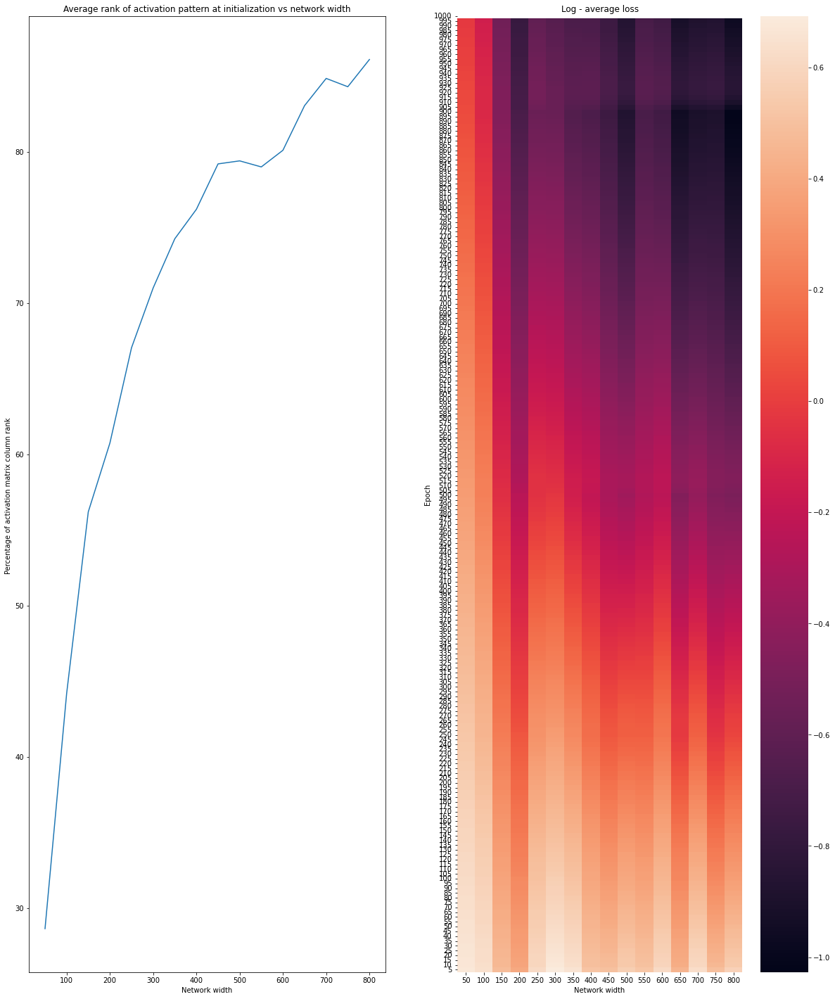

In [208]:
fig,ax = plt.subplots(1,2,figsize=(20,25))
ax[0].plot(D1, av_rank_A_init2)
ax[0].set_xlabel("Network width")
ax[0].set_ylabel("Percentage of activation matrix column rank ")
ax[0].set_title("Average rank of activation pattern at initialization vs network width")

row1 = 0
row2 = -1

sns.heatmap(np.log10(av_loss_epochs_vs_m2[row1:row2]), ax=ax[1], xticklabels=D1, yticklabels=loss_epochs)
ax[1].invert_yaxis()
ax[1].set_xlabel("Network width")
ax[1].set_ylabel("Epoch")
ax[1].set_title("Log - average loss")